In [1]:
!pip install scikit-optimize

In [2]:
!pip install statsmodels

In [3]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from collections import Counter

import statsmodels.stats.api as sms
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

In [4]:
import warnings
warnings.filterwarnings("ignore")

# Functions

In [5]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [6]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

In [7]:
from scipy.stats import norm

def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [8]:
def draw_res_analys(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [9]:
def get_feature_imp(model, X_train):
    imp = model.get_feature_importance(data=X_train)
    fig, axes = plt.subplots(1, 1, figsize=(12, 8))
    axes.barh(width=imp, y=model.feature_names_)
    axes.set_title('Finetuned Catboost feature importance')
    plt.show()

# Unhashing

In [10]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime'}

In [11]:
types_mapping = {'1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
    '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
    '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
    '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы' }

In [12]:
import pickle

with open('./income_target.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [13]:
df.shape

(6036, 21)

In [14]:
df

,availability,actor,age_access_type,country,average_rating,duration,type,name,release_year,genre,...,element_uid,subscription_only,av_rate_x,av_rate_y,users_number_x,users_number_y,user_count_3months,av_ratings_3months,min_ts,price
0,[SUBSCRIPTION],"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, a51b376...",0,"[usa, canada]",6.21,4860000,MOVIE,Большое путешествие,2006,"[Family, 287a1485-7a88-4c2f-bc94-ca418b6c47a1]",...,d8b55146-dee5-4498-957c-5614414b48fb,True,-0.043478,-0.041667,1,1,1,-0.043478,2020-09-23 17:37:14,56468.0
1,"[DTO, RENT]","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be...",16,[usa],NaN,5280000,MOVIE,Роман с кукушкой,2021,"[Comedy, Melodrama, Drama]",...,a367ca50-ef7d-4a4c-b89a-c8692defa697,False,0.010101,0.006173,5,6,5,0.010101,2022-07-14 11:49:33,114578.0
2,"[DTO, RENT, SUBSCRIPTION]","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 21c7a45...",12,[usa],7.45,6960000,MOVIE,Звёздный путь 2: Гнев Хана,1982,"[Sci-Fi, Action, Thriller, Drama, Adventure]",...,da00c8f6-38a6-4615-9dba-3c6b14155b4e,False,0.083333,0.083333,1,1,1,0.083333,2020-09-22 17:11:29,24039.0
3,"[DTO, RENT, SUBSCRIPTION]","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 21c7a45...",12,[usa],7.28,7140000,MOVIE,Звёздный путь 4: Дорога домой,1986,"[Sci-Fi, Action, Comedy, Adventure]",...,994c4cb6-e4a7-48d6-8283-6629801de4f2,False,0.125000,0.125000,1,1,1,0.125000,2020-09-22 17:12:00,17360.0
4,"[DTO, RENT, SUBSCRIPTION]","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 21c7a45...",12,[usa],7.16,8580000,MOVIE,Звёздный путь: Фильм,1979,"[Sci-Fi, Thriller, Adventure]",...,147a05ce-ccd6-4c1d-82eb-16a62c5439c1,False,0.055556,0.055556,1,1,1,0.055556,2020-09-21 17:08:52,49703.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6031,"[SUBSCRIPTION, AVOD]","[3e11b471-95ec-4eea-97a9-4ac1be00c173, 35e1c4a...",16,[ussr],7.99,8640000,MP_MOVIE,Экипаж,1980,[Humor],...,c85cdc52-b05a-4c41-bf77-c1102dd79b52,False,0.028000,0.025735,7,7,7,0.028000,2020-09-20 15:48:07,2868.0
6032,"[SUBSCRIPTION, AVOD]","[483fcbca-fb6e-425a-a90c-ae0c5ebf75fc, 4c3bf2d...",12,[ussr],7.86,7200000,MP_MOVIE,Чучело,1984,"[Drama, Humor]",...,482a17c8-a96e-4bf2-a191-98506a3069de,False,0.020460,0.019231,10,10,10,0.020460,2020-09-27 12:21:52,6138.0
6033,[SUBSCRIPTION],"[24cc555d-fabb-4b95-ad79-7ec88060c555, 4a8cfab...",12,[ussr],8.14,7680000,MP_MOVIE,Десять негритят,1987,"[Thriller, Detective, 364fdc2e-bdfe-40be-b2c5-...",...,d061cafa-df19-4290-a9b0-a4927af2386e,True,0.017668,0.015723,14,14,14,0.017668,2020-09-20 15:23:28,11178.0
6034,[SUBSCRIPTION],"[6d568dbe-782a-4e2f-affb-5c987ddf6617, 6d0e158...",12,[ussr],7.65,8700000,MP_MOVIE,Астенический синдром,1989,[Drama],...,51440a4d-f55b-485e-bfdd-dbccc9ae09fd,True,0.055556,0.047619,1,1,1,0.055556,2020-09-21 21:15:12,515.0


In [15]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [16]:
all_unique_genres = set(all_genres)

In [17]:
len(all_unique_genres)

27

In [18]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Humor',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'b0836a1d-635f-4d89-bcc5-25d10ba56642',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [19]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [20]:
decoded_genres

['5c403894-146a-47a4-ae75-9f1956a30dbb',
 'Shorts',
 'Thriller',
 'Detective',
 'Horror',
 'Crime',
 'Music',
 'Sci-Fi',
 'Action',
 'Family',
 'Comedy',
 'Drama',
 'ArtHouse',
 'Anime',
 'Humor',
 'Melodrama',
 'ForKids',
 'Sport',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 'Cartoons',
 'History',
 'War_movies',
 'Documentary',
 'Theater',
 'Biography',
 'Adventure',
 'Fantasy']

In [21]:
all_genres = []

for col in ['actor', 'country', 'genre', 'director']:
    print(f'======{col}======')
    all_values = []
    for i, item_values in enumerate(df[col]):
        try:
            all_values.extend(item_values)
        except:
            print(i, item_values)
    all_values = set(all_values)
    print('Len:', len(all_values))
    # print(all_values)

======actor======
Len: 19196
======country======
Len: 98
======genre======
Len: 27
======director======
Len: 4178


# Preprocessing

In [22]:
prep_df = df.copy(deep=True)

In [23]:
prep_df.shape

(6036, 21)

### filter by year

In [24]:
prep_df = prep_df[prep_df['release_year'] >= 2000]

### topN

In [25]:
def add_topN_feature(df, col, n: int):
    items = []
    
    for i in df[col]:
        items.extend(i)

    topN = [x[0] for x in Counter(items).most_common()][:n]
    df[f'top{n}{col}'] = df[col].apply(lambda x: [int(item in x) for item in topN])
    df.drop(col, axis=1, inplace=True)
    return topN, f'top{n}{col}'

In [26]:
def ohe_topN_features(df, topN, cat):
    for i in range(len(topN)):
        df[f'{topN[i]}'] = [item[i] for item in df[cat]]
    df.drop(cat, axis=1, inplace=True)
    return df

In [27]:
top10genres, name = add_topN_feature(prep_df, 'genre', 10)
prep_df = ohe_topN_features(prep_df, top10genres, name)

In [28]:
top10actors, name = add_topN_feature(prep_df, 'actor', 10)
prep_df = ohe_topN_features(prep_df, top10actors, name)

In [29]:
top3directors, name = add_topN_feature(prep_df, 'director', 3)
prep_df = ohe_topN_features(prep_df, top3directors, name)

In [30]:
top5countries, name = add_topN_feature(prep_df, 'country', 5)
prep_df = ohe_topN_features(prep_df, top5countries, name)

In [31]:
prep_df.head().T

,0,1,5,6,7
availability,[SUBSCRIPTION],"[DTO, RENT]","[DTO, RENT]","[DTO, RENT, SUBSCRIPTION]","[DTO, RENT, SUBSCRIPTION]"
age_access_type,0,16,12,16,16
average_rating,6.21,NaN,6.78,7.75,6.0
duration,4860000,5280000,4800000,7620000,5820000
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
name,Большое путешествие,Роман с кукушкой,Лесная братва,Звездный путь,Страж Вселенной: петля времени
release_year,2006,2021,2006,2009,2017
element_uid,d8b55146-dee5-4498-957c-5614414b48fb,a367ca50-ef7d-4a4c-b89a-c8692defa697,97192c07-5ad7-481f-a5e6-e81ec438d693,1ff9b60d-ffe3-4eb7-bd7a-eb697255b4fa,cbadb4e2-6f3c-4b0d-b341-6b9e61101cfe
subscription_only,True,False,False,False,False
av_rate_x,-0.043478,0.010101,0.004102,0.010923,-0.026316


In [32]:
prep_df.columns

Index(['availability', 'age_access_type', 'average_rating', 'duration', 'type',
       'name', 'release_year', 'element_uid', 'subscription_only', 'av_rate_x',
       'av_rate_y', 'users_number_x', 'users_number_y', 'user_count_3months',
       'av_ratings_3months', 'min_ts', 'price', 'Drama', 'Comedy', 'Thriller',
       'Action', 'Adventure', 'Horror', 'Sci-Fi', 'Family',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Melodrama',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '0715c765-eb7d-4138-bed7-e515a04619e8',
       '7f890e13-4be1-4873-9df7-d144bdd91e50',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693',

In [34]:
cols = ['age_access_type',  'duration', 'type', 
        'price', 'Drama', 'Comedy', 'Thriller',
       'Action', 'Adventure', 'Horror', 'Sci-Fi', 'Family',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Melodrama',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '0715c765-eb7d-4138-bed7-e515a04619e8',
       '7f890e13-4be1-4873-9df7-d144bdd91e50',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693',
       '98f07d1e-d498-49b3-8ac8-30a5fc1dabfc', 'usa', 'russia',
       'great-britain', 'france', 'germany', ]

In [35]:
prep_df = prep_df[cols]

In [36]:
skewed_num_features = ['duration'] # can try 'average_rating'

In [37]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
import pandas as pd

class Preprocesser:
    def __init__(self, 
#                 mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
#                 mltpl_cat_n_top: dict
                ):
#         self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
#         self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
#         df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [38]:
preprocesser = Preprocesser(
#     mltpl_cat_features,
            skewed_num_features,
            #text_features,
#             mltpl_cat_n_top
                           )

In [39]:
df_pr = preprocesser.preprocess(prep_df)

In [40]:
df_pr.isnull().sum()

age_access_type                         0
duration                                0
type                                    0
price                                   0
Drama                                   0
Comedy                                  0
Thriller                                0
Action                                  0
Adventure                               0
Horror                                  0
Sci-Fi                                  0
Family                                  0
364fdc2e-bdfe-40be-b2c5-d30f43ec432e    0
Melodrama                               0
fd401c6b-3e00-4f7f-aea7-5512df6b91e0    0
5463b4bc-e332-415c-aca8-11c0f217a9eb    0
fbdae856-85b9-4d4a-96dd-cc383571a488    0
9703b641-2566-4e58-aebb-8d140805c0f3    0
b6a30330-1dcb-4093-b6a9-ce0f779874c2    0
586f8d5a-2f17-42a3-b066-667f7c26a842    0
2ab01676-2af6-4abb-8dde-dc51e7e22372    0
dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9    0
0715c765-eb7d-4138-bed7-e515a04619e8    0
7f890e13-4be1-4873-9df7-d144bdd91e

In [42]:
df_pr.columns

Index(['age_access_type', 'duration', 'type', 'price', 'Drama', 'Comedy',
       'Thriller', 'Action', 'Adventure', 'Horror', 'Sci-Fi', 'Family',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Melodrama',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '0715c765-eb7d-4138-bed7-e515a04619e8',
       '7f890e13-4be1-4873-9df7-d144bdd91e50',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693',
       '98f07d1e-d498-49b3-8ac8-30a5fc1dabfc', 'usa', 'russia',
       'great-britain', 'france', 'germany'],
      dtype='object')

In [43]:
df_pr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5023 entries, 0 to 6015
Data columns (total 32 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   age_access_type                       5023 non-null   object 
 1   duration                              5023 non-null   float64
 2   type                                  5023 non-null   object 
 3   price                                 5023 non-null   float32
 4   Drama                                 5023 non-null   int64  
 5   Comedy                                5023 non-null   int64  
 6   Thriller                              5023 non-null   int64  
 7   Action                                5023 non-null   int64  
 8   Adventure                             5023 non-null   int64  
 9   Horror                                5023 non-null   int64  
 10  Sci-Fi                                5023 non-null   int64  
 11  Family           

### target destr

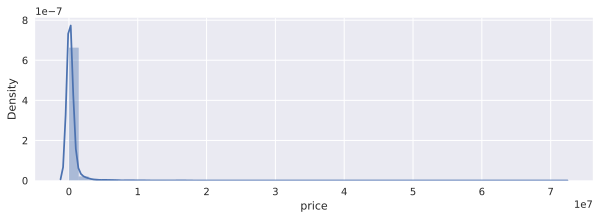

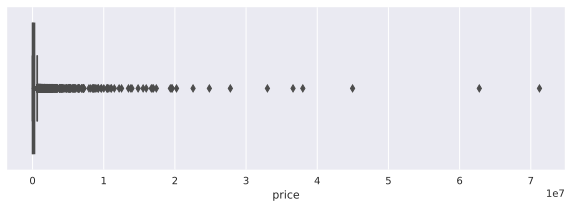

In [44]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['price'])
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['price'], orient='h')
plt.show()

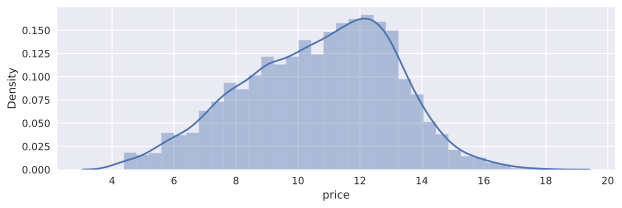

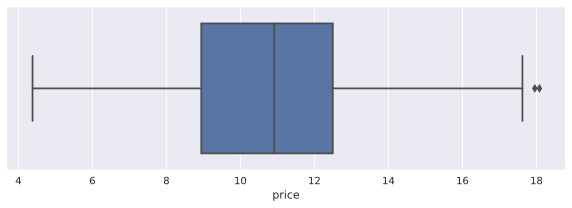

In [45]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['price'].apply(lambda x: np.log1p(x)))
plt.show()

plt.figure(figsize=(10, 3))
sns.boxplot(df_pr['price'].apply(lambda x: np.log1p(x)), orient='h')
plt.show()

## Split

In [46]:
df_pr.shape

(5023, 32)

In [47]:
X, y = df_pr.drop('price', axis=1), df_pr['price']

y = y.apply(lambda x: np.log1p(x))

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=False)

In [49]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=False)

In [50]:
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape

((4068, 31), (452, 31), (503, 31), (4068,), (452,), (503,))

In [51]:
cat_features = ['age_access_type', 'type']

In [52]:
X_train.columns

Index(['age_access_type', 'duration', 'type', 'Drama', 'Comedy', 'Thriller',
       'Action', 'Adventure', 'Horror', 'Sci-Fi', 'Family',
       '364fdc2e-bdfe-40be-b2c5-d30f43ec432e', 'Melodrama',
       'fd401c6b-3e00-4f7f-aea7-5512df6b91e0',
       '5463b4bc-e332-415c-aca8-11c0f217a9eb',
       'fbdae856-85b9-4d4a-96dd-cc383571a488',
       '9703b641-2566-4e58-aebb-8d140805c0f3',
       'b6a30330-1dcb-4093-b6a9-ce0f779874c2',
       '586f8d5a-2f17-42a3-b066-667f7c26a842',
       '2ab01676-2af6-4abb-8dde-dc51e7e22372',
       'dfd861c4-d2de-4bb6-bc6e-bae3f92a18a9',
       '0715c765-eb7d-4138-bed7-e515a04619e8',
       '7f890e13-4be1-4873-9df7-d144bdd91e50',
       'f7ded2b9-7c98-47ab-bfc4-57fb60bf946c',
       '799561d3-10b0-420d-93be-8138a07ac693',
       '98f07d1e-d498-49b3-8ac8-30a5fc1dabfc', 'usa', 'russia',
       'great-britain', 'france', 'germany'],
      dtype='object')

# Modeling

In [53]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

from scipy.stats import uniform, randint

In [54]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.06347
0:	learn: 1.9524416	test: 2.1459679	best: 2.1459679 (0)	total: 48.7ms	remaining: 48.6s
100:	learn: 1.7302435	test: 1.9000337	best: 1.8999649 (98)	total: 186ms	remaining: 1.65s
200:	learn: 1.6826215	test: 1.9001723	best: 1.8980961 (108)	total: 319ms	remaining: 1.27s
300:	learn: 1.6455759	test: 1.8963062	best: 1.8943765 (275)	total: 453ms	remaining: 1.05s
400:	learn: 1.6135718	test: 1.9063257	best: 1.8943765 (275)	total: 587ms	remaining: 877ms
500:	learn: 1.5856654	test: 1.9131063	best: 1.8943765 (275)	total: 723ms	remaining: 721ms
600:	learn: 1.5646684	test: 1.9165971	best: 1.8943765 (275)	total: 862ms	remaining: 572ms
700:	learn: 1.5448994	test: 1.9214937	best: 1.8943765 (275)	total: 1s	remaining: 427ms
Stopped by overfitting detector  (500 iterations wait)

bestTest = 1.894376541
bestIteration = 275

Shrink model to first 276 iterations.


In [55]:
y_pred = cat_model.predict(test_dataset)

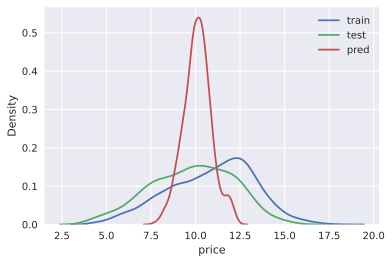

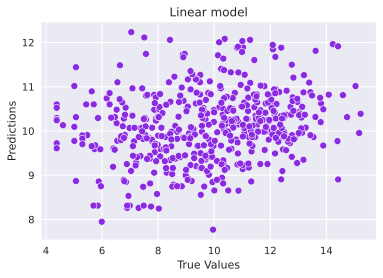

In [56]:
target_distr_linear(y_train, y_test, y_pred)   

In [57]:
def inverse_transform(feature):
    return np.expm1(feature)

calc_metrics(inverse_transform(y_test), inverse_transform(y_pred))

*** VAL **: 
MSE:   161663695673.12643
RMSE:  402074.2414941878
R2:    -0.06266761447231306
MAE:   133369.8340524169
MedAE: 29155.214621242685
------------------------------


In [59]:
cat_model.save_model('cat_reg_okko_ratings_cat_ntop')

**Feature importance**

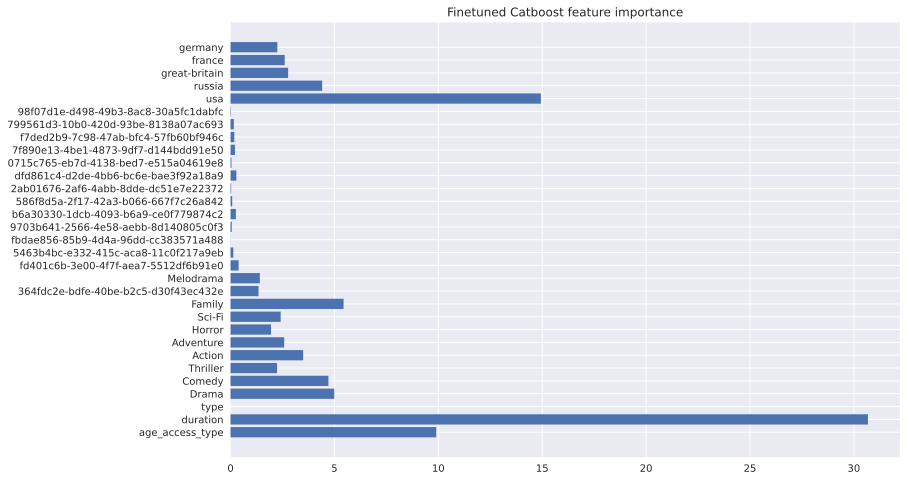

In [60]:
get_feature_imp(cat_model, train_dataset)

1)  The most influential features:  
    - duration  
    - average_rating  
    - age_access_type  

2)  The lowest influential features:  
    - actors and directors are not so important

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.

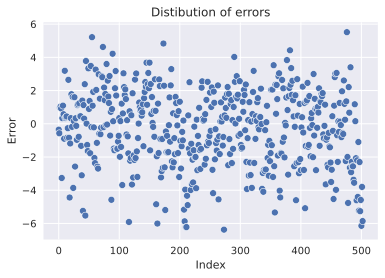

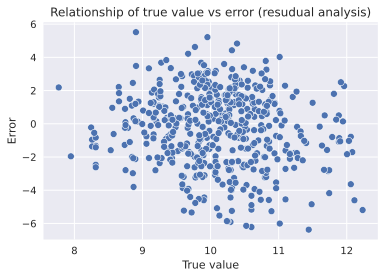

In [61]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)

**Conclusion**
* The trend in the second figure is not visible, now we will confirm the presence of heteroskedasticity on tests.

# Tuning

In [62]:
train_dataset = cat.Pool(X_train, y_train, 
                         cat_features=cat_features) 

test_dataset = cat.Pool(X_test, y_test,
                         cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [63]:
parameters_distr = {'depth': randint(5, 10),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [5000, 10000, 15000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, 
#                           n_jobs=-1,
                          verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_okko_rat_ntop', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 1.9683072	total: 3.21ms	remaining: 32.1s
1:	learn: 1.9654604	total: 4.31ms	remaining: 21.6s
2:	learn: 1.9628932	total: 4.94ms	remaining: 16.5s
3:	learn: 1.9595818	total: 6.93ms	remaining: 17.3s
4:	learn: 1.9564644	total: 8.98ms	remaining: 18s
5:	learn: 1.9537503	total: 9.87ms	remaining: 16.4s
6:	learn: 1.9513594	total: 10.5ms	remaining: 15s
7:	learn: 1.9491139	total: 11.3ms	remaining: 14.1s
8:	learn: 1.9468390	total: 11.9ms	remaining: 13.2s
9:	learn: 1.9442790	total: 13.8ms	remaining: 13.8s
10:	learn: 1.9411565	total: 15.6ms	remaining: 14.1s
11:	learn: 1.9390003	total: 16.3ms	remaining: 13.6s
12:	learn: 1.9361912	total: 18.2ms	remaining: 14s
13:	learn: 1.9335455	total: 20ms	remaining: 14.3s
14:	learn: 1.9311539	total: 21.8ms	remaining: 14.5s
15:	learn: 1.9287832	total: 23.6ms	remaining: 14.7s
16:	learn: 1.9263512	total: 25.5ms	remaining: 15s
17:	learn: 1.9242538	total: 26.6ms	remaining: 14.7s
18:	learn: 1.9216577	to

241:	learn: 1.7482727	total: 387ms	remaining: 15.6s
242:	learn: 1.7481582	total: 389ms	remaining: 15.6s
243:	learn: 1.7479682	total: 391ms	remaining: 15.6s
244:	learn: 1.7477329	total: 393ms	remaining: 15.6s
245:	learn: 1.7475670	total: 395ms	remaining: 15.7s
246:	learn: 1.7474484	total: 396ms	remaining: 15.7s
247:	learn: 1.7470056	total: 398ms	remaining: 15.6s
248:	learn: 1.7466962	total: 400ms	remaining: 15.6s
249:	learn: 1.7464714	total: 401ms	remaining: 15.7s
250:	learn: 1.7461774	total: 403ms	remaining: 15.6s
251:	learn: 1.7460989	total: 405ms	remaining: 15.7s
252:	learn: 1.7457966	total: 406ms	remaining: 15.6s
253:	learn: 1.7457388	total: 407ms	remaining: 15.6s
254:	learn: 1.7455375	total: 408ms	remaining: 15.6s
255:	learn: 1.7452299	total: 411ms	remaining: 15.6s
256:	learn: 1.7450367	total: 413ms	remaining: 15.6s
257:	learn: 1.7446593	total: 414ms	remaining: 15.6s
258:	learn: 1.7444543	total: 416ms	remaining: 15.7s
259:	learn: 1.7443936	total: 418ms	remaining: 15.7s
260:	learn: 

497:	learn: 1.7110906	total: 781ms	remaining: 14.9s
498:	learn: 1.7110427	total: 783ms	remaining: 14.9s
499:	learn: 1.7110355	total: 784ms	remaining: 14.9s
500:	learn: 1.7109862	total: 786ms	remaining: 14.9s
501:	learn: 1.7108817	total: 787ms	remaining: 14.9s
502:	learn: 1.7107894	total: 789ms	remaining: 14.9s
503:	learn: 1.7107682	total: 790ms	remaining: 14.9s
504:	learn: 1.7106118	total: 791ms	remaining: 14.9s
505:	learn: 1.7104617	total: 793ms	remaining: 14.9s
506:	learn: 1.7103070	total: 795ms	remaining: 14.9s
507:	learn: 1.7101607	total: 796ms	remaining: 14.9s
508:	learn: 1.7100979	total: 798ms	remaining: 14.9s
509:	learn: 1.7100239	total: 800ms	remaining: 14.9s
510:	learn: 1.7100151	total: 800ms	remaining: 14.9s
511:	learn: 1.7098990	total: 802ms	remaining: 14.9s
512:	learn: 1.7098507	total: 804ms	remaining: 14.9s
513:	learn: 1.7097855	total: 806ms	remaining: 14.9s
514:	learn: 1.7097677	total: 807ms	remaining: 14.9s
515:	learn: 1.7097042	total: 808ms	remaining: 14.9s
516:	learn: 

758:	learn: 1.6834117	total: 1.18s	remaining: 14.3s
759:	learn: 1.6833867	total: 1.18s	remaining: 14.3s
760:	learn: 1.6833278	total: 1.18s	remaining: 14.3s
761:	learn: 1.6832248	total: 1.18s	remaining: 14.3s
762:	learn: 1.6830450	total: 1.18s	remaining: 14.3s
763:	learn: 1.6829257	total: 1.18s	remaining: 14.3s
764:	learn: 1.6828132	total: 1.19s	remaining: 14.3s
765:	learn: 1.6827109	total: 1.19s	remaining: 14.3s
766:	learn: 1.6825463	total: 1.19s	remaining: 14.3s
767:	learn: 1.6824564	total: 1.19s	remaining: 14.3s
768:	learn: 1.6824567	total: 1.19s	remaining: 14.3s
769:	learn: 1.6823471	total: 1.19s	remaining: 14.3s
770:	learn: 1.6822729	total: 1.19s	remaining: 14.3s
771:	learn: 1.6820639	total: 1.2s	remaining: 14.3s
772:	learn: 1.6819497	total: 1.2s	remaining: 14.3s
773:	learn: 1.6817170	total: 1.2s	remaining: 14.3s
774:	learn: 1.6816702	total: 1.2s	remaining: 14.3s
775:	learn: 1.6815018	total: 1.2s	remaining: 14.3s
776:	learn: 1.6813827	total: 1.2s	remaining: 14.3s
777:	learn: 1.6812

1003:	learn: 1.6565926	total: 1.57s	remaining: 14.1s
1004:	learn: 1.6565358	total: 1.57s	remaining: 14.1s
1005:	learn: 1.6564377	total: 1.57s	remaining: 14.1s
1006:	learn: 1.6563448	total: 1.58s	remaining: 14.1s
1007:	learn: 1.6562318	total: 1.58s	remaining: 14.1s
1008:	learn: 1.6562037	total: 1.58s	remaining: 14.1s
1009:	learn: 1.6560632	total: 1.58s	remaining: 14.1s
1010:	learn: 1.6560077	total: 1.58s	remaining: 14.1s
1011:	learn: 1.6559084	total: 1.58s	remaining: 14.1s
1012:	learn: 1.6557907	total: 1.59s	remaining: 14.1s
1013:	learn: 1.6557113	total: 1.59s	remaining: 14.1s
1014:	learn: 1.6556077	total: 1.59s	remaining: 14.1s
1015:	learn: 1.6555402	total: 1.59s	remaining: 14.1s
1016:	learn: 1.6554232	total: 1.59s	remaining: 14.1s
1017:	learn: 1.6551412	total: 1.59s	remaining: 14.1s
1018:	learn: 1.6549201	total: 1.6s	remaining: 14.1s
1019:	learn: 1.6548479	total: 1.6s	remaining: 14.1s
1020:	learn: 1.6547144	total: 1.6s	remaining: 14.1s
1021:	learn: 1.6546092	total: 1.6s	remaining: 14.

1241:	learn: 1.6300352	total: 1.97s	remaining: 13.9s
1242:	learn: 1.6297833	total: 1.97s	remaining: 13.9s
1243:	learn: 1.6297370	total: 1.97s	remaining: 13.9s
1244:	learn: 1.6297127	total: 1.97s	remaining: 13.9s
1245:	learn: 1.6296501	total: 1.98s	remaining: 13.9s
1246:	learn: 1.6294895	total: 1.98s	remaining: 13.9s
1247:	learn: 1.6294143	total: 1.98s	remaining: 13.9s
1248:	learn: 1.6292976	total: 1.98s	remaining: 13.9s
1249:	learn: 1.6292457	total: 1.98s	remaining: 13.9s
1250:	learn: 1.6292026	total: 1.98s	remaining: 13.9s
1251:	learn: 1.6290772	total: 1.99s	remaining: 13.9s
1252:	learn: 1.6290523	total: 1.99s	remaining: 13.9s
1253:	learn: 1.6290062	total: 1.99s	remaining: 13.9s
1254:	learn: 1.6289782	total: 1.99s	remaining: 13.9s
1255:	learn: 1.6289558	total: 1.99s	remaining: 13.9s
1256:	learn: 1.6289314	total: 1.99s	remaining: 13.9s
1257:	learn: 1.6288463	total: 1.99s	remaining: 13.9s
1258:	learn: 1.6288241	total: 2s	remaining: 13.9s
1259:	learn: 1.6286170	total: 2s	remaining: 13.9s

1478:	learn: 1.6066759	total: 2.37s	remaining: 13.6s
1479:	learn: 1.6066582	total: 2.37s	remaining: 13.6s
1480:	learn: 1.6064933	total: 2.37s	remaining: 13.6s
1481:	learn: 1.6063531	total: 2.37s	remaining: 13.6s
1482:	learn: 1.6061317	total: 2.37s	remaining: 13.6s
1483:	learn: 1.6061015	total: 2.37s	remaining: 13.6s
1484:	learn: 1.6059661	total: 2.38s	remaining: 13.6s
1485:	learn: 1.6059124	total: 2.38s	remaining: 13.6s
1486:	learn: 1.6057731	total: 2.38s	remaining: 13.6s
1487:	learn: 1.6056630	total: 2.38s	remaining: 13.6s
1488:	learn: 1.6054968	total: 2.38s	remaining: 13.6s
1489:	learn: 1.6054859	total: 2.38s	remaining: 13.6s
1490:	learn: 1.6054755	total: 2.38s	remaining: 13.6s
1491:	learn: 1.6054002	total: 2.39s	remaining: 13.6s
1492:	learn: 1.6051546	total: 2.39s	remaining: 13.6s
1493:	learn: 1.6050686	total: 2.39s	remaining: 13.6s
1494:	learn: 1.6049686	total: 2.39s	remaining: 13.6s
1495:	learn: 1.6049562	total: 2.39s	remaining: 13.6s
1496:	learn: 1.6049154	total: 2.39s	remaining:

1713:	learn: 1.5853041	total: 2.76s	remaining: 13.3s
1714:	learn: 1.5852183	total: 2.76s	remaining: 13.3s
1715:	learn: 1.5851671	total: 2.76s	remaining: 13.3s
1716:	learn: 1.5851616	total: 2.77s	remaining: 13.3s
1717:	learn: 1.5850921	total: 2.77s	remaining: 13.3s
1718:	learn: 1.5850658	total: 2.77s	remaining: 13.3s
1719:	learn: 1.5850203	total: 2.77s	remaining: 13.3s
1720:	learn: 1.5848173	total: 2.77s	remaining: 13.3s
1721:	learn: 1.5847151	total: 2.77s	remaining: 13.3s
1722:	learn: 1.5845823	total: 2.78s	remaining: 13.3s
1723:	learn: 1.5843144	total: 2.78s	remaining: 13.3s
1724:	learn: 1.5842000	total: 2.78s	remaining: 13.3s
1725:	learn: 1.5840681	total: 2.78s	remaining: 13.3s
1726:	learn: 1.5840008	total: 2.78s	remaining: 13.3s
1727:	learn: 1.5839579	total: 2.78s	remaining: 13.3s
1728:	learn: 1.5838200	total: 2.79s	remaining: 13.3s
1729:	learn: 1.5837808	total: 2.79s	remaining: 13.3s
1730:	learn: 1.5834808	total: 2.79s	remaining: 13.3s
1731:	learn: 1.5834781	total: 2.79s	remaining:

1950:	learn: 1.5647457	total: 3.16s	remaining: 13s
1951:	learn: 1.5646771	total: 3.16s	remaining: 13s
1952:	learn: 1.5644794	total: 3.16s	remaining: 13s
1953:	learn: 1.5644017	total: 3.16s	remaining: 13s
1954:	learn: 1.5643189	total: 3.16s	remaining: 13s
1955:	learn: 1.5641599	total: 3.16s	remaining: 13s
1956:	learn: 1.5641452	total: 3.17s	remaining: 13s
1957:	learn: 1.5640317	total: 3.17s	remaining: 13s
1958:	learn: 1.5639769	total: 3.17s	remaining: 13s
1959:	learn: 1.5639614	total: 3.17s	remaining: 13s
1960:	learn: 1.5639323	total: 3.17s	remaining: 13s
1961:	learn: 1.5638972	total: 3.17s	remaining: 13s
1962:	learn: 1.5638522	total: 3.18s	remaining: 13s
1963:	learn: 1.5638414	total: 3.18s	remaining: 13s
1964:	learn: 1.5637725	total: 3.18s	remaining: 13s
1965:	learn: 1.5637076	total: 3.18s	remaining: 13s
1966:	learn: 1.5635449	total: 3.18s	remaining: 13s
1967:	learn: 1.5635328	total: 3.18s	remaining: 13s
1968:	learn: 1.5634784	total: 3.19s	remaining: 13s
1969:	learn: 1.5634231	total: 3

2186:	learn: 1.5470715	total: 3.55s	remaining: 12.7s
2187:	learn: 1.5470275	total: 3.55s	remaining: 12.7s
2188:	learn: 1.5469228	total: 3.56s	remaining: 12.7s
2189:	learn: 1.5468553	total: 3.56s	remaining: 12.7s
2190:	learn: 1.5467260	total: 3.56s	remaining: 12.7s
2191:	learn: 1.5466159	total: 3.56s	remaining: 12.7s
2192:	learn: 1.5465877	total: 3.56s	remaining: 12.7s
2193:	learn: 1.5464520	total: 3.56s	remaining: 12.7s
2194:	learn: 1.5463226	total: 3.56s	remaining: 12.7s
2195:	learn: 1.5462807	total: 3.57s	remaining: 12.7s
2196:	learn: 1.5462569	total: 3.57s	remaining: 12.7s
2197:	learn: 1.5462241	total: 3.57s	remaining: 12.7s
2198:	learn: 1.5461647	total: 3.57s	remaining: 12.7s
2199:	learn: 1.5461164	total: 3.57s	remaining: 12.7s
2200:	learn: 1.5459978	total: 3.58s	remaining: 12.7s
2201:	learn: 1.5459697	total: 3.58s	remaining: 12.7s
2202:	learn: 1.5458315	total: 3.58s	remaining: 12.7s
2203:	learn: 1.5457796	total: 3.58s	remaining: 12.7s
2204:	learn: 1.5457090	total: 3.58s	remaining:

2418:	learn: 1.5305243	total: 3.95s	remaining: 12.4s
2419:	learn: 1.5304871	total: 3.95s	remaining: 12.4s
2420:	learn: 1.5304453	total: 3.95s	remaining: 12.4s
2421:	learn: 1.5303938	total: 3.95s	remaining: 12.4s
2422:	learn: 1.5302926	total: 3.95s	remaining: 12.4s
2423:	learn: 1.5302218	total: 3.96s	remaining: 12.4s
2424:	learn: 1.5302066	total: 3.96s	remaining: 12.4s
2425:	learn: 1.5301808	total: 3.96s	remaining: 12.4s
2426:	learn: 1.5301813	total: 3.96s	remaining: 12.4s
2427:	learn: 1.5301476	total: 3.96s	remaining: 12.4s
2428:	learn: 1.5301427	total: 3.96s	remaining: 12.4s
2429:	learn: 1.5300594	total: 3.96s	remaining: 12.4s
2430:	learn: 1.5299554	total: 3.97s	remaining: 12.4s
2431:	learn: 1.5298399	total: 3.97s	remaining: 12.3s
2432:	learn: 1.5296602	total: 3.97s	remaining: 12.3s
2433:	learn: 1.5295350	total: 3.97s	remaining: 12.3s
2434:	learn: 1.5295337	total: 3.97s	remaining: 12.3s
2435:	learn: 1.5294931	total: 3.98s	remaining: 12.3s
2436:	learn: 1.5293939	total: 3.98s	remaining:

2655:	learn: 1.5151200	total: 4.34s	remaining: 12s
2656:	learn: 1.5150670	total: 4.34s	remaining: 12s
2657:	learn: 1.5150102	total: 4.35s	remaining: 12s
2658:	learn: 1.5148957	total: 4.35s	remaining: 12s
2659:	learn: 1.5148595	total: 4.35s	remaining: 12s
2660:	learn: 1.5148253	total: 4.35s	remaining: 12s
2661:	learn: 1.5147827	total: 4.36s	remaining: 12s
2662:	learn: 1.5147784	total: 4.36s	remaining: 12s
2663:	learn: 1.5146952	total: 4.36s	remaining: 12s
2664:	learn: 1.5146149	total: 4.36s	remaining: 12s
2665:	learn: 1.5145997	total: 4.36s	remaining: 12s
2666:	learn: 1.5144807	total: 4.36s	remaining: 12s
2667:	learn: 1.5144236	total: 4.37s	remaining: 12s
2668:	learn: 1.5143033	total: 4.37s	remaining: 12s
2669:	learn: 1.5142307	total: 4.37s	remaining: 12s
2670:	learn: 1.5141603	total: 4.37s	remaining: 12s
2671:	learn: 1.5141191	total: 4.37s	remaining: 12s
2672:	learn: 1.5140143	total: 4.37s	remaining: 12s
2673:	learn: 1.5139603	total: 4.38s	remaining: 12s
2674:	learn: 1.5138160	total: 4

2886:	learn: 1.5007513	total: 4.74s	remaining: 11.7s
2887:	learn: 1.5005836	total: 4.74s	remaining: 11.7s
2888:	learn: 1.5003789	total: 4.74s	remaining: 11.7s
2889:	learn: 1.5003636	total: 4.74s	remaining: 11.7s
2890:	learn: 1.5003337	total: 4.75s	remaining: 11.7s
2891:	learn: 1.5002878	total: 4.75s	remaining: 11.7s
2892:	learn: 1.5002381	total: 4.75s	remaining: 11.7s
2893:	learn: 1.5001612	total: 4.75s	remaining: 11.7s
2894:	learn: 1.5001137	total: 4.75s	remaining: 11.7s
2895:	learn: 1.5000497	total: 4.75s	remaining: 11.7s
2896:	learn: 1.4999293	total: 4.76s	remaining: 11.7s
2897:	learn: 1.4998817	total: 4.76s	remaining: 11.7s
2898:	learn: 1.4998671	total: 4.76s	remaining: 11.7s
2899:	learn: 1.4998671	total: 4.76s	remaining: 11.7s
2900:	learn: 1.4998512	total: 4.76s	remaining: 11.7s
2901:	learn: 1.4998161	total: 4.76s	remaining: 11.7s
2902:	learn: 1.4998067	total: 4.77s	remaining: 11.7s
2903:	learn: 1.4997743	total: 4.77s	remaining: 11.7s
2904:	learn: 1.4997627	total: 4.77s	remaining:

3121:	learn: 1.4866685	total: 5.14s	remaining: 11.3s
3122:	learn: 1.4865252	total: 5.14s	remaining: 11.3s
3123:	learn: 1.4864082	total: 5.14s	remaining: 11.3s
3124:	learn: 1.4862810	total: 5.14s	remaining: 11.3s
3125:	learn: 1.4862570	total: 5.14s	remaining: 11.3s
3126:	learn: 1.4862169	total: 5.14s	remaining: 11.3s
3127:	learn: 1.4861159	total: 5.15s	remaining: 11.3s
3128:	learn: 1.4860522	total: 5.15s	remaining: 11.3s
3129:	learn: 1.4860023	total: 5.15s	remaining: 11.3s
3130:	learn: 1.4859762	total: 5.15s	remaining: 11.3s
3131:	learn: 1.4859733	total: 5.15s	remaining: 11.3s
3132:	learn: 1.4859698	total: 5.15s	remaining: 11.3s
3133:	learn: 1.4858974	total: 5.16s	remaining: 11.3s
3134:	learn: 1.4858359	total: 5.16s	remaining: 11.3s
3135:	learn: 1.4857936	total: 5.16s	remaining: 11.3s
3136:	learn: 1.4857342	total: 5.16s	remaining: 11.3s
3137:	learn: 1.4857248	total: 5.16s	remaining: 11.3s
3138:	learn: 1.4857073	total: 5.16s	remaining: 11.3s
3139:	learn: 1.4856738	total: 5.17s	remaining:

3358:	learn: 1.4741263	total: 5.53s	remaining: 10.9s
3359:	learn: 1.4740407	total: 5.53s	remaining: 10.9s
3360:	learn: 1.4739622	total: 5.54s	remaining: 10.9s
3361:	learn: 1.4739291	total: 5.54s	remaining: 10.9s
3362:	learn: 1.4738864	total: 5.54s	remaining: 10.9s
3363:	learn: 1.4738454	total: 5.54s	remaining: 10.9s
3364:	learn: 1.4738424	total: 5.54s	remaining: 10.9s
3365:	learn: 1.4737934	total: 5.54s	remaining: 10.9s
3366:	learn: 1.4737923	total: 5.54s	remaining: 10.9s
3367:	learn: 1.4737620	total: 5.55s	remaining: 10.9s
3368:	learn: 1.4737350	total: 5.55s	remaining: 10.9s
3369:	learn: 1.4737194	total: 5.55s	remaining: 10.9s
3370:	learn: 1.4737150	total: 5.55s	remaining: 10.9s
3371:	learn: 1.4736794	total: 5.55s	remaining: 10.9s
3372:	learn: 1.4736485	total: 5.55s	remaining: 10.9s
3373:	learn: 1.4736246	total: 5.56s	remaining: 10.9s
3374:	learn: 1.4736042	total: 5.56s	remaining: 10.9s
3375:	learn: 1.4735682	total: 5.56s	remaining: 10.9s
3376:	learn: 1.4735337	total: 5.56s	remaining:

3592:	learn: 1.4622915	total: 5.93s	remaining: 10.6s
3593:	learn: 1.4622207	total: 5.93s	remaining: 10.6s
3594:	learn: 1.4621562	total: 5.93s	remaining: 10.6s
3595:	learn: 1.4620908	total: 5.93s	remaining: 10.6s
3596:	learn: 1.4620633	total: 5.93s	remaining: 10.6s
3597:	learn: 1.4620351	total: 5.94s	remaining: 10.6s
3598:	learn: 1.4619608	total: 5.94s	remaining: 10.6s
3599:	learn: 1.4618766	total: 5.94s	remaining: 10.6s
3600:	learn: 1.4618202	total: 5.94s	remaining: 10.6s
3601:	learn: 1.4617856	total: 5.94s	remaining: 10.6s
3602:	learn: 1.4617792	total: 5.95s	remaining: 10.6s
3603:	learn: 1.4617455	total: 5.95s	remaining: 10.6s
3604:	learn: 1.4617218	total: 5.95s	remaining: 10.6s
3605:	learn: 1.4616218	total: 5.95s	remaining: 10.6s
3606:	learn: 1.4615114	total: 5.95s	remaining: 10.5s
3607:	learn: 1.4614985	total: 5.95s	remaining: 10.5s
3608:	learn: 1.4614808	total: 5.96s	remaining: 10.5s
3609:	learn: 1.4614338	total: 5.96s	remaining: 10.5s
3610:	learn: 1.4613070	total: 5.96s	remaining:

3826:	learn: 1.4499213	total: 6.32s	remaining: 10.2s
3827:	learn: 1.4498492	total: 6.33s	remaining: 10.2s
3828:	learn: 1.4498277	total: 6.33s	remaining: 10.2s
3829:	learn: 1.4497294	total: 6.33s	remaining: 10.2s
3830:	learn: 1.4496096	total: 6.33s	remaining: 10.2s
3831:	learn: 1.4495691	total: 6.33s	remaining: 10.2s
3832:	learn: 1.4493884	total: 6.33s	remaining: 10.2s
3833:	learn: 1.4493466	total: 6.34s	remaining: 10.2s
3834:	learn: 1.4493011	total: 6.34s	remaining: 10.2s
3835:	learn: 1.4492955	total: 6.34s	remaining: 10.2s
3836:	learn: 1.4492190	total: 6.34s	remaining: 10.2s
3837:	learn: 1.4491649	total: 6.34s	remaining: 10.2s
3838:	learn: 1.4491500	total: 6.34s	remaining: 10.2s
3839:	learn: 1.4490948	total: 6.35s	remaining: 10.2s
3840:	learn: 1.4490419	total: 6.35s	remaining: 10.2s
3841:	learn: 1.4489030	total: 6.35s	remaining: 10.2s
3842:	learn: 1.4488629	total: 6.35s	remaining: 10.2s
3843:	learn: 1.4488123	total: 6.35s	remaining: 10.2s
3844:	learn: 1.4488020	total: 6.36s	remaining:

4059:	learn: 1.4381734	total: 6.72s	remaining: 9.83s
4060:	learn: 1.4381295	total: 6.72s	remaining: 9.83s
4061:	learn: 1.4381112	total: 6.72s	remaining: 9.83s
4062:	learn: 1.4379724	total: 6.72s	remaining: 9.83s
4063:	learn: 1.4379497	total: 6.73s	remaining: 9.82s
4064:	learn: 1.4379107	total: 6.73s	remaining: 9.82s
4065:	learn: 1.4378854	total: 6.73s	remaining: 9.82s
4066:	learn: 1.4377604	total: 6.73s	remaining: 9.82s
4067:	learn: 1.4377509	total: 6.73s	remaining: 9.82s
4068:	learn: 1.4377452	total: 6.74s	remaining: 9.82s
4069:	learn: 1.4377086	total: 6.74s	remaining: 9.81s
4070:	learn: 1.4377044	total: 6.74s	remaining: 9.81s
4071:	learn: 1.4376632	total: 6.74s	remaining: 9.81s
4072:	learn: 1.4375644	total: 6.74s	remaining: 9.81s
4073:	learn: 1.4374241	total: 6.74s	remaining: 9.81s
4074:	learn: 1.4373142	total: 6.75s	remaining: 9.81s
4075:	learn: 1.4372185	total: 6.75s	remaining: 9.81s
4076:	learn: 1.4371956	total: 6.75s	remaining: 9.8s
4077:	learn: 1.4371687	total: 6.75s	remaining: 

4286:	learn: 1.4269910	total: 7.12s	remaining: 9.48s
4287:	learn: 1.4269472	total: 7.12s	remaining: 9.48s
4288:	learn: 1.4269261	total: 7.12s	remaining: 9.48s
4289:	learn: 1.4268761	total: 7.12s	remaining: 9.48s
4290:	learn: 1.4268208	total: 7.12s	remaining: 9.48s
4291:	learn: 1.4267472	total: 7.12s	remaining: 9.47s
4292:	learn: 1.4267336	total: 7.13s	remaining: 9.47s
4293:	learn: 1.4266915	total: 7.13s	remaining: 9.47s
4294:	learn: 1.4266270	total: 7.13s	remaining: 9.47s
4295:	learn: 1.4266264	total: 7.13s	remaining: 9.47s
4296:	learn: 1.4265533	total: 7.13s	remaining: 9.47s
4297:	learn: 1.4264804	total: 7.13s	remaining: 9.47s
4298:	learn: 1.4264263	total: 7.14s	remaining: 9.46s
4299:	learn: 1.4263906	total: 7.14s	remaining: 9.46s
4300:	learn: 1.4263680	total: 7.14s	remaining: 9.46s
4301:	learn: 1.4263487	total: 7.14s	remaining: 9.46s
4302:	learn: 1.4263443	total: 7.14s	remaining: 9.46s
4303:	learn: 1.4263139	total: 7.14s	remaining: 9.46s
4304:	learn: 1.4262468	total: 7.15s	remaining:

4519:	learn: 1.4165771	total: 7.51s	remaining: 9.11s
4520:	learn: 1.4165424	total: 7.51s	remaining: 9.11s
4521:	learn: 1.4165168	total: 7.51s	remaining: 9.1s
4522:	learn: 1.4164737	total: 7.52s	remaining: 9.1s
4523:	learn: 1.4164241	total: 7.52s	remaining: 9.1s
4524:	learn: 1.4163855	total: 7.52s	remaining: 9.1s
4525:	learn: 1.4163480	total: 7.52s	remaining: 9.1s
4526:	learn: 1.4162995	total: 7.52s	remaining: 9.1s
4527:	learn: 1.4162795	total: 7.53s	remaining: 9.09s
4528:	learn: 1.4162287	total: 7.53s	remaining: 9.09s
4529:	learn: 1.4162044	total: 7.53s	remaining: 9.09s
4530:	learn: 1.4161482	total: 7.53s	remaining: 9.09s
4531:	learn: 1.4161197	total: 7.53s	remaining: 9.09s
4532:	learn: 1.4161134	total: 7.53s	remaining: 9.09s
4533:	learn: 1.4160796	total: 7.54s	remaining: 9.08s
4534:	learn: 1.4159341	total: 7.54s	remaining: 9.08s
4535:	learn: 1.4158832	total: 7.54s	remaining: 9.08s
4536:	learn: 1.4158763	total: 7.54s	remaining: 9.08s
4537:	learn: 1.4157875	total: 7.54s	remaining: 9.08s

4750:	learn: 1.4062145	total: 7.91s	remaining: 8.73s
4751:	learn: 1.4061705	total: 7.91s	remaining: 8.73s
4752:	learn: 1.4061490	total: 7.91s	remaining: 8.73s
4753:	learn: 1.4061489	total: 7.91s	remaining: 8.73s
4754:	learn: 1.4061451	total: 7.91s	remaining: 8.73s
4755:	learn: 1.4061141	total: 7.92s	remaining: 8.73s
4756:	learn: 1.4060655	total: 7.92s	remaining: 8.73s
4757:	learn: 1.4059798	total: 7.92s	remaining: 8.72s
4758:	learn: 1.4059796	total: 7.92s	remaining: 8.72s
4759:	learn: 1.4058622	total: 7.92s	remaining: 8.72s
4760:	learn: 1.4057940	total: 7.92s	remaining: 8.72s
4761:	learn: 1.4056999	total: 7.93s	remaining: 8.72s
4762:	learn: 1.4056344	total: 7.93s	remaining: 8.72s
4763:	learn: 1.4056035	total: 7.93s	remaining: 8.71s
4764:	learn: 1.4055382	total: 7.93s	remaining: 8.71s
4765:	learn: 1.4055356	total: 7.93s	remaining: 8.71s
4766:	learn: 1.4054447	total: 7.93s	remaining: 8.71s
4767:	learn: 1.4053929	total: 7.94s	remaining: 8.71s
4768:	learn: 1.4053868	total: 7.94s	remaining:

4980:	learn: 1.3972880	total: 8.3s	remaining: 8.37s
4981:	learn: 1.3972141	total: 8.3s	remaining: 8.37s
4982:	learn: 1.3971989	total: 8.31s	remaining: 8.36s
4983:	learn: 1.3971563	total: 8.31s	remaining: 8.36s
4984:	learn: 1.3971504	total: 8.31s	remaining: 8.36s
4985:	learn: 1.3971019	total: 8.31s	remaining: 8.36s
4986:	learn: 1.3970680	total: 8.31s	remaining: 8.36s
4987:	learn: 1.3969733	total: 8.31s	remaining: 8.36s
4988:	learn: 1.3968916	total: 8.32s	remaining: 8.35s
4989:	learn: 1.3968639	total: 8.32s	remaining: 8.35s
4990:	learn: 1.3968426	total: 8.32s	remaining: 8.35s
4991:	learn: 1.3968072	total: 8.32s	remaining: 8.35s
4992:	learn: 1.3967723	total: 8.32s	remaining: 8.35s
4993:	learn: 1.3966747	total: 8.32s	remaining: 8.35s
4994:	learn: 1.3966409	total: 8.33s	remaining: 8.34s
4995:	learn: 1.3966357	total: 8.33s	remaining: 8.34s
4996:	learn: 1.3966091	total: 8.33s	remaining: 8.34s
4997:	learn: 1.3964725	total: 8.33s	remaining: 8.34s
4998:	learn: 1.3964314	total: 8.33s	remaining: 8

5210:	learn: 1.3866833	total: 8.7s	remaining: 7.99s
5211:	learn: 1.3866296	total: 8.7s	remaining: 7.99s
5212:	learn: 1.3865910	total: 8.7s	remaining: 7.99s
5213:	learn: 1.3864836	total: 8.7s	remaining: 7.99s
5214:	learn: 1.3864822	total: 8.71s	remaining: 7.99s
5215:	learn: 1.3863378	total: 8.71s	remaining: 7.99s
5216:	learn: 1.3862779	total: 8.71s	remaining: 7.98s
5217:	learn: 1.3862067	total: 8.71s	remaining: 7.98s
5218:	learn: 1.3861093	total: 8.71s	remaining: 7.98s
5219:	learn: 1.3860828	total: 8.71s	remaining: 7.98s
5220:	learn: 1.3859796	total: 8.71s	remaining: 7.98s
5221:	learn: 1.3859382	total: 8.72s	remaining: 7.98s
5222:	learn: 1.3858595	total: 8.72s	remaining: 7.97s
5223:	learn: 1.3858059	total: 8.72s	remaining: 7.97s
5224:	learn: 1.3858012	total: 8.72s	remaining: 7.97s
5225:	learn: 1.3856775	total: 8.72s	remaining: 7.97s
5226:	learn: 1.3855769	total: 8.72s	remaining: 7.97s
5227:	learn: 1.3855534	total: 8.73s	remaining: 7.97s
5228:	learn: 1.3854963	total: 8.73s	remaining: 7.9

5438:	learn: 1.3771123	total: 9.09s	remaining: 7.63s
5439:	learn: 1.3770795	total: 9.1s	remaining: 7.62s
5440:	learn: 1.3770557	total: 9.1s	remaining: 7.62s
5441:	learn: 1.3770514	total: 9.1s	remaining: 7.62s
5442:	learn: 1.3770367	total: 9.1s	remaining: 7.62s
5443:	learn: 1.3769578	total: 9.1s	remaining: 7.62s
5444:	learn: 1.3769072	total: 9.1s	remaining: 7.62s
5445:	learn: 1.3767413	total: 9.11s	remaining: 7.61s
5446:	learn: 1.3766790	total: 9.11s	remaining: 7.61s
5447:	learn: 1.3765782	total: 9.11s	remaining: 7.61s
5448:	learn: 1.3765417	total: 9.11s	remaining: 7.61s
5449:	learn: 1.3765236	total: 9.11s	remaining: 7.61s
5450:	learn: 1.3765095	total: 9.11s	remaining: 7.61s
5451:	learn: 1.3764649	total: 9.12s	remaining: 7.6s
5452:	learn: 1.3764573	total: 9.12s	remaining: 7.6s
5453:	learn: 1.3764520	total: 9.12s	remaining: 7.6s
5454:	learn: 1.3763965	total: 9.12s	remaining: 7.6s
5455:	learn: 1.3763615	total: 9.12s	remaining: 7.6s
5456:	learn: 1.3763395	total: 9.12s	remaining: 7.6s
5457:

5670:	learn: 1.3685820	total: 9.49s	remaining: 7.24s
5671:	learn: 1.3685197	total: 9.49s	remaining: 7.24s
5672:	learn: 1.3684952	total: 9.49s	remaining: 7.24s
5673:	learn: 1.3684943	total: 9.49s	remaining: 7.24s
5674:	learn: 1.3684295	total: 9.5s	remaining: 7.24s
5675:	learn: 1.3684182	total: 9.5s	remaining: 7.24s
5676:	learn: 1.3684093	total: 9.5s	remaining: 7.23s
5677:	learn: 1.3683829	total: 9.5s	remaining: 7.23s
5678:	learn: 1.3683444	total: 9.5s	remaining: 7.23s
5679:	learn: 1.3682754	total: 9.51s	remaining: 7.23s
5680:	learn: 1.3682414	total: 9.51s	remaining: 7.23s
5681:	learn: 1.3682399	total: 9.51s	remaining: 7.23s
5682:	learn: 1.3681509	total: 9.51s	remaining: 7.22s
5683:	learn: 1.3680458	total: 9.51s	remaining: 7.22s
5684:	learn: 1.3679706	total: 9.51s	remaining: 7.22s
5685:	learn: 1.3679577	total: 9.52s	remaining: 7.22s
5686:	learn: 1.3678921	total: 9.52s	remaining: 7.22s
5687:	learn: 1.3678832	total: 9.52s	remaining: 7.22s
5688:	learn: 1.3678805	total: 9.52s	remaining: 7.21

5900:	learn: 1.3602798	total: 9.88s	remaining: 6.87s
5901:	learn: 1.3602596	total: 9.89s	remaining: 6.86s
5902:	learn: 1.3602275	total: 9.89s	remaining: 6.86s
5903:	learn: 1.3602035	total: 9.89s	remaining: 6.86s
5904:	learn: 1.3601960	total: 9.89s	remaining: 6.86s
5905:	learn: 1.3601390	total: 9.89s	remaining: 6.86s
5906:	learn: 1.3601144	total: 9.89s	remaining: 6.86s
5907:	learn: 1.3600848	total: 9.9s	remaining: 6.86s
5908:	learn: 1.3600303	total: 9.9s	remaining: 6.85s
5909:	learn: 1.3600248	total: 9.9s	remaining: 6.85s
5910:	learn: 1.3599880	total: 9.9s	remaining: 6.85s
5911:	learn: 1.3599241	total: 9.9s	remaining: 6.85s
5912:	learn: 1.3598327	total: 9.9s	remaining: 6.85s
5913:	learn: 1.3598087	total: 9.91s	remaining: 6.84s
5914:	learn: 1.3597860	total: 9.91s	remaining: 6.84s
5915:	learn: 1.3597160	total: 9.91s	remaining: 6.84s
5916:	learn: 1.3596658	total: 9.91s	remaining: 6.84s
5917:	learn: 1.3596483	total: 9.91s	remaining: 6.84s
5918:	learn: 1.3596371	total: 9.92s	remaining: 6.84s

6135:	learn: 1.3518174	total: 10.3s	remaining: 6.47s
6136:	learn: 1.3518022	total: 10.3s	remaining: 6.47s
6137:	learn: 1.3517923	total: 10.3s	remaining: 6.47s
6138:	learn: 1.3517869	total: 10.3s	remaining: 6.47s
6139:	learn: 1.3517441	total: 10.3s	remaining: 6.47s
6140:	learn: 1.3517306	total: 10.3s	remaining: 6.47s
6141:	learn: 1.3517056	total: 10.3s	remaining: 6.46s
6142:	learn: 1.3516999	total: 10.3s	remaining: 6.46s
6143:	learn: 1.3516931	total: 10.3s	remaining: 6.46s
6144:	learn: 1.3516408	total: 10.3s	remaining: 6.46s
6145:	learn: 1.3516269	total: 10.3s	remaining: 6.46s
6146:	learn: 1.3516037	total: 10.3s	remaining: 6.46s
6147:	learn: 1.3515820	total: 10.3s	remaining: 6.45s
6148:	learn: 1.3515394	total: 10.3s	remaining: 6.45s
6149:	learn: 1.3515271	total: 10.3s	remaining: 6.45s
6150:	learn: 1.3515202	total: 10.3s	remaining: 6.45s
6151:	learn: 1.3515165	total: 10.3s	remaining: 6.45s
6152:	learn: 1.3514559	total: 10.3s	remaining: 6.45s
6153:	learn: 1.3514409	total: 10.3s	remaining:

6369:	learn: 1.3437267	total: 10.7s	remaining: 6.08s
6370:	learn: 1.3436794	total: 10.7s	remaining: 6.08s
6371:	learn: 1.3436429	total: 10.7s	remaining: 6.08s
6372:	learn: 1.3436261	total: 10.7s	remaining: 6.08s
6373:	learn: 1.3435352	total: 10.7s	remaining: 6.08s
6374:	learn: 1.3435058	total: 10.7s	remaining: 6.08s
6375:	learn: 1.3434821	total: 10.7s	remaining: 6.07s
6376:	learn: 1.3434383	total: 10.7s	remaining: 6.07s
6377:	learn: 1.3433516	total: 10.7s	remaining: 6.07s
6378:	learn: 1.3432953	total: 10.7s	remaining: 6.07s
6379:	learn: 1.3432854	total: 10.7s	remaining: 6.07s
6380:	learn: 1.3432411	total: 10.7s	remaining: 6.07s
6381:	learn: 1.3431997	total: 10.7s	remaining: 6.06s
6382:	learn: 1.3431720	total: 10.7s	remaining: 6.06s
6383:	learn: 1.3431006	total: 10.7s	remaining: 6.06s
6384:	learn: 1.3429978	total: 10.7s	remaining: 6.06s
6385:	learn: 1.3429833	total: 10.7s	remaining: 6.06s
6386:	learn: 1.3429642	total: 10.7s	remaining: 6.06s
6387:	learn: 1.3429441	total: 10.7s	remaining:

6600:	learn: 1.3350774	total: 11.1s	remaining: 5.7s
6601:	learn: 1.3350755	total: 11.1s	remaining: 5.7s
6602:	learn: 1.3350688	total: 11.1s	remaining: 5.7s
6603:	learn: 1.3350005	total: 11.1s	remaining: 5.7s
6604:	learn: 1.3349590	total: 11.1s	remaining: 5.69s
6605:	learn: 1.3348949	total: 11.1s	remaining: 5.69s
6606:	learn: 1.3348289	total: 11.1s	remaining: 5.69s
6607:	learn: 1.3348141	total: 11.1s	remaining: 5.69s
6608:	learn: 1.3345956	total: 11.1s	remaining: 5.69s
6609:	learn: 1.3345599	total: 11.1s	remaining: 5.69s
6610:	learn: 1.3344933	total: 11.1s	remaining: 5.68s
6611:	learn: 1.3344530	total: 11.1s	remaining: 5.68s
6612:	learn: 1.3344275	total: 11.1s	remaining: 5.68s
6613:	learn: 1.3344070	total: 11.1s	remaining: 5.68s
6614:	learn: 1.3344012	total: 11.1s	remaining: 5.68s
6615:	learn: 1.3343584	total: 11.1s	remaining: 5.68s
6616:	learn: 1.3343006	total: 11.1s	remaining: 5.67s
6617:	learn: 1.3342575	total: 11.1s	remaining: 5.67s
6618:	learn: 1.3342424	total: 11.1s	remaining: 5.6

6833:	learn: 1.3263569	total: 11.5s	remaining: 5.31s
6834:	learn: 1.3262863	total: 11.5s	remaining: 5.31s
6835:	learn: 1.3262153	total: 11.5s	remaining: 5.31s
6836:	learn: 1.3262128	total: 11.5s	remaining: 5.31s
6837:	learn: 1.3262016	total: 11.5s	remaining: 5.31s
6838:	learn: 1.3260831	total: 11.5s	remaining: 5.3s
6839:	learn: 1.3260057	total: 11.5s	remaining: 5.3s
6840:	learn: 1.3259802	total: 11.5s	remaining: 5.3s
6841:	learn: 1.3259587	total: 11.5s	remaining: 5.3s
6842:	learn: 1.3258725	total: 11.5s	remaining: 5.3s
6843:	learn: 1.3258530	total: 11.5s	remaining: 5.3s
6844:	learn: 1.3258023	total: 11.5s	remaining: 5.29s
6845:	learn: 1.3257998	total: 11.5s	remaining: 5.29s
6846:	learn: 1.3257441	total: 11.5s	remaining: 5.29s
6847:	learn: 1.3257080	total: 11.5s	remaining: 5.29s
6848:	learn: 1.3256965	total: 11.5s	remaining: 5.29s
6849:	learn: 1.3255857	total: 11.5s	remaining: 5.29s
6850:	learn: 1.3255826	total: 11.5s	remaining: 5.28s
6851:	learn: 1.3255795	total: 11.5s	remaining: 5.28s

7064:	learn: 1.3178863	total: 11.9s	remaining: 4.93s
7065:	learn: 1.3178822	total: 11.9s	remaining: 4.93s
7066:	learn: 1.3178279	total: 11.9s	remaining: 4.92s
7067:	learn: 1.3177866	total: 11.9s	remaining: 4.92s
7068:	learn: 1.3177850	total: 11.9s	remaining: 4.92s
7069:	learn: 1.3177785	total: 11.9s	remaining: 4.92s
7070:	learn: 1.3177544	total: 11.9s	remaining: 4.92s
7071:	learn: 1.3177182	total: 11.9s	remaining: 4.92s
7072:	learn: 1.3176873	total: 11.9s	remaining: 4.92s
7073:	learn: 1.3176729	total: 11.9s	remaining: 4.91s
7074:	learn: 1.3175652	total: 11.9s	remaining: 4.91s
7075:	learn: 1.3175629	total: 11.9s	remaining: 4.91s
7076:	learn: 1.3175627	total: 11.9s	remaining: 4.91s
7077:	learn: 1.3175419	total: 11.9s	remaining: 4.91s
7078:	learn: 1.3175075	total: 11.9s	remaining: 4.91s
7079:	learn: 1.3174570	total: 11.9s	remaining: 4.9s
7080:	learn: 1.3174268	total: 11.9s	remaining: 4.9s
7081:	learn: 1.3174119	total: 11.9s	remaining: 4.9s
7082:	learn: 1.3173860	total: 11.9s	remaining: 4.

7293:	learn: 1.3101585	total: 12.3s	remaining: 4.55s
7294:	learn: 1.3101009	total: 12.3s	remaining: 4.55s
7295:	learn: 1.3100530	total: 12.3s	remaining: 4.54s
7296:	learn: 1.3100129	total: 12.3s	remaining: 4.54s
7297:	learn: 1.3100047	total: 12.3s	remaining: 4.54s
7298:	learn: 1.3099332	total: 12.3s	remaining: 4.54s
7299:	learn: 1.3099170	total: 12.3s	remaining: 4.54s
7300:	learn: 1.3099102	total: 12.3s	remaining: 4.54s
7301:	learn: 1.3098921	total: 12.3s	remaining: 4.53s
7302:	learn: 1.3098859	total: 12.3s	remaining: 4.53s
7303:	learn: 1.3098839	total: 12.3s	remaining: 4.53s
7304:	learn: 1.3098729	total: 12.3s	remaining: 4.53s
7305:	learn: 1.3098166	total: 12.3s	remaining: 4.53s
7306:	learn: 1.3098129	total: 12.3s	remaining: 4.53s
7307:	learn: 1.3097667	total: 12.3s	remaining: 4.52s
7308:	learn: 1.3097372	total: 12.3s	remaining: 4.52s
7309:	learn: 1.3097089	total: 12.3s	remaining: 4.52s
7310:	learn: 1.3096845	total: 12.3s	remaining: 4.52s
7311:	learn: 1.3096535	total: 12.3s	remaining:

7525:	learn: 1.3025282	total: 12.7s	remaining: 4.16s
7526:	learn: 1.3024650	total: 12.7s	remaining: 4.16s
7527:	learn: 1.3024200	total: 12.7s	remaining: 4.16s
7528:	learn: 1.3023692	total: 12.7s	remaining: 4.16s
7529:	learn: 1.3022912	total: 12.7s	remaining: 4.15s
7530:	learn: 1.3022094	total: 12.7s	remaining: 4.15s
7531:	learn: 1.3022007	total: 12.7s	remaining: 4.15s
7532:	learn: 1.3021728	total: 12.7s	remaining: 4.15s
7533:	learn: 1.3021510	total: 12.7s	remaining: 4.15s
7534:	learn: 1.3021361	total: 12.7s	remaining: 4.14s
7535:	learn: 1.3021315	total: 12.7s	remaining: 4.14s
7536:	learn: 1.3020836	total: 12.7s	remaining: 4.14s
7537:	learn: 1.3020520	total: 12.7s	remaining: 4.14s
7538:	learn: 1.3020451	total: 12.7s	remaining: 4.14s
7539:	learn: 1.3020360	total: 12.7s	remaining: 4.14s
7540:	learn: 1.3020143	total: 12.7s	remaining: 4.13s
7541:	learn: 1.3020051	total: 12.7s	remaining: 4.13s
7542:	learn: 1.3019739	total: 12.7s	remaining: 4.13s
7543:	learn: 1.3019663	total: 12.7s	remaining:

7754:	learn: 1.2944370	total: 13.1s	remaining: 3.78s
7755:	learn: 1.2944314	total: 13.1s	remaining: 3.78s
7756:	learn: 1.2943515	total: 13.1s	remaining: 3.77s
7757:	learn: 1.2943389	total: 13.1s	remaining: 3.77s
7758:	learn: 1.2942817	total: 13.1s	remaining: 3.77s
7759:	learn: 1.2942495	total: 13.1s	remaining: 3.77s
7760:	learn: 1.2942409	total: 13.1s	remaining: 3.77s
7761:	learn: 1.2941849	total: 13.1s	remaining: 3.77s
7762:	learn: 1.2940851	total: 13.1s	remaining: 3.77s
7763:	learn: 1.2940355	total: 13.1s	remaining: 3.76s
7764:	learn: 1.2940103	total: 13.1s	remaining: 3.76s
7765:	learn: 1.2939710	total: 13.1s	remaining: 3.76s
7766:	learn: 1.2938999	total: 13.1s	remaining: 3.76s
7767:	learn: 1.2938292	total: 13.1s	remaining: 3.76s
7768:	learn: 1.2938282	total: 13.1s	remaining: 3.75s
7769:	learn: 1.2938077	total: 13.1s	remaining: 3.75s
7770:	learn: 1.2937914	total: 13.1s	remaining: 3.75s
7771:	learn: 1.2937699	total: 13.1s	remaining: 3.75s
7772:	learn: 1.2937371	total: 13.1s	remaining:

7983:	learn: 1.2872378	total: 13.4s	remaining: 3.4s
7984:	learn: 1.2872133	total: 13.4s	remaining: 3.39s
7985:	learn: 1.2871572	total: 13.5s	remaining: 3.39s
7986:	learn: 1.2871346	total: 13.5s	remaining: 3.39s
7987:	learn: 1.2871227	total: 13.5s	remaining: 3.39s
7988:	learn: 1.2871209	total: 13.5s	remaining: 3.39s
7989:	learn: 1.2871007	total: 13.5s	remaining: 3.38s
7990:	learn: 1.2870950	total: 13.5s	remaining: 3.38s
7991:	learn: 1.2870538	total: 13.5s	remaining: 3.38s
7992:	learn: 1.2870034	total: 13.5s	remaining: 3.38s
7993:	learn: 1.2870006	total: 13.5s	remaining: 3.38s
7994:	learn: 1.2869627	total: 13.5s	remaining: 3.38s
7995:	learn: 1.2869154	total: 13.5s	remaining: 3.38s
7996:	learn: 1.2868458	total: 13.5s	remaining: 3.37s
7997:	learn: 1.2867808	total: 13.5s	remaining: 3.37s
7998:	learn: 1.2867448	total: 13.5s	remaining: 3.37s
7999:	learn: 1.2867411	total: 13.5s	remaining: 3.37s
8000:	learn: 1.2867012	total: 13.5s	remaining: 3.37s
8001:	learn: 1.2866810	total: 13.5s	remaining: 

8213:	learn: 1.2798342	total: 13.8s	remaining: 3.01s
8214:	learn: 1.2797870	total: 13.8s	remaining: 3.01s
8215:	learn: 1.2797085	total: 13.8s	remaining: 3.01s
8216:	learn: 1.2796811	total: 13.8s	remaining: 3s
8217:	learn: 1.2796632	total: 13.8s	remaining: 3s
8218:	learn: 1.2796596	total: 13.9s	remaining: 3s
8219:	learn: 1.2796579	total: 13.9s	remaining: 3s
8220:	learn: 1.2796396	total: 13.9s	remaining: 3s
8221:	learn: 1.2796093	total: 13.9s	remaining: 3s
8222:	learn: 1.2795316	total: 13.9s	remaining: 3s
8223:	learn: 1.2794839	total: 13.9s	remaining: 2.99s
8224:	learn: 1.2793885	total: 13.9s	remaining: 2.99s
8225:	learn: 1.2793631	total: 13.9s	remaining: 2.99s
8226:	learn: 1.2793526	total: 13.9s	remaining: 2.99s
8227:	learn: 1.2793428	total: 13.9s	remaining: 2.99s
8228:	learn: 1.2792893	total: 13.9s	remaining: 2.98s
8229:	learn: 1.2792002	total: 13.9s	remaining: 2.98s
8230:	learn: 1.2791048	total: 13.9s	remaining: 2.98s
8231:	learn: 1.2790935	total: 13.9s	remaining: 2.98s
8232:	learn: 1

8445:	learn: 1.2723773	total: 14.2s	remaining: 2.62s
8446:	learn: 1.2723596	total: 14.2s	remaining: 2.62s
8447:	learn: 1.2723012	total: 14.2s	remaining: 2.62s
8448:	learn: 1.2722961	total: 14.2s	remaining: 2.62s
8449:	learn: 1.2722908	total: 14.2s	remaining: 2.61s
8450:	learn: 1.2722655	total: 14.2s	remaining: 2.61s
8451:	learn: 1.2722652	total: 14.3s	remaining: 2.61s
8452:	learn: 1.2722573	total: 14.3s	remaining: 2.61s
8453:	learn: 1.2722549	total: 14.3s	remaining: 2.61s
8454:	learn: 1.2722190	total: 14.3s	remaining: 2.6s
8455:	learn: 1.2721880	total: 14.3s	remaining: 2.6s
8456:	learn: 1.2721530	total: 14.3s	remaining: 2.6s
8457:	learn: 1.2721510	total: 14.3s	remaining: 2.6s
8458:	learn: 1.2721326	total: 14.3s	remaining: 2.6s
8459:	learn: 1.2720640	total: 14.3s	remaining: 2.6s
8460:	learn: 1.2720485	total: 14.3s	remaining: 2.59s
8461:	learn: 1.2720140	total: 14.3s	remaining: 2.59s
8462:	learn: 1.2720047	total: 14.3s	remaining: 2.59s
8463:	learn: 1.2719826	total: 14.3s	remaining: 2.59s

8675:	learn: 1.2654084	total: 14.6s	remaining: 2.23s
8676:	learn: 1.2653852	total: 14.6s	remaining: 2.23s
8677:	learn: 1.2653077	total: 14.6s	remaining: 2.23s
8678:	learn: 1.2652939	total: 14.6s	remaining: 2.23s
8679:	learn: 1.2652922	total: 14.6s	remaining: 2.23s
8680:	learn: 1.2652209	total: 14.6s	remaining: 2.23s
8681:	learn: 1.2651311	total: 14.6s	remaining: 2.22s
8682:	learn: 1.2651185	total: 14.6s	remaining: 2.22s
8683:	learn: 1.2651142	total: 14.7s	remaining: 2.22s
8684:	learn: 1.2651121	total: 14.7s	remaining: 2.22s
8685:	learn: 1.2650467	total: 14.7s	remaining: 2.22s
8686:	learn: 1.2650293	total: 14.7s	remaining: 2.21s
8687:	learn: 1.2650183	total: 14.7s	remaining: 2.21s
8688:	learn: 1.2650138	total: 14.7s	remaining: 2.21s
8689:	learn: 1.2650137	total: 14.7s	remaining: 2.21s
8690:	learn: 1.2649788	total: 14.7s	remaining: 2.21s
8691:	learn: 1.2649502	total: 14.7s	remaining: 2.21s
8692:	learn: 1.2649481	total: 14.7s	remaining: 2.21s
8693:	learn: 1.2649093	total: 14.7s	remaining:

8907:	learn: 1.2589221	total: 15s	remaining: 1.84s
8908:	learn: 1.2589056	total: 15s	remaining: 1.84s
8909:	learn: 1.2588221	total: 15s	remaining: 1.84s
8910:	learn: 1.2587900	total: 15s	remaining: 1.84s
8911:	learn: 1.2587749	total: 15s	remaining: 1.84s
8912:	learn: 1.2587008	total: 15s	remaining: 1.83s
8913:	learn: 1.2586715	total: 15s	remaining: 1.83s
8914:	learn: 1.2586537	total: 15s	remaining: 1.83s
8915:	learn: 1.2586317	total: 15.1s	remaining: 1.83s
8916:	learn: 1.2586065	total: 15.1s	remaining: 1.83s
8917:	learn: 1.2585569	total: 15.1s	remaining: 1.83s
8918:	learn: 1.2585054	total: 15.1s	remaining: 1.82s
8919:	learn: 1.2584691	total: 15.1s	remaining: 1.82s
8920:	learn: 1.2584289	total: 15.1s	remaining: 1.82s
8921:	learn: 1.2584098	total: 15.1s	remaining: 1.82s
8922:	learn: 1.2584007	total: 15.1s	remaining: 1.82s
8923:	learn: 1.2583890	total: 15.1s	remaining: 1.82s
8924:	learn: 1.2583657	total: 15.1s	remaining: 1.81s
8925:	learn: 1.2583566	total: 15.1s	remaining: 1.81s
8926:	lea

9139:	learn: 1.2523243	total: 15.4s	remaining: 1.45s
9140:	learn: 1.2523053	total: 15.4s	remaining: 1.45s
9141:	learn: 1.2522496	total: 15.4s	remaining: 1.45s
9142:	learn: 1.2521923	total: 15.4s	remaining: 1.45s
9143:	learn: 1.2521465	total: 15.4s	remaining: 1.45s
9144:	learn: 1.2520695	total: 15.4s	remaining: 1.44s
9145:	learn: 1.2520601	total: 15.4s	remaining: 1.44s
9146:	learn: 1.2520223	total: 15.4s	remaining: 1.44s
9147:	learn: 1.2519820	total: 15.4s	remaining: 1.44s
9148:	learn: 1.2519547	total: 15.4s	remaining: 1.44s
9149:	learn: 1.2519509	total: 15.5s	remaining: 1.44s
9150:	learn: 1.2518582	total: 15.5s	remaining: 1.43s
9151:	learn: 1.2518489	total: 15.5s	remaining: 1.43s
9152:	learn: 1.2517848	total: 15.5s	remaining: 1.43s
9153:	learn: 1.2517447	total: 15.5s	remaining: 1.43s
9154:	learn: 1.2517435	total: 15.5s	remaining: 1.43s
9155:	learn: 1.2517009	total: 15.5s	remaining: 1.43s
9156:	learn: 1.2516929	total: 15.5s	remaining: 1.42s
9157:	learn: 1.2516916	total: 15.5s	remaining:

9370:	learn: 1.2453387	total: 15.8s	remaining: 1.06s
9371:	learn: 1.2453293	total: 15.8s	remaining: 1.06s
9372:	learn: 1.2453101	total: 15.8s	remaining: 1.06s
9373:	learn: 1.2453019	total: 15.8s	remaining: 1.06s
9374:	learn: 1.2452776	total: 15.8s	remaining: 1.05s
9375:	learn: 1.2452771	total: 15.8s	remaining: 1.05s
9376:	learn: 1.2452333	total: 15.8s	remaining: 1.05s
9377:	learn: 1.2452021	total: 15.8s	remaining: 1.05s
9378:	learn: 1.2451932	total: 15.8s	remaining: 1.05s
9379:	learn: 1.2451014	total: 15.8s	remaining: 1.05s
9380:	learn: 1.2450762	total: 15.8s	remaining: 1.04s
9381:	learn: 1.2450336	total: 15.8s	remaining: 1.04s
9382:	learn: 1.2449699	total: 15.8s	remaining: 1.04s
9383:	learn: 1.2449538	total: 15.9s	remaining: 1.04s
9384:	learn: 1.2449344	total: 15.9s	remaining: 1.04s
9385:	learn: 1.2449012	total: 15.9s	remaining: 1.04s
9386:	learn: 1.2448730	total: 15.9s	remaining: 1.03s
9387:	learn: 1.2448620	total: 15.9s	remaining: 1.03s
9388:	learn: 1.2448284	total: 15.9s	remaining:

9600:	learn: 1.2383915	total: 16.2s	remaining: 674ms
9601:	learn: 1.2383904	total: 16.2s	remaining: 673ms
9602:	learn: 1.2383668	total: 16.2s	remaining: 671ms
9603:	learn: 1.2383495	total: 16.2s	remaining: 669ms
9604:	learn: 1.2383468	total: 16.2s	remaining: 668ms
9605:	learn: 1.2383346	total: 16.2s	remaining: 666ms
9606:	learn: 1.2383055	total: 16.2s	remaining: 664ms
9607:	learn: 1.2382687	total: 16.2s	remaining: 663ms
9608:	learn: 1.2380629	total: 16.2s	remaining: 661ms
9609:	learn: 1.2380482	total: 16.2s	remaining: 659ms
9610:	learn: 1.2380291	total: 16.2s	remaining: 657ms
9611:	learn: 1.2380226	total: 16.2s	remaining: 656ms
9612:	learn: 1.2379386	total: 16.2s	remaining: 654ms
9613:	learn: 1.2379289	total: 16.2s	remaining: 652ms
9614:	learn: 1.2379250	total: 16.3s	remaining: 651ms
9615:	learn: 1.2379173	total: 16.3s	remaining: 649ms
9616:	learn: 1.2378627	total: 16.3s	remaining: 647ms
9617:	learn: 1.2378496	total: 16.3s	remaining: 646ms
9618:	learn: 1.2378166	total: 16.3s	remaining:

9830:	learn: 1.2316624	total: 16.6s	remaining: 286ms
9831:	learn: 1.2316364	total: 16.6s	remaining: 284ms
9832:	learn: 1.2316148	total: 16.6s	remaining: 282ms
9833:	learn: 1.2315846	total: 16.6s	remaining: 281ms
9834:	learn: 1.2315195	total: 16.6s	remaining: 279ms
9835:	learn: 1.2314963	total: 16.6s	remaining: 277ms
9836:	learn: 1.2314234	total: 16.6s	remaining: 276ms
9837:	learn: 1.2314224	total: 16.6s	remaining: 274ms
9838:	learn: 1.2314108	total: 16.6s	remaining: 272ms
9839:	learn: 1.2313933	total: 16.6s	remaining: 271ms
9840:	learn: 1.2312937	total: 16.6s	remaining: 269ms
9841:	learn: 1.2312889	total: 16.6s	remaining: 267ms
9842:	learn: 1.2311890	total: 16.6s	remaining: 265ms
9843:	learn: 1.2311479	total: 16.6s	remaining: 264ms
9844:	learn: 1.2311430	total: 16.6s	remaining: 262ms
9845:	learn: 1.2310945	total: 16.6s	remaining: 260ms
9846:	learn: 1.2310765	total: 16.7s	remaining: 259ms
9847:	learn: 1.2310344	total: 16.7s	remaining: 257ms
9848:	learn: 1.2310168	total: 16.7s	remaining:

[CV 1/5] END depth=7, iterations=10000, learning_rate=0.01195756774261977;, score=0.059 total time=  17.4s
0:	learn: 1.9615322	total: 2.82ms	remaining: 28.2s
1:	learn: 1.9583801	total: 4.86ms	remaining: 24.3s
2:	learn: 1.9553981	total: 6.78ms	remaining: 22.6s
3:	learn: 1.9526924	total: 8.56ms	remaining: 21.4s
4:	learn: 1.9494450	total: 10.3ms	remaining: 20.7s
5:	learn: 1.9466479	total: 12.2ms	remaining: 20.3s
6:	learn: 1.9437652	total: 13.9ms	remaining: 19.8s
7:	learn: 1.9411654	total: 15.6ms	remaining: 19.5s
8:	learn: 1.9382806	total: 17.4ms	remaining: 19.3s
9:	learn: 1.9352971	total: 19.1ms	remaining: 19.1s
10:	learn: 1.9322936	total: 20.9ms	remaining: 18.9s
11:	learn: 1.9297906	total: 22.5ms	remaining: 18.7s
12:	learn: 1.9275093	total: 24.2ms	remaining: 18.6s
13:	learn: 1.9249973	total: 26ms	remaining: 18.5s
14:	learn: 1.9226862	total: 27.7ms	remaining: 18.5s
15:	learn: 1.9202006	total: 29.5ms	remaining: 18.4s
16:	learn: 1.9185587	total: 30.1ms	remaining: 17.7s
17:	learn: 1.9162960	

231:	learn: 1.7433681	total: 391ms	remaining: 16.5s
232:	learn: 1.7431127	total: 393ms	remaining: 16.5s
233:	learn: 1.7428019	total: 394ms	remaining: 16.5s
234:	learn: 1.7422694	total: 396ms	remaining: 16.4s
235:	learn: 1.7415641	total: 398ms	remaining: 16.4s
236:	learn: 1.7411977	total: 399ms	remaining: 16.4s
237:	learn: 1.7411372	total: 401ms	remaining: 16.4s
238:	learn: 1.7408540	total: 403ms	remaining: 16.4s
239:	learn: 1.7406192	total: 404ms	remaining: 16.4s
240:	learn: 1.7404797	total: 407ms	remaining: 16.5s
241:	learn: 1.7404305	total: 407ms	remaining: 16.4s
242:	learn: 1.7400746	total: 409ms	remaining: 16.4s
243:	learn: 1.7399129	total: 411ms	remaining: 16.4s
244:	learn: 1.7395794	total: 412ms	remaining: 16.4s
245:	learn: 1.7393314	total: 414ms	remaining: 16.4s
246:	learn: 1.7390809	total: 416ms	remaining: 16.4s
247:	learn: 1.7389142	total: 417ms	remaining: 16.4s
248:	learn: 1.7389096	total: 418ms	remaining: 16.4s
249:	learn: 1.7384627	total: 420ms	remaining: 16.4s
250:	learn: 

485:	learn: 1.6988291	total: 786ms	remaining: 15.4s
486:	learn: 1.6987536	total: 788ms	remaining: 15.4s
487:	learn: 1.6985830	total: 789ms	remaining: 15.4s
488:	learn: 1.6984070	total: 791ms	remaining: 15.4s
489:	learn: 1.6983959	total: 792ms	remaining: 15.4s
490:	learn: 1.6983479	total: 793ms	remaining: 15.4s
491:	learn: 1.6982162	total: 795ms	remaining: 15.4s
492:	learn: 1.6981317	total: 796ms	remaining: 15.4s
493:	learn: 1.6981100	total: 797ms	remaining: 15.3s
494:	learn: 1.6980070	total: 799ms	remaining: 15.3s
495:	learn: 1.6978265	total: 801ms	remaining: 15.3s
496:	learn: 1.6975969	total: 803ms	remaining: 15.3s
497:	learn: 1.6973603	total: 804ms	remaining: 15.3s
498:	learn: 1.6973310	total: 805ms	remaining: 15.3s
499:	learn: 1.6971959	total: 807ms	remaining: 15.3s
500:	learn: 1.6970201	total: 808ms	remaining: 15.3s
501:	learn: 1.6968548	total: 810ms	remaining: 15.3s
502:	learn: 1.6964911	total: 812ms	remaining: 15.3s
503:	learn: 1.6964442	total: 814ms	remaining: 15.3s
504:	learn: 

728:	learn: 1.6650659	total: 1.18s	remaining: 15s
729:	learn: 1.6649440	total: 1.18s	remaining: 15s
730:	learn: 1.6649069	total: 1.19s	remaining: 15s
731:	learn: 1.6645028	total: 1.19s	remaining: 15s
732:	learn: 1.6643537	total: 1.19s	remaining: 15s
733:	learn: 1.6641343	total: 1.19s	remaining: 15s
734:	learn: 1.6639677	total: 1.19s	remaining: 15s
735:	learn: 1.6638791	total: 1.2s	remaining: 15.1s
736:	learn: 1.6637013	total: 1.2s	remaining: 15.1s
737:	learn: 1.6635360	total: 1.2s	remaining: 15.1s
738:	learn: 1.6634107	total: 1.2s	remaining: 15.1s
739:	learn: 1.6632384	total: 1.2s	remaining: 15.1s
740:	learn: 1.6630106	total: 1.2s	remaining: 15.1s
741:	learn: 1.6628702	total: 1.21s	remaining: 15s
742:	learn: 1.6627667	total: 1.21s	remaining: 15s
743:	learn: 1.6626507	total: 1.21s	remaining: 15s
744:	learn: 1.6625673	total: 1.21s	remaining: 15s
745:	learn: 1.6624593	total: 1.21s	remaining: 15s
746:	learn: 1.6624308	total: 1.21s	remaining: 15s
747:	learn: 1.6623585	total: 1.22s	remaining

962:	learn: 1.6334069	total: 1.58s	remaining: 14.8s
963:	learn: 1.6333761	total: 1.58s	remaining: 14.8s
964:	learn: 1.6332840	total: 1.58s	remaining: 14.8s
965:	learn: 1.6332080	total: 1.58s	remaining: 14.8s
966:	learn: 1.6330340	total: 1.59s	remaining: 14.8s
967:	learn: 1.6329396	total: 1.59s	remaining: 14.8s
968:	learn: 1.6328349	total: 1.59s	remaining: 14.8s
969:	learn: 1.6327516	total: 1.59s	remaining: 14.8s
970:	learn: 1.6326902	total: 1.59s	remaining: 14.8s
971:	learn: 1.6326196	total: 1.59s	remaining: 14.8s
972:	learn: 1.6325389	total: 1.6s	remaining: 14.8s
973:	learn: 1.6322976	total: 1.6s	remaining: 14.8s
974:	learn: 1.6321713	total: 1.6s	remaining: 14.8s
975:	learn: 1.6320369	total: 1.6s	remaining: 14.8s
976:	learn: 1.6319390	total: 1.6s	remaining: 14.8s
977:	learn: 1.6318618	total: 1.6s	remaining: 14.8s
978:	learn: 1.6317550	total: 1.61s	remaining: 14.8s
979:	learn: 1.6316530	total: 1.61s	remaining: 14.8s
980:	learn: 1.6314965	total: 1.61s	remaining: 14.8s
981:	learn: 1.6314

1192:	learn: 1.6055011	total: 1.98s	remaining: 14.6s
1193:	learn: 1.6053350	total: 1.98s	remaining: 14.6s
1194:	learn: 1.6051861	total: 1.98s	remaining: 14.6s
1195:	learn: 1.6050608	total: 1.98s	remaining: 14.6s
1196:	learn: 1.6047262	total: 1.98s	remaining: 14.6s
1197:	learn: 1.6045919	total: 1.98s	remaining: 14.6s
1198:	learn: 1.6045065	total: 1.99s	remaining: 14.6s
1199:	learn: 1.6044687	total: 1.99s	remaining: 14.6s
1200:	learn: 1.6042756	total: 1.99s	remaining: 14.6s
1201:	learn: 1.6042643	total: 1.99s	remaining: 14.6s
1202:	learn: 1.6042365	total: 1.99s	remaining: 14.6s
1203:	learn: 1.6041601	total: 1.99s	remaining: 14.6s
1204:	learn: 1.6040692	total: 2s	remaining: 14.6s
1205:	learn: 1.6038972	total: 2s	remaining: 14.6s
1206:	learn: 1.6038090	total: 2s	remaining: 14.6s
1207:	learn: 1.6037819	total: 2s	remaining: 14.6s
1208:	learn: 1.6036965	total: 2s	remaining: 14.6s
1209:	learn: 1.6035106	total: 2s	remaining: 14.6s
1210:	learn: 1.6033786	total: 2s	remaining: 14.6s
1211:	learn: 1

1423:	learn: 1.5776720	total: 2.37s	remaining: 14.3s
1424:	learn: 1.5776182	total: 2.37s	remaining: 14.3s
1425:	learn: 1.5776149	total: 2.37s	remaining: 14.3s
1426:	learn: 1.5775374	total: 2.37s	remaining: 14.3s
1427:	learn: 1.5774799	total: 2.38s	remaining: 14.3s
1428:	learn: 1.5773428	total: 2.38s	remaining: 14.3s
1429:	learn: 1.5772616	total: 2.38s	remaining: 14.3s
1430:	learn: 1.5771981	total: 2.38s	remaining: 14.3s
1431:	learn: 1.5770493	total: 2.38s	remaining: 14.3s
1432:	learn: 1.5770063	total: 2.38s	remaining: 14.3s
1433:	learn: 1.5768796	total: 2.39s	remaining: 14.3s
1434:	learn: 1.5767929	total: 2.39s	remaining: 14.3s
1435:	learn: 1.5766221	total: 2.39s	remaining: 14.3s
1436:	learn: 1.5764830	total: 2.39s	remaining: 14.3s
1437:	learn: 1.5763356	total: 2.39s	remaining: 14.3s
1438:	learn: 1.5762880	total: 2.4s	remaining: 14.3s
1439:	learn: 1.5762604	total: 2.4s	remaining: 14.3s
1440:	learn: 1.5760509	total: 2.4s	remaining: 14.3s
1441:	learn: 1.5760012	total: 2.4s	remaining: 14.

1653:	learn: 1.5538267	total: 2.76s	remaining: 14s
1654:	learn: 1.5537113	total: 2.77s	remaining: 13.9s
1655:	learn: 1.5536539	total: 2.77s	remaining: 13.9s
1656:	learn: 1.5535684	total: 2.77s	remaining: 13.9s
1657:	learn: 1.5535540	total: 2.77s	remaining: 13.9s
1658:	learn: 1.5535010	total: 2.77s	remaining: 13.9s
1659:	learn: 1.5533584	total: 2.77s	remaining: 13.9s
1660:	learn: 1.5533104	total: 2.78s	remaining: 13.9s
1661:	learn: 1.5532024	total: 2.78s	remaining: 13.9s
1662:	learn: 1.5531189	total: 2.78s	remaining: 13.9s
1663:	learn: 1.5530903	total: 2.78s	remaining: 13.9s
1664:	learn: 1.5530193	total: 2.78s	remaining: 13.9s
1665:	learn: 1.5529626	total: 2.78s	remaining: 13.9s
1666:	learn: 1.5528611	total: 2.79s	remaining: 13.9s
1667:	learn: 1.5527698	total: 2.79s	remaining: 13.9s
1668:	learn: 1.5526656	total: 2.79s	remaining: 13.9s
1669:	learn: 1.5525335	total: 2.79s	remaining: 13.9s
1670:	learn: 1.5523984	total: 2.79s	remaining: 13.9s
1671:	learn: 1.5523266	total: 2.79s	remaining: 1

1885:	learn: 1.5332652	total: 3.16s	remaining: 13.6s
1886:	learn: 1.5332180	total: 3.16s	remaining: 13.6s
1887:	learn: 1.5331218	total: 3.16s	remaining: 13.6s
1888:	learn: 1.5329883	total: 3.17s	remaining: 13.6s
1889:	learn: 1.5328713	total: 3.17s	remaining: 13.6s
1890:	learn: 1.5328423	total: 3.17s	remaining: 13.6s
1891:	learn: 1.5327801	total: 3.17s	remaining: 13.6s
1892:	learn: 1.5327354	total: 3.17s	remaining: 13.6s
1893:	learn: 1.5326094	total: 3.17s	remaining: 13.6s
1894:	learn: 1.5325601	total: 3.18s	remaining: 13.6s
1895:	learn: 1.5324087	total: 3.18s	remaining: 13.6s
1896:	learn: 1.5321343	total: 3.18s	remaining: 13.6s
1897:	learn: 1.5320397	total: 3.18s	remaining: 13.6s
1898:	learn: 1.5320363	total: 3.18s	remaining: 13.6s
1899:	learn: 1.5319685	total: 3.19s	remaining: 13.6s
1900:	learn: 1.5319103	total: 3.19s	remaining: 13.6s
1901:	learn: 1.5317926	total: 3.19s	remaining: 13.6s
1902:	learn: 1.5316916	total: 3.19s	remaining: 13.6s
1903:	learn: 1.5316175	total: 3.19s	remaining:

2116:	learn: 1.5130192	total: 3.56s	remaining: 13.2s
2117:	learn: 1.5128873	total: 3.56s	remaining: 13.2s
2118:	learn: 1.5128804	total: 3.56s	remaining: 13.2s
2119:	learn: 1.5128151	total: 3.56s	remaining: 13.2s
2120:	learn: 1.5127515	total: 3.56s	remaining: 13.2s
2121:	learn: 1.5127241	total: 3.57s	remaining: 13.2s
2122:	learn: 1.5125321	total: 3.57s	remaining: 13.2s
2123:	learn: 1.5124920	total: 3.57s	remaining: 13.2s
2124:	learn: 1.5124299	total: 3.57s	remaining: 13.2s
2125:	learn: 1.5122868	total: 3.57s	remaining: 13.2s
2126:	learn: 1.5122235	total: 3.57s	remaining: 13.2s
2127:	learn: 1.5121570	total: 3.58s	remaining: 13.2s
2128:	learn: 1.5120512	total: 3.58s	remaining: 13.2s
2129:	learn: 1.5119419	total: 3.58s	remaining: 13.2s
2130:	learn: 1.5118000	total: 3.58s	remaining: 13.2s
2131:	learn: 1.5117215	total: 3.58s	remaining: 13.2s
2132:	learn: 1.5116451	total: 3.58s	remaining: 13.2s
2133:	learn: 1.5115760	total: 3.59s	remaining: 13.2s
2134:	learn: 1.5115016	total: 3.59s	remaining:

2347:	learn: 1.4932736	total: 3.95s	remaining: 12.9s
2348:	learn: 1.4932102	total: 3.96s	remaining: 12.9s
2349:	learn: 1.4931262	total: 3.96s	remaining: 12.9s
2350:	learn: 1.4930568	total: 3.96s	remaining: 12.9s
2351:	learn: 1.4930449	total: 3.96s	remaining: 12.9s
2352:	learn: 1.4929031	total: 3.96s	remaining: 12.9s
2353:	learn: 1.4928653	total: 3.96s	remaining: 12.9s
2354:	learn: 1.4928392	total: 3.96s	remaining: 12.9s
2355:	learn: 1.4926719	total: 3.97s	remaining: 12.9s
2356:	learn: 1.4925875	total: 3.97s	remaining: 12.9s
2357:	learn: 1.4924161	total: 3.97s	remaining: 12.9s
2358:	learn: 1.4923188	total: 3.97s	remaining: 12.9s
2359:	learn: 1.4923093	total: 3.97s	remaining: 12.9s
2360:	learn: 1.4922815	total: 3.98s	remaining: 12.9s
2361:	learn: 1.4922701	total: 3.98s	remaining: 12.9s
2362:	learn: 1.4922202	total: 3.98s	remaining: 12.9s
2363:	learn: 1.4921088	total: 3.98s	remaining: 12.9s
2364:	learn: 1.4920904	total: 3.98s	remaining: 12.9s
2365:	learn: 1.4920862	total: 3.98s	remaining:

2580:	learn: 1.4747699	total: 4.35s	remaining: 12.5s
2581:	learn: 1.4747421	total: 4.35s	remaining: 12.5s
2582:	learn: 1.4746637	total: 4.35s	remaining: 12.5s
2583:	learn: 1.4746620	total: 4.35s	remaining: 12.5s
2584:	learn: 1.4746137	total: 4.36s	remaining: 12.5s
2585:	learn: 1.4745148	total: 4.36s	remaining: 12.5s
2586:	learn: 1.4744829	total: 4.36s	remaining: 12.5s
2587:	learn: 1.4743910	total: 4.36s	remaining: 12.5s
2588:	learn: 1.4743090	total: 4.36s	remaining: 12.5s
2589:	learn: 1.4742557	total: 4.36s	remaining: 12.5s
2590:	learn: 1.4742420	total: 4.37s	remaining: 12.5s
2591:	learn: 1.4742251	total: 4.37s	remaining: 12.5s
2592:	learn: 1.4742002	total: 4.37s	remaining: 12.5s
2593:	learn: 1.4741431	total: 4.37s	remaining: 12.5s
2594:	learn: 1.4740606	total: 4.37s	remaining: 12.5s
2595:	learn: 1.4739502	total: 4.38s	remaining: 12.5s
2596:	learn: 1.4738988	total: 4.38s	remaining: 12.5s
2597:	learn: 1.4736968	total: 4.38s	remaining: 12.5s
2598:	learn: 1.4736062	total: 4.38s	remaining:

2811:	learn: 1.4579224	total: 4.75s	remaining: 12.1s
2812:	learn: 1.4578314	total: 4.75s	remaining: 12.1s
2813:	learn: 1.4578213	total: 4.75s	remaining: 12.1s
2814:	learn: 1.4577725	total: 4.75s	remaining: 12.1s
2815:	learn: 1.4577145	total: 4.75s	remaining: 12.1s
2816:	learn: 1.4576700	total: 4.76s	remaining: 12.1s
2817:	learn: 1.4576089	total: 4.76s	remaining: 12.1s
2818:	learn: 1.4574366	total: 4.76s	remaining: 12.1s
2819:	learn: 1.4573426	total: 4.76s	remaining: 12.1s
2820:	learn: 1.4572897	total: 4.76s	remaining: 12.1s
2821:	learn: 1.4572818	total: 4.76s	remaining: 12.1s
2822:	learn: 1.4572586	total: 4.77s	remaining: 12.1s
2823:	learn: 1.4571116	total: 4.77s	remaining: 12.1s
2824:	learn: 1.4569573	total: 4.77s	remaining: 12.1s
2825:	learn: 1.4568676	total: 4.77s	remaining: 12.1s
2826:	learn: 1.4568129	total: 4.77s	remaining: 12.1s
2827:	learn: 1.4567398	total: 4.77s	remaining: 12.1s
2828:	learn: 1.4567057	total: 4.78s	remaining: 12.1s
2829:	learn: 1.4565836	total: 4.78s	remaining:

3043:	learn: 1.4420465	total: 5.14s	remaining: 11.8s
3044:	learn: 1.4418999	total: 5.14s	remaining: 11.8s
3045:	learn: 1.4418833	total: 5.15s	remaining: 11.8s
3046:	learn: 1.4418304	total: 5.15s	remaining: 11.7s
3047:	learn: 1.4416840	total: 5.15s	remaining: 11.7s
3048:	learn: 1.4415894	total: 5.15s	remaining: 11.7s
3049:	learn: 1.4414842	total: 5.15s	remaining: 11.7s
3050:	learn: 1.4414339	total: 5.16s	remaining: 11.7s
3051:	learn: 1.4413542	total: 5.16s	remaining: 11.7s
3052:	learn: 1.4413381	total: 5.16s	remaining: 11.7s
3053:	learn: 1.4411939	total: 5.16s	remaining: 11.7s
3054:	learn: 1.4411652	total: 5.16s	remaining: 11.7s
3055:	learn: 1.4411386	total: 5.16s	remaining: 11.7s
3056:	learn: 1.4410457	total: 5.17s	remaining: 11.7s
3057:	learn: 1.4409505	total: 5.17s	remaining: 11.7s
3058:	learn: 1.4408092	total: 5.17s	remaining: 11.7s
3059:	learn: 1.4407782	total: 5.17s	remaining: 11.7s
3060:	learn: 1.4407397	total: 5.17s	remaining: 11.7s
3061:	learn: 1.4406281	total: 5.17s	remaining:

3274:	learn: 1.4274546	total: 5.54s	remaining: 11.4s
3275:	learn: 1.4274164	total: 5.54s	remaining: 11.4s
3276:	learn: 1.4273540	total: 5.54s	remaining: 11.4s
3277:	learn: 1.4272767	total: 5.54s	remaining: 11.4s
3278:	learn: 1.4272709	total: 5.55s	remaining: 11.4s
3279:	learn: 1.4272332	total: 5.55s	remaining: 11.4s
3280:	learn: 1.4271954	total: 5.55s	remaining: 11.4s
3281:	learn: 1.4270968	total: 5.55s	remaining: 11.4s
3282:	learn: 1.4270376	total: 5.55s	remaining: 11.4s
3283:	learn: 1.4269784	total: 5.55s	remaining: 11.4s
3284:	learn: 1.4269398	total: 5.56s	remaining: 11.4s
3285:	learn: 1.4268683	total: 5.56s	remaining: 11.4s
3286:	learn: 1.4268332	total: 5.56s	remaining: 11.4s
3287:	learn: 1.4267511	total: 5.56s	remaining: 11.4s
3288:	learn: 1.4266879	total: 5.56s	remaining: 11.4s
3289:	learn: 1.4266436	total: 5.57s	remaining: 11.3s
3290:	learn: 1.4265654	total: 5.57s	remaining: 11.3s
3291:	learn: 1.4264885	total: 5.57s	remaining: 11.3s
3292:	learn: 1.4264568	total: 5.57s	remaining:

3504:	learn: 1.4140224	total: 5.94s	remaining: 11s
3505:	learn: 1.4139629	total: 5.94s	remaining: 11s
3506:	learn: 1.4139296	total: 5.94s	remaining: 11s
3507:	learn: 1.4139048	total: 5.94s	remaining: 11s
3508:	learn: 1.4138140	total: 5.94s	remaining: 11s
3509:	learn: 1.4137977	total: 5.95s	remaining: 11s
3510:	learn: 1.4137891	total: 5.95s	remaining: 11s
3511:	learn: 1.4137644	total: 5.95s	remaining: 11s
3512:	learn: 1.4136765	total: 5.95s	remaining: 11s
3513:	learn: 1.4134950	total: 5.95s	remaining: 11s
3514:	learn: 1.4134351	total: 5.95s	remaining: 11s
3515:	learn: 1.4134225	total: 5.96s	remaining: 11s
3516:	learn: 1.4133407	total: 5.96s	remaining: 11s
3517:	learn: 1.4132425	total: 5.96s	remaining: 11s
3518:	learn: 1.4131330	total: 5.96s	remaining: 11s
3519:	learn: 1.4130585	total: 5.96s	remaining: 11s
3520:	learn: 1.4129730	total: 5.96s	remaining: 11s
3521:	learn: 1.4128630	total: 5.97s	remaining: 11s
3522:	learn: 1.4128314	total: 5.97s	remaining: 11s
3523:	learn: 1.4128242	total: 5

3737:	learn: 1.4001954	total: 6.33s	remaining: 10.6s
3738:	learn: 1.4001327	total: 6.34s	remaining: 10.6s
3739:	learn: 1.4001004	total: 6.34s	remaining: 10.6s
3740:	learn: 1.4000611	total: 6.34s	remaining: 10.6s
3741:	learn: 1.4000603	total: 6.34s	remaining: 10.6s
3742:	learn: 1.4000553	total: 6.34s	remaining: 10.6s
3743:	learn: 1.4000541	total: 6.34s	remaining: 10.6s
3744:	learn: 1.4000238	total: 6.35s	remaining: 10.6s
3745:	learn: 1.3998991	total: 6.35s	remaining: 10.6s
3746:	learn: 1.3998322	total: 6.35s	remaining: 10.6s
3747:	learn: 1.3997628	total: 6.35s	remaining: 10.6s
3748:	learn: 1.3996992	total: 6.35s	remaining: 10.6s
3749:	learn: 1.3996173	total: 6.36s	remaining: 10.6s
3750:	learn: 1.3996142	total: 6.36s	remaining: 10.6s
3751:	learn: 1.3995967	total: 6.36s	remaining: 10.6s
3752:	learn: 1.3995962	total: 6.36s	remaining: 10.6s
3753:	learn: 1.3995831	total: 6.36s	remaining: 10.6s
3754:	learn: 1.3994488	total: 6.36s	remaining: 10.6s
3755:	learn: 1.3994239	total: 6.37s	remaining:

3972:	learn: 1.3879868	total: 6.73s	remaining: 10.2s
3973:	learn: 1.3879054	total: 6.73s	remaining: 10.2s
3974:	learn: 1.3878962	total: 6.74s	remaining: 10.2s
3975:	learn: 1.3878919	total: 6.74s	remaining: 10.2s
3976:	learn: 1.3878815	total: 6.74s	remaining: 10.2s
3977:	learn: 1.3878138	total: 6.74s	remaining: 10.2s
3978:	learn: 1.3877992	total: 6.74s	remaining: 10.2s
3979:	learn: 1.3877652	total: 6.74s	remaining: 10.2s
3980:	learn: 1.3876766	total: 6.75s	remaining: 10.2s
3981:	learn: 1.3876313	total: 6.75s	remaining: 10.2s
3982:	learn: 1.3876298	total: 6.75s	remaining: 10.2s
3983:	learn: 1.3875802	total: 6.75s	remaining: 10.2s
3984:	learn: 1.3875493	total: 6.75s	remaining: 10.2s
3985:	learn: 1.3875095	total: 6.75s	remaining: 10.2s
3986:	learn: 1.3874532	total: 6.75s	remaining: 10.2s
3987:	learn: 1.3873829	total: 6.76s	remaining: 10.2s
3988:	learn: 1.3873084	total: 6.76s	remaining: 10.2s
3989:	learn: 1.3872272	total: 6.76s	remaining: 10.2s
3990:	learn: 1.3871767	total: 6.76s	remaining:

4206:	learn: 1.3750150	total: 7.13s	remaining: 9.81s
4207:	learn: 1.3749495	total: 7.13s	remaining: 9.81s
4208:	learn: 1.3749178	total: 7.13s	remaining: 9.81s
4209:	learn: 1.3748626	total: 7.13s	remaining: 9.81s
4210:	learn: 1.3747074	total: 7.13s	remaining: 9.81s
4211:	learn: 1.3746859	total: 7.14s	remaining: 9.81s
4212:	learn: 1.3745888	total: 7.14s	remaining: 9.8s
4213:	learn: 1.3745309	total: 7.14s	remaining: 9.8s
4214:	learn: 1.3745255	total: 7.14s	remaining: 9.8s
4215:	learn: 1.3744528	total: 7.14s	remaining: 9.8s
4216:	learn: 1.3743524	total: 7.14s	remaining: 9.8s
4217:	learn: 1.3742889	total: 7.15s	remaining: 9.8s
4218:	learn: 1.3742283	total: 7.15s	remaining: 9.79s
4219:	learn: 1.3742112	total: 7.15s	remaining: 9.79s
4220:	learn: 1.3742047	total: 7.15s	remaining: 9.79s
4221:	learn: 1.3741113	total: 7.15s	remaining: 9.79s
4222:	learn: 1.3740539	total: 7.16s	remaining: 9.79s
4223:	learn: 1.3740245	total: 7.16s	remaining: 9.79s
4224:	learn: 1.3739547	total: 7.16s	remaining: 9.79s

4440:	learn: 1.3619747	total: 7.53s	remaining: 9.42s
4441:	learn: 1.3619609	total: 7.53s	remaining: 9.42s
4442:	learn: 1.3619301	total: 7.53s	remaining: 9.42s
4443:	learn: 1.3618948	total: 7.53s	remaining: 9.42s
4444:	learn: 1.3618822	total: 7.53s	remaining: 9.41s
4445:	learn: 1.3618280	total: 7.53s	remaining: 9.41s
4446:	learn: 1.3617026	total: 7.54s	remaining: 9.41s
4447:	learn: 1.3616875	total: 7.54s	remaining: 9.41s
4448:	learn: 1.3616442	total: 7.54s	remaining: 9.41s
4449:	learn: 1.3615875	total: 7.54s	remaining: 9.41s
4450:	learn: 1.3615431	total: 7.54s	remaining: 9.4s
4451:	learn: 1.3615007	total: 7.54s	remaining: 9.4s
4452:	learn: 1.3614684	total: 7.55s	remaining: 9.4s
4453:	learn: 1.3614365	total: 7.55s	remaining: 9.4s
4454:	learn: 1.3614323	total: 7.55s	remaining: 9.4s
4455:	learn: 1.3613547	total: 7.55s	remaining: 9.4s
4456:	learn: 1.3612986	total: 7.55s	remaining: 9.39s
4457:	learn: 1.3612575	total: 7.55s	remaining: 9.39s
4458:	learn: 1.3612522	total: 7.56s	remaining: 9.39s

4669:	learn: 1.3513436	total: 7.92s	remaining: 9.04s
4670:	learn: 1.3512879	total: 7.92s	remaining: 9.04s
4671:	learn: 1.3512742	total: 7.92s	remaining: 9.04s
4672:	learn: 1.3512429	total: 7.93s	remaining: 9.04s
4673:	learn: 1.3511399	total: 7.93s	remaining: 9.04s
4674:	learn: 1.3510750	total: 7.93s	remaining: 9.03s
4675:	learn: 1.3510299	total: 7.93s	remaining: 9.03s
4676:	learn: 1.3509746	total: 7.93s	remaining: 9.03s
4677:	learn: 1.3509738	total: 7.93s	remaining: 9.03s
4678:	learn: 1.3508886	total: 7.94s	remaining: 9.03s
4679:	learn: 1.3508767	total: 7.94s	remaining: 9.03s
4680:	learn: 1.3507635	total: 7.94s	remaining: 9.02s
4681:	learn: 1.3507433	total: 7.94s	remaining: 9.02s
4682:	learn: 1.3506970	total: 7.95s	remaining: 9.02s
4683:	learn: 1.3506793	total: 7.95s	remaining: 9.02s
4684:	learn: 1.3506367	total: 7.95s	remaining: 9.02s
4685:	learn: 1.3504673	total: 7.95s	remaining: 9.02s
4686:	learn: 1.3503864	total: 7.95s	remaining: 9.01s
4687:	learn: 1.3502840	total: 7.95s	remaining:

4895:	learn: 1.3406612	total: 8.32s	remaining: 8.67s
4896:	learn: 1.3405885	total: 8.32s	remaining: 8.67s
4897:	learn: 1.3405041	total: 8.32s	remaining: 8.67s
4898:	learn: 1.3404730	total: 8.32s	remaining: 8.67s
4899:	learn: 1.3404485	total: 8.32s	remaining: 8.66s
4900:	learn: 1.3404227	total: 8.33s	remaining: 8.66s
4901:	learn: 1.3403632	total: 8.33s	remaining: 8.66s
4902:	learn: 1.3403376	total: 8.33s	remaining: 8.66s
4903:	learn: 1.3402967	total: 8.33s	remaining: 8.66s
4904:	learn: 1.3402149	total: 8.33s	remaining: 8.66s
4905:	learn: 1.3402126	total: 8.34s	remaining: 8.65s
4906:	learn: 1.3401934	total: 8.34s	remaining: 8.65s
4907:	learn: 1.3401730	total: 8.34s	remaining: 8.65s
4908:	learn: 1.3401681	total: 8.34s	remaining: 8.65s
4909:	learn: 1.3401038	total: 8.34s	remaining: 8.65s
4910:	learn: 1.3400019	total: 8.34s	remaining: 8.65s
4911:	learn: 1.3399397	total: 8.35s	remaining: 8.64s
4912:	learn: 1.3398551	total: 8.35s	remaining: 8.64s
4913:	learn: 1.3398314	total: 8.35s	remaining:

5123:	learn: 1.3295148	total: 8.71s	remaining: 8.29s
5124:	learn: 1.3294081	total: 8.71s	remaining: 8.29s
5125:	learn: 1.3293042	total: 8.72s	remaining: 8.29s
5126:	learn: 1.3292411	total: 8.72s	remaining: 8.29s
5127:	learn: 1.3292376	total: 8.72s	remaining: 8.29s
5128:	learn: 1.3291880	total: 8.72s	remaining: 8.28s
5129:	learn: 1.3291454	total: 8.72s	remaining: 8.28s
5130:	learn: 1.3291250	total: 8.72s	remaining: 8.28s
5131:	learn: 1.3290876	total: 8.73s	remaining: 8.28s
5132:	learn: 1.3290323	total: 8.73s	remaining: 8.28s
5133:	learn: 1.3289569	total: 8.73s	remaining: 8.28s
5134:	learn: 1.3289125	total: 8.73s	remaining: 8.27s
5135:	learn: 1.3288479	total: 8.73s	remaining: 8.27s
5136:	learn: 1.3288300	total: 8.74s	remaining: 8.27s
5137:	learn: 1.3288284	total: 8.74s	remaining: 8.27s
5138:	learn: 1.3287536	total: 8.74s	remaining: 8.27s
5139:	learn: 1.3286616	total: 8.74s	remaining: 8.26s
5140:	learn: 1.3286250	total: 8.74s	remaining: 8.26s
5141:	learn: 1.3284790	total: 8.74s	remaining:

5347:	learn: 1.3189862	total: 9.11s	remaining: 7.92s
5348:	learn: 1.3189757	total: 9.11s	remaining: 7.92s
5349:	learn: 1.3188798	total: 9.11s	remaining: 7.92s
5350:	learn: 1.3188236	total: 9.12s	remaining: 7.92s
5351:	learn: 1.3188164	total: 9.12s	remaining: 7.92s
5352:	learn: 1.3187958	total: 9.12s	remaining: 7.92s
5353:	learn: 1.3187194	total: 9.12s	remaining: 7.92s
5354:	learn: 1.3187156	total: 9.12s	remaining: 7.91s
5355:	learn: 1.3186713	total: 9.12s	remaining: 7.91s
5356:	learn: 1.3186154	total: 9.13s	remaining: 7.91s
5357:	learn: 1.3185894	total: 9.13s	remaining: 7.91s
5358:	learn: 1.3185311	total: 9.13s	remaining: 7.91s
5359:	learn: 1.3184899	total: 9.13s	remaining: 7.9s
5360:	learn: 1.3184296	total: 9.13s	remaining: 7.9s
5361:	learn: 1.3183928	total: 9.13s	remaining: 7.9s
5362:	learn: 1.3183193	total: 9.14s	remaining: 7.9s
5363:	learn: 1.3183170	total: 9.14s	remaining: 7.9s
5364:	learn: 1.3182052	total: 9.14s	remaining: 7.9s
5365:	learn: 1.3181944	total: 9.14s	remaining: 7.89s

5572:	learn: 1.3097975	total: 9.51s	remaining: 7.55s
5573:	learn: 1.3097418	total: 9.51s	remaining: 7.55s
5574:	learn: 1.3096192	total: 9.51s	remaining: 7.55s
5575:	learn: 1.3096088	total: 9.51s	remaining: 7.55s
5576:	learn: 1.3095774	total: 9.52s	remaining: 7.55s
5577:	learn: 1.3095529	total: 9.52s	remaining: 7.54s
5578:	learn: 1.3095399	total: 9.52s	remaining: 7.54s
5579:	learn: 1.3094335	total: 9.52s	remaining: 7.54s
5580:	learn: 1.3094295	total: 9.52s	remaining: 7.54s
5581:	learn: 1.3093398	total: 9.52s	remaining: 7.54s
5582:	learn: 1.3092133	total: 9.53s	remaining: 7.54s
5583:	learn: 1.3091906	total: 9.53s	remaining: 7.53s
5584:	learn: 1.3091804	total: 9.53s	remaining: 7.53s
5585:	learn: 1.3090893	total: 9.53s	remaining: 7.53s
5586:	learn: 1.3090359	total: 9.53s	remaining: 7.53s
5587:	learn: 1.3090066	total: 9.53s	remaining: 7.53s
5588:	learn: 1.3089777	total: 9.54s	remaining: 7.53s
5589:	learn: 1.3089506	total: 9.54s	remaining: 7.52s
5590:	learn: 1.3088956	total: 9.54s	remaining:

5795:	learn: 1.2993230	total: 9.9s	remaining: 7.18s
5796:	learn: 1.2992816	total: 9.9s	remaining: 7.18s
5797:	learn: 1.2992534	total: 9.9s	remaining: 7.18s
5798:	learn: 1.2992206	total: 9.91s	remaining: 7.18s
5799:	learn: 1.2991836	total: 9.91s	remaining: 7.17s
5800:	learn: 1.2991493	total: 9.91s	remaining: 7.17s
5801:	learn: 1.2991021	total: 9.91s	remaining: 7.17s
5802:	learn: 1.2990641	total: 9.91s	remaining: 7.17s
5803:	learn: 1.2990612	total: 9.91s	remaining: 7.17s
5804:	learn: 1.2990412	total: 9.92s	remaining: 7.17s
5805:	learn: 1.2989920	total: 9.92s	remaining: 7.17s
5806:	learn: 1.2989710	total: 9.92s	remaining: 7.16s
5807:	learn: 1.2989314	total: 9.92s	remaining: 7.16s
5808:	learn: 1.2989157	total: 9.92s	remaining: 7.16s
5809:	learn: 1.2988328	total: 9.93s	remaining: 7.16s
5810:	learn: 1.2988169	total: 9.93s	remaining: 7.16s
5811:	learn: 1.2987609	total: 9.93s	remaining: 7.16s
5812:	learn: 1.2987319	total: 9.93s	remaining: 7.15s
5813:	learn: 1.2986922	total: 9.93s	remaining: 7.

6022:	learn: 1.2894719	total: 10.3s	remaining: 6.8s
6023:	learn: 1.2894699	total: 10.3s	remaining: 6.8s
6024:	learn: 1.2894373	total: 10.3s	remaining: 6.8s
6025:	learn: 1.2893677	total: 10.3s	remaining: 6.79s
6026:	learn: 1.2892986	total: 10.3s	remaining: 6.79s
6027:	learn: 1.2891873	total: 10.3s	remaining: 6.79s
6028:	learn: 1.2891762	total: 10.3s	remaining: 6.79s
6029:	learn: 1.2891235	total: 10.3s	remaining: 6.79s
6030:	learn: 1.2890360	total: 10.3s	remaining: 6.79s
6031:	learn: 1.2890064	total: 10.3s	remaining: 6.79s
6032:	learn: 1.2889243	total: 10.3s	remaining: 6.79s
6033:	learn: 1.2888609	total: 10.3s	remaining: 6.78s
6034:	learn: 1.2887709	total: 10.3s	remaining: 6.78s
6035:	learn: 1.2887098	total: 10.3s	remaining: 6.78s
6036:	learn: 1.2886972	total: 10.3s	remaining: 6.78s
6037:	learn: 1.2886155	total: 10.3s	remaining: 6.78s
6038:	learn: 1.2885887	total: 10.3s	remaining: 6.78s
6039:	learn: 1.2885341	total: 10.3s	remaining: 6.77s
6040:	learn: 1.2885049	total: 10.3s	remaining: 6.

6245:	learn: 1.2785832	total: 10.7s	remaining: 6.43s
6246:	learn: 1.2785430	total: 10.7s	remaining: 6.42s
6247:	learn: 1.2785365	total: 10.7s	remaining: 6.42s
6248:	learn: 1.2784565	total: 10.7s	remaining: 6.42s
6249:	learn: 1.2784448	total: 10.7s	remaining: 6.42s
6250:	learn: 1.2784351	total: 10.7s	remaining: 6.42s
6251:	learn: 1.2783211	total: 10.7s	remaining: 6.42s
6252:	learn: 1.2783034	total: 10.7s	remaining: 6.42s
6253:	learn: 1.2781840	total: 10.7s	remaining: 6.41s
6254:	learn: 1.2781039	total: 10.7s	remaining: 6.41s
6255:	learn: 1.2780674	total: 10.7s	remaining: 6.41s
6256:	learn: 1.2780387	total: 10.7s	remaining: 6.41s
6257:	learn: 1.2780249	total: 10.7s	remaining: 6.41s
6258:	learn: 1.2779770	total: 10.7s	remaining: 6.41s
6259:	learn: 1.2779506	total: 10.7s	remaining: 6.4s
6260:	learn: 1.2778936	total: 10.7s	remaining: 6.4s
6261:	learn: 1.2778647	total: 10.7s	remaining: 6.4s
6262:	learn: 1.2777887	total: 10.7s	remaining: 6.4s
6263:	learn: 1.2777748	total: 10.7s	remaining: 6.4

6469:	learn: 1.2696105	total: 11.1s	remaining: 6.05s
6470:	learn: 1.2695956	total: 11.1s	remaining: 6.05s
6471:	learn: 1.2695666	total: 11.1s	remaining: 6.05s
6472:	learn: 1.2695511	total: 11.1s	remaining: 6.04s
6473:	learn: 1.2695133	total: 11.1s	remaining: 6.04s
6474:	learn: 1.2694445	total: 11.1s	remaining: 6.04s
6475:	learn: 1.2694028	total: 11.1s	remaining: 6.04s
6476:	learn: 1.2693783	total: 11.1s	remaining: 6.04s
6477:	learn: 1.2693295	total: 11.1s	remaining: 6.04s
6478:	learn: 1.2693173	total: 11.1s	remaining: 6.03s
6479:	learn: 1.2693126	total: 11.1s	remaining: 6.03s
6480:	learn: 1.2692750	total: 11.1s	remaining: 6.03s
6481:	learn: 1.2692708	total: 11.1s	remaining: 6.03s
6482:	learn: 1.2692053	total: 11.1s	remaining: 6.03s
6483:	learn: 1.2691427	total: 11.1s	remaining: 6.03s
6484:	learn: 1.2690981	total: 11.1s	remaining: 6.02s
6485:	learn: 1.2690793	total: 11.1s	remaining: 6.02s
6486:	learn: 1.2690470	total: 11.1s	remaining: 6.02s
6487:	learn: 1.2689489	total: 11.1s	remaining:

6696:	learn: 1.2601740	total: 11.5s	remaining: 5.66s
6697:	learn: 1.2601401	total: 11.5s	remaining: 5.66s
6698:	learn: 1.2601297	total: 11.5s	remaining: 5.66s
6699:	learn: 1.2601118	total: 11.5s	remaining: 5.66s
6700:	learn: 1.2600214	total: 11.5s	remaining: 5.66s
6701:	learn: 1.2599615	total: 11.5s	remaining: 5.66s
6702:	learn: 1.2599284	total: 11.5s	remaining: 5.65s
6703:	learn: 1.2598775	total: 11.5s	remaining: 5.65s
6704:	learn: 1.2597795	total: 11.5s	remaining: 5.65s
6705:	learn: 1.2596634	total: 11.5s	remaining: 5.65s
6706:	learn: 1.2596483	total: 11.5s	remaining: 5.65s
6707:	learn: 1.2595962	total: 11.5s	remaining: 5.64s
6708:	learn: 1.2595829	total: 11.5s	remaining: 5.64s
6709:	learn: 1.2595400	total: 11.5s	remaining: 5.64s
6710:	learn: 1.2595329	total: 11.5s	remaining: 5.64s
6711:	learn: 1.2595215	total: 11.5s	remaining: 5.64s
6712:	learn: 1.2595057	total: 11.5s	remaining: 5.64s
6713:	learn: 1.2594819	total: 11.5s	remaining: 5.63s
6714:	learn: 1.2594507	total: 11.5s	remaining:

6930:	learn: 1.2508592	total: 11.9s	remaining: 5.26s
6931:	learn: 1.2508566	total: 11.9s	remaining: 5.26s
6932:	learn: 1.2508297	total: 11.9s	remaining: 5.26s
6933:	learn: 1.2508242	total: 11.9s	remaining: 5.26s
6934:	learn: 1.2507583	total: 11.9s	remaining: 5.25s
6935:	learn: 1.2507228	total: 11.9s	remaining: 5.25s
6936:	learn: 1.2506811	total: 11.9s	remaining: 5.25s
6937:	learn: 1.2506648	total: 11.9s	remaining: 5.25s
6938:	learn: 1.2506325	total: 11.9s	remaining: 5.25s
6939:	learn: 1.2506304	total: 11.9s	remaining: 5.25s
6940:	learn: 1.2505217	total: 11.9s	remaining: 5.24s
6941:	learn: 1.2505113	total: 11.9s	remaining: 5.24s
6942:	learn: 1.2504716	total: 11.9s	remaining: 5.24s
6943:	learn: 1.2504359	total: 11.9s	remaining: 5.24s
6944:	learn: 1.2504037	total: 11.9s	remaining: 5.24s
6945:	learn: 1.2503465	total: 11.9s	remaining: 5.24s
6946:	learn: 1.2502949	total: 11.9s	remaining: 5.23s
6947:	learn: 1.2502850	total: 11.9s	remaining: 5.23s
6948:	learn: 1.2502413	total: 11.9s	remaining:

7160:	learn: 1.2416059	total: 12.3s	remaining: 4.87s
7161:	learn: 1.2415631	total: 12.3s	remaining: 4.87s
7162:	learn: 1.2415490	total: 12.3s	remaining: 4.86s
7163:	learn: 1.2415124	total: 12.3s	remaining: 4.86s
7164:	learn: 1.2414182	total: 12.3s	remaining: 4.86s
7165:	learn: 1.2413569	total: 12.3s	remaining: 4.86s
7166:	learn: 1.2413125	total: 12.3s	remaining: 4.86s
7167:	learn: 1.2412383	total: 12.3s	remaining: 4.86s
7168:	learn: 1.2411980	total: 12.3s	remaining: 4.85s
7169:	learn: 1.2411556	total: 12.3s	remaining: 4.85s
7170:	learn: 1.2410812	total: 12.3s	remaining: 4.85s
7171:	learn: 1.2409978	total: 12.3s	remaining: 4.85s
7172:	learn: 1.2409963	total: 12.3s	remaining: 4.85s
7173:	learn: 1.2409493	total: 12.3s	remaining: 4.84s
7174:	learn: 1.2409220	total: 12.3s	remaining: 4.84s
7175:	learn: 1.2408477	total: 12.3s	remaining: 4.84s
7176:	learn: 1.2408217	total: 12.3s	remaining: 4.84s
7177:	learn: 1.2408053	total: 12.3s	remaining: 4.84s
7178:	learn: 1.2407467	total: 12.3s	remaining:

7390:	learn: 1.2324584	total: 12.7s	remaining: 4.47s
7391:	learn: 1.2324521	total: 12.7s	remaining: 4.47s
7392:	learn: 1.2323484	total: 12.7s	remaining: 4.47s
7393:	learn: 1.2323417	total: 12.7s	remaining: 4.47s
7394:	learn: 1.2322383	total: 12.7s	remaining: 4.47s
7395:	learn: 1.2322300	total: 12.7s	remaining: 4.47s
7396:	learn: 1.2321985	total: 12.7s	remaining: 4.46s
7397:	learn: 1.2321653	total: 12.7s	remaining: 4.46s
7398:	learn: 1.2321284	total: 12.7s	remaining: 4.46s
7399:	learn: 1.2320828	total: 12.7s	remaining: 4.46s
7400:	learn: 1.2320422	total: 12.7s	remaining: 4.46s
7401:	learn: 1.2319857	total: 12.7s	remaining: 4.46s
7402:	learn: 1.2319714	total: 12.7s	remaining: 4.45s
7403:	learn: 1.2319635	total: 12.7s	remaining: 4.45s
7404:	learn: 1.2319271	total: 12.7s	remaining: 4.45s
7405:	learn: 1.2319145	total: 12.7s	remaining: 4.45s
7406:	learn: 1.2318892	total: 12.7s	remaining: 4.45s
7407:	learn: 1.2318448	total: 12.7s	remaining: 4.45s
7408:	learn: 1.2318138	total: 12.7s	remaining:

7621:	learn: 1.2236015	total: 13.1s	remaining: 4.08s
7622:	learn: 1.2235880	total: 13.1s	remaining: 4.08s
7623:	learn: 1.2235818	total: 13.1s	remaining: 4.08s
7624:	learn: 1.2235545	total: 13.1s	remaining: 4.07s
7625:	learn: 1.2235255	total: 13.1s	remaining: 4.07s
7626:	learn: 1.2234637	total: 13.1s	remaining: 4.07s
7627:	learn: 1.2234520	total: 13.1s	remaining: 4.07s
7628:	learn: 1.2234480	total: 13.1s	remaining: 4.07s
7629:	learn: 1.2233902	total: 13.1s	remaining: 4.06s
7630:	learn: 1.2233216	total: 13.1s	remaining: 4.06s
7631:	learn: 1.2232311	total: 13.1s	remaining: 4.06s
7632:	learn: 1.2231966	total: 13.1s	remaining: 4.06s
7633:	learn: 1.2231851	total: 13.1s	remaining: 4.06s
7634:	learn: 1.2231796	total: 13.1s	remaining: 4.06s
7635:	learn: 1.2231354	total: 13.1s	remaining: 4.05s
7636:	learn: 1.2231136	total: 13.1s	remaining: 4.05s
7637:	learn: 1.2230986	total: 13.1s	remaining: 4.05s
7638:	learn: 1.2230727	total: 13.1s	remaining: 4.05s
7639:	learn: 1.2230218	total: 13.1s	remaining:

7850:	learn: 1.2149708	total: 13.5s	remaining: 3.69s
7851:	learn: 1.2148953	total: 13.5s	remaining: 3.69s
7852:	learn: 1.2148641	total: 13.5s	remaining: 3.68s
7853:	learn: 1.2148419	total: 13.5s	remaining: 3.68s
7854:	learn: 1.2148160	total: 13.5s	remaining: 3.68s
7855:	learn: 1.2147813	total: 13.5s	remaining: 3.68s
7856:	learn: 1.2147526	total: 13.5s	remaining: 3.68s
7857:	learn: 1.2147303	total: 13.5s	remaining: 3.67s
7858:	learn: 1.2147294	total: 13.5s	remaining: 3.67s
7859:	learn: 1.2147183	total: 13.5s	remaining: 3.67s
7860:	learn: 1.2146366	total: 13.5s	remaining: 3.67s
7861:	learn: 1.2146118	total: 13.5s	remaining: 3.67s
7862:	learn: 1.2145888	total: 13.5s	remaining: 3.67s
7863:	learn: 1.2145729	total: 13.5s	remaining: 3.66s
7864:	learn: 1.2145275	total: 13.5s	remaining: 3.66s
7865:	learn: 1.2145146	total: 13.5s	remaining: 3.66s
7866:	learn: 1.2145042	total: 13.5s	remaining: 3.66s
7867:	learn: 1.2144813	total: 13.5s	remaining: 3.66s
7868:	learn: 1.2144508	total: 13.5s	remaining:

8081:	learn: 1.2069756	total: 13.9s	remaining: 3.29s
8082:	learn: 1.2069369	total: 13.9s	remaining: 3.29s
8083:	learn: 1.2069077	total: 13.9s	remaining: 3.29s
8084:	learn: 1.2068820	total: 13.9s	remaining: 3.29s
8085:	learn: 1.2067656	total: 13.9s	remaining: 3.28s
8086:	learn: 1.2067129	total: 13.9s	remaining: 3.28s
8087:	learn: 1.2066592	total: 13.9s	remaining: 3.28s
8088:	learn: 1.2066053	total: 13.9s	remaining: 3.28s
8089:	learn: 1.2066030	total: 13.9s	remaining: 3.28s
8090:	learn: 1.2065568	total: 13.9s	remaining: 3.27s
8091:	learn: 1.2065164	total: 13.9s	remaining: 3.27s
8092:	learn: 1.2064993	total: 13.9s	remaining: 3.27s
8093:	learn: 1.2064800	total: 13.9s	remaining: 3.27s
8094:	learn: 1.2064616	total: 13.9s	remaining: 3.27s
8095:	learn: 1.2064189	total: 13.9s	remaining: 3.27s
8096:	learn: 1.2063647	total: 13.9s	remaining: 3.27s
8097:	learn: 1.2063424	total: 13.9s	remaining: 3.26s
8098:	learn: 1.2062916	total: 13.9s	remaining: 3.26s
8099:	learn: 1.2062676	total: 13.9s	remaining:

8310:	learn: 1.1991476	total: 14.3s	remaining: 2.9s
8311:	learn: 1.1991349	total: 14.3s	remaining: 2.9s
8312:	learn: 1.1990831	total: 14.3s	remaining: 2.9s
8313:	learn: 1.1990817	total: 14.3s	remaining: 2.89s
8314:	learn: 1.1990395	total: 14.3s	remaining: 2.89s
8315:	learn: 1.1990260	total: 14.3s	remaining: 2.89s
8316:	learn: 1.1990051	total: 14.3s	remaining: 2.89s
8317:	learn: 1.1989365	total: 14.3s	remaining: 2.89s
8318:	learn: 1.1989116	total: 14.3s	remaining: 2.88s
8319:	learn: 1.1988522	total: 14.3s	remaining: 2.88s
8320:	learn: 1.1988174	total: 14.3s	remaining: 2.88s
8321:	learn: 1.1988085	total: 14.3s	remaining: 2.88s
8322:	learn: 1.1987955	total: 14.3s	remaining: 2.88s
8323:	learn: 1.1987345	total: 14.3s	remaining: 2.88s
8324:	learn: 1.1987220	total: 14.3s	remaining: 2.87s
8325:	learn: 1.1986855	total: 14.3s	remaining: 2.87s
8326:	learn: 1.1986494	total: 14.3s	remaining: 2.87s
8327:	learn: 1.1986145	total: 14.3s	remaining: 2.87s
8328:	learn: 1.1986006	total: 14.3s	remaining: 2.

8539:	learn: 1.1909709	total: 14.7s	remaining: 2.51s
8540:	learn: 1.1909433	total: 14.7s	remaining: 2.5s
8541:	learn: 1.1908950	total: 14.7s	remaining: 2.5s
8542:	learn: 1.1908828	total: 14.7s	remaining: 2.5s
8543:	learn: 1.1908432	total: 14.7s	remaining: 2.5s
8544:	learn: 1.1908312	total: 14.7s	remaining: 2.5s
8545:	learn: 1.1907553	total: 14.7s	remaining: 2.5s
8546:	learn: 1.1907373	total: 14.7s	remaining: 2.49s
8547:	learn: 1.1907266	total: 14.7s	remaining: 2.49s
8548:	learn: 1.1907084	total: 14.7s	remaining: 2.49s
8549:	learn: 1.1906968	total: 14.7s	remaining: 2.49s
8550:	learn: 1.1906559	total: 14.7s	remaining: 2.49s
8551:	learn: 1.1906403	total: 14.7s	remaining: 2.48s
8552:	learn: 1.1906251	total: 14.7s	remaining: 2.48s
8553:	learn: 1.1905573	total: 14.7s	remaining: 2.48s
8554:	learn: 1.1905068	total: 14.7s	remaining: 2.48s
8555:	learn: 1.1904431	total: 14.7s	remaining: 2.48s
8556:	learn: 1.1904286	total: 14.7s	remaining: 2.48s
8557:	learn: 1.1904095	total: 14.7s	remaining: 2.48s

8765:	learn: 1.1840160	total: 15.1s	remaining: 2.12s
8766:	learn: 1.1839607	total: 15.1s	remaining: 2.12s
8767:	learn: 1.1839489	total: 15.1s	remaining: 2.12s
8768:	learn: 1.1839383	total: 15.1s	remaining: 2.11s
8769:	learn: 1.1838859	total: 15.1s	remaining: 2.11s
8770:	learn: 1.1838564	total: 15.1s	remaining: 2.11s
8771:	learn: 1.1838077	total: 15.1s	remaining: 2.11s
8772:	learn: 1.1838058	total: 15.1s	remaining: 2.11s
8773:	learn: 1.1837854	total: 15.1s	remaining: 2.11s
8774:	learn: 1.1837710	total: 15.1s	remaining: 2.1s
8775:	learn: 1.1837489	total: 15.1s	remaining: 2.1s
8776:	learn: 1.1837147	total: 15.1s	remaining: 2.1s
8777:	learn: 1.1836829	total: 15.1s	remaining: 2.1s
8778:	learn: 1.1836246	total: 15.1s	remaining: 2.1s
8779:	learn: 1.1835782	total: 15.1s	remaining: 2.1s
8780:	learn: 1.1835481	total: 15.1s	remaining: 2.09s
8781:	learn: 1.1835098	total: 15.1s	remaining: 2.09s
8782:	learn: 1.1834733	total: 15.1s	remaining: 2.09s
8783:	learn: 1.1834461	total: 15.1s	remaining: 2.09s

8991:	learn: 1.1764151	total: 15.5s	remaining: 1.73s
8992:	learn: 1.1763471	total: 15.5s	remaining: 1.73s
8993:	learn: 1.1763262	total: 15.5s	remaining: 1.73s
8994:	learn: 1.1762975	total: 15.5s	remaining: 1.73s
8995:	learn: 1.1762769	total: 15.5s	remaining: 1.73s
8996:	learn: 1.1762414	total: 15.5s	remaining: 1.72s
8997:	learn: 1.1761816	total: 15.5s	remaining: 1.72s
8998:	learn: 1.1761779	total: 15.5s	remaining: 1.72s
8999:	learn: 1.1760936	total: 15.5s	remaining: 1.72s
9000:	learn: 1.1760360	total: 15.5s	remaining: 1.72s
9001:	learn: 1.1760186	total: 15.5s	remaining: 1.72s
9002:	learn: 1.1759651	total: 15.5s	remaining: 1.71s
9003:	learn: 1.1759257	total: 15.5s	remaining: 1.71s
9004:	learn: 1.1759215	total: 15.5s	remaining: 1.71s
9005:	learn: 1.1759051	total: 15.5s	remaining: 1.71s
9006:	learn: 1.1759000	total: 15.5s	remaining: 1.71s
9007:	learn: 1.1758784	total: 15.5s	remaining: 1.71s
9008:	learn: 1.1757727	total: 15.5s	remaining: 1.7s
9009:	learn: 1.1757658	total: 15.5s	remaining: 

9221:	learn: 1.1683061	total: 15.9s	remaining: 1.34s
9222:	learn: 1.1682721	total: 15.9s	remaining: 1.33s
9223:	learn: 1.1682326	total: 15.9s	remaining: 1.33s
9224:	learn: 1.1682237	total: 15.9s	remaining: 1.33s
9225:	learn: 1.1681743	total: 15.9s	remaining: 1.33s
9226:	learn: 1.1681593	total: 15.9s	remaining: 1.33s
9227:	learn: 1.1681099	total: 15.9s	remaining: 1.33s
9228:	learn: 1.1680468	total: 15.9s	remaining: 1.32s
9229:	learn: 1.1680414	total: 15.9s	remaining: 1.32s
9230:	learn: 1.1680130	total: 15.9s	remaining: 1.32s
9231:	learn: 1.1679969	total: 15.9s	remaining: 1.32s
9232:	learn: 1.1679899	total: 15.9s	remaining: 1.32s
9233:	learn: 1.1679208	total: 15.9s	remaining: 1.32s
9234:	learn: 1.1677431	total: 15.9s	remaining: 1.31s
9235:	learn: 1.1677108	total: 15.9s	remaining: 1.31s
9236:	learn: 1.1676878	total: 15.9s	remaining: 1.31s
9237:	learn: 1.1676621	total: 15.9s	remaining: 1.31s
9238:	learn: 1.1676363	total: 15.9s	remaining: 1.31s
9239:	learn: 1.1675972	total: 15.9s	remaining:

9448:	learn: 1.1608439	total: 16.3s	remaining: 948ms
9449:	learn: 1.1608410	total: 16.3s	remaining: 946ms
9450:	learn: 1.1607712	total: 16.3s	remaining: 944ms
9451:	learn: 1.1607085	total: 16.3s	remaining: 943ms
9452:	learn: 1.1606973	total: 16.3s	remaining: 941ms
9453:	learn: 1.1606126	total: 16.3s	remaining: 939ms
9454:	learn: 1.1605795	total: 16.3s	remaining: 937ms
9455:	learn: 1.1605344	total: 16.3s	remaining: 936ms
9456:	learn: 1.1605025	total: 16.3s	remaining: 934ms
9457:	learn: 1.1604421	total: 16.3s	remaining: 932ms
9458:	learn: 1.1603980	total: 16.3s	remaining: 931ms
9459:	learn: 1.1603842	total: 16.3s	remaining: 929ms
9460:	learn: 1.1603814	total: 16.3s	remaining: 927ms
9461:	learn: 1.1602856	total: 16.3s	remaining: 925ms
9462:	learn: 1.1602814	total: 16.3s	remaining: 924ms
9463:	learn: 1.1602570	total: 16.3s	remaining: 922ms
9464:	learn: 1.1601902	total: 16.3s	remaining: 920ms
9465:	learn: 1.1601775	total: 16.3s	remaining: 918ms
9466:	learn: 1.1601288	total: 16.3s	remaining:

9677:	learn: 1.1535072	total: 16.6s	remaining: 554ms
9678:	learn: 1.1534528	total: 16.6s	remaining: 552ms
9679:	learn: 1.1534505	total: 16.7s	remaining: 550ms
9680:	learn: 1.1533924	total: 16.7s	remaining: 549ms
9681:	learn: 1.1533891	total: 16.7s	remaining: 547ms
9682:	learn: 1.1533430	total: 16.7s	remaining: 545ms
9683:	learn: 1.1533114	total: 16.7s	remaining: 544ms
9684:	learn: 1.1532561	total: 16.7s	remaining: 542ms
9685:	learn: 1.1532218	total: 16.7s	remaining: 540ms
9686:	learn: 1.1532026	total: 16.7s	remaining: 538ms
9687:	learn: 1.1531520	total: 16.7s	remaining: 537ms
9688:	learn: 1.1531225	total: 16.7s	remaining: 535ms
9689:	learn: 1.1531102	total: 16.7s	remaining: 533ms
9690:	learn: 1.1531088	total: 16.7s	remaining: 532ms
9691:	learn: 1.1530985	total: 16.7s	remaining: 530ms
9692:	learn: 1.1530906	total: 16.7s	remaining: 528ms
9693:	learn: 1.1530706	total: 16.7s	remaining: 526ms
9694:	learn: 1.1530668	total: 16.7s	remaining: 525ms
9695:	learn: 1.1530209	total: 16.7s	remaining:

9901:	learn: 1.1469076	total: 17s	remaining: 169ms
9902:	learn: 1.1469017	total: 17s	remaining: 167ms
9903:	learn: 1.1468710	total: 17s	remaining: 165ms
9904:	learn: 1.1468671	total: 17.1s	remaining: 164ms
9905:	learn: 1.1467413	total: 17.1s	remaining: 162ms
9906:	learn: 1.1467423	total: 17.1s	remaining: 160ms
9907:	learn: 1.1467139	total: 17.1s	remaining: 158ms
9908:	learn: 1.1467057	total: 17.1s	remaining: 157ms
9909:	learn: 1.1466932	total: 17.1s	remaining: 155ms
9910:	learn: 1.1466735	total: 17.1s	remaining: 153ms
9911:	learn: 1.1466502	total: 17.1s	remaining: 151ms
9912:	learn: 1.1466345	total: 17.1s	remaining: 150ms
9913:	learn: 1.1465637	total: 17.1s	remaining: 148ms
9914:	learn: 1.1465286	total: 17.1s	remaining: 146ms
9915:	learn: 1.1465144	total: 17.1s	remaining: 145ms
9916:	learn: 1.1465066	total: 17.1s	remaining: 143ms
9917:	learn: 1.1464887	total: 17.1s	remaining: 141ms
9918:	learn: 1.1464702	total: 17.1s	remaining: 139ms
9919:	learn: 1.1464094	total: 17.1s	remaining: 138ms

117:	learn: 1.8092309	total: 191ms	remaining: 16s
118:	learn: 1.8089742	total: 192ms	remaining: 15.9s
119:	learn: 1.8080905	total: 194ms	remaining: 16s
120:	learn: 1.8078226	total: 195ms	remaining: 15.9s
121:	learn: 1.8072404	total: 197ms	remaining: 15.9s
122:	learn: 1.8063533	total: 199ms	remaining: 16s
123:	learn: 1.8053029	total: 200ms	remaining: 16s
124:	learn: 1.8046987	total: 202ms	remaining: 16s
125:	learn: 1.8043741	total: 204ms	remaining: 16s
126:	learn: 1.8036881	total: 205ms	remaining: 16s
127:	learn: 1.8030710	total: 207ms	remaining: 16s
128:	learn: 1.8026738	total: 208ms	remaining: 15.9s
129:	learn: 1.8022733	total: 209ms	remaining: 15.9s
130:	learn: 1.8016454	total: 211ms	remaining: 15.9s
131:	learn: 1.8009672	total: 213ms	remaining: 15.9s
132:	learn: 1.8002117	total: 214ms	remaining: 15.9s
133:	learn: 1.7998150	total: 216ms	remaining: 15.9s
134:	learn: 1.7991450	total: 218ms	remaining: 15.9s
135:	learn: 1.7987854	total: 219ms	remaining: 15.9s
136:	learn: 1.7983538	total:

365:	learn: 1.7354102	total: 588ms	remaining: 15.5s
366:	learn: 1.7352977	total: 590ms	remaining: 15.5s
367:	learn: 1.7352716	total: 590ms	remaining: 15.5s
368:	learn: 1.7350100	total: 592ms	remaining: 15.5s
369:	learn: 1.7347324	total: 594ms	remaining: 15.5s
370:	learn: 1.7346580	total: 595ms	remaining: 15.4s
371:	learn: 1.7345410	total: 596ms	remaining: 15.4s
372:	learn: 1.7344732	total: 598ms	remaining: 15.4s
373:	learn: 1.7341610	total: 600ms	remaining: 15.4s
374:	learn: 1.7340193	total: 601ms	remaining: 15.4s
375:	learn: 1.7338925	total: 603ms	remaining: 15.4s
376:	learn: 1.7338609	total: 604ms	remaining: 15.4s
377:	learn: 1.7337658	total: 606ms	remaining: 15.4s
378:	learn: 1.7334798	total: 608ms	remaining: 15.4s
379:	learn: 1.7332415	total: 609ms	remaining: 15.4s
380:	learn: 1.7331623	total: 610ms	remaining: 15.4s
381:	learn: 1.7329010	total: 612ms	remaining: 15.4s
382:	learn: 1.7328874	total: 612ms	remaining: 15.4s
383:	learn: 1.7327540	total: 614ms	remaining: 15.4s
384:	learn: 

618:	learn: 1.7013305	total: 984ms	remaining: 14.9s
619:	learn: 1.7011172	total: 986ms	remaining: 14.9s
620:	learn: 1.7010113	total: 988ms	remaining: 14.9s
621:	learn: 1.7008821	total: 990ms	remaining: 14.9s
622:	learn: 1.7006649	total: 992ms	remaining: 14.9s
623:	learn: 1.7004305	total: 993ms	remaining: 14.9s
624:	learn: 1.7003663	total: 995ms	remaining: 14.9s
625:	learn: 1.7001463	total: 997ms	remaining: 14.9s
626:	learn: 1.7000142	total: 998ms	remaining: 14.9s
627:	learn: 1.6999524	total: 1s	remaining: 14.9s
628:	learn: 1.6999117	total: 1s	remaining: 14.9s
629:	learn: 1.6997116	total: 1s	remaining: 14.9s
630:	learn: 1.6995961	total: 1s	remaining: 14.9s
631:	learn: 1.6995558	total: 1s	remaining: 14.9s
632:	learn: 1.6994634	total: 1.01s	remaining: 14.9s
633:	learn: 1.6993891	total: 1.01s	remaining: 14.9s
634:	learn: 1.6989516	total: 1.01s	remaining: 14.9s
635:	learn: 1.6988009	total: 1.01s	remaining: 14.9s
636:	learn: 1.6987119	total: 1.01s	remaining: 14.9s
637:	learn: 1.6985199	total

857:	learn: 1.6679185	total: 1.38s	remaining: 14.7s
858:	learn: 1.6677237	total: 1.38s	remaining: 14.7s
859:	learn: 1.6676569	total: 1.39s	remaining: 14.7s
860:	learn: 1.6675315	total: 1.39s	remaining: 14.7s
861:	learn: 1.6674011	total: 1.39s	remaining: 14.7s
862:	learn: 1.6671788	total: 1.39s	remaining: 14.7s
863:	learn: 1.6671002	total: 1.39s	remaining: 14.7s
864:	learn: 1.6669695	total: 1.39s	remaining: 14.7s
865:	learn: 1.6668648	total: 1.4s	remaining: 14.7s
866:	learn: 1.6668377	total: 1.4s	remaining: 14.7s
867:	learn: 1.6666450	total: 1.4s	remaining: 14.7s
868:	learn: 1.6665938	total: 1.4s	remaining: 14.7s
869:	learn: 1.6665325	total: 1.4s	remaining: 14.7s
870:	learn: 1.6664066	total: 1.4s	remaining: 14.7s
871:	learn: 1.6663422	total: 1.41s	remaining: 14.7s
872:	learn: 1.6662638	total: 1.41s	remaining: 14.7s
873:	learn: 1.6661089	total: 1.41s	remaining: 14.7s
874:	learn: 1.6660723	total: 1.41s	remaining: 14.7s
875:	learn: 1.6658146	total: 1.41s	remaining: 14.7s
876:	learn: 1.6657

1095:	learn: 1.6387651	total: 1.78s	remaining: 14.5s
1096:	learn: 1.6386326	total: 1.78s	remaining: 14.5s
1097:	learn: 1.6383879	total: 1.78s	remaining: 14.5s
1098:	learn: 1.6381276	total: 1.78s	remaining: 14.5s
1099:	learn: 1.6380747	total: 1.79s	remaining: 14.5s
1100:	learn: 1.6378461	total: 1.79s	remaining: 14.4s
1101:	learn: 1.6376873	total: 1.79s	remaining: 14.4s
1102:	learn: 1.6375072	total: 1.79s	remaining: 14.4s
1103:	learn: 1.6373997	total: 1.79s	remaining: 14.4s
1104:	learn: 1.6373472	total: 1.79s	remaining: 14.4s
1105:	learn: 1.6370778	total: 1.79s	remaining: 14.4s
1106:	learn: 1.6368192	total: 1.8s	remaining: 14.4s
1107:	learn: 1.6365746	total: 1.8s	remaining: 14.4s
1108:	learn: 1.6363107	total: 1.8s	remaining: 14.4s
1109:	learn: 1.6362703	total: 1.8s	remaining: 14.4s
1110:	learn: 1.6362143	total: 1.8s	remaining: 14.4s
1111:	learn: 1.6361167	total: 1.81s	remaining: 14.4s
1112:	learn: 1.6359343	total: 1.81s	remaining: 14.4s
1113:	learn: 1.6358376	total: 1.81s	remaining: 14.4

1330:	learn: 1.6100793	total: 2.17s	remaining: 14.2s
1331:	learn: 1.6100451	total: 2.18s	remaining: 14.2s
1332:	learn: 1.6099511	total: 2.18s	remaining: 14.2s
1333:	learn: 1.6098928	total: 2.18s	remaining: 14.2s
1334:	learn: 1.6098109	total: 2.18s	remaining: 14.2s
1335:	learn: 1.6097416	total: 2.18s	remaining: 14.2s
1336:	learn: 1.6097129	total: 2.19s	remaining: 14.2s
1337:	learn: 1.6096137	total: 2.19s	remaining: 14.2s
1338:	learn: 1.6095760	total: 2.19s	remaining: 14.2s
1339:	learn: 1.6095680	total: 2.19s	remaining: 14.2s
1340:	learn: 1.6094931	total: 2.19s	remaining: 14.2s
1341:	learn: 1.6094079	total: 2.19s	remaining: 14.2s
1342:	learn: 1.6092639	total: 2.19s	remaining: 14.2s
1343:	learn: 1.6092108	total: 2.2s	remaining: 14.2s
1344:	learn: 1.6091467	total: 2.2s	remaining: 14.1s
1345:	learn: 1.6089249	total: 2.2s	remaining: 14.1s
1346:	learn: 1.6088851	total: 2.2s	remaining: 14.1s
1347:	learn: 1.6087697	total: 2.2s	remaining: 14.1s
1348:	learn: 1.6086389	total: 2.21s	remaining: 14.1

1564:	learn: 1.5853872	total: 2.57s	remaining: 13.9s
1565:	learn: 1.5852151	total: 2.57s	remaining: 13.9s
1566:	learn: 1.5850632	total: 2.58s	remaining: 13.9s
1567:	learn: 1.5849533	total: 2.58s	remaining: 13.9s
1568:	learn: 1.5848501	total: 2.58s	remaining: 13.9s
1569:	learn: 1.5847970	total: 2.58s	remaining: 13.9s
1570:	learn: 1.5847730	total: 2.58s	remaining: 13.9s
1571:	learn: 1.5846678	total: 2.58s	remaining: 13.9s
1572:	learn: 1.5846160	total: 2.58s	remaining: 13.8s
1573:	learn: 1.5844780	total: 2.59s	remaining: 13.8s
1574:	learn: 1.5843937	total: 2.59s	remaining: 13.8s
1575:	learn: 1.5842516	total: 2.59s	remaining: 13.8s
1576:	learn: 1.5842145	total: 2.59s	remaining: 13.8s
1577:	learn: 1.5841419	total: 2.59s	remaining: 13.8s
1578:	learn: 1.5841266	total: 2.6s	remaining: 13.8s
1579:	learn: 1.5840053	total: 2.6s	remaining: 13.8s
1580:	learn: 1.5837152	total: 2.6s	remaining: 13.8s
1581:	learn: 1.5835569	total: 2.6s	remaining: 13.8s
1582:	learn: 1.5834952	total: 2.6s	remaining: 13.8

1794:	learn: 1.5620125	total: 2.97s	remaining: 13.6s
1795:	learn: 1.5617857	total: 2.97s	remaining: 13.6s
1796:	learn: 1.5617236	total: 2.97s	remaining: 13.6s
1797:	learn: 1.5614964	total: 2.97s	remaining: 13.6s
1798:	learn: 1.5613426	total: 2.98s	remaining: 13.6s
1799:	learn: 1.5612410	total: 2.98s	remaining: 13.6s
1800:	learn: 1.5611355	total: 2.98s	remaining: 13.6s
1801:	learn: 1.5610704	total: 2.98s	remaining: 13.6s
1802:	learn: 1.5608794	total: 2.98s	remaining: 13.6s
1803:	learn: 1.5608439	total: 2.98s	remaining: 13.6s
1804:	learn: 1.5607647	total: 2.98s	remaining: 13.6s
1805:	learn: 1.5605590	total: 2.99s	remaining: 13.6s
1806:	learn: 1.5605129	total: 2.99s	remaining: 13.5s
1807:	learn: 1.5604943	total: 2.99s	remaining: 13.5s
1808:	learn: 1.5604748	total: 2.99s	remaining: 13.5s
1809:	learn: 1.5603834	total: 2.99s	remaining: 13.5s
1810:	learn: 1.5603160	total: 3s	remaining: 13.5s
1811:	learn: 1.5602359	total: 3s	remaining: 13.5s
1812:	learn: 1.5602034	total: 3s	remaining: 13.5s
18

2025:	learn: 1.5404008	total: 3.37s	remaining: 13.2s
2026:	learn: 1.5403943	total: 3.37s	remaining: 13.2s
2027:	learn: 1.5403770	total: 3.37s	remaining: 13.2s
2028:	learn: 1.5401088	total: 3.37s	remaining: 13.2s
2029:	learn: 1.5400903	total: 3.37s	remaining: 13.2s
2030:	learn: 1.5400786	total: 3.37s	remaining: 13.2s
2031:	learn: 1.5400455	total: 3.38s	remaining: 13.2s
2032:	learn: 1.5399095	total: 3.38s	remaining: 13.2s
2033:	learn: 1.5398616	total: 3.38s	remaining: 13.2s
2034:	learn: 1.5397904	total: 3.38s	remaining: 13.2s
2035:	learn: 1.5396349	total: 3.38s	remaining: 13.2s
2036:	learn: 1.5395649	total: 3.38s	remaining: 13.2s
2037:	learn: 1.5395192	total: 3.39s	remaining: 13.2s
2038:	learn: 1.5394460	total: 3.39s	remaining: 13.2s
2039:	learn: 1.5393052	total: 3.39s	remaining: 13.2s
2040:	learn: 1.5391900	total: 3.39s	remaining: 13.2s
2041:	learn: 1.5391579	total: 3.39s	remaining: 13.2s
2042:	learn: 1.5390377	total: 3.39s	remaining: 13.2s
2043:	learn: 1.5389929	total: 3.4s	remaining: 

2257:	learn: 1.5221933	total: 3.76s	remaining: 12.9s
2258:	learn: 1.5221866	total: 3.76s	remaining: 12.9s
2259:	learn: 1.5221190	total: 3.77s	remaining: 12.9s
2260:	learn: 1.5220426	total: 3.77s	remaining: 12.9s
2261:	learn: 1.5219554	total: 3.77s	remaining: 12.9s
2262:	learn: 1.5219356	total: 3.77s	remaining: 12.9s
2263:	learn: 1.5218522	total: 3.77s	remaining: 12.9s
2264:	learn: 1.5217115	total: 3.77s	remaining: 12.9s
2265:	learn: 1.5216540	total: 3.77s	remaining: 12.9s
2266:	learn: 1.5216186	total: 3.78s	remaining: 12.9s
2267:	learn: 1.5215759	total: 3.78s	remaining: 12.9s
2268:	learn: 1.5214908	total: 3.78s	remaining: 12.9s
2269:	learn: 1.5214088	total: 3.78s	remaining: 12.9s
2270:	learn: 1.5213763	total: 3.78s	remaining: 12.9s
2271:	learn: 1.5213210	total: 3.79s	remaining: 12.9s
2272:	learn: 1.5212045	total: 3.79s	remaining: 12.9s
2273:	learn: 1.5211621	total: 3.79s	remaining: 12.9s
2274:	learn: 1.5210958	total: 3.79s	remaining: 12.9s
2275:	learn: 1.5210012	total: 3.79s	remaining:

2489:	learn: 1.5054245	total: 4.16s	remaining: 12.5s
2490:	learn: 1.5053419	total: 4.16s	remaining: 12.5s
2491:	learn: 1.5053188	total: 4.16s	remaining: 12.5s
2492:	learn: 1.5052720	total: 4.16s	remaining: 12.5s
2493:	learn: 1.5052295	total: 4.17s	remaining: 12.5s
2494:	learn: 1.5050922	total: 4.17s	remaining: 12.5s
2495:	learn: 1.5050098	total: 4.17s	remaining: 12.5s
2496:	learn: 1.5049751	total: 4.17s	remaining: 12.5s
2497:	learn: 1.5048239	total: 4.17s	remaining: 12.5s
2498:	learn: 1.5048004	total: 4.17s	remaining: 12.5s
2499:	learn: 1.5047417	total: 4.18s	remaining: 12.5s
2500:	learn: 1.5046465	total: 4.18s	remaining: 12.5s
2501:	learn: 1.5046203	total: 4.18s	remaining: 12.5s
2502:	learn: 1.5046094	total: 4.18s	remaining: 12.5s
2503:	learn: 1.5045248	total: 4.18s	remaining: 12.5s
2504:	learn: 1.5043549	total: 4.18s	remaining: 12.5s
2505:	learn: 1.5043476	total: 4.19s	remaining: 12.5s
2506:	learn: 1.5042475	total: 4.19s	remaining: 12.5s
2507:	learn: 1.5042128	total: 4.19s	remaining:

2717:	learn: 1.4883979	total: 4.55s	remaining: 12.2s
2718:	learn: 1.4883791	total: 4.56s	remaining: 12.2s
2719:	learn: 1.4883608	total: 4.56s	remaining: 12.2s
2720:	learn: 1.4882948	total: 4.56s	remaining: 12.2s
2721:	learn: 1.4882905	total: 4.56s	remaining: 12.2s
2722:	learn: 1.4882861	total: 4.56s	remaining: 12.2s
2723:	learn: 1.4882199	total: 4.57s	remaining: 12.2s
2724:	learn: 1.4882140	total: 4.57s	remaining: 12.2s
2725:	learn: 1.4881984	total: 4.57s	remaining: 12.2s
2726:	learn: 1.4880699	total: 4.57s	remaining: 12.2s
2727:	learn: 1.4880213	total: 4.57s	remaining: 12.2s
2728:	learn: 1.4879309	total: 4.57s	remaining: 12.2s
2729:	learn: 1.4878536	total: 4.58s	remaining: 12.2s
2730:	learn: 1.4876898	total: 4.58s	remaining: 12.2s
2731:	learn: 1.4876855	total: 4.58s	remaining: 12.2s
2732:	learn: 1.4874504	total: 4.58s	remaining: 12.2s
2733:	learn: 1.4873997	total: 4.58s	remaining: 12.2s
2734:	learn: 1.4873652	total: 4.58s	remaining: 12.2s
2735:	learn: 1.4873274	total: 4.58s	remaining:

2950:	learn: 1.4728970	total: 4.95s	remaining: 11.8s
2951:	learn: 1.4728070	total: 4.95s	remaining: 11.8s
2952:	learn: 1.4726183	total: 4.95s	remaining: 11.8s
2953:	learn: 1.4726048	total: 4.96s	remaining: 11.8s
2954:	learn: 1.4725528	total: 4.96s	remaining: 11.8s
2955:	learn: 1.4724858	total: 4.96s	remaining: 11.8s
2956:	learn: 1.4724082	total: 4.96s	remaining: 11.8s
2957:	learn: 1.4723287	total: 4.96s	remaining: 11.8s
2958:	learn: 1.4722956	total: 4.96s	remaining: 11.8s
2959:	learn: 1.4722885	total: 4.97s	remaining: 11.8s
2960:	learn: 1.4722234	total: 4.97s	remaining: 11.8s
2961:	learn: 1.4720976	total: 4.97s	remaining: 11.8s
2962:	learn: 1.4720066	total: 4.97s	remaining: 11.8s
2963:	learn: 1.4718277	total: 4.97s	remaining: 11.8s
2964:	learn: 1.4717324	total: 4.98s	remaining: 11.8s
2965:	learn: 1.4717222	total: 4.98s	remaining: 11.8s
2966:	learn: 1.4716815	total: 4.98s	remaining: 11.8s
2967:	learn: 1.4716203	total: 4.98s	remaining: 11.8s
2968:	learn: 1.4716135	total: 4.98s	remaining:

3183:	learn: 1.4574227	total: 5.35s	remaining: 11.4s
3184:	learn: 1.4574108	total: 5.35s	remaining: 11.4s
3185:	learn: 1.4572437	total: 5.35s	remaining: 11.4s
3186:	learn: 1.4571634	total: 5.35s	remaining: 11.4s
3187:	learn: 1.4571466	total: 5.35s	remaining: 11.4s
3188:	learn: 1.4571316	total: 5.36s	remaining: 11.4s
3189:	learn: 1.4571291	total: 5.36s	remaining: 11.4s
3190:	learn: 1.4570861	total: 5.36s	remaining: 11.4s
3191:	learn: 1.4569429	total: 5.36s	remaining: 11.4s
3192:	learn: 1.4569269	total: 5.36s	remaining: 11.4s
3193:	learn: 1.4568420	total: 5.36s	remaining: 11.4s
3194:	learn: 1.4566579	total: 5.37s	remaining: 11.4s
3195:	learn: 1.4566356	total: 5.37s	remaining: 11.4s
3196:	learn: 1.4564260	total: 5.37s	remaining: 11.4s
3197:	learn: 1.4562957	total: 5.37s	remaining: 11.4s
3198:	learn: 1.4562681	total: 5.37s	remaining: 11.4s
3199:	learn: 1.4562490	total: 5.37s	remaining: 11.4s
3200:	learn: 1.4561877	total: 5.38s	remaining: 11.4s
3201:	learn: 1.4561757	total: 5.38s	remaining:

3415:	learn: 1.4440008	total: 5.74s	remaining: 11.1s
3416:	learn: 1.4439361	total: 5.74s	remaining: 11.1s
3417:	learn: 1.4437970	total: 5.75s	remaining: 11.1s
3418:	learn: 1.4437846	total: 5.75s	remaining: 11.1s
3419:	learn: 1.4437776	total: 5.75s	remaining: 11.1s
3420:	learn: 1.4436916	total: 5.75s	remaining: 11.1s
3421:	learn: 1.4436692	total: 5.75s	remaining: 11.1s
3422:	learn: 1.4436033	total: 5.75s	remaining: 11.1s
3423:	learn: 1.4433835	total: 5.76s	remaining: 11.1s
3424:	learn: 1.4433063	total: 5.76s	remaining: 11.1s
3425:	learn: 1.4432555	total: 5.76s	remaining: 11.1s
3426:	learn: 1.4431924	total: 5.76s	remaining: 11.1s
3427:	learn: 1.4430908	total: 5.76s	remaining: 11s
3428:	learn: 1.4430344	total: 5.76s	remaining: 11s
3429:	learn: 1.4429366	total: 5.77s	remaining: 11s
3430:	learn: 1.4429122	total: 5.77s	remaining: 11s
3431:	learn: 1.4428507	total: 5.77s	remaining: 11s
3432:	learn: 1.4427254	total: 5.77s	remaining: 11s
3433:	learn: 1.4426693	total: 5.77s	remaining: 11s
3434:	l

3648:	learn: 1.4298043	total: 6.14s	remaining: 10.7s
3649:	learn: 1.4297979	total: 6.14s	remaining: 10.7s
3650:	learn: 1.4297344	total: 6.14s	remaining: 10.7s
3651:	learn: 1.4295588	total: 6.14s	remaining: 10.7s
3652:	learn: 1.4295459	total: 6.15s	remaining: 10.7s
3653:	learn: 1.4294432	total: 6.15s	remaining: 10.7s
3654:	learn: 1.4294253	total: 6.15s	remaining: 10.7s
3655:	learn: 1.4293791	total: 6.15s	remaining: 10.7s
3656:	learn: 1.4293415	total: 6.15s	remaining: 10.7s
3657:	learn: 1.4292416	total: 6.15s	remaining: 10.7s
3658:	learn: 1.4291566	total: 6.16s	remaining: 10.7s
3659:	learn: 1.4290406	total: 6.16s	remaining: 10.7s
3660:	learn: 1.4290065	total: 6.16s	remaining: 10.7s
3661:	learn: 1.4289315	total: 6.16s	remaining: 10.7s
3662:	learn: 1.4289114	total: 6.16s	remaining: 10.7s
3663:	learn: 1.4288561	total: 6.16s	remaining: 10.7s
3664:	learn: 1.4288427	total: 6.17s	remaining: 10.7s
3665:	learn: 1.4287591	total: 6.17s	remaining: 10.7s
3666:	learn: 1.4287046	total: 6.17s	remaining:

3883:	learn: 1.4151551	total: 6.54s	remaining: 10.3s
3884:	learn: 1.4150721	total: 6.54s	remaining: 10.3s
3885:	learn: 1.4150436	total: 6.54s	remaining: 10.3s
3886:	learn: 1.4149970	total: 6.54s	remaining: 10.3s
3887:	learn: 1.4149420	total: 6.54s	remaining: 10.3s
3888:	learn: 1.4149154	total: 6.54s	remaining: 10.3s
3889:	learn: 1.4148889	total: 6.54s	remaining: 10.3s
3890:	learn: 1.4148231	total: 6.55s	remaining: 10.3s
3891:	learn: 1.4147429	total: 6.55s	remaining: 10.3s
3892:	learn: 1.4147379	total: 6.55s	remaining: 10.3s
3893:	learn: 1.4146412	total: 6.55s	remaining: 10.3s
3894:	learn: 1.4145433	total: 6.55s	remaining: 10.3s
3895:	learn: 1.4144615	total: 6.55s	remaining: 10.3s
3896:	learn: 1.4144492	total: 6.56s	remaining: 10.3s
3897:	learn: 1.4143988	total: 6.56s	remaining: 10.3s
3898:	learn: 1.4142985	total: 6.56s	remaining: 10.3s
3899:	learn: 1.4142024	total: 6.56s	remaining: 10.3s
3900:	learn: 1.4141183	total: 6.56s	remaining: 10.3s
3901:	learn: 1.4141077	total: 6.57s	remaining:

4115:	learn: 1.4015563	total: 6.93s	remaining: 9.91s
4116:	learn: 1.4015238	total: 6.93s	remaining: 9.91s
4117:	learn: 1.4014332	total: 6.93s	remaining: 9.91s
4118:	learn: 1.4014341	total: 6.94s	remaining: 9.9s
4119:	learn: 1.4013546	total: 6.94s	remaining: 9.9s
4120:	learn: 1.4013491	total: 6.94s	remaining: 9.9s
4121:	learn: 1.4012749	total: 6.94s	remaining: 9.9s
4122:	learn: 1.4012569	total: 6.94s	remaining: 9.9s
4123:	learn: 1.4012139	total: 6.95s	remaining: 9.89s
4124:	learn: 1.4011876	total: 6.95s	remaining: 9.89s
4125:	learn: 1.4011806	total: 6.95s	remaining: 9.89s
4126:	learn: 1.4011549	total: 6.95s	remaining: 9.89s
4127:	learn: 1.4011189	total: 6.95s	remaining: 9.89s
4128:	learn: 1.4010453	total: 6.95s	remaining: 9.89s
4129:	learn: 1.4009710	total: 6.96s	remaining: 9.89s
4130:	learn: 1.4009638	total: 6.96s	remaining: 9.88s
4131:	learn: 1.4009346	total: 6.96s	remaining: 9.88s
4132:	learn: 1.4009036	total: 6.96s	remaining: 9.88s
4133:	learn: 1.4008747	total: 6.96s	remaining: 9.88

4347:	learn: 1.3886310	total: 7.33s	remaining: 9.53s
4348:	learn: 1.3885345	total: 7.33s	remaining: 9.53s
4349:	learn: 1.3884961	total: 7.33s	remaining: 9.53s
4350:	learn: 1.3884697	total: 7.33s	remaining: 9.52s
4351:	learn: 1.3883769	total: 7.34s	remaining: 9.52s
4352:	learn: 1.3883515	total: 7.34s	remaining: 9.52s
4353:	learn: 1.3882884	total: 7.34s	remaining: 9.52s
4354:	learn: 1.3882180	total: 7.34s	remaining: 9.52s
4355:	learn: 1.3882184	total: 7.34s	remaining: 9.51s
4356:	learn: 1.3882029	total: 7.34s	remaining: 9.51s
4357:	learn: 1.3881743	total: 7.35s	remaining: 9.51s
4358:	learn: 1.3880778	total: 7.35s	remaining: 9.51s
4359:	learn: 1.3880514	total: 7.35s	remaining: 9.51s
4360:	learn: 1.3879724	total: 7.35s	remaining: 9.51s
4361:	learn: 1.3879465	total: 7.35s	remaining: 9.5s
4362:	learn: 1.3878804	total: 7.36s	remaining: 9.5s
4363:	learn: 1.3878405	total: 7.36s	remaining: 9.5s
4364:	learn: 1.3877478	total: 7.36s	remaining: 9.5s
4365:	learn: 1.3876503	total: 7.36s	remaining: 9.5

4580:	learn: 1.3746306	total: 7.73s	remaining: 9.14s
4581:	learn: 1.3745836	total: 7.73s	remaining: 9.14s
4582:	learn: 1.3745546	total: 7.73s	remaining: 9.14s
4583:	learn: 1.3745551	total: 7.73s	remaining: 9.13s
4584:	learn: 1.3745144	total: 7.73s	remaining: 9.13s
4585:	learn: 1.3744269	total: 7.74s	remaining: 9.13s
4586:	learn: 1.3743980	total: 7.74s	remaining: 9.13s
4587:	learn: 1.3743746	total: 7.74s	remaining: 9.13s
4588:	learn: 1.3743280	total: 7.74s	remaining: 9.13s
4589:	learn: 1.3743014	total: 7.74s	remaining: 9.13s
4590:	learn: 1.3742221	total: 7.75s	remaining: 9.13s
4591:	learn: 1.3741538	total: 7.75s	remaining: 9.12s
4592:	learn: 1.3741035	total: 7.75s	remaining: 9.12s
4593:	learn: 1.3740359	total: 7.75s	remaining: 9.12s
4594:	learn: 1.3740321	total: 7.75s	remaining: 9.12s
4595:	learn: 1.3739731	total: 7.75s	remaining: 9.12s
4596:	learn: 1.3739595	total: 7.75s	remaining: 9.12s
4597:	learn: 1.3738679	total: 7.76s	remaining: 9.11s
4598:	learn: 1.3737361	total: 7.76s	remaining:

4812:	learn: 1.3631138	total: 8.12s	remaining: 8.75s
4813:	learn: 1.3630472	total: 8.13s	remaining: 8.75s
4814:	learn: 1.3630186	total: 8.13s	remaining: 8.75s
4815:	learn: 1.3629938	total: 8.13s	remaining: 8.75s
4816:	learn: 1.3629743	total: 8.13s	remaining: 8.75s
4817:	learn: 1.3629215	total: 8.13s	remaining: 8.75s
4818:	learn: 1.3628198	total: 8.13s	remaining: 8.74s
4819:	learn: 1.3627963	total: 8.14s	remaining: 8.74s
4820:	learn: 1.3627708	total: 8.14s	remaining: 8.74s
4821:	learn: 1.3626901	total: 8.14s	remaining: 8.74s
4822:	learn: 1.3626809	total: 8.14s	remaining: 8.74s
4823:	learn: 1.3626066	total: 8.14s	remaining: 8.74s
4824:	learn: 1.3625928	total: 8.14s	remaining: 8.74s
4825:	learn: 1.3624766	total: 8.15s	remaining: 8.73s
4826:	learn: 1.3624393	total: 8.15s	remaining: 8.73s
4827:	learn: 1.3623334	total: 8.15s	remaining: 8.73s
4828:	learn: 1.3622671	total: 8.15s	remaining: 8.73s
4829:	learn: 1.3622495	total: 8.15s	remaining: 8.73s
4830:	learn: 1.3622462	total: 8.15s	remaining:

5042:	learn: 1.3514493	total: 8.52s	remaining: 8.37s
5043:	learn: 1.3514356	total: 8.52s	remaining: 8.37s
5044:	learn: 1.3513136	total: 8.52s	remaining: 8.37s
5045:	learn: 1.3512875	total: 8.53s	remaining: 8.37s
5046:	learn: 1.3512283	total: 8.53s	remaining: 8.37s
5047:	learn: 1.3511068	total: 8.53s	remaining: 8.37s
5048:	learn: 1.3510859	total: 8.53s	remaining: 8.37s
5049:	learn: 1.3510326	total: 8.53s	remaining: 8.36s
5050:	learn: 1.3510119	total: 8.53s	remaining: 8.36s
5051:	learn: 1.3509249	total: 8.54s	remaining: 8.36s
5052:	learn: 1.3508877	total: 8.54s	remaining: 8.36s
5053:	learn: 1.3508683	total: 8.54s	remaining: 8.36s
5054:	learn: 1.3508272	total: 8.54s	remaining: 8.36s
5055:	learn: 1.3508229	total: 8.54s	remaining: 8.35s
5056:	learn: 1.3508203	total: 8.54s	remaining: 8.35s
5057:	learn: 1.3507746	total: 8.54s	remaining: 8.35s
5058:	learn: 1.3507234	total: 8.55s	remaining: 8.35s
5059:	learn: 1.3506701	total: 8.55s	remaining: 8.35s
5060:	learn: 1.3506329	total: 8.55s	remaining:

5272:	learn: 1.3404723	total: 8.91s	remaining: 7.99s
5273:	learn: 1.3404434	total: 8.92s	remaining: 7.99s
5274:	learn: 1.3404419	total: 8.92s	remaining: 7.99s
5275:	learn: 1.3404094	total: 8.92s	remaining: 7.99s
5276:	learn: 1.3403347	total: 8.92s	remaining: 7.99s
5277:	learn: 1.3403018	total: 8.92s	remaining: 7.98s
5278:	learn: 1.3402524	total: 8.93s	remaining: 7.98s
5279:	learn: 1.3402502	total: 8.93s	remaining: 7.98s
5280:	learn: 1.3402476	total: 8.93s	remaining: 7.98s
5281:	learn: 1.3401576	total: 8.93s	remaining: 7.98s
5282:	learn: 1.3400777	total: 8.93s	remaining: 7.97s
5283:	learn: 1.3400558	total: 8.93s	remaining: 7.97s
5284:	learn: 1.3400222	total: 8.94s	remaining: 7.97s
5285:	learn: 1.3399554	total: 8.94s	remaining: 7.97s
5286:	learn: 1.3398158	total: 8.94s	remaining: 7.97s
5287:	learn: 1.3398104	total: 8.94s	remaining: 7.97s
5288:	learn: 1.3398039	total: 8.94s	remaining: 7.96s
5289:	learn: 1.3397610	total: 8.94s	remaining: 7.96s
5290:	learn: 1.3397596	total: 8.95s	remaining:

5505:	learn: 1.3302192	total: 9.31s	remaining: 7.6s
5506:	learn: 1.3302156	total: 9.31s	remaining: 7.6s
5507:	learn: 1.3301764	total: 9.31s	remaining: 7.6s
5508:	learn: 1.3301391	total: 9.32s	remaining: 7.59s
5509:	learn: 1.3301222	total: 9.32s	remaining: 7.59s
5510:	learn: 1.3300236	total: 9.32s	remaining: 7.59s
5511:	learn: 1.3300023	total: 9.32s	remaining: 7.59s
5512:	learn: 1.3299933	total: 9.32s	remaining: 7.59s
5513:	learn: 1.3299786	total: 9.32s	remaining: 7.59s
5514:	learn: 1.3299633	total: 9.33s	remaining: 7.58s
5515:	learn: 1.3299213	total: 9.33s	remaining: 7.58s
5516:	learn: 1.3299044	total: 9.33s	remaining: 7.58s
5517:	learn: 1.3298405	total: 9.33s	remaining: 7.58s
5518:	learn: 1.3298005	total: 9.33s	remaining: 7.58s
5519:	learn: 1.3298003	total: 9.34s	remaining: 7.58s
5520:	learn: 1.3297211	total: 9.34s	remaining: 7.58s
5521:	learn: 1.3296859	total: 9.34s	remaining: 7.57s
5522:	learn: 1.3296661	total: 9.34s	remaining: 7.57s
5523:	learn: 1.3296238	total: 9.34s	remaining: 7.

5736:	learn: 1.3195060	total: 9.71s	remaining: 7.21s
5737:	learn: 1.3194815	total: 9.71s	remaining: 7.21s
5738:	learn: 1.3194240	total: 9.71s	remaining: 7.21s
5739:	learn: 1.3193945	total: 9.71s	remaining: 7.21s
5740:	learn: 1.3193820	total: 9.71s	remaining: 7.21s
5741:	learn: 1.3192839	total: 9.72s	remaining: 7.21s
5742:	learn: 1.3192708	total: 9.72s	remaining: 7.2s
5743:	learn: 1.3192523	total: 9.72s	remaining: 7.2s
5744:	learn: 1.3192256	total: 9.72s	remaining: 7.2s
5745:	learn: 1.3191814	total: 9.72s	remaining: 7.2s
5746:	learn: 1.3191595	total: 9.72s	remaining: 7.2s
5747:	learn: 1.3191304	total: 9.73s	remaining: 7.2s
5748:	learn: 1.3189828	total: 9.73s	remaining: 7.19s
5749:	learn: 1.3189557	total: 9.73s	remaining: 7.19s
5750:	learn: 1.3189171	total: 9.73s	remaining: 7.19s
5751:	learn: 1.3188380	total: 9.73s	remaining: 7.19s
5752:	learn: 1.3187681	total: 9.73s	remaining: 7.19s
5753:	learn: 1.3187342	total: 9.74s	remaining: 7.18s
5754:	learn: 1.3187236	total: 9.74s	remaining: 7.18s

5969:	learn: 1.3087827	total: 10.1s	remaining: 6.82s
5970:	learn: 1.3087738	total: 10.1s	remaining: 6.82s
5971:	learn: 1.3087467	total: 10.1s	remaining: 6.82s
5972:	learn: 1.3087372	total: 10.1s	remaining: 6.82s
5973:	learn: 1.3087092	total: 10.1s	remaining: 6.82s
5974:	learn: 1.3086455	total: 10.1s	remaining: 6.81s
5975:	learn: 1.3085722	total: 10.1s	remaining: 6.81s
5976:	learn: 1.3085386	total: 10.1s	remaining: 6.81s
5977:	learn: 1.3084759	total: 10.1s	remaining: 6.81s
5978:	learn: 1.3084485	total: 10.1s	remaining: 6.81s
5979:	learn: 1.3084464	total: 10.1s	remaining: 6.81s
5980:	learn: 1.3083289	total: 10.1s	remaining: 6.8s
5981:	learn: 1.3082972	total: 10.1s	remaining: 6.8s
5982:	learn: 1.3082838	total: 10.1s	remaining: 6.8s
5983:	learn: 1.3082812	total: 10.1s	remaining: 6.8s
5984:	learn: 1.3082373	total: 10.1s	remaining: 6.8s
5985:	learn: 1.3081708	total: 10.1s	remaining: 6.8s
5986:	learn: 1.3081674	total: 10.1s	remaining: 6.79s
5987:	learn: 1.3080935	total: 10.1s	remaining: 6.79s

6197:	learn: 1.2985934	total: 10.5s	remaining: 6.44s
6198:	learn: 1.2985330	total: 10.5s	remaining: 6.44s
6199:	learn: 1.2985144	total: 10.5s	remaining: 6.44s
6200:	learn: 1.2984525	total: 10.5s	remaining: 6.44s
6201:	learn: 1.2984449	total: 10.5s	remaining: 6.43s
6202:	learn: 1.2983893	total: 10.5s	remaining: 6.43s
6203:	learn: 1.2983374	total: 10.5s	remaining: 6.43s
6204:	learn: 1.2983202	total: 10.5s	remaining: 6.43s
6205:	learn: 1.2982086	total: 10.5s	remaining: 6.43s
6206:	learn: 1.2982008	total: 10.5s	remaining: 6.43s
6207:	learn: 1.2981384	total: 10.5s	remaining: 6.42s
6208:	learn: 1.2980835	total: 10.5s	remaining: 6.42s
6209:	learn: 1.2980830	total: 10.5s	remaining: 6.42s
6210:	learn: 1.2980263	total: 10.5s	remaining: 6.42s
6211:	learn: 1.2979810	total: 10.5s	remaining: 6.42s
6212:	learn: 1.2979090	total: 10.5s	remaining: 6.42s
6213:	learn: 1.2978685	total: 10.5s	remaining: 6.42s
6214:	learn: 1.2978569	total: 10.5s	remaining: 6.41s
6215:	learn: 1.2978483	total: 10.5s	remaining:

6427:	learn: 1.2889041	total: 10.9s	remaining: 6.05s
6428:	learn: 1.2888146	total: 10.9s	remaining: 6.05s
6429:	learn: 1.2887879	total: 10.9s	remaining: 6.05s
6430:	learn: 1.2887301	total: 10.9s	remaining: 6.05s
6431:	learn: 1.2886934	total: 10.9s	remaining: 6.05s
6432:	learn: 1.2885332	total: 10.9s	remaining: 6.05s
6433:	learn: 1.2885026	total: 10.9s	remaining: 6.04s
6434:	learn: 1.2884995	total: 10.9s	remaining: 6.04s
6435:	learn: 1.2884930	total: 10.9s	remaining: 6.04s
6436:	learn: 1.2884139	total: 10.9s	remaining: 6.04s
6437:	learn: 1.2883684	total: 10.9s	remaining: 6.04s
6438:	learn: 1.2883544	total: 10.9s	remaining: 6.04s
6439:	learn: 1.2883439	total: 10.9s	remaining: 6.04s
6440:	learn: 1.2883358	total: 10.9s	remaining: 6.03s
6441:	learn: 1.2882241	total: 10.9s	remaining: 6.03s
6442:	learn: 1.2881776	total: 10.9s	remaining: 6.03s
6443:	learn: 1.2881533	total: 10.9s	remaining: 6.03s
6444:	learn: 1.2881188	total: 10.9s	remaining: 6.03s
6445:	learn: 1.2880762	total: 10.9s	remaining:

6656:	learn: 1.2790417	total: 11.3s	remaining: 5.67s
6657:	learn: 1.2790385	total: 11.3s	remaining: 5.67s
6658:	learn: 1.2790270	total: 11.3s	remaining: 5.67s
6659:	learn: 1.2790019	total: 11.3s	remaining: 5.67s
6660:	learn: 1.2789545	total: 11.3s	remaining: 5.66s
6661:	learn: 1.2789527	total: 11.3s	remaining: 5.66s
6662:	learn: 1.2789414	total: 11.3s	remaining: 5.66s
6663:	learn: 1.2789291	total: 11.3s	remaining: 5.66s
6664:	learn: 1.2788425	total: 11.3s	remaining: 5.66s
6665:	learn: 1.2788080	total: 11.3s	remaining: 5.66s
6666:	learn: 1.2788050	total: 11.3s	remaining: 5.65s
6667:	learn: 1.2787741	total: 11.3s	remaining: 5.65s
6668:	learn: 1.2787211	total: 11.3s	remaining: 5.65s
6669:	learn: 1.2786525	total: 11.3s	remaining: 5.65s
6670:	learn: 1.2786398	total: 11.3s	remaining: 5.65s
6671:	learn: 1.2786264	total: 11.3s	remaining: 5.65s
6672:	learn: 1.2786136	total: 11.3s	remaining: 5.64s
6673:	learn: 1.2786095	total: 11.3s	remaining: 5.64s
6674:	learn: 1.2786067	total: 11.3s	remaining:

6886:	learn: 1.2696952	total: 11.7s	remaining: 5.28s
6887:	learn: 1.2696769	total: 11.7s	remaining: 5.28s
6888:	learn: 1.2696365	total: 11.7s	remaining: 5.28s
6889:	learn: 1.2695706	total: 11.7s	remaining: 5.28s
6890:	learn: 1.2695174	total: 11.7s	remaining: 5.28s
6891:	learn: 1.2694722	total: 11.7s	remaining: 5.28s
6892:	learn: 1.2694659	total: 11.7s	remaining: 5.27s
6893:	learn: 1.2694577	total: 11.7s	remaining: 5.27s
6894:	learn: 1.2694247	total: 11.7s	remaining: 5.27s
6895:	learn: 1.2693940	total: 11.7s	remaining: 5.27s
6896:	learn: 1.2693373	total: 11.7s	remaining: 5.27s
6897:	learn: 1.2693340	total: 11.7s	remaining: 5.26s
6898:	learn: 1.2693142	total: 11.7s	remaining: 5.26s
6899:	learn: 1.2693104	total: 11.7s	remaining: 5.26s
6900:	learn: 1.2692320	total: 11.7s	remaining: 5.26s
6901:	learn: 1.2691889	total: 11.7s	remaining: 5.26s
6902:	learn: 1.2691772	total: 11.7s	remaining: 5.26s
6903:	learn: 1.2691663	total: 11.7s	remaining: 5.25s
6904:	learn: 1.2691392	total: 11.7s	remaining:

7117:	learn: 1.2603028	total: 12.1s	remaining: 4.89s
7118:	learn: 1.2601555	total: 12.1s	remaining: 4.89s
7119:	learn: 1.2601426	total: 12.1s	remaining: 4.89s
7120:	learn: 1.2600399	total: 12.1s	remaining: 4.89s
7121:	learn: 1.2600189	total: 12.1s	remaining: 4.89s
7122:	learn: 1.2599635	total: 12.1s	remaining: 4.88s
7123:	learn: 1.2598649	total: 12.1s	remaining: 4.88s
7124:	learn: 1.2598440	total: 12.1s	remaining: 4.88s
7125:	learn: 1.2598059	total: 12.1s	remaining: 4.88s
7126:	learn: 1.2597973	total: 12.1s	remaining: 4.88s
7127:	learn: 1.2597638	total: 12.1s	remaining: 4.88s
7128:	learn: 1.2596148	total: 12.1s	remaining: 4.88s
7129:	learn: 1.2596128	total: 12.1s	remaining: 4.87s
7130:	learn: 1.2596114	total: 12.1s	remaining: 4.87s
7131:	learn: 1.2595948	total: 12.1s	remaining: 4.87s
7132:	learn: 1.2595916	total: 12.1s	remaining: 4.87s
7133:	learn: 1.2595579	total: 12.1s	remaining: 4.87s
7134:	learn: 1.2595279	total: 12.1s	remaining: 4.86s
7135:	learn: 1.2595154	total: 12.1s	remaining:

7348:	learn: 1.2503803	total: 12.5s	remaining: 4.5s
7349:	learn: 1.2503599	total: 12.5s	remaining: 4.5s
7350:	learn: 1.2502964	total: 12.5s	remaining: 4.5s
7351:	learn: 1.2502017	total: 12.5s	remaining: 4.5s
7352:	learn: 1.2501395	total: 12.5s	remaining: 4.5s
7353:	learn: 1.2500800	total: 12.5s	remaining: 4.5s
7354:	learn: 1.2500790	total: 12.5s	remaining: 4.49s
7355:	learn: 1.2500459	total: 12.5s	remaining: 4.49s
7356:	learn: 1.2499879	total: 12.5s	remaining: 4.49s
7357:	learn: 1.2498745	total: 12.5s	remaining: 4.49s
7358:	learn: 1.2498462	total: 12.5s	remaining: 4.49s
7359:	learn: 1.2498398	total: 12.5s	remaining: 4.49s
7360:	learn: 1.2498200	total: 12.5s	remaining: 4.48s
7361:	learn: 1.2497956	total: 12.5s	remaining: 4.48s
7362:	learn: 1.2497374	total: 12.5s	remaining: 4.48s
7363:	learn: 1.2496867	total: 12.5s	remaining: 4.48s
7364:	learn: 1.2496850	total: 12.5s	remaining: 4.48s
7365:	learn: 1.2496503	total: 12.5s	remaining: 4.47s
7366:	learn: 1.2496492	total: 12.5s	remaining: 4.47s

7579:	learn: 1.2409201	total: 12.9s	remaining: 4.11s
7580:	learn: 1.2409063	total: 12.9s	remaining: 4.11s
7581:	learn: 1.2408591	total: 12.9s	remaining: 4.11s
7582:	learn: 1.2408344	total: 12.9s	remaining: 4.11s
7583:	learn: 1.2408102	total: 12.9s	remaining: 4.11s
7584:	learn: 1.2407728	total: 12.9s	remaining: 4.1s
7585:	learn: 1.2406854	total: 12.9s	remaining: 4.1s
7586:	learn: 1.2406761	total: 12.9s	remaining: 4.1s
7587:	learn: 1.2406085	total: 12.9s	remaining: 4.1s
7588:	learn: 1.2405148	total: 12.9s	remaining: 4.1s
7589:	learn: 1.2404366	total: 12.9s	remaining: 4.1s
7590:	learn: 1.2403879	total: 12.9s	remaining: 4.09s
7591:	learn: 1.2403512	total: 12.9s	remaining: 4.09s
7592:	learn: 1.2403436	total: 12.9s	remaining: 4.09s
7593:	learn: 1.2403005	total: 12.9s	remaining: 4.09s
7594:	learn: 1.2402971	total: 12.9s	remaining: 4.09s
7595:	learn: 1.2402853	total: 12.9s	remaining: 4.09s
7596:	learn: 1.2402818	total: 12.9s	remaining: 4.08s
7597:	learn: 1.2402377	total: 12.9s	remaining: 4.08s

7809:	learn: 1.2308624	total: 13.3s	remaining: 3.72s
7810:	learn: 1.2308462	total: 13.3s	remaining: 3.72s
7811:	learn: 1.2308102	total: 13.3s	remaining: 3.72s
7812:	learn: 1.2307507	total: 13.3s	remaining: 3.72s
7813:	learn: 1.2307484	total: 13.3s	remaining: 3.72s
7814:	learn: 1.2307263	total: 13.3s	remaining: 3.71s
7815:	learn: 1.2306969	total: 13.3s	remaining: 3.71s
7816:	learn: 1.2306851	total: 13.3s	remaining: 3.71s
7817:	learn: 1.2306622	total: 13.3s	remaining: 3.71s
7818:	learn: 1.2306600	total: 13.3s	remaining: 3.71s
7819:	learn: 1.2306420	total: 13.3s	remaining: 3.71s
7820:	learn: 1.2305888	total: 13.3s	remaining: 3.71s
7821:	learn: 1.2305283	total: 13.3s	remaining: 3.7s
7822:	learn: 1.2304727	total: 13.3s	remaining: 3.7s
7823:	learn: 1.2304014	total: 13.3s	remaining: 3.7s
7824:	learn: 1.2303398	total: 13.3s	remaining: 3.7s
7825:	learn: 1.2302710	total: 13.3s	remaining: 3.7s
7826:	learn: 1.2302552	total: 13.3s	remaining: 3.69s
7827:	learn: 1.2302448	total: 13.3s	remaining: 3.69

8037:	learn: 1.2225202	total: 13.7s	remaining: 3.34s
8038:	learn: 1.2224875	total: 13.7s	remaining: 3.34s
8039:	learn: 1.2224851	total: 13.7s	remaining: 3.33s
8040:	learn: 1.2223897	total: 13.7s	remaining: 3.33s
8041:	learn: 1.2223051	total: 13.7s	remaining: 3.33s
8042:	learn: 1.2222705	total: 13.7s	remaining: 3.33s
8043:	learn: 1.2222210	total: 13.7s	remaining: 3.33s
8044:	learn: 1.2221723	total: 13.7s	remaining: 3.33s
8045:	learn: 1.2221304	total: 13.7s	remaining: 3.33s
8046:	learn: 1.2221193	total: 13.7s	remaining: 3.32s
8047:	learn: 1.2219845	total: 13.7s	remaining: 3.32s
8048:	learn: 1.2219255	total: 13.7s	remaining: 3.32s
8049:	learn: 1.2219078	total: 13.7s	remaining: 3.32s
8050:	learn: 1.2219033	total: 13.7s	remaining: 3.32s
8051:	learn: 1.2218628	total: 13.7s	remaining: 3.31s
8052:	learn: 1.2218571	total: 13.7s	remaining: 3.31s
8053:	learn: 1.2218179	total: 13.7s	remaining: 3.31s
8054:	learn: 1.2216839	total: 13.7s	remaining: 3.31s
8055:	learn: 1.2216387	total: 13.7s	remaining:

8265:	learn: 1.2133724	total: 14.1s	remaining: 2.95s
8266:	learn: 1.2133383	total: 14.1s	remaining: 2.95s
8267:	learn: 1.2132222	total: 14.1s	remaining: 2.95s
8268:	learn: 1.2132099	total: 14.1s	remaining: 2.95s
8269:	learn: 1.2131795	total: 14.1s	remaining: 2.95s
8270:	learn: 1.2131518	total: 14.1s	remaining: 2.94s
8271:	learn: 1.2131056	total: 14.1s	remaining: 2.94s
8272:	learn: 1.2130646	total: 14.1s	remaining: 2.94s
8273:	learn: 1.2130259	total: 14.1s	remaining: 2.94s
8274:	learn: 1.2130007	total: 14.1s	remaining: 2.94s
8275:	learn: 1.2129957	total: 14.1s	remaining: 2.94s
8276:	learn: 1.2129791	total: 14.1s	remaining: 2.93s
8277:	learn: 1.2129460	total: 14.1s	remaining: 2.93s
8278:	learn: 1.2129429	total: 14.1s	remaining: 2.93s
8279:	learn: 1.2129241	total: 14.1s	remaining: 2.93s
8280:	learn: 1.2128995	total: 14.1s	remaining: 2.93s
8281:	learn: 1.2128584	total: 14.1s	remaining: 2.92s
8282:	learn: 1.2128426	total: 14.1s	remaining: 2.92s
8283:	learn: 1.2128262	total: 14.1s	remaining:

8493:	learn: 1.2052847	total: 14.5s	remaining: 2.56s
8494:	learn: 1.2052259	total: 14.5s	remaining: 2.56s
8495:	learn: 1.2051731	total: 14.5s	remaining: 2.56s
8496:	learn: 1.2051153	total: 14.5s	remaining: 2.56s
8497:	learn: 1.2050639	total: 14.5s	remaining: 2.56s
8498:	learn: 1.2050429	total: 14.5s	remaining: 2.56s
8499:	learn: 1.2050121	total: 14.5s	remaining: 2.56s
8500:	learn: 1.2048917	total: 14.5s	remaining: 2.55s
8501:	learn: 1.2048872	total: 14.5s	remaining: 2.55s
8502:	learn: 1.2048867	total: 14.5s	remaining: 2.55s
8503:	learn: 1.2048639	total: 14.5s	remaining: 2.55s
8504:	learn: 1.2048603	total: 14.5s	remaining: 2.55s
8505:	learn: 1.2048481	total: 14.5s	remaining: 2.54s
8506:	learn: 1.2048191	total: 14.5s	remaining: 2.54s
8507:	learn: 1.2047879	total: 14.5s	remaining: 2.54s
8508:	learn: 1.2047524	total: 14.5s	remaining: 2.54s
8509:	learn: 1.2047278	total: 14.5s	remaining: 2.54s
8510:	learn: 1.2046692	total: 14.5s	remaining: 2.54s
8511:	learn: 1.2046691	total: 14.5s	remaining:

8720:	learn: 1.1968632	total: 14.9s	remaining: 2.18s
8721:	learn: 1.1968543	total: 14.9s	remaining: 2.18s
8722:	learn: 1.1968458	total: 14.9s	remaining: 2.18s
8723:	learn: 1.1968317	total: 14.9s	remaining: 2.17s
8724:	learn: 1.1968169	total: 14.9s	remaining: 2.17s
8725:	learn: 1.1967866	total: 14.9s	remaining: 2.17s
8726:	learn: 1.1967850	total: 14.9s	remaining: 2.17s
8727:	learn: 1.1967385	total: 14.9s	remaining: 2.17s
8728:	learn: 1.1967188	total: 14.9s	remaining: 2.17s
8729:	learn: 1.1967053	total: 14.9s	remaining: 2.17s
8730:	learn: 1.1966093	total: 14.9s	remaining: 2.16s
8731:	learn: 1.1965950	total: 14.9s	remaining: 2.16s
8732:	learn: 1.1964747	total: 14.9s	remaining: 2.16s
8733:	learn: 1.1964459	total: 14.9s	remaining: 2.16s
8734:	learn: 1.1964088	total: 14.9s	remaining: 2.16s
8735:	learn: 1.1964040	total: 14.9s	remaining: 2.15s
8736:	learn: 1.1963967	total: 14.9s	remaining: 2.15s
8737:	learn: 1.1963727	total: 14.9s	remaining: 2.15s
8738:	learn: 1.1962658	total: 14.9s	remaining:

8948:	learn: 1.1888434	total: 15.3s	remaining: 1.79s
8949:	learn: 1.1888331	total: 15.3s	remaining: 1.79s
8950:	learn: 1.1888017	total: 15.3s	remaining: 1.79s
8951:	learn: 1.1887497	total: 15.3s	remaining: 1.79s
8952:	learn: 1.1887386	total: 15.3s	remaining: 1.78s
8953:	learn: 1.1886780	total: 15.3s	remaining: 1.78s
8954:	learn: 1.1886556	total: 15.3s	remaining: 1.78s
8955:	learn: 1.1886332	total: 15.3s	remaining: 1.78s
8956:	learn: 1.1885759	total: 15.3s	remaining: 1.78s
8957:	learn: 1.1885237	total: 15.3s	remaining: 1.78s
8958:	learn: 1.1885216	total: 15.3s	remaining: 1.77s
8959:	learn: 1.1884591	total: 15.3s	remaining: 1.77s
8960:	learn: 1.1883866	total: 15.3s	remaining: 1.77s
8961:	learn: 1.1883357	total: 15.3s	remaining: 1.77s
8962:	learn: 1.1883121	total: 15.3s	remaining: 1.77s
8963:	learn: 1.1882883	total: 15.3s	remaining: 1.77s
8964:	learn: 1.1882822	total: 15.3s	remaining: 1.76s
8965:	learn: 1.1882796	total: 15.3s	remaining: 1.76s
8966:	learn: 1.1882171	total: 15.3s	remaining:

9174:	learn: 1.1815954	total: 15.7s	remaining: 1.41s
9175:	learn: 1.1815128	total: 15.7s	remaining: 1.41s
9176:	learn: 1.1815107	total: 15.7s	remaining: 1.4s
9177:	learn: 1.1815067	total: 15.7s	remaining: 1.4s
9178:	learn: 1.1814926	total: 15.7s	remaining: 1.4s
9179:	learn: 1.1814579	total: 15.7s	remaining: 1.4s
9180:	learn: 1.1813983	total: 15.7s	remaining: 1.4s
9181:	learn: 1.1813864	total: 15.7s	remaining: 1.4s
9182:	learn: 1.1813777	total: 15.7s	remaining: 1.39s
9183:	learn: 1.1813532	total: 15.7s	remaining: 1.39s
9184:	learn: 1.1813153	total: 15.7s	remaining: 1.39s
9185:	learn: 1.1813144	total: 15.7s	remaining: 1.39s
9186:	learn: 1.1813088	total: 15.7s	remaining: 1.39s
9187:	learn: 1.1812998	total: 15.7s	remaining: 1.39s
9188:	learn: 1.1812855	total: 15.7s	remaining: 1.38s
9189:	learn: 1.1812358	total: 15.7s	remaining: 1.38s
9190:	learn: 1.1812172	total: 15.7s	remaining: 1.38s
9191:	learn: 1.1811471	total: 15.7s	remaining: 1.38s
9192:	learn: 1.1811214	total: 15.7s	remaining: 1.38s

9405:	learn: 1.1739572	total: 16.1s	remaining: 1.01s
9406:	learn: 1.1738654	total: 16.1s	remaining: 1.01s
9407:	learn: 1.1737984	total: 16.1s	remaining: 1.01s
9408:	learn: 1.1737866	total: 16.1s	remaining: 1.01s
9409:	learn: 1.1737737	total: 16.1s	remaining: 1.01s
9410:	learn: 1.1737702	total: 16.1s	remaining: 1s
9411:	learn: 1.1737679	total: 16.1s	remaining: 1s
9412:	learn: 1.1737261	total: 16.1s	remaining: 1s
9413:	learn: 1.1737027	total: 16.1s	remaining: 1s
9414:	learn: 1.1736519	total: 16.1s	remaining: 999ms
9415:	learn: 1.1736507	total: 16.1s	remaining: 997ms
9416:	learn: 1.1736155	total: 16.1s	remaining: 995ms
9417:	learn: 1.1736109	total: 16.1s	remaining: 994ms
9418:	learn: 1.1736044	total: 16.1s	remaining: 992ms
9419:	learn: 1.1735768	total: 16.1s	remaining: 990ms
9420:	learn: 1.1735514	total: 16.1s	remaining: 988ms
9421:	learn: 1.1735167	total: 16.1s	remaining: 987ms
9422:	learn: 1.1734987	total: 16.1s	remaining: 985ms
9423:	learn: 1.1734410	total: 16.1s	remaining: 983ms
9424:

9634:	learn: 1.1662404	total: 16.5s	remaining: 623ms
9635:	learn: 1.1661951	total: 16.5s	remaining: 622ms
9636:	learn: 1.1661687	total: 16.5s	remaining: 620ms
9637:	learn: 1.1661494	total: 16.5s	remaining: 618ms
9638:	learn: 1.1661141	total: 16.5s	remaining: 616ms
9639:	learn: 1.1660418	total: 16.5s	remaining: 615ms
9640:	learn: 1.1659253	total: 16.5s	remaining: 613ms
9641:	learn: 1.1659180	total: 16.5s	remaining: 611ms
9642:	learn: 1.1659053	total: 16.5s	remaining: 610ms
9643:	learn: 1.1659051	total: 16.5s	remaining: 608ms
9644:	learn: 1.1658549	total: 16.5s	remaining: 606ms
9645:	learn: 1.1658083	total: 16.5s	remaining: 604ms
9646:	learn: 1.1657995	total: 16.5s	remaining: 603ms
9647:	learn: 1.1657570	total: 16.5s	remaining: 601ms
9648:	learn: 1.1657131	total: 16.5s	remaining: 599ms
9649:	learn: 1.1656820	total: 16.5s	remaining: 598ms
9650:	learn: 1.1656614	total: 16.5s	remaining: 596ms
9651:	learn: 1.1656183	total: 16.5s	remaining: 594ms
9652:	learn: 1.1655862	total: 16.5s	remaining:

9864:	learn: 1.1583768	total: 16.8s	remaining: 231ms
9865:	learn: 1.1583461	total: 16.8s	remaining: 229ms
9866:	learn: 1.1583425	total: 16.9s	remaining: 227ms
9867:	learn: 1.1583338	total: 16.9s	remaining: 225ms
9868:	learn: 1.1582867	total: 16.9s	remaining: 224ms
9869:	learn: 1.1582417	total: 16.9s	remaining: 222ms
9870:	learn: 1.1581605	total: 16.9s	remaining: 220ms
9871:	learn: 1.1581419	total: 16.9s	remaining: 219ms
9872:	learn: 1.1581282	total: 16.9s	remaining: 217ms
9873:	learn: 1.1580784	total: 16.9s	remaining: 215ms
9874:	learn: 1.1580490	total: 16.9s	remaining: 213ms
9875:	learn: 1.1580461	total: 16.9s	remaining: 212ms
9876:	learn: 1.1580232	total: 16.9s	remaining: 210ms
9877:	learn: 1.1580052	total: 16.9s	remaining: 208ms
9878:	learn: 1.1579665	total: 16.9s	remaining: 207ms
9879:	learn: 1.1579354	total: 16.9s	remaining: 205ms
9880:	learn: 1.1579321	total: 16.9s	remaining: 203ms
9881:	learn: 1.1578886	total: 16.9s	remaining: 202ms
9882:	learn: 1.1578898	total: 16.9s	remaining:

124:	learn: 1.8246627	total: 200ms	remaining: 15.8s
125:	learn: 1.8240062	total: 202ms	remaining: 15.8s
126:	learn: 1.8233987	total: 204ms	remaining: 15.8s
127:	learn: 1.8228272	total: 205ms	remaining: 15.8s
128:	learn: 1.8222766	total: 207ms	remaining: 15.8s
129:	learn: 1.8214640	total: 209ms	remaining: 15.8s
130:	learn: 1.8213048	total: 209ms	remaining: 15.8s
131:	learn: 1.8209055	total: 210ms	remaining: 15.7s
132:	learn: 1.8205888	total: 212ms	remaining: 15.7s
133:	learn: 1.8200702	total: 214ms	remaining: 15.8s
134:	learn: 1.8194569	total: 216ms	remaining: 15.8s
135:	learn: 1.8189930	total: 218ms	remaining: 15.8s
136:	learn: 1.8184614	total: 220ms	remaining: 15.8s
137:	learn: 1.8176943	total: 222ms	remaining: 15.8s
138:	learn: 1.8172466	total: 223ms	remaining: 15.8s
139:	learn: 1.8168123	total: 225ms	remaining: 15.8s
140:	learn: 1.8162096	total: 227ms	remaining: 15.9s
141:	learn: 1.8155449	total: 229ms	remaining: 15.9s
142:	learn: 1.8149751	total: 230ms	remaining: 15.9s
143:	learn: 

371:	learn: 1.7595769	total: 597ms	remaining: 15.4s
372:	learn: 1.7595450	total: 597ms	remaining: 15.4s
373:	learn: 1.7595485	total: 598ms	remaining: 15.4s
374:	learn: 1.7593630	total: 600ms	remaining: 15.4s
375:	learn: 1.7591820	total: 601ms	remaining: 15.4s
376:	learn: 1.7591624	total: 602ms	remaining: 15.4s
377:	learn: 1.7589927	total: 604ms	remaining: 15.4s
378:	learn: 1.7589109	total: 605ms	remaining: 15.3s
379:	learn: 1.7588985	total: 605ms	remaining: 15.3s
380:	learn: 1.7588011	total: 607ms	remaining: 15.3s
381:	learn: 1.7584967	total: 609ms	remaining: 15.3s
382:	learn: 1.7584228	total: 610ms	remaining: 15.3s
383:	learn: 1.7584229	total: 611ms	remaining: 15.3s
384:	learn: 1.7583506	total: 613ms	remaining: 15.3s
385:	learn: 1.7582999	total: 614ms	remaining: 15.3s
386:	learn: 1.7582227	total: 616ms	remaining: 15.3s
387:	learn: 1.7581700	total: 617ms	remaining: 15.3s
388:	learn: 1.7581088	total: 618ms	remaining: 15.3s
389:	learn: 1.7580666	total: 620ms	remaining: 15.3s
390:	learn: 

632:	learn: 1.7304376	total: 991ms	remaining: 14.7s
633:	learn: 1.7304186	total: 993ms	remaining: 14.7s
634:	learn: 1.7302447	total: 996ms	remaining: 14.7s
635:	learn: 1.7302429	total: 996ms	remaining: 14.7s
636:	learn: 1.7302116	total: 997ms	remaining: 14.7s
637:	learn: 1.7301437	total: 999ms	remaining: 14.7s
638:	learn: 1.7300591	total: 1s	remaining: 14.7s
639:	learn: 1.7298625	total: 1s	remaining: 14.7s
640:	learn: 1.7297971	total: 1s	remaining: 14.7s
641:	learn: 1.7296720	total: 1s	remaining: 14.7s
642:	learn: 1.7295057	total: 1.01s	remaining: 14.7s
643:	learn: 1.7293959	total: 1.01s	remaining: 14.7s
644:	learn: 1.7293197	total: 1.01s	remaining: 14.7s
645:	learn: 1.7291306	total: 1.01s	remaining: 14.6s
646:	learn: 1.7289693	total: 1.01s	remaining: 14.7s
647:	learn: 1.7286663	total: 1.01s	remaining: 14.7s
648:	learn: 1.7286356	total: 1.02s	remaining: 14.7s
649:	learn: 1.7284446	total: 1.02s	remaining: 14.7s
650:	learn: 1.7283808	total: 1.02s	remaining: 14.6s
651:	learn: 1.7283074	to

877:	learn: 1.7028460	total: 1.39s	remaining: 14.4s
878:	learn: 1.7026611	total: 1.39s	remaining: 14.4s
879:	learn: 1.7026122	total: 1.39s	remaining: 14.4s
880:	learn: 1.7025675	total: 1.39s	remaining: 14.4s
881:	learn: 1.7024593	total: 1.4s	remaining: 14.4s
882:	learn: 1.7024027	total: 1.4s	remaining: 14.4s
883:	learn: 1.7023070	total: 1.4s	remaining: 14.4s
884:	learn: 1.7023011	total: 1.4s	remaining: 14.4s
885:	learn: 1.7022306	total: 1.4s	remaining: 14.4s
886:	learn: 1.7021618	total: 1.4s	remaining: 14.4s
887:	learn: 1.7020079	total: 1.41s	remaining: 14.4s
888:	learn: 1.7019529	total: 1.41s	remaining: 14.4s
889:	learn: 1.7018490	total: 1.41s	remaining: 14.4s
890:	learn: 1.7017030	total: 1.41s	remaining: 14.4s
891:	learn: 1.7016823	total: 1.41s	remaining: 14.4s
892:	learn: 1.7015978	total: 1.41s	remaining: 14.4s
893:	learn: 1.7015208	total: 1.41s	remaining: 14.4s
894:	learn: 1.7014740	total: 1.42s	remaining: 14.4s
895:	learn: 1.7014651	total: 1.42s	remaining: 14.4s
896:	learn: 1.7013

1121:	learn: 1.6786103	total: 1.78s	remaining: 14.1s
1122:	learn: 1.6783965	total: 1.79s	remaining: 14.1s
1123:	learn: 1.6782821	total: 1.79s	remaining: 14.1s
1124:	learn: 1.6781292	total: 1.79s	remaining: 14.1s
1125:	learn: 1.6781229	total: 1.79s	remaining: 14.1s
1126:	learn: 1.6779568	total: 1.79s	remaining: 14.1s
1127:	learn: 1.6779106	total: 1.79s	remaining: 14.1s
1128:	learn: 1.6777854	total: 1.8s	remaining: 14.1s
1129:	learn: 1.6777787	total: 1.8s	remaining: 14.1s
1130:	learn: 1.6777618	total: 1.8s	remaining: 14.1s
1131:	learn: 1.6776788	total: 1.8s	remaining: 14.1s
1132:	learn: 1.6774937	total: 1.8s	remaining: 14.1s
1133:	learn: 1.6773693	total: 1.8s	remaining: 14.1s
1134:	learn: 1.6772899	total: 1.81s	remaining: 14.1s
1135:	learn: 1.6770665	total: 1.81s	remaining: 14.1s
1136:	learn: 1.6769529	total: 1.81s	remaining: 14.1s
1137:	learn: 1.6768117	total: 1.81s	remaining: 14.1s
1138:	learn: 1.6767487	total: 1.81s	remaining: 14.1s
1139:	learn: 1.6766961	total: 1.81s	remaining: 14.1s

1357:	learn: 1.6542084	total: 2.18s	remaining: 13.9s
1358:	learn: 1.6541827	total: 2.18s	remaining: 13.9s
1359:	learn: 1.6540613	total: 2.18s	remaining: 13.9s
1360:	learn: 1.6536543	total: 2.19s	remaining: 13.9s
1361:	learn: 1.6536181	total: 2.19s	remaining: 13.9s
1362:	learn: 1.6535221	total: 2.19s	remaining: 13.9s
1363:	learn: 1.6534782	total: 2.19s	remaining: 13.9s
1364:	learn: 1.6533997	total: 2.19s	remaining: 13.9s
1365:	learn: 1.6532174	total: 2.19s	remaining: 13.9s
1366:	learn: 1.6530808	total: 2.19s	remaining: 13.9s
1367:	learn: 1.6528641	total: 2.2s	remaining: 13.9s
1368:	learn: 1.6528488	total: 2.2s	remaining: 13.9s
1369:	learn: 1.6526962	total: 2.2s	remaining: 13.9s
1370:	learn: 1.6526212	total: 2.2s	remaining: 13.9s
1371:	learn: 1.6525229	total: 2.2s	remaining: 13.9s
1372:	learn: 1.6524544	total: 2.2s	remaining: 13.9s
1373:	learn: 1.6524401	total: 2.21s	remaining: 13.8s
1374:	learn: 1.6524291	total: 2.21s	remaining: 13.8s
1375:	learn: 1.6523086	total: 2.21s	remaining: 13.8s

1593:	learn: 1.6315341	total: 2.58s	remaining: 13.6s
1594:	learn: 1.6313801	total: 2.58s	remaining: 13.6s
1595:	learn: 1.6312752	total: 2.58s	remaining: 13.6s
1596:	learn: 1.6311393	total: 2.58s	remaining: 13.6s
1597:	learn: 1.6309525	total: 2.58s	remaining: 13.6s
1598:	learn: 1.6308873	total: 2.58s	remaining: 13.6s
1599:	learn: 1.6307921	total: 2.59s	remaining: 13.6s
1600:	learn: 1.6306854	total: 2.59s	remaining: 13.6s
1601:	learn: 1.6306363	total: 2.59s	remaining: 13.6s
1602:	learn: 1.6306229	total: 2.59s	remaining: 13.6s
1603:	learn: 1.6306195	total: 2.59s	remaining: 13.6s
1604:	learn: 1.6305841	total: 2.6s	remaining: 13.6s
1605:	learn: 1.6305292	total: 2.6s	remaining: 13.6s
1606:	learn: 1.6305078	total: 2.6s	remaining: 13.6s
1607:	learn: 1.6303415	total: 2.6s	remaining: 13.6s
1608:	learn: 1.6302884	total: 2.6s	remaining: 13.6s
1609:	learn: 1.6301684	total: 2.6s	remaining: 13.6s
1610:	learn: 1.6301516	total: 2.6s	remaining: 13.6s
1611:	learn: 1.6301324	total: 2.61s	remaining: 13.6s


1830:	learn: 1.6115711	total: 2.97s	remaining: 13.3s
1831:	learn: 1.6114850	total: 2.98s	remaining: 13.3s
1832:	learn: 1.6114803	total: 2.98s	remaining: 13.3s
1833:	learn: 1.6113492	total: 2.98s	remaining: 13.3s
1834:	learn: 1.6112917	total: 2.98s	remaining: 13.3s
1835:	learn: 1.6111050	total: 2.98s	remaining: 13.3s
1836:	learn: 1.6109842	total: 2.98s	remaining: 13.3s
1837:	learn: 1.6109751	total: 2.98s	remaining: 13.3s
1838:	learn: 1.6109226	total: 2.99s	remaining: 13.3s
1839:	learn: 1.6108025	total: 2.99s	remaining: 13.3s
1840:	learn: 1.6107936	total: 2.99s	remaining: 13.3s
1841:	learn: 1.6105779	total: 2.99s	remaining: 13.2s
1842:	learn: 1.6105448	total: 2.99s	remaining: 13.3s
1843:	learn: 1.6105298	total: 3s	remaining: 13.3s
1844:	learn: 1.6105052	total: 3s	remaining: 13.2s
1845:	learn: 1.6104473	total: 3s	remaining: 13.2s
1846:	learn: 1.6104030	total: 3s	remaining: 13.2s
1847:	learn: 1.6104023	total: 3s	remaining: 13.2s
1848:	learn: 1.6102442	total: 3s	remaining: 13.2s
1849:	learn

2065:	learn: 1.5940287	total: 3.37s	remaining: 12.9s
2066:	learn: 1.5940161	total: 3.37s	remaining: 12.9s
2067:	learn: 1.5938678	total: 3.37s	remaining: 12.9s
2068:	learn: 1.5938045	total: 3.37s	remaining: 12.9s
2069:	learn: 1.5937296	total: 3.37s	remaining: 12.9s
2070:	learn: 1.5936001	total: 3.38s	remaining: 12.9s
2071:	learn: 1.5933843	total: 3.38s	remaining: 12.9s
2072:	learn: 1.5933453	total: 3.38s	remaining: 12.9s
2073:	learn: 1.5932773	total: 3.38s	remaining: 12.9s
2074:	learn: 1.5931958	total: 3.38s	remaining: 12.9s
2075:	learn: 1.5930667	total: 3.38s	remaining: 12.9s
2076:	learn: 1.5930236	total: 3.39s	remaining: 12.9s
2077:	learn: 1.5929867	total: 3.39s	remaining: 12.9s
2078:	learn: 1.5928981	total: 3.39s	remaining: 12.9s
2079:	learn: 1.5928448	total: 3.39s	remaining: 12.9s
2080:	learn: 1.5928102	total: 3.39s	remaining: 12.9s
2081:	learn: 1.5926411	total: 3.39s	remaining: 12.9s
2082:	learn: 1.5925727	total: 3.4s	remaining: 12.9s
2083:	learn: 1.5923465	total: 3.4s	remaining: 1

2298:	learn: 1.5759103	total: 3.76s	remaining: 12.6s
2299:	learn: 1.5758588	total: 3.77s	remaining: 12.6s
2300:	learn: 1.5758303	total: 3.77s	remaining: 12.6s
2301:	learn: 1.5758047	total: 3.77s	remaining: 12.6s
2302:	learn: 1.5756194	total: 3.77s	remaining: 12.6s
2303:	learn: 1.5755971	total: 3.77s	remaining: 12.6s
2304:	learn: 1.5754835	total: 3.77s	remaining: 12.6s
2305:	learn: 1.5754589	total: 3.78s	remaining: 12.6s
2306:	learn: 1.5753743	total: 3.78s	remaining: 12.6s
2307:	learn: 1.5753733	total: 3.78s	remaining: 12.6s
2308:	learn: 1.5753096	total: 3.78s	remaining: 12.6s
2309:	learn: 1.5751758	total: 3.78s	remaining: 12.6s
2310:	learn: 1.5751093	total: 3.78s	remaining: 12.6s
2311:	learn: 1.5751028	total: 3.79s	remaining: 12.6s
2312:	learn: 1.5749483	total: 3.79s	remaining: 12.6s
2313:	learn: 1.5748802	total: 3.79s	remaining: 12.6s
2314:	learn: 1.5748381	total: 3.79s	remaining: 12.6s
2315:	learn: 1.5748088	total: 3.79s	remaining: 12.6s
2316:	learn: 1.5747793	total: 3.79s	remaining:

2533:	learn: 1.5601318	total: 4.16s	remaining: 12.3s
2534:	learn: 1.5600775	total: 4.16s	remaining: 12.3s
2535:	learn: 1.5598752	total: 4.16s	remaining: 12.3s
2536:	learn: 1.5597301	total: 4.17s	remaining: 12.3s
2537:	learn: 1.5596326	total: 4.17s	remaining: 12.3s
2538:	learn: 1.5595849	total: 4.17s	remaining: 12.3s
2539:	learn: 1.5595183	total: 4.17s	remaining: 12.3s
2540:	learn: 1.5594018	total: 4.17s	remaining: 12.3s
2541:	learn: 1.5593356	total: 4.17s	remaining: 12.2s
2542:	learn: 1.5591743	total: 4.18s	remaining: 12.2s
2543:	learn: 1.5590977	total: 4.18s	remaining: 12.2s
2544:	learn: 1.5590404	total: 4.18s	remaining: 12.2s
2545:	learn: 1.5589770	total: 4.18s	remaining: 12.2s
2546:	learn: 1.5588824	total: 4.18s	remaining: 12.2s
2547:	learn: 1.5588109	total: 4.18s	remaining: 12.2s
2548:	learn: 1.5586685	total: 4.19s	remaining: 12.2s
2549:	learn: 1.5586455	total: 4.19s	remaining: 12.2s
2550:	learn: 1.5585623	total: 4.19s	remaining: 12.2s
2551:	learn: 1.5584845	total: 4.19s	remaining:

2761:	learn: 1.5446302	total: 4.56s	remaining: 11.9s
2762:	learn: 1.5445413	total: 4.56s	remaining: 11.9s
2763:	learn: 1.5445246	total: 4.56s	remaining: 11.9s
2764:	learn: 1.5444485	total: 4.56s	remaining: 11.9s
2765:	learn: 1.5444126	total: 4.56s	remaining: 11.9s
2766:	learn: 1.5443632	total: 4.56s	remaining: 11.9s
2767:	learn: 1.5443516	total: 4.57s	remaining: 11.9s
2768:	learn: 1.5443504	total: 4.57s	remaining: 11.9s
2769:	learn: 1.5443143	total: 4.57s	remaining: 11.9s
2770:	learn: 1.5442693	total: 4.57s	remaining: 11.9s
2771:	learn: 1.5441817	total: 4.57s	remaining: 11.9s
2772:	learn: 1.5441333	total: 4.57s	remaining: 11.9s
2773:	learn: 1.5440761	total: 4.58s	remaining: 11.9s
2774:	learn: 1.5440157	total: 4.58s	remaining: 11.9s
2775:	learn: 1.5439738	total: 4.58s	remaining: 11.9s
2776:	learn: 1.5438730	total: 4.58s	remaining: 11.9s
2777:	learn: 1.5438504	total: 4.58s	remaining: 11.9s
2778:	learn: 1.5438268	total: 4.58s	remaining: 11.9s
2779:	learn: 1.5436611	total: 4.59s	remaining:

2994:	learn: 1.5302226	total: 4.95s	remaining: 11.6s
2995:	learn: 1.5301863	total: 4.95s	remaining: 11.6s
2996:	learn: 1.5301284	total: 4.96s	remaining: 11.6s
2997:	learn: 1.5300962	total: 4.96s	remaining: 11.6s
2998:	learn: 1.5300205	total: 4.96s	remaining: 11.6s
2999:	learn: 1.5299645	total: 4.96s	remaining: 11.6s
3000:	learn: 1.5299303	total: 4.96s	remaining: 11.6s
3001:	learn: 1.5298401	total: 4.96s	remaining: 11.6s
3002:	learn: 1.5297838	total: 4.96s	remaining: 11.6s
3003:	learn: 1.5297028	total: 4.97s	remaining: 11.6s
3004:	learn: 1.5296704	total: 4.97s	remaining: 11.6s
3005:	learn: 1.5295968	total: 4.97s	remaining: 11.6s
3006:	learn: 1.5295624	total: 4.97s	remaining: 11.6s
3007:	learn: 1.5294568	total: 4.97s	remaining: 11.6s
3008:	learn: 1.5294021	total: 4.97s	remaining: 11.6s
3009:	learn: 1.5293412	total: 4.98s	remaining: 11.6s
3010:	learn: 1.5292712	total: 4.98s	remaining: 11.6s
3011:	learn: 1.5291804	total: 4.98s	remaining: 11.6s
3012:	learn: 1.5291520	total: 4.98s	remaining:

3229:	learn: 1.5151157	total: 5.35s	remaining: 11.2s
3230:	learn: 1.5150829	total: 5.35s	remaining: 11.2s
3231:	learn: 1.5150502	total: 5.35s	remaining: 11.2s
3232:	learn: 1.5149956	total: 5.35s	remaining: 11.2s
3233:	learn: 1.5148474	total: 5.36s	remaining: 11.2s
3234:	learn: 1.5148450	total: 5.36s	remaining: 11.2s
3235:	learn: 1.5147742	total: 5.36s	remaining: 11.2s
3236:	learn: 1.5146576	total: 5.36s	remaining: 11.2s
3237:	learn: 1.5146357	total: 5.36s	remaining: 11.2s
3238:	learn: 1.5146314	total: 5.36s	remaining: 11.2s
3239:	learn: 1.5146054	total: 5.37s	remaining: 11.2s
3240:	learn: 1.5145853	total: 5.37s	remaining: 11.2s
3241:	learn: 1.5145521	total: 5.37s	remaining: 11.2s
3242:	learn: 1.5142965	total: 5.37s	remaining: 11.2s
3243:	learn: 1.5142340	total: 5.37s	remaining: 11.2s
3244:	learn: 1.5141702	total: 5.37s	remaining: 11.2s
3245:	learn: 1.5141208	total: 5.38s	remaining: 11.2s
3246:	learn: 1.5140223	total: 5.38s	remaining: 11.2s
3247:	learn: 1.5139976	total: 5.38s	remaining:

3457:	learn: 1.5021715	total: 5.75s	remaining: 10.9s
3458:	learn: 1.5021489	total: 5.75s	remaining: 10.9s
3459:	learn: 1.5021299	total: 5.75s	remaining: 10.9s
3460:	learn: 1.5021031	total: 5.75s	remaining: 10.9s
3461:	learn: 1.5020708	total: 5.75s	remaining: 10.9s
3462:	learn: 1.5020216	total: 5.75s	remaining: 10.9s
3463:	learn: 1.5020206	total: 5.76s	remaining: 10.9s
3464:	learn: 1.5019568	total: 5.76s	remaining: 10.9s
3465:	learn: 1.5019380	total: 5.76s	remaining: 10.9s
3466:	learn: 1.5019243	total: 5.76s	remaining: 10.9s
3467:	learn: 1.5019084	total: 5.76s	remaining: 10.9s
3468:	learn: 1.5018577	total: 5.77s	remaining: 10.9s
3469:	learn: 1.5018237	total: 5.77s	remaining: 10.9s
3470:	learn: 1.5018072	total: 5.77s	remaining: 10.9s
3471:	learn: 1.5017909	total: 5.77s	remaining: 10.9s
3472:	learn: 1.5017688	total: 5.77s	remaining: 10.8s
3473:	learn: 1.5017142	total: 5.77s	remaining: 10.8s
3474:	learn: 1.5015829	total: 5.78s	remaining: 10.8s
3475:	learn: 1.5015562	total: 5.78s	remaining:

3689:	learn: 1.4886362	total: 6.14s	remaining: 10.5s
3690:	learn: 1.4885825	total: 6.14s	remaining: 10.5s
3691:	learn: 1.4885526	total: 6.15s	remaining: 10.5s
3692:	learn: 1.4884528	total: 6.15s	remaining: 10.5s
3693:	learn: 1.4884218	total: 6.15s	remaining: 10.5s
3694:	learn: 1.4883160	total: 6.15s	remaining: 10.5s
3695:	learn: 1.4882724	total: 6.15s	remaining: 10.5s
3696:	learn: 1.4881837	total: 6.16s	remaining: 10.5s
3697:	learn: 1.4881112	total: 6.16s	remaining: 10.5s
3698:	learn: 1.4880705	total: 6.16s	remaining: 10.5s
3699:	learn: 1.4880391	total: 6.16s	remaining: 10.5s
3700:	learn: 1.4880197	total: 6.16s	remaining: 10.5s
3701:	learn: 1.4879902	total: 6.16s	remaining: 10.5s
3702:	learn: 1.4879263	total: 6.17s	remaining: 10.5s
3703:	learn: 1.4878648	total: 6.17s	remaining: 10.5s
3704:	learn: 1.4877188	total: 6.17s	remaining: 10.5s
3705:	learn: 1.4876861	total: 6.17s	remaining: 10.5s
3706:	learn: 1.4876592	total: 6.17s	remaining: 10.5s
3707:	learn: 1.4876316	total: 6.17s	remaining:

3920:	learn: 1.4747763	total: 6.54s	remaining: 10.1s
3921:	learn: 1.4747547	total: 6.54s	remaining: 10.1s
3922:	learn: 1.4747332	total: 6.54s	remaining: 10.1s
3923:	learn: 1.4746773	total: 6.54s	remaining: 10.1s
3924:	learn: 1.4746683	total: 6.55s	remaining: 10.1s
3925:	learn: 1.4746377	total: 6.55s	remaining: 10.1s
3926:	learn: 1.4745079	total: 6.55s	remaining: 10.1s
3927:	learn: 1.4744477	total: 6.55s	remaining: 10.1s
3928:	learn: 1.4744013	total: 6.55s	remaining: 10.1s
3929:	learn: 1.4743568	total: 6.55s	remaining: 10.1s
3930:	learn: 1.4743461	total: 6.56s	remaining: 10.1s
3931:	learn: 1.4743340	total: 6.56s	remaining: 10.1s
3932:	learn: 1.4742757	total: 6.56s	remaining: 10.1s
3933:	learn: 1.4742695	total: 6.56s	remaining: 10.1s
3934:	learn: 1.4741705	total: 6.56s	remaining: 10.1s
3935:	learn: 1.4741565	total: 6.57s	remaining: 10.1s
3936:	learn: 1.4741320	total: 6.57s	remaining: 10.1s
3937:	learn: 1.4741223	total: 6.57s	remaining: 10.1s
3938:	learn: 1.4739739	total: 6.57s	remaining:

4151:	learn: 1.4621146	total: 6.93s	remaining: 9.77s
4152:	learn: 1.4620613	total: 6.94s	remaining: 9.77s
4153:	learn: 1.4620054	total: 6.94s	remaining: 9.77s
4154:	learn: 1.4619664	total: 6.94s	remaining: 9.76s
4155:	learn: 1.4619462	total: 6.94s	remaining: 9.76s
4156:	learn: 1.4618886	total: 6.94s	remaining: 9.76s
4157:	learn: 1.4618792	total: 6.95s	remaining: 9.76s
4158:	learn: 1.4618556	total: 6.95s	remaining: 9.76s
4159:	learn: 1.4617452	total: 6.95s	remaining: 9.76s
4160:	learn: 1.4617331	total: 6.95s	remaining: 9.75s
4161:	learn: 1.4616658	total: 6.95s	remaining: 9.75s
4162:	learn: 1.4615915	total: 6.95s	remaining: 9.75s
4163:	learn: 1.4615635	total: 6.96s	remaining: 9.75s
4164:	learn: 1.4614892	total: 6.96s	remaining: 9.75s
4165:	learn: 1.4614188	total: 6.96s	remaining: 9.74s
4166:	learn: 1.4614042	total: 6.96s	remaining: 9.74s
4167:	learn: 1.4613593	total: 6.96s	remaining: 9.74s
4168:	learn: 1.4613003	total: 6.96s	remaining: 9.74s
4169:	learn: 1.4612511	total: 6.97s	remaining:

4382:	learn: 1.4504045	total: 7.33s	remaining: 9.39s
4383:	learn: 1.4504040	total: 7.33s	remaining: 9.39s
4384:	learn: 1.4503874	total: 7.33s	remaining: 9.39s
4385:	learn: 1.4503717	total: 7.34s	remaining: 9.39s
4386:	learn: 1.4503585	total: 7.34s	remaining: 9.39s
4387:	learn: 1.4502939	total: 7.34s	remaining: 9.39s
4388:	learn: 1.4502289	total: 7.34s	remaining: 9.38s
4389:	learn: 1.4501460	total: 7.34s	remaining: 9.38s
4390:	learn: 1.4500856	total: 7.34s	remaining: 9.38s
4391:	learn: 1.4500297	total: 7.35s	remaining: 9.38s
4392:	learn: 1.4500191	total: 7.35s	remaining: 9.38s
4393:	learn: 1.4499411	total: 7.35s	remaining: 9.38s
4394:	learn: 1.4498082	total: 7.35s	remaining: 9.38s
4395:	learn: 1.4497875	total: 7.35s	remaining: 9.37s
4396:	learn: 1.4496274	total: 7.35s	remaining: 9.37s
4397:	learn: 1.4495459	total: 7.36s	remaining: 9.37s
4398:	learn: 1.4494984	total: 7.36s	remaining: 9.37s
4399:	learn: 1.4493171	total: 7.36s	remaining: 9.37s
4400:	learn: 1.4493162	total: 7.36s	remaining:

4617:	learn: 1.4375303	total: 7.73s	remaining: 9.01s
4618:	learn: 1.4375003	total: 7.73s	remaining: 9s
4619:	learn: 1.4374019	total: 7.73s	remaining: 9s
4620:	learn: 1.4373798	total: 7.73s	remaining: 9s
4621:	learn: 1.4372770	total: 7.73s	remaining: 9s
4622:	learn: 1.4372290	total: 7.74s	remaining: 9s
4623:	learn: 1.4372137	total: 7.74s	remaining: 9s
4624:	learn: 1.4371664	total: 7.74s	remaining: 8.99s
4625:	learn: 1.4371632	total: 7.74s	remaining: 8.99s
4626:	learn: 1.4371347	total: 7.74s	remaining: 8.99s
4627:	learn: 1.4370654	total: 7.74s	remaining: 8.99s
4628:	learn: 1.4370452	total: 7.75s	remaining: 8.99s
4629:	learn: 1.4370452	total: 7.75s	remaining: 8.99s
4630:	learn: 1.4369773	total: 7.75s	remaining: 8.98s
4631:	learn: 1.4369546	total: 7.75s	remaining: 8.98s
4632:	learn: 1.4369037	total: 7.75s	remaining: 8.98s
4633:	learn: 1.4368454	total: 7.75s	remaining: 8.98s
4634:	learn: 1.4368158	total: 7.76s	remaining: 8.98s
4635:	learn: 1.4367816	total: 7.76s	remaining: 8.98s
4636:	learn

4851:	learn: 1.4255205	total: 8.12s	remaining: 8.62s
4852:	learn: 1.4254122	total: 8.12s	remaining: 8.62s
4853:	learn: 1.4254037	total: 8.13s	remaining: 8.62s
4854:	learn: 1.4253147	total: 8.13s	remaining: 8.61s
4855:	learn: 1.4252939	total: 8.13s	remaining: 8.61s
4856:	learn: 1.4251462	total: 8.13s	remaining: 8.61s
4857:	learn: 1.4250730	total: 8.13s	remaining: 8.61s
4858:	learn: 1.4250701	total: 8.13s	remaining: 8.61s
4859:	learn: 1.4250177	total: 8.14s	remaining: 8.61s
4860:	learn: 1.4250055	total: 8.14s	remaining: 8.6s
4861:	learn: 1.4249497	total: 8.14s	remaining: 8.6s
4862:	learn: 1.4248872	total: 8.14s	remaining: 8.6s
4863:	learn: 1.4247874	total: 8.14s	remaining: 8.6s
4864:	learn: 1.4247541	total: 8.14s	remaining: 8.6s
4865:	learn: 1.4247041	total: 8.15s	remaining: 8.6s
4866:	learn: 1.4246539	total: 8.15s	remaining: 8.59s
4867:	learn: 1.4246417	total: 8.15s	remaining: 8.59s
4868:	learn: 1.4246134	total: 8.15s	remaining: 8.59s
4869:	learn: 1.4245555	total: 8.15s	remaining: 8.59s

5085:	learn: 1.4146841	total: 8.52s	remaining: 8.23s
5086:	learn: 1.4145923	total: 8.52s	remaining: 8.23s
5087:	learn: 1.4145707	total: 8.52s	remaining: 8.23s
5088:	learn: 1.4145399	total: 8.52s	remaining: 8.22s
5089:	learn: 1.4144672	total: 8.53s	remaining: 8.22s
5090:	learn: 1.4144358	total: 8.53s	remaining: 8.22s
5091:	learn: 1.4144283	total: 8.53s	remaining: 8.22s
5092:	learn: 1.4143365	total: 8.53s	remaining: 8.22s
5093:	learn: 1.4142796	total: 8.53s	remaining: 8.22s
5094:	learn: 1.4142513	total: 8.53s	remaining: 8.21s
5095:	learn: 1.4142269	total: 8.54s	remaining: 8.21s
5096:	learn: 1.4141640	total: 8.54s	remaining: 8.21s
5097:	learn: 1.4141615	total: 8.54s	remaining: 8.21s
5098:	learn: 1.4141244	total: 8.54s	remaining: 8.21s
5099:	learn: 1.4139108	total: 8.54s	remaining: 8.21s
5100:	learn: 1.4138946	total: 8.54s	remaining: 8.21s
5101:	learn: 1.4138873	total: 8.54s	remaining: 8.2s
5102:	learn: 1.4137346	total: 8.55s	remaining: 8.2s
5103:	learn: 1.4137059	total: 8.55s	remaining: 8

5321:	learn: 1.4036536	total: 8.91s	remaining: 7.84s
5322:	learn: 1.4036143	total: 8.92s	remaining: 7.83s
5323:	learn: 1.4035864	total: 8.92s	remaining: 7.83s
5324:	learn: 1.4035558	total: 8.92s	remaining: 7.83s
5325:	learn: 1.4034894	total: 8.92s	remaining: 7.83s
5326:	learn: 1.4034682	total: 8.92s	remaining: 7.83s
5327:	learn: 1.4033954	total: 8.93s	remaining: 7.83s
5328:	learn: 1.4033525	total: 8.93s	remaining: 7.83s
5329:	learn: 1.4033185	total: 8.93s	remaining: 7.82s
5330:	learn: 1.4032433	total: 8.93s	remaining: 7.82s
5331:	learn: 1.4031999	total: 8.93s	remaining: 7.82s
5332:	learn: 1.4031935	total: 8.93s	remaining: 7.82s
5333:	learn: 1.4031425	total: 8.94s	remaining: 7.82s
5334:	learn: 1.4031050	total: 8.94s	remaining: 7.82s
5335:	learn: 1.4030441	total: 8.94s	remaining: 7.81s
5336:	learn: 1.4030172	total: 8.94s	remaining: 7.81s
5337:	learn: 1.4029658	total: 8.94s	remaining: 7.81s
5338:	learn: 1.4029437	total: 8.94s	remaining: 7.81s
5339:	learn: 1.4029284	total: 8.95s	remaining:

5552:	learn: 1.3926330	total: 9.31s	remaining: 7.46s
5553:	learn: 1.3925853	total: 9.31s	remaining: 7.46s
5554:	learn: 1.3925692	total: 9.31s	remaining: 7.45s
5555:	learn: 1.3925384	total: 9.32s	remaining: 7.45s
5556:	learn: 1.3923851	total: 9.32s	remaining: 7.45s
5557:	learn: 1.3923460	total: 9.32s	remaining: 7.45s
5558:	learn: 1.3922145	total: 9.32s	remaining: 7.45s
5559:	learn: 1.3921768	total: 9.32s	remaining: 7.45s
5560:	learn: 1.3921443	total: 9.32s	remaining: 7.44s
5561:	learn: 1.3921043	total: 9.33s	remaining: 7.44s
5562:	learn: 1.3920680	total: 9.33s	remaining: 7.44s
5563:	learn: 1.3920484	total: 9.33s	remaining: 7.44s
5564:	learn: 1.3920473	total: 9.33s	remaining: 7.44s
5565:	learn: 1.3919684	total: 9.33s	remaining: 7.43s
5566:	learn: 1.3919668	total: 9.34s	remaining: 7.43s
5567:	learn: 1.3919125	total: 9.34s	remaining: 7.43s
5568:	learn: 1.3918597	total: 9.34s	remaining: 7.43s
5569:	learn: 1.3918430	total: 9.34s	remaining: 7.43s
5570:	learn: 1.3917707	total: 9.34s	remaining:

5784:	learn: 1.3822085	total: 9.71s	remaining: 7.07s
5785:	learn: 1.3821806	total: 9.71s	remaining: 7.07s
5786:	learn: 1.3821251	total: 9.71s	remaining: 7.07s
5787:	learn: 1.3820727	total: 9.71s	remaining: 7.07s
5788:	learn: 1.3820419	total: 9.72s	remaining: 7.07s
5789:	learn: 1.3819145	total: 9.72s	remaining: 7.07s
5790:	learn: 1.3818327	total: 9.72s	remaining: 7.06s
5791:	learn: 1.3817998	total: 9.72s	remaining: 7.06s
5792:	learn: 1.3817412	total: 9.72s	remaining: 7.06s
5793:	learn: 1.3817267	total: 9.72s	remaining: 7.06s
5794:	learn: 1.3815979	total: 9.73s	remaining: 7.06s
5795:	learn: 1.3815748	total: 9.73s	remaining: 7.05s
5796:	learn: 1.3815250	total: 9.73s	remaining: 7.05s
5797:	learn: 1.3814947	total: 9.73s	remaining: 7.05s
5798:	learn: 1.3814441	total: 9.73s	remaining: 7.05s
5799:	learn: 1.3813625	total: 9.73s	remaining: 7.05s
5800:	learn: 1.3813418	total: 9.74s	remaining: 7.05s
5801:	learn: 1.3813317	total: 9.74s	remaining: 7.04s
5802:	learn: 1.3813077	total: 9.74s	remaining:

6014:	learn: 1.3723230	total: 10.1s	remaining: 6.69s
6015:	learn: 1.3723107	total: 10.1s	remaining: 6.69s
6016:	learn: 1.3722673	total: 10.1s	remaining: 6.69s
6017:	learn: 1.3722109	total: 10.1s	remaining: 6.69s
6018:	learn: 1.3721714	total: 10.1s	remaining: 6.69s
6019:	learn: 1.3721287	total: 10.1s	remaining: 6.69s
6020:	learn: 1.3721061	total: 10.1s	remaining: 6.68s
6021:	learn: 1.3720813	total: 10.1s	remaining: 6.68s
6022:	learn: 1.3720150	total: 10.1s	remaining: 6.68s
6023:	learn: 1.3719891	total: 10.1s	remaining: 6.68s
6024:	learn: 1.3719385	total: 10.1s	remaining: 6.68s
6025:	learn: 1.3718547	total: 10.1s	remaining: 6.68s
6026:	learn: 1.3718225	total: 10.1s	remaining: 6.67s
6027:	learn: 1.3717053	total: 10.1s	remaining: 6.67s
6028:	learn: 1.3715546	total: 10.1s	remaining: 6.67s
6029:	learn: 1.3715094	total: 10.1s	remaining: 6.67s
6030:	learn: 1.3714942	total: 10.1s	remaining: 6.67s
6031:	learn: 1.3714656	total: 10.1s	remaining: 6.67s
6032:	learn: 1.3714415	total: 10.1s	remaining:

6246:	learn: 1.3627466	total: 10.5s	remaining: 6.31s
6247:	learn: 1.3627260	total: 10.5s	remaining: 6.31s
6248:	learn: 1.3626846	total: 10.5s	remaining: 6.3s
6249:	learn: 1.3626750	total: 10.5s	remaining: 6.3s
6250:	learn: 1.3626693	total: 10.5s	remaining: 6.3s
6251:	learn: 1.3626307	total: 10.5s	remaining: 6.3s
6252:	learn: 1.3626173	total: 10.5s	remaining: 6.3s
6253:	learn: 1.3626047	total: 10.5s	remaining: 6.3s
6254:	learn: 1.3625657	total: 10.5s	remaining: 6.29s
6255:	learn: 1.3625477	total: 10.5s	remaining: 6.29s
6256:	learn: 1.3624478	total: 10.5s	remaining: 6.29s
6257:	learn: 1.3623698	total: 10.5s	remaining: 6.29s
6258:	learn: 1.3623137	total: 10.5s	remaining: 6.29s
6259:	learn: 1.3623076	total: 10.5s	remaining: 6.29s
6260:	learn: 1.3622383	total: 10.5s	remaining: 6.28s
6261:	learn: 1.3622238	total: 10.5s	remaining: 6.28s
6262:	learn: 1.3621344	total: 10.5s	remaining: 6.28s
6263:	learn: 1.3620460	total: 10.5s	remaining: 6.28s
6264:	learn: 1.3620235	total: 10.5s	remaining: 6.28s

6479:	learn: 1.3529339	total: 10.9s	remaining: 5.92s
6480:	learn: 1.3529059	total: 10.9s	remaining: 5.92s
6481:	learn: 1.3528872	total: 10.9s	remaining: 5.92s
6482:	learn: 1.3528802	total: 10.9s	remaining: 5.91s
6483:	learn: 1.3527860	total: 10.9s	remaining: 5.91s
6484:	learn: 1.3526443	total: 10.9s	remaining: 5.91s
6485:	learn: 1.3526392	total: 10.9s	remaining: 5.91s
6486:	learn: 1.3526268	total: 10.9s	remaining: 5.91s
6487:	learn: 1.3525790	total: 10.9s	remaining: 5.91s
6488:	learn: 1.3525673	total: 10.9s	remaining: 5.91s
6489:	learn: 1.3524842	total: 10.9s	remaining: 5.9s
6490:	learn: 1.3524728	total: 10.9s	remaining: 5.9s
6491:	learn: 1.3524244	total: 10.9s	remaining: 5.9s
6492:	learn: 1.3524109	total: 10.9s	remaining: 5.9s
6493:	learn: 1.3523908	total: 10.9s	remaining: 5.9s
6494:	learn: 1.3523094	total: 10.9s	remaining: 5.89s
6495:	learn: 1.3522710	total: 10.9s	remaining: 5.89s
6496:	learn: 1.3522649	total: 10.9s	remaining: 5.89s
6497:	learn: 1.3522532	total: 10.9s	remaining: 5.89

6711:	learn: 1.3435744	total: 11.3s	remaining: 5.53s
6712:	learn: 1.3434829	total: 11.3s	remaining: 5.53s
6713:	learn: 1.3434527	total: 11.3s	remaining: 5.53s
6714:	learn: 1.3434075	total: 11.3s	remaining: 5.53s
6715:	learn: 1.3432577	total: 11.3s	remaining: 5.53s
6716:	learn: 1.3432092	total: 11.3s	remaining: 5.52s
6717:	learn: 1.3431933	total: 11.3s	remaining: 5.52s
6718:	learn: 1.3431579	total: 11.3s	remaining: 5.52s
6719:	learn: 1.3431481	total: 11.3s	remaining: 5.52s
6720:	learn: 1.3431328	total: 11.3s	remaining: 5.52s
6721:	learn: 1.3430468	total: 11.3s	remaining: 5.51s
6722:	learn: 1.3430150	total: 11.3s	remaining: 5.51s
6723:	learn: 1.3429562	total: 11.3s	remaining: 5.51s
6724:	learn: 1.3429057	total: 11.3s	remaining: 5.51s
6725:	learn: 1.3428972	total: 11.3s	remaining: 5.51s
6726:	learn: 1.3428837	total: 11.3s	remaining: 5.51s
6727:	learn: 1.3428299	total: 11.3s	remaining: 5.5s
6728:	learn: 1.3427543	total: 11.3s	remaining: 5.5s
6729:	learn: 1.3427292	total: 11.3s	remaining: 5

6943:	learn: 1.3346571	total: 11.7s	remaining: 5.14s
6944:	learn: 1.3345857	total: 11.7s	remaining: 5.14s
6945:	learn: 1.3345849	total: 11.7s	remaining: 5.14s
6946:	learn: 1.3345571	total: 11.7s	remaining: 5.14s
6947:	learn: 1.3345222	total: 11.7s	remaining: 5.14s
6948:	learn: 1.3344805	total: 11.7s	remaining: 5.14s
6949:	learn: 1.3344543	total: 11.7s	remaining: 5.13s
6950:	learn: 1.3344138	total: 11.7s	remaining: 5.13s
6951:	learn: 1.3343758	total: 11.7s	remaining: 5.13s
6952:	learn: 1.3343338	total: 11.7s	remaining: 5.13s
6953:	learn: 1.3343231	total: 11.7s	remaining: 5.13s
6954:	learn: 1.3342583	total: 11.7s	remaining: 5.13s
6955:	learn: 1.3342328	total: 11.7s	remaining: 5.13s
6956:	learn: 1.3341893	total: 11.7s	remaining: 5.12s
6957:	learn: 1.3341210	total: 11.7s	remaining: 5.12s
6958:	learn: 1.3340796	total: 11.7s	remaining: 5.12s
6959:	learn: 1.3340541	total: 11.7s	remaining: 5.12s
6960:	learn: 1.3340419	total: 11.7s	remaining: 5.12s
6961:	learn: 1.3340220	total: 11.7s	remaining:

7176:	learn: 1.3260650	total: 12.1s	remaining: 4.75s
7177:	learn: 1.3260639	total: 12.1s	remaining: 4.75s
7178:	learn: 1.3260430	total: 12.1s	remaining: 4.75s
7179:	learn: 1.3260350	total: 12.1s	remaining: 4.75s
7180:	learn: 1.3259585	total: 12.1s	remaining: 4.75s
7181:	learn: 1.3259490	total: 12.1s	remaining: 4.75s
7182:	learn: 1.3259400	total: 12.1s	remaining: 4.75s
7183:	learn: 1.3259152	total: 12.1s	remaining: 4.74s
7184:	learn: 1.3259136	total: 12.1s	remaining: 4.74s
7185:	learn: 1.3259022	total: 12.1s	remaining: 4.74s
7186:	learn: 1.3258683	total: 12.1s	remaining: 4.74s
7187:	learn: 1.3258370	total: 12.1s	remaining: 4.74s
7188:	learn: 1.3258209	total: 12.1s	remaining: 4.74s
7189:	learn: 1.3258096	total: 12.1s	remaining: 4.73s
7190:	learn: 1.3257558	total: 12.1s	remaining: 4.73s
7191:	learn: 1.3257537	total: 12.1s	remaining: 4.73s
7192:	learn: 1.3257528	total: 12.1s	remaining: 4.73s
7193:	learn: 1.3256771	total: 12.1s	remaining: 4.73s
7194:	learn: 1.3255873	total: 12.1s	remaining:

7405:	learn: 1.3178778	total: 12.5s	remaining: 4.37s
7406:	learn: 1.3178778	total: 12.5s	remaining: 4.37s
7407:	learn: 1.3178751	total: 12.5s	remaining: 4.37s
7408:	learn: 1.3178679	total: 12.5s	remaining: 4.37s
7409:	learn: 1.3178031	total: 12.5s	remaining: 4.37s
7410:	learn: 1.3177279	total: 12.5s	remaining: 4.36s
7411:	learn: 1.3176713	total: 12.5s	remaining: 4.36s
7412:	learn: 1.3176533	total: 12.5s	remaining: 4.36s
7413:	learn: 1.3176052	total: 12.5s	remaining: 4.36s
7414:	learn: 1.3175936	total: 12.5s	remaining: 4.36s
7415:	learn: 1.3175784	total: 12.5s	remaining: 4.36s
7416:	learn: 1.3175543	total: 12.5s	remaining: 4.35s
7417:	learn: 1.3175274	total: 12.5s	remaining: 4.35s
7418:	learn: 1.3175146	total: 12.5s	remaining: 4.35s
7419:	learn: 1.3174985	total: 12.5s	remaining: 4.35s
7420:	learn: 1.3174554	total: 12.5s	remaining: 4.35s
7421:	learn: 1.3174173	total: 12.5s	remaining: 4.35s
7422:	learn: 1.3174025	total: 12.5s	remaining: 4.34s
7423:	learn: 1.3173933	total: 12.5s	remaining:

7636:	learn: 1.3102847	total: 12.9s	remaining: 3.98s
7637:	learn: 1.3102776	total: 12.9s	remaining: 3.98s
7638:	learn: 1.3102771	total: 12.9s	remaining: 3.98s
7639:	learn: 1.3102356	total: 12.9s	remaining: 3.98s
7640:	learn: 1.3101766	total: 12.9s	remaining: 3.98s
7641:	learn: 1.3100953	total: 12.9s	remaining: 3.98s
7642:	learn: 1.3100685	total: 12.9s	remaining: 3.98s
7643:	learn: 1.3100636	total: 12.9s	remaining: 3.97s
7644:	learn: 1.3100553	total: 12.9s	remaining: 3.97s
7645:	learn: 1.3100362	total: 12.9s	remaining: 3.97s
7646:	learn: 1.3099342	total: 12.9s	remaining: 3.97s
7647:	learn: 1.3099267	total: 12.9s	remaining: 3.97s
7648:	learn: 1.3099184	total: 12.9s	remaining: 3.96s
7649:	learn: 1.3098379	total: 12.9s	remaining: 3.96s
7650:	learn: 1.3098242	total: 12.9s	remaining: 3.96s
7651:	learn: 1.3098097	total: 12.9s	remaining: 3.96s
7652:	learn: 1.3097865	total: 12.9s	remaining: 3.96s
7653:	learn: 1.3097165	total: 12.9s	remaining: 3.96s
7654:	learn: 1.3096865	total: 12.9s	remaining:

7870:	learn: 1.3020258	total: 13.3s	remaining: 3.59s
7871:	learn: 1.3020159	total: 13.3s	remaining: 3.59s
7872:	learn: 1.3019766	total: 13.3s	remaining: 3.59s
7873:	learn: 1.3019511	total: 13.3s	remaining: 3.59s
7874:	learn: 1.3019469	total: 13.3s	remaining: 3.58s
7875:	learn: 1.3019336	total: 13.3s	remaining: 3.58s
7876:	learn: 1.3018868	total: 13.3s	remaining: 3.58s
7877:	learn: 1.3018631	total: 13.3s	remaining: 3.58s
7878:	learn: 1.3018357	total: 13.3s	remaining: 3.58s
7879:	learn: 1.3017767	total: 13.3s	remaining: 3.58s
7880:	learn: 1.3016857	total: 13.3s	remaining: 3.57s
7881:	learn: 1.3016226	total: 13.3s	remaining: 3.57s
7882:	learn: 1.3015657	total: 13.3s	remaining: 3.57s
7883:	learn: 1.3015492	total: 13.3s	remaining: 3.57s
7884:	learn: 1.3014820	total: 13.3s	remaining: 3.57s
7885:	learn: 1.3013513	total: 13.3s	remaining: 3.57s
7886:	learn: 1.3013446	total: 13.3s	remaining: 3.56s
7887:	learn: 1.3013428	total: 13.3s	remaining: 3.56s
7888:	learn: 1.3012788	total: 13.3s	remaining:

8102:	learn: 1.2933259	total: 13.7s	remaining: 3.2s
8103:	learn: 1.2932232	total: 13.7s	remaining: 3.2s
8104:	learn: 1.2931766	total: 13.7s	remaining: 3.2s
8105:	learn: 1.2931535	total: 13.7s	remaining: 3.19s
8106:	learn: 1.2931318	total: 13.7s	remaining: 3.19s
8107:	learn: 1.2931210	total: 13.7s	remaining: 3.19s
8108:	learn: 1.2931205	total: 13.7s	remaining: 3.19s
8109:	learn: 1.2930826	total: 13.7s	remaining: 3.19s
8110:	learn: 1.2930648	total: 13.7s	remaining: 3.19s
8111:	learn: 1.2930527	total: 13.7s	remaining: 3.19s
8112:	learn: 1.2930512	total: 13.7s	remaining: 3.18s
8113:	learn: 1.2930407	total: 13.7s	remaining: 3.18s
8114:	learn: 1.2929953	total: 13.7s	remaining: 3.18s
8115:	learn: 1.2929420	total: 13.7s	remaining: 3.18s
8116:	learn: 1.2929375	total: 13.7s	remaining: 3.18s
8117:	learn: 1.2928452	total: 13.7s	remaining: 3.17s
8118:	learn: 1.2928365	total: 13.7s	remaining: 3.17s
8119:	learn: 1.2928317	total: 13.7s	remaining: 3.17s
8120:	learn: 1.2927756	total: 13.7s	remaining: 3.

8334:	learn: 1.2850525	total: 14.1s	remaining: 2.81s
8335:	learn: 1.2850252	total: 14.1s	remaining: 2.81s
8336:	learn: 1.2849707	total: 14.1s	remaining: 2.81s
8337:	learn: 1.2849365	total: 14.1s	remaining: 2.81s
8338:	learn: 1.2849312	total: 14.1s	remaining: 2.8s
8339:	learn: 1.2849221	total: 14.1s	remaining: 2.8s
8340:	learn: 1.2848940	total: 14.1s	remaining: 2.8s
8341:	learn: 1.2848547	total: 14.1s	remaining: 2.8s
8342:	learn: 1.2848512	total: 14.1s	remaining: 2.8s
8343:	learn: 1.2848262	total: 14.1s	remaining: 2.79s
8344:	learn: 1.2847883	total: 14.1s	remaining: 2.79s
8345:	learn: 1.2847818	total: 14.1s	remaining: 2.79s
8346:	learn: 1.2847435	total: 14.1s	remaining: 2.79s
8347:	learn: 1.2847299	total: 14.1s	remaining: 2.79s
8348:	learn: 1.2846556	total: 14.1s	remaining: 2.79s
8349:	learn: 1.2846406	total: 14.1s	remaining: 2.79s
8350:	learn: 1.2845070	total: 14.1s	remaining: 2.78s
8351:	learn: 1.2844838	total: 14.1s	remaining: 2.78s
8352:	learn: 1.2844759	total: 14.1s	remaining: 2.78

8565:	learn: 1.2776442	total: 14.5s	remaining: 2.42s
8566:	learn: 1.2776235	total: 14.5s	remaining: 2.42s
8567:	learn: 1.2775858	total: 14.5s	remaining: 2.42s
8568:	learn: 1.2775765	total: 14.5s	remaining: 2.42s
8569:	learn: 1.2775752	total: 14.5s	remaining: 2.41s
8570:	learn: 1.2775748	total: 14.5s	remaining: 2.41s
8571:	learn: 1.2775602	total: 14.5s	remaining: 2.41s
8572:	learn: 1.2775182	total: 14.5s	remaining: 2.41s
8573:	learn: 1.2774708	total: 14.5s	remaining: 2.41s
8574:	learn: 1.2774698	total: 14.5s	remaining: 2.41s
8575:	learn: 1.2774492	total: 14.5s	remaining: 2.4s
8576:	learn: 1.2773959	total: 14.5s	remaining: 2.4s
8577:	learn: 1.2773683	total: 14.5s	remaining: 2.4s
8578:	learn: 1.2773523	total: 14.5s	remaining: 2.4s
8579:	learn: 1.2772971	total: 14.5s	remaining: 2.4s
8580:	learn: 1.2772790	total: 14.5s	remaining: 2.4s
8581:	learn: 1.2772445	total: 14.5s	remaining: 2.39s
8582:	learn: 1.2771734	total: 14.5s	remaining: 2.39s
8583:	learn: 1.2771515	total: 14.5s	remaining: 2.39s

8797:	learn: 1.2702095	total: 14.9s	remaining: 2.03s
8798:	learn: 1.2702046	total: 14.9s	remaining: 2.03s
8799:	learn: 1.2701684	total: 14.9s	remaining: 2.03s
8800:	learn: 1.2701040	total: 14.9s	remaining: 2.02s
8801:	learn: 1.2700619	total: 14.9s	remaining: 2.02s
8802:	learn: 1.2700597	total: 14.9s	remaining: 2.02s
8803:	learn: 1.2700506	total: 14.9s	remaining: 2.02s
8804:	learn: 1.2700448	total: 14.9s	remaining: 2.02s
8805:	learn: 1.2700395	total: 14.9s	remaining: 2.02s
8806:	learn: 1.2699594	total: 14.9s	remaining: 2.01s
8807:	learn: 1.2699466	total: 14.9s	remaining: 2.01s
8808:	learn: 1.2699328	total: 14.9s	remaining: 2.01s
8809:	learn: 1.2698796	total: 14.9s	remaining: 2.01s
8810:	learn: 1.2698619	total: 14.9s	remaining: 2.01s
8811:	learn: 1.2698115	total: 14.9s	remaining: 2.01s
8812:	learn: 1.2697801	total: 14.9s	remaining: 2s
8813:	learn: 1.2696963	total: 14.9s	remaining: 2s
8814:	learn: 1.2696961	total: 14.9s	remaining: 2s
8815:	learn: 1.2696439	total: 14.9s	remaining: 2s
8816:

9027:	learn: 1.2625278	total: 15.3s	remaining: 1.64s
9028:	learn: 1.2625123	total: 15.3s	remaining: 1.64s
9029:	learn: 1.2625063	total: 15.3s	remaining: 1.64s
9030:	learn: 1.2624760	total: 15.3s	remaining: 1.64s
9031:	learn: 1.2623320	total: 15.3s	remaining: 1.64s
9032:	learn: 1.2623257	total: 15.3s	remaining: 1.63s
9033:	learn: 1.2622911	total: 15.3s	remaining: 1.63s
9034:	learn: 1.2622293	total: 15.3s	remaining: 1.63s
9035:	learn: 1.2621729	total: 15.3s	remaining: 1.63s
9036:	learn: 1.2621130	total: 15.3s	remaining: 1.63s
9037:	learn: 1.2620959	total: 15.3s	remaining: 1.63s
9038:	learn: 1.2620699	total: 15.3s	remaining: 1.62s
9039:	learn: 1.2620309	total: 15.3s	remaining: 1.62s
9040:	learn: 1.2619992	total: 15.3s	remaining: 1.62s
9041:	learn: 1.2619923	total: 15.3s	remaining: 1.62s
9042:	learn: 1.2619679	total: 15.3s	remaining: 1.62s
9043:	learn: 1.2619150	total: 15.3s	remaining: 1.61s
9044:	learn: 1.2618647	total: 15.3s	remaining: 1.61s
9045:	learn: 1.2618381	total: 15.3s	remaining:

9258:	learn: 1.2554075	total: 15.7s	remaining: 1.25s
9259:	learn: 1.2553720	total: 15.7s	remaining: 1.25s
9260:	learn: 1.2553117	total: 15.7s	remaining: 1.25s
9261:	learn: 1.2552742	total: 15.7s	remaining: 1.25s
9262:	learn: 1.2552564	total: 15.7s	remaining: 1.25s
9263:	learn: 1.2552175	total: 15.7s	remaining: 1.24s
9264:	learn: 1.2551742	total: 15.7s	remaining: 1.24s
9265:	learn: 1.2551472	total: 15.7s	remaining: 1.24s
9266:	learn: 1.2551085	total: 15.7s	remaining: 1.24s
9267:	learn: 1.2550549	total: 15.7s	remaining: 1.24s
9268:	learn: 1.2550406	total: 15.7s	remaining: 1.24s
9269:	learn: 1.2550270	total: 15.7s	remaining: 1.23s
9270:	learn: 1.2550238	total: 15.7s	remaining: 1.23s
9271:	learn: 1.2549775	total: 15.7s	remaining: 1.23s
9272:	learn: 1.2549735	total: 15.7s	remaining: 1.23s
9273:	learn: 1.2549290	total: 15.7s	remaining: 1.23s
9274:	learn: 1.2548781	total: 15.7s	remaining: 1.23s
9275:	learn: 1.2548453	total: 15.7s	remaining: 1.22s
9276:	learn: 1.2548335	total: 15.7s	remaining:

9488:	learn: 1.2476402	total: 16s	remaining: 864ms
9489:	learn: 1.2475480	total: 16s	remaining: 862ms
9490:	learn: 1.2474812	total: 16s	remaining: 861ms
9491:	learn: 1.2474455	total: 16.1s	remaining: 859ms
9492:	learn: 1.2474201	total: 16.1s	remaining: 857ms
9493:	learn: 1.2474035	total: 16.1s	remaining: 856ms
9494:	learn: 1.2473760	total: 16.1s	remaining: 854ms
9495:	learn: 1.2473728	total: 16.1s	remaining: 852ms
9496:	learn: 1.2473638	total: 16.1s	remaining: 851ms
9497:	learn: 1.2472665	total: 16.1s	remaining: 849ms
9498:	learn: 1.2472300	total: 16.1s	remaining: 847ms
9499:	learn: 1.2472166	total: 16.1s	remaining: 846ms
9500:	learn: 1.2471781	total: 16.1s	remaining: 844ms
9501:	learn: 1.2471489	total: 16.1s	remaining: 842ms
9502:	learn: 1.2471314	total: 16.1s	remaining: 840ms
9503:	learn: 1.2470938	total: 16.1s	remaining: 839ms
9504:	learn: 1.2470784	total: 16.1s	remaining: 837ms
9505:	learn: 1.2470633	total: 16.1s	remaining: 835ms
9506:	learn: 1.2470525	total: 16.1s	remaining: 834ms

9719:	learn: 1.2405977	total: 16.4s	remaining: 474ms
9720:	learn: 1.2405860	total: 16.4s	remaining: 472ms
9721:	learn: 1.2405643	total: 16.4s	remaining: 470ms
9722:	learn: 1.2405262	total: 16.4s	remaining: 469ms
9723:	learn: 1.2405177	total: 16.4s	remaining: 467ms
9724:	learn: 1.2405164	total: 16.4s	remaining: 465ms
9725:	learn: 1.2405000	total: 16.5s	remaining: 463ms
9726:	learn: 1.2404783	total: 16.5s	remaining: 462ms
9727:	learn: 1.2404620	total: 16.5s	remaining: 460ms
9728:	learn: 1.2404364	total: 16.5s	remaining: 458ms
9729:	learn: 1.2403318	total: 16.5s	remaining: 457ms
9730:	learn: 1.2403242	total: 16.5s	remaining: 455ms
9731:	learn: 1.2402972	total: 16.5s	remaining: 453ms
9732:	learn: 1.2402879	total: 16.5s	remaining: 452ms
9733:	learn: 1.2402440	total: 16.5s	remaining: 450ms
9734:	learn: 1.2401633	total: 16.5s	remaining: 448ms
9735:	learn: 1.2401624	total: 16.5s	remaining: 447ms
9736:	learn: 1.2400965	total: 16.5s	remaining: 445ms
9737:	learn: 1.2400924	total: 16.5s	remaining:

9951:	learn: 1.2339029	total: 16.8s	remaining: 81.2ms
9952:	learn: 1.2339042	total: 16.8s	remaining: 79.5ms
9953:	learn: 1.2337577	total: 16.8s	remaining: 77.8ms
9954:	learn: 1.2337539	total: 16.8s	remaining: 76.1ms
9955:	learn: 1.2337353	total: 16.8s	remaining: 74.4ms
9956:	learn: 1.2337249	total: 16.8s	remaining: 72.7ms
9957:	learn: 1.2337159	total: 16.8s	remaining: 71.1ms
9958:	learn: 1.2336963	total: 16.8s	remaining: 69.4ms
9959:	learn: 1.2336841	total: 16.9s	remaining: 67.7ms
9960:	learn: 1.2336699	total: 16.9s	remaining: 66ms
9961:	learn: 1.2335822	total: 16.9s	remaining: 64.3ms
9962:	learn: 1.2335448	total: 16.9s	remaining: 62.6ms
9963:	learn: 1.2335122	total: 16.9s	remaining: 60.9ms
9964:	learn: 1.2334731	total: 16.9s	remaining: 59.2ms
9965:	learn: 1.2334409	total: 16.9s	remaining: 57.5ms
9966:	learn: 1.2334236	total: 16.9s	remaining: 55.8ms
9967:	learn: 1.2334155	total: 16.9s	remaining: 54.1ms
9968:	learn: 1.2333873	total: 16.9s	remaining: 52.4ms
9969:	learn: 1.2333652	total: 

113:	learn: 1.7594862	total: 191ms	remaining: 16.5s
114:	learn: 1.7588216	total: 192ms	remaining: 16.5s
115:	learn: 1.7582612	total: 194ms	remaining: 16.5s
116:	learn: 1.7576990	total: 196ms	remaining: 16.5s
117:	learn: 1.7573933	total: 197ms	remaining: 16.5s
118:	learn: 1.7567551	total: 199ms	remaining: 16.5s
119:	learn: 1.7563306	total: 201ms	remaining: 16.5s
120:	learn: 1.7558905	total: 202ms	remaining: 16.5s
121:	learn: 1.7553880	total: 204ms	remaining: 16.5s
122:	learn: 1.7548496	total: 206ms	remaining: 16.5s
123:	learn: 1.7543209	total: 208ms	remaining: 16.5s
124:	learn: 1.7538230	total: 209ms	remaining: 16.5s
125:	learn: 1.7534353	total: 211ms	remaining: 16.5s
126:	learn: 1.7532061	total: 212ms	remaining: 16.5s
127:	learn: 1.7526609	total: 214ms	remaining: 16.5s
128:	learn: 1.7524327	total: 215ms	remaining: 16.4s
129:	learn: 1.7518773	total: 216ms	remaining: 16.4s
130:	learn: 1.7515635	total: 218ms	remaining: 16.4s
131:	learn: 1.7512316	total: 220ms	remaining: 16.4s
132:	learn: 

368:	learn: 1.6913911	total: 587ms	remaining: 15.3s
369:	learn: 1.6911839	total: 589ms	remaining: 15.3s
370:	learn: 1.6910131	total: 590ms	remaining: 15.3s
371:	learn: 1.6907311	total: 592ms	remaining: 15.3s
372:	learn: 1.6906370	total: 594ms	remaining: 15.3s
373:	learn: 1.6906131	total: 594ms	remaining: 15.3s
374:	learn: 1.6905379	total: 596ms	remaining: 15.3s
375:	learn: 1.6905202	total: 596ms	remaining: 15.3s
376:	learn: 1.6902598	total: 598ms	remaining: 15.3s
377:	learn: 1.6899859	total: 600ms	remaining: 15.3s
378:	learn: 1.6899384	total: 600ms	remaining: 15.2s
379:	learn: 1.6898983	total: 601ms	remaining: 15.2s
380:	learn: 1.6896309	total: 603ms	remaining: 15.2s
381:	learn: 1.6893412	total: 605ms	remaining: 15.2s
382:	learn: 1.6891179	total: 606ms	remaining: 15.2s
383:	learn: 1.6887633	total: 608ms	remaining: 15.2s
384:	learn: 1.6886582	total: 610ms	remaining: 15.2s
385:	learn: 1.6885473	total: 612ms	remaining: 15.2s
386:	learn: 1.6884405	total: 613ms	remaining: 15.2s
387:	learn: 

626:	learn: 1.6573461	total: 984ms	remaining: 14.7s
627:	learn: 1.6572961	total: 986ms	remaining: 14.7s
628:	learn: 1.6570831	total: 987ms	remaining: 14.7s
629:	learn: 1.6569453	total: 989ms	remaining: 14.7s
630:	learn: 1.6568729	total: 991ms	remaining: 14.7s
631:	learn: 1.6568044	total: 992ms	remaining: 14.7s
632:	learn: 1.6568053	total: 992ms	remaining: 14.7s
633:	learn: 1.6567070	total: 994ms	remaining: 14.7s
634:	learn: 1.6566117	total: 996ms	remaining: 14.7s
635:	learn: 1.6563760	total: 997ms	remaining: 14.7s
636:	learn: 1.6563652	total: 998ms	remaining: 14.7s
637:	learn: 1.6563653	total: 998ms	remaining: 14.7s
638:	learn: 1.6561349	total: 1s	remaining: 14.7s
639:	learn: 1.6560607	total: 1s	remaining: 14.6s
640:	learn: 1.6559869	total: 1s	remaining: 14.6s
641:	learn: 1.6557910	total: 1s	remaining: 14.6s
642:	learn: 1.6555918	total: 1.01s	remaining: 14.6s
643:	learn: 1.6554069	total: 1.01s	remaining: 14.6s
644:	learn: 1.6552393	total: 1.01s	remaining: 14.7s
645:	learn: 1.6550089	to

871:	learn: 1.6268664	total: 1.38s	remaining: 14.4s
872:	learn: 1.6268062	total: 1.38s	remaining: 14.4s
873:	learn: 1.6267677	total: 1.38s	remaining: 14.4s
874:	learn: 1.6264728	total: 1.39s	remaining: 14.4s
875:	learn: 1.6263184	total: 1.39s	remaining: 14.4s
876:	learn: 1.6261884	total: 1.39s	remaining: 14.4s
877:	learn: 1.6260856	total: 1.39s	remaining: 14.4s
878:	learn: 1.6260274	total: 1.39s	remaining: 14.4s
879:	learn: 1.6259893	total: 1.39s	remaining: 14.4s
880:	learn: 1.6259418	total: 1.39s	remaining: 14.4s
881:	learn: 1.6257688	total: 1.4s	remaining: 14.4s
882:	learn: 1.6257003	total: 1.4s	remaining: 14.4s
883:	learn: 1.6255676	total: 1.4s	remaining: 14.4s
884:	learn: 1.6253274	total: 1.4s	remaining: 14.4s
885:	learn: 1.6252441	total: 1.4s	remaining: 14.4s
886:	learn: 1.6252077	total: 1.4s	remaining: 14.4s
887:	learn: 1.6251391	total: 1.41s	remaining: 14.4s
888:	learn: 1.6250068	total: 1.41s	remaining: 14.4s
889:	learn: 1.6248557	total: 1.41s	remaining: 14.4s
890:	learn: 1.6247

1110:	learn: 1.5993903	total: 1.78s	remaining: 14.2s
1111:	learn: 1.5993294	total: 1.78s	remaining: 14.2s
1112:	learn: 1.5992204	total: 1.78s	remaining: 14.2s
1113:	learn: 1.5991497	total: 1.78s	remaining: 14.2s
1114:	learn: 1.5989635	total: 1.78s	remaining: 14.2s
1115:	learn: 1.5988493	total: 1.79s	remaining: 14.2s
1116:	learn: 1.5986362	total: 1.79s	remaining: 14.2s
1117:	learn: 1.5983602	total: 1.79s	remaining: 14.2s
1118:	learn: 1.5982903	total: 1.79s	remaining: 14.2s
1119:	learn: 1.5981916	total: 1.79s	remaining: 14.2s
1120:	learn: 1.5980519	total: 1.79s	remaining: 14.2s
1121:	learn: 1.5978867	total: 1.8s	remaining: 14.2s
1122:	learn: 1.5977654	total: 1.8s	remaining: 14.2s
1123:	learn: 1.5976772	total: 1.8s	remaining: 14.2s
1124:	learn: 1.5974965	total: 1.8s	remaining: 14.2s
1125:	learn: 1.5973206	total: 1.8s	remaining: 14.2s
1126:	learn: 1.5972077	total: 1.8s	remaining: 14.2s
1127:	learn: 1.5970277	total: 1.81s	remaining: 14.2s
1128:	learn: 1.5969760	total: 1.81s	remaining: 14.2s

1345:	learn: 1.5743684	total: 2.17s	remaining: 14s
1346:	learn: 1.5741364	total: 2.17s	remaining: 14s
1347:	learn: 1.5741195	total: 2.18s	remaining: 14s
1348:	learn: 1.5739943	total: 2.18s	remaining: 14s
1349:	learn: 1.5738500	total: 2.18s	remaining: 14s
1350:	learn: 1.5737560	total: 2.18s	remaining: 14s
1351:	learn: 1.5736207	total: 2.18s	remaining: 14s
1352:	learn: 1.5735033	total: 2.18s	remaining: 14s
1353:	learn: 1.5735023	total: 2.19s	remaining: 14s
1354:	learn: 1.5733364	total: 2.19s	remaining: 14s
1355:	learn: 1.5733210	total: 2.19s	remaining: 14s
1356:	learn: 1.5732427	total: 2.19s	remaining: 14s
1357:	learn: 1.5731602	total: 2.19s	remaining: 14s
1358:	learn: 1.5730512	total: 2.19s	remaining: 13.9s
1359:	learn: 1.5730161	total: 2.19s	remaining: 13.9s
1360:	learn: 1.5727888	total: 2.2s	remaining: 13.9s
1361:	learn: 1.5726706	total: 2.2s	remaining: 13.9s
1362:	learn: 1.5724136	total: 2.2s	remaining: 13.9s
1363:	learn: 1.5723581	total: 2.2s	remaining: 13.9s
1364:	learn: 1.5722914	

1581:	learn: 1.5508850	total: 2.57s	remaining: 13.7s
1582:	learn: 1.5508154	total: 2.57s	remaining: 13.7s
1583:	learn: 1.5506606	total: 2.57s	remaining: 13.7s
1584:	learn: 1.5505155	total: 2.58s	remaining: 13.7s
1585:	learn: 1.5504958	total: 2.58s	remaining: 13.7s
1586:	learn: 1.5504464	total: 2.58s	remaining: 13.7s
1587:	learn: 1.5503310	total: 2.58s	remaining: 13.7s
1588:	learn: 1.5503116	total: 2.58s	remaining: 13.7s
1589:	learn: 1.5503096	total: 2.58s	remaining: 13.7s
1590:	learn: 1.5502365	total: 2.58s	remaining: 13.7s
1591:	learn: 1.5501599	total: 2.59s	remaining: 13.7s
1592:	learn: 1.5500657	total: 2.59s	remaining: 13.7s
1593:	learn: 1.5498727	total: 2.59s	remaining: 13.7s
1594:	learn: 1.5496843	total: 2.59s	remaining: 13.7s
1595:	learn: 1.5496053	total: 2.59s	remaining: 13.7s
1596:	learn: 1.5494886	total: 2.59s	remaining: 13.7s
1597:	learn: 1.5494452	total: 2.6s	remaining: 13.7s
1598:	learn: 1.5493400	total: 2.6s	remaining: 13.6s
1599:	learn: 1.5491833	total: 2.6s	remaining: 13

1816:	learn: 1.5293229	total: 2.97s	remaining: 13.4s
1817:	learn: 1.5291996	total: 2.97s	remaining: 13.4s
1818:	learn: 1.5290024	total: 2.97s	remaining: 13.4s
1819:	learn: 1.5289967	total: 2.97s	remaining: 13.4s
1820:	learn: 1.5289038	total: 2.97s	remaining: 13.4s
1821:	learn: 1.5287377	total: 2.98s	remaining: 13.4s
1822:	learn: 1.5286521	total: 2.98s	remaining: 13.4s
1823:	learn: 1.5285817	total: 2.98s	remaining: 13.4s
1824:	learn: 1.5285294	total: 2.98s	remaining: 13.3s
1825:	learn: 1.5285072	total: 2.98s	remaining: 13.3s
1826:	learn: 1.5284828	total: 2.98s	remaining: 13.3s
1827:	learn: 1.5283623	total: 2.98s	remaining: 13.3s
1828:	learn: 1.5282249	total: 2.99s	remaining: 13.3s
1829:	learn: 1.5281822	total: 2.99s	remaining: 13.3s
1830:	learn: 1.5281286	total: 2.99s	remaining: 13.3s
1831:	learn: 1.5280476	total: 2.99s	remaining: 13.3s
1832:	learn: 1.5279260	total: 2.99s	remaining: 13.3s
1833:	learn: 1.5278931	total: 3s	remaining: 13.3s
1834:	learn: 1.5277830	total: 3s	remaining: 13.3s

2056:	learn: 1.5107709	total: 3.36s	remaining: 13s
2057:	learn: 1.5106899	total: 3.37s	remaining: 13s
2058:	learn: 1.5106046	total: 3.37s	remaining: 13s
2059:	learn: 1.5105507	total: 3.37s	remaining: 13s
2060:	learn: 1.5104928	total: 3.37s	remaining: 13s
2061:	learn: 1.5104292	total: 3.37s	remaining: 13s
2062:	learn: 1.5103685	total: 3.37s	remaining: 13s
2063:	learn: 1.5103681	total: 3.38s	remaining: 13s
2064:	learn: 1.5102483	total: 3.38s	remaining: 13s
2065:	learn: 1.5102142	total: 3.38s	remaining: 13s
2066:	learn: 1.5101959	total: 3.38s	remaining: 13s
2067:	learn: 1.5101724	total: 3.38s	remaining: 13s
2068:	learn: 1.5100670	total: 3.38s	remaining: 13s
2069:	learn: 1.5099526	total: 3.38s	remaining: 13s
2070:	learn: 1.5098309	total: 3.39s	remaining: 13s
2071:	learn: 1.5097931	total: 3.39s	remaining: 13s
2072:	learn: 1.5097178	total: 3.39s	remaining: 13s
2073:	learn: 1.5095478	total: 3.39s	remaining: 13s
2074:	learn: 1.5094297	total: 3.39s	remaining: 13s
2075:	learn: 1.5093960	total: 3

2295:	learn: 1.4932121	total: 3.76s	remaining: 12.6s
2296:	learn: 1.4930487	total: 3.76s	remaining: 12.6s
2297:	learn: 1.4929145	total: 3.76s	remaining: 12.6s
2298:	learn: 1.4928491	total: 3.77s	remaining: 12.6s
2299:	learn: 1.4928038	total: 3.77s	remaining: 12.6s
2300:	learn: 1.4927698	total: 3.77s	remaining: 12.6s
2301:	learn: 1.4926554	total: 3.77s	remaining: 12.6s
2302:	learn: 1.4925786	total: 3.77s	remaining: 12.6s
2303:	learn: 1.4924568	total: 3.77s	remaining: 12.6s
2304:	learn: 1.4924157	total: 3.77s	remaining: 12.6s
2305:	learn: 1.4923810	total: 3.78s	remaining: 12.6s
2306:	learn: 1.4922507	total: 3.78s	remaining: 12.6s
2307:	learn: 1.4922110	total: 3.78s	remaining: 12.6s
2308:	learn: 1.4921788	total: 3.78s	remaining: 12.6s
2309:	learn: 1.4920685	total: 3.78s	remaining: 12.6s
2310:	learn: 1.4919991	total: 3.79s	remaining: 12.6s
2311:	learn: 1.4918155	total: 3.79s	remaining: 12.6s
2312:	learn: 1.4917528	total: 3.79s	remaining: 12.6s
2313:	learn: 1.4916785	total: 3.79s	remaining:

2529:	learn: 1.4761393	total: 4.16s	remaining: 12.3s
2530:	learn: 1.4759846	total: 4.16s	remaining: 12.3s
2531:	learn: 1.4759805	total: 4.16s	remaining: 12.3s
2532:	learn: 1.4759330	total: 4.16s	remaining: 12.3s
2533:	learn: 1.4758398	total: 4.16s	remaining: 12.3s
2534:	learn: 1.4756374	total: 4.17s	remaining: 12.3s
2535:	learn: 1.4755601	total: 4.17s	remaining: 12.3s
2536:	learn: 1.4754765	total: 4.17s	remaining: 12.3s
2537:	learn: 1.4754125	total: 4.17s	remaining: 12.3s
2538:	learn: 1.4753860	total: 4.17s	remaining: 12.3s
2539:	learn: 1.4752713	total: 4.17s	remaining: 12.3s
2540:	learn: 1.4752083	total: 4.17s	remaining: 12.3s
2541:	learn: 1.4751783	total: 4.18s	remaining: 12.3s
2542:	learn: 1.4750961	total: 4.18s	remaining: 12.3s
2543:	learn: 1.4750897	total: 4.18s	remaining: 12.3s
2544:	learn: 1.4749675	total: 4.18s	remaining: 12.3s
2545:	learn: 1.4749409	total: 4.18s	remaining: 12.2s
2546:	learn: 1.4748566	total: 4.18s	remaining: 12.2s
2547:	learn: 1.4747025	total: 4.19s	remaining:

2762:	learn: 1.4598271	total: 4.55s	remaining: 11.9s
2763:	learn: 1.4597969	total: 4.55s	remaining: 11.9s
2764:	learn: 1.4597667	total: 4.56s	remaining: 11.9s
2765:	learn: 1.4597288	total: 4.56s	remaining: 11.9s
2766:	learn: 1.4596152	total: 4.56s	remaining: 11.9s
2767:	learn: 1.4595625	total: 4.56s	remaining: 11.9s
2768:	learn: 1.4595136	total: 4.56s	remaining: 11.9s
2769:	learn: 1.4594311	total: 4.57s	remaining: 11.9s
2770:	learn: 1.4592763	total: 4.57s	remaining: 11.9s
2771:	learn: 1.4592063	total: 4.57s	remaining: 11.9s
2772:	learn: 1.4591967	total: 4.57s	remaining: 11.9s
2773:	learn: 1.4591643	total: 4.57s	remaining: 11.9s
2774:	learn: 1.4590557	total: 4.57s	remaining: 11.9s
2775:	learn: 1.4589585	total: 4.58s	remaining: 11.9s
2776:	learn: 1.4589336	total: 4.58s	remaining: 11.9s
2777:	learn: 1.4589317	total: 4.58s	remaining: 11.9s
2778:	learn: 1.4588837	total: 4.58s	remaining: 11.9s
2779:	learn: 1.4588544	total: 4.58s	remaining: 11.9s
2780:	learn: 1.4588544	total: 4.58s	remaining:

2996:	learn: 1.4450694	total: 4.95s	remaining: 11.6s
2997:	learn: 1.4449618	total: 4.95s	remaining: 11.6s
2998:	learn: 1.4448551	total: 4.95s	remaining: 11.6s
2999:	learn: 1.4447576	total: 4.96s	remaining: 11.6s
3000:	learn: 1.4447235	total: 4.96s	remaining: 11.6s
3001:	learn: 1.4447057	total: 4.96s	remaining: 11.6s
3002:	learn: 1.4446184	total: 4.96s	remaining: 11.6s
3003:	learn: 1.4443860	total: 4.96s	remaining: 11.6s
3004:	learn: 1.4443221	total: 4.96s	remaining: 11.6s
3005:	learn: 1.4442642	total: 4.96s	remaining: 11.6s
3006:	learn: 1.4442153	total: 4.97s	remaining: 11.6s
3007:	learn: 1.4442135	total: 4.97s	remaining: 11.6s
3008:	learn: 1.4441361	total: 4.97s	remaining: 11.5s
3009:	learn: 1.4441141	total: 4.97s	remaining: 11.5s
3010:	learn: 1.4440463	total: 4.97s	remaining: 11.5s
3011:	learn: 1.4439833	total: 4.97s	remaining: 11.5s
3012:	learn: 1.4439160	total: 4.98s	remaining: 11.5s
3013:	learn: 1.4438216	total: 4.98s	remaining: 11.5s
3014:	learn: 1.4438098	total: 4.98s	remaining:

3225:	learn: 1.4323352	total: 5.35s	remaining: 11.2s
3226:	learn: 1.4323048	total: 5.35s	remaining: 11.2s
3227:	learn: 1.4321913	total: 5.35s	remaining: 11.2s
3228:	learn: 1.4321087	total: 5.35s	remaining: 11.2s
3229:	learn: 1.4320444	total: 5.35s	remaining: 11.2s
3230:	learn: 1.4320318	total: 5.36s	remaining: 11.2s
3231:	learn: 1.4320158	total: 5.36s	remaining: 11.2s
3232:	learn: 1.4319753	total: 5.36s	remaining: 11.2s
3233:	learn: 1.4319109	total: 5.36s	remaining: 11.2s
3234:	learn: 1.4318638	total: 5.36s	remaining: 11.2s
3235:	learn: 1.4317987	total: 5.36s	remaining: 11.2s
3236:	learn: 1.4317500	total: 5.37s	remaining: 11.2s
3237:	learn: 1.4317303	total: 5.37s	remaining: 11.2s
3238:	learn: 1.4316652	total: 5.37s	remaining: 11.2s
3239:	learn: 1.4316476	total: 5.37s	remaining: 11.2s
3240:	learn: 1.4314942	total: 5.37s	remaining: 11.2s
3241:	learn: 1.4314584	total: 5.37s	remaining: 11.2s
3242:	learn: 1.4313853	total: 5.38s	remaining: 11.2s
3243:	learn: 1.4312788	total: 5.38s	remaining:

3456:	learn: 1.4189695	total: 5.74s	remaining: 10.9s
3457:	learn: 1.4187783	total: 5.75s	remaining: 10.9s
3458:	learn: 1.4187402	total: 5.75s	remaining: 10.9s
3459:	learn: 1.4185986	total: 5.75s	remaining: 10.9s
3460:	learn: 1.4185387	total: 5.75s	remaining: 10.9s
3461:	learn: 1.4185147	total: 5.75s	remaining: 10.9s
3462:	learn: 1.4184727	total: 5.75s	remaining: 10.9s
3463:	learn: 1.4184242	total: 5.76s	remaining: 10.9s
3464:	learn: 1.4183774	total: 5.76s	remaining: 10.9s
3465:	learn: 1.4183521	total: 5.76s	remaining: 10.9s
3466:	learn: 1.4182836	total: 5.76s	remaining: 10.9s
3467:	learn: 1.4182193	total: 5.76s	remaining: 10.9s
3468:	learn: 1.4181218	total: 5.76s	remaining: 10.9s
3469:	learn: 1.4181043	total: 5.76s	remaining: 10.8s
3470:	learn: 1.4180336	total: 5.77s	remaining: 10.8s
3471:	learn: 1.4178366	total: 5.77s	remaining: 10.8s
3472:	learn: 1.4177815	total: 5.77s	remaining: 10.8s
3473:	learn: 1.4177731	total: 5.77s	remaining: 10.8s
3474:	learn: 1.4177715	total: 5.77s	remaining:

3684:	learn: 1.4060712	total: 6.14s	remaining: 10.5s
3685:	learn: 1.4060339	total: 6.14s	remaining: 10.5s
3686:	learn: 1.4060157	total: 6.14s	remaining: 10.5s
3687:	learn: 1.4059458	total: 6.14s	remaining: 10.5s
3688:	learn: 1.4058852	total: 6.15s	remaining: 10.5s
3689:	learn: 1.4057819	total: 6.15s	remaining: 10.5s
3690:	learn: 1.4057817	total: 6.15s	remaining: 10.5s
3691:	learn: 1.4057010	total: 6.15s	remaining: 10.5s
3692:	learn: 1.4056912	total: 6.15s	remaining: 10.5s
3693:	learn: 1.4056715	total: 6.15s	remaining: 10.5s
3694:	learn: 1.4056393	total: 6.16s	remaining: 10.5s
3695:	learn: 1.4055951	total: 6.16s	remaining: 10.5s
3696:	learn: 1.4055417	total: 6.16s	remaining: 10.5s
3697:	learn: 1.4054888	total: 6.16s	remaining: 10.5s
3698:	learn: 1.4054504	total: 6.16s	remaining: 10.5s
3699:	learn: 1.4054373	total: 6.17s	remaining: 10.5s
3700:	learn: 1.4053909	total: 6.17s	remaining: 10.5s
3701:	learn: 1.4053570	total: 6.17s	remaining: 10.5s
3702:	learn: 1.4053110	total: 6.17s	remaining:

3910:	learn: 1.3935493	total: 6.54s	remaining: 10.2s
3911:	learn: 1.3934822	total: 6.54s	remaining: 10.2s
3912:	learn: 1.3934725	total: 6.54s	remaining: 10.2s
3913:	learn: 1.3933202	total: 6.54s	remaining: 10.2s
3914:	learn: 1.3931498	total: 6.54s	remaining: 10.2s
3915:	learn: 1.3931395	total: 6.54s	remaining: 10.2s
3916:	learn: 1.3930566	total: 6.55s	remaining: 10.2s
3917:	learn: 1.3930234	total: 6.55s	remaining: 10.2s
3918:	learn: 1.3929856	total: 6.55s	remaining: 10.2s
3919:	learn: 1.3929277	total: 6.55s	remaining: 10.2s
3920:	learn: 1.3928700	total: 6.55s	remaining: 10.2s
3921:	learn: 1.3926960	total: 6.55s	remaining: 10.2s
3922:	learn: 1.3926470	total: 6.56s	remaining: 10.2s
3923:	learn: 1.3925936	total: 6.56s	remaining: 10.2s
3924:	learn: 1.3925221	total: 6.56s	remaining: 10.2s
3925:	learn: 1.3924992	total: 6.56s	remaining: 10.2s
3926:	learn: 1.3924346	total: 6.56s	remaining: 10.2s
3927:	learn: 1.3923883	total: 6.57s	remaining: 10.1s
3928:	learn: 1.3923636	total: 6.57s	remaining:

4143:	learn: 1.3815425	total: 6.93s	remaining: 9.8s
4144:	learn: 1.3815164	total: 6.93s	remaining: 9.8s
4145:	learn: 1.3814019	total: 6.94s	remaining: 9.79s
4146:	learn: 1.3812693	total: 6.94s	remaining: 9.79s
4147:	learn: 1.3812595	total: 6.94s	remaining: 9.79s
4148:	learn: 1.3811537	total: 6.94s	remaining: 9.79s
4149:	learn: 1.3811534	total: 6.94s	remaining: 9.79s
4150:	learn: 1.3811508	total: 6.95s	remaining: 9.79s
4151:	learn: 1.3811268	total: 6.95s	remaining: 9.79s
4152:	learn: 1.3811125	total: 6.95s	remaining: 9.78s
4153:	learn: 1.3810191	total: 6.95s	remaining: 9.78s
4154:	learn: 1.3809317	total: 6.95s	remaining: 9.78s
4155:	learn: 1.3809091	total: 6.95s	remaining: 9.78s
4156:	learn: 1.3808995	total: 6.96s	remaining: 9.78s
4157:	learn: 1.3808197	total: 6.96s	remaining: 9.78s
4158:	learn: 1.3806488	total: 6.96s	remaining: 9.77s
4159:	learn: 1.3805407	total: 6.96s	remaining: 9.77s
4160:	learn: 1.3805084	total: 6.96s	remaining: 9.77s
4161:	learn: 1.3804238	total: 6.96s	remaining: 9

4376:	learn: 1.3699229	total: 7.33s	remaining: 9.42s
4377:	learn: 1.3699013	total: 7.33s	remaining: 9.42s
4378:	learn: 1.3698527	total: 7.33s	remaining: 9.41s
4379:	learn: 1.3698361	total: 7.34s	remaining: 9.41s
4380:	learn: 1.3697344	total: 7.34s	remaining: 9.41s
4381:	learn: 1.3697126	total: 7.34s	remaining: 9.41s
4382:	learn: 1.3696715	total: 7.34s	remaining: 9.41s
4383:	learn: 1.3696424	total: 7.34s	remaining: 9.41s
4384:	learn: 1.3695783	total: 7.34s	remaining: 9.4s
4385:	learn: 1.3695057	total: 7.35s	remaining: 9.4s
4386:	learn: 1.3694925	total: 7.35s	remaining: 9.4s
4387:	learn: 1.3694388	total: 7.35s	remaining: 9.4s
4388:	learn: 1.3694276	total: 7.35s	remaining: 9.4s
4389:	learn: 1.3693793	total: 7.35s	remaining: 9.4s
4390:	learn: 1.3692901	total: 7.35s	remaining: 9.39s
4391:	learn: 1.3692628	total: 7.36s	remaining: 9.39s
4392:	learn: 1.3691414	total: 7.36s	remaining: 9.39s
4393:	learn: 1.3691353	total: 7.36s	remaining: 9.39s
4394:	learn: 1.3689968	total: 7.36s	remaining: 9.39s

4607:	learn: 1.3587676	total: 7.72s	remaining: 9.04s
4608:	learn: 1.3587582	total: 7.73s	remaining: 9.04s
4609:	learn: 1.3587221	total: 7.73s	remaining: 9.04s
4610:	learn: 1.3586059	total: 7.73s	remaining: 9.04s
4611:	learn: 1.3584599	total: 7.73s	remaining: 9.03s
4612:	learn: 1.3584219	total: 7.74s	remaining: 9.03s
4613:	learn: 1.3583235	total: 7.74s	remaining: 9.03s
4614:	learn: 1.3582692	total: 7.74s	remaining: 9.03s
4615:	learn: 1.3582321	total: 7.74s	remaining: 9.03s
4616:	learn: 1.3582105	total: 7.74s	remaining: 9.03s
4617:	learn: 1.3581803	total: 7.74s	remaining: 9.02s
4618:	learn: 1.3581545	total: 7.75s	remaining: 9.02s
4619:	learn: 1.3580639	total: 7.75s	remaining: 9.02s
4620:	learn: 1.3580336	total: 7.75s	remaining: 9.02s
4621:	learn: 1.3579739	total: 7.75s	remaining: 9.02s
4622:	learn: 1.3579395	total: 7.75s	remaining: 9.02s
4623:	learn: 1.3578750	total: 7.75s	remaining: 9.01s
4624:	learn: 1.3578252	total: 7.75s	remaining: 9.01s
4625:	learn: 1.3576988	total: 7.76s	remaining:

4836:	learn: 1.3480683	total: 8.12s	remaining: 8.67s
4837:	learn: 1.3480403	total: 8.12s	remaining: 8.67s
4838:	learn: 1.3480177	total: 8.13s	remaining: 8.67s
4839:	learn: 1.3479973	total: 8.13s	remaining: 8.66s
4840:	learn: 1.3479560	total: 8.13s	remaining: 8.66s
4841:	learn: 1.3479533	total: 8.13s	remaining: 8.66s
4842:	learn: 1.3479438	total: 8.13s	remaining: 8.66s
4843:	learn: 1.3479121	total: 8.13s	remaining: 8.66s
4844:	learn: 1.3478773	total: 8.13s	remaining: 8.66s
4845:	learn: 1.3477283	total: 8.14s	remaining: 8.65s
4846:	learn: 1.3477278	total: 8.14s	remaining: 8.65s
4847:	learn: 1.3476980	total: 8.14s	remaining: 8.65s
4848:	learn: 1.3476975	total: 8.14s	remaining: 8.65s
4849:	learn: 1.3475929	total: 8.14s	remaining: 8.65s
4850:	learn: 1.3474697	total: 8.14s	remaining: 8.64s
4851:	learn: 1.3474284	total: 8.14s	remaining: 8.64s
4852:	learn: 1.3474233	total: 8.15s	remaining: 8.64s
4853:	learn: 1.3473770	total: 8.15s	remaining: 8.64s
4854:	learn: 1.3473534	total: 8.15s	remaining:

5070:	learn: 1.3372934	total: 8.52s	remaining: 8.28s
5071:	learn: 1.3372185	total: 8.52s	remaining: 8.28s
5072:	learn: 1.3371698	total: 8.52s	remaining: 8.28s
5073:	learn: 1.3370842	total: 8.52s	remaining: 8.28s
5074:	learn: 1.3370831	total: 8.52s	remaining: 8.27s
5075:	learn: 1.3370356	total: 8.53s	remaining: 8.27s
5076:	learn: 1.3369949	total: 8.53s	remaining: 8.27s
5077:	learn: 1.3369812	total: 8.53s	remaining: 8.27s
5078:	learn: 1.3369256	total: 8.53s	remaining: 8.27s
5079:	learn: 1.3368547	total: 8.53s	remaining: 8.26s
5080:	learn: 1.3368314	total: 8.53s	remaining: 8.26s
5081:	learn: 1.3367613	total: 8.54s	remaining: 8.26s
5082:	learn: 1.3366980	total: 8.54s	remaining: 8.26s
5083:	learn: 1.3366960	total: 8.54s	remaining: 8.26s
5084:	learn: 1.3365971	total: 8.54s	remaining: 8.26s
5085:	learn: 1.3363384	total: 8.54s	remaining: 8.25s
5086:	learn: 1.3362466	total: 8.54s	remaining: 8.25s
5087:	learn: 1.3362151	total: 8.55s	remaining: 8.25s
5088:	learn: 1.3361113	total: 8.55s	remaining:

5303:	learn: 1.3278653	total: 8.91s	remaining: 7.89s
5304:	learn: 1.3278188	total: 8.92s	remaining: 7.89s
5305:	learn: 1.3277872	total: 8.92s	remaining: 7.89s
5306:	learn: 1.3277670	total: 8.92s	remaining: 7.89s
5307:	learn: 1.3277017	total: 8.92s	remaining: 7.89s
5308:	learn: 1.3276799	total: 8.92s	remaining: 7.88s
5309:	learn: 1.3276373	total: 8.92s	remaining: 7.88s
5310:	learn: 1.3275490	total: 8.93s	remaining: 7.88s
5311:	learn: 1.3275347	total: 8.93s	remaining: 7.88s
5312:	learn: 1.3274918	total: 8.93s	remaining: 7.88s
5313:	learn: 1.3274605	total: 8.93s	remaining: 7.88s
5314:	learn: 1.3274394	total: 8.93s	remaining: 7.87s
5315:	learn: 1.3273903	total: 8.93s	remaining: 7.87s
5316:	learn: 1.3273685	total: 8.94s	remaining: 7.87s
5317:	learn: 1.3273370	total: 8.94s	remaining: 7.87s
5318:	learn: 1.3272867	total: 8.94s	remaining: 7.87s
5319:	learn: 1.3272179	total: 8.94s	remaining: 7.87s
5320:	learn: 1.3271283	total: 8.94s	remaining: 7.86s
5321:	learn: 1.3270844	total: 8.95s	remaining:

5537:	learn: 1.3185189	total: 9.31s	remaining: 7.5s
5538:	learn: 1.3184945	total: 9.31s	remaining: 7.5s
5539:	learn: 1.3183586	total: 9.31s	remaining: 7.5s
5540:	learn: 1.3183360	total: 9.32s	remaining: 7.5s
5541:	learn: 1.3182362	total: 9.32s	remaining: 7.5s
5542:	learn: 1.3182136	total: 9.32s	remaining: 7.49s
5543:	learn: 1.3181750	total: 9.32s	remaining: 7.49s
5544:	learn: 1.3181712	total: 9.32s	remaining: 7.49s
5545:	learn: 1.3181122	total: 9.32s	remaining: 7.49s
5546:	learn: 1.3180437	total: 9.33s	remaining: 7.49s
5547:	learn: 1.3180302	total: 9.33s	remaining: 7.49s
5548:	learn: 1.3179887	total: 9.33s	remaining: 7.48s
5549:	learn: 1.3179892	total: 9.33s	remaining: 7.48s
5550:	learn: 1.3179359	total: 9.33s	remaining: 7.48s
5551:	learn: 1.3179101	total: 9.34s	remaining: 7.48s
5552:	learn: 1.3178850	total: 9.34s	remaining: 7.48s
5553:	learn: 1.3178632	total: 9.34s	remaining: 7.47s
5554:	learn: 1.3178325	total: 9.34s	remaining: 7.47s
5555:	learn: 1.3177653	total: 9.34s	remaining: 7.47

5767:	learn: 1.3091440	total: 9.71s	remaining: 7.12s
5768:	learn: 1.3091031	total: 9.71s	remaining: 7.12s
5769:	learn: 1.3090621	total: 9.71s	remaining: 7.12s
5770:	learn: 1.3090539	total: 9.71s	remaining: 7.12s
5771:	learn: 1.3090424	total: 9.71s	remaining: 7.12s
5772:	learn: 1.3089950	total: 9.72s	remaining: 7.11s
5773:	learn: 1.3089849	total: 9.72s	remaining: 7.11s
5774:	learn: 1.3089681	total: 9.72s	remaining: 7.11s
5775:	learn: 1.3089082	total: 9.72s	remaining: 7.11s
5776:	learn: 1.3088772	total: 9.72s	remaining: 7.11s
5777:	learn: 1.3088768	total: 9.72s	remaining: 7.11s
5778:	learn: 1.3088547	total: 9.72s	remaining: 7.1s
5779:	learn: 1.3088369	total: 9.73s	remaining: 7.1s
5780:	learn: 1.3087643	total: 9.73s	remaining: 7.1s
5781:	learn: 1.3087590	total: 9.73s	remaining: 7.1s
5782:	learn: 1.3087421	total: 9.73s	remaining: 7.1s
5783:	learn: 1.3086493	total: 9.73s	remaining: 7.09s
5784:	learn: 1.3086296	total: 9.73s	remaining: 7.09s
5785:	learn: 1.3085463	total: 9.74s	remaining: 7.09

6001:	learn: 1.3000938	total: 10.1s	remaining: 6.73s
6002:	learn: 1.3000583	total: 10.1s	remaining: 6.73s
6003:	learn: 1.2999899	total: 10.1s	remaining: 6.73s
6004:	learn: 1.2999601	total: 10.1s	remaining: 6.72s
6005:	learn: 1.2999503	total: 10.1s	remaining: 6.72s
6006:	learn: 1.2999386	total: 10.1s	remaining: 6.72s
6007:	learn: 1.2998947	total: 10.1s	remaining: 6.72s
6008:	learn: 1.2998770	total: 10.1s	remaining: 6.72s
6009:	learn: 1.2998722	total: 10.1s	remaining: 6.72s
6010:	learn: 1.2998112	total: 10.1s	remaining: 6.71s
6011:	learn: 1.2997854	total: 10.1s	remaining: 6.71s
6012:	learn: 1.2996508	total: 10.1s	remaining: 6.71s
6013:	learn: 1.2996286	total: 10.1s	remaining: 6.71s
6014:	learn: 1.2996027	total: 10.1s	remaining: 6.71s
6015:	learn: 1.2995538	total: 10.1s	remaining: 6.71s
6016:	learn: 1.2995128	total: 10.1s	remaining: 6.71s
6017:	learn: 1.2994496	total: 10.1s	remaining: 6.7s
6018:	learn: 1.2993742	total: 10.1s	remaining: 6.7s
6019:	learn: 1.2993307	total: 10.1s	remaining: 6

6229:	learn: 1.2913796	total: 10.5s	remaining: 6.36s
6230:	learn: 1.2913098	total: 10.5s	remaining: 6.35s
6231:	learn: 1.2912586	total: 10.5s	remaining: 6.35s
6232:	learn: 1.2912104	total: 10.5s	remaining: 6.35s
6233:	learn: 1.2910448	total: 10.5s	remaining: 6.35s
6234:	learn: 1.2910273	total: 10.5s	remaining: 6.35s
6235:	learn: 1.2909490	total: 10.5s	remaining: 6.34s
6236:	learn: 1.2909045	total: 10.5s	remaining: 6.34s
6237:	learn: 1.2908800	total: 10.5s	remaining: 6.34s
6238:	learn: 1.2908076	total: 10.5s	remaining: 6.34s
6239:	learn: 1.2907952	total: 10.5s	remaining: 6.34s
6240:	learn: 1.2907877	total: 10.5s	remaining: 6.34s
6241:	learn: 1.2907613	total: 10.5s	remaining: 6.33s
6242:	learn: 1.2907452	total: 10.5s	remaining: 6.33s
6243:	learn: 1.2906804	total: 10.5s	remaining: 6.33s
6244:	learn: 1.2906778	total: 10.5s	remaining: 6.33s
6245:	learn: 1.2906658	total: 10.5s	remaining: 6.33s
6246:	learn: 1.2906396	total: 10.5s	remaining: 6.33s
6247:	learn: 1.2906377	total: 10.5s	remaining:

6462:	learn: 1.2824592	total: 10.9s	remaining: 5.96s
6463:	learn: 1.2824405	total: 10.9s	remaining: 5.96s
6464:	learn: 1.2824122	total: 10.9s	remaining: 5.96s
6465:	learn: 1.2823470	total: 10.9s	remaining: 5.96s
6466:	learn: 1.2823171	total: 10.9s	remaining: 5.96s
6467:	learn: 1.2821996	total: 10.9s	remaining: 5.96s
6468:	learn: 1.2821802	total: 10.9s	remaining: 5.96s
6469:	learn: 1.2821706	total: 10.9s	remaining: 5.95s
6470:	learn: 1.2821438	total: 10.9s	remaining: 5.95s
6471:	learn: 1.2820730	total: 10.9s	remaining: 5.95s
6472:	learn: 1.2820590	total: 10.9s	remaining: 5.95s
6473:	learn: 1.2820062	total: 10.9s	remaining: 5.95s
6474:	learn: 1.2819867	total: 10.9s	remaining: 5.95s
6475:	learn: 1.2819657	total: 10.9s	remaining: 5.94s
6476:	learn: 1.2819271	total: 10.9s	remaining: 5.94s
6477:	learn: 1.2818965	total: 10.9s	remaining: 5.94s
6478:	learn: 1.2818923	total: 10.9s	remaining: 5.94s
6479:	learn: 1.2817827	total: 10.9s	remaining: 5.94s
6480:	learn: 1.2817683	total: 10.9s	remaining:

6693:	learn: 1.2741938	total: 11.3s	remaining: 5.58s
6694:	learn: 1.2741922	total: 11.3s	remaining: 5.58s
6695:	learn: 1.2741601	total: 11.3s	remaining: 5.58s
6696:	learn: 1.2741312	total: 11.3s	remaining: 5.57s
6697:	learn: 1.2740753	total: 11.3s	remaining: 5.57s
6698:	learn: 1.2740684	total: 11.3s	remaining: 5.57s
6699:	learn: 1.2740405	total: 11.3s	remaining: 5.57s
6700:	learn: 1.2739744	total: 11.3s	remaining: 5.57s
6701:	learn: 1.2739706	total: 11.3s	remaining: 5.57s
6702:	learn: 1.2739567	total: 11.3s	remaining: 5.56s
6703:	learn: 1.2739417	total: 11.3s	remaining: 5.56s
6704:	learn: 1.2739281	total: 11.3s	remaining: 5.56s
6705:	learn: 1.2738888	total: 11.3s	remaining: 5.56s
6706:	learn: 1.2738690	total: 11.3s	remaining: 5.56s
6707:	learn: 1.2737851	total: 11.3s	remaining: 5.55s
6708:	learn: 1.2736747	total: 11.3s	remaining: 5.55s
6709:	learn: 1.2735944	total: 11.3s	remaining: 5.55s
6710:	learn: 1.2735623	total: 11.3s	remaining: 5.55s
6711:	learn: 1.2735072	total: 11.3s	remaining:

6924:	learn: 1.2660040	total: 11.7s	remaining: 5.19s
6925:	learn: 1.2659753	total: 11.7s	remaining: 5.19s
6926:	learn: 1.2659669	total: 11.7s	remaining: 5.19s
6927:	learn: 1.2659628	total: 11.7s	remaining: 5.19s
6928:	learn: 1.2659025	total: 11.7s	remaining: 5.18s
6929:	learn: 1.2658985	total: 11.7s	remaining: 5.18s
6930:	learn: 1.2658445	total: 11.7s	remaining: 5.18s
6931:	learn: 1.2658385	total: 11.7s	remaining: 5.18s
6932:	learn: 1.2658038	total: 11.7s	remaining: 5.18s
6933:	learn: 1.2657903	total: 11.7s	remaining: 5.18s
6934:	learn: 1.2657069	total: 11.7s	remaining: 5.18s
6935:	learn: 1.2656479	total: 11.7s	remaining: 5.17s
6936:	learn: 1.2656241	total: 11.7s	remaining: 5.17s
6937:	learn: 1.2656240	total: 11.7s	remaining: 5.17s
6938:	learn: 1.2655447	total: 11.7s	remaining: 5.17s
6939:	learn: 1.2654490	total: 11.7s	remaining: 5.17s
6940:	learn: 1.2654445	total: 11.7s	remaining: 5.17s
6941:	learn: 1.2654179	total: 11.7s	remaining: 5.16s
6942:	learn: 1.2653803	total: 11.7s	remaining:

7153:	learn: 1.2580310	total: 12.1s	remaining: 4.81s
7154:	learn: 1.2579950	total: 12.1s	remaining: 4.81s
7155:	learn: 1.2579824	total: 12.1s	remaining: 4.81s
7156:	learn: 1.2579699	total: 12.1s	remaining: 4.81s
7157:	learn: 1.2579519	total: 12.1s	remaining: 4.8s
7158:	learn: 1.2579304	total: 12.1s	remaining: 4.8s
7159:	learn: 1.2579263	total: 12.1s	remaining: 4.8s
7160:	learn: 1.2579014	total: 12.1s	remaining: 4.8s
7161:	learn: 1.2578708	total: 12.1s	remaining: 4.8s
7162:	learn: 1.2578187	total: 12.1s	remaining: 4.8s
7163:	learn: 1.2578164	total: 12.1s	remaining: 4.79s
7164:	learn: 1.2577470	total: 12.1s	remaining: 4.79s
7165:	learn: 1.2576763	total: 12.1s	remaining: 4.79s
7166:	learn: 1.2576233	total: 12.1s	remaining: 4.79s
7167:	learn: 1.2575892	total: 12.1s	remaining: 4.79s
7168:	learn: 1.2575376	total: 12.1s	remaining: 4.79s
7169:	learn: 1.2574847	total: 12.1s	remaining: 4.79s
7170:	learn: 1.2574630	total: 12.1s	remaining: 4.78s
7171:	learn: 1.2574017	total: 12.1s	remaining: 4.78s

7378:	learn: 1.2500989	total: 12.5s	remaining: 4.44s
7379:	learn: 1.2499677	total: 12.5s	remaining: 4.43s
7380:	learn: 1.2499608	total: 12.5s	remaining: 4.43s
7381:	learn: 1.2499091	total: 12.5s	remaining: 4.43s
7382:	learn: 1.2498760	total: 12.5s	remaining: 4.43s
7383:	learn: 1.2498580	total: 12.5s	remaining: 4.43s
7384:	learn: 1.2498179	total: 12.5s	remaining: 4.43s
7385:	learn: 1.2497961	total: 12.5s	remaining: 4.42s
7386:	learn: 1.2497407	total: 12.5s	remaining: 4.42s
7387:	learn: 1.2497203	total: 12.5s	remaining: 4.42s
7388:	learn: 1.2497030	total: 12.5s	remaining: 4.42s
7389:	learn: 1.2496492	total: 12.5s	remaining: 4.42s
7390:	learn: 1.2496431	total: 12.5s	remaining: 4.42s
7391:	learn: 1.2496154	total: 12.5s	remaining: 4.42s
7392:	learn: 1.2495842	total: 12.5s	remaining: 4.41s
7393:	learn: 1.2495350	total: 12.5s	remaining: 4.41s
7394:	learn: 1.2494951	total: 12.5s	remaining: 4.41s
7395:	learn: 1.2494632	total: 12.5s	remaining: 4.41s
7396:	learn: 1.2494630	total: 12.5s	remaining:

7610:	learn: 1.2419839	total: 12.9s	remaining: 4.05s
7611:	learn: 1.2419017	total: 12.9s	remaining: 4.04s
7612:	learn: 1.2418675	total: 12.9s	remaining: 4.04s
7613:	learn: 1.2418156	total: 12.9s	remaining: 4.04s
7614:	learn: 1.2417451	total: 12.9s	remaining: 4.04s
7615:	learn: 1.2417272	total: 12.9s	remaining: 4.04s
7616:	learn: 1.2416868	total: 12.9s	remaining: 4.04s
7617:	learn: 1.2416453	total: 12.9s	remaining: 4.03s
7618:	learn: 1.2416227	total: 12.9s	remaining: 4.03s
7619:	learn: 1.2415978	total: 12.9s	remaining: 4.03s
7620:	learn: 1.2415169	total: 12.9s	remaining: 4.03s
7621:	learn: 1.2414960	total: 12.9s	remaining: 4.03s
7622:	learn: 1.2414603	total: 12.9s	remaining: 4.03s
7623:	learn: 1.2414383	total: 12.9s	remaining: 4.02s
7624:	learn: 1.2414111	total: 12.9s	remaining: 4.02s
7625:	learn: 1.2413939	total: 12.9s	remaining: 4.02s
7626:	learn: 1.2413358	total: 12.9s	remaining: 4.02s
7627:	learn: 1.2412772	total: 12.9s	remaining: 4.02s
7628:	learn: 1.2412143	total: 12.9s	remaining:

7839:	learn: 1.2342651	total: 13.3s	remaining: 3.66s
7840:	learn: 1.2342353	total: 13.3s	remaining: 3.66s
7841:	learn: 1.2341968	total: 13.3s	remaining: 3.66s
7842:	learn: 1.2341756	total: 13.3s	remaining: 3.66s
7843:	learn: 1.2340951	total: 13.3s	remaining: 3.65s
7844:	learn: 1.2340780	total: 13.3s	remaining: 3.65s
7845:	learn: 1.2340520	total: 13.3s	remaining: 3.65s
7846:	learn: 1.2340167	total: 13.3s	remaining: 3.65s
7847:	learn: 1.2339802	total: 13.3s	remaining: 3.65s
7848:	learn: 1.2339454	total: 13.3s	remaining: 3.65s
7849:	learn: 1.2339323	total: 13.3s	remaining: 3.64s
7850:	learn: 1.2339318	total: 13.3s	remaining: 3.64s
7851:	learn: 1.2339072	total: 13.3s	remaining: 3.64s
7852:	learn: 1.2338795	total: 13.3s	remaining: 3.64s
7853:	learn: 1.2338667	total: 13.3s	remaining: 3.64s
7854:	learn: 1.2338517	total: 13.3s	remaining: 3.63s
7855:	learn: 1.2338186	total: 13.3s	remaining: 3.63s
7856:	learn: 1.2337431	total: 13.3s	remaining: 3.63s
7857:	learn: 1.2337358	total: 13.3s	remaining:

8069:	learn: 1.2263458	total: 13.7s	remaining: 3.27s
8070:	learn: 1.2263350	total: 13.7s	remaining: 3.27s
8071:	learn: 1.2262894	total: 13.7s	remaining: 3.27s
8072:	learn: 1.2262854	total: 13.7s	remaining: 3.27s
8073:	learn: 1.2262202	total: 13.7s	remaining: 3.27s
8074:	learn: 1.2262073	total: 13.7s	remaining: 3.26s
8075:	learn: 1.2262072	total: 13.7s	remaining: 3.26s
8076:	learn: 1.2261844	total: 13.7s	remaining: 3.26s
8077:	learn: 1.2261722	total: 13.7s	remaining: 3.26s
8078:	learn: 1.2261213	total: 13.7s	remaining: 3.26s
8079:	learn: 1.2259798	total: 13.7s	remaining: 3.25s
8080:	learn: 1.2259782	total: 13.7s	remaining: 3.25s
8081:	learn: 1.2259769	total: 13.7s	remaining: 3.25s
8082:	learn: 1.2259400	total: 13.7s	remaining: 3.25s
8083:	learn: 1.2259389	total: 13.7s	remaining: 3.25s
8084:	learn: 1.2259096	total: 13.7s	remaining: 3.25s
8085:	learn: 1.2258669	total: 13.7s	remaining: 3.25s
8086:	learn: 1.2258522	total: 13.7s	remaining: 3.24s
8087:	learn: 1.2258260	total: 13.7s	remaining:

8300:	learn: 1.2190409	total: 14.1s	remaining: 2.88s
8301:	learn: 1.2190151	total: 14.1s	remaining: 2.88s
8302:	learn: 1.2189851	total: 14.1s	remaining: 2.88s
8303:	learn: 1.2189668	total: 14.1s	remaining: 2.88s
8304:	learn: 1.2189412	total: 14.1s	remaining: 2.88s
8305:	learn: 1.2189310	total: 14.1s	remaining: 2.87s
8306:	learn: 1.2189304	total: 14.1s	remaining: 2.87s
8307:	learn: 1.2189167	total: 14.1s	remaining: 2.87s
8308:	learn: 1.2188906	total: 14.1s	remaining: 2.87s
8309:	learn: 1.2188201	total: 14.1s	remaining: 2.87s
8310:	learn: 1.2188173	total: 14.1s	remaining: 2.87s
8311:	learn: 1.2188038	total: 14.1s	remaining: 2.86s
8312:	learn: 1.2187803	total: 14.1s	remaining: 2.86s
8313:	learn: 1.2187790	total: 14.1s	remaining: 2.86s
8314:	learn: 1.2187504	total: 14.1s	remaining: 2.86s
8315:	learn: 1.2186676	total: 14.1s	remaining: 2.86s
8316:	learn: 1.2186209	total: 14.1s	remaining: 2.85s
8317:	learn: 1.2186074	total: 14.1s	remaining: 2.85s
8318:	learn: 1.2185835	total: 14.1s	remaining:

8530:	learn: 1.2117818	total: 14.5s	remaining: 2.49s
8531:	learn: 1.2117484	total: 14.5s	remaining: 2.49s
8532:	learn: 1.2116847	total: 14.5s	remaining: 2.49s
8533:	learn: 1.2116374	total: 14.5s	remaining: 2.49s
8534:	learn: 1.2115674	total: 14.5s	remaining: 2.49s
8535:	learn: 1.2114918	total: 14.5s	remaining: 2.48s
8536:	learn: 1.2114131	total: 14.5s	remaining: 2.48s
8537:	learn: 1.2113741	total: 14.5s	remaining: 2.48s
8538:	learn: 1.2113688	total: 14.5s	remaining: 2.48s
8539:	learn: 1.2113618	total: 14.5s	remaining: 2.48s
8540:	learn: 1.2112837	total: 14.5s	remaining: 2.48s
8541:	learn: 1.2112541	total: 14.5s	remaining: 2.47s
8542:	learn: 1.2112100	total: 14.5s	remaining: 2.47s
8543:	learn: 1.2111762	total: 14.5s	remaining: 2.47s
8544:	learn: 1.2111369	total: 14.5s	remaining: 2.47s
8545:	learn: 1.2110813	total: 14.5s	remaining: 2.47s
8546:	learn: 1.2110328	total: 14.5s	remaining: 2.46s
8547:	learn: 1.2109111	total: 14.5s	remaining: 2.46s
8548:	learn: 1.2108263	total: 14.5s	remaining:

8758:	learn: 1.2042303	total: 14.9s	remaining: 2.11s
8759:	learn: 1.2042096	total: 14.9s	remaining: 2.1s
8760:	learn: 1.2041826	total: 14.9s	remaining: 2.1s
8761:	learn: 1.2041247	total: 14.9s	remaining: 2.1s
8762:	learn: 1.2041237	total: 14.9s	remaining: 2.1s
8763:	learn: 1.2040930	total: 14.9s	remaining: 2.1s
8764:	learn: 1.2040706	total: 14.9s	remaining: 2.1s
8765:	learn: 1.2040396	total: 14.9s	remaining: 2.1s
8766:	learn: 1.2039932	total: 14.9s	remaining: 2.09s
8767:	learn: 1.2039729	total: 14.9s	remaining: 2.09s
8768:	learn: 1.2039717	total: 14.9s	remaining: 2.09s
8769:	learn: 1.2039175	total: 14.9s	remaining: 2.09s
8770:	learn: 1.2039125	total: 14.9s	remaining: 2.09s
8771:	learn: 1.2039112	total: 14.9s	remaining: 2.08s
8772:	learn: 1.2038856	total: 14.9s	remaining: 2.08s
8773:	learn: 1.2038825	total: 14.9s	remaining: 2.08s
8774:	learn: 1.2038710	total: 14.9s	remaining: 2.08s
8775:	learn: 1.2038686	total: 14.9s	remaining: 2.08s
8776:	learn: 1.2038302	total: 14.9s	remaining: 2.08s


8990:	learn: 1.1966966	total: 15.3s	remaining: 1.71s
8991:	learn: 1.1966740	total: 15.3s	remaining: 1.71s
8992:	learn: 1.1966578	total: 15.3s	remaining: 1.71s
8993:	learn: 1.1966344	total: 15.3s	remaining: 1.71s
8994:	learn: 1.1966189	total: 15.3s	remaining: 1.71s
8995:	learn: 1.1966053	total: 15.3s	remaining: 1.71s
8996:	learn: 1.1965980	total: 15.3s	remaining: 1.7s
8997:	learn: 1.1965800	total: 15.3s	remaining: 1.7s
8998:	learn: 1.1965411	total: 15.3s	remaining: 1.7s
8999:	learn: 1.1964862	total: 15.3s	remaining: 1.7s
9000:	learn: 1.1964800	total: 15.3s	remaining: 1.7s
9001:	learn: 1.1964507	total: 15.3s	remaining: 1.7s
9002:	learn: 1.1963859	total: 15.3s	remaining: 1.69s
9003:	learn: 1.1963716	total: 15.3s	remaining: 1.69s
9004:	learn: 1.1963396	total: 15.3s	remaining: 1.69s
9005:	learn: 1.1963092	total: 15.3s	remaining: 1.69s
9006:	learn: 1.1962895	total: 15.3s	remaining: 1.69s
9007:	learn: 1.1962761	total: 15.3s	remaining: 1.69s
9008:	learn: 1.1962498	total: 15.3s	remaining: 1.68s

9219:	learn: 1.1894907	total: 15.7s	remaining: 1.32s
9220:	learn: 1.1894841	total: 15.7s	remaining: 1.32s
9221:	learn: 1.1894667	total: 15.7s	remaining: 1.32s
9222:	learn: 1.1894655	total: 15.7s	remaining: 1.32s
9223:	learn: 1.1894630	total: 15.7s	remaining: 1.32s
9224:	learn: 1.1894321	total: 15.7s	remaining: 1.32s
9225:	learn: 1.1894105	total: 15.7s	remaining: 1.31s
9226:	learn: 1.1894071	total: 15.7s	remaining: 1.31s
9227:	learn: 1.1893305	total: 15.7s	remaining: 1.31s
9228:	learn: 1.1892901	total: 15.7s	remaining: 1.31s
9229:	learn: 1.1892325	total: 15.7s	remaining: 1.31s
9230:	learn: 1.1892223	total: 15.7s	remaining: 1.31s
9231:	learn: 1.1891856	total: 15.7s	remaining: 1.3s
9232:	learn: 1.1891320	total: 15.7s	remaining: 1.3s
9233:	learn: 1.1890991	total: 15.7s	remaining: 1.3s
9234:	learn: 1.1890499	total: 15.7s	remaining: 1.3s
9235:	learn: 1.1890276	total: 15.7s	remaining: 1.3s
9236:	learn: 1.1889994	total: 15.7s	remaining: 1.3s
9237:	learn: 1.1889995	total: 15.7s	remaining: 1.29s

9448:	learn: 1.1826753	total: 16.1s	remaining: 937ms
9449:	learn: 1.1826289	total: 16.1s	remaining: 935ms
9450:	learn: 1.1826274	total: 16.1s	remaining: 933ms
9451:	learn: 1.1826253	total: 16.1s	remaining: 932ms
9452:	learn: 1.1826064	total: 16.1s	remaining: 930ms
9453:	learn: 1.1825871	total: 16.1s	remaining: 928ms
9454:	learn: 1.1825658	total: 16.1s	remaining: 927ms
9455:	learn: 1.1825549	total: 16.1s	remaining: 925ms
9456:	learn: 1.1825327	total: 16.1s	remaining: 923ms
9457:	learn: 1.1824824	total: 16.1s	remaining: 922ms
9458:	learn: 1.1824738	total: 16.1s	remaining: 920ms
9459:	learn: 1.1823924	total: 16.1s	remaining: 918ms
9460:	learn: 1.1823890	total: 16.1s	remaining: 916ms
9461:	learn: 1.1823589	total: 16.1s	remaining: 915ms
9462:	learn: 1.1823400	total: 16.1s	remaining: 913ms
9463:	learn: 1.1823248	total: 16.1s	remaining: 911ms
9464:	learn: 1.1822723	total: 16.1s	remaining: 910ms
9465:	learn: 1.1822726	total: 16.1s	remaining: 908ms
9466:	learn: 1.1821994	total: 16.1s	remaining:

9679:	learn: 1.1763652	total: 16.5s	remaining: 544ms
9680:	learn: 1.1763427	total: 16.5s	remaining: 543ms
9681:	learn: 1.1763198	total: 16.5s	remaining: 541ms
9682:	learn: 1.1762827	total: 16.5s	remaining: 539ms
9683:	learn: 1.1762101	total: 16.5s	remaining: 537ms
9684:	learn: 1.1761619	total: 16.5s	remaining: 536ms
9685:	learn: 1.1761547	total: 16.5s	remaining: 534ms
9686:	learn: 1.1761538	total: 16.5s	remaining: 532ms
9687:	learn: 1.1761071	total: 16.5s	remaining: 531ms
9688:	learn: 1.1760547	total: 16.5s	remaining: 529ms
9689:	learn: 1.1759990	total: 16.5s	remaining: 527ms
9690:	learn: 1.1759604	total: 16.5s	remaining: 526ms
9691:	learn: 1.1759008	total: 16.5s	remaining: 524ms
9692:	learn: 1.1758963	total: 16.5s	remaining: 522ms
9693:	learn: 1.1758842	total: 16.5s	remaining: 520ms
9694:	learn: 1.1758669	total: 16.5s	remaining: 519ms
9695:	learn: 1.1758370	total: 16.5s	remaining: 517ms
9696:	learn: 1.1757340	total: 16.5s	remaining: 515ms
9697:	learn: 1.1757169	total: 16.5s	remaining:

9907:	learn: 1.1697538	total: 16.9s	remaining: 157ms
9908:	learn: 1.1697446	total: 16.9s	remaining: 155ms
9909:	learn: 1.1697232	total: 16.9s	remaining: 153ms
9910:	learn: 1.1696598	total: 16.9s	remaining: 151ms
9911:	learn: 1.1696492	total: 16.9s	remaining: 150ms
9912:	learn: 1.1696469	total: 16.9s	remaining: 148ms
9913:	learn: 1.1696370	total: 16.9s	remaining: 146ms
9914:	learn: 1.1696238	total: 16.9s	remaining: 145ms
9915:	learn: 1.1695816	total: 16.9s	remaining: 143ms
9916:	learn: 1.1695806	total: 16.9s	remaining: 141ms
9917:	learn: 1.1695787	total: 16.9s	remaining: 140ms
9918:	learn: 1.1695601	total: 16.9s	remaining: 138ms
9919:	learn: 1.1695480	total: 16.9s	remaining: 136ms
9920:	learn: 1.1695003	total: 16.9s	remaining: 134ms
9921:	learn: 1.1694834	total: 16.9s	remaining: 133ms
9922:	learn: 1.1694313	total: 16.9s	remaining: 131ms
9923:	learn: 1.1693955	total: 16.9s	remaining: 129ms
9924:	learn: 1.1692986	total: 16.9s	remaining: 128ms
9925:	learn: 1.1692855	total: 16.9s	remaining:

156:	learn: 1.7605332	total: 189ms	remaining: 17.8s
157:	learn: 1.7603816	total: 190ms	remaining: 17.8s
158:	learn: 1.7600027	total: 191ms	remaining: 17.8s
159:	learn: 1.7597376	total: 192ms	remaining: 17.8s
160:	learn: 1.7595257	total: 193ms	remaining: 17.8s
161:	learn: 1.7590641	total: 195ms	remaining: 17.8s
162:	learn: 1.7589273	total: 196ms	remaining: 17.8s
163:	learn: 1.7587509	total: 197ms	remaining: 17.8s
164:	learn: 1.7585896	total: 198ms	remaining: 17.8s
165:	learn: 1.7584495	total: 199ms	remaining: 17.8s
166:	learn: 1.7584552	total: 200ms	remaining: 17.7s
167:	learn: 1.7581914	total: 201ms	remaining: 17.7s
168:	learn: 1.7575483	total: 202ms	remaining: 17.7s
169:	learn: 1.7571207	total: 203ms	remaining: 17.7s
170:	learn: 1.7568368	total: 204ms	remaining: 17.7s
171:	learn: 1.7563799	total: 206ms	remaining: 17.7s
172:	learn: 1.7560788	total: 207ms	remaining: 17.7s
173:	learn: 1.7558853	total: 208ms	remaining: 17.7s
174:	learn: 1.7555581	total: 209ms	remaining: 17.7s
175:	learn: 

338:	learn: 1.7284706	total: 385ms	remaining: 16.7s
339:	learn: 1.7283348	total: 387ms	remaining: 16.7s
340:	learn: 1.7282743	total: 388ms	remaining: 16.7s
341:	learn: 1.7281779	total: 389ms	remaining: 16.7s
342:	learn: 1.7281772	total: 390ms	remaining: 16.6s
343:	learn: 1.7281475	total: 391ms	remaining: 16.6s
344:	learn: 1.7279083	total: 392ms	remaining: 16.7s
345:	learn: 1.7278434	total: 393ms	remaining: 16.6s
346:	learn: 1.7276004	total: 394ms	remaining: 16.6s
347:	learn: 1.7275115	total: 395ms	remaining: 16.6s
348:	learn: 1.7273573	total: 396ms	remaining: 16.6s
349:	learn: 1.7271555	total: 398ms	remaining: 16.6s
350:	learn: 1.7270477	total: 399ms	remaining: 16.6s
351:	learn: 1.7267750	total: 400ms	remaining: 16.6s
352:	learn: 1.7267038	total: 401ms	remaining: 16.6s
353:	learn: 1.7266463	total: 402ms	remaining: 16.6s
354:	learn: 1.7264914	total: 403ms	remaining: 16.6s
355:	learn: 1.7263340	total: 404ms	remaining: 16.6s
356:	learn: 1.7263212	total: 405ms	remaining: 16.6s
357:	learn: 

519:	learn: 1.7040688	total: 582ms	remaining: 16.2s
520:	learn: 1.7039815	total: 583ms	remaining: 16.2s
521:	learn: 1.7038646	total: 584ms	remaining: 16.2s
522:	learn: 1.7037745	total: 586ms	remaining: 16.2s
523:	learn: 1.7036071	total: 587ms	remaining: 16.2s
524:	learn: 1.7034532	total: 589ms	remaining: 16.2s
525:	learn: 1.7033968	total: 590ms	remaining: 16.2s
526:	learn: 1.7032403	total: 591ms	remaining: 16.2s
527:	learn: 1.7030096	total: 592ms	remaining: 16.2s
528:	learn: 1.7027031	total: 593ms	remaining: 16.2s
529:	learn: 1.7024342	total: 595ms	remaining: 16.2s
530:	learn: 1.7020919	total: 596ms	remaining: 16.2s
531:	learn: 1.7020026	total: 597ms	remaining: 16.2s
532:	learn: 1.7018572	total: 598ms	remaining: 16.2s
533:	learn: 1.7017374	total: 599ms	remaining: 16.2s
534:	learn: 1.7013910	total: 600ms	remaining: 16.2s
535:	learn: 1.7013310	total: 602ms	remaining: 16.2s
536:	learn: 1.7012545	total: 603ms	remaining: 16.2s
537:	learn: 1.7011640	total: 604ms	remaining: 16.2s
538:	learn: 

689:	learn: 1.6811201	total: 779ms	remaining: 16.2s
690:	learn: 1.6810937	total: 780ms	remaining: 16.2s
691:	learn: 1.6809526	total: 781ms	remaining: 16.2s
692:	learn: 1.6806885	total: 783ms	remaining: 16.2s
693:	learn: 1.6803784	total: 784ms	remaining: 16.2s
694:	learn: 1.6802146	total: 786ms	remaining: 16.2s
695:	learn: 1.6801244	total: 787ms	remaining: 16.2s
696:	learn: 1.6800407	total: 788ms	remaining: 16.2s
697:	learn: 1.6800069	total: 789ms	remaining: 16.2s
698:	learn: 1.6799481	total: 790ms	remaining: 16.2s
699:	learn: 1.6797228	total: 791ms	remaining: 16.2s
700:	learn: 1.6797108	total: 792ms	remaining: 16.2s
701:	learn: 1.6795142	total: 794ms	remaining: 16.2s
702:	learn: 1.6793755	total: 795ms	remaining: 16.2s
703:	learn: 1.6792665	total: 796ms	remaining: 16.2s
704:	learn: 1.6791165	total: 797ms	remaining: 16.2s
705:	learn: 1.6790585	total: 798ms	remaining: 16.2s
706:	learn: 1.6788974	total: 799ms	remaining: 16.2s
707:	learn: 1.6788857	total: 800ms	remaining: 16.2s
708:	learn: 

855:	learn: 1.6588658	total: 976ms	remaining: 16.1s
856:	learn: 1.6586599	total: 978ms	remaining: 16.1s
857:	learn: 1.6584504	total: 979ms	remaining: 16.1s
858:	learn: 1.6584274	total: 980ms	remaining: 16.1s
859:	learn: 1.6583361	total: 981ms	remaining: 16.1s
860:	learn: 1.6581486	total: 982ms	remaining: 16.1s
861:	learn: 1.6580355	total: 984ms	remaining: 16.1s
862:	learn: 1.6579608	total: 985ms	remaining: 16.1s
863:	learn: 1.6579530	total: 986ms	remaining: 16.1s
864:	learn: 1.6576574	total: 987ms	remaining: 16.1s
865:	learn: 1.6576493	total: 988ms	remaining: 16.1s
866:	learn: 1.6576398	total: 989ms	remaining: 16.1s
867:	learn: 1.6575282	total: 990ms	remaining: 16.1s
868:	learn: 1.6573817	total: 991ms	remaining: 16.1s
869:	learn: 1.6573134	total: 993ms	remaining: 16.1s
870:	learn: 1.6572814	total: 994ms	remaining: 16.1s
871:	learn: 1.6570778	total: 995ms	remaining: 16.1s
872:	learn: 1.6570677	total: 996ms	remaining: 16.1s
873:	learn: 1.6570348	total: 997ms	remaining: 16.1s
874:	learn: 

1019:	learn: 1.6395932	total: 1.17s	remaining: 16.1s
1020:	learn: 1.6394907	total: 1.17s	remaining: 16.1s
1021:	learn: 1.6393161	total: 1.18s	remaining: 16.1s
1022:	learn: 1.6392931	total: 1.18s	remaining: 16.1s
1023:	learn: 1.6391940	total: 1.18s	remaining: 16.1s
1024:	learn: 1.6390687	total: 1.18s	remaining: 16.1s
1025:	learn: 1.6390632	total: 1.18s	remaining: 16.1s
1026:	learn: 1.6388424	total: 1.18s	remaining: 16.1s
1027:	learn: 1.6387983	total: 1.18s	remaining: 16.1s
1028:	learn: 1.6385920	total: 1.18s	remaining: 16.1s
1029:	learn: 1.6383587	total: 1.19s	remaining: 16.1s
1030:	learn: 1.6381727	total: 1.19s	remaining: 16.1s
1031:	learn: 1.6381309	total: 1.19s	remaining: 16.1s
1032:	learn: 1.6380175	total: 1.19s	remaining: 16.1s
1033:	learn: 1.6377670	total: 1.19s	remaining: 16.1s
1034:	learn: 1.6376728	total: 1.19s	remaining: 16.1s
1035:	learn: 1.6376061	total: 1.19s	remaining: 16.1s
1036:	learn: 1.6373439	total: 1.19s	remaining: 16.1s
1037:	learn: 1.6372185	total: 1.2s	remaining: 

1180:	learn: 1.6225660	total: 1.37s	remaining: 16s
1181:	learn: 1.6225622	total: 1.37s	remaining: 16s
1182:	learn: 1.6225605	total: 1.37s	remaining: 16s
1183:	learn: 1.6224763	total: 1.37s	remaining: 16s
1184:	learn: 1.6224760	total: 1.37s	remaining: 16s
1185:	learn: 1.6224066	total: 1.38s	remaining: 16s
1186:	learn: 1.6222868	total: 1.38s	remaining: 16s
1187:	learn: 1.6222609	total: 1.38s	remaining: 16s
1188:	learn: 1.6220992	total: 1.38s	remaining: 16s
1189:	learn: 1.6220970	total: 1.38s	remaining: 16s
1190:	learn: 1.6216985	total: 1.38s	remaining: 16s
1191:	learn: 1.6214752	total: 1.38s	remaining: 16s
1192:	learn: 1.6214469	total: 1.38s	remaining: 16s
1193:	learn: 1.6213259	total: 1.38s	remaining: 16s
1194:	learn: 1.6211855	total: 1.39s	remaining: 16s
1195:	learn: 1.6210518	total: 1.39s	remaining: 16s
1196:	learn: 1.6210128	total: 1.39s	remaining: 16s
1197:	learn: 1.6209189	total: 1.39s	remaining: 16s
1198:	learn: 1.6207654	total: 1.39s	remaining: 16s
1199:	learn: 1.6207471	total: 1

1344:	learn: 1.6062163	total: 1.57s	remaining: 15.9s
1345:	learn: 1.6061299	total: 1.57s	remaining: 15.9s
1346:	learn: 1.6061005	total: 1.57s	remaining: 15.9s
1347:	learn: 1.6060837	total: 1.57s	remaining: 15.9s
1348:	learn: 1.6058269	total: 1.57s	remaining: 15.9s
1349:	learn: 1.6057209	total: 1.57s	remaining: 15.9s
1350:	learn: 1.6056363	total: 1.57s	remaining: 15.9s
1351:	learn: 1.6055062	total: 1.57s	remaining: 15.9s
1352:	learn: 1.6054857	total: 1.58s	remaining: 15.9s
1353:	learn: 1.6054273	total: 1.58s	remaining: 15.9s
1354:	learn: 1.6052312	total: 1.58s	remaining: 15.9s
1355:	learn: 1.6052143	total: 1.58s	remaining: 15.9s
1356:	learn: 1.6052201	total: 1.58s	remaining: 15.9s
1357:	learn: 1.6050796	total: 1.58s	remaining: 15.9s
1358:	learn: 1.6050323	total: 1.58s	remaining: 15.9s
1359:	learn: 1.6047779	total: 1.58s	remaining: 15.9s
1360:	learn: 1.6047179	total: 1.59s	remaining: 15.9s
1361:	learn: 1.6046727	total: 1.59s	remaining: 15.9s
1362:	learn: 1.6045498	total: 1.59s	remaining:

1507:	learn: 1.5908690	total: 1.76s	remaining: 15.8s
1508:	learn: 1.5907776	total: 1.76s	remaining: 15.8s
1509:	learn: 1.5906920	total: 1.77s	remaining: 15.8s
1510:	learn: 1.5905872	total: 1.77s	remaining: 15.8s
1511:	learn: 1.5904414	total: 1.77s	remaining: 15.8s
1512:	learn: 1.5903305	total: 1.77s	remaining: 15.8s
1513:	learn: 1.5902940	total: 1.77s	remaining: 15.8s
1514:	learn: 1.5902120	total: 1.77s	remaining: 15.8s
1515:	learn: 1.5901280	total: 1.77s	remaining: 15.8s
1516:	learn: 1.5901123	total: 1.77s	remaining: 15.8s
1517:	learn: 1.5900101	total: 1.78s	remaining: 15.8s
1518:	learn: 1.5898670	total: 1.78s	remaining: 15.8s
1519:	learn: 1.5898244	total: 1.78s	remaining: 15.8s
1520:	learn: 1.5897121	total: 1.78s	remaining: 15.8s
1521:	learn: 1.5896138	total: 1.78s	remaining: 15.8s
1522:	learn: 1.5895878	total: 1.78s	remaining: 15.8s
1523:	learn: 1.5895893	total: 1.78s	remaining: 15.8s
1524:	learn: 1.5895593	total: 1.78s	remaining: 15.8s
1525:	learn: 1.5894205	total: 1.79s	remaining:

1671:	learn: 1.5774161	total: 1.96s	remaining: 15.6s
1672:	learn: 1.5773132	total: 1.96s	remaining: 15.6s
1673:	learn: 1.5773035	total: 1.96s	remaining: 15.6s
1674:	learn: 1.5771718	total: 1.96s	remaining: 15.6s
1675:	learn: 1.5769583	total: 1.97s	remaining: 15.6s
1676:	learn: 1.5769523	total: 1.97s	remaining: 15.6s
1677:	learn: 1.5768951	total: 1.97s	remaining: 15.6s
1678:	learn: 1.5768071	total: 1.97s	remaining: 15.6s
1679:	learn: 1.5767412	total: 1.97s	remaining: 15.6s
1680:	learn: 1.5766991	total: 1.97s	remaining: 15.6s
1681:	learn: 1.5765468	total: 1.97s	remaining: 15.6s
1682:	learn: 1.5765087	total: 1.97s	remaining: 15.6s
1683:	learn: 1.5764299	total: 1.98s	remaining: 15.6s
1684:	learn: 1.5762918	total: 1.98s	remaining: 15.6s
1685:	learn: 1.5762804	total: 1.98s	remaining: 15.6s
1686:	learn: 1.5760918	total: 1.98s	remaining: 15.6s
1687:	learn: 1.5760692	total: 1.98s	remaining: 15.6s
1688:	learn: 1.5759665	total: 1.98s	remaining: 15.6s
1689:	learn: 1.5758177	total: 1.98s	remaining:

1835:	learn: 1.5660583	total: 2.16s	remaining: 15.5s
1836:	learn: 1.5659668	total: 2.16s	remaining: 15.5s
1837:	learn: 1.5658987	total: 2.16s	remaining: 15.5s
1838:	learn: 1.5657704	total: 2.16s	remaining: 15.5s
1839:	learn: 1.5656730	total: 2.16s	remaining: 15.5s
1840:	learn: 1.5656289	total: 2.16s	remaining: 15.5s
1841:	learn: 1.5655634	total: 2.16s	remaining: 15.5s
1842:	learn: 1.5655265	total: 2.17s	remaining: 15.5s
1843:	learn: 1.5654890	total: 2.17s	remaining: 15.5s
1844:	learn: 1.5654818	total: 2.17s	remaining: 15.5s
1845:	learn: 1.5653563	total: 2.17s	remaining: 15.5s
1846:	learn: 1.5653313	total: 2.17s	remaining: 15.5s
1847:	learn: 1.5651847	total: 2.17s	remaining: 15.5s
1848:	learn: 1.5651427	total: 2.17s	remaining: 15.5s
1849:	learn: 1.5650720	total: 2.17s	remaining: 15.5s
1850:	learn: 1.5649591	total: 2.17s	remaining: 15.5s
1851:	learn: 1.5648643	total: 2.18s	remaining: 15.5s
1852:	learn: 1.5647706	total: 2.18s	remaining: 15.5s
1853:	learn: 1.5647457	total: 2.18s	remaining:

1995:	learn: 1.5547464	total: 2.35s	remaining: 15.3s
1996:	learn: 1.5547219	total: 2.35s	remaining: 15.3s
1997:	learn: 1.5546338	total: 2.36s	remaining: 15.3s
1998:	learn: 1.5544943	total: 2.36s	remaining: 15.3s
1999:	learn: 1.5544374	total: 2.36s	remaining: 15.3s
2000:	learn: 1.5544114	total: 2.36s	remaining: 15.3s
2001:	learn: 1.5543803	total: 2.36s	remaining: 15.3s
2002:	learn: 1.5542464	total: 2.36s	remaining: 15.3s
2003:	learn: 1.5542263	total: 2.36s	remaining: 15.3s
2004:	learn: 1.5541834	total: 2.36s	remaining: 15.3s
2005:	learn: 1.5540718	total: 2.37s	remaining: 15.3s
2006:	learn: 1.5540149	total: 2.37s	remaining: 15.3s
2007:	learn: 1.5538465	total: 2.37s	remaining: 15.3s
2008:	learn: 1.5538112	total: 2.37s	remaining: 15.3s
2009:	learn: 1.5537977	total: 2.37s	remaining: 15.3s
2010:	learn: 1.5536814	total: 2.37s	remaining: 15.3s
2011:	learn: 1.5536608	total: 2.37s	remaining: 15.3s
2012:	learn: 1.5536199	total: 2.37s	remaining: 15.3s
2013:	learn: 1.5535235	total: 2.37s	remaining:

2160:	learn: 1.5442281	total: 2.55s	remaining: 15.2s
2161:	learn: 1.5442249	total: 2.55s	remaining: 15.2s
2162:	learn: 1.5441572	total: 2.55s	remaining: 15.2s
2163:	learn: 1.5441337	total: 2.55s	remaining: 15.2s
2164:	learn: 1.5440330	total: 2.56s	remaining: 15.2s
2165:	learn: 1.5439646	total: 2.56s	remaining: 15.2s
2166:	learn: 1.5439400	total: 2.56s	remaining: 15.1s
2167:	learn: 1.5439217	total: 2.56s	remaining: 15.1s
2168:	learn: 1.5438346	total: 2.56s	remaining: 15.1s
2169:	learn: 1.5437387	total: 2.56s	remaining: 15.1s
2170:	learn: 1.5437372	total: 2.56s	remaining: 15.1s
2171:	learn: 1.5436878	total: 2.56s	remaining: 15.1s
2172:	learn: 1.5436754	total: 2.56s	remaining: 15.1s
2173:	learn: 1.5436110	total: 2.57s	remaining: 15.1s
2174:	learn: 1.5436021	total: 2.57s	remaining: 15.1s
2175:	learn: 1.5435255	total: 2.57s	remaining: 15.1s
2176:	learn: 1.5434508	total: 2.57s	remaining: 15.1s
2177:	learn: 1.5433760	total: 2.57s	remaining: 15.1s
2178:	learn: 1.5432933	total: 2.57s	remaining:

2326:	learn: 1.5335847	total: 2.75s	remaining: 15s
2327:	learn: 1.5335664	total: 2.75s	remaining: 15s
2328:	learn: 1.5335371	total: 2.75s	remaining: 15s
2329:	learn: 1.5333467	total: 2.75s	remaining: 15s
2330:	learn: 1.5332508	total: 2.75s	remaining: 15s
2331:	learn: 1.5331760	total: 2.75s	remaining: 15s
2332:	learn: 1.5330746	total: 2.75s	remaining: 15s
2333:	learn: 1.5330746	total: 2.76s	remaining: 15s
2334:	learn: 1.5330614	total: 2.76s	remaining: 15s
2335:	learn: 1.5330199	total: 2.76s	remaining: 15s
2336:	learn: 1.5329912	total: 2.76s	remaining: 15s
2337:	learn: 1.5328764	total: 2.76s	remaining: 15s
2338:	learn: 1.5328305	total: 2.76s	remaining: 14.9s
2339:	learn: 1.5327917	total: 2.76s	remaining: 14.9s
2340:	learn: 1.5327801	total: 2.76s	remaining: 14.9s
2341:	learn: 1.5327660	total: 2.77s	remaining: 14.9s
2342:	learn: 1.5327551	total: 2.77s	remaining: 14.9s
2343:	learn: 1.5327357	total: 2.77s	remaining: 14.9s
2344:	learn: 1.5326642	total: 2.77s	remaining: 14.9s
2345:	learn: 1.53

2491:	learn: 1.5237641	total: 2.94s	remaining: 14.8s
2492:	learn: 1.5236513	total: 2.94s	remaining: 14.8s
2493:	learn: 1.5236284	total: 2.95s	remaining: 14.8s
2494:	learn: 1.5236023	total: 2.95s	remaining: 14.8s
2495:	learn: 1.5235772	total: 2.95s	remaining: 14.8s
2496:	learn: 1.5235433	total: 2.95s	remaining: 14.8s
2497:	learn: 1.5235332	total: 2.95s	remaining: 14.8s
2498:	learn: 1.5234738	total: 2.95s	remaining: 14.8s
2499:	learn: 1.5234713	total: 2.95s	remaining: 14.8s
2500:	learn: 1.5234622	total: 2.95s	remaining: 14.8s
2501:	learn: 1.5234206	total: 2.96s	remaining: 14.8s
2502:	learn: 1.5233878	total: 2.96s	remaining: 14.8s
2503:	learn: 1.5233409	total: 2.96s	remaining: 14.8s
2504:	learn: 1.5232361	total: 2.96s	remaining: 14.8s
2505:	learn: 1.5232212	total: 2.96s	remaining: 14.8s
2506:	learn: 1.5231888	total: 2.96s	remaining: 14.8s
2507:	learn: 1.5231726	total: 2.96s	remaining: 14.8s
2508:	learn: 1.5230931	total: 2.96s	remaining: 14.8s
2509:	learn: 1.5230797	total: 2.96s	remaining:

2655:	learn: 1.5141889	total: 3.14s	remaining: 14.6s
2656:	learn: 1.5141484	total: 3.14s	remaining: 14.6s
2657:	learn: 1.5141429	total: 3.14s	remaining: 14.6s
2658:	learn: 1.5140589	total: 3.14s	remaining: 14.6s
2659:	learn: 1.5140210	total: 3.15s	remaining: 14.6s
2660:	learn: 1.5139518	total: 3.15s	remaining: 14.6s
2661:	learn: 1.5138832	total: 3.15s	remaining: 14.6s
2662:	learn: 1.5138161	total: 3.15s	remaining: 14.6s
2663:	learn: 1.5137292	total: 3.15s	remaining: 14.6s
2664:	learn: 1.5137229	total: 3.15s	remaining: 14.6s
2665:	learn: 1.5137014	total: 3.15s	remaining: 14.6s
2666:	learn: 1.5136371	total: 3.15s	remaining: 14.6s
2667:	learn: 1.5136172	total: 3.15s	remaining: 14.6s
2668:	learn: 1.5136030	total: 3.16s	remaining: 14.6s
2669:	learn: 1.5135560	total: 3.16s	remaining: 14.6s
2670:	learn: 1.5134789	total: 3.16s	remaining: 14.6s
2671:	learn: 1.5133931	total: 3.16s	remaining: 14.6s
2672:	learn: 1.5133641	total: 3.16s	remaining: 14.6s
2673:	learn: 1.5133217	total: 3.16s	remaining:

2819:	learn: 1.5051093	total: 3.34s	remaining: 14.4s
2820:	learn: 1.5050003	total: 3.34s	remaining: 14.4s
2821:	learn: 1.5049918	total: 3.34s	remaining: 14.4s
2822:	learn: 1.5049612	total: 3.34s	remaining: 14.4s
2823:	learn: 1.5048984	total: 3.34s	remaining: 14.4s
2824:	learn: 1.5048772	total: 3.34s	remaining: 14.4s
2825:	learn: 1.5048036	total: 3.34s	remaining: 14.4s
2826:	learn: 1.5047723	total: 3.35s	remaining: 14.4s
2827:	learn: 1.5047653	total: 3.35s	remaining: 14.4s
2828:	learn: 1.5047378	total: 3.35s	remaining: 14.4s
2829:	learn: 1.5047002	total: 3.35s	remaining: 14.4s
2830:	learn: 1.5045900	total: 3.35s	remaining: 14.4s
2831:	learn: 1.5045398	total: 3.35s	remaining: 14.4s
2832:	learn: 1.5045156	total: 3.35s	remaining: 14.4s
2833:	learn: 1.5043924	total: 3.35s	remaining: 14.4s
2834:	learn: 1.5040879	total: 3.35s	remaining: 14.4s
2835:	learn: 1.5040532	total: 3.36s	remaining: 14.4s
2836:	learn: 1.5040249	total: 3.36s	remaining: 14.4s
2837:	learn: 1.5039310	total: 3.36s	remaining:

2982:	learn: 1.4965409	total: 3.53s	remaining: 14.2s
2983:	learn: 1.4964694	total: 3.53s	remaining: 14.2s
2984:	learn: 1.4964645	total: 3.54s	remaining: 14.2s
2985:	learn: 1.4964342	total: 3.54s	remaining: 14.2s
2986:	learn: 1.4964325	total: 3.54s	remaining: 14.2s
2987:	learn: 1.4963634	total: 3.54s	remaining: 14.2s
2988:	learn: 1.4963630	total: 3.54s	remaining: 14.2s
2989:	learn: 1.4962330	total: 3.54s	remaining: 14.2s
2990:	learn: 1.4960650	total: 3.54s	remaining: 14.2s
2991:	learn: 1.4960244	total: 3.54s	remaining: 14.2s
2992:	learn: 1.4960179	total: 3.54s	remaining: 14.2s
2993:	learn: 1.4959844	total: 3.55s	remaining: 14.2s
2994:	learn: 1.4958995	total: 3.55s	remaining: 14.2s
2995:	learn: 1.4958656	total: 3.55s	remaining: 14.2s
2996:	learn: 1.4958192	total: 3.55s	remaining: 14.2s
2997:	learn: 1.4956886	total: 3.55s	remaining: 14.2s
2998:	learn: 1.4956476	total: 3.55s	remaining: 14.2s
2999:	learn: 1.4956422	total: 3.55s	remaining: 14.2s
3000:	learn: 1.4956246	total: 3.55s	remaining:

3146:	learn: 1.4885774	total: 3.73s	remaining: 14s
3147:	learn: 1.4884731	total: 3.73s	remaining: 14s
3148:	learn: 1.4883639	total: 3.73s	remaining: 14s
3149:	learn: 1.4881922	total: 3.73s	remaining: 14s
3150:	learn: 1.4881435	total: 3.73s	remaining: 14s
3151:	learn: 1.4881292	total: 3.74s	remaining: 14s
3152:	learn: 1.4880996	total: 3.74s	remaining: 14s
3153:	learn: 1.4880062	total: 3.74s	remaining: 14s
3154:	learn: 1.4879847	total: 3.74s	remaining: 14s
3155:	learn: 1.4879106	total: 3.74s	remaining: 14s
3156:	learn: 1.4878330	total: 3.74s	remaining: 14s
3157:	learn: 1.4878166	total: 3.74s	remaining: 14s
3158:	learn: 1.4878010	total: 3.74s	remaining: 14s
3159:	learn: 1.4877406	total: 3.75s	remaining: 14s
3160:	learn: 1.4876612	total: 3.75s	remaining: 14s
3161:	learn: 1.4876409	total: 3.75s	remaining: 14s
3162:	learn: 1.4876237	total: 3.75s	remaining: 14s
3163:	learn: 1.4875952	total: 3.75s	remaining: 14s
3164:	learn: 1.4875930	total: 3.75s	remaining: 14s
3165:	learn: 1.4875699	total: 3

3307:	learn: 1.4807760	total: 3.92s	remaining: 13.9s
3308:	learn: 1.4807717	total: 3.93s	remaining: 13.9s
3309:	learn: 1.4807086	total: 3.93s	remaining: 13.9s
3310:	learn: 1.4806960	total: 3.93s	remaining: 13.9s
3311:	learn: 1.4806315	total: 3.93s	remaining: 13.9s
3312:	learn: 1.4806171	total: 3.93s	remaining: 13.9s
3313:	learn: 1.4805813	total: 3.93s	remaining: 13.9s
3314:	learn: 1.4805173	total: 3.93s	remaining: 13.9s
3315:	learn: 1.4804521	total: 3.94s	remaining: 13.9s
3316:	learn: 1.4804141	total: 3.94s	remaining: 13.9s
3317:	learn: 1.4803526	total: 3.94s	remaining: 13.9s
3318:	learn: 1.4803479	total: 3.94s	remaining: 13.9s
3319:	learn: 1.4802640	total: 3.94s	remaining: 13.9s
3320:	learn: 1.4801822	total: 3.94s	remaining: 13.9s
3321:	learn: 1.4801206	total: 3.94s	remaining: 13.9s
3322:	learn: 1.4800010	total: 3.94s	remaining: 13.9s
3323:	learn: 1.4799891	total: 3.94s	remaining: 13.9s
3324:	learn: 1.4799693	total: 3.95s	remaining: 13.9s
3325:	learn: 1.4799078	total: 3.95s	remaining:

3469:	learn: 1.4737399	total: 4.12s	remaining: 13.7s
3470:	learn: 1.4737060	total: 4.12s	remaining: 13.7s
3471:	learn: 1.4736713	total: 4.12s	remaining: 13.7s
3472:	learn: 1.4736612	total: 4.13s	remaining: 13.7s
3473:	learn: 1.4736120	total: 4.13s	remaining: 13.7s
3474:	learn: 1.4735349	total: 4.13s	remaining: 13.7s
3475:	learn: 1.4735272	total: 4.13s	remaining: 13.7s
3476:	learn: 1.4734665	total: 4.13s	remaining: 13.7s
3477:	learn: 1.4734622	total: 4.13s	remaining: 13.7s
3478:	learn: 1.4734069	total: 4.13s	remaining: 13.7s
3479:	learn: 1.4733391	total: 4.13s	remaining: 13.7s
3480:	learn: 1.4733257	total: 4.14s	remaining: 13.7s
3481:	learn: 1.4732954	total: 4.14s	remaining: 13.7s
3482:	learn: 1.4732963	total: 4.14s	remaining: 13.7s
3483:	learn: 1.4732431	total: 4.14s	remaining: 13.7s
3484:	learn: 1.4732159	total: 4.14s	remaining: 13.7s
3485:	learn: 1.4731813	total: 4.14s	remaining: 13.7s
3486:	learn: 1.4731490	total: 4.14s	remaining: 13.7s
3487:	learn: 1.4731165	total: 4.14s	remaining:

3633:	learn: 1.4668292	total: 4.32s	remaining: 13.5s
3634:	learn: 1.4667951	total: 4.32s	remaining: 13.5s
3635:	learn: 1.4667643	total: 4.32s	remaining: 13.5s
3636:	learn: 1.4667176	total: 4.32s	remaining: 13.5s
3637:	learn: 1.4665363	total: 4.32s	remaining: 13.5s
3638:	learn: 1.4664433	total: 4.32s	remaining: 13.5s
3639:	learn: 1.4664012	total: 4.33s	remaining: 13.5s
3640:	learn: 1.4663972	total: 4.33s	remaining: 13.5s
3641:	learn: 1.4663777	total: 4.33s	remaining: 13.5s
3642:	learn: 1.4663398	total: 4.33s	remaining: 13.5s
3643:	learn: 1.4661645	total: 4.33s	remaining: 13.5s
3644:	learn: 1.4661140	total: 4.33s	remaining: 13.5s
3645:	learn: 1.4660416	total: 4.33s	remaining: 13.5s
3646:	learn: 1.4659866	total: 4.33s	remaining: 13.5s
3647:	learn: 1.4659089	total: 4.33s	remaining: 13.5s
3648:	learn: 1.4658681	total: 4.34s	remaining: 13.5s
3649:	learn: 1.4658448	total: 4.34s	remaining: 13.5s
3650:	learn: 1.4657454	total: 4.34s	remaining: 13.5s
3651:	learn: 1.4657303	total: 4.34s	remaining:

3796:	learn: 1.4590556	total: 4.51s	remaining: 13.3s
3797:	learn: 1.4590443	total: 4.52s	remaining: 13.3s
3798:	learn: 1.4589993	total: 4.52s	remaining: 13.3s
3799:	learn: 1.4589725	total: 4.52s	remaining: 13.3s
3800:	learn: 1.4589682	total: 4.52s	remaining: 13.3s
3801:	learn: 1.4589004	total: 4.52s	remaining: 13.3s
3802:	learn: 1.4588823	total: 4.52s	remaining: 13.3s
3803:	learn: 1.4588405	total: 4.52s	remaining: 13.3s
3804:	learn: 1.4588208	total: 4.53s	remaining: 13.3s
3805:	learn: 1.4587899	total: 4.53s	remaining: 13.3s
3806:	learn: 1.4587550	total: 4.53s	remaining: 13.3s
3807:	learn: 1.4586915	total: 4.53s	remaining: 13.3s
3808:	learn: 1.4586667	total: 4.53s	remaining: 13.3s
3809:	learn: 1.4586150	total: 4.53s	remaining: 13.3s
3810:	learn: 1.4585601	total: 4.53s	remaining: 13.3s
3811:	learn: 1.4584307	total: 4.53s	remaining: 13.3s
3812:	learn: 1.4583923	total: 4.53s	remaining: 13.3s
3813:	learn: 1.4583477	total: 4.54s	remaining: 13.3s
3814:	learn: 1.4583403	total: 4.54s	remaining:

3960:	learn: 1.4519396	total: 4.71s	remaining: 13.1s
3961:	learn: 1.4519081	total: 4.71s	remaining: 13.1s
3962:	learn: 1.4518623	total: 4.72s	remaining: 13.1s
3963:	learn: 1.4518366	total: 4.72s	remaining: 13.1s
3964:	learn: 1.4517951	total: 4.72s	remaining: 13.1s
3965:	learn: 1.4517409	total: 4.72s	remaining: 13.1s
3966:	learn: 1.4517382	total: 4.72s	remaining: 13.1s
3967:	learn: 1.4516810	total: 4.72s	remaining: 13.1s
3968:	learn: 1.4516408	total: 4.72s	remaining: 13.1s
3969:	learn: 1.4515875	total: 4.72s	remaining: 13.1s
3970:	learn: 1.4515583	total: 4.73s	remaining: 13.1s
3971:	learn: 1.4515325	total: 4.73s	remaining: 13.1s
3972:	learn: 1.4515071	total: 4.73s	remaining: 13.1s
3973:	learn: 1.4514559	total: 4.73s	remaining: 13.1s
3974:	learn: 1.4514408	total: 4.73s	remaining: 13.1s
3975:	learn: 1.4514303	total: 4.73s	remaining: 13.1s
3976:	learn: 1.4513733	total: 4.73s	remaining: 13.1s
3977:	learn: 1.4512962	total: 4.74s	remaining: 13.1s
3978:	learn: 1.4512089	total: 4.74s	remaining:

4122:	learn: 1.4450488	total: 4.91s	remaining: 13s
4123:	learn: 1.4449846	total: 4.91s	remaining: 13s
4124:	learn: 1.4449767	total: 4.91s	remaining: 13s
4125:	learn: 1.4449412	total: 4.91s	remaining: 13s
4126:	learn: 1.4449087	total: 4.92s	remaining: 13s
4127:	learn: 1.4447634	total: 4.92s	remaining: 13s
4128:	learn: 1.4446509	total: 4.92s	remaining: 12.9s
4129:	learn: 1.4446318	total: 4.92s	remaining: 12.9s
4130:	learn: 1.4445933	total: 4.92s	remaining: 12.9s
4131:	learn: 1.4445055	total: 4.92s	remaining: 12.9s
4132:	learn: 1.4444360	total: 4.92s	remaining: 12.9s
4133:	learn: 1.4443804	total: 4.92s	remaining: 12.9s
4134:	learn: 1.4443240	total: 4.93s	remaining: 12.9s
4135:	learn: 1.4442006	total: 4.93s	remaining: 12.9s
4136:	learn: 1.4441389	total: 4.93s	remaining: 12.9s
4137:	learn: 1.4440998	total: 4.93s	remaining: 12.9s
4138:	learn: 1.4440709	total: 4.93s	remaining: 12.9s
4139:	learn: 1.4440363	total: 4.93s	remaining: 12.9s
4140:	learn: 1.4440183	total: 4.93s	remaining: 12.9s
4141:

4284:	learn: 1.4375122	total: 5.11s	remaining: 12.8s
4285:	learn: 1.4374637	total: 5.11s	remaining: 12.8s
4286:	learn: 1.4374190	total: 5.11s	remaining: 12.8s
4287:	learn: 1.4373500	total: 5.11s	remaining: 12.8s
4288:	learn: 1.4373310	total: 5.11s	remaining: 12.8s
4289:	learn: 1.4373144	total: 5.11s	remaining: 12.8s
4290:	learn: 1.4372553	total: 5.11s	remaining: 12.8s
4291:	learn: 1.4372361	total: 5.12s	remaining: 12.8s
4292:	learn: 1.4371948	total: 5.12s	remaining: 12.8s
4293:	learn: 1.4371791	total: 5.12s	remaining: 12.8s
4294:	learn: 1.4371709	total: 5.12s	remaining: 12.8s
4295:	learn: 1.4371406	total: 5.12s	remaining: 12.8s
4296:	learn: 1.4371049	total: 5.12s	remaining: 12.8s
4297:	learn: 1.4370866	total: 5.12s	remaining: 12.8s
4298:	learn: 1.4370597	total: 5.12s	remaining: 12.8s
4299:	learn: 1.4370045	total: 5.13s	remaining: 12.8s
4300:	learn: 1.4369648	total: 5.13s	remaining: 12.8s
4301:	learn: 1.4369207	total: 5.13s	remaining: 12.8s
4302:	learn: 1.4368725	total: 5.13s	remaining:

4445:	learn: 1.4308621	total: 5.3s	remaining: 12.6s
4446:	learn: 1.4307907	total: 5.3s	remaining: 12.6s
4447:	learn: 1.4307690	total: 5.31s	remaining: 12.6s
4448:	learn: 1.4307305	total: 5.31s	remaining: 12.6s
4449:	learn: 1.4307276	total: 5.31s	remaining: 12.6s
4450:	learn: 1.4307245	total: 5.31s	remaining: 12.6s
4451:	learn: 1.4306724	total: 5.31s	remaining: 12.6s
4452:	learn: 1.4306331	total: 5.31s	remaining: 12.6s
4453:	learn: 1.4305879	total: 5.31s	remaining: 12.6s
4454:	learn: 1.4305300	total: 5.31s	remaining: 12.6s
4455:	learn: 1.4304916	total: 5.32s	remaining: 12.6s
4456:	learn: 1.4304406	total: 5.32s	remaining: 12.6s
4457:	learn: 1.4303581	total: 5.32s	remaining: 12.6s
4458:	learn: 1.4303484	total: 5.32s	remaining: 12.6s
4459:	learn: 1.4303157	total: 5.32s	remaining: 12.6s
4460:	learn: 1.4302898	total: 5.32s	remaining: 12.6s
4461:	learn: 1.4302782	total: 5.32s	remaining: 12.6s
4462:	learn: 1.4302548	total: 5.32s	remaining: 12.6s
4463:	learn: 1.4302419	total: 5.33s	remaining: 1

4608:	learn: 1.4241523	total: 5.5s	remaining: 12.4s
4609:	learn: 1.4241235	total: 5.5s	remaining: 12.4s
4610:	learn: 1.4240839	total: 5.5s	remaining: 12.4s
4611:	learn: 1.4239663	total: 5.5s	remaining: 12.4s
4612:	learn: 1.4239079	total: 5.5s	remaining: 12.4s
4613:	learn: 1.4238951	total: 5.5s	remaining: 12.4s
4614:	learn: 1.4238761	total: 5.51s	remaining: 12.4s
4615:	learn: 1.4237598	total: 5.51s	remaining: 12.4s
4616:	learn: 1.4237373	total: 5.51s	remaining: 12.4s
4617:	learn: 1.4237167	total: 5.51s	remaining: 12.4s
4618:	learn: 1.4235923	total: 5.51s	remaining: 12.4s
4619:	learn: 1.4234754	total: 5.51s	remaining: 12.4s
4620:	learn: 1.4233168	total: 5.51s	remaining: 12.4s
4621:	learn: 1.4231818	total: 5.52s	remaining: 12.4s
4622:	learn: 1.4231254	total: 5.52s	remaining: 12.4s
4623:	learn: 1.4231140	total: 5.52s	remaining: 12.4s
4624:	learn: 1.4231094	total: 5.52s	remaining: 12.4s
4625:	learn: 1.4231004	total: 5.52s	remaining: 12.4s
4626:	learn: 1.4230416	total: 5.52s	remaining: 12.4s

4771:	learn: 1.4174938	total: 5.7s	remaining: 12.2s
4772:	learn: 1.4174381	total: 5.7s	remaining: 12.2s
4773:	learn: 1.4174029	total: 5.7s	remaining: 12.2s
4774:	learn: 1.4173639	total: 5.7s	remaining: 12.2s
4775:	learn: 1.4173435	total: 5.7s	remaining: 12.2s
4776:	learn: 1.4173240	total: 5.7s	remaining: 12.2s
4777:	learn: 1.4172752	total: 5.7s	remaining: 12.2s
4778:	learn: 1.4172735	total: 5.71s	remaining: 12.2s
4779:	learn: 1.4172638	total: 5.71s	remaining: 12.2s
4780:	learn: 1.4172574	total: 5.71s	remaining: 12.2s
4781:	learn: 1.4172219	total: 5.71s	remaining: 12.2s
4782:	learn: 1.4172016	total: 5.71s	remaining: 12.2s
4783:	learn: 1.4171253	total: 5.71s	remaining: 12.2s
4784:	learn: 1.4170912	total: 5.71s	remaining: 12.2s
4785:	learn: 1.4170783	total: 5.71s	remaining: 12.2s
4786:	learn: 1.4170787	total: 5.72s	remaining: 12.2s
4787:	learn: 1.4170721	total: 5.72s	remaining: 12.2s
4788:	learn: 1.4170687	total: 5.72s	remaining: 12.2s
4789:	learn: 1.4170502	total: 5.72s	remaining: 12.2s


4931:	learn: 1.4111533	total: 5.89s	remaining: 12s
4932:	learn: 1.4111436	total: 5.89s	remaining: 12s
4933:	learn: 1.4111427	total: 5.9s	remaining: 12s
4934:	learn: 1.4111140	total: 5.9s	remaining: 12s
4935:	learn: 1.4110817	total: 5.9s	remaining: 12s
4936:	learn: 1.4110685	total: 5.9s	remaining: 12s
4937:	learn: 1.4109562	total: 5.9s	remaining: 12s
4938:	learn: 1.4109331	total: 5.9s	remaining: 12s
4939:	learn: 1.4109207	total: 5.9s	remaining: 12s
4940:	learn: 1.4108546	total: 5.91s	remaining: 12s
4941:	learn: 1.4107628	total: 5.91s	remaining: 12s
4942:	learn: 1.4107157	total: 5.91s	remaining: 12s
4943:	learn: 1.4107091	total: 5.91s	remaining: 12s
4944:	learn: 1.4107032	total: 5.91s	remaining: 12s
4945:	learn: 1.4106640	total: 5.91s	remaining: 12s
4946:	learn: 1.4106613	total: 5.91s	remaining: 12s
4947:	learn: 1.4106477	total: 5.91s	remaining: 12s
4948:	learn: 1.4106062	total: 5.91s	remaining: 12s
4949:	learn: 1.4105682	total: 5.92s	remaining: 12s
4950:	learn: 1.4105192	total: 5.92s	re

5093:	learn: 1.4053053	total: 6.09s	remaining: 11.8s
5094:	learn: 1.4052504	total: 6.09s	remaining: 11.8s
5095:	learn: 1.4052319	total: 6.09s	remaining: 11.8s
5096:	learn: 1.4051990	total: 6.09s	remaining: 11.8s
5097:	learn: 1.4051436	total: 6.1s	remaining: 11.8s
5098:	learn: 1.4051383	total: 6.1s	remaining: 11.8s
5099:	learn: 1.4050760	total: 6.1s	remaining: 11.8s
5100:	learn: 1.4050282	total: 6.1s	remaining: 11.8s
5101:	learn: 1.4048939	total: 6.1s	remaining: 11.8s
5102:	learn: 1.4048450	total: 6.1s	remaining: 11.8s
5103:	learn: 1.4048262	total: 6.1s	remaining: 11.8s
5104:	learn: 1.4047588	total: 6.1s	remaining: 11.8s
5105:	learn: 1.4047051	total: 6.11s	remaining: 11.8s
5106:	learn: 1.4046880	total: 6.11s	remaining: 11.8s
5107:	learn: 1.4046368	total: 6.11s	remaining: 11.8s
5108:	learn: 1.4046183	total: 6.11s	remaining: 11.8s
5109:	learn: 1.4045637	total: 6.11s	remaining: 11.8s
5110:	learn: 1.4044774	total: 6.11s	remaining: 11.8s
5111:	learn: 1.4044401	total: 6.11s	remaining: 11.8s
5

5254:	learn: 1.3988270	total: 6.29s	remaining: 11.7s
5255:	learn: 1.3987727	total: 6.29s	remaining: 11.7s
5256:	learn: 1.3987217	total: 6.29s	remaining: 11.7s
5257:	learn: 1.3986403	total: 6.29s	remaining: 11.7s
5258:	learn: 1.3986104	total: 6.29s	remaining: 11.7s
5259:	learn: 1.3985673	total: 6.29s	remaining: 11.7s
5260:	learn: 1.3985640	total: 6.29s	remaining: 11.7s
5261:	learn: 1.3985139	total: 6.3s	remaining: 11.7s
5262:	learn: 1.3985067	total: 6.3s	remaining: 11.7s
5263:	learn: 1.3984694	total: 6.3s	remaining: 11.7s
5264:	learn: 1.3983974	total: 6.3s	remaining: 11.7s
5265:	learn: 1.3983959	total: 6.3s	remaining: 11.6s
5266:	learn: 1.3983537	total: 6.3s	remaining: 11.6s
5267:	learn: 1.3982691	total: 6.3s	remaining: 11.6s
5268:	learn: 1.3982444	total: 6.3s	remaining: 11.6s
5269:	learn: 1.3982484	total: 6.31s	remaining: 11.6s
5270:	learn: 1.3982426	total: 6.31s	remaining: 11.6s
5271:	learn: 1.3982249	total: 6.31s	remaining: 11.6s
5272:	learn: 1.3982231	total: 6.31s	remaining: 11.6s
5

5416:	learn: 1.3926246	total: 6.48s	remaining: 11.5s
5417:	learn: 1.3925033	total: 6.49s	remaining: 11.5s
5418:	learn: 1.3924841	total: 6.49s	remaining: 11.5s
5419:	learn: 1.3924661	total: 6.49s	remaining: 11.5s
5420:	learn: 1.3924516	total: 6.49s	remaining: 11.5s
5421:	learn: 1.3924423	total: 6.49s	remaining: 11.5s
5422:	learn: 1.3924106	total: 6.49s	remaining: 11.5s
5423:	learn: 1.3923891	total: 6.49s	remaining: 11.5s
5424:	learn: 1.3923399	total: 6.49s	remaining: 11.5s
5425:	learn: 1.3923395	total: 6.5s	remaining: 11.5s
5426:	learn: 1.3922306	total: 6.5s	remaining: 11.5s
5427:	learn: 1.3921835	total: 6.5s	remaining: 11.5s
5428:	learn: 1.3921647	total: 6.5s	remaining: 11.5s
5429:	learn: 1.3921546	total: 6.5s	remaining: 11.5s
5430:	learn: 1.3921239	total: 6.5s	remaining: 11.5s
5431:	learn: 1.3920457	total: 6.5s	remaining: 11.5s
5432:	learn: 1.3920288	total: 6.5s	remaining: 11.5s
5433:	learn: 1.3920005	total: 6.5s	remaining: 11.5s
5434:	learn: 1.3919982	total: 6.51s	remaining: 11.5s
54

5579:	learn: 1.3864318	total: 6.68s	remaining: 11.3s
5580:	learn: 1.3864048	total: 6.68s	remaining: 11.3s
5581:	learn: 1.3864020	total: 6.68s	remaining: 11.3s
5582:	learn: 1.3863943	total: 6.68s	remaining: 11.3s
5583:	learn: 1.3863687	total: 6.69s	remaining: 11.3s
5584:	learn: 1.3863545	total: 6.69s	remaining: 11.3s
5585:	learn: 1.3862662	total: 6.69s	remaining: 11.3s
5586:	learn: 1.3862442	total: 6.69s	remaining: 11.3s
5587:	learn: 1.3862115	total: 6.69s	remaining: 11.3s
5588:	learn: 1.3861677	total: 6.69s	remaining: 11.3s
5589:	learn: 1.3861543	total: 6.69s	remaining: 11.3s
5590:	learn: 1.3861503	total: 6.69s	remaining: 11.3s
5591:	learn: 1.3861416	total: 6.7s	remaining: 11.3s
5592:	learn: 1.3861198	total: 6.7s	remaining: 11.3s
5593:	learn: 1.3860840	total: 6.7s	remaining: 11.3s
5594:	learn: 1.3860515	total: 6.7s	remaining: 11.3s
5595:	learn: 1.3860395	total: 6.7s	remaining: 11.3s
5596:	learn: 1.3859961	total: 6.7s	remaining: 11.3s
5597:	learn: 1.3859672	total: 6.7s	remaining: 11.3s


5738:	learn: 1.3811797	total: 6.88s	remaining: 11.1s
5739:	learn: 1.3811277	total: 6.88s	remaining: 11.1s
5740:	learn: 1.3810130	total: 6.88s	remaining: 11.1s
5741:	learn: 1.3809242	total: 6.88s	remaining: 11.1s
5742:	learn: 1.3809214	total: 6.88s	remaining: 11.1s
5743:	learn: 1.3809189	total: 6.88s	remaining: 11.1s
5744:	learn: 1.3809145	total: 6.88s	remaining: 11.1s
5745:	learn: 1.3808520	total: 6.89s	remaining: 11.1s
5746:	learn: 1.3808229	total: 6.89s	remaining: 11.1s
5747:	learn: 1.3808021	total: 6.89s	remaining: 11.1s
5748:	learn: 1.3807011	total: 6.89s	remaining: 11.1s
5749:	learn: 1.3806827	total: 6.89s	remaining: 11.1s
5750:	learn: 1.3806458	total: 6.89s	remaining: 11.1s
5751:	learn: 1.3806028	total: 6.89s	remaining: 11.1s
5752:	learn: 1.3805691	total: 6.89s	remaining: 11.1s
5753:	learn: 1.3804727	total: 6.89s	remaining: 11.1s
5754:	learn: 1.3804248	total: 6.9s	remaining: 11.1s
5755:	learn: 1.3804232	total: 6.9s	remaining: 11.1s
5756:	learn: 1.3804095	total: 6.9s	remaining: 11

5900:	learn: 1.3757927	total: 7.07s	remaining: 10.9s
5901:	learn: 1.3757623	total: 7.08s	remaining: 10.9s
5902:	learn: 1.3756825	total: 7.08s	remaining: 10.9s
5903:	learn: 1.3756643	total: 7.08s	remaining: 10.9s
5904:	learn: 1.3756370	total: 7.08s	remaining: 10.9s
5905:	learn: 1.3756021	total: 7.08s	remaining: 10.9s
5906:	learn: 1.3755631	total: 7.08s	remaining: 10.9s
5907:	learn: 1.3755504	total: 7.08s	remaining: 10.9s
5908:	learn: 1.3755320	total: 7.08s	remaining: 10.9s
5909:	learn: 1.3754734	total: 7.08s	remaining: 10.9s
5910:	learn: 1.3753307	total: 7.09s	remaining: 10.9s
5911:	learn: 1.3752990	total: 7.09s	remaining: 10.9s
5912:	learn: 1.3752653	total: 7.09s	remaining: 10.9s
5913:	learn: 1.3751393	total: 7.09s	remaining: 10.9s
5914:	learn: 1.3751230	total: 7.09s	remaining: 10.9s
5915:	learn: 1.3750803	total: 7.09s	remaining: 10.9s
5916:	learn: 1.3750179	total: 7.09s	remaining: 10.9s
5917:	learn: 1.3749386	total: 7.09s	remaining: 10.9s
5918:	learn: 1.3748994	total: 7.1s	remaining: 

6062:	learn: 1.3699147	total: 7.27s	remaining: 10.7s
6063:	learn: 1.3698388	total: 7.27s	remaining: 10.7s
6064:	learn: 1.3698286	total: 7.27s	remaining: 10.7s
6065:	learn: 1.3698212	total: 7.28s	remaining: 10.7s
6066:	learn: 1.3698183	total: 7.28s	remaining: 10.7s
6067:	learn: 1.3698170	total: 7.28s	remaining: 10.7s
6068:	learn: 1.3698066	total: 7.28s	remaining: 10.7s
6069:	learn: 1.3697212	total: 7.28s	remaining: 10.7s
6070:	learn: 1.3696525	total: 7.28s	remaining: 10.7s
6071:	learn: 1.3696353	total: 7.28s	remaining: 10.7s
6072:	learn: 1.3696197	total: 7.28s	remaining: 10.7s
6073:	learn: 1.3695666	total: 7.29s	remaining: 10.7s
6074:	learn: 1.3694470	total: 7.29s	remaining: 10.7s
6075:	learn: 1.3694375	total: 7.29s	remaining: 10.7s
6076:	learn: 1.3694167	total: 7.29s	remaining: 10.7s
6077:	learn: 1.3692831	total: 7.29s	remaining: 10.7s
6078:	learn: 1.3692370	total: 7.29s	remaining: 10.7s
6079:	learn: 1.3692104	total: 7.29s	remaining: 10.7s
6080:	learn: 1.3692045	total: 7.29s	remaining:

6222:	learn: 1.3643692	total: 7.47s	remaining: 10.5s
6223:	learn: 1.3643531	total: 7.47s	remaining: 10.5s
6224:	learn: 1.3643451	total: 7.47s	remaining: 10.5s
6225:	learn: 1.3643310	total: 7.47s	remaining: 10.5s
6226:	learn: 1.3643083	total: 7.47s	remaining: 10.5s
6227:	learn: 1.3642474	total: 7.47s	remaining: 10.5s
6228:	learn: 1.3642221	total: 7.48s	remaining: 10.5s
6229:	learn: 1.3641796	total: 7.48s	remaining: 10.5s
6230:	learn: 1.3641589	total: 7.48s	remaining: 10.5s
6231:	learn: 1.3641549	total: 7.48s	remaining: 10.5s
6232:	learn: 1.3640666	total: 7.48s	remaining: 10.5s
6233:	learn: 1.3640020	total: 7.48s	remaining: 10.5s
6234:	learn: 1.3639811	total: 7.48s	remaining: 10.5s
6235:	learn: 1.3639491	total: 7.48s	remaining: 10.5s
6236:	learn: 1.3639291	total: 7.49s	remaining: 10.5s
6237:	learn: 1.3638881	total: 7.49s	remaining: 10.5s
6238:	learn: 1.3638650	total: 7.49s	remaining: 10.5s
6239:	learn: 1.3638522	total: 7.49s	remaining: 10.5s
6240:	learn: 1.3638136	total: 7.49s	remaining:

6381:	learn: 1.3594250	total: 7.67s	remaining: 10.4s
6382:	learn: 1.3594083	total: 7.67s	remaining: 10.3s
6383:	learn: 1.3593392	total: 7.67s	remaining: 10.3s
6384:	learn: 1.3592682	total: 7.67s	remaining: 10.3s
6385:	learn: 1.3592565	total: 7.67s	remaining: 10.3s
6386:	learn: 1.3592198	total: 7.67s	remaining: 10.3s
6387:	learn: 1.3592013	total: 7.67s	remaining: 10.3s
6388:	learn: 1.3591989	total: 7.67s	remaining: 10.3s
6389:	learn: 1.3591815	total: 7.67s	remaining: 10.3s
6390:	learn: 1.3591801	total: 7.68s	remaining: 10.3s
6391:	learn: 1.3591675	total: 7.68s	remaining: 10.3s
6392:	learn: 1.3590497	total: 7.68s	remaining: 10.3s
6393:	learn: 1.3590090	total: 7.68s	remaining: 10.3s
6394:	learn: 1.3589222	total: 7.68s	remaining: 10.3s
6395:	learn: 1.3589156	total: 7.68s	remaining: 10.3s
6396:	learn: 1.3589017	total: 7.68s	remaining: 10.3s
6397:	learn: 1.3588744	total: 7.68s	remaining: 10.3s
6398:	learn: 1.3588396	total: 7.69s	remaining: 10.3s
6399:	learn: 1.3588279	total: 7.69s	remaining:

6540:	learn: 1.3536783	total: 7.86s	remaining: 10.2s
6541:	learn: 1.3536674	total: 7.86s	remaining: 10.2s
6542:	learn: 1.3536400	total: 7.86s	remaining: 10.2s
6543:	learn: 1.3535644	total: 7.87s	remaining: 10.2s
6544:	learn: 1.3535002	total: 7.87s	remaining: 10.2s
6545:	learn: 1.3533989	total: 7.87s	remaining: 10.2s
6546:	learn: 1.3532949	total: 7.87s	remaining: 10.2s
6547:	learn: 1.3532834	total: 7.87s	remaining: 10.2s
6548:	learn: 1.3532713	total: 7.87s	remaining: 10.2s
6549:	learn: 1.3532436	total: 7.87s	remaining: 10.2s
6550:	learn: 1.3532012	total: 7.87s	remaining: 10.2s
6551:	learn: 1.3531922	total: 7.88s	remaining: 10.2s
6552:	learn: 1.3531921	total: 7.88s	remaining: 10.2s
6553:	learn: 1.3531777	total: 7.88s	remaining: 10.2s
6554:	learn: 1.3531594	total: 7.88s	remaining: 10.2s
6555:	learn: 1.3531160	total: 7.88s	remaining: 10.1s
6556:	learn: 1.3531171	total: 7.88s	remaining: 10.1s
6557:	learn: 1.3530691	total: 7.88s	remaining: 10.1s
6558:	learn: 1.3530578	total: 7.88s	remaining:

6701:	learn: 1.3483053	total: 8.06s	remaining: 9.98s
6702:	learn: 1.3482806	total: 8.06s	remaining: 9.98s
6703:	learn: 1.3482112	total: 8.06s	remaining: 9.98s
6704:	learn: 1.3481693	total: 8.06s	remaining: 9.97s
6705:	learn: 1.3481625	total: 8.06s	remaining: 9.97s
6706:	learn: 1.3481595	total: 8.06s	remaining: 9.97s
6707:	learn: 1.3480944	total: 8.07s	remaining: 9.97s
6708:	learn: 1.3480894	total: 8.07s	remaining: 9.97s
6709:	learn: 1.3480481	total: 8.07s	remaining: 9.97s
6710:	learn: 1.3480477	total: 8.07s	remaining: 9.97s
6711:	learn: 1.3480206	total: 8.07s	remaining: 9.97s
6712:	learn: 1.3480100	total: 8.07s	remaining: 9.96s
6713:	learn: 1.3480084	total: 8.07s	remaining: 9.96s
6714:	learn: 1.3479955	total: 8.07s	remaining: 9.96s
6715:	learn: 1.3479953	total: 8.08s	remaining: 9.96s
6716:	learn: 1.3479859	total: 8.08s	remaining: 9.96s
6717:	learn: 1.3479842	total: 8.08s	remaining: 9.96s
6718:	learn: 1.3479607	total: 8.08s	remaining: 9.96s
6719:	learn: 1.3479130	total: 8.08s	remaining:

6859:	learn: 1.3435548	total: 8.26s	remaining: 9.8s
6860:	learn: 1.3434534	total: 8.26s	remaining: 9.79s
6861:	learn: 1.3434447	total: 8.26s	remaining: 9.79s
6862:	learn: 1.3434121	total: 8.26s	remaining: 9.79s
6863:	learn: 1.3433925	total: 8.26s	remaining: 9.79s
6864:	learn: 1.3433703	total: 8.26s	remaining: 9.79s
6865:	learn: 1.3433178	total: 8.26s	remaining: 9.79s
6866:	learn: 1.3433068	total: 8.26s	remaining: 9.79s
6867:	learn: 1.3432947	total: 8.27s	remaining: 9.79s
6868:	learn: 1.3432826	total: 8.27s	remaining: 9.79s
6869:	learn: 1.3432562	total: 8.27s	remaining: 9.78s
6870:	learn: 1.3432285	total: 8.27s	remaining: 9.78s
6871:	learn: 1.3432135	total: 8.27s	remaining: 9.78s
6872:	learn: 1.3431992	total: 8.27s	remaining: 9.78s
6873:	learn: 1.3431427	total: 8.27s	remaining: 9.78s
6874:	learn: 1.3431072	total: 8.27s	remaining: 9.78s
6875:	learn: 1.3430636	total: 8.28s	remaining: 9.78s
6876:	learn: 1.3430392	total: 8.28s	remaining: 9.78s
6877:	learn: 1.3430323	total: 8.28s	remaining: 

7018:	learn: 1.3382609	total: 8.45s	remaining: 9.61s
7019:	learn: 1.3382339	total: 8.45s	remaining: 9.61s
7020:	learn: 1.3382209	total: 8.45s	remaining: 9.61s
7021:	learn: 1.3382148	total: 8.46s	remaining: 9.61s
7022:	learn: 1.3381595	total: 8.46s	remaining: 9.61s
7023:	learn: 1.3381028	total: 8.46s	remaining: 9.6s
7024:	learn: 1.3380426	total: 8.46s	remaining: 9.6s
7025:	learn: 1.3380217	total: 8.46s	remaining: 9.6s
7026:	learn: 1.3379543	total: 8.46s	remaining: 9.6s
7027:	learn: 1.3378786	total: 8.46s	remaining: 9.6s
7028:	learn: 1.3378799	total: 8.46s	remaining: 9.6s
7029:	learn: 1.3378664	total: 8.47s	remaining: 9.6s
7030:	learn: 1.3378634	total: 8.47s	remaining: 9.6s
7031:	learn: 1.3378150	total: 8.47s	remaining: 9.6s
7032:	learn: 1.3377912	total: 8.47s	remaining: 9.6s
7033:	learn: 1.3377910	total: 8.47s	remaining: 9.59s
7034:	learn: 1.3377781	total: 8.47s	remaining: 9.59s
7035:	learn: 1.3377638	total: 8.47s	remaining: 9.59s
7036:	learn: 1.3377549	total: 8.47s	remaining: 9.59s
703

7175:	learn: 1.3330402	total: 8.65s	remaining: 9.43s
7176:	learn: 1.3330116	total: 8.65s	remaining: 9.43s
7177:	learn: 1.3330109	total: 8.65s	remaining: 9.43s
7178:	learn: 1.3330080	total: 8.65s	remaining: 9.43s
7179:	learn: 1.3329636	total: 8.65s	remaining: 9.43s
7180:	learn: 1.3329107	total: 8.65s	remaining: 9.42s
7181:	learn: 1.3328160	total: 8.66s	remaining: 9.42s
7182:	learn: 1.3328050	total: 8.66s	remaining: 9.42s
7183:	learn: 1.3328025	total: 8.66s	remaining: 9.42s
7184:	learn: 1.3327650	total: 8.66s	remaining: 9.42s
7185:	learn: 1.3327556	total: 8.66s	remaining: 9.42s
7186:	learn: 1.3327418	total: 8.66s	remaining: 9.42s
7187:	learn: 1.3326876	total: 8.66s	remaining: 9.42s
7188:	learn: 1.3326360	total: 8.66s	remaining: 9.41s
7189:	learn: 1.3326064	total: 8.67s	remaining: 9.41s
7190:	learn: 1.3325979	total: 8.67s	remaining: 9.41s
7191:	learn: 1.3325512	total: 8.67s	remaining: 9.41s
7192:	learn: 1.3325284	total: 8.67s	remaining: 9.41s
7193:	learn: 1.3324792	total: 8.67s	remaining:

7332:	learn: 1.3284729	total: 8.84s	remaining: 9.25s
7333:	learn: 1.3284666	total: 8.85s	remaining: 9.25s
7334:	learn: 1.3284632	total: 8.85s	remaining: 9.24s
7335:	learn: 1.3284474	total: 8.85s	remaining: 9.24s
7336:	learn: 1.3284504	total: 8.85s	remaining: 9.24s
7337:	learn: 1.3284169	total: 8.85s	remaining: 9.24s
7338:	learn: 1.3283865	total: 8.85s	remaining: 9.24s
7339:	learn: 1.3283838	total: 8.85s	remaining: 9.24s
7340:	learn: 1.3283536	total: 8.85s	remaining: 9.24s
7341:	learn: 1.3283333	total: 8.86s	remaining: 9.24s
7342:	learn: 1.3283348	total: 8.86s	remaining: 9.23s
7343:	learn: 1.3283351	total: 8.86s	remaining: 9.23s
7344:	learn: 1.3283185	total: 8.86s	remaining: 9.23s
7345:	learn: 1.3283103	total: 8.86s	remaining: 9.23s
7346:	learn: 1.3283001	total: 8.86s	remaining: 9.23s
7347:	learn: 1.3281263	total: 8.86s	remaining: 9.23s
7348:	learn: 1.3280835	total: 8.86s	remaining: 9.23s
7349:	learn: 1.3280823	total: 8.87s	remaining: 9.23s
7350:	learn: 1.3280430	total: 8.87s	remaining:

7490:	learn: 1.3238614	total: 9.04s	remaining: 9.06s
7491:	learn: 1.3238299	total: 9.04s	remaining: 9.06s
7492:	learn: 1.3238160	total: 9.04s	remaining: 9.06s
7493:	learn: 1.3238091	total: 9.04s	remaining: 9.06s
7494:	learn: 1.3238089	total: 9.05s	remaining: 9.06s
7495:	learn: 1.3237808	total: 9.05s	remaining: 9.06s
7496:	learn: 1.3237384	total: 9.05s	remaining: 9.05s
7497:	learn: 1.3237211	total: 9.05s	remaining: 9.05s
7498:	learn: 1.3237158	total: 9.05s	remaining: 9.05s
7499:	learn: 1.3237151	total: 9.05s	remaining: 9.05s
7500:	learn: 1.3236975	total: 9.05s	remaining: 9.05s
7501:	learn: 1.3236837	total: 9.05s	remaining: 9.05s
7502:	learn: 1.3236720	total: 9.06s	remaining: 9.05s
7503:	learn: 1.3236389	total: 9.06s	remaining: 9.05s
7504:	learn: 1.3236066	total: 9.06s	remaining: 9.05s
7505:	learn: 1.3235669	total: 9.06s	remaining: 9.04s
7506:	learn: 1.3235661	total: 9.06s	remaining: 9.04s
7507:	learn: 1.3234587	total: 9.06s	remaining: 9.04s
7508:	learn: 1.3234549	total: 9.06s	remaining:

7649:	learn: 1.3195342	total: 9.24s	remaining: 8.88s
7650:	learn: 1.3194832	total: 9.24s	remaining: 8.87s
7651:	learn: 1.3194749	total: 9.24s	remaining: 8.87s
7652:	learn: 1.3194106	total: 9.24s	remaining: 8.87s
7653:	learn: 1.3193991	total: 9.24s	remaining: 8.87s
7654:	learn: 1.3193914	total: 9.24s	remaining: 8.87s
7655:	learn: 1.3193698	total: 9.24s	remaining: 8.87s
7656:	learn: 1.3193634	total: 9.25s	remaining: 8.87s
7657:	learn: 1.3193001	total: 9.25s	remaining: 8.87s
7658:	learn: 1.3192885	total: 9.25s	remaining: 8.87s
7659:	learn: 1.3191868	total: 9.25s	remaining: 8.86s
7660:	learn: 1.3191609	total: 9.25s	remaining: 8.86s
7661:	learn: 1.3191602	total: 9.25s	remaining: 8.86s
7662:	learn: 1.3191397	total: 9.25s	remaining: 8.86s
7663:	learn: 1.3191140	total: 9.26s	remaining: 8.86s
7664:	learn: 1.3190535	total: 9.26s	remaining: 8.86s
7665:	learn: 1.3190475	total: 9.26s	remaining: 8.86s
7666:	learn: 1.3190436	total: 9.26s	remaining: 8.86s
7667:	learn: 1.3189076	total: 9.26s	remaining:

7807:	learn: 1.3148013	total: 9.43s	remaining: 8.69s
7808:	learn: 1.3147799	total: 9.44s	remaining: 8.69s
7809:	learn: 1.3147553	total: 9.44s	remaining: 8.69s
7810:	learn: 1.3147235	total: 9.44s	remaining: 8.69s
7811:	learn: 1.3147065	total: 9.44s	remaining: 8.69s
7812:	learn: 1.3146980	total: 9.44s	remaining: 8.69s
7813:	learn: 1.3146664	total: 9.44s	remaining: 8.68s
7814:	learn: 1.3146543	total: 9.44s	remaining: 8.68s
7815:	learn: 1.3146180	total: 9.45s	remaining: 8.68s
7816:	learn: 1.3146037	total: 9.45s	remaining: 8.68s
7817:	learn: 1.3145356	total: 9.45s	remaining: 8.68s
7818:	learn: 1.3145138	total: 9.45s	remaining: 8.68s
7819:	learn: 1.3144976	total: 9.45s	remaining: 8.68s
7820:	learn: 1.3144668	total: 9.45s	remaining: 8.68s
7821:	learn: 1.3143897	total: 9.45s	remaining: 8.67s
7822:	learn: 1.3143660	total: 9.45s	remaining: 8.67s
7823:	learn: 1.3143581	total: 9.46s	remaining: 8.67s
7824:	learn: 1.3143513	total: 9.46s	remaining: 8.67s
7825:	learn: 1.3143455	total: 9.46s	remaining:

7964:	learn: 1.3103412	total: 9.63s	remaining: 8.51s
7965:	learn: 1.3102401	total: 9.63s	remaining: 8.51s
7966:	learn: 1.3102080	total: 9.63s	remaining: 8.5s
7967:	learn: 1.3101941	total: 9.63s	remaining: 8.5s
7968:	learn: 1.3101505	total: 9.63s	remaining: 8.5s
7969:	learn: 1.3101121	total: 9.64s	remaining: 8.5s
7970:	learn: 1.3101045	total: 9.64s	remaining: 8.5s
7971:	learn: 1.3100842	total: 9.64s	remaining: 8.5s
7972:	learn: 1.3100825	total: 9.64s	remaining: 8.5s
7973:	learn: 1.3100183	total: 9.64s	remaining: 8.5s
7974:	learn: 1.3099999	total: 9.64s	remaining: 8.49s
7975:	learn: 1.3099585	total: 9.64s	remaining: 8.49s
7976:	learn: 1.3099502	total: 9.65s	remaining: 8.49s
7977:	learn: 1.3099034	total: 9.65s	remaining: 8.49s
7978:	learn: 1.3098901	total: 9.65s	remaining: 8.49s
7979:	learn: 1.3098582	total: 9.65s	remaining: 8.49s
7980:	learn: 1.3098341	total: 9.65s	remaining: 8.49s
7981:	learn: 1.3098141	total: 9.65s	remaining: 8.49s
7982:	learn: 1.3097906	total: 9.65s	remaining: 8.48s
7

8122:	learn: 1.3056597	total: 9.83s	remaining: 8.32s
8123:	learn: 1.3056443	total: 9.83s	remaining: 8.32s
8124:	learn: 1.3056165	total: 9.83s	remaining: 8.32s
8125:	learn: 1.3056153	total: 9.83s	remaining: 8.32s
8126:	learn: 1.3055964	total: 9.83s	remaining: 8.32s
8127:	learn: 1.3055767	total: 9.83s	remaining: 8.31s
8128:	learn: 1.3055700	total: 9.84s	remaining: 8.31s
8129:	learn: 1.3055624	total: 9.84s	remaining: 8.31s
8130:	learn: 1.3054316	total: 9.84s	remaining: 8.31s
8131:	learn: 1.3053195	total: 9.84s	remaining: 8.31s
8132:	learn: 1.3052914	total: 9.84s	remaining: 8.31s
8133:	learn: 1.3052744	total: 9.84s	remaining: 8.31s
8134:	learn: 1.3052666	total: 9.84s	remaining: 8.31s
8135:	learn: 1.3052211	total: 9.84s	remaining: 8.3s
8136:	learn: 1.3052140	total: 9.85s	remaining: 8.3s
8137:	learn: 1.3052132	total: 9.85s	remaining: 8.3s
8138:	learn: 1.3051806	total: 9.85s	remaining: 8.3s
8139:	learn: 1.3051478	total: 9.85s	remaining: 8.3s
8140:	learn: 1.3051317	total: 9.85s	remaining: 8.3s

8279:	learn: 1.3009900	total: 10s	remaining: 8.14s
8280:	learn: 1.3009820	total: 10s	remaining: 8.13s
8281:	learn: 1.3009487	total: 10s	remaining: 8.13s
8282:	learn: 1.3009401	total: 10s	remaining: 8.13s
8283:	learn: 1.3009349	total: 10s	remaining: 8.13s
8284:	learn: 1.3008888	total: 10s	remaining: 8.13s
8285:	learn: 1.3008463	total: 10s	remaining: 8.13s
8286:	learn: 1.3008339	total: 10s	remaining: 8.13s
8287:	learn: 1.3008246	total: 10s	remaining: 8.13s
8288:	learn: 1.3008267	total: 10s	remaining: 8.13s
8289:	learn: 1.3006945	total: 10s	remaining: 8.12s
8290:	learn: 1.3006739	total: 10s	remaining: 8.12s
8291:	learn: 1.3006613	total: 10s	remaining: 8.12s
8292:	learn: 1.3005722	total: 10s	remaining: 8.12s
8293:	learn: 1.3005588	total: 10s	remaining: 8.12s
8294:	learn: 1.3005354	total: 10s	remaining: 8.12s
8295:	learn: 1.3004506	total: 10s	remaining: 8.12s
8296:	learn: 1.3004499	total: 10s	remaining: 8.12s
8297:	learn: 1.3003476	total: 10s	remaining: 8.12s
8298:	learn: 1.3003318	total: 1

8439:	learn: 1.2964953	total: 10.2s	remaining: 7.95s
8440:	learn: 1.2964310	total: 10.2s	remaining: 7.95s
8441:	learn: 1.2964074	total: 10.2s	remaining: 7.94s
8442:	learn: 1.2963436	total: 10.2s	remaining: 7.94s
8443:	learn: 1.2963314	total: 10.2s	remaining: 7.94s
8444:	learn: 1.2963084	total: 10.2s	remaining: 7.94s
8445:	learn: 1.2962866	total: 10.2s	remaining: 7.94s
8446:	learn: 1.2962291	total: 10.2s	remaining: 7.94s
8447:	learn: 1.2961973	total: 10.2s	remaining: 7.94s
8448:	learn: 1.2961330	total: 10.2s	remaining: 7.93s
8449:	learn: 1.2961013	total: 10.2s	remaining: 7.93s
8450:	learn: 1.2960640	total: 10.2s	remaining: 7.93s
8451:	learn: 1.2960094	total: 10.2s	remaining: 7.93s
8452:	learn: 1.2959652	total: 10.2s	remaining: 7.93s
8453:	learn: 1.2959644	total: 10.2s	remaining: 7.93s
8454:	learn: 1.2959290	total: 10.2s	remaining: 7.93s
8455:	learn: 1.2959084	total: 10.2s	remaining: 7.93s
8456:	learn: 1.2958812	total: 10.2s	remaining: 7.93s
8457:	learn: 1.2958511	total: 10.2s	remaining:

8596:	learn: 1.2918969	total: 10.4s	remaining: 7.76s
8597:	learn: 1.2918756	total: 10.4s	remaining: 7.76s
8598:	learn: 1.2918101	total: 10.4s	remaining: 7.76s
8599:	learn: 1.2918059	total: 10.4s	remaining: 7.76s
8600:	learn: 1.2917638	total: 10.4s	remaining: 7.76s
8601:	learn: 1.2917228	total: 10.4s	remaining: 7.75s
8602:	learn: 1.2917228	total: 10.4s	remaining: 7.75s
8603:	learn: 1.2916738	total: 10.4s	remaining: 7.75s
8604:	learn: 1.2916577	total: 10.4s	remaining: 7.75s
8605:	learn: 1.2916489	total: 10.4s	remaining: 7.75s
8606:	learn: 1.2916345	total: 10.4s	remaining: 7.75s
8607:	learn: 1.2916021	total: 10.4s	remaining: 7.75s
8608:	learn: 1.2915787	total: 10.4s	remaining: 7.75s
8609:	learn: 1.2915523	total: 10.4s	remaining: 7.75s
8610:	learn: 1.2914459	total: 10.4s	remaining: 7.74s
8611:	learn: 1.2914393	total: 10.4s	remaining: 7.74s
8612:	learn: 1.2914047	total: 10.4s	remaining: 7.74s
8613:	learn: 1.2912518	total: 10.4s	remaining: 7.74s
8614:	learn: 1.2912289	total: 10.4s	remaining:

8755:	learn: 1.2873633	total: 10.6s	remaining: 7.57s
8756:	learn: 1.2873585	total: 10.6s	remaining: 7.57s
8757:	learn: 1.2873262	total: 10.6s	remaining: 7.57s
8758:	learn: 1.2872975	total: 10.6s	remaining: 7.57s
8759:	learn: 1.2872340	total: 10.6s	remaining: 7.57s
8760:	learn: 1.2871860	total: 10.6s	remaining: 7.57s
8761:	learn: 1.2871500	total: 10.6s	remaining: 7.56s
8762:	learn: 1.2871331	total: 10.6s	remaining: 7.56s
8763:	learn: 1.2870799	total: 10.6s	remaining: 7.56s
8764:	learn: 1.2870366	total: 10.6s	remaining: 7.56s
8765:	learn: 1.2869950	total: 10.6s	remaining: 7.56s
8766:	learn: 1.2868754	total: 10.6s	remaining: 7.56s
8767:	learn: 1.2868211	total: 10.6s	remaining: 7.56s
8768:	learn: 1.2868022	total: 10.6s	remaining: 7.55s
8769:	learn: 1.2867654	total: 10.6s	remaining: 7.55s
8770:	learn: 1.2867460	total: 10.6s	remaining: 7.55s
8771:	learn: 1.2867426	total: 10.6s	remaining: 7.55s
8772:	learn: 1.2867361	total: 10.6s	remaining: 7.55s
8773:	learn: 1.2867098	total: 10.6s	remaining:

8915:	learn: 1.2830411	total: 10.8s	remaining: 7.38s
8916:	learn: 1.2830178	total: 10.8s	remaining: 7.38s
8917:	learn: 1.2830130	total: 10.8s	remaining: 7.38s
8918:	learn: 1.2829869	total: 10.8s	remaining: 7.38s
8919:	learn: 1.2829735	total: 10.8s	remaining: 7.37s
8920:	learn: 1.2829334	total: 10.8s	remaining: 7.37s
8921:	learn: 1.2829196	total: 10.8s	remaining: 7.37s
8922:	learn: 1.2829056	total: 10.8s	remaining: 7.37s
8923:	learn: 1.2828598	total: 10.8s	remaining: 7.37s
8924:	learn: 1.2827896	total: 10.8s	remaining: 7.37s
8925:	learn: 1.2827880	total: 10.8s	remaining: 7.37s
8926:	learn: 1.2827488	total: 10.8s	remaining: 7.37s
8927:	learn: 1.2827299	total: 10.8s	remaining: 7.37s
8928:	learn: 1.2827183	total: 10.8s	remaining: 7.36s
8929:	learn: 1.2826190	total: 10.8s	remaining: 7.36s
8930:	learn: 1.2825964	total: 10.8s	remaining: 7.36s
8931:	learn: 1.2825417	total: 10.8s	remaining: 7.36s
8932:	learn: 1.2825095	total: 10.8s	remaining: 7.36s
8933:	learn: 1.2824877	total: 10.8s	remaining:

9073:	learn: 1.2780261	total: 11s	remaining: 7.19s
9074:	learn: 1.2780103	total: 11s	remaining: 7.19s
9075:	learn: 1.2779945	total: 11s	remaining: 7.19s
9076:	learn: 1.2779415	total: 11s	remaining: 7.19s
9077:	learn: 1.2779420	total: 11s	remaining: 7.19s
9078:	learn: 1.2778821	total: 11s	remaining: 7.19s
9079:	learn: 1.2778610	total: 11s	remaining: 7.18s
9080:	learn: 1.2778548	total: 11s	remaining: 7.18s
9081:	learn: 1.2777541	total: 11s	remaining: 7.18s
9082:	learn: 1.2777442	total: 11s	remaining: 7.18s
9083:	learn: 1.2776914	total: 11s	remaining: 7.18s
9084:	learn: 1.2776871	total: 11s	remaining: 7.18s
9085:	learn: 1.2776420	total: 11s	remaining: 7.18s
9086:	learn: 1.2775957	total: 11s	remaining: 7.18s
9087:	learn: 1.2775816	total: 11s	remaining: 7.17s
9088:	learn: 1.2775600	total: 11s	remaining: 7.17s
9089:	learn: 1.2775439	total: 11s	remaining: 7.17s
9090:	learn: 1.2775265	total: 11s	remaining: 7.17s
9091:	learn: 1.2774716	total: 11s	remaining: 7.17s
9092:	learn: 1.2774532	total: 1

9234:	learn: 1.2730768	total: 11.2s	remaining: 7s
9235:	learn: 1.2730761	total: 11.2s	remaining: 7s
9236:	learn: 1.2730455	total: 11.2s	remaining: 7s
9237:	learn: 1.2730257	total: 11.2s	remaining: 7s
9238:	learn: 1.2730249	total: 11.2s	remaining: 6.99s
9239:	learn: 1.2730228	total: 11.2s	remaining: 6.99s
9240:	learn: 1.2730225	total: 11.2s	remaining: 6.99s
9241:	learn: 1.2729798	total: 11.2s	remaining: 6.99s
9242:	learn: 1.2729462	total: 11.2s	remaining: 6.99s
9243:	learn: 1.2729457	total: 11.2s	remaining: 6.99s
9244:	learn: 1.2729075	total: 11.2s	remaining: 6.99s
9245:	learn: 1.2728417	total: 11.2s	remaining: 6.99s
9246:	learn: 1.2728232	total: 11.2s	remaining: 6.98s
9247:	learn: 1.2728008	total: 11.2s	remaining: 6.98s
9248:	learn: 1.2727724	total: 11.2s	remaining: 6.98s
9249:	learn: 1.2727608	total: 11.2s	remaining: 6.98s
9250:	learn: 1.2727373	total: 11.2s	remaining: 6.98s
9251:	learn: 1.2727249	total: 11.2s	remaining: 6.98s
9252:	learn: 1.2727237	total: 11.2s	remaining: 6.98s
9253:

9394:	learn: 1.2688129	total: 11.4s	remaining: 6.81s
9395:	learn: 1.2687999	total: 11.4s	remaining: 6.8s
9396:	learn: 1.2687930	total: 11.4s	remaining: 6.8s
9397:	learn: 1.2687746	total: 11.4s	remaining: 6.8s
9398:	learn: 1.2687693	total: 11.4s	remaining: 6.8s
9399:	learn: 1.2686979	total: 11.4s	remaining: 6.8s
9400:	learn: 1.2686919	total: 11.4s	remaining: 6.8s
9401:	learn: 1.2686890	total: 11.4s	remaining: 6.8s
9402:	learn: 1.2686162	total: 11.4s	remaining: 6.8s
9403:	learn: 1.2685992	total: 11.4s	remaining: 6.79s
9404:	learn: 1.2685713	total: 11.4s	remaining: 6.79s
9405:	learn: 1.2685406	total: 11.4s	remaining: 6.79s
9406:	learn: 1.2685301	total: 11.4s	remaining: 6.79s
9407:	learn: 1.2684693	total: 11.4s	remaining: 6.79s
9408:	learn: 1.2684664	total: 11.4s	remaining: 6.79s
9409:	learn: 1.2683839	total: 11.4s	remaining: 6.79s
9410:	learn: 1.2683772	total: 11.4s	remaining: 6.79s
9411:	learn: 1.2683695	total: 11.4s	remaining: 6.79s
9412:	learn: 1.2683625	total: 11.4s	remaining: 6.78s
9

9555:	learn: 1.2648214	total: 11.6s	remaining: 6.61s
9556:	learn: 1.2648097	total: 11.6s	remaining: 6.61s
9557:	learn: 1.2648027	total: 11.6s	remaining: 6.61s
9558:	learn: 1.2647891	total: 11.6s	remaining: 6.61s
9559:	learn: 1.2647675	total: 11.6s	remaining: 6.61s
9560:	learn: 1.2647330	total: 11.6s	remaining: 6.61s
9561:	learn: 1.2647291	total: 11.6s	remaining: 6.6s
9562:	learn: 1.2646927	total: 11.6s	remaining: 6.6s
9563:	learn: 1.2646303	total: 11.6s	remaining: 6.6s
9564:	learn: 1.2645791	total: 11.6s	remaining: 6.6s
9565:	learn: 1.2645727	total: 11.6s	remaining: 6.6s
9566:	learn: 1.2645161	total: 11.6s	remaining: 6.6s
9567:	learn: 1.2644639	total: 11.6s	remaining: 6.6s
9568:	learn: 1.2644342	total: 11.6s	remaining: 6.6s
9569:	learn: 1.2644235	total: 11.6s	remaining: 6.59s
9570:	learn: 1.2644142	total: 11.6s	remaining: 6.59s
9571:	learn: 1.2644140	total: 11.6s	remaining: 6.59s
9572:	learn: 1.2643910	total: 11.6s	remaining: 6.59s
9573:	learn: 1.2643267	total: 11.6s	remaining: 6.59s
9

9715:	learn: 1.2608583	total: 11.8s	remaining: 6.42s
9716:	learn: 1.2608113	total: 11.8s	remaining: 6.42s
9717:	learn: 1.2608054	total: 11.8s	remaining: 6.42s
9718:	learn: 1.2607946	total: 11.8s	remaining: 6.42s
9719:	learn: 1.2607903	total: 11.8s	remaining: 6.41s
9720:	learn: 1.2607885	total: 11.8s	remaining: 6.41s
9721:	learn: 1.2607187	total: 11.8s	remaining: 6.41s
9722:	learn: 1.2607077	total: 11.8s	remaining: 6.41s
9723:	learn: 1.2606765	total: 11.8s	remaining: 6.41s
9724:	learn: 1.2606295	total: 11.8s	remaining: 6.41s
9725:	learn: 1.2605710	total: 11.8s	remaining: 6.41s
9726:	learn: 1.2605694	total: 11.8s	remaining: 6.41s
9727:	learn: 1.2605641	total: 11.8s	remaining: 6.4s
9728:	learn: 1.2605557	total: 11.8s	remaining: 6.4s
9729:	learn: 1.2605203	total: 11.8s	remaining: 6.4s
9730:	learn: 1.2605198	total: 11.8s	remaining: 6.4s
9731:	learn: 1.2604992	total: 11.8s	remaining: 6.4s
9732:	learn: 1.2604917	total: 11.8s	remaining: 6.4s
9733:	learn: 1.2604762	total: 11.8s	remaining: 6.4s


9874:	learn: 1.2564873	total: 12s	remaining: 6.23s
9875:	learn: 1.2564421	total: 12s	remaining: 6.23s
9876:	learn: 1.2564301	total: 12s	remaining: 6.22s
9877:	learn: 1.2564016	total: 12s	remaining: 6.22s
9878:	learn: 1.2563765	total: 12s	remaining: 6.22s
9879:	learn: 1.2563191	total: 12s	remaining: 6.22s
9880:	learn: 1.2563024	total: 12s	remaining: 6.22s
9881:	learn: 1.2562854	total: 12s	remaining: 6.22s
9882:	learn: 1.2562426	total: 12s	remaining: 6.22s
9883:	learn: 1.2562168	total: 12s	remaining: 6.22s
9884:	learn: 1.2562156	total: 12s	remaining: 6.22s
9885:	learn: 1.2561290	total: 12s	remaining: 6.21s
9886:	learn: 1.2561120	total: 12s	remaining: 6.21s
9887:	learn: 1.2560795	total: 12s	remaining: 6.21s
9888:	learn: 1.2560697	total: 12s	remaining: 6.21s
9889:	learn: 1.2560134	total: 12s	remaining: 6.21s
9890:	learn: 1.2559796	total: 12s	remaining: 6.21s
9891:	learn: 1.2559605	total: 12s	remaining: 6.21s
9892:	learn: 1.2559345	total: 12s	remaining: 6.21s
9893:	learn: 1.2559295	total: 1

10032:	learn: 1.2524005	total: 12.2s	remaining: 6.04s
10033:	learn: 1.2523795	total: 12.2s	remaining: 6.04s
10034:	learn: 1.2522991	total: 12.2s	remaining: 6.04s
10035:	learn: 1.2522686	total: 12.2s	remaining: 6.03s
10036:	learn: 1.2522580	total: 12.2s	remaining: 6.03s
10037:	learn: 1.2522376	total: 12.2s	remaining: 6.03s
10038:	learn: 1.2522352	total: 12.2s	remaining: 6.03s
10039:	learn: 1.2522298	total: 12.2s	remaining: 6.03s
10040:	learn: 1.2522276	total: 12.2s	remaining: 6.03s
10041:	learn: 1.2522264	total: 12.2s	remaining: 6.03s
10042:	learn: 1.2522108	total: 12.2s	remaining: 6.03s
10043:	learn: 1.2521924	total: 12.2s	remaining: 6.03s
10044:	learn: 1.2521601	total: 12.2s	remaining: 6.02s
10045:	learn: 1.2521047	total: 12.2s	remaining: 6.02s
10046:	learn: 1.2520494	total: 12.2s	remaining: 6.02s
10047:	learn: 1.2519961	total: 12.2s	remaining: 6.02s
10048:	learn: 1.2519704	total: 12.2s	remaining: 6.02s
10049:	learn: 1.2519473	total: 12.2s	remaining: 6.02s
10050:	learn: 1.2519247	tota

10189:	learn: 1.2486224	total: 12.4s	remaining: 5.85s
10190:	learn: 1.2486073	total: 12.4s	remaining: 5.85s
10191:	learn: 1.2485870	total: 12.4s	remaining: 5.85s
10192:	learn: 1.2485517	total: 12.4s	remaining: 5.85s
10193:	learn: 1.2485243	total: 12.4s	remaining: 5.84s
10194:	learn: 1.2485102	total: 12.4s	remaining: 5.84s
10195:	learn: 1.2484811	total: 12.4s	remaining: 5.84s
10196:	learn: 1.2484652	total: 12.4s	remaining: 5.84s
10197:	learn: 1.2484506	total: 12.4s	remaining: 5.84s
10198:	learn: 1.2484502	total: 12.4s	remaining: 5.84s
10199:	learn: 1.2484440	total: 12.4s	remaining: 5.84s
10200:	learn: 1.2483909	total: 12.4s	remaining: 5.84s
10201:	learn: 1.2483887	total: 12.4s	remaining: 5.83s
10202:	learn: 1.2483591	total: 12.4s	remaining: 5.83s
10203:	learn: 1.2483277	total: 12.4s	remaining: 5.83s
10204:	learn: 1.2483162	total: 12.4s	remaining: 5.83s
10205:	learn: 1.2482789	total: 12.4s	remaining: 5.83s
10206:	learn: 1.2482755	total: 12.4s	remaining: 5.83s
10207:	learn: 1.2482389	tota

10349:	learn: 1.2450771	total: 12.6s	remaining: 5.66s
10350:	learn: 1.2450699	total: 12.6s	remaining: 5.66s
10351:	learn: 1.2450503	total: 12.6s	remaining: 5.65s
10352:	learn: 1.2449827	total: 12.6s	remaining: 5.65s
10353:	learn: 1.2449641	total: 12.6s	remaining: 5.65s
10354:	learn: 1.2449630	total: 12.6s	remaining: 5.65s
10355:	learn: 1.2449477	total: 12.6s	remaining: 5.65s
10356:	learn: 1.2449384	total: 12.6s	remaining: 5.65s
10357:	learn: 1.2448712	total: 12.6s	remaining: 5.65s
10358:	learn: 1.2448704	total: 12.6s	remaining: 5.64s
10359:	learn: 1.2448155	total: 12.6s	remaining: 5.64s
10360:	learn: 1.2448147	total: 12.6s	remaining: 5.64s
10361:	learn: 1.2448041	total: 12.6s	remaining: 5.64s
10362:	learn: 1.2447699	total: 12.6s	remaining: 5.64s
10363:	learn: 1.2447582	total: 12.6s	remaining: 5.64s
10364:	learn: 1.2447466	total: 12.6s	remaining: 5.64s
10365:	learn: 1.2447355	total: 12.6s	remaining: 5.64s
10366:	learn: 1.2447289	total: 12.6s	remaining: 5.64s
10367:	learn: 1.2447252	tota

10507:	learn: 1.2414580	total: 12.8s	remaining: 5.47s
10508:	learn: 1.2414563	total: 12.8s	remaining: 5.46s
10509:	learn: 1.2414376	total: 12.8s	remaining: 5.46s
10510:	learn: 1.2413761	total: 12.8s	remaining: 5.46s
10511:	learn: 1.2413602	total: 12.8s	remaining: 5.46s
10512:	learn: 1.2413586	total: 12.8s	remaining: 5.46s
10513:	learn: 1.2413157	total: 12.8s	remaining: 5.46s
10514:	learn: 1.2412886	total: 12.8s	remaining: 5.46s
10515:	learn: 1.2412888	total: 12.8s	remaining: 5.46s
10516:	learn: 1.2412478	total: 12.8s	remaining: 5.46s
10517:	learn: 1.2412399	total: 12.8s	remaining: 5.45s
10518:	learn: 1.2412278	total: 12.8s	remaining: 5.45s
10519:	learn: 1.2412084	total: 12.8s	remaining: 5.45s
10520:	learn: 1.2411846	total: 12.8s	remaining: 5.45s
10521:	learn: 1.2411857	total: 12.8s	remaining: 5.45s
10522:	learn: 1.2410432	total: 12.8s	remaining: 5.45s
10523:	learn: 1.2410388	total: 12.8s	remaining: 5.45s
10524:	learn: 1.2410150	total: 12.8s	remaining: 5.45s
10525:	learn: 1.2409978	tota

10665:	learn: 1.2376991	total: 13s	remaining: 5.28s
10666:	learn: 1.2376704	total: 13s	remaining: 5.27s
10667:	learn: 1.2376484	total: 13s	remaining: 5.27s
10668:	learn: 1.2375894	total: 13s	remaining: 5.27s
10669:	learn: 1.2375735	total: 13s	remaining: 5.27s
10670:	learn: 1.2375487	total: 13s	remaining: 5.27s
10671:	learn: 1.2375432	total: 13s	remaining: 5.27s
10672:	learn: 1.2375259	total: 13s	remaining: 5.27s
10673:	learn: 1.2374837	total: 13s	remaining: 5.27s
10674:	learn: 1.2374758	total: 13s	remaining: 5.26s
10675:	learn: 1.2374582	total: 13s	remaining: 5.26s
10676:	learn: 1.2374433	total: 13s	remaining: 5.26s
10677:	learn: 1.2374423	total: 13s	remaining: 5.26s
10678:	learn: 1.2374372	total: 13s	remaining: 5.26s
10679:	learn: 1.2374366	total: 13s	remaining: 5.26s
10680:	learn: 1.2373921	total: 13s	remaining: 5.26s
10681:	learn: 1.2373800	total: 13s	remaining: 5.26s
10682:	learn: 1.2373794	total: 13s	remaining: 5.25s
10683:	learn: 1.2373167	total: 13s	remaining: 5.25s
10684:	learn

10825:	learn: 1.2343418	total: 13.2s	remaining: 5.08s
10826:	learn: 1.2343307	total: 13.2s	remaining: 5.08s
10827:	learn: 1.2343296	total: 13.2s	remaining: 5.08s
10828:	learn: 1.2342660	total: 13.2s	remaining: 5.08s
10829:	learn: 1.2342466	total: 13.2s	remaining: 5.08s
10830:	learn: 1.2341807	total: 13.2s	remaining: 5.08s
10831:	learn: 1.2341481	total: 13.2s	remaining: 5.07s
10832:	learn: 1.2341081	total: 13.2s	remaining: 5.07s
10833:	learn: 1.2340880	total: 13.2s	remaining: 5.07s
10834:	learn: 1.2340865	total: 13.2s	remaining: 5.07s
10835:	learn: 1.2340061	total: 13.2s	remaining: 5.07s
10836:	learn: 1.2339962	total: 13.2s	remaining: 5.07s
10837:	learn: 1.2339488	total: 13.2s	remaining: 5.07s
10838:	learn: 1.2339407	total: 13.2s	remaining: 5.07s
10839:	learn: 1.2339199	total: 13.2s	remaining: 5.07s
10840:	learn: 1.2338172	total: 13.2s	remaining: 5.06s
10841:	learn: 1.2338118	total: 13.2s	remaining: 5.06s
10842:	learn: 1.2337996	total: 13.2s	remaining: 5.06s
10843:	learn: 1.2337827	tota

10983:	learn: 1.2304820	total: 13.4s	remaining: 4.89s
10984:	learn: 1.2304590	total: 13.4s	remaining: 4.89s
10985:	learn: 1.2304294	total: 13.4s	remaining: 4.89s
10986:	learn: 1.2304019	total: 13.4s	remaining: 4.89s
10987:	learn: 1.2304010	total: 13.4s	remaining: 4.89s
10988:	learn: 1.2303440	total: 13.4s	remaining: 4.88s
10989:	learn: 1.2303325	total: 13.4s	remaining: 4.88s
10990:	learn: 1.2302877	total: 13.4s	remaining: 4.88s
10991:	learn: 1.2302805	total: 13.4s	remaining: 4.88s
10992:	learn: 1.2302737	total: 13.4s	remaining: 4.88s
10993:	learn: 1.2302519	total: 13.4s	remaining: 4.88s
10994:	learn: 1.2302439	total: 13.4s	remaining: 4.88s
10995:	learn: 1.2302325	total: 13.4s	remaining: 4.88s
10996:	learn: 1.2302035	total: 13.4s	remaining: 4.88s
10997:	learn: 1.2301473	total: 13.4s	remaining: 4.87s
10998:	learn: 1.2301256	total: 13.4s	remaining: 4.87s
10999:	learn: 1.2300851	total: 13.4s	remaining: 4.87s
11000:	learn: 1.2300696	total: 13.4s	remaining: 4.87s
11001:	learn: 1.2300507	tota

11141:	learn: 1.2268737	total: 13.6s	remaining: 4.7s
11142:	learn: 1.2268723	total: 13.6s	remaining: 4.7s
11143:	learn: 1.2268734	total: 13.6s	remaining: 4.7s
11144:	learn: 1.2268724	total: 13.6s	remaining: 4.7s
11145:	learn: 1.2268738	total: 13.6s	remaining: 4.7s
11146:	learn: 1.2268629	total: 13.6s	remaining: 4.69s
11147:	learn: 1.2268507	total: 13.6s	remaining: 4.69s
11148:	learn: 1.2268406	total: 13.6s	remaining: 4.69s
11149:	learn: 1.2266976	total: 13.6s	remaining: 4.69s
11150:	learn: 1.2266965	total: 13.6s	remaining: 4.69s
11151:	learn: 1.2266840	total: 13.6s	remaining: 4.69s
11152:	learn: 1.2266834	total: 13.6s	remaining: 4.69s
11153:	learn: 1.2266676	total: 13.6s	remaining: 4.69s
11154:	learn: 1.2266664	total: 13.6s	remaining: 4.68s
11155:	learn: 1.2266639	total: 13.6s	remaining: 4.68s
11156:	learn: 1.2266439	total: 13.6s	remaining: 4.68s
11157:	learn: 1.2266367	total: 13.6s	remaining: 4.68s
11158:	learn: 1.2265889	total: 13.6s	remaining: 4.68s
11159:	learn: 1.2265579	total: 13

11298:	learn: 1.2235290	total: 13.8s	remaining: 4.51s
11299:	learn: 1.2235018	total: 13.8s	remaining: 4.51s
11300:	learn: 1.2234392	total: 13.8s	remaining: 4.51s
11301:	learn: 1.2234302	total: 13.8s	remaining: 4.51s
11302:	learn: 1.2234057	total: 13.8s	remaining: 4.51s
11303:	learn: 1.2234002	total: 13.8s	remaining: 4.5s
11304:	learn: 1.2233928	total: 13.8s	remaining: 4.5s
11305:	learn: 1.2233867	total: 13.8s	remaining: 4.5s
11306:	learn: 1.2233582	total: 13.8s	remaining: 4.5s
11307:	learn: 1.2233380	total: 13.8s	remaining: 4.5s
11308:	learn: 1.2233136	total: 13.8s	remaining: 4.5s
11309:	learn: 1.2232943	total: 13.8s	remaining: 4.5s
11310:	learn: 1.2232769	total: 13.8s	remaining: 4.5s
11311:	learn: 1.2232758	total: 13.8s	remaining: 4.5s
11312:	learn: 1.2232737	total: 13.8s	remaining: 4.49s
11313:	learn: 1.2232717	total: 13.8s	remaining: 4.49s
11314:	learn: 1.2232636	total: 13.8s	remaining: 4.49s
11315:	learn: 1.2232265	total: 13.8s	remaining: 4.49s
11316:	learn: 1.2231739	total: 13.8s	

11455:	learn: 1.2200415	total: 14s	remaining: 4.32s
11456:	learn: 1.2199820	total: 14s	remaining: 4.32s
11457:	learn: 1.2199413	total: 14s	remaining: 4.32s
11458:	learn: 1.2199290	total: 14s	remaining: 4.32s
11459:	learn: 1.2199272	total: 14s	remaining: 4.32s
11460:	learn: 1.2199157	total: 14s	remaining: 4.32s
11461:	learn: 1.2198991	total: 14s	remaining: 4.31s
11462:	learn: 1.2198885	total: 14s	remaining: 4.31s
11463:	learn: 1.2198876	total: 14s	remaining: 4.31s
11464:	learn: 1.2198558	total: 14s	remaining: 4.31s
11465:	learn: 1.2198547	total: 14s	remaining: 4.31s
11466:	learn: 1.2198028	total: 14s	remaining: 4.31s
11467:	learn: 1.2197862	total: 14s	remaining: 4.31s
11468:	learn: 1.2197831	total: 14s	remaining: 4.3s
11469:	learn: 1.2197767	total: 14s	remaining: 4.3s
11470:	learn: 1.2197529	total: 14s	remaining: 4.3s
11471:	learn: 1.2196785	total: 14s	remaining: 4.3s
11472:	learn: 1.2196359	total: 14s	remaining: 4.3s
11473:	learn: 1.2196191	total: 14s	remaining: 4.3s
11474:	learn: 1.21

11613:	learn: 1.2165392	total: 14.2s	remaining: 4.13s
11614:	learn: 1.2165334	total: 14.2s	remaining: 4.13s
11615:	learn: 1.2164374	total: 14.2s	remaining: 4.13s
11616:	learn: 1.2163849	total: 14.2s	remaining: 4.13s
11617:	learn: 1.2163300	total: 14.2s	remaining: 4.13s
11618:	learn: 1.2162868	total: 14.2s	remaining: 4.12s
11619:	learn: 1.2162689	total: 14.2s	remaining: 4.12s
11620:	learn: 1.2162616	total: 14.2s	remaining: 4.12s
11621:	learn: 1.2162540	total: 14.2s	remaining: 4.12s
11622:	learn: 1.2162439	total: 14.2s	remaining: 4.12s
11623:	learn: 1.2161780	total: 14.2s	remaining: 4.12s
11624:	learn: 1.2161606	total: 14.2s	remaining: 4.12s
11625:	learn: 1.2161190	total: 14.2s	remaining: 4.12s
11626:	learn: 1.2161099	total: 14.2s	remaining: 4.11s
11627:	learn: 1.2161007	total: 14.2s	remaining: 4.11s
11628:	learn: 1.2161013	total: 14.2s	remaining: 4.11s
11629:	learn: 1.2160849	total: 14.2s	remaining: 4.11s
11630:	learn: 1.2160815	total: 14.2s	remaining: 4.11s
11631:	learn: 1.2160800	tota

11769:	learn: 1.2127714	total: 14.4s	remaining: 3.94s
11770:	learn: 1.2127478	total: 14.4s	remaining: 3.94s
11771:	learn: 1.2127308	total: 14.4s	remaining: 3.94s
11772:	learn: 1.2127217	total: 14.4s	remaining: 3.94s
11773:	learn: 1.2126409	total: 14.4s	remaining: 3.94s
11774:	learn: 1.2126050	total: 14.4s	remaining: 3.94s
11775:	learn: 1.2125832	total: 14.4s	remaining: 3.93s
11776:	learn: 1.2125781	total: 14.4s	remaining: 3.93s
11777:	learn: 1.2125565	total: 14.4s	remaining: 3.93s
11778:	learn: 1.2125313	total: 14.4s	remaining: 3.93s
11779:	learn: 1.2125227	total: 14.4s	remaining: 3.93s
11780:	learn: 1.2124872	total: 14.4s	remaining: 3.93s
11781:	learn: 1.2124791	total: 14.4s	remaining: 3.93s
11782:	learn: 1.2123884	total: 14.4s	remaining: 3.93s
11783:	learn: 1.2123492	total: 14.4s	remaining: 3.92s
11784:	learn: 1.2123287	total: 14.4s	remaining: 3.92s
11785:	learn: 1.2123162	total: 14.4s	remaining: 3.92s
11786:	learn: 1.2122850	total: 14.4s	remaining: 3.92s
11787:	learn: 1.2122687	tota

11926:	learn: 1.2092122	total: 14.6s	remaining: 3.75s
11927:	learn: 1.2091827	total: 14.6s	remaining: 3.75s
11928:	learn: 1.2091777	total: 14.6s	remaining: 3.75s
11929:	learn: 1.2091649	total: 14.6s	remaining: 3.75s
11930:	learn: 1.2091616	total: 14.6s	remaining: 3.75s
11931:	learn: 1.2091355	total: 14.6s	remaining: 3.75s
11932:	learn: 1.2091294	total: 14.6s	remaining: 3.74s
11933:	learn: 1.2091170	total: 14.6s	remaining: 3.74s
11934:	learn: 1.2090853	total: 14.6s	remaining: 3.74s
11935:	learn: 1.2090809	total: 14.6s	remaining: 3.74s
11936:	learn: 1.2090632	total: 14.6s	remaining: 3.74s
11937:	learn: 1.2090394	total: 14.6s	remaining: 3.74s
11938:	learn: 1.2090212	total: 14.6s	remaining: 3.74s
11939:	learn: 1.2089546	total: 14.6s	remaining: 3.73s
11940:	learn: 1.2089471	total: 14.6s	remaining: 3.73s
11941:	learn: 1.2089266	total: 14.6s	remaining: 3.73s
11942:	learn: 1.2089207	total: 14.6s	remaining: 3.73s
11943:	learn: 1.2089125	total: 14.6s	remaining: 3.73s
11944:	learn: 1.2089081	tota

12085:	learn: 1.2055328	total: 14.8s	remaining: 3.56s
12086:	learn: 1.2055073	total: 14.8s	remaining: 3.56s
12087:	learn: 1.2054702	total: 14.8s	remaining: 3.56s
12088:	learn: 1.2054383	total: 14.8s	remaining: 3.55s
12089:	learn: 1.2054303	total: 14.8s	remaining: 3.55s
12090:	learn: 1.2054268	total: 14.8s	remaining: 3.55s
12091:	learn: 1.2054122	total: 14.8s	remaining: 3.55s
12092:	learn: 1.2053787	total: 14.8s	remaining: 3.55s
12093:	learn: 1.2053640	total: 14.8s	remaining: 3.55s
12094:	learn: 1.2053381	total: 14.8s	remaining: 3.55s
12095:	learn: 1.2053113	total: 14.8s	remaining: 3.55s
12096:	learn: 1.2052999	total: 14.8s	remaining: 3.54s
12097:	learn: 1.2052784	total: 14.8s	remaining: 3.54s
12098:	learn: 1.2052733	total: 14.8s	remaining: 3.54s
12099:	learn: 1.2052513	total: 14.8s	remaining: 3.54s
12100:	learn: 1.2052431	total: 14.8s	remaining: 3.54s
12101:	learn: 1.2052275	total: 14.8s	remaining: 3.54s
12102:	learn: 1.2051973	total: 14.8s	remaining: 3.54s
12103:	learn: 1.2051859	tota

12245:	learn: 1.2017325	total: 15s	remaining: 3.36s
12246:	learn: 1.2016953	total: 15s	remaining: 3.36s
12247:	learn: 1.2016499	total: 15s	remaining: 3.36s
12248:	learn: 1.2016474	total: 15s	remaining: 3.36s
12249:	learn: 1.2016329	total: 15s	remaining: 3.36s
12250:	learn: 1.2016197	total: 15s	remaining: 3.36s
12251:	learn: 1.2015779	total: 15s	remaining: 3.35s
12252:	learn: 1.2015329	total: 15s	remaining: 3.35s
12253:	learn: 1.2015311	total: 15s	remaining: 3.35s
12254:	learn: 1.2014864	total: 15s	remaining: 3.35s
12255:	learn: 1.2014818	total: 15s	remaining: 3.35s
12256:	learn: 1.2014698	total: 15s	remaining: 3.35s
12257:	learn: 1.2013888	total: 15s	remaining: 3.35s
12258:	learn: 1.2013558	total: 15s	remaining: 3.35s
12259:	learn: 1.2013531	total: 15s	remaining: 3.35s
12260:	learn: 1.2012925	total: 15s	remaining: 3.35s
12261:	learn: 1.2012903	total: 15s	remaining: 3.34s
12262:	learn: 1.2012609	total: 15s	remaining: 3.34s
12263:	learn: 1.2012297	total: 15s	remaining: 3.34s
12264:	learn

12401:	learn: 1.1978122	total: 15.2s	remaining: 3.17s
12402:	learn: 1.1977920	total: 15.2s	remaining: 3.17s
12403:	learn: 1.1977918	total: 15.2s	remaining: 3.17s
12404:	learn: 1.1977892	total: 15.2s	remaining: 3.17s
12405:	learn: 1.1977143	total: 15.2s	remaining: 3.17s
12406:	learn: 1.1976969	total: 15.2s	remaining: 3.17s
12407:	learn: 1.1976648	total: 15.2s	remaining: 3.17s
12408:	learn: 1.1976381	total: 15.2s	remaining: 3.17s
12409:	learn: 1.1975880	total: 15.2s	remaining: 3.16s
12410:	learn: 1.1975871	total: 15.2s	remaining: 3.16s
12411:	learn: 1.1975819	total: 15.2s	remaining: 3.16s
12412:	learn: 1.1975675	total: 15.2s	remaining: 3.16s
12413:	learn: 1.1975299	total: 15.2s	remaining: 3.16s
12414:	learn: 1.1975212	total: 15.2s	remaining: 3.16s
12415:	learn: 1.1975161	total: 15.2s	remaining: 3.16s
12416:	learn: 1.1974998	total: 15.2s	remaining: 3.15s
12417:	learn: 1.1974631	total: 15.2s	remaining: 3.15s
12418:	learn: 1.1974639	total: 15.2s	remaining: 3.15s
12419:	learn: 1.1974633	tota

12560:	learn: 1.1946044	total: 15.3s	remaining: 2.98s
12561:	learn: 1.1945959	total: 15.4s	remaining: 2.98s
12562:	learn: 1.1945737	total: 15.4s	remaining: 2.98s
12563:	learn: 1.1945611	total: 15.4s	remaining: 2.98s
12564:	learn: 1.1945112	total: 15.4s	remaining: 2.98s
12565:	learn: 1.1944980	total: 15.4s	remaining: 2.97s
12566:	learn: 1.1944839	total: 15.4s	remaining: 2.97s
12567:	learn: 1.1944825	total: 15.4s	remaining: 2.97s
12568:	learn: 1.1944655	total: 15.4s	remaining: 2.97s
12569:	learn: 1.1944529	total: 15.4s	remaining: 2.97s
12570:	learn: 1.1944396	total: 15.4s	remaining: 2.97s
12571:	learn: 1.1944130	total: 15.4s	remaining: 2.97s
12572:	learn: 1.1943407	total: 15.4s	remaining: 2.96s
12573:	learn: 1.1943408	total: 15.4s	remaining: 2.96s
12574:	learn: 1.1943305	total: 15.4s	remaining: 2.96s
12575:	learn: 1.1942915	total: 15.4s	remaining: 2.96s
12576:	learn: 1.1942415	total: 15.4s	remaining: 2.96s
12577:	learn: 1.1942271	total: 15.4s	remaining: 2.96s
12578:	learn: 1.1942123	tota

12718:	learn: 1.1912563	total: 15.5s	remaining: 2.79s
12719:	learn: 1.1912284	total: 15.5s	remaining: 2.79s
12720:	learn: 1.1912161	total: 15.5s	remaining: 2.79s
12721:	learn: 1.1912042	total: 15.6s	remaining: 2.78s
12722:	learn: 1.1912005	total: 15.6s	remaining: 2.78s
12723:	learn: 1.1911950	total: 15.6s	remaining: 2.78s
12724:	learn: 1.1911727	total: 15.6s	remaining: 2.78s
12725:	learn: 1.1911220	total: 15.6s	remaining: 2.78s
12726:	learn: 1.1910980	total: 15.6s	remaining: 2.78s
12727:	learn: 1.1910907	total: 15.6s	remaining: 2.78s
12728:	learn: 1.1910715	total: 15.6s	remaining: 2.78s
12729:	learn: 1.1910322	total: 15.6s	remaining: 2.77s
12730:	learn: 1.1910325	total: 15.6s	remaining: 2.77s
12731:	learn: 1.1910129	total: 15.6s	remaining: 2.77s
12732:	learn: 1.1909948	total: 15.6s	remaining: 2.77s
12733:	learn: 1.1909902	total: 15.6s	remaining: 2.77s
12734:	learn: 1.1909725	total: 15.6s	remaining: 2.77s
12735:	learn: 1.1909550	total: 15.6s	remaining: 2.77s
12736:	learn: 1.1909392	tota

12874:	learn: 1.1877622	total: 15.7s	remaining: 2.6s
12875:	learn: 1.1876969	total: 15.7s	remaining: 2.6s
12876:	learn: 1.1876343	total: 15.7s	remaining: 2.6s
12877:	learn: 1.1875931	total: 15.7s	remaining: 2.59s
12878:	learn: 1.1875719	total: 15.7s	remaining: 2.59s
12879:	learn: 1.1875219	total: 15.8s	remaining: 2.59s
12880:	learn: 1.1875081	total: 15.8s	remaining: 2.59s
12881:	learn: 1.1874907	total: 15.8s	remaining: 2.59s
12882:	learn: 1.1874674	total: 15.8s	remaining: 2.59s
12883:	learn: 1.1874638	total: 15.8s	remaining: 2.59s
12884:	learn: 1.1874122	total: 15.8s	remaining: 2.59s
12885:	learn: 1.1873723	total: 15.8s	remaining: 2.58s
12886:	learn: 1.1873346	total: 15.8s	remaining: 2.58s
12887:	learn: 1.1873290	total: 15.8s	remaining: 2.58s
12888:	learn: 1.1873149	total: 15.8s	remaining: 2.58s
12889:	learn: 1.1872835	total: 15.8s	remaining: 2.58s
12890:	learn: 1.1872542	total: 15.8s	remaining: 2.58s
12891:	learn: 1.1872542	total: 15.8s	remaining: 2.58s
12892:	learn: 1.1872456	total: 

13033:	learn: 1.1844842	total: 15.9s	remaining: 2.4s
13034:	learn: 1.1844701	total: 15.9s	remaining: 2.4s
13035:	learn: 1.1844294	total: 15.9s	remaining: 2.4s
13036:	learn: 1.1844142	total: 15.9s	remaining: 2.4s
13037:	learn: 1.1843732	total: 15.9s	remaining: 2.4s
13038:	learn: 1.1843622	total: 15.9s	remaining: 2.4s
13039:	learn: 1.1843442	total: 15.9s	remaining: 2.4s
13040:	learn: 1.1843347	total: 15.9s	remaining: 2.4s
13041:	learn: 1.1843138	total: 16s	remaining: 2.39s
13042:	learn: 1.1842949	total: 16s	remaining: 2.39s
13043:	learn: 1.1842808	total: 16s	remaining: 2.39s
13044:	learn: 1.1842695	total: 16s	remaining: 2.39s
13045:	learn: 1.1842591	total: 16s	remaining: 2.39s
13046:	learn: 1.1842030	total: 16s	remaining: 2.39s
13047:	learn: 1.1842006	total: 16s	remaining: 2.39s
13048:	learn: 1.1841640	total: 16s	remaining: 2.39s
13049:	learn: 1.1841621	total: 16s	remaining: 2.38s
13050:	learn: 1.1841245	total: 16s	remaining: 2.38s
13051:	learn: 1.1840868	total: 16s	remaining: 2.38s
1305

13191:	learn: 1.1810913	total: 16.1s	remaining: 2.21s
13192:	learn: 1.1810709	total: 16.1s	remaining: 2.21s
13193:	learn: 1.1810655	total: 16.1s	remaining: 2.21s
13194:	learn: 1.1810660	total: 16.1s	remaining: 2.21s
13195:	learn: 1.1810431	total: 16.1s	remaining: 2.21s
13196:	learn: 1.1810170	total: 16.1s	remaining: 2.21s
13197:	learn: 1.1810005	total: 16.1s	remaining: 2.2s
13198:	learn: 1.1809999	total: 16.1s	remaining: 2.2s
13199:	learn: 1.1809844	total: 16.1s	remaining: 2.2s
13200:	learn: 1.1809729	total: 16.1s	remaining: 2.2s
13201:	learn: 1.1809545	total: 16.1s	remaining: 2.2s
13202:	learn: 1.1809347	total: 16.2s	remaining: 2.2s
13203:	learn: 1.1808919	total: 16.2s	remaining: 2.2s
13204:	learn: 1.1808884	total: 16.2s	remaining: 2.19s
13205:	learn: 1.1808749	total: 16.2s	remaining: 2.19s
13206:	learn: 1.1808214	total: 16.2s	remaining: 2.19s
13207:	learn: 1.1808185	total: 16.2s	remaining: 2.19s
13208:	learn: 1.1807946	total: 16.2s	remaining: 2.19s
13209:	learn: 1.1807849	total: 16.2

13348:	learn: 1.1776521	total: 16.3s	remaining: 2.02s
13349:	learn: 1.1776246	total: 16.3s	remaining: 2.02s
13350:	learn: 1.1776245	total: 16.3s	remaining: 2.02s
13351:	learn: 1.1776214	total: 16.3s	remaining: 2.02s
13352:	learn: 1.1776214	total: 16.3s	remaining: 2.02s
13353:	learn: 1.1776114	total: 16.3s	remaining: 2.01s
13354:	learn: 1.1776006	total: 16.3s	remaining: 2.01s
13355:	learn: 1.1775881	total: 16.3s	remaining: 2.01s
13356:	learn: 1.1775814	total: 16.3s	remaining: 2.01s
13357:	learn: 1.1775807	total: 16.3s	remaining: 2.01s
13358:	learn: 1.1775640	total: 16.3s	remaining: 2.01s
13359:	learn: 1.1775602	total: 16.3s	remaining: 2.01s
13360:	learn: 1.1775306	total: 16.3s	remaining: 2s
13361:	learn: 1.1775261	total: 16.4s	remaining: 2s
13362:	learn: 1.1774896	total: 16.4s	remaining: 2s
13363:	learn: 1.1774716	total: 16.4s	remaining: 2s
13364:	learn: 1.1774470	total: 16.4s	remaining: 2s
13365:	learn: 1.1773875	total: 16.4s	remaining: 2s
13366:	learn: 1.1773641	total: 16.4s	remaining

13503:	learn: 1.1744865	total: 16.5s	remaining: 1.83s
13504:	learn: 1.1744879	total: 16.5s	remaining: 1.83s
13505:	learn: 1.1744878	total: 16.5s	remaining: 1.83s
13506:	learn: 1.1744644	total: 16.5s	remaining: 1.83s
13507:	learn: 1.1744226	total: 16.5s	remaining: 1.83s
13508:	learn: 1.1743739	total: 16.5s	remaining: 1.82s
13509:	learn: 1.1743552	total: 16.5s	remaining: 1.82s
13510:	learn: 1.1743517	total: 16.5s	remaining: 1.82s
13511:	learn: 1.1743362	total: 16.5s	remaining: 1.82s
13512:	learn: 1.1743245	total: 16.5s	remaining: 1.82s
13513:	learn: 1.1742971	total: 16.5s	remaining: 1.82s
13514:	learn: 1.1742809	total: 16.5s	remaining: 1.82s
13515:	learn: 1.1742743	total: 16.5s	remaining: 1.82s
13516:	learn: 1.1742692	total: 16.5s	remaining: 1.81s
13517:	learn: 1.1742630	total: 16.5s	remaining: 1.81s
13518:	learn: 1.1742559	total: 16.6s	remaining: 1.81s
13519:	learn: 1.1742193	total: 16.6s	remaining: 1.81s
13520:	learn: 1.1741934	total: 16.6s	remaining: 1.81s
13521:	learn: 1.1741665	tota

13660:	learn: 1.1713637	total: 16.7s	remaining: 1.64s
13661:	learn: 1.1713399	total: 16.7s	remaining: 1.64s
13662:	learn: 1.1712938	total: 16.7s	remaining: 1.64s
13663:	learn: 1.1712579	total: 16.7s	remaining: 1.64s
13664:	learn: 1.1712449	total: 16.7s	remaining: 1.63s
13665:	learn: 1.1712350	total: 16.7s	remaining: 1.63s
13666:	learn: 1.1712180	total: 16.7s	remaining: 1.63s
13667:	learn: 1.1711810	total: 16.7s	remaining: 1.63s
13668:	learn: 1.1711742	total: 16.7s	remaining: 1.63s
13669:	learn: 1.1711673	total: 16.7s	remaining: 1.63s
13670:	learn: 1.1711434	total: 16.7s	remaining: 1.63s
13671:	learn: 1.1711270	total: 16.7s	remaining: 1.63s
13672:	learn: 1.1710939	total: 16.7s	remaining: 1.63s
13673:	learn: 1.1710733	total: 16.7s	remaining: 1.62s
13674:	learn: 1.1710557	total: 16.7s	remaining: 1.62s
13675:	learn: 1.1710321	total: 16.7s	remaining: 1.62s
13676:	learn: 1.1710277	total: 16.7s	remaining: 1.62s
13677:	learn: 1.1710077	total: 16.8s	remaining: 1.62s
13678:	learn: 1.1709817	tota

13818:	learn: 1.1675204	total: 16.9s	remaining: 1.45s
13819:	learn: 1.1674678	total: 16.9s	remaining: 1.45s
13820:	learn: 1.1674498	total: 16.9s	remaining: 1.44s
13821:	learn: 1.1674479	total: 16.9s	remaining: 1.44s
13822:	learn: 1.1674456	total: 16.9s	remaining: 1.44s
13823:	learn: 1.1674185	total: 16.9s	remaining: 1.44s
13824:	learn: 1.1674056	total: 16.9s	remaining: 1.44s
13825:	learn: 1.1674003	total: 16.9s	remaining: 1.44s
13826:	learn: 1.1673985	total: 16.9s	remaining: 1.44s
13827:	learn: 1.1673809	total: 16.9s	remaining: 1.44s
13828:	learn: 1.1673667	total: 16.9s	remaining: 1.43s
13829:	learn: 1.1673168	total: 16.9s	remaining: 1.43s
13830:	learn: 1.1672954	total: 16.9s	remaining: 1.43s
13831:	learn: 1.1672885	total: 16.9s	remaining: 1.43s
13832:	learn: 1.1672450	total: 16.9s	remaining: 1.43s
13833:	learn: 1.1672437	total: 16.9s	remaining: 1.43s
13834:	learn: 1.1672287	total: 16.9s	remaining: 1.43s
13835:	learn: 1.1671935	total: 16.9s	remaining: 1.43s
13836:	learn: 1.1671377	tota

13977:	learn: 1.1643756	total: 17.1s	remaining: 1.25s
13978:	learn: 1.1643644	total: 17.1s	remaining: 1.25s
13979:	learn: 1.1643640	total: 17.1s	remaining: 1.25s
13980:	learn: 1.1643542	total: 17.1s	remaining: 1.25s
13981:	learn: 1.1643329	total: 17.1s	remaining: 1.25s
13982:	learn: 1.1643171	total: 17.1s	remaining: 1.25s
13983:	learn: 1.1643114	total: 17.1s	remaining: 1.24s
13984:	learn: 1.1643108	total: 17.1s	remaining: 1.24s
13985:	learn: 1.1642641	total: 17.1s	remaining: 1.24s
13986:	learn: 1.1642557	total: 17.1s	remaining: 1.24s
13987:	learn: 1.1642512	total: 17.1s	remaining: 1.24s
13988:	learn: 1.1642157	total: 17.1s	remaining: 1.24s
13989:	learn: 1.1642020	total: 17.1s	remaining: 1.24s
13990:	learn: 1.1641596	total: 17.1s	remaining: 1.24s
13991:	learn: 1.1641403	total: 17.1s	remaining: 1.23s
13992:	learn: 1.1640911	total: 17.1s	remaining: 1.23s
13993:	learn: 1.1640397	total: 17.1s	remaining: 1.23s
13994:	learn: 1.1640338	total: 17.1s	remaining: 1.23s
13995:	learn: 1.1640316	tota

14134:	learn: 1.1613879	total: 17.3s	remaining: 1.06s
14135:	learn: 1.1613710	total: 17.3s	remaining: 1.06s
14136:	learn: 1.1613370	total: 17.3s	remaining: 1.06s
14137:	learn: 1.1612884	total: 17.3s	remaining: 1.06s
14138:	learn: 1.1612809	total: 17.3s	remaining: 1.05s
14139:	learn: 1.1612180	total: 17.3s	remaining: 1.05s
14140:	learn: 1.1612169	total: 17.3s	remaining: 1.05s
14141:	learn: 1.1612025	total: 17.3s	remaining: 1.05s
14142:	learn: 1.1611995	total: 17.3s	remaining: 1.05s
14143:	learn: 1.1611885	total: 17.3s	remaining: 1.05s
14144:	learn: 1.1611336	total: 17.3s	remaining: 1.05s
14145:	learn: 1.1611040	total: 17.3s	remaining: 1.05s
14146:	learn: 1.1610487	total: 17.3s	remaining: 1.04s
14147:	learn: 1.1610248	total: 17.3s	remaining: 1.04s
14148:	learn: 1.1609946	total: 17.3s	remaining: 1.04s
14149:	learn: 1.1609835	total: 17.3s	remaining: 1.04s
14150:	learn: 1.1609574	total: 17.3s	remaining: 1.04s
14151:	learn: 1.1609244	total: 17.3s	remaining: 1.04s
14152:	learn: 1.1609007	tota

14293:	learn: 1.1579183	total: 17.5s	remaining: 865ms
14294:	learn: 1.1579070	total: 17.5s	remaining: 864ms
14295:	learn: 1.1578892	total: 17.5s	remaining: 863ms
14296:	learn: 1.1578353	total: 17.5s	remaining: 862ms
14297:	learn: 1.1578260	total: 17.5s	remaining: 860ms
14298:	learn: 1.1578135	total: 17.5s	remaining: 859ms
14299:	learn: 1.1578102	total: 17.5s	remaining: 858ms
14300:	learn: 1.1577904	total: 17.5s	remaining: 857ms
14301:	learn: 1.1577830	total: 17.5s	remaining: 856ms
14302:	learn: 1.1577782	total: 17.5s	remaining: 854ms
14303:	learn: 1.1577681	total: 17.5s	remaining: 853ms
14304:	learn: 1.1577626	total: 17.5s	remaining: 852ms
14305:	learn: 1.1577484	total: 17.5s	remaining: 851ms
14306:	learn: 1.1577405	total: 17.5s	remaining: 849ms
14307:	learn: 1.1577261	total: 17.5s	remaining: 848ms
14308:	learn: 1.1577102	total: 17.5s	remaining: 847ms
14309:	learn: 1.1577064	total: 17.5s	remaining: 846ms
14310:	learn: 1.1576798	total: 17.5s	remaining: 844ms
14311:	learn: 1.1576605	tota

14452:	learn: 1.1548663	total: 17.7s	remaining: 670ms
14453:	learn: 1.1548360	total: 17.7s	remaining: 669ms
14454:	learn: 1.1547983	total: 17.7s	remaining: 668ms
14455:	learn: 1.1547638	total: 17.7s	remaining: 667ms
14456:	learn: 1.1547254	total: 17.7s	remaining: 666ms
14457:	learn: 1.1547177	total: 17.7s	remaining: 664ms
14458:	learn: 1.1547034	total: 17.7s	remaining: 663ms
14459:	learn: 1.1546902	total: 17.7s	remaining: 662ms
14460:	learn: 1.1546414	total: 17.7s	remaining: 661ms
14461:	learn: 1.1546172	total: 17.7s	remaining: 659ms
14462:	learn: 1.1546165	total: 17.7s	remaining: 658ms
14463:	learn: 1.1545886	total: 17.7s	remaining: 657ms
14464:	learn: 1.1545832	total: 17.7s	remaining: 656ms
14465:	learn: 1.1545712	total: 17.7s	remaining: 655ms
14466:	learn: 1.1545230	total: 17.7s	remaining: 653ms
14467:	learn: 1.1545092	total: 17.7s	remaining: 652ms
14468:	learn: 1.1544876	total: 17.7s	remaining: 651ms
14469:	learn: 1.1544309	total: 17.7s	remaining: 650ms
14470:	learn: 1.1544130	tota

14611:	learn: 1.1517627	total: 17.9s	remaining: 476ms
14612:	learn: 1.1517501	total: 17.9s	remaining: 474ms
14613:	learn: 1.1517427	total: 17.9s	remaining: 473ms
14614:	learn: 1.1516878	total: 17.9s	remaining: 472ms
14615:	learn: 1.1516812	total: 17.9s	remaining: 471ms
14616:	learn: 1.1516707	total: 17.9s	remaining: 470ms
14617:	learn: 1.1516466	total: 17.9s	remaining: 468ms
14618:	learn: 1.1516293	total: 17.9s	remaining: 467ms
14619:	learn: 1.1515942	total: 17.9s	remaining: 466ms
14620:	learn: 1.1515533	total: 17.9s	remaining: 465ms
14621:	learn: 1.1515421	total: 17.9s	remaining: 463ms
14622:	learn: 1.1515391	total: 17.9s	remaining: 462ms
14623:	learn: 1.1515171	total: 17.9s	remaining: 461ms
14624:	learn: 1.1514929	total: 17.9s	remaining: 460ms
14625:	learn: 1.1514612	total: 17.9s	remaining: 459ms
14626:	learn: 1.1514577	total: 17.9s	remaining: 457ms
14627:	learn: 1.1514451	total: 17.9s	remaining: 456ms
14628:	learn: 1.1513836	total: 17.9s	remaining: 455ms
14629:	learn: 1.1513841	tota

14769:	learn: 1.1484427	total: 18.1s	remaining: 282ms
14770:	learn: 1.1484199	total: 18.1s	remaining: 281ms
14771:	learn: 1.1484122	total: 18.1s	remaining: 280ms
14772:	learn: 1.1483943	total: 18.1s	remaining: 278ms
14773:	learn: 1.1483662	total: 18.1s	remaining: 277ms
14774:	learn: 1.1483666	total: 18.1s	remaining: 276ms
14775:	learn: 1.1483638	total: 18.1s	remaining: 275ms
14776:	learn: 1.1483602	total: 18.1s	remaining: 273ms
14777:	learn: 1.1483585	total: 18.1s	remaining: 272ms
14778:	learn: 1.1483349	total: 18.1s	remaining: 271ms
14779:	learn: 1.1482731	total: 18.1s	remaining: 270ms
14780:	learn: 1.1482702	total: 18.1s	remaining: 269ms
14781:	learn: 1.1482655	total: 18.1s	remaining: 267ms
14782:	learn: 1.1482269	total: 18.1s	remaining: 266ms
14783:	learn: 1.1482117	total: 18.1s	remaining: 265ms
14784:	learn: 1.1481210	total: 18.1s	remaining: 264ms
14785:	learn: 1.1481140	total: 18.1s	remaining: 262ms
14786:	learn: 1.1481103	total: 18.1s	remaining: 261ms
14787:	learn: 1.1481020	tota

14928:	learn: 1.1456297	total: 18.3s	remaining: 87.1ms
14929:	learn: 1.1456273	total: 18.3s	remaining: 85.8ms
14930:	learn: 1.1456186	total: 18.3s	remaining: 84.6ms
14931:	learn: 1.1456110	total: 18.3s	remaining: 83.4ms
14932:	learn: 1.1455935	total: 18.3s	remaining: 82.2ms
14933:	learn: 1.1455705	total: 18.3s	remaining: 80.9ms
14934:	learn: 1.1454942	total: 18.3s	remaining: 79.7ms
14935:	learn: 1.1454864	total: 18.3s	remaining: 78.5ms
14936:	learn: 1.1454294	total: 18.3s	remaining: 77.3ms
14937:	learn: 1.1454126	total: 18.3s	remaining: 76ms
14938:	learn: 1.1453984	total: 18.3s	remaining: 74.8ms
14939:	learn: 1.1453933	total: 18.3s	remaining: 73.6ms
14940:	learn: 1.1453919	total: 18.3s	remaining: 72.4ms
14941:	learn: 1.1453762	total: 18.3s	remaining: 71.1ms
14942:	learn: 1.1453468	total: 18.3s	remaining: 69.9ms
14943:	learn: 1.1453452	total: 18.3s	remaining: 68.7ms
14944:	learn: 1.1453396	total: 18.3s	remaining: 67.5ms
14945:	learn: 1.1453014	total: 18.3s	remaining: 66.2ms
14946:	learn

153:	learn: 1.7596173	total: 192ms	remaining: 18.6s
154:	learn: 1.7593481	total: 194ms	remaining: 18.6s
155:	learn: 1.7586412	total: 195ms	remaining: 18.6s
156:	learn: 1.7582266	total: 196ms	remaining: 18.6s
157:	learn: 1.7581252	total: 197ms	remaining: 18.5s
158:	learn: 1.7578242	total: 198ms	remaining: 18.5s
159:	learn: 1.7573202	total: 199ms	remaining: 18.5s
160:	learn: 1.7571399	total: 200ms	remaining: 18.5s
161:	learn: 1.7570647	total: 201ms	remaining: 18.4s
162:	learn: 1.7566751	total: 202ms	remaining: 18.4s
163:	learn: 1.7562441	total: 204ms	remaining: 18.4s
164:	learn: 1.7559141	total: 205ms	remaining: 18.4s
165:	learn: 1.7556285	total: 206ms	remaining: 18.4s
166:	learn: 1.7551163	total: 207ms	remaining: 18.4s
167:	learn: 1.7546782	total: 209ms	remaining: 18.4s
168:	learn: 1.7544522	total: 210ms	remaining: 18.4s
169:	learn: 1.7539534	total: 211ms	remaining: 18.4s
170:	learn: 1.7536600	total: 212ms	remaining: 18.4s
171:	learn: 1.7532010	total: 213ms	remaining: 18.4s
172:	learn: 

322:	learn: 1.7213928	total: 388ms	remaining: 17.6s
323:	learn: 1.7212916	total: 389ms	remaining: 17.6s
324:	learn: 1.7210745	total: 391ms	remaining: 17.6s
325:	learn: 1.7207854	total: 392ms	remaining: 17.6s
326:	learn: 1.7206800	total: 393ms	remaining: 17.6s
327:	learn: 1.7205154	total: 394ms	remaining: 17.6s
328:	learn: 1.7204699	total: 395ms	remaining: 17.6s
329:	learn: 1.7203020	total: 396ms	remaining: 17.6s
330:	learn: 1.7202194	total: 397ms	remaining: 17.6s
331:	learn: 1.7201844	total: 398ms	remaining: 17.6s
332:	learn: 1.7200522	total: 400ms	remaining: 17.6s
333:	learn: 1.7199418	total: 401ms	remaining: 17.6s
334:	learn: 1.7197731	total: 402ms	remaining: 17.6s
335:	learn: 1.7197163	total: 403ms	remaining: 17.6s
336:	learn: 1.7196483	total: 404ms	remaining: 17.6s
337:	learn: 1.7192685	total: 405ms	remaining: 17.6s
338:	learn: 1.7189556	total: 407ms	remaining: 17.6s
339:	learn: 1.7188786	total: 408ms	remaining: 17.6s
340:	learn: 1.7187912	total: 409ms	remaining: 17.6s
341:	learn: 

487:	learn: 1.6928326	total: 584ms	remaining: 17.4s
488:	learn: 1.6927340	total: 585ms	remaining: 17.4s
489:	learn: 1.6923236	total: 587ms	remaining: 17.4s
490:	learn: 1.6923134	total: 587ms	remaining: 17.4s
491:	learn: 1.6922041	total: 588ms	remaining: 17.4s
492:	learn: 1.6919685	total: 590ms	remaining: 17.4s
493:	learn: 1.6918534	total: 591ms	remaining: 17.4s
494:	learn: 1.6916987	total: 592ms	remaining: 17.4s
495:	learn: 1.6916569	total: 593ms	remaining: 17.4s
496:	learn: 1.6912959	total: 595ms	remaining: 17.4s
497:	learn: 1.6908520	total: 596ms	remaining: 17.4s
498:	learn: 1.6906587	total: 597ms	remaining: 17.4s
499:	learn: 1.6904374	total: 598ms	remaining: 17.4s
500:	learn: 1.6901591	total: 600ms	remaining: 17.4s
501:	learn: 1.6898867	total: 601ms	remaining: 17.4s
502:	learn: 1.6898323	total: 602ms	remaining: 17.4s
503:	learn: 1.6895825	total: 603ms	remaining: 17.4s
504:	learn: 1.6894097	total: 605ms	remaining: 17.4s
505:	learn: 1.6892065	total: 606ms	remaining: 17.4s
506:	learn: 

650:	learn: 1.6655016	total: 780ms	remaining: 17.2s
651:	learn: 1.6653738	total: 782ms	remaining: 17.2s
652:	learn: 1.6652643	total: 783ms	remaining: 17.2s
653:	learn: 1.6651090	total: 784ms	remaining: 17.2s
654:	learn: 1.6647757	total: 786ms	remaining: 17.2s
655:	learn: 1.6646369	total: 787ms	remaining: 17.2s
656:	learn: 1.6644440	total: 788ms	remaining: 17.2s
657:	learn: 1.6643033	total: 789ms	remaining: 17.2s
658:	learn: 1.6641342	total: 791ms	remaining: 17.2s
659:	learn: 1.6640834	total: 792ms	remaining: 17.2s
660:	learn: 1.6639453	total: 793ms	remaining: 17.2s
661:	learn: 1.6637031	total: 794ms	remaining: 17.2s
662:	learn: 1.6633021	total: 795ms	remaining: 17.2s
663:	learn: 1.6631849	total: 796ms	remaining: 17.2s
664:	learn: 1.6630863	total: 798ms	remaining: 17.2s
665:	learn: 1.6629653	total: 799ms	remaining: 17.2s
666:	learn: 1.6628527	total: 800ms	remaining: 17.2s
667:	learn: 1.6628137	total: 801ms	remaining: 17.2s
668:	learn: 1.6626572	total: 802ms	remaining: 17.2s
669:	learn: 

814:	learn: 1.6410993	total: 977ms	remaining: 17s
815:	learn: 1.6410460	total: 979ms	remaining: 17s
816:	learn: 1.6407945	total: 980ms	remaining: 17s
817:	learn: 1.6406259	total: 981ms	remaining: 17s
818:	learn: 1.6404884	total: 982ms	remaining: 17s
819:	learn: 1.6404080	total: 983ms	remaining: 17s
820:	learn: 1.6401536	total: 985ms	remaining: 17s
821:	learn: 1.6400997	total: 986ms	remaining: 17s
822:	learn: 1.6399709	total: 987ms	remaining: 17s
823:	learn: 1.6398651	total: 988ms	remaining: 17s
824:	learn: 1.6397407	total: 990ms	remaining: 17s
825:	learn: 1.6395139	total: 991ms	remaining: 17s
826:	learn: 1.6393331	total: 992ms	remaining: 17s
827:	learn: 1.6390634	total: 993ms	remaining: 17s
828:	learn: 1.6389915	total: 994ms	remaining: 17s
829:	learn: 1.6388232	total: 996ms	remaining: 17s
830:	learn: 1.6388032	total: 997ms	remaining: 17s
831:	learn: 1.6386843	total: 998ms	remaining: 17s
832:	learn: 1.6384071	total: 999ms	remaining: 17s
833:	learn: 1.6383294	total: 1s	remaining: 17s
834

1134:	learn: 1.6008777	total: 1.37s	remaining: 16.8s
1135:	learn: 1.6008277	total: 1.37s	remaining: 16.8s
1136:	learn: 1.6006835	total: 1.38s	remaining: 16.8s
1137:	learn: 1.6005528	total: 1.38s	remaining: 16.8s
1138:	learn: 1.6004057	total: 1.38s	remaining: 16.8s
1139:	learn: 1.6003718	total: 1.38s	remaining: 16.8s
1140:	learn: 1.6001885	total: 1.38s	remaining: 16.8s
1141:	learn: 1.6000726	total: 1.38s	remaining: 16.8s
1142:	learn: 1.6000413	total: 1.38s	remaining: 16.8s
1143:	learn: 1.5999063	total: 1.38s	remaining: 16.8s
1144:	learn: 1.5998551	total: 1.39s	remaining: 16.8s
1145:	learn: 1.5997449	total: 1.39s	remaining: 16.8s
1146:	learn: 1.5997006	total: 1.39s	remaining: 16.8s
1147:	learn: 1.5996542	total: 1.39s	remaining: 16.8s
1148:	learn: 1.5995417	total: 1.39s	remaining: 16.8s
1149:	learn: 1.5993254	total: 1.39s	remaining: 16.8s
1150:	learn: 1.5992066	total: 1.39s	remaining: 16.8s
1151:	learn: 1.5991854	total: 1.39s	remaining: 16.8s
1152:	learn: 1.5989339	total: 1.4s	remaining: 

1292:	learn: 1.5833396	total: 1.57s	remaining: 16.6s
1293:	learn: 1.5832035	total: 1.57s	remaining: 16.6s
1294:	learn: 1.5830797	total: 1.57s	remaining: 16.6s
1295:	learn: 1.5829799	total: 1.57s	remaining: 16.6s
1296:	learn: 1.5829310	total: 1.57s	remaining: 16.6s
1297:	learn: 1.5828525	total: 1.58s	remaining: 16.6s
1298:	learn: 1.5828010	total: 1.58s	remaining: 16.6s
1299:	learn: 1.5826501	total: 1.58s	remaining: 16.6s
1300:	learn: 1.5825665	total: 1.58s	remaining: 16.6s
1301:	learn: 1.5825199	total: 1.58s	remaining: 16.6s
1302:	learn: 1.5824561	total: 1.58s	remaining: 16.6s
1303:	learn: 1.5824560	total: 1.58s	remaining: 16.6s
1304:	learn: 1.5823905	total: 1.58s	remaining: 16.6s
1305:	learn: 1.5822912	total: 1.58s	remaining: 16.6s
1306:	learn: 1.5822723	total: 1.59s	remaining: 16.6s
1307:	learn: 1.5822384	total: 1.59s	remaining: 16.6s
1308:	learn: 1.5822384	total: 1.59s	remaining: 16.6s
1309:	learn: 1.5821355	total: 1.59s	remaining: 16.6s
1310:	learn: 1.5819796	total: 1.59s	remaining:

1450:	learn: 1.5672141	total: 1.77s	remaining: 16.5s
1451:	learn: 1.5671581	total: 1.77s	remaining: 16.5s
1452:	learn: 1.5669901	total: 1.77s	remaining: 16.5s
1453:	learn: 1.5667915	total: 1.77s	remaining: 16.5s
1454:	learn: 1.5666945	total: 1.77s	remaining: 16.5s
1455:	learn: 1.5666111	total: 1.77s	remaining: 16.5s
1456:	learn: 1.5663710	total: 1.77s	remaining: 16.5s
1457:	learn: 1.5663521	total: 1.77s	remaining: 16.5s
1458:	learn: 1.5663468	total: 1.78s	remaining: 16.5s
1459:	learn: 1.5661823	total: 1.78s	remaining: 16.5s
1460:	learn: 1.5661000	total: 1.78s	remaining: 16.5s
1461:	learn: 1.5660448	total: 1.78s	remaining: 16.5s
1462:	learn: 1.5656766	total: 1.78s	remaining: 16.5s
1463:	learn: 1.5654147	total: 1.78s	remaining: 16.5s
1464:	learn: 1.5652471	total: 1.78s	remaining: 16.5s
1465:	learn: 1.5651345	total: 1.78s	remaining: 16.5s
1466:	learn: 1.5650552	total: 1.79s	remaining: 16.5s
1467:	learn: 1.5650214	total: 1.79s	remaining: 16.5s
1468:	learn: 1.5649147	total: 1.79s	remaining:

1609:	learn: 1.5521456	total: 1.96s	remaining: 16.3s
1610:	learn: 1.5520663	total: 1.96s	remaining: 16.3s
1611:	learn: 1.5518928	total: 1.97s	remaining: 16.3s
1612:	learn: 1.5518144	total: 1.97s	remaining: 16.3s
1613:	learn: 1.5516628	total: 1.97s	remaining: 16.3s
1614:	learn: 1.5516091	total: 1.97s	remaining: 16.3s
1615:	learn: 1.5514157	total: 1.97s	remaining: 16.3s
1616:	learn: 1.5513641	total: 1.97s	remaining: 16.3s
1617:	learn: 1.5513313	total: 1.97s	remaining: 16.3s
1618:	learn: 1.5512564	total: 1.97s	remaining: 16.3s
1619:	learn: 1.5512262	total: 1.98s	remaining: 16.3s
1620:	learn: 1.5511630	total: 1.98s	remaining: 16.3s
1621:	learn: 1.5511247	total: 1.98s	remaining: 16.3s
1622:	learn: 1.5511089	total: 1.98s	remaining: 16.3s
1623:	learn: 1.5510505	total: 1.98s	remaining: 16.3s
1624:	learn: 1.5510238	total: 1.98s	remaining: 16.3s
1625:	learn: 1.5510127	total: 1.98s	remaining: 16.3s
1626:	learn: 1.5508601	total: 1.98s	remaining: 16.3s
1627:	learn: 1.5507044	total: 1.98s	remaining:

1768:	learn: 1.5398222	total: 2.16s	remaining: 16.2s
1769:	learn: 1.5396398	total: 2.16s	remaining: 16.2s
1770:	learn: 1.5395416	total: 2.16s	remaining: 16.2s
1771:	learn: 1.5394594	total: 2.16s	remaining: 16.2s
1772:	learn: 1.5394347	total: 2.17s	remaining: 16.2s
1773:	learn: 1.5393187	total: 2.17s	remaining: 16.1s
1774:	learn: 1.5392650	total: 2.17s	remaining: 16.1s
1775:	learn: 1.5390519	total: 2.17s	remaining: 16.1s
1776:	learn: 1.5388991	total: 2.17s	remaining: 16.1s
1777:	learn: 1.5388558	total: 2.17s	remaining: 16.1s
1778:	learn: 1.5387931	total: 2.17s	remaining: 16.1s
1779:	learn: 1.5386846	total: 2.17s	remaining: 16.1s
1780:	learn: 1.5386463	total: 2.17s	remaining: 16.1s
1781:	learn: 1.5385347	total: 2.18s	remaining: 16.1s
1782:	learn: 1.5384699	total: 2.18s	remaining: 16.1s
1783:	learn: 1.5383322	total: 2.18s	remaining: 16.1s
1784:	learn: 1.5382273	total: 2.18s	remaining: 16.1s
1785:	learn: 1.5381204	total: 2.18s	remaining: 16.1s
1786:	learn: 1.5379174	total: 2.18s	remaining:

1926:	learn: 1.5262575	total: 2.36s	remaining: 16s
1927:	learn: 1.5262571	total: 2.36s	remaining: 16s
1928:	learn: 1.5262168	total: 2.36s	remaining: 16s
1929:	learn: 1.5261736	total: 2.36s	remaining: 16s
1930:	learn: 1.5260603	total: 2.36s	remaining: 16s
1931:	learn: 1.5258840	total: 2.36s	remaining: 16s
1932:	learn: 1.5258050	total: 2.36s	remaining: 16s
1933:	learn: 1.5256864	total: 2.37s	remaining: 16s
1934:	learn: 1.5255066	total: 2.37s	remaining: 16s
1935:	learn: 1.5254865	total: 2.37s	remaining: 16s
1936:	learn: 1.5254733	total: 2.37s	remaining: 16s
1937:	learn: 1.5254372	total: 2.37s	remaining: 16s
1938:	learn: 1.5254350	total: 2.37s	remaining: 16s
1939:	learn: 1.5252076	total: 2.37s	remaining: 16s
1940:	learn: 1.5251002	total: 2.37s	remaining: 16s
1941:	learn: 1.5250918	total: 2.38s	remaining: 16s
1942:	learn: 1.5250612	total: 2.38s	remaining: 16s
1943:	learn: 1.5248652	total: 2.38s	remaining: 16s
1944:	learn: 1.5248465	total: 2.38s	remaining: 16s
1945:	learn: 1.5247973	total: 2

2086:	learn: 1.5147273	total: 2.55s	remaining: 15.8s
2087:	learn: 1.5147254	total: 2.55s	remaining: 15.8s
2088:	learn: 1.5146961	total: 2.56s	remaining: 15.8s
2089:	learn: 1.5145397	total: 2.56s	remaining: 15.8s
2090:	learn: 1.5144049	total: 2.56s	remaining: 15.8s
2091:	learn: 1.5142808	total: 2.56s	remaining: 15.8s
2092:	learn: 1.5141810	total: 2.56s	remaining: 15.8s
2093:	learn: 1.5141619	total: 2.56s	remaining: 15.8s
2094:	learn: 1.5140499	total: 2.56s	remaining: 15.8s
2095:	learn: 1.5140063	total: 2.56s	remaining: 15.8s
2096:	learn: 1.5139072	total: 2.57s	remaining: 15.8s
2097:	learn: 1.5138842	total: 2.57s	remaining: 15.8s
2098:	learn: 1.5138342	total: 2.57s	remaining: 15.8s
2099:	learn: 1.5137734	total: 2.57s	remaining: 15.8s
2100:	learn: 1.5136710	total: 2.57s	remaining: 15.8s
2101:	learn: 1.5136259	total: 2.57s	remaining: 15.8s
2102:	learn: 1.5135537	total: 2.58s	remaining: 15.8s
2103:	learn: 1.5134789	total: 2.58s	remaining: 15.8s
2104:	learn: 1.5134067	total: 2.58s	remaining:

2246:	learn: 1.5033566	total: 2.75s	remaining: 15.6s
2247:	learn: 1.5032205	total: 2.75s	remaining: 15.6s
2248:	learn: 1.5031447	total: 2.75s	remaining: 15.6s
2249:	learn: 1.5031251	total: 2.75s	remaining: 15.6s
2250:	learn: 1.5031175	total: 2.75s	remaining: 15.6s
2251:	learn: 1.5030238	total: 2.76s	remaining: 15.6s
2252:	learn: 1.5030242	total: 2.76s	remaining: 15.6s
2253:	learn: 1.5030140	total: 2.76s	remaining: 15.6s
2254:	learn: 1.5029658	total: 2.76s	remaining: 15.6s
2255:	learn: 1.5029063	total: 2.76s	remaining: 15.6s
2256:	learn: 1.5029044	total: 2.76s	remaining: 15.6s
2257:	learn: 1.5028779	total: 2.76s	remaining: 15.6s
2258:	learn: 1.5027377	total: 2.77s	remaining: 15.6s
2259:	learn: 1.5027317	total: 2.77s	remaining: 15.6s
2260:	learn: 1.5026426	total: 2.77s	remaining: 15.6s
2261:	learn: 1.5025726	total: 2.77s	remaining: 15.6s
2262:	learn: 1.5025224	total: 2.77s	remaining: 15.6s
2263:	learn: 1.5024629	total: 2.77s	remaining: 15.6s
2264:	learn: 1.5024255	total: 2.77s	remaining:

2405:	learn: 1.4925513	total: 2.95s	remaining: 15.4s
2406:	learn: 1.4924975	total: 2.95s	remaining: 15.4s
2407:	learn: 1.4924831	total: 2.95s	remaining: 15.4s
2408:	learn: 1.4923913	total: 2.95s	remaining: 15.4s
2409:	learn: 1.4923902	total: 2.95s	remaining: 15.4s
2410:	learn: 1.4923506	total: 2.95s	remaining: 15.4s
2411:	learn: 1.4923318	total: 2.95s	remaining: 15.4s
2412:	learn: 1.4922303	total: 2.96s	remaining: 15.4s
2413:	learn: 1.4922202	total: 2.96s	remaining: 15.4s
2414:	learn: 1.4921488	total: 2.96s	remaining: 15.4s
2415:	learn: 1.4921241	total: 2.96s	remaining: 15.4s
2416:	learn: 1.4919947	total: 2.96s	remaining: 15.4s
2417:	learn: 1.4919626	total: 2.96s	remaining: 15.4s
2418:	learn: 1.4919482	total: 2.96s	remaining: 15.4s
2419:	learn: 1.4918726	total: 2.96s	remaining: 15.4s
2420:	learn: 1.4918032	total: 2.96s	remaining: 15.4s
2421:	learn: 1.4917338	total: 2.97s	remaining: 15.4s
2422:	learn: 1.4917076	total: 2.97s	remaining: 15.4s
2423:	learn: 1.4916800	total: 2.97s	remaining:

2564:	learn: 1.4823976	total: 3.14s	remaining: 15.2s
2565:	learn: 1.4823430	total: 3.14s	remaining: 15.2s
2566:	learn: 1.4823281	total: 3.15s	remaining: 15.2s
2567:	learn: 1.4823030	total: 3.15s	remaining: 15.2s
2568:	learn: 1.4820066	total: 3.15s	remaining: 15.2s
2569:	learn: 1.4819700	total: 3.15s	remaining: 15.2s
2570:	learn: 1.4819231	total: 3.15s	remaining: 15.2s
2571:	learn: 1.4818916	total: 3.15s	remaining: 15.2s
2572:	learn: 1.4818531	total: 3.15s	remaining: 15.2s
2573:	learn: 1.4818492	total: 3.15s	remaining: 15.2s
2574:	learn: 1.4817798	total: 3.15s	remaining: 15.2s
2575:	learn: 1.4817596	total: 3.16s	remaining: 15.2s
2576:	learn: 1.4817518	total: 3.16s	remaining: 15.2s
2577:	learn: 1.4816732	total: 3.16s	remaining: 15.2s
2578:	learn: 1.4816038	total: 3.16s	remaining: 15.2s
2579:	learn: 1.4815586	total: 3.16s	remaining: 15.2s
2580:	learn: 1.4814520	total: 3.16s	remaining: 15.2s
2581:	learn: 1.4813572	total: 3.16s	remaining: 15.2s
2582:	learn: 1.4813321	total: 3.17s	remaining:

2725:	learn: 1.4719486	total: 3.34s	remaining: 15s
2726:	learn: 1.4718169	total: 3.34s	remaining: 15s
2727:	learn: 1.4716652	total: 3.34s	remaining: 15s
2728:	learn: 1.4716325	total: 3.34s	remaining: 15s
2729:	learn: 1.4716013	total: 3.35s	remaining: 15s
2730:	learn: 1.4715008	total: 3.35s	remaining: 15s
2731:	learn: 1.4714971	total: 3.35s	remaining: 15s
2732:	learn: 1.4714258	total: 3.35s	remaining: 15s
2733:	learn: 1.4712714	total: 3.35s	remaining: 15s
2734:	learn: 1.4712478	total: 3.35s	remaining: 15s
2735:	learn: 1.4712110	total: 3.35s	remaining: 15s
2736:	learn: 1.4711538	total: 3.35s	remaining: 15s
2737:	learn: 1.4711444	total: 3.35s	remaining: 15s
2738:	learn: 1.4711244	total: 3.36s	remaining: 15s
2739:	learn: 1.4709858	total: 3.36s	remaining: 15s
2740:	learn: 1.4709867	total: 3.36s	remaining: 15s
2741:	learn: 1.4709629	total: 3.36s	remaining: 15s
2742:	learn: 1.4708622	total: 3.36s	remaining: 15s
2743:	learn: 1.4708088	total: 3.36s	remaining: 15s
2744:	learn: 1.4707754	total: 3

2884:	learn: 1.4630793	total: 3.54s	remaining: 14.8s
2885:	learn: 1.4630456	total: 3.54s	remaining: 14.8s
2886:	learn: 1.4629546	total: 3.54s	remaining: 14.8s
2887:	learn: 1.4628902	total: 3.54s	remaining: 14.8s
2888:	learn: 1.4628863	total: 3.54s	remaining: 14.8s
2889:	learn: 1.4627678	total: 3.54s	remaining: 14.8s
2890:	learn: 1.4627586	total: 3.54s	remaining: 14.8s
2891:	learn: 1.4626812	total: 3.54s	remaining: 14.8s
2892:	learn: 1.4625143	total: 3.55s	remaining: 14.8s
2893:	learn: 1.4624910	total: 3.55s	remaining: 14.8s
2894:	learn: 1.4624349	total: 3.55s	remaining: 14.8s
2895:	learn: 1.4623571	total: 3.55s	remaining: 14.8s
2896:	learn: 1.4622132	total: 3.55s	remaining: 14.8s
2897:	learn: 1.4621547	total: 3.55s	remaining: 14.8s
2898:	learn: 1.4620676	total: 3.55s	remaining: 14.8s
2899:	learn: 1.4620621	total: 3.56s	remaining: 14.8s
2900:	learn: 1.4619701	total: 3.56s	remaining: 14.8s
2901:	learn: 1.4619386	total: 3.56s	remaining: 14.8s
2902:	learn: 1.4618898	total: 3.56s	remaining:

3042:	learn: 1.4534968	total: 3.73s	remaining: 14.7s
3043:	learn: 1.4534405	total: 3.73s	remaining: 14.7s
3044:	learn: 1.4533982	total: 3.73s	remaining: 14.7s
3045:	learn: 1.4533092	total: 3.74s	remaining: 14.7s
3046:	learn: 1.4532446	total: 3.74s	remaining: 14.7s
3047:	learn: 1.4531858	total: 3.74s	remaining: 14.7s
3048:	learn: 1.4531426	total: 3.74s	remaining: 14.7s
3049:	learn: 1.4530951	total: 3.74s	remaining: 14.7s
3050:	learn: 1.4529625	total: 3.74s	remaining: 14.7s
3051:	learn: 1.4529134	total: 3.74s	remaining: 14.7s
3052:	learn: 1.4527930	total: 3.75s	remaining: 14.7s
3053:	learn: 1.4527905	total: 3.75s	remaining: 14.7s
3054:	learn: 1.4527735	total: 3.75s	remaining: 14.7s
3055:	learn: 1.4527563	total: 3.75s	remaining: 14.7s
3056:	learn: 1.4527208	total: 3.75s	remaining: 14.7s
3057:	learn: 1.4525534	total: 3.75s	remaining: 14.7s
3058:	learn: 1.4525431	total: 3.75s	remaining: 14.6s
3059:	learn: 1.4524394	total: 3.75s	remaining: 14.6s
3060:	learn: 1.4524131	total: 3.75s	remaining:

3201:	learn: 1.4442611	total: 3.93s	remaining: 14.5s
3202:	learn: 1.4441603	total: 3.93s	remaining: 14.5s
3203:	learn: 1.4439956	total: 3.93s	remaining: 14.5s
3204:	learn: 1.4439115	total: 3.93s	remaining: 14.5s
3205:	learn: 1.4438813	total: 3.93s	remaining: 14.5s
3206:	learn: 1.4438135	total: 3.94s	remaining: 14.5s
3207:	learn: 1.4437137	total: 3.94s	remaining: 14.5s
3208:	learn: 1.4436547	total: 3.94s	remaining: 14.5s
3209:	learn: 1.4436065	total: 3.94s	remaining: 14.5s
3210:	learn: 1.4435685	total: 3.94s	remaining: 14.5s
3211:	learn: 1.4435676	total: 3.94s	remaining: 14.5s
3212:	learn: 1.4434813	total: 3.94s	remaining: 14.5s
3213:	learn: 1.4433954	total: 3.94s	remaining: 14.5s
3214:	learn: 1.4433924	total: 3.94s	remaining: 14.5s
3215:	learn: 1.4433247	total: 3.95s	remaining: 14.5s
3216:	learn: 1.4433044	total: 3.95s	remaining: 14.5s
3217:	learn: 1.4432683	total: 3.95s	remaining: 14.5s
3218:	learn: 1.4432663	total: 3.95s	remaining: 14.5s
3219:	learn: 1.4432569	total: 3.95s	remaining:

3360:	learn: 1.4348016	total: 4.13s	remaining: 14.3s
3361:	learn: 1.4347401	total: 4.13s	remaining: 14.3s
3362:	learn: 1.4346330	total: 4.13s	remaining: 14.3s
3363:	learn: 1.4345192	total: 4.13s	remaining: 14.3s
3364:	learn: 1.4343963	total: 4.13s	remaining: 14.3s
3365:	learn: 1.4343302	total: 4.13s	remaining: 14.3s
3366:	learn: 1.4342698	total: 4.13s	remaining: 14.3s
3367:	learn: 1.4341980	total: 4.13s	remaining: 14.3s
3368:	learn: 1.4340397	total: 4.14s	remaining: 14.3s
3369:	learn: 1.4339675	total: 4.14s	remaining: 14.3s
3370:	learn: 1.4339578	total: 4.14s	remaining: 14.3s
3371:	learn: 1.4338741	total: 4.14s	remaining: 14.3s
3372:	learn: 1.4338215	total: 4.14s	remaining: 14.3s
3373:	learn: 1.4337778	total: 4.14s	remaining: 14.3s
3374:	learn: 1.4336522	total: 4.14s	remaining: 14.3s
3375:	learn: 1.4336111	total: 4.14s	remaining: 14.3s
3376:	learn: 1.4335847	total: 4.15s	remaining: 14.3s
3377:	learn: 1.4335368	total: 4.15s	remaining: 14.3s
3378:	learn: 1.4334789	total: 4.15s	remaining:

3520:	learn: 1.4257670	total: 4.32s	remaining: 14.1s
3521:	learn: 1.4257553	total: 4.32s	remaining: 14.1s
3522:	learn: 1.4256329	total: 4.33s	remaining: 14.1s
3523:	learn: 1.4256192	total: 4.33s	remaining: 14.1s
3524:	learn: 1.4255406	total: 4.33s	remaining: 14.1s
3525:	learn: 1.4255289	total: 4.33s	remaining: 14.1s
3526:	learn: 1.4255300	total: 4.33s	remaining: 14.1s
3527:	learn: 1.4253838	total: 4.33s	remaining: 14.1s
3528:	learn: 1.4253034	total: 4.33s	remaining: 14.1s
3529:	learn: 1.4252338	total: 4.33s	remaining: 14.1s
3530:	learn: 1.4251911	total: 4.33s	remaining: 14.1s
3531:	learn: 1.4251681	total: 4.34s	remaining: 14.1s
3532:	learn: 1.4251239	total: 4.34s	remaining: 14.1s
3533:	learn: 1.4251047	total: 4.34s	remaining: 14.1s
3534:	learn: 1.4250606	total: 4.34s	remaining: 14.1s
3535:	learn: 1.4250568	total: 4.34s	remaining: 14.1s
3536:	learn: 1.4249290	total: 4.34s	remaining: 14.1s
3537:	learn: 1.4249018	total: 4.34s	remaining: 14.1s
3538:	learn: 1.4248997	total: 4.34s	remaining:

3838:	learn: 1.4084237	total: 4.72s	remaining: 13.7s
3839:	learn: 1.4083464	total: 4.72s	remaining: 13.7s
3840:	learn: 1.4082572	total: 4.72s	remaining: 13.7s
3841:	learn: 1.4081966	total: 4.72s	remaining: 13.7s
3842:	learn: 1.4081847	total: 4.72s	remaining: 13.7s
3843:	learn: 1.4081399	total: 4.72s	remaining: 13.7s
3844:	learn: 1.4080352	total: 4.72s	remaining: 13.7s
3845:	learn: 1.4078677	total: 4.72s	remaining: 13.7s
3846:	learn: 1.4078651	total: 4.73s	remaining: 13.7s
3847:	learn: 1.4078084	total: 4.73s	remaining: 13.7s
3848:	learn: 1.4077643	total: 4.73s	remaining: 13.7s
3849:	learn: 1.4077202	total: 4.73s	remaining: 13.7s
3850:	learn: 1.4077177	total: 4.73s	remaining: 13.7s
3851:	learn: 1.4075685	total: 4.73s	remaining: 13.7s
3852:	learn: 1.4075600	total: 4.73s	remaining: 13.7s
3853:	learn: 1.4075587	total: 4.73s	remaining: 13.7s
3854:	learn: 1.4074364	total: 4.74s	remaining: 13.7s
3855:	learn: 1.4074211	total: 4.74s	remaining: 13.7s
3856:	learn: 1.4072218	total: 4.74s	remaining:

3998:	learn: 1.4001247	total: 4.91s	remaining: 13.5s
3999:	learn: 1.4000674	total: 4.92s	remaining: 13.5s
4000:	learn: 1.4000049	total: 4.92s	remaining: 13.5s
4001:	learn: 1.3998485	total: 4.92s	remaining: 13.5s
4002:	learn: 1.3998155	total: 4.92s	remaining: 13.5s
4003:	learn: 1.3997900	total: 4.92s	remaining: 13.5s
4004:	learn: 1.3997332	total: 4.92s	remaining: 13.5s
4005:	learn: 1.3996881	total: 4.92s	remaining: 13.5s
4006:	learn: 1.3996370	total: 4.92s	remaining: 13.5s
4007:	learn: 1.3996173	total: 4.92s	remaining: 13.5s
4008:	learn: 1.3995837	total: 4.93s	remaining: 13.5s
4009:	learn: 1.3995782	total: 4.93s	remaining: 13.5s
4010:	learn: 1.3995302	total: 4.93s	remaining: 13.5s
4011:	learn: 1.3995219	total: 4.93s	remaining: 13.5s
4012:	learn: 1.3994918	total: 4.93s	remaining: 13.5s
4013:	learn: 1.3994798	total: 4.93s	remaining: 13.5s
4014:	learn: 1.3994233	total: 4.93s	remaining: 13.5s
4015:	learn: 1.3993970	total: 4.93s	remaining: 13.5s
4016:	learn: 1.3993398	total: 4.94s	remaining:

4156:	learn: 1.3918028	total: 5.11s	remaining: 13.3s
4157:	learn: 1.3917504	total: 5.11s	remaining: 13.3s
4158:	learn: 1.3916931	total: 5.11s	remaining: 13.3s
4159:	learn: 1.3916346	total: 5.11s	remaining: 13.3s
4160:	learn: 1.3916203	total: 5.12s	remaining: 13.3s
4161:	learn: 1.3915356	total: 5.12s	remaining: 13.3s
4162:	learn: 1.3915345	total: 5.12s	remaining: 13.3s
4163:	learn: 1.3915353	total: 5.12s	remaining: 13.3s
4164:	learn: 1.3914258	total: 5.12s	remaining: 13.3s
4165:	learn: 1.3912182	total: 5.12s	remaining: 13.3s
4166:	learn: 1.3911485	total: 5.12s	remaining: 13.3s
4167:	learn: 1.3911409	total: 5.12s	remaining: 13.3s
4168:	learn: 1.3911036	total: 5.13s	remaining: 13.3s
4169:	learn: 1.3910815	total: 5.13s	remaining: 13.3s
4170:	learn: 1.3909389	total: 5.13s	remaining: 13.3s
4171:	learn: 1.3909210	total: 5.13s	remaining: 13.3s
4172:	learn: 1.3909155	total: 5.13s	remaining: 13.3s
4173:	learn: 1.3908794	total: 5.13s	remaining: 13.3s
4174:	learn: 1.3907976	total: 5.13s	remaining:

4316:	learn: 1.3831561	total: 5.31s	remaining: 13.1s
4317:	learn: 1.3831394	total: 5.31s	remaining: 13.1s
4318:	learn: 1.3830938	total: 5.31s	remaining: 13.1s
4319:	learn: 1.3830417	total: 5.31s	remaining: 13.1s
4320:	learn: 1.3830122	total: 5.31s	remaining: 13.1s
4321:	learn: 1.3829761	total: 5.31s	remaining: 13.1s
4322:	learn: 1.3829372	total: 5.32s	remaining: 13.1s
4323:	learn: 1.3828903	total: 5.32s	remaining: 13.1s
4324:	learn: 1.3828645	total: 5.32s	remaining: 13.1s
4325:	learn: 1.3828600	total: 5.32s	remaining: 13.1s
4326:	learn: 1.3828568	total: 5.32s	remaining: 13.1s
4327:	learn: 1.3828044	total: 5.32s	remaining: 13.1s
4328:	learn: 1.3826903	total: 5.32s	remaining: 13.1s
4329:	learn: 1.3825985	total: 5.32s	remaining: 13.1s
4330:	learn: 1.3825112	total: 5.33s	remaining: 13.1s
4331:	learn: 1.3824319	total: 5.33s	remaining: 13.1s
4332:	learn: 1.3824053	total: 5.33s	remaining: 13.1s
4333:	learn: 1.3823638	total: 5.33s	remaining: 13.1s
4334:	learn: 1.3823579	total: 5.33s	remaining:

4476:	learn: 1.3751683	total: 5.5s	remaining: 12.9s
4477:	learn: 1.3750768	total: 5.51s	remaining: 12.9s
4478:	learn: 1.3750702	total: 5.51s	remaining: 12.9s
4479:	learn: 1.3750569	total: 5.51s	remaining: 12.9s
4480:	learn: 1.3750303	total: 5.51s	remaining: 12.9s
4481:	learn: 1.3749134	total: 5.51s	remaining: 12.9s
4482:	learn: 1.3748990	total: 5.51s	remaining: 12.9s
4483:	learn: 1.3747785	total: 5.51s	remaining: 12.9s
4484:	learn: 1.3747262	total: 5.51s	remaining: 12.9s
4485:	learn: 1.3747237	total: 5.51s	remaining: 12.9s
4486:	learn: 1.3747042	total: 5.52s	remaining: 12.9s
4487:	learn: 1.3746653	total: 5.52s	remaining: 12.9s
4488:	learn: 1.3745600	total: 5.52s	remaining: 12.9s
4489:	learn: 1.3744781	total: 5.52s	remaining: 12.9s
4490:	learn: 1.3744663	total: 5.52s	remaining: 12.9s
4491:	learn: 1.3744161	total: 5.52s	remaining: 12.9s
4492:	learn: 1.3743771	total: 5.53s	remaining: 12.9s
4493:	learn: 1.3743469	total: 5.53s	remaining: 12.9s
4494:	learn: 1.3742819	total: 5.53s	remaining: 

4636:	learn: 1.3679269	total: 5.7s	remaining: 12.7s
4637:	learn: 1.3679281	total: 5.7s	remaining: 12.7s
4638:	learn: 1.3679036	total: 5.7s	remaining: 12.7s
4639:	learn: 1.3678899	total: 5.71s	remaining: 12.7s
4640:	learn: 1.3678726	total: 5.71s	remaining: 12.7s
4641:	learn: 1.3678618	total: 5.71s	remaining: 12.7s
4642:	learn: 1.3677546	total: 5.71s	remaining: 12.7s
4643:	learn: 1.3676581	total: 5.71s	remaining: 12.7s
4644:	learn: 1.3676175	total: 5.71s	remaining: 12.7s
4645:	learn: 1.3675891	total: 5.71s	remaining: 12.7s
4646:	learn: 1.3675520	total: 5.71s	remaining: 12.7s
4647:	learn: 1.3674499	total: 5.71s	remaining: 12.7s
4648:	learn: 1.3673822	total: 5.72s	remaining: 12.7s
4649:	learn: 1.3673545	total: 5.72s	remaining: 12.7s
4650:	learn: 1.3672368	total: 5.72s	remaining: 12.7s
4651:	learn: 1.3671828	total: 5.72s	remaining: 12.7s
4652:	learn: 1.3671387	total: 5.72s	remaining: 12.7s
4653:	learn: 1.3670464	total: 5.72s	remaining: 12.7s
4654:	learn: 1.3670259	total: 5.72s	remaining: 12

4796:	learn: 1.3607151	total: 5.9s	remaining: 12.5s
4797:	learn: 1.3606488	total: 5.9s	remaining: 12.5s
4798:	learn: 1.3606175	total: 5.9s	remaining: 12.5s
4799:	learn: 1.3605594	total: 5.9s	remaining: 12.5s
4800:	learn: 1.3604427	total: 5.9s	remaining: 12.5s
4801:	learn: 1.3603820	total: 5.91s	remaining: 12.5s
4802:	learn: 1.3603035	total: 5.91s	remaining: 12.5s
4803:	learn: 1.3602678	total: 5.91s	remaining: 12.5s
4804:	learn: 1.3602407	total: 5.91s	remaining: 12.5s
4805:	learn: 1.3600726	total: 5.91s	remaining: 12.5s
4806:	learn: 1.3600622	total: 5.91s	remaining: 12.5s
4807:	learn: 1.3599788	total: 5.91s	remaining: 12.5s
4808:	learn: 1.3599715	total: 5.91s	remaining: 12.5s
4809:	learn: 1.3599281	total: 5.92s	remaining: 12.5s
4810:	learn: 1.3599279	total: 5.92s	remaining: 12.5s
4811:	learn: 1.3599007	total: 5.92s	remaining: 12.5s
4812:	learn: 1.3598430	total: 5.92s	remaining: 12.5s
4813:	learn: 1.3597457	total: 5.92s	remaining: 12.5s
4814:	learn: 1.3596476	total: 5.92s	remaining: 12.5

4955:	learn: 1.3529416	total: 6.09s	remaining: 12.4s
4956:	learn: 1.3529021	total: 6.1s	remaining: 12.4s
4957:	learn: 1.3528894	total: 6.1s	remaining: 12.3s
4958:	learn: 1.3528425	total: 6.1s	remaining: 12.3s
4959:	learn: 1.3528243	total: 6.1s	remaining: 12.3s
4960:	learn: 1.3528041	total: 6.1s	remaining: 12.3s
4961:	learn: 1.3527852	total: 6.1s	remaining: 12.3s
4962:	learn: 1.3527429	total: 6.1s	remaining: 12.3s
4963:	learn: 1.3527028	total: 6.11s	remaining: 12.3s
4964:	learn: 1.3525940	total: 6.11s	remaining: 12.3s
4965:	learn: 1.3525690	total: 6.11s	remaining: 12.3s
4966:	learn: 1.3525497	total: 6.11s	remaining: 12.3s
4967:	learn: 1.3524722	total: 6.11s	remaining: 12.3s
4968:	learn: 1.3524386	total: 6.11s	remaining: 12.3s
4969:	learn: 1.3524277	total: 6.11s	remaining: 12.3s
4970:	learn: 1.3523721	total: 6.11s	remaining: 12.3s
4971:	learn: 1.3523026	total: 6.12s	remaining: 12.3s
4972:	learn: 1.3522659	total: 6.12s	remaining: 12.3s
4973:	learn: 1.3522056	total: 6.12s	remaining: 12.3s


5117:	learn: 1.3462289	total: 6.29s	remaining: 12.1s
5118:	learn: 1.3462098	total: 6.29s	remaining: 12.1s
5119:	learn: 1.3461857	total: 6.29s	remaining: 12.1s
5120:	learn: 1.3461565	total: 6.29s	remaining: 12.1s
5121:	learn: 1.3461414	total: 6.3s	remaining: 12.1s
5122:	learn: 1.3461366	total: 6.3s	remaining: 12.1s
5123:	learn: 1.3461113	total: 6.3s	remaining: 12.1s
5124:	learn: 1.3460823	total: 6.3s	remaining: 12.1s
5125:	learn: 1.3459587	total: 6.3s	remaining: 12.1s
5126:	learn: 1.3459336	total: 6.3s	remaining: 12.1s
5127:	learn: 1.3459093	total: 6.3s	remaining: 12.1s
5128:	learn: 1.3458619	total: 6.3s	remaining: 12.1s
5129:	learn: 1.3457797	total: 6.31s	remaining: 12.1s
5130:	learn: 1.3457737	total: 6.31s	remaining: 12.1s
5131:	learn: 1.3455824	total: 6.31s	remaining: 12.1s
5132:	learn: 1.3455817	total: 6.31s	remaining: 12.1s
5133:	learn: 1.3455315	total: 6.31s	remaining: 12.1s
5134:	learn: 1.3455023	total: 6.31s	remaining: 12.1s
5135:	learn: 1.3454679	total: 6.31s	remaining: 12.1s
5

5277:	learn: 1.3390700	total: 6.49s	remaining: 12s
5278:	learn: 1.3390387	total: 6.49s	remaining: 12s
5279:	learn: 1.3390369	total: 6.49s	remaining: 11.9s
5280:	learn: 1.3389848	total: 6.49s	remaining: 11.9s
5281:	learn: 1.3389582	total: 6.49s	remaining: 11.9s
5282:	learn: 1.3389421	total: 6.49s	remaining: 11.9s
5283:	learn: 1.3389240	total: 6.5s	remaining: 11.9s
5284:	learn: 1.3388768	total: 6.5s	remaining: 11.9s
5285:	learn: 1.3388675	total: 6.5s	remaining: 11.9s
5286:	learn: 1.3388663	total: 6.5s	remaining: 11.9s
5287:	learn: 1.3388461	total: 6.5s	remaining: 11.9s
5288:	learn: 1.3387734	total: 6.5s	remaining: 11.9s
5289:	learn: 1.3387559	total: 6.5s	remaining: 11.9s
5290:	learn: 1.3387546	total: 6.5s	remaining: 11.9s
5291:	learn: 1.3387347	total: 6.5s	remaining: 11.9s
5292:	learn: 1.3386349	total: 6.51s	remaining: 11.9s
5293:	learn: 1.3386114	total: 6.51s	remaining: 11.9s
5294:	learn: 1.3385903	total: 6.51s	remaining: 11.9s
5295:	learn: 1.3385786	total: 6.51s	remaining: 11.9s
5296:	

5437:	learn: 1.3329298	total: 6.68s	remaining: 11.8s
5438:	learn: 1.3329061	total: 6.69s	remaining: 11.8s
5439:	learn: 1.3328883	total: 6.69s	remaining: 11.8s
5440:	learn: 1.3328537	total: 6.69s	remaining: 11.8s
5441:	learn: 1.3328355	total: 6.69s	remaining: 11.8s
5442:	learn: 1.3327616	total: 6.69s	remaining: 11.7s
5443:	learn: 1.3326416	total: 6.69s	remaining: 11.7s
5444:	learn: 1.3326292	total: 6.69s	remaining: 11.7s
5445:	learn: 1.3326096	total: 6.7s	remaining: 11.7s
5446:	learn: 1.3325931	total: 6.7s	remaining: 11.7s
5447:	learn: 1.3325442	total: 6.7s	remaining: 11.7s
5448:	learn: 1.3324999	total: 6.7s	remaining: 11.7s
5449:	learn: 1.3324743	total: 6.7s	remaining: 11.7s
5450:	learn: 1.3324224	total: 6.7s	remaining: 11.7s
5451:	learn: 1.3324185	total: 6.7s	remaining: 11.7s
5452:	learn: 1.3323343	total: 6.7s	remaining: 11.7s
5453:	learn: 1.3323243	total: 6.71s	remaining: 11.7s
5454:	learn: 1.3322847	total: 6.71s	remaining: 11.7s
5455:	learn: 1.3322517	total: 6.71s	remaining: 11.7s
5

5598:	learn: 1.3262153	total: 6.88s	remaining: 11.6s
5599:	learn: 1.3261820	total: 6.88s	remaining: 11.6s
5600:	learn: 1.3261729	total: 6.88s	remaining: 11.6s
5601:	learn: 1.3260812	total: 6.88s	remaining: 11.6s
5602:	learn: 1.3259928	total: 6.89s	remaining: 11.6s
5603:	learn: 1.3259442	total: 6.89s	remaining: 11.5s
5604:	learn: 1.3259041	total: 6.89s	remaining: 11.5s
5605:	learn: 1.3257276	total: 6.89s	remaining: 11.5s
5606:	learn: 1.3256892	total: 6.89s	remaining: 11.5s
5607:	learn: 1.3256723	total: 6.89s	remaining: 11.5s
5608:	learn: 1.3256308	total: 6.89s	remaining: 11.5s
5609:	learn: 1.3255757	total: 6.89s	remaining: 11.5s
5610:	learn: 1.3255253	total: 6.9s	remaining: 11.5s
5611:	learn: 1.3254978	total: 6.9s	remaining: 11.5s
5612:	learn: 1.3254903	total: 6.9s	remaining: 11.5s
5613:	learn: 1.3254460	total: 6.9s	remaining: 11.5s
5614:	learn: 1.3254100	total: 6.9s	remaining: 11.5s
5615:	learn: 1.3253701	total: 6.9s	remaining: 11.5s
5616:	learn: 1.3253598	total: 6.9s	remaining: 11.5s


5756:	learn: 1.3195682	total: 7.08s	remaining: 11.4s
5757:	learn: 1.3195071	total: 7.08s	remaining: 11.4s
5758:	learn: 1.3194586	total: 7.08s	remaining: 11.4s
5759:	learn: 1.3194255	total: 7.08s	remaining: 11.4s
5760:	learn: 1.3194152	total: 7.08s	remaining: 11.4s
5761:	learn: 1.3193739	total: 7.09s	remaining: 11.4s
5762:	learn: 1.3192260	total: 7.09s	remaining: 11.4s
5763:	learn: 1.3190983	total: 7.09s	remaining: 11.4s
5764:	learn: 1.3190309	total: 7.09s	remaining: 11.4s
5765:	learn: 1.3190064	total: 7.09s	remaining: 11.4s
5766:	learn: 1.3189741	total: 7.09s	remaining: 11.4s
5767:	learn: 1.3189641	total: 7.09s	remaining: 11.4s
5768:	learn: 1.3189556	total: 7.09s	remaining: 11.4s
5769:	learn: 1.3189453	total: 7.1s	remaining: 11.4s
5770:	learn: 1.3189236	total: 7.1s	remaining: 11.4s
5771:	learn: 1.3188721	total: 7.1s	remaining: 11.3s
5772:	learn: 1.3188668	total: 7.1s	remaining: 11.3s
5773:	learn: 1.3187841	total: 7.1s	remaining: 11.3s
5774:	learn: 1.3187247	total: 7.1s	remaining: 11.3s

5915:	learn: 1.3137071	total: 7.28s	remaining: 11.2s
5916:	learn: 1.3136250	total: 7.28s	remaining: 11.2s
5917:	learn: 1.3136137	total: 7.28s	remaining: 11.2s
5918:	learn: 1.3135990	total: 7.28s	remaining: 11.2s
5919:	learn: 1.3135115	total: 7.28s	remaining: 11.2s
5920:	learn: 1.3134626	total: 7.28s	remaining: 11.2s
5921:	learn: 1.3133452	total: 7.28s	remaining: 11.2s
5922:	learn: 1.3133429	total: 7.29s	remaining: 11.2s
5923:	learn: 1.3131840	total: 7.29s	remaining: 11.2s
5924:	learn: 1.3131811	total: 7.29s	remaining: 11.2s
5925:	learn: 1.3131637	total: 7.29s	remaining: 11.2s
5926:	learn: 1.3131609	total: 7.29s	remaining: 11.2s
5927:	learn: 1.3131412	total: 7.29s	remaining: 11.2s
5928:	learn: 1.3131362	total: 7.29s	remaining: 11.2s
5929:	learn: 1.3131154	total: 7.29s	remaining: 11.2s
5930:	learn: 1.3130421	total: 7.29s	remaining: 11.2s
5931:	learn: 1.3130004	total: 7.3s	remaining: 11.2s
5932:	learn: 1.3128686	total: 7.3s	remaining: 11.2s
5933:	learn: 1.3128368	total: 7.3s	remaining: 11

6075:	learn: 1.3078616	total: 7.47s	remaining: 11s
6076:	learn: 1.3078555	total: 7.47s	remaining: 11s
6077:	learn: 1.3078064	total: 7.48s	remaining: 11s
6078:	learn: 1.3077458	total: 7.48s	remaining: 11s
6079:	learn: 1.3077425	total: 7.48s	remaining: 11s
6080:	learn: 1.3077112	total: 7.48s	remaining: 11s
6081:	learn: 1.3076925	total: 7.48s	remaining: 11s
6082:	learn: 1.3076466	total: 7.48s	remaining: 11s
6083:	learn: 1.3075696	total: 7.48s	remaining: 11s
6084:	learn: 1.3075673	total: 7.49s	remaining: 11s
6085:	learn: 1.3075264	total: 7.49s	remaining: 11s
6086:	learn: 1.3074932	total: 7.49s	remaining: 11s
6087:	learn: 1.3074331	total: 7.49s	remaining: 11s
6088:	learn: 1.3073257	total: 7.49s	remaining: 11s
6089:	learn: 1.3073101	total: 7.49s	remaining: 11s
6090:	learn: 1.3073035	total: 7.49s	remaining: 11s
6091:	learn: 1.3072804	total: 7.49s	remaining: 11s
6092:	learn: 1.3072212	total: 7.5s	remaining: 11s
6093:	learn: 1.3071846	total: 7.5s	remaining: 11s
6094:	learn: 1.3071828	total: 7.5

6235:	learn: 1.3021388	total: 7.67s	remaining: 10.8s
6236:	learn: 1.3020857	total: 7.67s	remaining: 10.8s
6237:	learn: 1.3020472	total: 7.67s	remaining: 10.8s
6238:	learn: 1.3019804	total: 7.67s	remaining: 10.8s
6239:	learn: 1.3019683	total: 7.67s	remaining: 10.8s
6240:	learn: 1.3019396	total: 7.68s	remaining: 10.8s
6241:	learn: 1.3019319	total: 7.68s	remaining: 10.8s
6242:	learn: 1.3019178	total: 7.68s	remaining: 10.8s
6243:	learn: 1.3018901	total: 7.68s	remaining: 10.8s
6244:	learn: 1.3018705	total: 7.68s	remaining: 10.8s
6245:	learn: 1.3018680	total: 7.68s	remaining: 10.8s
6246:	learn: 1.3018493	total: 7.68s	remaining: 10.8s
6247:	learn: 1.3018393	total: 7.68s	remaining: 10.8s
6248:	learn: 1.3017281	total: 7.69s	remaining: 10.8s
6249:	learn: 1.3016869	total: 7.69s	remaining: 10.8s
6250:	learn: 1.3016314	total: 7.69s	remaining: 10.8s
6251:	learn: 1.3015882	total: 7.69s	remaining: 10.8s
6252:	learn: 1.3015138	total: 7.69s	remaining: 10.8s
6253:	learn: 1.3015014	total: 7.69s	remaining:

6394:	learn: 1.2958040	total: 7.87s	remaining: 10.6s
6395:	learn: 1.2957932	total: 7.87s	remaining: 10.6s
6396:	learn: 1.2957892	total: 7.87s	remaining: 10.6s
6397:	learn: 1.2957390	total: 7.87s	remaining: 10.6s
6398:	learn: 1.2957177	total: 7.87s	remaining: 10.6s
6399:	learn: 1.2956595	total: 7.87s	remaining: 10.6s
6400:	learn: 1.2956512	total: 7.88s	remaining: 10.6s
6401:	learn: 1.2956481	total: 7.88s	remaining: 10.6s
6402:	learn: 1.2956481	total: 7.88s	remaining: 10.6s
6403:	learn: 1.2956390	total: 7.88s	remaining: 10.6s
6404:	learn: 1.2956205	total: 7.88s	remaining: 10.6s
6405:	learn: 1.2956074	total: 7.88s	remaining: 10.6s
6406:	learn: 1.2955987	total: 7.88s	remaining: 10.6s
6407:	learn: 1.2955964	total: 7.88s	remaining: 10.6s
6408:	learn: 1.2955858	total: 7.88s	remaining: 10.6s
6409:	learn: 1.2955588	total: 7.88s	remaining: 10.6s
6410:	learn: 1.2954767	total: 7.89s	remaining: 10.6s
6411:	learn: 1.2954170	total: 7.89s	remaining: 10.6s
6412:	learn: 1.2953792	total: 7.89s	remaining:

6552:	learn: 1.2896336	total: 8.07s	remaining: 10.4s
6553:	learn: 1.2895899	total: 8.07s	remaining: 10.4s
6554:	learn: 1.2895618	total: 8.07s	remaining: 10.4s
6555:	learn: 1.2895398	total: 8.07s	remaining: 10.4s
6556:	learn: 1.2895372	total: 8.07s	remaining: 10.4s
6557:	learn: 1.2895360	total: 8.07s	remaining: 10.4s
6558:	learn: 1.2894807	total: 8.07s	remaining: 10.4s
6559:	learn: 1.2894358	total: 8.07s	remaining: 10.4s
6560:	learn: 1.2893880	total: 8.08s	remaining: 10.4s
6561:	learn: 1.2893345	total: 8.08s	remaining: 10.4s
6562:	learn: 1.2892759	total: 8.08s	remaining: 10.4s
6563:	learn: 1.2892389	total: 8.08s	remaining: 10.4s
6564:	learn: 1.2892175	total: 8.08s	remaining: 10.4s
6565:	learn: 1.2891654	total: 8.08s	remaining: 10.4s
6566:	learn: 1.2891633	total: 8.08s	remaining: 10.4s
6567:	learn: 1.2891035	total: 8.08s	remaining: 10.4s
6568:	learn: 1.2890861	total: 8.09s	remaining: 10.4s
6569:	learn: 1.2890744	total: 8.09s	remaining: 10.4s
6570:	learn: 1.2890611	total: 8.09s	remaining:

6710:	learn: 1.2842570	total: 8.26s	remaining: 10.2s
6711:	learn: 1.2842566	total: 8.26s	remaining: 10.2s
6712:	learn: 1.2842386	total: 8.27s	remaining: 10.2s
6713:	learn: 1.2842198	total: 8.27s	remaining: 10.2s
6714:	learn: 1.2841946	total: 8.27s	remaining: 10.2s
6715:	learn: 1.2841646	total: 8.27s	remaining: 10.2s
6716:	learn: 1.2841409	total: 8.27s	remaining: 10.2s
6717:	learn: 1.2840039	total: 8.27s	remaining: 10.2s
6718:	learn: 1.2840032	total: 8.27s	remaining: 10.2s
6719:	learn: 1.2839837	total: 8.28s	remaining: 10.2s
6720:	learn: 1.2839427	total: 8.28s	remaining: 10.2s
6721:	learn: 1.2838895	total: 8.28s	remaining: 10.2s
6722:	learn: 1.2838735	total: 8.28s	remaining: 10.2s
6723:	learn: 1.2838673	total: 8.28s	remaining: 10.2s
6724:	learn: 1.2838444	total: 8.28s	remaining: 10.2s
6725:	learn: 1.2838393	total: 8.28s	remaining: 10.2s
6726:	learn: 1.2837738	total: 8.28s	remaining: 10.2s
6727:	learn: 1.2836773	total: 8.28s	remaining: 10.2s
6728:	learn: 1.2836696	total: 8.29s	remaining:

6869:	learn: 1.2786786	total: 8.46s	remaining: 10s
6870:	learn: 1.2786425	total: 8.46s	remaining: 10s
6871:	learn: 1.2786215	total: 8.46s	remaining: 10s
6872:	learn: 1.2786098	total: 8.46s	remaining: 10s
6873:	learn: 1.2785521	total: 8.46s	remaining: 10s
6874:	learn: 1.2785176	total: 8.47s	remaining: 10s
6875:	learn: 1.2785173	total: 8.47s	remaining: 10s
6876:	learn: 1.2785062	total: 8.47s	remaining: 10s
6877:	learn: 1.2784613	total: 8.47s	remaining: 10s
6878:	learn: 1.2784545	total: 8.47s	remaining: 10s
6879:	learn: 1.2784425	total: 8.47s	remaining: 10s
6880:	learn: 1.2783916	total: 8.47s	remaining: 10s
6881:	learn: 1.2783801	total: 8.47s	remaining: 10s
6882:	learn: 1.2783624	total: 8.47s	remaining: 9.99s
6883:	learn: 1.2783292	total: 8.48s	remaining: 9.99s
6884:	learn: 1.2782810	total: 8.48s	remaining: 9.99s
6885:	learn: 1.2782426	total: 8.48s	remaining: 9.99s
6886:	learn: 1.2781627	total: 8.48s	remaining: 9.99s
6887:	learn: 1.2781541	total: 8.48s	remaining: 9.99s
6888:	learn: 1.2781

7029:	learn: 1.2740133	total: 8.66s	remaining: 9.81s
7030:	learn: 1.2739445	total: 8.66s	remaining: 9.81s
7031:	learn: 1.2739208	total: 8.66s	remaining: 9.81s
7032:	learn: 1.2738755	total: 8.66s	remaining: 9.81s
7033:	learn: 1.2737619	total: 8.66s	remaining: 9.81s
7034:	learn: 1.2737386	total: 8.66s	remaining: 9.81s
7035:	learn: 1.2737146	total: 8.66s	remaining: 9.81s
7036:	learn: 1.2736672	total: 8.66s	remaining: 9.81s
7037:	learn: 1.2735897	total: 8.67s	remaining: 9.8s
7038:	learn: 1.2735562	total: 8.67s	remaining: 9.8s
7039:	learn: 1.2735167	total: 8.67s	remaining: 9.8s
7040:	learn: 1.2734411	total: 8.67s	remaining: 9.8s
7041:	learn: 1.2733989	total: 8.67s	remaining: 9.8s
7042:	learn: 1.2733354	total: 8.67s	remaining: 9.8s
7043:	learn: 1.2733254	total: 8.67s	remaining: 9.8s
7044:	learn: 1.2733158	total: 8.68s	remaining: 9.8s
7045:	learn: 1.2733049	total: 8.68s	remaining: 9.79s
7046:	learn: 1.2732801	total: 8.68s	remaining: 9.79s
7047:	learn: 1.2732063	total: 8.68s	remaining: 9.79s
7

7188:	learn: 1.2687057	total: 8.85s	remaining: 9.62s
7189:	learn: 1.2686745	total: 8.86s	remaining: 9.62s
7190:	learn: 1.2686201	total: 8.86s	remaining: 9.62s
7191:	learn: 1.2686142	total: 8.86s	remaining: 9.62s
7192:	learn: 1.2685980	total: 8.86s	remaining: 9.62s
7193:	learn: 1.2685890	total: 8.86s	remaining: 9.61s
7194:	learn: 1.2685507	total: 8.86s	remaining: 9.61s
7195:	learn: 1.2685402	total: 8.86s	remaining: 9.61s
7196:	learn: 1.2684781	total: 8.86s	remaining: 9.61s
7197:	learn: 1.2684729	total: 8.87s	remaining: 9.61s
7198:	learn: 1.2684509	total: 8.87s	remaining: 9.61s
7199:	learn: 1.2683886	total: 8.87s	remaining: 9.61s
7200:	learn: 1.2683094	total: 8.87s	remaining: 9.61s
7201:	learn: 1.2682968	total: 8.87s	remaining: 9.6s
7202:	learn: 1.2681987	total: 8.87s	remaining: 9.6s
7203:	learn: 1.2681483	total: 8.87s	remaining: 9.6s
7204:	learn: 1.2681500	total: 8.87s	remaining: 9.6s
7205:	learn: 1.2681342	total: 8.88s	remaining: 9.6s
7206:	learn: 1.2681274	total: 8.88s	remaining: 9.6s

7345:	learn: 1.2634443	total: 9.05s	remaining: 9.43s
7346:	learn: 1.2632999	total: 9.05s	remaining: 9.43s
7347:	learn: 1.2632707	total: 9.05s	remaining: 9.43s
7348:	learn: 1.2632593	total: 9.05s	remaining: 9.43s
7349:	learn: 1.2632323	total: 9.05s	remaining: 9.42s
7350:	learn: 1.2632158	total: 9.06s	remaining: 9.42s
7351:	learn: 1.2632090	total: 9.06s	remaining: 9.42s
7352:	learn: 1.2631051	total: 9.06s	remaining: 9.42s
7353:	learn: 1.2630974	total: 9.06s	remaining: 9.42s
7354:	learn: 1.2630598	total: 9.06s	remaining: 9.42s
7355:	learn: 1.2630066	total: 9.06s	remaining: 9.42s
7356:	learn: 1.2629921	total: 9.06s	remaining: 9.42s
7357:	learn: 1.2629754	total: 9.06s	remaining: 9.41s
7358:	learn: 1.2628956	total: 9.07s	remaining: 9.41s
7359:	learn: 1.2628823	total: 9.07s	remaining: 9.41s
7360:	learn: 1.2627286	total: 9.07s	remaining: 9.41s
7361:	learn: 1.2626889	total: 9.07s	remaining: 9.41s
7362:	learn: 1.2626674	total: 9.07s	remaining: 9.41s
7363:	learn: 1.2626315	total: 9.07s	remaining:

7504:	learn: 1.2579770	total: 9.25s	remaining: 9.23s
7505:	learn: 1.2579709	total: 9.25s	remaining: 9.23s
7506:	learn: 1.2578926	total: 9.25s	remaining: 9.23s
7507:	learn: 1.2578268	total: 9.25s	remaining: 9.23s
7508:	learn: 1.2577959	total: 9.25s	remaining: 9.23s
7509:	learn: 1.2577599	total: 9.25s	remaining: 9.23s
7510:	learn: 1.2577454	total: 9.26s	remaining: 9.23s
7511:	learn: 1.2577348	total: 9.26s	remaining: 9.23s
7512:	learn: 1.2577268	total: 9.26s	remaining: 9.22s
7513:	learn: 1.2576619	total: 9.26s	remaining: 9.22s
7514:	learn: 1.2576484	total: 9.26s	remaining: 9.22s
7515:	learn: 1.2576345	total: 9.26s	remaining: 9.22s
7516:	learn: 1.2576164	total: 9.26s	remaining: 9.22s
7517:	learn: 1.2575468	total: 9.26s	remaining: 9.22s
7518:	learn: 1.2575057	total: 9.27s	remaining: 9.22s
7519:	learn: 1.2574604	total: 9.27s	remaining: 9.22s
7520:	learn: 1.2573856	total: 9.27s	remaining: 9.22s
7521:	learn: 1.2573509	total: 9.27s	remaining: 9.21s
7522:	learn: 1.2573283	total: 9.27s	remaining:

7661:	learn: 1.2530246	total: 9.44s	remaining: 9.04s
7662:	learn: 1.2530210	total: 9.45s	remaining: 9.04s
7663:	learn: 1.2529175	total: 9.45s	remaining: 9.04s
7664:	learn: 1.2528513	total: 9.45s	remaining: 9.04s
7665:	learn: 1.2528391	total: 9.45s	remaining: 9.04s
7666:	learn: 1.2528120	total: 9.45s	remaining: 9.04s
7667:	learn: 1.2527406	total: 9.45s	remaining: 9.04s
7668:	learn: 1.2527237	total: 9.45s	remaining: 9.04s
7669:	learn: 1.2527226	total: 9.45s	remaining: 9.03s
7670:	learn: 1.2527186	total: 9.46s	remaining: 9.03s
7671:	learn: 1.2527164	total: 9.46s	remaining: 9.03s
7672:	learn: 1.2526927	total: 9.46s	remaining: 9.03s
7673:	learn: 1.2525875	total: 9.46s	remaining: 9.03s
7674:	learn: 1.2525520	total: 9.46s	remaining: 9.03s
7675:	learn: 1.2524519	total: 9.46s	remaining: 9.03s
7676:	learn: 1.2524367	total: 9.46s	remaining: 9.03s
7677:	learn: 1.2524157	total: 9.46s	remaining: 9.02s
7678:	learn: 1.2523989	total: 9.46s	remaining: 9.02s
7679:	learn: 1.2523708	total: 9.47s	remaining:

7820:	learn: 1.2469574	total: 9.64s	remaining: 8.85s
7821:	learn: 1.2469266	total: 9.64s	remaining: 8.85s
7822:	learn: 1.2469125	total: 9.64s	remaining: 8.85s
7823:	learn: 1.2468041	total: 9.64s	remaining: 8.85s
7824:	learn: 1.2467893	total: 9.64s	remaining: 8.84s
7825:	learn: 1.2467882	total: 9.65s	remaining: 8.84s
7826:	learn: 1.2467363	total: 9.65s	remaining: 8.84s
7827:	learn: 1.2467356	total: 9.65s	remaining: 8.84s
7828:	learn: 1.2467200	total: 9.65s	remaining: 8.84s
7829:	learn: 1.2467096	total: 9.65s	remaining: 8.84s
7830:	learn: 1.2466977	total: 9.65s	remaining: 8.84s
7831:	learn: 1.2466775	total: 9.65s	remaining: 8.84s
7832:	learn: 1.2466463	total: 9.65s	remaining: 8.83s
7833:	learn: 1.2466256	total: 9.66s	remaining: 8.83s
7834:	learn: 1.2465954	total: 9.66s	remaining: 8.83s
7835:	learn: 1.2465936	total: 9.66s	remaining: 8.83s
7836:	learn: 1.2465901	total: 9.66s	remaining: 8.83s
7837:	learn: 1.2465800	total: 9.66s	remaining: 8.83s
7838:	learn: 1.2465214	total: 9.66s	remaining:

7979:	learn: 1.2420450	total: 9.84s	remaining: 8.65s
7980:	learn: 1.2420389	total: 9.84s	remaining: 8.65s
7981:	learn: 1.2419710	total: 9.84s	remaining: 8.65s
7982:	learn: 1.2418620	total: 9.84s	remaining: 8.65s
7983:	learn: 1.2418141	total: 9.84s	remaining: 8.65s
7984:	learn: 1.2417957	total: 9.85s	remaining: 8.65s
7985:	learn: 1.2417339	total: 9.85s	remaining: 8.65s
7986:	learn: 1.2417155	total: 9.85s	remaining: 8.65s
7987:	learn: 1.2416951	total: 9.85s	remaining: 8.64s
7988:	learn: 1.2416533	total: 9.85s	remaining: 8.64s
7989:	learn: 1.2416491	total: 9.85s	remaining: 8.64s
7990:	learn: 1.2416354	total: 9.85s	remaining: 8.64s
7991:	learn: 1.2415869	total: 9.85s	remaining: 8.64s
7992:	learn: 1.2415341	total: 9.86s	remaining: 8.64s
7993:	learn: 1.2415136	total: 9.86s	remaining: 8.64s
7994:	learn: 1.2414829	total: 9.86s	remaining: 8.64s
7995:	learn: 1.2414375	total: 9.86s	remaining: 8.63s
7996:	learn: 1.2413856	total: 9.86s	remaining: 8.63s
7997:	learn: 1.2413666	total: 9.86s	remaining:

8138:	learn: 1.2367864	total: 10s	remaining: 8.46s
8139:	learn: 1.2367656	total: 10s	remaining: 8.46s
8140:	learn: 1.2367652	total: 10s	remaining: 8.46s
8141:	learn: 1.2367477	total: 10s	remaining: 8.46s
8142:	learn: 1.2367265	total: 10s	remaining: 8.45s
8143:	learn: 1.2366593	total: 10s	remaining: 8.45s
8144:	learn: 1.2366353	total: 10s	remaining: 8.45s
8145:	learn: 1.2366127	total: 10s	remaining: 8.45s
8146:	learn: 1.2366113	total: 10s	remaining: 8.45s
8147:	learn: 1.2365872	total: 10s	remaining: 8.45s
8148:	learn: 1.2365674	total: 10s	remaining: 8.45s
8149:	learn: 1.2365174	total: 10s	remaining: 8.45s
8150:	learn: 1.2365062	total: 10s	remaining: 8.44s
8151:	learn: 1.2364904	total: 10.1s	remaining: 8.44s
8152:	learn: 1.2364452	total: 10.1s	remaining: 8.44s
8153:	learn: 1.2362473	total: 10.1s	remaining: 8.44s
8154:	learn: 1.2361524	total: 10.1s	remaining: 8.44s
8155:	learn: 1.2361212	total: 10.1s	remaining: 8.44s
8156:	learn: 1.2361044	total: 10.1s	remaining: 8.44s
8157:	learn: 1.2361

8296:	learn: 1.2319505	total: 10.2s	remaining: 8.27s
8297:	learn: 1.2319125	total: 10.2s	remaining: 8.27s
8298:	learn: 1.2319140	total: 10.2s	remaining: 8.26s
8299:	learn: 1.2318755	total: 10.2s	remaining: 8.26s
8300:	learn: 1.2318719	total: 10.2s	remaining: 8.26s
8301:	learn: 1.2317745	total: 10.2s	remaining: 8.26s
8302:	learn: 1.2317680	total: 10.2s	remaining: 8.26s
8303:	learn: 1.2317201	total: 10.2s	remaining: 8.26s
8304:	learn: 1.2316758	total: 10.2s	remaining: 8.26s
8305:	learn: 1.2316120	total: 10.2s	remaining: 8.26s
8306:	learn: 1.2315717	total: 10.2s	remaining: 8.25s
8307:	learn: 1.2315631	total: 10.2s	remaining: 8.25s
8308:	learn: 1.2315529	total: 10.2s	remaining: 8.25s
8309:	learn: 1.2315344	total: 10.2s	remaining: 8.25s
8310:	learn: 1.2315019	total: 10.2s	remaining: 8.25s
8311:	learn: 1.2314771	total: 10.3s	remaining: 8.25s
8312:	learn: 1.2314707	total: 10.3s	remaining: 8.25s
8313:	learn: 1.2314464	total: 10.3s	remaining: 8.24s
8314:	learn: 1.2314245	total: 10.3s	remaining:

8453:	learn: 1.2273685	total: 10.4s	remaining: 8.07s
8454:	learn: 1.2273585	total: 10.4s	remaining: 8.07s
8455:	learn: 1.2273377	total: 10.4s	remaining: 8.07s
8456:	learn: 1.2273018	total: 10.4s	remaining: 8.07s
8457:	learn: 1.2272819	total: 10.4s	remaining: 8.07s
8458:	learn: 1.2272788	total: 10.4s	remaining: 8.07s
8459:	learn: 1.2271243	total: 10.4s	remaining: 8.07s
8460:	learn: 1.2270700	total: 10.4s	remaining: 8.06s
8461:	learn: 1.2270416	total: 10.4s	remaining: 8.06s
8462:	learn: 1.2269846	total: 10.4s	remaining: 8.06s
8463:	learn: 1.2269787	total: 10.4s	remaining: 8.06s
8464:	learn: 1.2269279	total: 10.4s	remaining: 8.06s
8465:	learn: 1.2269279	total: 10.4s	remaining: 8.06s
8466:	learn: 1.2268704	total: 10.4s	remaining: 8.06s
8467:	learn: 1.2268643	total: 10.4s	remaining: 8.06s
8468:	learn: 1.2268554	total: 10.4s	remaining: 8.05s
8469:	learn: 1.2268412	total: 10.4s	remaining: 8.05s
8470:	learn: 1.2267787	total: 10.4s	remaining: 8.05s
8471:	learn: 1.2267729	total: 10.4s	remaining:

8611:	learn: 1.2220604	total: 10.6s	remaining: 7.88s
8612:	learn: 1.2220254	total: 10.6s	remaining: 7.88s
8613:	learn: 1.2219984	total: 10.6s	remaining: 7.88s
8614:	learn: 1.2219656	total: 10.6s	remaining: 7.88s
8615:	learn: 1.2219003	total: 10.6s	remaining: 7.88s
8616:	learn: 1.2218602	total: 10.6s	remaining: 7.88s
8617:	learn: 1.2218199	total: 10.6s	remaining: 7.87s
8618:	learn: 1.2217888	total: 10.6s	remaining: 7.87s
8619:	learn: 1.2217573	total: 10.6s	remaining: 7.87s
8620:	learn: 1.2217265	total: 10.6s	remaining: 7.87s
8621:	learn: 1.2217261	total: 10.6s	remaining: 7.87s
8622:	learn: 1.2217181	total: 10.6s	remaining: 7.87s
8623:	learn: 1.2216771	total: 10.6s	remaining: 7.87s
8624:	learn: 1.2216535	total: 10.6s	remaining: 7.87s
8625:	learn: 1.2216221	total: 10.6s	remaining: 7.86s
8626:	learn: 1.2215941	total: 10.6s	remaining: 7.86s
8627:	learn: 1.2215418	total: 10.6s	remaining: 7.86s
8628:	learn: 1.2215363	total: 10.6s	remaining: 7.86s
8629:	learn: 1.2215324	total: 10.6s	remaining:

8767:	learn: 1.2176535	total: 10.8s	remaining: 7.69s
8768:	learn: 1.2176193	total: 10.8s	remaining: 7.69s
8769:	learn: 1.2176087	total: 10.8s	remaining: 7.69s
8770:	learn: 1.2175892	total: 10.8s	remaining: 7.69s
8771:	learn: 1.2175049	total: 10.8s	remaining: 7.69s
8772:	learn: 1.2174245	total: 10.8s	remaining: 7.68s
8773:	learn: 1.2173574	total: 10.8s	remaining: 7.68s
8774:	learn: 1.2173505	total: 10.8s	remaining: 7.68s
8775:	learn: 1.2173302	total: 10.8s	remaining: 7.68s
8776:	learn: 1.2172889	total: 10.8s	remaining: 7.68s
8777:	learn: 1.2172233	total: 10.8s	remaining: 7.68s
8778:	learn: 1.2171763	total: 10.8s	remaining: 7.68s
8779:	learn: 1.2171747	total: 10.8s	remaining: 7.68s
8780:	learn: 1.2171725	total: 10.8s	remaining: 7.67s
8781:	learn: 1.2171708	total: 10.8s	remaining: 7.67s
8782:	learn: 1.2171621	total: 10.8s	remaining: 7.67s
8783:	learn: 1.2171364	total: 10.8s	remaining: 7.67s
8784:	learn: 1.2170494	total: 10.8s	remaining: 7.67s
8785:	learn: 1.2170258	total: 10.8s	remaining:

8924:	learn: 1.2129299	total: 11s	remaining: 7.5s
8925:	learn: 1.2128923	total: 11s	remaining: 7.5s
8926:	learn: 1.2128689	total: 11s	remaining: 7.5s
8927:	learn: 1.2128445	total: 11s	remaining: 7.5s
8928:	learn: 1.2128066	total: 11s	remaining: 7.5s
8929:	learn: 1.2127496	total: 11s	remaining: 7.49s
8930:	learn: 1.2127324	total: 11s	remaining: 7.49s
8931:	learn: 1.2127333	total: 11s	remaining: 7.49s
8932:	learn: 1.2127255	total: 11s	remaining: 7.49s
8933:	learn: 1.2126655	total: 11s	remaining: 7.49s
8934:	learn: 1.2126198	total: 11s	remaining: 7.49s
8935:	learn: 1.2125873	total: 11s	remaining: 7.49s
8936:	learn: 1.2125396	total: 11s	remaining: 7.49s
8937:	learn: 1.2124971	total: 11s	remaining: 7.48s
8938:	learn: 1.2124678	total: 11s	remaining: 7.48s
8939:	learn: 1.2124576	total: 11s	remaining: 7.48s
8940:	learn: 1.2124008	total: 11s	remaining: 7.48s
8941:	learn: 1.2123683	total: 11s	remaining: 7.48s
8942:	learn: 1.2123426	total: 11s	remaining: 7.48s
8943:	learn: 1.2123350	total: 11s	re

9082:	learn: 1.2085613	total: 11.2s	remaining: 7.3s
9083:	learn: 1.2085411	total: 11.2s	remaining: 7.3s
9084:	learn: 1.2085089	total: 11.2s	remaining: 7.3s
9085:	learn: 1.2084477	total: 11.2s	remaining: 7.3s
9086:	learn: 1.2083868	total: 11.2s	remaining: 7.3s
9087:	learn: 1.2083382	total: 11.2s	remaining: 7.3s
9088:	learn: 1.2083049	total: 11.2s	remaining: 7.3s
9089:	learn: 1.2082763	total: 11.2s	remaining: 7.3s
9090:	learn: 1.2082797	total: 11.2s	remaining: 7.3s
9091:	learn: 1.2082648	total: 11.2s	remaining: 7.29s
9092:	learn: 1.2082056	total: 11.2s	remaining: 7.29s
9093:	learn: 1.2082012	total: 11.2s	remaining: 7.29s
9094:	learn: 1.2081359	total: 11.2s	remaining: 7.29s
9095:	learn: 1.2081316	total: 11.2s	remaining: 7.29s
9096:	learn: 1.2080887	total: 11.2s	remaining: 7.29s
9097:	learn: 1.2080709	total: 11.2s	remaining: 7.29s
9098:	learn: 1.2080614	total: 11.2s	remaining: 7.29s
9099:	learn: 1.2080445	total: 11.2s	remaining: 7.29s
9100:	learn: 1.2080403	total: 11.2s	remaining: 7.28s
91

9241:	learn: 1.2041510	total: 11.4s	remaining: 7.11s
9242:	learn: 1.2041357	total: 11.4s	remaining: 7.11s
9243:	learn: 1.2041060	total: 11.4s	remaining: 7.11s
9244:	learn: 1.2040946	total: 11.4s	remaining: 7.11s
9245:	learn: 1.2040555	total: 11.4s	remaining: 7.1s
9246:	learn: 1.2040520	total: 11.4s	remaining: 7.1s
9247:	learn: 1.2040311	total: 11.4s	remaining: 7.1s
9248:	learn: 1.2040225	total: 11.4s	remaining: 7.1s
9249:	learn: 1.2039184	total: 11.4s	remaining: 7.1s
9250:	learn: 1.2039076	total: 11.4s	remaining: 7.1s
9251:	learn: 1.2038813	total: 11.4s	remaining: 7.1s
9252:	learn: 1.2038684	total: 11.4s	remaining: 7.1s
9253:	learn: 1.2038333	total: 11.4s	remaining: 7.09s
9254:	learn: 1.2038260	total: 11.4s	remaining: 7.09s
9255:	learn: 1.2037698	total: 11.4s	remaining: 7.09s
9256:	learn: 1.2037577	total: 11.4s	remaining: 7.09s
9257:	learn: 1.2037222	total: 11.4s	remaining: 7.09s
9258:	learn: 1.2037026	total: 11.4s	remaining: 7.09s
9259:	learn: 1.2036997	total: 11.4s	remaining: 7.09s
9

9399:	learn: 1.1995308	total: 11.6s	remaining: 6.92s
9400:	learn: 1.1995100	total: 11.6s	remaining: 6.91s
9401:	learn: 1.1994992	total: 11.6s	remaining: 6.91s
9402:	learn: 1.1994877	total: 11.6s	remaining: 6.91s
9403:	learn: 1.1994800	total: 11.6s	remaining: 6.91s
9404:	learn: 1.1994385	total: 11.6s	remaining: 6.91s
9405:	learn: 1.1994383	total: 11.6s	remaining: 6.91s
9406:	learn: 1.1993916	total: 11.6s	remaining: 6.91s
9407:	learn: 1.1993719	total: 11.6s	remaining: 6.91s
9408:	learn: 1.1992933	total: 11.6s	remaining: 6.9s
9409:	learn: 1.1992801	total: 11.6s	remaining: 6.9s
9410:	learn: 1.1992564	total: 11.6s	remaining: 6.9s
9411:	learn: 1.1992208	total: 11.6s	remaining: 6.9s
9412:	learn: 1.1992118	total: 11.6s	remaining: 6.9s
9413:	learn: 1.1991907	total: 11.6s	remaining: 6.9s
9414:	learn: 1.1991854	total: 11.6s	remaining: 6.9s
9415:	learn: 1.1991105	total: 11.6s	remaining: 6.9s
9416:	learn: 1.1990738	total: 11.6s	remaining: 6.89s
9417:	learn: 1.1990400	total: 11.6s	remaining: 6.89s
9

9556:	learn: 1.1952544	total: 11.8s	remaining: 6.72s
9557:	learn: 1.1952062	total: 11.8s	remaining: 6.72s
9558:	learn: 1.1951457	total: 11.8s	remaining: 6.72s
9559:	learn: 1.1950774	total: 11.8s	remaining: 6.72s
9560:	learn: 1.1950109	total: 11.8s	remaining: 6.72s
9561:	learn: 1.1949467	total: 11.8s	remaining: 6.72s
9562:	learn: 1.1949151	total: 11.8s	remaining: 6.71s
9563:	learn: 1.1948988	total: 11.8s	remaining: 6.71s
9564:	learn: 1.1948870	total: 11.8s	remaining: 6.71s
9565:	learn: 1.1948653	total: 11.8s	remaining: 6.71s
9566:	learn: 1.1948428	total: 11.8s	remaining: 6.71s
9567:	learn: 1.1947757	total: 11.8s	remaining: 6.71s
9568:	learn: 1.1947629	total: 11.8s	remaining: 6.71s
9569:	learn: 1.1947074	total: 11.8s	remaining: 6.71s
9570:	learn: 1.1946893	total: 11.8s	remaining: 6.71s
9571:	learn: 1.1946890	total: 11.8s	remaining: 6.7s
9572:	learn: 1.1946549	total: 11.8s	remaining: 6.7s
9573:	learn: 1.1946531	total: 11.8s	remaining: 6.7s
9574:	learn: 1.1946328	total: 11.8s	remaining: 6.

9715:	learn: 1.1913924	total: 12s	remaining: 6.53s
9716:	learn: 1.1913437	total: 12s	remaining: 6.53s
9717:	learn: 1.1913429	total: 12s	remaining: 6.53s
9718:	learn: 1.1913023	total: 12s	remaining: 6.52s
9719:	learn: 1.1912799	total: 12s	remaining: 6.52s
9720:	learn: 1.1912809	total: 12s	remaining: 6.52s
9721:	learn: 1.1912138	total: 12s	remaining: 6.52s
9722:	learn: 1.1911699	total: 12s	remaining: 6.52s
9723:	learn: 1.1911170	total: 12s	remaining: 6.52s
9724:	learn: 1.1910734	total: 12s	remaining: 6.52s
9725:	learn: 1.1910607	total: 12s	remaining: 6.51s
9726:	learn: 1.1910499	total: 12s	remaining: 6.51s
9727:	learn: 1.1910460	total: 12s	remaining: 6.51s
9728:	learn: 1.1910057	total: 12s	remaining: 6.51s
9729:	learn: 1.1909753	total: 12s	remaining: 6.51s
9730:	learn: 1.1908818	total: 12s	remaining: 6.51s
9731:	learn: 1.1908748	total: 12s	remaining: 6.51s
9732:	learn: 1.1908588	total: 12s	remaining: 6.51s
9733:	learn: 1.1908178	total: 12s	remaining: 6.5s
9734:	learn: 1.1907635	total: 12

9872:	learn: 1.1871305	total: 12.2s	remaining: 6.33s
9873:	learn: 1.1871259	total: 12.2s	remaining: 6.33s
9874:	learn: 1.1870781	total: 12.2s	remaining: 6.33s
9875:	learn: 1.1870704	total: 12.2s	remaining: 6.33s
9876:	learn: 1.1870551	total: 12.2s	remaining: 6.33s
9877:	learn: 1.1870142	total: 12.2s	remaining: 6.33s
9878:	learn: 1.1869873	total: 12.2s	remaining: 6.33s
9879:	learn: 1.1869856	total: 12.2s	remaining: 6.33s
9880:	learn: 1.1869482	total: 12.2s	remaining: 6.33s
9881:	learn: 1.1869404	total: 12.2s	remaining: 6.32s
9882:	learn: 1.1869140	total: 12.2s	remaining: 6.32s
9883:	learn: 1.1868292	total: 12.2s	remaining: 6.32s
9884:	learn: 1.1868136	total: 12.2s	remaining: 6.32s
9885:	learn: 1.1867725	total: 12.2s	remaining: 6.32s
9886:	learn: 1.1867707	total: 12.2s	remaining: 6.32s
9887:	learn: 1.1867351	total: 12.2s	remaining: 6.32s
9888:	learn: 1.1867313	total: 12.2s	remaining: 6.32s
9889:	learn: 1.1867008	total: 12.2s	remaining: 6.31s
9890:	learn: 1.1866974	total: 12.2s	remaining:

10186:	learn: 1.1794710	total: 12.6s	remaining: 5.95s
10187:	learn: 1.1793992	total: 12.6s	remaining: 5.95s
10188:	learn: 1.1793411	total: 12.6s	remaining: 5.95s
10189:	learn: 1.1793073	total: 12.6s	remaining: 5.95s
10190:	learn: 1.1793032	total: 12.6s	remaining: 5.95s
10191:	learn: 1.1792563	total: 12.6s	remaining: 5.94s
10192:	learn: 1.1792532	total: 12.6s	remaining: 5.94s
10193:	learn: 1.1791587	total: 12.6s	remaining: 5.94s
10194:	learn: 1.1791056	total: 12.6s	remaining: 5.94s
10195:	learn: 1.1790821	total: 12.6s	remaining: 5.94s
10196:	learn: 1.1790794	total: 12.6s	remaining: 5.94s
10197:	learn: 1.1790262	total: 12.6s	remaining: 5.94s
10198:	learn: 1.1789550	total: 12.6s	remaining: 5.93s
10199:	learn: 1.1789173	total: 12.6s	remaining: 5.93s
10200:	learn: 1.1788369	total: 12.6s	remaining: 5.93s
10201:	learn: 1.1787983	total: 12.6s	remaining: 5.93s
10202:	learn: 1.1787743	total: 12.6s	remaining: 5.93s
10203:	learn: 1.1786967	total: 12.6s	remaining: 5.93s
10204:	learn: 1.1786840	tota

10343:	learn: 1.1753604	total: 12.8s	remaining: 5.76s
10344:	learn: 1.1753498	total: 12.8s	remaining: 5.76s
10345:	learn: 1.1752444	total: 12.8s	remaining: 5.75s
10346:	learn: 1.1752110	total: 12.8s	remaining: 5.75s
10347:	learn: 1.1751832	total: 12.8s	remaining: 5.75s
10348:	learn: 1.1751497	total: 12.8s	remaining: 5.75s
10349:	learn: 1.1751150	total: 12.8s	remaining: 5.75s
10350:	learn: 1.1751099	total: 12.8s	remaining: 5.75s
10351:	learn: 1.1750926	total: 12.8s	remaining: 5.75s
10352:	learn: 1.1750910	total: 12.8s	remaining: 5.75s
10353:	learn: 1.1750854	total: 12.8s	remaining: 5.75s
10354:	learn: 1.1750683	total: 12.8s	remaining: 5.74s
10355:	learn: 1.1750394	total: 12.8s	remaining: 5.74s
10356:	learn: 1.1750344	total: 12.8s	remaining: 5.74s
10357:	learn: 1.1750028	total: 12.8s	remaining: 5.74s
10358:	learn: 1.1749320	total: 12.8s	remaining: 5.74s
10359:	learn: 1.1749060	total: 12.8s	remaining: 5.74s
10360:	learn: 1.1748585	total: 12.8s	remaining: 5.74s
10361:	learn: 1.1748441	tota

10498:	learn: 1.1715290	total: 13s	remaining: 5.57s
10499:	learn: 1.1714939	total: 13s	remaining: 5.57s
10500:	learn: 1.1714909	total: 13s	remaining: 5.57s
10501:	learn: 1.1714925	total: 13s	remaining: 5.56s
10502:	learn: 1.1714794	total: 13s	remaining: 5.56s
10503:	learn: 1.1714687	total: 13s	remaining: 5.56s
10504:	learn: 1.1714666	total: 13s	remaining: 5.56s
10505:	learn: 1.1714458	total: 13s	remaining: 5.56s
10506:	learn: 1.1714436	total: 13s	remaining: 5.56s
10507:	learn: 1.1714221	total: 13s	remaining: 5.56s
10508:	learn: 1.1713984	total: 13s	remaining: 5.55s
10509:	learn: 1.1713772	total: 13s	remaining: 5.55s
10510:	learn: 1.1713376	total: 13s	remaining: 5.55s
10511:	learn: 1.1712848	total: 13s	remaining: 5.55s
10512:	learn: 1.1712705	total: 13s	remaining: 5.55s
10513:	learn: 1.1712204	total: 13s	remaining: 5.55s
10514:	learn: 1.1711922	total: 13s	remaining: 5.55s
10515:	learn: 1.1711573	total: 13s	remaining: 5.55s
10516:	learn: 1.1711298	total: 13s	remaining: 5.54s
10517:	learn

10655:	learn: 1.1674639	total: 13.2s	remaining: 5.37s
10656:	learn: 1.1674293	total: 13.2s	remaining: 5.37s
10657:	learn: 1.1673883	total: 13.2s	remaining: 5.37s
10658:	learn: 1.1673863	total: 13.2s	remaining: 5.37s
10659:	learn: 1.1673258	total: 13.2s	remaining: 5.37s
10660:	learn: 1.1673089	total: 13.2s	remaining: 5.37s
10661:	learn: 1.1672843	total: 13.2s	remaining: 5.37s
10662:	learn: 1.1672657	total: 13.2s	remaining: 5.37s
10663:	learn: 1.1672579	total: 13.2s	remaining: 5.36s
10664:	learn: 1.1672504	total: 13.2s	remaining: 5.36s
10665:	learn: 1.1672478	total: 13.2s	remaining: 5.36s
10666:	learn: 1.1672174	total: 13.2s	remaining: 5.36s
10667:	learn: 1.1671923	total: 13.2s	remaining: 5.36s
10668:	learn: 1.1671314	total: 13.2s	remaining: 5.36s
10669:	learn: 1.1669974	total: 13.2s	remaining: 5.36s
10670:	learn: 1.1669478	total: 13.2s	remaining: 5.36s
10671:	learn: 1.1669289	total: 13.2s	remaining: 5.35s
10672:	learn: 1.1668631	total: 13.2s	remaining: 5.35s
10673:	learn: 1.1668542	tota

10810:	learn: 1.1636956	total: 13.4s	remaining: 5.18s
10811:	learn: 1.1636430	total: 13.4s	remaining: 5.18s
10812:	learn: 1.1636015	total: 13.4s	remaining: 5.18s
10813:	learn: 1.1635824	total: 13.4s	remaining: 5.18s
10814:	learn: 1.1635642	total: 13.4s	remaining: 5.18s
10815:	learn: 1.1635491	total: 13.4s	remaining: 5.18s
10816:	learn: 1.1635421	total: 13.4s	remaining: 5.18s
10817:	learn: 1.1635036	total: 13.4s	remaining: 5.18s
10818:	learn: 1.1634777	total: 13.4s	remaining: 5.17s
10819:	learn: 1.1634078	total: 13.4s	remaining: 5.17s
10820:	learn: 1.1633859	total: 13.4s	remaining: 5.17s
10821:	learn: 1.1633587	total: 13.4s	remaining: 5.17s
10822:	learn: 1.1633538	total: 13.4s	remaining: 5.17s
10823:	learn: 1.1632137	total: 13.4s	remaining: 5.17s
10824:	learn: 1.1631866	total: 13.4s	remaining: 5.17s
10825:	learn: 1.1631706	total: 13.4s	remaining: 5.17s
10826:	learn: 1.1631595	total: 13.4s	remaining: 5.17s
10827:	learn: 1.1631441	total: 13.4s	remaining: 5.16s
10828:	learn: 1.1630816	tota

10966:	learn: 1.1595872	total: 13.6s	remaining: 4.99s
10967:	learn: 1.1595499	total: 13.6s	remaining: 4.99s
10968:	learn: 1.1595476	total: 13.6s	remaining: 4.99s
10969:	learn: 1.1595353	total: 13.6s	remaining: 4.99s
10970:	learn: 1.1595351	total: 13.6s	remaining: 4.99s
10971:	learn: 1.1595333	total: 13.6s	remaining: 4.99s
10972:	learn: 1.1595006	total: 13.6s	remaining: 4.99s
10973:	learn: 1.1594654	total: 13.6s	remaining: 4.98s
10974:	learn: 1.1594002	total: 13.6s	remaining: 4.98s
10975:	learn: 1.1593882	total: 13.6s	remaining: 4.98s
10976:	learn: 1.1593823	total: 13.6s	remaining: 4.98s
10977:	learn: 1.1593710	total: 13.6s	remaining: 4.98s
10978:	learn: 1.1593608	total: 13.6s	remaining: 4.98s
10979:	learn: 1.1593538	total: 13.6s	remaining: 4.98s
10980:	learn: 1.1593155	total: 13.6s	remaining: 4.97s
10981:	learn: 1.1592891	total: 13.6s	remaining: 4.97s
10982:	learn: 1.1592857	total: 13.6s	remaining: 4.97s
10983:	learn: 1.1592632	total: 13.6s	remaining: 4.97s
10984:	learn: 1.1592263	tota

11122:	learn: 1.1556150	total: 13.8s	remaining: 4.8s
11123:	learn: 1.1555772	total: 13.8s	remaining: 4.8s
11124:	learn: 1.1555722	total: 13.8s	remaining: 4.8s
11125:	learn: 1.1555469	total: 13.8s	remaining: 4.8s
11126:	learn: 1.1555164	total: 13.8s	remaining: 4.79s
11127:	learn: 1.1555064	total: 13.8s	remaining: 4.79s
11128:	learn: 1.1554315	total: 13.8s	remaining: 4.79s
11129:	learn: 1.1554251	total: 13.8s	remaining: 4.79s
11130:	learn: 1.1553994	total: 13.8s	remaining: 4.79s
11131:	learn: 1.1553904	total: 13.8s	remaining: 4.79s
11132:	learn: 1.1553664	total: 13.8s	remaining: 4.79s
11133:	learn: 1.1553573	total: 13.8s	remaining: 4.79s
11134:	learn: 1.1553468	total: 13.8s	remaining: 4.79s
11135:	learn: 1.1553453	total: 13.8s	remaining: 4.78s
11136:	learn: 1.1553405	total: 13.8s	remaining: 4.78s
11137:	learn: 1.1553083	total: 13.8s	remaining: 4.78s
11138:	learn: 1.1552829	total: 13.8s	remaining: 4.78s
11139:	learn: 1.1552710	total: 13.8s	remaining: 4.78s
11140:	learn: 1.1552687	total: 1

11279:	learn: 1.1518988	total: 14s	remaining: 4.61s
11280:	learn: 1.1518944	total: 14s	remaining: 4.61s
11281:	learn: 1.1518795	total: 14s	remaining: 4.6s
11282:	learn: 1.1518662	total: 14s	remaining: 4.6s
11283:	learn: 1.1518009	total: 14s	remaining: 4.6s
11284:	learn: 1.1517913	total: 14s	remaining: 4.6s
11285:	learn: 1.1517263	total: 14s	remaining: 4.6s
11286:	learn: 1.1517097	total: 14s	remaining: 4.6s
11287:	learn: 1.1516531	total: 14s	remaining: 4.6s
11288:	learn: 1.1516323	total: 14s	remaining: 4.6s
11289:	learn: 1.1516107	total: 14s	remaining: 4.59s
11290:	learn: 1.1516022	total: 14s	remaining: 4.59s
11291:	learn: 1.1515326	total: 14s	remaining: 4.59s
11292:	learn: 1.1515147	total: 14s	remaining: 4.59s
11293:	learn: 1.1514749	total: 14s	remaining: 4.59s
11294:	learn: 1.1514543	total: 14s	remaining: 4.59s
11295:	learn: 1.1514155	total: 14s	remaining: 4.59s
11296:	learn: 1.1513779	total: 14s	remaining: 4.59s
11297:	learn: 1.1513693	total: 14s	remaining: 4.58s
11298:	learn: 1.1513

11436:	learn: 1.1478998	total: 14.2s	remaining: 4.41s
11437:	learn: 1.1478951	total: 14.2s	remaining: 4.41s
11438:	learn: 1.1478850	total: 14.2s	remaining: 4.41s
11439:	learn: 1.1478734	total: 14.2s	remaining: 4.41s
11440:	learn: 1.1478738	total: 14.2s	remaining: 4.41s
11441:	learn: 1.1478667	total: 14.2s	remaining: 4.41s
11442:	learn: 1.1478508	total: 14.2s	remaining: 4.41s
11443:	learn: 1.1477365	total: 14.2s	remaining: 4.41s
11444:	learn: 1.1477130	total: 14.2s	remaining: 4.4s
11445:	learn: 1.1477040	total: 14.2s	remaining: 4.4s
11446:	learn: 1.1476804	total: 14.2s	remaining: 4.4s
11447:	learn: 1.1476767	total: 14.2s	remaining: 4.4s
11448:	learn: 1.1476656	total: 14.2s	remaining: 4.4s
11449:	learn: 1.1476641	total: 14.2s	remaining: 4.4s
11450:	learn: 1.1476600	total: 14.2s	remaining: 4.4s
11451:	learn: 1.1476561	total: 14.2s	remaining: 4.39s
11452:	learn: 1.1476552	total: 14.2s	remaining: 4.39s
11453:	learn: 1.1476497	total: 14.2s	remaining: 4.39s
11454:	learn: 1.1476017	total: 14.2

11594:	learn: 1.1445343	total: 14.4s	remaining: 4.22s
11595:	learn: 1.1445086	total: 14.4s	remaining: 4.22s
11596:	learn: 1.1444721	total: 14.4s	remaining: 4.21s
11597:	learn: 1.1444569	total: 14.4s	remaining: 4.21s
11598:	learn: 1.1444342	total: 14.4s	remaining: 4.21s
11599:	learn: 1.1443942	total: 14.4s	remaining: 4.21s
11600:	learn: 1.1443886	total: 14.4s	remaining: 4.21s
11601:	learn: 1.1443553	total: 14.4s	remaining: 4.21s
11602:	learn: 1.1443371	total: 14.4s	remaining: 4.21s
11603:	learn: 1.1443211	total: 14.4s	remaining: 4.21s
11604:	learn: 1.1443182	total: 14.4s	remaining: 4.21s
11605:	learn: 1.1442742	total: 14.4s	remaining: 4.2s
11606:	learn: 1.1442717	total: 14.4s	remaining: 4.2s
11607:	learn: 1.1442140	total: 14.4s	remaining: 4.2s
11608:	learn: 1.1441777	total: 14.4s	remaining: 4.2s
11609:	learn: 1.1441339	total: 14.4s	remaining: 4.2s
11610:	learn: 1.1441066	total: 14.4s	remaining: 4.2s
11611:	learn: 1.1440972	total: 14.4s	remaining: 4.2s
11612:	learn: 1.1440831	total: 14.4

11752:	learn: 1.1407981	total: 14.6s	remaining: 4.02s
11753:	learn: 1.1407803	total: 14.6s	remaining: 4.02s
11754:	learn: 1.1407697	total: 14.6s	remaining: 4.02s
11755:	learn: 1.1407401	total: 14.6s	remaining: 4.02s
11756:	learn: 1.1407029	total: 14.6s	remaining: 4.02s
11757:	learn: 1.1406898	total: 14.6s	remaining: 4.02s
11758:	learn: 1.1406860	total: 14.6s	remaining: 4.01s
11759:	learn: 1.1406758	total: 14.6s	remaining: 4.01s
11760:	learn: 1.1406699	total: 14.6s	remaining: 4.01s
11761:	learn: 1.1406469	total: 14.6s	remaining: 4.01s
11762:	learn: 1.1406087	total: 14.6s	remaining: 4.01s
11763:	learn: 1.1406003	total: 14.6s	remaining: 4.01s
11764:	learn: 1.1405850	total: 14.6s	remaining: 4.01s
11765:	learn: 1.1405697	total: 14.6s	remaining: 4.01s
11766:	learn: 1.1405553	total: 14.6s	remaining: 4.01s
11767:	learn: 1.1405392	total: 14.6s	remaining: 4s
11768:	learn: 1.1405173	total: 14.6s	remaining: 4s
11769:	learn: 1.1404937	total: 14.6s	remaining: 4s
11770:	learn: 1.1404460	total: 14.6s	

11909:	learn: 1.1373088	total: 14.8s	remaining: 3.83s
11910:	learn: 1.1372932	total: 14.8s	remaining: 3.83s
11911:	learn: 1.1372619	total: 14.8s	remaining: 3.83s
11912:	learn: 1.1371970	total: 14.8s	remaining: 3.83s
11913:	learn: 1.1371924	total: 14.8s	remaining: 3.82s
11914:	learn: 1.1371824	total: 14.8s	remaining: 3.82s
11915:	learn: 1.1371702	total: 14.8s	remaining: 3.82s
11916:	learn: 1.1371554	total: 14.8s	remaining: 3.82s
11917:	learn: 1.1371014	total: 14.8s	remaining: 3.82s
11918:	learn: 1.1370574	total: 14.8s	remaining: 3.82s
11919:	learn: 1.1370468	total: 14.8s	remaining: 3.82s
11920:	learn: 1.1370392	total: 14.8s	remaining: 3.81s
11921:	learn: 1.1370285	total: 14.8s	remaining: 3.81s
11922:	learn: 1.1370057	total: 14.8s	remaining: 3.81s
11923:	learn: 1.1370002	total: 14.8s	remaining: 3.81s
11924:	learn: 1.1369480	total: 14.8s	remaining: 3.81s
11925:	learn: 1.1369352	total: 14.8s	remaining: 3.81s
11926:	learn: 1.1369286	total: 14.8s	remaining: 3.81s
11927:	learn: 1.1369136	tota

12064:	learn: 1.1336030	total: 15s	remaining: 3.64s
12065:	learn: 1.1335937	total: 15s	remaining: 3.64s
12066:	learn: 1.1335803	total: 15s	remaining: 3.63s
12067:	learn: 1.1335733	total: 15s	remaining: 3.63s
12068:	learn: 1.1335605	total: 15s	remaining: 3.63s
12069:	learn: 1.1335527	total: 15s	remaining: 3.63s
12070:	learn: 1.1335480	total: 15s	remaining: 3.63s
12071:	learn: 1.1335294	total: 15s	remaining: 3.63s
12072:	learn: 1.1334950	total: 15s	remaining: 3.63s
12073:	learn: 1.1334165	total: 15s	remaining: 3.63s
12074:	learn: 1.1334137	total: 15s	remaining: 3.63s
12075:	learn: 1.1334065	total: 15s	remaining: 3.62s
12076:	learn: 1.1333603	total: 15s	remaining: 3.62s
12077:	learn: 1.1333511	total: 15s	remaining: 3.62s
12078:	learn: 1.1333241	total: 15s	remaining: 3.62s
12079:	learn: 1.1332902	total: 15s	remaining: 3.62s
12080:	learn: 1.1331730	total: 15s	remaining: 3.62s
12081:	learn: 1.1331472	total: 15s	remaining: 3.62s
12082:	learn: 1.1331278	total: 15s	remaining: 3.62s
12083:	learn

12221:	learn: 1.1299565	total: 15.2s	remaining: 3.44s
12222:	learn: 1.1299543	total: 15.2s	remaining: 3.44s
12223:	learn: 1.1299435	total: 15.2s	remaining: 3.44s
12224:	learn: 1.1299256	total: 15.2s	remaining: 3.44s
12225:	learn: 1.1299087	total: 15.2s	remaining: 3.44s
12226:	learn: 1.1299058	total: 15.2s	remaining: 3.44s
12227:	learn: 1.1298918	total: 15.2s	remaining: 3.44s
12228:	learn: 1.1298891	total: 15.2s	remaining: 3.44s
12229:	learn: 1.1298862	total: 15.2s	remaining: 3.43s
12230:	learn: 1.1298631	total: 15.2s	remaining: 3.43s
12231:	learn: 1.1298419	total: 15.2s	remaining: 3.43s
12232:	learn: 1.1298367	total: 15.2s	remaining: 3.43s
12233:	learn: 1.1298339	total: 15.2s	remaining: 3.43s
12234:	learn: 1.1298273	total: 15.2s	remaining: 3.43s
12235:	learn: 1.1298266	total: 15.2s	remaining: 3.43s
12236:	learn: 1.1297749	total: 15.2s	remaining: 3.42s
12237:	learn: 1.1297689	total: 15.2s	remaining: 3.42s
12238:	learn: 1.1297618	total: 15.2s	remaining: 3.42s
12239:	learn: 1.1297586	tota

12377:	learn: 1.1265201	total: 15.3s	remaining: 3.25s
12378:	learn: 1.1265116	total: 15.4s	remaining: 3.25s
12379:	learn: 1.1264943	total: 15.4s	remaining: 3.25s
12380:	learn: 1.1264757	total: 15.4s	remaining: 3.25s
12381:	learn: 1.1264042	total: 15.4s	remaining: 3.25s
12382:	learn: 1.1263768	total: 15.4s	remaining: 3.25s
12383:	learn: 1.1263496	total: 15.4s	remaining: 3.24s
12384:	learn: 1.1263173	total: 15.4s	remaining: 3.24s
12385:	learn: 1.1263118	total: 15.4s	remaining: 3.24s
12386:	learn: 1.1262844	total: 15.4s	remaining: 3.24s
12387:	learn: 1.1262718	total: 15.4s	remaining: 3.24s
12388:	learn: 1.1262717	total: 15.4s	remaining: 3.24s
12389:	learn: 1.1262505	total: 15.4s	remaining: 3.24s
12390:	learn: 1.1262450	total: 15.4s	remaining: 3.23s
12391:	learn: 1.1262438	total: 15.4s	remaining: 3.23s
12392:	learn: 1.1262319	total: 15.4s	remaining: 3.23s
12393:	learn: 1.1261986	total: 15.4s	remaining: 3.23s
12394:	learn: 1.1261938	total: 15.4s	remaining: 3.23s
12395:	learn: 1.1261252	tota

12533:	learn: 1.1235097	total: 15.5s	remaining: 3.06s
12534:	learn: 1.1234761	total: 15.5s	remaining: 3.06s
12535:	learn: 1.1234712	total: 15.5s	remaining: 3.06s
12536:	learn: 1.1234506	total: 15.5s	remaining: 3.05s
12537:	learn: 1.1234298	total: 15.6s	remaining: 3.05s
12538:	learn: 1.1234232	total: 15.6s	remaining: 3.05s
12539:	learn: 1.1234009	total: 15.6s	remaining: 3.05s
12540:	learn: 1.1233896	total: 15.6s	remaining: 3.05s
12541:	learn: 1.1233628	total: 15.6s	remaining: 3.05s
12542:	learn: 1.1233661	total: 15.6s	remaining: 3.05s
12543:	learn: 1.1233645	total: 15.6s	remaining: 3.05s
12544:	learn: 1.1233440	total: 15.6s	remaining: 3.04s
12545:	learn: 1.1233372	total: 15.6s	remaining: 3.04s
12546:	learn: 1.1233313	total: 15.6s	remaining: 3.04s
12547:	learn: 1.1233262	total: 15.6s	remaining: 3.04s
12548:	learn: 1.1233236	total: 15.6s	remaining: 3.04s
12549:	learn: 1.1232500	total: 15.6s	remaining: 3.04s
12550:	learn: 1.1232497	total: 15.6s	remaining: 3.04s
12551:	learn: 1.1232395	tota

12688:	learn: 1.1200927	total: 15.7s	remaining: 2.87s
12689:	learn: 1.1200373	total: 15.7s	remaining: 2.87s
12690:	learn: 1.1200007	total: 15.7s	remaining: 2.86s
12691:	learn: 1.1199650	total: 15.7s	remaining: 2.86s
12692:	learn: 1.1199165	total: 15.7s	remaining: 2.86s
12693:	learn: 1.1198769	total: 15.7s	remaining: 2.86s
12694:	learn: 1.1198289	total: 15.8s	remaining: 2.86s
12695:	learn: 1.1198098	total: 15.8s	remaining: 2.86s
12696:	learn: 1.1198109	total: 15.8s	remaining: 2.86s
12697:	learn: 1.1197663	total: 15.8s	remaining: 2.85s
12698:	learn: 1.1197399	total: 15.8s	remaining: 2.85s
12699:	learn: 1.1197203	total: 15.8s	remaining: 2.85s
12700:	learn: 1.1197030	total: 15.8s	remaining: 2.85s
12701:	learn: 1.1196617	total: 15.8s	remaining: 2.85s
12702:	learn: 1.1196031	total: 15.8s	remaining: 2.85s
12703:	learn: 1.1195724	total: 15.8s	remaining: 2.85s
12704:	learn: 1.1195504	total: 15.8s	remaining: 2.85s
12705:	learn: 1.1195412	total: 15.8s	remaining: 2.85s
12706:	learn: 1.1195163	tota

12844:	learn: 1.1163820	total: 15.9s	remaining: 2.67s
12845:	learn: 1.1163509	total: 15.9s	remaining: 2.67s
12846:	learn: 1.1163412	total: 15.9s	remaining: 2.67s
12847:	learn: 1.1163137	total: 15.9s	remaining: 2.67s
12848:	learn: 1.1162952	total: 15.9s	remaining: 2.67s
12849:	learn: 1.1162787	total: 15.9s	remaining: 2.67s
12850:	learn: 1.1162614	total: 15.9s	remaining: 2.67s
12851:	learn: 1.1162355	total: 15.9s	remaining: 2.67s
12852:	learn: 1.1162348	total: 15.9s	remaining: 2.66s
12853:	learn: 1.1162344	total: 16s	remaining: 2.66s
12854:	learn: 1.1162352	total: 16s	remaining: 2.66s
12855:	learn: 1.1162288	total: 16s	remaining: 2.66s
12856:	learn: 1.1162072	total: 16s	remaining: 2.66s
12857:	learn: 1.1162015	total: 16s	remaining: 2.66s
12858:	learn: 1.1161753	total: 16s	remaining: 2.66s
12859:	learn: 1.1161572	total: 16s	remaining: 2.65s
12860:	learn: 1.1161358	total: 16s	remaining: 2.65s
12861:	learn: 1.1161327	total: 16s	remaining: 2.65s
12862:	learn: 1.1160848	total: 16s	remaining: 

13001:	learn: 1.1128709	total: 16.1s	remaining: 2.48s
13002:	learn: 1.1128593	total: 16.1s	remaining: 2.48s
13003:	learn: 1.1128060	total: 16.1s	remaining: 2.48s
13004:	learn: 1.1127669	total: 16.1s	remaining: 2.48s
13005:	learn: 1.1127617	total: 16.1s	remaining: 2.47s
13006:	learn: 1.1127278	total: 16.1s	remaining: 2.47s
13007:	learn: 1.1127257	total: 16.1s	remaining: 2.47s
13008:	learn: 1.1127209	total: 16.1s	remaining: 2.47s
13009:	learn: 1.1127157	total: 16.1s	remaining: 2.47s
13010:	learn: 1.1126881	total: 16.1s	remaining: 2.47s
13011:	learn: 1.1126777	total: 16.1s	remaining: 2.47s
13012:	learn: 1.1126688	total: 16.1s	remaining: 2.47s
13013:	learn: 1.1126229	total: 16.2s	remaining: 2.46s
13014:	learn: 1.1126097	total: 16.2s	remaining: 2.46s
13015:	learn: 1.1126085	total: 16.2s	remaining: 2.46s
13016:	learn: 1.1125668	total: 16.2s	remaining: 2.46s
13017:	learn: 1.1125439	total: 16.2s	remaining: 2.46s
13018:	learn: 1.1124974	total: 16.2s	remaining: 2.46s
13019:	learn: 1.1124581	tota

13158:	learn: 1.1092269	total: 16.3s	remaining: 2.29s
13159:	learn: 1.1092238	total: 16.3s	remaining: 2.28s
13160:	learn: 1.1092099	total: 16.3s	remaining: 2.28s
13161:	learn: 1.1092062	total: 16.3s	remaining: 2.28s
13162:	learn: 1.1091889	total: 16.3s	remaining: 2.28s
13163:	learn: 1.1091602	total: 16.3s	remaining: 2.28s
13164:	learn: 1.1091513	total: 16.3s	remaining: 2.28s
13165:	learn: 1.1091429	total: 16.3s	remaining: 2.28s
13166:	learn: 1.1091251	total: 16.3s	remaining: 2.27s
13167:	learn: 1.1091218	total: 16.3s	remaining: 2.27s
13168:	learn: 1.1091210	total: 16.3s	remaining: 2.27s
13169:	learn: 1.1091152	total: 16.3s	remaining: 2.27s
13170:	learn: 1.1090964	total: 16.3s	remaining: 2.27s
13171:	learn: 1.1090550	total: 16.4s	remaining: 2.27s
13172:	learn: 1.1090454	total: 16.4s	remaining: 2.27s
13173:	learn: 1.1090413	total: 16.4s	remaining: 2.27s
13174:	learn: 1.1090206	total: 16.4s	remaining: 2.27s
13175:	learn: 1.1090135	total: 16.4s	remaining: 2.26s
13176:	learn: 1.1090062	tota

13315:	learn: 1.1059096	total: 16.5s	remaining: 2.09s
13316:	learn: 1.1058243	total: 16.5s	remaining: 2.09s
13317:	learn: 1.1057953	total: 16.5s	remaining: 2.09s
13318:	learn: 1.1057919	total: 16.5s	remaining: 2.09s
13319:	learn: 1.1057800	total: 16.5s	remaining: 2.08s
13320:	learn: 1.1057596	total: 16.5s	remaining: 2.08s
13321:	learn: 1.1057391	total: 16.5s	remaining: 2.08s
13322:	learn: 1.1057257	total: 16.5s	remaining: 2.08s
13323:	learn: 1.1057142	total: 16.5s	remaining: 2.08s
13324:	learn: 1.1057005	total: 16.5s	remaining: 2.08s
13325:	learn: 1.1056807	total: 16.5s	remaining: 2.08s
13326:	learn: 1.1056017	total: 16.5s	remaining: 2.08s
13327:	learn: 1.1055861	total: 16.5s	remaining: 2.08s
13328:	learn: 1.1055741	total: 16.5s	remaining: 2.07s
13329:	learn: 1.1055568	total: 16.5s	remaining: 2.07s
13330:	learn: 1.1055545	total: 16.6s	remaining: 2.07s
13331:	learn: 1.1055231	total: 16.6s	remaining: 2.07s
13332:	learn: 1.1055064	total: 16.6s	remaining: 2.07s
13333:	learn: 1.1054995	tota

13472:	learn: 1.1024934	total: 16.7s	remaining: 1.9s
13473:	learn: 1.1024864	total: 16.7s	remaining: 1.89s
13474:	learn: 1.1024714	total: 16.7s	remaining: 1.89s
13475:	learn: 1.1024081	total: 16.7s	remaining: 1.89s
13476:	learn: 1.1024022	total: 16.7s	remaining: 1.89s
13477:	learn: 1.1023911	total: 16.7s	remaining: 1.89s
13478:	learn: 1.1023554	total: 16.7s	remaining: 1.89s
13479:	learn: 1.1023218	total: 16.7s	remaining: 1.89s
13480:	learn: 1.1023144	total: 16.7s	remaining: 1.89s
13481:	learn: 1.1023045	total: 16.7s	remaining: 1.88s
13482:	learn: 1.1022571	total: 16.7s	remaining: 1.88s
13483:	learn: 1.1022524	total: 16.7s	remaining: 1.88s
13484:	learn: 1.1022515	total: 16.7s	remaining: 1.88s
13485:	learn: 1.1022412	total: 16.7s	remaining: 1.88s
13486:	learn: 1.1022397	total: 16.7s	remaining: 1.88s
13487:	learn: 1.1022098	total: 16.7s	remaining: 1.88s
13488:	learn: 1.1021936	total: 16.7s	remaining: 1.88s
13489:	learn: 1.1021868	total: 16.8s	remaining: 1.87s
13490:	learn: 1.1021661	total

13628:	learn: 1.0991627	total: 16.9s	remaining: 1.7s
13629:	learn: 1.0991422	total: 16.9s	remaining: 1.7s
13630:	learn: 1.0991419	total: 16.9s	remaining: 1.7s
13631:	learn: 1.0990606	total: 16.9s	remaining: 1.7s
13632:	learn: 1.0990439	total: 16.9s	remaining: 1.7s
13633:	learn: 1.0990422	total: 16.9s	remaining: 1.7s
13634:	learn: 1.0990269	total: 16.9s	remaining: 1.7s
13635:	learn: 1.0990155	total: 16.9s	remaining: 1.69s
13636:	learn: 1.0989902	total: 16.9s	remaining: 1.69s
13637:	learn: 1.0989599	total: 16.9s	remaining: 1.69s
13638:	learn: 1.0988914	total: 16.9s	remaining: 1.69s
13639:	learn: 1.0988634	total: 16.9s	remaining: 1.69s
13640:	learn: 1.0988529	total: 16.9s	remaining: 1.69s
13641:	learn: 1.0988238	total: 16.9s	remaining: 1.69s
13642:	learn: 1.0987862	total: 16.9s	remaining: 1.69s
13643:	learn: 1.0987738	total: 16.9s	remaining: 1.68s
13644:	learn: 1.0987670	total: 16.9s	remaining: 1.68s
13645:	learn: 1.0987151	total: 16.9s	remaining: 1.68s
13646:	learn: 1.0987157	total: 16.9

13786:	learn: 1.0954640	total: 17.1s	remaining: 1.51s
13787:	learn: 1.0954372	total: 17.1s	remaining: 1.5s
13788:	learn: 1.0954331	total: 17.1s	remaining: 1.5s
13789:	learn: 1.0954292	total: 17.1s	remaining: 1.5s
13790:	learn: 1.0954103	total: 17.1s	remaining: 1.5s
13791:	learn: 1.0954048	total: 17.1s	remaining: 1.5s
13792:	learn: 1.0953912	total: 17.1s	remaining: 1.5s
13793:	learn: 1.0953892	total: 17.1s	remaining: 1.5s
13794:	learn: 1.0953760	total: 17.1s	remaining: 1.5s
13795:	learn: 1.0953305	total: 17.1s	remaining: 1.5s
13796:	learn: 1.0953235	total: 17.1s	remaining: 1.49s
13797:	learn: 1.0953053	total: 17.1s	remaining: 1.49s
13798:	learn: 1.0953025	total: 17.1s	remaining: 1.49s
13799:	learn: 1.0952554	total: 17.1s	remaining: 1.49s
13800:	learn: 1.0951782	total: 17.1s	remaining: 1.49s
13801:	learn: 1.0951746	total: 17.1s	remaining: 1.49s
13802:	learn: 1.0951141	total: 17.1s	remaining: 1.49s
13803:	learn: 1.0951124	total: 17.1s	remaining: 1.49s
13804:	learn: 1.0951120	total: 17.1s	

13942:	learn: 1.0924799	total: 17.3s	remaining: 1.31s
13943:	learn: 1.0924661	total: 17.3s	remaining: 1.31s
13944:	learn: 1.0924627	total: 17.3s	remaining: 1.31s
13945:	learn: 1.0924220	total: 17.3s	remaining: 1.31s
13946:	learn: 1.0923762	total: 17.3s	remaining: 1.31s
13947:	learn: 1.0923357	total: 17.3s	remaining: 1.31s
13948:	learn: 1.0923308	total: 17.3s	remaining: 1.3s
13949:	learn: 1.0923023	total: 17.3s	remaining: 1.3s
13950:	learn: 1.0922920	total: 17.3s	remaining: 1.3s
13951:	learn: 1.0922734	total: 17.3s	remaining: 1.3s
13952:	learn: 1.0922454	total: 17.3s	remaining: 1.3s
13953:	learn: 1.0921979	total: 17.3s	remaining: 1.3s
13954:	learn: 1.0921912	total: 17.3s	remaining: 1.3s
13955:	learn: 1.0921415	total: 17.3s	remaining: 1.3s
13956:	learn: 1.0921317	total: 17.3s	remaining: 1.29s
13957:	learn: 1.0921016	total: 17.3s	remaining: 1.29s
13958:	learn: 1.0920637	total: 17.3s	remaining: 1.29s
13959:	learn: 1.0920327	total: 17.3s	remaining: 1.29s
13960:	learn: 1.0919799	total: 17.3s

14099:	learn: 1.0889291	total: 17.5s	remaining: 1.12s
14100:	learn: 1.0889016	total: 17.5s	remaining: 1.12s
14101:	learn: 1.0888339	total: 17.5s	remaining: 1.11s
14102:	learn: 1.0888269	total: 17.5s	remaining: 1.11s
14103:	learn: 1.0888161	total: 17.5s	remaining: 1.11s
14104:	learn: 1.0887905	total: 17.5s	remaining: 1.11s
14105:	learn: 1.0887871	total: 17.5s	remaining: 1.11s
14106:	learn: 1.0887823	total: 17.5s	remaining: 1.11s
14107:	learn: 1.0887703	total: 17.5s	remaining: 1.11s
14108:	learn: 1.0887657	total: 17.5s	remaining: 1.11s
14109:	learn: 1.0887420	total: 17.5s	remaining: 1.1s
14110:	learn: 1.0887416	total: 17.5s	remaining: 1.1s
14111:	learn: 1.0887150	total: 17.5s	remaining: 1.1s
14112:	learn: 1.0886877	total: 17.5s	remaining: 1.1s
14113:	learn: 1.0886793	total: 17.5s	remaining: 1.1s
14114:	learn: 1.0886768	total: 17.5s	remaining: 1.1s
14115:	learn: 1.0886709	total: 17.5s	remaining: 1.1s
14116:	learn: 1.0886674	total: 17.5s	remaining: 1.1s
14117:	learn: 1.0885966	total: 17.5s

14256:	learn: 1.0858183	total: 17.7s	remaining: 923ms
14257:	learn: 1.0858083	total: 17.7s	remaining: 922ms
14258:	learn: 1.0858073	total: 17.7s	remaining: 921ms
14259:	learn: 1.0857754	total: 17.7s	remaining: 919ms
14260:	learn: 1.0857569	total: 17.7s	remaining: 918ms
14261:	learn: 1.0857114	total: 17.7s	remaining: 917ms
14262:	learn: 1.0857069	total: 17.7s	remaining: 916ms
14263:	learn: 1.0857014	total: 17.7s	remaining: 914ms
14264:	learn: 1.0856998	total: 17.7s	remaining: 913ms
14265:	learn: 1.0856888	total: 17.7s	remaining: 912ms
14266:	learn: 1.0856805	total: 17.7s	remaining: 911ms
14267:	learn: 1.0856757	total: 17.7s	remaining: 909ms
14268:	learn: 1.0856254	total: 17.7s	remaining: 908ms
14269:	learn: 1.0855923	total: 17.7s	remaining: 907ms
14270:	learn: 1.0855720	total: 17.7s	remaining: 906ms
14271:	learn: 1.0855586	total: 17.7s	remaining: 905ms
14272:	learn: 1.0855345	total: 17.7s	remaining: 903ms
14273:	learn: 1.0855083	total: 17.7s	remaining: 902ms
14274:	learn: 1.0855037	tota

14413:	learn: 1.0828613	total: 17.9s	remaining: 728ms
14414:	learn: 1.0828602	total: 17.9s	remaining: 727ms
14415:	learn: 1.0828355	total: 17.9s	remaining: 726ms
14416:	learn: 1.0828193	total: 17.9s	remaining: 724ms
14417:	learn: 1.0828160	total: 17.9s	remaining: 723ms
14418:	learn: 1.0828082	total: 17.9s	remaining: 722ms
14419:	learn: 1.0827962	total: 17.9s	remaining: 721ms
14420:	learn: 1.0827935	total: 17.9s	remaining: 719ms
14421:	learn: 1.0827819	total: 17.9s	remaining: 718ms
14422:	learn: 1.0827726	total: 17.9s	remaining: 717ms
14423:	learn: 1.0827694	total: 17.9s	remaining: 716ms
14424:	learn: 1.0827297	total: 17.9s	remaining: 714ms
14425:	learn: 1.0827252	total: 17.9s	remaining: 713ms
14426:	learn: 1.0826522	total: 17.9s	remaining: 712ms
14427:	learn: 1.0826269	total: 17.9s	remaining: 711ms
14428:	learn: 1.0826101	total: 17.9s	remaining: 710ms
14429:	learn: 1.0825856	total: 17.9s	remaining: 708ms
14430:	learn: 1.0825776	total: 17.9s	remaining: 707ms
14431:	learn: 1.0825756	tota

14569:	learn: 1.0797632	total: 18.1s	remaining: 534ms
14570:	learn: 1.0796848	total: 18.1s	remaining: 533ms
14571:	learn: 1.0796703	total: 18.1s	remaining: 532ms
14572:	learn: 1.0796581	total: 18.1s	remaining: 531ms
14573:	learn: 1.0796516	total: 18.1s	remaining: 529ms
14574:	learn: 1.0796327	total: 18.1s	remaining: 528ms
14575:	learn: 1.0795920	total: 18.1s	remaining: 527ms
14576:	learn: 1.0795912	total: 18.1s	remaining: 526ms
14577:	learn: 1.0795874	total: 18.1s	remaining: 524ms
14578:	learn: 1.0795636	total: 18.1s	remaining: 523ms
14579:	learn: 1.0795619	total: 18.1s	remaining: 522ms
14580:	learn: 1.0795514	total: 18.1s	remaining: 521ms
14581:	learn: 1.0795359	total: 18.1s	remaining: 519ms
14582:	learn: 1.0795253	total: 18.1s	remaining: 518ms
14583:	learn: 1.0795233	total: 18.1s	remaining: 517ms
14584:	learn: 1.0794629	total: 18.1s	remaining: 516ms
14585:	learn: 1.0794589	total: 18.1s	remaining: 515ms
14586:	learn: 1.0794131	total: 18.1s	remaining: 513ms
14587:	learn: 1.0793791	tota

14726:	learn: 1.0767427	total: 18.3s	remaining: 339ms
14727:	learn: 1.0766864	total: 18.3s	remaining: 338ms
14728:	learn: 1.0766783	total: 18.3s	remaining: 337ms
14729:	learn: 1.0766723	total: 18.3s	remaining: 336ms
14730:	learn: 1.0766552	total: 18.3s	remaining: 334ms
14731:	learn: 1.0766491	total: 18.3s	remaining: 333ms
14732:	learn: 1.0766446	total: 18.3s	remaining: 332ms
14733:	learn: 1.0766428	total: 18.3s	remaining: 331ms
14734:	learn: 1.0766421	total: 18.3s	remaining: 329ms
14735:	learn: 1.0766354	total: 18.3s	remaining: 328ms
14736:	learn: 1.0766309	total: 18.3s	remaining: 327ms
14737:	learn: 1.0765618	total: 18.3s	remaining: 326ms
14738:	learn: 1.0765425	total: 18.3s	remaining: 324ms
14739:	learn: 1.0765341	total: 18.3s	remaining: 323ms
14740:	learn: 1.0765270	total: 18.3s	remaining: 322ms
14741:	learn: 1.0765177	total: 18.3s	remaining: 321ms
14742:	learn: 1.0764793	total: 18.3s	remaining: 319ms
14743:	learn: 1.0764463	total: 18.3s	remaining: 318ms
14744:	learn: 1.0764105	tota

14882:	learn: 1.0735495	total: 18.5s	remaining: 145ms
14883:	learn: 1.0735307	total: 18.5s	remaining: 144ms
14884:	learn: 1.0735165	total: 18.5s	remaining: 143ms
14885:	learn: 1.0734331	total: 18.5s	remaining: 142ms
14886:	learn: 1.0734312	total: 18.5s	remaining: 140ms
14887:	learn: 1.0734255	total: 18.5s	remaining: 139ms
14888:	learn: 1.0734245	total: 18.5s	remaining: 138ms
14889:	learn: 1.0734038	total: 18.5s	remaining: 137ms
14890:	learn: 1.0733466	total: 18.5s	remaining: 136ms
14891:	learn: 1.0733484	total: 18.5s	remaining: 134ms
14892:	learn: 1.0733112	total: 18.5s	remaining: 133ms
14893:	learn: 1.0732737	total: 18.5s	remaining: 132ms
14894:	learn: 1.0732686	total: 18.5s	remaining: 131ms
14895:	learn: 1.0732312	total: 18.5s	remaining: 129ms
14896:	learn: 1.0732230	total: 18.5s	remaining: 128ms
14897:	learn: 1.0732034	total: 18.5s	remaining: 127ms
14898:	learn: 1.0732037	total: 18.5s	remaining: 126ms
14899:	learn: 1.0731579	total: 18.5s	remaining: 124ms
14900:	learn: 1.0731417	tota

150:	learn: 1.7735408	total: 188ms	remaining: 18.5s
151:	learn: 1.7731383	total: 190ms	remaining: 18.5s
152:	learn: 1.7727409	total: 191ms	remaining: 18.5s
153:	learn: 1.7725204	total: 192ms	remaining: 18.5s
154:	learn: 1.7723322	total: 193ms	remaining: 18.5s
155:	learn: 1.7717989	total: 194ms	remaining: 18.5s
156:	learn: 1.7712144	total: 196ms	remaining: 18.5s
157:	learn: 1.7709662	total: 197ms	remaining: 18.5s
158:	learn: 1.7703991	total: 199ms	remaining: 18.5s
159:	learn: 1.7700377	total: 200ms	remaining: 18.5s
160:	learn: 1.7698744	total: 201ms	remaining: 18.5s
161:	learn: 1.7695007	total: 202ms	remaining: 18.5s
162:	learn: 1.7691967	total: 203ms	remaining: 18.5s
163:	learn: 1.7690149	total: 205ms	remaining: 18.6s
164:	learn: 1.7689818	total: 206ms	remaining: 18.5s
165:	learn: 1.7687239	total: 207ms	remaining: 18.5s
166:	learn: 1.7683810	total: 209ms	remaining: 18.5s
167:	learn: 1.7683206	total: 209ms	remaining: 18.5s
168:	learn: 1.7682276	total: 210ms	remaining: 18.5s
169:	learn: 

327:	learn: 1.7366606	total: 384ms	remaining: 17.2s
328:	learn: 1.7363944	total: 386ms	remaining: 17.2s
329:	learn: 1.7363667	total: 386ms	remaining: 17.2s
330:	learn: 1.7363130	total: 387ms	remaining: 17.1s
331:	learn: 1.7361778	total: 388ms	remaining: 17.2s
332:	learn: 1.7359435	total: 390ms	remaining: 17.2s
333:	learn: 1.7357127	total: 391ms	remaining: 17.2s
334:	learn: 1.7356501	total: 392ms	remaining: 17.2s
335:	learn: 1.7355125	total: 393ms	remaining: 17.2s
336:	learn: 1.7353992	total: 394ms	remaining: 17.2s
337:	learn: 1.7353992	total: 395ms	remaining: 17.1s
338:	learn: 1.7353696	total: 396ms	remaining: 17.1s
339:	learn: 1.7352712	total: 397ms	remaining: 17.1s
340:	learn: 1.7350900	total: 398ms	remaining: 17.1s
341:	learn: 1.7349557	total: 399ms	remaining: 17.1s
342:	learn: 1.7347618	total: 400ms	remaining: 17.1s
343:	learn: 1.7347327	total: 401ms	remaining: 17.1s
344:	learn: 1.7346822	total: 402ms	remaining: 17.1s
345:	learn: 1.7345893	total: 403ms	remaining: 17.1s
346:	learn: 

502:	learn: 1.7123335	total: 580ms	remaining: 16.7s
503:	learn: 1.7121730	total: 582ms	remaining: 16.7s
504:	learn: 1.7119710	total: 583ms	remaining: 16.7s
505:	learn: 1.7116024	total: 584ms	remaining: 16.7s
506:	learn: 1.7115657	total: 585ms	remaining: 16.7s
507:	learn: 1.7115322	total: 586ms	remaining: 16.7s
508:	learn: 1.7114044	total: 588ms	remaining: 16.7s
509:	learn: 1.7112470	total: 589ms	remaining: 16.7s
510:	learn: 1.7110145	total: 590ms	remaining: 16.7s
511:	learn: 1.7109162	total: 591ms	remaining: 16.7s
512:	learn: 1.7107358	total: 592ms	remaining: 16.7s
513:	learn: 1.7106353	total: 593ms	remaining: 16.7s
514:	learn: 1.7104430	total: 594ms	remaining: 16.7s
515:	learn: 1.7100635	total: 596ms	remaining: 16.7s
516:	learn: 1.7096543	total: 597ms	remaining: 16.7s
517:	learn: 1.7093478	total: 598ms	remaining: 16.7s
518:	learn: 1.7089355	total: 599ms	remaining: 16.7s
519:	learn: 1.7086550	total: 601ms	remaining: 16.7s
520:	learn: 1.7085001	total: 602ms	remaining: 16.7s
521:	learn: 

667:	learn: 1.6852523	total: 777ms	remaining: 16.7s
668:	learn: 1.6851909	total: 778ms	remaining: 16.7s
669:	learn: 1.6851025	total: 779ms	remaining: 16.7s
670:	learn: 1.6848136	total: 780ms	remaining: 16.7s
671:	learn: 1.6847644	total: 781ms	remaining: 16.7s
672:	learn: 1.6845243	total: 783ms	remaining: 16.7s
673:	learn: 1.6844711	total: 784ms	remaining: 16.7s
674:	learn: 1.6842353	total: 785ms	remaining: 16.7s
675:	learn: 1.6841198	total: 786ms	remaining: 16.7s
676:	learn: 1.6840645	total: 788ms	remaining: 16.7s
677:	learn: 1.6838398	total: 789ms	remaining: 16.7s
678:	learn: 1.6836543	total: 790ms	remaining: 16.7s
679:	learn: 1.6835419	total: 791ms	remaining: 16.7s
680:	learn: 1.6833999	total: 792ms	remaining: 16.7s
681:	learn: 1.6833370	total: 793ms	remaining: 16.7s
682:	learn: 1.6832072	total: 795ms	remaining: 16.7s
683:	learn: 1.6830870	total: 796ms	remaining: 16.7s
684:	learn: 1.6827944	total: 798ms	remaining: 16.7s
685:	learn: 1.6826903	total: 799ms	remaining: 16.7s
686:	learn: 

831:	learn: 1.6624857	total: 973ms	remaining: 16.6s
832:	learn: 1.6624431	total: 974ms	remaining: 16.6s
833:	learn: 1.6623357	total: 975ms	remaining: 16.6s
834:	learn: 1.6622128	total: 977ms	remaining: 16.6s
835:	learn: 1.6621193	total: 978ms	remaining: 16.6s
836:	learn: 1.6620632	total: 979ms	remaining: 16.6s
837:	learn: 1.6619602	total: 980ms	remaining: 16.6s
838:	learn: 1.6619360	total: 982ms	remaining: 16.6s
839:	learn: 1.6618854	total: 983ms	remaining: 16.6s
840:	learn: 1.6617164	total: 984ms	remaining: 16.6s
841:	learn: 1.6614039	total: 985ms	remaining: 16.6s
842:	learn: 1.6612489	total: 987ms	remaining: 16.6s
843:	learn: 1.6612239	total: 988ms	remaining: 16.6s
844:	learn: 1.6609281	total: 989ms	remaining: 16.6s
845:	learn: 1.6608126	total: 990ms	remaining: 16.6s
846:	learn: 1.6606316	total: 991ms	remaining: 16.6s
847:	learn: 1.6605763	total: 992ms	remaining: 16.6s
848:	learn: 1.6604364	total: 993ms	remaining: 16.6s
849:	learn: 1.6603370	total: 995ms	remaining: 16.6s
850:	learn: 

994:	learn: 1.6415771	total: 1.17s	remaining: 16.5s
995:	learn: 1.6414736	total: 1.17s	remaining: 16.5s
996:	learn: 1.6413670	total: 1.17s	remaining: 16.5s
997:	learn: 1.6413157	total: 1.17s	remaining: 16.5s
998:	learn: 1.6411594	total: 1.18s	remaining: 16.5s
999:	learn: 1.6408135	total: 1.18s	remaining: 16.5s
1000:	learn: 1.6406953	total: 1.18s	remaining: 16.5s
1001:	learn: 1.6406826	total: 1.18s	remaining: 16.5s
1002:	learn: 1.6405436	total: 1.18s	remaining: 16.5s
1003:	learn: 1.6404368	total: 1.18s	remaining: 16.5s
1004:	learn: 1.6403776	total: 1.18s	remaining: 16.5s
1005:	learn: 1.6402786	total: 1.18s	remaining: 16.5s
1006:	learn: 1.6400280	total: 1.19s	remaining: 16.5s
1007:	learn: 1.6398781	total: 1.19s	remaining: 16.5s
1008:	learn: 1.6396521	total: 1.19s	remaining: 16.5s
1009:	learn: 1.6396175	total: 1.19s	remaining: 16.5s
1010:	learn: 1.6394525	total: 1.19s	remaining: 16.5s
1011:	learn: 1.6393865	total: 1.19s	remaining: 16.5s
1012:	learn: 1.6392974	total: 1.19s	remaining: 16.5s

1153:	learn: 1.6218799	total: 1.37s	remaining: 16.4s
1154:	learn: 1.6217814	total: 1.37s	remaining: 16.4s
1155:	learn: 1.6217048	total: 1.37s	remaining: 16.4s
1156:	learn: 1.6215597	total: 1.37s	remaining: 16.4s
1157:	learn: 1.6214943	total: 1.37s	remaining: 16.4s
1158:	learn: 1.6211770	total: 1.37s	remaining: 16.4s
1159:	learn: 1.6211311	total: 1.37s	remaining: 16.4s
1160:	learn: 1.6210184	total: 1.38s	remaining: 16.4s
1161:	learn: 1.6209998	total: 1.38s	remaining: 16.4s
1162:	learn: 1.6209478	total: 1.38s	remaining: 16.4s
1163:	learn: 1.6209378	total: 1.38s	remaining: 16.4s
1164:	learn: 1.6208474	total: 1.38s	remaining: 16.4s
1165:	learn: 1.6207596	total: 1.38s	remaining: 16.4s
1166:	learn: 1.6206046	total: 1.38s	remaining: 16.4s
1167:	learn: 1.6204749	total: 1.38s	remaining: 16.4s
1168:	learn: 1.6202343	total: 1.39s	remaining: 16.4s
1169:	learn: 1.6200942	total: 1.39s	remaining: 16.4s
1170:	learn: 1.6199980	total: 1.39s	remaining: 16.4s
1171:	learn: 1.6196953	total: 1.39s	remaining:

1314:	learn: 1.6023171	total: 1.56s	remaining: 16.3s
1315:	learn: 1.6022050	total: 1.56s	remaining: 16.3s
1316:	learn: 1.6021028	total: 1.56s	remaining: 16.3s
1317:	learn: 1.6019222	total: 1.57s	remaining: 16.3s
1318:	learn: 1.6017798	total: 1.57s	remaining: 16.3s
1319:	learn: 1.6017635	total: 1.57s	remaining: 16.3s
1320:	learn: 1.6015891	total: 1.57s	remaining: 16.3s
1321:	learn: 1.6014655	total: 1.57s	remaining: 16.3s
1322:	learn: 1.6014460	total: 1.57s	remaining: 16.3s
1323:	learn: 1.6014272	total: 1.57s	remaining: 16.3s
1324:	learn: 1.6014086	total: 1.57s	remaining: 16.3s
1325:	learn: 1.6013701	total: 1.58s	remaining: 16.3s
1326:	learn: 1.6012945	total: 1.58s	remaining: 16.3s
1327:	learn: 1.6011772	total: 1.58s	remaining: 16.3s
1328:	learn: 1.6009593	total: 1.58s	remaining: 16.3s
1329:	learn: 1.6008113	total: 1.58s	remaining: 16.3s
1330:	learn: 1.6006152	total: 1.58s	remaining: 16.3s
1331:	learn: 1.6005908	total: 1.58s	remaining: 16.3s
1332:	learn: 1.6004218	total: 1.58s	remaining:

1474:	learn: 1.5866126	total: 1.76s	remaining: 16.1s
1475:	learn: 1.5865900	total: 1.76s	remaining: 16.1s
1476:	learn: 1.5865183	total: 1.76s	remaining: 16.1s
1477:	learn: 1.5864018	total: 1.76s	remaining: 16.1s
1478:	learn: 1.5863266	total: 1.76s	remaining: 16.1s
1479:	learn: 1.5862424	total: 1.76s	remaining: 16.1s
1480:	learn: 1.5861014	total: 1.77s	remaining: 16.1s
1481:	learn: 1.5860022	total: 1.77s	remaining: 16.1s
1482:	learn: 1.5859406	total: 1.77s	remaining: 16.1s
1483:	learn: 1.5858838	total: 1.77s	remaining: 16.1s
1484:	learn: 1.5858616	total: 1.77s	remaining: 16.1s
1485:	learn: 1.5857566	total: 1.77s	remaining: 16.1s
1486:	learn: 1.5857509	total: 1.77s	remaining: 16.1s
1487:	learn: 1.5857284	total: 1.77s	remaining: 16.1s
1488:	learn: 1.5856411	total: 1.78s	remaining: 16.1s
1489:	learn: 1.5856175	total: 1.78s	remaining: 16.1s
1490:	learn: 1.5854773	total: 1.78s	remaining: 16.1s
1491:	learn: 1.5853967	total: 1.78s	remaining: 16.1s
1492:	learn: 1.5853168	total: 1.78s	remaining:

1634:	learn: 1.5717647	total: 1.96s	remaining: 16s
1635:	learn: 1.5717638	total: 1.96s	remaining: 16s
1636:	learn: 1.5717502	total: 1.96s	remaining: 16s
1637:	learn: 1.5717195	total: 1.96s	remaining: 16s
1638:	learn: 1.5717203	total: 1.96s	remaining: 16s
1639:	learn: 1.5715722	total: 1.96s	remaining: 16s
1640:	learn: 1.5714614	total: 1.96s	remaining: 16s
1641:	learn: 1.5714086	total: 1.96s	remaining: 16s
1642:	learn: 1.5713268	total: 1.97s	remaining: 16s
1643:	learn: 1.5712864	total: 1.97s	remaining: 16s
1644:	learn: 1.5712516	total: 1.97s	remaining: 16s
1645:	learn: 1.5710037	total: 1.97s	remaining: 16s
1646:	learn: 1.5708773	total: 1.97s	remaining: 16s
1647:	learn: 1.5707203	total: 1.97s	remaining: 16s
1648:	learn: 1.5706996	total: 1.97s	remaining: 16s
1649:	learn: 1.5705305	total: 1.97s	remaining: 16s
1650:	learn: 1.5704370	total: 1.98s	remaining: 16s
1651:	learn: 1.5702077	total: 1.98s	remaining: 16s
1652:	learn: 1.5700953	total: 1.98s	remaining: 16s
1653:	learn: 1.5699090	total: 1

1796:	learn: 1.5582902	total: 2.15s	remaining: 15.8s
1797:	learn: 1.5582323	total: 2.15s	remaining: 15.8s
1798:	learn: 1.5581121	total: 2.15s	remaining: 15.8s
1799:	learn: 1.5578796	total: 2.16s	remaining: 15.8s
1800:	learn: 1.5578658	total: 2.16s	remaining: 15.8s
1801:	learn: 1.5578550	total: 2.16s	remaining: 15.8s
1802:	learn: 1.5578393	total: 2.16s	remaining: 15.8s
1803:	learn: 1.5578146	total: 2.16s	remaining: 15.8s
1804:	learn: 1.5577272	total: 2.16s	remaining: 15.8s
1805:	learn: 1.5577087	total: 2.16s	remaining: 15.8s
1806:	learn: 1.5576072	total: 2.17s	remaining: 15.8s
1807:	learn: 1.5574933	total: 2.17s	remaining: 15.8s
1808:	learn: 1.5574718	total: 2.17s	remaining: 15.8s
1809:	learn: 1.5574255	total: 2.17s	remaining: 15.8s
1810:	learn: 1.5573294	total: 2.17s	remaining: 15.8s
1811:	learn: 1.5573021	total: 2.17s	remaining: 15.8s
1812:	learn: 1.5572090	total: 2.17s	remaining: 15.8s
1813:	learn: 1.5571511	total: 2.17s	remaining: 15.8s
1814:	learn: 1.5570430	total: 2.17s	remaining:

1957:	learn: 1.5458738	total: 2.35s	remaining: 15.6s
1958:	learn: 1.5456828	total: 2.35s	remaining: 15.6s
1959:	learn: 1.5456734	total: 2.35s	remaining: 15.6s
1960:	learn: 1.5456178	total: 2.35s	remaining: 15.6s
1961:	learn: 1.5455920	total: 2.35s	remaining: 15.6s
1962:	learn: 1.5454729	total: 2.35s	remaining: 15.6s
1963:	learn: 1.5454722	total: 2.36s	remaining: 15.6s
1964:	learn: 1.5453771	total: 2.36s	remaining: 15.6s
1965:	learn: 1.5453116	total: 2.36s	remaining: 15.6s
1966:	learn: 1.5451775	total: 2.36s	remaining: 15.6s
1967:	learn: 1.5451282	total: 2.36s	remaining: 15.6s
1968:	learn: 1.5450594	total: 2.36s	remaining: 15.6s
1969:	learn: 1.5449008	total: 2.36s	remaining: 15.6s
1970:	learn: 1.5449020	total: 2.37s	remaining: 15.6s
1971:	learn: 1.5448817	total: 2.37s	remaining: 15.6s
1972:	learn: 1.5447215	total: 2.37s	remaining: 15.6s
1973:	learn: 1.5445202	total: 2.37s	remaining: 15.6s
1974:	learn: 1.5444821	total: 2.37s	remaining: 15.6s
1975:	learn: 1.5444794	total: 2.37s	remaining:

2122:	learn: 1.5337543	total: 2.55s	remaining: 15.4s
2123:	learn: 1.5336937	total: 2.55s	remaining: 15.4s
2124:	learn: 1.5336760	total: 2.55s	remaining: 15.4s
2125:	learn: 1.5336702	total: 2.55s	remaining: 15.4s
2126:	learn: 1.5335817	total: 2.55s	remaining: 15.4s
2127:	learn: 1.5335691	total: 2.55s	remaining: 15.4s
2128:	learn: 1.5335425	total: 2.55s	remaining: 15.4s
2129:	learn: 1.5334606	total: 2.56s	remaining: 15.4s
2130:	learn: 1.5334470	total: 2.56s	remaining: 15.4s
2131:	learn: 1.5334006	total: 2.56s	remaining: 15.4s
2132:	learn: 1.5333320	total: 2.56s	remaining: 15.4s
2133:	learn: 1.5333203	total: 2.56s	remaining: 15.4s
2134:	learn: 1.5333118	total: 2.56s	remaining: 15.4s
2135:	learn: 1.5331961	total: 2.56s	remaining: 15.4s
2136:	learn: 1.5331210	total: 2.56s	remaining: 15.4s
2137:	learn: 1.5331040	total: 2.56s	remaining: 15.4s
2138:	learn: 1.5330961	total: 2.56s	remaining: 15.4s
2139:	learn: 1.5329626	total: 2.57s	remaining: 15.4s
2140:	learn: 1.5328638	total: 2.57s	remaining:

2285:	learn: 1.5217853	total: 2.74s	remaining: 15.3s
2286:	learn: 1.5217231	total: 2.74s	remaining: 15.3s
2287:	learn: 1.5216650	total: 2.75s	remaining: 15.3s
2288:	learn: 1.5215970	total: 2.75s	remaining: 15.3s
2289:	learn: 1.5215213	total: 2.75s	remaining: 15.3s
2290:	learn: 1.5212568	total: 2.75s	remaining: 15.3s
2291:	learn: 1.5211523	total: 2.75s	remaining: 15.3s
2292:	learn: 1.5210751	total: 2.75s	remaining: 15.3s
2293:	learn: 1.5209929	total: 2.75s	remaining: 15.3s
2294:	learn: 1.5208701	total: 2.75s	remaining: 15.3s
2295:	learn: 1.5208546	total: 2.76s	remaining: 15.3s
2296:	learn: 1.5206142	total: 2.76s	remaining: 15.3s
2297:	learn: 1.5205713	total: 2.76s	remaining: 15.2s
2298:	learn: 1.5204208	total: 2.76s	remaining: 15.3s
2299:	learn: 1.5203270	total: 2.76s	remaining: 15.2s
2300:	learn: 1.5202646	total: 2.76s	remaining: 15.2s
2301:	learn: 1.5202436	total: 2.76s	remaining: 15.3s
2302:	learn: 1.5201940	total: 2.77s	remaining: 15.2s
2303:	learn: 1.5201102	total: 2.77s	remaining:

2446:	learn: 1.5111333	total: 2.94s	remaining: 15.1s
2447:	learn: 1.5110898	total: 2.94s	remaining: 15.1s
2448:	learn: 1.5109575	total: 2.94s	remaining: 15.1s
2449:	learn: 1.5109493	total: 2.94s	remaining: 15.1s
2450:	learn: 1.5108014	total: 2.94s	remaining: 15.1s
2451:	learn: 1.5107560	total: 2.94s	remaining: 15.1s
2452:	learn: 1.5106304	total: 2.95s	remaining: 15.1s
2453:	learn: 1.5105573	total: 2.95s	remaining: 15.1s
2454:	learn: 1.5105493	total: 2.95s	remaining: 15.1s
2455:	learn: 1.5105208	total: 2.95s	remaining: 15.1s
2456:	learn: 1.5104428	total: 2.95s	remaining: 15.1s
2457:	learn: 1.5104377	total: 2.95s	remaining: 15.1s
2458:	learn: 1.5104249	total: 2.95s	remaining: 15.1s
2459:	learn: 1.5103554	total: 2.96s	remaining: 15.1s
2460:	learn: 1.5103313	total: 2.96s	remaining: 15.1s
2461:	learn: 1.5103060	total: 2.96s	remaining: 15.1s
2462:	learn: 1.5102629	total: 2.96s	remaining: 15.1s
2463:	learn: 1.5100867	total: 2.96s	remaining: 15.1s
2464:	learn: 1.5099990	total: 2.96s	remaining:

2607:	learn: 1.5012313	total: 3.14s	remaining: 14.9s
2608:	learn: 1.5011958	total: 3.14s	remaining: 14.9s
2609:	learn: 1.5011377	total: 3.14s	remaining: 14.9s
2610:	learn: 1.5009740	total: 3.14s	remaining: 14.9s
2611:	learn: 1.5009192	total: 3.14s	remaining: 14.9s
2612:	learn: 1.5008719	total: 3.14s	remaining: 14.9s
2613:	learn: 1.5008244	total: 3.14s	remaining: 14.9s
2614:	learn: 1.5008169	total: 3.15s	remaining: 14.9s
2615:	learn: 1.5007974	total: 3.15s	remaining: 14.9s
2616:	learn: 1.5007630	total: 3.15s	remaining: 14.9s
2617:	learn: 1.5006630	total: 3.15s	remaining: 14.9s
2618:	learn: 1.5006231	total: 3.15s	remaining: 14.9s
2619:	learn: 1.5006229	total: 3.15s	remaining: 14.9s
2620:	learn: 1.5004777	total: 3.15s	remaining: 14.9s
2621:	learn: 1.5003933	total: 3.15s	remaining: 14.9s
2622:	learn: 1.5003655	total: 3.15s	remaining: 14.9s
2623:	learn: 1.5003523	total: 3.16s	remaining: 14.9s
2624:	learn: 1.5003209	total: 3.16s	remaining: 14.9s
2625:	learn: 1.5002448	total: 3.16s	remaining:

2770:	learn: 1.4915862	total: 3.33s	remaining: 14.7s
2771:	learn: 1.4913873	total: 3.33s	remaining: 14.7s
2772:	learn: 1.4913840	total: 3.33s	remaining: 14.7s
2773:	learn: 1.4913596	total: 3.34s	remaining: 14.7s
2774:	learn: 1.4912839	total: 3.34s	remaining: 14.7s
2775:	learn: 1.4912322	total: 3.34s	remaining: 14.7s
2776:	learn: 1.4912298	total: 3.34s	remaining: 14.7s
2777:	learn: 1.4912242	total: 3.34s	remaining: 14.7s
2778:	learn: 1.4911392	total: 3.34s	remaining: 14.7s
2779:	learn: 1.4910395	total: 3.34s	remaining: 14.7s
2780:	learn: 1.4909742	total: 3.35s	remaining: 14.7s
2781:	learn: 1.4909423	total: 3.35s	remaining: 14.7s
2782:	learn: 1.4908828	total: 3.35s	remaining: 14.7s
2783:	learn: 1.4907924	total: 3.35s	remaining: 14.7s
2784:	learn: 1.4907707	total: 3.35s	remaining: 14.7s
2785:	learn: 1.4907544	total: 3.35s	remaining: 14.7s
2786:	learn: 1.4906761	total: 3.35s	remaining: 14.7s
2787:	learn: 1.4906613	total: 3.35s	remaining: 14.7s
2788:	learn: 1.4906319	total: 3.35s	remaining:

2933:	learn: 1.4828377	total: 3.53s	remaining: 14.5s
2934:	learn: 1.4828300	total: 3.53s	remaining: 14.5s
2935:	learn: 1.4826790	total: 3.53s	remaining: 14.5s
2936:	learn: 1.4825229	total: 3.53s	remaining: 14.5s
2937:	learn: 1.4824841	total: 3.54s	remaining: 14.5s
2938:	learn: 1.4824286	total: 3.54s	remaining: 14.5s
2939:	learn: 1.4822003	total: 3.54s	remaining: 14.5s
2940:	learn: 1.4821258	total: 3.54s	remaining: 14.5s
2941:	learn: 1.4821127	total: 3.54s	remaining: 14.5s
2942:	learn: 1.4820690	total: 3.54s	remaining: 14.5s
2943:	learn: 1.4820533	total: 3.54s	remaining: 14.5s
2944:	learn: 1.4820232	total: 3.54s	remaining: 14.5s
2945:	learn: 1.4819752	total: 3.54s	remaining: 14.5s
2946:	learn: 1.4818718	total: 3.54s	remaining: 14.5s
2947:	learn: 1.4818065	total: 3.55s	remaining: 14.5s
2948:	learn: 1.4817240	total: 3.55s	remaining: 14.5s
2949:	learn: 1.4816318	total: 3.55s	remaining: 14.5s
2950:	learn: 1.4814814	total: 3.55s	remaining: 14.5s
2951:	learn: 1.4814421	total: 3.55s	remaining:

3094:	learn: 1.4728031	total: 3.73s	remaining: 14.3s
3095:	learn: 1.4727033	total: 3.73s	remaining: 14.3s
3096:	learn: 1.4726593	total: 3.73s	remaining: 14.3s
3097:	learn: 1.4726487	total: 3.73s	remaining: 14.3s
3098:	learn: 1.4725810	total: 3.73s	remaining: 14.3s
3099:	learn: 1.4725115	total: 3.73s	remaining: 14.3s
3100:	learn: 1.4723312	total: 3.73s	remaining: 14.3s
3101:	learn: 1.4723149	total: 3.73s	remaining: 14.3s
3102:	learn: 1.4723065	total: 3.74s	remaining: 14.3s
3103:	learn: 1.4721897	total: 3.74s	remaining: 14.3s
3104:	learn: 1.4721410	total: 3.74s	remaining: 14.3s
3105:	learn: 1.4720954	total: 3.74s	remaining: 14.3s
3106:	learn: 1.4720691	total: 3.74s	remaining: 14.3s
3107:	learn: 1.4720681	total: 3.74s	remaining: 14.3s
3108:	learn: 1.4720457	total: 3.74s	remaining: 14.3s
3109:	learn: 1.4720225	total: 3.75s	remaining: 14.3s
3110:	learn: 1.4720211	total: 3.75s	remaining: 14.3s
3111:	learn: 1.4718420	total: 3.75s	remaining: 14.3s
3112:	learn: 1.4718307	total: 3.75s	remaining:

3256:	learn: 1.4633242	total: 3.92s	remaining: 14.1s
3257:	learn: 1.4631176	total: 3.92s	remaining: 14.1s
3258:	learn: 1.4630530	total: 3.93s	remaining: 14.1s
3259:	learn: 1.4629059	total: 3.93s	remaining: 14.1s
3260:	learn: 1.4627936	total: 3.93s	remaining: 14.1s
3261:	learn: 1.4627474	total: 3.93s	remaining: 14.1s
3262:	learn: 1.4627090	total: 3.93s	remaining: 14.1s
3263:	learn: 1.4626753	total: 3.93s	remaining: 14.1s
3264:	learn: 1.4626401	total: 3.93s	remaining: 14.1s
3265:	learn: 1.4626076	total: 3.94s	remaining: 14.1s
3266:	learn: 1.4625580	total: 3.94s	remaining: 14.1s
3267:	learn: 1.4623051	total: 3.94s	remaining: 14.1s
3268:	learn: 1.4621346	total: 3.94s	remaining: 14.1s
3269:	learn: 1.4619991	total: 3.94s	remaining: 14.1s
3270:	learn: 1.4619339	total: 3.94s	remaining: 14.1s
3271:	learn: 1.4619090	total: 3.94s	remaining: 14.1s
3272:	learn: 1.4618006	total: 3.94s	remaining: 14.1s
3273:	learn: 1.4617980	total: 3.94s	remaining: 14.1s
3274:	learn: 1.4617807	total: 3.95s	remaining:

3418:	learn: 1.4529756	total: 4.12s	remaining: 14s
3419:	learn: 1.4529226	total: 4.12s	remaining: 14s
3420:	learn: 1.4529044	total: 4.12s	remaining: 14s
3421:	learn: 1.4528672	total: 4.12s	remaining: 14s
3422:	learn: 1.4527808	total: 4.13s	remaining: 14s
3423:	learn: 1.4526946	total: 4.13s	remaining: 14s
3424:	learn: 1.4526938	total: 4.13s	remaining: 14s
3425:	learn: 1.4526339	total: 4.13s	remaining: 13.9s
3426:	learn: 1.4525142	total: 4.13s	remaining: 13.9s
3427:	learn: 1.4524205	total: 4.13s	remaining: 13.9s
3428:	learn: 1.4523774	total: 4.13s	remaining: 13.9s
3429:	learn: 1.4522546	total: 4.13s	remaining: 13.9s
3430:	learn: 1.4522459	total: 4.13s	remaining: 13.9s
3431:	learn: 1.4522348	total: 4.14s	remaining: 13.9s
3432:	learn: 1.4521509	total: 4.14s	remaining: 13.9s
3433:	learn: 1.4520902	total: 4.14s	remaining: 13.9s
3434:	learn: 1.4520740	total: 4.14s	remaining: 13.9s
3435:	learn: 1.4520692	total: 4.14s	remaining: 13.9s
3436:	learn: 1.4519814	total: 4.14s	remaining: 13.9s
3437:	l

3579:	learn: 1.4441329	total: 4.32s	remaining: 13.8s
3580:	learn: 1.4441326	total: 4.32s	remaining: 13.8s
3581:	learn: 1.4441146	total: 4.32s	remaining: 13.8s
3582:	learn: 1.4440901	total: 4.32s	remaining: 13.8s
3583:	learn: 1.4439907	total: 4.32s	remaining: 13.8s
3584:	learn: 1.4439558	total: 4.32s	remaining: 13.8s
3585:	learn: 1.4438458	total: 4.32s	remaining: 13.8s
3586:	learn: 1.4437384	total: 4.33s	remaining: 13.8s
3587:	learn: 1.4437057	total: 4.33s	remaining: 13.8s
3588:	learn: 1.4436889	total: 4.33s	remaining: 13.8s
3589:	learn: 1.4436782	total: 4.33s	remaining: 13.8s
3590:	learn: 1.4436739	total: 4.33s	remaining: 13.8s
3591:	learn: 1.4436367	total: 4.33s	remaining: 13.8s
3592:	learn: 1.4434942	total: 4.33s	remaining: 13.8s
3593:	learn: 1.4434764	total: 4.33s	remaining: 13.8s
3594:	learn: 1.4434695	total: 4.33s	remaining: 13.8s
3595:	learn: 1.4433751	total: 4.34s	remaining: 13.8s
3596:	learn: 1.4433631	total: 4.34s	remaining: 13.8s
3597:	learn: 1.4433181	total: 4.34s	remaining:

3740:	learn: 1.4355390	total: 4.51s	remaining: 13.6s
3741:	learn: 1.4355248	total: 4.51s	remaining: 13.6s
3742:	learn: 1.4355142	total: 4.52s	remaining: 13.6s
3743:	learn: 1.4354761	total: 4.52s	remaining: 13.6s
3744:	learn: 1.4354196	total: 4.52s	remaining: 13.6s
3745:	learn: 1.4352799	total: 4.52s	remaining: 13.6s
3746:	learn: 1.4352219	total: 4.52s	remaining: 13.6s
3747:	learn: 1.4352019	total: 4.52s	remaining: 13.6s
3748:	learn: 1.4351961	total: 4.52s	remaining: 13.6s
3749:	learn: 1.4350707	total: 4.53s	remaining: 13.6s
3750:	learn: 1.4349601	total: 4.53s	remaining: 13.6s
3751:	learn: 1.4349524	total: 4.53s	remaining: 13.6s
3752:	learn: 1.4349144	total: 4.53s	remaining: 13.6s
3753:	learn: 1.4348785	total: 4.53s	remaining: 13.6s
3754:	learn: 1.4348519	total: 4.53s	remaining: 13.6s
3755:	learn: 1.4347004	total: 4.53s	remaining: 13.6s
3756:	learn: 1.4345767	total: 4.53s	remaining: 13.6s
3757:	learn: 1.4345426	total: 4.53s	remaining: 13.6s
3758:	learn: 1.4344782	total: 4.54s	remaining:

3903:	learn: 1.4269876	total: 4.71s	remaining: 13.4s
3904:	learn: 1.4269628	total: 4.71s	remaining: 13.4s
3905:	learn: 1.4269331	total: 4.71s	remaining: 13.4s
3906:	learn: 1.4268898	total: 4.71s	remaining: 13.4s
3907:	learn: 1.4268861	total: 4.72s	remaining: 13.4s
3908:	learn: 1.4268658	total: 4.72s	remaining: 13.4s
3909:	learn: 1.4268535	total: 4.72s	remaining: 13.4s
3910:	learn: 1.4266599	total: 4.72s	remaining: 13.4s
3911:	learn: 1.4266551	total: 4.72s	remaining: 13.4s
3912:	learn: 1.4266515	total: 4.72s	remaining: 13.4s
3913:	learn: 1.4266273	total: 4.72s	remaining: 13.4s
3914:	learn: 1.4266054	total: 4.72s	remaining: 13.4s
3915:	learn: 1.4266017	total: 4.72s	remaining: 13.4s
3916:	learn: 1.4265542	total: 4.73s	remaining: 13.4s
3917:	learn: 1.4265130	total: 4.73s	remaining: 13.4s
3918:	learn: 1.4264209	total: 4.73s	remaining: 13.4s
3919:	learn: 1.4262308	total: 4.73s	remaining: 13.4s
3920:	learn: 1.4262280	total: 4.73s	remaining: 13.4s
3921:	learn: 1.4262176	total: 4.73s	remaining:

4064:	learn: 1.4186873	total: 4.91s	remaining: 13.2s
4065:	learn: 1.4186508	total: 4.91s	remaining: 13.2s
4066:	learn: 1.4186071	total: 4.91s	remaining: 13.2s
4067:	learn: 1.4184723	total: 4.91s	remaining: 13.2s
4068:	learn: 1.4184324	total: 4.91s	remaining: 13.2s
4069:	learn: 1.4184214	total: 4.91s	remaining: 13.2s
4070:	learn: 1.4183981	total: 4.92s	remaining: 13.2s
4071:	learn: 1.4183569	total: 4.92s	remaining: 13.2s
4072:	learn: 1.4183370	total: 4.92s	remaining: 13.2s
4073:	learn: 1.4183118	total: 4.92s	remaining: 13.2s
4074:	learn: 1.4182290	total: 4.92s	remaining: 13.2s
4075:	learn: 1.4182265	total: 4.92s	remaining: 13.2s
4076:	learn: 1.4181517	total: 4.92s	remaining: 13.2s
4077:	learn: 1.4180437	total: 4.92s	remaining: 13.2s
4078:	learn: 1.4179175	total: 4.92s	remaining: 13.2s
4079:	learn: 1.4178838	total: 4.93s	remaining: 13.2s
4080:	learn: 1.4178492	total: 4.93s	remaining: 13.2s
4081:	learn: 1.4178267	total: 4.93s	remaining: 13.2s
4082:	learn: 1.4177839	total: 4.93s	remaining:

4226:	learn: 1.4109627	total: 5.11s	remaining: 13s
4227:	learn: 1.4108578	total: 5.11s	remaining: 13s
4228:	learn: 1.4107578	total: 5.11s	remaining: 13s
4229:	learn: 1.4107108	total: 5.11s	remaining: 13s
4230:	learn: 1.4107059	total: 5.11s	remaining: 13s
4231:	learn: 1.4106962	total: 5.11s	remaining: 13s
4232:	learn: 1.4106961	total: 5.11s	remaining: 13s
4233:	learn: 1.4105436	total: 5.11s	remaining: 13s
4234:	learn: 1.4104863	total: 5.12s	remaining: 13s
4235:	learn: 1.4104252	total: 5.12s	remaining: 13s
4236:	learn: 1.4103781	total: 5.12s	remaining: 13s
4237:	learn: 1.4103272	total: 5.12s	remaining: 13s
4238:	learn: 1.4102806	total: 5.12s	remaining: 13s
4239:	learn: 1.4102740	total: 5.12s	remaining: 13s
4240:	learn: 1.4102603	total: 5.12s	remaining: 13s
4241:	learn: 1.4101983	total: 5.12s	remaining: 13s
4242:	learn: 1.4101202	total: 5.13s	remaining: 13s
4243:	learn: 1.4100589	total: 5.13s	remaining: 13s
4244:	learn: 1.4099870	total: 5.13s	remaining: 13s
4245:	learn: 1.4099711	total: 5

4385:	learn: 1.4021431	total: 5.3s	remaining: 12.8s
4386:	learn: 1.4021328	total: 5.3s	remaining: 12.8s
4387:	learn: 1.4020914	total: 5.3s	remaining: 12.8s
4388:	learn: 1.4020473	total: 5.31s	remaining: 12.8s
4389:	learn: 1.4019920	total: 5.31s	remaining: 12.8s
4390:	learn: 1.4019668	total: 5.31s	remaining: 12.8s
4391:	learn: 1.4019503	total: 5.31s	remaining: 12.8s
4392:	learn: 1.4019131	total: 5.31s	remaining: 12.8s
4393:	learn: 1.4018702	total: 5.31s	remaining: 12.8s
4394:	learn: 1.4017899	total: 5.31s	remaining: 12.8s
4395:	learn: 1.4017455	total: 5.32s	remaining: 12.8s
4396:	learn: 1.4017166	total: 5.32s	remaining: 12.8s
4397:	learn: 1.4016782	total: 5.32s	remaining: 12.8s
4398:	learn: 1.4016780	total: 5.32s	remaining: 12.8s
4399:	learn: 1.4016716	total: 5.32s	remaining: 12.8s
4400:	learn: 1.4016050	total: 5.32s	remaining: 12.8s
4401:	learn: 1.4015895	total: 5.32s	remaining: 12.8s
4402:	learn: 1.4015868	total: 5.32s	remaining: 12.8s
4403:	learn: 1.4015438	total: 5.32s	remaining: 12

4544:	learn: 1.3947327	total: 5.5s	remaining: 12.7s
4545:	learn: 1.3946916	total: 5.5s	remaining: 12.6s
4546:	learn: 1.3946886	total: 5.5s	remaining: 12.6s
4547:	learn: 1.3946863	total: 5.5s	remaining: 12.6s
4548:	learn: 1.3946491	total: 5.5s	remaining: 12.6s
4549:	learn: 1.3946368	total: 5.5s	remaining: 12.6s
4550:	learn: 1.3945531	total: 5.51s	remaining: 12.6s
4551:	learn: 1.3944732	total: 5.51s	remaining: 12.6s
4552:	learn: 1.3944417	total: 5.51s	remaining: 12.6s
4553:	learn: 1.3943424	total: 5.51s	remaining: 12.6s
4554:	learn: 1.3942871	total: 5.51s	remaining: 12.6s
4555:	learn: 1.3942834	total: 5.51s	remaining: 12.6s
4556:	learn: 1.3942788	total: 5.51s	remaining: 12.6s
4557:	learn: 1.3941833	total: 5.51s	remaining: 12.6s
4558:	learn: 1.3941811	total: 5.52s	remaining: 12.6s
4559:	learn: 1.3940415	total: 5.52s	remaining: 12.6s
4560:	learn: 1.3940237	total: 5.52s	remaining: 12.6s
4561:	learn: 1.3940098	total: 5.52s	remaining: 12.6s
4562:	learn: 1.3939922	total: 5.52s	remaining: 12.6s

4704:	learn: 1.3873588	total: 5.7s	remaining: 12.5s
4705:	learn: 1.3872396	total: 5.7s	remaining: 12.5s
4706:	learn: 1.3871424	total: 5.7s	remaining: 12.5s
4707:	learn: 1.3871171	total: 5.7s	remaining: 12.5s
4708:	learn: 1.3871103	total: 5.7s	remaining: 12.5s
4709:	learn: 1.3870681	total: 5.7s	remaining: 12.5s
4710:	learn: 1.3870421	total: 5.7s	remaining: 12.5s
4711:	learn: 1.3869476	total: 5.71s	remaining: 12.5s
4712:	learn: 1.3868507	total: 5.71s	remaining: 12.5s
4713:	learn: 1.3867743	total: 5.71s	remaining: 12.5s
4714:	learn: 1.3867571	total: 5.71s	remaining: 12.5s
4715:	learn: 1.3867462	total: 5.71s	remaining: 12.5s
4716:	learn: 1.3866433	total: 5.71s	remaining: 12.5s
4717:	learn: 1.3864393	total: 5.71s	remaining: 12.5s
4718:	learn: 1.3864256	total: 5.71s	remaining: 12.4s
4719:	learn: 1.3863553	total: 5.72s	remaining: 12.4s
4720:	learn: 1.3863464	total: 5.72s	remaining: 12.4s
4721:	learn: 1.3861471	total: 5.72s	remaining: 12.4s
4722:	learn: 1.3860869	total: 5.72s	remaining: 12.4s


4864:	learn: 1.3790023	total: 5.89s	remaining: 12.3s
4865:	learn: 1.3789586	total: 5.89s	remaining: 12.3s
4866:	learn: 1.3789075	total: 5.89s	remaining: 12.3s
4867:	learn: 1.3788746	total: 5.9s	remaining: 12.3s
4868:	learn: 1.3788660	total: 5.9s	remaining: 12.3s
4869:	learn: 1.3788304	total: 5.9s	remaining: 12.3s
4870:	learn: 1.3787071	total: 5.9s	remaining: 12.3s
4871:	learn: 1.3786505	total: 5.9s	remaining: 12.3s
4872:	learn: 1.3786032	total: 5.9s	remaining: 12.3s
4873:	learn: 1.3785342	total: 5.9s	remaining: 12.3s
4874:	learn: 1.3784872	total: 5.91s	remaining: 12.3s
4875:	learn: 1.3783220	total: 5.91s	remaining: 12.3s
4876:	learn: 1.3782865	total: 5.91s	remaining: 12.3s
4877:	learn: 1.3781334	total: 5.91s	remaining: 12.3s
4878:	learn: 1.3781201	total: 5.91s	remaining: 12.3s
4879:	learn: 1.3780834	total: 5.91s	remaining: 12.3s
4880:	learn: 1.3780186	total: 5.91s	remaining: 12.3s
4881:	learn: 1.3779391	total: 5.91s	remaining: 12.3s
4882:	learn: 1.3779011	total: 5.92s	remaining: 12.3s


5021:	learn: 1.3718988	total: 6.09s	remaining: 12.1s
5022:	learn: 1.3717838	total: 6.09s	remaining: 12.1s
5023:	learn: 1.3717603	total: 6.09s	remaining: 12.1s
5024:	learn: 1.3717443	total: 6.09s	remaining: 12.1s
5025:	learn: 1.3717362	total: 6.09s	remaining: 12.1s
5026:	learn: 1.3716679	total: 6.1s	remaining: 12.1s
5027:	learn: 1.3716186	total: 6.1s	remaining: 12.1s
5028:	learn: 1.3715731	total: 6.1s	remaining: 12.1s
5029:	learn: 1.3715362	total: 6.1s	remaining: 12.1s
5030:	learn: 1.3715100	total: 6.1s	remaining: 12.1s
5031:	learn: 1.3715003	total: 6.1s	remaining: 12.1s
5032:	learn: 1.3714335	total: 6.1s	remaining: 12.1s
5033:	learn: 1.3713748	total: 6.11s	remaining: 12.1s
5034:	learn: 1.3713394	total: 6.11s	remaining: 12.1s
5035:	learn: 1.3713378	total: 6.11s	remaining: 12.1s
5036:	learn: 1.3712336	total: 6.11s	remaining: 12.1s
5037:	learn: 1.3712090	total: 6.11s	remaining: 12.1s
5038:	learn: 1.3712052	total: 6.11s	remaining: 12.1s
5039:	learn: 1.3711848	total: 6.11s	remaining: 12.1s


5337:	learn: 1.3573584	total: 6.48s	remaining: 11.7s
5338:	learn: 1.3573114	total: 6.49s	remaining: 11.7s
5339:	learn: 1.3572814	total: 6.49s	remaining: 11.7s
5340:	learn: 1.3572781	total: 6.49s	remaining: 11.7s
5341:	learn: 1.3572527	total: 6.49s	remaining: 11.7s
5342:	learn: 1.3571916	total: 6.49s	remaining: 11.7s
5343:	learn: 1.3571224	total: 6.49s	remaining: 11.7s
5344:	learn: 1.3570700	total: 6.49s	remaining: 11.7s
5345:	learn: 1.3570561	total: 6.5s	remaining: 11.7s
5346:	learn: 1.3569274	total: 6.5s	remaining: 11.7s
5347:	learn: 1.3567783	total: 6.5s	remaining: 11.7s
5348:	learn: 1.3567761	total: 6.5s	remaining: 11.7s
5349:	learn: 1.3567628	total: 6.5s	remaining: 11.7s
5350:	learn: 1.3567503	total: 6.5s	remaining: 11.7s
5351:	learn: 1.3567130	total: 6.5s	remaining: 11.7s
5352:	learn: 1.3567007	total: 6.5s	remaining: 11.7s
5353:	learn: 1.3566653	total: 6.5s	remaining: 11.7s
5354:	learn: 1.3566158	total: 6.51s	remaining: 11.7s
5355:	learn: 1.3565849	total: 6.51s	remaining: 11.7s
53

5496:	learn: 1.3501799	total: 6.68s	remaining: 11.5s
5497:	learn: 1.3501678	total: 6.68s	remaining: 11.5s
5498:	learn: 1.3500581	total: 6.68s	remaining: 11.5s
5499:	learn: 1.3499838	total: 6.68s	remaining: 11.5s
5500:	learn: 1.3499679	total: 6.69s	remaining: 11.5s
5501:	learn: 1.3499305	total: 6.69s	remaining: 11.5s
5502:	learn: 1.3498957	total: 6.69s	remaining: 11.5s
5503:	learn: 1.3498935	total: 6.69s	remaining: 11.5s
5504:	learn: 1.3498315	total: 6.69s	remaining: 11.5s
5505:	learn: 1.3497589	total: 6.69s	remaining: 11.5s
5506:	learn: 1.3497293	total: 6.69s	remaining: 11.5s
5507:	learn: 1.3497082	total: 6.69s	remaining: 11.5s
5508:	learn: 1.3496391	total: 6.7s	remaining: 11.5s
5509:	learn: 1.3495595	total: 6.7s	remaining: 11.5s
5510:	learn: 1.3495178	total: 6.7s	remaining: 11.5s
5511:	learn: 1.3494889	total: 6.7s	remaining: 11.5s
5512:	learn: 1.3494569	total: 6.7s	remaining: 11.5s
5513:	learn: 1.3494374	total: 6.7s	remaining: 11.5s
5514:	learn: 1.3493746	total: 6.7s	remaining: 11.5s


5655:	learn: 1.3439405	total: 6.88s	remaining: 11.4s
5656:	learn: 1.3439152	total: 6.88s	remaining: 11.4s
5657:	learn: 1.3438337	total: 6.88s	remaining: 11.4s
5658:	learn: 1.3437801	total: 6.88s	remaining: 11.4s
5659:	learn: 1.3437749	total: 6.88s	remaining: 11.4s
5660:	learn: 1.3437407	total: 6.88s	remaining: 11.4s
5661:	learn: 1.3437305	total: 6.89s	remaining: 11.4s
5662:	learn: 1.3436905	total: 6.89s	remaining: 11.4s
5663:	learn: 1.3436365	total: 6.89s	remaining: 11.4s
5664:	learn: 1.3435949	total: 6.89s	remaining: 11.4s
5665:	learn: 1.3435576	total: 6.89s	remaining: 11.4s
5666:	learn: 1.3435488	total: 6.89s	remaining: 11.3s
5667:	learn: 1.3434744	total: 6.89s	remaining: 11.3s
5668:	learn: 1.3434523	total: 6.89s	remaining: 11.3s
5669:	learn: 1.3434129	total: 6.89s	remaining: 11.3s
5670:	learn: 1.3433736	total: 6.9s	remaining: 11.3s
5671:	learn: 1.3433320	total: 6.9s	remaining: 11.3s
5672:	learn: 1.3432946	total: 6.9s	remaining: 11.3s
5673:	learn: 1.3432897	total: 6.9s	remaining: 11.

5813:	learn: 1.3378580	total: 7.08s	remaining: 11.2s
5814:	learn: 1.3377803	total: 7.08s	remaining: 11.2s
5815:	learn: 1.3377447	total: 7.08s	remaining: 11.2s
5816:	learn: 1.3377087	total: 7.08s	remaining: 11.2s
5817:	learn: 1.3377021	total: 7.08s	remaining: 11.2s
5818:	learn: 1.3376582	total: 7.08s	remaining: 11.2s
5819:	learn: 1.3376531	total: 7.08s	remaining: 11.2s
5820:	learn: 1.3376099	total: 7.08s	remaining: 11.2s
5821:	learn: 1.3375806	total: 7.08s	remaining: 11.2s
5822:	learn: 1.3375424	total: 7.09s	remaining: 11.2s
5823:	learn: 1.3374747	total: 7.09s	remaining: 11.2s
5824:	learn: 1.3374609	total: 7.09s	remaining: 11.2s
5825:	learn: 1.3374229	total: 7.09s	remaining: 11.2s
5826:	learn: 1.3374201	total: 7.09s	remaining: 11.2s
5827:	learn: 1.3372213	total: 7.09s	remaining: 11.2s
5828:	learn: 1.3371307	total: 7.09s	remaining: 11.2s
5829:	learn: 1.3370458	total: 7.09s	remaining: 11.2s
5830:	learn: 1.3369855	total: 7.1s	remaining: 11.2s
5831:	learn: 1.3369344	total: 7.1s	remaining: 1

5970:	learn: 1.3318347	total: 7.27s	remaining: 11s
5971:	learn: 1.3317880	total: 7.27s	remaining: 11s
5972:	learn: 1.3317809	total: 7.27s	remaining: 11s
5973:	learn: 1.3317461	total: 7.28s	remaining: 11s
5974:	learn: 1.3316841	total: 7.28s	remaining: 11s
5975:	learn: 1.3316464	total: 7.28s	remaining: 11s
5976:	learn: 1.3316420	total: 7.28s	remaining: 11s
5977:	learn: 1.3316232	total: 7.28s	remaining: 11s
5978:	learn: 1.3315977	total: 7.28s	remaining: 11s
5979:	learn: 1.3315809	total: 7.28s	remaining: 11s
5980:	learn: 1.3315800	total: 7.28s	remaining: 11s
5981:	learn: 1.3315621	total: 7.29s	remaining: 11s
5982:	learn: 1.3315329	total: 7.29s	remaining: 11s
5983:	learn: 1.3315084	total: 7.29s	remaining: 11s
5984:	learn: 1.3314571	total: 7.29s	remaining: 11s
5985:	learn: 1.3314425	total: 7.29s	remaining: 11s
5986:	learn: 1.3313967	total: 7.29s	remaining: 11s
5987:	learn: 1.3313735	total: 7.29s	remaining: 11s
5988:	learn: 1.3313136	total: 7.29s	remaining: 11s
5989:	learn: 1.3312974	total: 7

6127:	learn: 1.3256686	total: 7.47s	remaining: 10.8s
6128:	learn: 1.3256069	total: 7.47s	remaining: 10.8s
6129:	learn: 1.3255473	total: 7.47s	remaining: 10.8s
6130:	learn: 1.3255270	total: 7.47s	remaining: 10.8s
6131:	learn: 1.3254930	total: 7.47s	remaining: 10.8s
6132:	learn: 1.3253751	total: 7.48s	remaining: 10.8s
6133:	learn: 1.3253750	total: 7.48s	remaining: 10.8s
6134:	learn: 1.3253324	total: 7.48s	remaining: 10.8s
6135:	learn: 1.3252935	total: 7.48s	remaining: 10.8s
6136:	learn: 1.3252506	total: 7.48s	remaining: 10.8s
6137:	learn: 1.3252495	total: 7.48s	remaining: 10.8s
6138:	learn: 1.3252201	total: 7.48s	remaining: 10.8s
6139:	learn: 1.3251709	total: 7.49s	remaining: 10.8s
6140:	learn: 1.3251100	total: 7.49s	remaining: 10.8s
6141:	learn: 1.3250528	total: 7.49s	remaining: 10.8s
6142:	learn: 1.3250224	total: 7.49s	remaining: 10.8s
6143:	learn: 1.3250092	total: 7.49s	remaining: 10.8s
6144:	learn: 1.3249563	total: 7.49s	remaining: 10.8s
6145:	learn: 1.3248882	total: 7.49s	remaining:

6284:	learn: 1.3195525	total: 7.67s	remaining: 10.6s
6285:	learn: 1.3195022	total: 7.67s	remaining: 10.6s
6286:	learn: 1.3194384	total: 7.67s	remaining: 10.6s
6287:	learn: 1.3194122	total: 7.67s	remaining: 10.6s
6288:	learn: 1.3193793	total: 7.67s	remaining: 10.6s
6289:	learn: 1.3193773	total: 7.67s	remaining: 10.6s
6290:	learn: 1.3193248	total: 7.67s	remaining: 10.6s
6291:	learn: 1.3193224	total: 7.68s	remaining: 10.6s
6292:	learn: 1.3193034	total: 7.68s	remaining: 10.6s
6293:	learn: 1.3193005	total: 7.68s	remaining: 10.6s
6294:	learn: 1.3192892	total: 7.68s	remaining: 10.6s
6295:	learn: 1.3192678	total: 7.68s	remaining: 10.6s
6296:	learn: 1.3192143	total: 7.68s	remaining: 10.6s
6297:	learn: 1.3191359	total: 7.68s	remaining: 10.6s
6298:	learn: 1.3190986	total: 7.68s	remaining: 10.6s
6299:	learn: 1.3190847	total: 7.68s	remaining: 10.6s
6300:	learn: 1.3189905	total: 7.69s	remaining: 10.6s
6301:	learn: 1.3189828	total: 7.69s	remaining: 10.6s
6302:	learn: 1.3189399	total: 7.69s	remaining:

6441:	learn: 1.3140669	total: 7.86s	remaining: 10.4s
6442:	learn: 1.3140426	total: 7.87s	remaining: 10.4s
6443:	learn: 1.3140349	total: 7.87s	remaining: 10.4s
6444:	learn: 1.3140198	total: 7.87s	remaining: 10.4s
6445:	learn: 1.3139771	total: 7.87s	remaining: 10.4s
6446:	learn: 1.3139661	total: 7.87s	remaining: 10.4s
6447:	learn: 1.3138848	total: 7.87s	remaining: 10.4s
6448:	learn: 1.3138063	total: 7.87s	remaining: 10.4s
6449:	learn: 1.3137733	total: 7.87s	remaining: 10.4s
6450:	learn: 1.3137458	total: 7.88s	remaining: 10.4s
6451:	learn: 1.3137357	total: 7.88s	remaining: 10.4s
6452:	learn: 1.3137354	total: 7.88s	remaining: 10.4s
6453:	learn: 1.3136598	total: 7.88s	remaining: 10.4s
6454:	learn: 1.3135846	total: 7.88s	remaining: 10.4s
6455:	learn: 1.3135435	total: 7.88s	remaining: 10.4s
6456:	learn: 1.3135195	total: 7.88s	remaining: 10.4s
6457:	learn: 1.3134713	total: 7.88s	remaining: 10.4s
6458:	learn: 1.3134619	total: 7.88s	remaining: 10.4s
6459:	learn: 1.3133981	total: 7.89s	remaining:

6597:	learn: 1.3081785	total: 8.06s	remaining: 10.3s
6598:	learn: 1.3081650	total: 8.06s	remaining: 10.3s
6599:	learn: 1.3081139	total: 8.06s	remaining: 10.3s
6600:	learn: 1.3080523	total: 8.06s	remaining: 10.3s
6601:	learn: 1.3080344	total: 8.06s	remaining: 10.3s
6602:	learn: 1.3079905	total: 8.07s	remaining: 10.3s
6603:	learn: 1.3079640	total: 8.07s	remaining: 10.3s
6604:	learn: 1.3078654	total: 8.07s	remaining: 10.3s
6605:	learn: 1.3078513	total: 8.07s	remaining: 10.3s
6606:	learn: 1.3078101	total: 8.07s	remaining: 10.3s
6607:	learn: 1.3077251	total: 8.07s	remaining: 10.3s
6608:	learn: 1.3077117	total: 8.07s	remaining: 10.3s
6609:	learn: 1.3076491	total: 8.07s	remaining: 10.3s
6610:	learn: 1.3076449	total: 8.08s	remaining: 10.2s
6611:	learn: 1.3076449	total: 8.08s	remaining: 10.2s
6612:	learn: 1.3076099	total: 8.08s	remaining: 10.2s
6613:	learn: 1.3076037	total: 8.08s	remaining: 10.2s
6614:	learn: 1.3075650	total: 8.08s	remaining: 10.2s
6615:	learn: 1.3075268	total: 8.08s	remaining:

6754:	learn: 1.3024162	total: 8.26s	remaining: 10.1s
6755:	learn: 1.3023962	total: 8.26s	remaining: 10.1s
6756:	learn: 1.3022935	total: 8.26s	remaining: 10.1s
6757:	learn: 1.3022420	total: 8.26s	remaining: 10.1s
6758:	learn: 1.3022026	total: 8.26s	remaining: 10.1s
6759:	learn: 1.3021694	total: 8.26s	remaining: 10.1s
6760:	learn: 1.3021607	total: 8.26s	remaining: 10.1s
6761:	learn: 1.3021124	total: 8.27s	remaining: 10.1s
6762:	learn: 1.3021071	total: 8.27s	remaining: 10.1s
6763:	learn: 1.3020289	total: 8.27s	remaining: 10.1s
6764:	learn: 1.3019191	total: 8.27s	remaining: 10.1s
6765:	learn: 1.3019145	total: 8.27s	remaining: 10.1s
6766:	learn: 1.3018622	total: 8.27s	remaining: 10.1s
6767:	learn: 1.3018528	total: 8.27s	remaining: 10.1s
6768:	learn: 1.3018173	total: 8.27s	remaining: 10.1s
6769:	learn: 1.3017441	total: 8.28s	remaining: 10.1s
6770:	learn: 1.3016654	total: 8.28s	remaining: 10.1s
6771:	learn: 1.3016549	total: 8.28s	remaining: 10.1s
6772:	learn: 1.3016154	total: 8.28s	remaining:

6912:	learn: 1.2967267	total: 8.45s	remaining: 9.89s
6913:	learn: 1.2967249	total: 8.46s	remaining: 9.89s
6914:	learn: 1.2967127	total: 8.46s	remaining: 9.89s
6915:	learn: 1.2966809	total: 8.46s	remaining: 9.89s
6916:	learn: 1.2966580	total: 8.46s	remaining: 9.88s
6917:	learn: 1.2966416	total: 8.46s	remaining: 9.88s
6918:	learn: 1.2965955	total: 8.46s	remaining: 9.88s
6919:	learn: 1.2965844	total: 8.46s	remaining: 9.88s
6920:	learn: 1.2965213	total: 8.46s	remaining: 9.88s
6921:	learn: 1.2965120	total: 8.46s	remaining: 9.88s
6922:	learn: 1.2964782	total: 8.47s	remaining: 9.88s
6923:	learn: 1.2964124	total: 8.47s	remaining: 9.88s
6924:	learn: 1.2963970	total: 8.47s	remaining: 9.88s
6925:	learn: 1.2963662	total: 8.47s	remaining: 9.87s
6926:	learn: 1.2963516	total: 8.47s	remaining: 9.87s
6927:	learn: 1.2963155	total: 8.47s	remaining: 9.87s
6928:	learn: 1.2962458	total: 8.47s	remaining: 9.87s
6929:	learn: 1.2962294	total: 8.47s	remaining: 9.87s
6930:	learn: 1.2961571	total: 8.48s	remaining:

7071:	learn: 1.2909321	total: 8.65s	remaining: 9.7s
7072:	learn: 1.2909288	total: 8.65s	remaining: 9.7s
7073:	learn: 1.2909112	total: 8.65s	remaining: 9.7s
7074:	learn: 1.2908961	total: 8.66s	remaining: 9.7s
7075:	learn: 1.2908525	total: 8.66s	remaining: 9.7s
7076:	learn: 1.2908306	total: 8.66s	remaining: 9.69s
7077:	learn: 1.2908261	total: 8.66s	remaining: 9.69s
7078:	learn: 1.2907994	total: 8.66s	remaining: 9.69s
7079:	learn: 1.2907621	total: 8.66s	remaining: 9.69s
7080:	learn: 1.2907542	total: 8.66s	remaining: 9.69s
7081:	learn: 1.2906760	total: 8.66s	remaining: 9.69s
7082:	learn: 1.2906321	total: 8.67s	remaining: 9.69s
7083:	learn: 1.2905925	total: 8.67s	remaining: 9.68s
7084:	learn: 1.2905681	total: 8.67s	remaining: 9.68s
7085:	learn: 1.2905349	total: 8.67s	remaining: 9.68s
7086:	learn: 1.2905160	total: 8.67s	remaining: 9.68s
7087:	learn: 1.2905134	total: 8.67s	remaining: 9.68s
7088:	learn: 1.2903768	total: 8.67s	remaining: 9.68s
7089:	learn: 1.2903751	total: 8.68s	remaining: 9.68

7231:	learn: 1.2861403	total: 8.85s	remaining: 9.51s
7232:	learn: 1.2861129	total: 8.85s	remaining: 9.51s
7233:	learn: 1.2860879	total: 8.85s	remaining: 9.5s
7234:	learn: 1.2860609	total: 8.85s	remaining: 9.5s
7235:	learn: 1.2860518	total: 8.86s	remaining: 9.5s
7236:	learn: 1.2860282	total: 8.86s	remaining: 9.5s
7237:	learn: 1.2860070	total: 8.86s	remaining: 9.5s
7238:	learn: 1.2860066	total: 8.86s	remaining: 9.5s
7239:	learn: 1.2859735	total: 8.86s	remaining: 9.5s
7240:	learn: 1.2859312	total: 8.86s	remaining: 9.49s
7241:	learn: 1.2859090	total: 8.86s	remaining: 9.49s
7242:	learn: 1.2858630	total: 8.86s	remaining: 9.49s
7243:	learn: 1.2858023	total: 8.87s	remaining: 9.49s
7244:	learn: 1.2857424	total: 8.87s	remaining: 9.49s
7245:	learn: 1.2857381	total: 8.87s	remaining: 9.49s
7246:	learn: 1.2857382	total: 8.87s	remaining: 9.49s
7247:	learn: 1.2857045	total: 8.87s	remaining: 9.49s
7248:	learn: 1.2856966	total: 8.87s	remaining: 9.49s
7249:	learn: 1.2856764	total: 8.87s	remaining: 9.48s


7390:	learn: 1.2811052	total: 9.05s	remaining: 9.31s
7391:	learn: 1.2810740	total: 9.05s	remaining: 9.31s
7392:	learn: 1.2809900	total: 9.05s	remaining: 9.31s
7393:	learn: 1.2809423	total: 9.05s	remaining: 9.31s
7394:	learn: 1.2808910	total: 9.05s	remaining: 9.31s
7395:	learn: 1.2808767	total: 9.05s	remaining: 9.31s
7396:	learn: 1.2808195	total: 9.05s	remaining: 9.31s
7397:	learn: 1.2808115	total: 9.05s	remaining: 9.3s
7398:	learn: 1.2807257	total: 9.06s	remaining: 9.3s
7399:	learn: 1.2807135	total: 9.06s	remaining: 9.3s
7400:	learn: 1.2807113	total: 9.06s	remaining: 9.3s
7401:	learn: 1.2806906	total: 9.06s	remaining: 9.3s
7402:	learn: 1.2806355	total: 9.06s	remaining: 9.3s
7403:	learn: 1.2805750	total: 9.06s	remaining: 9.3s
7404:	learn: 1.2805644	total: 9.06s	remaining: 9.3s
7405:	learn: 1.2805550	total: 9.07s	remaining: 9.3s
7406:	learn: 1.2805019	total: 9.07s	remaining: 9.29s
7407:	learn: 1.2804869	total: 9.07s	remaining: 9.29s
7408:	learn: 1.2803963	total: 9.07s	remaining: 9.29s
74

7550:	learn: 1.2758913	total: 9.24s	remaining: 9.12s
7551:	learn: 1.2758113	total: 9.25s	remaining: 9.12s
7552:	learn: 1.2757702	total: 9.25s	remaining: 9.12s
7553:	learn: 1.2757085	total: 9.25s	remaining: 9.12s
7554:	learn: 1.2757071	total: 9.25s	remaining: 9.12s
7555:	learn: 1.2756689	total: 9.25s	remaining: 9.11s
7556:	learn: 1.2756508	total: 9.25s	remaining: 9.11s
7557:	learn: 1.2756491	total: 9.25s	remaining: 9.11s
7558:	learn: 1.2756275	total: 9.26s	remaining: 9.11s
7559:	learn: 1.2755756	total: 9.26s	remaining: 9.11s
7560:	learn: 1.2755576	total: 9.26s	remaining: 9.11s
7561:	learn: 1.2755567	total: 9.26s	remaining: 9.11s
7562:	learn: 1.2755424	total: 9.26s	remaining: 9.11s
7563:	learn: 1.2754215	total: 9.26s	remaining: 9.11s
7564:	learn: 1.2754202	total: 9.26s	remaining: 9.1s
7565:	learn: 1.2753828	total: 9.27s	remaining: 9.1s
7566:	learn: 1.2753736	total: 9.27s	remaining: 9.1s
7567:	learn: 1.2753598	total: 9.27s	remaining: 9.1s
7568:	learn: 1.2753346	total: 9.27s	remaining: 9.1

7706:	learn: 1.2704592	total: 9.44s	remaining: 8.94s
7707:	learn: 1.2704567	total: 9.44s	remaining: 8.93s
7708:	learn: 1.2704501	total: 9.45s	remaining: 8.93s
7709:	learn: 1.2704097	total: 9.45s	remaining: 8.93s
7710:	learn: 1.2703985	total: 9.45s	remaining: 8.93s
7711:	learn: 1.2703561	total: 9.45s	remaining: 8.93s
7712:	learn: 1.2703379	total: 9.45s	remaining: 8.93s
7713:	learn: 1.2703346	total: 9.45s	remaining: 8.93s
7714:	learn: 1.2702881	total: 9.45s	remaining: 8.93s
7715:	learn: 1.2702657	total: 9.45s	remaining: 8.92s
7716:	learn: 1.2702615	total: 9.46s	remaining: 8.92s
7717:	learn: 1.2702248	total: 9.46s	remaining: 8.92s
7718:	learn: 1.2701766	total: 9.46s	remaining: 8.92s
7719:	learn: 1.2701737	total: 9.46s	remaining: 8.92s
7720:	learn: 1.2701188	total: 9.46s	remaining: 8.92s
7721:	learn: 1.2701150	total: 9.46s	remaining: 8.92s
7722:	learn: 1.2701103	total: 9.46s	remaining: 8.91s
7723:	learn: 1.2700916	total: 9.46s	remaining: 8.91s
7724:	learn: 1.2700660	total: 9.46s	remaining:

7864:	learn: 1.2653078	total: 9.64s	remaining: 8.74s
7865:	learn: 1.2653017	total: 9.64s	remaining: 8.74s
7866:	learn: 1.2652496	total: 9.64s	remaining: 8.74s
7867:	learn: 1.2652266	total: 9.64s	remaining: 8.74s
7868:	learn: 1.2652264	total: 9.64s	remaining: 8.74s
7869:	learn: 1.2651887	total: 9.64s	remaining: 8.74s
7870:	learn: 1.2651465	total: 9.65s	remaining: 8.74s
7871:	learn: 1.2650645	total: 9.65s	remaining: 8.73s
7872:	learn: 1.2649964	total: 9.65s	remaining: 8.73s
7873:	learn: 1.2649338	total: 9.65s	remaining: 8.73s
7874:	learn: 1.2649221	total: 9.65s	remaining: 8.73s
7875:	learn: 1.2648989	total: 9.65s	remaining: 8.73s
7876:	learn: 1.2648812	total: 9.65s	remaining: 8.73s
7877:	learn: 1.2647987	total: 9.65s	remaining: 8.73s
7878:	learn: 1.2647738	total: 9.66s	remaining: 8.73s
7879:	learn: 1.2647641	total: 9.66s	remaining: 8.73s
7880:	learn: 1.2647088	total: 9.66s	remaining: 8.72s
7881:	learn: 1.2645923	total: 9.66s	remaining: 8.72s
7882:	learn: 1.2645788	total: 9.66s	remaining:

8022:	learn: 1.2602114	total: 9.84s	remaining: 8.55s
8023:	learn: 1.2602055	total: 9.84s	remaining: 8.55s
8024:	learn: 1.2601624	total: 9.84s	remaining: 8.55s
8025:	learn: 1.2601318	total: 9.84s	remaining: 8.55s
8026:	learn: 1.2600252	total: 9.84s	remaining: 8.55s
8027:	learn: 1.2600166	total: 9.84s	remaining: 8.55s
8028:	learn: 1.2600137	total: 9.84s	remaining: 8.54s
8029:	learn: 1.2599986	total: 9.84s	remaining: 8.54s
8030:	learn: 1.2599821	total: 9.85s	remaining: 8.54s
8031:	learn: 1.2599716	total: 9.85s	remaining: 8.54s
8032:	learn: 1.2599561	total: 9.85s	remaining: 8.54s
8033:	learn: 1.2599244	total: 9.85s	remaining: 8.54s
8034:	learn: 1.2598614	total: 9.85s	remaining: 8.54s
8035:	learn: 1.2598051	total: 9.85s	remaining: 8.54s
8036:	learn: 1.2597798	total: 9.85s	remaining: 8.54s
8037:	learn: 1.2597322	total: 9.85s	remaining: 8.53s
8038:	learn: 1.2597199	total: 9.85s	remaining: 8.53s
8039:	learn: 1.2596193	total: 9.86s	remaining: 8.53s
8040:	learn: 1.2596166	total: 9.86s	remaining:

8179:	learn: 1.2545350	total: 10s	remaining: 8.36s
8180:	learn: 1.2545146	total: 10s	remaining: 8.36s
8181:	learn: 1.2544638	total: 10s	remaining: 8.36s
8182:	learn: 1.2544604	total: 10s	remaining: 8.36s
8183:	learn: 1.2544449	total: 10s	remaining: 8.36s
8184:	learn: 1.2544214	total: 10s	remaining: 8.36s
8185:	learn: 1.2543506	total: 10s	remaining: 8.36s
8186:	learn: 1.2542946	total: 10s	remaining: 8.36s
8187:	learn: 1.2542899	total: 10s	remaining: 8.35s
8188:	learn: 1.2542361	total: 10s	remaining: 8.35s
8189:	learn: 1.2541541	total: 10s	remaining: 8.35s
8190:	learn: 1.2541505	total: 10s	remaining: 8.35s
8191:	learn: 1.2541232	total: 10s	remaining: 8.35s
8192:	learn: 1.2541131	total: 10s	remaining: 8.35s
8193:	learn: 1.2541065	total: 10.1s	remaining: 8.35s
8194:	learn: 1.2540968	total: 10.1s	remaining: 8.35s
8195:	learn: 1.2540547	total: 10.1s	remaining: 8.35s
8196:	learn: 1.2540402	total: 10.1s	remaining: 8.34s
8197:	learn: 1.2539952	total: 10.1s	remaining: 8.34s
8198:	learn: 1.253993

8337:	learn: 1.2495750	total: 10.2s	remaining: 8.17s
8338:	learn: 1.2495668	total: 10.2s	remaining: 8.17s
8339:	learn: 1.2495402	total: 10.2s	remaining: 8.17s
8340:	learn: 1.2494626	total: 10.2s	remaining: 8.17s
8341:	learn: 1.2494292	total: 10.2s	remaining: 8.17s
8342:	learn: 1.2493349	total: 10.2s	remaining: 8.17s
8343:	learn: 1.2493311	total: 10.2s	remaining: 8.17s
8344:	learn: 1.2492855	total: 10.2s	remaining: 8.16s
8345:	learn: 1.2492290	total: 10.2s	remaining: 8.16s
8346:	learn: 1.2492088	total: 10.2s	remaining: 8.16s
8347:	learn: 1.2491987	total: 10.2s	remaining: 8.16s
8348:	learn: 1.2491768	total: 10.2s	remaining: 8.16s
8349:	learn: 1.2491740	total: 10.2s	remaining: 8.16s
8350:	learn: 1.2491581	total: 10.2s	remaining: 8.16s
8351:	learn: 1.2491002	total: 10.2s	remaining: 8.16s
8352:	learn: 1.2490972	total: 10.2s	remaining: 8.15s
8353:	learn: 1.2490815	total: 10.2s	remaining: 8.15s
8354:	learn: 1.2490523	total: 10.3s	remaining: 8.15s
8355:	learn: 1.2490359	total: 10.3s	remaining:

8496:	learn: 1.2449890	total: 10.4s	remaining: 7.98s
8497:	learn: 1.2449594	total: 10.4s	remaining: 7.98s
8498:	learn: 1.2449379	total: 10.4s	remaining: 7.98s
8499:	learn: 1.2448755	total: 10.4s	remaining: 7.97s
8500:	learn: 1.2448697	total: 10.4s	remaining: 7.97s
8501:	learn: 1.2448199	total: 10.4s	remaining: 7.97s
8502:	learn: 1.2446852	total: 10.4s	remaining: 7.97s
8503:	learn: 1.2446823	total: 10.4s	remaining: 7.97s
8504:	learn: 1.2446562	total: 10.4s	remaining: 7.97s
8505:	learn: 1.2446239	total: 10.4s	remaining: 7.97s
8506:	learn: 1.2445826	total: 10.4s	remaining: 7.97s
8507:	learn: 1.2445700	total: 10.4s	remaining: 7.96s
8508:	learn: 1.2445711	total: 10.4s	remaining: 7.96s
8509:	learn: 1.2444822	total: 10.4s	remaining: 7.96s
8510:	learn: 1.2444791	total: 10.4s	remaining: 7.96s
8511:	learn: 1.2444793	total: 10.4s	remaining: 7.96s
8512:	learn: 1.2444613	total: 10.4s	remaining: 7.96s
8513:	learn: 1.2444373	total: 10.4s	remaining: 7.96s
8514:	learn: 1.2444006	total: 10.4s	remaining:

8656:	learn: 1.2397517	total: 10.6s	remaining: 7.78s
8657:	learn: 1.2397196	total: 10.6s	remaining: 7.78s
8658:	learn: 1.2396418	total: 10.6s	remaining: 7.78s
8659:	learn: 1.2395799	total: 10.6s	remaining: 7.78s
8660:	learn: 1.2395310	total: 10.6s	remaining: 7.78s
8661:	learn: 1.2395273	total: 10.6s	remaining: 7.78s
8662:	learn: 1.2394609	total: 10.6s	remaining: 7.78s
8663:	learn: 1.2394481	total: 10.6s	remaining: 7.77s
8664:	learn: 1.2394479	total: 10.6s	remaining: 7.77s
8665:	learn: 1.2393977	total: 10.6s	remaining: 7.77s
8666:	learn: 1.2393952	total: 10.6s	remaining: 7.77s
8667:	learn: 1.2393475	total: 10.6s	remaining: 7.77s
8668:	learn: 1.2393193	total: 10.6s	remaining: 7.77s
8669:	learn: 1.2392317	total: 10.6s	remaining: 7.77s
8670:	learn: 1.2391963	total: 10.6s	remaining: 7.76s
8671:	learn: 1.2391557	total: 10.6s	remaining: 7.76s
8672:	learn: 1.2391047	total: 10.6s	remaining: 7.76s
8673:	learn: 1.2390796	total: 10.6s	remaining: 7.76s
8674:	learn: 1.2390689	total: 10.6s	remaining:

8815:	learn: 1.2341138	total: 10.8s	remaining: 7.59s
8816:	learn: 1.2341047	total: 10.8s	remaining: 7.59s
8817:	learn: 1.2340858	total: 10.8s	remaining: 7.59s
8818:	learn: 1.2340817	total: 10.8s	remaining: 7.58s
8819:	learn: 1.2340806	total: 10.8s	remaining: 7.58s
8820:	learn: 1.2340671	total: 10.8s	remaining: 7.58s
8821:	learn: 1.2340044	total: 10.8s	remaining: 7.58s
8822:	learn: 1.2339736	total: 10.8s	remaining: 7.58s
8823:	learn: 1.2339042	total: 10.8s	remaining: 7.58s
8824:	learn: 1.2338905	total: 10.8s	remaining: 7.58s
8825:	learn: 1.2338158	total: 10.8s	remaining: 7.58s
8826:	learn: 1.2337547	total: 10.8s	remaining: 7.58s
8827:	learn: 1.2337510	total: 10.8s	remaining: 7.57s
8828:	learn: 1.2337399	total: 10.8s	remaining: 7.57s
8829:	learn: 1.2337023	total: 10.8s	remaining: 7.57s
8830:	learn: 1.2336714	total: 10.8s	remaining: 7.57s
8831:	learn: 1.2336489	total: 10.8s	remaining: 7.57s
8832:	learn: 1.2336481	total: 10.8s	remaining: 7.57s
8833:	learn: 1.2336176	total: 10.8s	remaining:

8974:	learn: 1.2293329	total: 11s	remaining: 7.39s
8975:	learn: 1.2292898	total: 11s	remaining: 7.39s
8976:	learn: 1.2292764	total: 11s	remaining: 7.39s
8977:	learn: 1.2292729	total: 11s	remaining: 7.39s
8978:	learn: 1.2292306	total: 11s	remaining: 7.39s
8979:	learn: 1.2292280	total: 11s	remaining: 7.39s
8980:	learn: 1.2292146	total: 11s	remaining: 7.39s
8981:	learn: 1.2291794	total: 11s	remaining: 7.39s
8982:	learn: 1.2291485	total: 11s	remaining: 7.39s
8983:	learn: 1.2291410	total: 11s	remaining: 7.38s
8984:	learn: 1.2291060	total: 11s	remaining: 7.38s
8985:	learn: 1.2290673	total: 11s	remaining: 7.38s
8986:	learn: 1.2290632	total: 11s	remaining: 7.38s
8987:	learn: 1.2290634	total: 11s	remaining: 7.38s
8988:	learn: 1.2290572	total: 11s	remaining: 7.38s
8989:	learn: 1.2290184	total: 11s	remaining: 7.38s
8990:	learn: 1.2290161	total: 11s	remaining: 7.38s
8991:	learn: 1.2290043	total: 11s	remaining: 7.38s
8992:	learn: 1.2289797	total: 11s	remaining: 7.37s
8993:	learn: 1.2289527	total: 1

9130:	learn: 1.2247670	total: 11.2s	remaining: 7.21s
9131:	learn: 1.2247665	total: 11.2s	remaining: 7.21s
9132:	learn: 1.2247460	total: 11.2s	remaining: 7.2s
9133:	learn: 1.2247403	total: 11.2s	remaining: 7.2s
9134:	learn: 1.2246804	total: 11.2s	remaining: 7.2s
9135:	learn: 1.2246670	total: 11.2s	remaining: 7.2s
9136:	learn: 1.2246171	total: 11.2s	remaining: 7.2s
9137:	learn: 1.2245570	total: 11.2s	remaining: 7.2s
9138:	learn: 1.2245231	total: 11.2s	remaining: 7.2s
9139:	learn: 1.2245219	total: 11.2s	remaining: 7.2s
9140:	learn: 1.2245099	total: 11.2s	remaining: 7.2s
9141:	learn: 1.2245008	total: 11.2s	remaining: 7.19s
9142:	learn: 1.2244849	total: 11.2s	remaining: 7.19s
9143:	learn: 1.2244766	total: 11.2s	remaining: 7.19s
9144:	learn: 1.2244434	total: 11.2s	remaining: 7.19s
9145:	learn: 1.2243985	total: 11.2s	remaining: 7.19s
9146:	learn: 1.2243712	total: 11.2s	remaining: 7.19s
9147:	learn: 1.2243557	total: 11.2s	remaining: 7.19s
9148:	learn: 1.2243464	total: 11.2s	remaining: 7.18s
91

9289:	learn: 1.2198829	total: 11.4s	remaining: 7.01s
9290:	learn: 1.2198635	total: 11.4s	remaining: 7.01s
9291:	learn: 1.2198211	total: 11.4s	remaining: 7.01s
9292:	learn: 1.2198209	total: 11.4s	remaining: 7.01s
9293:	learn: 1.2197732	total: 11.4s	remaining: 7.01s
9294:	learn: 1.2197606	total: 11.4s	remaining: 7.01s
9295:	learn: 1.2197227	total: 11.4s	remaining: 7s
9296:	learn: 1.2197226	total: 11.4s	remaining: 7s
9297:	learn: 1.2196396	total: 11.4s	remaining: 7s
9298:	learn: 1.2196357	total: 11.4s	remaining: 7s
9299:	learn: 1.2196316	total: 11.4s	remaining: 7s
9300:	learn: 1.2196146	total: 11.4s	remaining: 7s
9301:	learn: 1.2195323	total: 11.4s	remaining: 7s
9302:	learn: 1.2194976	total: 11.4s	remaining: 7s
9303:	learn: 1.2194740	total: 11.4s	remaining: 7s
9304:	learn: 1.2194657	total: 11.4s	remaining: 7s
9305:	learn: 1.2193910	total: 11.4s	remaining: 6.99s
9306:	learn: 1.2193601	total: 11.4s	remaining: 6.99s
9307:	learn: 1.2193304	total: 11.4s	remaining: 6.99s
9308:	learn: 1.2191986	

9597:	learn: 1.2102753	total: 11.8s	remaining: 6.64s
9598:	learn: 1.2102374	total: 11.8s	remaining: 6.64s
9599:	learn: 1.2102041	total: 11.8s	remaining: 6.64s
9600:	learn: 1.2101727	total: 11.8s	remaining: 6.64s
9601:	learn: 1.2101728	total: 11.8s	remaining: 6.64s
9602:	learn: 1.2101505	total: 11.8s	remaining: 6.64s
9603:	learn: 1.2100844	total: 11.8s	remaining: 6.63s
9604:	learn: 1.2100811	total: 11.8s	remaining: 6.63s
9605:	learn: 1.2100798	total: 11.8s	remaining: 6.63s
9606:	learn: 1.2100192	total: 11.8s	remaining: 6.63s
9607:	learn: 1.2100081	total: 11.8s	remaining: 6.63s
9608:	learn: 1.2100074	total: 11.8s	remaining: 6.63s
9609:	learn: 1.2099634	total: 11.8s	remaining: 6.63s
9610:	learn: 1.2099370	total: 11.8s	remaining: 6.63s
9611:	learn: 1.2099261	total: 11.8s	remaining: 6.63s
9612:	learn: 1.2098777	total: 11.8s	remaining: 6.62s
9613:	learn: 1.2098726	total: 11.8s	remaining: 6.62s
9614:	learn: 1.2098490	total: 11.8s	remaining: 6.62s
9615:	learn: 1.2098242	total: 11.8s	remaining:

9908:	learn: 1.2021278	total: 12.2s	remaining: 6.27s
9909:	learn: 1.2020878	total: 12.2s	remaining: 6.27s
9910:	learn: 1.2020420	total: 12.2s	remaining: 6.26s
9911:	learn: 1.2020382	total: 12.2s	remaining: 6.26s
9912:	learn: 1.2020106	total: 12.2s	remaining: 6.26s
9913:	learn: 1.2019904	total: 12.2s	remaining: 6.26s
9914:	learn: 1.2019892	total: 12.2s	remaining: 6.26s
9915:	learn: 1.2019829	total: 12.2s	remaining: 6.26s
9916:	learn: 1.2019752	total: 12.2s	remaining: 6.26s
9917:	learn: 1.2019740	total: 12.2s	remaining: 6.26s
9918:	learn: 1.2019680	total: 12.2s	remaining: 6.25s
9919:	learn: 1.2019645	total: 12.2s	remaining: 6.25s
9920:	learn: 1.2019558	total: 12.2s	remaining: 6.25s
9921:	learn: 1.2019286	total: 12.2s	remaining: 6.25s
9922:	learn: 1.2019256	total: 12.2s	remaining: 6.25s
9923:	learn: 1.2018627	total: 12.2s	remaining: 6.25s
9924:	learn: 1.2018491	total: 12.2s	remaining: 6.25s
9925:	learn: 1.2018438	total: 12.2s	remaining: 6.25s
9926:	learn: 1.2018306	total: 12.2s	remaining:

10062:	learn: 1.1973846	total: 12.4s	remaining: 6.08s
10063:	learn: 1.1973377	total: 12.4s	remaining: 6.08s
10064:	learn: 1.1973005	total: 12.4s	remaining: 6.08s
10065:	learn: 1.1972694	total: 12.4s	remaining: 6.08s
10066:	learn: 1.1972286	total: 12.4s	remaining: 6.08s
10067:	learn: 1.1972110	total: 12.4s	remaining: 6.08s
10068:	learn: 1.1971918	total: 12.4s	remaining: 6.07s
10069:	learn: 1.1971338	total: 12.4s	remaining: 6.07s
10070:	learn: 1.1971219	total: 12.4s	remaining: 6.07s
10071:	learn: 1.1971124	total: 12.4s	remaining: 6.07s
10072:	learn: 1.1970882	total: 12.4s	remaining: 6.07s
10073:	learn: 1.1970682	total: 12.4s	remaining: 6.07s
10074:	learn: 1.1970216	total: 12.4s	remaining: 6.07s
10075:	learn: 1.1969605	total: 12.4s	remaining: 6.07s
10076:	learn: 1.1968212	total: 12.4s	remaining: 6.06s
10077:	learn: 1.1968192	total: 12.4s	remaining: 6.06s
10078:	learn: 1.1968104	total: 12.4s	remaining: 6.06s
10079:	learn: 1.1967791	total: 12.4s	remaining: 6.06s
10080:	learn: 1.1967676	tota

10216:	learn: 1.1928203	total: 12.6s	remaining: 5.89s
10217:	learn: 1.1927988	total: 12.6s	remaining: 5.89s
10218:	learn: 1.1927975	total: 12.6s	remaining: 5.89s
10219:	learn: 1.1927737	total: 12.6s	remaining: 5.89s
10220:	learn: 1.1927655	total: 12.6s	remaining: 5.89s
10221:	learn: 1.1927327	total: 12.6s	remaining: 5.89s
10222:	learn: 1.1927308	total: 12.6s	remaining: 5.89s
10223:	learn: 1.1927012	total: 12.6s	remaining: 5.89s
10224:	learn: 1.1926875	total: 12.6s	remaining: 5.88s
10225:	learn: 1.1926735	total: 12.6s	remaining: 5.88s
10226:	learn: 1.1926681	total: 12.6s	remaining: 5.88s
10227:	learn: 1.1925979	total: 12.6s	remaining: 5.88s
10228:	learn: 1.1925886	total: 12.6s	remaining: 5.88s
10229:	learn: 1.1925748	total: 12.6s	remaining: 5.88s
10230:	learn: 1.1925165	total: 12.6s	remaining: 5.88s
10231:	learn: 1.1924863	total: 12.6s	remaining: 5.88s
10232:	learn: 1.1924796	total: 12.6s	remaining: 5.88s
10233:	learn: 1.1924339	total: 12.6s	remaining: 5.87s
10234:	learn: 1.1924175	tota

10370:	learn: 1.1888738	total: 12.8s	remaining: 5.71s
10371:	learn: 1.1887932	total: 12.8s	remaining: 5.71s
10372:	learn: 1.1887690	total: 12.8s	remaining: 5.71s
10373:	learn: 1.1887654	total: 12.8s	remaining: 5.7s
10374:	learn: 1.1887500	total: 12.8s	remaining: 5.7s
10375:	learn: 1.1887468	total: 12.8s	remaining: 5.7s
10376:	learn: 1.1887147	total: 12.8s	remaining: 5.7s
10377:	learn: 1.1886815	total: 12.8s	remaining: 5.7s
10378:	learn: 1.1886797	total: 12.8s	remaining: 5.7s
10379:	learn: 1.1886655	total: 12.8s	remaining: 5.7s
10380:	learn: 1.1886368	total: 12.8s	remaining: 5.7s
10381:	learn: 1.1886279	total: 12.8s	remaining: 5.69s
10382:	learn: 1.1885561	total: 12.8s	remaining: 5.69s
10383:	learn: 1.1884714	total: 12.8s	remaining: 5.69s
10384:	learn: 1.1884258	total: 12.8s	remaining: 5.69s
10385:	learn: 1.1884247	total: 12.8s	remaining: 5.69s
10386:	learn: 1.1884088	total: 12.8s	remaining: 5.69s
10387:	learn: 1.1884060	total: 12.8s	remaining: 5.69s
10388:	learn: 1.1883735	total: 12.8s

10526:	learn: 1.1849418	total: 13s	remaining: 5.52s
10527:	learn: 1.1849004	total: 13s	remaining: 5.52s
10528:	learn: 1.1848961	total: 13s	remaining: 5.51s
10529:	learn: 1.1848914	total: 13s	remaining: 5.51s
10530:	learn: 1.1848876	total: 13s	remaining: 5.51s
10531:	learn: 1.1848873	total: 13s	remaining: 5.51s
10532:	learn: 1.1848877	total: 13s	remaining: 5.51s
10533:	learn: 1.1848664	total: 13s	remaining: 5.51s
10534:	learn: 1.1848490	total: 13s	remaining: 5.51s
10535:	learn: 1.1848023	total: 13s	remaining: 5.51s
10536:	learn: 1.1847984	total: 13s	remaining: 5.5s
10537:	learn: 1.1847676	total: 13s	remaining: 5.5s
10538:	learn: 1.1847631	total: 13s	remaining: 5.5s
10539:	learn: 1.1847265	total: 13s	remaining: 5.5s
10540:	learn: 1.1847162	total: 13s	remaining: 5.5s
10541:	learn: 1.1846957	total: 13s	remaining: 5.5s
10542:	learn: 1.1846528	total: 13s	remaining: 5.5s
10543:	learn: 1.1846065	total: 13s	remaining: 5.5s
10544:	learn: 1.1846063	total: 13s	remaining: 5.5s
10545:	learn: 1.18458

10682:	learn: 1.1811044	total: 13.2s	remaining: 5.33s
10683:	learn: 1.1810646	total: 13.2s	remaining: 5.33s
10684:	learn: 1.1810326	total: 13.2s	remaining: 5.33s
10685:	learn: 1.1809688	total: 13.2s	remaining: 5.32s
10686:	learn: 1.1809232	total: 13.2s	remaining: 5.32s
10687:	learn: 1.1809228	total: 13.2s	remaining: 5.32s
10688:	learn: 1.1808732	total: 13.2s	remaining: 5.32s
10689:	learn: 1.1807967	total: 13.2s	remaining: 5.32s
10690:	learn: 1.1807796	total: 13.2s	remaining: 5.32s
10691:	learn: 1.1807309	total: 13.2s	remaining: 5.32s
10692:	learn: 1.1806920	total: 13.2s	remaining: 5.32s
10693:	learn: 1.1806922	total: 13.2s	remaining: 5.31s
10694:	learn: 1.1806708	total: 13.2s	remaining: 5.31s
10695:	learn: 1.1806201	total: 13.2s	remaining: 5.31s
10696:	learn: 1.1806186	total: 13.2s	remaining: 5.31s
10697:	learn: 1.1806127	total: 13.2s	remaining: 5.31s
10698:	learn: 1.1805804	total: 13.2s	remaining: 5.31s
10699:	learn: 1.1805240	total: 13.2s	remaining: 5.31s
10700:	learn: 1.1805087	tota

10838:	learn: 1.1767986	total: 13.4s	remaining: 5.14s
10839:	learn: 1.1767984	total: 13.4s	remaining: 5.13s
10840:	learn: 1.1767847	total: 13.4s	remaining: 5.13s
10841:	learn: 1.1767556	total: 13.4s	remaining: 5.13s
10842:	learn: 1.1767380	total: 13.4s	remaining: 5.13s
10843:	learn: 1.1767330	total: 13.4s	remaining: 5.13s
10844:	learn: 1.1767084	total: 13.4s	remaining: 5.13s
10845:	learn: 1.1766888	total: 13.4s	remaining: 5.13s
10846:	learn: 1.1766414	total: 13.4s	remaining: 5.13s
10847:	learn: 1.1766391	total: 13.4s	remaining: 5.13s
10848:	learn: 1.1766039	total: 13.4s	remaining: 5.12s
10849:	learn: 1.1765924	total: 13.4s	remaining: 5.12s
10850:	learn: 1.1765510	total: 13.4s	remaining: 5.12s
10851:	learn: 1.1765127	total: 13.4s	remaining: 5.12s
10852:	learn: 1.1765117	total: 13.4s	remaining: 5.12s
10853:	learn: 1.1764941	total: 13.4s	remaining: 5.12s
10854:	learn: 1.1764802	total: 13.4s	remaining: 5.12s
10855:	learn: 1.1764487	total: 13.4s	remaining: 5.12s
10856:	learn: 1.1764223	tota

10993:	learn: 1.1732069	total: 13.6s	remaining: 4.95s
10994:	learn: 1.1731960	total: 13.6s	remaining: 4.95s
10995:	learn: 1.1731891	total: 13.6s	remaining: 4.94s
10996:	learn: 1.1731731	total: 13.6s	remaining: 4.94s
10997:	learn: 1.1731655	total: 13.6s	remaining: 4.94s
10998:	learn: 1.1731283	total: 13.6s	remaining: 4.94s
10999:	learn: 1.1730530	total: 13.6s	remaining: 4.94s
11000:	learn: 1.1730373	total: 13.6s	remaining: 4.94s
11001:	learn: 1.1729912	total: 13.6s	remaining: 4.94s
11002:	learn: 1.1729903	total: 13.6s	remaining: 4.94s
11003:	learn: 1.1729755	total: 13.6s	remaining: 4.93s
11004:	learn: 1.1729286	total: 13.6s	remaining: 4.93s
11005:	learn: 1.1729146	total: 13.6s	remaining: 4.93s
11006:	learn: 1.1728670	total: 13.6s	remaining: 4.93s
11007:	learn: 1.1728673	total: 13.6s	remaining: 4.93s
11008:	learn: 1.1727647	total: 13.6s	remaining: 4.93s
11009:	learn: 1.1727568	total: 13.6s	remaining: 4.93s
11010:	learn: 1.1727300	total: 13.6s	remaining: 4.93s
11011:	learn: 1.1727129	tota

11147:	learn: 1.1692592	total: 13.8s	remaining: 4.76s
11148:	learn: 1.1692358	total: 13.8s	remaining: 4.76s
11149:	learn: 1.1692343	total: 13.8s	remaining: 4.76s
11150:	learn: 1.1692275	total: 13.8s	remaining: 4.75s
11151:	learn: 1.1692158	total: 13.8s	remaining: 4.75s
11152:	learn: 1.1692188	total: 13.8s	remaining: 4.75s
11153:	learn: 1.1691773	total: 13.8s	remaining: 4.75s
11154:	learn: 1.1691758	total: 13.8s	remaining: 4.75s
11155:	learn: 1.1691745	total: 13.8s	remaining: 4.75s
11156:	learn: 1.1691499	total: 13.8s	remaining: 4.75s
11157:	learn: 1.1691492	total: 13.8s	remaining: 4.75s
11158:	learn: 1.1690794	total: 13.8s	remaining: 4.75s
11159:	learn: 1.1690767	total: 13.8s	remaining: 4.74s
11160:	learn: 1.1690415	total: 13.8s	remaining: 4.74s
11161:	learn: 1.1689887	total: 13.8s	remaining: 4.74s
11162:	learn: 1.1689911	total: 13.8s	remaining: 4.74s
11163:	learn: 1.1689809	total: 13.8s	remaining: 4.74s
11164:	learn: 1.1689720	total: 13.8s	remaining: 4.74s
11165:	learn: 1.1689604	tota

11300:	learn: 1.1657347	total: 14s	remaining: 4.57s
11301:	learn: 1.1656963	total: 14s	remaining: 4.57s
11302:	learn: 1.1656667	total: 14s	remaining: 4.57s
11303:	learn: 1.1656357	total: 14s	remaining: 4.57s
11304:	learn: 1.1656342	total: 14s	remaining: 4.57s
11305:	learn: 1.1656170	total: 14s	remaining: 4.57s
11306:	learn: 1.1655237	total: 14s	remaining: 4.57s
11307:	learn: 1.1654857	total: 14s	remaining: 4.56s
11308:	learn: 1.1654734	total: 14s	remaining: 4.56s
11309:	learn: 1.1654443	total: 14s	remaining: 4.56s
11310:	learn: 1.1654101	total: 14s	remaining: 4.56s
11311:	learn: 1.1654091	total: 14s	remaining: 4.56s
11312:	learn: 1.1653702	total: 14s	remaining: 4.56s
11313:	learn: 1.1653449	total: 14s	remaining: 4.56s
11314:	learn: 1.1653268	total: 14s	remaining: 4.55s
11315:	learn: 1.1652964	total: 14s	remaining: 4.55s
11316:	learn: 1.1652821	total: 14s	remaining: 4.55s
11317:	learn: 1.1652156	total: 14s	remaining: 4.55s
11318:	learn: 1.1652021	total: 14s	remaining: 4.55s
11319:	learn

11607:	learn: 1.1587485	total: 14.4s	remaining: 4.2s
11608:	learn: 1.1587465	total: 14.4s	remaining: 4.2s
11609:	learn: 1.1587197	total: 14.4s	remaining: 4.19s
11610:	learn: 1.1587116	total: 14.4s	remaining: 4.19s
11611:	learn: 1.1587089	total: 14.4s	remaining: 4.19s
11612:	learn: 1.1586747	total: 14.4s	remaining: 4.19s
11613:	learn: 1.1586628	total: 14.4s	remaining: 4.19s
11614:	learn: 1.1586440	total: 14.4s	remaining: 4.19s
11615:	learn: 1.1586121	total: 14.4s	remaining: 4.19s
11616:	learn: 1.1585996	total: 14.4s	remaining: 4.19s
11617:	learn: 1.1585721	total: 14.4s	remaining: 4.18s
11618:	learn: 1.1585430	total: 14.4s	remaining: 4.18s
11619:	learn: 1.1585288	total: 14.4s	remaining: 4.18s
11620:	learn: 1.1584715	total: 14.4s	remaining: 4.18s
11621:	learn: 1.1584597	total: 14.4s	remaining: 4.18s
11622:	learn: 1.1584434	total: 14.4s	remaining: 4.18s
11623:	learn: 1.1584285	total: 14.4s	remaining: 4.18s
11624:	learn: 1.1584276	total: 14.4s	remaining: 4.18s
11625:	learn: 1.1584174	total:

11763:	learn: 1.1551573	total: 14.6s	remaining: 4s
11764:	learn: 1.1551516	total: 14.6s	remaining: 4s
11765:	learn: 1.1551493	total: 14.6s	remaining: 4s
11766:	learn: 1.1551169	total: 14.6s	remaining: 4s
11767:	learn: 1.1551160	total: 14.6s	remaining: 4s
11768:	learn: 1.1551069	total: 14.6s	remaining: 4s
11769:	learn: 1.1550872	total: 14.6s	remaining: 4s
11770:	learn: 1.1550651	total: 14.6s	remaining: 4s
11771:	learn: 1.1550466	total: 14.6s	remaining: 4s
11772:	learn: 1.1550076	total: 14.6s	remaining: 3.99s
11773:	learn: 1.1550006	total: 14.6s	remaining: 3.99s
11774:	learn: 1.1549961	total: 14.6s	remaining: 3.99s
11775:	learn: 1.1549723	total: 14.6s	remaining: 3.99s
11776:	learn: 1.1549663	total: 14.6s	remaining: 3.99s
11777:	learn: 1.1549528	total: 14.6s	remaining: 3.99s
11778:	learn: 1.1549354	total: 14.6s	remaining: 3.99s
11779:	learn: 1.1549318	total: 14.6s	remaining: 3.98s
11780:	learn: 1.1549272	total: 14.6s	remaining: 3.98s
11781:	learn: 1.1549222	total: 14.6s	remaining: 3.98s
1

11922:	learn: 1.1517421	total: 14.8s	remaining: 3.81s
11923:	learn: 1.1517044	total: 14.8s	remaining: 3.81s
11924:	learn: 1.1517031	total: 14.8s	remaining: 3.81s
11925:	learn: 1.1517029	total: 14.8s	remaining: 3.8s
11926:	learn: 1.1516920	total: 14.8s	remaining: 3.8s
11927:	learn: 1.1516709	total: 14.8s	remaining: 3.8s
11928:	learn: 1.1516572	total: 14.8s	remaining: 3.8s
11929:	learn: 1.1516268	total: 14.8s	remaining: 3.8s
11930:	learn: 1.1516128	total: 14.8s	remaining: 3.8s
11931:	learn: 1.1515940	total: 14.8s	remaining: 3.8s
11932:	learn: 1.1515748	total: 14.8s	remaining: 3.8s
11933:	learn: 1.1515677	total: 14.8s	remaining: 3.79s
11934:	learn: 1.1515616	total: 14.8s	remaining: 3.79s
11935:	learn: 1.1515238	total: 14.8s	remaining: 3.79s
11936:	learn: 1.1513786	total: 14.8s	remaining: 3.79s
11937:	learn: 1.1513055	total: 14.8s	remaining: 3.79s
11938:	learn: 1.1512841	total: 14.8s	remaining: 3.79s
11939:	learn: 1.1512814	total: 14.8s	remaining: 3.79s
11940:	learn: 1.1512349	total: 14.8s

12080:	learn: 1.1475462	total: 15s	remaining: 3.61s
12081:	learn: 1.1475272	total: 15s	remaining: 3.61s
12082:	learn: 1.1474916	total: 15s	remaining: 3.61s
12083:	learn: 1.1474906	total: 15s	remaining: 3.61s
12084:	learn: 1.1474839	total: 15s	remaining: 3.61s
12085:	learn: 1.1474690	total: 15s	remaining: 3.61s
12086:	learn: 1.1474537	total: 15s	remaining: 3.61s
12087:	learn: 1.1474507	total: 15s	remaining: 3.6s
12088:	learn: 1.1474322	total: 15s	remaining: 3.6s
12089:	learn: 1.1473842	total: 15s	remaining: 3.6s
12090:	learn: 1.1473332	total: 15s	remaining: 3.6s
12091:	learn: 1.1473251	total: 15s	remaining: 3.6s
12092:	learn: 1.1473110	total: 15s	remaining: 3.6s
12093:	learn: 1.1472987	total: 15s	remaining: 3.6s
12094:	learn: 1.1472479	total: 15s	remaining: 3.6s
12095:	learn: 1.1471754	total: 15s	remaining: 3.59s
12096:	learn: 1.1471448	total: 15s	remaining: 3.59s
12097:	learn: 1.1471435	total: 15s	remaining: 3.59s
12098:	learn: 1.1471185	total: 15s	remaining: 3.59s
12099:	learn: 1.1471

12240:	learn: 1.1437028	total: 15.2s	remaining: 3.42s
12241:	learn: 1.1436322	total: 15.2s	remaining: 3.41s
12242:	learn: 1.1436240	total: 15.2s	remaining: 3.41s
12243:	learn: 1.1436159	total: 15.2s	remaining: 3.41s
12244:	learn: 1.1435732	total: 15.2s	remaining: 3.41s
12245:	learn: 1.1435529	total: 15.2s	remaining: 3.41s
12246:	learn: 1.1435416	total: 15.2s	remaining: 3.41s
12247:	learn: 1.1435356	total: 15.2s	remaining: 3.41s
12248:	learn: 1.1435305	total: 15.2s	remaining: 3.4s
12249:	learn: 1.1435293	total: 15.2s	remaining: 3.4s
12250:	learn: 1.1435016	total: 15.2s	remaining: 3.4s
12251:	learn: 1.1434769	total: 15.2s	remaining: 3.4s
12252:	learn: 1.1434628	total: 15.2s	remaining: 3.4s
12253:	learn: 1.1434592	total: 15.2s	remaining: 3.4s
12254:	learn: 1.1433797	total: 15.2s	remaining: 3.4s
12255:	learn: 1.1433627	total: 15.2s	remaining: 3.4s
12256:	learn: 1.1433541	total: 15.2s	remaining: 3.4s
12257:	learn: 1.1433191	total: 15.2s	remaining: 3.39s
12258:	learn: 1.1432981	total: 15.2s	

12398:	learn: 1.1397961	total: 15.3s	remaining: 3.22s
12399:	learn: 1.1397892	total: 15.4s	remaining: 3.22s
12400:	learn: 1.1397727	total: 15.4s	remaining: 3.22s
12401:	learn: 1.1397161	total: 15.4s	remaining: 3.22s
12402:	learn: 1.1396884	total: 15.4s	remaining: 3.21s
12403:	learn: 1.1396093	total: 15.4s	remaining: 3.21s
12404:	learn: 1.1395726	total: 15.4s	remaining: 3.21s
12405:	learn: 1.1395724	total: 15.4s	remaining: 3.21s
12406:	learn: 1.1395111	total: 15.4s	remaining: 3.21s
12407:	learn: 1.1394958	total: 15.4s	remaining: 3.21s
12408:	learn: 1.1394683	total: 15.4s	remaining: 3.21s
12409:	learn: 1.1394263	total: 15.4s	remaining: 3.21s
12410:	learn: 1.1394264	total: 15.4s	remaining: 3.21s
12411:	learn: 1.1394148	total: 15.4s	remaining: 3.2s
12412:	learn: 1.1393955	total: 15.4s	remaining: 3.2s
12413:	learn: 1.1393961	total: 15.4s	remaining: 3.2s
12414:	learn: 1.1393960	total: 15.4s	remaining: 3.2s
12415:	learn: 1.1393881	total: 15.4s	remaining: 3.2s
12416:	learn: 1.1393776	total: 15

12555:	learn: 1.1364134	total: 15.5s	remaining: 3.03s
12556:	learn: 1.1363843	total: 15.5s	remaining: 3.02s
12557:	learn: 1.1363839	total: 15.6s	remaining: 3.02s
12558:	learn: 1.1363510	total: 15.6s	remaining: 3.02s
12559:	learn: 1.1363356	total: 15.6s	remaining: 3.02s
12560:	learn: 1.1363103	total: 15.6s	remaining: 3.02s
12561:	learn: 1.1362970	total: 15.6s	remaining: 3.02s
12562:	learn: 1.1362028	total: 15.6s	remaining: 3.02s
12563:	learn: 1.1361593	total: 15.6s	remaining: 3.02s
12564:	learn: 1.1360717	total: 15.6s	remaining: 3.02s
12565:	learn: 1.1360624	total: 15.6s	remaining: 3.01s
12566:	learn: 1.1360541	total: 15.6s	remaining: 3.01s
12567:	learn: 1.1359684	total: 15.6s	remaining: 3.01s
12568:	learn: 1.1359589	total: 15.6s	remaining: 3.01s
12569:	learn: 1.1359458	total: 15.6s	remaining: 3.01s
12570:	learn: 1.1359261	total: 15.6s	remaining: 3.01s
12571:	learn: 1.1358752	total: 15.6s	remaining: 3.01s
12572:	learn: 1.1358719	total: 15.6s	remaining: 3s
12573:	learn: 1.1358463	total: 

12715:	learn: 1.1324629	total: 15.7s	remaining: 2.83s
12716:	learn: 1.1324624	total: 15.7s	remaining: 2.83s
12717:	learn: 1.1324616	total: 15.7s	remaining: 2.83s
12718:	learn: 1.1324331	total: 15.7s	remaining: 2.82s
12719:	learn: 1.1323439	total: 15.7s	remaining: 2.82s
12720:	learn: 1.1323220	total: 15.8s	remaining: 2.82s
12721:	learn: 1.1323174	total: 15.8s	remaining: 2.82s
12722:	learn: 1.1323111	total: 15.8s	remaining: 2.82s
12723:	learn: 1.1322916	total: 15.8s	remaining: 2.82s
12724:	learn: 1.1322840	total: 15.8s	remaining: 2.82s
12725:	learn: 1.1322727	total: 15.8s	remaining: 2.81s
12726:	learn: 1.1322403	total: 15.8s	remaining: 2.81s
12727:	learn: 1.1322308	total: 15.8s	remaining: 2.81s
12728:	learn: 1.1322246	total: 15.8s	remaining: 2.81s
12729:	learn: 1.1321919	total: 15.8s	remaining: 2.81s
12730:	learn: 1.1321158	total: 15.8s	remaining: 2.81s
12731:	learn: 1.1320966	total: 15.8s	remaining: 2.81s
12732:	learn: 1.1320720	total: 15.8s	remaining: 2.81s
12733:	learn: 1.1320685	tota

12873:	learn: 1.1288826	total: 15.9s	remaining: 2.63s
12874:	learn: 1.1288567	total: 15.9s	remaining: 2.63s
12875:	learn: 1.1288019	total: 15.9s	remaining: 2.63s
12876:	learn: 1.1287743	total: 15.9s	remaining: 2.63s
12877:	learn: 1.1287391	total: 15.9s	remaining: 2.63s
12878:	learn: 1.1287389	total: 15.9s	remaining: 2.63s
12879:	learn: 1.1286745	total: 15.9s	remaining: 2.63s
12880:	learn: 1.1286744	total: 15.9s	remaining: 2.62s
12881:	learn: 1.1286634	total: 16s	remaining: 2.62s
12882:	learn: 1.1286583	total: 16s	remaining: 2.62s
12883:	learn: 1.1286463	total: 16s	remaining: 2.62s
12884:	learn: 1.1286208	total: 16s	remaining: 2.62s
12885:	learn: 1.1286001	total: 16s	remaining: 2.62s
12886:	learn: 1.1285846	total: 16s	remaining: 2.62s
12887:	learn: 1.1285599	total: 16s	remaining: 2.62s
12888:	learn: 1.1284431	total: 16s	remaining: 2.61s
12889:	learn: 1.1284258	total: 16s	remaining: 2.61s
12890:	learn: 1.1283982	total: 16s	remaining: 2.61s
12891:	learn: 1.1283979	total: 16s	remaining: 2.

13031:	learn: 1.1252023	total: 16.1s	remaining: 2.44s
13032:	learn: 1.1251722	total: 16.1s	remaining: 2.44s
13033:	learn: 1.1251701	total: 16.1s	remaining: 2.43s
13034:	learn: 1.1251688	total: 16.1s	remaining: 2.43s
13035:	learn: 1.1251604	total: 16.1s	remaining: 2.43s
13036:	learn: 1.1251590	total: 16.1s	remaining: 2.43s
13037:	learn: 1.1251623	total: 16.1s	remaining: 2.43s
13038:	learn: 1.1251600	total: 16.1s	remaining: 2.43s
13039:	learn: 1.1251574	total: 16.2s	remaining: 2.43s
13040:	learn: 1.1251357	total: 16.2s	remaining: 2.43s
13041:	learn: 1.1251146	total: 16.2s	remaining: 2.42s
13042:	learn: 1.1251122	total: 16.2s	remaining: 2.42s
13043:	learn: 1.1251119	total: 16.2s	remaining: 2.42s
13044:	learn: 1.1250828	total: 16.2s	remaining: 2.42s
13045:	learn: 1.1250146	total: 16.2s	remaining: 2.42s
13046:	learn: 1.1250014	total: 16.2s	remaining: 2.42s
13047:	learn: 1.1249300	total: 16.2s	remaining: 2.42s
13048:	learn: 1.1249242	total: 16.2s	remaining: 2.42s
13049:	learn: 1.1249241	tota

13190:	learn: 1.1219202	total: 16.3s	remaining: 2.24s
13191:	learn: 1.1219190	total: 16.3s	remaining: 2.24s
13192:	learn: 1.1219091	total: 16.3s	remaining: 2.24s
13193:	learn: 1.1218980	total: 16.3s	remaining: 2.24s
13194:	learn: 1.1218757	total: 16.3s	remaining: 2.23s
13195:	learn: 1.1218429	total: 16.3s	remaining: 2.23s
13196:	learn: 1.1218381	total: 16.3s	remaining: 2.23s
13197:	learn: 1.1217689	total: 16.3s	remaining: 2.23s
13198:	learn: 1.1217611	total: 16.3s	remaining: 2.23s
13199:	learn: 1.1217584	total: 16.3s	remaining: 2.23s
13200:	learn: 1.1217582	total: 16.4s	remaining: 2.23s
13201:	learn: 1.1217575	total: 16.4s	remaining: 2.23s
13202:	learn: 1.1217374	total: 16.4s	remaining: 2.23s
13203:	learn: 1.1217173	total: 16.4s	remaining: 2.22s
13204:	learn: 1.1217002	total: 16.4s	remaining: 2.22s
13205:	learn: 1.1216981	total: 16.4s	remaining: 2.22s
13206:	learn: 1.1216589	total: 16.4s	remaining: 2.22s
13207:	learn: 1.1216114	total: 16.4s	remaining: 2.22s
13208:	learn: 1.1216113	tota

13349:	learn: 1.1184894	total: 16.5s	remaining: 2.04s
13350:	learn: 1.1184820	total: 16.5s	remaining: 2.04s
13351:	learn: 1.1184396	total: 16.5s	remaining: 2.04s
13352:	learn: 1.1184351	total: 16.5s	remaining: 2.04s
13353:	learn: 1.1183336	total: 16.5s	remaining: 2.04s
13354:	learn: 1.1182750	total: 16.5s	remaining: 2.04s
13355:	learn: 1.1182591	total: 16.5s	remaining: 2.04s
13356:	learn: 1.1182434	total: 16.5s	remaining: 2.04s
13357:	learn: 1.1182244	total: 16.5s	remaining: 2.03s
13358:	learn: 1.1181424	total: 16.5s	remaining: 2.03s
13359:	learn: 1.1181284	total: 16.5s	remaining: 2.03s
13360:	learn: 1.1181041	total: 16.5s	remaining: 2.03s
13361:	learn: 1.1180970	total: 16.6s	remaining: 2.03s
13362:	learn: 1.1180779	total: 16.6s	remaining: 2.03s
13363:	learn: 1.1180767	total: 16.6s	remaining: 2.03s
13364:	learn: 1.1180746	total: 16.6s	remaining: 2.02s
13365:	learn: 1.1180071	total: 16.6s	remaining: 2.02s
13366:	learn: 1.1179902	total: 16.6s	remaining: 2.02s
13367:	learn: 1.1179862	tota

13507:	learn: 1.1152023	total: 16.7s	remaining: 1.85s
13508:	learn: 1.1152038	total: 16.7s	remaining: 1.85s
13509:	learn: 1.1151940	total: 16.7s	remaining: 1.84s
13510:	learn: 1.1151923	total: 16.7s	remaining: 1.84s
13511:	learn: 1.1151865	total: 16.7s	remaining: 1.84s
13512:	learn: 1.1151545	total: 16.7s	remaining: 1.84s
13513:	learn: 1.1151407	total: 16.7s	remaining: 1.84s
13514:	learn: 1.1151150	total: 16.7s	remaining: 1.84s
13515:	learn: 1.1151003	total: 16.7s	remaining: 1.84s
13516:	learn: 1.1150978	total: 16.7s	remaining: 1.84s
13517:	learn: 1.1150685	total: 16.7s	remaining: 1.83s
13518:	learn: 1.1150557	total: 16.7s	remaining: 1.83s
13519:	learn: 1.1150263	total: 16.7s	remaining: 1.83s
13520:	learn: 1.1150253	total: 16.8s	remaining: 1.83s
13521:	learn: 1.1150237	total: 16.8s	remaining: 1.83s
13522:	learn: 1.1150167	total: 16.8s	remaining: 1.83s
13523:	learn: 1.1150037	total: 16.8s	remaining: 1.83s
13524:	learn: 1.1150023	total: 16.8s	remaining: 1.83s
13525:	learn: 1.1149884	tota

13666:	learn: 1.1117523	total: 16.9s	remaining: 1.65s
13667:	learn: 1.1117394	total: 16.9s	remaining: 1.65s
13668:	learn: 1.1117250	total: 16.9s	remaining: 1.65s
13669:	learn: 1.1117193	total: 16.9s	remaining: 1.65s
13670:	learn: 1.1116985	total: 16.9s	remaining: 1.65s
13671:	learn: 1.1116377	total: 16.9s	remaining: 1.65s
13672:	learn: 1.1116197	total: 16.9s	remaining: 1.64s
13673:	learn: 1.1115530	total: 16.9s	remaining: 1.64s
13674:	learn: 1.1115158	total: 16.9s	remaining: 1.64s
13675:	learn: 1.1114839	total: 16.9s	remaining: 1.64s
13676:	learn: 1.1114844	total: 16.9s	remaining: 1.64s
13677:	learn: 1.1114747	total: 16.9s	remaining: 1.64s
13678:	learn: 1.1114543	total: 16.9s	remaining: 1.64s
13679:	learn: 1.1114438	total: 16.9s	remaining: 1.64s
13680:	learn: 1.1114324	total: 16.9s	remaining: 1.63s
13681:	learn: 1.1114066	total: 16.9s	remaining: 1.63s
13682:	learn: 1.1113905	total: 16.9s	remaining: 1.63s
13683:	learn: 1.1113819	total: 17s	remaining: 1.63s
13684:	learn: 1.1113821	total:

13821:	learn: 1.1084443	total: 17.1s	remaining: 1.46s
13822:	learn: 1.1084424	total: 17.1s	remaining: 1.46s
13823:	learn: 1.1084320	total: 17.1s	remaining: 1.46s
13824:	learn: 1.1083973	total: 17.1s	remaining: 1.46s
13825:	learn: 1.1083942	total: 17.1s	remaining: 1.45s
13826:	learn: 1.1083744	total: 17.1s	remaining: 1.45s
13827:	learn: 1.1083023	total: 17.1s	remaining: 1.45s
13828:	learn: 1.1082931	total: 17.1s	remaining: 1.45s
13829:	learn: 1.1082700	total: 17.1s	remaining: 1.45s
13830:	learn: 1.1082606	total: 17.1s	remaining: 1.45s
13831:	learn: 1.1082425	total: 17.1s	remaining: 1.45s
13832:	learn: 1.1082032	total: 17.1s	remaining: 1.45s
13833:	learn: 1.1081963	total: 17.1s	remaining: 1.44s
13834:	learn: 1.1081734	total: 17.1s	remaining: 1.44s
13835:	learn: 1.1081614	total: 17.1s	remaining: 1.44s
13836:	learn: 1.1081056	total: 17.1s	remaining: 1.44s
13837:	learn: 1.1080975	total: 17.1s	remaining: 1.44s
13838:	learn: 1.1080469	total: 17.1s	remaining: 1.44s
13839:	learn: 1.1080375	tota

13979:	learn: 1.1048220	total: 17.3s	remaining: 1.26s
13980:	learn: 1.1047958	total: 17.3s	remaining: 1.26s
13981:	learn: 1.1047578	total: 17.3s	remaining: 1.26s
13982:	learn: 1.1047402	total: 17.3s	remaining: 1.26s
13983:	learn: 1.1047329	total: 17.3s	remaining: 1.26s
13984:	learn: 1.1047123	total: 17.3s	remaining: 1.26s
13985:	learn: 1.1046236	total: 17.3s	remaining: 1.26s
13986:	learn: 1.1045993	total: 17.3s	remaining: 1.25s
13987:	learn: 1.1045989	total: 17.3s	remaining: 1.25s
13988:	learn: 1.1045585	total: 17.3s	remaining: 1.25s
13989:	learn: 1.1045211	total: 17.3s	remaining: 1.25s
13990:	learn: 1.1045177	total: 17.3s	remaining: 1.25s
13991:	learn: 1.1044902	total: 17.3s	remaining: 1.25s
13992:	learn: 1.1044904	total: 17.3s	remaining: 1.25s
13993:	learn: 1.1044774	total: 17.3s	remaining: 1.25s
13994:	learn: 1.1044500	total: 17.3s	remaining: 1.25s
13995:	learn: 1.1044494	total: 17.3s	remaining: 1.24s
13996:	learn: 1.1044348	total: 17.3s	remaining: 1.24s
13997:	learn: 1.1044158	tota

14133:	learn: 1.1013016	total: 17.5s	remaining: 1.07s
14134:	learn: 1.1012990	total: 17.5s	remaining: 1.07s
14135:	learn: 1.1012417	total: 17.5s	remaining: 1.07s
14136:	learn: 1.1012393	total: 17.5s	remaining: 1.07s
14137:	learn: 1.1012130	total: 17.5s	remaining: 1.07s
14138:	learn: 1.1011857	total: 17.5s	remaining: 1.07s
14139:	learn: 1.1011509	total: 17.5s	remaining: 1.07s
14140:	learn: 1.1011350	total: 17.5s	remaining: 1.06s
14141:	learn: 1.1011312	total: 17.5s	remaining: 1.06s
14142:	learn: 1.1011246	total: 17.5s	remaining: 1.06s
14143:	learn: 1.1011129	total: 17.5s	remaining: 1.06s
14144:	learn: 1.1010843	total: 17.5s	remaining: 1.06s
14145:	learn: 1.1010804	total: 17.5s	remaining: 1.06s
14146:	learn: 1.1010416	total: 17.5s	remaining: 1.06s
14147:	learn: 1.1009739	total: 17.5s	remaining: 1.06s
14148:	learn: 1.1009604	total: 17.5s	remaining: 1.05s
14149:	learn: 1.1009532	total: 17.5s	remaining: 1.05s
14150:	learn: 1.1009483	total: 17.5s	remaining: 1.05s
14151:	learn: 1.1009200	tota

14288:	learn: 1.0978331	total: 17.7s	remaining: 882ms
14289:	learn: 1.0978292	total: 17.7s	remaining: 880ms
14290:	learn: 1.0978076	total: 17.7s	remaining: 879ms
14291:	learn: 1.0978048	total: 17.7s	remaining: 878ms
14292:	learn: 1.0977888	total: 17.7s	remaining: 877ms
14293:	learn: 1.0977829	total: 17.7s	remaining: 875ms
14294:	learn: 1.0977762	total: 17.7s	remaining: 874ms
14295:	learn: 1.0977628	total: 17.7s	remaining: 873ms
14296:	learn: 1.0977579	total: 17.7s	remaining: 872ms
14297:	learn: 1.0977401	total: 17.7s	remaining: 871ms
14298:	learn: 1.0977254	total: 17.7s	remaining: 869ms
14299:	learn: 1.0977109	total: 17.7s	remaining: 868ms
14300:	learn: 1.0977072	total: 17.7s	remaining: 867ms
14301:	learn: 1.0976793	total: 17.7s	remaining: 866ms
14302:	learn: 1.0976736	total: 17.7s	remaining: 864ms
14303:	learn: 1.0976503	total: 17.7s	remaining: 863ms
14304:	learn: 1.0976282	total: 17.7s	remaining: 862ms
14305:	learn: 1.0976092	total: 17.7s	remaining: 861ms
14306:	learn: 1.0975752	tota

14445:	learn: 1.0946780	total: 17.9s	remaining: 687ms
14446:	learn: 1.0946547	total: 17.9s	remaining: 686ms
14447:	learn: 1.0946209	total: 17.9s	remaining: 685ms
14448:	learn: 1.0946240	total: 17.9s	remaining: 683ms
14449:	learn: 1.0946067	total: 17.9s	remaining: 682ms
14450:	learn: 1.0945819	total: 17.9s	remaining: 681ms
14451:	learn: 1.0945677	total: 17.9s	remaining: 680ms
14452:	learn: 1.0945662	total: 17.9s	remaining: 678ms
14453:	learn: 1.0945649	total: 17.9s	remaining: 677ms
14454:	learn: 1.0945182	total: 17.9s	remaining: 676ms
14455:	learn: 1.0944969	total: 17.9s	remaining: 675ms
14456:	learn: 1.0944790	total: 17.9s	remaining: 673ms
14457:	learn: 1.0944532	total: 17.9s	remaining: 672ms
14458:	learn: 1.0944329	total: 17.9s	remaining: 671ms
14459:	learn: 1.0944206	total: 17.9s	remaining: 670ms
14460:	learn: 1.0943172	total: 17.9s	remaining: 669ms
14461:	learn: 1.0942944	total: 17.9s	remaining: 667ms
14462:	learn: 1.0942664	total: 17.9s	remaining: 666ms
14463:	learn: 1.0942415	tota

14601:	learn: 1.0910924	total: 18.1s	remaining: 494ms
14602:	learn: 1.0910672	total: 18.1s	remaining: 492ms
14603:	learn: 1.0910659	total: 18.1s	remaining: 491ms
14604:	learn: 1.0910138	total: 18.1s	remaining: 490ms
14605:	learn: 1.0910103	total: 18.1s	remaining: 489ms
14606:	learn: 1.0910103	total: 18.1s	remaining: 488ms
14607:	learn: 1.0909509	total: 18.1s	remaining: 486ms
14608:	learn: 1.0908909	total: 18.1s	remaining: 485ms
14609:	learn: 1.0908405	total: 18.1s	remaining: 484ms
14610:	learn: 1.0908166	total: 18.1s	remaining: 483ms
14611:	learn: 1.0908030	total: 18.1s	remaining: 481ms
14612:	learn: 1.0907890	total: 18.1s	remaining: 480ms
14613:	learn: 1.0907822	total: 18.1s	remaining: 479ms
14614:	learn: 1.0907783	total: 18.1s	remaining: 478ms
14615:	learn: 1.0907197	total: 18.1s	remaining: 476ms
14616:	learn: 1.0907162	total: 18.1s	remaining: 475ms
14617:	learn: 1.0906299	total: 18.1s	remaining: 474ms
14618:	learn: 1.0906003	total: 18.1s	remaining: 473ms
14619:	learn: 1.0905367	tota

14757:	learn: 1.0872316	total: 18.3s	remaining: 300ms
14758:	learn: 1.0872192	total: 18.3s	remaining: 299ms
14759:	learn: 1.0871981	total: 18.3s	remaining: 298ms
14760:	learn: 1.0871844	total: 18.3s	remaining: 297ms
14761:	learn: 1.0871721	total: 18.3s	remaining: 295ms
14762:	learn: 1.0871416	total: 18.3s	remaining: 294ms
14763:	learn: 1.0871280	total: 18.3s	remaining: 293ms
14764:	learn: 1.0870990	total: 18.3s	remaining: 292ms
14765:	learn: 1.0870143	total: 18.3s	remaining: 290ms
14766:	learn: 1.0870061	total: 18.3s	remaining: 289ms
14767:	learn: 1.0869939	total: 18.3s	remaining: 288ms
14768:	learn: 1.0869922	total: 18.3s	remaining: 287ms
14769:	learn: 1.0869511	total: 18.3s	remaining: 285ms
14770:	learn: 1.0869480	total: 18.3s	remaining: 284ms
14771:	learn: 1.0869154	total: 18.3s	remaining: 283ms
14772:	learn: 1.0868744	total: 18.3s	remaining: 282ms
14773:	learn: 1.0868590	total: 18.3s	remaining: 280ms
14774:	learn: 1.0868541	total: 18.3s	remaining: 279ms
14775:	learn: 1.0868417	tota

14912:	learn: 1.0834337	total: 18.5s	remaining: 108ms
14913:	learn: 1.0833950	total: 18.5s	remaining: 107ms
14914:	learn: 1.0833851	total: 18.5s	remaining: 105ms
14915:	learn: 1.0833652	total: 18.5s	remaining: 104ms
14916:	learn: 1.0833226	total: 18.5s	remaining: 103ms
14917:	learn: 1.0832866	total: 18.5s	remaining: 102ms
14918:	learn: 1.0832594	total: 18.5s	remaining: 101ms
14919:	learn: 1.0832035	total: 18.5s	remaining: 99.3ms
14920:	learn: 1.0831856	total: 18.5s	remaining: 98ms
14921:	learn: 1.0831816	total: 18.5s	remaining: 96.8ms
14922:	learn: 1.0831566	total: 18.5s	remaining: 95.6ms
14923:	learn: 1.0831529	total: 18.5s	remaining: 94.3ms
14924:	learn: 1.0831499	total: 18.5s	remaining: 93.1ms
14925:	learn: 1.0831220	total: 18.5s	remaining: 91.8ms
14926:	learn: 1.0830601	total: 18.5s	remaining: 90.6ms
14927:	learn: 1.0830499	total: 18.5s	remaining: 89.4ms
14928:	learn: 1.0830455	total: 18.5s	remaining: 88.1ms
14929:	learn: 1.0830369	total: 18.5s	remaining: 86.9ms
14930:	learn: 1.083

151:	learn: 1.7971745	total: 190ms	remaining: 18.5s
152:	learn: 1.7969575	total: 191ms	remaining: 18.6s
153:	learn: 1.7966781	total: 192ms	remaining: 18.6s
154:	learn: 1.7963961	total: 194ms	remaining: 18.6s
155:	learn: 1.7959729	total: 195ms	remaining: 18.6s
156:	learn: 1.7954208	total: 196ms	remaining: 18.6s
157:	learn: 1.7952975	total: 197ms	remaining: 18.5s
158:	learn: 1.7950580	total: 199ms	remaining: 18.5s
159:	learn: 1.7947792	total: 200ms	remaining: 18.5s
160:	learn: 1.7947201	total: 200ms	remaining: 18.5s
161:	learn: 1.7946958	total: 201ms	remaining: 18.4s
162:	learn: 1.7945524	total: 201ms	remaining: 18.3s
163:	learn: 1.7942532	total: 203ms	remaining: 18.3s
164:	learn: 1.7940254	total: 204ms	remaining: 18.3s
165:	learn: 1.7938396	total: 205ms	remaining: 18.3s
166:	learn: 1.7935885	total: 206ms	remaining: 18.3s
167:	learn: 1.7933494	total: 208ms	remaining: 18.3s
168:	learn: 1.7929378	total: 209ms	remaining: 18.3s
169:	learn: 1.7923648	total: 210ms	remaining: 18.3s
170:	learn: 

320:	learn: 1.7630246	total: 386ms	remaining: 17.7s
321:	learn: 1.7628287	total: 388ms	remaining: 17.7s
322:	learn: 1.7627269	total: 389ms	remaining: 17.7s
323:	learn: 1.7626341	total: 390ms	remaining: 17.7s
324:	learn: 1.7623812	total: 391ms	remaining: 17.7s
325:	learn: 1.7621041	total: 393ms	remaining: 17.7s
326:	learn: 1.7620872	total: 393ms	remaining: 17.6s
327:	learn: 1.7620282	total: 394ms	remaining: 17.6s
328:	learn: 1.7619910	total: 395ms	remaining: 17.6s
329:	learn: 1.7619447	total: 396ms	remaining: 17.6s
330:	learn: 1.7616689	total: 397ms	remaining: 17.6s
331:	learn: 1.7614067	total: 399ms	remaining: 17.6s
332:	learn: 1.7613313	total: 400ms	remaining: 17.6s
333:	learn: 1.7611320	total: 401ms	remaining: 17.6s
334:	learn: 1.7610494	total: 402ms	remaining: 17.6s
335:	learn: 1.7608977	total: 403ms	remaining: 17.6s
336:	learn: 1.7608465	total: 405ms	remaining: 17.6s
337:	learn: 1.7605215	total: 406ms	remaining: 17.6s
338:	learn: 1.7602405	total: 407ms	remaining: 17.6s
339:	learn: 

490:	learn: 1.7404638	total: 583ms	remaining: 17.2s
491:	learn: 1.7403367	total: 584ms	remaining: 17.2s
492:	learn: 1.7401878	total: 585ms	remaining: 17.2s
493:	learn: 1.7400355	total: 586ms	remaining: 17.2s
494:	learn: 1.7400067	total: 587ms	remaining: 17.2s
495:	learn: 1.7399172	total: 588ms	remaining: 17.2s
496:	learn: 1.7398585	total: 590ms	remaining: 17.2s
497:	learn: 1.7397922	total: 591ms	remaining: 17.2s
498:	learn: 1.7394281	total: 592ms	remaining: 17.2s
499:	learn: 1.7393083	total: 593ms	remaining: 17.2s
500:	learn: 1.7392148	total: 595ms	remaining: 17.2s
501:	learn: 1.7392144	total: 595ms	remaining: 17.2s
502:	learn: 1.7391358	total: 596ms	remaining: 17.2s
503:	learn: 1.7390149	total: 597ms	remaining: 17.2s
504:	learn: 1.7388745	total: 599ms	remaining: 17.2s
505:	learn: 1.7387884	total: 600ms	remaining: 17.2s
506:	learn: 1.7387226	total: 601ms	remaining: 17.2s
507:	learn: 1.7384344	total: 602ms	remaining: 17.2s
508:	learn: 1.7383689	total: 603ms	remaining: 17.2s
509:	learn: 

658:	learn: 1.7204881	total: 779ms	remaining: 17s
659:	learn: 1.7203710	total: 780ms	remaining: 17s
660:	learn: 1.7203545	total: 782ms	remaining: 17s
661:	learn: 1.7203120	total: 783ms	remaining: 17s
662:	learn: 1.7202408	total: 784ms	remaining: 16.9s
663:	learn: 1.7201607	total: 785ms	remaining: 16.9s
664:	learn: 1.7201394	total: 786ms	remaining: 16.9s
665:	learn: 1.7197899	total: 787ms	remaining: 16.9s
666:	learn: 1.7197191	total: 789ms	remaining: 17s
667:	learn: 1.7196710	total: 790ms	remaining: 17s
668:	learn: 1.7194662	total: 792ms	remaining: 17s
669:	learn: 1.7194525	total: 793ms	remaining: 17s
670:	learn: 1.7194211	total: 794ms	remaining: 17s
671:	learn: 1.7193094	total: 795ms	remaining: 17s
672:	learn: 1.7191621	total: 796ms	remaining: 17s
673:	learn: 1.7189585	total: 798ms	remaining: 17s
674:	learn: 1.7189181	total: 799ms	remaining: 16.9s
675:	learn: 1.7187414	total: 800ms	remaining: 16.9s
676:	learn: 1.7187225	total: 801ms	remaining: 16.9s
677:	learn: 1.7186028	total: 802ms	r

822:	learn: 1.7012048	total: 976ms	remaining: 16.8s
823:	learn: 1.7011024	total: 978ms	remaining: 16.8s
824:	learn: 1.7010971	total: 979ms	remaining: 16.8s
825:	learn: 1.7010939	total: 980ms	remaining: 16.8s
826:	learn: 1.7010440	total: 981ms	remaining: 16.8s
827:	learn: 1.7010293	total: 982ms	remaining: 16.8s
828:	learn: 1.7009413	total: 983ms	remaining: 16.8s
829:	learn: 1.7008735	total: 985ms	remaining: 16.8s
830:	learn: 1.7006745	total: 986ms	remaining: 16.8s
831:	learn: 1.7004191	total: 987ms	remaining: 16.8s
832:	learn: 1.7002311	total: 988ms	remaining: 16.8s
833:	learn: 1.7001911	total: 989ms	remaining: 16.8s
834:	learn: 1.7001118	total: 991ms	remaining: 16.8s
835:	learn: 1.6999600	total: 992ms	remaining: 16.8s
836:	learn: 1.6998025	total: 993ms	remaining: 16.8s
837:	learn: 1.6996844	total: 994ms	remaining: 16.8s
838:	learn: 1.6996015	total: 995ms	remaining: 16.8s
839:	learn: 1.6993028	total: 997ms	remaining: 16.8s
840:	learn: 1.6991280	total: 998ms	remaining: 16.8s
841:	learn: 

987:	learn: 1.6826820	total: 1.17s	remaining: 16.6s
988:	learn: 1.6825602	total: 1.17s	remaining: 16.6s
989:	learn: 1.6825535	total: 1.18s	remaining: 16.6s
990:	learn: 1.6824741	total: 1.18s	remaining: 16.6s
991:	learn: 1.6822750	total: 1.18s	remaining: 16.6s
992:	learn: 1.6820147	total: 1.18s	remaining: 16.6s
993:	learn: 1.6819598	total: 1.18s	remaining: 16.6s
994:	learn: 1.6817749	total: 1.18s	remaining: 16.6s
995:	learn: 1.6817075	total: 1.18s	remaining: 16.6s
996:	learn: 1.6816526	total: 1.18s	remaining: 16.6s
997:	learn: 1.6814374	total: 1.19s	remaining: 16.6s
998:	learn: 1.6813280	total: 1.19s	remaining: 16.6s
999:	learn: 1.6812943	total: 1.19s	remaining: 16.6s
1000:	learn: 1.6812734	total: 1.19s	remaining: 16.6s
1001:	learn: 1.6812546	total: 1.19s	remaining: 16.6s
1002:	learn: 1.6811106	total: 1.19s	remaining: 16.6s
1003:	learn: 1.6810575	total: 1.19s	remaining: 16.6s
1004:	learn: 1.6809788	total: 1.19s	remaining: 16.6s
1005:	learn: 1.6809588	total: 1.2s	remaining: 16.6s
1006:	l

1151:	learn: 1.6644424	total: 1.37s	remaining: 16.5s
1152:	learn: 1.6644321	total: 1.37s	remaining: 16.5s
1153:	learn: 1.6642061	total: 1.37s	remaining: 16.5s
1154:	learn: 1.6640717	total: 1.37s	remaining: 16.5s
1155:	learn: 1.6639604	total: 1.37s	remaining: 16.5s
1156:	learn: 1.6638173	total: 1.38s	remaining: 16.5s
1157:	learn: 1.6637319	total: 1.38s	remaining: 16.5s
1158:	learn: 1.6636651	total: 1.38s	remaining: 16.5s
1159:	learn: 1.6636400	total: 1.38s	remaining: 16.5s
1160:	learn: 1.6635962	total: 1.38s	remaining: 16.4s
1161:	learn: 1.6635078	total: 1.38s	remaining: 16.4s
1162:	learn: 1.6633792	total: 1.38s	remaining: 16.4s
1163:	learn: 1.6633736	total: 1.38s	remaining: 16.4s
1164:	learn: 1.6632440	total: 1.38s	remaining: 16.4s
1165:	learn: 1.6631387	total: 1.39s	remaining: 16.4s
1166:	learn: 1.6630956	total: 1.39s	remaining: 16.4s
1167:	learn: 1.6629679	total: 1.39s	remaining: 16.4s
1168:	learn: 1.6629287	total: 1.39s	remaining: 16.4s
1169:	learn: 1.6625534	total: 1.39s	remaining:

1315:	learn: 1.6488138	total: 1.56s	remaining: 16.3s
1316:	learn: 1.6487506	total: 1.57s	remaining: 16.3s
1317:	learn: 1.6486051	total: 1.57s	remaining: 16.3s
1318:	learn: 1.6485364	total: 1.57s	remaining: 16.3s
1319:	learn: 1.6484473	total: 1.57s	remaining: 16.3s
1320:	learn: 1.6483759	total: 1.57s	remaining: 16.3s
1321:	learn: 1.6483477	total: 1.57s	remaining: 16.3s
1322:	learn: 1.6482795	total: 1.57s	remaining: 16.3s
1323:	learn: 1.6481916	total: 1.57s	remaining: 16.3s
1324:	learn: 1.6480614	total: 1.58s	remaining: 16.3s
1325:	learn: 1.6477695	total: 1.58s	remaining: 16.3s
1326:	learn: 1.6477350	total: 1.58s	remaining: 16.3s
1327:	learn: 1.6476276	total: 1.58s	remaining: 16.3s
1328:	learn: 1.6474248	total: 1.58s	remaining: 16.3s
1329:	learn: 1.6474089	total: 1.58s	remaining: 16.3s
1330:	learn: 1.6473481	total: 1.58s	remaining: 16.3s
1331:	learn: 1.6471592	total: 1.58s	remaining: 16.3s
1332:	learn: 1.6470110	total: 1.59s	remaining: 16.3s
1333:	learn: 1.6469373	total: 1.59s	remaining:

1477:	learn: 1.6350130	total: 1.76s	remaining: 16.1s
1478:	learn: 1.6348745	total: 1.77s	remaining: 16.1s
1479:	learn: 1.6348680	total: 1.77s	remaining: 16.1s
1480:	learn: 1.6346579	total: 1.77s	remaining: 16.1s
1481:	learn: 1.6344777	total: 1.77s	remaining: 16.1s
1482:	learn: 1.6344733	total: 1.77s	remaining: 16.1s
1483:	learn: 1.6344693	total: 1.77s	remaining: 16.1s
1484:	learn: 1.6343987	total: 1.77s	remaining: 16.1s
1485:	learn: 1.6342254	total: 1.77s	remaining: 16.1s
1486:	learn: 1.6341409	total: 1.77s	remaining: 16.1s
1487:	learn: 1.6341163	total: 1.78s	remaining: 16.1s
1488:	learn: 1.6338517	total: 1.78s	remaining: 16.1s
1489:	learn: 1.6337681	total: 1.78s	remaining: 16.1s
1490:	learn: 1.6337305	total: 1.78s	remaining: 16.1s
1491:	learn: 1.6336154	total: 1.78s	remaining: 16.1s
1492:	learn: 1.6334041	total: 1.78s	remaining: 16.1s
1493:	learn: 1.6333144	total: 1.78s	remaining: 16.1s
1494:	learn: 1.6332391	total: 1.78s	remaining: 16.1s
1495:	learn: 1.6332115	total: 1.79s	remaining:

1642:	learn: 1.6217105	total: 1.96s	remaining: 16s
1643:	learn: 1.6215631	total: 1.96s	remaining: 16s
1644:	learn: 1.6214751	total: 1.97s	remaining: 16s
1645:	learn: 1.6213732	total: 1.97s	remaining: 16s
1646:	learn: 1.6213608	total: 1.97s	remaining: 16s
1647:	learn: 1.6211916	total: 1.97s	remaining: 16s
1648:	learn: 1.6209340	total: 1.97s	remaining: 15.9s
1649:	learn: 1.6208184	total: 1.97s	remaining: 15.9s
1650:	learn: 1.6206806	total: 1.97s	remaining: 15.9s
1651:	learn: 1.6206175	total: 1.97s	remaining: 15.9s
1652:	learn: 1.6206057	total: 1.97s	remaining: 15.9s
1653:	learn: 1.6205480	total: 1.98s	remaining: 15.9s
1654:	learn: 1.6204947	total: 1.98s	remaining: 15.9s
1655:	learn: 1.6204583	total: 1.98s	remaining: 15.9s
1656:	learn: 1.6202902	total: 1.98s	remaining: 15.9s
1657:	learn: 1.6202252	total: 1.98s	remaining: 15.9s
1658:	learn: 1.6201102	total: 1.98s	remaining: 15.9s
1659:	learn: 1.6200358	total: 1.98s	remaining: 15.9s
1660:	learn: 1.6199926	total: 1.98s	remaining: 15.9s
1661:

1804:	learn: 1.6088547	total: 2.16s	remaining: 15.8s
1805:	learn: 1.6088058	total: 2.16s	remaining: 15.8s
1806:	learn: 1.6087336	total: 2.16s	remaining: 15.8s
1807:	learn: 1.6086833	total: 2.16s	remaining: 15.8s
1808:	learn: 1.6086051	total: 2.16s	remaining: 15.8s
1809:	learn: 1.6085383	total: 2.17s	remaining: 15.8s
1810:	learn: 1.6084751	total: 2.17s	remaining: 15.8s
1811:	learn: 1.6082806	total: 2.17s	remaining: 15.8s
1812:	learn: 1.6082172	total: 2.17s	remaining: 15.8s
1813:	learn: 1.6080202	total: 2.17s	remaining: 15.8s
1814:	learn: 1.6080120	total: 2.17s	remaining: 15.8s
1815:	learn: 1.6079351	total: 2.17s	remaining: 15.8s
1816:	learn: 1.6078125	total: 2.17s	remaining: 15.8s
1817:	learn: 1.6077691	total: 2.17s	remaining: 15.8s
1818:	learn: 1.6077264	total: 2.18s	remaining: 15.8s
1819:	learn: 1.6076686	total: 2.18s	remaining: 15.8s
1820:	learn: 1.6075772	total: 2.18s	remaining: 15.8s
1821:	learn: 1.6075019	total: 2.18s	remaining: 15.8s
1822:	learn: 1.6074953	total: 2.18s	remaining:

1966:	learn: 1.5953643	total: 2.36s	remaining: 15.6s
1967:	learn: 1.5952979	total: 2.36s	remaining: 15.6s
1968:	learn: 1.5952382	total: 2.36s	remaining: 15.6s
1969:	learn: 1.5951102	total: 2.36s	remaining: 15.6s
1970:	learn: 1.5951003	total: 2.36s	remaining: 15.6s
1971:	learn: 1.5950761	total: 2.36s	remaining: 15.6s
1972:	learn: 1.5950240	total: 2.36s	remaining: 15.6s
1973:	learn: 1.5949136	total: 2.37s	remaining: 15.6s
1974:	learn: 1.5948266	total: 2.37s	remaining: 15.6s
1975:	learn: 1.5947422	total: 2.37s	remaining: 15.6s
1976:	learn: 1.5946657	total: 2.37s	remaining: 15.6s
1977:	learn: 1.5946149	total: 2.37s	remaining: 15.6s
1978:	learn: 1.5945538	total: 2.37s	remaining: 15.6s
1979:	learn: 1.5944440	total: 2.37s	remaining: 15.6s
1980:	learn: 1.5944096	total: 2.37s	remaining: 15.6s
1981:	learn: 1.5943995	total: 2.38s	remaining: 15.6s
1982:	learn: 1.5943954	total: 2.38s	remaining: 15.6s
1983:	learn: 1.5943032	total: 2.38s	remaining: 15.6s
1984:	learn: 1.5942563	total: 2.38s	remaining:

2130:	learn: 1.5846086	total: 2.55s	remaining: 15.4s
2131:	learn: 1.5846092	total: 2.56s	remaining: 15.4s
2132:	learn: 1.5845695	total: 2.56s	remaining: 15.4s
2133:	learn: 1.5844370	total: 2.56s	remaining: 15.4s
2134:	learn: 1.5843642	total: 2.56s	remaining: 15.4s
2135:	learn: 1.5842514	total: 2.56s	remaining: 15.4s
2136:	learn: 1.5839940	total: 2.56s	remaining: 15.4s
2137:	learn: 1.5839346	total: 2.56s	remaining: 15.4s
2138:	learn: 1.5839131	total: 2.56s	remaining: 15.4s
2139:	learn: 1.5837794	total: 2.56s	remaining: 15.4s
2140:	learn: 1.5837510	total: 2.57s	remaining: 15.4s
2141:	learn: 1.5835882	total: 2.57s	remaining: 15.4s
2142:	learn: 1.5834930	total: 2.57s	remaining: 15.4s
2143:	learn: 1.5834352	total: 2.57s	remaining: 15.4s
2144:	learn: 1.5833964	total: 2.57s	remaining: 15.4s
2145:	learn: 1.5833561	total: 2.57s	remaining: 15.4s
2146:	learn: 1.5833394	total: 2.57s	remaining: 15.4s
2147:	learn: 1.5832962	total: 2.58s	remaining: 15.4s
2148:	learn: 1.5832102	total: 2.58s	remaining:

2294:	learn: 1.5738935	total: 2.75s	remaining: 15.2s
2295:	learn: 1.5737983	total: 2.75s	remaining: 15.2s
2296:	learn: 1.5737027	total: 2.75s	remaining: 15.2s
2297:	learn: 1.5736818	total: 2.75s	remaining: 15.2s
2298:	learn: 1.5736082	total: 2.75s	remaining: 15.2s
2299:	learn: 1.5735253	total: 2.76s	remaining: 15.2s
2300:	learn: 1.5734061	total: 2.76s	remaining: 15.2s
2301:	learn: 1.5733075	total: 2.76s	remaining: 15.2s
2302:	learn: 1.5732914	total: 2.76s	remaining: 15.2s
2303:	learn: 1.5732658	total: 2.76s	remaining: 15.2s
2304:	learn: 1.5732358	total: 2.76s	remaining: 15.2s
2305:	learn: 1.5732161	total: 2.76s	remaining: 15.2s
2306:	learn: 1.5731841	total: 2.77s	remaining: 15.2s
2307:	learn: 1.5731739	total: 2.77s	remaining: 15.2s
2308:	learn: 1.5730016	total: 2.77s	remaining: 15.2s
2309:	learn: 1.5728575	total: 2.77s	remaining: 15.2s
2310:	learn: 1.5728394	total: 2.77s	remaining: 15.2s
2311:	learn: 1.5728375	total: 2.77s	remaining: 15.2s
2312:	learn: 1.5728027	total: 2.77s	remaining:

2456:	learn: 1.5642598	total: 2.95s	remaining: 15.1s
2457:	learn: 1.5641753	total: 2.95s	remaining: 15.1s
2458:	learn: 1.5641330	total: 2.95s	remaining: 15.1s
2459:	learn: 1.5640973	total: 2.95s	remaining: 15.1s
2460:	learn: 1.5640326	total: 2.95s	remaining: 15.1s
2461:	learn: 1.5638765	total: 2.96s	remaining: 15s
2462:	learn: 1.5638720	total: 2.96s	remaining: 15s
2463:	learn: 1.5637738	total: 2.96s	remaining: 15s
2464:	learn: 1.5637105	total: 2.96s	remaining: 15s
2465:	learn: 1.5636526	total: 2.96s	remaining: 15s
2466:	learn: 1.5636330	total: 2.96s	remaining: 15s
2467:	learn: 1.5636141	total: 2.96s	remaining: 15s
2468:	learn: 1.5635474	total: 2.96s	remaining: 15s
2469:	learn: 1.5633643	total: 2.96s	remaining: 15s
2470:	learn: 1.5632508	total: 2.97s	remaining: 15s
2471:	learn: 1.5631054	total: 2.97s	remaining: 15s
2472:	learn: 1.5631031	total: 2.97s	remaining: 15s
2473:	learn: 1.5630059	total: 2.97s	remaining: 15s
2474:	learn: 1.5629798	total: 2.97s	remaining: 15s
2475:	learn: 1.562956

2619:	learn: 1.5535279	total: 3.15s	remaining: 14.9s
2620:	learn: 1.5535103	total: 3.15s	remaining: 14.9s
2621:	learn: 1.5534376	total: 3.15s	remaining: 14.9s
2622:	learn: 1.5533726	total: 3.15s	remaining: 14.9s
2623:	learn: 1.5533196	total: 3.15s	remaining: 14.9s
2624:	learn: 1.5531915	total: 3.15s	remaining: 14.9s
2625:	learn: 1.5531389	total: 3.15s	remaining: 14.9s
2626:	learn: 1.5530612	total: 3.15s	remaining: 14.9s
2627:	learn: 1.5529385	total: 3.16s	remaining: 14.9s
2628:	learn: 1.5528401	total: 3.16s	remaining: 14.9s
2629:	learn: 1.5527649	total: 3.16s	remaining: 14.9s
2630:	learn: 1.5527126	total: 3.16s	remaining: 14.9s
2631:	learn: 1.5526625	total: 3.16s	remaining: 14.9s
2632:	learn: 1.5526250	total: 3.16s	remaining: 14.9s
2633:	learn: 1.5525596	total: 3.16s	remaining: 14.9s
2634:	learn: 1.5525347	total: 3.17s	remaining: 14.9s
2635:	learn: 1.5525129	total: 3.17s	remaining: 14.9s
2636:	learn: 1.5524322	total: 3.17s	remaining: 14.9s
2637:	learn: 1.5521484	total: 3.17s	remaining:

2780:	learn: 1.5432222	total: 3.34s	remaining: 14.7s
2781:	learn: 1.5431563	total: 3.35s	remaining: 14.7s
2782:	learn: 1.5431482	total: 3.35s	remaining: 14.7s
2783:	learn: 1.5431456	total: 3.35s	remaining: 14.7s
2784:	learn: 1.5431124	total: 3.35s	remaining: 14.7s
2785:	learn: 1.5430560	total: 3.35s	remaining: 14.7s
2786:	learn: 1.5429639	total: 3.35s	remaining: 14.7s
2787:	learn: 1.5427286	total: 3.35s	remaining: 14.7s
2788:	learn: 1.5427093	total: 3.35s	remaining: 14.7s
2789:	learn: 1.5426439	total: 3.35s	remaining: 14.7s
2790:	learn: 1.5425961	total: 3.36s	remaining: 14.7s
2791:	learn: 1.5425142	total: 3.36s	remaining: 14.7s
2792:	learn: 1.5425022	total: 3.36s	remaining: 14.7s
2793:	learn: 1.5424919	total: 3.36s	remaining: 14.7s
2794:	learn: 1.5423341	total: 3.36s	remaining: 14.7s
2795:	learn: 1.5423181	total: 3.36s	remaining: 14.7s
2796:	learn: 1.5422494	total: 3.36s	remaining: 14.7s
2797:	learn: 1.5422296	total: 3.37s	remaining: 14.7s
2798:	learn: 1.5420380	total: 3.37s	remaining:

2942:	learn: 1.5342718	total: 3.54s	remaining: 14.5s
2943:	learn: 1.5342594	total: 3.54s	remaining: 14.5s
2944:	learn: 1.5342480	total: 3.54s	remaining: 14.5s
2945:	learn: 1.5341530	total: 3.54s	remaining: 14.5s
2946:	learn: 1.5341395	total: 3.54s	remaining: 14.5s
2947:	learn: 1.5341259	total: 3.55s	remaining: 14.5s
2948:	learn: 1.5341166	total: 3.55s	remaining: 14.5s
2949:	learn: 1.5340397	total: 3.55s	remaining: 14.5s
2950:	learn: 1.5340039	total: 3.55s	remaining: 14.5s
2951:	learn: 1.5339771	total: 3.55s	remaining: 14.5s
2952:	learn: 1.5339411	total: 3.55s	remaining: 14.5s
2953:	learn: 1.5338359	total: 3.55s	remaining: 14.5s
2954:	learn: 1.5337839	total: 3.56s	remaining: 14.5s
2955:	learn: 1.5336631	total: 3.56s	remaining: 14.5s
2956:	learn: 1.5335961	total: 3.56s	remaining: 14.5s
2957:	learn: 1.5334996	total: 3.56s	remaining: 14.5s
2958:	learn: 1.5334839	total: 3.56s	remaining: 14.5s
2959:	learn: 1.5334653	total: 3.56s	remaining: 14.5s
2960:	learn: 1.5334029	total: 3.56s	remaining:

3104:	learn: 1.5247150	total: 3.74s	remaining: 14.3s
3105:	learn: 1.5247026	total: 3.74s	remaining: 14.3s
3106:	learn: 1.5246668	total: 3.74s	remaining: 14.3s
3107:	learn: 1.5246438	total: 3.74s	remaining: 14.3s
3108:	learn: 1.5246033	total: 3.74s	remaining: 14.3s
3109:	learn: 1.5245468	total: 3.75s	remaining: 14.3s
3110:	learn: 1.5243762	total: 3.75s	remaining: 14.3s
3111:	learn: 1.5243673	total: 3.75s	remaining: 14.3s
3112:	learn: 1.5243353	total: 3.75s	remaining: 14.3s
3113:	learn: 1.5243258	total: 3.75s	remaining: 14.3s
3114:	learn: 1.5242439	total: 3.75s	remaining: 14.3s
3115:	learn: 1.5241496	total: 3.75s	remaining: 14.3s
3116:	learn: 1.5241048	total: 3.75s	remaining: 14.3s
3117:	learn: 1.5240685	total: 3.75s	remaining: 14.3s
3118:	learn: 1.5240163	total: 3.75s	remaining: 14.3s
3119:	learn: 1.5239343	total: 3.76s	remaining: 14.3s
3120:	learn: 1.5238821	total: 3.76s	remaining: 14.3s
3121:	learn: 1.5238432	total: 3.76s	remaining: 14.3s
3122:	learn: 1.5238170	total: 3.76s	remaining:

3264:	learn: 1.5158827	total: 3.94s	remaining: 14.2s
3265:	learn: 1.5158651	total: 3.94s	remaining: 14.2s
3266:	learn: 1.5158131	total: 3.94s	remaining: 14.2s
3267:	learn: 1.5157670	total: 3.94s	remaining: 14.1s
3268:	learn: 1.5157487	total: 3.94s	remaining: 14.1s
3269:	learn: 1.5157195	total: 3.94s	remaining: 14.1s
3270:	learn: 1.5156835	total: 3.94s	remaining: 14.1s
3271:	learn: 1.5156432	total: 3.95s	remaining: 14.1s
3272:	learn: 1.5156157	total: 3.95s	remaining: 14.1s
3273:	learn: 1.5155247	total: 3.95s	remaining: 14.1s
3274:	learn: 1.5154838	total: 3.95s	remaining: 14.1s
3275:	learn: 1.5152543	total: 3.95s	remaining: 14.1s
3276:	learn: 1.5152532	total: 3.95s	remaining: 14.1s
3277:	learn: 1.5152213	total: 3.95s	remaining: 14.1s
3278:	learn: 1.5151828	total: 3.96s	remaining: 14.1s
3279:	learn: 1.5151403	total: 3.96s	remaining: 14.1s
3280:	learn: 1.5150242	total: 3.96s	remaining: 14.1s
3281:	learn: 1.5150097	total: 3.96s	remaining: 14.1s
3282:	learn: 1.5149736	total: 3.96s	remaining:

3423:	learn: 1.5072696	total: 4.13s	remaining: 14s
3424:	learn: 1.5072016	total: 4.14s	remaining: 14s
3425:	learn: 1.5071643	total: 4.14s	remaining: 14s
3426:	learn: 1.5071188	total: 4.14s	remaining: 14s
3427:	learn: 1.5071165	total: 4.14s	remaining: 14s
3428:	learn: 1.5071083	total: 4.14s	remaining: 14s
3429:	learn: 1.5070771	total: 4.14s	remaining: 14s
3430:	learn: 1.5070260	total: 4.14s	remaining: 14s
3431:	learn: 1.5069066	total: 4.14s	remaining: 14s
3432:	learn: 1.5068395	total: 4.15s	remaining: 14s
3433:	learn: 1.5067460	total: 4.15s	remaining: 14s
3434:	learn: 1.5067353	total: 4.15s	remaining: 14s
3435:	learn: 1.5066839	total: 4.15s	remaining: 14s
3436:	learn: 1.5066213	total: 4.15s	remaining: 14s
3437:	learn: 1.5065389	total: 4.15s	remaining: 14s
3438:	learn: 1.5064835	total: 4.15s	remaining: 14s
3439:	learn: 1.5064455	total: 4.16s	remaining: 14s
3440:	learn: 1.5064073	total: 4.16s	remaining: 14s
3441:	learn: 1.5063518	total: 4.16s	remaining: 14s
3442:	learn: 1.5063143	total: 4

3580:	learn: 1.4981402	total: 4.33s	remaining: 13.8s
3581:	learn: 1.4981028	total: 4.33s	remaining: 13.8s
3582:	learn: 1.4980554	total: 4.33s	remaining: 13.8s
3583:	learn: 1.4978917	total: 4.33s	remaining: 13.8s
3584:	learn: 1.4978498	total: 4.34s	remaining: 13.8s
3585:	learn: 1.4978266	total: 4.34s	remaining: 13.8s
3586:	learn: 1.4978119	total: 4.34s	remaining: 13.8s
3587:	learn: 1.4976575	total: 4.34s	remaining: 13.8s
3588:	learn: 1.4976275	total: 4.34s	remaining: 13.8s
3589:	learn: 1.4976159	total: 4.34s	remaining: 13.8s
3590:	learn: 1.4975718	total: 4.34s	remaining: 13.8s
3591:	learn: 1.4975154	total: 4.35s	remaining: 13.8s
3592:	learn: 1.4973669	total: 4.35s	remaining: 13.8s
3593:	learn: 1.4973378	total: 4.35s	remaining: 13.8s
3594:	learn: 1.4972636	total: 4.35s	remaining: 13.8s
3595:	learn: 1.4971962	total: 4.35s	remaining: 13.8s
3596:	learn: 1.4971117	total: 4.35s	remaining: 13.8s
3597:	learn: 1.4970626	total: 4.35s	remaining: 13.8s
3598:	learn: 1.4970572	total: 4.35s	remaining:

3739:	learn: 1.4893204	total: 4.53s	remaining: 13.6s
3740:	learn: 1.4893044	total: 4.53s	remaining: 13.6s
3741:	learn: 1.4892834	total: 4.53s	remaining: 13.6s
3742:	learn: 1.4892130	total: 4.53s	remaining: 13.6s
3743:	learn: 1.4891650	total: 4.53s	remaining: 13.6s
3744:	learn: 1.4891359	total: 4.53s	remaining: 13.6s
3745:	learn: 1.4891045	total: 4.54s	remaining: 13.6s
3746:	learn: 1.4889711	total: 4.54s	remaining: 13.6s
3747:	learn: 1.4889655	total: 4.54s	remaining: 13.6s
3748:	learn: 1.4889574	total: 4.54s	remaining: 13.6s
3749:	learn: 1.4889544	total: 4.54s	remaining: 13.6s
3750:	learn: 1.4888797	total: 4.54s	remaining: 13.6s
3751:	learn: 1.4887461	total: 4.54s	remaining: 13.6s
3752:	learn: 1.4887427	total: 4.54s	remaining: 13.6s
3753:	learn: 1.4886829	total: 4.54s	remaining: 13.6s
3754:	learn: 1.4886548	total: 4.55s	remaining: 13.6s
3755:	learn: 1.4885718	total: 4.55s	remaining: 13.6s
3756:	learn: 1.4885640	total: 4.55s	remaining: 13.6s
3757:	learn: 1.4885251	total: 4.55s	remaining:

3900:	learn: 1.4812214	total: 4.72s	remaining: 13.4s
3901:	learn: 1.4811575	total: 4.72s	remaining: 13.4s
3902:	learn: 1.4811188	total: 4.73s	remaining: 13.4s
3903:	learn: 1.4810685	total: 4.73s	remaining: 13.4s
3904:	learn: 1.4810451	total: 4.73s	remaining: 13.4s
3905:	learn: 1.4809282	total: 4.73s	remaining: 13.4s
3906:	learn: 1.4808878	total: 4.73s	remaining: 13.4s
3907:	learn: 1.4808071	total: 4.73s	remaining: 13.4s
3908:	learn: 1.4807321	total: 4.73s	remaining: 13.4s
3909:	learn: 1.4807308	total: 4.74s	remaining: 13.4s
3910:	learn: 1.4806209	total: 4.74s	remaining: 13.4s
3911:	learn: 1.4804103	total: 4.74s	remaining: 13.4s
3912:	learn: 1.4803150	total: 4.74s	remaining: 13.4s
3913:	learn: 1.4802667	total: 4.74s	remaining: 13.4s
3914:	learn: 1.4801942	total: 4.74s	remaining: 13.4s
3915:	learn: 1.4801367	total: 4.74s	remaining: 13.4s
3916:	learn: 1.4800973	total: 4.74s	remaining: 13.4s
3917:	learn: 1.4800357	total: 4.75s	remaining: 13.4s
3918:	learn: 1.4800104	total: 4.75s	remaining:

4060:	learn: 1.4718145	total: 4.92s	remaining: 13.3s
4061:	learn: 1.4717875	total: 4.92s	remaining: 13.3s
4062:	learn: 1.4717605	total: 4.92s	remaining: 13.3s
4063:	learn: 1.4717535	total: 4.92s	remaining: 13.3s
4064:	learn: 1.4716927	total: 4.93s	remaining: 13.3s
4065:	learn: 1.4716397	total: 4.93s	remaining: 13.3s
4066:	learn: 1.4716020	total: 4.93s	remaining: 13.3s
4067:	learn: 1.4715246	total: 4.93s	remaining: 13.2s
4068:	learn: 1.4715188	total: 4.93s	remaining: 13.2s
4069:	learn: 1.4714812	total: 4.93s	remaining: 13.2s
4070:	learn: 1.4714512	total: 4.93s	remaining: 13.2s
4071:	learn: 1.4714465	total: 4.93s	remaining: 13.2s
4072:	learn: 1.4714014	total: 4.94s	remaining: 13.2s
4073:	learn: 1.4713883	total: 4.94s	remaining: 13.2s
4074:	learn: 1.4713070	total: 4.94s	remaining: 13.2s
4075:	learn: 1.4712429	total: 4.94s	remaining: 13.2s
4076:	learn: 1.4711325	total: 4.94s	remaining: 13.2s
4077:	learn: 1.4710888	total: 4.94s	remaining: 13.2s
4078:	learn: 1.4709938	total: 4.94s	remaining:

4219:	learn: 1.4641403	total: 5.12s	remaining: 13.1s
4220:	learn: 1.4641266	total: 5.12s	remaining: 13.1s
4221:	learn: 1.4641181	total: 5.12s	remaining: 13.1s
4222:	learn: 1.4641045	total: 5.12s	remaining: 13.1s
4223:	learn: 1.4640303	total: 5.12s	remaining: 13.1s
4224:	learn: 1.4640272	total: 5.12s	remaining: 13.1s
4225:	learn: 1.4639506	total: 5.13s	remaining: 13.1s
4226:	learn: 1.4639323	total: 5.13s	remaining: 13.1s
4227:	learn: 1.4638938	total: 5.13s	remaining: 13.1s
4228:	learn: 1.4638679	total: 5.13s	remaining: 13.1s
4229:	learn: 1.4637851	total: 5.13s	remaining: 13.1s
4230:	learn: 1.4636763	total: 5.13s	remaining: 13.1s
4231:	learn: 1.4636276	total: 5.13s	remaining: 13.1s
4232:	learn: 1.4635505	total: 5.13s	remaining: 13.1s
4233:	learn: 1.4634532	total: 5.13s	remaining: 13.1s
4234:	learn: 1.4634370	total: 5.14s	remaining: 13.1s
4235:	learn: 1.4633415	total: 5.14s	remaining: 13.1s
4236:	learn: 1.4632846	total: 5.14s	remaining: 13.1s
4237:	learn: 1.4632532	total: 5.14s	remaining:

4533:	learn: 1.4484552	total: 5.51s	remaining: 12.7s
4534:	learn: 1.4484351	total: 5.51s	remaining: 12.7s
4535:	learn: 1.4483318	total: 5.51s	remaining: 12.7s
4536:	learn: 1.4482719	total: 5.52s	remaining: 12.7s
4537:	learn: 1.4482572	total: 5.52s	remaining: 12.7s
4538:	learn: 1.4481669	total: 5.52s	remaining: 12.7s
4539:	learn: 1.4480805	total: 5.52s	remaining: 12.7s
4540:	learn: 1.4480723	total: 5.52s	remaining: 12.7s
4541:	learn: 1.4480392	total: 5.52s	remaining: 12.7s
4542:	learn: 1.4480009	total: 5.52s	remaining: 12.7s
4543:	learn: 1.4479967	total: 5.52s	remaining: 12.7s
4544:	learn: 1.4479369	total: 5.53s	remaining: 12.7s
4545:	learn: 1.4479279	total: 5.53s	remaining: 12.7s
4546:	learn: 1.4478865	total: 5.53s	remaining: 12.7s
4547:	learn: 1.4477859	total: 5.53s	remaining: 12.7s
4548:	learn: 1.4477850	total: 5.53s	remaining: 12.7s
4549:	learn: 1.4477749	total: 5.53s	remaining: 12.7s
4550:	learn: 1.4477341	total: 5.53s	remaining: 12.7s
4551:	learn: 1.4477091	total: 5.53s	remaining:

4691:	learn: 1.4421212	total: 5.71s	remaining: 12.5s
4692:	learn: 1.4421038	total: 5.71s	remaining: 12.5s
4693:	learn: 1.4421016	total: 5.71s	remaining: 12.5s
4694:	learn: 1.4420755	total: 5.71s	remaining: 12.5s
4695:	learn: 1.4420696	total: 5.71s	remaining: 12.5s
4696:	learn: 1.4418224	total: 5.71s	remaining: 12.5s
4697:	learn: 1.4417669	total: 5.71s	remaining: 12.5s
4698:	learn: 1.4417511	total: 5.72s	remaining: 12.5s
4699:	learn: 1.4417358	total: 5.72s	remaining: 12.5s
4700:	learn: 1.4417280	total: 5.72s	remaining: 12.5s
4701:	learn: 1.4417255	total: 5.72s	remaining: 12.5s
4702:	learn: 1.4417114	total: 5.72s	remaining: 12.5s
4703:	learn: 1.4416956	total: 5.72s	remaining: 12.5s
4704:	learn: 1.4416599	total: 5.72s	remaining: 12.5s
4705:	learn: 1.4415482	total: 5.72s	remaining: 12.5s
4706:	learn: 1.4414531	total: 5.73s	remaining: 12.5s
4707:	learn: 1.4413870	total: 5.73s	remaining: 12.5s
4708:	learn: 1.4413395	total: 5.73s	remaining: 12.5s
4709:	learn: 1.4413070	total: 5.73s	remaining:

4849:	learn: 1.4354498	total: 5.91s	remaining: 12.4s
4850:	learn: 1.4353560	total: 5.91s	remaining: 12.4s
4851:	learn: 1.4353555	total: 5.91s	remaining: 12.4s
4852:	learn: 1.4353304	total: 5.91s	remaining: 12.4s
4853:	learn: 1.4353096	total: 5.91s	remaining: 12.4s
4854:	learn: 1.4352871	total: 5.91s	remaining: 12.4s
4855:	learn: 1.4352383	total: 5.91s	remaining: 12.4s
4856:	learn: 1.4352215	total: 5.91s	remaining: 12.3s
4857:	learn: 1.4351301	total: 5.92s	remaining: 12.3s
4858:	learn: 1.4350294	total: 5.92s	remaining: 12.3s
4859:	learn: 1.4349239	total: 5.92s	remaining: 12.3s
4860:	learn: 1.4348848	total: 5.92s	remaining: 12.3s
4861:	learn: 1.4348588	total: 5.92s	remaining: 12.3s
4862:	learn: 1.4348242	total: 5.92s	remaining: 12.3s
4863:	learn: 1.4346865	total: 5.92s	remaining: 12.3s
4864:	learn: 1.4346638	total: 5.92s	remaining: 12.3s
4865:	learn: 1.4346192	total: 5.92s	remaining: 12.3s
4866:	learn: 1.4346176	total: 5.93s	remaining: 12.3s
4867:	learn: 1.4345843	total: 5.93s	remaining:

5007:	learn: 1.4284754	total: 6.1s	remaining: 12.2s
5008:	learn: 1.4284400	total: 6.1s	remaining: 12.2s
5009:	learn: 1.4284052	total: 6.11s	remaining: 12.2s
5010:	learn: 1.4283146	total: 6.11s	remaining: 12.2s
5011:	learn: 1.4282406	total: 6.11s	remaining: 12.2s
5012:	learn: 1.4281669	total: 6.11s	remaining: 12.2s
5013:	learn: 1.4281221	total: 6.11s	remaining: 12.2s
5014:	learn: 1.4280585	total: 6.11s	remaining: 12.2s
5015:	learn: 1.4280465	total: 6.11s	remaining: 12.2s
5016:	learn: 1.4279939	total: 6.11s	remaining: 12.2s
5017:	learn: 1.4279333	total: 6.12s	remaining: 12.2s
5018:	learn: 1.4278453	total: 6.12s	remaining: 12.2s
5019:	learn: 1.4278361	total: 6.12s	remaining: 12.2s
5020:	learn: 1.4278270	total: 6.12s	remaining: 12.2s
5021:	learn: 1.4277787	total: 6.12s	remaining: 12.2s
5022:	learn: 1.4277607	total: 6.12s	remaining: 12.2s
5023:	learn: 1.4276520	total: 6.12s	remaining: 12.2s
5024:	learn: 1.4275398	total: 6.12s	remaining: 12.2s
5025:	learn: 1.4274897	total: 6.13s	remaining: 1

5164:	learn: 1.4213066	total: 6.3s	remaining: 12s
5165:	learn: 1.4212794	total: 6.3s	remaining: 12s
5166:	learn: 1.4212455	total: 6.3s	remaining: 12s
5167:	learn: 1.4212372	total: 6.3s	remaining: 12s
5168:	learn: 1.4212247	total: 6.3s	remaining: 12s
5169:	learn: 1.4212135	total: 6.3s	remaining: 12s
5170:	learn: 1.4211952	total: 6.31s	remaining: 12s
5171:	learn: 1.4211737	total: 6.31s	remaining: 12s
5172:	learn: 1.4210969	total: 6.31s	remaining: 12s
5173:	learn: 1.4210609	total: 6.31s	remaining: 12s
5174:	learn: 1.4209887	total: 6.31s	remaining: 12s
5175:	learn: 1.4209823	total: 6.31s	remaining: 12s
5176:	learn: 1.4209709	total: 6.31s	remaining: 12s
5177:	learn: 1.4209074	total: 6.31s	remaining: 12s
5178:	learn: 1.4209071	total: 6.32s	remaining: 12s
5179:	learn: 1.4208764	total: 6.32s	remaining: 12s
5180:	learn: 1.4208653	total: 6.32s	remaining: 12s
5181:	learn: 1.4208320	total: 6.32s	remaining: 12s
5182:	learn: 1.4207709	total: 6.32s	remaining: 12s
5183:	learn: 1.4207144	total: 6.32s	r

5323:	learn: 1.4144721	total: 6.5s	remaining: 11.8s
5324:	learn: 1.4144221	total: 6.5s	remaining: 11.8s
5325:	learn: 1.4144009	total: 6.5s	remaining: 11.8s
5326:	learn: 1.4143606	total: 6.5s	remaining: 11.8s
5327:	learn: 1.4142519	total: 6.5s	remaining: 11.8s
5328:	learn: 1.4142258	total: 6.5s	remaining: 11.8s
5329:	learn: 1.4141861	total: 6.5s	remaining: 11.8s
5330:	learn: 1.4141536	total: 6.5s	remaining: 11.8s
5331:	learn: 1.4140209	total: 6.5s	remaining: 11.8s
5332:	learn: 1.4140142	total: 6.51s	remaining: 11.8s
5333:	learn: 1.4139815	total: 6.51s	remaining: 11.8s
5334:	learn: 1.4138897	total: 6.51s	remaining: 11.8s
5335:	learn: 1.4138841	total: 6.51s	remaining: 11.8s
5336:	learn: 1.4138389	total: 6.51s	remaining: 11.8s
5337:	learn: 1.4137942	total: 6.51s	remaining: 11.8s
5338:	learn: 1.4137523	total: 6.51s	remaining: 11.8s
5339:	learn: 1.4137167	total: 6.51s	remaining: 11.8s
5340:	learn: 1.4136945	total: 6.52s	remaining: 11.8s
5341:	learn: 1.4136698	total: 6.52s	remaining: 11.8s
53

5481:	learn: 1.4074677	total: 6.69s	remaining: 11.6s
5482:	learn: 1.4074285	total: 6.7s	remaining: 11.6s
5483:	learn: 1.4073775	total: 6.7s	remaining: 11.6s
5484:	learn: 1.4073238	total: 6.7s	remaining: 11.6s
5485:	learn: 1.4073067	total: 6.7s	remaining: 11.6s
5486:	learn: 1.4072922	total: 6.7s	remaining: 11.6s
5487:	learn: 1.4072730	total: 6.7s	remaining: 11.6s
5488:	learn: 1.4072325	total: 6.7s	remaining: 11.6s
5489:	learn: 1.4071765	total: 6.7s	remaining: 11.6s
5490:	learn: 1.4071618	total: 6.7s	remaining: 11.6s
5491:	learn: 1.4071423	total: 6.71s	remaining: 11.6s
5492:	learn: 1.4070865	total: 6.71s	remaining: 11.6s
5493:	learn: 1.4070272	total: 6.71s	remaining: 11.6s
5494:	learn: 1.4069900	total: 6.71s	remaining: 11.6s
5495:	learn: 1.4068592	total: 6.71s	remaining: 11.6s
5496:	learn: 1.4067799	total: 6.71s	remaining: 11.6s
5497:	learn: 1.4067212	total: 6.71s	remaining: 11.6s
5498:	learn: 1.4067105	total: 6.71s	remaining: 11.6s
5499:	learn: 1.4066893	total: 6.72s	remaining: 11.6s
55

5636:	learn: 1.4011314	total: 6.89s	remaining: 11.4s
5637:	learn: 1.4011201	total: 6.89s	remaining: 11.4s
5638:	learn: 1.4010193	total: 6.89s	remaining: 11.4s
5639:	learn: 1.4009395	total: 6.89s	remaining: 11.4s
5640:	learn: 1.4009302	total: 6.9s	remaining: 11.4s
5641:	learn: 1.4008548	total: 6.9s	remaining: 11.4s
5642:	learn: 1.4007838	total: 6.9s	remaining: 11.4s
5643:	learn: 1.4007220	total: 6.9s	remaining: 11.4s
5644:	learn: 1.4006216	total: 6.9s	remaining: 11.4s
5645:	learn: 1.4005798	total: 6.9s	remaining: 11.4s
5646:	learn: 1.4005741	total: 6.9s	remaining: 11.4s
5647:	learn: 1.4005470	total: 6.91s	remaining: 11.4s
5648:	learn: 1.4005377	total: 6.91s	remaining: 11.4s
5649:	learn: 1.4004875	total: 6.91s	remaining: 11.4s
5650:	learn: 1.4004063	total: 6.91s	remaining: 11.4s
5651:	learn: 1.4003543	total: 6.91s	remaining: 11.4s
5652:	learn: 1.4003085	total: 6.91s	remaining: 11.4s
5653:	learn: 1.4002991	total: 6.91s	remaining: 11.4s
5654:	learn: 1.4002870	total: 6.91s	remaining: 11.4s


5792:	learn: 1.3941412	total: 7.09s	remaining: 11.3s
5793:	learn: 1.3941004	total: 7.09s	remaining: 11.3s
5794:	learn: 1.3940644	total: 7.09s	remaining: 11.3s
5795:	learn: 1.3940309	total: 7.09s	remaining: 11.3s
5796:	learn: 1.3939860	total: 7.09s	remaining: 11.3s
5797:	learn: 1.3938987	total: 7.09s	remaining: 11.3s
5798:	learn: 1.3938952	total: 7.09s	remaining: 11.3s
5799:	learn: 1.3938252	total: 7.1s	remaining: 11.3s
5800:	learn: 1.3937777	total: 7.1s	remaining: 11.3s
5801:	learn: 1.3937570	total: 7.1s	remaining: 11.3s
5802:	learn: 1.3937408	total: 7.1s	remaining: 11.3s
5803:	learn: 1.3936918	total: 7.1s	remaining: 11.3s
5804:	learn: 1.3936871	total: 7.1s	remaining: 11.3s
5805:	learn: 1.3936641	total: 7.1s	remaining: 11.3s
5806:	learn: 1.3936216	total: 7.11s	remaining: 11.2s
5807:	learn: 1.3935202	total: 7.11s	remaining: 11.2s
5808:	learn: 1.3935001	total: 7.11s	remaining: 11.2s
5809:	learn: 1.3934806	total: 7.11s	remaining: 11.2s
5810:	learn: 1.3934500	total: 7.11s	remaining: 11.2s


5948:	learn: 1.3875579	total: 7.29s	remaining: 11.1s
5949:	learn: 1.3875517	total: 7.29s	remaining: 11.1s
5950:	learn: 1.3874989	total: 7.29s	remaining: 11.1s
5951:	learn: 1.3874928	total: 7.29s	remaining: 11.1s
5952:	learn: 1.3874462	total: 7.29s	remaining: 11.1s
5953:	learn: 1.3873431	total: 7.29s	remaining: 11.1s
5954:	learn: 1.3873199	total: 7.29s	remaining: 11.1s
5955:	learn: 1.3873102	total: 7.29s	remaining: 11.1s
5956:	learn: 1.3872389	total: 7.3s	remaining: 11.1s
5957:	learn: 1.3872257	total: 7.3s	remaining: 11.1s
5958:	learn: 1.3870906	total: 7.3s	remaining: 11.1s
5959:	learn: 1.3870716	total: 7.3s	remaining: 11.1s
5960:	learn: 1.3870451	total: 7.3s	remaining: 11.1s
5961:	learn: 1.3870411	total: 7.3s	remaining: 11.1s
5962:	learn: 1.3869835	total: 7.3s	remaining: 11.1s
5963:	learn: 1.3869412	total: 7.3s	remaining: 11.1s
5964:	learn: 1.3869145	total: 7.31s	remaining: 11.1s
5965:	learn: 1.3868869	total: 7.31s	remaining: 11.1s
5966:	learn: 1.3868861	total: 7.31s	remaining: 11.1s
5

6260:	learn: 1.3749959	total: 7.68s	remaining: 10.7s
6261:	learn: 1.3749635	total: 7.68s	remaining: 10.7s
6262:	learn: 1.3749346	total: 7.68s	remaining: 10.7s
6263:	learn: 1.3749180	total: 7.69s	remaining: 10.7s
6264:	learn: 1.3748548	total: 7.69s	remaining: 10.7s
6265:	learn: 1.3748540	total: 7.69s	remaining: 10.7s
6266:	learn: 1.3748432	total: 7.69s	remaining: 10.7s
6267:	learn: 1.3748052	total: 7.69s	remaining: 10.7s
6268:	learn: 1.3747960	total: 7.69s	remaining: 10.7s
6269:	learn: 1.3747782	total: 7.69s	remaining: 10.7s
6270:	learn: 1.3747652	total: 7.69s	remaining: 10.7s
6271:	learn: 1.3745876	total: 7.7s	remaining: 10.7s
6272:	learn: 1.3745586	total: 7.7s	remaining: 10.7s
6273:	learn: 1.3744637	total: 7.7s	remaining: 10.7s
6274:	learn: 1.3744615	total: 7.7s	remaining: 10.7s
6275:	learn: 1.3744095	total: 7.7s	remaining: 10.7s
6276:	learn: 1.3743683	total: 7.7s	remaining: 10.7s
6277:	learn: 1.3743451	total: 7.7s	remaining: 10.7s
6278:	learn: 1.3742930	total: 7.7s	remaining: 10.7s
6

6420:	learn: 1.3692161	total: 7.88s	remaining: 10.5s
6421:	learn: 1.3691980	total: 7.88s	remaining: 10.5s
6422:	learn: 1.3690833	total: 7.88s	remaining: 10.5s
6423:	learn: 1.3690773	total: 7.88s	remaining: 10.5s
6424:	learn: 1.3690556	total: 7.88s	remaining: 10.5s
6425:	learn: 1.3689972	total: 7.88s	remaining: 10.5s
6426:	learn: 1.3689946	total: 7.89s	remaining: 10.5s
6427:	learn: 1.3688529	total: 7.89s	remaining: 10.5s
6428:	learn: 1.3688428	total: 7.89s	remaining: 10.5s
6429:	learn: 1.3688035	total: 7.89s	remaining: 10.5s
6430:	learn: 1.3687464	total: 7.89s	remaining: 10.5s
6431:	learn: 1.3687229	total: 7.89s	remaining: 10.5s
6432:	learn: 1.3687183	total: 7.89s	remaining: 10.5s
6433:	learn: 1.3685963	total: 7.9s	remaining: 10.5s
6434:	learn: 1.3685890	total: 7.9s	remaining: 10.5s
6435:	learn: 1.3685697	total: 7.9s	remaining: 10.5s
6436:	learn: 1.3685674	total: 7.9s	remaining: 10.5s
6437:	learn: 1.3684811	total: 7.9s	remaining: 10.5s
6438:	learn: 1.3683342	total: 7.9s	remaining: 10.5s

6579:	learn: 1.3630607	total: 8.08s	remaining: 10.3s
6580:	learn: 1.3630552	total: 8.08s	remaining: 10.3s
6581:	learn: 1.3629780	total: 8.08s	remaining: 10.3s
6582:	learn: 1.3629571	total: 8.08s	remaining: 10.3s
6583:	learn: 1.3629495	total: 8.08s	remaining: 10.3s
6584:	learn: 1.3629192	total: 8.08s	remaining: 10.3s
6585:	learn: 1.3628945	total: 8.09s	remaining: 10.3s
6586:	learn: 1.3628587	total: 8.09s	remaining: 10.3s
6587:	learn: 1.3628462	total: 8.09s	remaining: 10.3s
6588:	learn: 1.3628114	total: 8.09s	remaining: 10.3s
6589:	learn: 1.3626912	total: 8.09s	remaining: 10.3s
6590:	learn: 1.3626786	total: 8.09s	remaining: 10.3s
6591:	learn: 1.3626725	total: 8.09s	remaining: 10.3s
6592:	learn: 1.3626521	total: 8.1s	remaining: 10.3s
6593:	learn: 1.3626331	total: 8.1s	remaining: 10.3s
6594:	learn: 1.3626047	total: 8.1s	remaining: 10.3s
6595:	learn: 1.3625712	total: 8.1s	remaining: 10.3s
6596:	learn: 1.3625716	total: 8.1s	remaining: 10.3s
6597:	learn: 1.3625504	total: 8.1s	remaining: 10.3s

6736:	learn: 1.3570913	total: 8.28s	remaining: 10.1s
6737:	learn: 1.3570796	total: 8.28s	remaining: 10.1s
6738:	learn: 1.3570307	total: 8.28s	remaining: 10.1s
6739:	learn: 1.3570218	total: 8.28s	remaining: 10.1s
6740:	learn: 1.3569892	total: 8.28s	remaining: 10.1s
6741:	learn: 1.3569586	total: 8.28s	remaining: 10.1s
6742:	learn: 1.3569281	total: 8.28s	remaining: 10.1s
6743:	learn: 1.3568888	total: 8.28s	remaining: 10.1s
6744:	learn: 1.3568641	total: 8.29s	remaining: 10.1s
6745:	learn: 1.3568503	total: 8.29s	remaining: 10.1s
6746:	learn: 1.3568118	total: 8.29s	remaining: 10.1s
6747:	learn: 1.3567391	total: 8.29s	remaining: 10.1s
6748:	learn: 1.3567198	total: 8.29s	remaining: 10.1s
6749:	learn: 1.3566374	total: 8.29s	remaining: 10.1s
6750:	learn: 1.3565551	total: 8.29s	remaining: 10.1s
6751:	learn: 1.3563327	total: 8.29s	remaining: 10.1s
6752:	learn: 1.3562801	total: 8.29s	remaining: 10.1s
6753:	learn: 1.3562325	total: 8.3s	remaining: 10.1s
6754:	learn: 1.3562205	total: 8.3s	remaining: 1

7048:	learn: 1.3454198	total: 8.67s	remaining: 9.78s
7049:	learn: 1.3454107	total: 8.67s	remaining: 9.78s
7050:	learn: 1.3454083	total: 8.67s	remaining: 9.78s
7051:	learn: 1.3453836	total: 8.67s	remaining: 9.78s
7052:	learn: 1.3453386	total: 8.67s	remaining: 9.77s
7053:	learn: 1.3453243	total: 8.68s	remaining: 9.77s
7054:	learn: 1.3453189	total: 8.68s	remaining: 9.77s
7055:	learn: 1.3453045	total: 8.68s	remaining: 9.77s
7056:	learn: 1.3452798	total: 8.68s	remaining: 9.77s
7057:	learn: 1.3452071	total: 8.68s	remaining: 9.77s
7058:	learn: 1.3451577	total: 8.68s	remaining: 9.77s
7059:	learn: 1.3451476	total: 8.68s	remaining: 9.77s
7060:	learn: 1.3451389	total: 8.68s	remaining: 9.76s
7061:	learn: 1.3450317	total: 8.69s	remaining: 9.76s
7062:	learn: 1.3450236	total: 8.69s	remaining: 9.76s
7063:	learn: 1.3450189	total: 8.69s	remaining: 9.76s
7064:	learn: 1.3449474	total: 8.69s	remaining: 9.76s
7065:	learn: 1.3449467	total: 8.69s	remaining: 9.76s
7066:	learn: 1.3449318	total: 8.69s	remaining:

7205:	learn: 1.3401375	total: 8.87s	remaining: 9.59s
7206:	learn: 1.3401149	total: 8.87s	remaining: 9.59s
7207:	learn: 1.3401080	total: 8.87s	remaining: 9.59s
7208:	learn: 1.3400940	total: 8.87s	remaining: 9.59s
7209:	learn: 1.3400536	total: 8.87s	remaining: 9.59s
7210:	learn: 1.3400266	total: 8.87s	remaining: 9.58s
7211:	learn: 1.3399326	total: 8.87s	remaining: 9.58s
7212:	learn: 1.3399274	total: 8.88s	remaining: 9.58s
7213:	learn: 1.3398493	total: 8.88s	remaining: 9.58s
7214:	learn: 1.3398384	total: 8.88s	remaining: 9.58s
7215:	learn: 1.3398375	total: 8.88s	remaining: 9.58s
7216:	learn: 1.3398314	total: 8.88s	remaining: 9.58s
7217:	learn: 1.3398058	total: 8.88s	remaining: 9.58s
7218:	learn: 1.3398047	total: 8.88s	remaining: 9.57s
7219:	learn: 1.3397724	total: 8.88s	remaining: 9.57s
7220:	learn: 1.3397132	total: 8.88s	remaining: 9.57s
7221:	learn: 1.3396952	total: 8.89s	remaining: 9.57s
7222:	learn: 1.3396516	total: 8.89s	remaining: 9.57s
7223:	learn: 1.3396362	total: 8.89s	remaining:

7361:	learn: 1.3354105	total: 9.06s	remaining: 9.4s
7362:	learn: 1.3353912	total: 9.06s	remaining: 9.4s
7363:	learn: 1.3353862	total: 9.06s	remaining: 9.4s
7364:	learn: 1.3353695	total: 9.07s	remaining: 9.4s
7365:	learn: 1.3353075	total: 9.07s	remaining: 9.4s
7366:	learn: 1.3352843	total: 9.07s	remaining: 9.4s
7367:	learn: 1.3352701	total: 9.07s	remaining: 9.4s
7368:	learn: 1.3352437	total: 9.07s	remaining: 9.39s
7369:	learn: 1.3351717	total: 9.07s	remaining: 9.39s
7370:	learn: 1.3351452	total: 9.07s	remaining: 9.39s
7371:	learn: 1.3351050	total: 9.07s	remaining: 9.39s
7372:	learn: 1.3349898	total: 9.08s	remaining: 9.39s
7373:	learn: 1.3349787	total: 9.08s	remaining: 9.39s
7374:	learn: 1.3349435	total: 9.08s	remaining: 9.39s
7375:	learn: 1.3349252	total: 9.08s	remaining: 9.39s
7376:	learn: 1.3348874	total: 9.08s	remaining: 9.38s
7377:	learn: 1.3348592	total: 9.08s	remaining: 9.38s
7378:	learn: 1.3347944	total: 9.08s	remaining: 9.38s
7379:	learn: 1.3347670	total: 9.09s	remaining: 9.38s


7517:	learn: 1.3304957	total: 9.26s	remaining: 9.21s
7518:	learn: 1.3304409	total: 9.26s	remaining: 9.21s
7519:	learn: 1.3304116	total: 9.26s	remaining: 9.21s
7520:	learn: 1.3303768	total: 9.26s	remaining: 9.21s
7521:	learn: 1.3303582	total: 9.26s	remaining: 9.21s
7522:	learn: 1.3303555	total: 9.27s	remaining: 9.21s
7523:	learn: 1.3303554	total: 9.27s	remaining: 9.21s
7524:	learn: 1.3302911	total: 9.27s	remaining: 9.21s
7525:	learn: 1.3302728	total: 9.27s	remaining: 9.21s
7526:	learn: 1.3302117	total: 9.27s	remaining: 9.2s
7527:	learn: 1.3301373	total: 9.27s	remaining: 9.2s
7528:	learn: 1.3301369	total: 9.27s	remaining: 9.2s
7529:	learn: 1.3300680	total: 9.27s	remaining: 9.2s
7530:	learn: 1.3300534	total: 9.28s	remaining: 9.2s
7531:	learn: 1.3300126	total: 9.28s	remaining: 9.2s
7532:	learn: 1.3299842	total: 9.28s	remaining: 9.2s
7533:	learn: 1.3299272	total: 9.28s	remaining: 9.2s
7534:	learn: 1.3299134	total: 9.28s	remaining: 9.19s
7535:	learn: 1.3298421	total: 9.28s	remaining: 9.19s
7

7674:	learn: 1.3252512	total: 9.46s	remaining: 9.03s
7675:	learn: 1.3252396	total: 9.46s	remaining: 9.02s
7676:	learn: 1.3252309	total: 9.46s	remaining: 9.02s
7677:	learn: 1.3252287	total: 9.46s	remaining: 9.02s
7678:	learn: 1.3252034	total: 9.46s	remaining: 9.02s
7679:	learn: 1.3251991	total: 9.46s	remaining: 9.02s
7680:	learn: 1.3251770	total: 9.46s	remaining: 9.02s
7681:	learn: 1.3251638	total: 9.46s	remaining: 9.02s
7682:	learn: 1.3251532	total: 9.47s	remaining: 9.02s
7683:	learn: 1.3251114	total: 9.47s	remaining: 9.01s
7684:	learn: 1.3250701	total: 9.47s	remaining: 9.01s
7685:	learn: 1.3250639	total: 9.47s	remaining: 9.01s
7686:	learn: 1.3249409	total: 9.47s	remaining: 9.01s
7687:	learn: 1.3248217	total: 9.47s	remaining: 9.01s
7688:	learn: 1.3247653	total: 9.47s	remaining: 9.01s
7689:	learn: 1.3247690	total: 9.47s	remaining: 9.01s
7690:	learn: 1.3247544	total: 9.48s	remaining: 9.01s
7691:	learn: 1.3247523	total: 9.48s	remaining: 9s
7692:	learn: 1.3247413	total: 9.48s	remaining: 9s

7832:	learn: 1.3192419	total: 9.65s	remaining: 8.83s
7833:	learn: 1.3191792	total: 9.65s	remaining: 8.83s
7834:	learn: 1.3191541	total: 9.66s	remaining: 8.83s
7835:	learn: 1.3191522	total: 9.66s	remaining: 8.83s
7836:	learn: 1.3191037	total: 9.66s	remaining: 8.83s
7837:	learn: 1.3190988	total: 9.66s	remaining: 8.83s
7838:	learn: 1.3190766	total: 9.66s	remaining: 8.83s
7839:	learn: 1.3189837	total: 9.66s	remaining: 8.82s
7840:	learn: 1.3189660	total: 9.66s	remaining: 8.82s
7841:	learn: 1.3189491	total: 9.66s	remaining: 8.82s
7842:	learn: 1.3189441	total: 9.67s	remaining: 8.82s
7843:	learn: 1.3189265	total: 9.67s	remaining: 8.82s
7844:	learn: 1.3188306	total: 9.67s	remaining: 8.82s
7845:	learn: 1.3188019	total: 9.67s	remaining: 8.82s
7846:	learn: 1.3187383	total: 9.67s	remaining: 8.82s
7847:	learn: 1.3187317	total: 9.67s	remaining: 8.81s
7848:	learn: 1.3187240	total: 9.67s	remaining: 8.81s
7849:	learn: 1.3186432	total: 9.68s	remaining: 8.81s
7850:	learn: 1.3186284	total: 9.68s	remaining:

7988:	learn: 1.3145437	total: 9.85s	remaining: 8.64s
7989:	learn: 1.3145148	total: 9.85s	remaining: 8.64s
7990:	learn: 1.3145145	total: 9.85s	remaining: 8.64s
7991:	learn: 1.3144786	total: 9.85s	remaining: 8.64s
7992:	learn: 1.3144694	total: 9.86s	remaining: 8.64s
7993:	learn: 1.3144166	total: 9.86s	remaining: 8.64s
7994:	learn: 1.3144041	total: 9.86s	remaining: 8.64s
7995:	learn: 1.3143656	total: 9.86s	remaining: 8.64s
7996:	learn: 1.3142869	total: 9.86s	remaining: 8.63s
7997:	learn: 1.3142266	total: 9.86s	remaining: 8.63s
7998:	learn: 1.3142037	total: 9.86s	remaining: 8.63s
7999:	learn: 1.3141759	total: 9.86s	remaining: 8.63s
8000:	learn: 1.3140943	total: 9.87s	remaining: 8.63s
8001:	learn: 1.3140808	total: 9.87s	remaining: 8.63s
8002:	learn: 1.3140671	total: 9.87s	remaining: 8.63s
8003:	learn: 1.3140201	total: 9.87s	remaining: 8.63s
8004:	learn: 1.3139417	total: 9.87s	remaining: 8.63s
8005:	learn: 1.3138871	total: 9.87s	remaining: 8.62s
8006:	learn: 1.3138818	total: 9.87s	remaining:

8301:	learn: 1.3054144	total: 10.2s	remaining: 8.27s
8302:	learn: 1.3053568	total: 10.2s	remaining: 8.26s
8303:	learn: 1.3053447	total: 10.2s	remaining: 8.26s
8304:	learn: 1.3053174	total: 10.2s	remaining: 8.26s
8305:	learn: 1.3053165	total: 10.3s	remaining: 8.26s
8306:	learn: 1.3052979	total: 10.3s	remaining: 8.26s
8307:	learn: 1.3052697	total: 10.3s	remaining: 8.26s
8308:	learn: 1.3052394	total: 10.3s	remaining: 8.26s
8309:	learn: 1.3052259	total: 10.3s	remaining: 8.26s
8310:	learn: 1.3051887	total: 10.3s	remaining: 8.25s
8311:	learn: 1.3051584	total: 10.3s	remaining: 8.25s
8312:	learn: 1.3050921	total: 10.3s	remaining: 8.25s
8313:	learn: 1.3050131	total: 10.3s	remaining: 8.25s
8314:	learn: 1.3050039	total: 10.3s	remaining: 8.25s
8315:	learn: 1.3049850	total: 10.3s	remaining: 8.25s
8316:	learn: 1.3049682	total: 10.3s	remaining: 8.25s
8317:	learn: 1.3049495	total: 10.3s	remaining: 8.25s
8318:	learn: 1.3048799	total: 10.3s	remaining: 8.24s
8319:	learn: 1.3048540	total: 10.3s	remaining:

8609:	learn: 1.2958353	total: 10.6s	remaining: 7.9s
8610:	learn: 1.2958223	total: 10.6s	remaining: 7.89s
8611:	learn: 1.2958218	total: 10.6s	remaining: 7.89s
8612:	learn: 1.2957365	total: 10.6s	remaining: 7.89s
8613:	learn: 1.2956978	total: 10.6s	remaining: 7.89s
8614:	learn: 1.2956928	total: 10.6s	remaining: 7.89s
8615:	learn: 1.2956746	total: 10.6s	remaining: 7.89s
8616:	learn: 1.2955913	total: 10.6s	remaining: 7.89s
8617:	learn: 1.2955897	total: 10.7s	remaining: 7.89s
8618:	learn: 1.2955789	total: 10.7s	remaining: 7.88s
8619:	learn: 1.2955623	total: 10.7s	remaining: 7.88s
8620:	learn: 1.2954940	total: 10.7s	remaining: 7.88s
8621:	learn: 1.2954648	total: 10.7s	remaining: 7.88s
8622:	learn: 1.2954615	total: 10.7s	remaining: 7.88s
8623:	learn: 1.2954428	total: 10.7s	remaining: 7.88s
8624:	learn: 1.2953993	total: 10.7s	remaining: 7.88s
8625:	learn: 1.2953366	total: 10.7s	remaining: 7.88s
8626:	learn: 1.2953301	total: 10.7s	remaining: 7.88s
8627:	learn: 1.2953278	total: 10.7s	remaining: 

8906:	learn: 1.2872809	total: 11s	remaining: 7.55s
8907:	learn: 1.2872664	total: 11s	remaining: 7.55s
8908:	learn: 1.2872643	total: 11s	remaining: 7.55s
8909:	learn: 1.2872080	total: 11s	remaining: 7.54s
8910:	learn: 1.2871132	total: 11s	remaining: 7.54s
8911:	learn: 1.2871078	total: 11s	remaining: 7.54s
8912:	learn: 1.2870445	total: 11s	remaining: 7.54s
8913:	learn: 1.2870261	total: 11s	remaining: 7.54s
8914:	learn: 1.2870188	total: 11s	remaining: 7.54s
8915:	learn: 1.2870084	total: 11s	remaining: 7.54s
8916:	learn: 1.2870001	total: 11s	remaining: 7.54s
8917:	learn: 1.2869690	total: 11s	remaining: 7.54s
8918:	learn: 1.2869372	total: 11.1s	remaining: 7.53s
8919:	learn: 1.2869299	total: 11.1s	remaining: 7.53s
8920:	learn: 1.2869292	total: 11.1s	remaining: 7.53s
8921:	learn: 1.2869166	total: 11.1s	remaining: 7.53s
8922:	learn: 1.2868898	total: 11.1s	remaining: 7.53s
8923:	learn: 1.2868724	total: 11.1s	remaining: 7.53s
8924:	learn: 1.2868575	total: 11.1s	remaining: 7.53s
8925:	learn: 1.28

9204:	learn: 1.2782489	total: 11.4s	remaining: 7.2s
9205:	learn: 1.2782183	total: 11.4s	remaining: 7.19s
9206:	learn: 1.2782174	total: 11.4s	remaining: 7.19s
9207:	learn: 1.2782152	total: 11.4s	remaining: 7.19s
9208:	learn: 1.2782093	total: 11.4s	remaining: 7.19s
9209:	learn: 1.2781507	total: 11.4s	remaining: 7.19s
9210:	learn: 1.2781476	total: 11.4s	remaining: 7.19s
9211:	learn: 1.2781395	total: 11.4s	remaining: 7.19s
9212:	learn: 1.2781201	total: 11.4s	remaining: 7.19s
9213:	learn: 1.2781152	total: 11.4s	remaining: 7.18s
9214:	learn: 1.2781040	total: 11.4s	remaining: 7.18s
9215:	learn: 1.2780889	total: 11.4s	remaining: 7.18s
9216:	learn: 1.2780858	total: 11.4s	remaining: 7.18s
9217:	learn: 1.2780187	total: 11.4s	remaining: 7.18s
9218:	learn: 1.2779656	total: 11.4s	remaining: 7.18s
9219:	learn: 1.2779567	total: 11.4s	remaining: 7.18s
9220:	learn: 1.2779349	total: 11.5s	remaining: 7.18s
9221:	learn: 1.2779168	total: 11.5s	remaining: 7.17s
9222:	learn: 1.2778905	total: 11.5s	remaining: 

9511:	learn: 1.2702213	total: 11.8s	remaining: 6.82s
9512:	learn: 1.2702036	total: 11.8s	remaining: 6.82s
9513:	learn: 1.2701480	total: 11.8s	remaining: 6.82s
9514:	learn: 1.2700965	total: 11.8s	remaining: 6.82s
9515:	learn: 1.2700572	total: 11.8s	remaining: 6.82s
9516:	learn: 1.2700126	total: 11.8s	remaining: 6.82s
9517:	learn: 1.2699686	total: 11.8s	remaining: 6.81s
9518:	learn: 1.2699649	total: 11.8s	remaining: 6.81s
9519:	learn: 1.2699485	total: 11.8s	remaining: 6.81s
9520:	learn: 1.2699256	total: 11.8s	remaining: 6.81s
9521:	learn: 1.2698839	total: 11.8s	remaining: 6.81s
9522:	learn: 1.2698664	total: 11.8s	remaining: 6.81s
9523:	learn: 1.2698564	total: 11.8s	remaining: 6.81s
9524:	learn: 1.2697919	total: 11.8s	remaining: 6.81s
9525:	learn: 1.2697389	total: 11.8s	remaining: 6.8s
9526:	learn: 1.2697100	total: 11.8s	remaining: 6.8s
9527:	learn: 1.2696930	total: 11.8s	remaining: 6.8s
9528:	learn: 1.2696834	total: 11.8s	remaining: 6.8s
9529:	learn: 1.2696186	total: 11.8s	remaining: 6.8

9824:	learn: 1.2623546	total: 12.2s	remaining: 6.44s
9825:	learn: 1.2623266	total: 12.2s	remaining: 6.43s
9826:	learn: 1.2623156	total: 12.2s	remaining: 6.43s
9827:	learn: 1.2622984	total: 12.2s	remaining: 6.43s
9828:	learn: 1.2622238	total: 12.2s	remaining: 6.43s
9829:	learn: 1.2621886	total: 12.2s	remaining: 6.43s
9830:	learn: 1.2621853	total: 12.2s	remaining: 6.43s
9831:	learn: 1.2621815	total: 12.2s	remaining: 6.43s
9832:	learn: 1.2621413	total: 12.2s	remaining: 6.43s
9833:	learn: 1.2621157	total: 12.2s	remaining: 6.42s
9834:	learn: 1.2620893	total: 12.2s	remaining: 6.42s
9835:	learn: 1.2620778	total: 12.2s	remaining: 6.42s
9836:	learn: 1.2620350	total: 12.2s	remaining: 6.42s
9837:	learn: 1.2620187	total: 12.2s	remaining: 6.42s
9838:	learn: 1.2620070	total: 12.2s	remaining: 6.42s
9839:	learn: 1.2619710	total: 12.2s	remaining: 6.42s
9840:	learn: 1.2619464	total: 12.2s	remaining: 6.42s
9841:	learn: 1.2619317	total: 12.2s	remaining: 6.42s
9842:	learn: 1.2619193	total: 12.2s	remaining:

9980:	learn: 1.2580264	total: 12.4s	remaining: 6.24s
9981:	learn: 1.2579731	total: 12.4s	remaining: 6.24s
9982:	learn: 1.2579688	total: 12.4s	remaining: 6.24s
9983:	learn: 1.2579677	total: 12.4s	remaining: 6.24s
9984:	learn: 1.2579575	total: 12.4s	remaining: 6.24s
9985:	learn: 1.2579431	total: 12.4s	remaining: 6.24s
9986:	learn: 1.2579211	total: 12.4s	remaining: 6.24s
9987:	learn: 1.2578908	total: 12.4s	remaining: 6.24s
9988:	learn: 1.2578339	total: 12.4s	remaining: 6.23s
9989:	learn: 1.2578170	total: 12.4s	remaining: 6.23s
9990:	learn: 1.2577847	total: 12.4s	remaining: 6.23s
9991:	learn: 1.2577422	total: 12.4s	remaining: 6.23s
9992:	learn: 1.2576555	total: 12.4s	remaining: 6.23s
9993:	learn: 1.2575565	total: 12.4s	remaining: 6.23s
9994:	learn: 1.2575428	total: 12.4s	remaining: 6.23s
9995:	learn: 1.2575412	total: 12.4s	remaining: 6.22s
9996:	learn: 1.2575372	total: 12.4s	remaining: 6.22s
9997:	learn: 1.2574309	total: 12.4s	remaining: 6.22s
9998:	learn: 1.2574320	total: 12.4s	remaining:

10135:	learn: 1.2538151	total: 12.6s	remaining: 6.05s
10136:	learn: 1.2538102	total: 12.6s	remaining: 6.05s
10137:	learn: 1.2536775	total: 12.6s	remaining: 6.05s
10138:	learn: 1.2536748	total: 12.6s	remaining: 6.05s
10139:	learn: 1.2536693	total: 12.6s	remaining: 6.05s
10140:	learn: 1.2536268	total: 12.6s	remaining: 6.05s
10141:	learn: 1.2535859	total: 12.6s	remaining: 6.04s
10142:	learn: 1.2535640	total: 12.6s	remaining: 6.04s
10143:	learn: 1.2535551	total: 12.6s	remaining: 6.04s
10144:	learn: 1.2535481	total: 12.6s	remaining: 6.04s
10145:	learn: 1.2535330	total: 12.6s	remaining: 6.04s
10146:	learn: 1.2534520	total: 12.6s	remaining: 6.04s
10147:	learn: 1.2534234	total: 12.6s	remaining: 6.04s
10148:	learn: 1.2534068	total: 12.6s	remaining: 6.04s
10149:	learn: 1.2533814	total: 12.6s	remaining: 6.04s
10150:	learn: 1.2533515	total: 12.6s	remaining: 6.03s
10151:	learn: 1.2533514	total: 12.6s	remaining: 6.03s
10152:	learn: 1.2532913	total: 12.6s	remaining: 6.03s
10153:	learn: 1.2532509	tota

10292:	learn: 1.2494259	total: 12.8s	remaining: 5.86s
10293:	learn: 1.2494030	total: 12.8s	remaining: 5.86s
10294:	learn: 1.2493875	total: 12.8s	remaining: 5.86s
10295:	learn: 1.2493689	total: 12.8s	remaining: 5.85s
10296:	learn: 1.2492840	total: 12.8s	remaining: 5.85s
10297:	learn: 1.2492822	total: 12.8s	remaining: 5.85s
10298:	learn: 1.2492720	total: 12.8s	remaining: 5.85s
10299:	learn: 1.2492476	total: 12.8s	remaining: 5.85s
10300:	learn: 1.2492409	total: 12.8s	remaining: 5.85s
10301:	learn: 1.2492384	total: 12.8s	remaining: 5.85s
10302:	learn: 1.2492252	total: 12.8s	remaining: 5.85s
10303:	learn: 1.2491828	total: 12.8s	remaining: 5.84s
10304:	learn: 1.2491754	total: 12.8s	remaining: 5.84s
10305:	learn: 1.2491396	total: 12.8s	remaining: 5.84s
10306:	learn: 1.2491022	total: 12.8s	remaining: 5.84s
10307:	learn: 1.2490876	total: 12.8s	remaining: 5.84s
10308:	learn: 1.2490563	total: 12.8s	remaining: 5.84s
10309:	learn: 1.2490489	total: 12.8s	remaining: 5.84s
10310:	learn: 1.2489467	tota

10449:	learn: 1.2450769	total: 13s	remaining: 5.66s
10450:	learn: 1.2450632	total: 13s	remaining: 5.66s
10451:	learn: 1.2450580	total: 13s	remaining: 5.66s
10452:	learn: 1.2450394	total: 13s	remaining: 5.66s
10453:	learn: 1.2449440	total: 13s	remaining: 5.66s
10454:	learn: 1.2449370	total: 13s	remaining: 5.66s
10455:	learn: 1.2449198	total: 13s	remaining: 5.66s
10456:	learn: 1.2448900	total: 13s	remaining: 5.65s
10457:	learn: 1.2448834	total: 13s	remaining: 5.65s
10458:	learn: 1.2448801	total: 13s	remaining: 5.65s
10459:	learn: 1.2448586	total: 13s	remaining: 5.65s
10460:	learn: 1.2448211	total: 13s	remaining: 5.65s
10461:	learn: 1.2448105	total: 13s	remaining: 5.65s
10462:	learn: 1.2448072	total: 13s	remaining: 5.65s
10463:	learn: 1.2447665	total: 13s	remaining: 5.65s
10464:	learn: 1.2447138	total: 13s	remaining: 5.64s
10465:	learn: 1.2446761	total: 13s	remaining: 5.64s
10466:	learn: 1.2446431	total: 13s	remaining: 5.64s
10467:	learn: 1.2446374	total: 13s	remaining: 5.64s
10468:	learn

10605:	learn: 1.2412565	total: 13.2s	remaining: 5.47s
10606:	learn: 1.2412381	total: 13.2s	remaining: 5.47s
10607:	learn: 1.2411972	total: 13.2s	remaining: 5.47s
10608:	learn: 1.2411847	total: 13.2s	remaining: 5.47s
10609:	learn: 1.2411819	total: 13.2s	remaining: 5.46s
10610:	learn: 1.2411597	total: 13.2s	remaining: 5.46s
10611:	learn: 1.2411432	total: 13.2s	remaining: 5.46s
10612:	learn: 1.2411169	total: 13.2s	remaining: 5.46s
10613:	learn: 1.2410805	total: 13.2s	remaining: 5.46s
10614:	learn: 1.2410613	total: 13.2s	remaining: 5.46s
10615:	learn: 1.2410476	total: 13.2s	remaining: 5.46s
10616:	learn: 1.2410378	total: 13.2s	remaining: 5.46s
10617:	learn: 1.2410054	total: 13.2s	remaining: 5.46s
10618:	learn: 1.2409758	total: 13.2s	remaining: 5.45s
10619:	learn: 1.2409741	total: 13.2s	remaining: 5.45s
10620:	learn: 1.2409559	total: 13.2s	remaining: 5.45s
10621:	learn: 1.2409407	total: 13.2s	remaining: 5.45s
10622:	learn: 1.2408996	total: 13.2s	remaining: 5.45s
10623:	learn: 1.2408968	tota

10763:	learn: 1.2377400	total: 13.4s	remaining: 5.27s
10764:	learn: 1.2377331	total: 13.4s	remaining: 5.27s
10765:	learn: 1.2376861	total: 13.4s	remaining: 5.27s
10766:	learn: 1.2376798	total: 13.4s	remaining: 5.27s
10767:	learn: 1.2376720	total: 13.4s	remaining: 5.27s
10768:	learn: 1.2376245	total: 13.4s	remaining: 5.27s
10769:	learn: 1.2376179	total: 13.4s	remaining: 5.27s
10770:	learn: 1.2376162	total: 13.4s	remaining: 5.26s
10771:	learn: 1.2376128	total: 13.4s	remaining: 5.26s
10772:	learn: 1.2376091	total: 13.4s	remaining: 5.26s
10773:	learn: 1.2375489	total: 13.4s	remaining: 5.26s
10774:	learn: 1.2374467	total: 13.4s	remaining: 5.26s
10775:	learn: 1.2374293	total: 13.4s	remaining: 5.26s
10776:	learn: 1.2374265	total: 13.4s	remaining: 5.26s
10777:	learn: 1.2374151	total: 13.4s	remaining: 5.26s
10778:	learn: 1.2374079	total: 13.4s	remaining: 5.25s
10779:	learn: 1.2374074	total: 13.4s	remaining: 5.25s
10780:	learn: 1.2373628	total: 13.4s	remaining: 5.25s
10781:	learn: 1.2373625	tota

10919:	learn: 1.2339281	total: 13.6s	remaining: 5.08s
10920:	learn: 1.2339300	total: 13.6s	remaining: 5.08s
10921:	learn: 1.2339175	total: 13.6s	remaining: 5.08s
10922:	learn: 1.2339046	total: 13.6s	remaining: 5.08s
10923:	learn: 1.2338881	total: 13.6s	remaining: 5.08s
10924:	learn: 1.2338675	total: 13.6s	remaining: 5.07s
10925:	learn: 1.2338015	total: 13.6s	remaining: 5.07s
10926:	learn: 1.2337913	total: 13.6s	remaining: 5.07s
10927:	learn: 1.2337907	total: 13.6s	remaining: 5.07s
10928:	learn: 1.2337618	total: 13.6s	remaining: 5.07s
10929:	learn: 1.2337393	total: 13.6s	remaining: 5.07s
10930:	learn: 1.2336910	total: 13.6s	remaining: 5.07s
10931:	learn: 1.2336810	total: 13.6s	remaining: 5.07s
10932:	learn: 1.2336259	total: 13.6s	remaining: 5.06s
10933:	learn: 1.2336038	total: 13.6s	remaining: 5.06s
10934:	learn: 1.2335747	total: 13.6s	remaining: 5.06s
10935:	learn: 1.2335731	total: 13.6s	remaining: 5.06s
10936:	learn: 1.2335305	total: 13.6s	remaining: 5.06s
10937:	learn: 1.2334783	tota

11076:	learn: 1.2296372	total: 13.8s	remaining: 4.89s
11077:	learn: 1.2296321	total: 13.8s	remaining: 4.88s
11078:	learn: 1.2295317	total: 13.8s	remaining: 4.88s
11079:	learn: 1.2295177	total: 13.8s	remaining: 4.88s
11080:	learn: 1.2294952	total: 13.8s	remaining: 4.88s
11081:	learn: 1.2294777	total: 13.8s	remaining: 4.88s
11082:	learn: 1.2294653	total: 13.8s	remaining: 4.88s
11083:	learn: 1.2293592	total: 13.8s	remaining: 4.88s
11084:	learn: 1.2293035	total: 13.8s	remaining: 4.88s
11085:	learn: 1.2292920	total: 13.8s	remaining: 4.87s
11086:	learn: 1.2292605	total: 13.8s	remaining: 4.87s
11087:	learn: 1.2292183	total: 13.8s	remaining: 4.87s
11088:	learn: 1.2291819	total: 13.8s	remaining: 4.87s
11089:	learn: 1.2291701	total: 13.8s	remaining: 4.87s
11090:	learn: 1.2291195	total: 13.8s	remaining: 4.87s
11091:	learn: 1.2291179	total: 13.8s	remaining: 4.87s
11092:	learn: 1.2290642	total: 13.8s	remaining: 4.87s
11093:	learn: 1.2290418	total: 13.8s	remaining: 4.87s
11094:	learn: 1.2290272	tota

11231:	learn: 1.2258314	total: 14s	remaining: 4.69s
11232:	learn: 1.2258088	total: 14s	remaining: 4.69s
11233:	learn: 1.2258066	total: 14s	remaining: 4.69s
11234:	learn: 1.2257530	total: 14s	remaining: 4.69s
11235:	learn: 1.2257339	total: 14s	remaining: 4.69s
11236:	learn: 1.2257271	total: 14s	remaining: 4.69s
11237:	learn: 1.2256995	total: 14s	remaining: 4.69s
11238:	learn: 1.2256914	total: 14s	remaining: 4.68s
11239:	learn: 1.2256910	total: 14s	remaining: 4.68s
11240:	learn: 1.2256894	total: 14s	remaining: 4.68s
11241:	learn: 1.2256873	total: 14s	remaining: 4.68s
11242:	learn: 1.2256763	total: 14s	remaining: 4.68s
11243:	learn: 1.2256289	total: 14s	remaining: 4.68s
11244:	learn: 1.2256190	total: 14s	remaining: 4.68s
11245:	learn: 1.2256027	total: 14s	remaining: 4.68s
11246:	learn: 1.2255041	total: 14s	remaining: 4.67s
11247:	learn: 1.2254901	total: 14s	remaining: 4.67s
11248:	learn: 1.2253959	total: 14s	remaining: 4.67s
11249:	learn: 1.2253425	total: 14s	remaining: 4.67s
11250:	learn

11389:	learn: 1.2219632	total: 14.2s	remaining: 4.5s
11390:	learn: 1.2219298	total: 14.2s	remaining: 4.5s
11391:	learn: 1.2218967	total: 14.2s	remaining: 4.5s
11392:	learn: 1.2218657	total: 14.2s	remaining: 4.49s
11393:	learn: 1.2218361	total: 14.2s	remaining: 4.49s
11394:	learn: 1.2218234	total: 14.2s	remaining: 4.49s
11395:	learn: 1.2217978	total: 14.2s	remaining: 4.49s
11396:	learn: 1.2217520	total: 14.2s	remaining: 4.49s
11397:	learn: 1.2217494	total: 14.2s	remaining: 4.49s
11398:	learn: 1.2217456	total: 14.2s	remaining: 4.49s
11399:	learn: 1.2217197	total: 14.2s	remaining: 4.49s
11400:	learn: 1.2217084	total: 14.2s	remaining: 4.48s
11401:	learn: 1.2216809	total: 14.2s	remaining: 4.48s
11402:	learn: 1.2216382	total: 14.2s	remaining: 4.48s
11403:	learn: 1.2216285	total: 14.2s	remaining: 4.48s
11404:	learn: 1.2216089	total: 14.2s	remaining: 4.48s
11405:	learn: 1.2216059	total: 14.2s	remaining: 4.48s
11406:	learn: 1.2215728	total: 14.2s	remaining: 4.48s
11407:	learn: 1.2215715	total: 

11546:	learn: 1.2185487	total: 14.4s	remaining: 4.3s
11547:	learn: 1.2185133	total: 14.4s	remaining: 4.3s
11548:	learn: 1.2184917	total: 14.4s	remaining: 4.3s
11549:	learn: 1.2184913	total: 14.4s	remaining: 4.3s
11550:	learn: 1.2184799	total: 14.4s	remaining: 4.3s
11551:	learn: 1.2184192	total: 14.4s	remaining: 4.3s
11552:	learn: 1.2184010	total: 14.4s	remaining: 4.29s
11553:	learn: 1.2183828	total: 14.4s	remaining: 4.29s
11554:	learn: 1.2183364	total: 14.4s	remaining: 4.29s
11555:	learn: 1.2183077	total: 14.4s	remaining: 4.29s
11556:	learn: 1.2182628	total: 14.4s	remaining: 4.29s
11557:	learn: 1.2182356	total: 14.4s	remaining: 4.29s
11558:	learn: 1.2182301	total: 14.4s	remaining: 4.29s
11559:	learn: 1.2181536	total: 14.4s	remaining: 4.29s
11560:	learn: 1.2180989	total: 14.4s	remaining: 4.29s
11561:	learn: 1.2180920	total: 14.4s	remaining: 4.28s
11562:	learn: 1.2180859	total: 14.4s	remaining: 4.28s
11563:	learn: 1.2180702	total: 14.4s	remaining: 4.28s
11564:	learn: 1.2180598	total: 14.

11704:	learn: 1.2146959	total: 14.6s	remaining: 4.11s
11705:	learn: 1.2146793	total: 14.6s	remaining: 4.1s
11706:	learn: 1.2146533	total: 14.6s	remaining: 4.1s
11707:	learn: 1.2146157	total: 14.6s	remaining: 4.1s
11708:	learn: 1.2145983	total: 14.6s	remaining: 4.1s
11709:	learn: 1.2145918	total: 14.6s	remaining: 4.1s
11710:	learn: 1.2145878	total: 14.6s	remaining: 4.1s
11711:	learn: 1.2145379	total: 14.6s	remaining: 4.1s
11712:	learn: 1.2144875	total: 14.6s	remaining: 4.09s
11713:	learn: 1.2144846	total: 14.6s	remaining: 4.09s
11714:	learn: 1.2144713	total: 14.6s	remaining: 4.09s
11715:	learn: 1.2144492	total: 14.6s	remaining: 4.09s
11716:	learn: 1.2144229	total: 14.6s	remaining: 4.09s
11717:	learn: 1.2144165	total: 14.6s	remaining: 4.09s
11718:	learn: 1.2144014	total: 14.6s	remaining: 4.09s
11719:	learn: 1.2143739	total: 14.6s	remaining: 4.09s
11720:	learn: 1.2143484	total: 14.6s	remaining: 4.08s
11721:	learn: 1.2143347	total: 14.6s	remaining: 4.08s
11722:	learn: 1.2142922	total: 14.6

11861:	learn: 1.2113507	total: 14.8s	remaining: 3.91s
11862:	learn: 1.2113493	total: 14.8s	remaining: 3.91s
11863:	learn: 1.2113399	total: 14.8s	remaining: 3.91s
11864:	learn: 1.2113166	total: 14.8s	remaining: 3.91s
11865:	learn: 1.2113158	total: 14.8s	remaining: 3.9s
11866:	learn: 1.2112638	total: 14.8s	remaining: 3.9s
11867:	learn: 1.2112630	total: 14.8s	remaining: 3.9s
11868:	learn: 1.2112623	total: 14.8s	remaining: 3.9s
11869:	learn: 1.2111711	total: 14.8s	remaining: 3.9s
11870:	learn: 1.2111617	total: 14.8s	remaining: 3.9s
11871:	learn: 1.2111020	total: 14.8s	remaining: 3.9s
11872:	learn: 1.2110454	total: 14.8s	remaining: 3.9s
11873:	learn: 1.2110432	total: 14.8s	remaining: 3.89s
11874:	learn: 1.2109828	total: 14.8s	remaining: 3.89s
11875:	learn: 1.2109713	total: 14.8s	remaining: 3.89s
11876:	learn: 1.2109284	total: 14.8s	remaining: 3.89s
11877:	learn: 1.2109065	total: 14.8s	remaining: 3.89s
11878:	learn: 1.2108789	total: 14.8s	remaining: 3.89s
11879:	learn: 1.2108596	total: 14.8s

12019:	learn: 1.2076429	total: 15s	remaining: 3.71s
12020:	learn: 1.2075859	total: 15s	remaining: 3.71s
12021:	learn: 1.2075620	total: 15s	remaining: 3.71s
12022:	learn: 1.2075608	total: 15s	remaining: 3.71s
12023:	learn: 1.2075399	total: 15s	remaining: 3.71s
12024:	learn: 1.2074108	total: 15s	remaining: 3.71s
12025:	learn: 1.2074073	total: 15s	remaining: 3.71s
12026:	learn: 1.2073731	total: 15s	remaining: 3.7s
12027:	learn: 1.2073259	total: 15s	remaining: 3.7s
12028:	learn: 1.2072847	total: 15s	remaining: 3.7s
12029:	learn: 1.2072792	total: 15s	remaining: 3.7s
12030:	learn: 1.2072739	total: 15s	remaining: 3.7s
12031:	learn: 1.2072090	total: 15s	remaining: 3.7s
12032:	learn: 1.2071955	total: 15s	remaining: 3.7s
12033:	learn: 1.2071543	total: 15s	remaining: 3.69s
12034:	learn: 1.2071338	total: 15s	remaining: 3.69s
12035:	learn: 1.2071277	total: 15s	remaining: 3.69s
12036:	learn: 1.2071203	total: 15s	remaining: 3.69s
12037:	learn: 1.2071002	total: 15s	remaining: 3.69s
12038:	learn: 1.207

12175:	learn: 1.2045516	total: 15.2s	remaining: 3.52s
12176:	learn: 1.2045061	total: 15.2s	remaining: 3.52s
12177:	learn: 1.2044921	total: 15.2s	remaining: 3.52s
12178:	learn: 1.2044625	total: 15.2s	remaining: 3.52s
12179:	learn: 1.2043754	total: 15.2s	remaining: 3.52s
12180:	learn: 1.2043746	total: 15.2s	remaining: 3.51s
12181:	learn: 1.2043673	total: 15.2s	remaining: 3.51s
12182:	learn: 1.2043338	total: 15.2s	remaining: 3.51s
12183:	learn: 1.2043314	total: 15.2s	remaining: 3.51s
12184:	learn: 1.2043075	total: 15.2s	remaining: 3.51s
12185:	learn: 1.2043028	total: 15.2s	remaining: 3.51s
12186:	learn: 1.2042900	total: 15.2s	remaining: 3.51s
12187:	learn: 1.2042881	total: 15.2s	remaining: 3.5s
12188:	learn: 1.2042842	total: 15.2s	remaining: 3.5s
12189:	learn: 1.2042719	total: 15.2s	remaining: 3.5s
12190:	learn: 1.2042469	total: 15.2s	remaining: 3.5s
12191:	learn: 1.2041864	total: 15.2s	remaining: 3.5s
12192:	learn: 1.2041760	total: 15.2s	remaining: 3.5s
12193:	learn: 1.2041545	total: 15.

12332:	learn: 1.2008389	total: 15.4s	remaining: 3.32s
12333:	learn: 1.2008319	total: 15.4s	remaining: 3.32s
12334:	learn: 1.2007612	total: 15.4s	remaining: 3.32s
12335:	learn: 1.2007580	total: 15.4s	remaining: 3.32s
12336:	learn: 1.2007536	total: 15.4s	remaining: 3.32s
12337:	learn: 1.2007346	total: 15.4s	remaining: 3.32s
12338:	learn: 1.2007298	total: 15.4s	remaining: 3.32s
12339:	learn: 1.2007134	total: 15.4s	remaining: 3.31s
12340:	learn: 1.2006575	total: 15.4s	remaining: 3.31s
12341:	learn: 1.2006125	total: 15.4s	remaining: 3.31s
12342:	learn: 1.2005962	total: 15.4s	remaining: 3.31s
12343:	learn: 1.2005950	total: 15.4s	remaining: 3.31s
12344:	learn: 1.2005930	total: 15.4s	remaining: 3.31s
12345:	learn: 1.2005267	total: 15.4s	remaining: 3.31s
12346:	learn: 1.2005105	total: 15.4s	remaining: 3.31s
12347:	learn: 1.2004707	total: 15.4s	remaining: 3.31s
12348:	learn: 1.2004667	total: 15.4s	remaining: 3.3s
12349:	learn: 1.2004590	total: 15.4s	remaining: 3.3s
12350:	learn: 1.2004372	total:

12490:	learn: 1.1972921	total: 15.6s	remaining: 3.13s
12491:	learn: 1.1972835	total: 15.6s	remaining: 3.13s
12492:	learn: 1.1972343	total: 15.6s	remaining: 3.13s
12493:	learn: 1.1972155	total: 15.6s	remaining: 3.12s
12494:	learn: 1.1971997	total: 15.6s	remaining: 3.12s
12495:	learn: 1.1971959	total: 15.6s	remaining: 3.12s
12496:	learn: 1.1971815	total: 15.6s	remaining: 3.12s
12497:	learn: 1.1970769	total: 15.6s	remaining: 3.12s
12498:	learn: 1.1969736	total: 15.6s	remaining: 3.12s
12499:	learn: 1.1969565	total: 15.6s	remaining: 3.12s
12500:	learn: 1.1968920	total: 15.6s	remaining: 3.12s
12501:	learn: 1.1968863	total: 15.6s	remaining: 3.11s
12502:	learn: 1.1968572	total: 15.6s	remaining: 3.11s
12503:	learn: 1.1968527	total: 15.6s	remaining: 3.11s
12504:	learn: 1.1968551	total: 15.6s	remaining: 3.11s
12505:	learn: 1.1968181	total: 15.6s	remaining: 3.11s
12506:	learn: 1.1967246	total: 15.6s	remaining: 3.11s
12507:	learn: 1.1967233	total: 15.6s	remaining: 3.11s
12508:	learn: 1.1966936	tota

12646:	learn: 1.1933556	total: 15.8s	remaining: 2.93s
12647:	learn: 1.1933364	total: 15.8s	remaining: 2.93s
12648:	learn: 1.1933335	total: 15.8s	remaining: 2.93s
12649:	learn: 1.1933307	total: 15.8s	remaining: 2.93s
12650:	learn: 1.1932844	total: 15.8s	remaining: 2.93s
12651:	learn: 1.1932062	total: 15.8s	remaining: 2.93s
12652:	learn: 1.1931082	total: 15.8s	remaining: 2.93s
12653:	learn: 1.1930930	total: 15.8s	remaining: 2.92s
12654:	learn: 1.1930836	total: 15.8s	remaining: 2.92s
12655:	learn: 1.1930777	total: 15.8s	remaining: 2.92s
12656:	learn: 1.1930493	total: 15.8s	remaining: 2.92s
12657:	learn: 1.1930451	total: 15.8s	remaining: 2.92s
12658:	learn: 1.1930274	total: 15.8s	remaining: 2.92s
12659:	learn: 1.1930174	total: 15.8s	remaining: 2.92s
12660:	learn: 1.1930023	total: 15.8s	remaining: 2.92s
12661:	learn: 1.1929476	total: 15.8s	remaining: 2.91s
12662:	learn: 1.1929201	total: 15.8s	remaining: 2.91s
12663:	learn: 1.1928897	total: 15.8s	remaining: 2.91s
12664:	learn: 1.1928778	tota

12803:	learn: 1.1897533	total: 16s	remaining: 2.74s
12804:	learn: 1.1897349	total: 16s	remaining: 2.74s
12805:	learn: 1.1897160	total: 16s	remaining: 2.73s
12806:	learn: 1.1896949	total: 16s	remaining: 2.73s
12807:	learn: 1.1896694	total: 16s	remaining: 2.73s
12808:	learn: 1.1896660	total: 16s	remaining: 2.73s
12809:	learn: 1.1896531	total: 16s	remaining: 2.73s
12810:	learn: 1.1896485	total: 16s	remaining: 2.73s
12811:	learn: 1.1896047	total: 16s	remaining: 2.73s
12812:	learn: 1.1895821	total: 16s	remaining: 2.73s
12813:	learn: 1.1895023	total: 16s	remaining: 2.73s
12814:	learn: 1.1894132	total: 16s	remaining: 2.72s
12815:	learn: 1.1893907	total: 16s	remaining: 2.72s
12816:	learn: 1.1893764	total: 16s	remaining: 2.72s
12817:	learn: 1.1893433	total: 16s	remaining: 2.72s
12818:	learn: 1.1892968	total: 16s	remaining: 2.72s
12819:	learn: 1.1892923	total: 16s	remaining: 2.72s
12820:	learn: 1.1892883	total: 16s	remaining: 2.72s
12821:	learn: 1.1892824	total: 16s	remaining: 2.71s
12822:	learn

13114:	learn: 1.1828872	total: 16.4s	remaining: 2.35s
13115:	learn: 1.1828854	total: 16.4s	remaining: 2.35s
13116:	learn: 1.1827736	total: 16.4s	remaining: 2.35s
13117:	learn: 1.1827464	total: 16.4s	remaining: 2.35s
13118:	learn: 1.1826660	total: 16.4s	remaining: 2.35s
13119:	learn: 1.1826586	total: 16.4s	remaining: 2.34s
13120:	learn: 1.1826432	total: 16.4s	remaining: 2.34s
13121:	learn: 1.1826435	total: 16.4s	remaining: 2.34s
13122:	learn: 1.1826396	total: 16.4s	remaining: 2.34s
13123:	learn: 1.1825998	total: 16.4s	remaining: 2.34s
13124:	learn: 1.1825946	total: 16.4s	remaining: 2.34s
13125:	learn: 1.1825902	total: 16.4s	remaining: 2.34s
13126:	learn: 1.1825882	total: 16.4s	remaining: 2.34s
13127:	learn: 1.1825842	total: 16.4s	remaining: 2.33s
13128:	learn: 1.1825725	total: 16.4s	remaining: 2.33s
13129:	learn: 1.1825624	total: 16.4s	remaining: 2.33s
13130:	learn: 1.1825499	total: 16.4s	remaining: 2.33s
13131:	learn: 1.1825416	total: 16.4s	remaining: 2.33s
13132:	learn: 1.1825151	tota

13272:	learn: 1.1795366	total: 16.6s	remaining: 2.15s
13273:	learn: 1.1795270	total: 16.6s	remaining: 2.15s
13274:	learn: 1.1794984	total: 16.6s	remaining: 2.15s
13275:	learn: 1.1794892	total: 16.6s	remaining: 2.15s
13276:	learn: 1.1794635	total: 16.6s	remaining: 2.15s
13277:	learn: 1.1794490	total: 16.6s	remaining: 2.15s
13278:	learn: 1.1794427	total: 16.6s	remaining: 2.15s
13279:	learn: 1.1794108	total: 16.6s	remaining: 2.15s
13280:	learn: 1.1793934	total: 16.6s	remaining: 2.14s
13281:	learn: 1.1793800	total: 16.6s	remaining: 2.14s
13282:	learn: 1.1793720	total: 16.6s	remaining: 2.14s
13283:	learn: 1.1793329	total: 16.6s	remaining: 2.14s
13284:	learn: 1.1793025	total: 16.6s	remaining: 2.14s
13285:	learn: 1.1792841	total: 16.6s	remaining: 2.14s
13286:	learn: 1.1792712	total: 16.6s	remaining: 2.14s
13287:	learn: 1.1792292	total: 16.6s	remaining: 2.13s
13288:	learn: 1.1792261	total: 16.6s	remaining: 2.13s
13289:	learn: 1.1791149	total: 16.6s	remaining: 2.13s
13290:	learn: 1.1790901	tota

13428:	learn: 1.1761739	total: 16.8s	remaining: 1.96s
13429:	learn: 1.1761705	total: 16.8s	remaining: 1.96s
13430:	learn: 1.1761435	total: 16.8s	remaining: 1.96s
13431:	learn: 1.1760808	total: 16.8s	remaining: 1.96s
13432:	learn: 1.1760532	total: 16.8s	remaining: 1.95s
13433:	learn: 1.1760172	total: 16.8s	remaining: 1.95s
13434:	learn: 1.1760031	total: 16.8s	remaining: 1.95s
13435:	learn: 1.1759734	total: 16.8s	remaining: 1.95s
13436:	learn: 1.1759610	total: 16.8s	remaining: 1.95s
13437:	learn: 1.1759423	total: 16.8s	remaining: 1.95s
13438:	learn: 1.1758993	total: 16.8s	remaining: 1.95s
13439:	learn: 1.1758925	total: 16.8s	remaining: 1.95s
13440:	learn: 1.1758664	total: 16.8s	remaining: 1.94s
13441:	learn: 1.1758649	total: 16.8s	remaining: 1.94s
13442:	learn: 1.1758639	total: 16.8s	remaining: 1.94s
13443:	learn: 1.1758389	total: 16.8s	remaining: 1.94s
13444:	learn: 1.1758276	total: 16.8s	remaining: 1.94s
13445:	learn: 1.1758132	total: 16.8s	remaining: 1.94s
13446:	learn: 1.1758123	tota

13587:	learn: 1.1727368	total: 16.9s	remaining: 1.76s
13588:	learn: 1.1727120	total: 17s	remaining: 1.76s
13589:	learn: 1.1727079	total: 17s	remaining: 1.76s
13590:	learn: 1.1727080	total: 17s	remaining: 1.76s
13591:	learn: 1.1727023	total: 17s	remaining: 1.76s
13592:	learn: 1.1727005	total: 17s	remaining: 1.75s
13593:	learn: 1.1727000	total: 17s	remaining: 1.75s
13594:	learn: 1.1726931	total: 17s	remaining: 1.75s
13595:	learn: 1.1726905	total: 17s	remaining: 1.75s
13596:	learn: 1.1726767	total: 17s	remaining: 1.75s
13597:	learn: 1.1726706	total: 17s	remaining: 1.75s
13598:	learn: 1.1726504	total: 17s	remaining: 1.75s
13599:	learn: 1.1726401	total: 17s	remaining: 1.75s
13600:	learn: 1.1726345	total: 17s	remaining: 1.75s
13601:	learn: 1.1726328	total: 17s	remaining: 1.74s
13602:	learn: 1.1726215	total: 17s	remaining: 1.74s
13603:	learn: 1.1726204	total: 17s	remaining: 1.74s
13604:	learn: 1.1725893	total: 17s	remaining: 1.74s
13605:	learn: 1.1725743	total: 17s	remaining: 1.74s
13606:	lea

13744:	learn: 1.1694533	total: 17.1s	remaining: 1.56s
13745:	learn: 1.1694164	total: 17.1s	remaining: 1.56s
13746:	learn: 1.1693895	total: 17.1s	remaining: 1.56s
13747:	learn: 1.1693733	total: 17.2s	remaining: 1.56s
13748:	learn: 1.1693695	total: 17.2s	remaining: 1.56s
13749:	learn: 1.1693673	total: 17.2s	remaining: 1.56s
13750:	learn: 1.1693536	total: 17.2s	remaining: 1.56s
13751:	learn: 1.1693471	total: 17.2s	remaining: 1.56s
13752:	learn: 1.1692676	total: 17.2s	remaining: 1.55s
13753:	learn: 1.1692122	total: 17.2s	remaining: 1.55s
13754:	learn: 1.1691856	total: 17.2s	remaining: 1.55s
13755:	learn: 1.1690838	total: 17.2s	remaining: 1.55s
13756:	learn: 1.1690714	total: 17.2s	remaining: 1.55s
13757:	learn: 1.1690431	total: 17.2s	remaining: 1.55s
13758:	learn: 1.1690169	total: 17.2s	remaining: 1.55s
13759:	learn: 1.1690154	total: 17.2s	remaining: 1.55s
13760:	learn: 1.1690180	total: 17.2s	remaining: 1.54s
13761:	learn: 1.1689969	total: 17.2s	remaining: 1.54s
13762:	learn: 1.1689851	tota

13902:	learn: 1.1661844	total: 17.3s	remaining: 1.37s
13903:	learn: 1.1661747	total: 17.3s	remaining: 1.37s
13904:	learn: 1.1661321	total: 17.4s	remaining: 1.37s
13905:	learn: 1.1661299	total: 17.4s	remaining: 1.36s
13906:	learn: 1.1661114	total: 17.4s	remaining: 1.36s
13907:	learn: 1.1660749	total: 17.4s	remaining: 1.36s
13908:	learn: 1.1660739	total: 17.4s	remaining: 1.36s
13909:	learn: 1.1660617	total: 17.4s	remaining: 1.36s
13910:	learn: 1.1660546	total: 17.4s	remaining: 1.36s
13911:	learn: 1.1660388	total: 17.4s	remaining: 1.36s
13912:	learn: 1.1660140	total: 17.4s	remaining: 1.36s
13913:	learn: 1.1660121	total: 17.4s	remaining: 1.35s
13914:	learn: 1.1660079	total: 17.4s	remaining: 1.35s
13915:	learn: 1.1660041	total: 17.4s	remaining: 1.35s
13916:	learn: 1.1660012	total: 17.4s	remaining: 1.35s
13917:	learn: 1.1659971	total: 17.4s	remaining: 1.35s
13918:	learn: 1.1659817	total: 17.4s	remaining: 1.35s
13919:	learn: 1.1658996	total: 17.4s	remaining: 1.35s
13920:	learn: 1.1658822	tota

14060:	learn: 1.1627269	total: 17.5s	remaining: 1.17s
14061:	learn: 1.1627088	total: 17.5s	remaining: 1.17s
14062:	learn: 1.1626676	total: 17.5s	remaining: 1.17s
14063:	learn: 1.1626532	total: 17.5s	remaining: 1.17s
14064:	learn: 1.1626324	total: 17.5s	remaining: 1.17s
14065:	learn: 1.1626228	total: 17.6s	remaining: 1.17s
14066:	learn: 1.1626136	total: 17.6s	remaining: 1.16s
14067:	learn: 1.1626130	total: 17.6s	remaining: 1.16s
14068:	learn: 1.1626075	total: 17.6s	remaining: 1.16s
14069:	learn: 1.1626007	total: 17.6s	remaining: 1.16s
14070:	learn: 1.1625881	total: 17.6s	remaining: 1.16s
14071:	learn: 1.1625735	total: 17.6s	remaining: 1.16s
14072:	learn: 1.1625394	total: 17.6s	remaining: 1.16s
14073:	learn: 1.1625274	total: 17.6s	remaining: 1.16s
14074:	learn: 1.1625031	total: 17.6s	remaining: 1.15s
14075:	learn: 1.1625031	total: 17.6s	remaining: 1.15s
14076:	learn: 1.1624822	total: 17.6s	remaining: 1.15s
14077:	learn: 1.1624430	total: 17.6s	remaining: 1.15s
14078:	learn: 1.1624312	tota

14218:	learn: 1.1591612	total: 17.7s	remaining: 974ms
14219:	learn: 1.1591517	total: 17.7s	remaining: 973ms
14220:	learn: 1.1591359	total: 17.7s	remaining: 972ms
14221:	learn: 1.1590993	total: 17.7s	remaining: 971ms
14222:	learn: 1.1590980	total: 17.7s	remaining: 969ms
14223:	learn: 1.1590566	total: 17.7s	remaining: 968ms
14224:	learn: 1.1590369	total: 17.7s	remaining: 967ms
14225:	learn: 1.1590312	total: 17.8s	remaining: 966ms
14226:	learn: 1.1590285	total: 17.8s	remaining: 964ms
14227:	learn: 1.1590233	total: 17.8s	remaining: 963ms
14228:	learn: 1.1590217	total: 17.8s	remaining: 962ms
14229:	learn: 1.1590129	total: 17.8s	remaining: 961ms
14230:	learn: 1.1589747	total: 17.8s	remaining: 960ms
14231:	learn: 1.1589690	total: 17.8s	remaining: 958ms
14232:	learn: 1.1589438	total: 17.8s	remaining: 957ms
14233:	learn: 1.1589363	total: 17.8s	remaining: 956ms
14234:	learn: 1.1589031	total: 17.8s	remaining: 955ms
14235:	learn: 1.1588913	total: 17.8s	remaining: 953ms
14236:	learn: 1.1588909	tota

14374:	learn: 1.1558554	total: 17.9s	remaining: 780ms
14375:	learn: 1.1558347	total: 17.9s	remaining: 779ms
14376:	learn: 1.1558062	total: 17.9s	remaining: 777ms
14377:	learn: 1.1557836	total: 17.9s	remaining: 776ms
14378:	learn: 1.1557488	total: 17.9s	remaining: 775ms
14379:	learn: 1.1557392	total: 17.9s	remaining: 774ms
14380:	learn: 1.1557384	total: 17.9s	remaining: 772ms
14381:	learn: 1.1557306	total: 17.9s	remaining: 771ms
14382:	learn: 1.1557220	total: 17.9s	remaining: 770ms
14383:	learn: 1.1557174	total: 17.9s	remaining: 769ms
14384:	learn: 1.1557111	total: 18s	remaining: 767ms
14385:	learn: 1.1557082	total: 18s	remaining: 766ms
14386:	learn: 1.1556771	total: 18s	remaining: 765ms
14387:	learn: 1.1556757	total: 18s	remaining: 764ms
14388:	learn: 1.1556553	total: 18s	remaining: 762ms
14389:	learn: 1.1555776	total: 18s	remaining: 761ms
14390:	learn: 1.1555373	total: 18s	remaining: 760ms
14391:	learn: 1.1555287	total: 18s	remaining: 759ms
14392:	learn: 1.1554297	total: 18s	remaining

14529:	learn: 1.1526701	total: 18.1s	remaining: 587ms
14530:	learn: 1.1526057	total: 18.1s	remaining: 585ms
14531:	learn: 1.1526030	total: 18.1s	remaining: 584ms
14532:	learn: 1.1525727	total: 18.1s	remaining: 583ms
14533:	learn: 1.1525385	total: 18.1s	remaining: 582ms
14534:	learn: 1.1525299	total: 18.1s	remaining: 580ms
14535:	learn: 1.1525146	total: 18.1s	remaining: 579ms
14536:	learn: 1.1524979	total: 18.1s	remaining: 578ms
14537:	learn: 1.1524945	total: 18.1s	remaining: 577ms
14538:	learn: 1.1524153	total: 18.1s	remaining: 575ms
14539:	learn: 1.1523588	total: 18.1s	remaining: 574ms
14540:	learn: 1.1523577	total: 18.2s	remaining: 573ms
14541:	learn: 1.1523432	total: 18.2s	remaining: 572ms
14542:	learn: 1.1523428	total: 18.2s	remaining: 570ms
14543:	learn: 1.1523177	total: 18.2s	remaining: 569ms
14544:	learn: 1.1523132	total: 18.2s	remaining: 568ms
14545:	learn: 1.1523058	total: 18.2s	remaining: 567ms
14546:	learn: 1.1522931	total: 18.2s	remaining: 565ms
14547:	learn: 1.1522870	tota

14686:	learn: 1.1497581	total: 18.3s	remaining: 391ms
14687:	learn: 1.1497520	total: 18.3s	remaining: 389ms
14688:	learn: 1.1496880	total: 18.3s	remaining: 388ms
14689:	learn: 1.1496888	total: 18.3s	remaining: 387ms
14690:	learn: 1.1496360	total: 18.3s	remaining: 386ms
14691:	learn: 1.1496122	total: 18.3s	remaining: 385ms
14692:	learn: 1.1496003	total: 18.3s	remaining: 383ms
14693:	learn: 1.1495193	total: 18.3s	remaining: 382ms
14694:	learn: 1.1494692	total: 18.3s	remaining: 381ms
14695:	learn: 1.1494491	total: 18.3s	remaining: 380ms
14696:	learn: 1.1494296	total: 18.3s	remaining: 378ms
14697:	learn: 1.1494285	total: 18.3s	remaining: 377ms
14698:	learn: 1.1494259	total: 18.4s	remaining: 376ms
14699:	learn: 1.1494074	total: 18.4s	remaining: 375ms
14700:	learn: 1.1493831	total: 18.4s	remaining: 373ms
14701:	learn: 1.1493695	total: 18.4s	remaining: 372ms
14702:	learn: 1.1493502	total: 18.4s	remaining: 371ms
14703:	learn: 1.1493093	total: 18.4s	remaining: 370ms
14704:	learn: 1.1492650	tota

14842:	learn: 1.1467432	total: 18.5s	remaining: 196ms
14843:	learn: 1.1466929	total: 18.5s	remaining: 195ms
14844:	learn: 1.1466729	total: 18.5s	remaining: 194ms
14845:	learn: 1.1466564	total: 18.5s	remaining: 192ms
14846:	learn: 1.1466423	total: 18.5s	remaining: 191ms
14847:	learn: 1.1466200	total: 18.5s	remaining: 190ms
14848:	learn: 1.1465684	total: 18.5s	remaining: 189ms
14849:	learn: 1.1465576	total: 18.5s	remaining: 187ms
14850:	learn: 1.1465489	total: 18.5s	remaining: 186ms
14851:	learn: 1.1465386	total: 18.5s	remaining: 185ms
14852:	learn: 1.1465210	total: 18.5s	remaining: 184ms
14853:	learn: 1.1464953	total: 18.5s	remaining: 182ms
14854:	learn: 1.1464927	total: 18.5s	remaining: 181ms
14855:	learn: 1.1464501	total: 18.5s	remaining: 180ms
14856:	learn: 1.1464139	total: 18.6s	remaining: 179ms
14857:	learn: 1.1463927	total: 18.6s	remaining: 177ms
14858:	learn: 1.1463663	total: 18.6s	remaining: 176ms
14859:	learn: 1.1463357	total: 18.6s	remaining: 175ms
14860:	learn: 1.1463156	tota

14997:	learn: 1.1437561	total: 18.7s	remaining: 2.5ms
14998:	learn: 1.1437506	total: 18.7s	remaining: 1.25ms
14999:	learn: 1.1437472	total: 18.7s	remaining: 0us
[CV 4/5] END depth=6, iterations=15000, learning_rate=0.018043788421096864;, score=-0.008 total time=  19.4s
0:	learn: 1.8874666	total: 2.21ms	remaining: 33.2s
1:	learn: 1.8842664	total: 3.88ms	remaining: 29.1s
2:	learn: 1.8807062	total: 5.33ms	remaining: 26.6s
3:	learn: 1.8774541	total: 6.7ms	remaining: 25.1s
4:	learn: 1.8741860	total: 8.08ms	remaining: 24.2s
5:	learn: 1.8706408	total: 9.37ms	remaining: 23.4s
6:	learn: 1.8674616	total: 10.6ms	remaining: 22.7s
7:	learn: 1.8648747	total: 12ms	remaining: 22.4s
8:	learn: 1.8622741	total: 13.5ms	remaining: 22.5s
9:	learn: 1.8594231	total: 14.9ms	remaining: 22.3s
10:	learn: 1.8567888	total: 16.1ms	remaining: 21.9s
11:	learn: 1.8538908	total: 17.5ms	remaining: 21.8s
12:	learn: 1.8511004	total: 18.8ms	remaining: 21.7s
13:	learn: 1.8487332	total: 20.1ms	remaining: 21.5s
14:	learn: 1.84

156:	learn: 1.7298632	total: 199ms	remaining: 18.8s
157:	learn: 1.7296016	total: 200ms	remaining: 18.8s
158:	learn: 1.7293126	total: 202ms	remaining: 18.8s
159:	learn: 1.7288389	total: 203ms	remaining: 18.8s
160:	learn: 1.7286454	total: 204ms	remaining: 18.8s
161:	learn: 1.7284416	total: 206ms	remaining: 18.8s
162:	learn: 1.7281240	total: 207ms	remaining: 18.8s
163:	learn: 1.7279524	total: 208ms	remaining: 18.8s
164:	learn: 1.7277418	total: 209ms	remaining: 18.8s
165:	learn: 1.7273586	total: 211ms	remaining: 18.8s
166:	learn: 1.7273243	total: 212ms	remaining: 18.8s
167:	learn: 1.7268973	total: 213ms	remaining: 18.8s
168:	learn: 1.7268171	total: 214ms	remaining: 18.7s
169:	learn: 1.7265815	total: 215ms	remaining: 18.7s
170:	learn: 1.7261933	total: 216ms	remaining: 18.7s
171:	learn: 1.7258699	total: 217ms	remaining: 18.7s
172:	learn: 1.7255764	total: 219ms	remaining: 18.7s
173:	learn: 1.7253665	total: 220ms	remaining: 18.7s
174:	learn: 1.7249362	total: 221ms	remaining: 18.7s
175:	learn: 

323:	learn: 1.6939989	total: 398ms	remaining: 18s
324:	learn: 1.6939528	total: 399ms	remaining: 18s
325:	learn: 1.6939149	total: 400ms	remaining: 18s
326:	learn: 1.6938729	total: 401ms	remaining: 18s
327:	learn: 1.6936743	total: 402ms	remaining: 18s
328:	learn: 1.6933713	total: 403ms	remaining: 18s
329:	learn: 1.6931980	total: 405ms	remaining: 18s
330:	learn: 1.6930402	total: 406ms	remaining: 18s
331:	learn: 1.6929532	total: 407ms	remaining: 18s
332:	learn: 1.6928324	total: 408ms	remaining: 18s
333:	learn: 1.6927794	total: 409ms	remaining: 18s
334:	learn: 1.6925430	total: 411ms	remaining: 18s
335:	learn: 1.6924915	total: 412ms	remaining: 18s
336:	learn: 1.6923714	total: 413ms	remaining: 18s
337:	learn: 1.6921225	total: 415ms	remaining: 18s
338:	learn: 1.6919887	total: 416ms	remaining: 18s
339:	learn: 1.6917528	total: 417ms	remaining: 18s
340:	learn: 1.6915125	total: 418ms	remaining: 18s
341:	learn: 1.6913294	total: 420ms	remaining: 18s
342:	learn: 1.6911937	total: 421ms	remaining: 18s


489:	learn: 1.6664968	total: 595ms	remaining: 17.6s
490:	learn: 1.6663619	total: 596ms	remaining: 17.6s
491:	learn: 1.6661857	total: 598ms	remaining: 17.6s
492:	learn: 1.6658960	total: 599ms	remaining: 17.6s
493:	learn: 1.6658116	total: 600ms	remaining: 17.6s
494:	learn: 1.6657514	total: 602ms	remaining: 17.6s
495:	learn: 1.6656654	total: 603ms	remaining: 17.6s
496:	learn: 1.6655388	total: 604ms	remaining: 17.6s
497:	learn: 1.6653780	total: 605ms	remaining: 17.6s
498:	learn: 1.6653061	total: 606ms	remaining: 17.6s
499:	learn: 1.6651677	total: 607ms	remaining: 17.6s
500:	learn: 1.6651216	total: 608ms	remaining: 17.6s
501:	learn: 1.6648873	total: 610ms	remaining: 17.6s
502:	learn: 1.6647483	total: 611ms	remaining: 17.6s
503:	learn: 1.6645791	total: 612ms	remaining: 17.6s
504:	learn: 1.6644791	total: 613ms	remaining: 17.6s
505:	learn: 1.6644214	total: 614ms	remaining: 17.6s
506:	learn: 1.6642490	total: 615ms	remaining: 17.6s
507:	learn: 1.6641459	total: 617ms	remaining: 17.6s
508:	learn: 

652:	learn: 1.6425881	total: 792ms	remaining: 17.4s
653:	learn: 1.6424655	total: 793ms	remaining: 17.4s
654:	learn: 1.6423794	total: 795ms	remaining: 17.4s
655:	learn: 1.6422356	total: 796ms	remaining: 17.4s
656:	learn: 1.6421592	total: 797ms	remaining: 17.4s
657:	learn: 1.6420179	total: 798ms	remaining: 17.4s
658:	learn: 1.6416626	total: 799ms	remaining: 17.4s
659:	learn: 1.6416051	total: 801ms	remaining: 17.4s
660:	learn: 1.6415510	total: 802ms	remaining: 17.4s
661:	learn: 1.6414665	total: 803ms	remaining: 17.4s
662:	learn: 1.6411460	total: 804ms	remaining: 17.4s
663:	learn: 1.6410217	total: 806ms	remaining: 17.4s
664:	learn: 1.6408559	total: 807ms	remaining: 17.4s
665:	learn: 1.6407118	total: 808ms	remaining: 17.4s
666:	learn: 1.6406136	total: 809ms	remaining: 17.4s
667:	learn: 1.6402214	total: 810ms	remaining: 17.4s
668:	learn: 1.6401360	total: 812ms	remaining: 17.4s
669:	learn: 1.6399790	total: 813ms	remaining: 17.4s
670:	learn: 1.6397685	total: 814ms	remaining: 17.4s
671:	learn: 

815:	learn: 1.6194324	total: 989ms	remaining: 17.2s
816:	learn: 1.6193645	total: 990ms	remaining: 17.2s
817:	learn: 1.6192613	total: 991ms	remaining: 17.2s
818:	learn: 1.6191426	total: 992ms	remaining: 17.2s
819:	learn: 1.6190107	total: 994ms	remaining: 17.2s
820:	learn: 1.6189674	total: 995ms	remaining: 17.2s
821:	learn: 1.6189591	total: 996ms	remaining: 17.2s
822:	learn: 1.6187914	total: 997ms	remaining: 17.2s
823:	learn: 1.6187597	total: 998ms	remaining: 17.2s
824:	learn: 1.6186310	total: 999ms	remaining: 17.2s
825:	learn: 1.6184785	total: 1s	remaining: 17.2s
826:	learn: 1.6184096	total: 1s	remaining: 17.2s
827:	learn: 1.6183377	total: 1s	remaining: 17.2s
828:	learn: 1.6182154	total: 1s	remaining: 17.2s
829:	learn: 1.6181331	total: 1s	remaining: 17.2s
830:	learn: 1.6179651	total: 1.01s	remaining: 17.2s
831:	learn: 1.6178197	total: 1.01s	remaining: 17.2s
832:	learn: 1.6177977	total: 1.01s	remaining: 17.2s
833:	learn: 1.6177562	total: 1.01s	remaining: 17.2s
834:	learn: 1.6176685	total

977:	learn: 1.6014936	total: 1.19s	remaining: 17s
978:	learn: 1.6014061	total: 1.19s	remaining: 17s
979:	learn: 1.6013076	total: 1.19s	remaining: 17s
980:	learn: 1.6012094	total: 1.19s	remaining: 17s
981:	learn: 1.6010931	total: 1.19s	remaining: 17s
982:	learn: 1.6010210	total: 1.19s	remaining: 17s
983:	learn: 1.6009563	total: 1.19s	remaining: 17s
984:	learn: 1.6006699	total: 1.2s	remaining: 17s
985:	learn: 1.6004752	total: 1.2s	remaining: 17s
986:	learn: 1.6003254	total: 1.2s	remaining: 17s
987:	learn: 1.6002113	total: 1.2s	remaining: 17s
988:	learn: 1.6001907	total: 1.2s	remaining: 17s
989:	learn: 1.6000259	total: 1.2s	remaining: 17s
990:	learn: 1.5998841	total: 1.2s	remaining: 17s
991:	learn: 1.5998592	total: 1.2s	remaining: 17s
992:	learn: 1.5998171	total: 1.21s	remaining: 17s
993:	learn: 1.5996041	total: 1.21s	remaining: 17s
994:	learn: 1.5995891	total: 1.21s	remaining: 17s
995:	learn: 1.5994272	total: 1.21s	remaining: 17s
996:	learn: 1.5993643	total: 1.21s	remaining: 17s
997:	lea

1138:	learn: 1.5851434	total: 1.38s	remaining: 16.8s
1139:	learn: 1.5850557	total: 1.38s	remaining: 16.8s
1140:	learn: 1.5849631	total: 1.39s	remaining: 16.8s
1141:	learn: 1.5846930	total: 1.39s	remaining: 16.8s
1142:	learn: 1.5845725	total: 1.39s	remaining: 16.8s
1143:	learn: 1.5845433	total: 1.39s	remaining: 16.8s
1144:	learn: 1.5843533	total: 1.39s	remaining: 16.8s
1145:	learn: 1.5843196	total: 1.39s	remaining: 16.8s
1146:	learn: 1.5841702	total: 1.39s	remaining: 16.8s
1147:	learn: 1.5840231	total: 1.39s	remaining: 16.8s
1148:	learn: 1.5839558	total: 1.4s	remaining: 16.8s
1149:	learn: 1.5837339	total: 1.4s	remaining: 16.8s
1150:	learn: 1.5836123	total: 1.4s	remaining: 16.8s
1151:	learn: 1.5834627	total: 1.4s	remaining: 16.8s
1152:	learn: 1.5833953	total: 1.4s	remaining: 16.8s
1153:	learn: 1.5833861	total: 1.4s	remaining: 16.8s
1154:	learn: 1.5833533	total: 1.4s	remaining: 16.8s
1155:	learn: 1.5833283	total: 1.4s	remaining: 16.8s
1156:	learn: 1.5832124	total: 1.41s	remaining: 16.8s
1

1299:	learn: 1.5694793	total: 1.58s	remaining: 16.7s
1300:	learn: 1.5694096	total: 1.58s	remaining: 16.7s
1301:	learn: 1.5693527	total: 1.58s	remaining: 16.7s
1302:	learn: 1.5692559	total: 1.58s	remaining: 16.6s
1303:	learn: 1.5692362	total: 1.58s	remaining: 16.6s
1304:	learn: 1.5691901	total: 1.59s	remaining: 16.6s
1305:	learn: 1.5690564	total: 1.59s	remaining: 16.6s
1306:	learn: 1.5690302	total: 1.59s	remaining: 16.6s
1307:	learn: 1.5688201	total: 1.59s	remaining: 16.6s
1308:	learn: 1.5686937	total: 1.59s	remaining: 16.6s
1309:	learn: 1.5686238	total: 1.59s	remaining: 16.6s
1310:	learn: 1.5686011	total: 1.59s	remaining: 16.6s
1311:	learn: 1.5685657	total: 1.59s	remaining: 16.6s
1312:	learn: 1.5685057	total: 1.6s	remaining: 16.6s
1313:	learn: 1.5684730	total: 1.6s	remaining: 16.6s
1314:	learn: 1.5684407	total: 1.6s	remaining: 16.6s
1315:	learn: 1.5682737	total: 1.6s	remaining: 16.6s
1316:	learn: 1.5682661	total: 1.6s	remaining: 16.6s
1317:	learn: 1.5681676	total: 1.6s	remaining: 16.6s

1459:	learn: 1.5550909	total: 1.78s	remaining: 16.5s
1460:	learn: 1.5550476	total: 1.78s	remaining: 16.5s
1461:	learn: 1.5550195	total: 1.78s	remaining: 16.5s
1462:	learn: 1.5549433	total: 1.78s	remaining: 16.5s
1463:	learn: 1.5548157	total: 1.78s	remaining: 16.5s
1464:	learn: 1.5546997	total: 1.78s	remaining: 16.5s
1465:	learn: 1.5546402	total: 1.78s	remaining: 16.5s
1466:	learn: 1.5545656	total: 1.78s	remaining: 16.5s
1467:	learn: 1.5544178	total: 1.79s	remaining: 16.5s
1468:	learn: 1.5544143	total: 1.79s	remaining: 16.5s
1469:	learn: 1.5543517	total: 1.79s	remaining: 16.5s
1470:	learn: 1.5542157	total: 1.79s	remaining: 16.5s
1471:	learn: 1.5541323	total: 1.79s	remaining: 16.5s
1472:	learn: 1.5540703	total: 1.79s	remaining: 16.5s
1473:	learn: 1.5540014	total: 1.79s	remaining: 16.5s
1474:	learn: 1.5539460	total: 1.79s	remaining: 16.5s
1475:	learn: 1.5538620	total: 1.8s	remaining: 16.5s
1476:	learn: 1.5538431	total: 1.8s	remaining: 16.5s
1477:	learn: 1.5537861	total: 1.8s	remaining: 16

1618:	learn: 1.5420906	total: 1.97s	remaining: 16.3s
1619:	learn: 1.5420341	total: 1.97s	remaining: 16.3s
1620:	learn: 1.5418908	total: 1.98s	remaining: 16.3s
1621:	learn: 1.5417996	total: 1.98s	remaining: 16.3s
1622:	learn: 1.5417756	total: 1.98s	remaining: 16.3s
1623:	learn: 1.5416794	total: 1.98s	remaining: 16.3s
1624:	learn: 1.5415409	total: 1.98s	remaining: 16.3s
1625:	learn: 1.5414368	total: 1.98s	remaining: 16.3s
1626:	learn: 1.5413214	total: 1.98s	remaining: 16.3s
1627:	learn: 1.5413074	total: 1.98s	remaining: 16.3s
1628:	learn: 1.5412368	total: 1.99s	remaining: 16.3s
1629:	learn: 1.5412228	total: 1.99s	remaining: 16.3s
1630:	learn: 1.5411984	total: 1.99s	remaining: 16.3s
1631:	learn: 1.5410606	total: 1.99s	remaining: 16.3s
1632:	learn: 1.5409564	total: 1.99s	remaining: 16.3s
1633:	learn: 1.5407877	total: 1.99s	remaining: 16.3s
1634:	learn: 1.5407713	total: 1.99s	remaining: 16.3s
1635:	learn: 1.5406348	total: 1.99s	remaining: 16.3s
1636:	learn: 1.5406285	total: 1.99s	remaining:

1775:	learn: 1.5296339	total: 2.17s	remaining: 16.2s
1776:	learn: 1.5295932	total: 2.17s	remaining: 16.1s
1777:	learn: 1.5293908	total: 2.17s	remaining: 16.1s
1778:	learn: 1.5292829	total: 2.17s	remaining: 16.1s
1779:	learn: 1.5291220	total: 2.17s	remaining: 16.1s
1780:	learn: 1.5290651	total: 2.17s	remaining: 16.1s
1781:	learn: 1.5289532	total: 2.18s	remaining: 16.1s
1782:	learn: 1.5288827	total: 2.18s	remaining: 16.1s
1783:	learn: 1.5288495	total: 2.18s	remaining: 16.1s
1784:	learn: 1.5288192	total: 2.18s	remaining: 16.1s
1785:	learn: 1.5286590	total: 2.18s	remaining: 16.1s
1786:	learn: 1.5285879	total: 2.18s	remaining: 16.1s
1787:	learn: 1.5284698	total: 2.18s	remaining: 16.1s
1788:	learn: 1.5284364	total: 2.18s	remaining: 16.1s
1789:	learn: 1.5284005	total: 2.19s	remaining: 16.1s
1790:	learn: 1.5282487	total: 2.19s	remaining: 16.1s
1791:	learn: 1.5282433	total: 2.19s	remaining: 16.1s
1792:	learn: 1.5282362	total: 2.19s	remaining: 16.1s
1793:	learn: 1.5280912	total: 2.19s	remaining:

1936:	learn: 1.5170252	total: 2.37s	remaining: 16s
1937:	learn: 1.5169188	total: 2.37s	remaining: 16s
1938:	learn: 1.5168802	total: 2.37s	remaining: 16s
1939:	learn: 1.5167920	total: 2.37s	remaining: 16s
1940:	learn: 1.5167311	total: 2.37s	remaining: 15.9s
1941:	learn: 1.5167057	total: 2.37s	remaining: 16s
1942:	learn: 1.5166943	total: 2.37s	remaining: 15.9s
1943:	learn: 1.5165919	total: 2.37s	remaining: 15.9s
1944:	learn: 1.5165810	total: 2.38s	remaining: 16s
1945:	learn: 1.5165415	total: 2.38s	remaining: 15.9s
1946:	learn: 1.5164891	total: 2.38s	remaining: 15.9s
1947:	learn: 1.5163815	total: 2.38s	remaining: 15.9s
1948:	learn: 1.5162885	total: 2.38s	remaining: 15.9s
1949:	learn: 1.5162220	total: 2.38s	remaining: 15.9s
1950:	learn: 1.5160060	total: 2.38s	remaining: 15.9s
1951:	learn: 1.5159899	total: 2.38s	remaining: 15.9s
1952:	learn: 1.5158977	total: 2.39s	remaining: 15.9s
1953:	learn: 1.5158634	total: 2.39s	remaining: 15.9s
1954:	learn: 1.5156995	total: 2.39s	remaining: 15.9s
1955:

2098:	learn: 1.5050768	total: 2.56s	remaining: 15.7s
2099:	learn: 1.5050697	total: 2.56s	remaining: 15.7s
2100:	learn: 1.5050464	total: 2.56s	remaining: 15.7s
2101:	learn: 1.5050304	total: 2.57s	remaining: 15.7s
2102:	learn: 1.5049490	total: 2.57s	remaining: 15.7s
2103:	learn: 1.5049029	total: 2.57s	remaining: 15.7s
2104:	learn: 1.5048363	total: 2.57s	remaining: 15.7s
2105:	learn: 1.5047976	total: 2.57s	remaining: 15.7s
2106:	learn: 1.5047392	total: 2.57s	remaining: 15.7s
2107:	learn: 1.5047002	total: 2.57s	remaining: 15.7s
2108:	learn: 1.5046004	total: 2.57s	remaining: 15.7s
2109:	learn: 1.5045458	total: 2.58s	remaining: 15.7s
2110:	learn: 1.5044933	total: 2.58s	remaining: 15.7s
2111:	learn: 1.5044407	total: 2.58s	remaining: 15.7s
2112:	learn: 1.5043955	total: 2.58s	remaining: 15.7s
2113:	learn: 1.5043203	total: 2.58s	remaining: 15.7s
2114:	learn: 1.5042208	total: 2.58s	remaining: 15.7s
2115:	learn: 1.5041718	total: 2.58s	remaining: 15.7s
2116:	learn: 1.5041094	total: 2.58s	remaining:

2259:	learn: 1.4949054	total: 2.76s	remaining: 15.6s
2260:	learn: 1.4948697	total: 2.76s	remaining: 15.6s
2261:	learn: 1.4948257	total: 2.76s	remaining: 15.6s
2262:	learn: 1.4946750	total: 2.76s	remaining: 15.6s
2263:	learn: 1.4946712	total: 2.76s	remaining: 15.6s
2264:	learn: 1.4946230	total: 2.77s	remaining: 15.5s
2265:	learn: 1.4945854	total: 2.77s	remaining: 15.5s
2266:	learn: 1.4945209	total: 2.77s	remaining: 15.5s
2267:	learn: 1.4944605	total: 2.77s	remaining: 15.5s
2268:	learn: 1.4944307	total: 2.77s	remaining: 15.5s
2269:	learn: 1.4944078	total: 2.77s	remaining: 15.5s
2270:	learn: 1.4943368	total: 2.77s	remaining: 15.5s
2271:	learn: 1.4942086	total: 2.77s	remaining: 15.5s
2272:	learn: 1.4940411	total: 2.77s	remaining: 15.5s
2273:	learn: 1.4939724	total: 2.78s	remaining: 15.5s
2274:	learn: 1.4938256	total: 2.78s	remaining: 15.5s
2275:	learn: 1.4936948	total: 2.78s	remaining: 15.5s
2276:	learn: 1.4936819	total: 2.78s	remaining: 15.5s
2277:	learn: 1.4936599	total: 2.78s	remaining:

2421:	learn: 1.4841302	total: 2.96s	remaining: 15.4s
2422:	learn: 1.4840338	total: 2.96s	remaining: 15.4s
2423:	learn: 1.4839814	total: 2.96s	remaining: 15.4s
2424:	learn: 1.4838411	total: 2.96s	remaining: 15.3s
2425:	learn: 1.4838323	total: 2.96s	remaining: 15.3s
2426:	learn: 1.4837913	total: 2.96s	remaining: 15.3s
2427:	learn: 1.4837341	total: 2.96s	remaining: 15.3s
2428:	learn: 1.4835961	total: 2.96s	remaining: 15.3s
2429:	learn: 1.4835503	total: 2.97s	remaining: 15.3s
2430:	learn: 1.4834579	total: 2.97s	remaining: 15.3s
2431:	learn: 1.4834003	total: 2.97s	remaining: 15.3s
2432:	learn: 1.4833310	total: 2.97s	remaining: 15.3s
2433:	learn: 1.4833154	total: 2.97s	remaining: 15.3s
2434:	learn: 1.4831309	total: 2.97s	remaining: 15.3s
2435:	learn: 1.4830954	total: 2.97s	remaining: 15.3s
2436:	learn: 1.4830384	total: 2.97s	remaining: 15.3s
2437:	learn: 1.4829209	total: 2.98s	remaining: 15.3s
2438:	learn: 1.4827977	total: 2.98s	remaining: 15.3s
2439:	learn: 1.4827023	total: 2.98s	remaining:

2583:	learn: 1.4732458	total: 3.15s	remaining: 15.1s
2584:	learn: 1.4731977	total: 3.15s	remaining: 15.2s
2585:	learn: 1.4731659	total: 3.15s	remaining: 15.1s
2586:	learn: 1.4731223	total: 3.16s	remaining: 15.1s
2587:	learn: 1.4730565	total: 3.16s	remaining: 15.1s
2588:	learn: 1.4730453	total: 3.16s	remaining: 15.1s
2589:	learn: 1.4729912	total: 3.16s	remaining: 15.1s
2590:	learn: 1.4728937	total: 3.16s	remaining: 15.1s
2591:	learn: 1.4727974	total: 3.16s	remaining: 15.1s
2592:	learn: 1.4727410	total: 3.16s	remaining: 15.1s
2593:	learn: 1.4726908	total: 3.17s	remaining: 15.1s
2594:	learn: 1.4725342	total: 3.17s	remaining: 15.1s
2595:	learn: 1.4725248	total: 3.17s	remaining: 15.1s
2596:	learn: 1.4724320	total: 3.17s	remaining: 15.1s
2597:	learn: 1.4723895	total: 3.17s	remaining: 15.1s
2598:	learn: 1.4722987	total: 3.17s	remaining: 15.1s
2599:	learn: 1.4722248	total: 3.17s	remaining: 15.1s
2600:	learn: 1.4721435	total: 3.17s	remaining: 15.1s
2601:	learn: 1.4720735	total: 3.17s	remaining:

2744:	learn: 1.4640794	total: 3.35s	remaining: 15s
2745:	learn: 1.4640516	total: 3.35s	remaining: 15s
2746:	learn: 1.4639459	total: 3.35s	remaining: 15s
2747:	learn: 1.4638930	total: 3.35s	remaining: 15s
2748:	learn: 1.4638560	total: 3.35s	remaining: 15s
2749:	learn: 1.4637056	total: 3.36s	remaining: 15s
2750:	learn: 1.4636456	total: 3.36s	remaining: 15s
2751:	learn: 1.4635776	total: 3.36s	remaining: 14.9s
2752:	learn: 1.4634749	total: 3.36s	remaining: 14.9s
2753:	learn: 1.4634510	total: 3.36s	remaining: 14.9s
2754:	learn: 1.4633863	total: 3.36s	remaining: 14.9s
2755:	learn: 1.4633445	total: 3.36s	remaining: 14.9s
2756:	learn: 1.4633205	total: 3.37s	remaining: 14.9s
2757:	learn: 1.4633157	total: 3.37s	remaining: 14.9s
2758:	learn: 1.4633108	total: 3.37s	remaining: 14.9s
2759:	learn: 1.4631725	total: 3.37s	remaining: 14.9s
2760:	learn: 1.4631720	total: 3.37s	remaining: 14.9s
2761:	learn: 1.4630567	total: 3.37s	remaining: 14.9s
2762:	learn: 1.4628828	total: 3.37s	remaining: 14.9s
2763:	l

2902:	learn: 1.4547691	total: 3.55s	remaining: 14.8s
2903:	learn: 1.4547418	total: 3.55s	remaining: 14.8s
2904:	learn: 1.4547202	total: 3.55s	remaining: 14.8s
2905:	learn: 1.4546568	total: 3.55s	remaining: 14.8s
2906:	learn: 1.4546205	total: 3.55s	remaining: 14.8s
2907:	learn: 1.4545984	total: 3.55s	remaining: 14.8s
2908:	learn: 1.4545531	total: 3.55s	remaining: 14.8s
2909:	learn: 1.4545236	total: 3.56s	remaining: 14.8s
2910:	learn: 1.4545037	total: 3.56s	remaining: 14.8s
2911:	learn: 1.4544997	total: 3.56s	remaining: 14.8s
2912:	learn: 1.4544915	total: 3.56s	remaining: 14.8s
2913:	learn: 1.4544484	total: 3.56s	remaining: 14.8s
2914:	learn: 1.4543054	total: 3.56s	remaining: 14.8s
2915:	learn: 1.4542899	total: 3.56s	remaining: 14.8s
2916:	learn: 1.4542060	total: 3.56s	remaining: 14.8s
2917:	learn: 1.4541981	total: 3.56s	remaining: 14.8s
2918:	learn: 1.4541546	total: 3.56s	remaining: 14.8s
2919:	learn: 1.4540985	total: 3.57s	remaining: 14.8s
2920:	learn: 1.4539637	total: 3.57s	remaining:

3062:	learn: 1.4457129	total: 3.74s	remaining: 14.6s
3063:	learn: 1.4456947	total: 3.74s	remaining: 14.6s
3064:	learn: 1.4456771	total: 3.75s	remaining: 14.6s
3065:	learn: 1.4456695	total: 3.75s	remaining: 14.6s
3066:	learn: 1.4456157	total: 3.75s	remaining: 14.6s
3067:	learn: 1.4455518	total: 3.75s	remaining: 14.6s
3068:	learn: 1.4455279	total: 3.75s	remaining: 14.6s
3069:	learn: 1.4454478	total: 3.75s	remaining: 14.6s
3070:	learn: 1.4454441	total: 3.75s	remaining: 14.6s
3071:	learn: 1.4452673	total: 3.75s	remaining: 14.6s
3072:	learn: 1.4452399	total: 3.75s	remaining: 14.6s
3073:	learn: 1.4451055	total: 3.76s	remaining: 14.6s
3074:	learn: 1.4449959	total: 3.76s	remaining: 14.6s
3075:	learn: 1.4449430	total: 3.76s	remaining: 14.6s
3076:	learn: 1.4448932	total: 3.76s	remaining: 14.6s
3077:	learn: 1.4447945	total: 3.76s	remaining: 14.6s
3078:	learn: 1.4446591	total: 3.76s	remaining: 14.6s
3079:	learn: 1.4446182	total: 3.76s	remaining: 14.6s
3080:	learn: 1.4443689	total: 3.77s	remaining:

3223:	learn: 1.4355117	total: 3.94s	remaining: 14.4s
3224:	learn: 1.4355074	total: 3.94s	remaining: 14.4s
3225:	learn: 1.4353881	total: 3.94s	remaining: 14.4s
3226:	learn: 1.4353189	total: 3.94s	remaining: 14.4s
3227:	learn: 1.4352591	total: 3.95s	remaining: 14.4s
3228:	learn: 1.4351354	total: 3.95s	remaining: 14.4s
3229:	learn: 1.4350789	total: 3.95s	remaining: 14.4s
3230:	learn: 1.4349653	total: 3.95s	remaining: 14.4s
3231:	learn: 1.4349263	total: 3.95s	remaining: 14.4s
3232:	learn: 1.4348734	total: 3.95s	remaining: 14.4s
3233:	learn: 1.4348084	total: 3.95s	remaining: 14.4s
3234:	learn: 1.4347157	total: 3.95s	remaining: 14.4s
3235:	learn: 1.4347145	total: 3.96s	remaining: 14.4s
3236:	learn: 1.4346983	total: 3.96s	remaining: 14.4s
3237:	learn: 1.4346417	total: 3.96s	remaining: 14.4s
3238:	learn: 1.4346312	total: 3.96s	remaining: 14.4s
3239:	learn: 1.4345374	total: 3.96s	remaining: 14.4s
3240:	learn: 1.4345330	total: 3.96s	remaining: 14.4s
3241:	learn: 1.4344634	total: 3.96s	remaining:

3384:	learn: 1.4260975	total: 4.14s	remaining: 14.2s
3385:	learn: 1.4259007	total: 4.14s	remaining: 14.2s
3386:	learn: 1.4258871	total: 4.14s	remaining: 14.2s
3387:	learn: 1.4258582	total: 4.14s	remaining: 14.2s
3388:	learn: 1.4258557	total: 4.14s	remaining: 14.2s
3389:	learn: 1.4257975	total: 4.14s	remaining: 14.2s
3390:	learn: 1.4257361	total: 4.14s	remaining: 14.2s
3391:	learn: 1.4256555	total: 4.15s	remaining: 14.2s
3392:	learn: 1.4256007	total: 4.15s	remaining: 14.2s
3393:	learn: 1.4255064	total: 4.15s	remaining: 14.2s
3394:	learn: 1.4255042	total: 4.15s	remaining: 14.2s
3395:	learn: 1.4252792	total: 4.15s	remaining: 14.2s
3396:	learn: 1.4252268	total: 4.15s	remaining: 14.2s
3397:	learn: 1.4251379	total: 4.15s	remaining: 14.2s
3398:	learn: 1.4251376	total: 4.16s	remaining: 14.2s
3399:	learn: 1.4250931	total: 4.16s	remaining: 14.2s
3400:	learn: 1.4250890	total: 4.16s	remaining: 14.2s
3401:	learn: 1.4250773	total: 4.16s	remaining: 14.2s
3402:	learn: 1.4250093	total: 4.16s	remaining:

3548:	learn: 1.4171074	total: 4.33s	remaining: 14s
3549:	learn: 1.4171063	total: 4.34s	remaining: 14s
3550:	learn: 1.4170959	total: 4.34s	remaining: 14s
3551:	learn: 1.4170200	total: 4.34s	remaining: 14s
3552:	learn: 1.4169365	total: 4.34s	remaining: 14s
3553:	learn: 1.4168821	total: 4.34s	remaining: 14s
3554:	learn: 1.4168636	total: 4.34s	remaining: 14s
3555:	learn: 1.4168444	total: 4.34s	remaining: 14s
3556:	learn: 1.4168396	total: 4.34s	remaining: 14s
3557:	learn: 1.4167667	total: 4.35s	remaining: 14s
3558:	learn: 1.4167263	total: 4.35s	remaining: 14s
3559:	learn: 1.4167026	total: 4.35s	remaining: 14s
3560:	learn: 1.4166811	total: 4.35s	remaining: 14s
3561:	learn: 1.4166095	total: 4.35s	remaining: 14s
3562:	learn: 1.4165471	total: 4.35s	remaining: 14s
3563:	learn: 1.4163881	total: 4.35s	remaining: 14s
3564:	learn: 1.4163879	total: 4.36s	remaining: 14s
3565:	learn: 1.4163794	total: 4.36s	remaining: 14s
3566:	learn: 1.4163326	total: 4.36s	remaining: 14s
3567:	learn: 1.4162452	total: 4

3706:	learn: 1.4094960	total: 4.53s	remaining: 13.8s
3707:	learn: 1.4094798	total: 4.53s	remaining: 13.8s
3708:	learn: 1.4094726	total: 4.53s	remaining: 13.8s
3709:	learn: 1.4093795	total: 4.54s	remaining: 13.8s
3710:	learn: 1.4093052	total: 4.54s	remaining: 13.8s
3711:	learn: 1.4092280	total: 4.54s	remaining: 13.8s
3712:	learn: 1.4092075	total: 4.54s	remaining: 13.8s
3713:	learn: 1.4092026	total: 4.54s	remaining: 13.8s
3714:	learn: 1.4091217	total: 4.54s	remaining: 13.8s
3715:	learn: 1.4090711	total: 4.54s	remaining: 13.8s
3716:	learn: 1.4090027	total: 4.54s	remaining: 13.8s
3717:	learn: 1.4089965	total: 4.54s	remaining: 13.8s
3718:	learn: 1.4089786	total: 4.55s	remaining: 13.8s
3719:	learn: 1.4089356	total: 4.55s	remaining: 13.8s
3720:	learn: 1.4089015	total: 4.55s	remaining: 13.8s
3721:	learn: 1.4088854	total: 4.55s	remaining: 13.8s
3722:	learn: 1.4088688	total: 4.55s	remaining: 13.8s
3723:	learn: 1.4088090	total: 4.55s	remaining: 13.8s
3724:	learn: 1.4087728	total: 4.55s	remaining:

3864:	learn: 1.4017851	total: 4.73s	remaining: 13.6s
3865:	learn: 1.4017659	total: 4.73s	remaining: 13.6s
3866:	learn: 1.4017589	total: 4.73s	remaining: 13.6s
3867:	learn: 1.4017505	total: 4.73s	remaining: 13.6s
3868:	learn: 1.4017154	total: 4.73s	remaining: 13.6s
3869:	learn: 1.4016165	total: 4.74s	remaining: 13.6s
3870:	learn: 1.4015890	total: 4.74s	remaining: 13.6s
3871:	learn: 1.4015510	total: 4.74s	remaining: 13.6s
3872:	learn: 1.4014784	total: 4.74s	remaining: 13.6s
3873:	learn: 1.4014296	total: 4.74s	remaining: 13.6s
3874:	learn: 1.4013570	total: 4.74s	remaining: 13.6s
3875:	learn: 1.4012526	total: 4.74s	remaining: 13.6s
3876:	learn: 1.4012154	total: 4.74s	remaining: 13.6s
3877:	learn: 1.4011904	total: 4.75s	remaining: 13.6s
3878:	learn: 1.4011602	total: 4.75s	remaining: 13.6s
3879:	learn: 1.4011297	total: 4.75s	remaining: 13.6s
3880:	learn: 1.4010925	total: 4.75s	remaining: 13.6s
3881:	learn: 1.4010628	total: 4.75s	remaining: 13.6s
3882:	learn: 1.4010156	total: 4.75s	remaining:

4022:	learn: 1.3947894	total: 4.92s	remaining: 13.4s
4023:	learn: 1.3946897	total: 4.93s	remaining: 13.4s
4024:	learn: 1.3946236	total: 4.93s	remaining: 13.4s
4025:	learn: 1.3946051	total: 4.93s	remaining: 13.4s
4026:	learn: 1.3945426	total: 4.93s	remaining: 13.4s
4027:	learn: 1.3945369	total: 4.93s	remaining: 13.4s
4028:	learn: 1.3945101	total: 4.93s	remaining: 13.4s
4029:	learn: 1.3944952	total: 4.93s	remaining: 13.4s
4030:	learn: 1.3944700	total: 4.93s	remaining: 13.4s
4031:	learn: 1.3943763	total: 4.94s	remaining: 13.4s
4032:	learn: 1.3942626	total: 4.94s	remaining: 13.4s
4033:	learn: 1.3941525	total: 4.94s	remaining: 13.4s
4034:	learn: 1.3940911	total: 4.94s	remaining: 13.4s
4035:	learn: 1.3940789	total: 4.94s	remaining: 13.4s
4036:	learn: 1.3940598	total: 4.94s	remaining: 13.4s
4037:	learn: 1.3939962	total: 4.94s	remaining: 13.4s
4038:	learn: 1.3939850	total: 4.95s	remaining: 13.4s
4039:	learn: 1.3939166	total: 4.95s	remaining: 13.4s
4040:	learn: 1.3938841	total: 4.95s	remaining:

4179:	learn: 1.3875459	total: 5.12s	remaining: 13.3s
4180:	learn: 1.3874278	total: 5.12s	remaining: 13.3s
4181:	learn: 1.3874029	total: 5.12s	remaining: 13.3s
4182:	learn: 1.3873988	total: 5.13s	remaining: 13.3s
4183:	learn: 1.3873089	total: 5.13s	remaining: 13.3s
4184:	learn: 1.3872948	total: 5.13s	remaining: 13.3s
4185:	learn: 1.3872619	total: 5.13s	remaining: 13.3s
4186:	learn: 1.3871820	total: 5.13s	remaining: 13.3s
4187:	learn: 1.3871550	total: 5.13s	remaining: 13.2s
4188:	learn: 1.3870270	total: 5.13s	remaining: 13.2s
4189:	learn: 1.3869981	total: 5.13s	remaining: 13.2s
4190:	learn: 1.3868310	total: 5.13s	remaining: 13.2s
4191:	learn: 1.3867636	total: 5.14s	remaining: 13.2s
4192:	learn: 1.3867219	total: 5.14s	remaining: 13.2s
4193:	learn: 1.3867196	total: 5.14s	remaining: 13.2s
4194:	learn: 1.3866901	total: 5.14s	remaining: 13.2s
4195:	learn: 1.3866654	total: 5.14s	remaining: 13.2s
4196:	learn: 1.3866517	total: 5.14s	remaining: 13.2s
4197:	learn: 1.3865716	total: 5.14s	remaining:

4335:	learn: 1.3800702	total: 5.32s	remaining: 13.1s
4336:	learn: 1.3800266	total: 5.32s	remaining: 13.1s
4337:	learn: 1.3800067	total: 5.32s	remaining: 13.1s
4338:	learn: 1.3799673	total: 5.32s	remaining: 13.1s
4339:	learn: 1.3799499	total: 5.32s	remaining: 13.1s
4340:	learn: 1.3798250	total: 5.32s	remaining: 13.1s
4341:	learn: 1.3798211	total: 5.33s	remaining: 13.1s
4342:	learn: 1.3797652	total: 5.33s	remaining: 13.1s
4343:	learn: 1.3797420	total: 5.33s	remaining: 13.1s
4344:	learn: 1.3797316	total: 5.33s	remaining: 13.1s
4345:	learn: 1.3796398	total: 5.33s	remaining: 13.1s
4346:	learn: 1.3795638	total: 5.33s	remaining: 13.1s
4347:	learn: 1.3794881	total: 5.33s	remaining: 13.1s
4348:	learn: 1.3794293	total: 5.33s	remaining: 13.1s
4349:	learn: 1.3794236	total: 5.33s	remaining: 13.1s
4350:	learn: 1.3794001	total: 5.34s	remaining: 13.1s
4351:	learn: 1.3793231	total: 5.34s	remaining: 13.1s
4352:	learn: 1.3793145	total: 5.34s	remaining: 13.1s
4353:	learn: 1.3792101	total: 5.34s	remaining:

4494:	learn: 1.3732722	total: 5.52s	remaining: 12.9s
4495:	learn: 1.3732170	total: 5.52s	remaining: 12.9s
4496:	learn: 1.3731221	total: 5.52s	remaining: 12.9s
4497:	learn: 1.3730820	total: 5.52s	remaining: 12.9s
4498:	learn: 1.3729800	total: 5.52s	remaining: 12.9s
4499:	learn: 1.3729292	total: 5.52s	remaining: 12.9s
4500:	learn: 1.3728955	total: 5.52s	remaining: 12.9s
4501:	learn: 1.3728459	total: 5.53s	remaining: 12.9s
4502:	learn: 1.3728063	total: 5.53s	remaining: 12.9s
4503:	learn: 1.3727300	total: 5.53s	remaining: 12.9s
4504:	learn: 1.3726919	total: 5.53s	remaining: 12.9s
4505:	learn: 1.3726842	total: 5.53s	remaining: 12.9s
4506:	learn: 1.3726490	total: 5.53s	remaining: 12.9s
4507:	learn: 1.3726460	total: 5.53s	remaining: 12.9s
4508:	learn: 1.3726185	total: 5.53s	remaining: 12.9s
4509:	learn: 1.3726135	total: 5.53s	remaining: 12.9s
4510:	learn: 1.3725858	total: 5.54s	remaining: 12.9s
4511:	learn: 1.3725767	total: 5.54s	remaining: 12.9s
4512:	learn: 1.3725431	total: 5.54s	remaining:

4653:	learn: 1.3666050	total: 5.71s	remaining: 12.7s
4654:	learn: 1.3665814	total: 5.71s	remaining: 12.7s
4655:	learn: 1.3665626	total: 5.71s	remaining: 12.7s
4656:	learn: 1.3665499	total: 5.72s	remaining: 12.7s
4657:	learn: 1.3665377	total: 5.72s	remaining: 12.7s
4658:	learn: 1.3665249	total: 5.72s	remaining: 12.7s
4659:	learn: 1.3665042	total: 5.72s	remaining: 12.7s
4660:	learn: 1.3664833	total: 5.72s	remaining: 12.7s
4661:	learn: 1.3664792	total: 5.72s	remaining: 12.7s
4662:	learn: 1.3664364	total: 5.72s	remaining: 12.7s
4663:	learn: 1.3663690	total: 5.72s	remaining: 12.7s
4664:	learn: 1.3663555	total: 5.73s	remaining: 12.7s
4665:	learn: 1.3663541	total: 5.73s	remaining: 12.7s
4666:	learn: 1.3663157	total: 5.73s	remaining: 12.7s
4667:	learn: 1.3662858	total: 5.73s	remaining: 12.7s
4668:	learn: 1.3662150	total: 5.73s	remaining: 12.7s
4669:	learn: 1.3661616	total: 5.73s	remaining: 12.7s
4670:	learn: 1.3661142	total: 5.73s	remaining: 12.7s
4671:	learn: 1.3660994	total: 5.74s	remaining:

4811:	learn: 1.3601515	total: 5.91s	remaining: 12.5s
4812:	learn: 1.3601368	total: 5.91s	remaining: 12.5s
4813:	learn: 1.3600805	total: 5.91s	remaining: 12.5s
4814:	learn: 1.3600196	total: 5.91s	remaining: 12.5s
4815:	learn: 1.3600102	total: 5.91s	remaining: 12.5s
4816:	learn: 1.3599704	total: 5.92s	remaining: 12.5s
4817:	learn: 1.3599062	total: 5.92s	remaining: 12.5s
4818:	learn: 1.3598635	total: 5.92s	remaining: 12.5s
4819:	learn: 1.3598159	total: 5.92s	remaining: 12.5s
4820:	learn: 1.3597664	total: 5.92s	remaining: 12.5s
4821:	learn: 1.3597214	total: 5.92s	remaining: 12.5s
4822:	learn: 1.3596533	total: 5.92s	remaining: 12.5s
4823:	learn: 1.3596499	total: 5.92s	remaining: 12.5s
4824:	learn: 1.3595879	total: 5.92s	remaining: 12.5s
4825:	learn: 1.3595730	total: 5.93s	remaining: 12.5s
4826:	learn: 1.3595350	total: 5.93s	remaining: 12.5s
4827:	learn: 1.3595262	total: 5.93s	remaining: 12.5s
4828:	learn: 1.3594757	total: 5.93s	remaining: 12.5s
4829:	learn: 1.3594415	total: 5.93s	remaining:

4969:	learn: 1.3541980	total: 6.11s	remaining: 12.3s
4970:	learn: 1.3541698	total: 6.11s	remaining: 12.3s
4971:	learn: 1.3541469	total: 6.11s	remaining: 12.3s
4972:	learn: 1.3540448	total: 6.11s	remaining: 12.3s
4973:	learn: 1.3539973	total: 6.11s	remaining: 12.3s
4974:	learn: 1.3538531	total: 6.11s	remaining: 12.3s
4975:	learn: 1.3538078	total: 6.11s	remaining: 12.3s
4976:	learn: 1.3537652	total: 6.12s	remaining: 12.3s
4977:	learn: 1.3536842	total: 6.12s	remaining: 12.3s
4978:	learn: 1.3536585	total: 6.12s	remaining: 12.3s
4979:	learn: 1.3536219	total: 6.12s	remaining: 12.3s
4980:	learn: 1.3536065	total: 6.12s	remaining: 12.3s
4981:	learn: 1.3535950	total: 6.12s	remaining: 12.3s
4982:	learn: 1.3535667	total: 6.12s	remaining: 12.3s
4983:	learn: 1.3535112	total: 6.12s	remaining: 12.3s
4984:	learn: 1.3534851	total: 6.13s	remaining: 12.3s
4985:	learn: 1.3533595	total: 6.13s	remaining: 12.3s
4986:	learn: 1.3533405	total: 6.13s	remaining: 12.3s
4987:	learn: 1.3533310	total: 6.13s	remaining:

5128:	learn: 1.3477118	total: 6.3s	remaining: 12.1s
5129:	learn: 1.3476930	total: 6.3s	remaining: 12.1s
5130:	learn: 1.3476749	total: 6.31s	remaining: 12.1s
5131:	learn: 1.3476642	total: 6.31s	remaining: 12.1s
5132:	learn: 1.3476536	total: 6.31s	remaining: 12.1s
5133:	learn: 1.3475824	total: 6.31s	remaining: 12.1s
5134:	learn: 1.3475505	total: 6.31s	remaining: 12.1s
5135:	learn: 1.3474952	total: 6.31s	remaining: 12.1s
5136:	learn: 1.3474626	total: 6.31s	remaining: 12.1s
5137:	learn: 1.3474422	total: 6.32s	remaining: 12.1s
5138:	learn: 1.3474204	total: 6.32s	remaining: 12.1s
5139:	learn: 1.3473919	total: 6.32s	remaining: 12.1s
5140:	learn: 1.3473071	total: 6.32s	remaining: 12.1s
5141:	learn: 1.3472822	total: 6.32s	remaining: 12.1s
5142:	learn: 1.3472289	total: 6.32s	remaining: 12.1s
5143:	learn: 1.3472105	total: 6.32s	remaining: 12.1s
5144:	learn: 1.3471993	total: 6.33s	remaining: 12.1s
5145:	learn: 1.3471657	total: 6.33s	remaining: 12.1s
5146:	learn: 1.3471411	total: 6.33s	remaining: 1

5444:	learn: 1.3357054	total: 6.7s	remaining: 11.8s
5445:	learn: 1.3356330	total: 6.7s	remaining: 11.8s
5446:	learn: 1.3356101	total: 6.7s	remaining: 11.8s
5447:	learn: 1.3355189	total: 6.7s	remaining: 11.8s
5448:	learn: 1.3354683	total: 6.71s	remaining: 11.8s
5449:	learn: 1.3353380	total: 6.71s	remaining: 11.8s
5450:	learn: 1.3353080	total: 6.71s	remaining: 11.8s
5451:	learn: 1.3352300	total: 6.71s	remaining: 11.8s
5452:	learn: 1.3352068	total: 6.71s	remaining: 11.7s
5453:	learn: 1.3351851	total: 6.71s	remaining: 11.7s
5454:	learn: 1.3351467	total: 6.71s	remaining: 11.7s
5455:	learn: 1.3351155	total: 6.71s	remaining: 11.7s
5456:	learn: 1.3351101	total: 6.71s	remaining: 11.7s
5457:	learn: 1.3350608	total: 6.72s	remaining: 11.7s
5458:	learn: 1.3349983	total: 6.72s	remaining: 11.7s
5459:	learn: 1.3348244	total: 6.72s	remaining: 11.7s
5460:	learn: 1.3348149	total: 6.72s	remaining: 11.7s
5461:	learn: 1.3347842	total: 6.72s	remaining: 11.7s
5462:	learn: 1.3347460	total: 6.72s	remaining: 11.

5600:	learn: 1.3293697	total: 6.9s	remaining: 11.6s
5601:	learn: 1.3292661	total: 6.9s	remaining: 11.6s
5602:	learn: 1.3292557	total: 6.9s	remaining: 11.6s
5603:	learn: 1.3291833	total: 6.9s	remaining: 11.6s
5604:	learn: 1.3291503	total: 6.9s	remaining: 11.6s
5605:	learn: 1.3290661	total: 6.91s	remaining: 11.6s
5606:	learn: 1.3289836	total: 6.91s	remaining: 11.6s
5607:	learn: 1.3289686	total: 6.91s	remaining: 11.6s
5608:	learn: 1.3289668	total: 6.91s	remaining: 11.6s
5609:	learn: 1.3289008	total: 6.91s	remaining: 11.6s
5610:	learn: 1.3288057	total: 6.91s	remaining: 11.6s
5611:	learn: 1.3287718	total: 6.91s	remaining: 11.6s
5612:	learn: 1.3287417	total: 6.91s	remaining: 11.6s
5613:	learn: 1.3287310	total: 6.92s	remaining: 11.6s
5614:	learn: 1.3287251	total: 6.92s	remaining: 11.6s
5615:	learn: 1.3287127	total: 6.92s	remaining: 11.6s
5616:	learn: 1.3286886	total: 6.92s	remaining: 11.6s
5617:	learn: 1.3286680	total: 6.92s	remaining: 11.6s
5618:	learn: 1.3286206	total: 6.92s	remaining: 11.6

5911:	learn: 1.3182878	total: 7.29s	remaining: 11.2s
5912:	learn: 1.3182165	total: 7.29s	remaining: 11.2s
5913:	learn: 1.3181287	total: 7.29s	remaining: 11.2s
5914:	learn: 1.3180978	total: 7.29s	remaining: 11.2s
5915:	learn: 1.3180795	total: 7.3s	remaining: 11.2s
5916:	learn: 1.3180378	total: 7.3s	remaining: 11.2s
5917:	learn: 1.3179228	total: 7.3s	remaining: 11.2s
5918:	learn: 1.3178978	total: 7.3s	remaining: 11.2s
5919:	learn: 1.3178932	total: 7.3s	remaining: 11.2s
5920:	learn: 1.3178811	total: 7.3s	remaining: 11.2s
5921:	learn: 1.3177946	total: 7.3s	remaining: 11.2s
5922:	learn: 1.3177452	total: 7.31s	remaining: 11.2s
5923:	learn: 1.3176642	total: 7.31s	remaining: 11.2s
5924:	learn: 1.3176535	total: 7.31s	remaining: 11.2s
5925:	learn: 1.3176175	total: 7.31s	remaining: 11.2s
5926:	learn: 1.3175733	total: 7.31s	remaining: 11.2s
5927:	learn: 1.3175564	total: 7.31s	remaining: 11.2s
5928:	learn: 1.3175082	total: 7.31s	remaining: 11.2s
5929:	learn: 1.3175015	total: 7.31s	remaining: 11.2s


6067:	learn: 1.3123047	total: 7.49s	remaining: 11s
6068:	learn: 1.3122986	total: 7.49s	remaining: 11s
6069:	learn: 1.3122193	total: 7.49s	remaining: 11s
6070:	learn: 1.3121828	total: 7.49s	remaining: 11s
6071:	learn: 1.3120957	total: 7.49s	remaining: 11s
6072:	learn: 1.3120785	total: 7.49s	remaining: 11s
6073:	learn: 1.3120420	total: 7.5s	remaining: 11s
6074:	learn: 1.3120253	total: 7.5s	remaining: 11s
6075:	learn: 1.3119866	total: 7.5s	remaining: 11s
6076:	learn: 1.3119701	total: 7.5s	remaining: 11s
6077:	learn: 1.3119394	total: 7.5s	remaining: 11s
6078:	learn: 1.3119185	total: 7.5s	remaining: 11s
6079:	learn: 1.3119006	total: 7.5s	remaining: 11s
6080:	learn: 1.3118546	total: 7.5s	remaining: 11s
6081:	learn: 1.3117725	total: 7.51s	remaining: 11s
6082:	learn: 1.3117516	total: 7.51s	remaining: 11s
6083:	learn: 1.3117285	total: 7.51s	remaining: 11s
6084:	learn: 1.3117124	total: 7.51s	remaining: 11s
6085:	learn: 1.3116810	total: 7.51s	remaining: 11s
6086:	learn: 1.3116191	total: 7.51s	rem

6379:	learn: 1.3010923	total: 7.88s	remaining: 10.6s
6380:	learn: 1.3010777	total: 7.88s	remaining: 10.6s
6381:	learn: 1.3010626	total: 7.88s	remaining: 10.6s
6382:	learn: 1.3010336	total: 7.88s	remaining: 10.6s
6383:	learn: 1.3010339	total: 7.89s	remaining: 10.6s
6384:	learn: 1.3009191	total: 7.89s	remaining: 10.6s
6385:	learn: 1.3008769	total: 7.89s	remaining: 10.6s
6386:	learn: 1.3008288	total: 7.89s	remaining: 10.6s
6387:	learn: 1.3008268	total: 7.89s	remaining: 10.6s
6388:	learn: 1.3008118	total: 7.89s	remaining: 10.6s
6389:	learn: 1.3007972	total: 7.89s	remaining: 10.6s
6390:	learn: 1.3007901	total: 7.89s	remaining: 10.6s
6391:	learn: 1.3007755	total: 7.9s	remaining: 10.6s
6392:	learn: 1.3007487	total: 7.9s	remaining: 10.6s
6393:	learn: 1.3007396	total: 7.9s	remaining: 10.6s
6394:	learn: 1.3006970	total: 7.9s	remaining: 10.6s
6395:	learn: 1.3005991	total: 7.9s	remaining: 10.6s
6396:	learn: 1.3005842	total: 7.9s	remaining: 10.6s
6397:	learn: 1.3005716	total: 7.9s	remaining: 10.6s


6687:	learn: 1.2908324	total: 8.28s	remaining: 10.3s
6688:	learn: 1.2907837	total: 8.28s	remaining: 10.3s
6689:	learn: 1.2907484	total: 8.28s	remaining: 10.3s
6690:	learn: 1.2906796	total: 8.28s	remaining: 10.3s
6691:	learn: 1.2906447	total: 8.28s	remaining: 10.3s
6692:	learn: 1.2905982	total: 8.28s	remaining: 10.3s
6693:	learn: 1.2905746	total: 8.28s	remaining: 10.3s
6694:	learn: 1.2905613	total: 8.29s	remaining: 10.3s
6695:	learn: 1.2904760	total: 8.29s	remaining: 10.3s
6696:	learn: 1.2904727	total: 8.29s	remaining: 10.3s
6697:	learn: 1.2904455	total: 8.29s	remaining: 10.3s
6698:	learn: 1.2904278	total: 8.29s	remaining: 10.3s
6699:	learn: 1.2904251	total: 8.29s	remaining: 10.3s
6700:	learn: 1.2903936	total: 8.29s	remaining: 10.3s
6701:	learn: 1.2903843	total: 8.29s	remaining: 10.3s
6702:	learn: 1.2903291	total: 8.29s	remaining: 10.3s
6703:	learn: 1.2902701	total: 8.3s	remaining: 10.3s
6704:	learn: 1.2901948	total: 8.3s	remaining: 10.3s
6705:	learn: 1.2901803	total: 8.3s	remaining: 10

6997:	learn: 1.2802157	total: 8.67s	remaining: 9.91s
6998:	learn: 1.2801379	total: 8.67s	remaining: 9.91s
6999:	learn: 1.2800783	total: 8.67s	remaining: 9.91s
7000:	learn: 1.2800204	total: 8.67s	remaining: 9.91s
7001:	learn: 1.2800132	total: 8.67s	remaining: 9.91s
7002:	learn: 1.2799719	total: 8.68s	remaining: 9.91s
7003:	learn: 1.2799192	total: 8.68s	remaining: 9.91s
7004:	learn: 1.2799209	total: 8.68s	remaining: 9.9s
7005:	learn: 1.2799114	total: 8.68s	remaining: 9.9s
7006:	learn: 1.2798876	total: 8.68s	remaining: 9.9s
7007:	learn: 1.2798630	total: 8.68s	remaining: 9.9s
7008:	learn: 1.2798300	total: 8.68s	remaining: 9.9s
7009:	learn: 1.2798150	total: 8.68s	remaining: 9.9s
7010:	learn: 1.2797988	total: 8.69s	remaining: 9.9s
7011:	learn: 1.2797827	total: 8.69s	remaining: 9.9s
7012:	learn: 1.2796927	total: 8.69s	remaining: 9.89s
7013:	learn: 1.2795971	total: 8.69s	remaining: 9.89s
7014:	learn: 1.2795349	total: 8.69s	remaining: 9.89s
7015:	learn: 1.2795067	total: 8.69s	remaining: 9.89s
7

7305:	learn: 1.2700945	total: 9.06s	remaining: 9.54s
7306:	learn: 1.2700866	total: 9.06s	remaining: 9.54s
7307:	learn: 1.2700558	total: 9.06s	remaining: 9.54s
7308:	learn: 1.2700550	total: 9.06s	remaining: 9.54s
7309:	learn: 1.2700520	total: 9.07s	remaining: 9.54s
7310:	learn: 1.2700160	total: 9.07s	remaining: 9.54s
7311:	learn: 1.2699272	total: 9.07s	remaining: 9.54s
7312:	learn: 1.2699251	total: 9.07s	remaining: 9.53s
7313:	learn: 1.2699142	total: 9.07s	remaining: 9.53s
7314:	learn: 1.2699127	total: 9.07s	remaining: 9.53s
7315:	learn: 1.2698869	total: 9.07s	remaining: 9.53s
7316:	learn: 1.2698717	total: 9.07s	remaining: 9.53s
7317:	learn: 1.2698534	total: 9.08s	remaining: 9.53s
7318:	learn: 1.2698318	total: 9.08s	remaining: 9.53s
7319:	learn: 1.2697948	total: 9.08s	remaining: 9.53s
7320:	learn: 1.2697726	total: 9.08s	remaining: 9.53s
7321:	learn: 1.2697407	total: 9.08s	remaining: 9.52s
7322:	learn: 1.2697162	total: 9.08s	remaining: 9.52s
7323:	learn: 1.2697152	total: 9.09s	remaining:

7616:	learn: 1.2603697	total: 9.46s	remaining: 9.16s
7617:	learn: 1.2603167	total: 9.46s	remaining: 9.16s
7618:	learn: 1.2602787	total: 9.46s	remaining: 9.16s
7619:	learn: 1.2602298	total: 9.46s	remaining: 9.16s
7620:	learn: 1.2601942	total: 9.46s	remaining: 9.16s
7621:	learn: 1.2601647	total: 9.46s	remaining: 9.16s
7622:	learn: 1.2601371	total: 9.46s	remaining: 9.16s
7623:	learn: 1.2600993	total: 9.46s	remaining: 9.16s
7624:	learn: 1.2600947	total: 9.46s	remaining: 9.15s
7625:	learn: 1.2600573	total: 9.47s	remaining: 9.15s
7626:	learn: 1.2599853	total: 9.47s	remaining: 9.15s
7627:	learn: 1.2599458	total: 9.47s	remaining: 9.15s
7628:	learn: 1.2599202	total: 9.47s	remaining: 9.15s
7629:	learn: 1.2598388	total: 9.47s	remaining: 9.15s
7630:	learn: 1.2598369	total: 9.47s	remaining: 9.15s
7631:	learn: 1.2598038	total: 9.47s	remaining: 9.15s
7632:	learn: 1.2597696	total: 9.47s	remaining: 9.14s
7633:	learn: 1.2597615	total: 9.48s	remaining: 9.14s
7634:	learn: 1.2597000	total: 9.48s	remaining:

7773:	learn: 1.2551265	total: 9.65s	remaining: 8.97s
7774:	learn: 1.2551126	total: 9.65s	remaining: 8.97s
7775:	learn: 1.2550949	total: 9.65s	remaining: 8.97s
7776:	learn: 1.2550591	total: 9.66s	remaining: 8.97s
7777:	learn: 1.2550031	total: 9.66s	remaining: 8.97s
7778:	learn: 1.2549500	total: 9.66s	remaining: 8.97s
7779:	learn: 1.2549237	total: 9.66s	remaining: 8.96s
7780:	learn: 1.2548615	total: 9.66s	remaining: 8.96s
7781:	learn: 1.2548371	total: 9.66s	remaining: 8.96s
7782:	learn: 1.2548334	total: 9.66s	remaining: 8.96s
7783:	learn: 1.2547981	total: 9.66s	remaining: 8.96s
7784:	learn: 1.2547696	total: 9.67s	remaining: 8.96s
7785:	learn: 1.2547506	total: 9.67s	remaining: 8.96s
7786:	learn: 1.2547488	total: 9.67s	remaining: 8.96s
7787:	learn: 1.2547327	total: 9.67s	remaining: 8.96s
7788:	learn: 1.2546810	total: 9.67s	remaining: 8.95s
7789:	learn: 1.2546552	total: 9.67s	remaining: 8.95s
7790:	learn: 1.2546341	total: 9.67s	remaining: 8.95s
7791:	learn: 1.2545607	total: 9.68s	remaining:

8082:	learn: 1.2453112	total: 10s	remaining: 8.6s
8083:	learn: 1.2453015	total: 10s	remaining: 8.6s
8084:	learn: 1.2452569	total: 10s	remaining: 8.59s
8085:	learn: 1.2452326	total: 10s	remaining: 8.59s
8086:	learn: 1.2452136	total: 10.1s	remaining: 8.59s
8087:	learn: 1.2452041	total: 10.1s	remaining: 8.59s
8088:	learn: 1.2451799	total: 10.1s	remaining: 8.59s
8089:	learn: 1.2451759	total: 10.1s	remaining: 8.59s
8090:	learn: 1.2451550	total: 10.1s	remaining: 8.59s
8091:	learn: 1.2451243	total: 10.1s	remaining: 8.59s
8092:	learn: 1.2450628	total: 10.1s	remaining: 8.58s
8093:	learn: 1.2450461	total: 10.1s	remaining: 8.58s
8094:	learn: 1.2450260	total: 10.1s	remaining: 8.58s
8095:	learn: 1.2450249	total: 10.1s	remaining: 8.58s
8096:	learn: 1.2449888	total: 10.1s	remaining: 8.58s
8097:	learn: 1.2449753	total: 10.1s	remaining: 8.58s
8098:	learn: 1.2449643	total: 10.1s	remaining: 8.58s
8099:	learn: 1.2449583	total: 10.1s	remaining: 8.57s
8100:	learn: 1.2449290	total: 10.1s	remaining: 8.57s
810

8238:	learn: 1.2409890	total: 10.2s	remaining: 8.4s
8239:	learn: 1.2409711	total: 10.2s	remaining: 8.4s
8240:	learn: 1.2409664	total: 10.2s	remaining: 8.4s
8241:	learn: 1.2409415	total: 10.2s	remaining: 8.4s
8242:	learn: 1.2409154	total: 10.2s	remaining: 8.4s
8243:	learn: 1.2409050	total: 10.2s	remaining: 8.4s
8244:	learn: 1.2408169	total: 10.3s	remaining: 8.4s
8245:	learn: 1.2408100	total: 10.3s	remaining: 8.4s
8246:	learn: 1.2408066	total: 10.3s	remaining: 8.39s
8247:	learn: 1.2407901	total: 10.3s	remaining: 8.39s
8248:	learn: 1.2406879	total: 10.3s	remaining: 8.39s
8249:	learn: 1.2406535	total: 10.3s	remaining: 8.39s
8250:	learn: 1.2406230	total: 10.3s	remaining: 8.39s
8251:	learn: 1.2406115	total: 10.3s	remaining: 8.39s
8252:	learn: 1.2405991	total: 10.3s	remaining: 8.39s
8253:	learn: 1.2404950	total: 10.3s	remaining: 8.39s
8254:	learn: 1.2404534	total: 10.3s	remaining: 8.39s
8255:	learn: 1.2403631	total: 10.3s	remaining: 8.38s
8256:	learn: 1.2403533	total: 10.3s	remaining: 8.38s
8

8395:	learn: 1.2359368	total: 10.4s	remaining: 8.21s
8396:	learn: 1.2359355	total: 10.4s	remaining: 8.21s
8397:	learn: 1.2359282	total: 10.4s	remaining: 8.21s
8398:	learn: 1.2358571	total: 10.4s	remaining: 8.21s
8399:	learn: 1.2358537	total: 10.4s	remaining: 8.21s
8400:	learn: 1.2358319	total: 10.4s	remaining: 8.21s
8401:	learn: 1.2358286	total: 10.4s	remaining: 8.21s
8402:	learn: 1.2358065	total: 10.4s	remaining: 8.2s
8403:	learn: 1.2358050	total: 10.5s	remaining: 8.2s
8404:	learn: 1.2357938	total: 10.5s	remaining: 8.2s
8405:	learn: 1.2357421	total: 10.5s	remaining: 8.2s
8406:	learn: 1.2357409	total: 10.5s	remaining: 8.2s
8407:	learn: 1.2357391	total: 10.5s	remaining: 8.2s
8408:	learn: 1.2357024	total: 10.5s	remaining: 8.2s
8409:	learn: 1.2356556	total: 10.5s	remaining: 8.2s
8410:	learn: 1.2356151	total: 10.5s	remaining: 8.19s
8411:	learn: 1.2356081	total: 10.5s	remaining: 8.19s
8412:	learn: 1.2355882	total: 10.5s	remaining: 8.19s
8413:	learn: 1.2355329	total: 10.5s	remaining: 8.19s
8

8553:	learn: 1.2317642	total: 10.6s	remaining: 8.02s
8554:	learn: 1.2317528	total: 10.6s	remaining: 8.02s
8555:	learn: 1.2317178	total: 10.6s	remaining: 8.01s
8556:	learn: 1.2316744	total: 10.6s	remaining: 8.01s
8557:	learn: 1.2316595	total: 10.6s	remaining: 8.01s
8558:	learn: 1.2316168	total: 10.6s	remaining: 8.01s
8559:	learn: 1.2316019	total: 10.6s	remaining: 8.01s
8560:	learn: 1.2315406	total: 10.6s	remaining: 8.01s
8561:	learn: 1.2315126	total: 10.6s	remaining: 8.01s
8562:	learn: 1.2315079	total: 10.7s	remaining: 8.01s
8563:	learn: 1.2314897	total: 10.7s	remaining: 8.01s
8564:	learn: 1.2314554	total: 10.7s	remaining: 8s
8565:	learn: 1.2314492	total: 10.7s	remaining: 8s
8566:	learn: 1.2313888	total: 10.7s	remaining: 8s
8567:	learn: 1.2313324	total: 10.7s	remaining: 8s
8568:	learn: 1.2313091	total: 10.7s	remaining: 8s
8569:	learn: 1.2312472	total: 10.7s	remaining: 8s
8570:	learn: 1.2312180	total: 10.7s	remaining: 8s
8571:	learn: 1.2311876	total: 10.7s	remaining: 8s
8572:	learn: 1.23

8709:	learn: 1.2269846	total: 10.8s	remaining: 7.82s
8710:	learn: 1.2269632	total: 10.8s	remaining: 7.82s
8711:	learn: 1.2269475	total: 10.8s	remaining: 7.82s
8712:	learn: 1.2269358	total: 10.8s	remaining: 7.82s
8713:	learn: 1.2269217	total: 10.8s	remaining: 7.82s
8714:	learn: 1.2269110	total: 10.8s	remaining: 7.82s
8715:	learn: 1.2269038	total: 10.8s	remaining: 7.82s
8716:	learn: 1.2268904	total: 10.8s	remaining: 7.82s
8717:	learn: 1.2268619	total: 10.8s	remaining: 7.81s
8718:	learn: 1.2268148	total: 10.8s	remaining: 7.81s
8719:	learn: 1.2267794	total: 10.8s	remaining: 7.81s
8720:	learn: 1.2267498	total: 10.8s	remaining: 7.81s
8721:	learn: 1.2267282	total: 10.8s	remaining: 7.81s
8722:	learn: 1.2267195	total: 10.9s	remaining: 7.81s
8723:	learn: 1.2266810	total: 10.9s	remaining: 7.81s
8724:	learn: 1.2266726	total: 10.9s	remaining: 7.81s
8725:	learn: 1.2266178	total: 10.9s	remaining: 7.8s
8726:	learn: 1.2266005	total: 10.9s	remaining: 7.8s
8727:	learn: 1.2265875	total: 10.9s	remaining: 7

8868:	learn: 1.2224677	total: 11s	remaining: 7.63s
8869:	learn: 1.2224482	total: 11s	remaining: 7.62s
8870:	learn: 1.2224112	total: 11s	remaining: 7.62s
8871:	learn: 1.2224083	total: 11s	remaining: 7.62s
8872:	learn: 1.2224088	total: 11s	remaining: 7.62s
8873:	learn: 1.2223983	total: 11s	remaining: 7.62s
8874:	learn: 1.2223791	total: 11s	remaining: 7.62s
8875:	learn: 1.2223663	total: 11s	remaining: 7.62s
8876:	learn: 1.2223354	total: 11s	remaining: 7.62s
8877:	learn: 1.2223355	total: 11s	remaining: 7.61s
8878:	learn: 1.2223310	total: 11s	remaining: 7.61s
8879:	learn: 1.2223005	total: 11s	remaining: 7.61s
8880:	learn: 1.2222877	total: 11s	remaining: 7.61s
8881:	learn: 1.2222812	total: 11s	remaining: 7.61s
8882:	learn: 1.2222708	total: 11s	remaining: 7.61s
8883:	learn: 1.2222220	total: 11s	remaining: 7.61s
8884:	learn: 1.2222168	total: 11.1s	remaining: 7.61s
8885:	learn: 1.2221951	total: 11.1s	remaining: 7.6s
8886:	learn: 1.2221524	total: 11.1s	remaining: 7.6s
8887:	learn: 1.2221332	tota

9028:	learn: 1.2182440	total: 11.2s	remaining: 7.42s
9029:	learn: 1.2182302	total: 11.2s	remaining: 7.42s
9030:	learn: 1.2182190	total: 11.2s	remaining: 7.42s
9031:	learn: 1.2181827	total: 11.2s	remaining: 7.42s
9032:	learn: 1.2181214	total: 11.2s	remaining: 7.42s
9033:	learn: 1.2180297	total: 11.2s	remaining: 7.42s
9034:	learn: 1.2180176	total: 11.2s	remaining: 7.42s
9035:	learn: 1.2179840	total: 11.2s	remaining: 7.42s
9036:	learn: 1.2179086	total: 11.2s	remaining: 7.42s
9037:	learn: 1.2179086	total: 11.2s	remaining: 7.41s
9038:	learn: 1.2179049	total: 11.2s	remaining: 7.41s
9039:	learn: 1.2178933	total: 11.2s	remaining: 7.41s
9040:	learn: 1.2178593	total: 11.2s	remaining: 7.41s
9041:	learn: 1.2178342	total: 11.2s	remaining: 7.41s
9042:	learn: 1.2178264	total: 11.2s	remaining: 7.41s
9043:	learn: 1.2177864	total: 11.2s	remaining: 7.41s
9044:	learn: 1.2177844	total: 11.2s	remaining: 7.41s
9045:	learn: 1.2177500	total: 11.3s	remaining: 7.4s
9046:	learn: 1.2177480	total: 11.3s	remaining: 

9183:	learn: 1.2139079	total: 11.4s	remaining: 7.23s
9184:	learn: 1.2138994	total: 11.4s	remaining: 7.23s
9185:	learn: 1.2138822	total: 11.4s	remaining: 7.23s
9186:	learn: 1.2138780	total: 11.4s	remaining: 7.23s
9187:	learn: 1.2138593	total: 11.4s	remaining: 7.23s
9188:	learn: 1.2138137	total: 11.4s	remaining: 7.23s
9189:	learn: 1.2137768	total: 11.4s	remaining: 7.23s
9190:	learn: 1.2137643	total: 11.4s	remaining: 7.23s
9191:	learn: 1.2137457	total: 11.4s	remaining: 7.22s
9192:	learn: 1.2137429	total: 11.4s	remaining: 7.22s
9193:	learn: 1.2137318	total: 11.4s	remaining: 7.22s
9194:	learn: 1.2136954	total: 11.4s	remaining: 7.22s
9195:	learn: 1.2136743	total: 11.4s	remaining: 7.22s
9196:	learn: 1.2136621	total: 11.4s	remaining: 7.22s
9197:	learn: 1.2136261	total: 11.4s	remaining: 7.22s
9198:	learn: 1.2136165	total: 11.4s	remaining: 7.22s
9199:	learn: 1.2136087	total: 11.4s	remaining: 7.21s
9200:	learn: 1.2135581	total: 11.4s	remaining: 7.21s
9201:	learn: 1.2135432	total: 11.4s	remaining:

9338:	learn: 1.2098055	total: 11.6s	remaining: 7.04s
9339:	learn: 1.2097607	total: 11.6s	remaining: 7.04s
9340:	learn: 1.2097575	total: 11.6s	remaining: 7.04s
9341:	learn: 1.2097522	total: 11.6s	remaining: 7.04s
9342:	learn: 1.2097151	total: 11.6s	remaining: 7.04s
9343:	learn: 1.2096810	total: 11.6s	remaining: 7.04s
9344:	learn: 1.2096594	total: 11.6s	remaining: 7.04s
9345:	learn: 1.2096583	total: 11.6s	remaining: 7.04s
9346:	learn: 1.2096225	total: 11.6s	remaining: 7.03s
9347:	learn: 1.2096145	total: 11.6s	remaining: 7.03s
9348:	learn: 1.2095727	total: 11.6s	remaining: 7.03s
9349:	learn: 1.2095712	total: 11.6s	remaining: 7.03s
9350:	learn: 1.2095613	total: 11.6s	remaining: 7.03s
9351:	learn: 1.2095249	total: 11.6s	remaining: 7.03s
9352:	learn: 1.2095041	total: 11.6s	remaining: 7.03s
9353:	learn: 1.2094858	total: 11.6s	remaining: 7.03s
9354:	learn: 1.2094845	total: 11.6s	remaining: 7.02s
9355:	learn: 1.2094540	total: 11.6s	remaining: 7.02s
9356:	learn: 1.2094499	total: 11.6s	remaining:

9494:	learn: 1.2056583	total: 11.8s	remaining: 6.85s
9495:	learn: 1.2056508	total: 11.8s	remaining: 6.85s
9496:	learn: 1.2056379	total: 11.8s	remaining: 6.85s
9497:	learn: 1.2056194	total: 11.8s	remaining: 6.85s
9498:	learn: 1.2055676	total: 11.8s	remaining: 6.85s
9499:	learn: 1.2055506	total: 11.8s	remaining: 6.84s
9500:	learn: 1.2055253	total: 11.8s	remaining: 6.84s
9501:	learn: 1.2054979	total: 11.8s	remaining: 6.84s
9502:	learn: 1.2054560	total: 11.8s	remaining: 6.84s
9503:	learn: 1.2054295	total: 11.8s	remaining: 6.84s
9504:	learn: 1.2054212	total: 11.8s	remaining: 6.84s
9505:	learn: 1.2054036	total: 11.8s	remaining: 6.84s
9506:	learn: 1.2053697	total: 11.8s	remaining: 6.84s
9507:	learn: 1.2053482	total: 11.8s	remaining: 6.83s
9508:	learn: 1.2053109	total: 11.8s	remaining: 6.83s
9509:	learn: 1.2053120	total: 11.8s	remaining: 6.83s
9510:	learn: 1.2052922	total: 11.8s	remaining: 6.83s
9511:	learn: 1.2052718	total: 11.8s	remaining: 6.83s
9512:	learn: 1.2052194	total: 11.8s	remaining:

9652:	learn: 1.2017732	total: 12s	remaining: 6.66s
9653:	learn: 1.2017317	total: 12s	remaining: 6.65s
9654:	learn: 1.2016844	total: 12s	remaining: 6.65s
9655:	learn: 1.2016720	total: 12s	remaining: 6.65s
9656:	learn: 1.2016708	total: 12s	remaining: 6.65s
9657:	learn: 1.2016445	total: 12s	remaining: 6.65s
9658:	learn: 1.2016352	total: 12s	remaining: 6.65s
9659:	learn: 1.2016042	total: 12s	remaining: 6.65s
9660:	learn: 1.2015382	total: 12s	remaining: 6.64s
9661:	learn: 1.2014976	total: 12s	remaining: 6.64s
9662:	learn: 1.2014757	total: 12s	remaining: 6.64s
9663:	learn: 1.2014387	total: 12s	remaining: 6.64s
9664:	learn: 1.2014008	total: 12s	remaining: 6.64s
9665:	learn: 1.2014008	total: 12s	remaining: 6.64s
9666:	learn: 1.2013729	total: 12s	remaining: 6.64s
9667:	learn: 1.2013272	total: 12s	remaining: 6.64s
9668:	learn: 1.2012923	total: 12s	remaining: 6.63s
9669:	learn: 1.2012717	total: 12s	remaining: 6.63s
9670:	learn: 1.2012174	total: 12s	remaining: 6.63s
9671:	learn: 1.2012059	total: 1

9965:	learn: 1.1944494	total: 12.4s	remaining: 6.27s
9966:	learn: 1.1944368	total: 12.4s	remaining: 6.27s
9967:	learn: 1.1944005	total: 12.4s	remaining: 6.26s
9968:	learn: 1.1944002	total: 12.4s	remaining: 6.26s
9969:	learn: 1.1943890	total: 12.4s	remaining: 6.26s
9970:	learn: 1.1943595	total: 12.4s	remaining: 6.26s
9971:	learn: 1.1943284	total: 12.4s	remaining: 6.26s
9972:	learn: 1.1943218	total: 12.4s	remaining: 6.26s
9973:	learn: 1.1942912	total: 12.4s	remaining: 6.26s
9974:	learn: 1.1942766	total: 12.4s	remaining: 6.26s
9975:	learn: 1.1942754	total: 12.4s	remaining: 6.25s
9976:	learn: 1.1942706	total: 12.4s	remaining: 6.25s
9977:	learn: 1.1942326	total: 12.4s	remaining: 6.25s
9978:	learn: 1.1942297	total: 12.4s	remaining: 6.25s
9979:	learn: 1.1942184	total: 12.4s	remaining: 6.25s
9980:	learn: 1.1941969	total: 12.4s	remaining: 6.25s
9981:	learn: 1.1941480	total: 12.4s	remaining: 6.25s
9982:	learn: 1.1940781	total: 12.4s	remaining: 6.25s
9983:	learn: 1.1940574	total: 12.4s	remaining:

10122:	learn: 1.1908368	total: 12.6s	remaining: 6.07s
10123:	learn: 1.1908108	total: 12.6s	remaining: 6.07s
10124:	learn: 1.1907920	total: 12.6s	remaining: 6.07s
10125:	learn: 1.1907790	total: 12.6s	remaining: 6.07s
10126:	learn: 1.1907613	total: 12.6s	remaining: 6.07s
10127:	learn: 1.1907398	total: 12.6s	remaining: 6.07s
10128:	learn: 1.1907339	total: 12.6s	remaining: 6.07s
10129:	learn: 1.1906863	total: 12.6s	remaining: 6.06s
10130:	learn: 1.1906862	total: 12.6s	remaining: 6.06s
10131:	learn: 1.1906750	total: 12.6s	remaining: 6.06s
10132:	learn: 1.1905790	total: 12.6s	remaining: 6.06s
10133:	learn: 1.1905505	total: 12.6s	remaining: 6.06s
10134:	learn: 1.1905391	total: 12.6s	remaining: 6.06s
10135:	learn: 1.1905082	total: 12.6s	remaining: 6.06s
10136:	learn: 1.1904765	total: 12.6s	remaining: 6.05s
10137:	learn: 1.1904515	total: 12.6s	remaining: 6.05s
10138:	learn: 1.1904198	total: 12.6s	remaining: 6.05s
10139:	learn: 1.1903409	total: 12.6s	remaining: 6.05s
10140:	learn: 1.1903154	tota

10278:	learn: 1.1867984	total: 12.8s	remaining: 5.88s
10279:	learn: 1.1867936	total: 12.8s	remaining: 5.88s
10280:	learn: 1.1867769	total: 12.8s	remaining: 5.88s
10281:	learn: 1.1867567	total: 12.8s	remaining: 5.88s
10282:	learn: 1.1867439	total: 12.8s	remaining: 5.88s
10283:	learn: 1.1867294	total: 12.8s	remaining: 5.87s
10284:	learn: 1.1867128	total: 12.8s	remaining: 5.87s
10285:	learn: 1.1866951	total: 12.8s	remaining: 5.87s
10286:	learn: 1.1866721	total: 12.8s	remaining: 5.87s
10287:	learn: 1.1866521	total: 12.8s	remaining: 5.87s
10288:	learn: 1.1866506	total: 12.8s	remaining: 5.87s
10289:	learn: 1.1866475	total: 12.8s	remaining: 5.87s
10290:	learn: 1.1866065	total: 12.8s	remaining: 5.87s
10291:	learn: 1.1865652	total: 12.8s	remaining: 5.86s
10292:	learn: 1.1865528	total: 12.8s	remaining: 5.86s
10293:	learn: 1.1865524	total: 12.8s	remaining: 5.86s
10294:	learn: 1.1865388	total: 12.8s	remaining: 5.86s
10295:	learn: 1.1865274	total: 12.8s	remaining: 5.86s
10296:	learn: 1.1864833	tota

10436:	learn: 1.1823855	total: 13s	remaining: 5.68s
10437:	learn: 1.1823161	total: 13s	remaining: 5.68s
10438:	learn: 1.1822827	total: 13s	remaining: 5.68s
10439:	learn: 1.1822254	total: 13s	remaining: 5.68s
10440:	learn: 1.1821256	total: 13s	remaining: 5.68s
10441:	learn: 1.1821254	total: 13s	remaining: 5.68s
10442:	learn: 1.1820841	total: 13s	remaining: 5.68s
10443:	learn: 1.1820449	total: 13s	remaining: 5.67s
10444:	learn: 1.1820325	total: 13s	remaining: 5.67s
10445:	learn: 1.1820045	total: 13s	remaining: 5.67s
10446:	learn: 1.1819733	total: 13s	remaining: 5.67s
10447:	learn: 1.1819690	total: 13s	remaining: 5.67s
10448:	learn: 1.1819185	total: 13s	remaining: 5.67s
10449:	learn: 1.1818773	total: 13s	remaining: 5.67s
10450:	learn: 1.1818667	total: 13s	remaining: 5.67s
10451:	learn: 1.1818487	total: 13s	remaining: 5.66s
10452:	learn: 1.1818402	total: 13s	remaining: 5.66s
10453:	learn: 1.1818164	total: 13s	remaining: 5.66s
10454:	learn: 1.1817962	total: 13s	remaining: 5.66s
10455:	learn

10594:	learn: 1.1785575	total: 13.2s	remaining: 5.49s
10595:	learn: 1.1785317	total: 13.2s	remaining: 5.49s
10596:	learn: 1.1784706	total: 13.2s	remaining: 5.48s
10597:	learn: 1.1784641	total: 13.2s	remaining: 5.48s
10598:	learn: 1.1784508	total: 13.2s	remaining: 5.48s
10599:	learn: 1.1783639	total: 13.2s	remaining: 5.48s
10600:	learn: 1.1783548	total: 13.2s	remaining: 5.48s
10601:	learn: 1.1783403	total: 13.2s	remaining: 5.48s
10602:	learn: 1.1782981	total: 13.2s	remaining: 5.48s
10603:	learn: 1.1782875	total: 13.2s	remaining: 5.47s
10604:	learn: 1.1782758	total: 13.2s	remaining: 5.47s
10605:	learn: 1.1782760	total: 13.2s	remaining: 5.47s
10606:	learn: 1.1782251	total: 13.2s	remaining: 5.47s
10607:	learn: 1.1782060	total: 13.2s	remaining: 5.47s
10608:	learn: 1.1781951	total: 13.2s	remaining: 5.47s
10609:	learn: 1.1781576	total: 13.2s	remaining: 5.47s
10610:	learn: 1.1781561	total: 13.2s	remaining: 5.47s
10611:	learn: 1.1781385	total: 13.2s	remaining: 5.46s
10612:	learn: 1.1781253	tota

10752:	learn: 1.1748942	total: 13.4s	remaining: 5.29s
10753:	learn: 1.1748839	total: 13.4s	remaining: 5.29s
10754:	learn: 1.1748693	total: 13.4s	remaining: 5.29s
10755:	learn: 1.1748581	total: 13.4s	remaining: 5.29s
10756:	learn: 1.1748304	total: 13.4s	remaining: 5.29s
10757:	learn: 1.1747772	total: 13.4s	remaining: 5.28s
10758:	learn: 1.1747512	total: 13.4s	remaining: 5.28s
10759:	learn: 1.1747278	total: 13.4s	remaining: 5.28s
10760:	learn: 1.1746892	total: 13.4s	remaining: 5.28s
10761:	learn: 1.1746697	total: 13.4s	remaining: 5.28s
10762:	learn: 1.1746653	total: 13.4s	remaining: 5.28s
10763:	learn: 1.1746569	total: 13.4s	remaining: 5.28s
10764:	learn: 1.1746436	total: 13.4s	remaining: 5.27s
10765:	learn: 1.1746291	total: 13.4s	remaining: 5.27s
10766:	learn: 1.1746238	total: 13.4s	remaining: 5.27s
10767:	learn: 1.1746178	total: 13.4s	remaining: 5.27s
10768:	learn: 1.1745883	total: 13.4s	remaining: 5.27s
10769:	learn: 1.1745777	total: 13.4s	remaining: 5.27s
10770:	learn: 1.1745686	tota

10910:	learn: 1.1711322	total: 13.6s	remaining: 5.09s
10911:	learn: 1.1711098	total: 13.6s	remaining: 5.09s
10912:	learn: 1.1710747	total: 13.6s	remaining: 5.09s
10913:	learn: 1.1710449	total: 13.6s	remaining: 5.09s
10914:	learn: 1.1710414	total: 13.6s	remaining: 5.09s
10915:	learn: 1.1710093	total: 13.6s	remaining: 5.09s
10916:	learn: 1.1709994	total: 13.6s	remaining: 5.08s
10917:	learn: 1.1709961	total: 13.6s	remaining: 5.08s
10918:	learn: 1.1709953	total: 13.6s	remaining: 5.08s
10919:	learn: 1.1709866	total: 13.6s	remaining: 5.08s
10920:	learn: 1.1709151	total: 13.6s	remaining: 5.08s
10921:	learn: 1.1708809	total: 13.6s	remaining: 5.08s
10922:	learn: 1.1708437	total: 13.6s	remaining: 5.08s
10923:	learn: 1.1708089	total: 13.6s	remaining: 5.08s
10924:	learn: 1.1707961	total: 13.6s	remaining: 5.08s
10925:	learn: 1.1707863	total: 13.6s	remaining: 5.07s
10926:	learn: 1.1707598	total: 13.6s	remaining: 5.07s
10927:	learn: 1.1707276	total: 13.6s	remaining: 5.07s
10928:	learn: 1.1707227	tota

11067:	learn: 1.1674982	total: 13.8s	remaining: 4.9s
11068:	learn: 1.1674854	total: 13.8s	remaining: 4.9s
11069:	learn: 1.1674819	total: 13.8s	remaining: 4.89s
11070:	learn: 1.1674762	total: 13.8s	remaining: 4.89s
11071:	learn: 1.1674666	total: 13.8s	remaining: 4.89s
11072:	learn: 1.1674568	total: 13.8s	remaining: 4.89s
11073:	learn: 1.1674516	total: 13.8s	remaining: 4.89s
11074:	learn: 1.1674019	total: 13.8s	remaining: 4.89s
11075:	learn: 1.1673558	total: 13.8s	remaining: 4.89s
11076:	learn: 1.1673454	total: 13.8s	remaining: 4.89s
11077:	learn: 1.1673350	total: 13.8s	remaining: 4.88s
11078:	learn: 1.1673154	total: 13.8s	remaining: 4.88s
11079:	learn: 1.1673138	total: 13.8s	remaining: 4.88s
11080:	learn: 1.1673115	total: 13.8s	remaining: 4.88s
11081:	learn: 1.1673088	total: 13.8s	remaining: 4.88s
11082:	learn: 1.1672945	total: 13.8s	remaining: 4.88s
11083:	learn: 1.1672656	total: 13.8s	remaining: 4.88s
11084:	learn: 1.1672214	total: 13.8s	remaining: 4.88s
11085:	learn: 1.1671653	total:

11225:	learn: 1.1639384	total: 14s	remaining: 4.7s
11226:	learn: 1.1639366	total: 14s	remaining: 4.7s
11227:	learn: 1.1639357	total: 14s	remaining: 4.7s
11228:	learn: 1.1639198	total: 14s	remaining: 4.7s
11229:	learn: 1.1638926	total: 14s	remaining: 4.7s
11230:	learn: 1.1638389	total: 14s	remaining: 4.7s
11231:	learn: 1.1637688	total: 14s	remaining: 4.69s
11232:	learn: 1.1637569	total: 14s	remaining: 4.69s
11233:	learn: 1.1637134	total: 14s	remaining: 4.69s
11234:	learn: 1.1636706	total: 14s	remaining: 4.69s
11235:	learn: 1.1635791	total: 14s	remaining: 4.69s
11236:	learn: 1.1635454	total: 14s	remaining: 4.69s
11237:	learn: 1.1635321	total: 14s	remaining: 4.69s
11238:	learn: 1.1634818	total: 14s	remaining: 4.68s
11239:	learn: 1.1634780	total: 14s	remaining: 4.68s
11240:	learn: 1.1634731	total: 14s	remaining: 4.68s
11241:	learn: 1.1634548	total: 14s	remaining: 4.68s
11242:	learn: 1.1633977	total: 14s	remaining: 4.68s
11243:	learn: 1.1633791	total: 14s	remaining: 4.68s
11244:	learn: 1.16

11382:	learn: 1.1601773	total: 14.2s	remaining: 4.51s
11383:	learn: 1.1601578	total: 14.2s	remaining: 4.5s
11384:	learn: 1.1601562	total: 14.2s	remaining: 4.5s
11385:	learn: 1.1601172	total: 14.2s	remaining: 4.5s
11386:	learn: 1.1601000	total: 14.2s	remaining: 4.5s
11387:	learn: 1.1600909	total: 14.2s	remaining: 4.5s
11388:	learn: 1.1600875	total: 14.2s	remaining: 4.5s
11389:	learn: 1.1600857	total: 14.2s	remaining: 4.5s
11390:	learn: 1.1600624	total: 14.2s	remaining: 4.5s
11391:	learn: 1.1600212	total: 14.2s	remaining: 4.5s
11392:	learn: 1.1599983	total: 14.2s	remaining: 4.49s
11393:	learn: 1.1599967	total: 14.2s	remaining: 4.49s
11394:	learn: 1.1599430	total: 14.2s	remaining: 4.49s
11395:	learn: 1.1599422	total: 14.2s	remaining: 4.49s
11396:	learn: 1.1599279	total: 14.2s	remaining: 4.49s
11397:	learn: 1.1599192	total: 14.2s	remaining: 4.49s
11398:	learn: 1.1599136	total: 14.2s	remaining: 4.49s
11399:	learn: 1.1599122	total: 14.2s	remaining: 4.49s
11400:	learn: 1.1599007	total: 14.2s	

11691:	learn: 1.1534848	total: 14.6s	remaining: 4.12s
11692:	learn: 1.1534790	total: 14.6s	remaining: 4.12s
11693:	learn: 1.1534615	total: 14.6s	remaining: 4.12s
11694:	learn: 1.1534532	total: 14.6s	remaining: 4.12s
11695:	learn: 1.1534325	total: 14.6s	remaining: 4.12s
11696:	learn: 1.1534261	total: 14.6s	remaining: 4.12s
11697:	learn: 1.1534185	total: 14.6s	remaining: 4.12s
11698:	learn: 1.1533634	total: 14.6s	remaining: 4.12s
11699:	learn: 1.1533567	total: 14.6s	remaining: 4.11s
11700:	learn: 1.1533435	total: 14.6s	remaining: 4.11s
11701:	learn: 1.1532874	total: 14.6s	remaining: 4.11s
11702:	learn: 1.1532871	total: 14.6s	remaining: 4.11s
11703:	learn: 1.1532792	total: 14.6s	remaining: 4.11s
11704:	learn: 1.1532490	total: 14.6s	remaining: 4.11s
11705:	learn: 1.1532257	total: 14.6s	remaining: 4.11s
11706:	learn: 1.1532033	total: 14.6s	remaining: 4.11s
11707:	learn: 1.1531956	total: 14.6s	remaining: 4.1s
11708:	learn: 1.1531805	total: 14.6s	remaining: 4.1s
11709:	learn: 1.1531743	total:

11846:	learn: 1.1493609	total: 14.8s	remaining: 3.93s
11847:	learn: 1.1493418	total: 14.8s	remaining: 3.93s
11848:	learn: 1.1493334	total: 14.8s	remaining: 3.93s
11849:	learn: 1.1493035	total: 14.8s	remaining: 3.93s
11850:	learn: 1.1492778	total: 14.8s	remaining: 3.93s
11851:	learn: 1.1492572	total: 14.8s	remaining: 3.92s
11852:	learn: 1.1492423	total: 14.8s	remaining: 3.92s
11853:	learn: 1.1492278	total: 14.8s	remaining: 3.92s
11854:	learn: 1.1492117	total: 14.8s	remaining: 3.92s
11855:	learn: 1.1491824	total: 14.8s	remaining: 3.92s
11856:	learn: 1.1491290	total: 14.8s	remaining: 3.92s
11857:	learn: 1.1491008	total: 14.8s	remaining: 3.92s
11858:	learn: 1.1490548	total: 14.8s	remaining: 3.92s
11859:	learn: 1.1490440	total: 14.8s	remaining: 3.92s
11860:	learn: 1.1489412	total: 14.8s	remaining: 3.91s
11861:	learn: 1.1489195	total: 14.8s	remaining: 3.91s
11862:	learn: 1.1488702	total: 14.8s	remaining: 3.91s
11863:	learn: 1.1488484	total: 14.8s	remaining: 3.91s
11864:	learn: 1.1487898	tota

12000:	learn: 1.1460677	total: 15s	remaining: 3.74s
12001:	learn: 1.1460305	total: 15s	remaining: 3.74s
12002:	learn: 1.1460180	total: 15s	remaining: 3.74s
12003:	learn: 1.1459963	total: 15s	remaining: 3.74s
12004:	learn: 1.1459726	total: 15s	remaining: 3.74s
12005:	learn: 1.1459693	total: 15s	remaining: 3.73s
12006:	learn: 1.1459644	total: 15s	remaining: 3.73s
12007:	learn: 1.1459424	total: 15s	remaining: 3.73s
12008:	learn: 1.1459149	total: 15s	remaining: 3.73s
12009:	learn: 1.1458831	total: 15s	remaining: 3.73s
12010:	learn: 1.1458560	total: 15s	remaining: 3.73s
12011:	learn: 1.1458554	total: 15s	remaining: 3.73s
12012:	learn: 1.1458479	total: 15s	remaining: 3.73s
12013:	learn: 1.1458388	total: 15s	remaining: 3.73s
12014:	learn: 1.1458001	total: 15s	remaining: 3.72s
12015:	learn: 1.1457411	total: 15s	remaining: 3.72s
12016:	learn: 1.1457434	total: 15s	remaining: 3.72s
12017:	learn: 1.1457096	total: 15s	remaining: 3.72s
12018:	learn: 1.1457011	total: 15s	remaining: 3.72s
12019:	learn

12155:	learn: 1.1427020	total: 15.2s	remaining: 3.55s
12156:	learn: 1.1426916	total: 15.2s	remaining: 3.55s
12157:	learn: 1.1426847	total: 15.2s	remaining: 3.55s
12158:	learn: 1.1426360	total: 15.2s	remaining: 3.54s
12159:	learn: 1.1426143	total: 15.2s	remaining: 3.54s
12160:	learn: 1.1426106	total: 15.2s	remaining: 3.54s
12161:	learn: 1.1426031	total: 15.2s	remaining: 3.54s
12162:	learn: 1.1425883	total: 15.2s	remaining: 3.54s
12163:	learn: 1.1425839	total: 15.2s	remaining: 3.54s
12164:	learn: 1.1425815	total: 15.2s	remaining: 3.54s
12165:	learn: 1.1425348	total: 15.2s	remaining: 3.54s
12166:	learn: 1.1425140	total: 15.2s	remaining: 3.54s
12167:	learn: 1.1425108	total: 15.2s	remaining: 3.53s
12168:	learn: 1.1425027	total: 15.2s	remaining: 3.53s
12169:	learn: 1.1424808	total: 15.2s	remaining: 3.53s
12170:	learn: 1.1424723	total: 15.2s	remaining: 3.53s
12171:	learn: 1.1424253	total: 15.2s	remaining: 3.53s
12172:	learn: 1.1423617	total: 15.2s	remaining: 3.53s
12173:	learn: 1.1423535	tota

12311:	learn: 1.1388126	total: 15.4s	remaining: 3.35s
12312:	learn: 1.1388067	total: 15.4s	remaining: 3.35s
12313:	learn: 1.1387757	total: 15.4s	remaining: 3.35s
12314:	learn: 1.1386738	total: 15.4s	remaining: 3.35s
12315:	learn: 1.1386695	total: 15.4s	remaining: 3.35s
12316:	learn: 1.1386630	total: 15.4s	remaining: 3.35s
12317:	learn: 1.1386180	total: 15.4s	remaining: 3.35s
12318:	learn: 1.1385909	total: 15.4s	remaining: 3.35s
12319:	learn: 1.1385577	total: 15.4s	remaining: 3.34s
12320:	learn: 1.1385234	total: 15.4s	remaining: 3.34s
12321:	learn: 1.1385018	total: 15.4s	remaining: 3.34s
12322:	learn: 1.1384897	total: 15.4s	remaining: 3.34s
12323:	learn: 1.1384689	total: 15.4s	remaining: 3.34s
12324:	learn: 1.1384687	total: 15.4s	remaining: 3.34s
12325:	learn: 1.1384534	total: 15.4s	remaining: 3.34s
12326:	learn: 1.1384299	total: 15.4s	remaining: 3.34s
12327:	learn: 1.1384258	total: 15.4s	remaining: 3.33s
12328:	learn: 1.1383775	total: 15.4s	remaining: 3.33s
12329:	learn: 1.1383689	tota

12467:	learn: 1.1354513	total: 15.6s	remaining: 3.16s
12468:	learn: 1.1354480	total: 15.6s	remaining: 3.16s
12469:	learn: 1.1354292	total: 15.6s	remaining: 3.16s
12470:	learn: 1.1353970	total: 15.6s	remaining: 3.16s
12471:	learn: 1.1353382	total: 15.6s	remaining: 3.15s
12472:	learn: 1.1353139	total: 15.6s	remaining: 3.15s
12473:	learn: 1.1353055	total: 15.6s	remaining: 3.15s
12474:	learn: 1.1353021	total: 15.6s	remaining: 3.15s
12475:	learn: 1.1352841	total: 15.6s	remaining: 3.15s
12476:	learn: 1.1352589	total: 15.6s	remaining: 3.15s
12477:	learn: 1.1352454	total: 15.6s	remaining: 3.15s
12478:	learn: 1.1352336	total: 15.6s	remaining: 3.15s
12479:	learn: 1.1352103	total: 15.6s	remaining: 3.15s
12480:	learn: 1.1351753	total: 15.6s	remaining: 3.14s
12481:	learn: 1.1351750	total: 15.6s	remaining: 3.14s
12482:	learn: 1.1351677	total: 15.6s	remaining: 3.14s
12483:	learn: 1.1351654	total: 15.6s	remaining: 3.14s
12484:	learn: 1.1351567	total: 15.6s	remaining: 3.14s
12485:	learn: 1.1351290	tota

12623:	learn: 1.1319297	total: 15.8s	remaining: 2.97s
12624:	learn: 1.1319281	total: 15.8s	remaining: 2.96s
12625:	learn: 1.1319246	total: 15.8s	remaining: 2.96s
12626:	learn: 1.1319278	total: 15.8s	remaining: 2.96s
12627:	learn: 1.1319204	total: 15.8s	remaining: 2.96s
12628:	learn: 1.1318821	total: 15.8s	remaining: 2.96s
12629:	learn: 1.1318733	total: 15.8s	remaining: 2.96s
12630:	learn: 1.1318646	total: 15.8s	remaining: 2.96s
12631:	learn: 1.1318242	total: 15.8s	remaining: 2.96s
12632:	learn: 1.1317997	total: 15.8s	remaining: 2.95s
12633:	learn: 1.1317996	total: 15.8s	remaining: 2.95s
12634:	learn: 1.1317877	total: 15.8s	remaining: 2.95s
12635:	learn: 1.1317469	total: 15.8s	remaining: 2.95s
12636:	learn: 1.1317088	total: 15.8s	remaining: 2.95s
12637:	learn: 1.1317092	total: 15.8s	remaining: 2.95s
12638:	learn: 1.1317039	total: 15.8s	remaining: 2.95s
12639:	learn: 1.1316848	total: 15.8s	remaining: 2.95s
12640:	learn: 1.1316671	total: 15.8s	remaining: 2.94s
12641:	learn: 1.1316626	tota

12780:	learn: 1.1286613	total: 16s	remaining: 2.77s
12781:	learn: 1.1286388	total: 16s	remaining: 2.77s
12782:	learn: 1.1286342	total: 16s	remaining: 2.77s
12783:	learn: 1.1286198	total: 16s	remaining: 2.77s
12784:	learn: 1.1285481	total: 16s	remaining: 2.77s
12785:	learn: 1.1285468	total: 16s	remaining: 2.76s
12786:	learn: 1.1285452	total: 16s	remaining: 2.76s
12787:	learn: 1.1285262	total: 16s	remaining: 2.76s
12788:	learn: 1.1285161	total: 16s	remaining: 2.76s
12789:	learn: 1.1285113	total: 16s	remaining: 2.76s
12790:	learn: 1.1284761	total: 16s	remaining: 2.76s
12791:	learn: 1.1284659	total: 16s	remaining: 2.76s
12792:	learn: 1.1284021	total: 16s	remaining: 2.75s
12793:	learn: 1.1283916	total: 16s	remaining: 2.75s
12794:	learn: 1.1283894	total: 16s	remaining: 2.75s
12795:	learn: 1.1283724	total: 16s	remaining: 2.75s
12796:	learn: 1.1283134	total: 16s	remaining: 2.75s
12797:	learn: 1.1283134	total: 16s	remaining: 2.75s
12798:	learn: 1.1282883	total: 16s	remaining: 2.75s
12799:	learn

13089:	learn: 1.1218240	total: 16.4s	remaining: 2.38s
13090:	learn: 1.1218111	total: 16.4s	remaining: 2.38s
13091:	learn: 1.1217880	total: 16.4s	remaining: 2.38s
13092:	learn: 1.1217586	total: 16.4s	remaining: 2.38s
13093:	learn: 1.1217573	total: 16.4s	remaining: 2.38s
13094:	learn: 1.1217186	total: 16.4s	remaining: 2.38s
13095:	learn: 1.1216922	total: 16.4s	remaining: 2.38s
13096:	learn: 1.1216876	total: 16.4s	remaining: 2.38s
13097:	learn: 1.1216861	total: 16.4s	remaining: 2.38s
13098:	learn: 1.1216885	total: 16.4s	remaining: 2.37s
13099:	learn: 1.1216860	total: 16.4s	remaining: 2.37s
13100:	learn: 1.1216509	total: 16.4s	remaining: 2.37s
13101:	learn: 1.1216515	total: 16.4s	remaining: 2.37s
13102:	learn: 1.1215654	total: 16.4s	remaining: 2.37s
13103:	learn: 1.1215465	total: 16.4s	remaining: 2.37s
13104:	learn: 1.1214959	total: 16.4s	remaining: 2.37s
13105:	learn: 1.1214905	total: 16.4s	remaining: 2.37s
13106:	learn: 1.1214446	total: 16.4s	remaining: 2.36s
13107:	learn: 1.1214121	tota

13246:	learn: 1.1179337	total: 16.5s	remaining: 2.19s
13247:	learn: 1.1179256	total: 16.5s	remaining: 2.19s
13248:	learn: 1.1179173	total: 16.6s	remaining: 2.19s
13249:	learn: 1.1179050	total: 16.6s	remaining: 2.19s
13250:	learn: 1.1178911	total: 16.6s	remaining: 2.18s
13251:	learn: 1.1178861	total: 16.6s	remaining: 2.18s
13252:	learn: 1.1178623	total: 16.6s	remaining: 2.18s
13253:	learn: 1.1178492	total: 16.6s	remaining: 2.18s
13254:	learn: 1.1178475	total: 16.6s	remaining: 2.18s
13255:	learn: 1.1178266	total: 16.6s	remaining: 2.18s
13256:	learn: 1.1178152	total: 16.6s	remaining: 2.18s
13257:	learn: 1.1178071	total: 16.6s	remaining: 2.18s
13258:	learn: 1.1177764	total: 16.6s	remaining: 2.17s
13259:	learn: 1.1177561	total: 16.6s	remaining: 2.17s
13260:	learn: 1.1177486	total: 16.6s	remaining: 2.17s
13261:	learn: 1.1177451	total: 16.6s	remaining: 2.17s
13262:	learn: 1.1177415	total: 16.6s	remaining: 2.17s
13263:	learn: 1.1177292	total: 16.6s	remaining: 2.17s
13264:	learn: 1.1177234	tota

13404:	learn: 1.1150538	total: 16.7s	remaining: 1.99s
13405:	learn: 1.1150485	total: 16.7s	remaining: 1.99s
13406:	learn: 1.1150400	total: 16.7s	remaining: 1.99s
13407:	learn: 1.1150348	total: 16.8s	remaining: 1.99s
13408:	learn: 1.1149873	total: 16.8s	remaining: 1.99s
13409:	learn: 1.1149753	total: 16.8s	remaining: 1.99s
13410:	learn: 1.1149718	total: 16.8s	remaining: 1.99s
13411:	learn: 1.1149618	total: 16.8s	remaining: 1.98s
13412:	learn: 1.1149552	total: 16.8s	remaining: 1.98s
13413:	learn: 1.1149454	total: 16.8s	remaining: 1.98s
13414:	learn: 1.1148654	total: 16.8s	remaining: 1.98s
13415:	learn: 1.1148449	total: 16.8s	remaining: 1.98s
13416:	learn: 1.1148409	total: 16.8s	remaining: 1.98s
13417:	learn: 1.1148299	total: 16.8s	remaining: 1.98s
13418:	learn: 1.1148036	total: 16.8s	remaining: 1.98s
13419:	learn: 1.1147573	total: 16.8s	remaining: 1.97s
13420:	learn: 1.1147315	total: 16.8s	remaining: 1.97s
13421:	learn: 1.1147285	total: 16.8s	remaining: 1.97s
13422:	learn: 1.1146760	tota

13559:	learn: 1.1113873	total: 16.9s	remaining: 1.8s
13560:	learn: 1.1113530	total: 16.9s	remaining: 1.8s
13561:	learn: 1.1113473	total: 16.9s	remaining: 1.8s
13562:	learn: 1.1113326	total: 16.9s	remaining: 1.79s
13563:	learn: 1.1112813	total: 16.9s	remaining: 1.79s
13564:	learn: 1.1112744	total: 16.9s	remaining: 1.79s
13565:	learn: 1.1112470	total: 17s	remaining: 1.79s
13566:	learn: 1.1112387	total: 17s	remaining: 1.79s
13567:	learn: 1.1112228	total: 17s	remaining: 1.79s
13568:	learn: 1.1112203	total: 17s	remaining: 1.79s
13569:	learn: 1.1112199	total: 17s	remaining: 1.79s
13570:	learn: 1.1112178	total: 17s	remaining: 1.78s
13571:	learn: 1.1111967	total: 17s	remaining: 1.78s
13572:	learn: 1.1111396	total: 17s	remaining: 1.78s
13573:	learn: 1.1111337	total: 17s	remaining: 1.78s
13574:	learn: 1.1111250	total: 17s	remaining: 1.78s
13575:	learn: 1.1110960	total: 17s	remaining: 1.78s
13576:	learn: 1.1110907	total: 17s	remaining: 1.78s
13577:	learn: 1.1110654	total: 17s	remaining: 1.78s
135

13717:	learn: 1.1083876	total: 17.1s	remaining: 1.6s
13718:	learn: 1.1083691	total: 17.1s	remaining: 1.6s
13719:	learn: 1.1082670	total: 17.1s	remaining: 1.6s
13720:	learn: 1.1082569	total: 17.1s	remaining: 1.6s
13721:	learn: 1.1082282	total: 17.1s	remaining: 1.6s
13722:	learn: 1.1082093	total: 17.1s	remaining: 1.59s
13723:	learn: 1.1081962	total: 17.1s	remaining: 1.59s
13724:	learn: 1.1081850	total: 17.1s	remaining: 1.59s
13725:	learn: 1.1081861	total: 17.1s	remaining: 1.59s
13726:	learn: 1.1081792	total: 17.2s	remaining: 1.59s
13727:	learn: 1.1081643	total: 17.2s	remaining: 1.59s
13728:	learn: 1.1081562	total: 17.2s	remaining: 1.59s
13729:	learn: 1.1081539	total: 17.2s	remaining: 1.59s
13730:	learn: 1.1081538	total: 17.2s	remaining: 1.58s
13731:	learn: 1.1081346	total: 17.2s	remaining: 1.58s
13732:	learn: 1.1081214	total: 17.2s	remaining: 1.58s
13733:	learn: 1.1080701	total: 17.2s	remaining: 1.58s
13734:	learn: 1.1080540	total: 17.2s	remaining: 1.58s
13735:	learn: 1.1080542	total: 17

13874:	learn: 1.1052723	total: 17.3s	remaining: 1.41s
13875:	learn: 1.1052185	total: 17.3s	remaining: 1.4s
13876:	learn: 1.1052052	total: 17.3s	remaining: 1.4s
13877:	learn: 1.1052031	total: 17.3s	remaining: 1.4s
13878:	learn: 1.1051841	total: 17.3s	remaining: 1.4s
13879:	learn: 1.1051660	total: 17.3s	remaining: 1.4s
13880:	learn: 1.1051509	total: 17.3s	remaining: 1.4s
13881:	learn: 1.1050763	total: 17.3s	remaining: 1.4s
13882:	learn: 1.1050657	total: 17.3s	remaining: 1.4s
13883:	learn: 1.1050553	total: 17.3s	remaining: 1.39s
13884:	learn: 1.1050501	total: 17.4s	remaining: 1.39s
13885:	learn: 1.1050427	total: 17.4s	remaining: 1.39s
13886:	learn: 1.1050204	total: 17.4s	remaining: 1.39s
13887:	learn: 1.1049656	total: 17.4s	remaining: 1.39s
13888:	learn: 1.1049361	total: 17.4s	remaining: 1.39s
13889:	learn: 1.1049197	total: 17.4s	remaining: 1.39s
13890:	learn: 1.1049106	total: 17.4s	remaining: 1.39s
13891:	learn: 1.1048797	total: 17.4s	remaining: 1.38s
13892:	learn: 1.1048788	total: 17.4s

14029:	learn: 1.1019410	total: 17.5s	remaining: 1.21s
14030:	learn: 1.1019399	total: 17.5s	remaining: 1.21s
14031:	learn: 1.1019397	total: 17.5s	remaining: 1.21s
14032:	learn: 1.1019341	total: 17.5s	remaining: 1.21s
14033:	learn: 1.1019193	total: 17.5s	remaining: 1.21s
14034:	learn: 1.1019060	total: 17.5s	remaining: 1.21s
14035:	learn: 1.1018813	total: 17.5s	remaining: 1.2s
14036:	learn: 1.1018785	total: 17.5s	remaining: 1.2s
14037:	learn: 1.1018750	total: 17.5s	remaining: 1.2s
14038:	learn: 1.1018698	total: 17.5s	remaining: 1.2s
14039:	learn: 1.1018575	total: 17.5s	remaining: 1.2s
14040:	learn: 1.1018552	total: 17.5s	remaining: 1.2s
14041:	learn: 1.1018524	total: 17.5s	remaining: 1.2s
14042:	learn: 1.1017861	total: 17.5s	remaining: 1.2s
14043:	learn: 1.1017169	total: 17.6s	remaining: 1.19s
14044:	learn: 1.1017030	total: 17.6s	remaining: 1.19s
14045:	learn: 1.1016703	total: 17.6s	remaining: 1.19s
14046:	learn: 1.1016116	total: 17.6s	remaining: 1.19s
14047:	learn: 1.1015824	total: 17.6s

14185:	learn: 1.0987485	total: 17.7s	remaining: 1.02s
14186:	learn: 1.0987468	total: 17.7s	remaining: 1.02s
14187:	learn: 1.0987090	total: 17.7s	remaining: 1.01s
14188:	learn: 1.0987060	total: 17.7s	remaining: 1.01s
14189:	learn: 1.0986739	total: 17.7s	remaining: 1.01s
14190:	learn: 1.0986677	total: 17.7s	remaining: 1.01s
14191:	learn: 1.0986495	total: 17.7s	remaining: 1.01s
14192:	learn: 1.0986172	total: 17.7s	remaining: 1.01s
14193:	learn: 1.0986117	total: 17.7s	remaining: 1.01s
14194:	learn: 1.0986069	total: 17.7s	remaining: 1.01s
14195:	learn: 1.0986063	total: 17.7s	remaining: 1s
14196:	learn: 1.0985872	total: 17.7s	remaining: 1s
14197:	learn: 1.0985497	total: 17.7s	remaining: 1s
14198:	learn: 1.0985424	total: 17.7s	remaining: 1s
14199:	learn: 1.0985331	total: 17.7s	remaining: 1000ms
14200:	learn: 1.0985152	total: 17.7s	remaining: 999ms
14201:	learn: 1.0984929	total: 17.8s	remaining: 997ms
14202:	learn: 1.0984923	total: 17.8s	remaining: 996ms
14203:	learn: 1.0984930	total: 17.8s	re

14341:	learn: 1.0957481	total: 17.9s	remaining: 822ms
14342:	learn: 1.0957474	total: 17.9s	remaining: 821ms
14343:	learn: 1.0957220	total: 17.9s	remaining: 820ms
14344:	learn: 1.0956971	total: 17.9s	remaining: 819ms
14345:	learn: 1.0956857	total: 17.9s	remaining: 818ms
14346:	learn: 1.0956714	total: 17.9s	remaining: 816ms
14347:	learn: 1.0956489	total: 17.9s	remaining: 815ms
14348:	learn: 1.0956253	total: 17.9s	remaining: 814ms
14349:	learn: 1.0955827	total: 17.9s	remaining: 813ms
14350:	learn: 1.0955446	total: 17.9s	remaining: 811ms
14351:	learn: 1.0955040	total: 17.9s	remaining: 810ms
14352:	learn: 1.0954659	total: 17.9s	remaining: 809ms
14353:	learn: 1.0954587	total: 17.9s	remaining: 808ms
14354:	learn: 1.0954590	total: 17.9s	remaining: 806ms
14355:	learn: 1.0954439	total: 17.9s	remaining: 805ms
14356:	learn: 1.0954462	total: 17.9s	remaining: 804ms
14357:	learn: 1.0954097	total: 17.9s	remaining: 803ms
14358:	learn: 1.0954042	total: 17.9s	remaining: 801ms
14359:	learn: 1.0953878	tota

14496:	learn: 1.0929407	total: 18.1s	remaining: 629ms
14497:	learn: 1.0928840	total: 18.1s	remaining: 628ms
14498:	learn: 1.0928834	total: 18.1s	remaining: 626ms
14499:	learn: 1.0928689	total: 18.1s	remaining: 625ms
14500:	learn: 1.0928516	total: 18.1s	remaining: 624ms
14501:	learn: 1.0928347	total: 18.1s	remaining: 623ms
14502:	learn: 1.0927977	total: 18.1s	remaining: 621ms
14503:	learn: 1.0927626	total: 18.1s	remaining: 620ms
14504:	learn: 1.0927602	total: 18.1s	remaining: 619ms
14505:	learn: 1.0927045	total: 18.1s	remaining: 618ms
14506:	learn: 1.0926977	total: 18.1s	remaining: 616ms
14507:	learn: 1.0926836	total: 18.1s	remaining: 615ms
14508:	learn: 1.0926487	total: 18.1s	remaining: 614ms
14509:	learn: 1.0926391	total: 18.1s	remaining: 613ms
14510:	learn: 1.0926343	total: 18.1s	remaining: 611ms
14511:	learn: 1.0926304	total: 18.1s	remaining: 610ms
14512:	learn: 1.0926241	total: 18.1s	remaining: 609ms
14513:	learn: 1.0925977	total: 18.1s	remaining: 608ms
14514:	learn: 1.0925548	tota

14652:	learn: 1.0899126	total: 18.3s	remaining: 434ms
14653:	learn: 1.0898692	total: 18.3s	remaining: 433ms
14654:	learn: 1.0898673	total: 18.3s	remaining: 431ms
14655:	learn: 1.0898661	total: 18.3s	remaining: 430ms
14656:	learn: 1.0898523	total: 18.3s	remaining: 429ms
14657:	learn: 1.0898388	total: 18.3s	remaining: 428ms
14658:	learn: 1.0898362	total: 18.3s	remaining: 426ms
14659:	learn: 1.0898342	total: 18.3s	remaining: 425ms
14660:	learn: 1.0898261	total: 18.3s	remaining: 424ms
14661:	learn: 1.0898012	total: 18.3s	remaining: 423ms
14662:	learn: 1.0897864	total: 18.3s	remaining: 421ms
14663:	learn: 1.0897822	total: 18.3s	remaining: 420ms
14664:	learn: 1.0897404	total: 18.3s	remaining: 419ms
14665:	learn: 1.0897150	total: 18.3s	remaining: 418ms
14666:	learn: 1.0896772	total: 18.3s	remaining: 416ms
14667:	learn: 1.0896533	total: 18.3s	remaining: 415ms
14668:	learn: 1.0896378	total: 18.3s	remaining: 414ms
14669:	learn: 1.0896296	total: 18.3s	remaining: 413ms
14670:	learn: 1.0895978	tota

14806:	learn: 1.0868940	total: 18.5s	remaining: 241ms
14807:	learn: 1.0868867	total: 18.5s	remaining: 240ms
14808:	learn: 1.0868434	total: 18.5s	remaining: 239ms
14809:	learn: 1.0868262	total: 18.5s	remaining: 238ms
14810:	learn: 1.0868077	total: 18.5s	remaining: 236ms
14811:	learn: 1.0867949	total: 18.5s	remaining: 235ms
14812:	learn: 1.0867770	total: 18.5s	remaining: 234ms
14813:	learn: 1.0867664	total: 18.5s	remaining: 233ms
14814:	learn: 1.0867454	total: 18.5s	remaining: 231ms
14815:	learn: 1.0867253	total: 18.5s	remaining: 230ms
14816:	learn: 1.0867166	total: 18.5s	remaining: 229ms
14817:	learn: 1.0867138	total: 18.5s	remaining: 228ms
14818:	learn: 1.0867017	total: 18.5s	remaining: 226ms
14819:	learn: 1.0866992	total: 18.5s	remaining: 225ms
14820:	learn: 1.0866925	total: 18.5s	remaining: 224ms
14821:	learn: 1.0866888	total: 18.5s	remaining: 223ms
14822:	learn: 1.0866864	total: 18.5s	remaining: 221ms
14823:	learn: 1.0866852	total: 18.5s	remaining: 220ms
14824:	learn: 1.0866858	tota

14959:	learn: 1.0839673	total: 18.7s	remaining: 50ms
14960:	learn: 1.0838951	total: 18.7s	remaining: 48.8ms
14961:	learn: 1.0838855	total: 18.7s	remaining: 47.5ms
14962:	learn: 1.0838838	total: 18.7s	remaining: 46.3ms
14963:	learn: 1.0838659	total: 18.7s	remaining: 45ms
14964:	learn: 1.0838478	total: 18.7s	remaining: 43.8ms
14965:	learn: 1.0837760	total: 18.7s	remaining: 42.5ms
14966:	learn: 1.0837716	total: 18.7s	remaining: 41.3ms
14967:	learn: 1.0837645	total: 18.7s	remaining: 40ms
14968:	learn: 1.0837530	total: 18.7s	remaining: 38.8ms
14969:	learn: 1.0837269	total: 18.7s	remaining: 37.5ms
14970:	learn: 1.0837047	total: 18.7s	remaining: 36.3ms
14971:	learn: 1.0836933	total: 18.7s	remaining: 35ms
14972:	learn: 1.0836786	total: 18.7s	remaining: 33.8ms
14973:	learn: 1.0836678	total: 18.7s	remaining: 32.5ms
14974:	learn: 1.0836263	total: 18.7s	remaining: 31.3ms
14975:	learn: 1.0836214	total: 18.7s	remaining: 30ms
14976:	learn: 1.0836146	total: 18.7s	remaining: 28.8ms
14977:	learn: 1.0836

166:	learn: 1.5772276	total: 391ms	remaining: 23s
167:	learn: 1.5753484	total: 394ms	remaining: 23.1s
168:	learn: 1.5729600	total: 397ms	remaining: 23.1s
169:	learn: 1.5717636	total: 399ms	remaining: 23.1s
170:	learn: 1.5708010	total: 402ms	remaining: 23.1s
171:	learn: 1.5696123	total: 404ms	remaining: 23.1s
172:	learn: 1.5672455	total: 407ms	remaining: 23.1s
173:	learn: 1.5668339	total: 409ms	remaining: 23.1s
174:	learn: 1.5665901	total: 412ms	remaining: 23.1s
175:	learn: 1.5664977	total: 414ms	remaining: 23.1s
176:	learn: 1.5656486	total: 417ms	remaining: 23.1s
177:	learn: 1.5637555	total: 419ms	remaining: 23.1s
178:	learn: 1.5614407	total: 422ms	remaining: 23.1s
179:	learn: 1.5610214	total: 424ms	remaining: 23.1s
180:	learn: 1.5592606	total: 427ms	remaining: 23.1s
181:	learn: 1.5591407	total: 429ms	remaining: 23.2s
182:	learn: 1.5582583	total: 432ms	remaining: 23.2s
183:	learn: 1.5573990	total: 435ms	remaining: 23.2s
184:	learn: 1.5563825	total: 438ms	remaining: 23.2s
185:	learn: 1.

399:	learn: 1.3899912	total: 988ms	remaining: 23.7s
400:	learn: 1.3897840	total: 990ms	remaining: 23.7s
401:	learn: 1.3896700	total: 993ms	remaining: 23.7s
402:	learn: 1.3895633	total: 995ms	remaining: 23.7s
403:	learn: 1.3887931	total: 998ms	remaining: 23.7s
404:	learn: 1.3884330	total: 1s	remaining: 23.7s
405:	learn: 1.3873874	total: 1s	remaining: 23.7s
406:	learn: 1.3868343	total: 1s	remaining: 23.7s
407:	learn: 1.3864757	total: 1.01s	remaining: 23.7s
408:	learn: 1.3853669	total: 1.01s	remaining: 23.7s
409:	learn: 1.3850060	total: 1.01s	remaining: 23.7s
410:	learn: 1.3847101	total: 1.01s	remaining: 23.7s
411:	learn: 1.3842561	total: 1.02s	remaining: 23.7s
412:	learn: 1.3839368	total: 1.02s	remaining: 23.7s
413:	learn: 1.3827703	total: 1.02s	remaining: 23.7s
414:	learn: 1.3818894	total: 1.02s	remaining: 23.7s
415:	learn: 1.3816987	total: 1.03s	remaining: 23.7s
416:	learn: 1.3813417	total: 1.03s	remaining: 23.7s
417:	learn: 1.3809779	total: 1.03s	remaining: 23.7s
418:	learn: 1.3803648

629:	learn: 1.2743256	total: 1.58s	remaining: 23.6s
630:	learn: 1.2735635	total: 1.59s	remaining: 23.6s
631:	learn: 1.2730100	total: 1.59s	remaining: 23.6s
632:	learn: 1.2725948	total: 1.59s	remaining: 23.6s
633:	learn: 1.2723303	total: 1.59s	remaining: 23.6s
634:	learn: 1.2715540	total: 1.6s	remaining: 23.6s
635:	learn: 1.2714423	total: 1.6s	remaining: 23.6s
636:	learn: 1.2706847	total: 1.6s	remaining: 23.6s
637:	learn: 1.2701704	total: 1.6s	remaining: 23.6s
638:	learn: 1.2701597	total: 1.61s	remaining: 23.6s
639:	learn: 1.2699154	total: 1.61s	remaining: 23.6s
640:	learn: 1.2696984	total: 1.61s	remaining: 23.6s
641:	learn: 1.2695466	total: 1.62s	remaining: 23.6s
642:	learn: 1.2689551	total: 1.62s	remaining: 23.6s
643:	learn: 1.2686182	total: 1.62s	remaining: 23.6s
644:	learn: 1.2684580	total: 1.62s	remaining: 23.6s
645:	learn: 1.2681792	total: 1.63s	remaining: 23.6s
646:	learn: 1.2680991	total: 1.63s	remaining: 23.6s
647:	learn: 1.2669478	total: 1.63s	remaining: 23.6s
648:	learn: 1.26

862:	learn: 1.1873505	total: 2.18s	remaining: 23.1s
863:	learn: 1.1872766	total: 2.19s	remaining: 23.1s
864:	learn: 1.1869939	total: 2.19s	remaining: 23.1s
865:	learn: 1.1858370	total: 2.19s	remaining: 23.1s
866:	learn: 1.1855971	total: 2.2s	remaining: 23.1s
867:	learn: 1.1853773	total: 2.2s	remaining: 23.1s
868:	learn: 1.1849382	total: 2.2s	remaining: 23.1s
869:	learn: 1.1848450	total: 2.21s	remaining: 23.1s
870:	learn: 1.1834167	total: 2.21s	remaining: 23.1s
871:	learn: 1.1828601	total: 2.21s	remaining: 23.1s
872:	learn: 1.1824813	total: 2.21s	remaining: 23.1s
873:	learn: 1.1822442	total: 2.21s	remaining: 23.1s
874:	learn: 1.1817356	total: 2.22s	remaining: 23.1s
875:	learn: 1.1816382	total: 2.22s	remaining: 23.1s
876:	learn: 1.1812781	total: 2.22s	remaining: 23.1s
877:	learn: 1.1807907	total: 2.23s	remaining: 23.1s
878:	learn: 1.1804803	total: 2.23s	remaining: 23.1s
879:	learn: 1.1804465	total: 2.23s	remaining: 23.1s
880:	learn: 1.1801091	total: 2.23s	remaining: 23.1s
881:	learn: 1.1

1088:	learn: 1.1155567	total: 2.78s	remaining: 22.8s
1089:	learn: 1.1152344	total: 2.78s	remaining: 22.8s
1090:	learn: 1.1149244	total: 2.79s	remaining: 22.8s
1091:	learn: 1.1148982	total: 2.79s	remaining: 22.8s
1092:	learn: 1.1148773	total: 2.79s	remaining: 22.8s
1093:	learn: 1.1146975	total: 2.79s	remaining: 22.8s
1094:	learn: 1.1144999	total: 2.8s	remaining: 22.8s
1095:	learn: 1.1141560	total: 2.8s	remaining: 22.8s
1096:	learn: 1.1141052	total: 2.8s	remaining: 22.8s
1097:	learn: 1.1137667	total: 2.81s	remaining: 22.8s
1098:	learn: 1.1133012	total: 2.81s	remaining: 22.8s
1099:	learn: 1.1127603	total: 2.81s	remaining: 22.8s
1100:	learn: 1.1123381	total: 2.81s	remaining: 22.8s
1101:	learn: 1.1116110	total: 2.82s	remaining: 22.7s
1102:	learn: 1.1110905	total: 2.82s	remaining: 22.7s
1103:	learn: 1.1109040	total: 2.82s	remaining: 22.7s
1104:	learn: 1.1103202	total: 2.83s	remaining: 22.7s
1105:	learn: 1.1103124	total: 2.83s	remaining: 22.7s
1106:	learn: 1.1099010	total: 2.83s	remaining: 22

1316:	learn: 1.0555750	total: 3.38s	remaining: 22.3s
1317:	learn: 1.0554735	total: 3.38s	remaining: 22.3s
1318:	learn: 1.0554106	total: 3.38s	remaining: 22.3s
1319:	learn: 1.0545332	total: 3.39s	remaining: 22.3s
1320:	learn: 1.0542472	total: 3.39s	remaining: 22.3s
1321:	learn: 1.0541285	total: 3.39s	remaining: 22.3s
1322:	learn: 1.0536942	total: 3.4s	remaining: 22.3s
1323:	learn: 1.0535121	total: 3.4s	remaining: 22.3s
1324:	learn: 1.0532384	total: 3.4s	remaining: 22.3s
1325:	learn: 1.0526927	total: 3.4s	remaining: 22.3s
1326:	learn: 1.0525576	total: 3.4s	remaining: 22.3s
1327:	learn: 1.0522989	total: 3.41s	remaining: 22.3s
1328:	learn: 1.0522707	total: 3.41s	remaining: 22.3s
1329:	learn: 1.0521742	total: 3.41s	remaining: 22.3s
1330:	learn: 1.0517101	total: 3.42s	remaining: 22.2s
1331:	learn: 1.0517137	total: 3.42s	remaining: 22.2s
1332:	learn: 1.0513117	total: 3.42s	remaining: 22.2s
1333:	learn: 1.0508729	total: 3.42s	remaining: 22.2s
1334:	learn: 1.0504577	total: 3.43s	remaining: 22.2

1547:	learn: 0.9967989	total: 3.98s	remaining: 21.7s
1548:	learn: 0.9964926	total: 3.98s	remaining: 21.7s
1549:	learn: 0.9963885	total: 3.98s	remaining: 21.7s
1550:	learn: 0.9961419	total: 3.99s	remaining: 21.7s
1551:	learn: 0.9957772	total: 3.99s	remaining: 21.7s
1552:	learn: 0.9956895	total: 3.99s	remaining: 21.7s
1553:	learn: 0.9956234	total: 3.99s	remaining: 21.7s
1554:	learn: 0.9954984	total: 4s	remaining: 21.7s
1555:	learn: 0.9954372	total: 4s	remaining: 21.7s
1556:	learn: 0.9953515	total: 4s	remaining: 21.7s
1557:	learn: 0.9947938	total: 4.01s	remaining: 21.7s
1558:	learn: 0.9945471	total: 4.01s	remaining: 21.7s
1559:	learn: 0.9941826	total: 4.01s	remaining: 21.7s
1560:	learn: 0.9941172	total: 4.01s	remaining: 21.7s
1561:	learn: 0.9940984	total: 4.02s	remaining: 21.7s
1562:	learn: 0.9940922	total: 4.02s	remaining: 21.7s
1563:	learn: 0.9938637	total: 4.02s	remaining: 21.7s
1564:	learn: 0.9934227	total: 4.03s	remaining: 21.7s
1565:	learn: 0.9928163	total: 4.03s	remaining: 21.7s
15

1776:	learn: 0.9481329	total: 4.58s	remaining: 21.2s
1777:	learn: 0.9480013	total: 4.58s	remaining: 21.2s
1778:	learn: 0.9479090	total: 4.58s	remaining: 21.2s
1779:	learn: 0.9473992	total: 4.59s	remaining: 21.2s
1780:	learn: 0.9469593	total: 4.59s	remaining: 21.2s
1781:	learn: 0.9469261	total: 4.59s	remaining: 21.2s
1782:	learn: 0.9468517	total: 4.6s	remaining: 21.2s
1783:	learn: 0.9466715	total: 4.6s	remaining: 21.2s
1784:	learn: 0.9466529	total: 4.6s	remaining: 21.2s
1785:	learn: 0.9464155	total: 4.6s	remaining: 21.2s
1786:	learn: 0.9464089	total: 4.61s	remaining: 21.2s
1787:	learn: 0.9463479	total: 4.61s	remaining: 21.2s
1788:	learn: 0.9461673	total: 4.61s	remaining: 21.2s
1789:	learn: 0.9461165	total: 4.62s	remaining: 21.2s
1790:	learn: 0.9454799	total: 4.62s	remaining: 21.2s
1791:	learn: 0.9449613	total: 4.62s	remaining: 21.2s
1792:	learn: 0.9446620	total: 4.62s	remaining: 21.2s
1793:	learn: 0.9443641	total: 4.63s	remaining: 21.2s
1794:	learn: 0.9440798	total: 4.63s	remaining: 21.

1999:	learn: 0.9041276	total: 5.18s	remaining: 20.7s
2000:	learn: 0.9040097	total: 5.18s	remaining: 20.7s
2001:	learn: 0.9037923	total: 5.18s	remaining: 20.7s
2002:	learn: 0.9032925	total: 5.18s	remaining: 20.7s
2003:	learn: 0.9032782	total: 5.19s	remaining: 20.7s
2004:	learn: 0.9028587	total: 5.19s	remaining: 20.7s
2005:	learn: 0.9025441	total: 5.19s	remaining: 20.7s
2006:	learn: 0.9024010	total: 5.2s	remaining: 20.7s
2007:	learn: 0.9023173	total: 5.2s	remaining: 20.7s
2008:	learn: 0.9021156	total: 5.2s	remaining: 20.7s
2009:	learn: 0.9020928	total: 5.2s	remaining: 20.7s
2010:	learn: 0.9014396	total: 5.21s	remaining: 20.7s
2011:	learn: 0.9012286	total: 5.21s	remaining: 20.7s
2012:	learn: 0.9011517	total: 5.21s	remaining: 20.7s
2013:	learn: 0.9011396	total: 5.21s	remaining: 20.7s
2014:	learn: 0.9010634	total: 5.22s	remaining: 20.7s
2015:	learn: 0.9010270	total: 5.22s	remaining: 20.7s
2016:	learn: 0.9006482	total: 5.22s	remaining: 20.7s
2017:	learn: 0.9004681	total: 5.22s	remaining: 20.

2226:	learn: 0.8629460	total: 5.77s	remaining: 20.2s
2227:	learn: 0.8624074	total: 5.78s	remaining: 20.2s
2228:	learn: 0.8623264	total: 5.78s	remaining: 20.2s
2229:	learn: 0.8620911	total: 5.78s	remaining: 20.1s
2230:	learn: 0.8618405	total: 5.79s	remaining: 20.1s
2231:	learn: 0.8616113	total: 5.79s	remaining: 20.1s
2232:	learn: 0.8612700	total: 5.79s	remaining: 20.1s
2233:	learn: 0.8610427	total: 5.79s	remaining: 20.1s
2234:	learn: 0.8607673	total: 5.79s	remaining: 20.1s
2235:	learn: 0.8604039	total: 5.8s	remaining: 20.1s
2236:	learn: 0.8603794	total: 5.8s	remaining: 20.1s
2237:	learn: 0.8602949	total: 5.8s	remaining: 20.1s
2238:	learn: 0.8601933	total: 5.81s	remaining: 20.1s
2239:	learn: 0.8601385	total: 5.81s	remaining: 20.1s
2240:	learn: 0.8599612	total: 5.81s	remaining: 20.1s
2241:	learn: 0.8599060	total: 5.81s	remaining: 20.1s
2242:	learn: 0.8597516	total: 5.82s	remaining: 20.1s
2243:	learn: 0.8596696	total: 5.82s	remaining: 20.1s
2244:	learn: 0.8595877	total: 5.82s	remaining: 20

2452:	learn: 0.8275925	total: 6.37s	remaining: 19.6s
2453:	learn: 0.8275270	total: 6.38s	remaining: 19.6s
2454:	learn: 0.8272360	total: 6.38s	remaining: 19.6s
2455:	learn: 0.8268224	total: 6.38s	remaining: 19.6s
2456:	learn: 0.8267730	total: 6.38s	remaining: 19.6s
2457:	learn: 0.8266961	total: 6.39s	remaining: 19.6s
2458:	learn: 0.8266919	total: 6.39s	remaining: 19.6s
2459:	learn: 0.8264816	total: 6.39s	remaining: 19.6s
2460:	learn: 0.8264323	total: 6.39s	remaining: 19.6s
2461:	learn: 0.8263127	total: 6.4s	remaining: 19.6s
2462:	learn: 0.8261992	total: 6.4s	remaining: 19.6s
2463:	learn: 0.8258966	total: 6.4s	remaining: 19.6s
2464:	learn: 0.8254709	total: 6.41s	remaining: 19.6s
2465:	learn: 0.8253419	total: 6.41s	remaining: 19.6s
2466:	learn: 0.8252255	total: 6.41s	remaining: 19.6s
2467:	learn: 0.8249261	total: 6.41s	remaining: 19.6s
2468:	learn: 0.8248159	total: 6.42s	remaining: 19.6s
2469:	learn: 0.8247451	total: 6.42s	remaining: 19.6s
2470:	learn: 0.8246826	total: 6.42s	remaining: 19

2679:	learn: 0.7958336	total: 6.97s	remaining: 19s
2680:	learn: 0.7956439	total: 6.98s	remaining: 19s
2681:	learn: 0.7955212	total: 6.98s	remaining: 19s
2682:	learn: 0.7954466	total: 6.98s	remaining: 19s
2683:	learn: 0.7954073	total: 6.98s	remaining: 19s
2684:	learn: 0.7951686	total: 6.99s	remaining: 19s
2685:	learn: 0.7949719	total: 6.99s	remaining: 19s
2686:	learn: 0.7944549	total: 6.99s	remaining: 19s
2687:	learn: 0.7943168	total: 7s	remaining: 19s
2688:	learn: 0.7941789	total: 7s	remaining: 19s
2689:	learn: 0.7936450	total: 7s	remaining: 19s
2690:	learn: 0.7934747	total: 7s	remaining: 19s
2691:	learn: 0.7933105	total: 7s	remaining: 19s
2692:	learn: 0.7930774	total: 7.01s	remaining: 19s
2693:	learn: 0.7929734	total: 7.01s	remaining: 19s
2694:	learn: 0.7925870	total: 7.01s	remaining: 19s
2695:	learn: 0.7925367	total: 7.02s	remaining: 19s
2696:	learn: 0.7924914	total: 7.02s	remaining: 19s
2697:	learn: 0.7924097	total: 7.02s	remaining: 19s
2698:	learn: 0.7920893	total: 7.02s	remaining:

2904:	learn: 0.7651057	total: 7.57s	remaining: 18.5s
2905:	learn: 0.7650237	total: 7.58s	remaining: 18.5s
2906:	learn: 0.7649596	total: 7.58s	remaining: 18.5s
2907:	learn: 0.7644905	total: 7.58s	remaining: 18.5s
2908:	learn: 0.7644431	total: 7.58s	remaining: 18.5s
2909:	learn: 0.7644351	total: 7.59s	remaining: 18.5s
2910:	learn: 0.7643199	total: 7.59s	remaining: 18.5s
2911:	learn: 0.7640918	total: 7.59s	remaining: 18.5s
2912:	learn: 0.7640391	total: 7.59s	remaining: 18.5s
2913:	learn: 0.7639951	total: 7.6s	remaining: 18.5s
2914:	learn: 0.7638717	total: 7.6s	remaining: 18.5s
2915:	learn: 0.7636303	total: 7.6s	remaining: 18.5s
2916:	learn: 0.7635338	total: 7.61s	remaining: 18.5s
2917:	learn: 0.7630383	total: 7.61s	remaining: 18.5s
2918:	learn: 0.7630242	total: 7.61s	remaining: 18.5s
2919:	learn: 0.7627957	total: 7.61s	remaining: 18.5s
2920:	learn: 0.7627790	total: 7.62s	remaining: 18.5s
2921:	learn: 0.7626757	total: 7.62s	remaining: 18.5s
2922:	learn: 0.7625676	total: 7.62s	remaining: 18

3131:	learn: 0.7377326	total: 8.17s	remaining: 17.9s
3132:	learn: 0.7377003	total: 8.18s	remaining: 17.9s
3133:	learn: 0.7375939	total: 8.18s	remaining: 17.9s
3134:	learn: 0.7375197	total: 8.18s	remaining: 17.9s
3135:	learn: 0.7374336	total: 8.18s	remaining: 17.9s
3136:	learn: 0.7373712	total: 8.19s	remaining: 17.9s
3137:	learn: 0.7373064	total: 8.19s	remaining: 17.9s
3138:	learn: 0.7372145	total: 8.19s	remaining: 17.9s
3139:	learn: 0.7370913	total: 8.19s	remaining: 17.9s
3140:	learn: 0.7368730	total: 8.2s	remaining: 17.9s
3141:	learn: 0.7368962	total: 8.2s	remaining: 17.9s
3142:	learn: 0.7368797	total: 8.2s	remaining: 17.9s
3143:	learn: 0.7368596	total: 8.2s	remaining: 17.9s
3144:	learn: 0.7367744	total: 8.21s	remaining: 17.9s
3145:	learn: 0.7367060	total: 8.21s	remaining: 17.9s
3146:	learn: 0.7364368	total: 8.21s	remaining: 17.9s
3147:	learn: 0.7361709	total: 8.21s	remaining: 17.9s
3148:	learn: 0.7360325	total: 8.22s	remaining: 17.9s
3149:	learn: 0.7359621	total: 8.22s	remaining: 17.

3358:	learn: 0.7124234	total: 8.77s	remaining: 17.3s
3359:	learn: 0.7123552	total: 8.77s	remaining: 17.3s
3360:	learn: 0.7121438	total: 8.77s	remaining: 17.3s
3361:	learn: 0.7120073	total: 8.78s	remaining: 17.3s
3362:	learn: 0.7119518	total: 8.78s	remaining: 17.3s
3363:	learn: 0.7119169	total: 8.78s	remaining: 17.3s
3364:	learn: 0.7118471	total: 8.79s	remaining: 17.3s
3365:	learn: 0.7116747	total: 8.79s	remaining: 17.3s
3366:	learn: 0.7114744	total: 8.79s	remaining: 17.3s
3367:	learn: 0.7113465	total: 8.79s	remaining: 17.3s
3368:	learn: 0.7112793	total: 8.79s	remaining: 17.3s
3369:	learn: 0.7110621	total: 8.8s	remaining: 17.3s
3370:	learn: 0.7110253	total: 8.8s	remaining: 17.3s
3371:	learn: 0.7107721	total: 8.8s	remaining: 17.3s
3372:	learn: 0.7102892	total: 8.81s	remaining: 17.3s
3373:	learn: 0.7102031	total: 8.81s	remaining: 17.3s
3374:	learn: 0.7101062	total: 8.81s	remaining: 17.3s
3375:	learn: 0.7099852	total: 8.81s	remaining: 17.3s
3376:	learn: 0.7095731	total: 8.82s	remaining: 17

3580:	learn: 0.6881886	total: 9.36s	remaining: 16.8s
3581:	learn: 0.6879262	total: 9.37s	remaining: 16.8s
3582:	learn: 0.6876365	total: 9.37s	remaining: 16.8s
3583:	learn: 0.6876097	total: 9.37s	remaining: 16.8s
3584:	learn: 0.6875392	total: 9.38s	remaining: 16.8s
3585:	learn: 0.6873594	total: 9.38s	remaining: 16.8s
3586:	learn: 0.6873235	total: 9.38s	remaining: 16.8s
3587:	learn: 0.6873105	total: 9.38s	remaining: 16.8s
3588:	learn: 0.6873187	total: 9.38s	remaining: 16.8s
3589:	learn: 0.6870581	total: 9.39s	remaining: 16.8s
3590:	learn: 0.6870542	total: 9.39s	remaining: 16.8s
3591:	learn: 0.6864206	total: 9.39s	remaining: 16.8s
3592:	learn: 0.6864122	total: 9.4s	remaining: 16.8s
3593:	learn: 0.6864035	total: 9.4s	remaining: 16.8s
3594:	learn: 0.6861654	total: 9.4s	remaining: 16.8s
3595:	learn: 0.6859999	total: 9.4s	remaining: 16.7s
3596:	learn: 0.6858895	total: 9.41s	remaining: 16.7s
3597:	learn: 0.6858540	total: 9.41s	remaining: 16.7s
3598:	learn: 0.6855957	total: 9.41s	remaining: 16.

3803:	learn: 0.6628555	total: 9.96s	remaining: 16.2s
3804:	learn: 0.6627381	total: 9.97s	remaining: 16.2s
3805:	learn: 0.6627061	total: 9.97s	remaining: 16.2s
3806:	learn: 0.6626365	total: 9.97s	remaining: 16.2s
3807:	learn: 0.6625637	total: 9.97s	remaining: 16.2s
3808:	learn: 0.6625352	total: 9.98s	remaining: 16.2s
3809:	learn: 0.6624018	total: 9.98s	remaining: 16.2s
3810:	learn: 0.6623642	total: 9.98s	remaining: 16.2s
3811:	learn: 0.6622370	total: 9.98s	remaining: 16.2s
3812:	learn: 0.6622373	total: 9.99s	remaining: 16.2s
3813:	learn: 0.6622244	total: 9.99s	remaining: 16.2s
3814:	learn: 0.6620992	total: 9.99s	remaining: 16.2s
3815:	learn: 0.6620349	total: 9.99s	remaining: 16.2s
3816:	learn: 0.6620148	total: 10s	remaining: 16.2s
3817:	learn: 0.6619525	total: 10s	remaining: 16.2s
3818:	learn: 0.6618294	total: 10s	remaining: 16.2s
3819:	learn: 0.6618021	total: 10s	remaining: 16.2s
3820:	learn: 0.6617534	total: 10s	remaining: 16.2s
3821:	learn: 0.6615550	total: 10s	remaining: 16.2s
3822:

4026:	learn: 0.6413143	total: 10.6s	remaining: 15.7s
4027:	learn: 0.6412591	total: 10.6s	remaining: 15.7s
4028:	learn: 0.6411548	total: 10.6s	remaining: 15.7s
4029:	learn: 0.6410453	total: 10.6s	remaining: 15.7s
4030:	learn: 0.6409887	total: 10.6s	remaining: 15.7s
4031:	learn: 0.6409540	total: 10.6s	remaining: 15.7s
4032:	learn: 0.6409058	total: 10.6s	remaining: 15.7s
4033:	learn: 0.6406030	total: 10.6s	remaining: 15.7s
4034:	learn: 0.6405396	total: 10.6s	remaining: 15.6s
4035:	learn: 0.6404571	total: 10.6s	remaining: 15.6s
4036:	learn: 0.6404284	total: 10.6s	remaining: 15.6s
4037:	learn: 0.6402352	total: 10.6s	remaining: 15.6s
4038:	learn: 0.6400476	total: 10.6s	remaining: 15.6s
4039:	learn: 0.6399308	total: 10.6s	remaining: 15.6s
4040:	learn: 0.6398347	total: 10.6s	remaining: 15.6s
4041:	learn: 0.6396790	total: 10.6s	remaining: 15.6s
4042:	learn: 0.6396106	total: 10.6s	remaining: 15.6s
4043:	learn: 0.6394808	total: 10.6s	remaining: 15.6s
4044:	learn: 0.6393066	total: 10.6s	remaining:

4250:	learn: 0.6189469	total: 11.2s	remaining: 15.1s
4251:	learn: 0.6189281	total: 11.2s	remaining: 15.1s
4252:	learn: 0.6188757	total: 11.2s	remaining: 15.1s
4253:	learn: 0.6188408	total: 11.2s	remaining: 15.1s
4254:	learn: 0.6188339	total: 11.2s	remaining: 15.1s
4255:	learn: 0.6188159	total: 11.2s	remaining: 15.1s
4256:	learn: 0.6188039	total: 11.2s	remaining: 15.1s
4257:	learn: 0.6187909	total: 11.2s	remaining: 15.1s
4258:	learn: 0.6187252	total: 11.2s	remaining: 15.1s
4259:	learn: 0.6186364	total: 11.2s	remaining: 15.1s
4260:	learn: 0.6186260	total: 11.2s	remaining: 15.1s
4261:	learn: 0.6186051	total: 11.2s	remaining: 15.1s
4262:	learn: 0.6185884	total: 11.2s	remaining: 15.1s
4263:	learn: 0.6184297	total: 11.2s	remaining: 15.1s
4264:	learn: 0.6182950	total: 11.2s	remaining: 15.1s
4265:	learn: 0.6182240	total: 11.2s	remaining: 15.1s
4266:	learn: 0.6182087	total: 11.2s	remaining: 15s
4267:	learn: 0.6181241	total: 11.2s	remaining: 15s
4268:	learn: 0.6180344	total: 11.2s	remaining: 15s

4478:	learn: 0.5994107	total: 11.8s	remaining: 14.5s
4479:	learn: 0.5993491	total: 11.8s	remaining: 14.5s
4480:	learn: 0.5992449	total: 11.8s	remaining: 14.5s
4481:	learn: 0.5990674	total: 11.8s	remaining: 14.5s
4482:	learn: 0.5989711	total: 11.8s	remaining: 14.5s
4483:	learn: 0.5986855	total: 11.8s	remaining: 14.5s
4484:	learn: 0.5985033	total: 11.8s	remaining: 14.5s
4485:	learn: 0.5984726	total: 11.8s	remaining: 14.5s
4486:	learn: 0.5983651	total: 11.8s	remaining: 14.5s
4487:	learn: 0.5983478	total: 11.8s	remaining: 14.5s
4488:	learn: 0.5981041	total: 11.8s	remaining: 14.5s
4489:	learn: 0.5980806	total: 11.8s	remaining: 14.5s
4490:	learn: 0.5980554	total: 11.8s	remaining: 14.5s
4491:	learn: 0.5980139	total: 11.8s	remaining: 14.5s
4492:	learn: 0.5979852	total: 11.8s	remaining: 14.5s
4493:	learn: 0.5979412	total: 11.8s	remaining: 14.5s
4494:	learn: 0.5977977	total: 11.8s	remaining: 14.5s
4495:	learn: 0.5977676	total: 11.8s	remaining: 14.5s
4496:	learn: 0.5976810	total: 11.8s	remaining:

4703:	learn: 0.5779976	total: 12.4s	remaining: 13.9s
4704:	learn: 0.5779971	total: 12.4s	remaining: 13.9s
4705:	learn: 0.5779692	total: 12.4s	remaining: 13.9s
4706:	learn: 0.5779336	total: 12.4s	remaining: 13.9s
4707:	learn: 0.5778760	total: 12.4s	remaining: 13.9s
4708:	learn: 0.5778422	total: 12.4s	remaining: 13.9s
4709:	learn: 0.5778371	total: 12.4s	remaining: 13.9s
4710:	learn: 0.5777798	total: 12.4s	remaining: 13.9s
4711:	learn: 0.5777175	total: 12.4s	remaining: 13.9s
4712:	learn: 0.5776352	total: 12.4s	remaining: 13.9s
4713:	learn: 0.5775267	total: 12.4s	remaining: 13.9s
4714:	learn: 0.5774264	total: 12.4s	remaining: 13.9s
4715:	learn: 0.5774083	total: 12.4s	remaining: 13.9s
4716:	learn: 0.5773404	total: 12.4s	remaining: 13.9s
4717:	learn: 0.5773088	total: 12.4s	remaining: 13.9s
4718:	learn: 0.5771622	total: 12.4s	remaining: 13.9s
4719:	learn: 0.5770747	total: 12.4s	remaining: 13.9s
4720:	learn: 0.5770143	total: 12.4s	remaining: 13.9s
4721:	learn: 0.5769661	total: 12.4s	remaining:

4928:	learn: 0.5628293	total: 13s	remaining: 13.3s
4929:	learn: 0.5627128	total: 13s	remaining: 13.3s
4930:	learn: 0.5625183	total: 13s	remaining: 13.3s
4931:	learn: 0.5623472	total: 13s	remaining: 13.3s
4932:	learn: 0.5622894	total: 13s	remaining: 13.3s
4933:	learn: 0.5622019	total: 13s	remaining: 13.3s
4934:	learn: 0.5619815	total: 13s	remaining: 13.3s
4935:	learn: 0.5619337	total: 13s	remaining: 13.3s
4936:	learn: 0.5619021	total: 13s	remaining: 13.3s
4937:	learn: 0.5618768	total: 13s	remaining: 13.3s
4938:	learn: 0.5617631	total: 13s	remaining: 13.3s
4939:	learn: 0.5617401	total: 13s	remaining: 13.3s
4940:	learn: 0.5616892	total: 13s	remaining: 13.3s
4941:	learn: 0.5616397	total: 13s	remaining: 13.3s
4942:	learn: 0.5615555	total: 13s	remaining: 13.3s
4943:	learn: 0.5615106	total: 13s	remaining: 13.3s
4944:	learn: 0.5614624	total: 13s	remaining: 13.3s
4945:	learn: 0.5614219	total: 13s	remaining: 13.3s
4946:	learn: 0.5613979	total: 13s	remaining: 13.3s
4947:	learn: 0.5613484	total: 1

5153:	learn: 0.5447902	total: 13.6s	remaining: 12.7s
5154:	learn: 0.5446819	total: 13.6s	remaining: 12.7s
5155:	learn: 0.5446505	total: 13.6s	remaining: 12.7s
5156:	learn: 0.5445782	total: 13.6s	remaining: 12.7s
5157:	learn: 0.5445060	total: 13.6s	remaining: 12.7s
5158:	learn: 0.5444562	total: 13.6s	remaining: 12.7s
5159:	learn: 0.5444554	total: 13.6s	remaining: 12.7s
5160:	learn: 0.5442909	total: 13.6s	remaining: 12.7s
5161:	learn: 0.5442338	total: 13.6s	remaining: 12.7s
5162:	learn: 0.5439422	total: 13.6s	remaining: 12.7s
5163:	learn: 0.5438986	total: 13.6s	remaining: 12.7s
5164:	learn: 0.5438390	total: 13.6s	remaining: 12.7s
5165:	learn: 0.5438290	total: 13.6s	remaining: 12.7s
5166:	learn: 0.5436383	total: 13.6s	remaining: 12.7s
5167:	learn: 0.5435856	total: 13.6s	remaining: 12.7s
5168:	learn: 0.5435794	total: 13.6s	remaining: 12.7s
5169:	learn: 0.5435574	total: 13.6s	remaining: 12.7s
5170:	learn: 0.5435490	total: 13.6s	remaining: 12.7s
5171:	learn: 0.5434289	total: 13.6s	remaining:

5380:	learn: 0.5298030	total: 14.2s	remaining: 12.1s
5381:	learn: 0.5297711	total: 14.2s	remaining: 12.1s
5382:	learn: 0.5297255	total: 14.2s	remaining: 12.1s
5383:	learn: 0.5296780	total: 14.2s	remaining: 12.1s
5384:	learn: 0.5296513	total: 14.2s	remaining: 12.1s
5385:	learn: 0.5296234	total: 14.2s	remaining: 12.1s
5386:	learn: 0.5294701	total: 14.2s	remaining: 12.1s
5387:	learn: 0.5294048	total: 14.2s	remaining: 12.1s
5388:	learn: 0.5293912	total: 14.2s	remaining: 12.1s
5389:	learn: 0.5293746	total: 14.2s	remaining: 12.1s
5390:	learn: 0.5292498	total: 14.2s	remaining: 12.1s
5391:	learn: 0.5292050	total: 14.2s	remaining: 12.1s
5392:	learn: 0.5290663	total: 14.2s	remaining: 12.1s
5393:	learn: 0.5290499	total: 14.2s	remaining: 12.1s
5394:	learn: 0.5290621	total: 14.2s	remaining: 12.1s
5395:	learn: 0.5289504	total: 14.2s	remaining: 12.1s
5396:	learn: 0.5289064	total: 14.2s	remaining: 12.1s
5397:	learn: 0.5288785	total: 14.2s	remaining: 12.1s
5398:	learn: 0.5288868	total: 14.2s	remaining:

5607:	learn: 0.5126377	total: 14.8s	remaining: 11.6s
5608:	learn: 0.5125137	total: 14.8s	remaining: 11.6s
5609:	learn: 0.5125143	total: 14.8s	remaining: 11.5s
5610:	learn: 0.5124814	total: 14.8s	remaining: 11.5s
5611:	learn: 0.5123847	total: 14.8s	remaining: 11.5s
5612:	learn: 0.5123693	total: 14.8s	remaining: 11.5s
5613:	learn: 0.5123182	total: 14.8s	remaining: 11.5s
5614:	learn: 0.5121630	total: 14.8s	remaining: 11.5s
5615:	learn: 0.5121033	total: 14.8s	remaining: 11.5s
5616:	learn: 0.5120123	total: 14.8s	remaining: 11.5s
5617:	learn: 0.5119218	total: 14.8s	remaining: 11.5s
5618:	learn: 0.5117747	total: 14.8s	remaining: 11.5s
5619:	learn: 0.5117443	total: 14.8s	remaining: 11.5s
5620:	learn: 0.5116756	total: 14.8s	remaining: 11.5s
5621:	learn: 0.5116682	total: 14.8s	remaining: 11.5s
5622:	learn: 0.5116673	total: 14.8s	remaining: 11.5s
5623:	learn: 0.5115643	total: 14.8s	remaining: 11.5s
5624:	learn: 0.5115407	total: 14.8s	remaining: 11.5s
5625:	learn: 0.5114464	total: 14.8s	remaining:

5832:	learn: 0.4983606	total: 15.3s	remaining: 11s
5833:	learn: 0.4982742	total: 15.4s	remaining: 11s
5834:	learn: 0.4982441	total: 15.4s	remaining: 11s
5835:	learn: 0.4981940	total: 15.4s	remaining: 11s
5836:	learn: 0.4981596	total: 15.4s	remaining: 11s
5837:	learn: 0.4981137	total: 15.4s	remaining: 11s
5838:	learn: 0.4981106	total: 15.4s	remaining: 10.9s
5839:	learn: 0.4980083	total: 15.4s	remaining: 10.9s
5840:	learn: 0.4980033	total: 15.4s	remaining: 10.9s
5841:	learn: 0.4979400	total: 15.4s	remaining: 10.9s
5842:	learn: 0.4977775	total: 15.4s	remaining: 10.9s
5843:	learn: 0.4977080	total: 15.4s	remaining: 10.9s
5844:	learn: 0.4976666	total: 15.4s	remaining: 10.9s
5845:	learn: 0.4976619	total: 15.4s	remaining: 10.9s
5846:	learn: 0.4976253	total: 15.4s	remaining: 10.9s
5847:	learn: 0.4974276	total: 15.4s	remaining: 10.9s
5848:	learn: 0.4972777	total: 15.4s	remaining: 10.9s
5849:	learn: 0.4972725	total: 15.4s	remaining: 10.9s
5850:	learn: 0.4972009	total: 15.4s	remaining: 10.9s
5851:

6056:	learn: 0.4834380	total: 15.9s	remaining: 10.4s
6057:	learn: 0.4834232	total: 15.9s	remaining: 10.4s
6058:	learn: 0.4833756	total: 16s	remaining: 10.4s
6059:	learn: 0.4833264	total: 16s	remaining: 10.4s
6060:	learn: 0.4830860	total: 16s	remaining: 10.4s
6061:	learn: 0.4830444	total: 16s	remaining: 10.4s
6062:	learn: 0.4830286	total: 16s	remaining: 10.4s
6063:	learn: 0.4828602	total: 16s	remaining: 10.4s
6064:	learn: 0.4827390	total: 16s	remaining: 10.4s
6065:	learn: 0.4826896	total: 16s	remaining: 10.4s
6066:	learn: 0.4826731	total: 16s	remaining: 10.4s
6067:	learn: 0.4826156	total: 16s	remaining: 10.4s
6068:	learn: 0.4825869	total: 16s	remaining: 10.3s
6069:	learn: 0.4824562	total: 16s	remaining: 10.3s
6070:	learn: 0.4824164	total: 16s	remaining: 10.3s
6071:	learn: 0.4824006	total: 16s	remaining: 10.3s
6072:	learn: 0.4823313	total: 16s	remaining: 10.3s
6073:	learn: 0.4823291	total: 16s	remaining: 10.3s
6074:	learn: 0.4822694	total: 16s	remaining: 10.3s
6075:	learn: 0.4822302	tota

6282:	learn: 0.4706264	total: 16.5s	remaining: 9.79s
6283:	learn: 0.4705844	total: 16.6s	remaining: 9.79s
6284:	learn: 0.4705674	total: 16.6s	remaining: 9.78s
6285:	learn: 0.4705373	total: 16.6s	remaining: 9.78s
6286:	learn: 0.4705085	total: 16.6s	remaining: 9.78s
6287:	learn: 0.4704562	total: 16.6s	remaining: 9.78s
6288:	learn: 0.4704118	total: 16.6s	remaining: 9.77s
6289:	learn: 0.4703525	total: 16.6s	remaining: 9.77s
6290:	learn: 0.4703039	total: 16.6s	remaining: 9.77s
6291:	learn: 0.4702276	total: 16.6s	remaining: 9.77s
6292:	learn: 0.4701747	total: 16.6s	remaining: 9.76s
6293:	learn: 0.4701309	total: 16.6s	remaining: 9.76s
6294:	learn: 0.4699407	total: 16.6s	remaining: 9.76s
6295:	learn: 0.4698874	total: 16.6s	remaining: 9.76s
6296:	learn: 0.4698638	total: 16.6s	remaining: 9.75s
6297:	learn: 0.4698311	total: 16.6s	remaining: 9.75s
6298:	learn: 0.4697482	total: 16.6s	remaining: 9.75s
6299:	learn: 0.4696897	total: 16.6s	remaining: 9.74s
6300:	learn: 0.4696741	total: 16.6s	remaining:

6503:	learn: 0.4578888	total: 17.1s	remaining: 9.22s
6504:	learn: 0.4578171	total: 17.1s	remaining: 9.21s
6505:	learn: 0.4577510	total: 17.2s	remaining: 9.21s
6506:	learn: 0.4576974	total: 17.2s	remaining: 9.21s
6507:	learn: 0.4576904	total: 17.2s	remaining: 9.21s
6508:	learn: 0.4576142	total: 17.2s	remaining: 9.2s
6509:	learn: 0.4575811	total: 17.2s	remaining: 9.2s
6510:	learn: 0.4574913	total: 17.2s	remaining: 9.2s
6511:	learn: 0.4574578	total: 17.2s	remaining: 9.2s
6512:	learn: 0.4573874	total: 17.2s	remaining: 9.19s
6513:	learn: 0.4573418	total: 17.2s	remaining: 9.19s
6514:	learn: 0.4573077	total: 17.2s	remaining: 9.19s
6515:	learn: 0.4572912	total: 17.2s	remaining: 9.19s
6516:	learn: 0.4572704	total: 17.2s	remaining: 9.18s
6517:	learn: 0.4572508	total: 17.2s	remaining: 9.18s
6518:	learn: 0.4571908	total: 17.2s	remaining: 9.18s
6519:	learn: 0.4571596	total: 17.2s	remaining: 9.17s
6520:	learn: 0.4570520	total: 17.2s	remaining: 9.17s
6521:	learn: 0.4569485	total: 17.2s	remaining: 9.1

6726:	learn: 0.4454494	total: 17.7s	remaining: 8.63s
6727:	learn: 0.4452649	total: 17.7s	remaining: 8.63s
6728:	learn: 0.4452417	total: 17.7s	remaining: 8.63s
6729:	learn: 0.4452088	total: 17.8s	remaining: 8.63s
6730:	learn: 0.4451389	total: 17.8s	remaining: 8.62s
6731:	learn: 0.4449801	total: 17.8s	remaining: 8.62s
6732:	learn: 0.4449581	total: 17.8s	remaining: 8.62s
6733:	learn: 0.4449109	total: 17.8s	remaining: 8.62s
6734:	learn: 0.4447926	total: 17.8s	remaining: 8.61s
6735:	learn: 0.4447204	total: 17.8s	remaining: 8.61s
6736:	learn: 0.4446138	total: 17.8s	remaining: 8.61s
6737:	learn: 0.4445195	total: 17.8s	remaining: 8.6s
6738:	learn: 0.4444529	total: 17.8s	remaining: 8.6s
6739:	learn: 0.4444160	total: 17.8s	remaining: 8.6s
6740:	learn: 0.4441736	total: 17.8s	remaining: 8.6s
6741:	learn: 0.4440596	total: 17.8s	remaining: 8.59s
6742:	learn: 0.4440282	total: 17.8s	remaining: 8.59s
6743:	learn: 0.4439881	total: 17.8s	remaining: 8.59s
6744:	learn: 0.4439641	total: 17.8s	remaining: 8.5

6949:	learn: 0.4332346	total: 18.3s	remaining: 8.05s
6950:	learn: 0.4331614	total: 18.3s	remaining: 8.05s
6951:	learn: 0.4331487	total: 18.3s	remaining: 8.04s
6952:	learn: 0.4331156	total: 18.3s	remaining: 8.04s
6953:	learn: 0.4329794	total: 18.4s	remaining: 8.04s
6954:	learn: 0.4329604	total: 18.4s	remaining: 8.04s
6955:	learn: 0.4329347	total: 18.4s	remaining: 8.03s
6956:	learn: 0.4329171	total: 18.4s	remaining: 8.03s
6957:	learn: 0.4328810	total: 18.4s	remaining: 8.03s
6958:	learn: 0.4328016	total: 18.4s	remaining: 8.03s
6959:	learn: 0.4327412	total: 18.4s	remaining: 8.02s
6960:	learn: 0.4326875	total: 18.4s	remaining: 8.02s
6961:	learn: 0.4326701	total: 18.4s	remaining: 8.02s
6962:	learn: 0.4326398	total: 18.4s	remaining: 8.01s
6963:	learn: 0.4325153	total: 18.4s	remaining: 8.01s
6964:	learn: 0.4324438	total: 18.4s	remaining: 8.01s
6965:	learn: 0.4324088	total: 18.4s	remaining: 8.01s
6966:	learn: 0.4324342	total: 18.4s	remaining: 8s
6967:	learn: 0.4324046	total: 18.4s	remaining: 8s

7173:	learn: 0.4215830	total: 18.9s	remaining: 7.46s
7174:	learn: 0.4215575	total: 18.9s	remaining: 7.46s
7175:	learn: 0.4213990	total: 18.9s	remaining: 7.46s
7176:	learn: 0.4213752	total: 18.9s	remaining: 7.45s
7177:	learn: 0.4212875	total: 18.9s	remaining: 7.45s
7178:	learn: 0.4212639	total: 19s	remaining: 7.45s
7179:	learn: 0.4212225	total: 19s	remaining: 7.45s
7180:	learn: 0.4211817	total: 19s	remaining: 7.44s
7181:	learn: 0.4211530	total: 19s	remaining: 7.44s
7182:	learn: 0.4211192	total: 19s	remaining: 7.44s
7183:	learn: 0.4211054	total: 19s	remaining: 7.43s
7184:	learn: 0.4210956	total: 19s	remaining: 7.43s
7185:	learn: 0.4210675	total: 19s	remaining: 7.43s
7186:	learn: 0.4209750	total: 19s	remaining: 7.43s
7187:	learn: 0.4209100	total: 19s	remaining: 7.42s
7188:	learn: 0.4208542	total: 19s	remaining: 7.42s
7189:	learn: 0.4208182	total: 19s	remaining: 7.42s
7190:	learn: 0.4207666	total: 19s	remaining: 7.42s
7191:	learn: 0.4207413	total: 19s	remaining: 7.41s
7192:	learn: 0.420736

7395:	learn: 0.4119050	total: 19.5s	remaining: 6.88s
7396:	learn: 0.4119042	total: 19.5s	remaining: 6.88s
7397:	learn: 0.4118599	total: 19.5s	remaining: 6.87s
7398:	learn: 0.4118582	total: 19.5s	remaining: 6.87s
7399:	learn: 0.4118107	total: 19.5s	remaining: 6.87s
7400:	learn: 0.4117509	total: 19.5s	remaining: 6.87s
7401:	learn: 0.4117497	total: 19.6s	remaining: 6.86s
7402:	learn: 0.4116879	total: 19.6s	remaining: 6.86s
7403:	learn: 0.4116256	total: 19.6s	remaining: 6.86s
7404:	learn: 0.4116149	total: 19.6s	remaining: 6.85s
7405:	learn: 0.4115380	total: 19.6s	remaining: 6.85s
7406:	learn: 0.4115054	total: 19.6s	remaining: 6.85s
7407:	learn: 0.4115037	total: 19.6s	remaining: 6.85s
7408:	learn: 0.4114436	total: 19.6s	remaining: 6.84s
7409:	learn: 0.4113310	total: 19.6s	remaining: 6.84s
7410:	learn: 0.4113265	total: 19.6s	remaining: 6.84s
7411:	learn: 0.4112643	total: 19.6s	remaining: 6.84s
7412:	learn: 0.4112472	total: 19.6s	remaining: 6.83s
7413:	learn: 0.4111244	total: 19.6s	remaining:

7621:	learn: 0.4009824	total: 20.1s	remaining: 6.28s
7622:	learn: 0.4009607	total: 20.1s	remaining: 6.28s
7623:	learn: 0.4006929	total: 20.1s	remaining: 6.28s
7624:	learn: 0.4006375	total: 20.1s	remaining: 6.28s
7625:	learn: 0.4006160	total: 20.1s	remaining: 6.27s
7626:	learn: 0.4006007	total: 20.2s	remaining: 6.27s
7627:	learn: 0.4005831	total: 20.2s	remaining: 6.27s
7628:	learn: 0.4005135	total: 20.2s	remaining: 6.26s
7629:	learn: 0.4002739	total: 20.2s	remaining: 6.26s
7630:	learn: 0.4002563	total: 20.2s	remaining: 6.26s
7631:	learn: 0.4002518	total: 20.2s	remaining: 6.26s
7632:	learn: 0.4001600	total: 20.2s	remaining: 6.25s
7633:	learn: 0.4000939	total: 20.2s	remaining: 6.25s
7634:	learn: 0.4000464	total: 20.2s	remaining: 6.25s
7635:	learn: 0.4000247	total: 20.2s	remaining: 6.25s
7636:	learn: 0.3999560	total: 20.2s	remaining: 6.24s
7637:	learn: 0.3998356	total: 20.2s	remaining: 6.24s
7638:	learn: 0.3997373	total: 20.2s	remaining: 6.24s
7639:	learn: 0.3997203	total: 20.2s	remaining:

7847:	learn: 0.3915578	total: 20.7s	remaining: 5.69s
7848:	learn: 0.3914471	total: 20.7s	remaining: 5.68s
7849:	learn: 0.3914098	total: 20.7s	remaining: 5.68s
7850:	learn: 0.3913327	total: 20.7s	remaining: 5.68s
7851:	learn: 0.3912838	total: 20.8s	remaining: 5.68s
7852:	learn: 0.3912578	total: 20.8s	remaining: 5.67s
7853:	learn: 0.3912195	total: 20.8s	remaining: 5.67s
7854:	learn: 0.3911798	total: 20.8s	remaining: 5.67s
7855:	learn: 0.3911658	total: 20.8s	remaining: 5.67s
7856:	learn: 0.3911366	total: 20.8s	remaining: 5.66s
7857:	learn: 0.3910519	total: 20.8s	remaining: 5.66s
7858:	learn: 0.3910230	total: 20.8s	remaining: 5.66s
7859:	learn: 0.3909867	total: 20.8s	remaining: 5.66s
7860:	learn: 0.3909825	total: 20.8s	remaining: 5.65s
7861:	learn: 0.3909795	total: 20.8s	remaining: 5.65s
7862:	learn: 0.3906988	total: 20.8s	remaining: 5.65s
7863:	learn: 0.3905889	total: 20.8s	remaining: 5.64s
7864:	learn: 0.3904959	total: 20.8s	remaining: 5.64s
7865:	learn: 0.3904578	total: 20.8s	remaining:

8074:	learn: 0.3809979	total: 21.3s	remaining: 5.09s
8075:	learn: 0.3809804	total: 21.3s	remaining: 5.08s
8076:	learn: 0.3809111	total: 21.3s	remaining: 5.08s
8077:	learn: 0.3808881	total: 21.3s	remaining: 5.08s
8078:	learn: 0.3807766	total: 21.4s	remaining: 5.08s
8079:	learn: 0.3807425	total: 21.4s	remaining: 5.07s
8080:	learn: 0.3806626	total: 21.4s	remaining: 5.07s
8081:	learn: 0.3805957	total: 21.4s	remaining: 5.07s
8082:	learn: 0.3805585	total: 21.4s	remaining: 5.07s
8083:	learn: 0.3804067	total: 21.4s	remaining: 5.06s
8084:	learn: 0.3803769	total: 21.4s	remaining: 5.06s
8085:	learn: 0.3803097	total: 21.4s	remaining: 5.06s
8086:	learn: 0.3801765	total: 21.4s	remaining: 5.05s
8087:	learn: 0.3801241	total: 21.4s	remaining: 5.05s
8088:	learn: 0.3801062	total: 21.4s	remaining: 5.05s
8089:	learn: 0.3800865	total: 21.4s	remaining: 5.05s
8090:	learn: 0.3800441	total: 21.4s	remaining: 5.04s
8091:	learn: 0.3800303	total: 21.4s	remaining: 5.04s
8092:	learn: 0.3799970	total: 21.4s	remaining:

8301:	learn: 0.3721919	total: 21.9s	remaining: 4.49s
8302:	learn: 0.3721464	total: 21.9s	remaining: 4.48s
8303:	learn: 0.3721441	total: 21.9s	remaining: 4.48s
8304:	learn: 0.3720677	total: 21.9s	remaining: 4.48s
8305:	learn: 0.3720311	total: 21.9s	remaining: 4.48s
8306:	learn: 0.3719883	total: 22s	remaining: 4.47s
8307:	learn: 0.3719763	total: 22s	remaining: 4.47s
8308:	learn: 0.3719120	total: 22s	remaining: 4.47s
8309:	learn: 0.3719033	total: 22s	remaining: 4.46s
8310:	learn: 0.3718730	total: 22s	remaining: 4.46s
8311:	learn: 0.3716867	total: 22s	remaining: 4.46s
8312:	learn: 0.3714558	total: 22s	remaining: 4.46s
8313:	learn: 0.3714418	total: 22s	remaining: 4.46s
8314:	learn: 0.3714405	total: 22s	remaining: 4.45s
8315:	learn: 0.3714331	total: 22s	remaining: 4.45s
8316:	learn: 0.3714198	total: 22s	remaining: 4.45s
8317:	learn: 0.3713789	total: 22s	remaining: 4.44s
8318:	learn: 0.3713667	total: 22s	remaining: 4.44s
8319:	learn: 0.3713528	total: 22s	remaining: 4.44s
8320:	learn: 0.371274

8528:	learn: 0.3622676	total: 22.5s	remaining: 3.89s
8529:	learn: 0.3622647	total: 22.5s	remaining: 3.88s
8530:	learn: 0.3622144	total: 22.5s	remaining: 3.88s
8531:	learn: 0.3621943	total: 22.5s	remaining: 3.88s
8532:	learn: 0.3621700	total: 22.5s	remaining: 3.88s
8533:	learn: 0.3621468	total: 22.6s	remaining: 3.87s
8534:	learn: 0.3621330	total: 22.6s	remaining: 3.87s
8535:	learn: 0.3621319	total: 22.6s	remaining: 3.87s
8536:	learn: 0.3621323	total: 22.6s	remaining: 3.87s
8537:	learn: 0.3621213	total: 22.6s	remaining: 3.86s
8538:	learn: 0.3620589	total: 22.6s	remaining: 3.86s
8539:	learn: 0.3620304	total: 22.6s	remaining: 3.86s
8540:	learn: 0.3620289	total: 22.6s	remaining: 3.85s
8541:	learn: 0.3619971	total: 22.6s	remaining: 3.85s
8542:	learn: 0.3619973	total: 22.6s	remaining: 3.85s
8543:	learn: 0.3619712	total: 22.6s	remaining: 3.85s
8544:	learn: 0.3619660	total: 22.6s	remaining: 3.84s
8545:	learn: 0.3619584	total: 22.6s	remaining: 3.84s
8546:	learn: 0.3619492	total: 22.6s	remaining:

8757:	learn: 0.3550582	total: 23.1s	remaining: 3.28s
8758:	learn: 0.3549933	total: 23.1s	remaining: 3.28s
8759:	learn: 0.3549747	total: 23.1s	remaining: 3.27s
8760:	learn: 0.3549586	total: 23.1s	remaining: 3.27s
8761:	learn: 0.3549221	total: 23.1s	remaining: 3.27s
8762:	learn: 0.3548991	total: 23.1s	remaining: 3.27s
8763:	learn: 0.3548675	total: 23.1s	remaining: 3.26s
8764:	learn: 0.3548560	total: 23.2s	remaining: 3.26s
8765:	learn: 0.3548406	total: 23.2s	remaining: 3.26s
8766:	learn: 0.3548260	total: 23.2s	remaining: 3.26s
8767:	learn: 0.3546820	total: 23.2s	remaining: 3.25s
8768:	learn: 0.3546629	total: 23.2s	remaining: 3.25s
8769:	learn: 0.3546254	total: 23.2s	remaining: 3.25s
8770:	learn: 0.3545222	total: 23.2s	remaining: 3.25s
8771:	learn: 0.3542907	total: 23.2s	remaining: 3.24s
8772:	learn: 0.3542386	total: 23.2s	remaining: 3.24s
8773:	learn: 0.3541931	total: 23.2s	remaining: 3.24s
8774:	learn: 0.3541672	total: 23.2s	remaining: 3.23s
8775:	learn: 0.3541438	total: 23.2s	remaining:

8983:	learn: 0.3458185	total: 23.7s	remaining: 2.68s
8984:	learn: 0.3457413	total: 23.7s	remaining: 2.68s
8985:	learn: 0.3457425	total: 23.7s	remaining: 2.68s
8986:	learn: 0.3456634	total: 23.7s	remaining: 2.67s
8987:	learn: 0.3456076	total: 23.7s	remaining: 2.67s
8988:	learn: 0.3456121	total: 23.7s	remaining: 2.67s
8989:	learn: 0.3455267	total: 23.7s	remaining: 2.67s
8990:	learn: 0.3454993	total: 23.8s	remaining: 2.67s
8991:	learn: 0.3454732	total: 23.8s	remaining: 2.66s
8992:	learn: 0.3454664	total: 23.8s	remaining: 2.66s
8993:	learn: 0.3454476	total: 23.8s	remaining: 2.66s
8994:	learn: 0.3453960	total: 23.8s	remaining: 2.65s
8995:	learn: 0.3452211	total: 23.8s	remaining: 2.65s
8996:	learn: 0.3451483	total: 23.8s	remaining: 2.65s
8997:	learn: 0.3451353	total: 23.8s	remaining: 2.65s
8998:	learn: 0.3451147	total: 23.8s	remaining: 2.64s
8999:	learn: 0.3451081	total: 23.8s	remaining: 2.64s
9000:	learn: 0.3451068	total: 23.8s	remaining: 2.64s
9001:	learn: 0.3450950	total: 23.8s	remaining:

9212:	learn: 0.3375201	total: 24.3s	remaining: 2.08s
9213:	learn: 0.3374684	total: 24.3s	remaining: 2.08s
9214:	learn: 0.3374586	total: 24.3s	remaining: 2.07s
9215:	learn: 0.3374197	total: 24.3s	remaining: 2.07s
9216:	learn: 0.3373473	total: 24.3s	remaining: 2.07s
9217:	learn: 0.3372718	total: 24.3s	remaining: 2.06s
9218:	learn: 0.3372384	total: 24.3s	remaining: 2.06s
9219:	learn: 0.3372463	total: 24.4s	remaining: 2.06s
9220:	learn: 0.3372047	total: 24.4s	remaining: 2.06s
9221:	learn: 0.3371534	total: 24.4s	remaining: 2.05s
9222:	learn: 0.3371385	total: 24.4s	remaining: 2.05s
9223:	learn: 0.3370913	total: 24.4s	remaining: 2.05s
9224:	learn: 0.3370847	total: 24.4s	remaining: 2.05s
9225:	learn: 0.3370217	total: 24.4s	remaining: 2.04s
9226:	learn: 0.3370246	total: 24.4s	remaining: 2.04s
9227:	learn: 0.3370219	total: 24.4s	remaining: 2.04s
9228:	learn: 0.3370178	total: 24.4s	remaining: 2.04s
9229:	learn: 0.3369686	total: 24.4s	remaining: 2.03s
9230:	learn: 0.3368941	total: 24.4s	remaining:

9439:	learn: 0.3291935	total: 24.9s	remaining: 1.48s
9440:	learn: 0.3291313	total: 24.9s	remaining: 1.48s
9441:	learn: 0.3291306	total: 24.9s	remaining: 1.47s
9442:	learn: 0.3291144	total: 24.9s	remaining: 1.47s
9443:	learn: 0.3290536	total: 24.9s	remaining: 1.47s
9444:	learn: 0.3290404	total: 24.9s	remaining: 1.47s
9445:	learn: 0.3290029	total: 24.9s	remaining: 1.46s
9446:	learn: 0.3288666	total: 24.9s	remaining: 1.46s
9447:	learn: 0.3288597	total: 25s	remaining: 1.46s
9448:	learn: 0.3288469	total: 25s	remaining: 1.46s
9449:	learn: 0.3288256	total: 25s	remaining: 1.45s
9450:	learn: 0.3288065	total: 25s	remaining: 1.45s
9451:	learn: 0.3287639	total: 25s	remaining: 1.45s
9452:	learn: 0.3287371	total: 25s	remaining: 1.44s
9453:	learn: 0.3287326	total: 25s	remaining: 1.44s
9454:	learn: 0.3287078	total: 25s	remaining: 1.44s
9455:	learn: 0.3286923	total: 25s	remaining: 1.44s
9456:	learn: 0.3286584	total: 25s	remaining: 1.43s
9457:	learn: 0.3286445	total: 25s	remaining: 1.43s
9458:	learn: 0.

9668:	learn: 0.3221390	total: 25.5s	remaining: 874ms
9669:	learn: 0.3221312	total: 25.5s	remaining: 871ms
9670:	learn: 0.3220752	total: 25.5s	remaining: 869ms
9671:	learn: 0.3219820	total: 25.5s	remaining: 866ms
9672:	learn: 0.3219578	total: 25.5s	remaining: 863ms
9673:	learn: 0.3218803	total: 25.5s	remaining: 861ms
9674:	learn: 0.3218733	total: 25.5s	remaining: 858ms
9675:	learn: 0.3217902	total: 25.5s	remaining: 856ms
9676:	learn: 0.3217310	total: 25.6s	remaining: 853ms
9677:	learn: 0.3217186	total: 25.6s	remaining: 850ms
9678:	learn: 0.3216874	total: 25.6s	remaining: 848ms
9679:	learn: 0.3216831	total: 25.6s	remaining: 845ms
9680:	learn: 0.3216427	total: 25.6s	remaining: 842ms
9681:	learn: 0.3215576	total: 25.6s	remaining: 840ms
9682:	learn: 0.3215140	total: 25.6s	remaining: 837ms
9683:	learn: 0.3213273	total: 25.6s	remaining: 834ms
9684:	learn: 0.3212770	total: 25.6s	remaining: 832ms
9685:	learn: 0.3212498	total: 25.6s	remaining: 829ms
9686:	learn: 0.3211758	total: 25.6s	remaining:

9894:	learn: 0.3145409	total: 26.1s	remaining: 277ms
9895:	learn: 0.3145388	total: 26.1s	remaining: 275ms
9896:	learn: 0.3144867	total: 26.1s	remaining: 272ms
9897:	learn: 0.3144210	total: 26.1s	remaining: 269ms
9898:	learn: 0.3144136	total: 26.1s	remaining: 267ms
9899:	learn: 0.3143927	total: 26.1s	remaining: 264ms
9900:	learn: 0.3143683	total: 26.1s	remaining: 261ms
9901:	learn: 0.3143503	total: 26.1s	remaining: 259ms
9902:	learn: 0.3143360	total: 26.1s	remaining: 256ms
9903:	learn: 0.3143356	total: 26.2s	remaining: 254ms
9904:	learn: 0.3142677	total: 26.2s	remaining: 251ms
9905:	learn: 0.3142609	total: 26.2s	remaining: 248ms
9906:	learn: 0.3142668	total: 26.2s	remaining: 246ms
9907:	learn: 0.3142607	total: 26.2s	remaining: 243ms
9908:	learn: 0.3141975	total: 26.2s	remaining: 240ms
9909:	learn: 0.3142025	total: 26.2s	remaining: 238ms
9910:	learn: 0.3141781	total: 26.2s	remaining: 235ms
9911:	learn: 0.3140724	total: 26.2s	remaining: 232ms
9912:	learn: 0.3139464	total: 26.2s	remaining:

74:	learn: 1.6448196	total: 195ms	remaining: 25.8s
75:	learn: 1.6427604	total: 197ms	remaining: 25.8s
76:	learn: 1.6412926	total: 200ms	remaining: 25.8s
77:	learn: 1.6406737	total: 202ms	remaining: 25.8s
78:	learn: 1.6388390	total: 205ms	remaining: 25.7s
79:	learn: 1.6383618	total: 207ms	remaining: 25.6s
80:	learn: 1.6350800	total: 209ms	remaining: 25.6s
81:	learn: 1.6329113	total: 212ms	remaining: 25.6s
82:	learn: 1.6312723	total: 214ms	remaining: 25.6s
83:	learn: 1.6298300	total: 217ms	remaining: 25.6s
84:	learn: 1.6292995	total: 219ms	remaining: 25.6s
85:	learn: 1.6276929	total: 222ms	remaining: 25.6s
86:	learn: 1.6258535	total: 225ms	remaining: 25.6s
87:	learn: 1.6239234	total: 227ms	remaining: 25.6s
88:	learn: 1.6235678	total: 230ms	remaining: 25.6s
89:	learn: 1.6217102	total: 232ms	remaining: 25.6s
90:	learn: 1.6186092	total: 235ms	remaining: 25.5s
91:	learn: 1.6176952	total: 237ms	remaining: 25.6s
92:	learn: 1.6171286	total: 240ms	remaining: 25.5s
93:	learn: 1.6156120	total: 242

303:	learn: 1.4066174	total: 795ms	remaining: 25.4s
304:	learn: 1.4057253	total: 798ms	remaining: 25.4s
305:	learn: 1.4054781	total: 800ms	remaining: 25.4s
306:	learn: 1.4048000	total: 803ms	remaining: 25.3s
307:	learn: 1.4033851	total: 805ms	remaining: 25.3s
308:	learn: 1.4028924	total: 808ms	remaining: 25.3s
309:	learn: 1.4026644	total: 810ms	remaining: 25.3s
310:	learn: 1.4024567	total: 813ms	remaining: 25.3s
311:	learn: 1.4017132	total: 815ms	remaining: 25.3s
312:	learn: 1.4016410	total: 818ms	remaining: 25.3s
313:	learn: 1.4015111	total: 820ms	remaining: 25.3s
314:	learn: 1.4006564	total: 823ms	remaining: 25.3s
315:	learn: 1.3986280	total: 825ms	remaining: 25.3s
316:	learn: 1.3972863	total: 828ms	remaining: 25.3s
317:	learn: 1.3955895	total: 831ms	remaining: 25.3s
318:	learn: 1.3952808	total: 833ms	remaining: 25.3s
319:	learn: 1.3945292	total: 836ms	remaining: 25.3s
320:	learn: 1.3940722	total: 838ms	remaining: 25.3s
321:	learn: 1.3933025	total: 841ms	remaining: 25.3s
322:	learn: 

534:	learn: 1.2595960	total: 1.4s	remaining: 24.7s
535:	learn: 1.2588605	total: 1.4s	remaining: 24.7s
536:	learn: 1.2585819	total: 1.4s	remaining: 24.7s
537:	learn: 1.2575894	total: 1.4s	remaining: 24.7s
538:	learn: 1.2572578	total: 1.41s	remaining: 24.7s
539:	learn: 1.2568323	total: 1.41s	remaining: 24.7s
540:	learn: 1.2565689	total: 1.41s	remaining: 24.7s
541:	learn: 1.2564642	total: 1.41s	remaining: 24.7s
542:	learn: 1.2561108	total: 1.42s	remaining: 24.7s
543:	learn: 1.2559303	total: 1.42s	remaining: 24.7s
544:	learn: 1.2554200	total: 1.42s	remaining: 24.7s
545:	learn: 1.2548719	total: 1.42s	remaining: 24.7s
546:	learn: 1.2541021	total: 1.43s	remaining: 24.6s
547:	learn: 1.2540118	total: 1.43s	remaining: 24.6s
548:	learn: 1.2537380	total: 1.43s	remaining: 24.6s
549:	learn: 1.2532534	total: 1.43s	remaining: 24.7s
550:	learn: 1.2525865	total: 1.44s	remaining: 24.7s
551:	learn: 1.2518388	total: 1.44s	remaining: 24.6s
552:	learn: 1.2517060	total: 1.44s	remaining: 24.6s
553:	learn: 1.25

761:	learn: 1.1569769	total: 1.99s	remaining: 24.2s
762:	learn: 1.1567915	total: 2s	remaining: 24.2s
763:	learn: 1.1565524	total: 2s	remaining: 24.2s
764:	learn: 1.1560820	total: 2s	remaining: 24.2s
765:	learn: 1.1559748	total: 2s	remaining: 24.2s
766:	learn: 1.1556697	total: 2.01s	remaining: 24.2s
767:	learn: 1.1553103	total: 2.01s	remaining: 24.2s
768:	learn: 1.1551148	total: 2.01s	remaining: 24.2s
769:	learn: 1.1549980	total: 2.02s	remaining: 24.2s
770:	learn: 1.1547377	total: 2.02s	remaining: 24.1s
771:	learn: 1.1542676	total: 2.02s	remaining: 24.1s
772:	learn: 1.1536985	total: 2.02s	remaining: 24.1s
773:	learn: 1.1532746	total: 2.02s	remaining: 24.1s
774:	learn: 1.1529892	total: 2.03s	remaining: 24.1s
775:	learn: 1.1529172	total: 2.03s	remaining: 24.1s
776:	learn: 1.1528835	total: 2.03s	remaining: 24.1s
777:	learn: 1.1528299	total: 2.04s	remaining: 24.1s
778:	learn: 1.1525356	total: 2.04s	remaining: 24.1s
779:	learn: 1.1521149	total: 2.04s	remaining: 24.1s
780:	learn: 1.1516164	to

988:	learn: 1.0708203	total: 2.59s	remaining: 23.6s
989:	learn: 1.0706938	total: 2.59s	remaining: 23.6s
990:	learn: 1.0706172	total: 2.6s	remaining: 23.6s
991:	learn: 1.0703558	total: 2.6s	remaining: 23.6s
992:	learn: 1.0703189	total: 2.6s	remaining: 23.6s
993:	learn: 1.0701425	total: 2.6s	remaining: 23.6s
994:	learn: 1.0700928	total: 2.61s	remaining: 23.6s
995:	learn: 1.0696385	total: 2.61s	remaining: 23.6s
996:	learn: 1.0694703	total: 2.61s	remaining: 23.6s
997:	learn: 1.0690640	total: 2.62s	remaining: 23.6s
998:	learn: 1.0689638	total: 2.62s	remaining: 23.6s
999:	learn: 1.0687337	total: 2.62s	remaining: 23.6s
1000:	learn: 1.0687279	total: 2.62s	remaining: 23.6s
1001:	learn: 1.0679934	total: 2.63s	remaining: 23.6s
1002:	learn: 1.0674632	total: 2.63s	remaining: 23.6s
1003:	learn: 1.0674112	total: 2.63s	remaining: 23.6s
1004:	learn: 1.0672852	total: 2.63s	remaining: 23.6s
1005:	learn: 1.0668964	total: 2.63s	remaining: 23.6s
1006:	learn: 1.0666012	total: 2.64s	remaining: 23.6s
1007:	lea

1215:	learn: 0.9989277	total: 3.19s	remaining: 23s
1216:	learn: 0.9980672	total: 3.19s	remaining: 23s
1217:	learn: 0.9974476	total: 3.19s	remaining: 23s
1218:	learn: 0.9973975	total: 3.2s	remaining: 23s
1219:	learn: 0.9969118	total: 3.2s	remaining: 23s
1220:	learn: 0.9968244	total: 3.2s	remaining: 23s
1221:	learn: 0.9965047	total: 3.2s	remaining: 23s
1222:	learn: 0.9961216	total: 3.21s	remaining: 23s
1223:	learn: 0.9956524	total: 3.21s	remaining: 23s
1224:	learn: 0.9953460	total: 3.21s	remaining: 23s
1225:	learn: 0.9948338	total: 3.21s	remaining: 23s
1226:	learn: 0.9945721	total: 3.22s	remaining: 23s
1227:	learn: 0.9943513	total: 3.22s	remaining: 23s
1228:	learn: 0.9936779	total: 3.22s	remaining: 23s
1229:	learn: 0.9934047	total: 3.23s	remaining: 23s
1230:	learn: 0.9933448	total: 3.23s	remaining: 23s
1231:	learn: 0.9928218	total: 3.23s	remaining: 23s
1232:	learn: 0.9924971	total: 3.23s	remaining: 23s
1233:	learn: 0.9919487	total: 3.23s	remaining: 23s
1234:	learn: 0.9918848	total: 3.24s

1442:	learn: 0.9349931	total: 3.79s	remaining: 22.5s
1443:	learn: 0.9342978	total: 3.79s	remaining: 22.5s
1444:	learn: 0.9342302	total: 3.79s	remaining: 22.4s
1445:	learn: 0.9337687	total: 3.79s	remaining: 22.4s
1446:	learn: 0.9336036	total: 3.8s	remaining: 22.4s
1447:	learn: 0.9333174	total: 3.8s	remaining: 22.4s
1448:	learn: 0.9330709	total: 3.8s	remaining: 22.4s
1449:	learn: 0.9329344	total: 3.8s	remaining: 22.4s
1450:	learn: 0.9324987	total: 3.81s	remaining: 22.4s
1451:	learn: 0.9323934	total: 3.81s	remaining: 22.4s
1452:	learn: 0.9317478	total: 3.81s	remaining: 22.4s
1453:	learn: 0.9311762	total: 3.82s	remaining: 22.4s
1454:	learn: 0.9309102	total: 3.82s	remaining: 22.4s
1455:	learn: 0.9308831	total: 3.82s	remaining: 22.4s
1456:	learn: 0.9302513	total: 3.82s	remaining: 22.4s
1457:	learn: 0.9300623	total: 3.83s	remaining: 22.4s
1458:	learn: 0.9296667	total: 3.83s	remaining: 22.4s
1459:	learn: 0.9295885	total: 3.83s	remaining: 22.4s
1460:	learn: 0.9294698	total: 3.83s	remaining: 22.

1670:	learn: 0.8782678	total: 4.39s	remaining: 21.9s
1671:	learn: 0.8782503	total: 4.39s	remaining: 21.9s
1672:	learn: 0.8781979	total: 4.39s	remaining: 21.9s
1673:	learn: 0.8776452	total: 4.39s	remaining: 21.9s
1674:	learn: 0.8773991	total: 4.4s	remaining: 21.9s
1675:	learn: 0.8772243	total: 4.4s	remaining: 21.9s
1676:	learn: 0.8767850	total: 4.4s	remaining: 21.8s
1677:	learn: 0.8766680	total: 4.4s	remaining: 21.8s
1678:	learn: 0.8763994	total: 4.41s	remaining: 21.8s
1679:	learn: 0.8760776	total: 4.41s	remaining: 21.8s
1680:	learn: 0.8758779	total: 4.41s	remaining: 21.8s
1681:	learn: 0.8755555	total: 4.41s	remaining: 21.8s
1682:	learn: 0.8753435	total: 4.42s	remaining: 21.8s
1683:	learn: 0.8750311	total: 4.42s	remaining: 21.8s
1684:	learn: 0.8749165	total: 4.42s	remaining: 21.8s
1685:	learn: 0.8744764	total: 4.42s	remaining: 21.8s
1686:	learn: 0.8741397	total: 4.43s	remaining: 21.8s
1687:	learn: 0.8739114	total: 4.43s	remaining: 21.8s
1688:	learn: 0.8738664	total: 4.43s	remaining: 21.

1896:	learn: 0.8287285	total: 4.98s	remaining: 21.3s
1897:	learn: 0.8285245	total: 4.99s	remaining: 21.3s
1898:	learn: 0.8284052	total: 4.99s	remaining: 21.3s
1899:	learn: 0.8283474	total: 4.99s	remaining: 21.3s
1900:	learn: 0.8283267	total: 4.99s	remaining: 21.3s
1901:	learn: 0.8281013	total: 5s	remaining: 21.3s
1902:	learn: 0.8280273	total: 5s	remaining: 21.3s
1903:	learn: 0.8279699	total: 5s	remaining: 21.3s
1904:	learn: 0.8276679	total: 5s	remaining: 21.3s
1905:	learn: 0.8276418	total: 5.01s	remaining: 21.3s
1906:	learn: 0.8272394	total: 5.01s	remaining: 21.3s
1907:	learn: 0.8272150	total: 5.01s	remaining: 21.3s
1908:	learn: 0.8270529	total: 5.01s	remaining: 21.3s
1909:	learn: 0.8270399	total: 5.02s	remaining: 21.2s
1910:	learn: 0.8269718	total: 5.02s	remaining: 21.2s
1911:	learn: 0.8266979	total: 5.02s	remaining: 21.2s
1912:	learn: 0.8265400	total: 5.02s	remaining: 21.2s
1913:	learn: 0.8263550	total: 5.03s	remaining: 21.2s
1914:	learn: 0.8261918	total: 5.03s	remaining: 21.2s
1915:

2122:	learn: 0.7883694	total: 5.58s	remaining: 20.7s
2123:	learn: 0.7880938	total: 5.58s	remaining: 20.7s
2124:	learn: 0.7880166	total: 5.58s	remaining: 20.7s
2125:	learn: 0.7878935	total: 5.59s	remaining: 20.7s
2126:	learn: 0.7876023	total: 5.59s	remaining: 20.7s
2127:	learn: 0.7874460	total: 5.59s	remaining: 20.7s
2128:	learn: 0.7872456	total: 5.6s	remaining: 20.7s
2129:	learn: 0.7872287	total: 5.6s	remaining: 20.7s
2130:	learn: 0.7868298	total: 5.6s	remaining: 20.7s
2131:	learn: 0.7867420	total: 5.6s	remaining: 20.7s
2132:	learn: 0.7866906	total: 5.61s	remaining: 20.7s
2133:	learn: 0.7865264	total: 5.61s	remaining: 20.7s
2134:	learn: 0.7862868	total: 5.61s	remaining: 20.7s
2135:	learn: 0.7862377	total: 5.61s	remaining: 20.7s
2136:	learn: 0.7861427	total: 5.62s	remaining: 20.7s
2137:	learn: 0.7858574	total: 5.62s	remaining: 20.7s
2138:	learn: 0.7858331	total: 5.62s	remaining: 20.7s
2139:	learn: 0.7855173	total: 5.62s	remaining: 20.7s
2140:	learn: 0.7853512	total: 5.63s	remaining: 20.

2350:	learn: 0.7531338	total: 6.18s	remaining: 20.1s
2351:	learn: 0.7530756	total: 6.18s	remaining: 20.1s
2352:	learn: 0.7530578	total: 6.18s	remaining: 20.1s
2353:	learn: 0.7529755	total: 6.19s	remaining: 20.1s
2354:	learn: 0.7526248	total: 6.19s	remaining: 20.1s
2355:	learn: 0.7520234	total: 6.19s	remaining: 20.1s
2356:	learn: 0.7517225	total: 6.2s	remaining: 20.1s
2357:	learn: 0.7514062	total: 6.2s	remaining: 20.1s
2358:	learn: 0.7512956	total: 6.2s	remaining: 20.1s
2359:	learn: 0.7512706	total: 6.2s	remaining: 20.1s
2360:	learn: 0.7511021	total: 6.21s	remaining: 20.1s
2361:	learn: 0.7510174	total: 6.21s	remaining: 20.1s
2362:	learn: 0.7508549	total: 6.21s	remaining: 20.1s
2363:	learn: 0.7506096	total: 6.21s	remaining: 20.1s
2364:	learn: 0.7504583	total: 6.22s	remaining: 20.1s
2365:	learn: 0.7504311	total: 6.22s	remaining: 20.1s
2366:	learn: 0.7503129	total: 6.22s	remaining: 20.1s
2367:	learn: 0.7500941	total: 6.23s	remaining: 20.1s
2368:	learn: 0.7498127	total: 6.23s	remaining: 20.

2577:	learn: 0.7175683	total: 6.78s	remaining: 19.5s
2578:	learn: 0.7175092	total: 6.78s	remaining: 19.5s
2579:	learn: 0.7172018	total: 6.78s	remaining: 19.5s
2580:	learn: 0.7170939	total: 6.79s	remaining: 19.5s
2581:	learn: 0.7170444	total: 6.79s	remaining: 19.5s
2582:	learn: 0.7163477	total: 6.79s	remaining: 19.5s
2583:	learn: 0.7158834	total: 6.79s	remaining: 19.5s
2584:	learn: 0.7155538	total: 6.8s	remaining: 19.5s
2585:	learn: 0.7154282	total: 6.8s	remaining: 19.5s
2586:	learn: 0.7154060	total: 6.8s	remaining: 19.5s
2587:	learn: 0.7153970	total: 6.8s	remaining: 19.5s
2588:	learn: 0.7151791	total: 6.81s	remaining: 19.5s
2589:	learn: 0.7150900	total: 6.81s	remaining: 19.5s
2590:	learn: 0.7150252	total: 6.81s	remaining: 19.5s
2591:	learn: 0.7149365	total: 6.81s	remaining: 19.5s
2592:	learn: 0.7148502	total: 6.82s	remaining: 19.5s
2593:	learn: 0.7147497	total: 6.82s	remaining: 19.5s
2594:	learn: 0.7147239	total: 6.82s	remaining: 19.5s
2595:	learn: 0.7145017	total: 6.83s	remaining: 19.

2803:	learn: 0.6876371	total: 7.38s	remaining: 18.9s
2804:	learn: 0.6876102	total: 7.38s	remaining: 18.9s
2805:	learn: 0.6872405	total: 7.38s	remaining: 18.9s
2806:	learn: 0.6871063	total: 7.38s	remaining: 18.9s
2807:	learn: 0.6868267	total: 7.38s	remaining: 18.9s
2808:	learn: 0.6867598	total: 7.39s	remaining: 18.9s
2809:	learn: 0.6866476	total: 7.39s	remaining: 18.9s
2810:	learn: 0.6865931	total: 7.39s	remaining: 18.9s
2811:	learn: 0.6864371	total: 7.4s	remaining: 18.9s
2812:	learn: 0.6862899	total: 7.4s	remaining: 18.9s
2813:	learn: 0.6862232	total: 7.4s	remaining: 18.9s
2814:	learn: 0.6862009	total: 7.41s	remaining: 18.9s
2815:	learn: 0.6860919	total: 7.41s	remaining: 18.9s
2816:	learn: 0.6860524	total: 7.41s	remaining: 18.9s
2817:	learn: 0.6856550	total: 7.41s	remaining: 18.9s
2818:	learn: 0.6856199	total: 7.42s	remaining: 18.9s
2819:	learn: 0.6851938	total: 7.42s	remaining: 18.9s
2820:	learn: 0.6851020	total: 7.42s	remaining: 18.9s
2821:	learn: 0.6850247	total: 7.42s	remaining: 18

3031:	learn: 0.6583913	total: 7.97s	remaining: 18.3s
3032:	learn: 0.6583279	total: 7.98s	remaining: 18.3s
3033:	learn: 0.6579479	total: 7.98s	remaining: 18.3s
3034:	learn: 0.6577438	total: 7.98s	remaining: 18.3s
3035:	learn: 0.6576084	total: 7.98s	remaining: 18.3s
3036:	learn: 0.6575691	total: 7.99s	remaining: 18.3s
3037:	learn: 0.6574853	total: 7.99s	remaining: 18.3s
3038:	learn: 0.6573538	total: 7.99s	remaining: 18.3s
3039:	learn: 0.6573286	total: 8s	remaining: 18.3s
3040:	learn: 0.6571646	total: 8s	remaining: 18.3s
3041:	learn: 0.6570806	total: 8s	remaining: 18.3s
3042:	learn: 0.6570138	total: 8s	remaining: 18.3s
3043:	learn: 0.6569795	total: 8.01s	remaining: 18.3s
3044:	learn: 0.6568843	total: 8.01s	remaining: 18.3s
3045:	learn: 0.6567417	total: 8.01s	remaining: 18.3s
3046:	learn: 0.6566725	total: 8.01s	remaining: 18.3s
3047:	learn: 0.6565779	total: 8.02s	remaining: 18.3s
3048:	learn: 0.6565219	total: 8.02s	remaining: 18.3s
3049:	learn: 0.6564649	total: 8.02s	remaining: 18.3s
3050:

3256:	learn: 0.6338471	total: 8.57s	remaining: 17.7s
3257:	learn: 0.6338247	total: 8.57s	remaining: 17.7s
3258:	learn: 0.6337651	total: 8.58s	remaining: 17.7s
3259:	learn: 0.6337636	total: 8.58s	remaining: 17.7s
3260:	learn: 0.6332761	total: 8.58s	remaining: 17.7s
3261:	learn: 0.6329339	total: 8.59s	remaining: 17.7s
3262:	learn: 0.6329306	total: 8.59s	remaining: 17.7s
3263:	learn: 0.6327146	total: 8.59s	remaining: 17.7s
3264:	learn: 0.6327083	total: 8.59s	remaining: 17.7s
3265:	learn: 0.6324941	total: 8.6s	remaining: 17.7s
3266:	learn: 0.6324029	total: 8.6s	remaining: 17.7s
3267:	learn: 0.6321169	total: 8.6s	remaining: 17.7s
3268:	learn: 0.6319579	total: 8.6s	remaining: 17.7s
3269:	learn: 0.6319105	total: 8.61s	remaining: 17.7s
3270:	learn: 0.6317658	total: 8.61s	remaining: 17.7s
3271:	learn: 0.6315325	total: 8.61s	remaining: 17.7s
3272:	learn: 0.6313552	total: 8.61s	remaining: 17.7s
3273:	learn: 0.6312620	total: 8.62s	remaining: 17.7s
3274:	learn: 0.6310685	total: 8.62s	remaining: 17.

3482:	learn: 0.6063699	total: 9.17s	remaining: 17.2s
3483:	learn: 0.6061672	total: 9.17s	remaining: 17.2s
3484:	learn: 0.6059159	total: 9.18s	remaining: 17.2s
3485:	learn: 0.6058086	total: 9.18s	remaining: 17.2s
3486:	learn: 0.6056902	total: 9.18s	remaining: 17.1s
3487:	learn: 0.6056720	total: 9.18s	remaining: 17.1s
3488:	learn: 0.6056198	total: 9.19s	remaining: 17.1s
3489:	learn: 0.6053596	total: 9.19s	remaining: 17.1s
3490:	learn: 0.6052488	total: 9.19s	remaining: 17.1s
3491:	learn: 0.6052093	total: 9.19s	remaining: 17.1s
3492:	learn: 0.6051108	total: 9.2s	remaining: 17.1s
3493:	learn: 0.6050959	total: 9.2s	remaining: 17.1s
3494:	learn: 0.6050419	total: 9.2s	remaining: 17.1s
3495:	learn: 0.6050046	total: 9.21s	remaining: 17.1s
3496:	learn: 0.6047538	total: 9.21s	remaining: 17.1s
3497:	learn: 0.6046242	total: 9.21s	remaining: 17.1s
3498:	learn: 0.6046249	total: 9.21s	remaining: 17.1s
3499:	learn: 0.6046025	total: 9.21s	remaining: 17.1s
3500:	learn: 0.6045337	total: 9.22s	remaining: 17

3708:	learn: 0.5828341	total: 9.77s	remaining: 16.6s
3709:	learn: 0.5827501	total: 9.78s	remaining: 16.6s
3710:	learn: 0.5826594	total: 9.78s	remaining: 16.6s
3711:	learn: 0.5824474	total: 9.78s	remaining: 16.6s
3712:	learn: 0.5824201	total: 9.78s	remaining: 16.6s
3713:	learn: 0.5823055	total: 9.79s	remaining: 16.6s
3714:	learn: 0.5822204	total: 9.79s	remaining: 16.6s
3715:	learn: 0.5821275	total: 9.79s	remaining: 16.6s
3716:	learn: 0.5820507	total: 9.79s	remaining: 16.6s
3717:	learn: 0.5820196	total: 9.8s	remaining: 16.6s
3718:	learn: 0.5819669	total: 9.8s	remaining: 16.5s
3719:	learn: 0.5819500	total: 9.8s	remaining: 16.5s
3720:	learn: 0.5818457	total: 9.8s	remaining: 16.5s
3721:	learn: 0.5817119	total: 9.81s	remaining: 16.5s
3722:	learn: 0.5816207	total: 9.81s	remaining: 16.5s
3723:	learn: 0.5815255	total: 9.81s	remaining: 16.5s
3724:	learn: 0.5814876	total: 9.81s	remaining: 16.5s
3725:	learn: 0.5813778	total: 9.82s	remaining: 16.5s
3726:	learn: 0.5813037	total: 9.82s	remaining: 16.

3932:	learn: 0.5614135	total: 10.4s	remaining: 16s
3933:	learn: 0.5613626	total: 10.4s	remaining: 16s
3934:	learn: 0.5611420	total: 10.4s	remaining: 16s
3935:	learn: 0.5611164	total: 10.4s	remaining: 16s
3936:	learn: 0.5610647	total: 10.4s	remaining: 16s
3937:	learn: 0.5609768	total: 10.4s	remaining: 16s
3938:	learn: 0.5607795	total: 10.4s	remaining: 16s
3939:	learn: 0.5606975	total: 10.4s	remaining: 16s
3940:	learn: 0.5605805	total: 10.4s	remaining: 16s
3941:	learn: 0.5603568	total: 10.4s	remaining: 16s
3942:	learn: 0.5601942	total: 10.4s	remaining: 16s
3943:	learn: 0.5599475	total: 10.4s	remaining: 16s
3944:	learn: 0.5599077	total: 10.4s	remaining: 16s
3945:	learn: 0.5596486	total: 10.4s	remaining: 16s
3946:	learn: 0.5596260	total: 10.4s	remaining: 16s
3947:	learn: 0.5594937	total: 10.4s	remaining: 16s
3948:	learn: 0.5594829	total: 10.4s	remaining: 16s
3949:	learn: 0.5594448	total: 10.4s	remaining: 16s
3950:	learn: 0.5593822	total: 10.4s	remaining: 16s
3951:	learn: 0.5593496	total: 1

4158:	learn: 0.5382629	total: 11s	remaining: 15.4s
4159:	learn: 0.5381901	total: 11s	remaining: 15.4s
4160:	learn: 0.5380226	total: 11s	remaining: 15.4s
4161:	learn: 0.5379296	total: 11s	remaining: 15.4s
4162:	learn: 0.5377977	total: 11s	remaining: 15.4s
4163:	learn: 0.5377288	total: 11s	remaining: 15.4s
4164:	learn: 0.5377168	total: 11s	remaining: 15.4s
4165:	learn: 0.5376095	total: 11s	remaining: 15.4s
4166:	learn: 0.5374998	total: 11s	remaining: 15.4s
4167:	learn: 0.5372909	total: 11s	remaining: 15.4s
4168:	learn: 0.5372841	total: 11s	remaining: 15.4s
4169:	learn: 0.5372463	total: 11s	remaining: 15.4s
4170:	learn: 0.5370654	total: 11s	remaining: 15.4s
4171:	learn: 0.5369860	total: 11s	remaining: 15.4s
4172:	learn: 0.5368726	total: 11s	remaining: 15.4s
4173:	learn: 0.5366963	total: 11s	remaining: 15.4s
4174:	learn: 0.5365755	total: 11s	remaining: 15.4s
4175:	learn: 0.5365555	total: 11s	remaining: 15.4s
4176:	learn: 0.5364880	total: 11s	remaining: 15.4s
4177:	learn: 0.5364284	total: 1

4383:	learn: 0.5189194	total: 11.6s	remaining: 14.8s
4384:	learn: 0.5187271	total: 11.6s	remaining: 14.8s
4385:	learn: 0.5186921	total: 11.6s	remaining: 14.8s
4386:	learn: 0.5186559	total: 11.6s	remaining: 14.8s
4387:	learn: 0.5186095	total: 11.6s	remaining: 14.8s
4388:	learn: 0.5184955	total: 11.6s	remaining: 14.8s
4389:	learn: 0.5184398	total: 11.6s	remaining: 14.8s
4390:	learn: 0.5183544	total: 11.6s	remaining: 14.8s
4391:	learn: 0.5183232	total: 11.6s	remaining: 14.8s
4392:	learn: 0.5183145	total: 11.6s	remaining: 14.8s
4393:	learn: 0.5182273	total: 11.6s	remaining: 14.8s
4394:	learn: 0.5182099	total: 11.6s	remaining: 14.8s
4395:	learn: 0.5182051	total: 11.6s	remaining: 14.8s
4396:	learn: 0.5180169	total: 11.6s	remaining: 14.8s
4397:	learn: 0.5180187	total: 11.6s	remaining: 14.8s
4398:	learn: 0.5179398	total: 11.6s	remaining: 14.8s
4399:	learn: 0.5178529	total: 11.6s	remaining: 14.8s
4400:	learn: 0.5178170	total: 11.6s	remaining: 14.8s
4401:	learn: 0.5178146	total: 11.6s	remaining:

4607:	learn: 0.5019182	total: 12.2s	remaining: 14.2s
4608:	learn: 0.5018022	total: 12.2s	remaining: 14.2s
4609:	learn: 0.5017365	total: 12.2s	remaining: 14.2s
4610:	learn: 0.5016477	total: 12.2s	remaining: 14.2s
4611:	learn: 0.5015305	total: 12.2s	remaining: 14.2s
4612:	learn: 0.5014826	total: 12.2s	remaining: 14.2s
4613:	learn: 0.5013018	total: 12.2s	remaining: 14.2s
4614:	learn: 0.5012194	total: 12.2s	remaining: 14.2s
4615:	learn: 0.5011746	total: 12.2s	remaining: 14.2s
4616:	learn: 0.5010487	total: 12.2s	remaining: 14.2s
4617:	learn: 0.5009281	total: 12.2s	remaining: 14.2s
4618:	learn: 0.5007917	total: 12.2s	remaining: 14.2s
4619:	learn: 0.5007211	total: 12.2s	remaining: 14.2s
4620:	learn: 0.5006728	total: 12.2s	remaining: 14.2s
4621:	learn: 0.5006629	total: 12.2s	remaining: 14.2s
4622:	learn: 0.5006543	total: 12.2s	remaining: 14.2s
4623:	learn: 0.5005507	total: 12.2s	remaining: 14.2s
4624:	learn: 0.5003811	total: 12.2s	remaining: 14.2s
4625:	learn: 0.5003472	total: 12.2s	remaining:

4832:	learn: 0.4842043	total: 12.8s	remaining: 13.7s
4833:	learn: 0.4840781	total: 12.8s	remaining: 13.7s
4834:	learn: 0.4840423	total: 12.8s	remaining: 13.6s
4835:	learn: 0.4839217	total: 12.8s	remaining: 13.6s
4836:	learn: 0.4837571	total: 12.8s	remaining: 13.6s
4837:	learn: 0.4836166	total: 12.8s	remaining: 13.6s
4838:	learn: 0.4835280	total: 12.8s	remaining: 13.6s
4839:	learn: 0.4835180	total: 12.8s	remaining: 13.6s
4840:	learn: 0.4835155	total: 12.8s	remaining: 13.6s
4841:	learn: 0.4835094	total: 12.8s	remaining: 13.6s
4842:	learn: 0.4834820	total: 12.8s	remaining: 13.6s
4843:	learn: 0.4833393	total: 12.8s	remaining: 13.6s
4844:	learn: 0.4833380	total: 12.8s	remaining: 13.6s
4845:	learn: 0.4833162	total: 12.8s	remaining: 13.6s
4846:	learn: 0.4831884	total: 12.8s	remaining: 13.6s
4847:	learn: 0.4831637	total: 12.8s	remaining: 13.6s
4848:	learn: 0.4831049	total: 12.8s	remaining: 13.6s
4849:	learn: 0.4830560	total: 12.8s	remaining: 13.6s
4850:	learn: 0.4829454	total: 12.8s	remaining:

5059:	learn: 0.4674681	total: 13.4s	remaining: 13.1s
5060:	learn: 0.4674534	total: 13.4s	remaining: 13.1s
5061:	learn: 0.4674287	total: 13.4s	remaining: 13s
5062:	learn: 0.4673741	total: 13.4s	remaining: 13s
5063:	learn: 0.4673132	total: 13.4s	remaining: 13s
5064:	learn: 0.4672958	total: 13.4s	remaining: 13s
5065:	learn: 0.4671517	total: 13.4s	remaining: 13s
5066:	learn: 0.4670332	total: 13.4s	remaining: 13s
5067:	learn: 0.4669411	total: 13.4s	remaining: 13s
5068:	learn: 0.4668195	total: 13.4s	remaining: 13s
5069:	learn: 0.4667037	total: 13.4s	remaining: 13s
5070:	learn: 0.4666352	total: 13.4s	remaining: 13s
5071:	learn: 0.4664993	total: 13.4s	remaining: 13s
5072:	learn: 0.4664388	total: 13.4s	remaining: 13s
5073:	learn: 0.4664370	total: 13.4s	remaining: 13s
5074:	learn: 0.4664057	total: 13.4s	remaining: 13s
5075:	learn: 0.4663081	total: 13.4s	remaining: 13s
5076:	learn: 0.4662548	total: 13.4s	remaining: 13s
5077:	learn: 0.4661721	total: 13.4s	remaining: 13s
5078:	learn: 0.4659560	tota

5285:	learn: 0.4519847	total: 14s	remaining: 12.5s
5286:	learn: 0.4519662	total: 14s	remaining: 12.5s
5287:	learn: 0.4519621	total: 14s	remaining: 12.5s
5288:	learn: 0.4519312	total: 14s	remaining: 12.5s
5289:	learn: 0.4517991	total: 14s	remaining: 12.4s
5290:	learn: 0.4516257	total: 14s	remaining: 12.4s
5291:	learn: 0.4515990	total: 14s	remaining: 12.4s
5292:	learn: 0.4515354	total: 14s	remaining: 12.4s
5293:	learn: 0.4514291	total: 14s	remaining: 12.4s
5294:	learn: 0.4514141	total: 14s	remaining: 12.4s
5295:	learn: 0.4514171	total: 14s	remaining: 12.4s
5296:	learn: 0.4513002	total: 14s	remaining: 12.4s
5297:	learn: 0.4512787	total: 14s	remaining: 12.4s
5298:	learn: 0.4512646	total: 14s	remaining: 12.4s
5299:	learn: 0.4511537	total: 14s	remaining: 12.4s
5300:	learn: 0.4510373	total: 14s	remaining: 12.4s
5301:	learn: 0.4510019	total: 14s	remaining: 12.4s
5302:	learn: 0.4509522	total: 14s	remaining: 12.4s
5303:	learn: 0.4508670	total: 14s	remaining: 12.4s
5304:	learn: 0.4507815	total: 1

5511:	learn: 0.4374259	total: 14.6s	remaining: 11.9s
5512:	learn: 0.4372872	total: 14.6s	remaining: 11.9s
5513:	learn: 0.4371356	total: 14.6s	remaining: 11.9s
5514:	learn: 0.4371321	total: 14.6s	remaining: 11.9s
5515:	learn: 0.4371156	total: 14.6s	remaining: 11.9s
5516:	learn: 0.4371096	total: 14.6s	remaining: 11.9s
5517:	learn: 0.4370273	total: 14.6s	remaining: 11.8s
5518:	learn: 0.4369998	total: 14.6s	remaining: 11.8s
5519:	learn: 0.4369327	total: 14.6s	remaining: 11.8s
5520:	learn: 0.4368915	total: 14.6s	remaining: 11.8s
5521:	learn: 0.4368223	total: 14.6s	remaining: 11.8s
5522:	learn: 0.4367832	total: 14.6s	remaining: 11.8s
5523:	learn: 0.4366487	total: 14.6s	remaining: 11.8s
5524:	learn: 0.4366242	total: 14.6s	remaining: 11.8s
5525:	learn: 0.4365368	total: 14.6s	remaining: 11.8s
5526:	learn: 0.4363840	total: 14.6s	remaining: 11.8s
5527:	learn: 0.4363666	total: 14.6s	remaining: 11.8s
5528:	learn: 0.4362380	total: 14.6s	remaining: 11.8s
5529:	learn: 0.4361825	total: 14.6s	remaining:

5740:	learn: 0.4243016	total: 15.2s	remaining: 11.3s
5741:	learn: 0.4241888	total: 15.2s	remaining: 11.3s
5742:	learn: 0.4241995	total: 15.2s	remaining: 11.3s
5743:	learn: 0.4241667	total: 15.2s	remaining: 11.2s
5744:	learn: 0.4241197	total: 15.2s	remaining: 11.2s
5745:	learn: 0.4241146	total: 15.2s	remaining: 11.2s
5746:	learn: 0.4240831	total: 15.2s	remaining: 11.2s
5747:	learn: 0.4240626	total: 15.2s	remaining: 11.2s
5748:	learn: 0.4239273	total: 15.2s	remaining: 11.2s
5749:	learn: 0.4238611	total: 15.2s	remaining: 11.2s
5750:	learn: 0.4238497	total: 15.2s	remaining: 11.2s
5751:	learn: 0.4238410	total: 15.2s	remaining: 11.2s
5752:	learn: 0.4237158	total: 15.2s	remaining: 11.2s
5753:	learn: 0.4236797	total: 15.2s	remaining: 11.2s
5754:	learn: 0.4236848	total: 15.2s	remaining: 11.2s
5755:	learn: 0.4236230	total: 15.2s	remaining: 11.2s
5756:	learn: 0.4235398	total: 15.2s	remaining: 11.2s
5757:	learn: 0.4234400	total: 15.2s	remaining: 11.2s
5758:	learn: 0.4233332	total: 15.2s	remaining:

5966:	learn: 0.4112799	total: 15.8s	remaining: 10.7s
5967:	learn: 0.4112741	total: 15.8s	remaining: 10.7s
5968:	learn: 0.4112659	total: 15.8s	remaining: 10.7s
5969:	learn: 0.4111812	total: 15.8s	remaining: 10.7s
5970:	learn: 0.4111488	total: 15.8s	remaining: 10.7s
5971:	learn: 0.4110292	total: 15.8s	remaining: 10.6s
5972:	learn: 0.4109974	total: 15.8s	remaining: 10.6s
5973:	learn: 0.4109943	total: 15.8s	remaining: 10.6s
5974:	learn: 0.4108036	total: 15.8s	remaining: 10.6s
5975:	learn: 0.4106397	total: 15.8s	remaining: 10.6s
5976:	learn: 0.4105893	total: 15.8s	remaining: 10.6s
5977:	learn: 0.4105393	total: 15.8s	remaining: 10.6s
5978:	learn: 0.4103751	total: 15.8s	remaining: 10.6s
5979:	learn: 0.4101148	total: 15.8s	remaining: 10.6s
5980:	learn: 0.4100919	total: 15.8s	remaining: 10.6s
5981:	learn: 0.4100331	total: 15.8s	remaining: 10.6s
5982:	learn: 0.4099841	total: 15.8s	remaining: 10.6s
5983:	learn: 0.4099223	total: 15.8s	remaining: 10.6s
5984:	learn: 0.4098361	total: 15.8s	remaining:

6192:	learn: 0.3991453	total: 16.4s	remaining: 10.1s
6193:	learn: 0.3990554	total: 16.4s	remaining: 10.1s
6194:	learn: 0.3990128	total: 16.4s	remaining: 10.1s
6195:	learn: 0.3988607	total: 16.4s	remaining: 10.1s
6196:	learn: 0.3987839	total: 16.4s	remaining: 10.1s
6197:	learn: 0.3987498	total: 16.4s	remaining: 10.1s
6198:	learn: 0.3986006	total: 16.4s	remaining: 10s
6199:	learn: 0.3985596	total: 16.4s	remaining: 10s
6200:	learn: 0.3985248	total: 16.4s	remaining: 10s
6201:	learn: 0.3984996	total: 16.4s	remaining: 10s
6202:	learn: 0.3984127	total: 16.4s	remaining: 10s
6203:	learn: 0.3982960	total: 16.4s	remaining: 10s
6204:	learn: 0.3982594	total: 16.4s	remaining: 10s
6205:	learn: 0.3982367	total: 16.4s	remaining: 10s
6206:	learn: 0.3982259	total: 16.4s	remaining: 10s
6207:	learn: 0.3981846	total: 16.4s	remaining: 10s
6208:	learn: 0.3981719	total: 16.4s	remaining: 10s
6209:	learn: 0.3981658	total: 16.4s	remaining: 10s
6210:	learn: 0.3980620	total: 16.4s	remaining: 10s
6211:	learn: 0.3980

6419:	learn: 0.3868677	total: 17s	remaining: 9.46s
6420:	learn: 0.3868203	total: 17s	remaining: 9.46s
6421:	learn: 0.3868090	total: 17s	remaining: 9.46s
6422:	learn: 0.3867872	total: 17s	remaining: 9.46s
6423:	learn: 0.3866993	total: 17s	remaining: 9.45s
6424:	learn: 0.3866728	total: 17s	remaining: 9.45s
6425:	learn: 0.3866499	total: 17s	remaining: 9.45s
6426:	learn: 0.3865997	total: 17s	remaining: 9.45s
6427:	learn: 0.3865474	total: 17s	remaining: 9.44s
6428:	learn: 0.3865280	total: 17s	remaining: 9.44s
6429:	learn: 0.3865073	total: 17s	remaining: 9.44s
6430:	learn: 0.3864971	total: 17s	remaining: 9.44s
6431:	learn: 0.3863737	total: 17s	remaining: 9.43s
6432:	learn: 0.3863343	total: 17s	remaining: 9.43s
6433:	learn: 0.3862756	total: 17s	remaining: 9.43s
6434:	learn: 0.3862048	total: 17s	remaining: 9.43s
6435:	learn: 0.3861463	total: 17s	remaining: 9.42s
6436:	learn: 0.3861394	total: 17s	remaining: 9.42s
6437:	learn: 0.3861122	total: 17s	remaining: 9.42s
6438:	learn: 0.3860643	total: 1

6644:	learn: 0.3767864	total: 17.6s	remaining: 8.87s
6645:	learn: 0.3767812	total: 17.6s	remaining: 8.87s
6646:	learn: 0.3766801	total: 17.6s	remaining: 8.87s
6647:	learn: 0.3766223	total: 17.6s	remaining: 8.86s
6648:	learn: 0.3766111	total: 17.6s	remaining: 8.86s
6649:	learn: 0.3765478	total: 17.6s	remaining: 8.86s
6650:	learn: 0.3765311	total: 17.6s	remaining: 8.86s
6651:	learn: 0.3765152	total: 17.6s	remaining: 8.85s
6652:	learn: 0.3764566	total: 17.6s	remaining: 8.85s
6653:	learn: 0.3760958	total: 17.6s	remaining: 8.85s
6654:	learn: 0.3760582	total: 17.6s	remaining: 8.85s
6655:	learn: 0.3759635	total: 17.6s	remaining: 8.84s
6656:	learn: 0.3759137	total: 17.6s	remaining: 8.84s
6657:	learn: 0.3758658	total: 17.6s	remaining: 8.84s
6658:	learn: 0.3758446	total: 17.6s	remaining: 8.84s
6659:	learn: 0.3758210	total: 17.6s	remaining: 8.83s
6660:	learn: 0.3758166	total: 17.6s	remaining: 8.83s
6661:	learn: 0.3757536	total: 17.6s	remaining: 8.83s
6662:	learn: 0.3756471	total: 17.6s	remaining:

6867:	learn: 0.3661448	total: 18.2s	remaining: 8.29s
6868:	learn: 0.3661348	total: 18.2s	remaining: 8.28s
6869:	learn: 0.3660576	total: 18.2s	remaining: 8.28s
6870:	learn: 0.3659757	total: 18.2s	remaining: 8.28s
6871:	learn: 0.3659636	total: 18.2s	remaining: 8.28s
6872:	learn: 0.3659189	total: 18.2s	remaining: 8.27s
6873:	learn: 0.3659149	total: 18.2s	remaining: 8.27s
6874:	learn: 0.3658968	total: 18.2s	remaining: 8.27s
6875:	learn: 0.3658884	total: 18.2s	remaining: 8.27s
6876:	learn: 0.3658554	total: 18.2s	remaining: 8.26s
6877:	learn: 0.3657876	total: 18.2s	remaining: 8.26s
6878:	learn: 0.3657641	total: 18.2s	remaining: 8.26s
6879:	learn: 0.3657646	total: 18.2s	remaining: 8.25s
6880:	learn: 0.3657067	total: 18.2s	remaining: 8.25s
6881:	learn: 0.3656508	total: 18.2s	remaining: 8.25s
6882:	learn: 0.3655676	total: 18.2s	remaining: 8.25s
6883:	learn: 0.3655641	total: 18.2s	remaining: 8.24s
6884:	learn: 0.3654999	total: 18.2s	remaining: 8.24s
6885:	learn: 0.3654723	total: 18.2s	remaining:

7090:	learn: 0.3555115	total: 18.8s	remaining: 7.7s
7091:	learn: 0.3554966	total: 18.8s	remaining: 7.7s
7092:	learn: 0.3554797	total: 18.8s	remaining: 7.69s
7093:	learn: 0.3554572	total: 18.8s	remaining: 7.69s
7094:	learn: 0.3554563	total: 18.8s	remaining: 7.69s
7095:	learn: 0.3554509	total: 18.8s	remaining: 7.68s
7096:	learn: 0.3554482	total: 18.8s	remaining: 7.68s
7097:	learn: 0.3553658	total: 18.8s	remaining: 7.68s
7098:	learn: 0.3552873	total: 18.8s	remaining: 7.68s
7099:	learn: 0.3552869	total: 18.8s	remaining: 7.67s
7100:	learn: 0.3552698	total: 18.8s	remaining: 7.67s
7101:	learn: 0.3552331	total: 18.8s	remaining: 7.67s
7102:	learn: 0.3551369	total: 18.8s	remaining: 7.67s
7103:	learn: 0.3550729	total: 18.8s	remaining: 7.66s
7104:	learn: 0.3550209	total: 18.8s	remaining: 7.66s
7105:	learn: 0.3549501	total: 18.8s	remaining: 7.66s
7106:	learn: 0.3548848	total: 18.8s	remaining: 7.66s
7107:	learn: 0.3547792	total: 18.8s	remaining: 7.65s
7108:	learn: 0.3547504	total: 18.8s	remaining: 7

7310:	learn: 0.3455705	total: 19.4s	remaining: 7.12s
7311:	learn: 0.3455042	total: 19.4s	remaining: 7.12s
7312:	learn: 0.3454998	total: 19.4s	remaining: 7.12s
7313:	learn: 0.3454863	total: 19.4s	remaining: 7.12s
7314:	learn: 0.3454869	total: 19.4s	remaining: 7.11s
7315:	learn: 0.3454838	total: 19.4s	remaining: 7.11s
7316:	learn: 0.3454780	total: 19.4s	remaining: 7.11s
7317:	learn: 0.3454364	total: 19.4s	remaining: 7.11s
7318:	learn: 0.3453954	total: 19.4s	remaining: 7.1s
7319:	learn: 0.3453562	total: 19.4s	remaining: 7.1s
7320:	learn: 0.3453338	total: 19.4s	remaining: 7.1s
7321:	learn: 0.3453170	total: 19.4s	remaining: 7.09s
7322:	learn: 0.3453022	total: 19.4s	remaining: 7.09s
7323:	learn: 0.3452707	total: 19.4s	remaining: 7.09s
7324:	learn: 0.3451688	total: 19.4s	remaining: 7.09s
7325:	learn: 0.3451049	total: 19.4s	remaining: 7.08s
7326:	learn: 0.3451252	total: 19.4s	remaining: 7.08s
7327:	learn: 0.3450585	total: 19.4s	remaining: 7.08s
7328:	learn: 0.3449666	total: 19.4s	remaining: 7.

7529:	learn: 0.3362629	total: 20s	remaining: 6.55s
7530:	learn: 0.3362455	total: 20s	remaining: 6.54s
7531:	learn: 0.3361837	total: 20s	remaining: 6.54s
7532:	learn: 0.3361942	total: 20s	remaining: 6.54s
7533:	learn: 0.3360526	total: 20s	remaining: 6.54s
7534:	learn: 0.3359957	total: 20s	remaining: 6.54s
7535:	learn: 0.3359659	total: 20s	remaining: 6.53s
7536:	learn: 0.3357316	total: 20s	remaining: 6.53s
7537:	learn: 0.3356381	total: 20s	remaining: 6.53s
7538:	learn: 0.3355784	total: 20s	remaining: 6.52s
7539:	learn: 0.3355314	total: 20s	remaining: 6.52s
7540:	learn: 0.3354778	total: 20s	remaining: 6.52s
7541:	learn: 0.3354758	total: 20s	remaining: 6.52s
7542:	learn: 0.3354051	total: 20s	remaining: 6.51s
7543:	learn: 0.3353873	total: 20s	remaining: 6.51s
7544:	learn: 0.3353367	total: 20s	remaining: 6.51s
7545:	learn: 0.3352675	total: 20s	remaining: 6.5s
7546:	learn: 0.3352594	total: 20s	remaining: 6.5s
7547:	learn: 0.3351805	total: 20s	remaining: 6.5s
7548:	learn: 0.3351765	total: 20s	

7751:	learn: 0.3256562	total: 20.6s	remaining: 5.96s
7752:	learn: 0.3255374	total: 20.6s	remaining: 5.96s
7753:	learn: 0.3252980	total: 20.6s	remaining: 5.96s
7754:	learn: 0.3252860	total: 20.6s	remaining: 5.95s
7755:	learn: 0.3252720	total: 20.6s	remaining: 5.95s
7756:	learn: 0.3252405	total: 20.6s	remaining: 5.95s
7757:	learn: 0.3251954	total: 20.6s	remaining: 5.95s
7758:	learn: 0.3251540	total: 20.6s	remaining: 5.94s
7759:	learn: 0.3251456	total: 20.6s	remaining: 5.94s
7760:	learn: 0.3251317	total: 20.6s	remaining: 5.94s
7761:	learn: 0.3250617	total: 20.6s	remaining: 5.93s
7762:	learn: 0.3250280	total: 20.6s	remaining: 5.93s
7763:	learn: 0.3249472	total: 20.6s	remaining: 5.93s
7764:	learn: 0.3248993	total: 20.6s	remaining: 5.93s
7765:	learn: 0.3248012	total: 20.6s	remaining: 5.92s
7766:	learn: 0.3248033	total: 20.6s	remaining: 5.92s
7767:	learn: 0.3247499	total: 20.6s	remaining: 5.92s
7768:	learn: 0.3247053	total: 20.6s	remaining: 5.92s
7769:	learn: 0.3246116	total: 20.6s	remaining:

7975:	learn: 0.3159944	total: 21.2s	remaining: 5.37s
7976:	learn: 0.3159372	total: 21.2s	remaining: 5.37s
7977:	learn: 0.3159256	total: 21.2s	remaining: 5.36s
7978:	learn: 0.3158687	total: 21.2s	remaining: 5.36s
7979:	learn: 0.3158368	total: 21.2s	remaining: 5.36s
7980:	learn: 0.3157833	total: 21.2s	remaining: 5.36s
7981:	learn: 0.3157858	total: 21.2s	remaining: 5.35s
7982:	learn: 0.3157787	total: 21.2s	remaining: 5.35s
7983:	learn: 0.3157479	total: 21.2s	remaining: 5.35s
7984:	learn: 0.3156782	total: 21.2s	remaining: 5.34s
7985:	learn: 0.3156399	total: 21.2s	remaining: 5.34s
7986:	learn: 0.3155700	total: 21.2s	remaining: 5.34s
7987:	learn: 0.3155610	total: 21.2s	remaining: 5.34s
7988:	learn: 0.3155329	total: 21.2s	remaining: 5.33s
7989:	learn: 0.3154922	total: 21.2s	remaining: 5.33s
7990:	learn: 0.3154900	total: 21.2s	remaining: 5.33s
7991:	learn: 0.3154681	total: 21.2s	remaining: 5.33s
7992:	learn: 0.3154455	total: 21.2s	remaining: 5.32s
7993:	learn: 0.3154190	total: 21.2s	remaining:

8201:	learn: 0.3071835	total: 21.8s	remaining: 4.77s
8202:	learn: 0.3071733	total: 21.8s	remaining: 4.77s
8203:	learn: 0.3071534	total: 21.8s	remaining: 4.76s
8204:	learn: 0.3071514	total: 21.8s	remaining: 4.76s
8205:	learn: 0.3070842	total: 21.8s	remaining: 4.76s
8206:	learn: 0.3070627	total: 21.8s	remaining: 4.76s
8207:	learn: 0.3070572	total: 21.8s	remaining: 4.75s
8208:	learn: 0.3070176	total: 21.8s	remaining: 4.75s
8209:	learn: 0.3069538	total: 21.8s	remaining: 4.75s
8210:	learn: 0.3068920	total: 21.8s	remaining: 4.75s
8211:	learn: 0.3068710	total: 21.8s	remaining: 4.74s
8212:	learn: 0.3068498	total: 21.8s	remaining: 4.74s
8213:	learn: 0.3068123	total: 21.8s	remaining: 4.74s
8214:	learn: 0.3067719	total: 21.8s	remaining: 4.74s
8215:	learn: 0.3067629	total: 21.8s	remaining: 4.73s
8216:	learn: 0.3066664	total: 21.8s	remaining: 4.73s
8217:	learn: 0.3066694	total: 21.8s	remaining: 4.73s
8218:	learn: 0.3066570	total: 21.8s	remaining: 4.72s
8219:	learn: 0.3066160	total: 21.8s	remaining:

8428:	learn: 0.2990373	total: 22.4s	remaining: 4.17s
8429:	learn: 0.2989334	total: 22.4s	remaining: 4.16s
8430:	learn: 0.2989199	total: 22.4s	remaining: 4.16s
8431:	learn: 0.2987882	total: 22.4s	remaining: 4.16s
8432:	learn: 0.2987768	total: 22.4s	remaining: 4.16s
8433:	learn: 0.2987285	total: 22.4s	remaining: 4.15s
8434:	learn: 0.2987187	total: 22.4s	remaining: 4.15s
8435:	learn: 0.2986934	total: 22.4s	remaining: 4.15s
8436:	learn: 0.2986731	total: 22.4s	remaining: 4.14s
8437:	learn: 0.2986340	total: 22.4s	remaining: 4.14s
8438:	learn: 0.2985903	total: 22.4s	remaining: 4.14s
8439:	learn: 0.2985672	total: 22.4s	remaining: 4.14s
8440:	learn: 0.2985232	total: 22.4s	remaining: 4.13s
8441:	learn: 0.2985194	total: 22.4s	remaining: 4.13s
8442:	learn: 0.2984812	total: 22.4s	remaining: 4.13s
8443:	learn: 0.2984683	total: 22.4s	remaining: 4.13s
8444:	learn: 0.2984375	total: 22.4s	remaining: 4.12s
8445:	learn: 0.2984002	total: 22.4s	remaining: 4.12s
8446:	learn: 0.2983775	total: 22.4s	remaining:

8654:	learn: 0.2913616	total: 23s	remaining: 3.57s
8655:	learn: 0.2913186	total: 23s	remaining: 3.56s
8656:	learn: 0.2913080	total: 23s	remaining: 3.56s
8657:	learn: 0.2913048	total: 23s	remaining: 3.56s
8658:	learn: 0.2912138	total: 23s	remaining: 3.56s
8659:	learn: 0.2911056	total: 23s	remaining: 3.55s
8660:	learn: 0.2910802	total: 23s	remaining: 3.55s
8661:	learn: 0.2910577	total: 23s	remaining: 3.55s
8662:	learn: 0.2910314	total: 23s	remaining: 3.55s
8663:	learn: 0.2908496	total: 23s	remaining: 3.54s
8664:	learn: 0.2908029	total: 23s	remaining: 3.54s
8665:	learn: 0.2907997	total: 23s	remaining: 3.54s
8666:	learn: 0.2907719	total: 23s	remaining: 3.54s
8667:	learn: 0.2907682	total: 23s	remaining: 3.53s
8668:	learn: 0.2907172	total: 23s	remaining: 3.53s
8669:	learn: 0.2906084	total: 23s	remaining: 3.53s
8670:	learn: 0.2905643	total: 23s	remaining: 3.52s
8671:	learn: 0.2905299	total: 23s	remaining: 3.52s
8672:	learn: 0.2904728	total: 23s	remaining: 3.52s
8673:	learn: 0.2904697	total: 2

8881:	learn: 0.2828424	total: 23.6s	remaining: 2.96s
8882:	learn: 0.2828400	total: 23.6s	remaining: 2.96s
8883:	learn: 0.2828196	total: 23.6s	remaining: 2.96s
8884:	learn: 0.2828127	total: 23.6s	remaining: 2.96s
8885:	learn: 0.2827856	total: 23.6s	remaining: 2.95s
8886:	learn: 0.2827534	total: 23.6s	remaining: 2.95s
8887:	learn: 0.2826924	total: 23.6s	remaining: 2.95s
8888:	learn: 0.2826810	total: 23.6s	remaining: 2.95s
8889:	learn: 0.2826738	total: 23.6s	remaining: 2.94s
8890:	learn: 0.2826053	total: 23.6s	remaining: 2.94s
8891:	learn: 0.2826084	total: 23.6s	remaining: 2.94s
8892:	learn: 0.2826067	total: 23.6s	remaining: 2.94s
8893:	learn: 0.2826003	total: 23.6s	remaining: 2.93s
8894:	learn: 0.2825419	total: 23.6s	remaining: 2.93s
8895:	learn: 0.2824640	total: 23.6s	remaining: 2.93s
8896:	learn: 0.2824204	total: 23.6s	remaining: 2.92s
8897:	learn: 0.2823482	total: 23.6s	remaining: 2.92s
8898:	learn: 0.2823021	total: 23.6s	remaining: 2.92s
8899:	learn: 0.2822871	total: 23.6s	remaining:

9109:	learn: 0.2755461	total: 24.1s	remaining: 2.36s
9110:	learn: 0.2755381	total: 24.2s	remaining: 2.36s
9111:	learn: 0.2754980	total: 24.2s	remaining: 2.35s
9112:	learn: 0.2755009	total: 24.2s	remaining: 2.35s
9113:	learn: 0.2754132	total: 24.2s	remaining: 2.35s
9114:	learn: 0.2753628	total: 24.2s	remaining: 2.35s
9115:	learn: 0.2753427	total: 24.2s	remaining: 2.34s
9116:	learn: 0.2753125	total: 24.2s	remaining: 2.34s
9117:	learn: 0.2752915	total: 24.2s	remaining: 2.34s
9118:	learn: 0.2752669	total: 24.2s	remaining: 2.33s
9119:	learn: 0.2752266	total: 24.2s	remaining: 2.33s
9120:	learn: 0.2751366	total: 24.2s	remaining: 2.33s
9121:	learn: 0.2750937	total: 24.2s	remaining: 2.33s
9122:	learn: 0.2750850	total: 24.2s	remaining: 2.32s
9123:	learn: 0.2750738	total: 24.2s	remaining: 2.32s
9124:	learn: 0.2750463	total: 24.2s	remaining: 2.32s
9125:	learn: 0.2750361	total: 24.2s	remaining: 2.32s
9126:	learn: 0.2749718	total: 24.2s	remaining: 2.31s
9127:	learn: 0.2749199	total: 24.2s	remaining:

9333:	learn: 0.2680653	total: 24.7s	remaining: 1.76s
9334:	learn: 0.2680580	total: 24.8s	remaining: 1.76s
9335:	learn: 0.2680854	total: 24.8s	remaining: 1.76s
9336:	learn: 0.2680747	total: 24.8s	remaining: 1.76s
9337:	learn: 0.2680143	total: 24.8s	remaining: 1.75s
9338:	learn: 0.2680057	total: 24.8s	remaining: 1.75s
9339:	learn: 0.2679760	total: 24.8s	remaining: 1.75s
9340:	learn: 0.2679605	total: 24.8s	remaining: 1.75s
9341:	learn: 0.2679269	total: 24.8s	remaining: 1.74s
9342:	learn: 0.2678930	total: 24.8s	remaining: 1.74s
9343:	learn: 0.2678683	total: 24.8s	remaining: 1.74s
9344:	learn: 0.2678483	total: 24.8s	remaining: 1.74s
9345:	learn: 0.2678384	total: 24.8s	remaining: 1.73s
9346:	learn: 0.2678329	total: 24.8s	remaining: 1.73s
9347:	learn: 0.2678112	total: 24.8s	remaining: 1.73s
9348:	learn: 0.2677986	total: 24.8s	remaining: 1.73s
9349:	learn: 0.2677939	total: 24.8s	remaining: 1.72s
9350:	learn: 0.2677906	total: 24.8s	remaining: 1.72s
9351:	learn: 0.2677383	total: 24.8s	remaining:

9556:	learn: 0.2615749	total: 25.3s	remaining: 1.17s
9557:	learn: 0.2615675	total: 25.3s	remaining: 1.17s
9558:	learn: 0.2615435	total: 25.4s	remaining: 1.17s
9559:	learn: 0.2614849	total: 25.4s	remaining: 1.17s
9560:	learn: 0.2614506	total: 25.4s	remaining: 1.16s
9561:	learn: 0.2614095	total: 25.4s	remaining: 1.16s
9562:	learn: 0.2613852	total: 25.4s	remaining: 1.16s
9563:	learn: 0.2613823	total: 25.4s	remaining: 1.16s
9564:	learn: 0.2613552	total: 25.4s	remaining: 1.15s
9565:	learn: 0.2613346	total: 25.4s	remaining: 1.15s
9566:	learn: 0.2613008	total: 25.4s	remaining: 1.15s
9567:	learn: 0.2613068	total: 25.4s	remaining: 1.15s
9568:	learn: 0.2612646	total: 25.4s	remaining: 1.14s
9569:	learn: 0.2612305	total: 25.4s	remaining: 1.14s
9570:	learn: 0.2611862	total: 25.4s	remaining: 1.14s
9571:	learn: 0.2611784	total: 25.4s	remaining: 1.14s
9572:	learn: 0.2611236	total: 25.4s	remaining: 1.13s
9573:	learn: 0.2611054	total: 25.4s	remaining: 1.13s
9574:	learn: 0.2610691	total: 25.4s	remaining:

9778:	learn: 0.2544103	total: 25.9s	remaining: 586ms
9779:	learn: 0.2543939	total: 25.9s	remaining: 584ms
9780:	learn: 0.2543905	total: 26s	remaining: 581ms
9781:	learn: 0.2543629	total: 26s	remaining: 578ms
9782:	learn: 0.2543390	total: 26s	remaining: 576ms
9783:	learn: 0.2543208	total: 26s	remaining: 573ms
9784:	learn: 0.2543088	total: 26s	remaining: 570ms
9785:	learn: 0.2542435	total: 26s	remaining: 568ms
9786:	learn: 0.2542570	total: 26s	remaining: 565ms
9787:	learn: 0.2542067	total: 26s	remaining: 563ms
9788:	learn: 0.2541616	total: 26s	remaining: 560ms
9789:	learn: 0.2541481	total: 26s	remaining: 557ms
9790:	learn: 0.2541283	total: 26s	remaining: 555ms
9791:	learn: 0.2541177	total: 26s	remaining: 552ms
9792:	learn: 0.2541106	total: 26s	remaining: 549ms
9793:	learn: 0.2541287	total: 26s	remaining: 547ms
9794:	learn: 0.2541198	total: 26s	remaining: 544ms
9795:	learn: 0.2540607	total: 26s	remaining: 541ms
9796:	learn: 0.2540423	total: 26s	remaining: 539ms
9797:	learn: 0.2540154	tota

[CV 2/5] END depth=8, iterations=10000, learning_rate=0.09900869449905372;, score=-0.131 total time=  27.2s
0:	learn: 1.9605979	total: 3.54ms	remaining: 35.4s
1:	learn: 1.9367521	total: 6.26ms	remaining: 31.3s
2:	learn: 1.9139642	total: 9.16ms	remaining: 30.5s
3:	learn: 1.8963234	total: 11.9ms	remaining: 29.8s
4:	learn: 1.8779176	total: 14.7ms	remaining: 29.4s
5:	learn: 1.8611581	total: 17.3ms	remaining: 28.8s
6:	learn: 1.8479434	total: 20ms	remaining: 28.6s
7:	learn: 1.8366531	total: 22.8ms	remaining: 28.4s
8:	learn: 1.8307674	total: 23.5ms	remaining: 26.1s
9:	learn: 1.8239598	total: 26.1ms	remaining: 26.1s
10:	learn: 1.8138379	total: 28.8ms	remaining: 26.2s
11:	learn: 1.8045256	total: 31.4ms	remaining: 26.1s
12:	learn: 1.7966585	total: 34ms	remaining: 26.1s
13:	learn: 1.7931111	total: 36.7ms	remaining: 26.1s
14:	learn: 1.7876757	total: 39.2ms	remaining: 26.1s
15:	learn: 1.7830231	total: 42ms	remaining: 26.2s
16:	learn: 1.7755322	total: 44.6ms	remaining: 26.2s
17:	learn: 1.7747025	tot

158:	learn: 1.5519916	total: 389ms	remaining: 24.1s
159:	learn: 1.5505236	total: 392ms	remaining: 24.1s
160:	learn: 1.5490887	total: 395ms	remaining: 24.1s
161:	learn: 1.5483867	total: 398ms	remaining: 24.2s
162:	learn: 1.5482098	total: 401ms	remaining: 24.2s
163:	learn: 1.5479689	total: 404ms	remaining: 24.2s
164:	learn: 1.5470452	total: 407ms	remaining: 24.2s
165:	learn: 1.5453554	total: 409ms	remaining: 24.2s
166:	learn: 1.5429369	total: 412ms	remaining: 24.2s
167:	learn: 1.5428329	total: 414ms	remaining: 24.2s
168:	learn: 1.5413334	total: 417ms	remaining: 24.3s
169:	learn: 1.5408690	total: 419ms	remaining: 24.3s
170:	learn: 1.5402584	total: 422ms	remaining: 24.3s
171:	learn: 1.5384062	total: 425ms	remaining: 24.3s
172:	learn: 1.5363606	total: 428ms	remaining: 24.3s
173:	learn: 1.5351224	total: 430ms	remaining: 24.3s
174:	learn: 1.5337747	total: 433ms	remaining: 24.3s
175:	learn: 1.5319631	total: 436ms	remaining: 24.3s
176:	learn: 1.5304604	total: 438ms	remaining: 24.3s
177:	learn: 

388:	learn: 1.3534867	total: 989ms	remaining: 24.4s
389:	learn: 1.3525013	total: 992ms	remaining: 24.4s
390:	learn: 1.3520885	total: 994ms	remaining: 24.4s
391:	learn: 1.3507383	total: 997ms	remaining: 24.4s
392:	learn: 1.3506169	total: 999ms	remaining: 24.4s
393:	learn: 1.3494574	total: 1s	remaining: 24.4s
394:	learn: 1.3492627	total: 1s	remaining: 24.4s
395:	learn: 1.3486346	total: 1.01s	remaining: 24.4s
396:	learn: 1.3477800	total: 1.01s	remaining: 24.4s
397:	learn: 1.3467267	total: 1.01s	remaining: 24.4s
398:	learn: 1.3454125	total: 1.01s	remaining: 24.4s
399:	learn: 1.3452352	total: 1.02s	remaining: 24.4s
400:	learn: 1.3433228	total: 1.02s	remaining: 24.4s
401:	learn: 1.3432726	total: 1.02s	remaining: 24.4s
402:	learn: 1.3431093	total: 1.02s	remaining: 24.4s
403:	learn: 1.3429696	total: 1.03s	remaining: 24.4s
404:	learn: 1.3428059	total: 1.03s	remaining: 24.4s
405:	learn: 1.3414605	total: 1.03s	remaining: 24.4s
406:	learn: 1.3404706	total: 1.03s	remaining: 24.4s
407:	learn: 1.3400

619:	learn: 1.2181440	total: 1.58s	remaining: 24s
620:	learn: 1.2169960	total: 1.59s	remaining: 24s
621:	learn: 1.2160852	total: 1.59s	remaining: 24s
622:	learn: 1.2153589	total: 1.59s	remaining: 24s
623:	learn: 1.2148859	total: 1.59s	remaining: 24s
624:	learn: 1.2148056	total: 1.6s	remaining: 24s
625:	learn: 1.2145536	total: 1.6s	remaining: 24s
626:	learn: 1.2134780	total: 1.6s	remaining: 24s
627:	learn: 1.2134291	total: 1.6s	remaining: 24s
628:	learn: 1.2130590	total: 1.61s	remaining: 24s
629:	learn: 1.2127048	total: 1.61s	remaining: 24s
630:	learn: 1.2126511	total: 1.61s	remaining: 24s
631:	learn: 1.2126031	total: 1.61s	remaining: 23.9s
632:	learn: 1.2120413	total: 1.62s	remaining: 23.9s
633:	learn: 1.2119349	total: 1.62s	remaining: 23.9s
634:	learn: 1.2112305	total: 1.62s	remaining: 23.9s
635:	learn: 1.2109193	total: 1.63s	remaining: 23.9s
636:	learn: 1.2105490	total: 1.63s	remaining: 23.9s
637:	learn: 1.2101835	total: 1.63s	remaining: 23.9s
638:	learn: 1.2100797	total: 1.63s	remai

848:	learn: 1.1151435	total: 2.18s	remaining: 23.5s
849:	learn: 1.1148806	total: 2.19s	remaining: 23.5s
850:	learn: 1.1145144	total: 2.19s	remaining: 23.5s
851:	learn: 1.1145099	total: 2.19s	remaining: 23.5s
852:	learn: 1.1144544	total: 2.19s	remaining: 23.5s
853:	learn: 1.1134975	total: 2.19s	remaining: 23.5s
854:	learn: 1.1134804	total: 2.2s	remaining: 23.5s
855:	learn: 1.1134674	total: 2.2s	remaining: 23.5s
856:	learn: 1.1128865	total: 2.2s	remaining: 23.5s
857:	learn: 1.1115145	total: 2.21s	remaining: 23.5s
858:	learn: 1.1112269	total: 2.21s	remaining: 23.5s
859:	learn: 1.1105765	total: 2.21s	remaining: 23.5s
860:	learn: 1.1101255	total: 2.21s	remaining: 23.5s
861:	learn: 1.1101063	total: 2.21s	remaining: 23.5s
862:	learn: 1.1098262	total: 2.22s	remaining: 23.5s
863:	learn: 1.1096219	total: 2.22s	remaining: 23.5s
864:	learn: 1.1090550	total: 2.22s	remaining: 23.5s
865:	learn: 1.1085853	total: 2.23s	remaining: 23.5s
866:	learn: 1.1081990	total: 2.23s	remaining: 23.5s
867:	learn: 1.1

1078:	learn: 1.0325659	total: 2.78s	remaining: 23s
1079:	learn: 1.0322159	total: 2.78s	remaining: 23s
1080:	learn: 1.0320419	total: 2.79s	remaining: 23s
1081:	learn: 1.0318935	total: 2.79s	remaining: 23s
1082:	learn: 1.0312537	total: 2.79s	remaining: 23s
1083:	learn: 1.0309900	total: 2.79s	remaining: 23s
1084:	learn: 1.0309836	total: 2.8s	remaining: 23s
1085:	learn: 1.0305912	total: 2.8s	remaining: 23s
1086:	learn: 1.0304883	total: 2.8s	remaining: 23s
1087:	learn: 1.0302800	total: 2.81s	remaining: 23s
1088:	learn: 1.0301058	total: 2.81s	remaining: 23s
1089:	learn: 1.0299589	total: 2.81s	remaining: 23s
1090:	learn: 1.0298503	total: 2.81s	remaining: 23s
1091:	learn: 1.0294513	total: 2.81s	remaining: 23s
1092:	learn: 1.0294357	total: 2.82s	remaining: 23s
1093:	learn: 1.0286394	total: 2.82s	remaining: 23s
1094:	learn: 1.0284683	total: 2.82s	remaining: 23s
1095:	learn: 1.0281818	total: 2.83s	remaining: 23s
1096:	learn: 1.0278465	total: 2.83s	remaining: 23s
1097:	learn: 1.0276811	total: 2.83

1308:	learn: 0.9681127	total: 3.38s	remaining: 22.4s
1309:	learn: 0.9668901	total: 3.38s	remaining: 22.4s
1310:	learn: 0.9666310	total: 3.39s	remaining: 22.4s
1311:	learn: 0.9665048	total: 3.39s	remaining: 22.4s
1312:	learn: 0.9660325	total: 3.39s	remaining: 22.4s
1313:	learn: 0.9660135	total: 3.39s	remaining: 22.4s
1314:	learn: 0.9659359	total: 3.4s	remaining: 22.4s
1315:	learn: 0.9654784	total: 3.4s	remaining: 22.4s
1316:	learn: 0.9650541	total: 3.4s	remaining: 22.4s
1317:	learn: 0.9644051	total: 3.4s	remaining: 22.4s
1318:	learn: 0.9641068	total: 3.41s	remaining: 22.4s
1319:	learn: 0.9641042	total: 3.41s	remaining: 22.4s
1320:	learn: 0.9639326	total: 3.41s	remaining: 22.4s
1321:	learn: 0.9637957	total: 3.42s	remaining: 22.4s
1322:	learn: 0.9635711	total: 3.42s	remaining: 22.4s
1323:	learn: 0.9634567	total: 3.42s	remaining: 22.4s
1324:	learn: 0.9632472	total: 3.42s	remaining: 22.4s
1325:	learn: 0.9630500	total: 3.43s	remaining: 22.4s
1326:	learn: 0.9630178	total: 3.43s	remaining: 22.

1537:	learn: 0.9062525	total: 3.98s	remaining: 21.9s
1538:	learn: 0.9061262	total: 3.98s	remaining: 21.9s
1539:	learn: 0.9060634	total: 3.98s	remaining: 21.9s
1540:	learn: 0.9059812	total: 3.99s	remaining: 21.9s
1541:	learn: 0.9055971	total: 3.99s	remaining: 21.9s
1542:	learn: 0.9054820	total: 3.99s	remaining: 21.9s
1543:	learn: 0.9048828	total: 4s	remaining: 21.9s
1544:	learn: 0.9044583	total: 4s	remaining: 21.9s
1545:	learn: 0.9039963	total: 4s	remaining: 21.9s
1546:	learn: 0.9038965	total: 4s	remaining: 21.9s
1547:	learn: 0.9035805	total: 4.01s	remaining: 21.9s
1548:	learn: 0.9035777	total: 4.01s	remaining: 21.9s
1549:	learn: 0.9031611	total: 4.01s	remaining: 21.9s
1550:	learn: 0.9030166	total: 4.01s	remaining: 21.9s
1551:	learn: 0.9025854	total: 4.02s	remaining: 21.9s
1552:	learn: 0.9024752	total: 4.02s	remaining: 21.9s
1553:	learn: 0.9020049	total: 4.02s	remaining: 21.9s
1554:	learn: 0.9016218	total: 4.02s	remaining: 21.9s
1555:	learn: 0.9015118	total: 4.03s	remaining: 21.9s
1556:

1763:	learn: 0.8521277	total: 4.58s	remaining: 21.4s
1764:	learn: 0.8517760	total: 4.58s	remaining: 21.4s
1765:	learn: 0.8517068	total: 4.58s	remaining: 21.4s
1766:	learn: 0.8512868	total: 4.58s	remaining: 21.4s
1767:	learn: 0.8510459	total: 4.58s	remaining: 21.4s
1768:	learn: 0.8509446	total: 4.59s	remaining: 21.3s
1769:	learn: 0.8506279	total: 4.59s	remaining: 21.4s
1770:	learn: 0.8505229	total: 4.59s	remaining: 21.3s
1771:	learn: 0.8503531	total: 4.6s	remaining: 21.3s
1772:	learn: 0.8500263	total: 4.6s	remaining: 21.3s
1773:	learn: 0.8499185	total: 4.6s	remaining: 21.3s
1774:	learn: 0.8491460	total: 4.61s	remaining: 21.3s
1775:	learn: 0.8490528	total: 4.61s	remaining: 21.3s
1776:	learn: 0.8488161	total: 4.61s	remaining: 21.3s
1777:	learn: 0.8485675	total: 4.61s	remaining: 21.3s
1778:	learn: 0.8485122	total: 4.62s	remaining: 21.3s
1779:	learn: 0.8479148	total: 4.62s	remaining: 21.3s
1780:	learn: 0.8477458	total: 4.62s	remaining: 21.3s
1781:	learn: 0.8476492	total: 4.62s	remaining: 21

1989:	learn: 0.7993776	total: 5.17s	remaining: 20.8s
1990:	learn: 0.7990475	total: 5.18s	remaining: 20.8s
1991:	learn: 0.7989752	total: 5.18s	remaining: 20.8s
1992:	learn: 0.7989662	total: 5.18s	remaining: 20.8s
1993:	learn: 0.7984659	total: 5.18s	remaining: 20.8s
1994:	learn: 0.7984108	total: 5.19s	remaining: 20.8s
1995:	learn: 0.7980743	total: 5.19s	remaining: 20.8s
1996:	learn: 0.7978851	total: 5.19s	remaining: 20.8s
1997:	learn: 0.7978635	total: 5.2s	remaining: 20.8s
1998:	learn: 0.7977293	total: 5.2s	remaining: 20.8s
1999:	learn: 0.7976698	total: 5.2s	remaining: 20.8s
2000:	learn: 0.7975751	total: 5.2s	remaining: 20.8s
2001:	learn: 0.7974084	total: 5.21s	remaining: 20.8s
2002:	learn: 0.7973322	total: 5.21s	remaining: 20.8s
2003:	learn: 0.7970229	total: 5.21s	remaining: 20.8s
2004:	learn: 0.7966878	total: 5.21s	remaining: 20.8s
2005:	learn: 0.7966475	total: 5.22s	remaining: 20.8s
2006:	learn: 0.7964431	total: 5.22s	remaining: 20.8s
2007:	learn: 0.7963729	total: 5.22s	remaining: 20.

2215:	learn: 0.7578913	total: 5.78s	remaining: 20.3s
2216:	learn: 0.7577275	total: 5.78s	remaining: 20.3s
2217:	learn: 0.7576731	total: 5.78s	remaining: 20.3s
2218:	learn: 0.7576650	total: 5.78s	remaining: 20.3s
2219:	learn: 0.7575106	total: 5.79s	remaining: 20.3s
2220:	learn: 0.7571079	total: 5.79s	remaining: 20.3s
2221:	learn: 0.7569855	total: 5.79s	remaining: 20.3s
2222:	learn: 0.7568245	total: 5.79s	remaining: 20.3s
2223:	learn: 0.7567592	total: 5.8s	remaining: 20.3s
2224:	learn: 0.7566505	total: 5.8s	remaining: 20.3s
2225:	learn: 0.7564908	total: 5.8s	remaining: 20.3s
2226:	learn: 0.7562657	total: 5.8s	remaining: 20.3s
2227:	learn: 0.7562616	total: 5.81s	remaining: 20.3s
2228:	learn: 0.7560776	total: 5.81s	remaining: 20.3s
2229:	learn: 0.7557324	total: 5.81s	remaining: 20.3s
2230:	learn: 0.7555052	total: 5.82s	remaining: 20.3s
2231:	learn: 0.7551112	total: 5.82s	remaining: 20.3s
2232:	learn: 0.7550227	total: 5.82s	remaining: 20.2s
2233:	learn: 0.7549560	total: 5.82s	remaining: 20.

2438:	learn: 0.7167780	total: 6.37s	remaining: 19.8s
2439:	learn: 0.7167023	total: 6.38s	remaining: 19.8s
2440:	learn: 0.7166435	total: 6.38s	remaining: 19.8s
2441:	learn: 0.7162941	total: 6.38s	remaining: 19.7s
2442:	learn: 0.7161543	total: 6.38s	remaining: 19.7s
2443:	learn: 0.7160409	total: 6.38s	remaining: 19.7s
2444:	learn: 0.7157243	total: 6.39s	remaining: 19.7s
2445:	learn: 0.7155519	total: 6.39s	remaining: 19.7s
2446:	learn: 0.7153964	total: 6.39s	remaining: 19.7s
2447:	learn: 0.7152214	total: 6.4s	remaining: 19.7s
2448:	learn: 0.7149744	total: 6.4s	remaining: 19.7s
2449:	learn: 0.7147034	total: 6.4s	remaining: 19.7s
2450:	learn: 0.7146922	total: 6.4s	remaining: 19.7s
2451:	learn: 0.7143510	total: 6.41s	remaining: 19.7s
2452:	learn: 0.7142453	total: 6.41s	remaining: 19.7s
2453:	learn: 0.7141809	total: 6.41s	remaining: 19.7s
2454:	learn: 0.7140974	total: 6.42s	remaining: 19.7s
2455:	learn: 0.7138832	total: 6.42s	remaining: 19.7s
2456:	learn: 0.7133324	total: 6.42s	remaining: 19.

2663:	learn: 0.6793156	total: 6.97s	remaining: 19.2s
2664:	learn: 0.6792269	total: 6.98s	remaining: 19.2s
2665:	learn: 0.6790097	total: 6.98s	remaining: 19.2s
2666:	learn: 0.6787808	total: 6.98s	remaining: 19.2s
2667:	learn: 0.6786617	total: 6.98s	remaining: 19.2s
2668:	learn: 0.6786184	total: 6.99s	remaining: 19.2s
2669:	learn: 0.6785593	total: 6.99s	remaining: 19.2s
2670:	learn: 0.6782622	total: 6.99s	remaining: 19.2s
2671:	learn: 0.6781520	total: 6.99s	remaining: 19.2s
2672:	learn: 0.6780463	total: 7s	remaining: 19.2s
2673:	learn: 0.6779185	total: 7s	remaining: 19.2s
2674:	learn: 0.6778279	total: 7s	remaining: 19.2s
2675:	learn: 0.6776518	total: 7s	remaining: 19.2s
2676:	learn: 0.6774227	total: 7.01s	remaining: 19.2s
2677:	learn: 0.6774148	total: 7.01s	remaining: 19.2s
2678:	learn: 0.6773667	total: 7.01s	remaining: 19.2s
2679:	learn: 0.6772562	total: 7.01s	remaining: 19.2s
2680:	learn: 0.6771739	total: 7.02s	remaining: 19.2s
2681:	learn: 0.6770730	total: 7.02s	remaining: 19.2s
2682:

2892:	learn: 0.6454331	total: 7.57s	remaining: 18.6s
2893:	learn: 0.6452488	total: 7.58s	remaining: 18.6s
2894:	learn: 0.6448542	total: 7.58s	remaining: 18.6s
2895:	learn: 0.6447876	total: 7.58s	remaining: 18.6s
2896:	learn: 0.6446769	total: 7.58s	remaining: 18.6s
2897:	learn: 0.6440069	total: 7.59s	remaining: 18.6s
2898:	learn: 0.6439729	total: 7.59s	remaining: 18.6s
2899:	learn: 0.6438811	total: 7.59s	remaining: 18.6s
2900:	learn: 0.6438699	total: 7.59s	remaining: 18.6s
2901:	learn: 0.6437784	total: 7.6s	remaining: 18.6s
2902:	learn: 0.6437695	total: 7.6s	remaining: 18.6s
2903:	learn: 0.6437478	total: 7.6s	remaining: 18.6s
2904:	learn: 0.6437012	total: 7.6s	remaining: 18.6s
2905:	learn: 0.6435462	total: 7.61s	remaining: 18.6s
2906:	learn: 0.6434009	total: 7.61s	remaining: 18.6s
2907:	learn: 0.6433638	total: 7.61s	remaining: 18.6s
2908:	learn: 0.6431953	total: 7.61s	remaining: 18.6s
2909:	learn: 0.6428918	total: 7.62s	remaining: 18.6s
2910:	learn: 0.6428619	total: 7.62s	remaining: 18.

3122:	learn: 0.6146071	total: 8.17s	remaining: 18s
3123:	learn: 0.6142495	total: 8.17s	remaining: 18s
3124:	learn: 0.6140014	total: 8.18s	remaining: 18s
3125:	learn: 0.6139816	total: 8.18s	remaining: 18s
3126:	learn: 0.6139217	total: 8.18s	remaining: 18s
3127:	learn: 0.6138210	total: 8.19s	remaining: 18s
3128:	learn: 0.6137920	total: 8.19s	remaining: 18s
3129:	learn: 0.6137600	total: 8.19s	remaining: 18s
3130:	learn: 0.6137087	total: 8.19s	remaining: 18s
3131:	learn: 0.6135938	total: 8.2s	remaining: 18s
3132:	learn: 0.6134214	total: 8.2s	remaining: 18s
3133:	learn: 0.6132755	total: 8.2s	remaining: 18s
3134:	learn: 0.6131105	total: 8.2s	remaining: 18s
3135:	learn: 0.6130190	total: 8.21s	remaining: 18s
3136:	learn: 0.6130136	total: 8.21s	remaining: 18s
3137:	learn: 0.6128484	total: 8.21s	remaining: 18s
3138:	learn: 0.6127777	total: 8.21s	remaining: 18s
3139:	learn: 0.6125186	total: 8.22s	remaining: 18s
3140:	learn: 0.6124757	total: 8.22s	remaining: 18s
3141:	learn: 0.6123929	total: 8.22s

3349:	learn: 0.5882301	total: 8.77s	remaining: 17.4s
3350:	learn: 0.5881465	total: 8.77s	remaining: 17.4s
3351:	learn: 0.5879620	total: 8.77s	remaining: 17.4s
3352:	learn: 0.5878492	total: 8.78s	remaining: 17.4s
3353:	learn: 0.5876604	total: 8.78s	remaining: 17.4s
3354:	learn: 0.5876481	total: 8.78s	remaining: 17.4s
3355:	learn: 0.5875635	total: 8.78s	remaining: 17.4s
3356:	learn: 0.5875380	total: 8.79s	remaining: 17.4s
3357:	learn: 0.5874004	total: 8.79s	remaining: 17.4s
3358:	learn: 0.5872142	total: 8.79s	remaining: 17.4s
3359:	learn: 0.5871356	total: 8.79s	remaining: 17.4s
3360:	learn: 0.5871315	total: 8.8s	remaining: 17.4s
3361:	learn: 0.5871031	total: 8.8s	remaining: 17.4s
3362:	learn: 0.5870083	total: 8.8s	remaining: 17.4s
3363:	learn: 0.5869779	total: 8.8s	remaining: 17.4s
3364:	learn: 0.5868318	total: 8.81s	remaining: 17.4s
3365:	learn: 0.5865692	total: 8.81s	remaining: 17.4s
3366:	learn: 0.5865018	total: 8.81s	remaining: 17.4s
3367:	learn: 0.5864428	total: 8.81s	remaining: 17.

3578:	learn: 0.5616892	total: 9.37s	remaining: 16.8s
3579:	learn: 0.5616748	total: 9.37s	remaining: 16.8s
3580:	learn: 0.5615446	total: 9.37s	remaining: 16.8s
3581:	learn: 0.5614234	total: 9.38s	remaining: 16.8s
3582:	learn: 0.5612894	total: 9.38s	remaining: 16.8s
3583:	learn: 0.5612389	total: 9.38s	remaining: 16.8s
3584:	learn: 0.5611289	total: 9.38s	remaining: 16.8s
3585:	learn: 0.5610725	total: 9.39s	remaining: 16.8s
3586:	learn: 0.5609571	total: 9.39s	remaining: 16.8s
3587:	learn: 0.5609290	total: 9.39s	remaining: 16.8s
3588:	learn: 0.5608343	total: 9.39s	remaining: 16.8s
3589:	learn: 0.5607050	total: 9.4s	remaining: 16.8s
3590:	learn: 0.5604694	total: 9.4s	remaining: 16.8s
3591:	learn: 0.5601962	total: 9.4s	remaining: 16.8s
3592:	learn: 0.5601535	total: 9.4s	remaining: 16.8s
3593:	learn: 0.5601202	total: 9.41s	remaining: 16.8s
3594:	learn: 0.5599294	total: 9.41s	remaining: 16.8s
3595:	learn: 0.5598621	total: 9.41s	remaining: 16.8s
3596:	learn: 0.5597924	total: 9.41s	remaining: 16.

3806:	learn: 0.5385502	total: 9.97s	remaining: 16.2s
3807:	learn: 0.5385397	total: 9.97s	remaining: 16.2s
3808:	learn: 0.5385192	total: 9.97s	remaining: 16.2s
3809:	learn: 0.5384145	total: 9.98s	remaining: 16.2s
3810:	learn: 0.5383498	total: 9.98s	remaining: 16.2s
3811:	learn: 0.5382602	total: 9.98s	remaining: 16.2s
3812:	learn: 0.5382338	total: 9.98s	remaining: 16.2s
3813:	learn: 0.5381147	total: 9.99s	remaining: 16.2s
3814:	learn: 0.5378742	total: 9.99s	remaining: 16.2s
3815:	learn: 0.5374917	total: 9.99s	remaining: 16.2s
3816:	learn: 0.5373438	total: 10s	remaining: 16.2s
3817:	learn: 0.5372710	total: 10s	remaining: 16.2s
3818:	learn: 0.5370917	total: 10s	remaining: 16.2s
3819:	learn: 0.5368922	total: 10s	remaining: 16.2s
3820:	learn: 0.5368183	total: 10s	remaining: 16.2s
3821:	learn: 0.5367556	total: 10s	remaining: 16.2s
3822:	learn: 0.5366563	total: 10s	remaining: 16.2s
3823:	learn: 0.5363020	total: 10s	remaining: 16.2s
3824:	learn: 0.5361709	total: 10s	remaining: 16.2s
3825:	learn

4033:	learn: 0.5157741	total: 10.6s	remaining: 15.6s
4034:	learn: 0.5157317	total: 10.6s	remaining: 15.6s
4035:	learn: 0.5155951	total: 10.6s	remaining: 15.6s
4036:	learn: 0.5155017	total: 10.6s	remaining: 15.6s
4037:	learn: 0.5154378	total: 10.6s	remaining: 15.6s
4038:	learn: 0.5152323	total: 10.6s	remaining: 15.6s
4039:	learn: 0.5151866	total: 10.6s	remaining: 15.6s
4040:	learn: 0.5150775	total: 10.6s	remaining: 15.6s
4041:	learn: 0.5150252	total: 10.6s	remaining: 15.6s
4042:	learn: 0.5149851	total: 10.6s	remaining: 15.6s
4043:	learn: 0.5149440	total: 10.6s	remaining: 15.6s
4044:	learn: 0.5146174	total: 10.6s	remaining: 15.6s
4045:	learn: 0.5145613	total: 10.6s	remaining: 15.6s
4046:	learn: 0.5145334	total: 10.6s	remaining: 15.6s
4047:	learn: 0.5143672	total: 10.6s	remaining: 15.6s
4048:	learn: 0.5142334	total: 10.6s	remaining: 15.6s
4049:	learn: 0.5141612	total: 10.6s	remaining: 15.6s
4050:	learn: 0.5141137	total: 10.6s	remaining: 15.6s
4051:	learn: 0.5138348	total: 10.6s	remaining:

4259:	learn: 0.4932335	total: 11.2s	remaining: 15s
4260:	learn: 0.4932278	total: 11.2s	remaining: 15s
4261:	learn: 0.4931531	total: 11.2s	remaining: 15s
4262:	learn: 0.4929064	total: 11.2s	remaining: 15s
4263:	learn: 0.4928523	total: 11.2s	remaining: 15s
4264:	learn: 0.4925657	total: 11.2s	remaining: 15s
4265:	learn: 0.4925080	total: 11.2s	remaining: 15s
4266:	learn: 0.4924318	total: 11.2s	remaining: 15s
4267:	learn: 0.4923362	total: 11.2s	remaining: 15s
4268:	learn: 0.4923244	total: 11.2s	remaining: 15s
4269:	learn: 0.4921714	total: 11.2s	remaining: 15s
4270:	learn: 0.4920498	total: 11.2s	remaining: 15s
4271:	learn: 0.4919541	total: 11.2s	remaining: 15s
4272:	learn: 0.4919014	total: 11.2s	remaining: 15s
4273:	learn: 0.4918038	total: 11.2s	remaining: 15s
4274:	learn: 0.4917864	total: 11.2s	remaining: 15s
4275:	learn: 0.4916459	total: 11.2s	remaining: 15s
4276:	learn: 0.4915321	total: 11.2s	remaining: 15s
4277:	learn: 0.4914523	total: 11.2s	remaining: 15s
4278:	learn: 0.4914465	total: 1

4486:	learn: 0.4753198	total: 11.8s	remaining: 14.4s
4487:	learn: 0.4752642	total: 11.8s	remaining: 14.4s
4488:	learn: 0.4751329	total: 11.8s	remaining: 14.4s
4489:	learn: 0.4750327	total: 11.8s	remaining: 14.4s
4490:	learn: 0.4750004	total: 11.8s	remaining: 14.4s
4491:	learn: 0.4749923	total: 11.8s	remaining: 14.4s
4492:	learn: 0.4748695	total: 11.8s	remaining: 14.4s
4493:	learn: 0.4747889	total: 11.8s	remaining: 14.4s
4494:	learn: 0.4745836	total: 11.8s	remaining: 14.4s
4495:	learn: 0.4743636	total: 11.8s	remaining: 14.4s
4496:	learn: 0.4743035	total: 11.8s	remaining: 14.4s
4497:	learn: 0.4742798	total: 11.8s	remaining: 14.4s
4498:	learn: 0.4742599	total: 11.8s	remaining: 14.4s
4499:	learn: 0.4742384	total: 11.8s	remaining: 14.4s
4500:	learn: 0.4740748	total: 11.8s	remaining: 14.4s
4501:	learn: 0.4740434	total: 11.8s	remaining: 14.4s
4502:	learn: 0.4740293	total: 11.8s	remaining: 14.4s
4503:	learn: 0.4739471	total: 11.8s	remaining: 14.4s
4504:	learn: 0.4738434	total: 11.8s	remaining:

4712:	learn: 0.4585229	total: 12.4s	remaining: 13.9s
4713:	learn: 0.4584323	total: 12.4s	remaining: 13.9s
4714:	learn: 0.4584159	total: 12.4s	remaining: 13.9s
4715:	learn: 0.4583199	total: 12.4s	remaining: 13.9s
4716:	learn: 0.4583043	total: 12.4s	remaining: 13.9s
4717:	learn: 0.4582561	total: 12.4s	remaining: 13.9s
4718:	learn: 0.4582150	total: 12.4s	remaining: 13.8s
4719:	learn: 0.4581987	total: 12.4s	remaining: 13.8s
4720:	learn: 0.4579479	total: 12.4s	remaining: 13.8s
4721:	learn: 0.4578209	total: 12.4s	remaining: 13.8s
4722:	learn: 0.4576091	total: 12.4s	remaining: 13.8s
4723:	learn: 0.4574703	total: 12.4s	remaining: 13.8s
4724:	learn: 0.4573755	total: 12.4s	remaining: 13.8s
4725:	learn: 0.4573400	total: 12.4s	remaining: 13.8s
4726:	learn: 0.4572933	total: 12.4s	remaining: 13.8s
4727:	learn: 0.4572972	total: 12.4s	remaining: 13.8s
4728:	learn: 0.4571529	total: 12.4s	remaining: 13.8s
4729:	learn: 0.4571478	total: 12.4s	remaining: 13.8s
4730:	learn: 0.4570596	total: 12.4s	remaining:

4937:	learn: 0.4417690	total: 13s	remaining: 13.3s
4938:	learn: 0.4416445	total: 13s	remaining: 13.3s
4939:	learn: 0.4416105	total: 13s	remaining: 13.3s
4940:	learn: 0.4415193	total: 13s	remaining: 13.3s
4941:	learn: 0.4414536	total: 13s	remaining: 13.3s
4942:	learn: 0.4412965	total: 13s	remaining: 13.3s
4943:	learn: 0.4412754	total: 13s	remaining: 13.3s
4944:	learn: 0.4412060	total: 13s	remaining: 13.3s
4945:	learn: 0.4411071	total: 13s	remaining: 13.3s
4946:	learn: 0.4410093	total: 13s	remaining: 13.3s
4947:	learn: 0.4409136	total: 13s	remaining: 13.3s
4948:	learn: 0.4408008	total: 13s	remaining: 13.3s
4949:	learn: 0.4407043	total: 13s	remaining: 13.3s
4950:	learn: 0.4406651	total: 13s	remaining: 13.2s
4951:	learn: 0.4406411	total: 13s	remaining: 13.2s
4952:	learn: 0.4405680	total: 13s	remaining: 13.2s
4953:	learn: 0.4404641	total: 13s	remaining: 13.2s
4954:	learn: 0.4404485	total: 13s	remaining: 13.2s
4955:	learn: 0.4403362	total: 13s	remaining: 13.2s
4956:	learn: 0.4403327	total: 1

5162:	learn: 0.4272157	total: 13.6s	remaining: 12.7s
5163:	learn: 0.4271780	total: 13.6s	remaining: 12.7s
5164:	learn: 0.4271652	total: 13.6s	remaining: 12.7s
5165:	learn: 0.4270100	total: 13.6s	remaining: 12.7s
5166:	learn: 0.4269593	total: 13.6s	remaining: 12.7s
5167:	learn: 0.4268930	total: 13.6s	remaining: 12.7s
5168:	learn: 0.4268247	total: 13.6s	remaining: 12.7s
5169:	learn: 0.4268119	total: 13.6s	remaining: 12.7s
5170:	learn: 0.4267463	total: 13.6s	remaining: 12.7s
5171:	learn: 0.4267428	total: 13.6s	remaining: 12.7s
5172:	learn: 0.4267407	total: 13.6s	remaining: 12.7s
5173:	learn: 0.4267274	total: 13.6s	remaining: 12.7s
5174:	learn: 0.4266051	total: 13.6s	remaining: 12.7s
5175:	learn: 0.4266159	total: 13.6s	remaining: 12.7s
5176:	learn: 0.4265346	total: 13.6s	remaining: 12.7s
5177:	learn: 0.4265122	total: 13.6s	remaining: 12.7s
5178:	learn: 0.4264347	total: 13.6s	remaining: 12.7s
5179:	learn: 0.4264286	total: 13.6s	remaining: 12.7s
5180:	learn: 0.4263987	total: 13.6s	remaining:

5386:	learn: 0.4112538	total: 14.2s	remaining: 12.1s
5387:	learn: 0.4112202	total: 14.2s	remaining: 12.1s
5388:	learn: 0.4111461	total: 14.2s	remaining: 12.1s
5389:	learn: 0.4110572	total: 14.2s	remaining: 12.1s
5390:	learn: 0.4108989	total: 14.2s	remaining: 12.1s
5391:	learn: 0.4108972	total: 14.2s	remaining: 12.1s
5392:	learn: 0.4107422	total: 14.2s	remaining: 12.1s
5393:	learn: 0.4106830	total: 14.2s	remaining: 12.1s
5394:	learn: 0.4106303	total: 14.2s	remaining: 12.1s
5395:	learn: 0.4105108	total: 14.2s	remaining: 12.1s
5396:	learn: 0.4103876	total: 14.2s	remaining: 12.1s
5397:	learn: 0.4103350	total: 14.2s	remaining: 12.1s
5398:	learn: 0.4103077	total: 14.2s	remaining: 12.1s
5399:	learn: 0.4101796	total: 14.2s	remaining: 12.1s
5400:	learn: 0.4101755	total: 14.2s	remaining: 12.1s
5401:	learn: 0.4100405	total: 14.2s	remaining: 12.1s
5402:	learn: 0.4100165	total: 14.2s	remaining: 12.1s
5403:	learn: 0.4099983	total: 14.2s	remaining: 12.1s
5404:	learn: 0.4099643	total: 14.2s	remaining:

5611:	learn: 0.3979434	total: 14.8s	remaining: 11.5s
5612:	learn: 0.3979323	total: 14.8s	remaining: 11.5s
5613:	learn: 0.3978898	total: 14.8s	remaining: 11.5s
5614:	learn: 0.3978129	total: 14.8s	remaining: 11.5s
5615:	learn: 0.3976833	total: 14.8s	remaining: 11.5s
5616:	learn: 0.3975770	total: 14.8s	remaining: 11.5s
5617:	learn: 0.3975205	total: 14.8s	remaining: 11.5s
5618:	learn: 0.3975114	total: 14.8s	remaining: 11.5s
5619:	learn: 0.3974297	total: 14.8s	remaining: 11.5s
5620:	learn: 0.3974145	total: 14.8s	remaining: 11.5s
5621:	learn: 0.3973700	total: 14.8s	remaining: 11.5s
5622:	learn: 0.3973485	total: 14.8s	remaining: 11.5s
5623:	learn: 0.3973410	total: 14.8s	remaining: 11.5s
5624:	learn: 0.3973316	total: 14.8s	remaining: 11.5s
5625:	learn: 0.3972934	total: 14.8s	remaining: 11.5s
5626:	learn: 0.3972535	total: 14.8s	remaining: 11.5s
5627:	learn: 0.3972138	total: 14.8s	remaining: 11.5s
5628:	learn: 0.3971416	total: 14.8s	remaining: 11.5s
5629:	learn: 0.3971286	total: 14.8s	remaining:

5836:	learn: 0.3858311	total: 15.4s	remaining: 10.9s
5837:	learn: 0.3857564	total: 15.4s	remaining: 10.9s
5838:	learn: 0.3857581	total: 15.4s	remaining: 10.9s
5839:	learn: 0.3857638	total: 15.4s	remaining: 10.9s
5840:	learn: 0.3855125	total: 15.4s	remaining: 10.9s
5841:	learn: 0.3855086	total: 15.4s	remaining: 10.9s
5842:	learn: 0.3854913	total: 15.4s	remaining: 10.9s
5843:	learn: 0.3854515	total: 15.4s	remaining: 10.9s
5844:	learn: 0.3854431	total: 15.4s	remaining: 10.9s
5845:	learn: 0.3853918	total: 15.4s	remaining: 10.9s
5846:	learn: 0.3853850	total: 15.4s	remaining: 10.9s
5847:	learn: 0.3852124	total: 15.4s	remaining: 10.9s
5848:	learn: 0.3851641	total: 15.4s	remaining: 10.9s
5849:	learn: 0.3851442	total: 15.4s	remaining: 10.9s
5850:	learn: 0.3851373	total: 15.4s	remaining: 10.9s
5851:	learn: 0.3850212	total: 15.4s	remaining: 10.9s
5852:	learn: 0.3849981	total: 15.4s	remaining: 10.9s
5853:	learn: 0.3849895	total: 15.4s	remaining: 10.9s
5854:	learn: 0.3849801	total: 15.4s	remaining:

6059:	learn: 0.3732576	total: 15.9s	remaining: 10.4s
6060:	learn: 0.3732094	total: 16s	remaining: 10.4s
6061:	learn: 0.3730699	total: 16s	remaining: 10.4s
6062:	learn: 0.3729352	total: 16s	remaining: 10.4s
6063:	learn: 0.3727855	total: 16s	remaining: 10.4s
6064:	learn: 0.3727009	total: 16s	remaining: 10.4s
6065:	learn: 0.3726527	total: 16s	remaining: 10.4s
6066:	learn: 0.3725990	total: 16s	remaining: 10.4s
6067:	learn: 0.3725300	total: 16s	remaining: 10.3s
6068:	learn: 0.3724270	total: 16s	remaining: 10.3s
6069:	learn: 0.3723720	total: 16s	remaining: 10.3s
6070:	learn: 0.3723382	total: 16s	remaining: 10.3s
6071:	learn: 0.3722805	total: 16s	remaining: 10.3s
6072:	learn: 0.3722274	total: 16s	remaining: 10.3s
6073:	learn: 0.3721586	total: 16s	remaining: 10.3s
6074:	learn: 0.3720945	total: 16s	remaining: 10.3s
6075:	learn: 0.3720850	total: 16s	remaining: 10.3s
6076:	learn: 0.3720754	total: 16s	remaining: 10.3s
6077:	learn: 0.3719445	total: 16s	remaining: 10.3s
6078:	learn: 0.3716633	total:

6285:	learn: 0.3615952	total: 16.5s	remaining: 9.78s
6286:	learn: 0.3614751	total: 16.6s	remaining: 9.78s
6287:	learn: 0.3614722	total: 16.6s	remaining: 9.77s
6288:	learn: 0.3614587	total: 16.6s	remaining: 9.77s
6289:	learn: 0.3614524	total: 16.6s	remaining: 9.77s
6290:	learn: 0.3614514	total: 16.6s	remaining: 9.76s
6291:	learn: 0.3614262	total: 16.6s	remaining: 9.76s
6292:	learn: 0.3613640	total: 16.6s	remaining: 9.76s
6293:	learn: 0.3613312	total: 16.6s	remaining: 9.76s
6294:	learn: 0.3611700	total: 16.6s	remaining: 9.75s
6295:	learn: 0.3611447	total: 16.6s	remaining: 9.75s
6296:	learn: 0.3609806	total: 16.6s	remaining: 9.75s
6297:	learn: 0.3609542	total: 16.6s	remaining: 9.75s
6298:	learn: 0.3608835	total: 16.6s	remaining: 9.74s
6299:	learn: 0.3608697	total: 16.6s	remaining: 9.74s
6300:	learn: 0.3608525	total: 16.6s	remaining: 9.74s
6301:	learn: 0.3607876	total: 16.6s	remaining: 9.73s
6302:	learn: 0.3607594	total: 16.6s	remaining: 9.73s
6303:	learn: 0.3607666	total: 16.6s	remaining:

6512:	learn: 0.3504239	total: 17.1s	remaining: 9.18s
6513:	learn: 0.3503913	total: 17.2s	remaining: 9.18s
6514:	learn: 0.3503793	total: 17.2s	remaining: 9.18s
6515:	learn: 0.3502701	total: 17.2s	remaining: 9.17s
6516:	learn: 0.3502624	total: 17.2s	remaining: 9.17s
6517:	learn: 0.3502646	total: 17.2s	remaining: 9.17s
6518:	learn: 0.3502609	total: 17.2s	remaining: 9.16s
6519:	learn: 0.3502216	total: 17.2s	remaining: 9.16s
6520:	learn: 0.3501548	total: 17.2s	remaining: 9.16s
6521:	learn: 0.3501068	total: 17.2s	remaining: 9.16s
6522:	learn: 0.3500712	total: 17.2s	remaining: 9.15s
6523:	learn: 0.3500090	total: 17.2s	remaining: 9.15s
6524:	learn: 0.3499747	total: 17.2s	remaining: 9.15s
6525:	learn: 0.3499621	total: 17.2s	remaining: 9.15s
6526:	learn: 0.3499206	total: 17.2s	remaining: 9.14s
6527:	learn: 0.3498336	total: 17.2s	remaining: 9.14s
6528:	learn: 0.3498240	total: 17.2s	remaining: 9.14s
6529:	learn: 0.3497736	total: 17.2s	remaining: 9.14s
6530:	learn: 0.3497648	total: 17.2s	remaining:

6739:	learn: 0.3403610	total: 17.7s	remaining: 8.58s
6740:	learn: 0.3402799	total: 17.7s	remaining: 8.58s
6741:	learn: 0.3401926	total: 17.8s	remaining: 8.58s
6742:	learn: 0.3401868	total: 17.8s	remaining: 8.57s
6743:	learn: 0.3401434	total: 17.8s	remaining: 8.57s
6744:	learn: 0.3401293	total: 17.8s	remaining: 8.57s
6745:	learn: 0.3400415	total: 17.8s	remaining: 8.57s
6746:	learn: 0.3399547	total: 17.8s	remaining: 8.56s
6747:	learn: 0.3398917	total: 17.8s	remaining: 8.56s
6748:	learn: 0.3398905	total: 17.8s	remaining: 8.56s
6749:	learn: 0.3398744	total: 17.8s	remaining: 8.56s
6750:	learn: 0.3397805	total: 17.8s	remaining: 8.55s
6751:	learn: 0.3397691	total: 17.8s	remaining: 8.55s
6752:	learn: 0.3397247	total: 17.8s	remaining: 8.55s
6753:	learn: 0.3397012	total: 17.8s	remaining: 8.55s
6754:	learn: 0.3396836	total: 17.8s	remaining: 8.54s
6755:	learn: 0.3396714	total: 17.8s	remaining: 8.54s
6756:	learn: 0.3396340	total: 17.8s	remaining: 8.54s
6757:	learn: 0.3396256	total: 17.8s	remaining:

6964:	learn: 0.3308405	total: 18.3s	remaining: 7.99s
6965:	learn: 0.3308239	total: 18.3s	remaining: 7.99s
6966:	learn: 0.3307784	total: 18.3s	remaining: 7.99s
6967:	learn: 0.3307883	total: 18.4s	remaining: 7.99s
6968:	learn: 0.3307657	total: 18.4s	remaining: 7.98s
6969:	learn: 0.3307364	total: 18.4s	remaining: 7.98s
6970:	learn: 0.3307077	total: 18.4s	remaining: 7.98s
6971:	learn: 0.3307005	total: 18.4s	remaining: 7.97s
6972:	learn: 0.3306835	total: 18.4s	remaining: 7.97s
6973:	learn: 0.3306259	total: 18.4s	remaining: 7.97s
6974:	learn: 0.3304960	total: 18.4s	remaining: 7.97s
6975:	learn: 0.3303913	total: 18.4s	remaining: 7.96s
6976:	learn: 0.3303252	total: 18.4s	remaining: 7.96s
6977:	learn: 0.3302591	total: 18.4s	remaining: 7.96s
6978:	learn: 0.3301935	total: 18.4s	remaining: 7.96s
6979:	learn: 0.3301510	total: 18.4s	remaining: 7.95s
6980:	learn: 0.3301359	total: 18.4s	remaining: 7.95s
6981:	learn: 0.3301221	total: 18.4s	remaining: 7.95s
6982:	learn: 0.3300873	total: 18.4s	remaining:

7190:	learn: 0.3199963	total: 18.9s	remaining: 7.4s
7191:	learn: 0.3199677	total: 18.9s	remaining: 7.4s
7192:	learn: 0.3198522	total: 18.9s	remaining: 7.39s
7193:	learn: 0.3198382	total: 18.9s	remaining: 7.39s
7194:	learn: 0.3198180	total: 19s	remaining: 7.39s
7195:	learn: 0.3197713	total: 19s	remaining: 7.38s
7196:	learn: 0.3197510	total: 19s	remaining: 7.38s
7197:	learn: 0.3196687	total: 19s	remaining: 7.38s
7198:	learn: 0.3196577	total: 19s	remaining: 7.38s
7199:	learn: 0.3196423	total: 19s	remaining: 7.38s
7200:	learn: 0.3196307	total: 19s	remaining: 7.37s
7201:	learn: 0.3196178	total: 19s	remaining: 7.37s
7202:	learn: 0.3195100	total: 19s	remaining: 7.37s
7203:	learn: 0.3195041	total: 19s	remaining: 7.36s
7204:	learn: 0.3194723	total: 19s	remaining: 7.36s
7205:	learn: 0.3194292	total: 19s	remaining: 7.36s
7206:	learn: 0.3194026	total: 19s	remaining: 7.36s
7207:	learn: 0.3194037	total: 19s	remaining: 7.36s
7208:	learn: 0.3193049	total: 19s	remaining: 7.35s
7209:	learn: 0.3192772	to

7415:	learn: 0.3098518	total: 19.5s	remaining: 6.81s
7416:	learn: 0.3098375	total: 19.5s	remaining: 6.81s
7417:	learn: 0.3097962	total: 19.5s	remaining: 6.8s
7418:	learn: 0.3097664	total: 19.6s	remaining: 6.8s
7419:	learn: 0.3097192	total: 19.6s	remaining: 6.8s
7420:	learn: 0.3097033	total: 19.6s	remaining: 6.8s
7421:	learn: 0.3096503	total: 19.6s	remaining: 6.79s
7422:	learn: 0.3095455	total: 19.6s	remaining: 6.79s
7423:	learn: 0.3095115	total: 19.6s	remaining: 6.79s
7424:	learn: 0.3093844	total: 19.6s	remaining: 6.79s
7425:	learn: 0.3093718	total: 19.6s	remaining: 6.78s
7426:	learn: 0.3093660	total: 19.6s	remaining: 6.78s
7427:	learn: 0.3093411	total: 19.6s	remaining: 6.78s
7428:	learn: 0.3092573	total: 19.6s	remaining: 6.77s
7429:	learn: 0.3092377	total: 19.6s	remaining: 6.77s
7430:	learn: 0.3092232	total: 19.6s	remaining: 6.77s
7431:	learn: 0.3092097	total: 19.6s	remaining: 6.77s
7432:	learn: 0.3091892	total: 19.6s	remaining: 6.76s
7433:	learn: 0.3091533	total: 19.6s	remaining: 6.7

7637:	learn: 0.3004810	total: 20.1s	remaining: 6.23s
7638:	learn: 0.3003994	total: 20.1s	remaining: 6.22s
7639:	learn: 0.3003590	total: 20.1s	remaining: 6.22s
7640:	learn: 0.3003210	total: 20.1s	remaining: 6.22s
7641:	learn: 0.3002583	total: 20.1s	remaining: 6.22s
7642:	learn: 0.3002019	total: 20.2s	remaining: 6.21s
7643:	learn: 0.3001497	total: 20.2s	remaining: 6.21s
7644:	learn: 0.3001222	total: 20.2s	remaining: 6.21s
7645:	learn: 0.3000662	total: 20.2s	remaining: 6.21s
7646:	learn: 0.3000590	total: 20.2s	remaining: 6.2s
7647:	learn: 0.3000121	total: 20.2s	remaining: 6.2s
7648:	learn: 0.2999666	total: 20.2s	remaining: 6.2s
7649:	learn: 0.2999570	total: 20.2s	remaining: 6.2s
7650:	learn: 0.2999349	total: 20.2s	remaining: 6.19s
7651:	learn: 0.2999318	total: 20.2s	remaining: 6.19s
7652:	learn: 0.2999026	total: 20.2s	remaining: 6.19s
7653:	learn: 0.2998722	total: 20.2s	remaining: 6.18s
7654:	learn: 0.2998217	total: 20.2s	remaining: 6.18s
7655:	learn: 0.2998066	total: 20.2s	remaining: 6.1

7863:	learn: 0.2919412	total: 20.7s	remaining: 5.63s
7864:	learn: 0.2919422	total: 20.7s	remaining: 5.63s
7865:	learn: 0.2918820	total: 20.7s	remaining: 5.63s
7866:	learn: 0.2918275	total: 20.7s	remaining: 5.62s
7867:	learn: 0.2917482	total: 20.7s	remaining: 5.62s
7868:	learn: 0.2917419	total: 20.8s	remaining: 5.62s
7869:	learn: 0.2916595	total: 20.8s	remaining: 5.62s
7870:	learn: 0.2916428	total: 20.8s	remaining: 5.61s
7871:	learn: 0.2915644	total: 20.8s	remaining: 5.61s
7872:	learn: 0.2914426	total: 20.8s	remaining: 5.61s
7873:	learn: 0.2914329	total: 20.8s	remaining: 5.61s
7874:	learn: 0.2913976	total: 20.8s	remaining: 5.6s
7875:	learn: 0.2913889	total: 20.8s	remaining: 5.6s
7876:	learn: 0.2913534	total: 20.8s	remaining: 5.6s
7877:	learn: 0.2913349	total: 20.8s	remaining: 5.59s
7878:	learn: 0.2913184	total: 20.8s	remaining: 5.59s
7879:	learn: 0.2912533	total: 20.8s	remaining: 5.59s
7880:	learn: 0.2912235	total: 20.8s	remaining: 5.59s
7881:	learn: 0.2911000	total: 20.8s	remaining: 5.

8088:	learn: 0.2834613	total: 21.3s	remaining: 5.04s
8089:	learn: 0.2833971	total: 21.3s	remaining: 5.04s
8090:	learn: 0.2833463	total: 21.3s	remaining: 5.04s
8091:	learn: 0.2833285	total: 21.3s	remaining: 5.03s
8092:	learn: 0.2833041	total: 21.3s	remaining: 5.03s
8093:	learn: 0.2833014	total: 21.3s	remaining: 5.03s
8094:	learn: 0.2832941	total: 21.4s	remaining: 5.02s
8095:	learn: 0.2832924	total: 21.4s	remaining: 5.02s
8096:	learn: 0.2831530	total: 21.4s	remaining: 5.02s
8097:	learn: 0.2831403	total: 21.4s	remaining: 5.02s
8098:	learn: 0.2831165	total: 21.4s	remaining: 5.01s
8099:	learn: 0.2830980	total: 21.4s	remaining: 5.01s
8100:	learn: 0.2829465	total: 21.4s	remaining: 5.01s
8101:	learn: 0.2829335	total: 21.4s	remaining: 5.01s
8102:	learn: 0.2829224	total: 21.4s	remaining: 5s
8103:	learn: 0.2828906	total: 21.4s	remaining: 5s
8104:	learn: 0.2828819	total: 21.4s	remaining: 5s
8105:	learn: 0.2828256	total: 21.4s	remaining: 5s
8106:	learn: 0.2828202	total: 21.4s	remaining: 4.99s
8107:

8311:	learn: 0.2754690	total: 21.9s	remaining: 4.45s
8312:	learn: 0.2754409	total: 21.9s	remaining: 4.45s
8313:	learn: 0.2754175	total: 21.9s	remaining: 4.45s
8314:	learn: 0.2753521	total: 21.9s	remaining: 4.45s
8315:	learn: 0.2753389	total: 21.9s	remaining: 4.44s
8316:	learn: 0.2752881	total: 21.9s	remaining: 4.44s
8317:	learn: 0.2751889	total: 21.9s	remaining: 4.44s
8318:	learn: 0.2751550	total: 22s	remaining: 4.43s
8319:	learn: 0.2751465	total: 22s	remaining: 4.43s
8320:	learn: 0.2751225	total: 22s	remaining: 4.43s
8321:	learn: 0.2751145	total: 22s	remaining: 4.43s
8322:	learn: 0.2750782	total: 22s	remaining: 4.42s
8323:	learn: 0.2750579	total: 22s	remaining: 4.42s
8324:	learn: 0.2750408	total: 22s	remaining: 4.42s
8325:	learn: 0.2750045	total: 22s	remaining: 4.42s
8326:	learn: 0.2750068	total: 22s	remaining: 4.41s
8327:	learn: 0.2749672	total: 22s	remaining: 4.41s
8328:	learn: 0.2749133	total: 22s	remaining: 4.41s
8329:	learn: 0.2747646	total: 22s	remaining: 4.41s
8330:	learn: 0.27

8533:	learn: 0.2685149	total: 22.5s	remaining: 3.87s
8534:	learn: 0.2684850	total: 22.5s	remaining: 3.87s
8535:	learn: 0.2684123	total: 22.5s	remaining: 3.86s
8536:	learn: 0.2684064	total: 22.5s	remaining: 3.86s
8537:	learn: 0.2683330	total: 22.5s	remaining: 3.86s
8538:	learn: 0.2682943	total: 22.5s	remaining: 3.86s
8539:	learn: 0.2682814	total: 22.5s	remaining: 3.85s
8540:	learn: 0.2682126	total: 22.5s	remaining: 3.85s
8541:	learn: 0.2681816	total: 22.6s	remaining: 3.85s
8542:	learn: 0.2681052	total: 22.6s	remaining: 3.85s
8543:	learn: 0.2680733	total: 22.6s	remaining: 3.84s
8544:	learn: 0.2680250	total: 22.6s	remaining: 3.84s
8545:	learn: 0.2679868	total: 22.6s	remaining: 3.84s
8546:	learn: 0.2679556	total: 22.6s	remaining: 3.83s
8547:	learn: 0.2679018	total: 22.6s	remaining: 3.83s
8548:	learn: 0.2678782	total: 22.6s	remaining: 3.83s
8549:	learn: 0.2678417	total: 22.6s	remaining: 3.83s
8550:	learn: 0.2678240	total: 22.6s	remaining: 3.83s
8551:	learn: 0.2678134	total: 22.6s	remaining:

8757:	learn: 0.2607948	total: 23.1s	remaining: 3.28s
8758:	learn: 0.2607816	total: 23.1s	remaining: 3.28s
8759:	learn: 0.2607560	total: 23.1s	remaining: 3.27s
8760:	learn: 0.2607505	total: 23.1s	remaining: 3.27s
8761:	learn: 0.2607396	total: 23.1s	remaining: 3.27s
8762:	learn: 0.2606437	total: 23.1s	remaining: 3.27s
8763:	learn: 0.2606387	total: 23.1s	remaining: 3.26s
8764:	learn: 0.2606321	total: 23.1s	remaining: 3.26s
8765:	learn: 0.2605639	total: 23.1s	remaining: 3.26s
8766:	learn: 0.2604221	total: 23.2s	remaining: 3.26s
8767:	learn: 0.2603878	total: 23.2s	remaining: 3.25s
8768:	learn: 0.2603365	total: 23.2s	remaining: 3.25s
8769:	learn: 0.2603304	total: 23.2s	remaining: 3.25s
8770:	learn: 0.2603148	total: 23.2s	remaining: 3.25s
8771:	learn: 0.2602876	total: 23.2s	remaining: 3.24s
8772:	learn: 0.2602404	total: 23.2s	remaining: 3.24s
8773:	learn: 0.2602386	total: 23.2s	remaining: 3.24s
8774:	learn: 0.2602418	total: 23.2s	remaining: 3.23s
8775:	learn: 0.2602275	total: 23.2s	remaining:

8982:	learn: 0.2538286	total: 23.7s	remaining: 2.69s
8983:	learn: 0.2537886	total: 23.7s	remaining: 2.68s
8984:	learn: 0.2537781	total: 23.7s	remaining: 2.68s
8985:	learn: 0.2536973	total: 23.7s	remaining: 2.68s
8986:	learn: 0.2537126	total: 23.7s	remaining: 2.67s
8987:	learn: 0.2536530	total: 23.7s	remaining: 2.67s
8988:	learn: 0.2535408	total: 23.7s	remaining: 2.67s
8989:	learn: 0.2534869	total: 23.7s	remaining: 2.67s
8990:	learn: 0.2534191	total: 23.7s	remaining: 2.67s
8991:	learn: 0.2533501	total: 23.8s	remaining: 2.66s
8992:	learn: 0.2532933	total: 23.8s	remaining: 2.66s
8993:	learn: 0.2532137	total: 23.8s	remaining: 2.66s
8994:	learn: 0.2531998	total: 23.8s	remaining: 2.65s
8995:	learn: 0.2531838	total: 23.8s	remaining: 2.65s
8996:	learn: 0.2531425	total: 23.8s	remaining: 2.65s
8997:	learn: 0.2530969	total: 23.8s	remaining: 2.65s
8998:	learn: 0.2530541	total: 23.8s	remaining: 2.64s
8999:	learn: 0.2530289	total: 23.8s	remaining: 2.64s
9000:	learn: 0.2530244	total: 23.8s	remaining:

9208:	learn: 0.2469273	total: 24.3s	remaining: 2.09s
9209:	learn: 0.2469101	total: 24.3s	remaining: 2.09s
9210:	learn: 0.2468297	total: 24.3s	remaining: 2.08s
9211:	learn: 0.2467297	total: 24.3s	remaining: 2.08s
9212:	learn: 0.2467255	total: 24.3s	remaining: 2.08s
9213:	learn: 0.2467140	total: 24.3s	remaining: 2.08s
9214:	learn: 0.2467001	total: 24.3s	remaining: 2.07s
9215:	learn: 0.2466984	total: 24.3s	remaining: 2.07s
9216:	learn: 0.2466952	total: 24.3s	remaining: 2.07s
9217:	learn: 0.2466826	total: 24.4s	remaining: 2.06s
9218:	learn: 0.2466430	total: 24.4s	remaining: 2.06s
9219:	learn: 0.2466002	total: 24.4s	remaining: 2.06s
9220:	learn: 0.2465217	total: 24.4s	remaining: 2.06s
9221:	learn: 0.2464901	total: 24.4s	remaining: 2.06s
9222:	learn: 0.2464863	total: 24.4s	remaining: 2.05s
9223:	learn: 0.2464542	total: 24.4s	remaining: 2.05s
9224:	learn: 0.2464438	total: 24.4s	remaining: 2.05s
9225:	learn: 0.2464397	total: 24.4s	remaining: 2.04s
9226:	learn: 0.2463642	total: 24.4s	remaining:

9435:	learn: 0.2402325	total: 24.9s	remaining: 1.49s
9436:	learn: 0.2402177	total: 24.9s	remaining: 1.49s
9437:	learn: 0.2401962	total: 24.9s	remaining: 1.48s
9438:	learn: 0.2401872	total: 24.9s	remaining: 1.48s
9439:	learn: 0.2401763	total: 24.9s	remaining: 1.48s
9440:	learn: 0.2401733	total: 24.9s	remaining: 1.48s
9441:	learn: 0.2401559	total: 24.9s	remaining: 1.47s
9442:	learn: 0.2401353	total: 24.9s	remaining: 1.47s
9443:	learn: 0.2401200	total: 24.9s	remaining: 1.47s
9444:	learn: 0.2401194	total: 25s	remaining: 1.47s
9445:	learn: 0.2400621	total: 25s	remaining: 1.46s
9446:	learn: 0.2400153	total: 25s	remaining: 1.46s
9447:	learn: 0.2399993	total: 25s	remaining: 1.46s
9448:	learn: 0.2399911	total: 25s	remaining: 1.46s
9449:	learn: 0.2399535	total: 25s	remaining: 1.45s
9450:	learn: 0.2398423	total: 25s	remaining: 1.45s
9451:	learn: 0.2397827	total: 25s	remaining: 1.45s
9452:	learn: 0.2397653	total: 25s	remaining: 1.45s
9453:	learn: 0.2397229	total: 25s	remaining: 1.44s
9454:	learn: 

9661:	learn: 0.2339639	total: 25.5s	remaining: 893ms
9662:	learn: 0.2339610	total: 25.5s	remaining: 890ms
9663:	learn: 0.2339600	total: 25.5s	remaining: 888ms
9664:	learn: 0.2338858	total: 25.5s	remaining: 885ms
9665:	learn: 0.2338568	total: 25.5s	remaining: 882ms
9666:	learn: 0.2338187	total: 25.5s	remaining: 880ms
9667:	learn: 0.2338138	total: 25.5s	remaining: 877ms
9668:	learn: 0.2337615	total: 25.5s	remaining: 875ms
9669:	learn: 0.2337181	total: 25.6s	remaining: 872ms
9670:	learn: 0.2337022	total: 25.6s	remaining: 869ms
9671:	learn: 0.2336962	total: 25.6s	remaining: 867ms
9672:	learn: 0.2336811	total: 25.6s	remaining: 864ms
9673:	learn: 0.2336647	total: 25.6s	remaining: 861ms
9674:	learn: 0.2336611	total: 25.6s	remaining: 859ms
9675:	learn: 0.2336352	total: 25.6s	remaining: 856ms
9676:	learn: 0.2336111	total: 25.6s	remaining: 853ms
9677:	learn: 0.2336084	total: 25.6s	remaining: 851ms
9678:	learn: 0.2335782	total: 25.6s	remaining: 848ms
9679:	learn: 0.2335261	total: 25.6s	remaining:

9886:	learn: 0.2271600	total: 26.1s	remaining: 299ms
9887:	learn: 0.2271532	total: 26.1s	remaining: 296ms
9888:	learn: 0.2271507	total: 26.1s	remaining: 293ms
9889:	learn: 0.2271398	total: 26.1s	remaining: 291ms
9890:	learn: 0.2271234	total: 26.1s	remaining: 288ms
9891:	learn: 0.2271021	total: 26.1s	remaining: 285ms
9892:	learn: 0.2270979	total: 26.1s	remaining: 283ms
9893:	learn: 0.2270595	total: 26.1s	remaining: 280ms
9894:	learn: 0.2270273	total: 26.1s	remaining: 277ms
9895:	learn: 0.2270218	total: 26.2s	remaining: 275ms
9896:	learn: 0.2269716	total: 26.2s	remaining: 272ms
9897:	learn: 0.2269448	total: 26.2s	remaining: 270ms
9898:	learn: 0.2268885	total: 26.2s	remaining: 267ms
9899:	learn: 0.2268983	total: 26.2s	remaining: 264ms
9900:	learn: 0.2268554	total: 26.2s	remaining: 262ms
9901:	learn: 0.2268479	total: 26.2s	remaining: 259ms
9902:	learn: 0.2267606	total: 26.2s	remaining: 256ms
9903:	learn: 0.2267579	total: 26.2s	remaining: 254ms
9904:	learn: 0.2267284	total: 26.2s	remaining:

78:	learn: 1.7033047	total: 192ms	remaining: 24.1s
79:	learn: 1.7021852	total: 194ms	remaining: 24.1s
80:	learn: 1.7008982	total: 197ms	remaining: 24.1s
81:	learn: 1.7006237	total: 200ms	remaining: 24.1s
82:	learn: 1.6990355	total: 202ms	remaining: 24.1s
83:	learn: 1.6970571	total: 204ms	remaining: 24.1s
84:	learn: 1.6951712	total: 207ms	remaining: 24.1s
85:	learn: 1.6934799	total: 209ms	remaining: 24.1s
86:	learn: 1.6914163	total: 212ms	remaining: 24.1s
87:	learn: 1.6899665	total: 214ms	remaining: 24.1s
88:	learn: 1.6882278	total: 217ms	remaining: 24.2s
89:	learn: 1.6882259	total: 218ms	remaining: 24s
90:	learn: 1.6882348	total: 218ms	remaining: 23.8s
91:	learn: 1.6870522	total: 221ms	remaining: 23.8s
92:	learn: 1.6867929	total: 223ms	remaining: 23.8s
93:	learn: 1.6849526	total: 226ms	remaining: 23.8s
94:	learn: 1.6844415	total: 227ms	remaining: 23.7s
95:	learn: 1.6835410	total: 230ms	remaining: 23.7s
96:	learn: 1.6822273	total: 232ms	remaining: 23.7s
97:	learn: 1.6814957	total: 235ms

314:	learn: 1.4905163	total: 790ms	remaining: 24.3s
315:	learn: 1.4878941	total: 793ms	remaining: 24.3s
316:	learn: 1.4878524	total: 796ms	remaining: 24.3s
317:	learn: 1.4872007	total: 798ms	remaining: 24.3s
318:	learn: 1.4867067	total: 801ms	remaining: 24.3s
319:	learn: 1.4860805	total: 803ms	remaining: 24.3s
320:	learn: 1.4852955	total: 806ms	remaining: 24.3s
321:	learn: 1.4845938	total: 809ms	remaining: 24.3s
322:	learn: 1.4840810	total: 811ms	remaining: 24.3s
323:	learn: 1.4838312	total: 814ms	remaining: 24.3s
324:	learn: 1.4834975	total: 816ms	remaining: 24.3s
325:	learn: 1.4817805	total: 819ms	remaining: 24.3s
326:	learn: 1.4813175	total: 821ms	remaining: 24.3s
327:	learn: 1.4806342	total: 824ms	remaining: 24.3s
328:	learn: 1.4803716	total: 826ms	remaining: 24.3s
329:	learn: 1.4798490	total: 829ms	remaining: 24.3s
330:	learn: 1.4796021	total: 831ms	remaining: 24.3s
331:	learn: 1.4776339	total: 834ms	remaining: 24.3s
332:	learn: 1.4765395	total: 837ms	remaining: 24.3s
333:	learn: 

549:	learn: 1.3565468	total: 1.39s	remaining: 23.9s
550:	learn: 1.3561759	total: 1.39s	remaining: 23.9s
551:	learn: 1.3558871	total: 1.4s	remaining: 23.9s
552:	learn: 1.3554179	total: 1.4s	remaining: 23.9s
553:	learn: 1.3550574	total: 1.4s	remaining: 23.9s
554:	learn: 1.3546770	total: 1.4s	remaining: 23.9s
555:	learn: 1.3539611	total: 1.41s	remaining: 23.9s
556:	learn: 1.3535765	total: 1.41s	remaining: 23.9s
557:	learn: 1.3535496	total: 1.41s	remaining: 23.9s
558:	learn: 1.3533482	total: 1.41s	remaining: 23.9s
559:	learn: 1.3516567	total: 1.42s	remaining: 23.9s
560:	learn: 1.3512706	total: 1.42s	remaining: 23.9s
561:	learn: 1.3506892	total: 1.42s	remaining: 23.9s
562:	learn: 1.3500946	total: 1.42s	remaining: 23.9s
563:	learn: 1.3496673	total: 1.43s	remaining: 23.9s
564:	learn: 1.3491915	total: 1.43s	remaining: 23.9s
565:	learn: 1.3481833	total: 1.43s	remaining: 23.9s
566:	learn: 1.3478992	total: 1.43s	remaining: 23.9s
567:	learn: 1.3476411	total: 1.44s	remaining: 23.9s
568:	learn: 1.34

779:	learn: 1.2445555	total: 1.99s	remaining: 23.5s
780:	learn: 1.2439746	total: 1.99s	remaining: 23.5s
781:	learn: 1.2433939	total: 2s	remaining: 23.5s
782:	learn: 1.2429486	total: 2s	remaining: 23.5s
783:	learn: 1.2428071	total: 2s	remaining: 23.5s
784:	learn: 1.2424359	total: 2s	remaining: 23.5s
785:	learn: 1.2422451	total: 2s	remaining: 23.5s
786:	learn: 1.2421126	total: 2.01s	remaining: 23.5s
787:	learn: 1.2420215	total: 2.01s	remaining: 23.5s
788:	learn: 1.2416982	total: 2.01s	remaining: 23.5s
789:	learn: 1.2414739	total: 2.02s	remaining: 23.5s
790:	learn: 1.2413352	total: 2.02s	remaining: 23.5s
791:	learn: 1.2410618	total: 2.02s	remaining: 23.5s
792:	learn: 1.2405374	total: 2.02s	remaining: 23.5s
793:	learn: 1.2403593	total: 2.03s	remaining: 23.5s
794:	learn: 1.2401578	total: 2.03s	remaining: 23.5s
795:	learn: 1.2401126	total: 2.03s	remaining: 23.5s
796:	learn: 1.2395676	total: 2.04s	remaining: 23.5s
797:	learn: 1.2393147	total: 2.04s	remaining: 23.5s
798:	learn: 1.2380614	total

1007:	learn: 1.1655665	total: 2.59s	remaining: 23.1s
1008:	learn: 1.1646995	total: 2.59s	remaining: 23.1s
1009:	learn: 1.1645249	total: 2.59s	remaining: 23.1s
1010:	learn: 1.1641665	total: 2.6s	remaining: 23.1s
1011:	learn: 1.1635349	total: 2.6s	remaining: 23.1s
1012:	learn: 1.1634959	total: 2.6s	remaining: 23.1s
1013:	learn: 1.1631336	total: 2.6s	remaining: 23.1s
1014:	learn: 1.1629118	total: 2.61s	remaining: 23.1s
1015:	learn: 1.1621401	total: 2.61s	remaining: 23.1s
1016:	learn: 1.1618083	total: 2.61s	remaining: 23.1s
1017:	learn: 1.1614142	total: 2.61s	remaining: 23.1s
1018:	learn: 1.1606732	total: 2.62s	remaining: 23.1s
1019:	learn: 1.1606092	total: 2.62s	remaining: 23.1s
1020:	learn: 1.1598055	total: 2.62s	remaining: 23.1s
1021:	learn: 1.1592788	total: 2.63s	remaining: 23.1s
1022:	learn: 1.1591844	total: 2.63s	remaining: 23.1s
1023:	learn: 1.1589344	total: 2.63s	remaining: 23.1s
1024:	learn: 1.1583693	total: 2.63s	remaining: 23.1s
1025:	learn: 1.1583052	total: 2.63s	remaining: 23.

1232:	learn: 1.0942762	total: 3.19s	remaining: 22.7s
1233:	learn: 1.0940563	total: 3.19s	remaining: 22.7s
1234:	learn: 1.0937942	total: 3.19s	remaining: 22.7s
1235:	learn: 1.0936349	total: 3.19s	remaining: 22.7s
1236:	learn: 1.0936023	total: 3.2s	remaining: 22.7s
1237:	learn: 1.0934855	total: 3.2s	remaining: 22.6s
1238:	learn: 1.0920136	total: 3.2s	remaining: 22.6s
1239:	learn: 1.0915970	total: 3.21s	remaining: 22.6s
1240:	learn: 1.0912283	total: 3.21s	remaining: 22.6s
1241:	learn: 1.0909619	total: 3.21s	remaining: 22.6s
1242:	learn: 1.0903171	total: 3.21s	remaining: 22.6s
1243:	learn: 1.0903039	total: 3.22s	remaining: 22.6s
1244:	learn: 1.0901499	total: 3.22s	remaining: 22.6s
1245:	learn: 1.0900559	total: 3.22s	remaining: 22.6s
1246:	learn: 1.0895044	total: 3.22s	remaining: 22.6s
1247:	learn: 1.0891651	total: 3.23s	remaining: 22.6s
1248:	learn: 1.0889613	total: 3.23s	remaining: 22.6s
1249:	learn: 1.0888742	total: 3.23s	remaining: 22.6s
1250:	learn: 1.0887756	total: 3.23s	remaining: 22

1456:	learn: 1.0218562	total: 3.78s	remaining: 22.2s
1457:	learn: 1.0217705	total: 3.79s	remaining: 22.2s
1458:	learn: 1.0216657	total: 3.79s	remaining: 22.2s
1459:	learn: 1.0214900	total: 3.79s	remaining: 22.2s
1460:	learn: 1.0213178	total: 3.79s	remaining: 22.2s
1461:	learn: 1.0212168	total: 3.8s	remaining: 22.2s
1462:	learn: 1.0205294	total: 3.8s	remaining: 22.2s
1463:	learn: 1.0201682	total: 3.8s	remaining: 22.2s
1464:	learn: 1.0199574	total: 3.81s	remaining: 22.2s
1465:	learn: 1.0197485	total: 3.81s	remaining: 22.2s
1466:	learn: 1.0191027	total: 3.81s	remaining: 22.2s
1467:	learn: 1.0190141	total: 3.81s	remaining: 22.2s
1468:	learn: 1.0188289	total: 3.81s	remaining: 22.2s
1469:	learn: 1.0186776	total: 3.82s	remaining: 22.2s
1470:	learn: 1.0183806	total: 3.82s	remaining: 22.2s
1471:	learn: 1.0183682	total: 3.82s	remaining: 22.1s
1472:	learn: 1.0180757	total: 3.83s	remaining: 22.1s
1473:	learn: 1.0180135	total: 3.83s	remaining: 22.1s
1474:	learn: 1.0180053	total: 3.83s	remaining: 22

1684:	learn: 0.9721504	total: 4.38s	remaining: 21.6s
1685:	learn: 0.9719359	total: 4.39s	remaining: 21.6s
1686:	learn: 0.9718304	total: 4.39s	remaining: 21.6s
1687:	learn: 0.9714850	total: 4.39s	remaining: 21.6s
1688:	learn: 0.9711120	total: 4.39s	remaining: 21.6s
1689:	learn: 0.9709796	total: 4.4s	remaining: 21.6s
1690:	learn: 0.9705072	total: 4.4s	remaining: 21.6s
1691:	learn: 0.9703589	total: 4.4s	remaining: 21.6s
1692:	learn: 0.9701120	total: 4.4s	remaining: 21.6s
1693:	learn: 0.9697679	total: 4.41s	remaining: 21.6s
1694:	learn: 0.9697321	total: 4.41s	remaining: 21.6s
1695:	learn: 0.9696105	total: 4.41s	remaining: 21.6s
1696:	learn: 0.9693405	total: 4.42s	remaining: 21.6s
1697:	learn: 0.9691340	total: 4.42s	remaining: 21.6s
1698:	learn: 0.9691177	total: 4.42s	remaining: 21.6s
1699:	learn: 0.9688525	total: 4.42s	remaining: 21.6s
1700:	learn: 0.9675480	total: 4.42s	remaining: 21.6s
1701:	learn: 0.9673749	total: 4.43s	remaining: 21.6s
1702:	learn: 0.9672890	total: 4.43s	remaining: 21.

1911:	learn: 0.9269092	total: 4.98s	remaining: 21.1s
1912:	learn: 0.9265995	total: 4.99s	remaining: 21.1s
1913:	learn: 0.9263114	total: 4.99s	remaining: 21.1s
1914:	learn: 0.9262359	total: 4.99s	remaining: 21.1s
1915:	learn: 0.9257560	total: 4.99s	remaining: 21.1s
1916:	learn: 0.9256154	total: 5s	remaining: 21.1s
1917:	learn: 0.9252377	total: 5s	remaining: 21.1s
1918:	learn: 0.9250327	total: 5s	remaining: 21.1s
1919:	learn: 0.9249437	total: 5s	remaining: 21.1s
1920:	learn: 0.9248377	total: 5.01s	remaining: 21.1s
1921:	learn: 0.9246359	total: 5.01s	remaining: 21.1s
1922:	learn: 0.9245634	total: 5.01s	remaining: 21.1s
1923:	learn: 0.9242333	total: 5.01s	remaining: 21.1s
1924:	learn: 0.9236826	total: 5.02s	remaining: 21.1s
1925:	learn: 0.9231561	total: 5.02s	remaining: 21s
1926:	learn: 0.9230386	total: 5.02s	remaining: 21s
1927:	learn: 0.9229504	total: 5.03s	remaining: 21s
1928:	learn: 0.9229115	total: 5.03s	remaining: 21s
1929:	learn: 0.9226114	total: 5.03s	remaining: 21s
1930:	learn: 0.

2137:	learn: 0.8864464	total: 5.58s	remaining: 20.5s
2138:	learn: 0.8863868	total: 5.58s	remaining: 20.5s
2139:	learn: 0.8861415	total: 5.59s	remaining: 20.5s
2140:	learn: 0.8861342	total: 5.59s	remaining: 20.5s
2141:	learn: 0.8860840	total: 5.59s	remaining: 20.5s
2142:	learn: 0.8860233	total: 5.59s	remaining: 20.5s
2143:	learn: 0.8858612	total: 5.6s	remaining: 20.5s
2144:	learn: 0.8853362	total: 5.6s	remaining: 20.5s
2145:	learn: 0.8851713	total: 5.6s	remaining: 20.5s
2146:	learn: 0.8849654	total: 5.61s	remaining: 20.5s
2147:	learn: 0.8848119	total: 5.61s	remaining: 20.5s
2148:	learn: 0.8847001	total: 5.61s	remaining: 20.5s
2149:	learn: 0.8846028	total: 5.61s	remaining: 20.5s
2150:	learn: 0.8842965	total: 5.62s	remaining: 20.5s
2151:	learn: 0.8839416	total: 5.62s	remaining: 20.5s
2152:	learn: 0.8839374	total: 5.62s	remaining: 20.5s
2153:	learn: 0.8837343	total: 5.62s	remaining: 20.5s
2154:	learn: 0.8833699	total: 5.63s	remaining: 20.5s
2155:	learn: 0.8832755	total: 5.63s	remaining: 20

2360:	learn: 0.8477020	total: 6.18s	remaining: 20s
2361:	learn: 0.8476007	total: 6.18s	remaining: 20s
2362:	learn: 0.8474975	total: 6.18s	remaining: 20s
2363:	learn: 0.8470865	total: 6.19s	remaining: 20s
2364:	learn: 0.8470402	total: 6.19s	remaining: 20s
2365:	learn: 0.8468383	total: 6.19s	remaining: 20s
2366:	learn: 0.8462004	total: 6.19s	remaining: 20s
2367:	learn: 0.8459767	total: 6.2s	remaining: 20s
2368:	learn: 0.8459336	total: 6.2s	remaining: 20s
2369:	learn: 0.8458419	total: 6.2s	remaining: 20s
2370:	learn: 0.8457908	total: 6.2s	remaining: 20s
2371:	learn: 0.8456678	total: 6.21s	remaining: 20s
2372:	learn: 0.8450374	total: 6.21s	remaining: 20s
2373:	learn: 0.8449770	total: 6.21s	remaining: 20s
2374:	learn: 0.8448895	total: 6.21s	remaining: 20s
2375:	learn: 0.8448295	total: 6.22s	remaining: 20s
2376:	learn: 0.8447250	total: 6.22s	remaining: 19.9s
2377:	learn: 0.8445263	total: 6.22s	remaining: 19.9s
2378:	learn: 0.8443394	total: 6.22s	remaining: 19.9s
2379:	learn: 0.8442804	total:

2585:	learn: 0.8141685	total: 6.78s	remaining: 19.4s
2586:	learn: 0.8140373	total: 6.78s	remaining: 19.4s
2587:	learn: 0.8139919	total: 6.78s	remaining: 19.4s
2588:	learn: 0.8139094	total: 6.79s	remaining: 19.4s
2589:	learn: 0.8137040	total: 6.79s	remaining: 19.4s
2590:	learn: 0.8131188	total: 6.79s	remaining: 19.4s
2591:	learn: 0.8129194	total: 6.79s	remaining: 19.4s
2592:	learn: 0.8127397	total: 6.79s	remaining: 19.4s
2593:	learn: 0.8125617	total: 6.8s	remaining: 19.4s
2594:	learn: 0.8125176	total: 6.8s	remaining: 19.4s
2595:	learn: 0.8124957	total: 6.8s	remaining: 19.4s
2596:	learn: 0.8123775	total: 6.81s	remaining: 19.4s
2597:	learn: 0.8122968	total: 6.81s	remaining: 19.4s
2598:	learn: 0.8121774	total: 6.81s	remaining: 19.4s
2599:	learn: 0.8121014	total: 6.81s	remaining: 19.4s
2600:	learn: 0.8120611	total: 6.82s	remaining: 19.4s
2601:	learn: 0.8119376	total: 6.82s	remaining: 19.4s
2602:	learn: 0.8118660	total: 6.82s	remaining: 19.4s
2603:	learn: 0.8117586	total: 6.82s	remaining: 19

2812:	learn: 0.7798776	total: 7.38s	remaining: 18.8s
2813:	learn: 0.7798170	total: 7.38s	remaining: 18.8s
2814:	learn: 0.7797654	total: 7.38s	remaining: 18.8s
2815:	learn: 0.7796780	total: 7.38s	remaining: 18.8s
2816:	learn: 0.7792529	total: 7.39s	remaining: 18.8s
2817:	learn: 0.7792174	total: 7.39s	remaining: 18.8s
2818:	learn: 0.7790898	total: 7.39s	remaining: 18.8s
2819:	learn: 0.7789927	total: 7.39s	remaining: 18.8s
2820:	learn: 0.7789452	total: 7.4s	remaining: 18.8s
2821:	learn: 0.7789360	total: 7.4s	remaining: 18.8s
2822:	learn: 0.7787921	total: 7.4s	remaining: 18.8s
2823:	learn: 0.7787483	total: 7.4s	remaining: 18.8s
2824:	learn: 0.7783381	total: 7.41s	remaining: 18.8s
2825:	learn: 0.7783253	total: 7.41s	remaining: 18.8s
2826:	learn: 0.7783347	total: 7.41s	remaining: 18.8s
2827:	learn: 0.7782064	total: 7.41s	remaining: 18.8s
2828:	learn: 0.7782048	total: 7.42s	remaining: 18.8s
2829:	learn: 0.7781507	total: 7.42s	remaining: 18.8s
2830:	learn: 0.7781211	total: 7.42s	remaining: 18.

3041:	learn: 0.7503305	total: 7.97s	remaining: 18.2s
3042:	learn: 0.7502737	total: 7.98s	remaining: 18.2s
3043:	learn: 0.7502224	total: 7.98s	remaining: 18.2s
3044:	learn: 0.7499437	total: 7.98s	remaining: 18.2s
3045:	learn: 0.7497351	total: 7.99s	remaining: 18.2s
3046:	learn: 0.7496834	total: 7.99s	remaining: 18.2s
3047:	learn: 0.7496300	total: 7.99s	remaining: 18.2s
3048:	learn: 0.7495423	total: 7.99s	remaining: 18.2s
3049:	learn: 0.7494173	total: 8s	remaining: 18.2s
3050:	learn: 0.7492606	total: 8s	remaining: 18.2s
3051:	learn: 0.7491078	total: 8s	remaining: 18.2s
3052:	learn: 0.7490728	total: 8s	remaining: 18.2s
3053:	learn: 0.7488960	total: 8.01s	remaining: 18.2s
3054:	learn: 0.7488483	total: 8.01s	remaining: 18.2s
3055:	learn: 0.7487386	total: 8.01s	remaining: 18.2s
3056:	learn: 0.7486158	total: 8.01s	remaining: 18.2s
3057:	learn: 0.7484559	total: 8.02s	remaining: 18.2s
3058:	learn: 0.7481427	total: 8.02s	remaining: 18.2s
3059:	learn: 0.7480649	total: 8.02s	remaining: 18.2s
3060:

3272:	learn: 0.7220788	total: 8.58s	remaining: 17.6s
3273:	learn: 0.7220162	total: 8.58s	remaining: 17.6s
3274:	learn: 0.7219516	total: 8.58s	remaining: 17.6s
3275:	learn: 0.7218261	total: 8.59s	remaining: 17.6s
3276:	learn: 0.7217177	total: 8.59s	remaining: 17.6s
3277:	learn: 0.7216969	total: 8.59s	remaining: 17.6s
3278:	learn: 0.7215471	total: 8.59s	remaining: 17.6s
3279:	learn: 0.7214347	total: 8.6s	remaining: 17.6s
3280:	learn: 0.7213826	total: 8.6s	remaining: 17.6s
3281:	learn: 0.7212158	total: 8.6s	remaining: 17.6s
3282:	learn: 0.7211746	total: 8.6s	remaining: 17.6s
3283:	learn: 0.7211247	total: 8.61s	remaining: 17.6s
3284:	learn: 0.7209379	total: 8.61s	remaining: 17.6s
3285:	learn: 0.7208718	total: 8.61s	remaining: 17.6s
3286:	learn: 0.7208432	total: 8.61s	remaining: 17.6s
3287:	learn: 0.7207361	total: 8.62s	remaining: 17.6s
3288:	learn: 0.7206346	total: 8.62s	remaining: 17.6s
3289:	learn: 0.7205444	total: 8.62s	remaining: 17.6s
3290:	learn: 0.7204724	total: 8.63s	remaining: 17.

3501:	learn: 0.6994086	total: 9.18s	remaining: 17s
3502:	learn: 0.6991730	total: 9.18s	remaining: 17s
3503:	learn: 0.6990721	total: 9.18s	remaining: 17s
3504:	learn: 0.6987597	total: 9.19s	remaining: 17s
3505:	learn: 0.6981580	total: 9.19s	remaining: 17s
3506:	learn: 0.6981064	total: 9.19s	remaining: 17s
3507:	learn: 0.6978974	total: 9.19s	remaining: 17s
3508:	learn: 0.6978783	total: 9.2s	remaining: 17s
3509:	learn: 0.6978592	total: 9.2s	remaining: 17s
3510:	learn: 0.6978068	total: 9.2s	remaining: 17s
3511:	learn: 0.6977982	total: 9.2s	remaining: 17s
3512:	learn: 0.6977323	total: 9.21s	remaining: 17s
3513:	learn: 0.6976738	total: 9.21s	remaining: 17s
3514:	learn: 0.6975137	total: 9.21s	remaining: 17s
3515:	learn: 0.6973754	total: 9.22s	remaining: 17s
3516:	learn: 0.6972916	total: 9.22s	remaining: 17s
3517:	learn: 0.6971728	total: 9.22s	remaining: 17s
3518:	learn: 0.6971705	total: 9.22s	remaining: 17s
3519:	learn: 0.6969355	total: 9.22s	remaining: 17s
3520:	learn: 0.6968873	total: 9.23s

3726:	learn: 0.6761212	total: 9.78s	remaining: 16.5s
3727:	learn: 0.6760425	total: 9.78s	remaining: 16.4s
3728:	learn: 0.6759044	total: 9.78s	remaining: 16.4s
3729:	learn: 0.6758633	total: 9.78s	remaining: 16.4s
3730:	learn: 0.6757783	total: 9.79s	remaining: 16.4s
3731:	learn: 0.6755291	total: 9.79s	remaining: 16.4s
3732:	learn: 0.6754206	total: 9.79s	remaining: 16.4s
3733:	learn: 0.6753224	total: 9.79s	remaining: 16.4s
3734:	learn: 0.6752193	total: 9.8s	remaining: 16.4s
3735:	learn: 0.6752052	total: 9.8s	remaining: 16.4s
3736:	learn: 0.6750573	total: 9.8s	remaining: 16.4s
3737:	learn: 0.6750211	total: 9.8s	remaining: 16.4s
3738:	learn: 0.6750010	total: 9.81s	remaining: 16.4s
3739:	learn: 0.6749603	total: 9.81s	remaining: 16.4s
3740:	learn: 0.6745310	total: 9.81s	remaining: 16.4s
3741:	learn: 0.6744560	total: 9.81s	remaining: 16.4s
3742:	learn: 0.6742940	total: 9.82s	remaining: 16.4s
3743:	learn: 0.6742761	total: 9.82s	remaining: 16.4s
3744:	learn: 0.6741925	total: 9.82s	remaining: 16.

3949:	learn: 0.6546489	total: 10.4s	remaining: 15.9s
3950:	learn: 0.6546359	total: 10.4s	remaining: 15.9s
3951:	learn: 0.6546083	total: 10.4s	remaining: 15.9s
3952:	learn: 0.6544827	total: 10.4s	remaining: 15.9s
3953:	learn: 0.6543761	total: 10.4s	remaining: 15.9s
3954:	learn: 0.6543273	total: 10.4s	remaining: 15.9s
3955:	learn: 0.6543159	total: 10.4s	remaining: 15.9s
3956:	learn: 0.6541242	total: 10.4s	remaining: 15.9s
3957:	learn: 0.6541131	total: 10.4s	remaining: 15.9s
3958:	learn: 0.6539443	total: 10.4s	remaining: 15.9s
3959:	learn: 0.6538923	total: 10.4s	remaining: 15.9s
3960:	learn: 0.6538254	total: 10.4s	remaining: 15.9s
3961:	learn: 0.6537758	total: 10.4s	remaining: 15.9s
3962:	learn: 0.6534381	total: 10.4s	remaining: 15.9s
3963:	learn: 0.6534216	total: 10.4s	remaining: 15.9s
3964:	learn: 0.6532478	total: 10.4s	remaining: 15.8s
3965:	learn: 0.6531965	total: 10.4s	remaining: 15.8s
3966:	learn: 0.6531730	total: 10.4s	remaining: 15.8s
3967:	learn: 0.6531426	total: 10.4s	remaining:

4170:	learn: 0.6365079	total: 11s	remaining: 15.3s
4171:	learn: 0.6362815	total: 11s	remaining: 15.3s
4172:	learn: 0.6362413	total: 11s	remaining: 15.3s
4173:	learn: 0.6360366	total: 11s	remaining: 15.3s
4174:	learn: 0.6359283	total: 11s	remaining: 15.3s
4175:	learn: 0.6357578	total: 11s	remaining: 15.3s
4176:	learn: 0.6356728	total: 11s	remaining: 15.3s
4177:	learn: 0.6356143	total: 11s	remaining: 15.3s
4178:	learn: 0.6354370	total: 11s	remaining: 15.3s
4179:	learn: 0.6353092	total: 11s	remaining: 15.3s
4180:	learn: 0.6352637	total: 11s	remaining: 15.3s
4181:	learn: 0.6351514	total: 11s	remaining: 15.3s
4182:	learn: 0.6351344	total: 11s	remaining: 15.3s
4183:	learn: 0.6350919	total: 11s	remaining: 15.3s
4184:	learn: 0.6348462	total: 11s	remaining: 15.3s
4185:	learn: 0.6348450	total: 11s	remaining: 15.3s
4186:	learn: 0.6348049	total: 11s	remaining: 15.3s
4187:	learn: 0.6346948	total: 11s	remaining: 15.3s
4188:	learn: 0.6346625	total: 11s	remaining: 15.3s
4189:	learn: 0.6346319	total: 1

4389:	learn: 0.6177202	total: 11.6s	remaining: 14.8s
4390:	learn: 0.6176501	total: 11.6s	remaining: 14.8s
4391:	learn: 0.6172945	total: 11.6s	remaining: 14.8s
4392:	learn: 0.6172176	total: 11.6s	remaining: 14.8s
4393:	learn: 0.6170236	total: 11.6s	remaining: 14.8s
4394:	learn: 0.6170034	total: 11.6s	remaining: 14.8s
4395:	learn: 0.6169179	total: 11.6s	remaining: 14.8s
4396:	learn: 0.6167640	total: 11.6s	remaining: 14.8s
4397:	learn: 0.6167135	total: 11.6s	remaining: 14.8s
4398:	learn: 0.6165515	total: 11.6s	remaining: 14.8s
4399:	learn: 0.6163923	total: 11.6s	remaining: 14.8s
4400:	learn: 0.6161827	total: 11.6s	remaining: 14.8s
4401:	learn: 0.6160400	total: 11.6s	remaining: 14.8s
4402:	learn: 0.6159931	total: 11.6s	remaining: 14.8s
4403:	learn: 0.6158775	total: 11.6s	remaining: 14.8s
4404:	learn: 0.6158757	total: 11.6s	remaining: 14.7s
4405:	learn: 0.6157873	total: 11.6s	remaining: 14.7s
4406:	learn: 0.6154690	total: 11.6s	remaining: 14.7s
4407:	learn: 0.6153034	total: 11.6s	remaining:

4610:	learn: 0.5966634	total: 12.2s	remaining: 14.2s
4611:	learn: 0.5966486	total: 12.2s	remaining: 14.2s
4612:	learn: 0.5966152	total: 12.2s	remaining: 14.2s
4613:	learn: 0.5965692	total: 12.2s	remaining: 14.2s
4614:	learn: 0.5965018	total: 12.2s	remaining: 14.2s
4615:	learn: 0.5964927	total: 12.2s	remaining: 14.2s
4616:	learn: 0.5964408	total: 12.2s	remaining: 14.2s
4617:	learn: 0.5963177	total: 12.2s	remaining: 14.2s
4618:	learn: 0.5962670	total: 12.2s	remaining: 14.2s
4619:	learn: 0.5962654	total: 12.2s	remaining: 14.2s
4620:	learn: 0.5961341	total: 12.2s	remaining: 14.2s
4621:	learn: 0.5960081	total: 12.2s	remaining: 14.2s
4622:	learn: 0.5959846	total: 12.2s	remaining: 14.2s
4623:	learn: 0.5957358	total: 12.2s	remaining: 14.2s
4624:	learn: 0.5957356	total: 12.2s	remaining: 14.2s
4625:	learn: 0.5957272	total: 12.2s	remaining: 14.2s
4626:	learn: 0.5955306	total: 12.2s	remaining: 14.2s
4627:	learn: 0.5954006	total: 12.2s	remaining: 14.2s
4628:	learn: 0.5953175	total: 12.2s	remaining:

4837:	learn: 0.5792006	total: 12.8s	remaining: 13.6s
4838:	learn: 0.5791973	total: 12.8s	remaining: 13.6s
4839:	learn: 0.5790317	total: 12.8s	remaining: 13.6s
4840:	learn: 0.5789957	total: 12.8s	remaining: 13.6s
4841:	learn: 0.5789628	total: 12.8s	remaining: 13.6s
4842:	learn: 0.5787275	total: 12.8s	remaining: 13.6s
4843:	learn: 0.5785073	total: 12.8s	remaining: 13.6s
4844:	learn: 0.5783848	total: 12.8s	remaining: 13.6s
4845:	learn: 0.5783726	total: 12.8s	remaining: 13.6s
4846:	learn: 0.5781111	total: 12.8s	remaining: 13.6s
4847:	learn: 0.5780589	total: 12.8s	remaining: 13.6s
4848:	learn: 0.5777527	total: 12.8s	remaining: 13.6s
4849:	learn: 0.5775823	total: 12.8s	remaining: 13.6s
4850:	learn: 0.5774673	total: 12.8s	remaining: 13.6s
4851:	learn: 0.5772361	total: 12.8s	remaining: 13.6s
4852:	learn: 0.5768479	total: 12.8s	remaining: 13.6s
4853:	learn: 0.5768600	total: 12.8s	remaining: 13.6s
4854:	learn: 0.5768210	total: 12.8s	remaining: 13.6s
4855:	learn: 0.5767342	total: 12.8s	remaining:

5062:	learn: 0.5595169	total: 13.4s	remaining: 13s
5063:	learn: 0.5594076	total: 13.4s	remaining: 13s
5064:	learn: 0.5593818	total: 13.4s	remaining: 13s
5065:	learn: 0.5592964	total: 13.4s	remaining: 13s
5066:	learn: 0.5592381	total: 13.4s	remaining: 13s
5067:	learn: 0.5592419	total: 13.4s	remaining: 13s
5068:	learn: 0.5591498	total: 13.4s	remaining: 13s
5069:	learn: 0.5588931	total: 13.4s	remaining: 13s
5070:	learn: 0.5587085	total: 13.4s	remaining: 13s
5071:	learn: 0.5586526	total: 13.4s	remaining: 13s
5072:	learn: 0.5586284	total: 13.4s	remaining: 13s
5073:	learn: 0.5585039	total: 13.4s	remaining: 13s
5074:	learn: 0.5584144	total: 13.4s	remaining: 13s
5075:	learn: 0.5583639	total: 13.4s	remaining: 13s
5076:	learn: 0.5582727	total: 13.4s	remaining: 13s
5077:	learn: 0.5582080	total: 13.4s	remaining: 13s
5078:	learn: 0.5581302	total: 13.4s	remaining: 13s
5079:	learn: 0.5578745	total: 13.4s	remaining: 13s
5080:	learn: 0.5578581	total: 13.4s	remaining: 13s
5081:	learn: 0.5578508	total: 1

5286:	learn: 0.5417680	total: 14s	remaining: 12.4s
5287:	learn: 0.5417614	total: 14s	remaining: 12.4s
5288:	learn: 0.5417260	total: 14s	remaining: 12.4s
5289:	learn: 0.5416376	total: 14s	remaining: 12.4s
5290:	learn: 0.5416367	total: 14s	remaining: 12.4s
5291:	learn: 0.5415066	total: 14s	remaining: 12.4s
5292:	learn: 0.5414678	total: 14s	remaining: 12.4s
5293:	learn: 0.5413971	total: 14s	remaining: 12.4s
5294:	learn: 0.5413521	total: 14s	remaining: 12.4s
5295:	learn: 0.5412113	total: 14s	remaining: 12.4s
5296:	learn: 0.5411380	total: 14s	remaining: 12.4s
5297:	learn: 0.5409849	total: 14s	remaining: 12.4s
5298:	learn: 0.5409049	total: 14s	remaining: 12.4s
5299:	learn: 0.5408356	total: 14s	remaining: 12.4s
5300:	learn: 0.5407171	total: 14s	remaining: 12.4s
5301:	learn: 0.5405558	total: 14s	remaining: 12.4s
5302:	learn: 0.5405415	total: 14s	remaining: 12.4s
5303:	learn: 0.5403949	total: 14s	remaining: 12.4s
5304:	learn: 0.5401741	total: 14s	remaining: 12.4s
5305:	learn: 0.5401288	total: 1

5513:	learn: 0.5272129	total: 14.6s	remaining: 11.8s
5514:	learn: 0.5269396	total: 14.6s	remaining: 11.8s
5515:	learn: 0.5268280	total: 14.6s	remaining: 11.8s
5516:	learn: 0.5268114	total: 14.6s	remaining: 11.8s
5517:	learn: 0.5267002	total: 14.6s	remaining: 11.8s
5518:	learn: 0.5266641	total: 14.6s	remaining: 11.8s
5519:	learn: 0.5266421	total: 14.6s	remaining: 11.8s
5520:	learn: 0.5264114	total: 14.6s	remaining: 11.8s
5521:	learn: 0.5263663	total: 14.6s	remaining: 11.8s
5522:	learn: 0.5262877	total: 14.6s	remaining: 11.8s
5523:	learn: 0.5262656	total: 14.6s	remaining: 11.8s
5524:	learn: 0.5262722	total: 14.6s	remaining: 11.8s
5525:	learn: 0.5262234	total: 14.6s	remaining: 11.8s
5526:	learn: 0.5261493	total: 14.6s	remaining: 11.8s
5527:	learn: 0.5260679	total: 14.6s	remaining: 11.8s
5528:	learn: 0.5260272	total: 14.6s	remaining: 11.8s
5529:	learn: 0.5260012	total: 14.6s	remaining: 11.8s
5530:	learn: 0.5259161	total: 14.6s	remaining: 11.8s
5531:	learn: 0.5258182	total: 14.6s	remaining:

5740:	learn: 0.5129381	total: 15.2s	remaining: 11.3s
5741:	learn: 0.5128898	total: 15.2s	remaining: 11.2s
5742:	learn: 0.5128878	total: 15.2s	remaining: 11.2s
5743:	learn: 0.5128904	total: 15.2s	remaining: 11.2s
5744:	learn: 0.5128558	total: 15.2s	remaining: 11.2s
5745:	learn: 0.5128429	total: 15.2s	remaining: 11.2s
5746:	learn: 0.5128295	total: 15.2s	remaining: 11.2s
5747:	learn: 0.5126969	total: 15.2s	remaining: 11.2s
5748:	learn: 0.5126716	total: 15.2s	remaining: 11.2s
5749:	learn: 0.5125967	total: 15.2s	remaining: 11.2s
5750:	learn: 0.5125102	total: 15.2s	remaining: 11.2s
5751:	learn: 0.5124933	total: 15.2s	remaining: 11.2s
5752:	learn: 0.5124797	total: 15.2s	remaining: 11.2s
5753:	learn: 0.5123935	total: 15.2s	remaining: 11.2s
5754:	learn: 0.5123494	total: 15.2s	remaining: 11.2s
5755:	learn: 0.5122410	total: 15.2s	remaining: 11.2s
5756:	learn: 0.5121980	total: 15.2s	remaining: 11.2s
5757:	learn: 0.5120952	total: 15.2s	remaining: 11.2s
5758:	learn: 0.5120605	total: 15.2s	remaining:

5964:	learn: 0.4976908	total: 15.8s	remaining: 10.7s
5965:	learn: 0.4976079	total: 15.8s	remaining: 10.7s
5966:	learn: 0.4975905	total: 15.8s	remaining: 10.7s
5967:	learn: 0.4974690	total: 15.8s	remaining: 10.7s
5968:	learn: 0.4974109	total: 15.8s	remaining: 10.7s
5969:	learn: 0.4972645	total: 15.8s	remaining: 10.7s
5970:	learn: 0.4971429	total: 15.8s	remaining: 10.6s
5971:	learn: 0.4970558	total: 15.8s	remaining: 10.6s
5972:	learn: 0.4970277	total: 15.8s	remaining: 10.6s
5973:	learn: 0.4970207	total: 15.8s	remaining: 10.6s
5974:	learn: 0.4969289	total: 15.8s	remaining: 10.6s
5975:	learn: 0.4968984	total: 15.8s	remaining: 10.6s
5976:	learn: 0.4968894	total: 15.8s	remaining: 10.6s
5977:	learn: 0.4969081	total: 15.8s	remaining: 10.6s
5978:	learn: 0.4969026	total: 15.8s	remaining: 10.6s
5979:	learn: 0.4968486	total: 15.8s	remaining: 10.6s
5980:	learn: 0.4968104	total: 15.8s	remaining: 10.6s
5981:	learn: 0.4967993	total: 15.8s	remaining: 10.6s
5982:	learn: 0.4967792	total: 15.8s	remaining:

6188:	learn: 0.4848495	total: 16.4s	remaining: 10.1s
6189:	learn: 0.4848228	total: 16.4s	remaining: 10.1s
6190:	learn: 0.4846757	total: 16.4s	remaining: 10.1s
6191:	learn: 0.4846469	total: 16.4s	remaining: 10.1s
6192:	learn: 0.4845945	total: 16.4s	remaining: 10.1s
6193:	learn: 0.4845886	total: 16.4s	remaining: 10.1s
6194:	learn: 0.4845579	total: 16.4s	remaining: 10.1s
6195:	learn: 0.4845523	total: 16.4s	remaining: 10.1s
6196:	learn: 0.4844710	total: 16.4s	remaining: 10.1s
6197:	learn: 0.4843389	total: 16.4s	remaining: 10.1s
6198:	learn: 0.4843528	total: 16.4s	remaining: 10s
6199:	learn: 0.4843602	total: 16.4s	remaining: 10s
6200:	learn: 0.4843032	total: 16.4s	remaining: 10s
6201:	learn: 0.4842497	total: 16.4s	remaining: 10s
6202:	learn: 0.4842357	total: 16.4s	remaining: 10s
6203:	learn: 0.4841998	total: 16.4s	remaining: 10s
6204:	learn: 0.4841206	total: 16.4s	remaining: 10s
6205:	learn: 0.4841199	total: 16.4s	remaining: 10s
6206:	learn: 0.4841210	total: 16.4s	remaining: 10s
6207:	learn

6414:	learn: 0.4736300	total: 17s	remaining: 9.48s
6415:	learn: 0.4735924	total: 17s	remaining: 9.47s
6416:	learn: 0.4736060	total: 17s	remaining: 9.47s
6417:	learn: 0.4734955	total: 17s	remaining: 9.47s
6418:	learn: 0.4734750	total: 17s	remaining: 9.47s
6419:	learn: 0.4733227	total: 17s	remaining: 9.46s
6420:	learn: 0.4732337	total: 17s	remaining: 9.46s
6421:	learn: 0.4732238	total: 17s	remaining: 9.46s
6422:	learn: 0.4731748	total: 17s	remaining: 9.46s
6423:	learn: 0.4731521	total: 17s	remaining: 9.45s
6424:	learn: 0.4731332	total: 17s	remaining: 9.45s
6425:	learn: 0.4730337	total: 17s	remaining: 9.45s
6426:	learn: 0.4729994	total: 17s	remaining: 9.45s
6427:	learn: 0.4729863	total: 17s	remaining: 9.44s
6428:	learn: 0.4729544	total: 17s	remaining: 9.44s
6429:	learn: 0.4729325	total: 17s	remaining: 9.44s
6430:	learn: 0.4729284	total: 17s	remaining: 9.44s
6431:	learn: 0.4728243	total: 17s	remaining: 9.43s
6432:	learn: 0.4727952	total: 17s	remaining: 9.43s
6433:	learn: 0.4727882	total: 1

6640:	learn: 0.4623697	total: 17.6s	remaining: 8.88s
6641:	learn: 0.4623748	total: 17.6s	remaining: 8.88s
6642:	learn: 0.4623475	total: 17.6s	remaining: 8.88s
6643:	learn: 0.4623235	total: 17.6s	remaining: 8.87s
6644:	learn: 0.4622934	total: 17.6s	remaining: 8.87s
6645:	learn: 0.4622651	total: 17.6s	remaining: 8.87s
6646:	learn: 0.4622267	total: 17.6s	remaining: 8.87s
6647:	learn: 0.4621649	total: 17.6s	remaining: 8.86s
6648:	learn: 0.4620983	total: 17.6s	remaining: 8.86s
6649:	learn: 0.4621094	total: 17.6s	remaining: 8.86s
6650:	learn: 0.4621082	total: 17.6s	remaining: 8.86s
6651:	learn: 0.4620991	total: 17.6s	remaining: 8.85s
6652:	learn: 0.4620588	total: 17.6s	remaining: 8.85s
6653:	learn: 0.4620315	total: 17.6s	remaining: 8.85s
6654:	learn: 0.4620237	total: 17.6s	remaining: 8.84s
6655:	learn: 0.4620112	total: 17.6s	remaining: 8.84s
6656:	learn: 0.4619281	total: 17.6s	remaining: 8.84s
6657:	learn: 0.4618291	total: 17.6s	remaining: 8.84s
6658:	learn: 0.4617866	total: 17.6s	remaining:

6865:	learn: 0.4506396	total: 18.2s	remaining: 8.29s
6866:	learn: 0.4506128	total: 18.2s	remaining: 8.29s
6867:	learn: 0.4505443	total: 18.2s	remaining: 8.28s
6868:	learn: 0.4505556	total: 18.2s	remaining: 8.28s
6869:	learn: 0.4504747	total: 18.2s	remaining: 8.28s
6870:	learn: 0.4503382	total: 18.2s	remaining: 8.28s
6871:	learn: 0.4503218	total: 18.2s	remaining: 8.27s
6872:	learn: 0.4503161	total: 18.2s	remaining: 8.27s
6873:	learn: 0.4502649	total: 18.2s	remaining: 8.27s
6874:	learn: 0.4502612	total: 18.2s	remaining: 8.26s
6875:	learn: 0.4502522	total: 18.2s	remaining: 8.26s
6876:	learn: 0.4501069	total: 18.2s	remaining: 8.26s
6877:	learn: 0.4500141	total: 18.2s	remaining: 8.26s
6878:	learn: 0.4499301	total: 18.2s	remaining: 8.25s
6879:	learn: 0.4499272	total: 18.2s	remaining: 8.25s
6880:	learn: 0.4498533	total: 18.2s	remaining: 8.25s
6881:	learn: 0.4497781	total: 18.2s	remaining: 8.25s
6882:	learn: 0.4497761	total: 18.2s	remaining: 8.24s
6883:	learn: 0.4496237	total: 18.2s	remaining:

7092:	learn: 0.4389179	total: 18.8s	remaining: 7.69s
7093:	learn: 0.4388730	total: 18.8s	remaining: 7.68s
7094:	learn: 0.4388119	total: 18.8s	remaining: 7.68s
7095:	learn: 0.4388059	total: 18.8s	remaining: 7.68s
7096:	learn: 0.4387842	total: 18.8s	remaining: 7.68s
7097:	learn: 0.4386482	total: 18.8s	remaining: 7.67s
7098:	learn: 0.4385824	total: 18.8s	remaining: 7.67s
7099:	learn: 0.4385357	total: 18.8s	remaining: 7.67s
7100:	learn: 0.4384643	total: 18.8s	remaining: 7.67s
7101:	learn: 0.4384468	total: 18.8s	remaining: 7.66s
7102:	learn: 0.4384006	total: 18.8s	remaining: 7.66s
7103:	learn: 0.4383826	total: 18.8s	remaining: 7.66s
7104:	learn: 0.4383703	total: 18.8s	remaining: 7.66s
7105:	learn: 0.4383408	total: 18.8s	remaining: 7.65s
7106:	learn: 0.4382198	total: 18.8s	remaining: 7.65s
7107:	learn: 0.4381727	total: 18.8s	remaining: 7.65s
7108:	learn: 0.4380585	total: 18.8s	remaining: 7.64s
7109:	learn: 0.4380474	total: 18.8s	remaining: 7.64s
7110:	learn: 0.4380169	total: 18.8s	remaining:

7316:	learn: 0.4284490	total: 19.4s	remaining: 7.1s
7317:	learn: 0.4283380	total: 19.4s	remaining: 7.09s
7318:	learn: 0.4282538	total: 19.4s	remaining: 7.09s
7319:	learn: 0.4282275	total: 19.4s	remaining: 7.09s
7320:	learn: 0.4280835	total: 19.4s	remaining: 7.09s
7321:	learn: 0.4280175	total: 19.4s	remaining: 7.08s
7322:	learn: 0.4279939	total: 19.4s	remaining: 7.08s
7323:	learn: 0.4279523	total: 19.4s	remaining: 7.08s
7324:	learn: 0.4278674	total: 19.4s	remaining: 7.08s
7325:	learn: 0.4277620	total: 19.4s	remaining: 7.07s
7326:	learn: 0.4277519	total: 19.4s	remaining: 7.07s
7327:	learn: 0.4277400	total: 19.4s	remaining: 7.07s
7328:	learn: 0.4277265	total: 19.4s	remaining: 7.07s
7329:	learn: 0.4277156	total: 19.4s	remaining: 7.06s
7330:	learn: 0.4275996	total: 19.4s	remaining: 7.06s
7331:	learn: 0.4275859	total: 19.4s	remaining: 7.06s
7332:	learn: 0.4275897	total: 19.4s	remaining: 7.05s
7333:	learn: 0.4275477	total: 19.4s	remaining: 7.05s
7334:	learn: 0.4275407	total: 19.4s	remaining: 

7538:	learn: 0.4183115	total: 20s	remaining: 6.51s
7539:	learn: 0.4181787	total: 20s	remaining: 6.51s
7540:	learn: 0.4180793	total: 20s	remaining: 6.51s
7541:	learn: 0.4180743	total: 20s	remaining: 6.51s
7542:	learn: 0.4179978	total: 20s	remaining: 6.5s
7543:	learn: 0.4179952	total: 20s	remaining: 6.5s
7544:	learn: 0.4179671	total: 20s	remaining: 6.5s
7545:	learn: 0.4179247	total: 20s	remaining: 6.5s
7546:	learn: 0.4178949	total: 20s	remaining: 6.49s
7547:	learn: 0.4178124	total: 20s	remaining: 6.49s
7548:	learn: 0.4178009	total: 20s	remaining: 6.49s
7549:	learn: 0.4177910	total: 20s	remaining: 6.49s
7550:	learn: 0.4177308	total: 20s	remaining: 6.48s
7551:	learn: 0.4176793	total: 20s	remaining: 6.48s
7552:	learn: 0.4176630	total: 20s	remaining: 6.48s
7553:	learn: 0.4176360	total: 20s	remaining: 6.47s
7554:	learn: 0.4176129	total: 20s	remaining: 6.47s
7555:	learn: 0.4175684	total: 20s	remaining: 6.47s
7556:	learn: 0.4175537	total: 20s	remaining: 6.47s
7557:	learn: 0.4175479	total: 20s	r

7759:	learn: 0.4083778	total: 20.6s	remaining: 5.93s
7760:	learn: 0.4083435	total: 20.6s	remaining: 5.93s
7761:	learn: 0.4082362	total: 20.6s	remaining: 5.93s
7762:	learn: 0.4082071	total: 20.6s	remaining: 5.92s
7763:	learn: 0.4082089	total: 20.6s	remaining: 5.92s
7764:	learn: 0.4081353	total: 20.6s	remaining: 5.92s
7765:	learn: 0.4080410	total: 20.6s	remaining: 5.92s
7766:	learn: 0.4079490	total: 20.6s	remaining: 5.92s
7767:	learn: 0.4079374	total: 20.6s	remaining: 5.91s
7768:	learn: 0.4079066	total: 20.6s	remaining: 5.91s
7769:	learn: 0.4078846	total: 20.6s	remaining: 5.91s
7770:	learn: 0.4078790	total: 20.6s	remaining: 5.9s
7771:	learn: 0.4078646	total: 20.6s	remaining: 5.9s
7772:	learn: 0.4078588	total: 20.6s	remaining: 5.9s
7773:	learn: 0.4078454	total: 20.6s	remaining: 5.9s
7774:	learn: 0.4078331	total: 20.6s	remaining: 5.89s
7775:	learn: 0.4077982	total: 20.6s	remaining: 5.89s
7776:	learn: 0.4076851	total: 20.6s	remaining: 5.89s
7777:	learn: 0.4075076	total: 20.6s	remaining: 5.8

7981:	learn: 0.3989174	total: 21.2s	remaining: 5.35s
7982:	learn: 0.3989186	total: 21.2s	remaining: 5.34s
7983:	learn: 0.3988734	total: 21.2s	remaining: 5.34s
7984:	learn: 0.3988046	total: 21.2s	remaining: 5.34s
7985:	learn: 0.3987683	total: 21.2s	remaining: 5.34s
7986:	learn: 0.3987413	total: 21.2s	remaining: 5.33s
7987:	learn: 0.3987366	total: 21.2s	remaining: 5.33s
7988:	learn: 0.3986642	total: 21.2s	remaining: 5.33s
7989:	learn: 0.3986109	total: 21.2s	remaining: 5.33s
7990:	learn: 0.3985616	total: 21.2s	remaining: 5.32s
7991:	learn: 0.3985314	total: 21.2s	remaining: 5.32s
7992:	learn: 0.3984981	total: 21.2s	remaining: 5.32s
7993:	learn: 0.3983540	total: 21.2s	remaining: 5.32s
7994:	learn: 0.3983347	total: 21.2s	remaining: 5.31s
7995:	learn: 0.3983271	total: 21.2s	remaining: 5.31s
7996:	learn: 0.3983216	total: 21.2s	remaining: 5.31s
7997:	learn: 0.3982620	total: 21.2s	remaining: 5.31s
7998:	learn: 0.3982425	total: 21.2s	remaining: 5.3s
7999:	learn: 0.3982119	total: 21.2s	remaining: 

8205:	learn: 0.3889419	total: 21.8s	remaining: 4.75s
8206:	learn: 0.3887893	total: 21.8s	remaining: 4.75s
8207:	learn: 0.3887760	total: 21.8s	remaining: 4.75s
8208:	learn: 0.3886902	total: 21.8s	remaining: 4.75s
8209:	learn: 0.3886271	total: 21.8s	remaining: 4.75s
8210:	learn: 0.3886242	total: 21.8s	remaining: 4.74s
8211:	learn: 0.3885668	total: 21.8s	remaining: 4.74s
8212:	learn: 0.3885520	total: 21.8s	remaining: 4.74s
8213:	learn: 0.3885204	total: 21.8s	remaining: 4.73s
8214:	learn: 0.3884808	total: 21.8s	remaining: 4.73s
8215:	learn: 0.3884160	total: 21.8s	remaining: 4.73s
8216:	learn: 0.3884020	total: 21.8s	remaining: 4.73s
8217:	learn: 0.3883859	total: 21.8s	remaining: 4.72s
8218:	learn: 0.3883527	total: 21.8s	remaining: 4.72s
8219:	learn: 0.3883093	total: 21.8s	remaining: 4.72s
8220:	learn: 0.3882957	total: 21.8s	remaining: 4.71s
8221:	learn: 0.3882846	total: 21.8s	remaining: 4.71s
8222:	learn: 0.3880903	total: 21.8s	remaining: 4.71s
8223:	learn: 0.3880794	total: 21.8s	remaining:

8429:	learn: 0.3797253	total: 22.3s	remaining: 4.16s
8430:	learn: 0.3797275	total: 22.4s	remaining: 4.16s
8431:	learn: 0.3796350	total: 22.4s	remaining: 4.16s
8432:	learn: 0.3796060	total: 22.4s	remaining: 4.15s
8433:	learn: 0.3795759	total: 22.4s	remaining: 4.15s
8434:	learn: 0.3795414	total: 22.4s	remaining: 4.15s
8435:	learn: 0.3794509	total: 22.4s	remaining: 4.15s
8436:	learn: 0.3794327	total: 22.4s	remaining: 4.14s
8437:	learn: 0.3793275	total: 22.4s	remaining: 4.14s
8438:	learn: 0.3792997	total: 22.4s	remaining: 4.14s
8439:	learn: 0.3792613	total: 22.4s	remaining: 4.13s
8440:	learn: 0.3792578	total: 22.4s	remaining: 4.13s
8441:	learn: 0.3792441	total: 22.4s	remaining: 4.13s
8442:	learn: 0.3792394	total: 22.4s	remaining: 4.13s
8443:	learn: 0.3790875	total: 22.4s	remaining: 4.13s
8444:	learn: 0.3790722	total: 22.4s	remaining: 4.12s
8445:	learn: 0.3789470	total: 22.4s	remaining: 4.12s
8446:	learn: 0.3789454	total: 22.4s	remaining: 4.12s
8447:	learn: 0.3789502	total: 22.4s	remaining:

8653:	learn: 0.3698615	total: 22.9s	remaining: 3.57s
8654:	learn: 0.3698510	total: 22.9s	remaining: 3.57s
8655:	learn: 0.3698416	total: 23s	remaining: 3.56s
8656:	learn: 0.3698131	total: 23s	remaining: 3.56s
8657:	learn: 0.3697910	total: 23s	remaining: 3.56s
8658:	learn: 0.3697899	total: 23s	remaining: 3.56s
8659:	learn: 0.3697207	total: 23s	remaining: 3.55s
8660:	learn: 0.3696973	total: 23s	remaining: 3.55s
8661:	learn: 0.3696570	total: 23s	remaining: 3.55s
8662:	learn: 0.3696482	total: 23s	remaining: 3.54s
8663:	learn: 0.3696308	total: 23s	remaining: 3.54s
8664:	learn: 0.3695935	total: 23s	remaining: 3.54s
8665:	learn: 0.3695572	total: 23s	remaining: 3.54s
8666:	learn: 0.3695332	total: 23s	remaining: 3.53s
8667:	learn: 0.3694412	total: 23s	remaining: 3.53s
8668:	learn: 0.3693458	total: 23s	remaining: 3.53s
8669:	learn: 0.3693051	total: 23s	remaining: 3.53s
8670:	learn: 0.3692142	total: 23s	remaining: 3.52s
8671:	learn: 0.3691744	total: 23s	remaining: 3.52s
8672:	learn: 0.3691668	tota

8878:	learn: 0.3605139	total: 23.5s	remaining: 2.97s
8879:	learn: 0.3604715	total: 23.5s	remaining: 2.97s
8880:	learn: 0.3604103	total: 23.6s	remaining: 2.97s
8881:	learn: 0.3603627	total: 23.6s	remaining: 2.96s
8882:	learn: 0.3603533	total: 23.6s	remaining: 2.96s
8883:	learn: 0.3603472	total: 23.6s	remaining: 2.96s
8884:	learn: 0.3603422	total: 23.6s	remaining: 2.96s
8885:	learn: 0.3603144	total: 23.6s	remaining: 2.95s
8886:	learn: 0.3603061	total: 23.6s	remaining: 2.95s
8887:	learn: 0.3602713	total: 23.6s	remaining: 2.95s
8888:	learn: 0.3602674	total: 23.6s	remaining: 2.95s
8889:	learn: 0.3602369	total: 23.6s	remaining: 2.94s
8890:	learn: 0.3601700	total: 23.6s	remaining: 2.94s
8891:	learn: 0.3601201	total: 23.6s	remaining: 2.94s
8892:	learn: 0.3601025	total: 23.6s	remaining: 2.94s
8893:	learn: 0.3600918	total: 23.6s	remaining: 2.93s
8894:	learn: 0.3600317	total: 23.6s	remaining: 2.93s
8895:	learn: 0.3600303	total: 23.6s	remaining: 2.93s
8896:	learn: 0.3599329	total: 23.6s	remaining:

9104:	learn: 0.3526770	total: 24.1s	remaining: 2.37s
9105:	learn: 0.3526718	total: 24.1s	remaining: 2.37s
9106:	learn: 0.3526648	total: 24.1s	remaining: 2.37s
9107:	learn: 0.3525866	total: 24.2s	remaining: 2.37s
9108:	learn: 0.3525740	total: 24.2s	remaining: 2.36s
9109:	learn: 0.3525624	total: 24.2s	remaining: 2.36s
9110:	learn: 0.3524451	total: 24.2s	remaining: 2.36s
9111:	learn: 0.3524129	total: 24.2s	remaining: 2.35s
9112:	learn: 0.3523786	total: 24.2s	remaining: 2.35s
9113:	learn: 0.3523601	total: 24.2s	remaining: 2.35s
9114:	learn: 0.3523271	total: 24.2s	remaining: 2.35s
9115:	learn: 0.3522471	total: 24.2s	remaining: 2.34s
9116:	learn: 0.3522102	total: 24.2s	remaining: 2.34s
9117:	learn: 0.3521770	total: 24.2s	remaining: 2.34s
9118:	learn: 0.3521290	total: 24.2s	remaining: 2.34s
9119:	learn: 0.3521248	total: 24.2s	remaining: 2.33s
9120:	learn: 0.3520810	total: 24.2s	remaining: 2.33s
9121:	learn: 0.3521114	total: 24.2s	remaining: 2.33s
9122:	learn: 0.3521244	total: 24.2s	remaining:

9327:	learn: 0.3453199	total: 24.7s	remaining: 1.78s
9328:	learn: 0.3453052	total: 24.7s	remaining: 1.78s
9329:	learn: 0.3453042	total: 24.7s	remaining: 1.78s
9330:	learn: 0.3452668	total: 24.7s	remaining: 1.77s
9331:	learn: 0.3452231	total: 24.7s	remaining: 1.77s
9332:	learn: 0.3451859	total: 24.8s	remaining: 1.77s
9333:	learn: 0.3451666	total: 24.8s	remaining: 1.77s
9334:	learn: 0.3450978	total: 24.8s	remaining: 1.76s
9335:	learn: 0.3450929	total: 24.8s	remaining: 1.76s
9336:	learn: 0.3450867	total: 24.8s	remaining: 1.76s
9337:	learn: 0.3450196	total: 24.8s	remaining: 1.75s
9338:	learn: 0.3450113	total: 24.8s	remaining: 1.75s
9339:	learn: 0.3449760	total: 24.8s	remaining: 1.75s
9340:	learn: 0.3449498	total: 24.8s	remaining: 1.75s
9341:	learn: 0.3449189	total: 24.8s	remaining: 1.75s
9342:	learn: 0.3448689	total: 24.8s	remaining: 1.74s
9343:	learn: 0.3447988	total: 24.8s	remaining: 1.74s
9344:	learn: 0.3447708	total: 24.8s	remaining: 1.74s
9345:	learn: 0.3447669	total: 24.8s	remaining:

9552:	learn: 0.3370165	total: 25.3s	remaining: 1.19s
9553:	learn: 0.3369830	total: 25.3s	remaining: 1.18s
9554:	learn: 0.3369231	total: 25.3s	remaining: 1.18s
9555:	learn: 0.3368226	total: 25.3s	remaining: 1.18s
9556:	learn: 0.3367473	total: 25.3s	remaining: 1.17s
9557:	learn: 0.3367462	total: 25.3s	remaining: 1.17s
9558:	learn: 0.3367176	total: 25.4s	remaining: 1.17s
9559:	learn: 0.3364699	total: 25.4s	remaining: 1.17s
9560:	learn: 0.3364600	total: 25.4s	remaining: 1.16s
9561:	learn: 0.3363792	total: 25.4s	remaining: 1.16s
9562:	learn: 0.3363309	total: 25.4s	remaining: 1.16s
9563:	learn: 0.3362711	total: 25.4s	remaining: 1.16s
9564:	learn: 0.3362317	total: 25.4s	remaining: 1.15s
9565:	learn: 0.3361667	total: 25.4s	remaining: 1.15s
9566:	learn: 0.3361272	total: 25.4s	remaining: 1.15s
9567:	learn: 0.3361166	total: 25.4s	remaining: 1.15s
9568:	learn: 0.3361128	total: 25.4s	remaining: 1.14s
9569:	learn: 0.3361064	total: 25.4s	remaining: 1.14s
9570:	learn: 0.3360131	total: 25.4s	remaining:

9777:	learn: 0.3297279	total: 25.9s	remaining: 589ms
9778:	learn: 0.3297329	total: 25.9s	remaining: 586ms
9779:	learn: 0.3297230	total: 25.9s	remaining: 584ms
9780:	learn: 0.3297027	total: 25.9s	remaining: 581ms
9781:	learn: 0.3297000	total: 25.9s	remaining: 578ms
9782:	learn: 0.3296772	total: 25.9s	remaining: 576ms
9783:	learn: 0.3296366	total: 26s	remaining: 573ms
9784:	learn: 0.3295576	total: 26s	remaining: 570ms
9785:	learn: 0.3295464	total: 26s	remaining: 568ms
9786:	learn: 0.3295059	total: 26s	remaining: 565ms
9787:	learn: 0.3295043	total: 26s	remaining: 562ms
9788:	learn: 0.3294804	total: 26s	remaining: 560ms
9789:	learn: 0.3293768	total: 26s	remaining: 557ms
9790:	learn: 0.3293710	total: 26s	remaining: 554ms
9791:	learn: 0.3293263	total: 26s	remaining: 552ms
9792:	learn: 0.3292829	total: 26s	remaining: 549ms
9793:	learn: 0.3292719	total: 26s	remaining: 546ms
9794:	learn: 0.3291419	total: 26s	remaining: 544ms
9795:	learn: 0.3290759	total: 26s	remaining: 541ms
9796:	learn: 0.3290

[CV 4/5] END depth=8, iterations=10000, learning_rate=0.09900869449905372;, score=-0.234 total time=  27.2s
0:	learn: 1.8681132	total: 2.98ms	remaining: 29.9s
1:	learn: 1.8501139	total: 5.82ms	remaining: 29.1s
2:	learn: 1.8346645	total: 8.55ms	remaining: 28.5s
3:	learn: 1.8204019	total: 11.4ms	remaining: 28.4s
4:	learn: 1.8089961	total: 14ms	remaining: 27.9s
5:	learn: 1.8001173	total: 16.6ms	remaining: 27.6s
6:	learn: 1.7913697	total: 19.2ms	remaining: 27.4s
7:	learn: 1.7839972	total: 21.1ms	remaining: 26.3s
8:	learn: 1.7782613	total: 23.7ms	remaining: 26.3s
9:	learn: 1.7694173	total: 26.3ms	remaining: 26.3s
10:	learn: 1.7632668	total: 29ms	remaining: 26.3s
11:	learn: 1.7600324	total: 30ms	remaining: 24.9s
12:	learn: 1.7536800	total: 32.5ms	remaining: 24.9s
13:	learn: 1.7463228	total: 35.1ms	remaining: 25s
14:	learn: 1.7416714	total: 37.7ms	remaining: 25.1s
15:	learn: 1.7362631	total: 40.2ms	remaining: 25.1s
16:	learn: 1.7316964	total: 43ms	remaining: 25.2s
17:	learn: 1.7276565	total: 

236:	learn: 1.4576899	total: 590ms	remaining: 24.3s
237:	learn: 1.4567167	total: 593ms	remaining: 24.3s
238:	learn: 1.4564960	total: 596ms	remaining: 24.3s
239:	learn: 1.4556497	total: 598ms	remaining: 24.3s
240:	learn: 1.4550940	total: 602ms	remaining: 24.4s
241:	learn: 1.4545334	total: 604ms	remaining: 24.4s
242:	learn: 1.4543080	total: 607ms	remaining: 24.4s
243:	learn: 1.4541384	total: 609ms	remaining: 24.4s
244:	learn: 1.4537874	total: 612ms	remaining: 24.4s
245:	learn: 1.4529487	total: 615ms	remaining: 24.4s
246:	learn: 1.4527359	total: 617ms	remaining: 24.4s
247:	learn: 1.4511323	total: 620ms	remaining: 24.4s
248:	learn: 1.4500944	total: 623ms	remaining: 24.4s
249:	learn: 1.4487897	total: 626ms	remaining: 24.4s
250:	learn: 1.4484186	total: 629ms	remaining: 24.4s
251:	learn: 1.4470048	total: 632ms	remaining: 24.4s
252:	learn: 1.4455740	total: 634ms	remaining: 24.4s
253:	learn: 1.4443100	total: 637ms	remaining: 24.4s
254:	learn: 1.4438119	total: 639ms	remaining: 24.4s
255:	learn: 

465:	learn: 1.3083801	total: 1.19s	remaining: 24.3s
466:	learn: 1.3083378	total: 1.19s	remaining: 24.3s
467:	learn: 1.3079818	total: 1.19s	remaining: 24.3s
468:	learn: 1.3063724	total: 1.2s	remaining: 24.3s
469:	learn: 1.3058197	total: 1.2s	remaining: 24.3s
470:	learn: 1.3053516	total: 1.2s	remaining: 24.3s
471:	learn: 1.3044487	total: 1.2s	remaining: 24.3s
472:	learn: 1.3043536	total: 1.21s	remaining: 24.3s
473:	learn: 1.3038687	total: 1.21s	remaining: 24.3s
474:	learn: 1.3026956	total: 1.21s	remaining: 24.3s
475:	learn: 1.3025261	total: 1.21s	remaining: 24.3s
476:	learn: 1.3019866	total: 1.22s	remaining: 24.3s
477:	learn: 1.3019171	total: 1.22s	remaining: 24.3s
478:	learn: 1.3012629	total: 1.22s	remaining: 24.3s
479:	learn: 1.3002984	total: 1.22s	remaining: 24.3s
480:	learn: 1.2993197	total: 1.23s	remaining: 24.3s
481:	learn: 1.2989965	total: 1.23s	remaining: 24.3s
482:	learn: 1.2983635	total: 1.23s	remaining: 24.3s
483:	learn: 1.2981534	total: 1.23s	remaining: 24.3s
484:	learn: 1.29

695:	learn: 1.2006548	total: 1.79s	remaining: 23.9s
696:	learn: 1.2005245	total: 1.79s	remaining: 23.9s
697:	learn: 1.1997469	total: 1.79s	remaining: 23.9s
698:	learn: 1.1996060	total: 1.79s	remaining: 23.9s
699:	learn: 1.1995743	total: 1.8s	remaining: 23.9s
700:	learn: 1.1995700	total: 1.8s	remaining: 23.9s
701:	learn: 1.1980807	total: 1.8s	remaining: 23.9s
702:	learn: 1.1976993	total: 1.8s	remaining: 23.9s
703:	learn: 1.1971996	total: 1.81s	remaining: 23.9s
704:	learn: 1.1970098	total: 1.81s	remaining: 23.9s
705:	learn: 1.1963210	total: 1.81s	remaining: 23.9s
706:	learn: 1.1958587	total: 1.81s	remaining: 23.9s
707:	learn: 1.1952416	total: 1.82s	remaining: 23.9s
708:	learn: 1.1947185	total: 1.82s	remaining: 23.9s
709:	learn: 1.1942523	total: 1.82s	remaining: 23.9s
710:	learn: 1.1942199	total: 1.83s	remaining: 23.9s
711:	learn: 1.1938123	total: 1.83s	remaining: 23.9s
712:	learn: 1.1934922	total: 1.83s	remaining: 23.9s
713:	learn: 1.1929293	total: 1.83s	remaining: 23.9s
714:	learn: 1.19

924:	learn: 1.1148340	total: 2.39s	remaining: 23.4s
925:	learn: 1.1147690	total: 2.39s	remaining: 23.4s
926:	learn: 1.1146783	total: 2.39s	remaining: 23.4s
927:	learn: 1.1145087	total: 2.4s	remaining: 23.4s
928:	learn: 1.1144857	total: 2.4s	remaining: 23.4s
929:	learn: 1.1144183	total: 2.4s	remaining: 23.4s
930:	learn: 1.1144060	total: 2.4s	remaining: 23.4s
931:	learn: 1.1141911	total: 2.41s	remaining: 23.4s
932:	learn: 1.1140285	total: 2.41s	remaining: 23.4s
933:	learn: 1.1126662	total: 2.41s	remaining: 23.4s
934:	learn: 1.1119722	total: 2.41s	remaining: 23.4s
935:	learn: 1.1118034	total: 2.42s	remaining: 23.4s
936:	learn: 1.1112142	total: 2.42s	remaining: 23.4s
937:	learn: 1.1111914	total: 2.42s	remaining: 23.4s
938:	learn: 1.1110047	total: 2.42s	remaining: 23.4s
939:	learn: 1.1107027	total: 2.43s	remaining: 23.4s
940:	learn: 1.1098787	total: 2.43s	remaining: 23.4s
941:	learn: 1.1097997	total: 2.43s	remaining: 23.4s
942:	learn: 1.1094309	total: 2.44s	remaining: 23.4s
943:	learn: 1.10

1152:	learn: 1.0443587	total: 2.99s	remaining: 22.9s
1153:	learn: 1.0440728	total: 2.99s	remaining: 22.9s
1154:	learn: 1.0437529	total: 2.99s	remaining: 22.9s
1155:	learn: 1.0436548	total: 3s	remaining: 22.9s
1156:	learn: 1.0435058	total: 3s	remaining: 22.9s
1157:	learn: 1.0434507	total: 3s	remaining: 22.9s
1158:	learn: 1.0434467	total: 3s	remaining: 22.9s
1159:	learn: 1.0429648	total: 3s	remaining: 22.9s
1160:	learn: 1.0420855	total: 3.01s	remaining: 22.9s
1161:	learn: 1.0420450	total: 3.01s	remaining: 22.9s
1162:	learn: 1.0418761	total: 3.01s	remaining: 22.9s
1163:	learn: 1.0413419	total: 3.02s	remaining: 22.9s
1164:	learn: 1.0410026	total: 3.02s	remaining: 22.9s
1165:	learn: 1.0408478	total: 3.02s	remaining: 22.9s
1166:	learn: 1.0404619	total: 3.02s	remaining: 22.9s
1167:	learn: 1.0402657	total: 3.03s	remaining: 22.9s
1168:	learn: 1.0398676	total: 3.03s	remaining: 22.9s
1169:	learn: 1.0397097	total: 3.03s	remaining: 22.9s
1170:	learn: 1.0391590	total: 3.04s	remaining: 22.9s
1171:	le

1374:	learn: 0.9855907	total: 3.59s	remaining: 22.5s
1375:	learn: 0.9853628	total: 3.59s	remaining: 22.5s
1376:	learn: 0.9851730	total: 3.59s	remaining: 22.5s
1377:	learn: 0.9848094	total: 3.59s	remaining: 22.5s
1378:	learn: 0.9845943	total: 3.6s	remaining: 22.5s
1379:	learn: 0.9842689	total: 3.6s	remaining: 22.5s
1380:	learn: 0.9838039	total: 3.6s	remaining: 22.5s
1381:	learn: 0.9837278	total: 3.6s	remaining: 22.5s
1382:	learn: 0.9835612	total: 3.61s	remaining: 22.5s
1383:	learn: 0.9835104	total: 3.61s	remaining: 22.5s
1384:	learn: 0.9830094	total: 3.61s	remaining: 22.5s
1385:	learn: 0.9826160	total: 3.62s	remaining: 22.5s
1386:	learn: 0.9825083	total: 3.62s	remaining: 22.5s
1387:	learn: 0.9817712	total: 3.62s	remaining: 22.5s
1388:	learn: 0.9816261	total: 3.62s	remaining: 22.5s
1389:	learn: 0.9812494	total: 3.63s	remaining: 22.5s
1390:	learn: 0.9810683	total: 3.63s	remaining: 22.5s
1391:	learn: 0.9809379	total: 3.63s	remaining: 22.5s
1392:	learn: 0.9805526	total: 3.63s	remaining: 22.

1599:	learn: 0.9337009	total: 4.18s	remaining: 22s
1600:	learn: 0.9336172	total: 4.19s	remaining: 22s
1601:	learn: 0.9335056	total: 4.19s	remaining: 22s
1602:	learn: 0.9334489	total: 4.19s	remaining: 22s
1603:	learn: 0.9330935	total: 4.2s	remaining: 22s
1604:	learn: 0.9330818	total: 4.2s	remaining: 22s
1605:	learn: 0.9328713	total: 4.2s	remaining: 22s
1606:	learn: 0.9328102	total: 4.2s	remaining: 22s
1607:	learn: 0.9326349	total: 4.21s	remaining: 22s
1608:	learn: 0.9324605	total: 4.21s	remaining: 21.9s
1609:	learn: 0.9322478	total: 4.21s	remaining: 21.9s
1610:	learn: 0.9319365	total: 4.21s	remaining: 21.9s
1611:	learn: 0.9316792	total: 4.22s	remaining: 21.9s
1612:	learn: 0.9316174	total: 4.22s	remaining: 21.9s
1613:	learn: 0.9315212	total: 4.22s	remaining: 21.9s
1614:	learn: 0.9313129	total: 4.22s	remaining: 21.9s
1615:	learn: 0.9308467	total: 4.23s	remaining: 21.9s
1616:	learn: 0.9305112	total: 4.23s	remaining: 21.9s
1617:	learn: 0.9302941	total: 4.23s	remaining: 21.9s
1618:	learn: 0.

1824:	learn: 0.8845239	total: 4.78s	remaining: 21.4s
1825:	learn: 0.8844545	total: 4.79s	remaining: 21.4s
1826:	learn: 0.8839745	total: 4.79s	remaining: 21.4s
1827:	learn: 0.8836106	total: 4.79s	remaining: 21.4s
1828:	learn: 0.8835314	total: 4.79s	remaining: 21.4s
1829:	learn: 0.8833585	total: 4.79s	remaining: 21.4s
1830:	learn: 0.8832515	total: 4.8s	remaining: 21.4s
1831:	learn: 0.8829237	total: 4.8s	remaining: 21.4s
1832:	learn: 0.8828554	total: 4.8s	remaining: 21.4s
1833:	learn: 0.8827273	total: 4.81s	remaining: 21.4s
1834:	learn: 0.8823239	total: 4.81s	remaining: 21.4s
1835:	learn: 0.8821639	total: 4.81s	remaining: 21.4s
1836:	learn: 0.8818884	total: 4.81s	remaining: 21.4s
1837:	learn: 0.8814649	total: 4.82s	remaining: 21.4s
1838:	learn: 0.8811782	total: 4.82s	remaining: 21.4s
1839:	learn: 0.8808686	total: 4.82s	remaining: 21.4s
1840:	learn: 0.8804994	total: 4.82s	remaining: 21.4s
1841:	learn: 0.8802316	total: 4.83s	remaining: 21.4s
1842:	learn: 0.8795880	total: 4.83s	remaining: 21

2050:	learn: 0.8371116	total: 5.38s	remaining: 20.9s
2051:	learn: 0.8369714	total: 5.38s	remaining: 20.9s
2052:	learn: 0.8368646	total: 5.38s	remaining: 20.8s
2053:	learn: 0.8367130	total: 5.39s	remaining: 20.8s
2054:	learn: 0.8366773	total: 5.39s	remaining: 20.8s
2055:	learn: 0.8364698	total: 5.39s	remaining: 20.8s
2056:	learn: 0.8364576	total: 5.4s	remaining: 20.8s
2057:	learn: 0.8363243	total: 5.4s	remaining: 20.8s
2058:	learn: 0.8360407	total: 5.4s	remaining: 20.8s
2059:	learn: 0.8359715	total: 5.4s	remaining: 20.8s
2060:	learn: 0.8354746	total: 5.41s	remaining: 20.8s
2061:	learn: 0.8352121	total: 5.41s	remaining: 20.8s
2062:	learn: 0.8350834	total: 5.41s	remaining: 20.8s
2063:	learn: 0.8350076	total: 5.41s	remaining: 20.8s
2064:	learn: 0.8345721	total: 5.42s	remaining: 20.8s
2065:	learn: 0.8344375	total: 5.42s	remaining: 20.8s
2066:	learn: 0.8342877	total: 5.42s	remaining: 20.8s
2067:	learn: 0.8342554	total: 5.42s	remaining: 20.8s
2068:	learn: 0.8339603	total: 5.43s	remaining: 20.

2274:	learn: 0.7984517	total: 5.98s	remaining: 20.3s
2275:	learn: 0.7984026	total: 5.98s	remaining: 20.3s
2276:	learn: 0.7979694	total: 5.98s	remaining: 20.3s
2277:	learn: 0.7979453	total: 5.99s	remaining: 20.3s
2278:	learn: 0.7976722	total: 5.99s	remaining: 20.3s
2279:	learn: 0.7975244	total: 5.99s	remaining: 20.3s
2280:	learn: 0.7973803	total: 5.99s	remaining: 20.3s
2281:	learn: 0.7970827	total: 6s	remaining: 20.3s
2282:	learn: 0.7969736	total: 6s	remaining: 20.3s
2283:	learn: 0.7969373	total: 6s	remaining: 20.3s
2284:	learn: 0.7968641	total: 6s	remaining: 20.3s
2285:	learn: 0.7966685	total: 6.01s	remaining: 20.3s
2286:	learn: 0.7963878	total: 6.01s	remaining: 20.3s
2287:	learn: 0.7963153	total: 6.01s	remaining: 20.3s
2288:	learn: 0.7961844	total: 6.01s	remaining: 20.3s
2289:	learn: 0.7960328	total: 6.02s	remaining: 20.3s
2290:	learn: 0.7959653	total: 6.02s	remaining: 20.3s
2291:	learn: 0.7957121	total: 6.02s	remaining: 20.3s
2292:	learn: 0.7955234	total: 6.03s	remaining: 20.3s
2293:

2497:	learn: 0.7619493	total: 6.58s	remaining: 19.8s
2498:	learn: 0.7619306	total: 6.58s	remaining: 19.7s
2499:	learn: 0.7618944	total: 6.58s	remaining: 19.7s
2500:	learn: 0.7616354	total: 6.58s	remaining: 19.7s
2501:	learn: 0.7614966	total: 6.59s	remaining: 19.7s
2502:	learn: 0.7614362	total: 6.59s	remaining: 19.7s
2503:	learn: 0.7612437	total: 6.59s	remaining: 19.7s
2504:	learn: 0.7612399	total: 6.59s	remaining: 19.7s
2505:	learn: 0.7605973	total: 6.6s	remaining: 19.7s
2506:	learn: 0.7604440	total: 6.6s	remaining: 19.7s
2507:	learn: 0.7602801	total: 6.6s	remaining: 19.7s
2508:	learn: 0.7600015	total: 6.61s	remaining: 19.7s
2509:	learn: 0.7599792	total: 6.61s	remaining: 19.7s
2510:	learn: 0.7598719	total: 6.61s	remaining: 19.7s
2511:	learn: 0.7596373	total: 6.61s	remaining: 19.7s
2512:	learn: 0.7592607	total: 6.62s	remaining: 19.7s
2513:	learn: 0.7591024	total: 6.62s	remaining: 19.7s
2514:	learn: 0.7589556	total: 6.62s	remaining: 19.7s
2515:	learn: 0.7587668	total: 6.62s	remaining: 19

2721:	learn: 0.7298200	total: 7.17s	remaining: 19.2s
2722:	learn: 0.7297546	total: 7.18s	remaining: 19.2s
2723:	learn: 0.7296635	total: 7.18s	remaining: 19.2s
2724:	learn: 0.7293484	total: 7.18s	remaining: 19.2s
2725:	learn: 0.7292532	total: 7.19s	remaining: 19.2s
2726:	learn: 0.7290141	total: 7.19s	remaining: 19.2s
2727:	learn: 0.7289856	total: 7.19s	remaining: 19.2s
2728:	learn: 0.7288858	total: 7.2s	remaining: 19.2s
2729:	learn: 0.7287589	total: 7.2s	remaining: 19.2s
2730:	learn: 0.7284506	total: 7.2s	remaining: 19.2s
2731:	learn: 0.7282650	total: 7.2s	remaining: 19.2s
2732:	learn: 0.7280376	total: 7.21s	remaining: 19.2s
2733:	learn: 0.7280153	total: 7.21s	remaining: 19.2s
2734:	learn: 0.7278150	total: 7.21s	remaining: 19.2s
2735:	learn: 0.7277334	total: 7.21s	remaining: 19.2s
2736:	learn: 0.7277082	total: 7.22s	remaining: 19.2s
2737:	learn: 0.7274681	total: 7.22s	remaining: 19.2s
2738:	learn: 0.7272542	total: 7.22s	remaining: 19.1s
2739:	learn: 0.7271399	total: 7.22s	remaining: 19.

2946:	learn: 0.6975354	total: 7.78s	remaining: 18.6s
2947:	learn: 0.6975261	total: 7.78s	remaining: 18.6s
2948:	learn: 0.6973662	total: 7.78s	remaining: 18.6s
2949:	learn: 0.6973312	total: 7.79s	remaining: 18.6s
2950:	learn: 0.6971206	total: 7.79s	remaining: 18.6s
2951:	learn: 0.6971099	total: 7.79s	remaining: 18.6s
2952:	learn: 0.6970275	total: 7.79s	remaining: 18.6s
2953:	learn: 0.6969500	total: 7.8s	remaining: 18.6s
2954:	learn: 0.6969186	total: 7.8s	remaining: 18.6s
2955:	learn: 0.6968433	total: 7.8s	remaining: 18.6s
2956:	learn: 0.6967520	total: 7.8s	remaining: 18.6s
2957:	learn: 0.6965860	total: 7.81s	remaining: 18.6s
2958:	learn: 0.6964056	total: 7.81s	remaining: 18.6s
2959:	learn: 0.6963756	total: 7.81s	remaining: 18.6s
2960:	learn: 0.6959824	total: 7.81s	remaining: 18.6s
2961:	learn: 0.6959719	total: 7.82s	remaining: 18.6s
2962:	learn: 0.6958864	total: 7.82s	remaining: 18.6s
2963:	learn: 0.6957267	total: 7.82s	remaining: 18.6s
2964:	learn: 0.6956067	total: 7.83s	remaining: 18.

3172:	learn: 0.6725612	total: 8.38s	remaining: 18s
3173:	learn: 0.6725377	total: 8.38s	remaining: 18s
3174:	learn: 0.6724680	total: 8.38s	remaining: 18s
3175:	learn: 0.6723678	total: 8.39s	remaining: 18s
3176:	learn: 0.6722058	total: 8.39s	remaining: 18s
3177:	learn: 0.6720159	total: 8.39s	remaining: 18s
3178:	learn: 0.6719086	total: 8.39s	remaining: 18s
3179:	learn: 0.6718842	total: 8.4s	remaining: 18s
3180:	learn: 0.6716822	total: 8.4s	remaining: 18s
3181:	learn: 0.6715058	total: 8.4s	remaining: 18s
3182:	learn: 0.6714222	total: 8.4s	remaining: 18s
3183:	learn: 0.6713525	total: 8.41s	remaining: 18s
3184:	learn: 0.6712245	total: 8.41s	remaining: 18s
3185:	learn: 0.6710251	total: 8.41s	remaining: 18s
3186:	learn: 0.6705861	total: 8.42s	remaining: 18s
3187:	learn: 0.6702170	total: 8.42s	remaining: 18s
3188:	learn: 0.6700858	total: 8.42s	remaining: 18s
3189:	learn: 0.6700273	total: 8.43s	remaining: 18s
3190:	learn: 0.6699956	total: 8.43s	remaining: 18s
3191:	learn: 0.6698835	total: 8.43s

3398:	learn: 0.6429186	total: 8.98s	remaining: 17.4s
3399:	learn: 0.6429036	total: 8.98s	remaining: 17.4s
3400:	learn: 0.6427479	total: 8.98s	remaining: 17.4s
3401:	learn: 0.6426246	total: 8.99s	remaining: 17.4s
3402:	learn: 0.6425357	total: 8.99s	remaining: 17.4s
3403:	learn: 0.6424677	total: 8.99s	remaining: 17.4s
3404:	learn: 0.6423907	total: 8.99s	remaining: 17.4s
3405:	learn: 0.6421784	total: 9s	remaining: 17.4s
3406:	learn: 0.6419651	total: 9s	remaining: 17.4s
3407:	learn: 0.6418079	total: 9s	remaining: 17.4s
3408:	learn: 0.6416403	total: 9.01s	remaining: 17.4s
3409:	learn: 0.6415278	total: 9.01s	remaining: 17.4s
3410:	learn: 0.6414526	total: 9.01s	remaining: 17.4s
3411:	learn: 0.6412946	total: 9.01s	remaining: 17.4s
3412:	learn: 0.6412410	total: 9.02s	remaining: 17.4s
3413:	learn: 0.6410644	total: 9.02s	remaining: 17.4s
3414:	learn: 0.6409020	total: 9.02s	remaining: 17.4s
3415:	learn: 0.6408989	total: 9.02s	remaining: 17.4s
3416:	learn: 0.6408231	total: 9.03s	remaining: 17.4s
34

3625:	learn: 0.6192899	total: 9.58s	remaining: 16.8s
3626:	learn: 0.6191553	total: 9.58s	remaining: 16.8s
3627:	learn: 0.6189963	total: 9.59s	remaining: 16.8s
3628:	learn: 0.6187303	total: 9.59s	remaining: 16.8s
3629:	learn: 0.6185765	total: 9.59s	remaining: 16.8s
3630:	learn: 0.6185278	total: 9.59s	remaining: 16.8s
3631:	learn: 0.6185059	total: 9.6s	remaining: 16.8s
3632:	learn: 0.6184481	total: 9.6s	remaining: 16.8s
3633:	learn: 0.6183855	total: 9.6s	remaining: 16.8s
3634:	learn: 0.6183217	total: 9.6s	remaining: 16.8s
3635:	learn: 0.6183064	total: 9.61s	remaining: 16.8s
3636:	learn: 0.6181847	total: 9.61s	remaining: 16.8s
3637:	learn: 0.6181535	total: 9.61s	remaining: 16.8s
3638:	learn: 0.6181020	total: 9.62s	remaining: 16.8s
3639:	learn: 0.6178871	total: 9.62s	remaining: 16.8s
3640:	learn: 0.6178415	total: 9.62s	remaining: 16.8s
3641:	learn: 0.6177423	total: 9.62s	remaining: 16.8s
3642:	learn: 0.6177130	total: 9.63s	remaining: 16.8s
3643:	learn: 0.6176933	total: 9.63s	remaining: 16.

3851:	learn: 0.5985484	total: 10.2s	remaining: 16.2s
3852:	learn: 0.5984787	total: 10.2s	remaining: 16.2s
3853:	learn: 0.5984065	total: 10.2s	remaining: 16.2s
3854:	learn: 0.5982745	total: 10.2s	remaining: 16.2s
3855:	learn: 0.5982138	total: 10.2s	remaining: 16.2s
3856:	learn: 0.5981419	total: 10.2s	remaining: 16.2s
3857:	learn: 0.5979946	total: 10.2s	remaining: 16.2s
3858:	learn: 0.5979081	total: 10.2s	remaining: 16.2s
3859:	learn: 0.5977775	total: 10.2s	remaining: 16.2s
3860:	learn: 0.5976642	total: 10.2s	remaining: 16.2s
3861:	learn: 0.5976031	total: 10.2s	remaining: 16.2s
3862:	learn: 0.5975700	total: 10.2s	remaining: 16.2s
3863:	learn: 0.5975324	total: 10.2s	remaining: 16.2s
3864:	learn: 0.5974417	total: 10.2s	remaining: 16.2s
3865:	learn: 0.5973056	total: 10.2s	remaining: 16.2s
3866:	learn: 0.5972288	total: 10.2s	remaining: 16.2s
3867:	learn: 0.5971626	total: 10.2s	remaining: 16.2s
3868:	learn: 0.5970103	total: 10.2s	remaining: 16.2s
3869:	learn: 0.5969182	total: 10.2s	remaining:

4075:	learn: 0.5761394	total: 10.8s	remaining: 15.7s
4076:	learn: 0.5760271	total: 10.8s	remaining: 15.7s
4077:	learn: 0.5757702	total: 10.8s	remaining: 15.7s
4078:	learn: 0.5756738	total: 10.8s	remaining: 15.7s
4079:	learn: 0.5756684	total: 10.8s	remaining: 15.7s
4080:	learn: 0.5753785	total: 10.8s	remaining: 15.6s
4081:	learn: 0.5753588	total: 10.8s	remaining: 15.6s
4082:	learn: 0.5753110	total: 10.8s	remaining: 15.6s
4083:	learn: 0.5752911	total: 10.8s	remaining: 15.6s
4084:	learn: 0.5752593	total: 10.8s	remaining: 15.6s
4085:	learn: 0.5750511	total: 10.8s	remaining: 15.6s
4086:	learn: 0.5748067	total: 10.8s	remaining: 15.6s
4087:	learn: 0.5744903	total: 10.8s	remaining: 15.6s
4088:	learn: 0.5744170	total: 10.8s	remaining: 15.6s
4089:	learn: 0.5743516	total: 10.8s	remaining: 15.6s
4090:	learn: 0.5743031	total: 10.8s	remaining: 15.6s
4091:	learn: 0.5742666	total: 10.8s	remaining: 15.6s
4092:	learn: 0.5739913	total: 10.8s	remaining: 15.6s
4093:	learn: 0.5738845	total: 10.8s	remaining:

4300:	learn: 0.5546586	total: 11.4s	remaining: 15.1s
4301:	learn: 0.5545163	total: 11.4s	remaining: 15.1s
4302:	learn: 0.5544600	total: 11.4s	remaining: 15.1s
4303:	learn: 0.5544489	total: 11.4s	remaining: 15.1s
4304:	learn: 0.5543406	total: 11.4s	remaining: 15.1s
4305:	learn: 0.5543274	total: 11.4s	remaining: 15.1s
4306:	learn: 0.5541354	total: 11.4s	remaining: 15.1s
4307:	learn: 0.5539393	total: 11.4s	remaining: 15.1s
4308:	learn: 0.5539348	total: 11.4s	remaining: 15.1s
4309:	learn: 0.5538942	total: 11.4s	remaining: 15.1s
4310:	learn: 0.5538052	total: 11.4s	remaining: 15s
4311:	learn: 0.5537689	total: 11.4s	remaining: 15s
4312:	learn: 0.5535807	total: 11.4s	remaining: 15s
4313:	learn: 0.5535699	total: 11.4s	remaining: 15s
4314:	learn: 0.5535359	total: 11.4s	remaining: 15s
4315:	learn: 0.5531574	total: 11.4s	remaining: 15s
4316:	learn: 0.5530920	total: 11.4s	remaining: 15s
4317:	learn: 0.5530519	total: 11.4s	remaining: 15s
4318:	learn: 0.5529549	total: 11.4s	remaining: 15s
4319:	learn

4523:	learn: 0.5359345	total: 12s	remaining: 14.5s
4524:	learn: 0.5358899	total: 12s	remaining: 14.5s
4525:	learn: 0.5358399	total: 12s	remaining: 14.5s
4526:	learn: 0.5357937	total: 12s	remaining: 14.5s
4527:	learn: 0.5356660	total: 12s	remaining: 14.5s
4528:	learn: 0.5355853	total: 12s	remaining: 14.5s
4529:	learn: 0.5355654	total: 12s	remaining: 14.5s
4530:	learn: 0.5355534	total: 12s	remaining: 14.5s
4531:	learn: 0.5354654	total: 12s	remaining: 14.5s
4532:	learn: 0.5353828	total: 12s	remaining: 14.5s
4533:	learn: 0.5352790	total: 12s	remaining: 14.5s
4534:	learn: 0.5351566	total: 12s	remaining: 14.5s
4535:	learn: 0.5350992	total: 12s	remaining: 14.5s
4536:	learn: 0.5347665	total: 12s	remaining: 14.5s
4537:	learn: 0.5347230	total: 12s	remaining: 14.5s
4538:	learn: 0.5346382	total: 12s	remaining: 14.5s
4539:	learn: 0.5345441	total: 12s	remaining: 14.5s
4540:	learn: 0.5345184	total: 12s	remaining: 14.4s
4541:	learn: 0.5344670	total: 12s	remaining: 14.4s
4542:	learn: 0.5343262	total: 1

4749:	learn: 0.5175055	total: 12.6s	remaining: 13.9s
4750:	learn: 0.5172876	total: 12.6s	remaining: 13.9s
4751:	learn: 0.5172674	total: 12.6s	remaining: 13.9s
4752:	learn: 0.5171948	total: 12.6s	remaining: 13.9s
4753:	learn: 0.5170965	total: 12.6s	remaining: 13.9s
4754:	learn: 0.5170903	total: 12.6s	remaining: 13.9s
4755:	learn: 0.5170625	total: 12.6s	remaining: 13.9s
4756:	learn: 0.5169310	total: 12.6s	remaining: 13.9s
4757:	learn: 0.5168979	total: 12.6s	remaining: 13.9s
4758:	learn: 0.5168952	total: 12.6s	remaining: 13.9s
4759:	learn: 0.5168583	total: 12.6s	remaining: 13.9s
4760:	learn: 0.5166820	total: 12.6s	remaining: 13.9s
4761:	learn: 0.5166121	total: 12.6s	remaining: 13.9s
4762:	learn: 0.5165802	total: 12.6s	remaining: 13.9s
4763:	learn: 0.5165453	total: 12.6s	remaining: 13.9s
4764:	learn: 0.5164979	total: 12.6s	remaining: 13.9s
4765:	learn: 0.5164392	total: 12.6s	remaining: 13.9s
4766:	learn: 0.5163601	total: 12.6s	remaining: 13.8s
4767:	learn: 0.5160340	total: 12.6s	remaining:

4974:	learn: 0.5010686	total: 13.2s	remaining: 13.3s
4975:	learn: 0.5008860	total: 13.2s	remaining: 13.3s
4976:	learn: 0.5008843	total: 13.2s	remaining: 13.3s
4977:	learn: 0.5007860	total: 13.2s	remaining: 13.3s
4978:	learn: 0.5007510	total: 13.2s	remaining: 13.3s
4979:	learn: 0.5006431	total: 13.2s	remaining: 13.3s
4980:	learn: 0.5006023	total: 13.2s	remaining: 13.3s
4981:	learn: 0.5005659	total: 13.2s	remaining: 13.3s
4982:	learn: 0.5003429	total: 13.2s	remaining: 13.3s
4983:	learn: 0.5001351	total: 13.2s	remaining: 13.3s
4984:	learn: 0.4999588	total: 13.2s	remaining: 13.3s
4985:	learn: 0.4999550	total: 13.2s	remaining: 13.3s
4986:	learn: 0.4997759	total: 13.2s	remaining: 13.3s
4987:	learn: 0.4996297	total: 13.2s	remaining: 13.3s
4988:	learn: 0.4995591	total: 13.2s	remaining: 13.3s
4989:	learn: 0.4995503	total: 13.2s	remaining: 13.3s
4990:	learn: 0.4994059	total: 13.2s	remaining: 13.3s
4991:	learn: 0.4993385	total: 13.2s	remaining: 13.3s
4992:	learn: 0.4993360	total: 13.2s	remaining:

5198:	learn: 0.4842503	total: 13.8s	remaining: 12.7s
5199:	learn: 0.4842408	total: 13.8s	remaining: 12.7s
5200:	learn: 0.4841553	total: 13.8s	remaining: 12.7s
5201:	learn: 0.4840727	total: 13.8s	remaining: 12.7s
5202:	learn: 0.4840541	total: 13.8s	remaining: 12.7s
5203:	learn: 0.4839354	total: 13.8s	remaining: 12.7s
5204:	learn: 0.4838535	total: 13.8s	remaining: 12.7s
5205:	learn: 0.4838069	total: 13.8s	remaining: 12.7s
5206:	learn: 0.4837880	total: 13.8s	remaining: 12.7s
5207:	learn: 0.4837099	total: 13.8s	remaining: 12.7s
5208:	learn: 0.4836795	total: 13.8s	remaining: 12.7s
5209:	learn: 0.4836768	total: 13.8s	remaining: 12.7s
5210:	learn: 0.4834828	total: 13.8s	remaining: 12.7s
5211:	learn: 0.4833260	total: 13.8s	remaining: 12.7s
5212:	learn: 0.4833114	total: 13.8s	remaining: 12.7s
5213:	learn: 0.4832760	total: 13.8s	remaining: 12.7s
5214:	learn: 0.4831896	total: 13.8s	remaining: 12.7s
5215:	learn: 0.4831477	total: 13.8s	remaining: 12.7s
5216:	learn: 0.4830688	total: 13.8s	remaining:

5421:	learn: 0.4692795	total: 14.4s	remaining: 12.1s
5422:	learn: 0.4692617	total: 14.4s	remaining: 12.1s
5423:	learn: 0.4692510	total: 14.4s	remaining: 12.1s
5424:	learn: 0.4691995	total: 14.4s	remaining: 12.1s
5425:	learn: 0.4691939	total: 14.4s	remaining: 12.1s
5426:	learn: 0.4691858	total: 14.4s	remaining: 12.1s
5427:	learn: 0.4691270	total: 14.4s	remaining: 12.1s
5428:	learn: 0.4691090	total: 14.4s	remaining: 12.1s
5429:	learn: 0.4690892	total: 14.4s	remaining: 12.1s
5430:	learn: 0.4690128	total: 14.4s	remaining: 12.1s
5431:	learn: 0.4689908	total: 14.4s	remaining: 12.1s
5432:	learn: 0.4689466	total: 14.4s	remaining: 12.1s
5433:	learn: 0.4688573	total: 14.4s	remaining: 12.1s
5434:	learn: 0.4687754	total: 14.4s	remaining: 12.1s
5435:	learn: 0.4686705	total: 14.4s	remaining: 12.1s
5436:	learn: 0.4685590	total: 14.4s	remaining: 12.1s
5437:	learn: 0.4685354	total: 14.4s	remaining: 12.1s
5438:	learn: 0.4685098	total: 14.4s	remaining: 12.1s
5439:	learn: 0.4683464	total: 14.4s	remaining:

5646:	learn: 0.4559668	total: 15s	remaining: 11.5s
5647:	learn: 0.4559616	total: 15s	remaining: 11.5s
5648:	learn: 0.4558306	total: 15s	remaining: 11.5s
5649:	learn: 0.4558287	total: 15s	remaining: 11.5s
5650:	learn: 0.4558139	total: 15s	remaining: 11.5s
5651:	learn: 0.4556544	total: 15s	remaining: 11.5s
5652:	learn: 0.4555376	total: 15s	remaining: 11.5s
5653:	learn: 0.4555274	total: 15s	remaining: 11.5s
5654:	learn: 0.4554922	total: 15s	remaining: 11.5s
5655:	learn: 0.4554820	total: 15s	remaining: 11.5s
5656:	learn: 0.4554230	total: 15s	remaining: 11.5s
5657:	learn: 0.4553920	total: 15s	remaining: 11.5s
5658:	learn: 0.4553053	total: 15s	remaining: 11.5s
5659:	learn: 0.4552818	total: 15s	remaining: 11.5s
5660:	learn: 0.4552652	total: 15s	remaining: 11.5s
5661:	learn: 0.4552171	total: 15s	remaining: 11.5s
5662:	learn: 0.4551002	total: 15s	remaining: 11.5s
5663:	learn: 0.4550756	total: 15s	remaining: 11.5s
5664:	learn: 0.4550767	total: 15s	remaining: 11.5s
5665:	learn: 0.4550651	total: 1

5869:	learn: 0.4431090	total: 15.6s	remaining: 11s
5870:	learn: 0.4430471	total: 15.6s	remaining: 11s
5871:	learn: 0.4430456	total: 15.6s	remaining: 10.9s
5872:	learn: 0.4429663	total: 15.6s	remaining: 10.9s
5873:	learn: 0.4428480	total: 15.6s	remaining: 10.9s
5874:	learn: 0.4427582	total: 15.6s	remaining: 10.9s
5875:	learn: 0.4425928	total: 15.6s	remaining: 10.9s
5876:	learn: 0.4424754	total: 15.6s	remaining: 10.9s
5877:	learn: 0.4424424	total: 15.6s	remaining: 10.9s
5878:	learn: 0.4423053	total: 15.6s	remaining: 10.9s
5879:	learn: 0.4421127	total: 15.6s	remaining: 10.9s
5880:	learn: 0.4419115	total: 15.6s	remaining: 10.9s
5881:	learn: 0.4418833	total: 15.6s	remaining: 10.9s
5882:	learn: 0.4417600	total: 15.6s	remaining: 10.9s
5883:	learn: 0.4416440	total: 15.6s	remaining: 10.9s
5884:	learn: 0.4415907	total: 15.6s	remaining: 10.9s
5885:	learn: 0.4415483	total: 15.6s	remaining: 10.9s
5886:	learn: 0.4415402	total: 15.6s	remaining: 10.9s
5887:	learn: 0.4413921	total: 15.6s	remaining: 10.

6091:	learn: 0.4280215	total: 16.2s	remaining: 10.4s
6092:	learn: 0.4280196	total: 16.2s	remaining: 10.4s
6093:	learn: 0.4279876	total: 16.2s	remaining: 10.4s
6094:	learn: 0.4279754	total: 16.2s	remaining: 10.4s
6095:	learn: 0.4279036	total: 16.2s	remaining: 10.4s
6096:	learn: 0.4276914	total: 16.2s	remaining: 10.4s
6097:	learn: 0.4276912	total: 16.2s	remaining: 10.4s
6098:	learn: 0.4276323	total: 16.2s	remaining: 10.4s
6099:	learn: 0.4275697	total: 16.2s	remaining: 10.4s
6100:	learn: 0.4275232	total: 16.2s	remaining: 10.3s
6101:	learn: 0.4274561	total: 16.2s	remaining: 10.3s
6102:	learn: 0.4274419	total: 16.2s	remaining: 10.3s
6103:	learn: 0.4274258	total: 16.2s	remaining: 10.3s
6104:	learn: 0.4273535	total: 16.2s	remaining: 10.3s
6105:	learn: 0.4273073	total: 16.2s	remaining: 10.3s
6106:	learn: 0.4272541	total: 16.2s	remaining: 10.3s
6107:	learn: 0.4270069	total: 16.2s	remaining: 10.3s
6108:	learn: 0.4267887	total: 16.2s	remaining: 10.3s
6109:	learn: 0.4267347	total: 16.2s	remaining:

6317:	learn: 0.4157682	total: 16.8s	remaining: 9.77s
6318:	learn: 0.4157457	total: 16.8s	remaining: 9.77s
6319:	learn: 0.4157169	total: 16.8s	remaining: 9.77s
6320:	learn: 0.4156294	total: 16.8s	remaining: 9.77s
6321:	learn: 0.4156259	total: 16.8s	remaining: 9.76s
6322:	learn: 0.4155529	total: 16.8s	remaining: 9.76s
6323:	learn: 0.4155427	total: 16.8s	remaining: 9.76s
6324:	learn: 0.4155032	total: 16.8s	remaining: 9.76s
6325:	learn: 0.4154405	total: 16.8s	remaining: 9.75s
6326:	learn: 0.4154377	total: 16.8s	remaining: 9.75s
6327:	learn: 0.4153467	total: 16.8s	remaining: 9.75s
6328:	learn: 0.4153125	total: 16.8s	remaining: 9.74s
6329:	learn: 0.4152853	total: 16.8s	remaining: 9.74s
6330:	learn: 0.4152389	total: 16.8s	remaining: 9.74s
6331:	learn: 0.4152071	total: 16.8s	remaining: 9.74s
6332:	learn: 0.4151422	total: 16.8s	remaining: 9.73s
6333:	learn: 0.4150732	total: 16.8s	remaining: 9.73s
6334:	learn: 0.4150060	total: 16.8s	remaining: 9.73s
6335:	learn: 0.4150144	total: 16.8s	remaining:

6543:	learn: 0.4043640	total: 17.4s	remaining: 9.17s
6544:	learn: 0.4043517	total: 17.4s	remaining: 9.17s
6545:	learn: 0.4042479	total: 17.4s	remaining: 9.17s
6546:	learn: 0.4041888	total: 17.4s	remaining: 9.16s
6547:	learn: 0.4041089	total: 17.4s	remaining: 9.16s
6548:	learn: 0.4040906	total: 17.4s	remaining: 9.16s
6549:	learn: 0.4040321	total: 17.4s	remaining: 9.16s
6550:	learn: 0.4039644	total: 17.4s	remaining: 9.15s
6551:	learn: 0.4039140	total: 17.4s	remaining: 9.15s
6552:	learn: 0.4038783	total: 17.4s	remaining: 9.15s
6553:	learn: 0.4038664	total: 17.4s	remaining: 9.15s
6554:	learn: 0.4036399	total: 17.4s	remaining: 9.14s
6555:	learn: 0.4036346	total: 17.4s	remaining: 9.14s
6556:	learn: 0.4036074	total: 17.4s	remaining: 9.14s
6557:	learn: 0.4035818	total: 17.4s	remaining: 9.14s
6558:	learn: 0.4035050	total: 17.4s	remaining: 9.13s
6559:	learn: 0.4034820	total: 17.4s	remaining: 9.13s
6560:	learn: 0.4034113	total: 17.4s	remaining: 9.13s
6561:	learn: 0.4034043	total: 17.4s	remaining:

6765:	learn: 0.3923965	total: 18s	remaining: 8.59s
6766:	learn: 0.3923698	total: 18s	remaining: 8.59s
6767:	learn: 0.3923138	total: 18s	remaining: 8.58s
6768:	learn: 0.3922818	total: 18s	remaining: 8.58s
6769:	learn: 0.3922405	total: 18s	remaining: 8.58s
6770:	learn: 0.3922085	total: 18s	remaining: 8.57s
6771:	learn: 0.3921866	total: 18s	remaining: 8.57s
6772:	learn: 0.3921907	total: 18s	remaining: 8.57s
6773:	learn: 0.3921674	total: 18s	remaining: 8.57s
6774:	learn: 0.3921126	total: 18s	remaining: 8.56s
6775:	learn: 0.3921109	total: 18s	remaining: 8.56s
6776:	learn: 0.3920914	total: 18s	remaining: 8.56s
6777:	learn: 0.3920343	total: 18s	remaining: 8.56s
6778:	learn: 0.3920234	total: 18s	remaining: 8.55s
6779:	learn: 0.3920196	total: 18s	remaining: 8.55s
6780:	learn: 0.3920153	total: 18s	remaining: 8.55s
6781:	learn: 0.3920086	total: 18s	remaining: 8.55s
6782:	learn: 0.3919911	total: 18s	remaining: 8.54s
6783:	learn: 0.3919422	total: 18s	remaining: 8.54s
6784:	learn: 0.3919080	total: 1

6990:	learn: 0.3827072	total: 18.6s	remaining: 7.99s
6991:	learn: 0.3826423	total: 18.6s	remaining: 7.99s
6992:	learn: 0.3826249	total: 18.6s	remaining: 7.99s
6993:	learn: 0.3826231	total: 18.6s	remaining: 7.98s
6994:	learn: 0.3826055	total: 18.6s	remaining: 7.98s
6995:	learn: 0.3825066	total: 18.6s	remaining: 7.98s
6996:	learn: 0.3825002	total: 18.6s	remaining: 7.97s
6997:	learn: 0.3824781	total: 18.6s	remaining: 7.97s
6998:	learn: 0.3824194	total: 18.6s	remaining: 7.97s
6999:	learn: 0.3824188	total: 18.6s	remaining: 7.97s
7000:	learn: 0.3823475	total: 18.6s	remaining: 7.96s
7001:	learn: 0.3823339	total: 18.6s	remaining: 7.96s
7002:	learn: 0.3822817	total: 18.6s	remaining: 7.96s
7003:	learn: 0.3822770	total: 18.6s	remaining: 7.96s
7004:	learn: 0.3822808	total: 18.6s	remaining: 7.95s
7005:	learn: 0.3822786	total: 18.6s	remaining: 7.95s
7006:	learn: 0.3822457	total: 18.6s	remaining: 7.95s
7007:	learn: 0.3821134	total: 18.6s	remaining: 7.95s
7008:	learn: 0.3820948	total: 18.6s	remaining:

7215:	learn: 0.3728451	total: 19.2s	remaining: 7.39s
7216:	learn: 0.3727775	total: 19.2s	remaining: 7.39s
7217:	learn: 0.3727525	total: 19.2s	remaining: 7.39s
7218:	learn: 0.3726981	total: 19.2s	remaining: 7.39s
7219:	learn: 0.3726946	total: 19.2s	remaining: 7.38s
7220:	learn: 0.3726815	total: 19.2s	remaining: 7.38s
7221:	learn: 0.3726748	total: 19.2s	remaining: 7.38s
7222:	learn: 0.3726394	total: 19.2s	remaining: 7.38s
7223:	learn: 0.3726426	total: 19.2s	remaining: 7.37s
7224:	learn: 0.3726344	total: 19.2s	remaining: 7.37s
7225:	learn: 0.3726285	total: 19.2s	remaining: 7.37s
7226:	learn: 0.3725982	total: 19.2s	remaining: 7.37s
7227:	learn: 0.3725870	total: 19.2s	remaining: 7.36s
7228:	learn: 0.3725523	total: 19.2s	remaining: 7.36s
7229:	learn: 0.3724648	total: 19.2s	remaining: 7.36s
7230:	learn: 0.3724599	total: 19.2s	remaining: 7.36s
7231:	learn: 0.3724420	total: 19.2s	remaining: 7.35s
7232:	learn: 0.3723828	total: 19.2s	remaining: 7.35s
7233:	learn: 0.3723416	total: 19.2s	remaining:

7435:	learn: 0.3625464	total: 19.8s	remaining: 6.81s
7436:	learn: 0.3624806	total: 19.8s	remaining: 6.81s
7437:	learn: 0.3623653	total: 19.8s	remaining: 6.81s
7438:	learn: 0.3623625	total: 19.8s	remaining: 6.81s
7439:	learn: 0.3622558	total: 19.8s	remaining: 6.8s
7440:	learn: 0.3621953	total: 19.8s	remaining: 6.8s
7441:	learn: 0.3621933	total: 19.8s	remaining: 6.8s
7442:	learn: 0.3620758	total: 19.8s	remaining: 6.8s
7443:	learn: 0.3620219	total: 19.8s	remaining: 6.79s
7444:	learn: 0.3619730	total: 19.8s	remaining: 6.79s
7445:	learn: 0.3619570	total: 19.8s	remaining: 6.79s
7446:	learn: 0.3619530	total: 19.8s	remaining: 6.79s
7447:	learn: 0.3619121	total: 19.8s	remaining: 6.78s
7448:	learn: 0.3618931	total: 19.8s	remaining: 6.78s
7449:	learn: 0.3618698	total: 19.8s	remaining: 6.78s
7450:	learn: 0.3618538	total: 19.8s	remaining: 6.78s
7451:	learn: 0.3618334	total: 19.8s	remaining: 6.77s
7452:	learn: 0.3617300	total: 19.8s	remaining: 6.77s
7453:	learn: 0.3616685	total: 19.8s	remaining: 6.7

7659:	learn: 0.3518512	total: 20.4s	remaining: 6.22s
7660:	learn: 0.3517459	total: 20.4s	remaining: 6.22s
7661:	learn: 0.3516870	total: 20.4s	remaining: 6.21s
7662:	learn: 0.3516760	total: 20.4s	remaining: 6.21s
7663:	learn: 0.3516155	total: 20.4s	remaining: 6.21s
7664:	learn: 0.3515246	total: 20.4s	remaining: 6.21s
7665:	learn: 0.3514966	total: 20.4s	remaining: 6.2s
7666:	learn: 0.3514737	total: 20.4s	remaining: 6.2s
7667:	learn: 0.3514341	total: 20.4s	remaining: 6.2s
7668:	learn: 0.3513729	total: 20.4s	remaining: 6.2s
7669:	learn: 0.3513652	total: 20.4s	remaining: 6.19s
7670:	learn: 0.3513428	total: 20.4s	remaining: 6.19s
7671:	learn: 0.3512699	total: 20.4s	remaining: 6.19s
7672:	learn: 0.3512476	total: 20.4s	remaining: 6.19s
7673:	learn: 0.3511567	total: 20.4s	remaining: 6.18s
7674:	learn: 0.3511221	total: 20.4s	remaining: 6.18s
7675:	learn: 0.3510838	total: 20.4s	remaining: 6.18s
7676:	learn: 0.3510682	total: 20.4s	remaining: 6.17s
7677:	learn: 0.3510385	total: 20.4s	remaining: 6.1

7884:	learn: 0.3423076	total: 21s	remaining: 5.62s
7885:	learn: 0.3422518	total: 21s	remaining: 5.62s
7886:	learn: 0.3421996	total: 21s	remaining: 5.62s
7887:	learn: 0.3420990	total: 21s	remaining: 5.61s
7888:	learn: 0.3420797	total: 21s	remaining: 5.61s
7889:	learn: 0.3420679	total: 21s	remaining: 5.61s
7890:	learn: 0.3419950	total: 21s	remaining: 5.61s
7891:	learn: 0.3419552	total: 21s	remaining: 5.6s
7892:	learn: 0.3419491	total: 21s	remaining: 5.6s
7893:	learn: 0.3419284	total: 21s	remaining: 5.6s
7894:	learn: 0.3419215	total: 21s	remaining: 5.59s
7895:	learn: 0.3418801	total: 21s	remaining: 5.59s
7896:	learn: 0.3417647	total: 21s	remaining: 5.59s
7897:	learn: 0.3416139	total: 21s	remaining: 5.59s
7898:	learn: 0.3415095	total: 21s	remaining: 5.58s
7899:	learn: 0.3414644	total: 21s	remaining: 5.58s
7900:	learn: 0.3414671	total: 21s	remaining: 5.58s
7901:	learn: 0.3414300	total: 21s	remaining: 5.58s
7902:	learn: 0.3413398	total: 21s	remaining: 5.57s
7903:	learn: 0.3413351	total: 21s	

8110:	learn: 0.3328408	total: 21.6s	remaining: 5.02s
8111:	learn: 0.3328323	total: 21.6s	remaining: 5.02s
8112:	learn: 0.3328286	total: 21.6s	remaining: 5.01s
8113:	learn: 0.3328272	total: 21.6s	remaining: 5.01s
8114:	learn: 0.3328583	total: 21.6s	remaining: 5.01s
8115:	learn: 0.3328475	total: 21.6s	remaining: 5.01s
8116:	learn: 0.3328068	total: 21.6s	remaining: 5s
8117:	learn: 0.3327081	total: 21.6s	remaining: 5s
8118:	learn: 0.3326646	total: 21.6s	remaining: 5s
8119:	learn: 0.3326307	total: 21.6s	remaining: 5s
8120:	learn: 0.3325322	total: 21.6s	remaining: 4.99s
8121:	learn: 0.3324926	total: 21.6s	remaining: 4.99s
8122:	learn: 0.3324872	total: 21.6s	remaining: 4.99s
8123:	learn: 0.3324422	total: 21.6s	remaining: 4.99s
8124:	learn: 0.3323430	total: 21.6s	remaining: 4.98s
8125:	learn: 0.3323028	total: 21.6s	remaining: 4.98s
8126:	learn: 0.3323032	total: 21.6s	remaining: 4.98s
8127:	learn: 0.3322620	total: 21.6s	remaining: 4.97s
8128:	learn: 0.3321394	total: 21.6s	remaining: 4.97s
8129:

8334:	learn: 0.3239390	total: 22.2s	remaining: 4.42s
8335:	learn: 0.3239318	total: 22.2s	remaining: 4.42s
8336:	learn: 0.3239121	total: 22.2s	remaining: 4.42s
8337:	learn: 0.3237938	total: 22.2s	remaining: 4.42s
8338:	learn: 0.3237484	total: 22.2s	remaining: 4.42s
8339:	learn: 0.3236867	total: 22.2s	remaining: 4.41s
8340:	learn: 0.3236808	total: 22.2s	remaining: 4.41s
8341:	learn: 0.3236705	total: 22.2s	remaining: 4.41s
8342:	learn: 0.3235620	total: 22.2s	remaining: 4.4s
8343:	learn: 0.3235211	total: 22.2s	remaining: 4.4s
8344:	learn: 0.3234966	total: 22.2s	remaining: 4.4s
8345:	learn: 0.3234463	total: 22.2s	remaining: 4.4s
8346:	learn: 0.3233948	total: 22.2s	remaining: 4.39s
8347:	learn: 0.3233599	total: 22.2s	remaining: 4.39s
8348:	learn: 0.3233566	total: 22.2s	remaining: 4.39s
8349:	learn: 0.3232777	total: 22.2s	remaining: 4.38s
8350:	learn: 0.3232686	total: 22.2s	remaining: 4.38s
8351:	learn: 0.3232038	total: 22.2s	remaining: 4.38s
8352:	learn: 0.3231890	total: 22.2s	remaining: 4.3

8557:	learn: 0.3159890	total: 22.8s	remaining: 3.83s
8558:	learn: 0.3159443	total: 22.8s	remaining: 3.83s
8559:	learn: 0.3158935	total: 22.8s	remaining: 3.83s
8560:	learn: 0.3158426	total: 22.8s	remaining: 3.83s
8561:	learn: 0.3157844	total: 22.8s	remaining: 3.82s
8562:	learn: 0.3157768	total: 22.8s	remaining: 3.82s
8563:	learn: 0.3157605	total: 22.8s	remaining: 3.82s
8564:	learn: 0.3157257	total: 22.8s	remaining: 3.81s
8565:	learn: 0.3156957	total: 22.8s	remaining: 3.81s
8566:	learn: 0.3156774	total: 22.8s	remaining: 3.81s
8567:	learn: 0.3156700	total: 22.8s	remaining: 3.81s
8568:	learn: 0.3156015	total: 22.8s	remaining: 3.8s
8569:	learn: 0.3155266	total: 22.8s	remaining: 3.8s
8570:	learn: 0.3155120	total: 22.8s	remaining: 3.8s
8571:	learn: 0.3154804	total: 22.8s	remaining: 3.8s
8572:	learn: 0.3154724	total: 22.8s	remaining: 3.79s
8573:	learn: 0.3154639	total: 22.8s	remaining: 3.79s
8574:	learn: 0.3154448	total: 22.8s	remaining: 3.79s
8575:	learn: 0.3154333	total: 22.8s	remaining: 3.7

8783:	learn: 0.3073118	total: 23.4s	remaining: 3.23s
8784:	learn: 0.3072626	total: 23.4s	remaining: 3.23s
8785:	learn: 0.3072472	total: 23.4s	remaining: 3.23s
8786:	learn: 0.3071695	total: 23.4s	remaining: 3.22s
8787:	learn: 0.3071426	total: 23.4s	remaining: 3.22s
8788:	learn: 0.3070500	total: 23.4s	remaining: 3.22s
8789:	learn: 0.3070159	total: 23.4s	remaining: 3.22s
8790:	learn: 0.3069627	total: 23.4s	remaining: 3.21s
8791:	learn: 0.3069463	total: 23.4s	remaining: 3.21s
8792:	learn: 0.3069089	total: 23.4s	remaining: 3.21s
8793:	learn: 0.3068328	total: 23.4s	remaining: 3.21s
8794:	learn: 0.3068184	total: 23.4s	remaining: 3.2s
8795:	learn: 0.3067755	total: 23.4s	remaining: 3.2s
8796:	learn: 0.3067505	total: 23.4s	remaining: 3.2s
8797:	learn: 0.3067130	total: 23.4s	remaining: 3.19s
8798:	learn: 0.3067094	total: 23.4s	remaining: 3.19s
8799:	learn: 0.3066547	total: 23.4s	remaining: 3.19s
8800:	learn: 0.3066326	total: 23.4s	remaining: 3.19s
8801:	learn: 0.3066348	total: 23.4s	remaining: 3.

9008:	learn: 0.3000278	total: 24s	remaining: 2.63s
9009:	learn: 0.3000241	total: 24s	remaining: 2.63s
9010:	learn: 0.2999681	total: 24s	remaining: 2.63s
9011:	learn: 0.2999307	total: 24s	remaining: 2.63s
9012:	learn: 0.2998980	total: 24s	remaining: 2.62s
9013:	learn: 0.2999069	total: 24s	remaining: 2.62s
9014:	learn: 0.2998917	total: 24s	remaining: 2.62s
9015:	learn: 0.2998605	total: 24s	remaining: 2.62s
9016:	learn: 0.2998372	total: 24s	remaining: 2.61s
9017:	learn: 0.2998108	total: 24s	remaining: 2.61s
9018:	learn: 0.2998008	total: 24s	remaining: 2.61s
9019:	learn: 0.2997617	total: 24s	remaining: 2.6s
9020:	learn: 0.2997422	total: 24s	remaining: 2.6s
9021:	learn: 0.2996290	total: 24s	remaining: 2.6s
9022:	learn: 0.2996063	total: 24s	remaining: 2.6s
9023:	learn: 0.2995924	total: 24s	remaining: 2.59s
9024:	learn: 0.2995799	total: 24s	remaining: 2.59s
9025:	learn: 0.2995468	total: 24s	remaining: 2.59s
9026:	learn: 0.2995470	total: 24s	remaining: 2.59s
9027:	learn: 0.2995434	total: 24s	r

9230:	learn: 0.2927689	total: 24.6s	remaining: 2.04s
9231:	learn: 0.2927514	total: 24.6s	remaining: 2.04s
9232:	learn: 0.2927371	total: 24.6s	remaining: 2.04s
9233:	learn: 0.2927243	total: 24.6s	remaining: 2.04s
9234:	learn: 0.2927310	total: 24.6s	remaining: 2.03s
9235:	learn: 0.2927037	total: 24.6s	remaining: 2.03s
9236:	learn: 0.2926264	total: 24.6s	remaining: 2.03s
9237:	learn: 0.2925984	total: 24.6s	remaining: 2.03s
9238:	learn: 0.2924393	total: 24.6s	remaining: 2.02s
9239:	learn: 0.2924068	total: 24.6s	remaining: 2.02s
9240:	learn: 0.2923475	total: 24.6s	remaining: 2.02s
9241:	learn: 0.2923400	total: 24.6s	remaining: 2.02s
9242:	learn: 0.2922927	total: 24.6s	remaining: 2.01s
9243:	learn: 0.2922911	total: 24.6s	remaining: 2.01s
9244:	learn: 0.2922114	total: 24.6s	remaining: 2.01s
9245:	learn: 0.2921600	total: 24.6s	remaining: 2s
9246:	learn: 0.2921402	total: 24.6s	remaining: 2s
9247:	learn: 0.2921330	total: 24.6s	remaining: 2s
9248:	learn: 0.2920851	total: 24.6s	remaining: 2s
9249:

9453:	learn: 0.2858758	total: 25.2s	remaining: 1.45s
9454:	learn: 0.2858500	total: 25.2s	remaining: 1.45s
9455:	learn: 0.2858548	total: 25.2s	remaining: 1.45s
9456:	learn: 0.2858215	total: 25.2s	remaining: 1.44s
9457:	learn: 0.2857832	total: 25.2s	remaining: 1.44s
9458:	learn: 0.2857463	total: 25.2s	remaining: 1.44s
9459:	learn: 0.2857390	total: 25.2s	remaining: 1.44s
9460:	learn: 0.2857314	total: 25.2s	remaining: 1.43s
9461:	learn: 0.2857123	total: 25.2s	remaining: 1.43s
9462:	learn: 0.2857061	total: 25.2s	remaining: 1.43s
9463:	learn: 0.2857224	total: 25.2s	remaining: 1.43s
9464:	learn: 0.2857202	total: 25.2s	remaining: 1.42s
9465:	learn: 0.2856878	total: 25.2s	remaining: 1.42s
9466:	learn: 0.2856452	total: 25.2s	remaining: 1.42s
9467:	learn: 0.2856339	total: 25.2s	remaining: 1.42s
9468:	learn: 0.2856285	total: 25.2s	remaining: 1.41s
9469:	learn: 0.2855827	total: 25.2s	remaining: 1.41s
9470:	learn: 0.2855774	total: 25.2s	remaining: 1.41s
9471:	learn: 0.2855461	total: 25.2s	remaining:

9677:	learn: 0.2792527	total: 25.7s	remaining: 857ms
9678:	learn: 0.2792355	total: 25.8s	remaining: 854ms
9679:	learn: 0.2792296	total: 25.8s	remaining: 851ms
9680:	learn: 0.2792283	total: 25.8s	remaining: 849ms
9681:	learn: 0.2791957	total: 25.8s	remaining: 846ms
9682:	learn: 0.2790921	total: 25.8s	remaining: 843ms
9683:	learn: 0.2790686	total: 25.8s	remaining: 841ms
9684:	learn: 0.2790465	total: 25.8s	remaining: 838ms
9685:	learn: 0.2790050	total: 25.8s	remaining: 835ms
9686:	learn: 0.2789961	total: 25.8s	remaining: 833ms
9687:	learn: 0.2789896	total: 25.8s	remaining: 830ms
9688:	learn: 0.2789778	total: 25.8s	remaining: 827ms
9689:	learn: 0.2789602	total: 25.8s	remaining: 825ms
9690:	learn: 0.2789510	total: 25.8s	remaining: 822ms
9691:	learn: 0.2788335	total: 25.8s	remaining: 819ms
9692:	learn: 0.2788276	total: 25.8s	remaining: 817ms
9693:	learn: 0.2787998	total: 25.8s	remaining: 814ms
9694:	learn: 0.2787898	total: 25.8s	remaining: 812ms
9695:	learn: 0.2787829	total: 25.8s	remaining:

9903:	learn: 0.2727794	total: 26.4s	remaining: 255ms
9904:	learn: 0.2726911	total: 26.4s	remaining: 253ms
9905:	learn: 0.2726236	total: 26.4s	remaining: 250ms
9906:	learn: 0.2726061	total: 26.4s	remaining: 247ms
9907:	learn: 0.2725966	total: 26.4s	remaining: 245ms
9908:	learn: 0.2725878	total: 26.4s	remaining: 242ms
9909:	learn: 0.2725618	total: 26.4s	remaining: 239ms
9910:	learn: 0.2725456	total: 26.4s	remaining: 237ms
9911:	learn: 0.2725361	total: 26.4s	remaining: 234ms
9912:	learn: 0.2724743	total: 26.4s	remaining: 231ms
9913:	learn: 0.2724460	total: 26.4s	remaining: 229ms
9914:	learn: 0.2724358	total: 26.4s	remaining: 226ms
9915:	learn: 0.2724188	total: 26.4s	remaining: 224ms
9916:	learn: 0.2723862	total: 26.4s	remaining: 221ms
9917:	learn: 0.2723564	total: 26.4s	remaining: 218ms
9918:	learn: 0.2723562	total: 26.4s	remaining: 216ms
9919:	learn: 0.2723153	total: 26.4s	remaining: 213ms
9920:	learn: 0.2722941	total: 26.4s	remaining: 210ms
9921:	learn: 0.2722992	total: 26.4s	remaining:

199:	learn: 1.6983243	total: 189ms	remaining: 9.25s
200:	learn: 1.6980660	total: 190ms	remaining: 9.25s
201:	learn: 1.6974101	total: 191ms	remaining: 9.24s
202:	learn: 1.6973293	total: 191ms	remaining: 9.23s
203:	learn: 1.6972192	total: 192ms	remaining: 9.23s
204:	learn: 1.6967353	total: 193ms	remaining: 9.23s
205:	learn: 1.6961145	total: 194ms	remaining: 9.24s
206:	learn: 1.6960790	total: 195ms	remaining: 9.23s
207:	learn: 1.6959253	total: 196ms	remaining: 9.22s
208:	learn: 1.6947746	total: 197ms	remaining: 9.22s
209:	learn: 1.6940725	total: 198ms	remaining: 9.23s
210:	learn: 1.6931600	total: 199ms	remaining: 9.23s
211:	learn: 1.6923325	total: 200ms	remaining: 9.24s
212:	learn: 1.6920668	total: 201ms	remaining: 9.24s
213:	learn: 1.6908243	total: 204ms	remaining: 9.34s
214:	learn: 1.6906484	total: 205ms	remaining: 9.34s
215:	learn: 1.6902036	total: 206ms	remaining: 9.35s
216:	learn: 1.6896963	total: 207ms	remaining: 9.35s
217:	learn: 1.6888914	total: 208ms	remaining: 9.35s
218:	learn: 

404:	learn: 1.6284486	total: 385ms	remaining: 9.12s
405:	learn: 1.6284215	total: 386ms	remaining: 9.12s
406:	learn: 1.6284161	total: 387ms	remaining: 9.12s
407:	learn: 1.6282497	total: 388ms	remaining: 9.12s
408:	learn: 1.6279745	total: 389ms	remaining: 9.12s
409:	learn: 1.6277315	total: 390ms	remaining: 9.11s
410:	learn: 1.6269959	total: 391ms	remaining: 9.11s
411:	learn: 1.6267712	total: 392ms	remaining: 9.11s
412:	learn: 1.6266071	total: 392ms	remaining: 9.11s
413:	learn: 1.6265077	total: 393ms	remaining: 9.11s
414:	learn: 1.6264371	total: 394ms	remaining: 9.11s
415:	learn: 1.6262383	total: 395ms	remaining: 9.11s
416:	learn: 1.6260355	total: 396ms	remaining: 9.11s
417:	learn: 1.6257865	total: 397ms	remaining: 9.11s
418:	learn: 1.6255507	total: 398ms	remaining: 9.1s
419:	learn: 1.6255275	total: 399ms	remaining: 9.1s
420:	learn: 1.6250685	total: 400ms	remaining: 9.1s
421:	learn: 1.6247677	total: 401ms	remaining: 9.1s
422:	learn: 1.6247168	total: 402ms	remaining: 9.1s
423:	learn: 1.624

611:	learn: 1.5881493	total: 580ms	remaining: 8.89s
612:	learn: 1.5879612	total: 581ms	remaining: 8.9s
613:	learn: 1.5878697	total: 582ms	remaining: 8.9s
614:	learn: 1.5876956	total: 583ms	remaining: 8.9s
615:	learn: 1.5876225	total: 584ms	remaining: 8.89s
616:	learn: 1.5874859	total: 585ms	remaining: 8.89s
617:	learn: 1.5869126	total: 586ms	remaining: 8.89s
618:	learn: 1.5868237	total: 587ms	remaining: 8.89s
619:	learn: 1.5866359	total: 588ms	remaining: 8.89s
620:	learn: 1.5865636	total: 589ms	remaining: 8.89s
621:	learn: 1.5863727	total: 589ms	remaining: 8.88s
622:	learn: 1.5862425	total: 590ms	remaining: 8.88s
623:	learn: 1.5859026	total: 591ms	remaining: 8.88s
624:	learn: 1.5857457	total: 592ms	remaining: 8.88s
625:	learn: 1.5857172	total: 593ms	remaining: 8.88s
626:	learn: 1.5856562	total: 594ms	remaining: 8.88s
627:	learn: 1.5856551	total: 595ms	remaining: 8.88s
628:	learn: 1.5856435	total: 596ms	remaining: 8.88s
629:	learn: 1.5855910	total: 597ms	remaining: 8.88s
630:	learn: 1.5

820:	learn: 1.5520736	total: 776ms	remaining: 8.67s
821:	learn: 1.5520000	total: 777ms	remaining: 8.67s
822:	learn: 1.5517812	total: 778ms	remaining: 8.67s
823:	learn: 1.5516839	total: 779ms	remaining: 8.67s
824:	learn: 1.5516653	total: 780ms	remaining: 8.67s
825:	learn: 1.5516445	total: 781ms	remaining: 8.67s
826:	learn: 1.5516123	total: 782ms	remaining: 8.67s
827:	learn: 1.5513959	total: 783ms	remaining: 8.67s
828:	learn: 1.5513854	total: 784ms	remaining: 8.67s
829:	learn: 1.5513767	total: 784ms	remaining: 8.67s
830:	learn: 1.5513454	total: 785ms	remaining: 8.66s
831:	learn: 1.5512095	total: 786ms	remaining: 8.66s
832:	learn: 1.5512065	total: 788ms	remaining: 8.67s
833:	learn: 1.5507858	total: 789ms	remaining: 8.67s
834:	learn: 1.5506045	total: 790ms	remaining: 8.66s
835:	learn: 1.5503675	total: 790ms	remaining: 8.66s
836:	learn: 1.5502142	total: 791ms	remaining: 8.66s
837:	learn: 1.5497227	total: 792ms	remaining: 8.66s
838:	learn: 1.5495793	total: 793ms	remaining: 8.66s
839:	learn: 

1025:	learn: 1.5224724	total: 972ms	remaining: 8.5s
1026:	learn: 1.5219207	total: 973ms	remaining: 8.5s
1027:	learn: 1.5218896	total: 974ms	remaining: 8.5s
1028:	learn: 1.5218627	total: 975ms	remaining: 8.5s
1029:	learn: 1.5217529	total: 976ms	remaining: 8.5s
1030:	learn: 1.5217485	total: 977ms	remaining: 8.5s
1031:	learn: 1.5217411	total: 978ms	remaining: 8.5s
1032:	learn: 1.5213116	total: 979ms	remaining: 8.5s
1033:	learn: 1.5212049	total: 980ms	remaining: 8.5s
1034:	learn: 1.5209419	total: 981ms	remaining: 8.49s
1035:	learn: 1.5207790	total: 982ms	remaining: 8.49s
1036:	learn: 1.5206509	total: 983ms	remaining: 8.49s
1037:	learn: 1.5204143	total: 984ms	remaining: 8.49s
1038:	learn: 1.5203622	total: 985ms	remaining: 8.49s
1039:	learn: 1.5201034	total: 986ms	remaining: 8.49s
1040:	learn: 1.5197324	total: 987ms	remaining: 8.49s
1041:	learn: 1.5195094	total: 988ms	remaining: 8.49s
1042:	learn: 1.5194285	total: 989ms	remaining: 8.49s
1043:	learn: 1.5194239	total: 989ms	remaining: 8.49s
10

1230:	learn: 1.4956739	total: 1.17s	remaining: 8.32s
1231:	learn: 1.4956277	total: 1.17s	remaining: 8.32s
1232:	learn: 1.4954748	total: 1.17s	remaining: 8.32s
1233:	learn: 1.4953809	total: 1.17s	remaining: 8.32s
1234:	learn: 1.4953493	total: 1.17s	remaining: 8.31s
1235:	learn: 1.4952520	total: 1.17s	remaining: 8.31s
1236:	learn: 1.4951867	total: 1.17s	remaining: 8.31s
1237:	learn: 1.4951690	total: 1.17s	remaining: 8.31s
1238:	learn: 1.4949013	total: 1.18s	remaining: 8.31s
1239:	learn: 1.4946708	total: 1.18s	remaining: 8.31s
1240:	learn: 1.4942685	total: 1.18s	remaining: 8.31s
1241:	learn: 1.4942290	total: 1.18s	remaining: 8.31s
1242:	learn: 1.4941253	total: 1.18s	remaining: 8.31s
1243:	learn: 1.4940761	total: 1.18s	remaining: 8.31s
1244:	learn: 1.4940762	total: 1.18s	remaining: 8.31s
1245:	learn: 1.4938007	total: 1.18s	remaining: 8.3s
1246:	learn: 1.4937585	total: 1.18s	remaining: 8.3s
1247:	learn: 1.4937538	total: 1.18s	remaining: 8.3s
1248:	learn: 1.4936283	total: 1.19s	remaining: 8.

1433:	learn: 1.4740514	total: 1.36s	remaining: 8.15s
1434:	learn: 1.4740459	total: 1.37s	remaining: 8.15s
1435:	learn: 1.4739267	total: 1.37s	remaining: 8.15s
1436:	learn: 1.4736597	total: 1.37s	remaining: 8.15s
1437:	learn: 1.4736605	total: 1.37s	remaining: 8.15s
1438:	learn: 1.4736410	total: 1.37s	remaining: 8.15s
1439:	learn: 1.4735016	total: 1.37s	remaining: 8.15s
1440:	learn: 1.4733953	total: 1.37s	remaining: 8.15s
1441:	learn: 1.4733006	total: 1.37s	remaining: 8.15s
1442:	learn: 1.4732457	total: 1.37s	remaining: 8.15s
1443:	learn: 1.4731110	total: 1.38s	remaining: 8.15s
1444:	learn: 1.4731112	total: 1.38s	remaining: 8.15s
1445:	learn: 1.4730071	total: 1.38s	remaining: 8.14s
1446:	learn: 1.4729656	total: 1.38s	remaining: 8.14s
1447:	learn: 1.4728373	total: 1.38s	remaining: 8.14s
1448:	learn: 1.4728314	total: 1.38s	remaining: 8.14s
1449:	learn: 1.4727494	total: 1.38s	remaining: 8.14s
1450:	learn: 1.4725458	total: 1.38s	remaining: 8.14s
1451:	learn: 1.4725027	total: 1.38s	remaining:

1635:	learn: 1.4546939	total: 1.56s	remaining: 7.98s
1636:	learn: 1.4545547	total: 1.56s	remaining: 7.98s
1637:	learn: 1.4545044	total: 1.56s	remaining: 7.98s
1638:	learn: 1.4544862	total: 1.56s	remaining: 7.98s
1639:	learn: 1.4543258	total: 1.56s	remaining: 7.98s
1640:	learn: 1.4543230	total: 1.56s	remaining: 7.98s
1641:	learn: 1.4543100	total: 1.57s	remaining: 7.97s
1642:	learn: 1.4541602	total: 1.57s	remaining: 7.97s
1643:	learn: 1.4539918	total: 1.57s	remaining: 7.97s
1644:	learn: 1.4538188	total: 1.57s	remaining: 7.97s
1645:	learn: 1.4537882	total: 1.57s	remaining: 7.97s
1646:	learn: 1.4536266	total: 1.57s	remaining: 7.97s
1647:	learn: 1.4535325	total: 1.57s	remaining: 7.97s
1648:	learn: 1.4533565	total: 1.57s	remaining: 7.97s
1649:	learn: 1.4532595	total: 1.57s	remaining: 7.97s
1650:	learn: 1.4532034	total: 1.57s	remaining: 7.96s
1651:	learn: 1.4530411	total: 1.58s	remaining: 7.96s
1652:	learn: 1.4530191	total: 1.58s	remaining: 7.96s
1653:	learn: 1.4529991	total: 1.58s	remaining:

1840:	learn: 1.4372327	total: 1.76s	remaining: 7.79s
1841:	learn: 1.4372196	total: 1.76s	remaining: 7.79s
1842:	learn: 1.4369481	total: 1.76s	remaining: 7.79s
1843:	learn: 1.4367833	total: 1.76s	remaining: 7.79s
1844:	learn: 1.4366994	total: 1.76s	remaining: 7.78s
1845:	learn: 1.4366143	total: 1.76s	remaining: 7.78s
1846:	learn: 1.4365509	total: 1.76s	remaining: 7.78s
1847:	learn: 1.4363829	total: 1.76s	remaining: 7.78s
1848:	learn: 1.4363685	total: 1.76s	remaining: 7.78s
1849:	learn: 1.4363489	total: 1.77s	remaining: 7.78s
1850:	learn: 1.4362690	total: 1.77s	remaining: 7.78s
1851:	learn: 1.4362468	total: 1.77s	remaining: 7.78s
1852:	learn: 1.4362308	total: 1.77s	remaining: 7.78s
1853:	learn: 1.4361874	total: 1.77s	remaining: 7.78s
1854:	learn: 1.4361508	total: 1.77s	remaining: 7.78s
1855:	learn: 1.4360755	total: 1.77s	remaining: 7.77s
1856:	learn: 1.4360228	total: 1.77s	remaining: 7.77s
1857:	learn: 1.4359172	total: 1.77s	remaining: 7.77s
1858:	learn: 1.4358041	total: 1.77s	remaining:

2044:	learn: 1.4196599	total: 1.95s	remaining: 7.6s
2045:	learn: 1.4196610	total: 1.95s	remaining: 7.59s
2046:	learn: 1.4195080	total: 1.95s	remaining: 7.59s
2047:	learn: 1.4195075	total: 1.96s	remaining: 7.59s
2048:	learn: 1.4192883	total: 1.96s	remaining: 7.59s
2049:	learn: 1.4191426	total: 1.96s	remaining: 7.59s
2050:	learn: 1.4190156	total: 1.96s	remaining: 7.59s
2051:	learn: 1.4189823	total: 1.96s	remaining: 7.59s
2052:	learn: 1.4189831	total: 1.96s	remaining: 7.59s
2053:	learn: 1.4189779	total: 1.96s	remaining: 7.59s
2054:	learn: 1.4189616	total: 1.96s	remaining: 7.59s
2055:	learn: 1.4189550	total: 1.96s	remaining: 7.59s
2056:	learn: 1.4187889	total: 1.97s	remaining: 7.59s
2057:	learn: 1.4187485	total: 1.97s	remaining: 7.59s
2058:	learn: 1.4186276	total: 1.97s	remaining: 7.59s
2059:	learn: 1.4186240	total: 1.97s	remaining: 7.58s
2060:	learn: 1.4183932	total: 1.97s	remaining: 7.58s
2061:	learn: 1.4183041	total: 1.97s	remaining: 7.58s
2062:	learn: 1.4182984	total: 1.97s	remaining: 

2246:	learn: 1.4007685	total: 2.15s	remaining: 7.42s
2247:	learn: 1.4006175	total: 2.15s	remaining: 7.42s
2248:	learn: 1.4005424	total: 2.15s	remaining: 7.42s
2249:	learn: 1.4005025	total: 2.15s	remaining: 7.41s
2250:	learn: 1.4004949	total: 2.15s	remaining: 7.41s
2251:	learn: 1.4004308	total: 2.15s	remaining: 7.41s
2252:	learn: 1.4003078	total: 2.15s	remaining: 7.41s
2253:	learn: 1.4002661	total: 2.16s	remaining: 7.41s
2254:	learn: 1.4001511	total: 2.16s	remaining: 7.41s
2255:	learn: 1.4000056	total: 2.16s	remaining: 7.41s
2256:	learn: 1.4000199	total: 2.16s	remaining: 7.41s
2257:	learn: 1.3998023	total: 2.16s	remaining: 7.41s
2258:	learn: 1.3997650	total: 2.16s	remaining: 7.41s
2259:	learn: 1.3997461	total: 2.16s	remaining: 7.41s
2260:	learn: 1.3997373	total: 2.16s	remaining: 7.4s
2261:	learn: 1.3996961	total: 2.16s	remaining: 7.4s
2262:	learn: 1.3996378	total: 2.16s	remaining: 7.4s
2263:	learn: 1.3995483	total: 2.17s	remaining: 7.4s
2264:	learn: 1.3994570	total: 2.17s	remaining: 7.4

2448:	learn: 1.3841172	total: 2.34s	remaining: 7.23s
2449:	learn: 1.3840896	total: 2.35s	remaining: 7.23s
2450:	learn: 1.3839030	total: 2.35s	remaining: 7.23s
2451:	learn: 1.3837112	total: 2.35s	remaining: 7.23s
2452:	learn: 1.3837099	total: 2.35s	remaining: 7.22s
2453:	learn: 1.3836179	total: 2.35s	remaining: 7.22s
2454:	learn: 1.3833832	total: 2.35s	remaining: 7.22s
2455:	learn: 1.3833274	total: 2.35s	remaining: 7.22s
2456:	learn: 1.3833249	total: 2.35s	remaining: 7.22s
2457:	learn: 1.3832628	total: 2.35s	remaining: 7.22s
2458:	learn: 1.3832485	total: 2.35s	remaining: 7.22s
2459:	learn: 1.3829812	total: 2.35s	remaining: 7.22s
2460:	learn: 1.3828902	total: 2.36s	remaining: 7.22s
2461:	learn: 1.3828781	total: 2.36s	remaining: 7.22s
2462:	learn: 1.3828579	total: 2.36s	remaining: 7.22s
2463:	learn: 1.3826352	total: 2.36s	remaining: 7.21s
2464:	learn: 1.3826115	total: 2.36s	remaining: 7.21s
2465:	learn: 1.3825022	total: 2.36s	remaining: 7.21s
2466:	learn: 1.3824257	total: 2.36s	remaining:

2652:	learn: 1.3688609	total: 2.54s	remaining: 7.03s
2653:	learn: 1.3687108	total: 2.54s	remaining: 7.03s
2654:	learn: 1.3685214	total: 2.54s	remaining: 7.03s
2655:	learn: 1.3684555	total: 2.54s	remaining: 7.03s
2656:	learn: 1.3684189	total: 2.54s	remaining: 7.03s
2657:	learn: 1.3683962	total: 2.54s	remaining: 7.03s
2658:	learn: 1.3683661	total: 2.55s	remaining: 7.03s
2659:	learn: 1.3682689	total: 2.55s	remaining: 7.03s
2660:	learn: 1.3681807	total: 2.55s	remaining: 7.03s
2661:	learn: 1.3681753	total: 2.55s	remaining: 7.03s
2662:	learn: 1.3681597	total: 2.55s	remaining: 7.03s
2663:	learn: 1.3681030	total: 2.55s	remaining: 7.03s
2664:	learn: 1.3679031	total: 2.55s	remaining: 7.02s
2665:	learn: 1.3677786	total: 2.55s	remaining: 7.02s
2666:	learn: 1.3676674	total: 2.55s	remaining: 7.02s
2667:	learn: 1.3675455	total: 2.56s	remaining: 7.02s
2668:	learn: 1.3675440	total: 2.56s	remaining: 7.02s
2669:	learn: 1.3674624	total: 2.56s	remaining: 7.02s
2670:	learn: 1.3674337	total: 2.56s	remaining:

2853:	learn: 1.3559126	total: 2.74s	remaining: 6.85s
2854:	learn: 1.3558673	total: 2.74s	remaining: 6.85s
2855:	learn: 1.3557121	total: 2.74s	remaining: 6.85s
2856:	learn: 1.3557008	total: 2.74s	remaining: 6.85s
2857:	learn: 1.3556723	total: 2.74s	remaining: 6.85s
2858:	learn: 1.3556498	total: 2.74s	remaining: 6.85s
2859:	learn: 1.3556381	total: 2.74s	remaining: 6.85s
2860:	learn: 1.3556248	total: 2.74s	remaining: 6.85s
2861:	learn: 1.3555714	total: 2.75s	remaining: 6.85s
2862:	learn: 1.3555642	total: 2.75s	remaining: 6.84s
2863:	learn: 1.3555242	total: 2.75s	remaining: 6.84s
2864:	learn: 1.3554586	total: 2.75s	remaining: 6.84s
2865:	learn: 1.3554615	total: 2.75s	remaining: 6.84s
2866:	learn: 1.3554371	total: 2.75s	remaining: 6.84s
2867:	learn: 1.3553248	total: 2.75s	remaining: 6.84s
2868:	learn: 1.3552108	total: 2.75s	remaining: 6.84s
2869:	learn: 1.3551041	total: 2.75s	remaining: 6.84s
2870:	learn: 1.3550470	total: 2.75s	remaining: 6.84s
2871:	learn: 1.3548801	total: 2.75s	remaining:

3055:	learn: 1.3425355	total: 2.93s	remaining: 6.67s
3056:	learn: 1.3425315	total: 2.93s	remaining: 6.66s
3057:	learn: 1.3425007	total: 2.94s	remaining: 6.66s
3058:	learn: 1.3424757	total: 2.94s	remaining: 6.66s
3059:	learn: 1.3424023	total: 2.94s	remaining: 6.66s
3060:	learn: 1.3423439	total: 2.94s	remaining: 6.66s
3061:	learn: 1.3423223	total: 2.94s	remaining: 6.66s
3062:	learn: 1.3421812	total: 2.94s	remaining: 6.66s
3063:	learn: 1.3421373	total: 2.94s	remaining: 6.66s
3064:	learn: 1.3420578	total: 2.94s	remaining: 6.66s
3065:	learn: 1.3416629	total: 2.94s	remaining: 6.66s
3066:	learn: 1.3416154	total: 2.94s	remaining: 6.66s
3067:	learn: 1.3415740	total: 2.94s	remaining: 6.65s
3068:	learn: 1.3415525	total: 2.95s	remaining: 6.65s
3069:	learn: 1.3415529	total: 2.95s	remaining: 6.65s
3070:	learn: 1.3415471	total: 2.95s	remaining: 6.65s
3071:	learn: 1.3414289	total: 2.95s	remaining: 6.65s
3072:	learn: 1.3413868	total: 2.95s	remaining: 6.65s
3073:	learn: 1.3413040	total: 2.95s	remaining:

3256:	learn: 1.3315960	total: 3.13s	remaining: 6.48s
3257:	learn: 1.3315089	total: 3.13s	remaining: 6.48s
3258:	learn: 1.3314760	total: 3.13s	remaining: 6.47s
3259:	learn: 1.3314564	total: 3.13s	remaining: 6.47s
3260:	learn: 1.3314159	total: 3.13s	remaining: 6.47s
3261:	learn: 1.3313790	total: 3.13s	remaining: 6.47s
3262:	learn: 1.3313177	total: 3.13s	remaining: 6.47s
3263:	learn: 1.3312520	total: 3.13s	remaining: 6.47s
3264:	learn: 1.3311912	total: 3.14s	remaining: 6.47s
3265:	learn: 1.3311452	total: 3.14s	remaining: 6.47s
3266:	learn: 1.3310341	total: 3.14s	remaining: 6.47s
3267:	learn: 1.3310245	total: 3.14s	remaining: 6.47s
3268:	learn: 1.3308483	total: 3.14s	remaining: 6.46s
3269:	learn: 1.3308023	total: 3.14s	remaining: 6.46s
3270:	learn: 1.3307283	total: 3.14s	remaining: 6.46s
3271:	learn: 1.3307156	total: 3.14s	remaining: 6.46s
3272:	learn: 1.3306861	total: 3.14s	remaining: 6.46s
3273:	learn: 1.3306346	total: 3.14s	remaining: 6.46s
3274:	learn: 1.3306435	total: 3.15s	remaining:

3454:	learn: 1.3201846	total: 3.32s	remaining: 6.3s
3455:	learn: 1.3201764	total: 3.33s	remaining: 6.3s
3456:	learn: 1.3200778	total: 3.33s	remaining: 6.3s
3457:	learn: 1.3200673	total: 3.33s	remaining: 6.29s
3458:	learn: 1.3199104	total: 3.33s	remaining: 6.29s
3459:	learn: 1.3198938	total: 3.33s	remaining: 6.29s
3460:	learn: 1.3198415	total: 3.33s	remaining: 6.29s
3461:	learn: 1.3197931	total: 3.33s	remaining: 6.29s
3462:	learn: 1.3197484	total: 3.33s	remaining: 6.29s
3463:	learn: 1.3196668	total: 3.33s	remaining: 6.29s
3464:	learn: 1.3196425	total: 3.33s	remaining: 6.29s
3465:	learn: 1.3195226	total: 3.34s	remaining: 6.29s
3466:	learn: 1.3195215	total: 3.34s	remaining: 6.29s
3467:	learn: 1.3194176	total: 3.34s	remaining: 6.29s
3468:	learn: 1.3193359	total: 3.34s	remaining: 6.29s
3469:	learn: 1.3193090	total: 3.34s	remaining: 6.29s
3470:	learn: 1.3192847	total: 3.34s	remaining: 6.28s
3471:	learn: 1.3192493	total: 3.34s	remaining: 6.28s
3472:	learn: 1.3192069	total: 3.34s	remaining: 6.

3654:	learn: 1.3076803	total: 3.52s	remaining: 6.11s
3655:	learn: 1.3076654	total: 3.52s	remaining: 6.11s
3656:	learn: 1.3076683	total: 3.52s	remaining: 6.11s
3657:	learn: 1.3075912	total: 3.52s	remaining: 6.11s
3658:	learn: 1.3075394	total: 3.52s	remaining: 6.11s
3659:	learn: 1.3074346	total: 3.53s	remaining: 6.11s
3660:	learn: 1.3074029	total: 3.53s	remaining: 6.11s
3661:	learn: 1.3073475	total: 3.53s	remaining: 6.11s
3662:	learn: 1.3073227	total: 3.53s	remaining: 6.11s
3663:	learn: 1.3073121	total: 3.53s	remaining: 6.11s
3664:	learn: 1.3073060	total: 3.53s	remaining: 6.1s
3665:	learn: 1.3071608	total: 3.53s	remaining: 6.1s
3666:	learn: 1.3070886	total: 3.53s	remaining: 6.1s
3667:	learn: 1.3070542	total: 3.53s	remaining: 6.1s
3668:	learn: 1.3069264	total: 3.54s	remaining: 6.1s
3669:	learn: 1.3067982	total: 3.54s	remaining: 6.1s
3670:	learn: 1.3067928	total: 3.54s	remaining: 6.1s
3671:	learn: 1.3067400	total: 3.54s	remaining: 6.1s
3672:	learn: 1.3066616	total: 3.54s	remaining: 6.1s
36

3855:	learn: 1.2954854	total: 3.72s	remaining: 5.92s
3856:	learn: 1.2954599	total: 3.72s	remaining: 5.92s
3857:	learn: 1.2954498	total: 3.72s	remaining: 5.92s
3858:	learn: 1.2954346	total: 3.72s	remaining: 5.92s
3859:	learn: 1.2954331	total: 3.72s	remaining: 5.92s
3860:	learn: 1.2953425	total: 3.72s	remaining: 5.92s
3861:	learn: 1.2952957	total: 3.72s	remaining: 5.92s
3862:	learn: 1.2952687	total: 3.72s	remaining: 5.92s
3863:	learn: 1.2952596	total: 3.73s	remaining: 5.92s
3864:	learn: 1.2952585	total: 3.73s	remaining: 5.92s
3865:	learn: 1.2951466	total: 3.73s	remaining: 5.91s
3866:	learn: 1.2951380	total: 3.73s	remaining: 5.91s
3867:	learn: 1.2950346	total: 3.73s	remaining: 5.91s
3868:	learn: 1.2950188	total: 3.73s	remaining: 5.91s
3869:	learn: 1.2950124	total: 3.73s	remaining: 5.91s
3870:	learn: 1.2950061	total: 3.73s	remaining: 5.91s
3871:	learn: 1.2949045	total: 3.73s	remaining: 5.91s
3872:	learn: 1.2948422	total: 3.73s	remaining: 5.91s
3873:	learn: 1.2947815	total: 3.73s	remaining:

4055:	learn: 1.2855753	total: 3.91s	remaining: 5.74s
4056:	learn: 1.2855498	total: 3.91s	remaining: 5.73s
4057:	learn: 1.2854976	total: 3.92s	remaining: 5.73s
4058:	learn: 1.2854260	total: 3.92s	remaining: 5.73s
4059:	learn: 1.2854066	total: 3.92s	remaining: 5.73s
4060:	learn: 1.2851377	total: 3.92s	remaining: 5.73s
4061:	learn: 1.2850193	total: 3.92s	remaining: 5.73s
4062:	learn: 1.2849735	total: 3.92s	remaining: 5.73s
4063:	learn: 1.2848721	total: 3.92s	remaining: 5.73s
4064:	learn: 1.2848117	total: 3.92s	remaining: 5.73s
4065:	learn: 1.2848145	total: 3.92s	remaining: 5.72s
4066:	learn: 1.2846782	total: 3.92s	remaining: 5.72s
4067:	learn: 1.2845683	total: 3.92s	remaining: 5.72s
4068:	learn: 1.2845535	total: 3.93s	remaining: 5.72s
4069:	learn: 1.2845395	total: 3.93s	remaining: 5.72s
4070:	learn: 1.2844168	total: 3.93s	remaining: 5.72s
4071:	learn: 1.2844044	total: 3.93s	remaining: 5.72s
4072:	learn: 1.2843984	total: 3.93s	remaining: 5.72s
4073:	learn: 1.2843715	total: 3.93s	remaining:

4256:	learn: 1.2755943	total: 4.11s	remaining: 5.54s
4257:	learn: 1.2755708	total: 4.11s	remaining: 5.54s
4258:	learn: 1.2755362	total: 4.11s	remaining: 5.54s
4259:	learn: 1.2755353	total: 4.11s	remaining: 5.54s
4260:	learn: 1.2753951	total: 4.11s	remaining: 5.54s
4261:	learn: 1.2753635	total: 4.11s	remaining: 5.54s
4262:	learn: 1.2753224	total: 4.12s	remaining: 5.54s
4263:	learn: 1.2752512	total: 4.12s	remaining: 5.54s
4264:	learn: 1.2752494	total: 4.12s	remaining: 5.54s
4265:	learn: 1.2752143	total: 4.12s	remaining: 5.53s
4266:	learn: 1.2751141	total: 4.12s	remaining: 5.53s
4267:	learn: 1.2750421	total: 4.12s	remaining: 5.53s
4268:	learn: 1.2750419	total: 4.12s	remaining: 5.53s
4269:	learn: 1.2749682	total: 4.12s	remaining: 5.53s
4270:	learn: 1.2749522	total: 4.12s	remaining: 5.53s
4271:	learn: 1.2749350	total: 4.12s	remaining: 5.53s
4272:	learn: 1.2747774	total: 4.13s	remaining: 5.53s
4273:	learn: 1.2747265	total: 4.13s	remaining: 5.53s
4274:	learn: 1.2747147	total: 4.13s	remaining:

4458:	learn: 1.2640927	total: 4.3s	remaining: 5.35s
4459:	learn: 1.2640352	total: 4.3s	remaining: 5.35s
4460:	learn: 1.2639788	total: 4.31s	remaining: 5.35s
4461:	learn: 1.2639668	total: 4.31s	remaining: 5.35s
4462:	learn: 1.2639558	total: 4.31s	remaining: 5.35s
4463:	learn: 1.2639464	total: 4.31s	remaining: 5.34s
4464:	learn: 1.2638980	total: 4.31s	remaining: 5.34s
4465:	learn: 1.2638635	total: 4.31s	remaining: 5.34s
4466:	learn: 1.2638508	total: 4.31s	remaining: 5.34s
4467:	learn: 1.2638316	total: 4.31s	remaining: 5.34s
4468:	learn: 1.2638303	total: 4.31s	remaining: 5.34s
4469:	learn: 1.2637891	total: 4.32s	remaining: 5.34s
4470:	learn: 1.2637527	total: 4.32s	remaining: 5.34s
4471:	learn: 1.2637336	total: 4.32s	remaining: 5.34s
4472:	learn: 1.2636774	total: 4.32s	remaining: 5.34s
4473:	learn: 1.2635939	total: 4.32s	remaining: 5.33s
4474:	learn: 1.2635901	total: 4.32s	remaining: 5.33s
4475:	learn: 1.2635715	total: 4.32s	remaining: 5.33s
4476:	learn: 1.2635669	total: 4.32s	remaining: 5

4661:	learn: 1.2546742	total: 4.5s	remaining: 5.15s
4662:	learn: 1.2546716	total: 4.5s	remaining: 5.15s
4663:	learn: 1.2546679	total: 4.5s	remaining: 5.15s
4664:	learn: 1.2546518	total: 4.5s	remaining: 5.15s
4665:	learn: 1.2545282	total: 4.5s	remaining: 5.15s
4666:	learn: 1.2544277	total: 4.5s	remaining: 5.15s
4667:	learn: 1.2544187	total: 4.51s	remaining: 5.15s
4668:	learn: 1.2544180	total: 4.51s	remaining: 5.15s
4669:	learn: 1.2544014	total: 4.51s	remaining: 5.14s
4670:	learn: 1.2542487	total: 4.51s	remaining: 5.14s
4671:	learn: 1.2542371	total: 4.51s	remaining: 5.14s
4672:	learn: 1.2541399	total: 4.51s	remaining: 5.14s
4673:	learn: 1.2540197	total: 4.51s	remaining: 5.14s
4674:	learn: 1.2540091	total: 4.51s	remaining: 5.14s
4675:	learn: 1.2539065	total: 4.51s	remaining: 5.14s
4676:	learn: 1.2539036	total: 4.51s	remaining: 5.14s
4677:	learn: 1.2538613	total: 4.52s	remaining: 5.14s
4678:	learn: 1.2538191	total: 4.52s	remaining: 5.14s
4679:	learn: 1.2538112	total: 4.52s	remaining: 5.14s

4863:	learn: 1.2439941	total: 4.7s	remaining: 4.96s
4864:	learn: 1.2439077	total: 4.7s	remaining: 4.96s
4865:	learn: 1.2438980	total: 4.7s	remaining: 4.96s
4866:	learn: 1.2438956	total: 4.7s	remaining: 4.96s
4867:	learn: 1.2438429	total: 4.7s	remaining: 4.96s
4868:	learn: 1.2438253	total: 4.7s	remaining: 4.95s
4869:	learn: 1.2436968	total: 4.7s	remaining: 4.95s
4870:	learn: 1.2436856	total: 4.7s	remaining: 4.95s
4871:	learn: 1.2436774	total: 4.7s	remaining: 4.95s
4872:	learn: 1.2435928	total: 4.71s	remaining: 4.95s
4873:	learn: 1.2435610	total: 4.71s	remaining: 4.95s
4874:	learn: 1.2435454	total: 4.71s	remaining: 4.95s
4875:	learn: 1.2435278	total: 4.71s	remaining: 4.95s
4876:	learn: 1.2434733	total: 4.71s	remaining: 4.95s
4877:	learn: 1.2434071	total: 4.71s	remaining: 4.95s
4878:	learn: 1.2433613	total: 4.71s	remaining: 4.95s
4879:	learn: 1.2433442	total: 4.71s	remaining: 4.94s
4880:	learn: 1.2433438	total: 4.71s	remaining: 4.94s
4881:	learn: 1.2432854	total: 4.71s	remaining: 4.94s
48

5067:	learn: 1.2345049	total: 4.89s	remaining: 4.76s
5068:	learn: 1.2345029	total: 4.89s	remaining: 4.76s
5069:	learn: 1.2344507	total: 4.89s	remaining: 4.76s
5070:	learn: 1.2343952	total: 4.9s	remaining: 4.76s
5071:	learn: 1.2343901	total: 4.9s	remaining: 4.76s
5072:	learn: 1.2343355	total: 4.9s	remaining: 4.76s
5073:	learn: 1.2343008	total: 4.9s	remaining: 4.76s
5074:	learn: 1.2342897	total: 4.9s	remaining: 4.75s
5075:	learn: 1.2342061	total: 4.9s	remaining: 4.75s
5076:	learn: 1.2342116	total: 4.9s	remaining: 4.75s
5077:	learn: 1.2341984	total: 4.9s	remaining: 4.75s
5078:	learn: 1.2341232	total: 4.9s	remaining: 4.75s
5079:	learn: 1.2340453	total: 4.91s	remaining: 4.75s
5080:	learn: 1.2340328	total: 4.91s	remaining: 4.75s
5081:	learn: 1.2339943	total: 4.91s	remaining: 4.75s
5082:	learn: 1.2339055	total: 4.91s	remaining: 4.75s
5083:	learn: 1.2338521	total: 4.91s	remaining: 4.75s
5084:	learn: 1.2338183	total: 4.91s	remaining: 4.75s
5085:	learn: 1.2337933	total: 4.91s	remaining: 4.75s
50

5266:	learn: 1.2246659	total: 5.09s	remaining: 4.57s
5267:	learn: 1.2246192	total: 5.09s	remaining: 4.57s
5268:	learn: 1.2245945	total: 5.09s	remaining: 4.57s
5269:	learn: 1.2245201	total: 5.09s	remaining: 4.57s
5270:	learn: 1.2244701	total: 5.09s	remaining: 4.57s
5271:	learn: 1.2244434	total: 5.09s	remaining: 4.57s
5272:	learn: 1.2244358	total: 5.09s	remaining: 4.57s
5273:	learn: 1.2244034	total: 5.1s	remaining: 4.57s
5274:	learn: 1.2243623	total: 5.1s	remaining: 4.57s
5275:	learn: 1.2243552	total: 5.1s	remaining: 4.56s
5276:	learn: 1.2243539	total: 5.1s	remaining: 4.56s
5277:	learn: 1.2243238	total: 5.1s	remaining: 4.56s
5278:	learn: 1.2243140	total: 5.1s	remaining: 4.56s
5279:	learn: 1.2243131	total: 5.1s	remaining: 4.56s
5280:	learn: 1.2243135	total: 5.1s	remaining: 4.56s
5281:	learn: 1.2242247	total: 5.1s	remaining: 4.56s
5282:	learn: 1.2242280	total: 5.1s	remaining: 4.56s
5283:	learn: 1.2242256	total: 5.11s	remaining: 4.56s
5284:	learn: 1.2241924	total: 5.11s	remaining: 4.55s
528

5467:	learn: 1.2166093	total: 5.29s	remaining: 4.38s
5468:	learn: 1.2165844	total: 5.29s	remaining: 4.38s
5469:	learn: 1.2165557	total: 5.29s	remaining: 4.38s
5470:	learn: 1.2165545	total: 5.29s	remaining: 4.38s
5471:	learn: 1.2165061	total: 5.29s	remaining: 4.38s
5472:	learn: 1.2164504	total: 5.29s	remaining: 4.38s
5473:	learn: 1.2164301	total: 5.29s	remaining: 4.38s
5474:	learn: 1.2164198	total: 5.29s	remaining: 4.37s
5475:	learn: 1.2164033	total: 5.29s	remaining: 4.37s
5476:	learn: 1.2163317	total: 5.29s	remaining: 4.37s
5477:	learn: 1.2163213	total: 5.29s	remaining: 4.37s
5478:	learn: 1.2162522	total: 5.3s	remaining: 4.37s
5479:	learn: 1.2162296	total: 5.3s	remaining: 4.37s
5480:	learn: 1.2161284	total: 5.3s	remaining: 4.37s
5481:	learn: 1.2160621	total: 5.3s	remaining: 4.37s
5482:	learn: 1.2160490	total: 5.3s	remaining: 4.37s
5483:	learn: 1.2160480	total: 5.3s	remaining: 4.37s
5484:	learn: 1.2160327	total: 5.3s	remaining: 4.37s
5485:	learn: 1.2159511	total: 5.3s	remaining: 4.36s
5

5666:	learn: 1.2081948	total: 5.48s	remaining: 4.19s
5667:	learn: 1.2081377	total: 5.48s	remaining: 4.19s
5668:	learn: 1.2081303	total: 5.48s	remaining: 4.19s
5669:	learn: 1.2080971	total: 5.48s	remaining: 4.19s
5670:	learn: 1.2080396	total: 5.49s	remaining: 4.19s
5671:	learn: 1.2080203	total: 5.49s	remaining: 4.19s
5672:	learn: 1.2080009	total: 5.49s	remaining: 4.18s
5673:	learn: 1.2079873	total: 5.49s	remaining: 4.18s
5674:	learn: 1.2079504	total: 5.49s	remaining: 4.18s
5675:	learn: 1.2078750	total: 5.49s	remaining: 4.18s
5676:	learn: 1.2078582	total: 5.49s	remaining: 4.18s
5677:	learn: 1.2077909	total: 5.49s	remaining: 4.18s
5678:	learn: 1.2077712	total: 5.49s	remaining: 4.18s
5679:	learn: 1.2077539	total: 5.49s	remaining: 4.18s
5680:	learn: 1.2077342	total: 5.5s	remaining: 4.18s
5681:	learn: 1.2077262	total: 5.5s	remaining: 4.18s
5682:	learn: 1.2076115	total: 5.5s	remaining: 4.18s
5683:	learn: 1.2075217	total: 5.5s	remaining: 4.17s
5684:	learn: 1.2075000	total: 5.5s	remaining: 4.17

5869:	learn: 1.1999368	total: 5.68s	remaining: 4s
5870:	learn: 1.1998823	total: 5.68s	remaining: 3.99s
5871:	learn: 1.1998807	total: 5.68s	remaining: 3.99s
5872:	learn: 1.1998380	total: 5.68s	remaining: 3.99s
5873:	learn: 1.1997936	total: 5.68s	remaining: 3.99s
5874:	learn: 1.1996920	total: 5.68s	remaining: 3.99s
5875:	learn: 1.1996730	total: 5.68s	remaining: 3.99s
5876:	learn: 1.1996818	total: 5.68s	remaining: 3.99s
5877:	learn: 1.1996496	total: 5.69s	remaining: 3.99s
5878:	learn: 1.1995640	total: 5.69s	remaining: 3.99s
5879:	learn: 1.1995702	total: 5.69s	remaining: 3.98s
5880:	learn: 1.1995703	total: 5.69s	remaining: 3.98s
5881:	learn: 1.1995030	total: 5.69s	remaining: 3.98s
5882:	learn: 1.1994790	total: 5.69s	remaining: 3.98s
5883:	learn: 1.1994556	total: 5.69s	remaining: 3.98s
5884:	learn: 1.1994031	total: 5.69s	remaining: 3.98s
5885:	learn: 1.1993692	total: 5.69s	remaining: 3.98s
5886:	learn: 1.1993178	total: 5.69s	remaining: 3.98s
5887:	learn: 1.1992917	total: 5.7s	remaining: 3.9

6073:	learn: 1.1919902	total: 5.87s	remaining: 3.8s
6074:	learn: 1.1919373	total: 5.88s	remaining: 3.79s
6075:	learn: 1.1919143	total: 5.88s	remaining: 3.79s
6076:	learn: 1.1918594	total: 5.88s	remaining: 3.79s
6077:	learn: 1.1917903	total: 5.88s	remaining: 3.79s
6078:	learn: 1.1916450	total: 5.88s	remaining: 3.79s
6079:	learn: 1.1916319	total: 5.88s	remaining: 3.79s
6080:	learn: 1.1915889	total: 5.88s	remaining: 3.79s
6081:	learn: 1.1915368	total: 5.88s	remaining: 3.79s
6082:	learn: 1.1915339	total: 5.88s	remaining: 3.79s
6083:	learn: 1.1914904	total: 5.88s	remaining: 3.79s
6084:	learn: 1.1914900	total: 5.88s	remaining: 3.79s
6085:	learn: 1.1915057	total: 5.89s	remaining: 3.79s
6086:	learn: 1.1914905	total: 5.89s	remaining: 3.78s
6087:	learn: 1.1914556	total: 5.89s	remaining: 3.78s
6088:	learn: 1.1914178	total: 5.89s	remaining: 3.78s
6089:	learn: 1.1913780	total: 5.89s	remaining: 3.78s
6090:	learn: 1.1913595	total: 5.89s	remaining: 3.78s
6091:	learn: 1.1913634	total: 5.89s	remaining: 

6274:	learn: 1.1831721	total: 6.07s	remaining: 3.6s
6275:	learn: 1.1830150	total: 6.07s	remaining: 3.6s
6276:	learn: 1.1830117	total: 6.07s	remaining: 3.6s
6277:	learn: 1.1829952	total: 6.07s	remaining: 3.6s
6278:	learn: 1.1829219	total: 6.07s	remaining: 3.6s
6279:	learn: 1.1829171	total: 6.07s	remaining: 3.6s
6280:	learn: 1.1829118	total: 6.08s	remaining: 3.6s
6281:	learn: 1.1828446	total: 6.08s	remaining: 3.6s
6282:	learn: 1.1827563	total: 6.08s	remaining: 3.6s
6283:	learn: 1.1827512	total: 6.08s	remaining: 3.59s
6284:	learn: 1.1827680	total: 6.08s	remaining: 3.59s
6285:	learn: 1.1827510	total: 6.08s	remaining: 3.59s
6286:	learn: 1.1826750	total: 6.08s	remaining: 3.59s
6287:	learn: 1.1826436	total: 6.08s	remaining: 3.59s
6288:	learn: 1.1825748	total: 6.08s	remaining: 3.59s
6289:	learn: 1.1825484	total: 6.08s	remaining: 3.59s
6290:	learn: 1.1825415	total: 6.08s	remaining: 3.59s
6291:	learn: 1.1824615	total: 6.09s	remaining: 3.59s
6292:	learn: 1.1824127	total: 6.09s	remaining: 3.58s
62

6474:	learn: 1.1752587	total: 6.27s	remaining: 3.41s
6475:	learn: 1.1752570	total: 6.27s	remaining: 3.41s
6476:	learn: 1.1752455	total: 6.27s	remaining: 3.41s
6477:	learn: 1.1752018	total: 6.27s	remaining: 3.41s
6478:	learn: 1.1750742	total: 6.27s	remaining: 3.41s
6479:	learn: 1.1750676	total: 6.27s	remaining: 3.41s
6480:	learn: 1.1749614	total: 6.27s	remaining: 3.41s
6481:	learn: 1.1749419	total: 6.27s	remaining: 3.4s
6482:	learn: 1.1749335	total: 6.27s	remaining: 3.4s
6483:	learn: 1.1749111	total: 6.28s	remaining: 3.4s
6484:	learn: 1.1748988	total: 6.28s	remaining: 3.4s
6485:	learn: 1.1748815	total: 6.28s	remaining: 3.4s
6486:	learn: 1.1747843	total: 6.28s	remaining: 3.4s
6487:	learn: 1.1747792	total: 6.28s	remaining: 3.4s
6488:	learn: 1.1747159	total: 6.28s	remaining: 3.4s
6489:	learn: 1.1747106	total: 6.28s	remaining: 3.4s
6490:	learn: 1.1745390	total: 6.28s	remaining: 3.4s
6491:	learn: 1.1745309	total: 6.28s	remaining: 3.4s
6492:	learn: 1.1745032	total: 6.28s	remaining: 3.39s
6493

6676:	learn: 1.1672762	total: 6.46s	remaining: 3.22s
6677:	learn: 1.1672484	total: 6.46s	remaining: 3.21s
6678:	learn: 1.1671927	total: 6.46s	remaining: 3.21s
6679:	learn: 1.1671678	total: 6.46s	remaining: 3.21s
6680:	learn: 1.1671626	total: 6.47s	remaining: 3.21s
6681:	learn: 1.1668353	total: 6.47s	remaining: 3.21s
6682:	learn: 1.1667254	total: 6.47s	remaining: 3.21s
6683:	learn: 1.1666904	total: 6.47s	remaining: 3.21s
6684:	learn: 1.1666683	total: 6.47s	remaining: 3.21s
6685:	learn: 1.1666567	total: 6.47s	remaining: 3.21s
6686:	learn: 1.1666404	total: 6.47s	remaining: 3.21s
6687:	learn: 1.1666039	total: 6.47s	remaining: 3.21s
6688:	learn: 1.1666083	total: 6.47s	remaining: 3.2s
6689:	learn: 1.1665636	total: 6.47s	remaining: 3.2s
6690:	learn: 1.1665493	total: 6.48s	remaining: 3.2s
6691:	learn: 1.1665464	total: 6.48s	remaining: 3.2s
6692:	learn: 1.1665372	total: 6.48s	remaining: 3.2s
6693:	learn: 1.1664836	total: 6.48s	remaining: 3.2s
6694:	learn: 1.1664817	total: 6.48s	remaining: 3.2s


6877:	learn: 1.1599660	total: 6.66s	remaining: 3.02s
6878:	learn: 1.1599174	total: 6.66s	remaining: 3.02s
6879:	learn: 1.1599133	total: 6.66s	remaining: 3.02s
6880:	learn: 1.1599136	total: 6.66s	remaining: 3.02s
6881:	learn: 1.1599125	total: 6.66s	remaining: 3.02s
6882:	learn: 1.1599140	total: 6.66s	remaining: 3.02s
6883:	learn: 1.1599091	total: 6.67s	remaining: 3.02s
6884:	learn: 1.1599020	total: 6.67s	remaining: 3.02s
6885:	learn: 1.1598540	total: 6.67s	remaining: 3.02s
6886:	learn: 1.1598415	total: 6.67s	remaining: 3.01s
6887:	learn: 1.1598399	total: 6.67s	remaining: 3.01s
6888:	learn: 1.1597692	total: 6.67s	remaining: 3.01s
6889:	learn: 1.1597242	total: 6.67s	remaining: 3.01s
6890:	learn: 1.1597126	total: 6.67s	remaining: 3.01s
6891:	learn: 1.1596957	total: 6.67s	remaining: 3.01s
6892:	learn: 1.1596924	total: 6.67s	remaining: 3.01s
6893:	learn: 1.1596970	total: 6.67s	remaining: 3.01s
6894:	learn: 1.1596745	total: 6.67s	remaining: 3.01s
6895:	learn: 1.1596072	total: 6.68s	remaining:

7075:	learn: 1.1533584	total: 6.86s	remaining: 2.83s
7076:	learn: 1.1533324	total: 6.86s	remaining: 2.83s
7077:	learn: 1.1532069	total: 6.86s	remaining: 2.83s
7078:	learn: 1.1531712	total: 6.86s	remaining: 2.83s
7079:	learn: 1.1529278	total: 6.86s	remaining: 2.83s
7080:	learn: 1.1528822	total: 6.86s	remaining: 2.83s
7081:	learn: 1.1528223	total: 6.86s	remaining: 2.83s
7082:	learn: 1.1527499	total: 6.86s	remaining: 2.83s
7083:	learn: 1.1527506	total: 6.86s	remaining: 2.83s
7084:	learn: 1.1527319	total: 6.86s	remaining: 2.82s
7085:	learn: 1.1527063	total: 6.87s	remaining: 2.82s
7086:	learn: 1.1527095	total: 6.87s	remaining: 2.82s
7087:	learn: 1.1527134	total: 6.87s	remaining: 2.82s
7088:	learn: 1.1526964	total: 6.87s	remaining: 2.82s
7089:	learn: 1.1526835	total: 6.87s	remaining: 2.82s
7090:	learn: 1.1526398	total: 6.87s	remaining: 2.82s
7091:	learn: 1.1526317	total: 6.87s	remaining: 2.82s
7092:	learn: 1.1524689	total: 6.87s	remaining: 2.82s
7093:	learn: 1.1524345	total: 6.87s	remaining:

7278:	learn: 1.1462266	total: 7.05s	remaining: 2.63s
7279:	learn: 1.1462259	total: 7.05s	remaining: 2.63s
7280:	learn: 1.1462052	total: 7.05s	remaining: 2.63s
7281:	learn: 1.1461931	total: 7.05s	remaining: 2.63s
7282:	learn: 1.1461419	total: 7.05s	remaining: 2.63s
7283:	learn: 1.1461008	total: 7.06s	remaining: 2.63s
7284:	learn: 1.1460387	total: 7.06s	remaining: 2.63s
7285:	learn: 1.1460217	total: 7.06s	remaining: 2.63s
7286:	learn: 1.1460173	total: 7.06s	remaining: 2.63s
7287:	learn: 1.1459605	total: 7.06s	remaining: 2.63s
7288:	learn: 1.1459535	total: 7.06s	remaining: 2.63s
7289:	learn: 1.1459404	total: 7.06s	remaining: 2.63s
7290:	learn: 1.1458868	total: 7.06s	remaining: 2.62s
7291:	learn: 1.1457003	total: 7.06s	remaining: 2.62s
7292:	learn: 1.1456933	total: 7.07s	remaining: 2.62s
7293:	learn: 1.1456960	total: 7.07s	remaining: 2.62s
7294:	learn: 1.1456842	total: 7.07s	remaining: 2.62s
7295:	learn: 1.1456639	total: 7.07s	remaining: 2.62s
7296:	learn: 1.1456650	total: 7.07s	remaining:

7479:	learn: 1.1396500	total: 7.25s	remaining: 2.44s
7480:	learn: 1.1396572	total: 7.25s	remaining: 2.44s
7481:	learn: 1.1396397	total: 7.25s	remaining: 2.44s
7482:	learn: 1.1395964	total: 7.25s	remaining: 2.44s
7483:	learn: 1.1395830	total: 7.25s	remaining: 2.44s
7484:	learn: 1.1395898	total: 7.25s	remaining: 2.44s
7485:	learn: 1.1395454	total: 7.25s	remaining: 2.44s
7486:	learn: 1.1394847	total: 7.25s	remaining: 2.43s
7487:	learn: 1.1394785	total: 7.25s	remaining: 2.43s
7488:	learn: 1.1394537	total: 7.25s	remaining: 2.43s
7489:	learn: 1.1393845	total: 7.26s	remaining: 2.43s
7490:	learn: 1.1393833	total: 7.26s	remaining: 2.43s
7491:	learn: 1.1393159	total: 7.26s	remaining: 2.43s
7492:	learn: 1.1392397	total: 7.26s	remaining: 2.43s
7493:	learn: 1.1391528	total: 7.26s	remaining: 2.43s
7494:	learn: 1.1391152	total: 7.26s	remaining: 2.43s
7495:	learn: 1.1390809	total: 7.26s	remaining: 2.42s
7496:	learn: 1.1390504	total: 7.26s	remaining: 2.42s
7497:	learn: 1.1390343	total: 7.26s	remaining:

7679:	learn: 1.1313964	total: 7.44s	remaining: 2.25s
7680:	learn: 1.1313366	total: 7.44s	remaining: 2.25s
7681:	learn: 1.1313242	total: 7.45s	remaining: 2.25s
7682:	learn: 1.1312770	total: 7.45s	remaining: 2.25s
7683:	learn: 1.1312133	total: 7.45s	remaining: 2.24s
7684:	learn: 1.1311362	total: 7.45s	remaining: 2.24s
7685:	learn: 1.1311068	total: 7.45s	remaining: 2.24s
7686:	learn: 1.1308666	total: 7.45s	remaining: 2.24s
7687:	learn: 1.1308349	total: 7.45s	remaining: 2.24s
7688:	learn: 1.1308134	total: 7.45s	remaining: 2.24s
7689:	learn: 1.1307989	total: 7.45s	remaining: 2.24s
7690:	learn: 1.1307805	total: 7.45s	remaining: 2.24s
7691:	learn: 1.1307492	total: 7.46s	remaining: 2.24s
7692:	learn: 1.1307526	total: 7.46s	remaining: 2.24s
7693:	learn: 1.1307293	total: 7.46s	remaining: 2.23s
7694:	learn: 1.1305919	total: 7.46s	remaining: 2.23s
7695:	learn: 1.1305850	total: 7.46s	remaining: 2.23s
7696:	learn: 1.1305632	total: 7.46s	remaining: 2.23s
7697:	learn: 1.1304739	total: 7.46s	remaining:

7882:	learn: 1.1239295	total: 7.64s	remaining: 2.05s
7883:	learn: 1.1238526	total: 7.64s	remaining: 2.05s
7884:	learn: 1.1238316	total: 7.64s	remaining: 2.05s
7885:	learn: 1.1238309	total: 7.64s	remaining: 2.05s
7886:	learn: 1.1238060	total: 7.64s	remaining: 2.05s
7887:	learn: 1.1237307	total: 7.64s	remaining: 2.05s
7888:	learn: 1.1237271	total: 7.64s	remaining: 2.04s
7889:	learn: 1.1236916	total: 7.65s	remaining: 2.04s
7890:	learn: 1.1236645	total: 7.65s	remaining: 2.04s
7891:	learn: 1.1236369	total: 7.65s	remaining: 2.04s
7892:	learn: 1.1236171	total: 7.65s	remaining: 2.04s
7893:	learn: 1.1235730	total: 7.65s	remaining: 2.04s
7894:	learn: 1.1234836	total: 7.65s	remaining: 2.04s
7895:	learn: 1.1234522	total: 7.65s	remaining: 2.04s
7896:	learn: 1.1234522	total: 7.65s	remaining: 2.04s
7897:	learn: 1.1234447	total: 7.65s	remaining: 2.04s
7898:	learn: 1.1234174	total: 7.66s	remaining: 2.04s
7899:	learn: 1.1234118	total: 7.66s	remaining: 2.04s
7900:	learn: 1.1233454	total: 7.66s	remaining:

8082:	learn: 1.1175010	total: 7.83s	remaining: 1.86s
8083:	learn: 1.1174776	total: 7.84s	remaining: 1.86s
8084:	learn: 1.1174782	total: 7.84s	remaining: 1.86s
8085:	learn: 1.1173267	total: 7.84s	remaining: 1.85s
8086:	learn: 1.1173088	total: 7.84s	remaining: 1.85s
8087:	learn: 1.1173035	total: 7.84s	remaining: 1.85s
8088:	learn: 1.1172960	total: 7.84s	remaining: 1.85s
8089:	learn: 1.1172852	total: 7.84s	remaining: 1.85s
8090:	learn: 1.1172385	total: 7.84s	remaining: 1.85s
8091:	learn: 1.1172373	total: 7.84s	remaining: 1.85s
8092:	learn: 1.1171605	total: 7.84s	remaining: 1.85s
8093:	learn: 1.1168232	total: 7.84s	remaining: 1.85s
8094:	learn: 1.1167109	total: 7.85s	remaining: 1.85s
8095:	learn: 1.1166943	total: 7.85s	remaining: 1.84s
8096:	learn: 1.1166789	total: 7.85s	remaining: 1.84s
8097:	learn: 1.1166671	total: 7.85s	remaining: 1.84s
8098:	learn: 1.1166020	total: 7.85s	remaining: 1.84s
8099:	learn: 1.1165448	total: 7.85s	remaining: 1.84s
8100:	learn: 1.1165505	total: 7.85s	remaining:

8284:	learn: 1.1106249	total: 8.03s	remaining: 1.66s
8285:	learn: 1.1106190	total: 8.03s	remaining: 1.66s
8286:	learn: 1.1106018	total: 8.03s	remaining: 1.66s
8287:	learn: 1.1105332	total: 8.04s	remaining: 1.66s
8288:	learn: 1.1104449	total: 8.04s	remaining: 1.66s
8289:	learn: 1.1104056	total: 8.04s	remaining: 1.66s
8290:	learn: 1.1102607	total: 8.04s	remaining: 1.66s
8291:	learn: 1.1101643	total: 8.04s	remaining: 1.66s
8292:	learn: 1.1101645	total: 8.04s	remaining: 1.66s
8293:	learn: 1.1099896	total: 8.04s	remaining: 1.65s
8294:	learn: 1.1099734	total: 8.04s	remaining: 1.65s
8295:	learn: 1.1099583	total: 8.04s	remaining: 1.65s
8296:	learn: 1.1098661	total: 8.04s	remaining: 1.65s
8297:	learn: 1.1098057	total: 8.05s	remaining: 1.65s
8298:	learn: 1.1098317	total: 8.05s	remaining: 1.65s
8299:	learn: 1.1098288	total: 8.05s	remaining: 1.65s
8300:	learn: 1.1097788	total: 8.05s	remaining: 1.65s
8301:	learn: 1.1097749	total: 8.05s	remaining: 1.65s
8302:	learn: 1.1097703	total: 8.05s	remaining:

8484:	learn: 1.1042749	total: 8.23s	remaining: 1.47s
8485:	learn: 1.1042547	total: 8.23s	remaining: 1.47s
8486:	learn: 1.1041668	total: 8.23s	remaining: 1.47s
8487:	learn: 1.1041242	total: 8.23s	remaining: 1.47s
8488:	learn: 1.1041175	total: 8.23s	remaining: 1.47s
8489:	learn: 1.1041142	total: 8.23s	remaining: 1.46s
8490:	learn: 1.1040889	total: 8.23s	remaining: 1.46s
8491:	learn: 1.1040875	total: 8.23s	remaining: 1.46s
8492:	learn: 1.1040783	total: 8.24s	remaining: 1.46s
8493:	learn: 1.1040166	total: 8.24s	remaining: 1.46s
8494:	learn: 1.1040165	total: 8.24s	remaining: 1.46s
8495:	learn: 1.1039516	total: 8.24s	remaining: 1.46s
8496:	learn: 1.1039164	total: 8.24s	remaining: 1.46s
8497:	learn: 1.1039075	total: 8.24s	remaining: 1.46s
8498:	learn: 1.1039036	total: 8.24s	remaining: 1.46s
8499:	learn: 1.1039068	total: 8.24s	remaining: 1.45s
8500:	learn: 1.1038921	total: 8.24s	remaining: 1.45s
8501:	learn: 1.1038549	total: 8.24s	remaining: 1.45s
8502:	learn: 1.1037792	total: 8.25s	remaining:

8688:	learn: 1.0987006	total: 8.43s	remaining: 1.27s
8689:	learn: 1.0986955	total: 8.43s	remaining: 1.27s
8690:	learn: 1.0986902	total: 8.43s	remaining: 1.27s
8691:	learn: 1.0986058	total: 8.43s	remaining: 1.27s
8692:	learn: 1.0984649	total: 8.43s	remaining: 1.27s
8693:	learn: 1.0984642	total: 8.43s	remaining: 1.27s
8694:	learn: 1.0984561	total: 8.43s	remaining: 1.26s
8695:	learn: 1.0984375	total: 8.43s	remaining: 1.26s
8696:	learn: 1.0984344	total: 8.43s	remaining: 1.26s
8697:	learn: 1.0984205	total: 8.44s	remaining: 1.26s
8698:	learn: 1.0984064	total: 8.44s	remaining: 1.26s
8699:	learn: 1.0984019	total: 8.44s	remaining: 1.26s
8700:	learn: 1.0983701	total: 8.44s	remaining: 1.26s
8701:	learn: 1.0983205	total: 8.44s	remaining: 1.26s
8702:	learn: 1.0983192	total: 8.44s	remaining: 1.26s
8703:	learn: 1.0983186	total: 8.44s	remaining: 1.26s
8704:	learn: 1.0983008	total: 8.44s	remaining: 1.25s
8705:	learn: 1.0982902	total: 8.44s	remaining: 1.25s
8706:	learn: 1.0982392	total: 8.44s	remaining:

8889:	learn: 1.0918424	total: 8.62s	remaining: 1.08s
8890:	learn: 1.0917298	total: 8.62s	remaining: 1.07s
8891:	learn: 1.0917288	total: 8.62s	remaining: 1.07s
8892:	learn: 1.0916211	total: 8.63s	remaining: 1.07s
8893:	learn: 1.0916043	total: 8.63s	remaining: 1.07s
8894:	learn: 1.0915812	total: 8.63s	remaining: 1.07s
8895:	learn: 1.0915646	total: 8.63s	remaining: 1.07s
8896:	learn: 1.0915399	total: 8.63s	remaining: 1.07s
8897:	learn: 1.0915387	total: 8.63s	remaining: 1.07s
8898:	learn: 1.0915316	total: 8.63s	remaining: 1.07s
8899:	learn: 1.0914767	total: 8.63s	remaining: 1.07s
8900:	learn: 1.0914451	total: 8.63s	remaining: 1.06s
8901:	learn: 1.0913960	total: 8.63s	remaining: 1.06s
8902:	learn: 1.0913327	total: 8.63s	remaining: 1.06s
8903:	learn: 1.0912456	total: 8.63s	remaining: 1.06s
8904:	learn: 1.0912279	total: 8.64s	remaining: 1.06s
8905:	learn: 1.0911734	total: 8.64s	remaining: 1.06s
8906:	learn: 1.0911246	total: 8.64s	remaining: 1.06s
8907:	learn: 1.0911020	total: 8.64s	remaining:

9091:	learn: 1.0859628	total: 8.82s	remaining: 881ms
9092:	learn: 1.0859431	total: 8.82s	remaining: 880ms
9093:	learn: 1.0859412	total: 8.82s	remaining: 879ms
9094:	learn: 1.0858822	total: 8.82s	remaining: 878ms
9095:	learn: 1.0858592	total: 8.82s	remaining: 877ms
9096:	learn: 1.0858600	total: 8.82s	remaining: 876ms
9097:	learn: 1.0858442	total: 8.82s	remaining: 875ms
9098:	learn: 1.0858372	total: 8.82s	remaining: 874ms
9099:	learn: 1.0858203	total: 8.82s	remaining: 873ms
9100:	learn: 1.0857923	total: 8.83s	remaining: 872ms
9101:	learn: 1.0857637	total: 8.83s	remaining: 871ms
9102:	learn: 1.0857544	total: 8.83s	remaining: 870ms
9103:	learn: 1.0856930	total: 8.83s	remaining: 869ms
9104:	learn: 1.0856762	total: 8.83s	remaining: 868ms
9105:	learn: 1.0856304	total: 8.83s	remaining: 867ms
9106:	learn: 1.0856116	total: 8.83s	remaining: 866ms
9107:	learn: 1.0855962	total: 8.83s	remaining: 865ms
9108:	learn: 1.0855862	total: 8.83s	remaining: 864ms
9109:	learn: 1.0855695	total: 8.84s	remaining:

9292:	learn: 1.0800816	total: 9.01s	remaining: 686ms
9293:	learn: 1.0800694	total: 9.01s	remaining: 685ms
9294:	learn: 1.0799681	total: 9.02s	remaining: 684ms
9295:	learn: 1.0799674	total: 9.02s	remaining: 683ms
9296:	learn: 1.0799282	total: 9.02s	remaining: 682ms
9297:	learn: 1.0799380	total: 9.02s	remaining: 681ms
9298:	learn: 1.0799372	total: 9.02s	remaining: 680ms
9299:	learn: 1.0798701	total: 9.02s	remaining: 679ms
9300:	learn: 1.0798424	total: 9.02s	remaining: 678ms
9301:	learn: 1.0797662	total: 9.02s	remaining: 677ms
9302:	learn: 1.0797391	total: 9.02s	remaining: 676ms
9303:	learn: 1.0795806	total: 9.03s	remaining: 675ms
9304:	learn: 1.0795743	total: 9.03s	remaining: 674ms
9305:	learn: 1.0795728	total: 9.03s	remaining: 673ms
9306:	learn: 1.0794852	total: 9.03s	remaining: 672ms
9307:	learn: 1.0794821	total: 9.03s	remaining: 671ms
9308:	learn: 1.0794753	total: 9.03s	remaining: 670ms
9309:	learn: 1.0794719	total: 9.03s	remaining: 669ms
9310:	learn: 1.0793982	total: 9.03s	remaining:

9493:	learn: 1.0737325	total: 9.21s	remaining: 491ms
9494:	learn: 1.0737343	total: 9.21s	remaining: 490ms
9495:	learn: 1.0737270	total: 9.21s	remaining: 489ms
9496:	learn: 1.0737305	total: 9.21s	remaining: 488ms
9497:	learn: 1.0737314	total: 9.21s	remaining: 487ms
9498:	learn: 1.0737038	total: 9.21s	remaining: 486ms
9499:	learn: 1.0736427	total: 9.21s	remaining: 485ms
9500:	learn: 1.0735325	total: 9.22s	remaining: 484ms
9501:	learn: 1.0734659	total: 9.22s	remaining: 483ms
9502:	learn: 1.0734607	total: 9.22s	remaining: 482ms
9503:	learn: 1.0733673	total: 9.22s	remaining: 481ms
9504:	learn: 1.0733600	total: 9.22s	remaining: 480ms
9505:	learn: 1.0733692	total: 9.22s	remaining: 479ms
9506:	learn: 1.0733661	total: 9.22s	remaining: 478ms
9507:	learn: 1.0733564	total: 9.22s	remaining: 477ms
9508:	learn: 1.0732692	total: 9.22s	remaining: 476ms
9509:	learn: 1.0732486	total: 9.22s	remaining: 475ms
9510:	learn: 1.0732438	total: 9.23s	remaining: 474ms
9511:	learn: 1.0732401	total: 9.23s	remaining:

9695:	learn: 1.0677264	total: 9.4s	remaining: 295ms
9696:	learn: 1.0677184	total: 9.41s	remaining: 294ms
9697:	learn: 1.0675616	total: 9.41s	remaining: 293ms
9698:	learn: 1.0675110	total: 9.41s	remaining: 292ms
9699:	learn: 1.0674914	total: 9.41s	remaining: 291ms
9700:	learn: 1.0674258	total: 9.41s	remaining: 290ms
9701:	learn: 1.0674205	total: 9.41s	remaining: 289ms
9702:	learn: 1.0673951	total: 9.41s	remaining: 288ms
9703:	learn: 1.0673954	total: 9.41s	remaining: 287ms
9704:	learn: 1.0673811	total: 9.41s	remaining: 286ms
9705:	learn: 1.0673604	total: 9.41s	remaining: 285ms
9706:	learn: 1.0673616	total: 9.42s	remaining: 284ms
9707:	learn: 1.0673464	total: 9.42s	remaining: 283ms
9708:	learn: 1.0673449	total: 9.42s	remaining: 282ms
9709:	learn: 1.0673324	total: 9.42s	remaining: 281ms
9710:	learn: 1.0673023	total: 9.42s	remaining: 280ms
9711:	learn: 1.0670951	total: 9.42s	remaining: 279ms
9712:	learn: 1.0670715	total: 9.42s	remaining: 278ms
9713:	learn: 1.0670392	total: 9.42s	remaining: 

9893:	learn: 1.0606604	total: 9.6s	remaining: 103ms
9894:	learn: 1.0606438	total: 9.6s	remaining: 102ms
9895:	learn: 1.0604214	total: 9.6s	remaining: 101ms
9896:	learn: 1.0603731	total: 9.61s	remaining: 100ms
9897:	learn: 1.0603529	total: 9.61s	remaining: 99ms
9898:	learn: 1.0602634	total: 9.61s	remaining: 98ms
9899:	learn: 1.0602628	total: 9.61s	remaining: 97ms
9900:	learn: 1.0602632	total: 9.61s	remaining: 96.1ms
9901:	learn: 1.0602651	total: 9.61s	remaining: 95.1ms
9902:	learn: 1.0601996	total: 9.61s	remaining: 94.1ms
9903:	learn: 1.0601739	total: 9.61s	remaining: 93.2ms
9904:	learn: 1.0601261	total: 9.61s	remaining: 92.2ms
9905:	learn: 1.0600931	total: 9.61s	remaining: 91.2ms
9906:	learn: 1.0600910	total: 9.61s	remaining: 90.3ms
9907:	learn: 1.0600460	total: 9.62s	remaining: 89.3ms
9908:	learn: 1.0600143	total: 9.62s	remaining: 88.3ms
9909:	learn: 1.0600137	total: 9.62s	remaining: 87.3ms
9910:	learn: 1.0600110	total: 9.62s	remaining: 86.4ms
9911:	learn: 1.0599701	total: 9.62s	remai

193:	learn: 1.6794716	total: 189ms	remaining: 9.57s
194:	learn: 1.6789061	total: 191ms	remaining: 9.58s
195:	learn: 1.6785558	total: 191ms	remaining: 9.57s
196:	learn: 1.6780029	total: 192ms	remaining: 9.57s
197:	learn: 1.6777447	total: 193ms	remaining: 9.57s
198:	learn: 1.6773542	total: 194ms	remaining: 9.56s
199:	learn: 1.6771377	total: 195ms	remaining: 9.55s
200:	learn: 1.6768861	total: 196ms	remaining: 9.55s
201:	learn: 1.6765566	total: 197ms	remaining: 9.55s
202:	learn: 1.6760646	total: 198ms	remaining: 9.54s
203:	learn: 1.6756409	total: 199ms	remaining: 9.54s
204:	learn: 1.6744986	total: 200ms	remaining: 9.53s
205:	learn: 1.6742991	total: 201ms	remaining: 9.54s
206:	learn: 1.6739319	total: 201ms	remaining: 9.53s
207:	learn: 1.6735365	total: 202ms	remaining: 9.53s
208:	learn: 1.6732358	total: 203ms	remaining: 9.52s
209:	learn: 1.6725379	total: 204ms	remaining: 9.52s
210:	learn: 1.6723906	total: 205ms	remaining: 9.51s
211:	learn: 1.6718472	total: 206ms	remaining: 9.51s
212:	learn: 

400:	learn: 1.6087791	total: 385ms	remaining: 9.22s
401:	learn: 1.6077874	total: 386ms	remaining: 9.22s
402:	learn: 1.6072263	total: 387ms	remaining: 9.22s
403:	learn: 1.6071407	total: 388ms	remaining: 9.22s
404:	learn: 1.6069489	total: 389ms	remaining: 9.21s
405:	learn: 1.6067377	total: 390ms	remaining: 9.21s
406:	learn: 1.6065001	total: 391ms	remaining: 9.21s
407:	learn: 1.6061185	total: 392ms	remaining: 9.21s
408:	learn: 1.6059090	total: 393ms	remaining: 9.2s
409:	learn: 1.6051928	total: 394ms	remaining: 9.21s
410:	learn: 1.6049010	total: 395ms	remaining: 9.21s
411:	learn: 1.6047959	total: 395ms	remaining: 9.2s
412:	learn: 1.6045921	total: 396ms	remaining: 9.2s
413:	learn: 1.6042737	total: 397ms	remaining: 9.2s
414:	learn: 1.6036094	total: 398ms	remaining: 9.2s
415:	learn: 1.6035437	total: 399ms	remaining: 9.2s
416:	learn: 1.6032500	total: 400ms	remaining: 9.19s
417:	learn: 1.6031735	total: 401ms	remaining: 9.19s
418:	learn: 1.6027577	total: 402ms	remaining: 9.19s
419:	learn: 1.6024

606:	learn: 1.5561529	total: 581ms	remaining: 8.99s
607:	learn: 1.5559955	total: 582ms	remaining: 8.99s
608:	learn: 1.5556717	total: 583ms	remaining: 8.99s
609:	learn: 1.5551659	total: 584ms	remaining: 8.98s
610:	learn: 1.5549701	total: 585ms	remaining: 8.99s
611:	learn: 1.5544384	total: 586ms	remaining: 8.98s
612:	learn: 1.5542389	total: 587ms	remaining: 8.98s
613:	learn: 1.5540274	total: 588ms	remaining: 8.98s
614:	learn: 1.5539862	total: 588ms	remaining: 8.98s
615:	learn: 1.5536618	total: 589ms	remaining: 8.98s
616:	learn: 1.5536427	total: 590ms	remaining: 8.98s
617:	learn: 1.5534611	total: 591ms	remaining: 8.97s
618:	learn: 1.5534495	total: 592ms	remaining: 8.97s
619:	learn: 1.5532764	total: 593ms	remaining: 8.97s
620:	learn: 1.5529586	total: 594ms	remaining: 8.97s
621:	learn: 1.5527449	total: 595ms	remaining: 8.97s
622:	learn: 1.5527266	total: 596ms	remaining: 8.96s
623:	learn: 1.5526840	total: 597ms	remaining: 8.96s
624:	learn: 1.5522003	total: 597ms	remaining: 8.96s
625:	learn: 

814:	learn: 1.5169662	total: 777ms	remaining: 8.75s
815:	learn: 1.5168868	total: 778ms	remaining: 8.76s
816:	learn: 1.5167453	total: 779ms	remaining: 8.75s
817:	learn: 1.5166623	total: 780ms	remaining: 8.75s
818:	learn: 1.5164646	total: 781ms	remaining: 8.75s
819:	learn: 1.5164040	total: 782ms	remaining: 8.75s
820:	learn: 1.5161490	total: 783ms	remaining: 8.75s
821:	learn: 1.5159925	total: 784ms	remaining: 8.75s
822:	learn: 1.5159027	total: 785ms	remaining: 8.75s
823:	learn: 1.5158927	total: 786ms	remaining: 8.75s
824:	learn: 1.5158815	total: 786ms	remaining: 8.75s
825:	learn: 1.5158111	total: 787ms	remaining: 8.74s
826:	learn: 1.5154266	total: 788ms	remaining: 8.74s
827:	learn: 1.5153657	total: 789ms	remaining: 8.74s
828:	learn: 1.5149959	total: 790ms	remaining: 8.74s
829:	learn: 1.5146801	total: 791ms	remaining: 8.74s
830:	learn: 1.5144153	total: 792ms	remaining: 8.74s
831:	learn: 1.5141923	total: 793ms	remaining: 8.74s
832:	learn: 1.5141423	total: 794ms	remaining: 8.73s
833:	learn: 

1020:	learn: 1.4838497	total: 972ms	remaining: 8.55s
1021:	learn: 1.4838289	total: 973ms	remaining: 8.55s
1022:	learn: 1.4835325	total: 974ms	remaining: 8.55s
1023:	learn: 1.4831957	total: 975ms	remaining: 8.55s
1024:	learn: 1.4829109	total: 976ms	remaining: 8.55s
1025:	learn: 1.4826975	total: 977ms	remaining: 8.55s
1026:	learn: 1.4824448	total: 978ms	remaining: 8.54s
1027:	learn: 1.4824551	total: 979ms	remaining: 8.54s
1028:	learn: 1.4823227	total: 980ms	remaining: 8.54s
1029:	learn: 1.4819608	total: 981ms	remaining: 8.54s
1030:	learn: 1.4818812	total: 982ms	remaining: 8.54s
1031:	learn: 1.4815820	total: 983ms	remaining: 8.54s
1032:	learn: 1.4814320	total: 984ms	remaining: 8.54s
1033:	learn: 1.4812908	total: 985ms	remaining: 8.54s
1034:	learn: 1.4810250	total: 986ms	remaining: 8.54s
1035:	learn: 1.4809095	total: 987ms	remaining: 8.54s
1036:	learn: 1.4807992	total: 988ms	remaining: 8.54s
1037:	learn: 1.4807167	total: 989ms	remaining: 8.54s
1038:	learn: 1.4803798	total: 990ms	remaining:

1226:	learn: 1.4567808	total: 1.17s	remaining: 8.35s
1227:	learn: 1.4566000	total: 1.17s	remaining: 8.35s
1228:	learn: 1.4565530	total: 1.17s	remaining: 8.35s
1229:	learn: 1.4564185	total: 1.17s	remaining: 8.35s
1230:	learn: 1.4564122	total: 1.17s	remaining: 8.35s
1231:	learn: 1.4563604	total: 1.17s	remaining: 8.34s
1232:	learn: 1.4561402	total: 1.17s	remaining: 8.34s
1233:	learn: 1.4560146	total: 1.17s	remaining: 8.34s
1234:	learn: 1.4560081	total: 1.18s	remaining: 8.34s
1235:	learn: 1.4560071	total: 1.18s	remaining: 8.34s
1236:	learn: 1.4557767	total: 1.18s	remaining: 8.34s
1237:	learn: 1.4553325	total: 1.18s	remaining: 8.34s
1238:	learn: 1.4550439	total: 1.18s	remaining: 8.34s
1239:	learn: 1.4549588	total: 1.18s	remaining: 8.34s
1240:	learn: 1.4547660	total: 1.18s	remaining: 8.34s
1241:	learn: 1.4545892	total: 1.18s	remaining: 8.33s
1242:	learn: 1.4545791	total: 1.18s	remaining: 8.33s
1243:	learn: 1.4544738	total: 1.18s	remaining: 8.33s
1244:	learn: 1.4543172	total: 1.18s	remaining:

1431:	learn: 1.4309465	total: 1.36s	remaining: 8.16s
1432:	learn: 1.4308633	total: 1.36s	remaining: 8.16s
1433:	learn: 1.4307396	total: 1.37s	remaining: 8.16s
1434:	learn: 1.4304648	total: 1.37s	remaining: 8.16s
1435:	learn: 1.4299480	total: 1.37s	remaining: 8.16s
1436:	learn: 1.4297908	total: 1.37s	remaining: 8.16s
1437:	learn: 1.4297600	total: 1.37s	remaining: 8.16s
1438:	learn: 1.4297086	total: 1.37s	remaining: 8.16s
1439:	learn: 1.4295862	total: 1.37s	remaining: 8.16s
1440:	learn: 1.4295613	total: 1.37s	remaining: 8.16s
1441:	learn: 1.4295640	total: 1.37s	remaining: 8.15s
1442:	learn: 1.4293861	total: 1.38s	remaining: 8.15s
1443:	learn: 1.4291288	total: 1.38s	remaining: 8.15s
1444:	learn: 1.4287283	total: 1.38s	remaining: 8.15s
1445:	learn: 1.4287106	total: 1.38s	remaining: 8.15s
1446:	learn: 1.4284679	total: 1.38s	remaining: 8.15s
1447:	learn: 1.4284422	total: 1.38s	remaining: 8.15s
1448:	learn: 1.4284009	total: 1.38s	remaining: 8.15s
1449:	learn: 1.4283588	total: 1.38s	remaining:

1634:	learn: 1.4062373	total: 1.56s	remaining: 7.98s
1635:	learn: 1.4062137	total: 1.56s	remaining: 7.98s
1636:	learn: 1.4060794	total: 1.56s	remaining: 7.98s
1637:	learn: 1.4060807	total: 1.56s	remaining: 7.98s
1638:	learn: 1.4060322	total: 1.56s	remaining: 7.98s
1639:	learn: 1.4059653	total: 1.56s	remaining: 7.98s
1640:	learn: 1.4058438	total: 1.56s	remaining: 7.98s
1641:	learn: 1.4058153	total: 1.57s	remaining: 7.98s
1642:	learn: 1.4056627	total: 1.57s	remaining: 7.97s
1643:	learn: 1.4056071	total: 1.57s	remaining: 7.97s
1644:	learn: 1.4053823	total: 1.57s	remaining: 7.97s
1645:	learn: 1.4053329	total: 1.57s	remaining: 7.97s
1646:	learn: 1.4051867	total: 1.57s	remaining: 7.97s
1647:	learn: 1.4050994	total: 1.57s	remaining: 7.97s
1648:	learn: 1.4050807	total: 1.57s	remaining: 7.97s
1649:	learn: 1.4049026	total: 1.57s	remaining: 7.97s
1650:	learn: 1.4048960	total: 1.57s	remaining: 7.97s
1651:	learn: 1.4048597	total: 1.58s	remaining: 7.97s
1652:	learn: 1.4046971	total: 1.58s	remaining:

1837:	learn: 1.3879021	total: 1.76s	remaining: 7.8s
1838:	learn: 1.3876068	total: 1.76s	remaining: 7.8s
1839:	learn: 1.3870526	total: 1.76s	remaining: 7.8s
1840:	learn: 1.3870239	total: 1.76s	remaining: 7.8s
1841:	learn: 1.3868176	total: 1.76s	remaining: 7.8s
1842:	learn: 1.3867804	total: 1.76s	remaining: 7.8s
1843:	learn: 1.3867780	total: 1.76s	remaining: 7.8s
1844:	learn: 1.3867169	total: 1.76s	remaining: 7.8s
1845:	learn: 1.3866347	total: 1.76s	remaining: 7.8s
1846:	learn: 1.3866179	total: 1.77s	remaining: 7.8s
1847:	learn: 1.3864371	total: 1.77s	remaining: 7.79s
1848:	learn: 1.3863842	total: 1.77s	remaining: 7.79s
1849:	learn: 1.3863435	total: 1.77s	remaining: 7.79s
1850:	learn: 1.3863138	total: 1.77s	remaining: 7.79s
1851:	learn: 1.3862541	total: 1.77s	remaining: 7.79s
1852:	learn: 1.3862437	total: 1.77s	remaining: 7.79s
1853:	learn: 1.3862116	total: 1.77s	remaining: 7.79s
1854:	learn: 1.3861052	total: 1.77s	remaining: 7.79s
1855:	learn: 1.3860650	total: 1.77s	remaining: 7.79s
185

2039:	learn: 1.3686098	total: 1.95s	remaining: 7.62s
2040:	learn: 1.3686052	total: 1.95s	remaining: 7.62s
2041:	learn: 1.3685356	total: 1.96s	remaining: 7.62s
2042:	learn: 1.3684866	total: 1.96s	remaining: 7.62s
2043:	learn: 1.3682405	total: 1.96s	remaining: 7.62s
2044:	learn: 1.3682379	total: 1.96s	remaining: 7.62s
2045:	learn: 1.3682347	total: 1.96s	remaining: 7.61s
2046:	learn: 1.3681557	total: 1.96s	remaining: 7.61s
2047:	learn: 1.3681684	total: 1.96s	remaining: 7.61s
2048:	learn: 1.3681517	total: 1.96s	remaining: 7.61s
2049:	learn: 1.3680405	total: 1.96s	remaining: 7.61s
2050:	learn: 1.3678316	total: 1.96s	remaining: 7.61s
2051:	learn: 1.3677373	total: 1.96s	remaining: 7.61s
2052:	learn: 1.3676778	total: 1.97s	remaining: 7.61s
2053:	learn: 1.3674692	total: 1.97s	remaining: 7.61s
2054:	learn: 1.3672640	total: 1.97s	remaining: 7.61s
2055:	learn: 1.3671142	total: 1.97s	remaining: 7.61s
2056:	learn: 1.3670417	total: 1.97s	remaining: 7.61s
2057:	learn: 1.3670123	total: 1.97s	remaining:

2240:	learn: 1.3518358	total: 2.15s	remaining: 7.44s
2241:	learn: 1.3516792	total: 2.15s	remaining: 7.44s
2242:	learn: 1.3515301	total: 2.15s	remaining: 7.44s
2243:	learn: 1.3515104	total: 2.15s	remaining: 7.44s
2244:	learn: 1.3513568	total: 2.15s	remaining: 7.44s
2245:	learn: 1.3513378	total: 2.15s	remaining: 7.44s
2246:	learn: 1.3513042	total: 2.15s	remaining: 7.44s
2247:	learn: 1.3512109	total: 2.16s	remaining: 7.43s
2248:	learn: 1.3510900	total: 2.16s	remaining: 7.43s
2249:	learn: 1.3509919	total: 2.16s	remaining: 7.43s
2250:	learn: 1.3508499	total: 2.16s	remaining: 7.43s
2251:	learn: 1.3506956	total: 2.16s	remaining: 7.43s
2252:	learn: 1.3506160	total: 2.16s	remaining: 7.43s
2253:	learn: 1.3506092	total: 2.16s	remaining: 7.43s
2254:	learn: 1.3506160	total: 2.16s	remaining: 7.43s
2255:	learn: 1.3505988	total: 2.16s	remaining: 7.43s
2256:	learn: 1.3504721	total: 2.16s	remaining: 7.42s
2257:	learn: 1.3503211	total: 2.17s	remaining: 7.42s
2258:	learn: 1.3503190	total: 2.17s	remaining:

2441:	learn: 1.3344590	total: 2.35s	remaining: 7.26s
2442:	learn: 1.3344527	total: 2.35s	remaining: 7.26s
2443:	learn: 1.3344363	total: 2.35s	remaining: 7.26s
2444:	learn: 1.3344261	total: 2.35s	remaining: 7.26s
2445:	learn: 1.3343124	total: 2.35s	remaining: 7.25s
2446:	learn: 1.3342394	total: 2.35s	remaining: 7.25s
2447:	learn: 1.3342241	total: 2.35s	remaining: 7.25s
2448:	learn: 1.3340268	total: 2.35s	remaining: 7.25s
2449:	learn: 1.3339894	total: 2.35s	remaining: 7.25s
2450:	learn: 1.3338747	total: 2.35s	remaining: 7.25s
2451:	learn: 1.3338612	total: 2.35s	remaining: 7.25s
2452:	learn: 1.3338380	total: 2.36s	remaining: 7.25s
2453:	learn: 1.3338254	total: 2.36s	remaining: 7.25s
2454:	learn: 1.3338003	total: 2.36s	remaining: 7.25s
2455:	learn: 1.3337633	total: 2.36s	remaining: 7.25s
2456:	learn: 1.3337100	total: 2.36s	remaining: 7.25s
2457:	learn: 1.3336895	total: 2.36s	remaining: 7.24s
2458:	learn: 1.3335766	total: 2.36s	remaining: 7.24s
2459:	learn: 1.3335185	total: 2.36s	remaining:

2642:	learn: 1.3192316	total: 2.54s	remaining: 7.08s
2643:	learn: 1.3192093	total: 2.54s	remaining: 7.08s
2644:	learn: 1.3191666	total: 2.55s	remaining: 7.08s
2645:	learn: 1.3191402	total: 2.55s	remaining: 7.08s
2646:	learn: 1.3190299	total: 2.55s	remaining: 7.08s
2647:	learn: 1.3189141	total: 2.55s	remaining: 7.08s
2648:	learn: 1.3188041	total: 2.55s	remaining: 7.08s
2649:	learn: 1.3186391	total: 2.55s	remaining: 7.08s
2650:	learn: 1.3185670	total: 2.55s	remaining: 7.07s
2651:	learn: 1.3185560	total: 2.55s	remaining: 7.07s
2652:	learn: 1.3183475	total: 2.55s	remaining: 7.07s
2653:	learn: 1.3182396	total: 2.55s	remaining: 7.07s
2654:	learn: 1.3179196	total: 2.56s	remaining: 7.07s
2655:	learn: 1.3178212	total: 2.56s	remaining: 7.07s
2656:	learn: 1.3178188	total: 2.56s	remaining: 7.07s
2657:	learn: 1.3178046	total: 2.56s	remaining: 7.07s
2658:	learn: 1.3177992	total: 2.56s	remaining: 7.07s
2659:	learn: 1.3177957	total: 2.56s	remaining: 7.07s
2660:	learn: 1.3177505	total: 2.56s	remaining:

2844:	learn: 1.3046977	total: 2.74s	remaining: 6.89s
2845:	learn: 1.3046770	total: 2.74s	remaining: 6.89s
2846:	learn: 1.3046344	total: 2.74s	remaining: 6.89s
2847:	learn: 1.3044612	total: 2.74s	remaining: 6.89s
2848:	learn: 1.3044453	total: 2.74s	remaining: 6.89s
2849:	learn: 1.3044311	total: 2.75s	remaining: 6.89s
2850:	learn: 1.3043500	total: 2.75s	remaining: 6.89s
2851:	learn: 1.3043372	total: 2.75s	remaining: 6.89s
2852:	learn: 1.3042460	total: 2.75s	remaining: 6.88s
2853:	learn: 1.3042347	total: 2.75s	remaining: 6.88s
2854:	learn: 1.3042017	total: 2.75s	remaining: 6.88s
2855:	learn: 1.3041577	total: 2.75s	remaining: 6.88s
2856:	learn: 1.3041698	total: 2.75s	remaining: 6.88s
2857:	learn: 1.3041507	total: 2.75s	remaining: 6.88s
2858:	learn: 1.3041257	total: 2.75s	remaining: 6.88s
2859:	learn: 1.3040754	total: 2.75s	remaining: 6.88s
2860:	learn: 1.3040429	total: 2.76s	remaining: 6.88s
2861:	learn: 1.3039257	total: 2.76s	remaining: 6.88s
2862:	learn: 1.3039032	total: 2.76s	remaining:

3046:	learn: 1.2910109	total: 2.94s	remaining: 6.7s
3047:	learn: 1.2908780	total: 2.94s	remaining: 6.7s
3048:	learn: 1.2908248	total: 2.94s	remaining: 6.7s
3049:	learn: 1.2907987	total: 2.94s	remaining: 6.7s
3050:	learn: 1.2907594	total: 2.94s	remaining: 6.7s
3051:	learn: 1.2907599	total: 2.94s	remaining: 6.7s
3052:	learn: 1.2907454	total: 2.94s	remaining: 6.7s
3053:	learn: 1.2907127	total: 2.94s	remaining: 6.7s
3054:	learn: 1.2905830	total: 2.94s	remaining: 6.69s
3055:	learn: 1.2904508	total: 2.94s	remaining: 6.69s
3056:	learn: 1.2904376	total: 2.95s	remaining: 6.69s
3057:	learn: 1.2902702	total: 2.95s	remaining: 6.69s
3058:	learn: 1.2902560	total: 2.95s	remaining: 6.69s
3059:	learn: 1.2902439	total: 2.95s	remaining: 6.69s
3060:	learn: 1.2901881	total: 2.95s	remaining: 6.69s
3061:	learn: 1.2901009	total: 2.95s	remaining: 6.69s
3062:	learn: 1.2900583	total: 2.95s	remaining: 6.69s
3063:	learn: 1.2897550	total: 2.95s	remaining: 6.69s
3064:	learn: 1.2897379	total: 2.95s	remaining: 6.68s
3

3245:	learn: 1.2778854	total: 3.13s	remaining: 6.52s
3246:	learn: 1.2777993	total: 3.13s	remaining: 6.52s
3247:	learn: 1.2777780	total: 3.13s	remaining: 6.52s
3248:	learn: 1.2777730	total: 3.14s	remaining: 6.52s
3249:	learn: 1.2775882	total: 3.14s	remaining: 6.52s
3250:	learn: 1.2775796	total: 3.14s	remaining: 6.51s
3251:	learn: 1.2775233	total: 3.14s	remaining: 6.51s
3252:	learn: 1.2775329	total: 3.14s	remaining: 6.51s
3253:	learn: 1.2775300	total: 3.14s	remaining: 6.51s
3254:	learn: 1.2772847	total: 3.14s	remaining: 6.51s
3255:	learn: 1.2770985	total: 3.14s	remaining: 6.51s
3256:	learn: 1.2769645	total: 3.14s	remaining: 6.51s
3257:	learn: 1.2769311	total: 3.15s	remaining: 6.51s
3258:	learn: 1.2769289	total: 3.15s	remaining: 6.51s
3259:	learn: 1.2768636	total: 3.15s	remaining: 6.51s
3260:	learn: 1.2768515	total: 3.15s	remaining: 6.51s
3261:	learn: 1.2768107	total: 3.15s	remaining: 6.5s
3262:	learn: 1.2766762	total: 3.15s	remaining: 6.5s
3263:	learn: 1.2765067	total: 3.15s	remaining: 6

3445:	learn: 1.2630484	total: 3.33s	remaining: 6.33s
3446:	learn: 1.2630215	total: 3.33s	remaining: 6.33s
3447:	learn: 1.2630064	total: 3.33s	remaining: 6.33s
3448:	learn: 1.2629825	total: 3.33s	remaining: 6.33s
3449:	learn: 1.2630191	total: 3.33s	remaining: 6.33s
3450:	learn: 1.2627454	total: 3.33s	remaining: 6.33s
3451:	learn: 1.2627245	total: 3.33s	remaining: 6.33s
3452:	learn: 1.2627065	total: 3.34s	remaining: 6.33s
3453:	learn: 1.2625761	total: 3.34s	remaining: 6.32s
3454:	learn: 1.2625728	total: 3.34s	remaining: 6.32s
3455:	learn: 1.2624770	total: 3.34s	remaining: 6.32s
3456:	learn: 1.2623320	total: 3.34s	remaining: 6.32s
3457:	learn: 1.2622875	total: 3.34s	remaining: 6.32s
3458:	learn: 1.2622298	total: 3.34s	remaining: 6.32s
3459:	learn: 1.2621917	total: 3.34s	remaining: 6.32s
3460:	learn: 1.2621857	total: 3.34s	remaining: 6.32s
3461:	learn: 1.2621554	total: 3.35s	remaining: 6.32s
3462:	learn: 1.2620644	total: 3.35s	remaining: 6.32s
3463:	learn: 1.2619684	total: 3.35s	remaining:

3646:	learn: 1.2518143	total: 3.52s	remaining: 6.14s
3647:	learn: 1.2518133	total: 3.53s	remaining: 6.14s
3648:	learn: 1.2518013	total: 3.53s	remaining: 6.14s
3649:	learn: 1.2518025	total: 3.53s	remaining: 6.14s
3650:	learn: 1.2516711	total: 3.53s	remaining: 6.14s
3651:	learn: 1.2514715	total: 3.53s	remaining: 6.14s
3652:	learn: 1.2513719	total: 3.53s	remaining: 6.14s
3653:	learn: 1.2513686	total: 3.53s	remaining: 6.13s
3654:	learn: 1.2512788	total: 3.53s	remaining: 6.13s
3655:	learn: 1.2512735	total: 3.53s	remaining: 6.13s
3656:	learn: 1.2512707	total: 3.54s	remaining: 6.13s
3657:	learn: 1.2511735	total: 3.54s	remaining: 6.13s
3658:	learn: 1.2511702	total: 3.54s	remaining: 6.13s
3659:	learn: 1.2511430	total: 3.54s	remaining: 6.13s
3660:	learn: 1.2510248	total: 3.54s	remaining: 6.13s
3661:	learn: 1.2509061	total: 3.54s	remaining: 6.13s
3662:	learn: 1.2508637	total: 3.54s	remaining: 6.13s
3663:	learn: 1.2508401	total: 3.54s	remaining: 6.13s
3664:	learn: 1.2508206	total: 3.54s	remaining:

3844:	learn: 1.2407075	total: 3.72s	remaining: 5.96s
3845:	learn: 1.2407053	total: 3.72s	remaining: 5.96s
3846:	learn: 1.2405182	total: 3.72s	remaining: 5.96s
3847:	learn: 1.2405246	total: 3.72s	remaining: 5.96s
3848:	learn: 1.2403994	total: 3.73s	remaining: 5.95s
3849:	learn: 1.2402788	total: 3.73s	remaining: 5.95s
3850:	learn: 1.2402295	total: 3.73s	remaining: 5.95s
3851:	learn: 1.2401067	total: 3.73s	remaining: 5.95s
3852:	learn: 1.2400311	total: 3.73s	remaining: 5.95s
3853:	learn: 1.2400115	total: 3.73s	remaining: 5.95s
3854:	learn: 1.2399842	total: 3.73s	remaining: 5.95s
3855:	learn: 1.2399832	total: 3.73s	remaining: 5.95s
3856:	learn: 1.2399790	total: 3.73s	remaining: 5.95s
3857:	learn: 1.2399481	total: 3.73s	remaining: 5.95s
3858:	learn: 1.2399053	total: 3.74s	remaining: 5.95s
3859:	learn: 1.2399009	total: 3.74s	remaining: 5.94s
3860:	learn: 1.2398612	total: 3.74s	remaining: 5.94s
3861:	learn: 1.2397549	total: 3.74s	remaining: 5.94s
3862:	learn: 1.2397214	total: 3.74s	remaining:

4042:	learn: 1.2300279	total: 3.92s	remaining: 5.77s
4043:	learn: 1.2299762	total: 3.92s	remaining: 5.77s
4044:	learn: 1.2298839	total: 3.92s	remaining: 5.77s
4045:	learn: 1.2298687	total: 3.92s	remaining: 5.77s
4046:	learn: 1.2298540	total: 3.92s	remaining: 5.77s
4047:	learn: 1.2298550	total: 3.92s	remaining: 5.77s
4048:	learn: 1.2297298	total: 3.92s	remaining: 5.77s
4049:	learn: 1.2297252	total: 3.92s	remaining: 5.77s
4050:	learn: 1.2296952	total: 3.93s	remaining: 5.77s
4051:	learn: 1.2296220	total: 3.93s	remaining: 5.76s
4052:	learn: 1.2295812	total: 3.93s	remaining: 5.76s
4053:	learn: 1.2295144	total: 3.93s	remaining: 5.76s
4054:	learn: 1.2293010	total: 3.93s	remaining: 5.76s
4055:	learn: 1.2292805	total: 3.93s	remaining: 5.76s
4056:	learn: 1.2291110	total: 3.93s	remaining: 5.76s
4057:	learn: 1.2290528	total: 3.93s	remaining: 5.76s
4058:	learn: 1.2289942	total: 3.94s	remaining: 5.76s
4059:	learn: 1.2289914	total: 3.94s	remaining: 5.76s
4060:	learn: 1.2289824	total: 3.94s	remaining:

4236:	learn: 1.2187712	total: 4.12s	remaining: 5.6s
4237:	learn: 1.2187035	total: 4.12s	remaining: 5.6s
4238:	learn: 1.2186544	total: 4.12s	remaining: 5.59s
4239:	learn: 1.2186287	total: 4.12s	remaining: 5.59s
4240:	learn: 1.2185037	total: 4.12s	remaining: 5.59s
4241:	learn: 1.2184725	total: 4.12s	remaining: 5.59s
4242:	learn: 1.2184703	total: 4.12s	remaining: 5.59s
4243:	learn: 1.2183664	total: 4.12s	remaining: 5.59s
4244:	learn: 1.2181607	total: 4.12s	remaining: 5.59s
4245:	learn: 1.2180680	total: 4.12s	remaining: 5.59s
4246:	learn: 1.2180204	total: 4.13s	remaining: 5.59s
4247:	learn: 1.2179849	total: 4.13s	remaining: 5.59s
4248:	learn: 1.2179760	total: 4.13s	remaining: 5.59s
4249:	learn: 1.2178928	total: 4.13s	remaining: 5.58s
4250:	learn: 1.2178894	total: 4.13s	remaining: 5.58s
4251:	learn: 1.2178862	total: 4.13s	remaining: 5.58s
4252:	learn: 1.2178650	total: 4.13s	remaining: 5.58s
4253:	learn: 1.2177964	total: 4.13s	remaining: 5.58s
4254:	learn: 1.2177822	total: 4.13s	remaining: 5

4433:	learn: 1.2073401	total: 4.31s	remaining: 5.41s
4434:	learn: 1.2071689	total: 4.31s	remaining: 5.41s
4435:	learn: 1.2071216	total: 4.31s	remaining: 5.41s
4436:	learn: 1.2071110	total: 4.31s	remaining: 5.41s
4437:	learn: 1.2068855	total: 4.32s	remaining: 5.41s
4438:	learn: 1.2068358	total: 4.32s	remaining: 5.41s
4439:	learn: 1.2068094	total: 4.32s	remaining: 5.41s
4440:	learn: 1.2067987	total: 4.32s	remaining: 5.41s
4441:	learn: 1.2067464	total: 4.32s	remaining: 5.41s
4442:	learn: 1.2067281	total: 4.32s	remaining: 5.4s
4443:	learn: 1.2067187	total: 4.32s	remaining: 5.4s
4444:	learn: 1.2066732	total: 4.32s	remaining: 5.4s
4445:	learn: 1.2066740	total: 4.32s	remaining: 5.4s
4446:	learn: 1.2065452	total: 4.32s	remaining: 5.4s
4447:	learn: 1.2064433	total: 4.33s	remaining: 5.4s
4448:	learn: 1.2064353	total: 4.33s	remaining: 5.4s
4449:	learn: 1.2063798	total: 4.33s	remaining: 5.4s
4450:	learn: 1.2063651	total: 4.33s	remaining: 5.4s
4451:	learn: 1.2063448	total: 4.33s	remaining: 5.39s
44

4632:	learn: 1.1967175	total: 4.51s	remaining: 5.22s
4633:	learn: 1.1966998	total: 4.51s	remaining: 5.22s
4634:	learn: 1.1966435	total: 4.51s	remaining: 5.22s
4635:	learn: 1.1966017	total: 4.51s	remaining: 5.22s
4636:	learn: 1.1965783	total: 4.51s	remaining: 5.22s
4637:	learn: 1.1965527	total: 4.51s	remaining: 5.22s
4638:	learn: 1.1964969	total: 4.51s	remaining: 5.22s
4639:	learn: 1.1964803	total: 4.51s	remaining: 5.21s
4640:	learn: 1.1964575	total: 4.52s	remaining: 5.21s
4641:	learn: 1.1964438	total: 4.52s	remaining: 5.21s
4642:	learn: 1.1964267	total: 4.52s	remaining: 5.21s
4643:	learn: 1.1963720	total: 4.52s	remaining: 5.21s
4644:	learn: 1.1963367	total: 4.52s	remaining: 5.21s
4645:	learn: 1.1961384	total: 4.52s	remaining: 5.21s
4646:	learn: 1.1960714	total: 4.52s	remaining: 5.21s
4647:	learn: 1.1960491	total: 4.52s	remaining: 5.21s
4648:	learn: 1.1959836	total: 4.52s	remaining: 5.21s
4649:	learn: 1.1957354	total: 4.53s	remaining: 5.21s
4650:	learn: 1.1956827	total: 4.53s	remaining:

4828:	learn: 1.1871815	total: 4.7s	remaining: 5.04s
4829:	learn: 1.1871447	total: 4.7s	remaining: 5.04s
4830:	learn: 1.1871475	total: 4.71s	remaining: 5.04s
4831:	learn: 1.1871282	total: 4.71s	remaining: 5.03s
4832:	learn: 1.1869506	total: 4.71s	remaining: 5.03s
4833:	learn: 1.1869052	total: 4.71s	remaining: 5.03s
4834:	learn: 1.1868740	total: 4.71s	remaining: 5.03s
4835:	learn: 1.1868034	total: 4.71s	remaining: 5.03s
4836:	learn: 1.1867367	total: 4.71s	remaining: 5.03s
4837:	learn: 1.1867253	total: 4.71s	remaining: 5.03s
4838:	learn: 1.1867098	total: 4.71s	remaining: 5.03s
4839:	learn: 1.1866876	total: 4.71s	remaining: 5.03s
4840:	learn: 1.1866248	total: 4.72s	remaining: 5.03s
4841:	learn: 1.1866302	total: 4.72s	remaining: 5.02s
4842:	learn: 1.1865322	total: 4.72s	remaining: 5.02s
4843:	learn: 1.1864759	total: 4.72s	remaining: 5.02s
4844:	learn: 1.1864679	total: 4.72s	remaining: 5.02s
4845:	learn: 1.1862875	total: 4.72s	remaining: 5.02s
4846:	learn: 1.1861783	total: 4.72s	remaining: 5

5025:	learn: 1.1782030	total: 4.9s	remaining: 4.85s
5026:	learn: 1.1780629	total: 4.9s	remaining: 4.85s
5027:	learn: 1.1780274	total: 4.9s	remaining: 4.85s
5028:	learn: 1.1780117	total: 4.9s	remaining: 4.85s
5029:	learn: 1.1780178	total: 4.91s	remaining: 4.85s
5030:	learn: 1.1779912	total: 4.91s	remaining: 4.85s
5031:	learn: 1.1779492	total: 4.91s	remaining: 4.84s
5032:	learn: 1.1779452	total: 4.91s	remaining: 4.84s
5033:	learn: 1.1777052	total: 4.91s	remaining: 4.84s
5034:	learn: 1.1776889	total: 4.91s	remaining: 4.84s
5035:	learn: 1.1776484	total: 4.91s	remaining: 4.84s
5036:	learn: 1.1776422	total: 4.91s	remaining: 4.84s
5037:	learn: 1.1774403	total: 4.91s	remaining: 4.84s
5038:	learn: 1.1773947	total: 4.91s	remaining: 4.84s
5039:	learn: 1.1773827	total: 4.92s	remaining: 4.84s
5040:	learn: 1.1773815	total: 4.92s	remaining: 4.84s
5041:	learn: 1.1772891	total: 4.92s	remaining: 4.83s
5042:	learn: 1.1772653	total: 4.92s	remaining: 4.83s
5043:	learn: 1.1772460	total: 4.92s	remaining: 4.8

5223:	learn: 1.1693650	total: 5.1s	remaining: 4.66s
5224:	learn: 1.1693598	total: 5.1s	remaining: 4.66s
5225:	learn: 1.1692366	total: 5.1s	remaining: 4.66s
5226:	learn: 1.1692202	total: 5.1s	remaining: 4.66s
5227:	learn: 1.1690946	total: 5.1s	remaining: 4.66s
5228:	learn: 1.1690871	total: 5.1s	remaining: 4.66s
5229:	learn: 1.1689314	total: 5.1s	remaining: 4.66s
5230:	learn: 1.1689130	total: 5.11s	remaining: 4.65s
5231:	learn: 1.1688577	total: 5.11s	remaining: 4.65s
5232:	learn: 1.1687892	total: 5.11s	remaining: 4.65s
5233:	learn: 1.1687917	total: 5.11s	remaining: 4.65s
5234:	learn: 1.1687894	total: 5.11s	remaining: 4.65s
5235:	learn: 1.1687308	total: 5.11s	remaining: 4.65s
5236:	learn: 1.1687268	total: 5.11s	remaining: 4.65s
5237:	learn: 1.1686380	total: 5.11s	remaining: 4.65s
5238:	learn: 1.1684647	total: 5.11s	remaining: 4.65s
5239:	learn: 1.1684358	total: 5.11s	remaining: 4.65s
5240:	learn: 1.1683876	total: 5.12s	remaining: 4.64s
5241:	learn: 1.1683830	total: 5.12s	remaining: 4.64s


5421:	learn: 1.1599511	total: 5.3s	remaining: 4.47s
5422:	learn: 1.1598731	total: 5.3s	remaining: 4.47s
5423:	learn: 1.1598524	total: 5.3s	remaining: 4.47s
5424:	learn: 1.1597919	total: 5.3s	remaining: 4.47s
5425:	learn: 1.1597818	total: 5.3s	remaining: 4.47s
5426:	learn: 1.1597171	total: 5.3s	remaining: 4.47s
5427:	learn: 1.1595861	total: 5.3s	remaining: 4.47s
5428:	learn: 1.1595174	total: 5.3s	remaining: 4.46s
5429:	learn: 1.1595182	total: 5.3s	remaining: 4.46s
5430:	learn: 1.1594770	total: 5.3s	remaining: 4.46s
5431:	learn: 1.1594507	total: 5.31s	remaining: 4.46s
5432:	learn: 1.1594426	total: 5.31s	remaining: 4.46s
5433:	learn: 1.1593978	total: 5.31s	remaining: 4.46s
5434:	learn: 1.1593822	total: 5.31s	remaining: 4.46s
5435:	learn: 1.1593756	total: 5.31s	remaining: 4.46s
5436:	learn: 1.1592806	total: 5.31s	remaining: 4.46s
5437:	learn: 1.1591477	total: 5.31s	remaining: 4.46s
5438:	learn: 1.1591486	total: 5.31s	remaining: 4.46s
5439:	learn: 1.1590450	total: 5.31s	remaining: 4.45s
544

5620:	learn: 1.1517805	total: 5.49s	remaining: 4.28s
5621:	learn: 1.1517370	total: 5.49s	remaining: 4.28s
5622:	learn: 1.1517084	total: 5.49s	remaining: 4.28s
5623:	learn: 1.1517085	total: 5.5s	remaining: 4.28s
5624:	learn: 1.1516698	total: 5.5s	remaining: 4.28s
5625:	learn: 1.1516366	total: 5.5s	remaining: 4.27s
5626:	learn: 1.1515756	total: 5.5s	remaining: 4.27s
5627:	learn: 1.1515705	total: 5.5s	remaining: 4.27s
5628:	learn: 1.1514911	total: 5.5s	remaining: 4.27s
5629:	learn: 1.1514798	total: 5.5s	remaining: 4.27s
5630:	learn: 1.1514581	total: 5.5s	remaining: 4.27s
5631:	learn: 1.1514273	total: 5.5s	remaining: 4.27s
5632:	learn: 1.1514016	total: 5.5s	remaining: 4.27s
5633:	learn: 1.1513940	total: 5.51s	remaining: 4.27s
5634:	learn: 1.1513412	total: 5.51s	remaining: 4.27s
5635:	learn: 1.1513256	total: 5.51s	remaining: 4.26s
5636:	learn: 1.1513281	total: 5.51s	remaining: 4.26s
5637:	learn: 1.1513232	total: 5.51s	remaining: 4.26s
5638:	learn: 1.1513156	total: 5.51s	remaining: 4.26s
563

5818:	learn: 1.1434002	total: 5.69s	remaining: 4.09s
5819:	learn: 1.1433972	total: 5.69s	remaining: 4.09s
5820:	learn: 1.1433223	total: 5.69s	remaining: 4.08s
5821:	learn: 1.1432569	total: 5.69s	remaining: 4.08s
5822:	learn: 1.1432260	total: 5.69s	remaining: 4.08s
5823:	learn: 1.1432044	total: 5.69s	remaining: 4.08s
5824:	learn: 1.1431994	total: 5.69s	remaining: 4.08s
5825:	learn: 1.1431981	total: 5.7s	remaining: 4.08s
5826:	learn: 1.1431743	total: 5.7s	remaining: 4.08s
5827:	learn: 1.1431592	total: 5.7s	remaining: 4.08s
5828:	learn: 1.1431327	total: 5.7s	remaining: 4.08s
5829:	learn: 1.1430021	total: 5.7s	remaining: 4.08s
5830:	learn: 1.1429928	total: 5.7s	remaining: 4.08s
5831:	learn: 1.1429443	total: 5.7s	remaining: 4.08s
5832:	learn: 1.1429021	total: 5.7s	remaining: 4.07s
5833:	learn: 1.1428903	total: 5.7s	remaining: 4.07s
5834:	learn: 1.1428535	total: 5.71s	remaining: 4.07s
5835:	learn: 1.1428282	total: 5.71s	remaining: 4.07s
5836:	learn: 1.1427573	total: 5.71s	remaining: 4.07s
58

6014:	learn: 1.1367607	total: 5.88s	remaining: 3.9s
6015:	learn: 1.1367348	total: 5.89s	remaining: 3.9s
6016:	learn: 1.1367154	total: 5.89s	remaining: 3.9s
6017:	learn: 1.1366951	total: 5.89s	remaining: 3.9s
6018:	learn: 1.1366649	total: 5.89s	remaining: 3.9s
6019:	learn: 1.1366636	total: 5.89s	remaining: 3.89s
6020:	learn: 1.1366674	total: 5.89s	remaining: 3.89s
6021:	learn: 1.1365099	total: 5.89s	remaining: 3.89s
6022:	learn: 1.1364641	total: 5.89s	remaining: 3.89s
6023:	learn: 1.1364515	total: 5.89s	remaining: 3.89s
6024:	learn: 1.1364427	total: 5.89s	remaining: 3.89s
6025:	learn: 1.1363985	total: 5.9s	remaining: 3.89s
6026:	learn: 1.1362909	total: 5.9s	remaining: 3.89s
6027:	learn: 1.1362779	total: 5.9s	remaining: 3.89s
6028:	learn: 1.1362755	total: 5.9s	remaining: 3.88s
6029:	learn: 1.1362719	total: 5.9s	remaining: 3.88s
6030:	learn: 1.1362275	total: 5.9s	remaining: 3.88s
6031:	learn: 1.1359724	total: 5.9s	remaining: 3.88s
6032:	learn: 1.1359400	total: 5.9s	remaining: 3.88s
6033:	

6212:	learn: 1.1283151	total: 6.08s	remaining: 3.71s
6213:	learn: 1.1283062	total: 6.08s	remaining: 3.71s
6214:	learn: 1.1282685	total: 6.08s	remaining: 3.71s
6215:	learn: 1.1282304	total: 6.08s	remaining: 3.7s
6216:	learn: 1.1281905	total: 6.08s	remaining: 3.7s
6217:	learn: 1.1281704	total: 6.09s	remaining: 3.7s
6218:	learn: 1.1281401	total: 6.09s	remaining: 3.7s
6219:	learn: 1.1281350	total: 6.09s	remaining: 3.7s
6220:	learn: 1.1281220	total: 6.09s	remaining: 3.7s
6221:	learn: 1.1281049	total: 6.09s	remaining: 3.7s
6222:	learn: 1.1281070	total: 6.09s	remaining: 3.7s
6223:	learn: 1.1281022	total: 6.09s	remaining: 3.7s
6224:	learn: 1.1280986	total: 6.09s	remaining: 3.69s
6225:	learn: 1.1280499	total: 6.09s	remaining: 3.69s
6226:	learn: 1.1279222	total: 6.09s	remaining: 3.69s
6227:	learn: 1.1279136	total: 6.1s	remaining: 3.69s
6228:	learn: 1.1277939	total: 6.1s	remaining: 3.69s
6229:	learn: 1.1277894	total: 6.1s	remaining: 3.69s
6230:	learn: 1.1277617	total: 6.1s	remaining: 3.69s
6231:	

6409:	learn: 1.1203849	total: 6.28s	remaining: 3.52s
6410:	learn: 1.1203419	total: 6.28s	remaining: 3.51s
6411:	learn: 1.1202927	total: 6.28s	remaining: 3.51s
6412:	learn: 1.1200965	total: 6.28s	remaining: 3.51s
6413:	learn: 1.1200533	total: 6.28s	remaining: 3.51s
6414:	learn: 1.1199619	total: 6.28s	remaining: 3.51s
6415:	learn: 1.1199007	total: 6.28s	remaining: 3.51s
6416:	learn: 1.1198966	total: 6.28s	remaining: 3.51s
6417:	learn: 1.1198816	total: 6.29s	remaining: 3.51s
6418:	learn: 1.1198693	total: 6.29s	remaining: 3.51s
6419:	learn: 1.1198543	total: 6.29s	remaining: 3.51s
6420:	learn: 1.1197280	total: 6.29s	remaining: 3.5s
6421:	learn: 1.1197084	total: 6.29s	remaining: 3.5s
6422:	learn: 1.1196585	total: 6.29s	remaining: 3.5s
6423:	learn: 1.1196260	total: 6.29s	remaining: 3.5s
6424:	learn: 1.1196105	total: 6.29s	remaining: 3.5s
6425:	learn: 1.1195679	total: 6.29s	remaining: 3.5s
6426:	learn: 1.1194701	total: 6.29s	remaining: 3.5s
6427:	learn: 1.1193866	total: 6.29s	remaining: 3.5s
6

6607:	learn: 1.1129739	total: 6.47s	remaining: 3.32s
6608:	learn: 1.1129176	total: 6.47s	remaining: 3.32s
6609:	learn: 1.1127729	total: 6.47s	remaining: 3.32s
6610:	learn: 1.1126571	total: 6.48s	remaining: 3.32s
6611:	learn: 1.1126502	total: 6.48s	remaining: 3.32s
6612:	learn: 1.1125507	total: 6.48s	remaining: 3.32s
6613:	learn: 1.1124315	total: 6.48s	remaining: 3.32s
6614:	learn: 1.1123780	total: 6.48s	remaining: 3.32s
6615:	learn: 1.1122537	total: 6.48s	remaining: 3.31s
6616:	learn: 1.1122228	total: 6.48s	remaining: 3.31s
6617:	learn: 1.1121931	total: 6.48s	remaining: 3.31s
6618:	learn: 1.1121228	total: 6.49s	remaining: 3.31s
6619:	learn: 1.1121165	total: 6.49s	remaining: 3.31s
6620:	learn: 1.1120671	total: 6.49s	remaining: 3.31s
6621:	learn: 1.1120544	total: 6.49s	remaining: 3.31s
6622:	learn: 1.1120165	total: 6.49s	remaining: 3.31s
6623:	learn: 1.1120136	total: 6.49s	remaining: 3.31s
6624:	learn: 1.1120003	total: 6.49s	remaining: 3.31s
6625:	learn: 1.1120004	total: 6.49s	remaining:

6803:	learn: 1.1064120	total: 6.67s	remaining: 3.13s
6804:	learn: 1.1063580	total: 6.67s	remaining: 3.13s
6805:	learn: 1.1062958	total: 6.67s	remaining: 3.13s
6806:	learn: 1.1062923	total: 6.67s	remaining: 3.13s
6807:	learn: 1.1062820	total: 6.67s	remaining: 3.13s
6808:	learn: 1.1061772	total: 6.68s	remaining: 3.13s
6809:	learn: 1.1061470	total: 6.68s	remaining: 3.13s
6810:	learn: 1.1059597	total: 6.68s	remaining: 3.13s
6811:	learn: 1.1059172	total: 6.68s	remaining: 3.13s
6812:	learn: 1.1058817	total: 6.68s	remaining: 3.13s
6813:	learn: 1.1058672	total: 6.68s	remaining: 3.12s
6814:	learn: 1.1058620	total: 6.68s	remaining: 3.12s
6815:	learn: 1.1058274	total: 6.68s	remaining: 3.12s
6816:	learn: 1.1057956	total: 6.68s	remaining: 3.12s
6817:	learn: 1.1057736	total: 6.68s	remaining: 3.12s
6818:	learn: 1.1057190	total: 6.69s	remaining: 3.12s
6819:	learn: 1.1057169	total: 6.69s	remaining: 3.12s
6820:	learn: 1.1057099	total: 6.69s	remaining: 3.12s
6821:	learn: 1.1056856	total: 6.69s	remaining:

7001:	learn: 1.0991350	total: 6.87s	remaining: 2.94s
7002:	learn: 1.0991450	total: 6.87s	remaining: 2.94s
7003:	learn: 1.0991264	total: 6.87s	remaining: 2.94s
7004:	learn: 1.0991306	total: 6.87s	remaining: 2.94s
7005:	learn: 1.0991233	total: 6.87s	remaining: 2.94s
7006:	learn: 1.0991155	total: 6.87s	remaining: 2.94s
7007:	learn: 1.0990944	total: 6.87s	remaining: 2.93s
7008:	learn: 1.0990804	total: 6.88s	remaining: 2.93s
7009:	learn: 1.0990233	total: 6.88s	remaining: 2.93s
7010:	learn: 1.0990221	total: 6.88s	remaining: 2.93s
7011:	learn: 1.0990221	total: 6.88s	remaining: 2.93s
7012:	learn: 1.0989776	total: 6.88s	remaining: 2.93s
7013:	learn: 1.0989160	total: 6.88s	remaining: 2.93s
7014:	learn: 1.0989016	total: 6.88s	remaining: 2.93s
7015:	learn: 1.0989000	total: 6.88s	remaining: 2.93s
7016:	learn: 1.0988964	total: 6.88s	remaining: 2.93s
7017:	learn: 1.0988763	total: 6.88s	remaining: 2.92s
7018:	learn: 1.0988563	total: 6.88s	remaining: 2.92s
7019:	learn: 1.0988133	total: 6.88s	remaining:

7201:	learn: 1.0912712	total: 7.06s	remaining: 2.74s
7202:	learn: 1.0912662	total: 7.06s	remaining: 2.74s
7203:	learn: 1.0912390	total: 7.07s	remaining: 2.74s
7204:	learn: 1.0912072	total: 7.07s	remaining: 2.74s
7205:	learn: 1.0911796	total: 7.07s	remaining: 2.74s
7206:	learn: 1.0911336	total: 7.07s	remaining: 2.74s
7207:	learn: 1.0910792	total: 7.07s	remaining: 2.74s
7208:	learn: 1.0910568	total: 7.07s	remaining: 2.74s
7209:	learn: 1.0910636	total: 7.07s	remaining: 2.74s
7210:	learn: 1.0910480	total: 7.07s	remaining: 2.73s
7211:	learn: 1.0910271	total: 7.07s	remaining: 2.73s
7212:	learn: 1.0909703	total: 7.07s	remaining: 2.73s
7213:	learn: 1.0909572	total: 7.08s	remaining: 2.73s
7214:	learn: 1.0908071	total: 7.08s	remaining: 2.73s
7215:	learn: 1.0907962	total: 7.08s	remaining: 2.73s
7216:	learn: 1.0907868	total: 7.08s	remaining: 2.73s
7217:	learn: 1.0906397	total: 7.08s	remaining: 2.73s
7218:	learn: 1.0905776	total: 7.08s	remaining: 2.73s
7219:	learn: 1.0904899	total: 7.08s	remaining:

7402:	learn: 1.0829176	total: 7.26s	remaining: 2.55s
7403:	learn: 1.0828929	total: 7.26s	remaining: 2.54s
7404:	learn: 1.0828873	total: 7.26s	remaining: 2.54s
7405:	learn: 1.0828248	total: 7.26s	remaining: 2.54s
7406:	learn: 1.0827866	total: 7.26s	remaining: 2.54s
7407:	learn: 1.0827793	total: 7.26s	remaining: 2.54s
7408:	learn: 1.0827580	total: 7.26s	remaining: 2.54s
7409:	learn: 1.0827532	total: 7.27s	remaining: 2.54s
7410:	learn: 1.0826628	total: 7.27s	remaining: 2.54s
7411:	learn: 1.0826489	total: 7.27s	remaining: 2.54s
7412:	learn: 1.0826483	total: 7.27s	remaining: 2.54s
7413:	learn: 1.0826314	total: 7.27s	remaining: 2.54s
7414:	learn: 1.0826283	total: 7.27s	remaining: 2.53s
7415:	learn: 1.0826253	total: 7.27s	remaining: 2.53s
7416:	learn: 1.0826156	total: 7.27s	remaining: 2.53s
7417:	learn: 1.0824686	total: 7.27s	remaining: 2.53s
7418:	learn: 1.0824545	total: 7.28s	remaining: 2.53s
7419:	learn: 1.0824165	total: 7.28s	remaining: 2.53s
7420:	learn: 1.0823608	total: 7.28s	remaining:

7605:	learn: 1.0760227	total: 7.46s	remaining: 2.35s
7606:	learn: 1.0760251	total: 7.46s	remaining: 2.35s
7607:	learn: 1.0760071	total: 7.46s	remaining: 2.35s
7608:	learn: 1.0759951	total: 7.46s	remaining: 2.34s
7609:	learn: 1.0759368	total: 7.46s	remaining: 2.34s
7610:	learn: 1.0759165	total: 7.46s	remaining: 2.34s
7611:	learn: 1.0758909	total: 7.46s	remaining: 2.34s
7612:	learn: 1.0758430	total: 7.46s	remaining: 2.34s
7613:	learn: 1.0757727	total: 7.47s	remaining: 2.34s
7614:	learn: 1.0757675	total: 7.47s	remaining: 2.34s
7615:	learn: 1.0757357	total: 7.47s	remaining: 2.34s
7616:	learn: 1.0757324	total: 7.47s	remaining: 2.34s
7617:	learn: 1.0756771	total: 7.47s	remaining: 2.33s
7618:	learn: 1.0756746	total: 7.47s	remaining: 2.33s
7619:	learn: 1.0756711	total: 7.47s	remaining: 2.33s
7620:	learn: 1.0756027	total: 7.47s	remaining: 2.33s
7621:	learn: 1.0754490	total: 7.47s	remaining: 2.33s
7622:	learn: 1.0754455	total: 7.47s	remaining: 2.33s
7623:	learn: 1.0754234	total: 7.47s	remaining:

7805:	learn: 1.0697899	total: 7.65s	remaining: 2.15s
7806:	learn: 1.0697040	total: 7.66s	remaining: 2.15s
7807:	learn: 1.0697074	total: 7.66s	remaining: 2.15s
7808:	learn: 1.0696770	total: 7.66s	remaining: 2.15s
7809:	learn: 1.0696055	total: 7.66s	remaining: 2.15s
7810:	learn: 1.0696053	total: 7.66s	remaining: 2.15s
7811:	learn: 1.0695525	total: 7.66s	remaining: 2.15s
7812:	learn: 1.0694759	total: 7.66s	remaining: 2.14s
7813:	learn: 1.0694720	total: 7.66s	remaining: 2.14s
7814:	learn: 1.0694246	total: 7.66s	remaining: 2.14s
7815:	learn: 1.0694119	total: 7.66s	remaining: 2.14s
7816:	learn: 1.0694050	total: 7.67s	remaining: 2.14s
7817:	learn: 1.0693666	total: 7.67s	remaining: 2.14s
7818:	learn: 1.0693633	total: 7.67s	remaining: 2.14s
7819:	learn: 1.0692504	total: 7.67s	remaining: 2.14s
7820:	learn: 1.0692479	total: 7.67s	remaining: 2.14s
7821:	learn: 1.0691461	total: 7.67s	remaining: 2.13s
7822:	learn: 1.0690953	total: 7.67s	remaining: 2.13s
7823:	learn: 1.0690929	total: 7.67s	remaining:

8003:	learn: 1.0635043	total: 7.85s	remaining: 1.96s
8004:	learn: 1.0634801	total: 7.85s	remaining: 1.96s
8005:	learn: 1.0634606	total: 7.85s	remaining: 1.96s
8006:	learn: 1.0634497	total: 7.85s	remaining: 1.95s
8007:	learn: 1.0634128	total: 7.85s	remaining: 1.95s
8008:	learn: 1.0633724	total: 7.86s	remaining: 1.95s
8009:	learn: 1.0633471	total: 7.86s	remaining: 1.95s
8010:	learn: 1.0633471	total: 7.86s	remaining: 1.95s
8011:	learn: 1.0633470	total: 7.86s	remaining: 1.95s
8012:	learn: 1.0632259	total: 7.86s	remaining: 1.95s
8013:	learn: 1.0632145	total: 7.86s	remaining: 1.95s
8014:	learn: 1.0631868	total: 7.86s	remaining: 1.95s
8015:	learn: 1.0631576	total: 7.86s	remaining: 1.95s
8016:	learn: 1.0631459	total: 7.86s	remaining: 1.94s
8017:	learn: 1.0631370	total: 7.86s	remaining: 1.94s
8018:	learn: 1.0631205	total: 7.87s	remaining: 1.94s
8019:	learn: 1.0630687	total: 7.87s	remaining: 1.94s
8020:	learn: 1.0630027	total: 7.87s	remaining: 1.94s
8021:	learn: 1.0629945	total: 7.87s	remaining:

8203:	learn: 1.0574987	total: 8.05s	remaining: 1.76s
8204:	learn: 1.0574979	total: 8.05s	remaining: 1.76s
8205:	learn: 1.0574928	total: 8.05s	remaining: 1.76s
8206:	learn: 1.0574920	total: 8.05s	remaining: 1.76s
8207:	learn: 1.0574900	total: 8.05s	remaining: 1.76s
8208:	learn: 1.0574583	total: 8.05s	remaining: 1.76s
8209:	learn: 1.0573749	total: 8.05s	remaining: 1.75s
8210:	learn: 1.0573583	total: 8.05s	remaining: 1.75s
8211:	learn: 1.0573492	total: 8.05s	remaining: 1.75s
8212:	learn: 1.0573547	total: 8.05s	remaining: 1.75s
8213:	learn: 1.0573501	total: 8.06s	remaining: 1.75s
8214:	learn: 1.0573421	total: 8.06s	remaining: 1.75s
8215:	learn: 1.0572858	total: 8.06s	remaining: 1.75s
8216:	learn: 1.0572897	total: 8.06s	remaining: 1.75s
8217:	learn: 1.0572887	total: 8.06s	remaining: 1.75s
8218:	learn: 1.0572828	total: 8.06s	remaining: 1.75s
8219:	learn: 1.0572795	total: 8.06s	remaining: 1.75s
8220:	learn: 1.0572322	total: 8.06s	remaining: 1.74s
8221:	learn: 1.0572162	total: 8.06s	remaining:

8404:	learn: 1.0510563	total: 8.24s	remaining: 1.56s
8405:	learn: 1.0510479	total: 8.24s	remaining: 1.56s
8406:	learn: 1.0510057	total: 8.24s	remaining: 1.56s
8407:	learn: 1.0509949	total: 8.25s	remaining: 1.56s
8408:	learn: 1.0509800	total: 8.25s	remaining: 1.56s
8409:	learn: 1.0509451	total: 8.25s	remaining: 1.56s
8410:	learn: 1.0509266	total: 8.25s	remaining: 1.56s
8411:	learn: 1.0508913	total: 8.25s	remaining: 1.56s
8412:	learn: 1.0508880	total: 8.25s	remaining: 1.56s
8413:	learn: 1.0508558	total: 8.25s	remaining: 1.55s
8414:	learn: 1.0508154	total: 8.25s	remaining: 1.55s
8415:	learn: 1.0508035	total: 8.25s	remaining: 1.55s
8416:	learn: 1.0508017	total: 8.26s	remaining: 1.55s
8417:	learn: 1.0507817	total: 8.26s	remaining: 1.55s
8418:	learn: 1.0507716	total: 8.26s	remaining: 1.55s
8419:	learn: 1.0507408	total: 8.26s	remaining: 1.55s
8420:	learn: 1.0506626	total: 8.26s	remaining: 1.55s
8421:	learn: 1.0506451	total: 8.26s	remaining: 1.55s
8422:	learn: 1.0506398	total: 8.26s	remaining:

8603:	learn: 1.0445499	total: 8.44s	remaining: 1.37s
8604:	learn: 1.0445038	total: 8.44s	remaining: 1.37s
8605:	learn: 1.0444348	total: 8.44s	remaining: 1.37s
8606:	learn: 1.0443390	total: 8.44s	remaining: 1.37s
8607:	learn: 1.0443387	total: 8.44s	remaining: 1.36s
8608:	learn: 1.0443368	total: 8.45s	remaining: 1.36s
8609:	learn: 1.0442976	total: 8.45s	remaining: 1.36s
8610:	learn: 1.0442725	total: 8.45s	remaining: 1.36s
8611:	learn: 1.0442655	total: 8.45s	remaining: 1.36s
8612:	learn: 1.0442474	total: 8.45s	remaining: 1.36s
8613:	learn: 1.0442414	total: 8.45s	remaining: 1.36s
8614:	learn: 1.0442179	total: 8.45s	remaining: 1.36s
8615:	learn: 1.0441832	total: 8.45s	remaining: 1.36s
8616:	learn: 1.0441781	total: 8.45s	remaining: 1.36s
8617:	learn: 1.0441363	total: 8.45s	remaining: 1.35s
8618:	learn: 1.0440858	total: 8.45s	remaining: 1.35s
8619:	learn: 1.0440399	total: 8.46s	remaining: 1.35s
8620:	learn: 1.0440302	total: 8.46s	remaining: 1.35s
8621:	learn: 1.0439637	total: 8.46s	remaining:

8802:	learn: 1.0382840	total: 8.64s	remaining: 1.17s
8803:	learn: 1.0382831	total: 8.64s	remaining: 1.17s
8804:	learn: 1.0382090	total: 8.64s	remaining: 1.17s
8805:	learn: 1.0381915	total: 8.64s	remaining: 1.17s
8806:	learn: 1.0381776	total: 8.64s	remaining: 1.17s
8807:	learn: 1.0381720	total: 8.64s	remaining: 1.17s
8808:	learn: 1.0381342	total: 8.64s	remaining: 1.17s
8809:	learn: 1.0380767	total: 8.64s	remaining: 1.17s
8810:	learn: 1.0380469	total: 8.64s	remaining: 1.17s
8811:	learn: 1.0380495	total: 8.64s	remaining: 1.17s
8812:	learn: 1.0380083	total: 8.65s	remaining: 1.16s
8813:	learn: 1.0380038	total: 8.65s	remaining: 1.16s
8814:	learn: 1.0380053	total: 8.65s	remaining: 1.16s
8815:	learn: 1.0379719	total: 8.65s	remaining: 1.16s
8816:	learn: 1.0379982	total: 8.65s	remaining: 1.16s
8817:	learn: 1.0377299	total: 8.65s	remaining: 1.16s
8818:	learn: 1.0377552	total: 8.65s	remaining: 1.16s
8819:	learn: 1.0377053	total: 8.65s	remaining: 1.16s
8820:	learn: 1.0376892	total: 8.65s	remaining:

9000:	learn: 1.0325114	total: 8.83s	remaining: 980ms
9001:	learn: 1.0324507	total: 8.83s	remaining: 979ms
9002:	learn: 1.0324466	total: 8.83s	remaining: 978ms
9003:	learn: 1.0324451	total: 8.84s	remaining: 977ms
9004:	learn: 1.0324430	total: 8.84s	remaining: 976ms
9005:	learn: 1.0323892	total: 8.84s	remaining: 975ms
9006:	learn: 1.0323647	total: 8.84s	remaining: 974ms
9007:	learn: 1.0323620	total: 8.84s	remaining: 973ms
9008:	learn: 1.0323565	total: 8.84s	remaining: 972ms
9009:	learn: 1.0323564	total: 8.84s	remaining: 971ms
9010:	learn: 1.0323122	total: 8.84s	remaining: 970ms
9011:	learn: 1.0322928	total: 8.84s	remaining: 969ms
9012:	learn: 1.0322135	total: 8.84s	remaining: 968ms
9013:	learn: 1.0322082	total: 8.84s	remaining: 967ms
9014:	learn: 1.0321795	total: 8.85s	remaining: 967ms
9015:	learn: 1.0321751	total: 8.85s	remaining: 966ms
9016:	learn: 1.0321578	total: 8.85s	remaining: 965ms
9017:	learn: 1.0321151	total: 8.85s	remaining: 964ms
9018:	learn: 1.0321179	total: 8.85s	remaining:

9199:	learn: 1.0269998	total: 9.03s	remaining: 785ms
9200:	learn: 1.0269451	total: 9.03s	remaining: 784ms
9201:	learn: 1.0269437	total: 9.03s	remaining: 783ms
9202:	learn: 1.0268708	total: 9.03s	remaining: 782ms
9203:	learn: 1.0268704	total: 9.03s	remaining: 781ms
9204:	learn: 1.0268599	total: 9.03s	remaining: 780ms
9205:	learn: 1.0268468	total: 9.03s	remaining: 779ms
9206:	learn: 1.0268320	total: 9.04s	remaining: 778ms
9207:	learn: 1.0267507	total: 9.04s	remaining: 777ms
9208:	learn: 1.0267385	total: 9.04s	remaining: 776ms
9209:	learn: 1.0267385	total: 9.04s	remaining: 775ms
9210:	learn: 1.0267370	total: 9.04s	remaining: 774ms
9211:	learn: 1.0266362	total: 9.04s	remaining: 773ms
9212:	learn: 1.0266160	total: 9.04s	remaining: 772ms
9213:	learn: 1.0266119	total: 9.04s	remaining: 771ms
9214:	learn: 1.0265794	total: 9.04s	remaining: 770ms
9215:	learn: 1.0265645	total: 9.04s	remaining: 769ms
9216:	learn: 1.0265621	total: 9.04s	remaining: 768ms
9217:	learn: 1.0265059	total: 9.04s	remaining:

9399:	learn: 1.0208439	total: 9.22s	remaining: 589ms
9400:	learn: 1.0208392	total: 9.22s	remaining: 588ms
9401:	learn: 1.0208190	total: 9.23s	remaining: 587ms
9402:	learn: 1.0207013	total: 9.23s	remaining: 586ms
9403:	learn: 1.0206392	total: 9.23s	remaining: 585ms
9404:	learn: 1.0206254	total: 9.23s	remaining: 584ms
9405:	learn: 1.0205348	total: 9.23s	remaining: 583ms
9406:	learn: 1.0204515	total: 9.23s	remaining: 582ms
9407:	learn: 1.0204148	total: 9.23s	remaining: 581ms
9408:	learn: 1.0203948	total: 9.23s	remaining: 580ms
9409:	learn: 1.0203871	total: 9.23s	remaining: 579ms
9410:	learn: 1.0203341	total: 9.23s	remaining: 578ms
9411:	learn: 1.0203420	total: 9.24s	remaining: 577ms
9412:	learn: 1.0202083	total: 9.24s	remaining: 576ms
9413:	learn: 1.0202067	total: 9.24s	remaining: 575ms
9414:	learn: 1.0201649	total: 9.24s	remaining: 574ms
9415:	learn: 1.0201196	total: 9.24s	remaining: 573ms
9416:	learn: 1.0201017	total: 9.24s	remaining: 572ms
9417:	learn: 1.0200791	total: 9.24s	remaining:

9598:	learn: 1.0152252	total: 9.42s	remaining: 394ms
9599:	learn: 1.0152131	total: 9.42s	remaining: 393ms
9600:	learn: 1.0151426	total: 9.42s	remaining: 392ms
9601:	learn: 1.0150903	total: 9.42s	remaining: 391ms
9602:	learn: 1.0149714	total: 9.43s	remaining: 390ms
9603:	learn: 1.0149586	total: 9.43s	remaining: 389ms
9604:	learn: 1.0149279	total: 9.43s	remaining: 388ms
9605:	learn: 1.0149190	total: 9.43s	remaining: 387ms
9606:	learn: 1.0149195	total: 9.43s	remaining: 386ms
9607:	learn: 1.0148625	total: 9.43s	remaining: 385ms
9608:	learn: 1.0148535	total: 9.43s	remaining: 384ms
9609:	learn: 1.0148409	total: 9.43s	remaining: 383ms
9610:	learn: 1.0148156	total: 9.43s	remaining: 382ms
9611:	learn: 1.0148042	total: 9.43s	remaining: 381ms
9612:	learn: 1.0147980	total: 9.43s	remaining: 380ms
9613:	learn: 1.0147955	total: 9.44s	remaining: 379ms
9614:	learn: 1.0147910	total: 9.44s	remaining: 378ms
9615:	learn: 1.0147877	total: 9.44s	remaining: 377ms
9616:	learn: 1.0147917	total: 9.44s	remaining:

9797:	learn: 1.0093849	total: 9.62s	remaining: 198ms
9798:	learn: 1.0093817	total: 9.62s	remaining: 197ms
9799:	learn: 1.0093824	total: 9.62s	remaining: 196ms
9800:	learn: 1.0093687	total: 9.62s	remaining: 195ms
9801:	learn: 1.0093628	total: 9.62s	remaining: 194ms
9802:	learn: 1.0093657	total: 9.62s	remaining: 193ms
9803:	learn: 1.0093636	total: 9.62s	remaining: 192ms
9804:	learn: 1.0093651	total: 9.62s	remaining: 191ms
9805:	learn: 1.0092784	total: 9.62s	remaining: 190ms
9806:	learn: 1.0092603	total: 9.63s	remaining: 189ms
9807:	learn: 1.0092070	total: 9.63s	remaining: 188ms
9808:	learn: 1.0091842	total: 9.63s	remaining: 187ms
9809:	learn: 1.0090753	total: 9.63s	remaining: 186ms
9810:	learn: 1.0090735	total: 9.63s	remaining: 186ms
9811:	learn: 1.0090689	total: 9.63s	remaining: 185ms
9812:	learn: 1.0090990	total: 9.63s	remaining: 184ms
9813:	learn: 1.0090935	total: 9.63s	remaining: 183ms
9814:	learn: 1.0090890	total: 9.63s	remaining: 182ms
9815:	learn: 1.0090758	total: 9.63s	remaining:

9993:	learn: 1.0047973	total: 9.81s	remaining: 5.89ms
9994:	learn: 1.0047965	total: 9.81s	remaining: 4.91ms
9995:	learn: 1.0047622	total: 9.81s	remaining: 3.93ms
9996:	learn: 1.0047444	total: 9.81s	remaining: 2.94ms
9997:	learn: 1.0047445	total: 9.82s	remaining: 1.96ms
9998:	learn: 1.0047112	total: 9.82s	remaining: 981us
9999:	learn: 1.0047073	total: 9.82s	remaining: 0us
[CV 2/5] END depth=5, iterations=10000, learning_rate=0.07287058523042408;, score=-0.027 total time=  10.2s
0:	learn: 1.9689397	total: 1.98ms	remaining: 19.8s
1:	learn: 1.9520936	total: 3.19ms	remaining: 16s
2:	learn: 1.9377222	total: 4.3ms	remaining: 14.3s
3:	learn: 1.9237011	total: 5.35ms	remaining: 13.4s
4:	learn: 1.9102530	total: 6.35ms	remaining: 12.7s
5:	learn: 1.8998884	total: 7.37ms	remaining: 12.3s
6:	learn: 1.8893318	total: 8.35ms	remaining: 11.9s
7:	learn: 1.8811500	total: 9.42ms	remaining: 11.8s
8:	learn: 1.8728724	total: 10.5ms	remaining: 11.7s
9:	learn: 1.8650536	total: 11.6ms	remaining: 11.6s
10:	learn: 

291:	learn: 1.6586817	total: 276ms	remaining: 9.17s
292:	learn: 1.6586097	total: 277ms	remaining: 9.17s
293:	learn: 1.6582608	total: 278ms	remaining: 9.17s
294:	learn: 1.6581371	total: 279ms	remaining: 9.17s
295:	learn: 1.6571224	total: 280ms	remaining: 9.17s
296:	learn: 1.6562354	total: 281ms	remaining: 9.17s
297:	learn: 1.6561253	total: 282ms	remaining: 9.17s
298:	learn: 1.6557603	total: 283ms	remaining: 9.17s
299:	learn: 1.6552948	total: 284ms	remaining: 9.17s
300:	learn: 1.6551865	total: 285ms	remaining: 9.17s
301:	learn: 1.6548001	total: 285ms	remaining: 9.16s
302:	learn: 1.6546706	total: 286ms	remaining: 9.16s
303:	learn: 1.6543293	total: 287ms	remaining: 9.16s
304:	learn: 1.6540219	total: 288ms	remaining: 9.16s
305:	learn: 1.6531832	total: 289ms	remaining: 9.16s
306:	learn: 1.6528723	total: 290ms	remaining: 9.16s
307:	learn: 1.6527334	total: 291ms	remaining: 9.16s
308:	learn: 1.6524254	total: 292ms	remaining: 9.15s
309:	learn: 1.6522214	total: 293ms	remaining: 9.15s
310:	learn: 

501:	learn: 1.6038250	total: 472ms	remaining: 8.93s
502:	learn: 1.6036555	total: 473ms	remaining: 8.93s
503:	learn: 1.6036127	total: 474ms	remaining: 8.93s
504:	learn: 1.6029346	total: 475ms	remaining: 8.93s
505:	learn: 1.6027507	total: 476ms	remaining: 8.93s
506:	learn: 1.6026672	total: 477ms	remaining: 8.93s
507:	learn: 1.6024454	total: 478ms	remaining: 8.93s
508:	learn: 1.6021687	total: 479ms	remaining: 8.93s
509:	learn: 1.6019514	total: 480ms	remaining: 8.93s
510:	learn: 1.6018009	total: 481ms	remaining: 8.93s
511:	learn: 1.6016404	total: 482ms	remaining: 8.93s
512:	learn: 1.6016246	total: 483ms	remaining: 8.93s
513:	learn: 1.6011280	total: 484ms	remaining: 8.93s
514:	learn: 1.6010653	total: 485ms	remaining: 8.93s
515:	learn: 1.6009740	total: 486ms	remaining: 8.93s
516:	learn: 1.6005864	total: 486ms	remaining: 8.92s
517:	learn: 1.6004436	total: 487ms	remaining: 8.92s
518:	learn: 1.5996800	total: 488ms	remaining: 8.92s
519:	learn: 1.5993859	total: 489ms	remaining: 8.92s
520:	learn: 

710:	learn: 1.5623217	total: 667ms	remaining: 8.72s
711:	learn: 1.5621715	total: 668ms	remaining: 8.72s
712:	learn: 1.5620723	total: 669ms	remaining: 8.72s
713:	learn: 1.5619216	total: 670ms	remaining: 8.72s
714:	learn: 1.5618990	total: 671ms	remaining: 8.71s
715:	learn: 1.5617489	total: 672ms	remaining: 8.71s
716:	learn: 1.5615154	total: 673ms	remaining: 8.71s
717:	learn: 1.5612026	total: 674ms	remaining: 8.71s
718:	learn: 1.5612009	total: 675ms	remaining: 8.71s
719:	learn: 1.5611683	total: 676ms	remaining: 8.71s
720:	learn: 1.5611745	total: 677ms	remaining: 8.71s
721:	learn: 1.5609004	total: 678ms	remaining: 8.71s
722:	learn: 1.5607606	total: 678ms	remaining: 8.71s
723:	learn: 1.5605524	total: 679ms	remaining: 8.7s
724:	learn: 1.5604091	total: 680ms	remaining: 8.7s
725:	learn: 1.5598359	total: 681ms	remaining: 8.7s
726:	learn: 1.5596425	total: 682ms	remaining: 8.7s
727:	learn: 1.5596019	total: 683ms	remaining: 8.7s
728:	learn: 1.5594976	total: 684ms	remaining: 8.7s
729:	learn: 1.5594

918:	learn: 1.5287978	total: 864ms	remaining: 8.53s
919:	learn: 1.5285283	total: 865ms	remaining: 8.53s
920:	learn: 1.5284703	total: 866ms	remaining: 8.53s
921:	learn: 1.5283318	total: 866ms	remaining: 8.53s
922:	learn: 1.5281697	total: 868ms	remaining: 8.53s
923:	learn: 1.5281182	total: 868ms	remaining: 8.53s
924:	learn: 1.5281027	total: 869ms	remaining: 8.53s
925:	learn: 1.5278662	total: 870ms	remaining: 8.53s
926:	learn: 1.5274178	total: 871ms	remaining: 8.53s
927:	learn: 1.5272237	total: 872ms	remaining: 8.53s
928:	learn: 1.5270884	total: 873ms	remaining: 8.53s
929:	learn: 1.5270176	total: 874ms	remaining: 8.52s
930:	learn: 1.5269206	total: 875ms	remaining: 8.52s
931:	learn: 1.5268716	total: 876ms	remaining: 8.52s
932:	learn: 1.5266170	total: 877ms	remaining: 8.52s
933:	learn: 1.5265029	total: 878ms	remaining: 8.52s
934:	learn: 1.5264088	total: 879ms	remaining: 8.52s
935:	learn: 1.5264109	total: 880ms	remaining: 8.52s
936:	learn: 1.5263822	total: 881ms	remaining: 8.52s
937:	learn: 

1124:	learn: 1.4979316	total: 1.06s	remaining: 8.36s
1125:	learn: 1.4978105	total: 1.06s	remaining: 8.36s
1126:	learn: 1.4972861	total: 1.06s	remaining: 8.36s
1127:	learn: 1.4969695	total: 1.06s	remaining: 8.36s
1128:	learn: 1.4969135	total: 1.06s	remaining: 8.36s
1129:	learn: 1.4965574	total: 1.06s	remaining: 8.36s
1130:	learn: 1.4965614	total: 1.07s	remaining: 8.36s
1131:	learn: 1.4962826	total: 1.07s	remaining: 8.37s
1132:	learn: 1.4962560	total: 1.07s	remaining: 8.37s
1133:	learn: 1.4960681	total: 1.07s	remaining: 8.36s
1134:	learn: 1.4956427	total: 1.07s	remaining: 8.36s
1135:	learn: 1.4955691	total: 1.07s	remaining: 8.36s
1136:	learn: 1.4955555	total: 1.07s	remaining: 8.36s
1137:	learn: 1.4954105	total: 1.07s	remaining: 8.36s
1138:	learn: 1.4953442	total: 1.07s	remaining: 8.36s
1139:	learn: 1.4951582	total: 1.07s	remaining: 8.36s
1140:	learn: 1.4947470	total: 1.08s	remaining: 8.36s
1141:	learn: 1.4944988	total: 1.08s	remaining: 8.36s
1142:	learn: 1.4943837	total: 1.08s	remaining:

1330:	learn: 1.4679897	total: 1.26s	remaining: 8.2s
1331:	learn: 1.4679173	total: 1.26s	remaining: 8.2s
1332:	learn: 1.4678983	total: 1.26s	remaining: 8.2s
1333:	learn: 1.4678881	total: 1.26s	remaining: 8.19s
1334:	learn: 1.4678775	total: 1.26s	remaining: 8.19s
1335:	learn: 1.4677317	total: 1.26s	remaining: 8.19s
1336:	learn: 1.4677347	total: 1.26s	remaining: 8.19s
1337:	learn: 1.4675458	total: 1.26s	remaining: 8.19s
1338:	learn: 1.4674753	total: 1.26s	remaining: 8.19s
1339:	learn: 1.4673294	total: 1.27s	remaining: 8.19s
1340:	learn: 1.4672962	total: 1.27s	remaining: 8.19s
1341:	learn: 1.4671955	total: 1.27s	remaining: 8.19s
1342:	learn: 1.4669200	total: 1.27s	remaining: 8.19s
1343:	learn: 1.4668904	total: 1.27s	remaining: 8.18s
1344:	learn: 1.4666255	total: 1.27s	remaining: 8.18s
1345:	learn: 1.4666088	total: 1.27s	remaining: 8.18s
1346:	learn: 1.4664609	total: 1.27s	remaining: 8.18s
1347:	learn: 1.4663044	total: 1.27s	remaining: 8.18s
1348:	learn: 1.4661542	total: 1.27s	remaining: 8.

1537:	learn: 1.4430919	total: 1.45s	remaining: 8s
1538:	learn: 1.4425536	total: 1.46s	remaining: 8s
1539:	learn: 1.4425434	total: 1.46s	remaining: 8s
1540:	learn: 1.4424186	total: 1.46s	remaining: 8s
1541:	learn: 1.4420600	total: 1.46s	remaining: 8s
1542:	learn: 1.4419755	total: 1.46s	remaining: 8s
1543:	learn: 1.4415179	total: 1.46s	remaining: 8s
1544:	learn: 1.4415113	total: 1.46s	remaining: 8s
1545:	learn: 1.4413787	total: 1.46s	remaining: 8s
1546:	learn: 1.4413037	total: 1.46s	remaining: 8s
1547:	learn: 1.4412244	total: 1.46s	remaining: 7.99s
1548:	learn: 1.4411192	total: 1.47s	remaining: 7.99s
1549:	learn: 1.4411113	total: 1.47s	remaining: 7.99s
1550:	learn: 1.4410172	total: 1.47s	remaining: 7.99s
1551:	learn: 1.4409473	total: 1.47s	remaining: 7.99s
1552:	learn: 1.4407931	total: 1.47s	remaining: 7.99s
1553:	learn: 1.4405435	total: 1.47s	remaining: 7.99s
1554:	learn: 1.4404578	total: 1.47s	remaining: 7.99s
1555:	learn: 1.4403329	total: 1.47s	remaining: 7.99s
1556:	learn: 1.4402978	

1743:	learn: 1.4201474	total: 1.65s	remaining: 7.82s
1744:	learn: 1.4201095	total: 1.65s	remaining: 7.82s
1745:	learn: 1.4200171	total: 1.65s	remaining: 7.81s
1746:	learn: 1.4197294	total: 1.65s	remaining: 7.81s
1747:	learn: 1.4196544	total: 1.65s	remaining: 7.81s
1748:	learn: 1.4194048	total: 1.66s	remaining: 7.81s
1749:	learn: 1.4192885	total: 1.66s	remaining: 7.81s
1750:	learn: 1.4191862	total: 1.66s	remaining: 7.81s
1751:	learn: 1.4191408	total: 1.66s	remaining: 7.81s
1752:	learn: 1.4190097	total: 1.66s	remaining: 7.81s
1753:	learn: 1.4189786	total: 1.66s	remaining: 7.8s
1754:	learn: 1.4188577	total: 1.66s	remaining: 7.8s
1755:	learn: 1.4187844	total: 1.66s	remaining: 7.8s
1756:	learn: 1.4187388	total: 1.66s	remaining: 7.8s
1757:	learn: 1.4186818	total: 1.66s	remaining: 7.8s
1758:	learn: 1.4184448	total: 1.67s	remaining: 7.8s
1759:	learn: 1.4184441	total: 1.67s	remaining: 7.8s
1760:	learn: 1.4183131	total: 1.67s	remaining: 7.8s
1761:	learn: 1.4182296	total: 1.67s	remaining: 7.8s
17

1949:	learn: 1.4038137	total: 1.85s	remaining: 7.63s
1950:	learn: 1.4038053	total: 1.85s	remaining: 7.63s
1951:	learn: 1.4037445	total: 1.85s	remaining: 7.63s
1952:	learn: 1.4034328	total: 1.85s	remaining: 7.62s
1953:	learn: 1.4033382	total: 1.85s	remaining: 7.62s
1954:	learn: 1.4031827	total: 1.85s	remaining: 7.62s
1955:	learn: 1.4028600	total: 1.85s	remaining: 7.62s
1956:	learn: 1.4028139	total: 1.85s	remaining: 7.62s
1957:	learn: 1.4024984	total: 1.85s	remaining: 7.62s
1958:	learn: 1.4024934	total: 1.86s	remaining: 7.62s
1959:	learn: 1.4024819	total: 1.86s	remaining: 7.62s
1960:	learn: 1.4023848	total: 1.86s	remaining: 7.62s
1961:	learn: 1.4022763	total: 1.86s	remaining: 7.62s
1962:	learn: 1.4021078	total: 1.86s	remaining: 7.62s
1963:	learn: 1.4020339	total: 1.86s	remaining: 7.61s
1964:	learn: 1.4014916	total: 1.86s	remaining: 7.61s
1965:	learn: 1.4014978	total: 1.86s	remaining: 7.61s
1966:	learn: 1.4013692	total: 1.86s	remaining: 7.61s
1967:	learn: 1.4013498	total: 1.86s	remaining:

2153:	learn: 1.3839798	total: 2.04s	remaining: 7.45s
2154:	learn: 1.3839262	total: 2.04s	remaining: 7.44s
2155:	learn: 1.3838536	total: 2.04s	remaining: 7.44s
2156:	learn: 1.3838251	total: 2.05s	remaining: 7.44s
2157:	learn: 1.3836289	total: 2.05s	remaining: 7.44s
2158:	learn: 1.3836019	total: 2.05s	remaining: 7.44s
2159:	learn: 1.3834276	total: 2.05s	remaining: 7.44s
2160:	learn: 1.3827774	total: 2.05s	remaining: 7.44s
2161:	learn: 1.3826257	total: 2.05s	remaining: 7.44s
2162:	learn: 1.3825939	total: 2.05s	remaining: 7.44s
2163:	learn: 1.3823183	total: 2.05s	remaining: 7.43s
2164:	learn: 1.3822610	total: 2.05s	remaining: 7.43s
2165:	learn: 1.3821466	total: 2.06s	remaining: 7.43s
2166:	learn: 1.3821099	total: 2.06s	remaining: 7.43s
2167:	learn: 1.3820999	total: 2.06s	remaining: 7.43s
2168:	learn: 1.3820423	total: 2.06s	remaining: 7.43s
2169:	learn: 1.3820001	total: 2.06s	remaining: 7.43s
2170:	learn: 1.3818056	total: 2.06s	remaining: 7.43s
2171:	learn: 1.3817102	total: 2.06s	remaining:

2357:	learn: 1.3638001	total: 2.24s	remaining: 7.26s
2358:	learn: 1.3637246	total: 2.24s	remaining: 7.26s
2359:	learn: 1.3635945	total: 2.24s	remaining: 7.26s
2360:	learn: 1.3634749	total: 2.24s	remaining: 7.26s
2361:	learn: 1.3633173	total: 2.24s	remaining: 7.26s
2362:	learn: 1.3632129	total: 2.25s	remaining: 7.26s
2363:	learn: 1.3631346	total: 2.25s	remaining: 7.26s
2364:	learn: 1.3630925	total: 2.25s	remaining: 7.26s
2365:	learn: 1.3630735	total: 2.25s	remaining: 7.25s
2366:	learn: 1.3630700	total: 2.25s	remaining: 7.25s
2367:	learn: 1.3628934	total: 2.25s	remaining: 7.25s
2368:	learn: 1.3628203	total: 2.25s	remaining: 7.25s
2369:	learn: 1.3627817	total: 2.25s	remaining: 7.25s
2370:	learn: 1.3626214	total: 2.25s	remaining: 7.25s
2371:	learn: 1.3625371	total: 2.25s	remaining: 7.25s
2372:	learn: 1.3625230	total: 2.26s	remaining: 7.25s
2373:	learn: 1.3623601	total: 2.26s	remaining: 7.25s
2374:	learn: 1.3622338	total: 2.26s	remaining: 7.25s
2375:	learn: 1.3621514	total: 2.26s	remaining:

2561:	learn: 1.3469296	total: 2.44s	remaining: 7.07s
2562:	learn: 1.3469086	total: 2.44s	remaining: 7.07s
2563:	learn: 1.3468060	total: 2.44s	remaining: 7.07s
2564:	learn: 1.3467933	total: 2.44s	remaining: 7.07s
2565:	learn: 1.3468033	total: 2.44s	remaining: 7.07s
2566:	learn: 1.3466543	total: 2.44s	remaining: 7.07s
2567:	learn: 1.3466539	total: 2.44s	remaining: 7.07s
2568:	learn: 1.3465643	total: 2.44s	remaining: 7.07s
2569:	learn: 1.3465658	total: 2.44s	remaining: 7.07s
2570:	learn: 1.3464530	total: 2.44s	remaining: 7.07s
2571:	learn: 1.3464231	total: 2.45s	remaining: 7.07s
2572:	learn: 1.3461281	total: 2.45s	remaining: 7.06s
2573:	learn: 1.3461114	total: 2.45s	remaining: 7.06s
2574:	learn: 1.3458185	total: 2.45s	remaining: 7.06s
2575:	learn: 1.3457492	total: 2.45s	remaining: 7.06s
2576:	learn: 1.3457419	total: 2.45s	remaining: 7.06s
2577:	learn: 1.3457259	total: 2.45s	remaining: 7.06s
2578:	learn: 1.3457268	total: 2.45s	remaining: 7.06s
2579:	learn: 1.3456111	total: 2.45s	remaining:

2766:	learn: 1.3307461	total: 2.63s	remaining: 6.88s
2767:	learn: 1.3306530	total: 2.63s	remaining: 6.88s
2768:	learn: 1.3306082	total: 2.63s	remaining: 6.88s
2769:	learn: 1.3305943	total: 2.63s	remaining: 6.88s
2770:	learn: 1.3305792	total: 2.64s	remaining: 6.88s
2771:	learn: 1.3304359	total: 2.64s	remaining: 6.88s
2772:	learn: 1.3303740	total: 2.64s	remaining: 6.88s
2773:	learn: 1.3302222	total: 2.64s	remaining: 6.88s
2774:	learn: 1.3301682	total: 2.64s	remaining: 6.87s
2775:	learn: 1.3301370	total: 2.64s	remaining: 6.87s
2776:	learn: 1.3301071	total: 2.64s	remaining: 6.87s
2777:	learn: 1.3300958	total: 2.64s	remaining: 6.87s
2778:	learn: 1.3300155	total: 2.64s	remaining: 6.87s
2779:	learn: 1.3300062	total: 2.65s	remaining: 6.87s
2780:	learn: 1.3299675	total: 2.65s	remaining: 6.87s
2781:	learn: 1.3299195	total: 2.65s	remaining: 6.87s
2782:	learn: 1.3297282	total: 2.65s	remaining: 6.87s
2783:	learn: 1.3297143	total: 2.65s	remaining: 6.87s
2784:	learn: 1.3297097	total: 2.65s	remaining:

2967:	learn: 1.3143471	total: 2.83s	remaining: 6.7s
2968:	learn: 1.3142907	total: 2.83s	remaining: 6.7s
2969:	learn: 1.3140753	total: 2.83s	remaining: 6.7s
2970:	learn: 1.3140483	total: 2.83s	remaining: 6.7s
2971:	learn: 1.3140353	total: 2.83s	remaining: 6.7s
2972:	learn: 1.3139169	total: 2.83s	remaining: 6.7s
2973:	learn: 1.3138683	total: 2.83s	remaining: 6.7s
2974:	learn: 1.3136995	total: 2.83s	remaining: 6.7s
2975:	learn: 1.3136987	total: 2.84s	remaining: 6.7s
2976:	learn: 1.3136333	total: 2.84s	remaining: 6.69s
2977:	learn: 1.3134285	total: 2.84s	remaining: 6.69s
2978:	learn: 1.3133019	total: 2.84s	remaining: 6.69s
2979:	learn: 1.3132455	total: 2.84s	remaining: 6.69s
2980:	learn: 1.3131923	total: 2.84s	remaining: 6.69s
2981:	learn: 1.3131917	total: 2.84s	remaining: 6.69s
2982:	learn: 1.3129522	total: 2.84s	remaining: 6.69s
2983:	learn: 1.3129119	total: 2.84s	remaining: 6.69s
2984:	learn: 1.3128676	total: 2.85s	remaining: 6.69s
2985:	learn: 1.3128305	total: 2.85s	remaining: 6.69s
29

3171:	learn: 1.2995053	total: 3.02s	remaining: 6.51s
3172:	learn: 1.2993684	total: 3.03s	remaining: 6.51s
3173:	learn: 1.2993653	total: 3.03s	remaining: 6.51s
3174:	learn: 1.2993353	total: 3.03s	remaining: 6.51s
3175:	learn: 1.2993037	total: 3.03s	remaining: 6.51s
3176:	learn: 1.2992494	total: 3.03s	remaining: 6.51s
3177:	learn: 1.2992436	total: 3.03s	remaining: 6.51s
3178:	learn: 1.2990439	total: 3.03s	remaining: 6.51s
3179:	learn: 1.2990453	total: 3.03s	remaining: 6.51s
3180:	learn: 1.2989319	total: 3.03s	remaining: 6.5s
3181:	learn: 1.2989336	total: 3.04s	remaining: 6.5s
3182:	learn: 1.2988047	total: 3.04s	remaining: 6.5s
3183:	learn: 1.2988048	total: 3.04s	remaining: 6.5s
3184:	learn: 1.2987132	total: 3.04s	remaining: 6.5s
3185:	learn: 1.2987049	total: 3.04s	remaining: 6.5s
3186:	learn: 1.2985488	total: 3.04s	remaining: 6.5s
3187:	learn: 1.2985148	total: 3.04s	remaining: 6.5s
3188:	learn: 1.2984764	total: 3.04s	remaining: 6.5s
3189:	learn: 1.2984649	total: 3.04s	remaining: 6.5s
319

3376:	learn: 1.2871153	total: 3.22s	remaining: 6.32s
3377:	learn: 1.2869854	total: 3.22s	remaining: 6.32s
3378:	learn: 1.2869649	total: 3.22s	remaining: 6.32s
3379:	learn: 1.2868117	total: 3.23s	remaining: 6.32s
3380:	learn: 1.2867878	total: 3.23s	remaining: 6.32s
3381:	learn: 1.2863713	total: 3.23s	remaining: 6.31s
3382:	learn: 1.2863342	total: 3.23s	remaining: 6.31s
3383:	learn: 1.2862570	total: 3.23s	remaining: 6.31s
3384:	learn: 1.2862448	total: 3.23s	remaining: 6.31s
3385:	learn: 1.2859560	total: 3.23s	remaining: 6.31s
3386:	learn: 1.2858168	total: 3.23s	remaining: 6.31s
3387:	learn: 1.2858058	total: 3.23s	remaining: 6.31s
3388:	learn: 1.2857404	total: 3.23s	remaining: 6.31s
3389:	learn: 1.2856141	total: 3.23s	remaining: 6.31s
3390:	learn: 1.2856037	total: 3.24s	remaining: 6.31s
3391:	learn: 1.2855654	total: 3.24s	remaining: 6.31s
3392:	learn: 1.2855627	total: 3.24s	remaining: 6.3s
3393:	learn: 1.2855353	total: 3.24s	remaining: 6.3s
3394:	learn: 1.2854958	total: 3.24s	remaining: 6

3580:	learn: 1.2720557	total: 3.42s	remaining: 6.13s
3581:	learn: 1.2720131	total: 3.42s	remaining: 6.13s
3582:	learn: 1.2720073	total: 3.42s	remaining: 6.13s
3583:	learn: 1.2720096	total: 3.42s	remaining: 6.13s
3584:	learn: 1.2719928	total: 3.42s	remaining: 6.12s
3585:	learn: 1.2719225	total: 3.42s	remaining: 6.12s
3586:	learn: 1.2719156	total: 3.42s	remaining: 6.12s
3587:	learn: 1.2718860	total: 3.42s	remaining: 6.12s
3588:	learn: 1.2718798	total: 3.43s	remaining: 6.12s
3589:	learn: 1.2718282	total: 3.43s	remaining: 6.12s
3590:	learn: 1.2716710	total: 3.43s	remaining: 6.12s
3591:	learn: 1.2716714	total: 3.43s	remaining: 6.12s
3592:	learn: 1.2716602	total: 3.43s	remaining: 6.12s
3593:	learn: 1.2715692	total: 3.43s	remaining: 6.12s
3594:	learn: 1.2715472	total: 3.43s	remaining: 6.11s
3595:	learn: 1.2715307	total: 3.43s	remaining: 6.11s
3596:	learn: 1.2714116	total: 3.43s	remaining: 6.11s
3597:	learn: 1.2713364	total: 3.44s	remaining: 6.11s
3598:	learn: 1.2712643	total: 3.44s	remaining:

3782:	learn: 1.2607998	total: 3.61s	remaining: 5.94s
3783:	learn: 1.2607538	total: 3.62s	remaining: 5.94s
3784:	learn: 1.2607481	total: 3.62s	remaining: 5.94s
3785:	learn: 1.2605453	total: 3.62s	remaining: 5.94s
3786:	learn: 1.2605375	total: 3.62s	remaining: 5.94s
3787:	learn: 1.2604581	total: 3.62s	remaining: 5.94s
3788:	learn: 1.2601958	total: 3.62s	remaining: 5.93s
3789:	learn: 1.2601663	total: 3.62s	remaining: 5.93s
3790:	learn: 1.2600096	total: 3.62s	remaining: 5.93s
3791:	learn: 1.2597612	total: 3.62s	remaining: 5.93s
3792:	learn: 1.2597407	total: 3.62s	remaining: 5.93s
3793:	learn: 1.2597169	total: 3.63s	remaining: 5.93s
3794:	learn: 1.2596088	total: 3.63s	remaining: 5.93s
3795:	learn: 1.2595927	total: 3.63s	remaining: 5.93s
3796:	learn: 1.2595885	total: 3.63s	remaining: 5.93s
3797:	learn: 1.2594797	total: 3.63s	remaining: 5.93s
3798:	learn: 1.2594789	total: 3.63s	remaining: 5.92s
3799:	learn: 1.2592749	total: 3.63s	remaining: 5.92s
3800:	learn: 1.2592695	total: 3.63s	remaining:

3983:	learn: 1.2486960	total: 3.81s	remaining: 5.75s
3984:	learn: 1.2486508	total: 3.81s	remaining: 5.75s
3985:	learn: 1.2486343	total: 3.81s	remaining: 5.75s
3986:	learn: 1.2484886	total: 3.81s	remaining: 5.75s
3987:	learn: 1.2484764	total: 3.81s	remaining: 5.75s
3988:	learn: 1.2484157	total: 3.82s	remaining: 5.75s
3989:	learn: 1.2483424	total: 3.82s	remaining: 5.75s
3990:	learn: 1.2481816	total: 3.82s	remaining: 5.75s
3991:	learn: 1.2481296	total: 3.82s	remaining: 5.75s
3992:	learn: 1.2478795	total: 3.82s	remaining: 5.75s
3993:	learn: 1.2478731	total: 3.82s	remaining: 5.75s
3994:	learn: 1.2478635	total: 3.82s	remaining: 5.74s
3995:	learn: 1.2477105	total: 3.82s	remaining: 5.74s
3996:	learn: 1.2476063	total: 3.82s	remaining: 5.74s
3997:	learn: 1.2476033	total: 3.82s	remaining: 5.74s
3998:	learn: 1.2474664	total: 3.83s	remaining: 5.74s
3999:	learn: 1.2474101	total: 3.83s	remaining: 5.74s
4000:	learn: 1.2473943	total: 3.83s	remaining: 5.74s
4001:	learn: 1.2472915	total: 3.83s	remaining:

4184:	learn: 1.2379967	total: 4.01s	remaining: 5.57s
4185:	learn: 1.2379945	total: 4.01s	remaining: 5.57s
4186:	learn: 1.2379761	total: 4.01s	remaining: 5.57s
4187:	learn: 1.2379713	total: 4.01s	remaining: 5.57s
4188:	learn: 1.2379641	total: 4.01s	remaining: 5.56s
4189:	learn: 1.2379520	total: 4.01s	remaining: 5.56s
4190:	learn: 1.2379476	total: 4.01s	remaining: 5.56s
4191:	learn: 1.2379271	total: 4.01s	remaining: 5.56s
4192:	learn: 1.2379275	total: 4.01s	remaining: 5.56s
4193:	learn: 1.2378234	total: 4.01s	remaining: 5.56s
4194:	learn: 1.2378191	total: 4.02s	remaining: 5.56s
4195:	learn: 1.2375974	total: 4.02s	remaining: 5.56s
4196:	learn: 1.2375890	total: 4.02s	remaining: 5.56s
4197:	learn: 1.2375075	total: 4.02s	remaining: 5.55s
4198:	learn: 1.2374731	total: 4.02s	remaining: 5.55s
4199:	learn: 1.2374670	total: 4.02s	remaining: 5.55s
4200:	learn: 1.2373654	total: 4.02s	remaining: 5.55s
4201:	learn: 1.2373191	total: 4.02s	remaining: 5.55s
4202:	learn: 1.2372765	total: 4.02s	remaining:

4386:	learn: 1.2273585	total: 4.2s	remaining: 5.38s
4387:	learn: 1.2273421	total: 4.2s	remaining: 5.38s
4388:	learn: 1.2272239	total: 4.21s	remaining: 5.38s
4389:	learn: 1.2272225	total: 4.21s	remaining: 5.37s
4390:	learn: 1.2271969	total: 4.21s	remaining: 5.37s
4391:	learn: 1.2271565	total: 4.21s	remaining: 5.37s
4392:	learn: 1.2271263	total: 4.21s	remaining: 5.37s
4393:	learn: 1.2270884	total: 4.21s	remaining: 5.37s
4394:	learn: 1.2270435	total: 4.21s	remaining: 5.37s
4395:	learn: 1.2270216	total: 4.21s	remaining: 5.37s
4396:	learn: 1.2269431	total: 4.21s	remaining: 5.37s
4397:	learn: 1.2267377	total: 4.21s	remaining: 5.37s
4398:	learn: 1.2266964	total: 4.21s	remaining: 5.37s
4399:	learn: 1.2266865	total: 4.21s	remaining: 5.37s
4400:	learn: 1.2266866	total: 4.22s	remaining: 5.36s
4401:	learn: 1.2265944	total: 4.22s	remaining: 5.36s
4402:	learn: 1.2265429	total: 4.22s	remaining: 5.36s
4403:	learn: 1.2265057	total: 4.22s	remaining: 5.36s
4404:	learn: 1.2264279	total: 4.22s	remaining: 5

4587:	learn: 1.2179017	total: 4.4s	remaining: 5.19s
4588:	learn: 1.2178240	total: 4.4s	remaining: 5.19s
4589:	learn: 1.2177960	total: 4.4s	remaining: 5.19s
4590:	learn: 1.2177967	total: 4.4s	remaining: 5.19s
4591:	learn: 1.2178093	total: 4.4s	remaining: 5.18s
4592:	learn: 1.2177219	total: 4.4s	remaining: 5.18s
4593:	learn: 1.2176592	total: 4.4s	remaining: 5.18s
4594:	learn: 1.2176557	total: 4.41s	remaining: 5.18s
4595:	learn: 1.2176270	total: 4.41s	remaining: 5.18s
4596:	learn: 1.2176271	total: 4.41s	remaining: 5.18s
4597:	learn: 1.2176072	total: 4.41s	remaining: 5.18s
4598:	learn: 1.2175483	total: 4.41s	remaining: 5.18s
4599:	learn: 1.2175478	total: 4.41s	remaining: 5.18s
4600:	learn: 1.2175640	total: 4.41s	remaining: 5.18s
4601:	learn: 1.2174583	total: 4.41s	remaining: 5.17s
4602:	learn: 1.2174206	total: 4.41s	remaining: 5.17s
4603:	learn: 1.2173177	total: 4.41s	remaining: 5.17s
4604:	learn: 1.2171945	total: 4.41s	remaining: 5.17s
4605:	learn: 1.2171581	total: 4.42s	remaining: 5.17s


4790:	learn: 1.2054811	total: 4.59s	remaining: 5s
4791:	learn: 1.2054453	total: 4.6s	remaining: 5s
4792:	learn: 1.2053520	total: 4.6s	remaining: 4.99s
4793:	learn: 1.2053701	total: 4.6s	remaining: 4.99s
4794:	learn: 1.2053523	total: 4.6s	remaining: 4.99s
4795:	learn: 1.2051966	total: 4.6s	remaining: 4.99s
4796:	learn: 1.2050099	total: 4.6s	remaining: 4.99s
4797:	learn: 1.2049301	total: 4.6s	remaining: 4.99s
4798:	learn: 1.2048238	total: 4.6s	remaining: 4.99s
4799:	learn: 1.2047717	total: 4.6s	remaining: 4.99s
4800:	learn: 1.2046907	total: 4.61s	remaining: 4.99s
4801:	learn: 1.2045902	total: 4.61s	remaining: 4.99s
4802:	learn: 1.2045515	total: 4.61s	remaining: 4.99s
4803:	learn: 1.2045397	total: 4.61s	remaining: 4.98s
4804:	learn: 1.2044954	total: 4.61s	remaining: 4.98s
4805:	learn: 1.2044535	total: 4.61s	remaining: 4.98s
4806:	learn: 1.2044027	total: 4.61s	remaining: 4.98s
4807:	learn: 1.2043447	total: 4.61s	remaining: 4.98s
4808:	learn: 1.2043348	total: 4.61s	remaining: 4.98s
4809:	le

4992:	learn: 1.1923449	total: 4.79s	remaining: 4.8s
4993:	learn: 1.1922990	total: 4.79s	remaining: 4.8s
4994:	learn: 1.1922995	total: 4.79s	remaining: 4.8s
4995:	learn: 1.1922604	total: 4.79s	remaining: 4.8s
4996:	learn: 1.1922429	total: 4.79s	remaining: 4.8s
4997:	learn: 1.1921303	total: 4.8s	remaining: 4.8s
4998:	learn: 1.1919127	total: 4.8s	remaining: 4.8s
4999:	learn: 1.1918816	total: 4.8s	remaining: 4.8s
5000:	learn: 1.1918891	total: 4.8s	remaining: 4.8s
5001:	learn: 1.1918651	total: 4.8s	remaining: 4.8s
5002:	learn: 1.1918596	total: 4.8s	remaining: 4.79s
5003:	learn: 1.1917860	total: 4.8s	remaining: 4.79s
5004:	learn: 1.1917693	total: 4.8s	remaining: 4.79s
5005:	learn: 1.1917083	total: 4.8s	remaining: 4.79s
5006:	learn: 1.1917405	total: 4.8s	remaining: 4.79s
5007:	learn: 1.1917459	total: 4.8s	remaining: 4.79s
5008:	learn: 1.1917353	total: 4.81s	remaining: 4.79s
5009:	learn: 1.1916592	total: 4.81s	remaining: 4.79s
5010:	learn: 1.1915317	total: 4.81s	remaining: 4.79s
5011:	learn: 1

5194:	learn: 1.1829022	total: 4.99s	remaining: 4.61s
5195:	learn: 1.1828799	total: 4.99s	remaining: 4.61s
5196:	learn: 1.1827683	total: 4.99s	remaining: 4.61s
5197:	learn: 1.1826372	total: 4.99s	remaining: 4.61s
5198:	learn: 1.1825902	total: 4.99s	remaining: 4.61s
5199:	learn: 1.1825672	total: 4.99s	remaining: 4.61s
5200:	learn: 1.1825539	total: 4.99s	remaining: 4.61s
5201:	learn: 1.1825264	total: 4.99s	remaining: 4.61s
5202:	learn: 1.1825083	total: 5s	remaining: 4.61s
5203:	learn: 1.1824595	total: 5s	remaining: 4.6s
5204:	learn: 1.1823406	total: 5s	remaining: 4.6s
5205:	learn: 1.1822769	total: 5s	remaining: 4.6s
5206:	learn: 1.1820946	total: 5s	remaining: 4.6s
5207:	learn: 1.1820737	total: 5s	remaining: 4.6s
5208:	learn: 1.1820727	total: 5s	remaining: 4.6s
5209:	learn: 1.1820696	total: 5s	remaining: 4.6s
5210:	learn: 1.1820278	total: 5s	remaining: 4.6s
5211:	learn: 1.1819632	total: 5s	remaining: 4.6s
5212:	learn: 1.1819422	total: 5s	remaining: 4.6s
5213:	learn: 1.1819462	total: 5.01s	

5394:	learn: 1.1720933	total: 5.18s	remaining: 4.42s
5395:	learn: 1.1718920	total: 5.18s	remaining: 4.42s
5396:	learn: 1.1718931	total: 5.18s	remaining: 4.42s
5397:	learn: 1.1717885	total: 5.19s	remaining: 4.42s
5398:	learn: 1.1717679	total: 5.19s	remaining: 4.42s
5399:	learn: 1.1717365	total: 5.19s	remaining: 4.42s
5400:	learn: 1.1716927	total: 5.19s	remaining: 4.42s
5401:	learn: 1.1715833	total: 5.19s	remaining: 4.42s
5402:	learn: 1.1714327	total: 5.19s	remaining: 4.42s
5403:	learn: 1.1714269	total: 5.19s	remaining: 4.42s
5404:	learn: 1.1714115	total: 5.19s	remaining: 4.42s
5405:	learn: 1.1713849	total: 5.19s	remaining: 4.41s
5406:	learn: 1.1713776	total: 5.2s	remaining: 4.41s
5407:	learn: 1.1713456	total: 5.2s	remaining: 4.41s
5408:	learn: 1.1713471	total: 5.2s	remaining: 4.41s
5409:	learn: 1.1712367	total: 5.2s	remaining: 4.41s
5410:	learn: 1.1712175	total: 5.2s	remaining: 4.41s
5411:	learn: 1.1712000	total: 5.2s	remaining: 4.41s
5412:	learn: 1.1711904	total: 5.2s	remaining: 4.41s


5597:	learn: 1.1614556	total: 5.38s	remaining: 4.23s
5598:	learn: 1.1614129	total: 5.38s	remaining: 4.23s
5599:	learn: 1.1614160	total: 5.38s	remaining: 4.23s
5600:	learn: 1.1614104	total: 5.38s	remaining: 4.23s
5601:	learn: 1.1614010	total: 5.38s	remaining: 4.23s
5602:	learn: 1.1613999	total: 5.38s	remaining: 4.22s
5603:	learn: 1.1613205	total: 5.38s	remaining: 4.22s
5604:	learn: 1.1612761	total: 5.39s	remaining: 4.22s
5605:	learn: 1.1610750	total: 5.39s	remaining: 4.22s
5606:	learn: 1.1609797	total: 5.39s	remaining: 4.22s
5607:	learn: 1.1609506	total: 5.39s	remaining: 4.22s
5608:	learn: 1.1608154	total: 5.39s	remaining: 4.22s
5609:	learn: 1.1608300	total: 5.39s	remaining: 4.22s
5610:	learn: 1.1608263	total: 5.39s	remaining: 4.22s
5611:	learn: 1.1608268	total: 5.39s	remaining: 4.22s
5612:	learn: 1.1607841	total: 5.39s	remaining: 4.21s
5613:	learn: 1.1607782	total: 5.39s	remaining: 4.21s
5614:	learn: 1.1607451	total: 5.39s	remaining: 4.21s
5615:	learn: 1.1607337	total: 5.4s	remaining: 

5800:	learn: 1.1538752	total: 5.58s	remaining: 4.04s
5801:	learn: 1.1538037	total: 5.58s	remaining: 4.04s
5802:	learn: 1.1537535	total: 5.58s	remaining: 4.03s
5803:	learn: 1.1537547	total: 5.58s	remaining: 4.03s
5804:	learn: 1.1537317	total: 5.58s	remaining: 4.03s
5805:	learn: 1.1536763	total: 5.58s	remaining: 4.03s
5806:	learn: 1.1536597	total: 5.58s	remaining: 4.03s
5807:	learn: 1.1536675	total: 5.58s	remaining: 4.03s
5808:	learn: 1.1535725	total: 5.58s	remaining: 4.03s
5809:	learn: 1.1535426	total: 5.58s	remaining: 4.03s
5810:	learn: 1.1534978	total: 5.58s	remaining: 4.03s
5811:	learn: 1.1534516	total: 5.59s	remaining: 4.03s
5812:	learn: 1.1534456	total: 5.59s	remaining: 4.02s
5813:	learn: 1.1534044	total: 5.59s	remaining: 4.02s
5814:	learn: 1.1534098	total: 5.59s	remaining: 4.02s
5815:	learn: 1.1533849	total: 5.59s	remaining: 4.02s
5816:	learn: 1.1533305	total: 5.59s	remaining: 4.02s
5817:	learn: 1.1533147	total: 5.59s	remaining: 4.02s
5818:	learn: 1.1532635	total: 5.59s	remaining:

6004:	learn: 1.1451238	total: 5.77s	remaining: 3.84s
6005:	learn: 1.1450449	total: 5.77s	remaining: 3.84s
6006:	learn: 1.1450374	total: 5.77s	remaining: 3.84s
6007:	learn: 1.1450284	total: 5.78s	remaining: 3.84s
6008:	learn: 1.1450076	total: 5.78s	remaining: 3.84s
6009:	learn: 1.1450056	total: 5.78s	remaining: 3.83s
6010:	learn: 1.1449846	total: 5.78s	remaining: 3.83s
6011:	learn: 1.1450105	total: 5.78s	remaining: 3.83s
6012:	learn: 1.1448723	total: 5.78s	remaining: 3.83s
6013:	learn: 1.1448269	total: 5.78s	remaining: 3.83s
6014:	learn: 1.1447549	total: 5.78s	remaining: 3.83s
6015:	learn: 1.1446599	total: 5.78s	remaining: 3.83s
6016:	learn: 1.1445932	total: 5.78s	remaining: 3.83s
6017:	learn: 1.1445845	total: 5.79s	remaining: 3.83s
6018:	learn: 1.1444387	total: 5.79s	remaining: 3.83s
6019:	learn: 1.1444266	total: 5.79s	remaining: 3.83s
6020:	learn: 1.1442598	total: 5.79s	remaining: 3.83s
6021:	learn: 1.1442221	total: 5.79s	remaining: 3.82s
6022:	learn: 1.1442185	total: 5.79s	remaining:

6207:	learn: 1.1371350	total: 5.97s	remaining: 3.65s
6208:	learn: 1.1371098	total: 5.97s	remaining: 3.65s
6209:	learn: 1.1370961	total: 5.97s	remaining: 3.64s
6210:	learn: 1.1370968	total: 5.97s	remaining: 3.64s
6211:	learn: 1.1370956	total: 5.97s	remaining: 3.64s
6212:	learn: 1.1370193	total: 5.97s	remaining: 3.64s
6213:	learn: 1.1369743	total: 5.97s	remaining: 3.64s
6214:	learn: 1.1368771	total: 5.97s	remaining: 3.64s
6215:	learn: 1.1367908	total: 5.98s	remaining: 3.64s
6216:	learn: 1.1367425	total: 5.98s	remaining: 3.64s
6217:	learn: 1.1367258	total: 5.98s	remaining: 3.64s
6218:	learn: 1.1367275	total: 5.98s	remaining: 3.63s
6219:	learn: 1.1366737	total: 5.98s	remaining: 3.63s
6220:	learn: 1.1364330	total: 5.98s	remaining: 3.63s
6221:	learn: 1.1364025	total: 5.98s	remaining: 3.63s
6222:	learn: 1.1362989	total: 5.98s	remaining: 3.63s
6223:	learn: 1.1363043	total: 5.98s	remaining: 3.63s
6224:	learn: 1.1362987	total: 5.99s	remaining: 3.63s
6225:	learn: 1.1362258	total: 5.99s	remaining:

6409:	learn: 1.1286402	total: 6.17s	remaining: 3.45s
6410:	learn: 1.1286041	total: 6.17s	remaining: 3.45s
6411:	learn: 1.1285701	total: 6.17s	remaining: 3.45s
6412:	learn: 1.1284874	total: 6.17s	remaining: 3.45s
6413:	learn: 1.1284222	total: 6.17s	remaining: 3.45s
6414:	learn: 1.1284181	total: 6.17s	remaining: 3.45s
6415:	learn: 1.1284188	total: 6.17s	remaining: 3.45s
6416:	learn: 1.1282878	total: 6.17s	remaining: 3.45s
6417:	learn: 1.1282261	total: 6.17s	remaining: 3.44s
6418:	learn: 1.1281905	total: 6.17s	remaining: 3.44s
6419:	learn: 1.1281939	total: 6.17s	remaining: 3.44s
6420:	learn: 1.1281074	total: 6.17s	remaining: 3.44s
6421:	learn: 1.1280610	total: 6.18s	remaining: 3.44s
6422:	learn: 1.1280413	total: 6.18s	remaining: 3.44s
6423:	learn: 1.1280435	total: 6.18s	remaining: 3.44s
6424:	learn: 1.1280260	total: 6.18s	remaining: 3.44s
6425:	learn: 1.1279577	total: 6.18s	remaining: 3.44s
6426:	learn: 1.1279528	total: 6.18s	remaining: 3.44s
6427:	learn: 1.1279506	total: 6.18s	remaining:

6612:	learn: 1.1211719	total: 6.36s	remaining: 3.26s
6613:	learn: 1.1211564	total: 6.36s	remaining: 3.26s
6614:	learn: 1.1210861	total: 6.36s	remaining: 3.26s
6615:	learn: 1.1210617	total: 6.36s	remaining: 3.25s
6616:	learn: 1.1210506	total: 6.37s	remaining: 3.25s
6617:	learn: 1.1209739	total: 6.37s	remaining: 3.25s
6618:	learn: 1.1208852	total: 6.37s	remaining: 3.25s
6619:	learn: 1.1208827	total: 6.37s	remaining: 3.25s
6620:	learn: 1.1208726	total: 6.37s	remaining: 3.25s
6621:	learn: 1.1208722	total: 6.37s	remaining: 3.25s
6622:	learn: 1.1206817	total: 6.37s	remaining: 3.25s
6623:	learn: 1.1206828	total: 6.37s	remaining: 3.25s
6624:	learn: 1.1206829	total: 6.37s	remaining: 3.25s
6625:	learn: 1.1206560	total: 6.37s	remaining: 3.25s
6626:	learn: 1.1206554	total: 6.37s	remaining: 3.24s
6627:	learn: 1.1206683	total: 6.38s	remaining: 3.24s
6628:	learn: 1.1206444	total: 6.38s	remaining: 3.24s
6629:	learn: 1.1206222	total: 6.38s	remaining: 3.24s
6630:	learn: 1.1205400	total: 6.38s	remaining:

6816:	learn: 1.1133536	total: 6.56s	remaining: 3.06s
6817:	learn: 1.1133205	total: 6.56s	remaining: 3.06s
6818:	learn: 1.1132867	total: 6.56s	remaining: 3.06s
6819:	learn: 1.1132656	total: 6.56s	remaining: 3.06s
6820:	learn: 1.1132569	total: 6.56s	remaining: 3.06s
6821:	learn: 1.1132225	total: 6.56s	remaining: 3.06s
6822:	learn: 1.1132142	total: 6.56s	remaining: 3.06s
6823:	learn: 1.1132002	total: 6.56s	remaining: 3.06s
6824:	learn: 1.1131546	total: 6.57s	remaining: 3.05s
6825:	learn: 1.1131324	total: 6.57s	remaining: 3.05s
6826:	learn: 1.1131011	total: 6.57s	remaining: 3.05s
6827:	learn: 1.1130036	total: 6.57s	remaining: 3.05s
6828:	learn: 1.1130036	total: 6.57s	remaining: 3.05s
6829:	learn: 1.1129691	total: 6.57s	remaining: 3.05s
6830:	learn: 1.1129143	total: 6.57s	remaining: 3.05s
6831:	learn: 1.1129131	total: 6.57s	remaining: 3.05s
6832:	learn: 1.1128700	total: 6.57s	remaining: 3.05s
6833:	learn: 1.1128561	total: 6.57s	remaining: 3.04s
6834:	learn: 1.1128174	total: 6.58s	remaining:

7019:	learn: 1.1058739	total: 6.75s	remaining: 2.87s
7020:	learn: 1.1058082	total: 6.75s	remaining: 2.87s
7021:	learn: 1.1057130	total: 6.75s	remaining: 2.87s
7022:	learn: 1.1053698	total: 6.76s	remaining: 2.86s
7023:	learn: 1.1053398	total: 6.76s	remaining: 2.86s
7024:	learn: 1.1052093	total: 6.76s	remaining: 2.86s
7025:	learn: 1.1052241	total: 6.76s	remaining: 2.86s
7026:	learn: 1.1052410	total: 6.76s	remaining: 2.86s
7027:	learn: 1.1051908	total: 6.76s	remaining: 2.86s
7028:	learn: 1.1051833	total: 6.76s	remaining: 2.86s
7029:	learn: 1.1051629	total: 6.76s	remaining: 2.86s
7030:	learn: 1.1051471	total: 6.76s	remaining: 2.86s
7031:	learn: 1.1050734	total: 6.77s	remaining: 2.85s
7032:	learn: 1.1050652	total: 6.77s	remaining: 2.85s
7033:	learn: 1.1050374	total: 6.77s	remaining: 2.85s
7034:	learn: 1.1050265	total: 6.77s	remaining: 2.85s
7035:	learn: 1.1049923	total: 6.77s	remaining: 2.85s
7036:	learn: 1.1049436	total: 6.77s	remaining: 2.85s
7037:	learn: 1.1048973	total: 6.77s	remaining:

7217:	learn: 1.0970718	total: 6.95s	remaining: 2.68s
7218:	learn: 1.0970683	total: 6.95s	remaining: 2.68s
7219:	learn: 1.0970622	total: 6.95s	remaining: 2.68s
7220:	learn: 1.0970546	total: 6.96s	remaining: 2.68s
7221:	learn: 1.0970494	total: 6.96s	remaining: 2.67s
7222:	learn: 1.0968974	total: 6.96s	remaining: 2.67s
7223:	learn: 1.0968679	total: 6.96s	remaining: 2.67s
7224:	learn: 1.0968275	total: 6.96s	remaining: 2.67s
7225:	learn: 1.0968276	total: 6.96s	remaining: 2.67s
7226:	learn: 1.0966509	total: 6.96s	remaining: 2.67s
7227:	learn: 1.0966493	total: 6.96s	remaining: 2.67s
7228:	learn: 1.0966387	total: 6.96s	remaining: 2.67s
7229:	learn: 1.0966310	total: 6.96s	remaining: 2.67s
7230:	learn: 1.0965143	total: 6.96s	remaining: 2.67s
7231:	learn: 1.0965042	total: 6.97s	remaining: 2.67s
7232:	learn: 1.0964965	total: 6.97s	remaining: 2.67s
7233:	learn: 1.0964931	total: 6.97s	remaining: 2.66s
7234:	learn: 1.0964887	total: 6.97s	remaining: 2.66s
7235:	learn: 1.0964259	total: 6.97s	remaining:

7417:	learn: 1.0899009	total: 7.15s	remaining: 2.49s
7418:	learn: 1.0897852	total: 7.15s	remaining: 2.49s
7419:	learn: 1.0897794	total: 7.15s	remaining: 2.49s
7420:	learn: 1.0897236	total: 7.15s	remaining: 2.48s
7421:	learn: 1.0897096	total: 7.15s	remaining: 2.48s
7422:	learn: 1.0896781	total: 7.15s	remaining: 2.48s
7423:	learn: 1.0896359	total: 7.15s	remaining: 2.48s
7424:	learn: 1.0895824	total: 7.15s	remaining: 2.48s
7425:	learn: 1.0895608	total: 7.16s	remaining: 2.48s
7426:	learn: 1.0895498	total: 7.16s	remaining: 2.48s
7427:	learn: 1.0895447	total: 7.16s	remaining: 2.48s
7428:	learn: 1.0895188	total: 7.16s	remaining: 2.48s
7429:	learn: 1.0894830	total: 7.16s	remaining: 2.48s
7430:	learn: 1.0894906	total: 7.16s	remaining: 2.48s
7431:	learn: 1.0894642	total: 7.16s	remaining: 2.47s
7432:	learn: 1.0894636	total: 7.16s	remaining: 2.47s
7433:	learn: 1.0894034	total: 7.16s	remaining: 2.47s
7434:	learn: 1.0893854	total: 7.17s	remaining: 2.47s
7435:	learn: 1.0893772	total: 7.17s	remaining:

7620:	learn: 1.0824361	total: 7.34s	remaining: 2.29s
7621:	learn: 1.0824215	total: 7.34s	remaining: 2.29s
7622:	learn: 1.0824001	total: 7.35s	remaining: 2.29s
7623:	learn: 1.0823437	total: 7.35s	remaining: 2.29s
7624:	learn: 1.0823449	total: 7.35s	remaining: 2.29s
7625:	learn: 1.0822954	total: 7.35s	remaining: 2.29s
7626:	learn: 1.0822823	total: 7.35s	remaining: 2.29s
7627:	learn: 1.0822755	total: 7.35s	remaining: 2.29s
7628:	learn: 1.0822733	total: 7.35s	remaining: 2.28s
7629:	learn: 1.0822638	total: 7.35s	remaining: 2.28s
7630:	learn: 1.0822501	total: 7.35s	remaining: 2.28s
7631:	learn: 1.0822449	total: 7.35s	remaining: 2.28s
7632:	learn: 1.0822369	total: 7.36s	remaining: 2.28s
7633:	learn: 1.0822358	total: 7.36s	remaining: 2.28s
7634:	learn: 1.0821972	total: 7.36s	remaining: 2.28s
7635:	learn: 1.0820942	total: 7.36s	remaining: 2.28s
7636:	learn: 1.0820172	total: 7.36s	remaining: 2.28s
7637:	learn: 1.0820152	total: 7.36s	remaining: 2.28s
7638:	learn: 1.0819326	total: 7.36s	remaining:

7820:	learn: 1.0757110	total: 7.54s	remaining: 2.1s
7821:	learn: 1.0756915	total: 7.54s	remaining: 2.1s
7822:	learn: 1.0756777	total: 7.54s	remaining: 2.1s
7823:	learn: 1.0756704	total: 7.54s	remaining: 2.1s
7824:	learn: 1.0755624	total: 7.54s	remaining: 2.1s
7825:	learn: 1.0755619	total: 7.54s	remaining: 2.1s
7826:	learn: 1.0754395	total: 7.55s	remaining: 2.09s
7827:	learn: 1.0754077	total: 7.55s	remaining: 2.09s
7828:	learn: 1.0754086	total: 7.55s	remaining: 2.09s
7829:	learn: 1.0753248	total: 7.55s	remaining: 2.09s
7830:	learn: 1.0752710	total: 7.55s	remaining: 2.09s
7831:	learn: 1.0752572	total: 7.55s	remaining: 2.09s
7832:	learn: 1.0752058	total: 7.55s	remaining: 2.09s
7833:	learn: 1.0750802	total: 7.55s	remaining: 2.09s
7834:	learn: 1.0750750	total: 7.55s	remaining: 2.09s
7835:	learn: 1.0750447	total: 7.55s	remaining: 2.09s
7836:	learn: 1.0750297	total: 7.55s	remaining: 2.08s
7837:	learn: 1.0750112	total: 7.56s	remaining: 2.08s
7838:	learn: 1.0749752	total: 7.56s	remaining: 2.08s

8022:	learn: 1.0686039	total: 7.74s	remaining: 1.91s
8023:	learn: 1.0685814	total: 7.74s	remaining: 1.91s
8024:	learn: 1.0685614	total: 7.74s	remaining: 1.9s
8025:	learn: 1.0685602	total: 7.74s	remaining: 1.9s
8026:	learn: 1.0685603	total: 7.74s	remaining: 1.9s
8027:	learn: 1.0685161	total: 7.74s	remaining: 1.9s
8028:	learn: 1.0684972	total: 7.74s	remaining: 1.9s
8029:	learn: 1.0684913	total: 7.74s	remaining: 1.9s
8030:	learn: 1.0684846	total: 7.74s	remaining: 1.9s
8031:	learn: 1.0684190	total: 7.75s	remaining: 1.9s
8032:	learn: 1.0684115	total: 7.75s	remaining: 1.9s
8033:	learn: 1.0684073	total: 7.75s	remaining: 1.9s
8034:	learn: 1.0683635	total: 7.75s	remaining: 1.89s
8035:	learn: 1.0683616	total: 7.75s	remaining: 1.89s
8036:	learn: 1.0683433	total: 7.75s	remaining: 1.89s
8037:	learn: 1.0681864	total: 7.75s	remaining: 1.89s
8038:	learn: 1.0681056	total: 7.75s	remaining: 1.89s
8039:	learn: 1.0681024	total: 7.75s	remaining: 1.89s
8040:	learn: 1.0680171	total: 7.75s	remaining: 1.89s
804

8224:	learn: 1.0624908	total: 7.93s	remaining: 1.71s
8225:	learn: 1.0624330	total: 7.93s	remaining: 1.71s
8226:	learn: 1.0624385	total: 7.93s	remaining: 1.71s
8227:	learn: 1.0624131	total: 7.94s	remaining: 1.71s
8228:	learn: 1.0623733	total: 7.94s	remaining: 1.71s
8229:	learn: 1.0623716	total: 7.94s	remaining: 1.71s
8230:	learn: 1.0622373	total: 7.94s	remaining: 1.71s
8231:	learn: 1.0621645	total: 7.94s	remaining: 1.71s
8232:	learn: 1.0621439	total: 7.94s	remaining: 1.7s
8233:	learn: 1.0620079	total: 7.94s	remaining: 1.7s
8234:	learn: 1.0618942	total: 7.94s	remaining: 1.7s
8235:	learn: 1.0617910	total: 7.94s	remaining: 1.7s
8236:	learn: 1.0617643	total: 7.94s	remaining: 1.7s
8237:	learn: 1.0617049	total: 7.95s	remaining: 1.7s
8238:	learn: 1.0616122	total: 7.95s	remaining: 1.7s
8239:	learn: 1.0615678	total: 7.95s	remaining: 1.7s
8240:	learn: 1.0615530	total: 7.95s	remaining: 1.7s
8241:	learn: 1.0614958	total: 7.95s	remaining: 1.7s
8242:	learn: 1.0614784	total: 7.95s	remaining: 1.69s
824

8423:	learn: 1.0554218	total: 8.13s	remaining: 1.52s
8424:	learn: 1.0554213	total: 8.13s	remaining: 1.52s
8425:	learn: 1.0553685	total: 8.13s	remaining: 1.52s
8426:	learn: 1.0551583	total: 8.13s	remaining: 1.52s
8427:	learn: 1.0551504	total: 8.13s	remaining: 1.52s
8428:	learn: 1.0550877	total: 8.13s	remaining: 1.51s
8429:	learn: 1.0550615	total: 8.13s	remaining: 1.51s
8430:	learn: 1.0550757	total: 8.13s	remaining: 1.51s
8431:	learn: 1.0550105	total: 8.14s	remaining: 1.51s
8432:	learn: 1.0549470	total: 8.14s	remaining: 1.51s
8433:	learn: 1.0549462	total: 8.14s	remaining: 1.51s
8434:	learn: 1.0548643	total: 8.14s	remaining: 1.51s
8435:	learn: 1.0548377	total: 8.14s	remaining: 1.51s
8436:	learn: 1.0548352	total: 8.14s	remaining: 1.51s
8437:	learn: 1.0548327	total: 8.14s	remaining: 1.51s
8438:	learn: 1.0548111	total: 8.14s	remaining: 1.51s
8439:	learn: 1.0547563	total: 8.14s	remaining: 1.5s
8440:	learn: 1.0547537	total: 8.14s	remaining: 1.5s
8441:	learn: 1.0547130	total: 8.15s	remaining: 1

8626:	learn: 1.0484138	total: 8.32s	remaining: 1.32s
8627:	learn: 1.0484133	total: 8.33s	remaining: 1.32s
8628:	learn: 1.0484051	total: 8.33s	remaining: 1.32s
8629:	learn: 1.0484122	total: 8.33s	remaining: 1.32s
8630:	learn: 1.0483976	total: 8.33s	remaining: 1.32s
8631:	learn: 1.0483577	total: 8.33s	remaining: 1.32s
8632:	learn: 1.0483408	total: 8.33s	remaining: 1.32s
8633:	learn: 1.0483168	total: 8.33s	remaining: 1.32s
8634:	learn: 1.0483195	total: 8.33s	remaining: 1.32s
8635:	learn: 1.0482981	total: 8.33s	remaining: 1.32s
8636:	learn: 1.0482870	total: 8.33s	remaining: 1.31s
8637:	learn: 1.0482482	total: 8.34s	remaining: 1.31s
8638:	learn: 1.0481238	total: 8.34s	remaining: 1.31s
8639:	learn: 1.0480506	total: 8.34s	remaining: 1.31s
8640:	learn: 1.0480562	total: 8.34s	remaining: 1.31s
8641:	learn: 1.0480451	total: 8.34s	remaining: 1.31s
8642:	learn: 1.0480082	total: 8.34s	remaining: 1.31s
8643:	learn: 1.0479660	total: 8.34s	remaining: 1.31s
8644:	learn: 1.0479277	total: 8.34s	remaining:

8828:	learn: 1.0413199	total: 8.52s	remaining: 1.13s
8829:	learn: 1.0413086	total: 8.52s	remaining: 1.13s
8830:	learn: 1.0412999	total: 8.52s	remaining: 1.13s
8831:	learn: 1.0412382	total: 8.52s	remaining: 1.13s
8832:	learn: 1.0412518	total: 8.53s	remaining: 1.13s
8833:	learn: 1.0412552	total: 8.53s	remaining: 1.13s
8834:	learn: 1.0412208	total: 8.53s	remaining: 1.12s
8835:	learn: 1.0412198	total: 8.53s	remaining: 1.12s
8836:	learn: 1.0412157	total: 8.53s	remaining: 1.12s
8837:	learn: 1.0412080	total: 8.53s	remaining: 1.12s
8838:	learn: 1.0411774	total: 8.53s	remaining: 1.12s
8839:	learn: 1.0411770	total: 8.53s	remaining: 1.12s
8840:	learn: 1.0411800	total: 8.53s	remaining: 1.12s
8841:	learn: 1.0411714	total: 8.53s	remaining: 1.12s
8842:	learn: 1.0411148	total: 8.54s	remaining: 1.12s
8843:	learn: 1.0410327	total: 8.54s	remaining: 1.11s
8844:	learn: 1.0410129	total: 8.54s	remaining: 1.11s
8845:	learn: 1.0410143	total: 8.54s	remaining: 1.11s
8846:	learn: 1.0408981	total: 8.54s	remaining:

9031:	learn: 1.0352342	total: 8.72s	remaining: 934ms
9032:	learn: 1.0352193	total: 8.72s	remaining: 933ms
9033:	learn: 1.0351984	total: 8.72s	remaining: 932ms
9034:	learn: 1.0351978	total: 8.72s	remaining: 931ms
9035:	learn: 1.0351421	total: 8.72s	remaining: 930ms
9036:	learn: 1.0351412	total: 8.72s	remaining: 929ms
9037:	learn: 1.0351392	total: 8.72s	remaining: 928ms
9038:	learn: 1.0351308	total: 8.72s	remaining: 928ms
9039:	learn: 1.0351296	total: 8.72s	remaining: 927ms
9040:	learn: 1.0351204	total: 8.72s	remaining: 926ms
9041:	learn: 1.0351138	total: 8.73s	remaining: 925ms
9042:	learn: 1.0351028	total: 8.73s	remaining: 924ms
9043:	learn: 1.0351027	total: 8.73s	remaining: 923ms
9044:	learn: 1.0350753	total: 8.73s	remaining: 922ms
9045:	learn: 1.0350114	total: 8.73s	remaining: 921ms
9046:	learn: 1.0349009	total: 8.73s	remaining: 920ms
9047:	learn: 1.0348484	total: 8.73s	remaining: 919ms
9048:	learn: 1.0348470	total: 8.73s	remaining: 918ms
9049:	learn: 1.0348326	total: 8.73s	remaining:

9232:	learn: 1.0303957	total: 8.91s	remaining: 740ms
9233:	learn: 1.0303941	total: 8.91s	remaining: 739ms
9234:	learn: 1.0303392	total: 8.91s	remaining: 739ms
9235:	learn: 1.0303046	total: 8.92s	remaining: 738ms
9236:	learn: 1.0302612	total: 8.92s	remaining: 737ms
9237:	learn: 1.0302610	total: 8.92s	remaining: 736ms
9238:	learn: 1.0301261	total: 8.92s	remaining: 735ms
9239:	learn: 1.0301246	total: 8.92s	remaining: 734ms
9240:	learn: 1.0300747	total: 8.92s	remaining: 733ms
9241:	learn: 1.0300016	total: 8.92s	remaining: 732ms
9242:	learn: 1.0299804	total: 8.92s	remaining: 731ms
9243:	learn: 1.0299874	total: 8.92s	remaining: 730ms
9244:	learn: 1.0299855	total: 8.92s	remaining: 729ms
9245:	learn: 1.0299621	total: 8.93s	remaining: 728ms
9246:	learn: 1.0299329	total: 8.93s	remaining: 727ms
9247:	learn: 1.0298953	total: 8.93s	remaining: 726ms
9248:	learn: 1.0298775	total: 8.93s	remaining: 725ms
9249:	learn: 1.0298308	total: 8.93s	remaining: 724ms
9250:	learn: 1.0298306	total: 8.93s	remaining:

9432:	learn: 1.0241750	total: 9.11s	remaining: 548ms
9433:	learn: 1.0241520	total: 9.11s	remaining: 547ms
9434:	learn: 1.0241000	total: 9.11s	remaining: 546ms
9435:	learn: 1.0240488	total: 9.11s	remaining: 545ms
9436:	learn: 1.0240419	total: 9.11s	remaining: 544ms
9437:	learn: 1.0240170	total: 9.11s	remaining: 543ms
9438:	learn: 1.0240156	total: 9.12s	remaining: 542ms
9439:	learn: 1.0239820	total: 9.12s	remaining: 541ms
9440:	learn: 1.0239798	total: 9.12s	remaining: 540ms
9441:	learn: 1.0238407	total: 9.12s	remaining: 539ms
9442:	learn: 1.0238389	total: 9.12s	remaining: 538ms
9443:	learn: 1.0238255	total: 9.12s	remaining: 537ms
9444:	learn: 1.0237996	total: 9.12s	remaining: 536ms
9445:	learn: 1.0238003	total: 9.12s	remaining: 535ms
9446:	learn: 1.0237649	total: 9.12s	remaining: 534ms
9447:	learn: 1.0237628	total: 9.12s	remaining: 533ms
9448:	learn: 1.0237524	total: 9.13s	remaining: 532ms
9449:	learn: 1.0237257	total: 9.13s	remaining: 531ms
9450:	learn: 1.0236994	total: 9.13s	remaining:

9633:	learn: 1.0179626	total: 9.31s	remaining: 354ms
9634:	learn: 1.0179625	total: 9.31s	remaining: 353ms
9635:	learn: 1.0179306	total: 9.31s	remaining: 352ms
9636:	learn: 1.0179377	total: 9.31s	remaining: 351ms
9637:	learn: 1.0179339	total: 9.31s	remaining: 350ms
9638:	learn: 1.0179316	total: 9.31s	remaining: 349ms
9639:	learn: 1.0178350	total: 9.31s	remaining: 348ms
9640:	learn: 1.0177783	total: 9.31s	remaining: 347ms
9641:	learn: 1.0176998	total: 9.31s	remaining: 346ms
9642:	learn: 1.0176842	total: 9.31s	remaining: 345ms
9643:	learn: 1.0176673	total: 9.32s	remaining: 344ms
9644:	learn: 1.0176663	total: 9.32s	remaining: 343ms
9645:	learn: 1.0176537	total: 9.32s	remaining: 342ms
9646:	learn: 1.0176475	total: 9.32s	remaining: 341ms
9647:	learn: 1.0175917	total: 9.32s	remaining: 340ms
9648:	learn: 1.0175778	total: 9.32s	remaining: 339ms
9649:	learn: 1.0175701	total: 9.32s	remaining: 338ms
9650:	learn: 1.0175411	total: 9.32s	remaining: 337ms
9651:	learn: 1.0175383	total: 9.32s	remaining:

9831:	learn: 1.0119285	total: 9.5s	remaining: 162ms
9832:	learn: 1.0119136	total: 9.5s	remaining: 161ms
9833:	learn: 1.0118913	total: 9.5s	remaining: 160ms
9834:	learn: 1.0118169	total: 9.51s	remaining: 159ms
9835:	learn: 1.0117420	total: 9.51s	remaining: 159ms
9836:	learn: 1.0117688	total: 9.51s	remaining: 158ms
9837:	learn: 1.0117309	total: 9.51s	remaining: 157ms
9838:	learn: 1.0117019	total: 9.51s	remaining: 156ms
9839:	learn: 1.0116815	total: 9.51s	remaining: 155ms
9840:	learn: 1.0116776	total: 9.51s	remaining: 154ms
9841:	learn: 1.0116230	total: 9.51s	remaining: 153ms
9842:	learn: 1.0116190	total: 9.51s	remaining: 152ms
9843:	learn: 1.0115686	total: 9.51s	remaining: 151ms
9844:	learn: 1.0115684	total: 9.52s	remaining: 150ms
9845:	learn: 1.0114977	total: 9.52s	remaining: 149ms
9846:	learn: 1.0114767	total: 9.52s	remaining: 148ms
9847:	learn: 1.0114534	total: 9.52s	remaining: 147ms
9848:	learn: 1.0114530	total: 9.52s	remaining: 146ms
9849:	learn: 1.0113891	total: 9.52s	remaining: 14

[CV 3/5] END depth=5, iterations=10000, learning_rate=0.07287058523042408;, score=-0.029 total time=  10.0s
0:	learn: 1.9923408	total: 2.04ms	remaining: 20.4s
1:	learn: 1.9735528	total: 3.1ms	remaining: 15.5s
2:	learn: 1.9591144	total: 4.12ms	remaining: 13.7s
3:	learn: 1.9467908	total: 5.26ms	remaining: 13.1s
4:	learn: 1.9318587	total: 6.27ms	remaining: 12.5s
5:	learn: 1.9208284	total: 7.23ms	remaining: 12.1s
6:	learn: 1.9095686	total: 8.32ms	remaining: 11.9s
7:	learn: 1.9012501	total: 9.29ms	remaining: 11.6s
8:	learn: 1.8915404	total: 10.4ms	remaining: 11.5s
9:	learn: 1.8847288	total: 11.3ms	remaining: 11.3s
10:	learn: 1.8779925	total: 12.4ms	remaining: 11.2s
11:	learn: 1.8731874	total: 13.3ms	remaining: 11.1s
12:	learn: 1.8681449	total: 14.3ms	remaining: 11s
13:	learn: 1.8629636	total: 15.3ms	remaining: 10.9s
14:	learn: 1.8594248	total: 16.1ms	remaining: 10.8s
15:	learn: 1.8561496	total: 17ms	remaining: 10.6s
16:	learn: 1.8515514	total: 18ms	remaining: 10.6s
17:	learn: 1.8482203	tota

201:	learn: 1.7297023	total: 191ms	remaining: 9.26s
202:	learn: 1.7292655	total: 192ms	remaining: 9.27s
203:	learn: 1.7291419	total: 193ms	remaining: 9.27s
204:	learn: 1.7289725	total: 194ms	remaining: 9.27s
205:	learn: 1.7285695	total: 195ms	remaining: 9.27s
206:	learn: 1.7279550	total: 196ms	remaining: 9.27s
207:	learn: 1.7277653	total: 197ms	remaining: 9.26s
208:	learn: 1.7274034	total: 198ms	remaining: 9.26s
209:	learn: 1.7267392	total: 199ms	remaining: 9.26s
210:	learn: 1.7267090	total: 199ms	remaining: 9.25s
211:	learn: 1.7264561	total: 200ms	remaining: 9.25s
212:	learn: 1.7264302	total: 201ms	remaining: 9.24s
213:	learn: 1.7259056	total: 202ms	remaining: 9.23s
214:	learn: 1.7258959	total: 203ms	remaining: 9.23s
215:	learn: 1.7256014	total: 204ms	remaining: 9.22s
216:	learn: 1.7252211	total: 204ms	remaining: 9.22s
217:	learn: 1.7250085	total: 205ms	remaining: 9.22s
218:	learn: 1.7247759	total: 206ms	remaining: 9.21s
219:	learn: 1.7245529	total: 207ms	remaining: 9.21s
220:	learn: 

413:	learn: 1.6678738	total: 387ms	remaining: 8.96s
414:	learn: 1.6676827	total: 388ms	remaining: 8.97s
415:	learn: 1.6673345	total: 389ms	remaining: 8.96s
416:	learn: 1.6669811	total: 390ms	remaining: 8.97s
417:	learn: 1.6668855	total: 391ms	remaining: 8.96s
418:	learn: 1.6664045	total: 392ms	remaining: 8.97s
419:	learn: 1.6663904	total: 393ms	remaining: 8.97s
420:	learn: 1.6658178	total: 394ms	remaining: 8.97s
421:	learn: 1.6656382	total: 395ms	remaining: 8.96s
422:	learn: 1.6655002	total: 396ms	remaining: 8.96s
423:	learn: 1.6652262	total: 397ms	remaining: 8.96s
424:	learn: 1.6647655	total: 398ms	remaining: 8.96s
425:	learn: 1.6643244	total: 399ms	remaining: 8.96s
426:	learn: 1.6641201	total: 400ms	remaining: 8.96s
427:	learn: 1.6639011	total: 401ms	remaining: 8.96s
428:	learn: 1.6638251	total: 401ms	remaining: 8.95s
429:	learn: 1.6637331	total: 402ms	remaining: 8.95s
430:	learn: 1.6635877	total: 403ms	remaining: 8.95s
431:	learn: 1.6635688	total: 404ms	remaining: 8.95s
432:	learn: 

627:	learn: 1.6208470	total: 585ms	remaining: 8.73s
628:	learn: 1.6206612	total: 586ms	remaining: 8.72s
629:	learn: 1.6200201	total: 587ms	remaining: 8.72s
630:	learn: 1.6191881	total: 587ms	remaining: 8.72s
631:	learn: 1.6189965	total: 588ms	remaining: 8.72s
632:	learn: 1.6184649	total: 589ms	remaining: 8.72s
633:	learn: 1.6183479	total: 590ms	remaining: 8.72s
634:	learn: 1.6182105	total: 591ms	remaining: 8.72s
635:	learn: 1.6180612	total: 592ms	remaining: 8.71s
636:	learn: 1.6178744	total: 593ms	remaining: 8.71s
637:	learn: 1.6177449	total: 594ms	remaining: 8.71s
638:	learn: 1.6176269	total: 595ms	remaining: 8.72s
639:	learn: 1.6174253	total: 596ms	remaining: 8.71s
640:	learn: 1.6173531	total: 597ms	remaining: 8.71s
641:	learn: 1.6171965	total: 598ms	remaining: 8.71s
642:	learn: 1.6169054	total: 599ms	remaining: 8.71s
643:	learn: 1.6164108	total: 600ms	remaining: 8.71s
644:	learn: 1.6161781	total: 601ms	remaining: 8.71s
645:	learn: 1.6161030	total: 602ms	remaining: 8.71s
646:	learn: 

839:	learn: 1.5830958	total: 780ms	remaining: 8.51s
840:	learn: 1.5829793	total: 781ms	remaining: 8.51s
841:	learn: 1.5829720	total: 782ms	remaining: 8.51s
842:	learn: 1.5829039	total: 783ms	remaining: 8.51s
843:	learn: 1.5828317	total: 784ms	remaining: 8.51s
844:	learn: 1.5825723	total: 785ms	remaining: 8.51s
845:	learn: 1.5824830	total: 786ms	remaining: 8.51s
846:	learn: 1.5823435	total: 787ms	remaining: 8.51s
847:	learn: 1.5821535	total: 788ms	remaining: 8.51s
848:	learn: 1.5818429	total: 789ms	remaining: 8.51s
849:	learn: 1.5816626	total: 790ms	remaining: 8.5s
850:	learn: 1.5810801	total: 791ms	remaining: 8.5s
851:	learn: 1.5810586	total: 792ms	remaining: 8.5s
852:	learn: 1.5809995	total: 793ms	remaining: 8.5s
853:	learn: 1.5808465	total: 794ms	remaining: 8.5s
854:	learn: 1.5807136	total: 795ms	remaining: 8.5s
855:	learn: 1.5806408	total: 795ms	remaining: 8.5s
856:	learn: 1.5805898	total: 796ms	remaining: 8.49s
857:	learn: 1.5805517	total: 797ms	remaining: 8.49s
858:	learn: 1.58049

1048:	learn: 1.5541855	total: 977ms	remaining: 8.33s
1049:	learn: 1.5540865	total: 978ms	remaining: 8.33s
1050:	learn: 1.5539930	total: 978ms	remaining: 8.33s
1051:	learn: 1.5539787	total: 979ms	remaining: 8.33s
1052:	learn: 1.5538492	total: 980ms	remaining: 8.33s
1053:	learn: 1.5535837	total: 981ms	remaining: 8.33s
1054:	learn: 1.5533864	total: 982ms	remaining: 8.33s
1055:	learn: 1.5529162	total: 983ms	remaining: 8.33s
1056:	learn: 1.5527721	total: 984ms	remaining: 8.33s
1057:	learn: 1.5526086	total: 985ms	remaining: 8.32s
1058:	learn: 1.5524786	total: 986ms	remaining: 8.32s
1059:	learn: 1.5524107	total: 987ms	remaining: 8.32s
1060:	learn: 1.5523621	total: 988ms	remaining: 8.32s
1061:	learn: 1.5521815	total: 989ms	remaining: 8.32s
1062:	learn: 1.5521658	total: 990ms	remaining: 8.32s
1063:	learn: 1.5520018	total: 991ms	remaining: 8.32s
1064:	learn: 1.5517164	total: 992ms	remaining: 8.32s
1065:	learn: 1.5514574	total: 993ms	remaining: 8.32s
1066:	learn: 1.5513885	total: 994ms	remaining:

1255:	learn: 1.5245761	total: 1.17s	remaining: 8.16s
1256:	learn: 1.5245485	total: 1.17s	remaining: 8.16s
1257:	learn: 1.5245092	total: 1.17s	remaining: 8.16s
1258:	learn: 1.5244769	total: 1.18s	remaining: 8.16s
1259:	learn: 1.5243665	total: 1.18s	remaining: 8.16s
1260:	learn: 1.5242646	total: 1.18s	remaining: 8.16s
1261:	learn: 1.5241244	total: 1.18s	remaining: 8.16s
1262:	learn: 1.5237222	total: 1.18s	remaining: 8.16s
1263:	learn: 1.5235588	total: 1.18s	remaining: 8.16s
1264:	learn: 1.5233807	total: 1.18s	remaining: 8.16s
1265:	learn: 1.5232939	total: 1.18s	remaining: 8.16s
1266:	learn: 1.5228774	total: 1.18s	remaining: 8.16s
1267:	learn: 1.5228470	total: 1.18s	remaining: 8.16s
1268:	learn: 1.5228266	total: 1.19s	remaining: 8.16s
1269:	learn: 1.5224490	total: 1.19s	remaining: 8.15s
1270:	learn: 1.5224049	total: 1.19s	remaining: 8.15s
1271:	learn: 1.5222290	total: 1.19s	remaining: 8.15s
1272:	learn: 1.5222062	total: 1.19s	remaining: 8.15s
1273:	learn: 1.5221889	total: 1.19s	remaining:

1461:	learn: 1.4996692	total: 1.37s	remaining: 8s
1462:	learn: 1.4992305	total: 1.37s	remaining: 8s
1463:	learn: 1.4992139	total: 1.37s	remaining: 8s
1464:	learn: 1.4991733	total: 1.37s	remaining: 8s
1465:	learn: 1.4991132	total: 1.37s	remaining: 8s
1466:	learn: 1.4989749	total: 1.37s	remaining: 7.99s
1467:	learn: 1.4988269	total: 1.38s	remaining: 7.99s
1468:	learn: 1.4987318	total: 1.38s	remaining: 7.99s
1469:	learn: 1.4987243	total: 1.38s	remaining: 7.99s
1470:	learn: 1.4984569	total: 1.38s	remaining: 7.99s
1471:	learn: 1.4982865	total: 1.38s	remaining: 7.99s
1472:	learn: 1.4981508	total: 1.38s	remaining: 7.99s
1473:	learn: 1.4981033	total: 1.38s	remaining: 7.99s
1474:	learn: 1.4980494	total: 1.38s	remaining: 7.99s
1475:	learn: 1.4979435	total: 1.38s	remaining: 7.99s
1476:	learn: 1.4977149	total: 1.38s	remaining: 7.99s
1477:	learn: 1.4975902	total: 1.38s	remaining: 7.98s
1478:	learn: 1.4974440	total: 1.39s	remaining: 7.98s
1479:	learn: 1.4972905	total: 1.39s	remaining: 7.98s
1480:	le

1665:	learn: 1.4761198	total: 1.56s	remaining: 7.83s
1666:	learn: 1.4760368	total: 1.57s	remaining: 7.83s
1667:	learn: 1.4760213	total: 1.57s	remaining: 7.83s
1668:	learn: 1.4757786	total: 1.57s	remaining: 7.83s
1669:	learn: 1.4753698	total: 1.57s	remaining: 7.83s
1670:	learn: 1.4753101	total: 1.57s	remaining: 7.83s
1671:	learn: 1.4749775	total: 1.57s	remaining: 7.83s
1672:	learn: 1.4749541	total: 1.57s	remaining: 7.83s
1673:	learn: 1.4747804	total: 1.57s	remaining: 7.83s
1674:	learn: 1.4746202	total: 1.57s	remaining: 7.83s
1675:	learn: 1.4745290	total: 1.57s	remaining: 7.83s
1676:	learn: 1.4744933	total: 1.58s	remaining: 7.83s
1677:	learn: 1.4742862	total: 1.58s	remaining: 7.82s
1678:	learn: 1.4742185	total: 1.58s	remaining: 7.82s
1679:	learn: 1.4739292	total: 1.58s	remaining: 7.82s
1680:	learn: 1.4739288	total: 1.58s	remaining: 7.82s
1681:	learn: 1.4739159	total: 1.58s	remaining: 7.82s
1682:	learn: 1.4737924	total: 1.58s	remaining: 7.82s
1683:	learn: 1.4736686	total: 1.58s	remaining:

1868:	learn: 1.4547801	total: 1.76s	remaining: 7.66s
1869:	learn: 1.4547430	total: 1.76s	remaining: 7.66s
1870:	learn: 1.4547030	total: 1.76s	remaining: 7.66s
1871:	learn: 1.4545519	total: 1.76s	remaining: 7.66s
1872:	learn: 1.4544686	total: 1.76s	remaining: 7.66s
1873:	learn: 1.4543448	total: 1.77s	remaining: 7.66s
1874:	learn: 1.4541435	total: 1.77s	remaining: 7.66s
1875:	learn: 1.4539776	total: 1.77s	remaining: 7.66s
1876:	learn: 1.4539290	total: 1.77s	remaining: 7.66s
1877:	learn: 1.4539179	total: 1.77s	remaining: 7.65s
1878:	learn: 1.4538975	total: 1.77s	remaining: 7.65s
1879:	learn: 1.4538860	total: 1.77s	remaining: 7.65s
1880:	learn: 1.4538128	total: 1.77s	remaining: 7.65s
1881:	learn: 1.4538070	total: 1.77s	remaining: 7.65s
1882:	learn: 1.4533613	total: 1.77s	remaining: 7.65s
1883:	learn: 1.4530707	total: 1.77s	remaining: 7.65s
1884:	learn: 1.4529789	total: 1.78s	remaining: 7.65s
1885:	learn: 1.4527881	total: 1.78s	remaining: 7.65s
1886:	learn: 1.4527502	total: 1.78s	remaining:

2074:	learn: 1.4350876	total: 1.96s	remaining: 7.47s
2075:	learn: 1.4350397	total: 1.96s	remaining: 7.47s
2076:	learn: 1.4347722	total: 1.96s	remaining: 7.47s
2077:	learn: 1.4346696	total: 1.96s	remaining: 7.47s
2078:	learn: 1.4344119	total: 1.96s	remaining: 7.47s
2079:	learn: 1.4343729	total: 1.96s	remaining: 7.47s
2080:	learn: 1.4343533	total: 1.96s	remaining: 7.47s
2081:	learn: 1.4343334	total: 1.96s	remaining: 7.47s
2082:	learn: 1.4343089	total: 1.97s	remaining: 7.47s
2083:	learn: 1.4341580	total: 1.97s	remaining: 7.47s
2084:	learn: 1.4340909	total: 1.97s	remaining: 7.47s
2085:	learn: 1.4340739	total: 1.97s	remaining: 7.47s
2086:	learn: 1.4339582	total: 1.97s	remaining: 7.47s
2087:	learn: 1.4339296	total: 1.97s	remaining: 7.46s
2088:	learn: 1.4339144	total: 1.97s	remaining: 7.46s
2089:	learn: 1.4338567	total: 1.97s	remaining: 7.46s
2090:	learn: 1.4335389	total: 1.97s	remaining: 7.46s
2091:	learn: 1.4333427	total: 1.97s	remaining: 7.46s
2092:	learn: 1.4331532	total: 1.97s	remaining:

2279:	learn: 1.4148672	total: 2.15s	remaining: 7.29s
2280:	learn: 1.4147552	total: 2.15s	remaining: 7.29s
2281:	learn: 1.4147400	total: 2.15s	remaining: 7.29s
2282:	learn: 1.4146850	total: 2.16s	remaining: 7.29s
2283:	learn: 1.4145796	total: 2.16s	remaining: 7.29s
2284:	learn: 1.4145607	total: 2.16s	remaining: 7.29s
2285:	learn: 1.4145546	total: 2.16s	remaining: 7.29s
2286:	learn: 1.4145407	total: 2.16s	remaining: 7.29s
2287:	learn: 1.4144524	total: 2.16s	remaining: 7.29s
2288:	learn: 1.4142724	total: 2.16s	remaining: 7.29s
2289:	learn: 1.4138707	total: 2.16s	remaining: 7.28s
2290:	learn: 1.4136992	total: 2.16s	remaining: 7.28s
2291:	learn: 1.4136576	total: 2.17s	remaining: 7.28s
2292:	learn: 1.4134422	total: 2.17s	remaining: 7.28s
2293:	learn: 1.4130576	total: 2.17s	remaining: 7.28s
2294:	learn: 1.4130219	total: 2.17s	remaining: 7.28s
2295:	learn: 1.4128650	total: 2.17s	remaining: 7.28s
2296:	learn: 1.4128178	total: 2.17s	remaining: 7.28s
2297:	learn: 1.4126903	total: 2.17s	remaining:

2485:	learn: 1.3948400	total: 2.35s	remaining: 7.1s
2486:	learn: 1.3948196	total: 2.35s	remaining: 7.1s
2487:	learn: 1.3947136	total: 2.35s	remaining: 7.1s
2488:	learn: 1.3945332	total: 2.35s	remaining: 7.1s
2489:	learn: 1.3944315	total: 2.35s	remaining: 7.1s
2490:	learn: 1.3943900	total: 2.35s	remaining: 7.1s
2491:	learn: 1.3943459	total: 2.36s	remaining: 7.1s
2492:	learn: 1.3943333	total: 2.36s	remaining: 7.1s
2493:	learn: 1.3942780	total: 2.36s	remaining: 7.1s
2494:	learn: 1.3942232	total: 2.36s	remaining: 7.1s
2495:	learn: 1.3942055	total: 2.36s	remaining: 7.09s
2496:	learn: 1.3939745	total: 2.36s	remaining: 7.09s
2497:	learn: 1.3936320	total: 2.36s	remaining: 7.09s
2498:	learn: 1.3935292	total: 2.36s	remaining: 7.09s
2499:	learn: 1.3935039	total: 2.36s	remaining: 7.09s
2500:	learn: 1.3934952	total: 2.36s	remaining: 7.09s
2501:	learn: 1.3934297	total: 2.37s	remaining: 7.09s
2502:	learn: 1.3934254	total: 2.37s	remaining: 7.09s
2503:	learn: 1.3933902	total: 2.37s	remaining: 7.09s
250

2692:	learn: 1.3800689	total: 2.55s	remaining: 6.91s
2693:	learn: 1.3800128	total: 2.55s	remaining: 6.91s
2694:	learn: 1.3798888	total: 2.55s	remaining: 6.91s
2695:	learn: 1.3798683	total: 2.55s	remaining: 6.91s
2696:	learn: 1.3798627	total: 2.55s	remaining: 6.91s
2697:	learn: 1.3797614	total: 2.55s	remaining: 6.91s
2698:	learn: 1.3797473	total: 2.55s	remaining: 6.91s
2699:	learn: 1.3797047	total: 2.55s	remaining: 6.91s
2700:	learn: 1.3796637	total: 2.55s	remaining: 6.9s
2701:	learn: 1.3796245	total: 2.56s	remaining: 6.9s
2702:	learn: 1.3796209	total: 2.56s	remaining: 6.9s
2703:	learn: 1.3795134	total: 2.56s	remaining: 6.9s
2704:	learn: 1.3794939	total: 2.56s	remaining: 6.9s
2705:	learn: 1.3794148	total: 2.56s	remaining: 6.9s
2706:	learn: 1.3793612	total: 2.56s	remaining: 6.9s
2707:	learn: 1.3793337	total: 2.56s	remaining: 6.9s
2708:	learn: 1.3793331	total: 2.56s	remaining: 6.9s
2709:	learn: 1.3793347	total: 2.56s	remaining: 6.9s
2710:	learn: 1.3793226	total: 2.56s	remaining: 6.9s
2711

2896:	learn: 1.3671556	total: 2.74s	remaining: 6.72s
2897:	learn: 1.3671127	total: 2.74s	remaining: 6.72s
2898:	learn: 1.3669189	total: 2.75s	remaining: 6.72s
2899:	learn: 1.3669189	total: 2.75s	remaining: 6.72s
2900:	learn: 1.3665927	total: 2.75s	remaining: 6.72s
2901:	learn: 1.3664705	total: 2.75s	remaining: 6.72s
2902:	learn: 1.3664327	total: 2.75s	remaining: 6.72s
2903:	learn: 1.3662527	total: 2.75s	remaining: 6.72s
2904:	learn: 1.3660883	total: 2.75s	remaining: 6.72s
2905:	learn: 1.3660456	total: 2.75s	remaining: 6.72s
2906:	learn: 1.3660055	total: 2.75s	remaining: 6.72s
2907:	learn: 1.3659939	total: 2.75s	remaining: 6.72s
2908:	learn: 1.3659293	total: 2.75s	remaining: 6.71s
2909:	learn: 1.3659198	total: 2.76s	remaining: 6.71s
2910:	learn: 1.3658994	total: 2.76s	remaining: 6.71s
2911:	learn: 1.3657378	total: 2.76s	remaining: 6.71s
2912:	learn: 1.3656707	total: 2.76s	remaining: 6.71s
2913:	learn: 1.3656663	total: 2.76s	remaining: 6.71s
2914:	learn: 1.3656619	total: 2.76s	remaining:

3100:	learn: 1.3523324	total: 2.94s	remaining: 6.54s
3101:	learn: 1.3522949	total: 2.94s	remaining: 6.54s
3102:	learn: 1.3522483	total: 2.94s	remaining: 6.54s
3103:	learn: 1.3522423	total: 2.94s	remaining: 6.54s
3104:	learn: 1.3522225	total: 2.94s	remaining: 6.53s
3105:	learn: 1.3521549	total: 2.94s	remaining: 6.53s
3106:	learn: 1.3520242	total: 2.94s	remaining: 6.53s
3107:	learn: 1.3519027	total: 2.94s	remaining: 6.53s
3108:	learn: 1.3518849	total: 2.95s	remaining: 6.53s
3109:	learn: 1.3518715	total: 2.95s	remaining: 6.53s
3110:	learn: 1.3518175	total: 2.95s	remaining: 6.53s
3111:	learn: 1.3517976	total: 2.95s	remaining: 6.53s
3112:	learn: 1.3517923	total: 2.95s	remaining: 6.53s
3113:	learn: 1.3517303	total: 2.95s	remaining: 6.53s
3114:	learn: 1.3517256	total: 2.95s	remaining: 6.53s
3115:	learn: 1.3515047	total: 2.95s	remaining: 6.52s
3116:	learn: 1.3514146	total: 2.95s	remaining: 6.52s
3117:	learn: 1.3513278	total: 2.96s	remaining: 6.52s
3118:	learn: 1.3512537	total: 2.96s	remaining:

3307:	learn: 1.3397472	total: 3.13s	remaining: 6.34s
3308:	learn: 1.3396163	total: 3.14s	remaining: 6.34s
3309:	learn: 1.3395565	total: 3.14s	remaining: 6.34s
3310:	learn: 1.3395447	total: 3.14s	remaining: 6.34s
3311:	learn: 1.3395138	total: 3.14s	remaining: 6.34s
3312:	learn: 1.3394297	total: 3.14s	remaining: 6.34s
3313:	learn: 1.3394068	total: 3.14s	remaining: 6.34s
3314:	learn: 1.3393450	total: 3.14s	remaining: 6.34s
3315:	learn: 1.3393203	total: 3.14s	remaining: 6.34s
3316:	learn: 1.3390999	total: 3.14s	remaining: 6.33s
3317:	learn: 1.3390029	total: 3.15s	remaining: 6.33s
3318:	learn: 1.3388044	total: 3.15s	remaining: 6.33s
3319:	learn: 1.3387802	total: 3.15s	remaining: 6.33s
3320:	learn: 1.3387222	total: 3.15s	remaining: 6.33s
3321:	learn: 1.3386879	total: 3.15s	remaining: 6.33s
3322:	learn: 1.3386416	total: 3.15s	remaining: 6.33s
3323:	learn: 1.3386249	total: 3.15s	remaining: 6.33s
3324:	learn: 1.3386165	total: 3.15s	remaining: 6.33s
3325:	learn: 1.3385221	total: 3.15s	remaining:

3512:	learn: 1.3259443	total: 3.33s	remaining: 6.15s
3513:	learn: 1.3258941	total: 3.33s	remaining: 6.15s
3514:	learn: 1.3257789	total: 3.33s	remaining: 6.15s
3515:	learn: 1.3257722	total: 3.33s	remaining: 6.15s
3516:	learn: 1.3257237	total: 3.34s	remaining: 6.15s
3517:	learn: 1.3257024	total: 3.34s	remaining: 6.15s
3518:	learn: 1.3256983	total: 3.34s	remaining: 6.15s
3519:	learn: 1.3256690	total: 3.34s	remaining: 6.15s
3520:	learn: 1.3256594	total: 3.34s	remaining: 6.15s
3521:	learn: 1.3256069	total: 3.34s	remaining: 6.14s
3522:	learn: 1.3256050	total: 3.34s	remaining: 6.14s
3523:	learn: 1.3255542	total: 3.34s	remaining: 6.14s
3524:	learn: 1.3254708	total: 3.34s	remaining: 6.14s
3525:	learn: 1.3254484	total: 3.35s	remaining: 6.14s
3526:	learn: 1.3254490	total: 3.35s	remaining: 6.14s
3527:	learn: 1.3254165	total: 3.35s	remaining: 6.14s
3528:	learn: 1.3252369	total: 3.35s	remaining: 6.14s
3529:	learn: 1.3251863	total: 3.35s	remaining: 6.14s
3530:	learn: 1.3251574	total: 3.35s	remaining:

3718:	learn: 1.3151803	total: 3.53s	remaining: 5.96s
3719:	learn: 1.3151739	total: 3.53s	remaining: 5.96s
3720:	learn: 1.3150761	total: 3.53s	remaining: 5.96s
3721:	learn: 1.3150528	total: 3.53s	remaining: 5.96s
3722:	learn: 1.3150315	total: 3.53s	remaining: 5.95s
3723:	learn: 1.3150294	total: 3.53s	remaining: 5.95s
3724:	learn: 1.3149741	total: 3.53s	remaining: 5.95s
3725:	learn: 1.3149138	total: 3.53s	remaining: 5.95s
3726:	learn: 1.3149085	total: 3.54s	remaining: 5.95s
3727:	learn: 1.3147009	total: 3.54s	remaining: 5.95s
3728:	learn: 1.3145978	total: 3.54s	remaining: 5.95s
3729:	learn: 1.3145308	total: 3.54s	remaining: 5.95s
3730:	learn: 1.3143821	total: 3.54s	remaining: 5.95s
3731:	learn: 1.3143048	total: 3.54s	remaining: 5.95s
3732:	learn: 1.3138386	total: 3.54s	remaining: 5.95s
3733:	learn: 1.3138016	total: 3.54s	remaining: 5.94s
3734:	learn: 1.3137426	total: 3.54s	remaining: 5.94s
3735:	learn: 1.3136552	total: 3.54s	remaining: 5.94s
3736:	learn: 1.3135912	total: 3.54s	remaining:

3922:	learn: 1.3028135	total: 3.72s	remaining: 5.77s
3923:	learn: 1.3027630	total: 3.73s	remaining: 5.77s
3924:	learn: 1.3027568	total: 3.73s	remaining: 5.77s
3925:	learn: 1.3027146	total: 3.73s	remaining: 5.77s
3926:	learn: 1.3026473	total: 3.73s	remaining: 5.77s
3927:	learn: 1.3026251	total: 3.73s	remaining: 5.76s
3928:	learn: 1.3025847	total: 3.73s	remaining: 5.76s
3929:	learn: 1.3025719	total: 3.73s	remaining: 5.76s
3930:	learn: 1.3024782	total: 3.73s	remaining: 5.76s
3931:	learn: 1.3024515	total: 3.73s	remaining: 5.76s
3932:	learn: 1.3024234	total: 3.73s	remaining: 5.76s
3933:	learn: 1.3024371	total: 3.73s	remaining: 5.76s
3934:	learn: 1.3024318	total: 3.74s	remaining: 5.76s
3935:	learn: 1.3022260	total: 3.74s	remaining: 5.76s
3936:	learn: 1.3022125	total: 3.74s	remaining: 5.76s
3937:	learn: 1.3021950	total: 3.74s	remaining: 5.76s
3938:	learn: 1.3021538	total: 3.74s	remaining: 5.75s
3939:	learn: 1.3021149	total: 3.74s	remaining: 5.75s
3940:	learn: 1.3020516	total: 3.74s	remaining:

4125:	learn: 1.2926537	total: 3.92s	remaining: 5.58s
4126:	learn: 1.2926196	total: 3.92s	remaining: 5.58s
4127:	learn: 1.2925406	total: 3.92s	remaining: 5.58s
4128:	learn: 1.2925119	total: 3.92s	remaining: 5.58s
4129:	learn: 1.2924177	total: 3.92s	remaining: 5.58s
4130:	learn: 1.2922731	total: 3.92s	remaining: 5.58s
4131:	learn: 1.2922527	total: 3.93s	remaining: 5.58s
4132:	learn: 1.2921891	total: 3.93s	remaining: 5.58s
4133:	learn: 1.2920199	total: 3.93s	remaining: 5.57s
4134:	learn: 1.2919803	total: 3.93s	remaining: 5.57s
4135:	learn: 1.2919483	total: 3.93s	remaining: 5.57s
4136:	learn: 1.2917640	total: 3.93s	remaining: 5.57s
4137:	learn: 1.2917268	total: 3.93s	remaining: 5.57s
4138:	learn: 1.2917135	total: 3.93s	remaining: 5.57s
4139:	learn: 1.2917021	total: 3.93s	remaining: 5.57s
4140:	learn: 1.2917191	total: 3.93s	remaining: 5.57s
4141:	learn: 1.2915195	total: 3.94s	remaining: 5.57s
4142:	learn: 1.2915041	total: 3.94s	remaining: 5.57s
4143:	learn: 1.2914880	total: 3.94s	remaining:

4331:	learn: 1.2810828	total: 4.12s	remaining: 5.38s
4332:	learn: 1.2810547	total: 4.12s	remaining: 5.38s
4333:	learn: 1.2810537	total: 4.12s	remaining: 5.38s
4334:	learn: 1.2809252	total: 4.12s	remaining: 5.38s
4335:	learn: 1.2808555	total: 4.12s	remaining: 5.38s
4336:	learn: 1.2808085	total: 4.12s	remaining: 5.38s
4337:	learn: 1.2807737	total: 4.12s	remaining: 5.38s
4338:	learn: 1.2806856	total: 4.12s	remaining: 5.38s
4339:	learn: 1.2805389	total: 4.12s	remaining: 5.38s
4340:	learn: 1.2804994	total: 4.12s	remaining: 5.38s
4341:	learn: 1.2803534	total: 4.13s	remaining: 5.38s
4342:	learn: 1.2802643	total: 4.13s	remaining: 5.37s
4343:	learn: 1.2802515	total: 4.13s	remaining: 5.37s
4344:	learn: 1.2801357	total: 4.13s	remaining: 5.37s
4345:	learn: 1.2800970	total: 4.13s	remaining: 5.37s
4346:	learn: 1.2800290	total: 4.13s	remaining: 5.37s
4347:	learn: 1.2800158	total: 4.13s	remaining: 5.37s
4348:	learn: 1.2800104	total: 4.13s	remaining: 5.37s
4349:	learn: 1.2800050	total: 4.13s	remaining:

4537:	learn: 1.2698058	total: 4.31s	remaining: 5.19s
4538:	learn: 1.2697678	total: 4.31s	remaining: 5.19s
4539:	learn: 1.2695478	total: 4.31s	remaining: 5.19s
4540:	learn: 1.2694615	total: 4.32s	remaining: 5.19s
4541:	learn: 1.2693660	total: 4.32s	remaining: 5.19s
4542:	learn: 1.2693231	total: 4.32s	remaining: 5.19s
4543:	learn: 1.2693207	total: 4.32s	remaining: 5.18s
4544:	learn: 1.2692516	total: 4.32s	remaining: 5.18s
4545:	learn: 1.2691545	total: 4.32s	remaining: 5.18s
4546:	learn: 1.2690957	total: 4.32s	remaining: 5.18s
4547:	learn: 1.2690363	total: 4.32s	remaining: 5.18s
4548:	learn: 1.2690583	total: 4.32s	remaining: 5.18s
4549:	learn: 1.2690464	total: 4.32s	remaining: 5.18s
4550:	learn: 1.2690009	total: 4.33s	remaining: 5.18s
4551:	learn: 1.2689751	total: 4.33s	remaining: 5.18s
4552:	learn: 1.2689392	total: 4.33s	remaining: 5.18s
4553:	learn: 1.2688830	total: 4.33s	remaining: 5.18s
4554:	learn: 1.2688761	total: 4.33s	remaining: 5.17s
4555:	learn: 1.2688770	total: 4.33s	remaining:

4741:	learn: 1.2599348	total: 4.51s	remaining: 5s
4742:	learn: 1.2599311	total: 4.51s	remaining: 5s
4743:	learn: 1.2598784	total: 4.51s	remaining: 5s
4744:	learn: 1.2598113	total: 4.51s	remaining: 5s
4745:	learn: 1.2597832	total: 4.51s	remaining: 5s
4746:	learn: 1.2597042	total: 4.51s	remaining: 4.99s
4747:	learn: 1.2595084	total: 4.51s	remaining: 4.99s
4748:	learn: 1.2594771	total: 4.51s	remaining: 4.99s
4749:	learn: 1.2593070	total: 4.51s	remaining: 4.99s
4750:	learn: 1.2592071	total: 4.52s	remaining: 4.99s
4751:	learn: 1.2591743	total: 4.52s	remaining: 4.99s
4752:	learn: 1.2591654	total: 4.52s	remaining: 4.99s
4753:	learn: 1.2591338	total: 4.52s	remaining: 4.99s
4754:	learn: 1.2590268	total: 4.52s	remaining: 4.99s
4755:	learn: 1.2590196	total: 4.52s	remaining: 4.99s
4756:	learn: 1.2590040	total: 4.52s	remaining: 4.98s
4757:	learn: 1.2589841	total: 4.52s	remaining: 4.98s
4758:	learn: 1.2589605	total: 4.52s	remaining: 4.98s
4759:	learn: 1.2589458	total: 4.53s	remaining: 4.98s
4760:	le

4945:	learn: 1.2503109	total: 4.7s	remaining: 4.81s
4946:	learn: 1.2502904	total: 4.71s	remaining: 4.81s
4947:	learn: 1.2502874	total: 4.71s	remaining: 4.8s
4948:	learn: 1.2502598	total: 4.71s	remaining: 4.8s
4949:	learn: 1.2502048	total: 4.71s	remaining: 4.8s
4950:	learn: 1.2501677	total: 4.71s	remaining: 4.8s
4951:	learn: 1.2501692	total: 4.71s	remaining: 4.8s
4952:	learn: 1.2501173	total: 4.71s	remaining: 4.8s
4953:	learn: 1.2500825	total: 4.71s	remaining: 4.8s
4954:	learn: 1.2500580	total: 4.71s	remaining: 4.8s
4955:	learn: 1.2500258	total: 4.71s	remaining: 4.8s
4956:	learn: 1.2500130	total: 4.71s	remaining: 4.8s
4957:	learn: 1.2499654	total: 4.72s	remaining: 4.8s
4958:	learn: 1.2499613	total: 4.72s	remaining: 4.79s
4959:	learn: 1.2499329	total: 4.72s	remaining: 4.79s
4960:	learn: 1.2498447	total: 4.72s	remaining: 4.79s
4961:	learn: 1.2497530	total: 4.72s	remaining: 4.79s
4962:	learn: 1.2497507	total: 4.72s	remaining: 4.79s
4963:	learn: 1.2497477	total: 4.72s	remaining: 4.79s
4964:

5151:	learn: 1.2421340	total: 4.9s	remaining: 4.61s
5152:	learn: 1.2419773	total: 4.9s	remaining: 4.61s
5153:	learn: 1.2419695	total: 4.9s	remaining: 4.61s
5154:	learn: 1.2418573	total: 4.9s	remaining: 4.61s
5155:	learn: 1.2418430	total: 4.9s	remaining: 4.61s
5156:	learn: 1.2417814	total: 4.91s	remaining: 4.61s
5157:	learn: 1.2416842	total: 4.91s	remaining: 4.61s
5158:	learn: 1.2416825	total: 4.91s	remaining: 4.61s
5159:	learn: 1.2416442	total: 4.91s	remaining: 4.6s
5160:	learn: 1.2416419	total: 4.91s	remaining: 4.6s
5161:	learn: 1.2415825	total: 4.91s	remaining: 4.6s
5162:	learn: 1.2415663	total: 4.91s	remaining: 4.6s
5163:	learn: 1.2415190	total: 4.91s	remaining: 4.6s
5164:	learn: 1.2415051	total: 4.91s	remaining: 4.6s
5165:	learn: 1.2414528	total: 4.91s	remaining: 4.6s
5166:	learn: 1.2414337	total: 4.92s	remaining: 4.6s
5167:	learn: 1.2413293	total: 4.92s	remaining: 4.6s
5168:	learn: 1.2413367	total: 4.92s	remaining: 4.59s
5169:	learn: 1.2413019	total: 4.92s	remaining: 4.59s
5170:	l

5355:	learn: 1.2319761	total: 5.1s	remaining: 4.42s
5356:	learn: 1.2319631	total: 5.1s	remaining: 4.42s
5357:	learn: 1.2319226	total: 5.1s	remaining: 4.42s
5358:	learn: 1.2318550	total: 5.1s	remaining: 4.42s
5359:	learn: 1.2318187	total: 5.1s	remaining: 4.42s
5360:	learn: 1.2317532	total: 5.1s	remaining: 4.42s
5361:	learn: 1.2317118	total: 5.1s	remaining: 4.41s
5362:	learn: 1.2316651	total: 5.1s	remaining: 4.41s
5363:	learn: 1.2316404	total: 5.11s	remaining: 4.41s
5364:	learn: 1.2316067	total: 5.11s	remaining: 4.41s
5365:	learn: 1.2315484	total: 5.11s	remaining: 4.41s
5366:	learn: 1.2315494	total: 5.11s	remaining: 4.41s
5367:	learn: 1.2314153	total: 5.11s	remaining: 4.41s
5368:	learn: 1.2313832	total: 5.11s	remaining: 4.41s
5369:	learn: 1.2313170	total: 5.11s	remaining: 4.41s
5370:	learn: 1.2312902	total: 5.11s	remaining: 4.41s
5371:	learn: 1.2312780	total: 5.11s	remaining: 4.41s
5372:	learn: 1.2312473	total: 5.11s	remaining: 4.4s
5373:	learn: 1.2312189	total: 5.12s	remaining: 4.4s
537

5557:	learn: 1.2237136	total: 5.29s	remaining: 4.23s
5558:	learn: 1.2237113	total: 5.29s	remaining: 4.23s
5559:	learn: 1.2236821	total: 5.29s	remaining: 4.23s
5560:	learn: 1.2236479	total: 5.3s	remaining: 4.23s
5561:	learn: 1.2236049	total: 5.3s	remaining: 4.23s
5562:	learn: 1.2235602	total: 5.3s	remaining: 4.23s
5563:	learn: 1.2234798	total: 5.3s	remaining: 4.22s
5564:	learn: 1.2234630	total: 5.3s	remaining: 4.22s
5565:	learn: 1.2234625	total: 5.3s	remaining: 4.22s
5566:	learn: 1.2233399	total: 5.3s	remaining: 4.22s
5567:	learn: 1.2232194	total: 5.3s	remaining: 4.22s
5568:	learn: 1.2232103	total: 5.3s	remaining: 4.22s
5569:	learn: 1.2231492	total: 5.3s	remaining: 4.22s
5570:	learn: 1.2231073	total: 5.31s	remaining: 4.22s
5571:	learn: 1.2230885	total: 5.31s	remaining: 4.22s
5572:	learn: 1.2230988	total: 5.31s	remaining: 4.22s
5573:	learn: 1.2230914	total: 5.31s	remaining: 4.22s
5574:	learn: 1.2230905	total: 5.31s	remaining: 4.21s
5575:	learn: 1.2230519	total: 5.31s	remaining: 4.21s
557

5759:	learn: 1.2155020	total: 5.49s	remaining: 4.04s
5760:	learn: 1.2154680	total: 5.49s	remaining: 4.04s
5761:	learn: 1.2152892	total: 5.49s	remaining: 4.04s
5762:	learn: 1.2152836	total: 5.49s	remaining: 4.04s
5763:	learn: 1.2147191	total: 5.49s	remaining: 4.04s
5764:	learn: 1.2147148	total: 5.49s	remaining: 4.04s
5765:	learn: 1.2146251	total: 5.5s	remaining: 4.04s
5766:	learn: 1.2145413	total: 5.5s	remaining: 4.03s
5767:	learn: 1.2145195	total: 5.5s	remaining: 4.03s
5768:	learn: 1.2145044	total: 5.5s	remaining: 4.03s
5769:	learn: 1.2144334	total: 5.5s	remaining: 4.03s
5770:	learn: 1.2143129	total: 5.5s	remaining: 4.03s
5771:	learn: 1.2142905	total: 5.5s	remaining: 4.03s
5772:	learn: 1.2142849	total: 5.5s	remaining: 4.03s
5773:	learn: 1.2142731	total: 5.5s	remaining: 4.03s
5774:	learn: 1.2142315	total: 5.5s	remaining: 4.03s
5775:	learn: 1.2142312	total: 5.5s	remaining: 4.03s
5776:	learn: 1.2141896	total: 5.5s	remaining: 4.02s
5777:	learn: 1.2141804	total: 5.51s	remaining: 4.02s
5778:

5965:	learn: 1.2063332	total: 5.68s	remaining: 3.84s
5966:	learn: 1.2063312	total: 5.69s	remaining: 3.84s
5967:	learn: 1.2063232	total: 5.69s	remaining: 3.84s
5968:	learn: 1.2062684	total: 5.69s	remaining: 3.84s
5969:	learn: 1.2062264	total: 5.69s	remaining: 3.84s
5970:	learn: 1.2060898	total: 5.69s	remaining: 3.84s
5971:	learn: 1.2060642	total: 5.69s	remaining: 3.84s
5972:	learn: 1.2059899	total: 5.69s	remaining: 3.84s
5973:	learn: 1.2059285	total: 5.69s	remaining: 3.84s
5974:	learn: 1.2059224	total: 5.69s	remaining: 3.84s
5975:	learn: 1.2059133	total: 5.7s	remaining: 3.83s
5976:	learn: 1.2058126	total: 5.7s	remaining: 3.83s
5977:	learn: 1.2057481	total: 5.7s	remaining: 3.83s
5978:	learn: 1.2057162	total: 5.7s	remaining: 3.83s
5979:	learn: 1.2054836	total: 5.7s	remaining: 3.83s
5980:	learn: 1.2053983	total: 5.7s	remaining: 3.83s
5981:	learn: 1.2053797	total: 5.7s	remaining: 3.83s
5982:	learn: 1.2053723	total: 5.7s	remaining: 3.83s
5983:	learn: 1.2053716	total: 5.7s	remaining: 3.83s
59

6168:	learn: 1.1984626	total: 5.88s	remaining: 3.65s
6169:	learn: 1.1984582	total: 5.88s	remaining: 3.65s
6170:	learn: 1.1982155	total: 5.88s	remaining: 3.65s
6171:	learn: 1.1982114	total: 5.88s	remaining: 3.65s
6172:	learn: 1.1982088	total: 5.88s	remaining: 3.65s
6173:	learn: 1.1982073	total: 5.89s	remaining: 3.65s
6174:	learn: 1.1982046	total: 5.89s	remaining: 3.65s
6175:	learn: 1.1981913	total: 5.89s	remaining: 3.65s
6176:	learn: 1.1981768	total: 5.89s	remaining: 3.65s
6177:	learn: 1.1981757	total: 5.89s	remaining: 3.64s
6178:	learn: 1.1981188	total: 5.89s	remaining: 3.64s
6179:	learn: 1.1981054	total: 5.89s	remaining: 3.64s
6180:	learn: 1.1980688	total: 5.89s	remaining: 3.64s
6181:	learn: 1.1980697	total: 5.89s	remaining: 3.64s
6182:	learn: 1.1980672	total: 5.89s	remaining: 3.64s
6183:	learn: 1.1980765	total: 5.9s	remaining: 3.64s
6184:	learn: 1.1980825	total: 5.9s	remaining: 3.64s
6185:	learn: 1.1980694	total: 5.9s	remaining: 3.64s
6186:	learn: 1.1980603	total: 5.9s	remaining: 3.6

6370:	learn: 1.1906593	total: 6.08s	remaining: 3.46s
6371:	learn: 1.1905433	total: 6.08s	remaining: 3.46s
6372:	learn: 1.1905327	total: 6.08s	remaining: 3.46s
6373:	learn: 1.1905099	total: 6.08s	remaining: 3.46s
6374:	learn: 1.1905067	total: 6.08s	remaining: 3.46s
6375:	learn: 1.1904904	total: 6.08s	remaining: 3.46s
6376:	learn: 1.1904350	total: 6.08s	remaining: 3.46s
6377:	learn: 1.1904352	total: 6.08s	remaining: 3.46s
6378:	learn: 1.1904298	total: 6.08s	remaining: 3.45s
6379:	learn: 1.1904010	total: 6.09s	remaining: 3.45s
6380:	learn: 1.1903719	total: 6.09s	remaining: 3.45s
6381:	learn: 1.1903431	total: 6.09s	remaining: 3.45s
6382:	learn: 1.1903169	total: 6.09s	remaining: 3.45s
6383:	learn: 1.1903097	total: 6.09s	remaining: 3.45s
6384:	learn: 1.1902653	total: 6.09s	remaining: 3.45s
6385:	learn: 1.1902223	total: 6.09s	remaining: 3.45s
6386:	learn: 1.1902089	total: 6.09s	remaining: 3.45s
6387:	learn: 1.1900051	total: 6.09s	remaining: 3.45s
6388:	learn: 1.1899317	total: 6.09s	remaining:

6572:	learn: 1.1835072	total: 6.27s	remaining: 3.27s
6573:	learn: 1.1834730	total: 6.28s	remaining: 3.27s
6574:	learn: 1.1834683	total: 6.28s	remaining: 3.27s
6575:	learn: 1.1834532	total: 6.28s	remaining: 3.27s
6576:	learn: 1.1834531	total: 6.28s	remaining: 3.27s
6577:	learn: 1.1834511	total: 6.28s	remaining: 3.27s
6578:	learn: 1.1834447	total: 6.28s	remaining: 3.27s
6579:	learn: 1.1834151	total: 6.28s	remaining: 3.26s
6580:	learn: 1.1834044	total: 6.28s	remaining: 3.26s
6581:	learn: 1.1834001	total: 6.28s	remaining: 3.26s
6582:	learn: 1.1832508	total: 6.28s	remaining: 3.26s
6583:	learn: 1.1832282	total: 6.28s	remaining: 3.26s
6584:	learn: 1.1832330	total: 6.29s	remaining: 3.26s
6585:	learn: 1.1831853	total: 6.29s	remaining: 3.26s
6586:	learn: 1.1831593	total: 6.29s	remaining: 3.26s
6587:	learn: 1.1831592	total: 6.29s	remaining: 3.26s
6588:	learn: 1.1831475	total: 6.29s	remaining: 3.26s
6589:	learn: 1.1831326	total: 6.29s	remaining: 3.25s
6590:	learn: 1.1831224	total: 6.29s	remaining:

6776:	learn: 1.1766593	total: 6.47s	remaining: 3.08s
6777:	learn: 1.1766561	total: 6.47s	remaining: 3.08s
6778:	learn: 1.1766375	total: 6.47s	remaining: 3.08s
6779:	learn: 1.1766070	total: 6.47s	remaining: 3.07s
6780:	learn: 1.1765998	total: 6.47s	remaining: 3.07s
6781:	learn: 1.1765586	total: 6.47s	remaining: 3.07s
6782:	learn: 1.1765448	total: 6.48s	remaining: 3.07s
6783:	learn: 1.1765416	total: 6.48s	remaining: 3.07s
6784:	learn: 1.1765306	total: 6.48s	remaining: 3.07s
6785:	learn: 1.1765298	total: 6.48s	remaining: 3.07s
6786:	learn: 1.1764515	total: 6.48s	remaining: 3.07s
6787:	learn: 1.1764402	total: 6.48s	remaining: 3.07s
6788:	learn: 1.1764152	total: 6.48s	remaining: 3.07s
6789:	learn: 1.1763984	total: 6.48s	remaining: 3.06s
6790:	learn: 1.1763879	total: 6.48s	remaining: 3.06s
6791:	learn: 1.1763829	total: 6.49s	remaining: 3.06s
6792:	learn: 1.1763814	total: 6.49s	remaining: 3.06s
6793:	learn: 1.1763121	total: 6.49s	remaining: 3.06s
6794:	learn: 1.1763113	total: 6.49s	remaining:

6980:	learn: 1.1702234	total: 6.67s	remaining: 2.88s
6981:	learn: 1.1702242	total: 6.67s	remaining: 2.88s
6982:	learn: 1.1701966	total: 6.67s	remaining: 2.88s
6983:	learn: 1.1701967	total: 6.67s	remaining: 2.88s
6984:	learn: 1.1701910	total: 6.67s	remaining: 2.88s
6985:	learn: 1.1701831	total: 6.67s	remaining: 2.88s
6986:	learn: 1.1701779	total: 6.67s	remaining: 2.88s
6987:	learn: 1.1701395	total: 6.67s	remaining: 2.88s
6988:	learn: 1.1700933	total: 6.67s	remaining: 2.88s
6989:	learn: 1.1700582	total: 6.68s	remaining: 2.88s
6990:	learn: 1.1700340	total: 6.68s	remaining: 2.87s
6991:	learn: 1.1699588	total: 6.68s	remaining: 2.87s
6992:	learn: 1.1699509	total: 6.68s	remaining: 2.87s
6993:	learn: 1.1699273	total: 6.68s	remaining: 2.87s
6994:	learn: 1.1699189	total: 6.68s	remaining: 2.87s
6995:	learn: 1.1698786	total: 6.68s	remaining: 2.87s
6996:	learn: 1.1697040	total: 6.68s	remaining: 2.87s
6997:	learn: 1.1697032	total: 6.68s	remaining: 2.87s
6998:	learn: 1.1696353	total: 6.68s	remaining:

7182:	learn: 1.1635546	total: 6.86s	remaining: 2.69s
7183:	learn: 1.1635541	total: 6.86s	remaining: 2.69s
7184:	learn: 1.1635511	total: 6.87s	remaining: 2.69s
7185:	learn: 1.1635426	total: 6.87s	remaining: 2.69s
7186:	learn: 1.1635238	total: 6.87s	remaining: 2.69s
7187:	learn: 1.1635248	total: 6.87s	remaining: 2.69s
7188:	learn: 1.1635235	total: 6.87s	remaining: 2.69s
7189:	learn: 1.1634882	total: 6.87s	remaining: 2.68s
7190:	learn: 1.1634715	total: 6.87s	remaining: 2.68s
7191:	learn: 1.1634693	total: 6.87s	remaining: 2.68s
7192:	learn: 1.1634502	total: 6.87s	remaining: 2.68s
7193:	learn: 1.1634479	total: 6.87s	remaining: 2.68s
7194:	learn: 1.1634446	total: 6.87s	remaining: 2.68s
7195:	learn: 1.1634244	total: 6.88s	remaining: 2.68s
7196:	learn: 1.1633732	total: 6.88s	remaining: 2.68s
7197:	learn: 1.1633478	total: 6.88s	remaining: 2.68s
7198:	learn: 1.1633689	total: 6.88s	remaining: 2.68s
7199:	learn: 1.1633328	total: 6.88s	remaining: 2.67s
7200:	learn: 1.1632772	total: 6.88s	remaining:

7384:	learn: 1.1577878	total: 7.06s	remaining: 2.5s
7385:	learn: 1.1577863	total: 7.06s	remaining: 2.5s
7386:	learn: 1.1577432	total: 7.06s	remaining: 2.5s
7387:	learn: 1.1577328	total: 7.06s	remaining: 2.5s
7388:	learn: 1.1577166	total: 7.06s	remaining: 2.5s
7389:	learn: 1.1574665	total: 7.06s	remaining: 2.5s
7390:	learn: 1.1574042	total: 7.07s	remaining: 2.49s
7391:	learn: 1.1573430	total: 7.07s	remaining: 2.49s
7392:	learn: 1.1573208	total: 7.07s	remaining: 2.49s
7393:	learn: 1.1571273	total: 7.07s	remaining: 2.49s
7394:	learn: 1.1571232	total: 7.07s	remaining: 2.49s
7395:	learn: 1.1571002	total: 7.07s	remaining: 2.49s
7396:	learn: 1.1570986	total: 7.07s	remaining: 2.49s
7397:	learn: 1.1571074	total: 7.07s	remaining: 2.49s
7398:	learn: 1.1571046	total: 7.07s	remaining: 2.49s
7399:	learn: 1.1570884	total: 7.07s	remaining: 2.48s
7400:	learn: 1.1570355	total: 7.08s	remaining: 2.48s
7401:	learn: 1.1570307	total: 7.08s	remaining: 2.48s
7402:	learn: 1.1569995	total: 7.08s	remaining: 2.48s

7589:	learn: 1.1516249	total: 7.26s	remaining: 2.3s
7590:	learn: 1.1515875	total: 7.26s	remaining: 2.3s
7591:	learn: 1.1515860	total: 7.26s	remaining: 2.3s
7592:	learn: 1.1515738	total: 7.26s	remaining: 2.3s
7593:	learn: 1.1515673	total: 7.26s	remaining: 2.3s
7594:	learn: 1.1515426	total: 7.26s	remaining: 2.3s
7595:	learn: 1.1514919	total: 7.26s	remaining: 2.3s
7596:	learn: 1.1514939	total: 7.26s	remaining: 2.3s
7597:	learn: 1.1514698	total: 7.26s	remaining: 2.3s
7598:	learn: 1.1513581	total: 7.26s	remaining: 2.29s
7599:	learn: 1.1513505	total: 7.26s	remaining: 2.29s
7600:	learn: 1.1511181	total: 7.27s	remaining: 2.29s
7601:	learn: 1.1511124	total: 7.27s	remaining: 2.29s
7602:	learn: 1.1511042	total: 7.27s	remaining: 2.29s
7603:	learn: 1.1511025	total: 7.27s	remaining: 2.29s
7604:	learn: 1.1510273	total: 7.27s	remaining: 2.29s
7605:	learn: 1.1510143	total: 7.27s	remaining: 2.29s
7606:	learn: 1.1510131	total: 7.27s	remaining: 2.29s
7607:	learn: 1.1509964	total: 7.27s	remaining: 2.29s
76

7792:	learn: 1.1451486	total: 7.45s	remaining: 2.11s
7793:	learn: 1.1450859	total: 7.45s	remaining: 2.11s
7794:	learn: 1.1450857	total: 7.45s	remaining: 2.11s
7795:	learn: 1.1450687	total: 7.46s	remaining: 2.11s
7796:	learn: 1.1450475	total: 7.46s	remaining: 2.11s
7797:	learn: 1.1450070	total: 7.46s	remaining: 2.1s
7798:	learn: 1.1449980	total: 7.46s	remaining: 2.1s
7799:	learn: 1.1449596	total: 7.46s	remaining: 2.1s
7800:	learn: 1.1449484	total: 7.46s	remaining: 2.1s
7801:	learn: 1.1449386	total: 7.46s	remaining: 2.1s
7802:	learn: 1.1449152	total: 7.46s	remaining: 2.1s
7803:	learn: 1.1448852	total: 7.46s	remaining: 2.1s
7804:	learn: 1.1449115	total: 7.46s	remaining: 2.1s
7805:	learn: 1.1448855	total: 7.46s	remaining: 2.1s
7806:	learn: 1.1448166	total: 7.47s	remaining: 2.1s
7807:	learn: 1.1447868	total: 7.47s	remaining: 2.1s
7808:	learn: 1.1447417	total: 7.47s	remaining: 2.1s
7809:	learn: 1.1447412	total: 7.47s	remaining: 2.09s
7810:	learn: 1.1447388	total: 7.47s	remaining: 2.09s
7811:

7996:	learn: 1.1392203	total: 7.65s	remaining: 1.92s
7997:	learn: 1.1392211	total: 7.65s	remaining: 1.91s
7998:	learn: 1.1390370	total: 7.65s	remaining: 1.91s
7999:	learn: 1.1390250	total: 7.65s	remaining: 1.91s
8000:	learn: 1.1389989	total: 7.65s	remaining: 1.91s
8001:	learn: 1.1389978	total: 7.65s	remaining: 1.91s
8002:	learn: 1.1389509	total: 7.65s	remaining: 1.91s
8003:	learn: 1.1386707	total: 7.66s	remaining: 1.91s
8004:	learn: 1.1386386	total: 7.66s	remaining: 1.91s
8005:	learn: 1.1386270	total: 7.66s	remaining: 1.91s
8006:	learn: 1.1386284	total: 7.66s	remaining: 1.91s
8007:	learn: 1.1386128	total: 7.66s	remaining: 1.91s
8008:	learn: 1.1385833	total: 7.66s	remaining: 1.9s
8009:	learn: 1.1385523	total: 7.66s	remaining: 1.9s
8010:	learn: 1.1385257	total: 7.66s	remaining: 1.9s
8011:	learn: 1.1385228	total: 7.66s	remaining: 1.9s
8012:	learn: 1.1384827	total: 7.66s	remaining: 1.9s
8013:	learn: 1.1384757	total: 7.67s	remaining: 1.9s
8014:	learn: 1.1384662	total: 7.67s	remaining: 1.9s


8200:	learn: 1.1318823	total: 7.84s	remaining: 1.72s
8201:	learn: 1.1318888	total: 7.85s	remaining: 1.72s
8202:	learn: 1.1318599	total: 7.85s	remaining: 1.72s
8203:	learn: 1.1318588	total: 7.85s	remaining: 1.72s
8204:	learn: 1.1318566	total: 7.85s	remaining: 1.72s
8205:	learn: 1.1317579	total: 7.85s	remaining: 1.72s
8206:	learn: 1.1317512	total: 7.85s	remaining: 1.72s
8207:	learn: 1.1317506	total: 7.85s	remaining: 1.71s
8208:	learn: 1.1317120	total: 7.85s	remaining: 1.71s
8209:	learn: 1.1317086	total: 7.85s	remaining: 1.71s
8210:	learn: 1.1317107	total: 7.85s	remaining: 1.71s
8211:	learn: 1.1317098	total: 7.86s	remaining: 1.71s
8212:	learn: 1.1317047	total: 7.86s	remaining: 1.71s
8213:	learn: 1.1316809	total: 7.86s	remaining: 1.71s
8214:	learn: 1.1316636	total: 7.86s	remaining: 1.71s
8215:	learn: 1.1316645	total: 7.86s	remaining: 1.71s
8216:	learn: 1.1316611	total: 7.86s	remaining: 1.71s
8217:	learn: 1.1316540	total: 7.86s	remaining: 1.7s
8218:	learn: 1.1316529	total: 7.86s	remaining: 

8405:	learn: 1.1264224	total: 8.04s	remaining: 1.52s
8406:	learn: 1.1264069	total: 8.04s	remaining: 1.52s
8407:	learn: 1.1263341	total: 8.04s	remaining: 1.52s
8408:	learn: 1.1262433	total: 8.04s	remaining: 1.52s
8409:	learn: 1.1262349	total: 8.04s	remaining: 1.52s
8410:	learn: 1.1262294	total: 8.05s	remaining: 1.52s
8411:	learn: 1.1261137	total: 8.05s	remaining: 1.52s
8412:	learn: 1.1261037	total: 8.05s	remaining: 1.52s
8413:	learn: 1.1259232	total: 8.05s	remaining: 1.52s
8414:	learn: 1.1258991	total: 8.05s	remaining: 1.52s
8415:	learn: 1.1257981	total: 8.05s	remaining: 1.51s
8416:	learn: 1.1257902	total: 8.05s	remaining: 1.51s
8417:	learn: 1.1257863	total: 8.05s	remaining: 1.51s
8418:	learn: 1.1257774	total: 8.05s	remaining: 1.51s
8419:	learn: 1.1257620	total: 8.05s	remaining: 1.51s
8420:	learn: 1.1257630	total: 8.06s	remaining: 1.51s
8421:	learn: 1.1257655	total: 8.06s	remaining: 1.51s
8422:	learn: 1.1256054	total: 8.06s	remaining: 1.51s
8423:	learn: 1.1255363	total: 8.06s	remaining:

8611:	learn: 1.1203727	total: 8.24s	remaining: 1.33s
8612:	learn: 1.1203663	total: 8.24s	remaining: 1.33s
8613:	learn: 1.1203143	total: 8.24s	remaining: 1.32s
8614:	learn: 1.1203044	total: 8.24s	remaining: 1.32s
8615:	learn: 1.1203020	total: 8.24s	remaining: 1.32s
8616:	learn: 1.1203016	total: 8.24s	remaining: 1.32s
8617:	learn: 1.1202855	total: 8.24s	remaining: 1.32s
8618:	learn: 1.1202711	total: 8.24s	remaining: 1.32s
8619:	learn: 1.1202699	total: 8.25s	remaining: 1.32s
8620:	learn: 1.1202536	total: 8.25s	remaining: 1.32s
8621:	learn: 1.1202615	total: 8.25s	remaining: 1.32s
8622:	learn: 1.1202571	total: 8.25s	remaining: 1.32s
8623:	learn: 1.1202229	total: 8.25s	remaining: 1.32s
8624:	learn: 1.1202017	total: 8.25s	remaining: 1.31s
8625:	learn: 1.1202011	total: 8.25s	remaining: 1.31s
8626:	learn: 1.1201980	total: 8.25s	remaining: 1.31s
8627:	learn: 1.1201433	total: 8.25s	remaining: 1.31s
8628:	learn: 1.1201392	total: 8.25s	remaining: 1.31s
8629:	learn: 1.1201042	total: 8.26s	remaining:

8814:	learn: 1.1147460	total: 8.43s	remaining: 1.13s
8815:	learn: 1.1147396	total: 8.44s	remaining: 1.13s
8816:	learn: 1.1146829	total: 8.44s	remaining: 1.13s
8817:	learn: 1.1146750	total: 8.44s	remaining: 1.13s
8818:	learn: 1.1144997	total: 8.44s	remaining: 1.13s
8819:	learn: 1.1144890	total: 8.44s	remaining: 1.13s
8820:	learn: 1.1144658	total: 8.44s	remaining: 1.13s
8821:	learn: 1.1144266	total: 8.44s	remaining: 1.13s
8822:	learn: 1.1144198	total: 8.44s	remaining: 1.13s
8823:	learn: 1.1144063	total: 8.44s	remaining: 1.13s
8824:	learn: 1.1143891	total: 8.44s	remaining: 1.12s
8825:	learn: 1.1143282	total: 8.44s	remaining: 1.12s
8826:	learn: 1.1142919	total: 8.45s	remaining: 1.12s
8827:	learn: 1.1141836	total: 8.45s	remaining: 1.12s
8828:	learn: 1.1141763	total: 8.45s	remaining: 1.12s
8829:	learn: 1.1141303	total: 8.45s	remaining: 1.12s
8830:	learn: 1.1141337	total: 8.45s	remaining: 1.12s
8831:	learn: 1.1141141	total: 8.45s	remaining: 1.12s
8832:	learn: 1.1139747	total: 8.45s	remaining:

9015:	learn: 1.1085854	total: 8.63s	remaining: 942ms
9016:	learn: 1.1085793	total: 8.63s	remaining: 941ms
9017:	learn: 1.1085700	total: 8.63s	remaining: 940ms
9018:	learn: 1.1085655	total: 8.63s	remaining: 939ms
9019:	learn: 1.1085250	total: 8.63s	remaining: 938ms
9020:	learn: 1.1084690	total: 8.63s	remaining: 937ms
9021:	learn: 1.1084381	total: 8.64s	remaining: 936ms
9022:	learn: 1.1083234	total: 8.64s	remaining: 935ms
9023:	learn: 1.1083171	total: 8.64s	remaining: 934ms
9024:	learn: 1.1083056	total: 8.64s	remaining: 933ms
9025:	learn: 1.1083065	total: 8.64s	remaining: 932ms
9026:	learn: 1.1083049	total: 8.64s	remaining: 931ms
9027:	learn: 1.1082928	total: 8.64s	remaining: 930ms
9028:	learn: 1.1082888	total: 8.64s	remaining: 929ms
9029:	learn: 1.1082740	total: 8.64s	remaining: 929ms
9030:	learn: 1.1082491	total: 8.64s	remaining: 928ms
9031:	learn: 1.1082476	total: 8.64s	remaining: 927ms
9032:	learn: 1.1080966	total: 8.65s	remaining: 926ms
9033:	learn: 1.1080971	total: 8.65s	remaining:

9216:	learn: 1.1032895	total: 8.83s	remaining: 750ms
9217:	learn: 1.1032841	total: 8.83s	remaining: 749ms
9218:	learn: 1.1032470	total: 8.83s	remaining: 748ms
9219:	learn: 1.1032225	total: 8.83s	remaining: 747ms
9220:	learn: 1.1032220	total: 8.83s	remaining: 746ms
9221:	learn: 1.1032090	total: 8.83s	remaining: 745ms
9222:	learn: 1.1031788	total: 8.83s	remaining: 744ms
9223:	learn: 1.1031300	total: 8.83s	remaining: 743ms
9224:	learn: 1.1031249	total: 8.84s	remaining: 742ms
9225:	learn: 1.1030947	total: 8.84s	remaining: 741ms
9226:	learn: 1.1030921	total: 8.84s	remaining: 740ms
9227:	learn: 1.1030831	total: 8.84s	remaining: 739ms
9228:	learn: 1.1030776	total: 8.84s	remaining: 738ms
9229:	learn: 1.1030704	total: 8.84s	remaining: 737ms
9230:	learn: 1.1030665	total: 8.84s	remaining: 736ms
9231:	learn: 1.1030536	total: 8.84s	remaining: 736ms
9232:	learn: 1.1030481	total: 8.84s	remaining: 735ms
9233:	learn: 1.1030291	total: 8.84s	remaining: 734ms
9234:	learn: 1.1030126	total: 8.84s	remaining:

9418:	learn: 1.0988238	total: 9.02s	remaining: 557ms
9419:	learn: 1.0988316	total: 9.02s	remaining: 556ms
9420:	learn: 1.0987963	total: 9.02s	remaining: 555ms
9421:	learn: 1.0987732	total: 9.03s	remaining: 554ms
9422:	learn: 1.0987470	total: 9.03s	remaining: 553ms
9423:	learn: 1.0987505	total: 9.03s	remaining: 552ms
9424:	learn: 1.0987427	total: 9.03s	remaining: 551ms
9425:	learn: 1.0987410	total: 9.03s	remaining: 550ms
9426:	learn: 1.0987174	total: 9.03s	remaining: 549ms
9427:	learn: 1.0986977	total: 9.03s	remaining: 548ms
9428:	learn: 1.0986828	total: 9.03s	remaining: 547ms
9429:	learn: 1.0986512	total: 9.03s	remaining: 546ms
9430:	learn: 1.0985717	total: 9.03s	remaining: 545ms
9431:	learn: 1.0985672	total: 9.04s	remaining: 544ms
9432:	learn: 1.0985490	total: 9.04s	remaining: 543ms
9433:	learn: 1.0985463	total: 9.04s	remaining: 542ms
9434:	learn: 1.0985296	total: 9.04s	remaining: 541ms
9435:	learn: 1.0984948	total: 9.04s	remaining: 540ms
9436:	learn: 1.0984926	total: 9.04s	remaining:

9622:	learn: 1.0931789	total: 9.22s	remaining: 361ms
9623:	learn: 1.0931645	total: 9.22s	remaining: 360ms
9624:	learn: 1.0931466	total: 9.22s	remaining: 359ms
9625:	learn: 1.0930680	total: 9.22s	remaining: 358ms
9626:	learn: 1.0930562	total: 9.22s	remaining: 357ms
9627:	learn: 1.0930566	total: 9.23s	remaining: 356ms
9628:	learn: 1.0930457	total: 9.23s	remaining: 356ms
9629:	learn: 1.0930394	total: 9.23s	remaining: 355ms
9630:	learn: 1.0930179	total: 9.23s	remaining: 354ms
9631:	learn: 1.0930114	total: 9.23s	remaining: 353ms
9632:	learn: 1.0930074	total: 9.23s	remaining: 352ms
9633:	learn: 1.0929955	total: 9.23s	remaining: 351ms
9634:	learn: 1.0929536	total: 9.23s	remaining: 350ms
9635:	learn: 1.0929341	total: 9.23s	remaining: 349ms
9636:	learn: 1.0928808	total: 9.23s	remaining: 348ms
9637:	learn: 1.0928759	total: 9.24s	remaining: 347ms
9638:	learn: 1.0928487	total: 9.24s	remaining: 346ms
9639:	learn: 1.0928118	total: 9.24s	remaining: 345ms
9640:	learn: 1.0927108	total: 9.24s	remaining:

9827:	learn: 1.0878300	total: 9.42s	remaining: 165ms
9828:	learn: 1.0878001	total: 9.42s	remaining: 164ms
9829:	learn: 1.0877995	total: 9.42s	remaining: 163ms
9830:	learn: 1.0877949	total: 9.42s	remaining: 162ms
9831:	learn: 1.0877457	total: 9.42s	remaining: 161ms
9832:	learn: 1.0877436	total: 9.42s	remaining: 160ms
9833:	learn: 1.0877293	total: 9.42s	remaining: 159ms
9834:	learn: 1.0876958	total: 9.43s	remaining: 158ms
9835:	learn: 1.0876924	total: 9.43s	remaining: 157ms
9836:	learn: 1.0876796	total: 9.43s	remaining: 156ms
9837:	learn: 1.0876855	total: 9.43s	remaining: 155ms
9838:	learn: 1.0876637	total: 9.43s	remaining: 154ms
9839:	learn: 1.0876652	total: 9.43s	remaining: 153ms
9840:	learn: 1.0875986	total: 9.43s	remaining: 152ms
9841:	learn: 1.0875659	total: 9.43s	remaining: 151ms
9842:	learn: 1.0875525	total: 9.43s	remaining: 150ms
9843:	learn: 1.0875468	total: 9.43s	remaining: 149ms
9844:	learn: 1.0875463	total: 9.43s	remaining: 149ms
9845:	learn: 1.0875390	total: 9.44s	remaining:

[CV 4/5] END depth=5, iterations=10000, learning_rate=0.07287058523042408;, score=-0.091 total time=   9.9s
0:	learn: 1.8762115	total: 1.89ms	remaining: 18.9s
1:	learn: 1.8656831	total: 3.01ms	remaining: 15.1s
2:	learn: 1.8546828	total: 4.09ms	remaining: 13.6s
3:	learn: 1.8461315	total: 5.23ms	remaining: 13.1s
4:	learn: 1.8375108	total: 6.22ms	remaining: 12.4s
5:	learn: 1.8299154	total: 7.24ms	remaining: 12.1s
6:	learn: 1.8226192	total: 8.22ms	remaining: 11.7s
7:	learn: 1.8160138	total: 9.19ms	remaining: 11.5s
8:	learn: 1.8107144	total: 10.1ms	remaining: 11.2s
9:	learn: 1.8064690	total: 11.1ms	remaining: 11.1s
10:	learn: 1.8029931	total: 12.1ms	remaining: 11s
11:	learn: 1.8006772	total: 12.7ms	remaining: 10.6s
12:	learn: 1.7961080	total: 13.8ms	remaining: 10.6s
13:	learn: 1.7916397	total: 14.8ms	remaining: 10.6s
14:	learn: 1.7877878	total: 15.9ms	remaining: 10.6s
15:	learn: 1.7851770	total: 16.9ms	remaining: 10.6s
16:	learn: 1.7815925	total: 17.8ms	remaining: 10.5s
17:	learn: 1.7785068

196:	learn: 1.6532487	total: 189ms	remaining: 9.43s
197:	learn: 1.6528978	total: 190ms	remaining: 9.43s
198:	learn: 1.6527222	total: 191ms	remaining: 9.43s
199:	learn: 1.6526547	total: 192ms	remaining: 9.42s
200:	learn: 1.6525039	total: 193ms	remaining: 9.42s
201:	learn: 1.6524186	total: 194ms	remaining: 9.41s
202:	learn: 1.6523473	total: 195ms	remaining: 9.4s
203:	learn: 1.6519549	total: 196ms	remaining: 9.41s
204:	learn: 1.6509813	total: 197ms	remaining: 9.41s
205:	learn: 1.6509354	total: 198ms	remaining: 9.4s
206:	learn: 1.6504381	total: 199ms	remaining: 9.4s
207:	learn: 1.6503274	total: 199ms	remaining: 9.39s
208:	learn: 1.6498197	total: 200ms	remaining: 9.39s
209:	learn: 1.6490476	total: 201ms	remaining: 9.39s
210:	learn: 1.6486865	total: 202ms	remaining: 9.38s
211:	learn: 1.6483715	total: 203ms	remaining: 9.37s
212:	learn: 1.6480204	total: 204ms	remaining: 9.36s
213:	learn: 1.6478356	total: 205ms	remaining: 9.36s
214:	learn: 1.6477448	total: 206ms	remaining: 9.36s
215:	learn: 1.6

406:	learn: 1.5905790	total: 387ms	remaining: 9.12s
407:	learn: 1.5904818	total: 388ms	remaining: 9.12s
408:	learn: 1.5902701	total: 389ms	remaining: 9.12s
409:	learn: 1.5894931	total: 390ms	remaining: 9.13s
410:	learn: 1.5889802	total: 391ms	remaining: 9.12s
411:	learn: 1.5888991	total: 392ms	remaining: 9.12s
412:	learn: 1.5885844	total: 393ms	remaining: 9.12s
413:	learn: 1.5885663	total: 394ms	remaining: 9.12s
414:	learn: 1.5881453	total: 395ms	remaining: 9.12s
415:	learn: 1.5879218	total: 396ms	remaining: 9.12s
416:	learn: 1.5875047	total: 397ms	remaining: 9.12s
417:	learn: 1.5870334	total: 398ms	remaining: 9.12s
418:	learn: 1.5862368	total: 399ms	remaining: 9.12s
419:	learn: 1.5857984	total: 400ms	remaining: 9.12s
420:	learn: 1.5857528	total: 401ms	remaining: 9.12s
421:	learn: 1.5856584	total: 402ms	remaining: 9.12s
422:	learn: 1.5856253	total: 403ms	remaining: 9.12s
423:	learn: 1.5856100	total: 404ms	remaining: 9.12s
424:	learn: 1.5853814	total: 405ms	remaining: 9.12s
425:	learn: 

617:	learn: 1.5439681	total: 583ms	remaining: 8.85s
618:	learn: 1.5439542	total: 585ms	remaining: 8.86s
619:	learn: 1.5438784	total: 585ms	remaining: 8.86s
620:	learn: 1.5438432	total: 586ms	remaining: 8.86s
621:	learn: 1.5437626	total: 587ms	remaining: 8.86s
622:	learn: 1.5437070	total: 588ms	remaining: 8.85s
623:	learn: 1.5434114	total: 589ms	remaining: 8.85s
624:	learn: 1.5433764	total: 590ms	remaining: 8.85s
625:	learn: 1.5433098	total: 591ms	remaining: 8.85s
626:	learn: 1.5429242	total: 592ms	remaining: 8.85s
627:	learn: 1.5428479	total: 593ms	remaining: 8.85s
628:	learn: 1.5426072	total: 594ms	remaining: 8.85s
629:	learn: 1.5425800	total: 595ms	remaining: 8.85s
630:	learn: 1.5425425	total: 596ms	remaining: 8.85s
631:	learn: 1.5422535	total: 597ms	remaining: 8.85s
632:	learn: 1.5420293	total: 598ms	remaining: 8.85s
633:	learn: 1.5415603	total: 599ms	remaining: 8.85s
634:	learn: 1.5414532	total: 600ms	remaining: 8.84s
635:	learn: 1.5412664	total: 601ms	remaining: 8.84s
636:	learn: 

825:	learn: 1.5058729	total: 779ms	remaining: 8.65s
826:	learn: 1.5057276	total: 780ms	remaining: 8.65s
827:	learn: 1.5054606	total: 781ms	remaining: 8.65s
828:	learn: 1.5052937	total: 782ms	remaining: 8.65s
829:	learn: 1.5052033	total: 783ms	remaining: 8.65s
830:	learn: 1.5050962	total: 784ms	remaining: 8.65s
831:	learn: 1.5050129	total: 785ms	remaining: 8.65s
832:	learn: 1.5050022	total: 786ms	remaining: 8.65s
833:	learn: 1.5049114	total: 787ms	remaining: 8.65s
834:	learn: 1.5042685	total: 788ms	remaining: 8.65s
835:	learn: 1.5042380	total: 789ms	remaining: 8.65s
836:	learn: 1.5041928	total: 790ms	remaining: 8.65s
837:	learn: 1.5039875	total: 791ms	remaining: 8.64s
838:	learn: 1.5039596	total: 792ms	remaining: 8.64s
839:	learn: 1.5038412	total: 793ms	remaining: 8.64s
840:	learn: 1.5034754	total: 793ms	remaining: 8.64s
841:	learn: 1.5033264	total: 794ms	remaining: 8.64s
842:	learn: 1.5030270	total: 795ms	remaining: 8.64s
843:	learn: 1.5029167	total: 796ms	remaining: 8.64s
844:	learn: 

1035:	learn: 1.4755295	total: 975ms	remaining: 8.43s
1036:	learn: 1.4755101	total: 976ms	remaining: 8.44s
1037:	learn: 1.4754241	total: 977ms	remaining: 8.43s
1038:	learn: 1.4753550	total: 978ms	remaining: 8.43s
1039:	learn: 1.4753069	total: 979ms	remaining: 8.43s
1040:	learn: 1.4750866	total: 980ms	remaining: 8.43s
1041:	learn: 1.4747585	total: 981ms	remaining: 8.43s
1042:	learn: 1.4745878	total: 982ms	remaining: 8.43s
1043:	learn: 1.4745294	total: 983ms	remaining: 8.43s
1044:	learn: 1.4744408	total: 984ms	remaining: 8.43s
1045:	learn: 1.4744148	total: 985ms	remaining: 8.43s
1046:	learn: 1.4741883	total: 986ms	remaining: 8.43s
1047:	learn: 1.4741128	total: 987ms	remaining: 8.43s
1048:	learn: 1.4740011	total: 988ms	remaining: 8.43s
1049:	learn: 1.4739875	total: 989ms	remaining: 8.43s
1050:	learn: 1.4739386	total: 989ms	remaining: 8.42s
1051:	learn: 1.4738136	total: 990ms	remaining: 8.42s
1052:	learn: 1.4737022	total: 991ms	remaining: 8.42s
1053:	learn: 1.4737032	total: 992ms	remaining:

1240:	learn: 1.4480095	total: 1.17s	remaining: 8.27s
1241:	learn: 1.4479635	total: 1.17s	remaining: 8.27s
1242:	learn: 1.4478475	total: 1.17s	remaining: 8.27s
1243:	learn: 1.4478101	total: 1.17s	remaining: 8.27s
1244:	learn: 1.4476286	total: 1.18s	remaining: 8.26s
1245:	learn: 1.4475753	total: 1.18s	remaining: 8.26s
1246:	learn: 1.4474534	total: 1.18s	remaining: 8.26s
1247:	learn: 1.4474142	total: 1.18s	remaining: 8.26s
1248:	learn: 1.4472718	total: 1.18s	remaining: 8.26s
1249:	learn: 1.4470338	total: 1.18s	remaining: 8.26s
1250:	learn: 1.4467607	total: 1.18s	remaining: 8.26s
1251:	learn: 1.4466662	total: 1.18s	remaining: 8.26s
1252:	learn: 1.4464585	total: 1.18s	remaining: 8.26s
1253:	learn: 1.4464033	total: 1.18s	remaining: 8.26s
1254:	learn: 1.4462141	total: 1.18s	remaining: 8.26s
1255:	learn: 1.4460041	total: 1.19s	remaining: 8.26s
1256:	learn: 1.4459128	total: 1.19s	remaining: 8.25s
1257:	learn: 1.4459101	total: 1.19s	remaining: 8.25s
1258:	learn: 1.4459112	total: 1.19s	remaining:

1444:	learn: 1.4230163	total: 1.37s	remaining: 8.09s
1445:	learn: 1.4229593	total: 1.37s	remaining: 8.09s
1446:	learn: 1.4228164	total: 1.37s	remaining: 8.09s
1447:	learn: 1.4227522	total: 1.37s	remaining: 8.09s
1448:	learn: 1.4227263	total: 1.37s	remaining: 8.09s
1449:	learn: 1.4227057	total: 1.37s	remaining: 8.08s
1450:	learn: 1.4226762	total: 1.37s	remaining: 8.08s
1451:	learn: 1.4226582	total: 1.37s	remaining: 8.08s
1452:	learn: 1.4225579	total: 1.37s	remaining: 8.08s
1453:	learn: 1.4225377	total: 1.37s	remaining: 8.08s
1454:	learn: 1.4224233	total: 1.38s	remaining: 8.08s
1455:	learn: 1.4222137	total: 1.38s	remaining: 8.08s
1456:	learn: 1.4222017	total: 1.38s	remaining: 8.08s
1457:	learn: 1.4221327	total: 1.38s	remaining: 8.08s
1458:	learn: 1.4219710	total: 1.38s	remaining: 8.08s
1459:	learn: 1.4218059	total: 1.38s	remaining: 8.08s
1460:	learn: 1.4217589	total: 1.38s	remaining: 8.08s
1461:	learn: 1.4216233	total: 1.38s	remaining: 8.08s
1462:	learn: 1.4215737	total: 1.38s	remaining:

1650:	learn: 1.4033170	total: 1.56s	remaining: 7.9s
1651:	learn: 1.4033015	total: 1.56s	remaining: 7.9s
1652:	learn: 1.4032662	total: 1.56s	remaining: 7.9s
1653:	learn: 1.4032345	total: 1.56s	remaining: 7.9s
1654:	learn: 1.4027815	total: 1.57s	remaining: 7.9s
1655:	learn: 1.4025196	total: 1.57s	remaining: 7.9s
1656:	learn: 1.4025016	total: 1.57s	remaining: 7.9s
1657:	learn: 1.4023289	total: 1.57s	remaining: 7.9s
1658:	learn: 1.4022247	total: 1.57s	remaining: 7.9s
1659:	learn: 1.4021614	total: 1.57s	remaining: 7.9s
1660:	learn: 1.4020746	total: 1.57s	remaining: 7.89s
1661:	learn: 1.4020717	total: 1.57s	remaining: 7.89s
1662:	learn: 1.4019920	total: 1.57s	remaining: 7.89s
1663:	learn: 1.4018214	total: 1.57s	remaining: 7.89s
1664:	learn: 1.4018116	total: 1.58s	remaining: 7.89s
1665:	learn: 1.4017877	total: 1.58s	remaining: 7.89s
1666:	learn: 1.4017395	total: 1.58s	remaining: 7.89s
1667:	learn: 1.4016636	total: 1.58s	remaining: 7.89s
1668:	learn: 1.4016366	total: 1.58s	remaining: 7.89s
166

1851:	learn: 1.3851376	total: 1.76s	remaining: 7.74s
1852:	learn: 1.3849060	total: 1.76s	remaining: 7.74s
1853:	learn: 1.3846305	total: 1.76s	remaining: 7.74s
1854:	learn: 1.3843580	total: 1.76s	remaining: 7.74s
1855:	learn: 1.3842402	total: 1.76s	remaining: 7.74s
1856:	learn: 1.3841569	total: 1.76s	remaining: 7.73s
1857:	learn: 1.3839932	total: 1.76s	remaining: 7.73s
1858:	learn: 1.3838259	total: 1.76s	remaining: 7.73s
1859:	learn: 1.3836695	total: 1.77s	remaining: 7.73s
1860:	learn: 1.3836662	total: 1.77s	remaining: 7.73s
1861:	learn: 1.3834171	total: 1.77s	remaining: 7.73s
1862:	learn: 1.3833283	total: 1.77s	remaining: 7.73s
1863:	learn: 1.3832253	total: 1.77s	remaining: 7.73s
1864:	learn: 1.3832030	total: 1.77s	remaining: 7.73s
1865:	learn: 1.3829905	total: 1.77s	remaining: 7.72s
1866:	learn: 1.3829168	total: 1.77s	remaining: 7.72s
1867:	learn: 1.3826769	total: 1.77s	remaining: 7.72s
1868:	learn: 1.3826307	total: 1.77s	remaining: 7.72s
1869:	learn: 1.3826166	total: 1.78s	remaining:

2051:	learn: 1.3677236	total: 1.96s	remaining: 7.57s
2052:	learn: 1.3676676	total: 1.96s	remaining: 7.57s
2053:	learn: 1.3675024	total: 1.96s	remaining: 7.57s
2054:	learn: 1.3673418	total: 1.96s	remaining: 7.57s
2055:	learn: 1.3673200	total: 1.96s	remaining: 7.57s
2056:	learn: 1.3672042	total: 1.96s	remaining: 7.57s
2057:	learn: 1.3672074	total: 1.96s	remaining: 7.57s
2058:	learn: 1.3670216	total: 1.96s	remaining: 7.57s
2059:	learn: 1.3668830	total: 1.96s	remaining: 7.57s
2060:	learn: 1.3667674	total: 1.96s	remaining: 7.57s
2061:	learn: 1.3666778	total: 1.97s	remaining: 7.57s
2062:	learn: 1.3663381	total: 1.97s	remaining: 7.57s
2063:	learn: 1.3661826	total: 1.97s	remaining: 7.57s
2064:	learn: 1.3661782	total: 1.97s	remaining: 7.56s
2065:	learn: 1.3661565	total: 1.97s	remaining: 7.56s
2066:	learn: 1.3660848	total: 1.97s	remaining: 7.56s
2067:	learn: 1.3659866	total: 1.97s	remaining: 7.56s
2068:	learn: 1.3658346	total: 1.97s	remaining: 7.56s
2069:	learn: 1.3657803	total: 1.97s	remaining:

2254:	learn: 1.3493348	total: 2.15s	remaining: 7.39s
2255:	learn: 1.3492983	total: 2.15s	remaining: 7.39s
2256:	learn: 1.3492843	total: 2.15s	remaining: 7.39s
2257:	learn: 1.3491729	total: 2.15s	remaining: 7.39s
2258:	learn: 1.3488158	total: 2.15s	remaining: 7.39s
2259:	learn: 1.3487347	total: 2.16s	remaining: 7.39s
2260:	learn: 1.3486139	total: 2.16s	remaining: 7.38s
2261:	learn: 1.3486062	total: 2.16s	remaining: 7.38s
2262:	learn: 1.3486037	total: 2.16s	remaining: 7.38s
2263:	learn: 1.3485377	total: 2.16s	remaining: 7.38s
2264:	learn: 1.3482724	total: 2.16s	remaining: 7.38s
2265:	learn: 1.3482264	total: 2.16s	remaining: 7.38s
2266:	learn: 1.3481456	total: 2.16s	remaining: 7.38s
2267:	learn: 1.3481032	total: 2.16s	remaining: 7.38s
2268:	learn: 1.3481023	total: 2.17s	remaining: 7.38s
2269:	learn: 1.3480146	total: 2.17s	remaining: 7.38s
2270:	learn: 1.3479052	total: 2.17s	remaining: 7.38s
2271:	learn: 1.3478236	total: 2.17s	remaining: 7.38s
2272:	learn: 1.3477127	total: 2.17s	remaining:

2455:	learn: 1.3336633	total: 2.35s	remaining: 7.21s
2456:	learn: 1.3335759	total: 2.35s	remaining: 7.21s
2457:	learn: 1.3333373	total: 2.35s	remaining: 7.21s
2458:	learn: 1.3330157	total: 2.35s	remaining: 7.21s
2459:	learn: 1.3327450	total: 2.35s	remaining: 7.21s
2460:	learn: 1.3327286	total: 2.35s	remaining: 7.21s
2461:	learn: 1.3326334	total: 2.35s	remaining: 7.21s
2462:	learn: 1.3325104	total: 2.35s	remaining: 7.21s
2463:	learn: 1.3324840	total: 2.36s	remaining: 7.21s
2464:	learn: 1.3324567	total: 2.36s	remaining: 7.21s
2465:	learn: 1.3322727	total: 2.36s	remaining: 7.21s
2466:	learn: 1.3322687	total: 2.36s	remaining: 7.2s
2467:	learn: 1.3322278	total: 2.36s	remaining: 7.2s
2468:	learn: 1.3321830	total: 2.36s	remaining: 7.2s
2469:	learn: 1.3321276	total: 2.36s	remaining: 7.2s
2470:	learn: 1.3320423	total: 2.36s	remaining: 7.2s
2471:	learn: 1.3319006	total: 2.36s	remaining: 7.2s
2472:	learn: 1.3318438	total: 2.37s	remaining: 7.2s
2473:	learn: 1.3317742	total: 2.37s	remaining: 7.2s
2

2657:	learn: 1.3178892	total: 2.55s	remaining: 7.03s
2658:	learn: 1.3178685	total: 2.55s	remaining: 7.03s
2659:	learn: 1.3177042	total: 2.55s	remaining: 7.03s
2660:	learn: 1.3175961	total: 2.55s	remaining: 7.03s
2661:	learn: 1.3175927	total: 2.55s	remaining: 7.03s
2662:	learn: 1.3175842	total: 2.55s	remaining: 7.03s
2663:	learn: 1.3175704	total: 2.55s	remaining: 7.03s
2664:	learn: 1.3175392	total: 2.55s	remaining: 7.03s
2665:	learn: 1.3174892	total: 2.55s	remaining: 7.03s
2666:	learn: 1.3172391	total: 2.55s	remaining: 7.02s
2667:	learn: 1.3172275	total: 2.56s	remaining: 7.02s
2668:	learn: 1.3170981	total: 2.56s	remaining: 7.02s
2669:	learn: 1.3170397	total: 2.56s	remaining: 7.02s
2670:	learn: 1.3169715	total: 2.56s	remaining: 7.02s
2671:	learn: 1.3168930	total: 2.56s	remaining: 7.02s
2672:	learn: 1.3167387	total: 2.56s	remaining: 7.02s
2673:	learn: 1.3167363	total: 2.56s	remaining: 7.02s
2674:	learn: 1.3167058	total: 2.56s	remaining: 7.02s
2675:	learn: 1.3166902	total: 2.56s	remaining:

2862:	learn: 1.3028444	total: 2.74s	remaining: 6.83s
2863:	learn: 1.3026503	total: 2.74s	remaining: 6.83s
2864:	learn: 1.3026155	total: 2.74s	remaining: 6.83s
2865:	learn: 1.3024510	total: 2.75s	remaining: 6.83s
2866:	learn: 1.3023952	total: 2.75s	remaining: 6.83s
2867:	learn: 1.3023840	total: 2.75s	remaining: 6.83s
2868:	learn: 1.3023926	total: 2.75s	remaining: 6.83s
2869:	learn: 1.3023572	total: 2.75s	remaining: 6.83s
2870:	learn: 1.3023284	total: 2.75s	remaining: 6.83s
2871:	learn: 1.3022358	total: 2.75s	remaining: 6.83s
2872:	learn: 1.3021993	total: 2.75s	remaining: 6.83s
2873:	learn: 1.3021913	total: 2.75s	remaining: 6.83s
2874:	learn: 1.3021527	total: 2.75s	remaining: 6.83s
2875:	learn: 1.3020550	total: 2.75s	remaining: 6.83s
2876:	learn: 1.3019833	total: 2.76s	remaining: 6.82s
2877:	learn: 1.3019661	total: 2.76s	remaining: 6.83s
2878:	learn: 1.3019706	total: 2.76s	remaining: 6.82s
2879:	learn: 1.3018786	total: 2.76s	remaining: 6.82s
2880:	learn: 1.3018765	total: 2.76s	remaining:

3061:	learn: 1.2893242	total: 2.94s	remaining: 6.66s
3062:	learn: 1.2889451	total: 2.94s	remaining: 6.66s
3063:	learn: 1.2889364	total: 2.94s	remaining: 6.66s
3064:	learn: 1.2888151	total: 2.94s	remaining: 6.66s
3065:	learn: 1.2886900	total: 2.94s	remaining: 6.65s
3066:	learn: 1.2886905	total: 2.94s	remaining: 6.65s
3067:	learn: 1.2886871	total: 2.94s	remaining: 6.65s
3068:	learn: 1.2886781	total: 2.94s	remaining: 6.65s
3069:	learn: 1.2886348	total: 2.95s	remaining: 6.65s
3070:	learn: 1.2885928	total: 2.95s	remaining: 6.65s
3071:	learn: 1.2885853	total: 2.95s	remaining: 6.65s
3072:	learn: 1.2884779	total: 2.95s	remaining: 6.65s
3073:	learn: 1.2884240	total: 2.95s	remaining: 6.65s
3074:	learn: 1.2883700	total: 2.95s	remaining: 6.64s
3075:	learn: 1.2882287	total: 2.95s	remaining: 6.64s
3076:	learn: 1.2881230	total: 2.95s	remaining: 6.64s
3077:	learn: 1.2880094	total: 2.95s	remaining: 6.64s
3078:	learn: 1.2878367	total: 2.96s	remaining: 6.64s
3079:	learn: 1.2877961	total: 2.96s	remaining:

3264:	learn: 1.2750726	total: 3.13s	remaining: 6.47s
3265:	learn: 1.2748911	total: 3.14s	remaining: 6.47s
3266:	learn: 1.2748916	total: 3.14s	remaining: 6.46s
3267:	learn: 1.2748664	total: 3.14s	remaining: 6.46s
3268:	learn: 1.2748382	total: 3.14s	remaining: 6.46s
3269:	learn: 1.2748204	total: 3.14s	remaining: 6.46s
3270:	learn: 1.2747866	total: 3.14s	remaining: 6.46s
3271:	learn: 1.2747270	total: 3.14s	remaining: 6.46s
3272:	learn: 1.2747175	total: 3.14s	remaining: 6.46s
3273:	learn: 1.2746145	total: 3.14s	remaining: 6.46s
3274:	learn: 1.2745659	total: 3.14s	remaining: 6.46s
3275:	learn: 1.2744819	total: 3.15s	remaining: 6.46s
3276:	learn: 1.2744598	total: 3.15s	remaining: 6.46s
3277:	learn: 1.2744474	total: 3.15s	remaining: 6.45s
3278:	learn: 1.2744063	total: 3.15s	remaining: 6.45s
3279:	learn: 1.2743264	total: 3.15s	remaining: 6.45s
3280:	learn: 1.2742806	total: 3.15s	remaining: 6.45s
3281:	learn: 1.2742007	total: 3.15s	remaining: 6.45s
3282:	learn: 1.2741984	total: 3.15s	remaining:

3463:	learn: 1.2625934	total: 3.33s	remaining: 6.29s
3464:	learn: 1.2625114	total: 3.33s	remaining: 6.29s
3465:	learn: 1.2624080	total: 3.33s	remaining: 6.28s
3466:	learn: 1.2622237	total: 3.33s	remaining: 6.28s
3467:	learn: 1.2622343	total: 3.34s	remaining: 6.28s
3468:	learn: 1.2620593	total: 3.34s	remaining: 6.28s
3469:	learn: 1.2620454	total: 3.34s	remaining: 6.28s
3470:	learn: 1.2620071	total: 3.34s	remaining: 6.28s
3471:	learn: 1.2618723	total: 3.34s	remaining: 6.28s
3472:	learn: 1.2618770	total: 3.34s	remaining: 6.28s
3473:	learn: 1.2618714	total: 3.34s	remaining: 6.28s
3474:	learn: 1.2618033	total: 3.34s	remaining: 6.28s
3475:	learn: 1.2617459	total: 3.34s	remaining: 6.28s
3476:	learn: 1.2614633	total: 3.34s	remaining: 6.28s
3477:	learn: 1.2614212	total: 3.35s	remaining: 6.27s
3478:	learn: 1.2614050	total: 3.35s	remaining: 6.27s
3479:	learn: 1.2613706	total: 3.35s	remaining: 6.27s
3480:	learn: 1.2613104	total: 3.35s	remaining: 6.27s
3481:	learn: 1.2612939	total: 3.35s	remaining:

3661:	learn: 1.2511096	total: 3.53s	remaining: 6.11s
3662:	learn: 1.2510721	total: 3.53s	remaining: 6.1s
3663:	learn: 1.2510112	total: 3.53s	remaining: 6.1s
3664:	learn: 1.2509636	total: 3.53s	remaining: 6.1s
3665:	learn: 1.2508150	total: 3.53s	remaining: 6.1s
3666:	learn: 1.2508029	total: 3.53s	remaining: 6.1s
3667:	learn: 1.2507843	total: 3.53s	remaining: 6.1s
3668:	learn: 1.2507437	total: 3.53s	remaining: 6.1s
3669:	learn: 1.2505922	total: 3.54s	remaining: 6.1s
3670:	learn: 1.2505885	total: 3.54s	remaining: 6.1s
3671:	learn: 1.2504447	total: 3.54s	remaining: 6.09s
3672:	learn: 1.2504128	total: 3.54s	remaining: 6.09s
3673:	learn: 1.2503479	total: 3.54s	remaining: 6.09s
3674:	learn: 1.2503319	total: 3.54s	remaining: 6.09s
3675:	learn: 1.2501532	total: 3.54s	remaining: 6.09s
3676:	learn: 1.2500762	total: 3.54s	remaining: 6.09s
3677:	learn: 1.2500764	total: 3.54s	remaining: 6.09s
3678:	learn: 1.2499983	total: 3.54s	remaining: 6.09s
3679:	learn: 1.2499784	total: 3.54s	remaining: 6.09s
36

3861:	learn: 1.2377369	total: 3.72s	remaining: 5.92s
3862:	learn: 1.2375861	total: 3.72s	remaining: 5.92s
3863:	learn: 1.2375512	total: 3.73s	remaining: 5.92s
3864:	learn: 1.2375437	total: 3.73s	remaining: 5.92s
3865:	learn: 1.2375403	total: 3.73s	remaining: 5.91s
3866:	learn: 1.2372729	total: 3.73s	remaining: 5.91s
3867:	learn: 1.2372155	total: 3.73s	remaining: 5.91s
3868:	learn: 1.2370174	total: 3.73s	remaining: 5.91s
3869:	learn: 1.2369672	total: 3.73s	remaining: 5.91s
3870:	learn: 1.2369636	total: 3.73s	remaining: 5.91s
3871:	learn: 1.2369448	total: 3.73s	remaining: 5.91s
3872:	learn: 1.2369322	total: 3.73s	remaining: 5.91s
3873:	learn: 1.2368790	total: 3.73s	remaining: 5.91s
3874:	learn: 1.2368405	total: 3.74s	remaining: 5.91s
3875:	learn: 1.2367592	total: 3.74s	remaining: 5.9s
3876:	learn: 1.2366959	total: 3.74s	remaining: 5.9s
3877:	learn: 1.2366101	total: 3.74s	remaining: 5.9s
3878:	learn: 1.2365477	total: 3.74s	remaining: 5.9s
3879:	learn: 1.2364691	total: 3.74s	remaining: 5.9

4059:	learn: 1.2266910	total: 3.92s	remaining: 5.74s
4060:	learn: 1.2266402	total: 3.92s	remaining: 5.73s
4061:	learn: 1.2266054	total: 3.92s	remaining: 5.73s
4062:	learn: 1.2265999	total: 3.92s	remaining: 5.73s
4063:	learn: 1.2265319	total: 3.92s	remaining: 5.73s
4064:	learn: 1.2263896	total: 3.92s	remaining: 5.73s
4065:	learn: 1.2263438	total: 3.93s	remaining: 5.73s
4066:	learn: 1.2262666	total: 3.93s	remaining: 5.73s
4067:	learn: 1.2260654	total: 3.93s	remaining: 5.73s
4068:	learn: 1.2257787	total: 3.93s	remaining: 5.73s
4069:	learn: 1.2257486	total: 3.93s	remaining: 5.73s
4070:	learn: 1.2256278	total: 3.93s	remaining: 5.72s
4071:	learn: 1.2256183	total: 3.93s	remaining: 5.72s
4072:	learn: 1.2255758	total: 3.93s	remaining: 5.72s
4073:	learn: 1.2254173	total: 3.93s	remaining: 5.72s
4074:	learn: 1.2254013	total: 3.94s	remaining: 5.72s
4075:	learn: 1.2252471	total: 3.94s	remaining: 5.72s
4076:	learn: 1.2252465	total: 3.94s	remaining: 5.72s
4077:	learn: 1.2252107	total: 3.94s	remaining:

4257:	learn: 1.2149202	total: 4.12s	remaining: 5.55s
4258:	learn: 1.2148719	total: 4.12s	remaining: 5.55s
4259:	learn: 1.2147811	total: 4.12s	remaining: 5.55s
4260:	learn: 1.2146877	total: 4.12s	remaining: 5.55s
4261:	learn: 1.2146245	total: 4.12s	remaining: 5.55s
4262:	learn: 1.2145172	total: 4.12s	remaining: 5.55s
4263:	learn: 1.2145049	total: 4.12s	remaining: 5.54s
4264:	learn: 1.2143637	total: 4.12s	remaining: 5.54s
4265:	learn: 1.2142776	total: 4.12s	remaining: 5.54s
4266:	learn: 1.2141745	total: 4.13s	remaining: 5.54s
4267:	learn: 1.2141499	total: 4.13s	remaining: 5.54s
4268:	learn: 1.2141433	total: 4.13s	remaining: 5.54s
4269:	learn: 1.2140873	total: 4.13s	remaining: 5.54s
4270:	learn: 1.2140447	total: 4.13s	remaining: 5.54s
4271:	learn: 1.2138140	total: 4.13s	remaining: 5.54s
4272:	learn: 1.2137926	total: 4.13s	remaining: 5.54s
4273:	learn: 1.2137741	total: 4.13s	remaining: 5.54s
4274:	learn: 1.2136918	total: 4.13s	remaining: 5.54s
4275:	learn: 1.2136800	total: 4.13s	remaining:

4455:	learn: 1.2046453	total: 4.31s	remaining: 5.37s
4456:	learn: 1.2046488	total: 4.31s	remaining: 5.36s
4457:	learn: 1.2045945	total: 4.31s	remaining: 5.36s
4458:	learn: 1.2044802	total: 4.32s	remaining: 5.36s
4459:	learn: 1.2043407	total: 4.32s	remaining: 5.36s
4460:	learn: 1.2042827	total: 4.32s	remaining: 5.36s
4461:	learn: 1.2042707	total: 4.32s	remaining: 5.36s
4462:	learn: 1.2042267	total: 4.32s	remaining: 5.36s
4463:	learn: 1.2042214	total: 4.32s	remaining: 5.36s
4464:	learn: 1.2041800	total: 4.32s	remaining: 5.36s
4465:	learn: 1.2041791	total: 4.32s	remaining: 5.36s
4466:	learn: 1.2040850	total: 4.32s	remaining: 5.36s
4467:	learn: 1.2039941	total: 4.32s	remaining: 5.35s
4468:	learn: 1.2040074	total: 4.33s	remaining: 5.35s
4469:	learn: 1.2039966	total: 4.33s	remaining: 5.35s
4470:	learn: 1.2038783	total: 4.33s	remaining: 5.35s
4471:	learn: 1.2038380	total: 4.33s	remaining: 5.35s
4472:	learn: 1.2037611	total: 4.33s	remaining: 5.35s
4473:	learn: 1.2037560	total: 4.33s	remaining:

4655:	learn: 1.1926283	total: 4.51s	remaining: 5.18s
4656:	learn: 1.1922659	total: 4.51s	remaining: 5.17s
4657:	learn: 1.1922495	total: 4.51s	remaining: 5.17s
4658:	learn: 1.1922335	total: 4.51s	remaining: 5.17s
4659:	learn: 1.1921440	total: 4.51s	remaining: 5.17s
4660:	learn: 1.1921439	total: 4.51s	remaining: 5.17s
4661:	learn: 1.1920523	total: 4.51s	remaining: 5.17s
4662:	learn: 1.1920359	total: 4.52s	remaining: 5.17s
4663:	learn: 1.1920360	total: 4.52s	remaining: 5.17s
4664:	learn: 1.1919826	total: 4.52s	remaining: 5.17s
4665:	learn: 1.1919106	total: 4.52s	remaining: 5.17s
4666:	learn: 1.1918813	total: 4.52s	remaining: 5.17s
4667:	learn: 1.1917143	total: 4.52s	remaining: 5.16s
4668:	learn: 1.1917071	total: 4.52s	remaining: 5.16s
4669:	learn: 1.1916779	total: 4.52s	remaining: 5.16s
4670:	learn: 1.1916347	total: 4.52s	remaining: 5.16s
4671:	learn: 1.1916245	total: 4.53s	remaining: 5.16s
4672:	learn: 1.1916169	total: 4.53s	remaining: 5.16s
4673:	learn: 1.1916091	total: 4.53s	remaining:

4854:	learn: 1.1822937	total: 4.71s	remaining: 4.99s
4855:	learn: 1.1821150	total: 4.71s	remaining: 4.99s
4856:	learn: 1.1820764	total: 4.71s	remaining: 4.99s
4857:	learn: 1.1820611	total: 4.71s	remaining: 4.98s
4858:	learn: 1.1818345	total: 4.71s	remaining: 4.98s
4859:	learn: 1.1817715	total: 4.71s	remaining: 4.98s
4860:	learn: 1.1817699	total: 4.71s	remaining: 4.98s
4861:	learn: 1.1817669	total: 4.71s	remaining: 4.98s
4862:	learn: 1.1817649	total: 4.71s	remaining: 4.98s
4863:	learn: 1.1816146	total: 4.71s	remaining: 4.98s
4864:	learn: 1.1816107	total: 4.71s	remaining: 4.98s
4865:	learn: 1.1815890	total: 4.72s	remaining: 4.98s
4866:	learn: 1.1815906	total: 4.72s	remaining: 4.97s
4867:	learn: 1.1815378	total: 4.72s	remaining: 4.97s
4868:	learn: 1.1815224	total: 4.72s	remaining: 4.97s
4869:	learn: 1.1814631	total: 4.72s	remaining: 4.97s
4870:	learn: 1.1813739	total: 4.72s	remaining: 4.97s
4871:	learn: 1.1813450	total: 4.72s	remaining: 4.97s
4872:	learn: 1.1813228	total: 4.72s	remaining:

5054:	learn: 1.1724601	total: 4.9s	remaining: 4.79s
5055:	learn: 1.1722448	total: 4.9s	remaining: 4.79s
5056:	learn: 1.1721559	total: 4.9s	remaining: 4.79s
5057:	learn: 1.1721453	total: 4.91s	remaining: 4.79s
5058:	learn: 1.1721189	total: 4.91s	remaining: 4.79s
5059:	learn: 1.1720852	total: 4.91s	remaining: 4.79s
5060:	learn: 1.1720078	total: 4.91s	remaining: 4.79s
5061:	learn: 1.1719495	total: 4.91s	remaining: 4.79s
5062:	learn: 1.1719415	total: 4.91s	remaining: 4.79s
5063:	learn: 1.1718801	total: 4.91s	remaining: 4.79s
5064:	learn: 1.1718796	total: 4.91s	remaining: 4.79s
5065:	learn: 1.1718180	total: 4.91s	remaining: 4.78s
5066:	learn: 1.1717326	total: 4.91s	remaining: 4.78s
5067:	learn: 1.1716326	total: 4.91s	remaining: 4.78s
5068:	learn: 1.1716176	total: 4.92s	remaining: 4.78s
5069:	learn: 1.1716020	total: 4.92s	remaining: 4.78s
5070:	learn: 1.1715214	total: 4.92s	remaining: 4.78s
5071:	learn: 1.1714985	total: 4.92s	remaining: 4.78s
5072:	learn: 1.1714667	total: 4.92s	remaining: 4.

5252:	learn: 1.1631744	total: 5.1s	remaining: 4.61s
5253:	learn: 1.1631261	total: 5.1s	remaining: 4.61s
5254:	learn: 1.1631024	total: 5.1s	remaining: 4.61s
5255:	learn: 1.1630802	total: 5.1s	remaining: 4.6s
5256:	learn: 1.1630698	total: 5.1s	remaining: 4.6s
5257:	learn: 1.1628507	total: 5.1s	remaining: 4.6s
5258:	learn: 1.1627848	total: 5.1s	remaining: 4.6s
5259:	learn: 1.1627815	total: 5.11s	remaining: 4.6s
5260:	learn: 1.1626422	total: 5.11s	remaining: 4.6s
5261:	learn: 1.1626277	total: 5.11s	remaining: 4.6s
5262:	learn: 1.1625807	total: 5.11s	remaining: 4.6s
5263:	learn: 1.1625632	total: 5.11s	remaining: 4.6s
5264:	learn: 1.1625010	total: 5.11s	remaining: 4.59s
5265:	learn: 1.1624958	total: 5.11s	remaining: 4.59s
5266:	learn: 1.1624961	total: 5.11s	remaining: 4.59s
5267:	learn: 1.1624908	total: 5.11s	remaining: 4.59s
5268:	learn: 1.1624264	total: 5.11s	remaining: 4.59s
5269:	learn: 1.1624301	total: 5.12s	remaining: 4.59s
5270:	learn: 1.1623289	total: 5.12s	remaining: 4.59s
5271:	lea

5449:	learn: 1.1543350	total: 5.29s	remaining: 4.42s
5450:	learn: 1.1543071	total: 5.3s	remaining: 4.42s
5451:	learn: 1.1542911	total: 5.3s	remaining: 4.42s
5452:	learn: 1.1542294	total: 5.3s	remaining: 4.42s
5453:	learn: 1.1541164	total: 5.3s	remaining: 4.42s
5454:	learn: 1.1541115	total: 5.3s	remaining: 4.42s
5455:	learn: 1.1540379	total: 5.3s	remaining: 4.42s
5456:	learn: 1.1540537	total: 5.3s	remaining: 4.41s
5457:	learn: 1.1539149	total: 5.3s	remaining: 4.41s
5458:	learn: 1.1537633	total: 5.3s	remaining: 4.41s
5459:	learn: 1.1536639	total: 5.3s	remaining: 4.41s
5460:	learn: 1.1536618	total: 5.31s	remaining: 4.41s
5461:	learn: 1.1535814	total: 5.31s	remaining: 4.41s
5462:	learn: 1.1535413	total: 5.31s	remaining: 4.41s
5463:	learn: 1.1534768	total: 5.31s	remaining: 4.41s
5464:	learn: 1.1533150	total: 5.31s	remaining: 4.41s
5465:	learn: 1.1532900	total: 5.31s	remaining: 4.41s
5466:	learn: 1.1533109	total: 5.31s	remaining: 4.41s
5467:	learn: 1.1532801	total: 5.31s	remaining: 4.4s
5468

5645:	learn: 1.1452279	total: 5.49s	remaining: 4.24s
5646:	learn: 1.1451746	total: 5.49s	remaining: 4.23s
5647:	learn: 1.1451325	total: 5.49s	remaining: 4.23s
5648:	learn: 1.1450970	total: 5.5s	remaining: 4.23s
5649:	learn: 1.1450499	total: 5.5s	remaining: 4.23s
5650:	learn: 1.1450400	total: 5.5s	remaining: 4.23s
5651:	learn: 1.1450051	total: 5.5s	remaining: 4.23s
5652:	learn: 1.1447863	total: 5.5s	remaining: 4.23s
5653:	learn: 1.1447316	total: 5.5s	remaining: 4.23s
5654:	learn: 1.1447258	total: 5.5s	remaining: 4.23s
5655:	learn: 1.1447072	total: 5.5s	remaining: 4.23s
5656:	learn: 1.1446630	total: 5.5s	remaining: 4.22s
5657:	learn: 1.1446619	total: 5.5s	remaining: 4.22s
5658:	learn: 1.1445862	total: 5.5s	remaining: 4.22s
5659:	learn: 1.1445644	total: 5.51s	remaining: 4.22s
5660:	learn: 1.1444784	total: 5.51s	remaining: 4.22s
5661:	learn: 1.1444724	total: 5.51s	remaining: 4.22s
5662:	learn: 1.1444442	total: 5.51s	remaining: 4.22s
5663:	learn: 1.1444191	total: 5.51s	remaining: 4.22s
5664

5841:	learn: 1.1373880	total: 5.69s	remaining: 4.05s
5842:	learn: 1.1373867	total: 5.69s	remaining: 4.05s
5843:	learn: 1.1373441	total: 5.69s	remaining: 4.05s
5844:	learn: 1.1373335	total: 5.69s	remaining: 4.04s
5845:	learn: 1.1373126	total: 5.69s	remaining: 4.04s
5846:	learn: 1.1372626	total: 5.69s	remaining: 4.04s
5847:	learn: 1.1371837	total: 5.69s	remaining: 4.04s
5848:	learn: 1.1371749	total: 5.7s	remaining: 4.04s
5849:	learn: 1.1371559	total: 5.7s	remaining: 4.04s
5850:	learn: 1.1371262	total: 5.7s	remaining: 4.04s
5851:	learn: 1.1370623	total: 5.7s	remaining: 4.04s
5852:	learn: 1.1370540	total: 5.7s	remaining: 4.04s
5853:	learn: 1.1369057	total: 5.7s	remaining: 4.04s
5854:	learn: 1.1368489	total: 5.7s	remaining: 4.04s
5855:	learn: 1.1367370	total: 5.7s	remaining: 4.04s
5856:	learn: 1.1367246	total: 5.7s	remaining: 4.03s
5857:	learn: 1.1367107	total: 5.7s	remaining: 4.03s
5858:	learn: 1.1367064	total: 5.71s	remaining: 4.03s
5859:	learn: 1.1367009	total: 5.71s	remaining: 4.03s
586

6039:	learn: 1.1289424	total: 5.88s	remaining: 3.86s
6040:	learn: 1.1289135	total: 5.88s	remaining: 3.86s
6041:	learn: 1.1288908	total: 5.89s	remaining: 3.85s
6042:	learn: 1.1288366	total: 5.89s	remaining: 3.85s
6043:	learn: 1.1288054	total: 5.89s	remaining: 3.85s
6044:	learn: 1.1287928	total: 5.89s	remaining: 3.85s
6045:	learn: 1.1287157	total: 5.89s	remaining: 3.85s
6046:	learn: 1.1286320	total: 5.89s	remaining: 3.85s
6047:	learn: 1.1286249	total: 5.89s	remaining: 3.85s
6048:	learn: 1.1286190	total: 5.89s	remaining: 3.85s
6049:	learn: 1.1286020	total: 5.89s	remaining: 3.85s
6050:	learn: 1.1285933	total: 5.89s	remaining: 3.85s
6051:	learn: 1.1285436	total: 5.89s	remaining: 3.85s
6052:	learn: 1.1285477	total: 5.9s	remaining: 3.85s
6053:	learn: 1.1285260	total: 5.9s	remaining: 3.84s
6054:	learn: 1.1284991	total: 5.9s	remaining: 3.84s
6055:	learn: 1.1284251	total: 5.9s	remaining: 3.84s
6056:	learn: 1.1283911	total: 5.9s	remaining: 3.84s
6057:	learn: 1.1283493	total: 5.9s	remaining: 3.84s

6237:	learn: 1.1219998	total: 6.08s	remaining: 3.67s
6238:	learn: 1.1219094	total: 6.08s	remaining: 3.67s
6239:	learn: 1.1217119	total: 6.08s	remaining: 3.67s
6240:	learn: 1.1217042	total: 6.08s	remaining: 3.67s
6241:	learn: 1.1216843	total: 6.09s	remaining: 3.66s
6242:	learn: 1.1215903	total: 6.09s	remaining: 3.66s
6243:	learn: 1.1215599	total: 6.09s	remaining: 3.66s
6244:	learn: 1.1215314	total: 6.09s	remaining: 3.66s
6245:	learn: 1.1215308	total: 6.09s	remaining: 3.66s
6246:	learn: 1.1215198	total: 6.09s	remaining: 3.66s
6247:	learn: 1.1215042	total: 6.09s	remaining: 3.66s
6248:	learn: 1.1213511	total: 6.09s	remaining: 3.66s
6249:	learn: 1.1213395	total: 6.09s	remaining: 3.66s
6250:	learn: 1.1213389	total: 6.09s	remaining: 3.65s
6251:	learn: 1.1213252	total: 6.1s	remaining: 3.65s
6252:	learn: 1.1212785	total: 6.1s	remaining: 3.65s
6253:	learn: 1.1212777	total: 6.1s	remaining: 3.65s
6254:	learn: 1.1212323	total: 6.1s	remaining: 3.65s
6255:	learn: 1.1211962	total: 6.1s	remaining: 3.65

6435:	learn: 1.1133215	total: 6.28s	remaining: 3.48s
6436:	learn: 1.1132863	total: 6.28s	remaining: 3.48s
6437:	learn: 1.1132756	total: 6.28s	remaining: 3.48s
6438:	learn: 1.1131123	total: 6.28s	remaining: 3.47s
6439:	learn: 1.1131101	total: 6.28s	remaining: 3.47s
6440:	learn: 1.1130327	total: 6.28s	remaining: 3.47s
6441:	learn: 1.1129423	total: 6.29s	remaining: 3.47s
6442:	learn: 1.1129276	total: 6.29s	remaining: 3.47s
6443:	learn: 1.1129177	total: 6.29s	remaining: 3.47s
6444:	learn: 1.1128690	total: 6.29s	remaining: 3.47s
6445:	learn: 1.1127673	total: 6.29s	remaining: 3.47s
6446:	learn: 1.1127020	total: 6.29s	remaining: 3.47s
6447:	learn: 1.1126878	total: 6.29s	remaining: 3.46s
6448:	learn: 1.1126538	total: 6.29s	remaining: 3.46s
6449:	learn: 1.1126396	total: 6.29s	remaining: 3.46s
6450:	learn: 1.1125578	total: 6.29s	remaining: 3.46s
6451:	learn: 1.1124101	total: 6.29s	remaining: 3.46s
6452:	learn: 1.1123217	total: 6.3s	remaining: 3.46s
6453:	learn: 1.1123129	total: 6.3s	remaining: 3

6633:	learn: 1.1038726	total: 6.47s	remaining: 3.29s
6634:	learn: 1.1038341	total: 6.47s	remaining: 3.28s
6635:	learn: 1.1038111	total: 6.48s	remaining: 3.28s
6636:	learn: 1.1037794	total: 6.48s	remaining: 3.28s
6637:	learn: 1.1036655	total: 6.48s	remaining: 3.28s
6638:	learn: 1.1035227	total: 6.48s	remaining: 3.28s
6639:	learn: 1.1034589	total: 6.48s	remaining: 3.28s
6640:	learn: 1.1034218	total: 6.48s	remaining: 3.28s
6641:	learn: 1.1033520	total: 6.48s	remaining: 3.28s
6642:	learn: 1.1033271	total: 6.48s	remaining: 3.28s
6643:	learn: 1.1033183	total: 6.48s	remaining: 3.27s
6644:	learn: 1.1033062	total: 6.49s	remaining: 3.27s
6645:	learn: 1.1032754	total: 6.49s	remaining: 3.27s
6646:	learn: 1.1031922	total: 6.49s	remaining: 3.27s
6647:	learn: 1.1031326	total: 6.49s	remaining: 3.27s
6648:	learn: 1.1030864	total: 6.49s	remaining: 3.27s
6649:	learn: 1.1030798	total: 6.49s	remaining: 3.27s
6650:	learn: 1.1030699	total: 6.49s	remaining: 3.27s
6651:	learn: 1.1030710	total: 6.49s	remaining:

6830:	learn: 1.0953556	total: 6.67s	remaining: 3.09s
6831:	learn: 1.0952893	total: 6.67s	remaining: 3.09s
6832:	learn: 1.0952829	total: 6.67s	remaining: 3.09s
6833:	learn: 1.0952544	total: 6.67s	remaining: 3.09s
6834:	learn: 1.0952252	total: 6.67s	remaining: 3.09s
6835:	learn: 1.0950873	total: 6.68s	remaining: 3.09s
6836:	learn: 1.0950662	total: 6.68s	remaining: 3.09s
6837:	learn: 1.0950389	total: 6.68s	remaining: 3.09s
6838:	learn: 1.0949431	total: 6.68s	remaining: 3.09s
6839:	learn: 1.0949377	total: 6.68s	remaining: 3.09s
6840:	learn: 1.0948918	total: 6.68s	remaining: 3.08s
6841:	learn: 1.0948700	total: 6.68s	remaining: 3.08s
6842:	learn: 1.0948005	total: 6.68s	remaining: 3.08s
6843:	learn: 1.0947672	total: 6.68s	remaining: 3.08s
6844:	learn: 1.0947597	total: 6.69s	remaining: 3.08s
6845:	learn: 1.0947145	total: 6.69s	remaining: 3.08s
6846:	learn: 1.0947114	total: 6.69s	remaining: 3.08s
6847:	learn: 1.0946057	total: 6.69s	remaining: 3.08s
6848:	learn: 1.0945858	total: 6.69s	remaining:

7025:	learn: 1.0881141	total: 6.87s	remaining: 2.91s
7026:	learn: 1.0880783	total: 6.87s	remaining: 2.91s
7027:	learn: 1.0880395	total: 6.87s	remaining: 2.9s
7028:	learn: 1.0880176	total: 6.87s	remaining: 2.9s
7029:	learn: 1.0878080	total: 6.87s	remaining: 2.9s
7030:	learn: 1.0875408	total: 6.87s	remaining: 2.9s
7031:	learn: 1.0875029	total: 6.87s	remaining: 2.9s
7032:	learn: 1.0875086	total: 6.87s	remaining: 2.9s
7033:	learn: 1.0874498	total: 6.88s	remaining: 2.9s
7034:	learn: 1.0874182	total: 6.88s	remaining: 2.9s
7035:	learn: 1.0873764	total: 6.88s	remaining: 2.9s
7036:	learn: 1.0873461	total: 6.88s	remaining: 2.9s
7037:	learn: 1.0872933	total: 6.88s	remaining: 2.9s
7038:	learn: 1.0872735	total: 6.88s	remaining: 2.89s
7039:	learn: 1.0872143	total: 6.88s	remaining: 2.89s
7040:	learn: 1.0871802	total: 6.88s	remaining: 2.89s
7041:	learn: 1.0871341	total: 6.88s	remaining: 2.89s
7042:	learn: 1.0870979	total: 6.88s	remaining: 2.89s
7043:	learn: 1.0870898	total: 6.88s	remaining: 2.89s
7044

7221:	learn: 1.0804079	total: 7.06s	remaining: 2.72s
7222:	learn: 1.0803888	total: 7.07s	remaining: 2.72s
7223:	learn: 1.0803419	total: 7.07s	remaining: 2.71s
7224:	learn: 1.0800887	total: 7.07s	remaining: 2.71s
7225:	learn: 1.0800007	total: 7.07s	remaining: 2.71s
7226:	learn: 1.0799438	total: 7.07s	remaining: 2.71s
7227:	learn: 1.0798466	total: 7.07s	remaining: 2.71s
7228:	learn: 1.0798437	total: 7.07s	remaining: 2.71s
7229:	learn: 1.0797970	total: 7.07s	remaining: 2.71s
7230:	learn: 1.0797875	total: 7.07s	remaining: 2.71s
7231:	learn: 1.0797534	total: 7.07s	remaining: 2.71s
7232:	learn: 1.0797447	total: 7.08s	remaining: 2.71s
7233:	learn: 1.0797013	total: 7.08s	remaining: 2.71s
7234:	learn: 1.0796901	total: 7.08s	remaining: 2.7s
7235:	learn: 1.0796898	total: 7.08s	remaining: 2.7s
7236:	learn: 1.0796884	total: 7.08s	remaining: 2.7s
7237:	learn: 1.0796699	total: 7.08s	remaining: 2.7s
7238:	learn: 1.0796523	total: 7.08s	remaining: 2.7s
7239:	learn: 1.0796141	total: 7.08s	remaining: 2.7s

7416:	learn: 1.0736669	total: 7.26s	remaining: 2.53s
7417:	learn: 1.0736060	total: 7.26s	remaining: 2.53s
7418:	learn: 1.0735912	total: 7.26s	remaining: 2.53s
7419:	learn: 1.0735808	total: 7.26s	remaining: 2.52s
7420:	learn: 1.0735679	total: 7.26s	remaining: 2.52s
7421:	learn: 1.0735594	total: 7.26s	remaining: 2.52s
7422:	learn: 1.0735345	total: 7.27s	remaining: 2.52s
7423:	learn: 1.0735261	total: 7.27s	remaining: 2.52s
7424:	learn: 1.0734395	total: 7.27s	remaining: 2.52s
7425:	learn: 1.0734323	total: 7.27s	remaining: 2.52s
7426:	learn: 1.0733468	total: 7.27s	remaining: 2.52s
7427:	learn: 1.0733342	total: 7.27s	remaining: 2.52s
7428:	learn: 1.0733197	total: 7.27s	remaining: 2.52s
7429:	learn: 1.0732957	total: 7.27s	remaining: 2.52s
7430:	learn: 1.0732768	total: 7.27s	remaining: 2.51s
7431:	learn: 1.0732284	total: 7.28s	remaining: 2.51s
7432:	learn: 1.0731492	total: 7.28s	remaining: 2.51s
7433:	learn: 1.0730747	total: 7.28s	remaining: 2.51s
7434:	learn: 1.0730434	total: 7.28s	remaining:

7613:	learn: 1.0666677	total: 7.46s	remaining: 2.34s
7614:	learn: 1.0666789	total: 7.46s	remaining: 2.33s
7615:	learn: 1.0665332	total: 7.46s	remaining: 2.33s
7616:	learn: 1.0665018	total: 7.46s	remaining: 2.33s
7617:	learn: 1.0664715	total: 7.46s	remaining: 2.33s
7618:	learn: 1.0664215	total: 7.46s	remaining: 2.33s
7619:	learn: 1.0663922	total: 7.46s	remaining: 2.33s
7620:	learn: 1.0662992	total: 7.46s	remaining: 2.33s
7621:	learn: 1.0662541	total: 7.46s	remaining: 2.33s
7622:	learn: 1.0662396	total: 7.46s	remaining: 2.33s
7623:	learn: 1.0662127	total: 7.46s	remaining: 2.33s
7624:	learn: 1.0662065	total: 7.47s	remaining: 2.33s
7625:	learn: 1.0661902	total: 7.47s	remaining: 2.32s
7626:	learn: 1.0660548	total: 7.47s	remaining: 2.32s
7627:	learn: 1.0660245	total: 7.47s	remaining: 2.32s
7628:	learn: 1.0659749	total: 7.47s	remaining: 2.32s
7629:	learn: 1.0659684	total: 7.47s	remaining: 2.32s
7630:	learn: 1.0659158	total: 7.47s	remaining: 2.32s
7631:	learn: 1.0659129	total: 7.47s	remaining:

7809:	learn: 1.0593506	total: 7.65s	remaining: 2.15s
7810:	learn: 1.0593343	total: 7.65s	remaining: 2.14s
7811:	learn: 1.0592742	total: 7.65s	remaining: 2.14s
7812:	learn: 1.0592534	total: 7.65s	remaining: 2.14s
7813:	learn: 1.0592456	total: 7.66s	remaining: 2.14s
7814:	learn: 1.0592079	total: 7.66s	remaining: 2.14s
7815:	learn: 1.0591940	total: 7.66s	remaining: 2.14s
7816:	learn: 1.0591928	total: 7.66s	remaining: 2.14s
7817:	learn: 1.0591566	total: 7.66s	remaining: 2.14s
7818:	learn: 1.0591642	total: 7.66s	remaining: 2.14s
7819:	learn: 1.0591669	total: 7.66s	remaining: 2.13s
7820:	learn: 1.0590726	total: 7.66s	remaining: 2.13s
7821:	learn: 1.0590707	total: 7.66s	remaining: 2.13s
7822:	learn: 1.0589551	total: 7.66s	remaining: 2.13s
7823:	learn: 1.0588999	total: 7.67s	remaining: 2.13s
7824:	learn: 1.0588794	total: 7.67s	remaining: 2.13s
7825:	learn: 1.0588673	total: 7.67s	remaining: 2.13s
7826:	learn: 1.0587977	total: 7.67s	remaining: 2.13s
7827:	learn: 1.0587372	total: 7.67s	remaining:

8005:	learn: 1.0528606	total: 7.85s	remaining: 1.95s
8006:	learn: 1.0528481	total: 7.85s	remaining: 1.95s
8007:	learn: 1.0528490	total: 7.85s	remaining: 1.95s
8008:	learn: 1.0527038	total: 7.85s	remaining: 1.95s
8009:	learn: 1.0527025	total: 7.85s	remaining: 1.95s
8010:	learn: 1.0526147	total: 7.85s	remaining: 1.95s
8011:	learn: 1.0525836	total: 7.85s	remaining: 1.95s
8012:	learn: 1.0525315	total: 7.85s	remaining: 1.95s
8013:	learn: 1.0525318	total: 7.86s	remaining: 1.95s
8014:	learn: 1.0524968	total: 7.86s	remaining: 1.95s
8015:	learn: 1.0523963	total: 7.86s	remaining: 1.94s
8016:	learn: 1.0523422	total: 7.86s	remaining: 1.94s
8017:	learn: 1.0523315	total: 7.86s	remaining: 1.94s
8018:	learn: 1.0523072	total: 7.86s	remaining: 1.94s
8019:	learn: 1.0523012	total: 7.86s	remaining: 1.94s
8020:	learn: 1.0520725	total: 7.86s	remaining: 1.94s
8021:	learn: 1.0520489	total: 7.86s	remaining: 1.94s
8022:	learn: 1.0520466	total: 7.86s	remaining: 1.94s
8023:	learn: 1.0520433	total: 7.87s	remaining:

8202:	learn: 1.0455848	total: 8.04s	remaining: 1.76s
8203:	learn: 1.0455645	total: 8.05s	remaining: 1.76s
8204:	learn: 1.0455625	total: 8.05s	remaining: 1.76s
8205:	learn: 1.0455357	total: 8.05s	remaining: 1.76s
8206:	learn: 1.0455250	total: 8.05s	remaining: 1.76s
8207:	learn: 1.0455257	total: 8.05s	remaining: 1.76s
8208:	learn: 1.0454470	total: 8.05s	remaining: 1.76s
8209:	learn: 1.0454470	total: 8.05s	remaining: 1.75s
8210:	learn: 1.0453896	total: 8.05s	remaining: 1.75s
8211:	learn: 1.0453519	total: 8.05s	remaining: 1.75s
8212:	learn: 1.0452831	total: 8.05s	remaining: 1.75s
8213:	learn: 1.0452416	total: 8.06s	remaining: 1.75s
8214:	learn: 1.0452286	total: 8.06s	remaining: 1.75s
8215:	learn: 1.0451864	total: 8.06s	remaining: 1.75s
8216:	learn: 1.0451770	total: 8.06s	remaining: 1.75s
8217:	learn: 1.0451533	total: 8.06s	remaining: 1.75s
8218:	learn: 1.0451666	total: 8.06s	remaining: 1.75s
8219:	learn: 1.0451453	total: 8.06s	remaining: 1.75s
8220:	learn: 1.0450658	total: 8.06s	remaining:

8397:	learn: 1.0396281	total: 8.24s	remaining: 1.57s
8398:	learn: 1.0395811	total: 8.24s	remaining: 1.57s
8399:	learn: 1.0395701	total: 8.24s	remaining: 1.57s
8400:	learn: 1.0394803	total: 8.24s	remaining: 1.57s
8401:	learn: 1.0394805	total: 8.25s	remaining: 1.57s
8402:	learn: 1.0394682	total: 8.25s	remaining: 1.57s
8403:	learn: 1.0394603	total: 8.25s	remaining: 1.57s
8404:	learn: 1.0394621	total: 8.25s	remaining: 1.56s
8405:	learn: 1.0394452	total: 8.25s	remaining: 1.56s
8406:	learn: 1.0394017	total: 8.25s	remaining: 1.56s
8407:	learn: 1.0393886	total: 8.25s	remaining: 1.56s
8408:	learn: 1.0393865	total: 8.25s	remaining: 1.56s
8409:	learn: 1.0393651	total: 8.26s	remaining: 1.56s
8410:	learn: 1.0393244	total: 8.26s	remaining: 1.56s
8411:	learn: 1.0393329	total: 8.26s	remaining: 1.56s
8412:	learn: 1.0393294	total: 8.26s	remaining: 1.56s
8413:	learn: 1.0392886	total: 8.26s	remaining: 1.56s
8414:	learn: 1.0392720	total: 8.26s	remaining: 1.55s
8415:	learn: 1.0392896	total: 8.26s	remaining:

8590:	learn: 1.0340419	total: 8.44s	remaining: 1.38s
8591:	learn: 1.0340392	total: 8.44s	remaining: 1.38s
8592:	learn: 1.0340239	total: 8.44s	remaining: 1.38s
8593:	learn: 1.0340190	total: 8.44s	remaining: 1.38s
8594:	learn: 1.0339481	total: 8.44s	remaining: 1.38s
8595:	learn: 1.0339356	total: 8.44s	remaining: 1.38s
8596:	learn: 1.0339320	total: 8.44s	remaining: 1.38s
8597:	learn: 1.0338961	total: 8.45s	remaining: 1.38s
8598:	learn: 1.0338573	total: 8.45s	remaining: 1.38s
8599:	learn: 1.0336500	total: 8.45s	remaining: 1.38s
8600:	learn: 1.0335177	total: 8.45s	remaining: 1.37s
8601:	learn: 1.0334528	total: 8.45s	remaining: 1.37s
8602:	learn: 1.0333438	total: 8.45s	remaining: 1.37s
8603:	learn: 1.0333191	total: 8.45s	remaining: 1.37s
8604:	learn: 1.0332988	total: 8.45s	remaining: 1.37s
8605:	learn: 1.0332538	total: 8.45s	remaining: 1.37s
8606:	learn: 1.0332494	total: 8.45s	remaining: 1.37s
8607:	learn: 1.0332435	total: 8.46s	remaining: 1.37s
8608:	learn: 1.0331759	total: 8.46s	remaining:

8787:	learn: 1.0272114	total: 8.63s	remaining: 1.19s
8788:	learn: 1.0271678	total: 8.64s	remaining: 1.19s
8789:	learn: 1.0271400	total: 8.64s	remaining: 1.19s
8790:	learn: 1.0271183	total: 8.64s	remaining: 1.19s
8791:	learn: 1.0271093	total: 8.64s	remaining: 1.19s
8792:	learn: 1.0270184	total: 8.64s	remaining: 1.19s
8793:	learn: 1.0270158	total: 8.64s	remaining: 1.19s
8794:	learn: 1.0270037	total: 8.64s	remaining: 1.18s
8795:	learn: 1.0270011	total: 8.64s	remaining: 1.18s
8796:	learn: 1.0269922	total: 8.64s	remaining: 1.18s
8797:	learn: 1.0269820	total: 8.64s	remaining: 1.18s
8798:	learn: 1.0269803	total: 8.64s	remaining: 1.18s
8799:	learn: 1.0269789	total: 8.65s	remaining: 1.18s
8800:	learn: 1.0268931	total: 8.65s	remaining: 1.18s
8801:	learn: 1.0268517	total: 8.65s	remaining: 1.18s
8802:	learn: 1.0268431	total: 8.65s	remaining: 1.18s
8803:	learn: 1.0268523	total: 8.65s	remaining: 1.18s
8804:	learn: 1.0268393	total: 8.65s	remaining: 1.17s
8805:	learn: 1.0268342	total: 8.65s	remaining:

8985:	learn: 1.0212679	total: 8.83s	remaining: 997ms
8986:	learn: 1.0211738	total: 8.83s	remaining: 996ms
8987:	learn: 1.0210799	total: 8.83s	remaining: 995ms
8988:	learn: 1.0210266	total: 8.83s	remaining: 994ms
8989:	learn: 1.0209805	total: 8.84s	remaining: 993ms
8990:	learn: 1.0209332	total: 8.84s	remaining: 992ms
8991:	learn: 1.0209046	total: 8.84s	remaining: 991ms
8992:	learn: 1.0208874	total: 8.84s	remaining: 990ms
8993:	learn: 1.0207989	total: 8.84s	remaining: 989ms
8994:	learn: 1.0207986	total: 8.84s	remaining: 988ms
8995:	learn: 1.0207973	total: 8.84s	remaining: 987ms
8996:	learn: 1.0207952	total: 8.84s	remaining: 986ms
8997:	learn: 1.0207074	total: 8.84s	remaining: 985ms
8998:	learn: 1.0206212	total: 8.85s	remaining: 984ms
8999:	learn: 1.0206158	total: 8.85s	remaining: 983ms
9000:	learn: 1.0205769	total: 8.85s	remaining: 982ms
9001:	learn: 1.0205780	total: 8.85s	remaining: 981ms
9002:	learn: 1.0205730	total: 8.85s	remaining: 980ms
9003:	learn: 1.0204603	total: 8.85s	remaining:

9180:	learn: 1.0159581	total: 9.03s	remaining: 805ms
9181:	learn: 1.0159301	total: 9.03s	remaining: 804ms
9182:	learn: 1.0158690	total: 9.03s	remaining: 803ms
9183:	learn: 1.0157895	total: 9.03s	remaining: 802ms
9184:	learn: 1.0157427	total: 9.03s	remaining: 801ms
9185:	learn: 1.0156943	total: 9.03s	remaining: 800ms
9186:	learn: 1.0156403	total: 9.03s	remaining: 800ms
9187:	learn: 1.0155591	total: 9.04s	remaining: 799ms
9188:	learn: 1.0155230	total: 9.04s	remaining: 798ms
9189:	learn: 1.0155148	total: 9.04s	remaining: 797ms
9190:	learn: 1.0155080	total: 9.04s	remaining: 796ms
9191:	learn: 1.0154856	total: 9.04s	remaining: 795ms
9192:	learn: 1.0154687	total: 9.04s	remaining: 794ms
9193:	learn: 1.0153671	total: 9.04s	remaining: 793ms
9194:	learn: 1.0153039	total: 9.04s	remaining: 792ms
9195:	learn: 1.0152559	total: 9.04s	remaining: 791ms
9196:	learn: 1.0152088	total: 9.04s	remaining: 790ms
9197:	learn: 1.0152057	total: 9.04s	remaining: 789ms
9198:	learn: 1.0151627	total: 9.05s	remaining:

9377:	learn: 1.0099631	total: 9.22s	remaining: 612ms
9378:	learn: 1.0099545	total: 9.23s	remaining: 611ms
9379:	learn: 1.0099550	total: 9.23s	remaining: 610ms
9380:	learn: 1.0099390	total: 9.23s	remaining: 609ms
9381:	learn: 1.0098754	total: 9.23s	remaining: 608ms
9382:	learn: 1.0096892	total: 9.23s	remaining: 607ms
9383:	learn: 1.0096976	total: 9.23s	remaining: 606ms
9384:	learn: 1.0096929	total: 9.23s	remaining: 605ms
9385:	learn: 1.0096774	total: 9.23s	remaining: 604ms
9386:	learn: 1.0096569	total: 9.23s	remaining: 603ms
9387:	learn: 1.0096670	total: 9.23s	remaining: 602ms
9388:	learn: 1.0096653	total: 9.24s	remaining: 601ms
9389:	learn: 1.0095988	total: 9.24s	remaining: 600ms
9390:	learn: 1.0095841	total: 9.24s	remaining: 599ms
9391:	learn: 1.0095716	total: 9.24s	remaining: 598ms
9392:	learn: 1.0094682	total: 9.24s	remaining: 597ms
9393:	learn: 1.0094369	total: 9.24s	remaining: 596ms
9394:	learn: 1.0094084	total: 9.24s	remaining: 595ms
9395:	learn: 1.0094019	total: 9.24s	remaining:

9570:	learn: 1.0043084	total: 9.42s	remaining: 422ms
9571:	learn: 1.0042870	total: 9.42s	remaining: 421ms
9572:	learn: 1.0041947	total: 9.42s	remaining: 420ms
9573:	learn: 1.0041859	total: 9.42s	remaining: 419ms
9574:	learn: 1.0041538	total: 9.43s	remaining: 418ms
9575:	learn: 1.0041430	total: 9.43s	remaining: 417ms
9576:	learn: 1.0041048	total: 9.43s	remaining: 416ms
9577:	learn: 1.0040977	total: 9.43s	remaining: 415ms
9578:	learn: 1.0040388	total: 9.43s	remaining: 414ms
9579:	learn: 1.0040092	total: 9.43s	remaining: 413ms
9580:	learn: 1.0039846	total: 9.43s	remaining: 412ms
9581:	learn: 1.0039878	total: 9.43s	remaining: 411ms
9582:	learn: 1.0039537	total: 9.43s	remaining: 410ms
9583:	learn: 1.0039121	total: 9.43s	remaining: 410ms
9584:	learn: 1.0038552	total: 9.44s	remaining: 409ms
9585:	learn: 1.0038303	total: 9.44s	remaining: 408ms
9586:	learn: 1.0038150	total: 9.44s	remaining: 407ms
9587:	learn: 1.0038133	total: 9.44s	remaining: 406ms
9588:	learn: 1.0037904	total: 9.44s	remaining:

9766:	learn: 0.9983739	total: 9.62s	remaining: 229ms
9767:	learn: 0.9983057	total: 9.62s	remaining: 228ms
9768:	learn: 0.9982750	total: 9.62s	remaining: 227ms
9769:	learn: 0.9982019	total: 9.62s	remaining: 226ms
9770:	learn: 0.9981367	total: 9.62s	remaining: 226ms
9771:	learn: 0.9980895	total: 9.62s	remaining: 225ms
9772:	learn: 0.9979916	total: 9.62s	remaining: 224ms
9773:	learn: 0.9979899	total: 9.62s	remaining: 223ms
9774:	learn: 0.9979867	total: 9.63s	remaining: 222ms
9775:	learn: 0.9979837	total: 9.63s	remaining: 221ms
9776:	learn: 0.9979481	total: 9.63s	remaining: 220ms
9777:	learn: 0.9977706	total: 9.63s	remaining: 219ms
9778:	learn: 0.9977606	total: 9.63s	remaining: 218ms
9779:	learn: 0.9977507	total: 9.63s	remaining: 217ms
9780:	learn: 0.9977426	total: 9.63s	remaining: 216ms
9781:	learn: 0.9977334	total: 9.63s	remaining: 215ms
9782:	learn: 0.9975726	total: 9.63s	remaining: 214ms
9783:	learn: 0.9975392	total: 9.63s	remaining: 213ms
9784:	learn: 0.9975412	total: 9.63s	remaining:

9963:	learn: 0.9923468	total: 9.81s	remaining: 35.5ms
9964:	learn: 0.9923377	total: 9.81s	remaining: 34.5ms
9965:	learn: 0.9923402	total: 9.81s	remaining: 33.5ms
9966:	learn: 0.9923318	total: 9.82s	remaining: 32.5ms
9967:	learn: 0.9922594	total: 9.82s	remaining: 31.5ms
9968:	learn: 0.9922576	total: 9.82s	remaining: 30.5ms
9969:	learn: 0.9922206	total: 9.82s	remaining: 29.5ms
9970:	learn: 0.9921741	total: 9.82s	remaining: 28.6ms
9971:	learn: 0.9921666	total: 9.82s	remaining: 27.6ms
9972:	learn: 0.9920746	total: 9.82s	remaining: 26.6ms
9973:	learn: 0.9920685	total: 9.82s	remaining: 25.6ms
9974:	learn: 0.9920471	total: 9.82s	remaining: 24.6ms
9975:	learn: 0.9919943	total: 9.82s	remaining: 23.6ms
9976:	learn: 0.9919667	total: 9.83s	remaining: 22.7ms
9977:	learn: 0.9919618	total: 9.83s	remaining: 21.7ms
9978:	learn: 0.9919511	total: 9.83s	remaining: 20.7ms
9979:	learn: 0.9919022	total: 9.83s	remaining: 19.7ms
9980:	learn: 0.9919036	total: 9.83s	remaining: 18.7ms
9981:	learn: 0.9918931	total

127:	learn: 1.6173960	total: 456ms	remaining: 17.4s
128:	learn: 1.6164578	total: 461ms	remaining: 17.4s
129:	learn: 1.6145004	total: 465ms	remaining: 17.4s
130:	learn: 1.6132447	total: 469ms	remaining: 17.4s
131:	learn: 1.6124608	total: 474ms	remaining: 17.5s
132:	learn: 1.6123028	total: 477ms	remaining: 17.4s
133:	learn: 1.6105017	total: 481ms	remaining: 17.5s
134:	learn: 1.6097881	total: 486ms	remaining: 17.5s
135:	learn: 1.6080200	total: 490ms	remaining: 17.5s
136:	learn: 1.6077676	total: 494ms	remaining: 17.5s
137:	learn: 1.6074275	total: 498ms	remaining: 17.6s
138:	learn: 1.6071816	total: 502ms	remaining: 17.6s
139:	learn: 1.6065343	total: 505ms	remaining: 17.5s
140:	learn: 1.6058161	total: 509ms	remaining: 17.5s
141:	learn: 1.6036739	total: 513ms	remaining: 17.6s
142:	learn: 1.6029849	total: 517ms	remaining: 17.6s
143:	learn: 1.6015309	total: 521ms	remaining: 17.6s
144:	learn: 1.6000722	total: 526ms	remaining: 17.6s
145:	learn: 1.5991356	total: 530ms	remaining: 17.6s
146:	learn: 

317:	learn: 1.4344137	total: 1.26s	remaining: 18.5s
318:	learn: 1.4329590	total: 1.26s	remaining: 18.5s
319:	learn: 1.4321478	total: 1.27s	remaining: 18.5s
320:	learn: 1.4305204	total: 1.27s	remaining: 18.5s
321:	learn: 1.4297333	total: 1.28s	remaining: 18.6s
322:	learn: 1.4289912	total: 1.28s	remaining: 18.5s
323:	learn: 1.4281038	total: 1.28s	remaining: 18.5s
324:	learn: 1.4261357	total: 1.29s	remaining: 18.6s
325:	learn: 1.4254154	total: 1.29s	remaining: 18.6s
326:	learn: 1.4249491	total: 1.3s	remaining: 18.6s
327:	learn: 1.4244252	total: 1.3s	remaining: 18.6s
328:	learn: 1.4240463	total: 1.31s	remaining: 18.6s
329:	learn: 1.4235448	total: 1.31s	remaining: 18.6s
330:	learn: 1.4229520	total: 1.31s	remaining: 18.6s
331:	learn: 1.4227339	total: 1.32s	remaining: 18.6s
332:	learn: 1.4216239	total: 1.32s	remaining: 18.6s
333:	learn: 1.4209022	total: 1.33s	remaining: 18.6s
334:	learn: 1.4203957	total: 1.33s	remaining: 18.6s
335:	learn: 1.4193816	total: 1.34s	remaining: 18.6s
336:	learn: 1.

504:	learn: 1.3113427	total: 2.06s	remaining: 18.4s
505:	learn: 1.3112687	total: 2.07s	remaining: 18.4s
506:	learn: 1.3108669	total: 2.07s	remaining: 18.4s
507:	learn: 1.3107413	total: 2.08s	remaining: 18.4s
508:	learn: 1.3104166	total: 2.08s	remaining: 18.4s
509:	learn: 1.3095851	total: 2.08s	remaining: 18.4s
510:	learn: 1.3090320	total: 2.09s	remaining: 18.4s
511:	learn: 1.3084512	total: 2.09s	remaining: 18.4s
512:	learn: 1.3073851	total: 2.1s	remaining: 18.4s
513:	learn: 1.3070318	total: 2.1s	remaining: 18.4s
514:	learn: 1.3069588	total: 2.11s	remaining: 18.4s
515:	learn: 1.3066159	total: 2.11s	remaining: 18.4s
516:	learn: 1.3060885	total: 2.12s	remaining: 18.4s
517:	learn: 1.3051742	total: 2.12s	remaining: 18.3s
518:	learn: 1.3050309	total: 2.12s	remaining: 18.3s
519:	learn: 1.3047239	total: 2.13s	remaining: 18.3s
520:	learn: 1.3039074	total: 2.13s	remaining: 18.3s
521:	learn: 1.3031273	total: 2.14s	remaining: 18.3s
522:	learn: 1.3024717	total: 2.14s	remaining: 18.3s
523:	learn: 1.

693:	learn: 1.2253804	total: 2.87s	remaining: 17.8s
694:	learn: 1.2250759	total: 2.88s	remaining: 17.8s
695:	learn: 1.2249710	total: 2.88s	remaining: 17.8s
696:	learn: 1.2245725	total: 2.88s	remaining: 17.8s
697:	learn: 1.2244596	total: 2.89s	remaining: 17.8s
698:	learn: 1.2242768	total: 2.89s	remaining: 17.8s
699:	learn: 1.2242073	total: 2.9s	remaining: 17.8s
700:	learn: 1.2236192	total: 2.9s	remaining: 17.8s
701:	learn: 1.2234411	total: 2.9s	remaining: 17.8s
702:	learn: 1.2226102	total: 2.91s	remaining: 17.8s
703:	learn: 1.2224952	total: 2.91s	remaining: 17.8s
704:	learn: 1.2219823	total: 2.92s	remaining: 17.8s
705:	learn: 1.2216992	total: 2.92s	remaining: 17.8s
706:	learn: 1.2215410	total: 2.92s	remaining: 17.8s
707:	learn: 1.2213959	total: 2.93s	remaining: 17.8s
708:	learn: 1.2210745	total: 2.93s	remaining: 17.8s
709:	learn: 1.2210464	total: 2.94s	remaining: 17.8s
710:	learn: 1.2203648	total: 2.94s	remaining: 17.8s
711:	learn: 1.2198576	total: 2.95s	remaining: 17.7s
712:	learn: 1.2

882:	learn: 1.1451820	total: 3.67s	remaining: 17.1s
883:	learn: 1.1451663	total: 3.68s	remaining: 17.1s
884:	learn: 1.1443671	total: 3.68s	remaining: 17.1s
885:	learn: 1.1437137	total: 3.69s	remaining: 17.1s
886:	learn: 1.1436030	total: 3.69s	remaining: 17.1s
887:	learn: 1.1432354	total: 3.7s	remaining: 17.1s
888:	learn: 1.1429320	total: 3.7s	remaining: 17.1s
889:	learn: 1.1425243	total: 3.7s	remaining: 17.1s
890:	learn: 1.1417638	total: 3.71s	remaining: 17.1s
891:	learn: 1.1414185	total: 3.71s	remaining: 17.1s
892:	learn: 1.1409378	total: 3.72s	remaining: 17.1s
893:	learn: 1.1408437	total: 3.72s	remaining: 17.1s
894:	learn: 1.1402578	total: 3.73s	remaining: 17.1s
895:	learn: 1.1397474	total: 3.73s	remaining: 17.1s
896:	learn: 1.1387590	total: 3.73s	remaining: 17.1s
897:	learn: 1.1387496	total: 3.74s	remaining: 17.1s
898:	learn: 1.1382898	total: 3.74s	remaining: 17.1s
899:	learn: 1.1377562	total: 3.75s	remaining: 17.1s
900:	learn: 1.1375862	total: 3.75s	remaining: 17.1s
901:	learn: 1.1

1069:	learn: 1.0826152	total: 4.48s	remaining: 16.4s
1070:	learn: 1.0814519	total: 4.48s	remaining: 16.4s
1071:	learn: 1.0806611	total: 4.49s	remaining: 16.4s
1072:	learn: 1.0804391	total: 4.49s	remaining: 16.4s
1073:	learn: 1.0803727	total: 4.49s	remaining: 16.4s
1074:	learn: 1.0797843	total: 4.5s	remaining: 16.4s
1075:	learn: 1.0796863	total: 4.5s	remaining: 16.4s
1076:	learn: 1.0791649	total: 4.51s	remaining: 16.4s
1077:	learn: 1.0786530	total: 4.51s	remaining: 16.4s
1078:	learn: 1.0782832	total: 4.51s	remaining: 16.4s
1079:	learn: 1.0776887	total: 4.52s	remaining: 16.4s
1080:	learn: 1.0774123	total: 4.52s	remaining: 16.4s
1081:	learn: 1.0772801	total: 4.53s	remaining: 16.4s
1082:	learn: 1.0768332	total: 4.53s	remaining: 16.4s
1083:	learn: 1.0767059	total: 4.54s	remaining: 16.4s
1084:	learn: 1.0764018	total: 4.54s	remaining: 16.4s
1085:	learn: 1.0759372	total: 4.54s	remaining: 16.4s
1086:	learn: 1.0758168	total: 4.55s	remaining: 16.4s
1087:	learn: 1.0755886	total: 4.55s	remaining: 1

1257:	learn: 1.0315110	total: 5.28s	remaining: 15.7s
1258:	learn: 1.0306170	total: 5.29s	remaining: 15.7s
1259:	learn: 1.0302312	total: 5.29s	remaining: 15.7s
1260:	learn: 1.0300675	total: 5.29s	remaining: 15.7s
1261:	learn: 1.0300011	total: 5.3s	remaining: 15.7s
1262:	learn: 1.0298828	total: 5.3s	remaining: 15.7s
1263:	learn: 1.0294590	total: 5.31s	remaining: 15.7s
1264:	learn: 1.0292133	total: 5.31s	remaining: 15.7s
1265:	learn: 1.0291401	total: 5.32s	remaining: 15.7s
1266:	learn: 1.0287907	total: 5.32s	remaining: 15.7s
1267:	learn: 1.0284285	total: 5.32s	remaining: 15.7s
1268:	learn: 1.0283679	total: 5.33s	remaining: 15.7s
1269:	learn: 1.0282072	total: 5.33s	remaining: 15.7s
1270:	learn: 1.0281832	total: 5.34s	remaining: 15.7s
1271:	learn: 1.0276033	total: 5.34s	remaining: 15.7s
1272:	learn: 1.0274993	total: 5.34s	remaining: 15.7s
1273:	learn: 1.0271620	total: 5.35s	remaining: 15.6s
1274:	learn: 1.0269159	total: 5.35s	remaining: 15.6s
1275:	learn: 1.0265772	total: 5.36s	remaining: 1

1446:	learn: 0.9785556	total: 6.09s	remaining: 15s
1447:	learn: 0.9782249	total: 6.09s	remaining: 14.9s
1448:	learn: 0.9771724	total: 6.1s	remaining: 14.9s
1449:	learn: 0.9769968	total: 6.1s	remaining: 14.9s
1450:	learn: 0.9769028	total: 6.11s	remaining: 14.9s
1451:	learn: 0.9766636	total: 6.11s	remaining: 14.9s
1452:	learn: 0.9764299	total: 6.12s	remaining: 14.9s
1453:	learn: 0.9762127	total: 6.12s	remaining: 14.9s
1454:	learn: 0.9760293	total: 6.12s	remaining: 14.9s
1455:	learn: 0.9756859	total: 6.13s	remaining: 14.9s
1456:	learn: 0.9751145	total: 6.13s	remaining: 14.9s
1457:	learn: 0.9750242	total: 6.14s	remaining: 14.9s
1458:	learn: 0.9750177	total: 6.14s	remaining: 14.9s
1459:	learn: 0.9748301	total: 6.14s	remaining: 14.9s
1460:	learn: 0.9740068	total: 6.15s	remaining: 14.9s
1461:	learn: 0.9735194	total: 6.15s	remaining: 14.9s
1462:	learn: 0.9727683	total: 6.16s	remaining: 14.9s
1463:	learn: 0.9722517	total: 6.16s	remaining: 14.9s
1464:	learn: 0.9719900	total: 6.17s	remaining: 14.

1633:	learn: 0.9325127	total: 6.89s	remaining: 14.2s
1634:	learn: 0.9324567	total: 6.9s	remaining: 14.2s
1635:	learn: 0.9318066	total: 6.9s	remaining: 14.2s
1636:	learn: 0.9316756	total: 6.9s	remaining: 14.2s
1637:	learn: 0.9314605	total: 6.91s	remaining: 14.2s
1638:	learn: 0.9313812	total: 6.91s	remaining: 14.2s
1639:	learn: 0.9311544	total: 6.92s	remaining: 14.2s
1640:	learn: 0.9310866	total: 6.92s	remaining: 14.2s
1641:	learn: 0.9308650	total: 6.92s	remaining: 14.2s
1642:	learn: 0.9308285	total: 6.93s	remaining: 14.2s
1643:	learn: 0.9307002	total: 6.93s	remaining: 14.2s
1644:	learn: 0.9303245	total: 6.94s	remaining: 14.2s
1645:	learn: 0.9296000	total: 6.94s	remaining: 14.1s
1646:	learn: 0.9295199	total: 6.95s	remaining: 14.1s
1647:	learn: 0.9292299	total: 6.95s	remaining: 14.1s
1648:	learn: 0.9287718	total: 6.96s	remaining: 14.1s
1649:	learn: 0.9285920	total: 6.96s	remaining: 14.1s
1650:	learn: 0.9282076	total: 6.96s	remaining: 14.1s
1651:	learn: 0.9280251	total: 6.97s	remaining: 14

1820:	learn: 0.8913835	total: 7.7s	remaining: 13.4s
1821:	learn: 0.8913389	total: 7.7s	remaining: 13.4s
1822:	learn: 0.8910779	total: 7.71s	remaining: 13.4s
1823:	learn: 0.8910682	total: 7.71s	remaining: 13.4s
1824:	learn: 0.8909363	total: 7.71s	remaining: 13.4s
1825:	learn: 0.8909279	total: 7.72s	remaining: 13.4s
1826:	learn: 0.8907537	total: 7.72s	remaining: 13.4s
1827:	learn: 0.8907205	total: 7.73s	remaining: 13.4s
1828:	learn: 0.8904255	total: 7.73s	remaining: 13.4s
1829:	learn: 0.8902978	total: 7.74s	remaining: 13.4s
1830:	learn: 0.8900741	total: 7.74s	remaining: 13.4s
1831:	learn: 0.8899770	total: 7.75s	remaining: 13.4s
1832:	learn: 0.8899546	total: 7.75s	remaining: 13.4s
1833:	learn: 0.8895886	total: 7.75s	remaining: 13.4s
1834:	learn: 0.8895060	total: 7.76s	remaining: 13.4s
1835:	learn: 0.8890731	total: 7.76s	remaining: 13.4s
1836:	learn: 0.8888176	total: 7.77s	remaining: 13.4s
1837:	learn: 0.8887624	total: 7.77s	remaining: 13.4s
1838:	learn: 0.8885014	total: 7.78s	remaining: 1

2007:	learn: 0.8549864	total: 8.5s	remaining: 12.7s
2008:	learn: 0.8546702	total: 8.51s	remaining: 12.7s
2009:	learn: 0.8544488	total: 8.51s	remaining: 12.7s
2010:	learn: 0.8543604	total: 8.51s	remaining: 12.7s
2011:	learn: 0.8540209	total: 8.52s	remaining: 12.7s
2012:	learn: 0.8537807	total: 8.52s	remaining: 12.6s
2013:	learn: 0.8536125	total: 8.53s	remaining: 12.6s
2014:	learn: 0.8535768	total: 8.53s	remaining: 12.6s
2015:	learn: 0.8534123	total: 8.54s	remaining: 12.6s
2016:	learn: 0.8532927	total: 8.54s	remaining: 12.6s
2017:	learn: 0.8529497	total: 8.54s	remaining: 12.6s
2018:	learn: 0.8526650	total: 8.55s	remaining: 12.6s
2019:	learn: 0.8525872	total: 8.55s	remaining: 12.6s
2020:	learn: 0.8523999	total: 8.56s	remaining: 12.6s
2021:	learn: 0.8523690	total: 8.56s	remaining: 12.6s
2022:	learn: 0.8522123	total: 8.57s	remaining: 12.6s
2023:	learn: 0.8519495	total: 8.57s	remaining: 12.6s
2024:	learn: 0.8518723	total: 8.57s	remaining: 12.6s
2025:	learn: 0.8514623	total: 8.58s	remaining: 

2194:	learn: 0.8193964	total: 9.3s	remaining: 11.9s
2195:	learn: 0.8191334	total: 9.31s	remaining: 11.9s
2196:	learn: 0.8191138	total: 9.31s	remaining: 11.9s
2197:	learn: 0.8186305	total: 9.31s	remaining: 11.9s
2198:	learn: 0.8182892	total: 9.32s	remaining: 11.9s
2199:	learn: 0.8182120	total: 9.32s	remaining: 11.9s
2200:	learn: 0.8180188	total: 9.33s	remaining: 11.9s
2201:	learn: 0.8179692	total: 9.33s	remaining: 11.9s
2202:	learn: 0.8177308	total: 9.34s	remaining: 11.9s
2203:	learn: 0.8176183	total: 9.34s	remaining: 11.8s
2204:	learn: 0.8176113	total: 9.34s	remaining: 11.8s
2205:	learn: 0.8174542	total: 9.35s	remaining: 11.8s
2206:	learn: 0.8173035	total: 9.35s	remaining: 11.8s
2207:	learn: 0.8171943	total: 9.36s	remaining: 11.8s
2208:	learn: 0.8170251	total: 9.36s	remaining: 11.8s
2209:	learn: 0.8169295	total: 9.37s	remaining: 11.8s
2210:	learn: 0.8168553	total: 9.37s	remaining: 11.8s
2211:	learn: 0.8168080	total: 9.37s	remaining: 11.8s
2212:	learn: 0.8167317	total: 9.38s	remaining: 

2383:	learn: 0.7867689	total: 10.1s	remaining: 11.1s
2384:	learn: 0.7862883	total: 10.1s	remaining: 11.1s
2385:	learn: 0.7862407	total: 10.1s	remaining: 11.1s
2386:	learn: 0.7861113	total: 10.1s	remaining: 11.1s
2387:	learn: 0.7860337	total: 10.1s	remaining: 11.1s
2388:	learn: 0.7857892	total: 10.1s	remaining: 11.1s
2389:	learn: 0.7854744	total: 10.1s	remaining: 11.1s
2390:	learn: 0.7852328	total: 10.1s	remaining: 11.1s
2391:	learn: 0.7850323	total: 10.1s	remaining: 11.1s
2392:	learn: 0.7849830	total: 10.1s	remaining: 11.1s
2393:	learn: 0.7846573	total: 10.2s	remaining: 11.1s
2394:	learn: 0.7846318	total: 10.2s	remaining: 11s
2395:	learn: 0.7845915	total: 10.2s	remaining: 11s
2396:	learn: 0.7844414	total: 10.2s	remaining: 11s
2397:	learn: 0.7844257	total: 10.2s	remaining: 11s
2398:	learn: 0.7843035	total: 10.2s	remaining: 11s
2399:	learn: 0.7842847	total: 10.2s	remaining: 11s
2400:	learn: 0.7841240	total: 10.2s	remaining: 11s
2401:	learn: 0.7836911	total: 10.2s	remaining: 11s
2402:	lea

2571:	learn: 0.7543356	total: 10.9s	remaining: 10.3s
2572:	learn: 0.7542579	total: 10.9s	remaining: 10.3s
2573:	learn: 0.7542300	total: 10.9s	remaining: 10.3s
2574:	learn: 0.7541859	total: 10.9s	remaining: 10.3s
2575:	learn: 0.7539065	total: 10.9s	remaining: 10.3s
2576:	learn: 0.7537825	total: 10.9s	remaining: 10.3s
2577:	learn: 0.7537489	total: 10.9s	remaining: 10.3s
2578:	learn: 0.7536896	total: 10.9s	remaining: 10.3s
2579:	learn: 0.7534838	total: 11s	remaining: 10.3s
2580:	learn: 0.7534672	total: 11s	remaining: 10.3s
2581:	learn: 0.7530942	total: 11s	remaining: 10.3s
2582:	learn: 0.7530166	total: 11s	remaining: 10.3s
2583:	learn: 0.7529306	total: 11s	remaining: 10.3s
2584:	learn: 0.7528822	total: 11s	remaining: 10.3s
2585:	learn: 0.7528051	total: 11s	remaining: 10.2s
2586:	learn: 0.7524855	total: 11s	remaining: 10.2s
2587:	learn: 0.7523358	total: 11s	remaining: 10.2s
2588:	learn: 0.7519114	total: 11s	remaining: 10.2s
2589:	learn: 0.7516722	total: 11s	remaining: 10.2s
2590:	learn: 0.

2758:	learn: 0.7284271	total: 11.7s	remaining: 9.52s
2759:	learn: 0.7283793	total: 11.7s	remaining: 9.52s
2760:	learn: 0.7283592	total: 11.7s	remaining: 9.51s
2761:	learn: 0.7282893	total: 11.7s	remaining: 9.51s
2762:	learn: 0.7281744	total: 11.7s	remaining: 9.5s
2763:	learn: 0.7281200	total: 11.7s	remaining: 9.5s
2764:	learn: 0.7280009	total: 11.7s	remaining: 9.49s
2765:	learn: 0.7279059	total: 11.8s	remaining: 9.49s
2766:	learn: 0.7276853	total: 11.8s	remaining: 9.49s
2767:	learn: 0.7275857	total: 11.8s	remaining: 9.48s
2768:	learn: 0.7274080	total: 11.8s	remaining: 9.48s
2769:	learn: 0.7268717	total: 11.8s	remaining: 9.47s
2770:	learn: 0.7266085	total: 11.8s	remaining: 9.47s
2771:	learn: 0.7262085	total: 11.8s	remaining: 9.46s
2772:	learn: 0.7259621	total: 11.8s	remaining: 9.46s
2773:	learn: 0.7259284	total: 11.8s	remaining: 9.46s
2774:	learn: 0.7258628	total: 11.8s	remaining: 9.45s
2775:	learn: 0.7257716	total: 11.8s	remaining: 9.45s
2776:	learn: 0.7256247	total: 11.8s	remaining: 9

2942:	learn: 0.7016718	total: 12.5s	remaining: 8.75s
2943:	learn: 0.7016142	total: 12.5s	remaining: 8.74s
2944:	learn: 0.7015508	total: 12.5s	remaining: 8.74s
2945:	learn: 0.7013705	total: 12.5s	remaining: 8.74s
2946:	learn: 0.7012304	total: 12.5s	remaining: 8.73s
2947:	learn: 0.7010334	total: 12.5s	remaining: 8.73s
2948:	learn: 0.7007065	total: 12.5s	remaining: 8.72s
2949:	learn: 0.7006797	total: 12.6s	remaining: 8.72s
2950:	learn: 0.7005886	total: 12.6s	remaining: 8.72s
2951:	learn: 0.7005035	total: 12.6s	remaining: 8.71s
2952:	learn: 0.7005028	total: 12.6s	remaining: 8.71s
2953:	learn: 0.7004742	total: 12.6s	remaining: 8.71s
2954:	learn: 0.6999968	total: 12.6s	remaining: 8.7s
2955:	learn: 0.6997558	total: 12.6s	remaining: 8.7s
2956:	learn: 0.6997394	total: 12.6s	remaining: 8.69s
2957:	learn: 0.6997378	total: 12.6s	remaining: 8.69s
2958:	learn: 0.6996770	total: 12.6s	remaining: 8.68s
2959:	learn: 0.6995104	total: 12.6s	remaining: 8.68s
2960:	learn: 0.6994412	total: 12.6s	remaining: 8

3130:	learn: 0.6762941	total: 13.3s	remaining: 7.95s
3131:	learn: 0.6761664	total: 13.3s	remaining: 7.95s
3132:	learn: 0.6760135	total: 13.3s	remaining: 7.95s
3133:	learn: 0.6758603	total: 13.3s	remaining: 7.94s
3134:	learn: 0.6758063	total: 13.3s	remaining: 7.94s
3135:	learn: 0.6757159	total: 13.3s	remaining: 7.93s
3136:	learn: 0.6755117	total: 13.4s	remaining: 7.93s
3137:	learn: 0.6754714	total: 13.4s	remaining: 7.92s
3138:	learn: 0.6753779	total: 13.4s	remaining: 7.92s
3139:	learn: 0.6753251	total: 13.4s	remaining: 7.92s
3140:	learn: 0.6752812	total: 13.4s	remaining: 7.91s
3141:	learn: 0.6752046	total: 13.4s	remaining: 7.91s
3142:	learn: 0.6751482	total: 13.4s	remaining: 7.9s
3143:	learn: 0.6751311	total: 13.4s	remaining: 7.9s
3144:	learn: 0.6750632	total: 13.4s	remaining: 7.89s
3145:	learn: 0.6750078	total: 13.4s	remaining: 7.89s
3146:	learn: 0.6749152	total: 13.4s	remaining: 7.89s
3147:	learn: 0.6748196	total: 13.4s	remaining: 7.88s
3148:	learn: 0.6746324	total: 13.4s	remaining: 7

3318:	learn: 0.6538492	total: 14.1s	remaining: 7.16s
3319:	learn: 0.6537778	total: 14.1s	remaining: 7.15s
3320:	learn: 0.6536033	total: 14.1s	remaining: 7.15s
3321:	learn: 0.6534251	total: 14.1s	remaining: 7.15s
3322:	learn: 0.6529551	total: 14.2s	remaining: 7.14s
3323:	learn: 0.6528904	total: 14.2s	remaining: 7.14s
3324:	learn: 0.6528022	total: 14.2s	remaining: 7.13s
3325:	learn: 0.6525676	total: 14.2s	remaining: 7.13s
3326:	learn: 0.6525643	total: 14.2s	remaining: 7.12s
3327:	learn: 0.6524429	total: 14.2s	remaining: 7.12s
3328:	learn: 0.6524146	total: 14.2s	remaining: 7.12s
3329:	learn: 0.6523177	total: 14.2s	remaining: 7.11s
3330:	learn: 0.6521132	total: 14.2s	remaining: 7.11s
3331:	learn: 0.6520814	total: 14.2s	remaining: 7.1s
3332:	learn: 0.6520167	total: 14.2s	remaining: 7.1s
3333:	learn: 0.6519152	total: 14.2s	remaining: 7.09s
3334:	learn: 0.6519073	total: 14.2s	remaining: 7.09s
3335:	learn: 0.6518837	total: 14.2s	remaining: 7.09s
3336:	learn: 0.6518417	total: 14.2s	remaining: 7

3504:	learn: 0.6317124	total: 14.9s	remaining: 6.37s
3505:	learn: 0.6316556	total: 14.9s	remaining: 6.37s
3506:	learn: 0.6316282	total: 14.9s	remaining: 6.36s
3507:	learn: 0.6315779	total: 15s	remaining: 6.36s
3508:	learn: 0.6315037	total: 15s	remaining: 6.36s
3509:	learn: 0.6314771	total: 15s	remaining: 6.35s
3510:	learn: 0.6313263	total: 15s	remaining: 6.35s
3511:	learn: 0.6312623	total: 15s	remaining: 6.34s
3512:	learn: 0.6310583	total: 15s	remaining: 6.34s
3513:	learn: 0.6310596	total: 15s	remaining: 6.33s
3514:	learn: 0.6309754	total: 15s	remaining: 6.33s
3515:	learn: 0.6308550	total: 15s	remaining: 6.33s
3516:	learn: 0.6307348	total: 15s	remaining: 6.32s
3517:	learn: 0.6305503	total: 15s	remaining: 6.32s
3518:	learn: 0.6304489	total: 15s	remaining: 6.31s
3519:	learn: 0.6303786	total: 15s	remaining: 6.31s
3520:	learn: 0.6301836	total: 15s	remaining: 6.3s
3521:	learn: 0.6297888	total: 15s	remaining: 6.3s
3522:	learn: 0.6295787	total: 15s	remaining: 6.29s
3523:	learn: 0.6294734	tota

3690:	learn: 0.6109323	total: 15.7s	remaining: 5.58s
3691:	learn: 0.6108313	total: 15.7s	remaining: 5.58s
3692:	learn: 0.6107338	total: 15.8s	remaining: 5.57s
3693:	learn: 0.6107048	total: 15.8s	remaining: 5.57s
3694:	learn: 0.6104721	total: 15.8s	remaining: 5.57s
3695:	learn: 0.6103025	total: 15.8s	remaining: 5.56s
3696:	learn: 0.6100766	total: 15.8s	remaining: 5.56s
3697:	learn: 0.6098072	total: 15.8s	remaining: 5.55s
3698:	learn: 0.6096899	total: 15.8s	remaining: 5.55s
3699:	learn: 0.6096503	total: 15.8s	remaining: 5.54s
3700:	learn: 0.6094074	total: 15.8s	remaining: 5.54s
3701:	learn: 0.6094030	total: 15.8s	remaining: 5.54s
3702:	learn: 0.6093435	total: 15.8s	remaining: 5.53s
3703:	learn: 0.6091888	total: 15.8s	remaining: 5.53s
3704:	learn: 0.6091486	total: 15.8s	remaining: 5.52s
3705:	learn: 0.6090521	total: 15.8s	remaining: 5.52s
3706:	learn: 0.6087872	total: 15.8s	remaining: 5.51s
3707:	learn: 0.6086563	total: 15.8s	remaining: 5.51s
3708:	learn: 0.6085650	total: 15.8s	remaining:

3875:	learn: 0.5917949	total: 16.5s	remaining: 4.8s
3876:	learn: 0.5916730	total: 16.5s	remaining: 4.79s
3877:	learn: 0.5915747	total: 16.6s	remaining: 4.79s
3878:	learn: 0.5914090	total: 16.6s	remaining: 4.78s
3879:	learn: 0.5911491	total: 16.6s	remaining: 4.78s
3880:	learn: 0.5911359	total: 16.6s	remaining: 4.78s
3881:	learn: 0.5909313	total: 16.6s	remaining: 4.77s
3882:	learn: 0.5909126	total: 16.6s	remaining: 4.77s
3883:	learn: 0.5907656	total: 16.6s	remaining: 4.76s
3884:	learn: 0.5905783	total: 16.6s	remaining: 4.76s
3885:	learn: 0.5904698	total: 16.6s	remaining: 4.75s
3886:	learn: 0.5904538	total: 16.6s	remaining: 4.75s
3887:	learn: 0.5902811	total: 16.6s	remaining: 4.75s
3888:	learn: 0.5900740	total: 16.6s	remaining: 4.74s
3889:	learn: 0.5899741	total: 16.6s	remaining: 4.74s
3890:	learn: 0.5898377	total: 16.6s	remaining: 4.73s
3891:	learn: 0.5898045	total: 16.6s	remaining: 4.73s
3892:	learn: 0.5897253	total: 16.6s	remaining: 4.72s
3893:	learn: 0.5897136	total: 16.6s	remaining: 

4061:	learn: 0.5753666	total: 17.3s	remaining: 4s
4062:	learn: 0.5751884	total: 17.3s	remaining: 4s
4063:	learn: 0.5750512	total: 17.3s	remaining: 4s
4064:	learn: 0.5748947	total: 17.4s	remaining: 3.99s
4065:	learn: 0.5748686	total: 17.4s	remaining: 3.99s
4066:	learn: 0.5745189	total: 17.4s	remaining: 3.98s
4067:	learn: 0.5744874	total: 17.4s	remaining: 3.98s
4068:	learn: 0.5744708	total: 17.4s	remaining: 3.97s
4069:	learn: 0.5743897	total: 17.4s	remaining: 3.97s
4070:	learn: 0.5743228	total: 17.4s	remaining: 3.96s
4071:	learn: 0.5742059	total: 17.4s	remaining: 3.96s
4072:	learn: 0.5741452	total: 17.4s	remaining: 3.96s
4073:	learn: 0.5739591	total: 17.4s	remaining: 3.95s
4074:	learn: 0.5739346	total: 17.4s	remaining: 3.95s
4075:	learn: 0.5738103	total: 17.4s	remaining: 3.94s
4076:	learn: 0.5735806	total: 17.4s	remaining: 3.94s
4077:	learn: 0.5734798	total: 17.4s	remaining: 3.94s
4078:	learn: 0.5734354	total: 17.4s	remaining: 3.93s
4079:	learn: 0.5732458	total: 17.4s	remaining: 3.93s
40

4246:	learn: 0.5579868	total: 18.1s	remaining: 3.22s
4247:	learn: 0.5579458	total: 18.1s	remaining: 3.21s
4248:	learn: 0.5579141	total: 18.2s	remaining: 3.21s
4249:	learn: 0.5578945	total: 18.2s	remaining: 3.2s
4250:	learn: 0.5578564	total: 18.2s	remaining: 3.2s
4251:	learn: 0.5577564	total: 18.2s	remaining: 3.2s
4252:	learn: 0.5577357	total: 18.2s	remaining: 3.19s
4253:	learn: 0.5576521	total: 18.2s	remaining: 3.19s
4254:	learn: 0.5575488	total: 18.2s	remaining: 3.18s
4255:	learn: 0.5575430	total: 18.2s	remaining: 3.18s
4256:	learn: 0.5573415	total: 18.2s	remaining: 3.17s
4257:	learn: 0.5573127	total: 18.2s	remaining: 3.17s
4258:	learn: 0.5572835	total: 18.2s	remaining: 3.17s
4259:	learn: 0.5571953	total: 18.2s	remaining: 3.16s
4260:	learn: 0.5571770	total: 18.2s	remaining: 3.16s
4261:	learn: 0.5570368	total: 18.2s	remaining: 3.15s
4262:	learn: 0.5569518	total: 18.2s	remaining: 3.15s
4263:	learn: 0.5568858	total: 18.2s	remaining: 3.14s
4264:	learn: 0.5568738	total: 18.2s	remaining: 3.

4432:	learn: 0.5406260	total: 19s	remaining: 2.42s
4433:	learn: 0.5405426	total: 19s	remaining: 2.42s
4434:	learn: 0.5405395	total: 19s	remaining: 2.42s
4435:	learn: 0.5404719	total: 19s	remaining: 2.41s
4436:	learn: 0.5404346	total: 19s	remaining: 2.41s
4437:	learn: 0.5404290	total: 19s	remaining: 2.4s
4438:	learn: 0.5402336	total: 19s	remaining: 2.4s
4439:	learn: 0.5402300	total: 19s	remaining: 2.39s
4440:	learn: 0.5402246	total: 19s	remaining: 2.39s
4441:	learn: 0.5400038	total: 19s	remaining: 2.39s
4442:	learn: 0.5399608	total: 19s	remaining: 2.38s
4443:	learn: 0.5399310	total: 19s	remaining: 2.38s
4444:	learn: 0.5398544	total: 19s	remaining: 2.37s
4445:	learn: 0.5398424	total: 19s	remaining: 2.37s
4446:	learn: 0.5396842	total: 19s	remaining: 2.36s
4447:	learn: 0.5396074	total: 19s	remaining: 2.36s
4448:	learn: 0.5395394	total: 19s	remaining: 2.36s
4449:	learn: 0.5393685	total: 19s	remaining: 2.35s
4450:	learn: 0.5393287	total: 19s	remaining: 2.35s
4451:	learn: 0.5391798	total: 19s

4615:	learn: 0.5263867	total: 19.8s	remaining: 1.64s
4616:	learn: 0.5263581	total: 19.8s	remaining: 1.64s
4617:	learn: 0.5263604	total: 19.8s	remaining: 1.64s
4618:	learn: 0.5262348	total: 19.8s	remaining: 1.63s
4619:	learn: 0.5261305	total: 19.8s	remaining: 1.63s
4620:	learn: 0.5261098	total: 19.8s	remaining: 1.62s
4621:	learn: 0.5260678	total: 19.8s	remaining: 1.62s
4622:	learn: 0.5259992	total: 19.8s	remaining: 1.61s
4623:	learn: 0.5259309	total: 19.8s	remaining: 1.61s
4624:	learn: 0.5259088	total: 19.8s	remaining: 1.6s
4625:	learn: 0.5257323	total: 19.8s	remaining: 1.6s
4626:	learn: 0.5255734	total: 19.8s	remaining: 1.6s
4627:	learn: 0.5254771	total: 19.8s	remaining: 1.59s
4628:	learn: 0.5254771	total: 19.8s	remaining: 1.59s
4629:	learn: 0.5254130	total: 19.8s	remaining: 1.58s
4630:	learn: 0.5253295	total: 19.8s	remaining: 1.58s
4631:	learn: 0.5252864	total: 19.8s	remaining: 1.57s
4632:	learn: 0.5252398	total: 19.8s	remaining: 1.57s
4633:	learn: 0.5251279	total: 19.8s	remaining: 1.

4798:	learn: 0.5119577	total: 20.6s	remaining: 862ms
4799:	learn: 0.5117762	total: 20.6s	remaining: 857ms
4800:	learn: 0.5117492	total: 20.6s	remaining: 853ms
4801:	learn: 0.5116341	total: 20.6s	remaining: 849ms
4802:	learn: 0.5116036	total: 20.6s	remaining: 845ms
4803:	learn: 0.5114828	total: 20.6s	remaining: 840ms
4804:	learn: 0.5113632	total: 20.6s	remaining: 836ms
4805:	learn: 0.5113616	total: 20.6s	remaining: 832ms
4806:	learn: 0.5112500	total: 20.6s	remaining: 827ms
4807:	learn: 0.5111311	total: 20.6s	remaining: 823ms
4808:	learn: 0.5110936	total: 20.6s	remaining: 819ms
4809:	learn: 0.5109844	total: 20.6s	remaining: 815ms
4810:	learn: 0.5108793	total: 20.6s	remaining: 810ms
4811:	learn: 0.5108427	total: 20.6s	remaining: 806ms
4812:	learn: 0.5108354	total: 20.6s	remaining: 802ms
4813:	learn: 0.5107556	total: 20.6s	remaining: 797ms
4814:	learn: 0.5106997	total: 20.6s	remaining: 793ms
4815:	learn: 0.5106866	total: 20.6s	remaining: 789ms
4816:	learn: 0.5105689	total: 20.7s	remaining:

4981:	learn: 0.4973481	total: 21.4s	remaining: 77.2ms
4982:	learn: 0.4972823	total: 21.4s	remaining: 73ms
4983:	learn: 0.4971416	total: 21.4s	remaining: 68.7ms
4984:	learn: 0.4971149	total: 21.4s	remaining: 64.4ms
4985:	learn: 0.4969767	total: 21.4s	remaining: 60.1ms
4986:	learn: 0.4969573	total: 21.4s	remaining: 55.8ms
4987:	learn: 0.4968217	total: 21.4s	remaining: 51.5ms
4988:	learn: 0.4967457	total: 21.4s	remaining: 47.2ms
4989:	learn: 0.4966724	total: 21.4s	remaining: 42.9ms
4990:	learn: 0.4966291	total: 21.4s	remaining: 38.6ms
4991:	learn: 0.4965851	total: 21.4s	remaining: 34.3ms
4992:	learn: 0.4964876	total: 21.4s	remaining: 30ms
4993:	learn: 0.4964347	total: 21.4s	remaining: 25.7ms
4994:	learn: 0.4961726	total: 21.4s	remaining: 21.5ms
4995:	learn: 0.4961002	total: 21.4s	remaining: 17.2ms
4996:	learn: 0.4960181	total: 21.4s	remaining: 12.9ms
4997:	learn: 0.4960016	total: 21.4s	remaining: 8.58ms
4998:	learn: 0.4959444	total: 21.5s	remaining: 4.29ms
4999:	learn: 0.4958494	total: 21

147:	learn: 1.5518291	total: 595ms	remaining: 19.5s
148:	learn: 1.5493315	total: 599ms	remaining: 19.5s
149:	learn: 1.5482242	total: 603ms	remaining: 19.5s
150:	learn: 1.5473940	total: 608ms	remaining: 19.5s
151:	learn: 1.5447213	total: 612ms	remaining: 19.5s
152:	learn: 1.5439658	total: 616ms	remaining: 19.5s
153:	learn: 1.5432572	total: 620ms	remaining: 19.5s
154:	learn: 1.5419170	total: 625ms	remaining: 19.5s
155:	learn: 1.5404414	total: 629ms	remaining: 19.5s
156:	learn: 1.5396893	total: 633ms	remaining: 19.5s
157:	learn: 1.5384980	total: 638ms	remaining: 19.6s
158:	learn: 1.5380557	total: 642ms	remaining: 19.6s
159:	learn: 1.5374170	total: 647ms	remaining: 19.6s
160:	learn: 1.5372310	total: 651ms	remaining: 19.6s
161:	learn: 1.5358920	total: 655ms	remaining: 19.6s
162:	learn: 1.5338295	total: 660ms	remaining: 19.6s
163:	learn: 1.5321828	total: 664ms	remaining: 19.6s
164:	learn: 1.5312423	total: 669ms	remaining: 19.6s
165:	learn: 1.5301168	total: 673ms	remaining: 19.6s
166:	learn: 

332:	learn: 1.3716757	total: 1.4s	remaining: 19.6s
333:	learn: 1.3707933	total: 1.4s	remaining: 19.6s
334:	learn: 1.3698562	total: 1.41s	remaining: 19.6s
335:	learn: 1.3689823	total: 1.41s	remaining: 19.6s
336:	learn: 1.3676590	total: 1.41s	remaining: 19.6s
337:	learn: 1.3660400	total: 1.42s	remaining: 19.6s
338:	learn: 1.3649654	total: 1.42s	remaining: 19.6s
339:	learn: 1.3633115	total: 1.43s	remaining: 19.6s
340:	learn: 1.3626031	total: 1.43s	remaining: 19.6s
341:	learn: 1.3619462	total: 1.44s	remaining: 19.6s
342:	learn: 1.3606331	total: 1.44s	remaining: 19.5s
343:	learn: 1.3592536	total: 1.44s	remaining: 19.6s
344:	learn: 1.3581927	total: 1.45s	remaining: 19.6s
345:	learn: 1.3577417	total: 1.45s	remaining: 19.5s
346:	learn: 1.3572883	total: 1.46s	remaining: 19.5s
347:	learn: 1.3569295	total: 1.46s	remaining: 19.5s
348:	learn: 1.3560539	total: 1.47s	remaining: 19.5s
349:	learn: 1.3555639	total: 1.47s	remaining: 19.5s
350:	learn: 1.3534993	total: 1.47s	remaining: 19.5s
351:	learn: 1.

522:	learn: 1.2390825	total: 2.21s	remaining: 18.9s
523:	learn: 1.2378701	total: 2.21s	remaining: 18.9s
524:	learn: 1.2378465	total: 2.21s	remaining: 18.9s
525:	learn: 1.2365960	total: 2.22s	remaining: 18.9s
526:	learn: 1.2363438	total: 2.22s	remaining: 18.9s
527:	learn: 1.2362499	total: 2.23s	remaining: 18.9s
528:	learn: 1.2356918	total: 2.23s	remaining: 18.9s
529:	learn: 1.2350876	total: 2.23s	remaining: 18.8s
530:	learn: 1.2347358	total: 2.24s	remaining: 18.8s
531:	learn: 1.2334302	total: 2.24s	remaining: 18.8s
532:	learn: 1.2326618	total: 2.25s	remaining: 18.8s
533:	learn: 1.2325257	total: 2.25s	remaining: 18.8s
534:	learn: 1.2319658	total: 2.25s	remaining: 18.8s
535:	learn: 1.2307731	total: 2.26s	remaining: 18.8s
536:	learn: 1.2306958	total: 2.26s	remaining: 18.8s
537:	learn: 1.2303718	total: 2.27s	remaining: 18.8s
538:	learn: 1.2302408	total: 2.27s	remaining: 18.8s
539:	learn: 1.2300164	total: 2.28s	remaining: 18.8s
540:	learn: 1.2296252	total: 2.28s	remaining: 18.8s
541:	learn: 

709:	learn: 1.1427437	total: 3s	remaining: 18.2s
710:	learn: 1.1418241	total: 3.01s	remaining: 18.2s
711:	learn: 1.1417526	total: 3.02s	remaining: 18.2s
712:	learn: 1.1411731	total: 3.02s	remaining: 18.2s
713:	learn: 1.1404231	total: 3.02s	remaining: 18.2s
714:	learn: 1.1400880	total: 3.03s	remaining: 18.1s
715:	learn: 1.1400812	total: 3.03s	remaining: 18.1s
716:	learn: 1.1391821	total: 3.04s	remaining: 18.1s
717:	learn: 1.1385087	total: 3.04s	remaining: 18.1s
718:	learn: 1.1379360	total: 3.04s	remaining: 18.1s
719:	learn: 1.1378806	total: 3.05s	remaining: 18.1s
720:	learn: 1.1378736	total: 3.05s	remaining: 18.1s
721:	learn: 1.1378661	total: 3.06s	remaining: 18.1s
722:	learn: 1.1378384	total: 3.06s	remaining: 18.1s
723:	learn: 1.1376242	total: 3.06s	remaining: 18.1s
724:	learn: 1.1368442	total: 3.07s	remaining: 18.1s
725:	learn: 1.1366031	total: 3.07s	remaining: 18.1s
726:	learn: 1.1365614	total: 3.08s	remaining: 18.1s
727:	learn: 1.1357269	total: 3.08s	remaining: 18.1s
728:	learn: 1.1

898:	learn: 1.0584730	total: 3.81s	remaining: 17.4s
899:	learn: 1.0582061	total: 3.81s	remaining: 17.4s
900:	learn: 1.0578999	total: 3.82s	remaining: 17.4s
901:	learn: 1.0578667	total: 3.82s	remaining: 17.4s
902:	learn: 1.0561598	total: 3.83s	remaining: 17.4s
903:	learn: 1.0555096	total: 3.83s	remaining: 17.4s
904:	learn: 1.0553179	total: 3.84s	remaining: 17.4s
905:	learn: 1.0552218	total: 3.84s	remaining: 17.4s
906:	learn: 1.0539916	total: 3.85s	remaining: 17.4s
907:	learn: 1.0538066	total: 3.85s	remaining: 17.4s
908:	learn: 1.0531543	total: 3.85s	remaining: 17.3s
909:	learn: 1.0528933	total: 3.86s	remaining: 17.3s
910:	learn: 1.0523205	total: 3.86s	remaining: 17.3s
911:	learn: 1.0522002	total: 3.87s	remaining: 17.3s
912:	learn: 1.0518441	total: 3.87s	remaining: 17.3s
913:	learn: 1.0516781	total: 3.88s	remaining: 17.3s
914:	learn: 1.0511870	total: 3.88s	remaining: 17.3s
915:	learn: 1.0507575	total: 3.88s	remaining: 17.3s
916:	learn: 1.0501686	total: 3.89s	remaining: 17.3s
917:	learn: 

1086:	learn: 0.9868453	total: 4.62s	remaining: 16.6s
1087:	learn: 0.9864524	total: 4.62s	remaining: 16.6s
1088:	learn: 0.9860774	total: 4.63s	remaining: 16.6s
1089:	learn: 0.9854564	total: 4.63s	remaining: 16.6s
1090:	learn: 0.9854730	total: 4.64s	remaining: 16.6s
1091:	learn: 0.9852507	total: 4.64s	remaining: 16.6s
1092:	learn: 0.9851331	total: 4.65s	remaining: 16.6s
1093:	learn: 0.9848206	total: 4.65s	remaining: 16.6s
1094:	learn: 0.9846872	total: 4.65s	remaining: 16.6s
1095:	learn: 0.9843685	total: 4.66s	remaining: 16.6s
1096:	learn: 0.9840419	total: 4.66s	remaining: 16.6s
1097:	learn: 0.9833238	total: 4.67s	remaining: 16.6s
1098:	learn: 0.9831420	total: 4.67s	remaining: 16.6s
1099:	learn: 0.9827702	total: 4.68s	remaining: 16.6s
1100:	learn: 0.9824992	total: 4.68s	remaining: 16.6s
1101:	learn: 0.9819522	total: 4.68s	remaining: 16.6s
1102:	learn: 0.9818480	total: 4.69s	remaining: 16.6s
1103:	learn: 0.9816330	total: 4.69s	remaining: 16.6s
1104:	learn: 0.9814284	total: 4.7s	remaining: 

1271:	learn: 0.9305870	total: 5.43s	remaining: 15.9s
1272:	learn: 0.9300932	total: 5.43s	remaining: 15.9s
1273:	learn: 0.9298645	total: 5.43s	remaining: 15.9s
1274:	learn: 0.9293827	total: 5.44s	remaining: 15.9s
1275:	learn: 0.9292725	total: 5.44s	remaining: 15.9s
1276:	learn: 0.9289255	total: 5.45s	remaining: 15.9s
1277:	learn: 0.9289056	total: 5.45s	remaining: 15.9s
1278:	learn: 0.9286952	total: 5.46s	remaining: 15.9s
1279:	learn: 0.9283046	total: 5.46s	remaining: 15.9s
1280:	learn: 0.9280810	total: 5.47s	remaining: 15.9s
1281:	learn: 0.9280517	total: 5.47s	remaining: 15.9s
1282:	learn: 0.9278055	total: 5.47s	remaining: 15.9s
1283:	learn: 0.9277177	total: 5.48s	remaining: 15.9s
1284:	learn: 0.9272434	total: 5.48s	remaining: 15.9s
1285:	learn: 0.9270671	total: 5.49s	remaining: 15.9s
1286:	learn: 0.9267953	total: 5.49s	remaining: 15.8s
1287:	learn: 0.9267302	total: 5.5s	remaining: 15.8s
1288:	learn: 0.9264562	total: 5.5s	remaining: 15.8s
1289:	learn: 0.9260473	total: 5.51s	remaining: 1

1456:	learn: 0.8798765	total: 6.23s	remaining: 15.2s
1457:	learn: 0.8795495	total: 6.24s	remaining: 15.2s
1458:	learn: 0.8794681	total: 6.24s	remaining: 15.1s
1459:	learn: 0.8793592	total: 6.25s	remaining: 15.1s
1460:	learn: 0.8792284	total: 6.25s	remaining: 15.1s
1461:	learn: 0.8790518	total: 6.25s	remaining: 15.1s
1462:	learn: 0.8788024	total: 6.26s	remaining: 15.1s
1463:	learn: 0.8785694	total: 6.26s	remaining: 15.1s
1464:	learn: 0.8784125	total: 6.27s	remaining: 15.1s
1465:	learn: 0.8782613	total: 6.27s	remaining: 15.1s
1466:	learn: 0.8779284	total: 6.28s	remaining: 15.1s
1467:	learn: 0.8778502	total: 6.28s	remaining: 15.1s
1468:	learn: 0.8776808	total: 6.29s	remaining: 15.1s
1469:	learn: 0.8776268	total: 6.29s	remaining: 15.1s
1470:	learn: 0.8776250	total: 6.29s	remaining: 15.1s
1471:	learn: 0.8774666	total: 6.3s	remaining: 15.1s
1472:	learn: 0.8773773	total: 6.3s	remaining: 15.1s
1473:	learn: 0.8772796	total: 6.31s	remaining: 15.1s
1474:	learn: 0.8768028	total: 6.31s	remaining: 1

1638:	learn: 0.8364538	total: 7.04s	remaining: 14.4s
1639:	learn: 0.8361949	total: 7.04s	remaining: 14.4s
1640:	learn: 0.8360381	total: 7.05s	remaining: 14.4s
1641:	learn: 0.8358858	total: 7.05s	remaining: 14.4s
1642:	learn: 0.8356983	total: 7.06s	remaining: 14.4s
1643:	learn: 0.8353844	total: 7.06s	remaining: 14.4s
1644:	learn: 0.8353007	total: 7.07s	remaining: 14.4s
1645:	learn: 0.8349950	total: 7.07s	remaining: 14.4s
1646:	learn: 0.8347679	total: 7.07s	remaining: 14.4s
1647:	learn: 0.8346105	total: 7.08s	remaining: 14.4s
1648:	learn: 0.8343063	total: 7.08s	remaining: 14.4s
1649:	learn: 0.8342558	total: 7.09s	remaining: 14.4s
1650:	learn: 0.8342324	total: 7.09s	remaining: 14.4s
1651:	learn: 0.8341635	total: 7.1s	remaining: 14.4s
1652:	learn: 0.8339425	total: 7.1s	remaining: 14.4s
1653:	learn: 0.8339012	total: 7.1s	remaining: 14.4s
1654:	learn: 0.8338601	total: 7.11s	remaining: 14.4s
1655:	learn: 0.8336984	total: 7.11s	remaining: 14.4s
1656:	learn: 0.8335192	total: 7.12s	remaining: 14

1822:	learn: 0.7959554	total: 7.85s	remaining: 13.7s
1823:	learn: 0.7955365	total: 7.85s	remaining: 13.7s
1824:	learn: 0.7954325	total: 7.86s	remaining: 13.7s
1825:	learn: 0.7953467	total: 7.86s	remaining: 13.7s
1826:	learn: 0.7948282	total: 7.87s	remaining: 13.7s
1827:	learn: 0.7948175	total: 7.87s	remaining: 13.7s
1828:	learn: 0.7948098	total: 7.87s	remaining: 13.7s
1829:	learn: 0.7947581	total: 7.88s	remaining: 13.6s
1830:	learn: 0.7944553	total: 7.88s	remaining: 13.6s
1831:	learn: 0.7940260	total: 7.89s	remaining: 13.6s
1832:	learn: 0.7939800	total: 7.89s	remaining: 13.6s
1833:	learn: 0.7938937	total: 7.89s	remaining: 13.6s
1834:	learn: 0.7935585	total: 7.9s	remaining: 13.6s
1835:	learn: 0.7933803	total: 7.9s	remaining: 13.6s
1836:	learn: 0.7930994	total: 7.91s	remaining: 13.6s
1837:	learn: 0.7930036	total: 7.91s	remaining: 13.6s
1838:	learn: 0.7929548	total: 7.92s	remaining: 13.6s
1839:	learn: 0.7925274	total: 7.92s	remaining: 13.6s
1840:	learn: 0.7924382	total: 7.93s	remaining: 1

2005:	learn: 0.7553439	total: 8.65s	remaining: 12.9s
2006:	learn: 0.7551612	total: 8.66s	remaining: 12.9s
2007:	learn: 0.7547084	total: 8.66s	remaining: 12.9s
2008:	learn: 0.7546761	total: 8.66s	remaining: 12.9s
2009:	learn: 0.7546305	total: 8.67s	remaining: 12.9s
2010:	learn: 0.7544483	total: 8.68s	remaining: 12.9s
2011:	learn: 0.7543288	total: 8.68s	remaining: 12.9s
2012:	learn: 0.7541451	total: 8.68s	remaining: 12.9s
2013:	learn: 0.7538309	total: 8.69s	remaining: 12.9s
2014:	learn: 0.7537859	total: 8.69s	remaining: 12.9s
2015:	learn: 0.7537409	total: 8.7s	remaining: 12.9s
2016:	learn: 0.7530649	total: 8.7s	remaining: 12.9s
2017:	learn: 0.7529548	total: 8.71s	remaining: 12.9s
2018:	learn: 0.7529177	total: 8.71s	remaining: 12.9s
2019:	learn: 0.7525009	total: 8.71s	remaining: 12.9s
2020:	learn: 0.7522427	total: 8.72s	remaining: 12.9s
2021:	learn: 0.7521798	total: 8.72s	remaining: 12.8s
2022:	learn: 0.7521402	total: 8.73s	remaining: 12.8s
2023:	learn: 0.7516968	total: 8.73s	remaining: 1

2187:	learn: 0.7185473	total: 9.46s	remaining: 12.2s
2188:	learn: 0.7184217	total: 9.46s	remaining: 12.2s
2189:	learn: 0.7182334	total: 9.47s	remaining: 12.1s
2190:	learn: 0.7182195	total: 9.47s	remaining: 12.1s
2191:	learn: 0.7181707	total: 9.47s	remaining: 12.1s
2192:	learn: 0.7181237	total: 9.48s	remaining: 12.1s
2193:	learn: 0.7179255	total: 9.48s	remaining: 12.1s
2194:	learn: 0.7177868	total: 9.49s	remaining: 12.1s
2195:	learn: 0.7174519	total: 9.49s	remaining: 12.1s
2196:	learn: 0.7174090	total: 9.49s	remaining: 12.1s
2197:	learn: 0.7171845	total: 9.5s	remaining: 12.1s
2198:	learn: 0.7171031	total: 9.5s	remaining: 12.1s
2199:	learn: 0.7168195	total: 9.51s	remaining: 12.1s
2200:	learn: 0.7165998	total: 9.51s	remaining: 12.1s
2201:	learn: 0.7164370	total: 9.52s	remaining: 12.1s
2202:	learn: 0.7163212	total: 9.52s	remaining: 12.1s
2203:	learn: 0.7160750	total: 9.52s	remaining: 12.1s
2204:	learn: 0.7159818	total: 9.53s	remaining: 12.1s
2205:	learn: 0.7158124	total: 9.53s	remaining: 1

2374:	learn: 0.6877492	total: 10.3s	remaining: 11.3s
2375:	learn: 0.6875225	total: 10.3s	remaining: 11.3s
2376:	learn: 0.6874002	total: 10.3s	remaining: 11.3s
2377:	learn: 0.6871691	total: 10.3s	remaining: 11.3s
2378:	learn: 0.6868779	total: 10.3s	remaining: 11.3s
2379:	learn: 0.6864953	total: 10.3s	remaining: 11.3s
2380:	learn: 0.6864090	total: 10.3s	remaining: 11.3s
2381:	learn: 0.6860914	total: 10.3s	remaining: 11.3s
2382:	learn: 0.6858606	total: 10.3s	remaining: 11.3s
2383:	learn: 0.6858123	total: 10.3s	remaining: 11.3s
2384:	learn: 0.6856055	total: 10.3s	remaining: 11.3s
2385:	learn: 0.6855792	total: 10.3s	remaining: 11.3s
2386:	learn: 0.6854902	total: 10.3s	remaining: 11.3s
2387:	learn: 0.6854348	total: 10.3s	remaining: 11.3s
2388:	learn: 0.6852542	total: 10.3s	remaining: 11.3s
2389:	learn: 0.6849099	total: 10.3s	remaining: 11.3s
2390:	learn: 0.6848569	total: 10.3s	remaining: 11.3s
2391:	learn: 0.6847974	total: 10.3s	remaining: 11.3s
2392:	learn: 0.6847089	total: 10.3s	remaining:

2560:	learn: 0.6614315	total: 11.1s	remaining: 10.5s
2561:	learn: 0.6611107	total: 11.1s	remaining: 10.5s
2562:	learn: 0.6609896	total: 11.1s	remaining: 10.5s
2563:	learn: 0.6609259	total: 11.1s	remaining: 10.5s
2564:	learn: 0.6608564	total: 11.1s	remaining: 10.5s
2565:	learn: 0.6607743	total: 11.1s	remaining: 10.5s
2566:	learn: 0.6606655	total: 11.1s	remaining: 10.5s
2567:	learn: 0.6602543	total: 11.1s	remaining: 10.5s
2568:	learn: 0.6597996	total: 11.1s	remaining: 10.5s
2569:	learn: 0.6597717	total: 11.1s	remaining: 10.5s
2570:	learn: 0.6596920	total: 11.1s	remaining: 10.5s
2571:	learn: 0.6595033	total: 11.1s	remaining: 10.5s
2572:	learn: 0.6592281	total: 11.1s	remaining: 10.5s
2573:	learn: 0.6591441	total: 11.1s	remaining: 10.5s
2574:	learn: 0.6590521	total: 11.1s	remaining: 10.5s
2575:	learn: 0.6589613	total: 11.1s	remaining: 10.5s
2576:	learn: 0.6588876	total: 11.1s	remaining: 10.5s
2577:	learn: 0.6586952	total: 11.1s	remaining: 10.5s
2578:	learn: 0.6583971	total: 11.1s	remaining:

2747:	learn: 0.6353219	total: 11.9s	remaining: 9.73s
2748:	learn: 0.6351613	total: 11.9s	remaining: 9.72s
2749:	learn: 0.6349571	total: 11.9s	remaining: 9.72s
2750:	learn: 0.6346181	total: 11.9s	remaining: 9.71s
2751:	learn: 0.6345834	total: 11.9s	remaining: 9.71s
2752:	learn: 0.6345374	total: 11.9s	remaining: 9.71s
2753:	learn: 0.6344128	total: 11.9s	remaining: 9.7s
2754:	learn: 0.6343777	total: 11.9s	remaining: 9.7s
2755:	learn: 0.6342897	total: 11.9s	remaining: 9.69s
2756:	learn: 0.6341678	total: 11.9s	remaining: 9.69s
2757:	learn: 0.6341602	total: 11.9s	remaining: 9.68s
2758:	learn: 0.6340597	total: 11.9s	remaining: 9.68s
2759:	learn: 0.6340157	total: 11.9s	remaining: 9.68s
2760:	learn: 0.6339640	total: 11.9s	remaining: 9.67s
2761:	learn: 0.6337483	total: 11.9s	remaining: 9.67s
2762:	learn: 0.6337033	total: 11.9s	remaining: 9.66s
2763:	learn: 0.6335249	total: 11.9s	remaining: 9.66s
2764:	learn: 0.6333222	total: 11.9s	remaining: 9.65s
2765:	learn: 0.6332775	total: 11.9s	remaining: 9

2934:	learn: 0.6111154	total: 12.7s	remaining: 8.92s
2935:	learn: 0.6107767	total: 12.7s	remaining: 8.92s
2936:	learn: 0.6105400	total: 12.7s	remaining: 8.91s
2937:	learn: 0.6104427	total: 12.7s	remaining: 8.91s
2938:	learn: 0.6103514	total: 12.7s	remaining: 8.9s
2939:	learn: 0.6102007	total: 12.7s	remaining: 8.9s
2940:	learn: 0.6101298	total: 12.7s	remaining: 8.9s
2941:	learn: 0.6100785	total: 12.7s	remaining: 8.89s
2942:	learn: 0.6098237	total: 12.7s	remaining: 8.89s
2943:	learn: 0.6097516	total: 12.7s	remaining: 8.88s
2944:	learn: 0.6097038	total: 12.7s	remaining: 8.88s
2945:	learn: 0.6096224	total: 12.7s	remaining: 8.87s
2946:	learn: 0.6095224	total: 12.7s	remaining: 8.87s
2947:	learn: 0.6093637	total: 12.7s	remaining: 8.87s
2948:	learn: 0.6093573	total: 12.7s	remaining: 8.86s
2949:	learn: 0.6093198	total: 12.7s	remaining: 8.86s
2950:	learn: 0.6092284	total: 12.8s	remaining: 8.85s
2951:	learn: 0.6091687	total: 12.8s	remaining: 8.85s
2952:	learn: 0.6089744	total: 12.8s	remaining: 8.

3118:	learn: 0.5895822	total: 13.5s	remaining: 8.13s
3119:	learn: 0.5894882	total: 13.5s	remaining: 8.13s
3120:	learn: 0.5891994	total: 13.5s	remaining: 8.12s
3121:	learn: 0.5891910	total: 13.5s	remaining: 8.12s
3122:	learn: 0.5890847	total: 13.5s	remaining: 8.11s
3123:	learn: 0.5890152	total: 13.5s	remaining: 8.11s
3124:	learn: 0.5889373	total: 13.5s	remaining: 8.11s
3125:	learn: 0.5889284	total: 13.5s	remaining: 8.1s
3126:	learn: 0.5888999	total: 13.5s	remaining: 8.1s
3127:	learn: 0.5888800	total: 13.5s	remaining: 8.09s
3128:	learn: 0.5887363	total: 13.5s	remaining: 8.09s
3129:	learn: 0.5886778	total: 13.5s	remaining: 8.09s
3130:	learn: 0.5886082	total: 13.5s	remaining: 8.08s
3131:	learn: 0.5884727	total: 13.5s	remaining: 8.08s
3132:	learn: 0.5883917	total: 13.5s	remaining: 8.07s
3133:	learn: 0.5882248	total: 13.6s	remaining: 8.07s
3134:	learn: 0.5881206	total: 13.6s	remaining: 8.06s
3135:	learn: 0.5878381	total: 13.6s	remaining: 8.06s
3136:	learn: 0.5877202	total: 13.6s	remaining: 8

3301:	learn: 0.5701192	total: 14.3s	remaining: 7.34s
3302:	learn: 0.5701021	total: 14.3s	remaining: 7.34s
3303:	learn: 0.5699897	total: 14.3s	remaining: 7.34s
3304:	learn: 0.5698589	total: 14.3s	remaining: 7.33s
3305:	learn: 0.5696992	total: 14.3s	remaining: 7.33s
3306:	learn: 0.5696720	total: 14.3s	remaining: 7.32s
3307:	learn: 0.5696181	total: 14.3s	remaining: 7.32s
3308:	learn: 0.5693799	total: 14.3s	remaining: 7.32s
3309:	learn: 0.5692159	total: 14.3s	remaining: 7.31s
3310:	learn: 0.5692059	total: 14.3s	remaining: 7.31s
3311:	learn: 0.5691528	total: 14.3s	remaining: 7.3s
3312:	learn: 0.5691053	total: 14.3s	remaining: 7.3s
3313:	learn: 0.5689891	total: 14.3s	remaining: 7.29s
3314:	learn: 0.5687668	total: 14.3s	remaining: 7.29s
3315:	learn: 0.5687326	total: 14.3s	remaining: 7.29s
3316:	learn: 0.5685312	total: 14.3s	remaining: 7.28s
3317:	learn: 0.5684502	total: 14.4s	remaining: 7.28s
3318:	learn: 0.5684176	total: 14.4s	remaining: 7.27s
3319:	learn: 0.5683605	total: 14.4s	remaining: 7

3487:	learn: 0.5505880	total: 15.1s	remaining: 6.54s
3488:	learn: 0.5504733	total: 15.1s	remaining: 6.54s
3489:	learn: 0.5503611	total: 15.1s	remaining: 6.53s
3490:	learn: 0.5501727	total: 15.1s	remaining: 6.53s
3491:	learn: 0.5500303	total: 15.1s	remaining: 6.52s
3492:	learn: 0.5496143	total: 15.1s	remaining: 6.52s
3493:	learn: 0.5494205	total: 15.1s	remaining: 6.51s
3494:	learn: 0.5493324	total: 15.1s	remaining: 6.51s
3495:	learn: 0.5491174	total: 15.1s	remaining: 6.51s
3496:	learn: 0.5491116	total: 15.1s	remaining: 6.5s
3497:	learn: 0.5489375	total: 15.1s	remaining: 6.5s
3498:	learn: 0.5488087	total: 15.1s	remaining: 6.49s
3499:	learn: 0.5485637	total: 15.1s	remaining: 6.49s
3500:	learn: 0.5481707	total: 15.1s	remaining: 6.48s
3501:	learn: 0.5480189	total: 15.2s	remaining: 6.48s
3502:	learn: 0.5479967	total: 15.2s	remaining: 6.48s
3503:	learn: 0.5477997	total: 15.2s	remaining: 6.47s
3504:	learn: 0.5476894	total: 15.2s	remaining: 6.47s
3505:	learn: 0.5475289	total: 15.2s	remaining: 6

3672:	learn: 0.5296970	total: 15.9s	remaining: 5.74s
3673:	learn: 0.5296225	total: 15.9s	remaining: 5.74s
3674:	learn: 0.5296042	total: 15.9s	remaining: 5.73s
3675:	learn: 0.5294518	total: 15.9s	remaining: 5.73s
3676:	learn: 0.5293723	total: 15.9s	remaining: 5.72s
3677:	learn: 0.5292464	total: 15.9s	remaining: 5.72s
3678:	learn: 0.5292166	total: 15.9s	remaining: 5.72s
3679:	learn: 0.5291828	total: 15.9s	remaining: 5.71s
3680:	learn: 0.5291142	total: 15.9s	remaining: 5.71s
3681:	learn: 0.5290263	total: 15.9s	remaining: 5.7s
3682:	learn: 0.5289888	total: 15.9s	remaining: 5.7s
3683:	learn: 0.5287593	total: 15.9s	remaining: 5.69s
3684:	learn: 0.5286857	total: 15.9s	remaining: 5.69s
3685:	learn: 0.5286379	total: 15.9s	remaining: 5.69s
3686:	learn: 0.5285322	total: 16s	remaining: 5.68s
3687:	learn: 0.5283445	total: 16s	remaining: 5.68s
3688:	learn: 0.5282644	total: 16s	remaining: 5.67s
3689:	learn: 0.5279535	total: 16s	remaining: 5.67s
3690:	learn: 0.5279297	total: 16s	remaining: 5.66s
3691:

3856:	learn: 0.5101338	total: 16.7s	remaining: 4.95s
3857:	learn: 0.5099768	total: 16.7s	remaining: 4.94s
3858:	learn: 0.5099355	total: 16.7s	remaining: 4.94s
3859:	learn: 0.5099134	total: 16.7s	remaining: 4.93s
3860:	learn: 0.5096648	total: 16.7s	remaining: 4.93s
3861:	learn: 0.5096594	total: 16.7s	remaining: 4.93s
3862:	learn: 0.5094952	total: 16.7s	remaining: 4.92s
3863:	learn: 0.5094437	total: 16.7s	remaining: 4.92s
3864:	learn: 0.5093768	total: 16.7s	remaining: 4.91s
3865:	learn: 0.5093258	total: 16.7s	remaining: 4.91s
3866:	learn: 0.5093231	total: 16.7s	remaining: 4.91s
3867:	learn: 0.5092018	total: 16.7s	remaining: 4.9s
3868:	learn: 0.5091484	total: 16.8s	remaining: 4.9s
3869:	learn: 0.5089818	total: 16.8s	remaining: 4.89s
3870:	learn: 0.5088910	total: 16.8s	remaining: 4.89s
3871:	learn: 0.5087873	total: 16.8s	remaining: 4.88s
3872:	learn: 0.5086881	total: 16.8s	remaining: 4.88s
3873:	learn: 0.5085722	total: 16.8s	remaining: 4.88s
3874:	learn: 0.5085478	total: 16.8s	remaining: 4

4041:	learn: 0.4941655	total: 17.5s	remaining: 4.15s
4042:	learn: 0.4940105	total: 17.5s	remaining: 4.14s
4043:	learn: 0.4939008	total: 17.5s	remaining: 4.14s
4044:	learn: 0.4938473	total: 17.5s	remaining: 4.13s
4045:	learn: 0.4938299	total: 17.5s	remaining: 4.13s
4046:	learn: 0.4937241	total: 17.5s	remaining: 4.13s
4047:	learn: 0.4935816	total: 17.5s	remaining: 4.12s
4048:	learn: 0.4935417	total: 17.5s	remaining: 4.12s
4049:	learn: 0.4934240	total: 17.5s	remaining: 4.11s
4050:	learn: 0.4933088	total: 17.5s	remaining: 4.11s
4051:	learn: 0.4932132	total: 17.5s	remaining: 4.11s
4052:	learn: 0.4932023	total: 17.6s	remaining: 4.1s
4053:	learn: 0.4931349	total: 17.6s	remaining: 4.1s
4054:	learn: 0.4931353	total: 17.6s	remaining: 4.09s
4055:	learn: 0.4930433	total: 17.6s	remaining: 4.09s
4056:	learn: 0.4929396	total: 17.6s	remaining: 4.08s
4057:	learn: 0.4929087	total: 17.6s	remaining: 4.08s
4058:	learn: 0.4928275	total: 17.6s	remaining: 4.07s
4059:	learn: 0.4928197	total: 17.6s	remaining: 4

4225:	learn: 0.4784530	total: 18.3s	remaining: 3.35s
4226:	learn: 0.4784203	total: 18.3s	remaining: 3.35s
4227:	learn: 0.4783535	total: 18.3s	remaining: 3.34s
4228:	learn: 0.4783049	total: 18.3s	remaining: 3.34s
4229:	learn: 0.4781552	total: 18.3s	remaining: 3.34s
4230:	learn: 0.4779398	total: 18.3s	remaining: 3.33s
4231:	learn: 0.4779336	total: 18.3s	remaining: 3.33s
4232:	learn: 0.4778703	total: 18.3s	remaining: 3.32s
4233:	learn: 0.4777746	total: 18.3s	remaining: 3.32s
4234:	learn: 0.4777707	total: 18.3s	remaining: 3.31s
4235:	learn: 0.4776013	total: 18.4s	remaining: 3.31s
4236:	learn: 0.4774813	total: 18.4s	remaining: 3.31s
4237:	learn: 0.4773516	total: 18.4s	remaining: 3.3s
4238:	learn: 0.4772605	total: 18.4s	remaining: 3.3s
4239:	learn: 0.4772193	total: 18.4s	remaining: 3.29s
4240:	learn: 0.4771682	total: 18.4s	remaining: 3.29s
4241:	learn: 0.4771172	total: 18.4s	remaining: 3.28s
4242:	learn: 0.4770886	total: 18.4s	remaining: 3.28s
4243:	learn: 0.4770124	total: 18.4s	remaining: 3

4408:	learn: 0.4619025	total: 19.1s	remaining: 2.56s
4409:	learn: 0.4618725	total: 19.1s	remaining: 2.56s
4410:	learn: 0.4618214	total: 19.1s	remaining: 2.55s
4411:	learn: 0.4616924	total: 19.1s	remaining: 2.55s
4412:	learn: 0.4616244	total: 19.1s	remaining: 2.54s
4413:	learn: 0.4613959	total: 19.1s	remaining: 2.54s
4414:	learn: 0.4613328	total: 19.1s	remaining: 2.54s
4415:	learn: 0.4612830	total: 19.1s	remaining: 2.53s
4416:	learn: 0.4612792	total: 19.1s	remaining: 2.53s
4417:	learn: 0.4612679	total: 19.2s	remaining: 2.52s
4418:	learn: 0.4612190	total: 19.2s	remaining: 2.52s
4419:	learn: 0.4612024	total: 19.2s	remaining: 2.51s
4420:	learn: 0.4610331	total: 19.2s	remaining: 2.51s
4421:	learn: 0.4609851	total: 19.2s	remaining: 2.5s
4422:	learn: 0.4609481	total: 19.2s	remaining: 2.5s
4423:	learn: 0.4607762	total: 19.2s	remaining: 2.5s
4424:	learn: 0.4606674	total: 19.2s	remaining: 2.49s
4425:	learn: 0.4606059	total: 19.2s	remaining: 2.49s
4426:	learn: 0.4604505	total: 19.2s	remaining: 2.

4593:	learn: 0.4466334	total: 19.9s	remaining: 1.76s
4594:	learn: 0.4465584	total: 19.9s	remaining: 1.75s
4595:	learn: 0.4464061	total: 19.9s	remaining: 1.75s
4596:	learn: 0.4463115	total: 19.9s	remaining: 1.75s
4597:	learn: 0.4462462	total: 19.9s	remaining: 1.74s
4598:	learn: 0.4462138	total: 19.9s	remaining: 1.74s
4599:	learn: 0.4461910	total: 19.9s	remaining: 1.73s
4600:	learn: 0.4461467	total: 19.9s	remaining: 1.73s
4601:	learn: 0.4461133	total: 20s	remaining: 1.73s
4602:	learn: 0.4461006	total: 20s	remaining: 1.72s
4603:	learn: 0.4460550	total: 20s	remaining: 1.72s
4604:	learn: 0.4459344	total: 20s	remaining: 1.71s
4605:	learn: 0.4459078	total: 20s	remaining: 1.71s
4606:	learn: 0.4458770	total: 20s	remaining: 1.7s
4607:	learn: 0.4458309	total: 20s	remaining: 1.7s
4608:	learn: 0.4458269	total: 20s	remaining: 1.7s
4609:	learn: 0.4457884	total: 20s	remaining: 1.69s
4610:	learn: 0.4457159	total: 20s	remaining: 1.69s
4611:	learn: 0.4455723	total: 20s	remaining: 1.68s
4612:	learn: 0.445

4776:	learn: 0.4329760	total: 20.7s	remaining: 967ms
4777:	learn: 0.4329329	total: 20.7s	remaining: 963ms
4778:	learn: 0.4327592	total: 20.7s	remaining: 959ms
4779:	learn: 0.4324912	total: 20.7s	remaining: 954ms
4780:	learn: 0.4324618	total: 20.7s	remaining: 950ms
4781:	learn: 0.4323902	total: 20.7s	remaining: 945ms
4782:	learn: 0.4323203	total: 20.7s	remaining: 941ms
4783:	learn: 0.4323195	total: 20.7s	remaining: 937ms
4784:	learn: 0.4321724	total: 20.8s	remaining: 933ms
4785:	learn: 0.4321191	total: 20.8s	remaining: 928ms
4786:	learn: 0.4319588	total: 20.8s	remaining: 924ms
4787:	learn: 0.4319099	total: 20.8s	remaining: 919ms
4788:	learn: 0.4318824	total: 20.8s	remaining: 915ms
4789:	learn: 0.4317975	total: 20.8s	remaining: 911ms
4790:	learn: 0.4317805	total: 20.8s	remaining: 906ms
4791:	learn: 0.4317155	total: 20.8s	remaining: 902ms
4792:	learn: 0.4316724	total: 20.8s	remaining: 898ms
4793:	learn: 0.4314947	total: 20.8s	remaining: 893ms
4794:	learn: 0.4313966	total: 20.8s	remaining:

4960:	learn: 0.4186147	total: 21.5s	remaining: 169ms
4961:	learn: 0.4185557	total: 21.5s	remaining: 165ms
4962:	learn: 0.4185449	total: 21.5s	remaining: 161ms
4963:	learn: 0.4185038	total: 21.5s	remaining: 156ms
4964:	learn: 0.4184005	total: 21.5s	remaining: 152ms
4965:	learn: 0.4182712	total: 21.5s	remaining: 147ms
4966:	learn: 0.4182393	total: 21.5s	remaining: 143ms
4967:	learn: 0.4182276	total: 21.6s	remaining: 139ms
4968:	learn: 0.4181676	total: 21.6s	remaining: 134ms
4969:	learn: 0.4181475	total: 21.6s	remaining: 130ms
4970:	learn: 0.4180810	total: 21.6s	remaining: 126ms
4971:	learn: 0.4180732	total: 21.6s	remaining: 121ms
4972:	learn: 0.4178853	total: 21.6s	remaining: 117ms
4973:	learn: 0.4178414	total: 21.6s	remaining: 113ms
4974:	learn: 0.4177904	total: 21.6s	remaining: 108ms
4975:	learn: 0.4177644	total: 21.6s	remaining: 104ms
4976:	learn: 0.4176819	total: 21.6s	remaining: 99.8ms
4977:	learn: 0.4176598	total: 21.6s	remaining: 95.4ms
4978:	learn: 0.4175577	total: 21.6s	remainin

154:	learn: 1.5695573	total: 601ms	remaining: 18.8s
155:	learn: 1.5681220	total: 605ms	remaining: 18.8s
156:	learn: 1.5674801	total: 609ms	remaining: 18.8s
157:	learn: 1.5657287	total: 614ms	remaining: 18.8s
158:	learn: 1.5647307	total: 618ms	remaining: 18.8s
159:	learn: 1.5631910	total: 622ms	remaining: 18.8s
160:	learn: 1.5627671	total: 627ms	remaining: 18.8s
161:	learn: 1.5600859	total: 631ms	remaining: 18.8s
162:	learn: 1.5593724	total: 635ms	remaining: 18.8s
163:	learn: 1.5591461	total: 639ms	remaining: 18.8s
164:	learn: 1.5563667	total: 643ms	remaining: 18.8s
165:	learn: 1.5554995	total: 648ms	remaining: 18.9s
166:	learn: 1.5548994	total: 652ms	remaining: 18.9s
167:	learn: 1.5502915	total: 656ms	remaining: 18.9s
168:	learn: 1.5501436	total: 661ms	remaining: 18.9s
169:	learn: 1.5483578	total: 665ms	remaining: 18.9s
170:	learn: 1.5454613	total: 670ms	remaining: 18.9s
171:	learn: 1.5449452	total: 674ms	remaining: 18.9s
172:	learn: 1.5410187	total: 679ms	remaining: 19s
173:	learn: 1.

344:	learn: 1.3619756	total: 1.4s	remaining: 18.9s
345:	learn: 1.3610355	total: 1.41s	remaining: 18.9s
346:	learn: 1.3608657	total: 1.41s	remaining: 18.9s
347:	learn: 1.3587051	total: 1.42s	remaining: 18.9s
348:	learn: 1.3581921	total: 1.42s	remaining: 18.9s
349:	learn: 1.3574266	total: 1.42s	remaining: 18.9s
350:	learn: 1.3563399	total: 1.43s	remaining: 18.9s
351:	learn: 1.3557248	total: 1.43s	remaining: 18.9s
352:	learn: 1.3547424	total: 1.44s	remaining: 18.9s
353:	learn: 1.3544868	total: 1.44s	remaining: 18.9s
354:	learn: 1.3537844	total: 1.45s	remaining: 18.9s
355:	learn: 1.3529051	total: 1.45s	remaining: 18.9s
356:	learn: 1.3516479	total: 1.45s	remaining: 18.9s
357:	learn: 1.3510449	total: 1.46s	remaining: 18.9s
358:	learn: 1.3498755	total: 1.46s	remaining: 18.9s
359:	learn: 1.3492868	total: 1.47s	remaining: 18.9s
360:	learn: 1.3487854	total: 1.47s	remaining: 18.9s
361:	learn: 1.3486842	total: 1.47s	remaining: 18.9s
362:	learn: 1.3485988	total: 1.48s	remaining: 18.9s
363:	learn: 1

535:	learn: 1.2308079	total: 2.21s	remaining: 18.4s
536:	learn: 1.2303766	total: 2.21s	remaining: 18.4s
537:	learn: 1.2301145	total: 2.21s	remaining: 18.4s
538:	learn: 1.2288863	total: 2.22s	remaining: 18.4s
539:	learn: 1.2285496	total: 2.22s	remaining: 18.4s
540:	learn: 1.2278455	total: 2.23s	remaining: 18.4s
541:	learn: 1.2273886	total: 2.23s	remaining: 18.4s
542:	learn: 1.2270493	total: 2.24s	remaining: 18.4s
543:	learn: 1.2266125	total: 2.24s	remaining: 18.4s
544:	learn: 1.2260197	total: 2.24s	remaining: 18.3s
545:	learn: 1.2257881	total: 2.25s	remaining: 18.3s
546:	learn: 1.2255211	total: 2.25s	remaining: 18.3s
547:	learn: 1.2247102	total: 2.26s	remaining: 18.3s
548:	learn: 1.2241919	total: 2.26s	remaining: 18.3s
549:	learn: 1.2241553	total: 2.27s	remaining: 18.3s
550:	learn: 1.2236997	total: 2.27s	remaining: 18.3s
551:	learn: 1.2226787	total: 2.27s	remaining: 18.3s
552:	learn: 1.2221334	total: 2.28s	remaining: 18.3s
553:	learn: 1.2215744	total: 2.28s	remaining: 18.3s
554:	learn: 

724:	learn: 1.1338480	total: 3.01s	remaining: 17.7s
725:	learn: 1.1338034	total: 3.01s	remaining: 17.7s
726:	learn: 1.1337296	total: 3.02s	remaining: 17.7s
727:	learn: 1.1333170	total: 3.02s	remaining: 17.7s
728:	learn: 1.1330459	total: 3.02s	remaining: 17.7s
729:	learn: 1.1328864	total: 3.03s	remaining: 17.7s
730:	learn: 1.1327249	total: 3.03s	remaining: 17.7s
731:	learn: 1.1325885	total: 3.04s	remaining: 17.7s
732:	learn: 1.1321193	total: 3.04s	remaining: 17.7s
733:	learn: 1.1305260	total: 3.04s	remaining: 17.7s
734:	learn: 1.1297705	total: 3.05s	remaining: 17.7s
735:	learn: 1.1293716	total: 3.05s	remaining: 17.7s
736:	learn: 1.1285954	total: 3.06s	remaining: 17.7s
737:	learn: 1.1278394	total: 3.06s	remaining: 17.7s
738:	learn: 1.1267221	total: 3.06s	remaining: 17.7s
739:	learn: 1.1254444	total: 3.07s	remaining: 17.7s
740:	learn: 1.1253357	total: 3.07s	remaining: 17.7s
741:	learn: 1.1248259	total: 3.08s	remaining: 17.7s
742:	learn: 1.1246607	total: 3.08s	remaining: 17.7s
743:	learn: 

914:	learn: 1.0471030	total: 3.81s	remaining: 17s
915:	learn: 1.0467752	total: 3.82s	remaining: 17s
916:	learn: 1.0467672	total: 3.82s	remaining: 17s
917:	learn: 1.0464865	total: 3.83s	remaining: 17s
918:	learn: 1.0458570	total: 3.83s	remaining: 17s
919:	learn: 1.0452827	total: 3.84s	remaining: 17s
920:	learn: 1.0447172	total: 3.84s	remaining: 17s
921:	learn: 1.0445462	total: 3.84s	remaining: 17s
922:	learn: 1.0445368	total: 3.85s	remaining: 17s
923:	learn: 1.0440300	total: 3.85s	remaining: 17s
924:	learn: 1.0439587	total: 3.86s	remaining: 17s
925:	learn: 1.0433300	total: 3.86s	remaining: 17s
926:	learn: 1.0431129	total: 3.87s	remaining: 17s
927:	learn: 1.0430184	total: 3.87s	remaining: 17s
928:	learn: 1.0421077	total: 3.87s	remaining: 17s
929:	learn: 1.0418728	total: 3.88s	remaining: 17s
930:	learn: 1.0414195	total: 3.88s	remaining: 17s
931:	learn: 1.0411776	total: 3.89s	remaining: 17s
932:	learn: 1.0410066	total: 3.89s	remaining: 17s
933:	learn: 1.0402078	total: 3.9s	remaining: 17s
9

1101:	learn: 0.9789955	total: 4.61s	remaining: 16.3s
1102:	learn: 0.9784280	total: 4.62s	remaining: 16.3s
1103:	learn: 0.9779016	total: 4.62s	remaining: 16.3s
1104:	learn: 0.9774751	total: 4.63s	remaining: 16.3s
1105:	learn: 0.9768786	total: 4.63s	remaining: 16.3s
1106:	learn: 0.9762990	total: 4.63s	remaining: 16.3s
1107:	learn: 0.9760626	total: 4.64s	remaining: 16.3s
1108:	learn: 0.9753165	total: 4.64s	remaining: 16.3s
1109:	learn: 0.9752017	total: 4.65s	remaining: 16.3s
1110:	learn: 0.9746272	total: 4.65s	remaining: 16.3s
1111:	learn: 0.9743371	total: 4.66s	remaining: 16.3s
1112:	learn: 0.9733912	total: 4.66s	remaining: 16.3s
1113:	learn: 0.9732725	total: 4.67s	remaining: 16.3s
1114:	learn: 0.9729914	total: 4.67s	remaining: 16.3s
1115:	learn: 0.9727245	total: 4.67s	remaining: 16.3s
1116:	learn: 0.9721355	total: 4.68s	remaining: 16.3s
1117:	learn: 0.9720608	total: 4.68s	remaining: 16.3s
1118:	learn: 0.9717146	total: 4.69s	remaining: 16.3s
1119:	learn: 0.9715325	total: 4.69s	remaining:

1288:	learn: 0.9112007	total: 5.42s	remaining: 15.6s
1289:	learn: 0.9110506	total: 5.42s	remaining: 15.6s
1290:	learn: 0.9109406	total: 5.42s	remaining: 15.6s
1291:	learn: 0.9107864	total: 5.43s	remaining: 15.6s
1292:	learn: 0.9106384	total: 5.43s	remaining: 15.6s
1293:	learn: 0.9105925	total: 5.44s	remaining: 15.6s
1294:	learn: 0.9103591	total: 5.44s	remaining: 15.6s
1295:	learn: 0.9099483	total: 5.45s	remaining: 15.6s
1296:	learn: 0.9098644	total: 5.45s	remaining: 15.6s
1297:	learn: 0.9090865	total: 5.46s	remaining: 15.6s
1298:	learn: 0.9088713	total: 5.46s	remaining: 15.6s
1299:	learn: 0.9087053	total: 5.46s	remaining: 15.5s
1300:	learn: 0.9087060	total: 5.46s	remaining: 15.5s
1301:	learn: 0.9086288	total: 5.47s	remaining: 15.5s
1302:	learn: 0.9084597	total: 5.47s	remaining: 15.5s
1303:	learn: 0.9082855	total: 5.48s	remaining: 15.5s
1304:	learn: 0.9079256	total: 5.48s	remaining: 15.5s
1305:	learn: 0.9072772	total: 5.49s	remaining: 15.5s
1306:	learn: 0.9070855	total: 5.49s	remaining:

1474:	learn: 0.8641051	total: 6.22s	remaining: 14.9s
1475:	learn: 0.8635999	total: 6.22s	remaining: 14.9s
1476:	learn: 0.8634680	total: 6.23s	remaining: 14.8s
1477:	learn: 0.8633917	total: 6.23s	remaining: 14.8s
1478:	learn: 0.8626249	total: 6.23s	remaining: 14.8s
1479:	learn: 0.8624415	total: 6.24s	remaining: 14.8s
1480:	learn: 0.8623022	total: 6.24s	remaining: 14.8s
1481:	learn: 0.8622613	total: 6.25s	remaining: 14.8s
1482:	learn: 0.8621689	total: 6.25s	remaining: 14.8s
1483:	learn: 0.8621029	total: 6.25s	remaining: 14.8s
1484:	learn: 0.8618685	total: 6.26s	remaining: 14.8s
1485:	learn: 0.8616195	total: 6.26s	remaining: 14.8s
1486:	learn: 0.8614239	total: 6.27s	remaining: 14.8s
1487:	learn: 0.8610697	total: 6.27s	remaining: 14.8s
1488:	learn: 0.8605295	total: 6.28s	remaining: 14.8s
1489:	learn: 0.8602508	total: 6.28s	remaining: 14.8s
1490:	learn: 0.8597565	total: 6.29s	remaining: 14.8s
1491:	learn: 0.8594517	total: 6.29s	remaining: 14.8s
1492:	learn: 0.8594237	total: 6.29s	remaining:

1658:	learn: 0.8142361	total: 7.02s	remaining: 14.1s
1659:	learn: 0.8139292	total: 7.02s	remaining: 14.1s
1660:	learn: 0.8139214	total: 7.03s	remaining: 14.1s
1661:	learn: 0.8137168	total: 7.03s	remaining: 14.1s
1662:	learn: 0.8135802	total: 7.04s	remaining: 14.1s
1663:	learn: 0.8131896	total: 7.04s	remaining: 14.1s
1664:	learn: 0.8130236	total: 7.04s	remaining: 14.1s
1665:	learn: 0.8126946	total: 7.05s	remaining: 14.1s
1666:	learn: 0.8120044	total: 7.05s	remaining: 14.1s
1667:	learn: 0.8113111	total: 7.06s	remaining: 14.1s
1668:	learn: 0.8111770	total: 7.06s	remaining: 14.1s
1669:	learn: 0.8106465	total: 7.07s	remaining: 14.1s
1670:	learn: 0.8105687	total: 7.07s	remaining: 14.1s
1671:	learn: 0.8103274	total: 7.08s	remaining: 14.1s
1672:	learn: 0.8102340	total: 7.08s	remaining: 14.1s
1673:	learn: 0.8101639	total: 7.08s	remaining: 14.1s
1674:	learn: 0.8100635	total: 7.09s	remaining: 14.1s
1675:	learn: 0.8093789	total: 7.09s	remaining: 14.1s
1676:	learn: 0.8090966	total: 7.1s	remaining: 

1841:	learn: 0.7710304	total: 7.82s	remaining: 13.4s
1842:	learn: 0.7708042	total: 7.83s	remaining: 13.4s
1843:	learn: 0.7706344	total: 7.83s	remaining: 13.4s
1844:	learn: 0.7702295	total: 7.83s	remaining: 13.4s
1845:	learn: 0.7702235	total: 7.84s	remaining: 13.4s
1846:	learn: 0.7697763	total: 7.84s	remaining: 13.4s
1847:	learn: 0.7696087	total: 7.85s	remaining: 13.4s
1848:	learn: 0.7696034	total: 7.85s	remaining: 13.4s
1849:	learn: 0.7693719	total: 7.86s	remaining: 13.4s
1850:	learn: 0.7689239	total: 7.86s	remaining: 13.4s
1851:	learn: 0.7686352	total: 7.87s	remaining: 13.4s
1852:	learn: 0.7686022	total: 7.87s	remaining: 13.4s
1853:	learn: 0.7681855	total: 7.87s	remaining: 13.4s
1854:	learn: 0.7678970	total: 7.88s	remaining: 13.4s
1855:	learn: 0.7674664	total: 7.88s	remaining: 13.4s
1856:	learn: 0.7671817	total: 7.89s	remaining: 13.3s
1857:	learn: 0.7669810	total: 7.89s	remaining: 13.3s
1858:	learn: 0.7669254	total: 7.9s	remaining: 13.3s
1859:	learn: 0.7668457	total: 7.9s	remaining: 1

2027:	learn: 0.7293594	total: 8.63s	remaining: 12.6s
2028:	learn: 0.7290507	total: 8.63s	remaining: 12.6s
2029:	learn: 0.7288639	total: 8.64s	remaining: 12.6s
2030:	learn: 0.7287453	total: 8.64s	remaining: 12.6s
2031:	learn: 0.7285281	total: 8.65s	remaining: 12.6s
2032:	learn: 0.7284989	total: 8.65s	remaining: 12.6s
2033:	learn: 0.7281193	total: 8.65s	remaining: 12.6s
2034:	learn: 0.7279798	total: 8.66s	remaining: 12.6s
2035:	learn: 0.7275976	total: 8.66s	remaining: 12.6s
2036:	learn: 0.7272653	total: 8.67s	remaining: 12.6s
2037:	learn: 0.7269771	total: 8.67s	remaining: 12.6s
2038:	learn: 0.7264249	total: 8.68s	remaining: 12.6s
2039:	learn: 0.7262207	total: 8.68s	remaining: 12.6s
2040:	learn: 0.7260625	total: 8.68s	remaining: 12.6s
2041:	learn: 0.7259714	total: 8.69s	remaining: 12.6s
2042:	learn: 0.7259416	total: 8.69s	remaining: 12.6s
2043:	learn: 0.7258829	total: 8.7s	remaining: 12.6s
2044:	learn: 0.7258239	total: 8.7s	remaining: 12.6s
2045:	learn: 0.7255058	total: 8.71s	remaining: 1

2213:	learn: 0.6915229	total: 9.43s	remaining: 11.9s
2214:	learn: 0.6913087	total: 9.44s	remaining: 11.9s
2215:	learn: 0.6907281	total: 9.44s	remaining: 11.9s
2216:	learn: 0.6903031	total: 9.45s	remaining: 11.9s
2217:	learn: 0.6902483	total: 9.45s	remaining: 11.9s
2218:	learn: 0.6901301	total: 9.45s	remaining: 11.8s
2219:	learn: 0.6899042	total: 9.46s	remaining: 11.8s
2220:	learn: 0.6897381	total: 9.46s	remaining: 11.8s
2221:	learn: 0.6896050	total: 9.47s	remaining: 11.8s
2222:	learn: 0.6895777	total: 9.47s	remaining: 11.8s
2223:	learn: 0.6895227	total: 9.48s	remaining: 11.8s
2224:	learn: 0.6889393	total: 9.48s	remaining: 11.8s
2225:	learn: 0.6887775	total: 9.48s	remaining: 11.8s
2226:	learn: 0.6886197	total: 9.49s	remaining: 11.8s
2227:	learn: 0.6885576	total: 9.49s	remaining: 11.8s
2228:	learn: 0.6883736	total: 9.5s	remaining: 11.8s
2229:	learn: 0.6880494	total: 9.5s	remaining: 11.8s
2230:	learn: 0.6879484	total: 9.51s	remaining: 11.8s
2231:	learn: 0.6879055	total: 9.51s	remaining: 1

2399:	learn: 0.6598660	total: 10.2s	remaining: 11.1s
2400:	learn: 0.6597329	total: 10.2s	remaining: 11.1s
2401:	learn: 0.6593863	total: 10.2s	remaining: 11.1s
2402:	learn: 0.6592440	total: 10.2s	remaining: 11.1s
2403:	learn: 0.6589715	total: 10.3s	remaining: 11.1s
2404:	learn: 0.6589492	total: 10.3s	remaining: 11.1s
2405:	learn: 0.6588399	total: 10.3s	remaining: 11.1s
2406:	learn: 0.6586846	total: 10.3s	remaining: 11.1s
2407:	learn: 0.6584289	total: 10.3s	remaining: 11.1s
2408:	learn: 0.6583661	total: 10.3s	remaining: 11s
2409:	learn: 0.6582948	total: 10.3s	remaining: 11s
2410:	learn: 0.6582701	total: 10.3s	remaining: 11s
2411:	learn: 0.6581324	total: 10.3s	remaining: 11s
2412:	learn: 0.6580162	total: 10.3s	remaining: 11s
2413:	learn: 0.6577609	total: 10.3s	remaining: 11s
2414:	learn: 0.6574704	total: 10.3s	remaining: 11s
2415:	learn: 0.6574534	total: 10.3s	remaining: 11s
2416:	learn: 0.6573751	total: 10.3s	remaining: 11s
2417:	learn: 0.6573383	total: 10.3s	remaining: 11s
2418:	learn: 

2587:	learn: 0.6305997	total: 11s	remaining: 10.3s
2588:	learn: 0.6303606	total: 11s	remaining: 10.3s
2589:	learn: 0.6303341	total: 11s	remaining: 10.3s
2590:	learn: 0.6300991	total: 11.1s	remaining: 10.3s
2591:	learn: 0.6300773	total: 11.1s	remaining: 10.3s
2592:	learn: 0.6296728	total: 11.1s	remaining: 10.3s
2593:	learn: 0.6296569	total: 11.1s	remaining: 10.3s
2594:	learn: 0.6295431	total: 11.1s	remaining: 10.3s
2595:	learn: 0.6295362	total: 11.1s	remaining: 10.3s
2596:	learn: 0.6292246	total: 11.1s	remaining: 10.3s
2597:	learn: 0.6289773	total: 11.1s	remaining: 10.2s
2598:	learn: 0.6287677	total: 11.1s	remaining: 10.2s
2599:	learn: 0.6287347	total: 11.1s	remaining: 10.2s
2600:	learn: 0.6287301	total: 11.1s	remaining: 10.2s
2601:	learn: 0.6286546	total: 11.1s	remaining: 10.2s
2602:	learn: 0.6285546	total: 11.1s	remaining: 10.2s
2603:	learn: 0.6283342	total: 11.1s	remaining: 10.2s
2604:	learn: 0.6282932	total: 11.1s	remaining: 10.2s
2605:	learn: 0.6281540	total: 11.1s	remaining: 10.2s

2772:	learn: 0.6015168	total: 11.8s	remaining: 9.51s
2773:	learn: 0.6013910	total: 11.8s	remaining: 9.51s
2774:	learn: 0.6013774	total: 11.8s	remaining: 9.5s
2775:	learn: 0.6012138	total: 11.9s	remaining: 9.5s
2776:	learn: 0.6008852	total: 11.9s	remaining: 9.49s
2777:	learn: 0.6005015	total: 11.9s	remaining: 9.49s
2778:	learn: 0.6000100	total: 11.9s	remaining: 9.48s
2779:	learn: 0.5999146	total: 11.9s	remaining: 9.48s
2780:	learn: 0.5994793	total: 11.9s	remaining: 9.48s
2781:	learn: 0.5993144	total: 11.9s	remaining: 9.47s
2782:	learn: 0.5990612	total: 11.9s	remaining: 9.47s
2783:	learn: 0.5990177	total: 11.9s	remaining: 9.46s
2784:	learn: 0.5990062	total: 11.9s	remaining: 9.46s
2785:	learn: 0.5989804	total: 11.9s	remaining: 9.46s
2786:	learn: 0.5988852	total: 11.9s	remaining: 9.45s
2787:	learn: 0.5984249	total: 11.9s	remaining: 9.45s
2788:	learn: 0.5983847	total: 11.9s	remaining: 9.44s
2789:	learn: 0.5981972	total: 11.9s	remaining: 9.44s
2790:	learn: 0.5981458	total: 11.9s	remaining: 9

2960:	learn: 0.5729449	total: 12.6s	remaining: 8.71s
2961:	learn: 0.5728041	total: 12.7s	remaining: 8.71s
2962:	learn: 0.5725555	total: 12.7s	remaining: 8.7s
2963:	learn: 0.5724598	total: 12.7s	remaining: 8.7s
2964:	learn: 0.5723517	total: 12.7s	remaining: 8.69s
2965:	learn: 0.5720254	total: 12.7s	remaining: 8.69s
2966:	learn: 0.5719297	total: 12.7s	remaining: 8.68s
2967:	learn: 0.5719217	total: 12.7s	remaining: 8.68s
2968:	learn: 0.5718715	total: 12.7s	remaining: 8.68s
2969:	learn: 0.5717801	total: 12.7s	remaining: 8.67s
2970:	learn: 0.5716237	total: 12.7s	remaining: 8.67s
2971:	learn: 0.5715631	total: 12.7s	remaining: 8.66s
2972:	learn: 0.5715331	total: 12.7s	remaining: 8.66s
2973:	learn: 0.5714062	total: 12.7s	remaining: 8.65s
2974:	learn: 0.5714043	total: 12.7s	remaining: 8.65s
2975:	learn: 0.5710967	total: 12.7s	remaining: 8.65s
2976:	learn: 0.5710250	total: 12.7s	remaining: 8.64s
2977:	learn: 0.5709486	total: 12.7s	remaining: 8.64s
2978:	learn: 0.5708440	total: 12.7s	remaining: 8

3145:	learn: 0.5493698	total: 13.5s	remaining: 7.93s
3146:	learn: 0.5490885	total: 13.5s	remaining: 7.92s
3147:	learn: 0.5488758	total: 13.5s	remaining: 7.92s
3148:	learn: 0.5488434	total: 13.5s	remaining: 7.92s
3149:	learn: 0.5488313	total: 13.5s	remaining: 7.91s
3150:	learn: 0.5487809	total: 13.5s	remaining: 7.91s
3151:	learn: 0.5486780	total: 13.5s	remaining: 7.9s
3152:	learn: 0.5484355	total: 13.5s	remaining: 7.9s
3153:	learn: 0.5483685	total: 13.5s	remaining: 7.89s
3154:	learn: 0.5482677	total: 13.5s	remaining: 7.89s
3155:	learn: 0.5482534	total: 13.5s	remaining: 7.89s
3156:	learn: 0.5480461	total: 13.5s	remaining: 7.88s
3157:	learn: 0.5479193	total: 13.5s	remaining: 7.88s
3158:	learn: 0.5478926	total: 13.5s	remaining: 7.87s
3159:	learn: 0.5478239	total: 13.5s	remaining: 7.87s
3160:	learn: 0.5476220	total: 13.5s	remaining: 7.86s
3161:	learn: 0.5474176	total: 13.5s	remaining: 7.86s
3162:	learn: 0.5474009	total: 13.5s	remaining: 7.86s
3163:	learn: 0.5473935	total: 13.5s	remaining: 7

3328:	learn: 0.5275385	total: 14.3s	remaining: 7.15s
3329:	learn: 0.5274516	total: 14.3s	remaining: 7.15s
3330:	learn: 0.5274098	total: 14.3s	remaining: 7.14s
3331:	learn: 0.5273561	total: 14.3s	remaining: 7.14s
3332:	learn: 0.5272911	total: 14.3s	remaining: 7.14s
3333:	learn: 0.5271151	total: 14.3s	remaining: 7.13s
3334:	learn: 0.5269292	total: 14.3s	remaining: 7.13s
3335:	learn: 0.5268528	total: 14.3s	remaining: 7.13s
3336:	learn: 0.5267253	total: 14.3s	remaining: 7.12s
3337:	learn: 0.5266784	total: 14.3s	remaining: 7.12s
3338:	learn: 0.5265017	total: 14.3s	remaining: 7.11s
3339:	learn: 0.5263763	total: 14.3s	remaining: 7.11s
3340:	learn: 0.5262789	total: 14.3s	remaining: 7.1s
3341:	learn: 0.5262732	total: 14.3s	remaining: 7.1s
3342:	learn: 0.5261105	total: 14.3s	remaining: 7.09s
3343:	learn: 0.5260468	total: 14.3s	remaining: 7.09s
3344:	learn: 0.5260045	total: 14.3s	remaining: 7.09s
3345:	learn: 0.5257555	total: 14.3s	remaining: 7.08s
3346:	learn: 0.5257451	total: 14.3s	remaining: 7

3515:	learn: 0.5065623	total: 15.1s	remaining: 6.36s
3516:	learn: 0.5065641	total: 15.1s	remaining: 6.35s
3517:	learn: 0.5064058	total: 15.1s	remaining: 6.35s
3518:	learn: 0.5062456	total: 15.1s	remaining: 6.34s
3519:	learn: 0.5061067	total: 15.1s	remaining: 6.34s
3520:	learn: 0.5058867	total: 15.1s	remaining: 6.34s
3521:	learn: 0.5058558	total: 15.1s	remaining: 6.33s
3522:	learn: 0.5058109	total: 15.1s	remaining: 6.33s
3523:	learn: 0.5057728	total: 15.1s	remaining: 6.32s
3524:	learn: 0.5054475	total: 15.1s	remaining: 6.32s
3525:	learn: 0.5054248	total: 15.1s	remaining: 6.32s
3526:	learn: 0.5052857	total: 15.1s	remaining: 6.31s
3527:	learn: 0.5052395	total: 15.1s	remaining: 6.31s
3528:	learn: 0.5051099	total: 15.1s	remaining: 6.3s
3529:	learn: 0.5050018	total: 15.1s	remaining: 6.3s
3530:	learn: 0.5049799	total: 15.1s	remaining: 6.29s
3531:	learn: 0.5047969	total: 15.1s	remaining: 6.29s
3532:	learn: 0.5047335	total: 15.1s	remaining: 6.29s
3533:	learn: 0.5047082	total: 15.1s	remaining: 6

3702:	learn: 0.4854997	total: 15.9s	remaining: 5.56s
3703:	learn: 0.4852286	total: 15.9s	remaining: 5.55s
3704:	learn: 0.4851164	total: 15.9s	remaining: 5.55s
3705:	learn: 0.4850445	total: 15.9s	remaining: 5.55s
3706:	learn: 0.4849113	total: 15.9s	remaining: 5.54s
3707:	learn: 0.4848069	total: 15.9s	remaining: 5.54s
3708:	learn: 0.4845229	total: 15.9s	remaining: 5.53s
3709:	learn: 0.4844623	total: 15.9s	remaining: 5.53s
3710:	learn: 0.4842575	total: 15.9s	remaining: 5.52s
3711:	learn: 0.4841950	total: 15.9s	remaining: 5.52s
3712:	learn: 0.4840238	total: 15.9s	remaining: 5.52s
3713:	learn: 0.4839867	total: 15.9s	remaining: 5.51s
3714:	learn: 0.4838411	total: 15.9s	remaining: 5.51s
3715:	learn: 0.4837317	total: 15.9s	remaining: 5.5s
3716:	learn: 0.4836413	total: 15.9s	remaining: 5.5s
3717:	learn: 0.4836198	total: 15.9s	remaining: 5.5s
3718:	learn: 0.4835707	total: 15.9s	remaining: 5.49s
3719:	learn: 0.4833619	total: 15.9s	remaining: 5.49s
3720:	learn: 0.4832176	total: 15.9s	remaining: 5.

3887:	learn: 0.4679619	total: 16.7s	remaining: 4.77s
3888:	learn: 0.4679409	total: 16.7s	remaining: 4.76s
3889:	learn: 0.4679175	total: 16.7s	remaining: 4.76s
3890:	learn: 0.4677861	total: 16.7s	remaining: 4.76s
3891:	learn: 0.4677688	total: 16.7s	remaining: 4.75s
3892:	learn: 0.4677672	total: 16.7s	remaining: 4.75s
3893:	learn: 0.4676979	total: 16.7s	remaining: 4.74s
3894:	learn: 0.4676572	total: 16.7s	remaining: 4.74s
3895:	learn: 0.4675326	total: 16.7s	remaining: 4.74s
3896:	learn: 0.4674558	total: 16.7s	remaining: 4.73s
3897:	learn: 0.4674486	total: 16.7s	remaining: 4.73s
3898:	learn: 0.4673749	total: 16.7s	remaining: 4.72s
3899:	learn: 0.4672418	total: 16.7s	remaining: 4.72s
3900:	learn: 0.4671529	total: 16.7s	remaining: 4.71s
3901:	learn: 0.4671274	total: 16.7s	remaining: 4.71s
3902:	learn: 0.4671177	total: 16.7s	remaining: 4.71s
3903:	learn: 0.4669288	total: 16.7s	remaining: 4.7s
3904:	learn: 0.4667405	total: 16.7s	remaining: 4.7s
3905:	learn: 0.4667237	total: 16.8s	remaining: 4

4072:	learn: 0.4496084	total: 17.5s	remaining: 3.98s
4073:	learn: 0.4495538	total: 17.5s	remaining: 3.97s
4074:	learn: 0.4493759	total: 17.5s	remaining: 3.97s
4075:	learn: 0.4493157	total: 17.5s	remaining: 3.96s
4076:	learn: 0.4492840	total: 17.5s	remaining: 3.96s
4077:	learn: 0.4491518	total: 17.5s	remaining: 3.96s
4078:	learn: 0.4491126	total: 17.5s	remaining: 3.95s
4079:	learn: 0.4490237	total: 17.5s	remaining: 3.95s
4080:	learn: 0.4489226	total: 17.5s	remaining: 3.94s
4081:	learn: 0.4488947	total: 17.5s	remaining: 3.94s
4082:	learn: 0.4488197	total: 17.5s	remaining: 3.94s
4083:	learn: 0.4487787	total: 17.5s	remaining: 3.93s
4084:	learn: 0.4486483	total: 17.5s	remaining: 3.93s
4085:	learn: 0.4485536	total: 17.5s	remaining: 3.92s
4086:	learn: 0.4484601	total: 17.5s	remaining: 3.92s
4087:	learn: 0.4484039	total: 17.5s	remaining: 3.91s
4088:	learn: 0.4482482	total: 17.6s	remaining: 3.91s
4089:	learn: 0.4481872	total: 17.6s	remaining: 3.91s
4090:	learn: 0.4481227	total: 17.6s	remaining:

4257:	learn: 0.4316777	total: 18.3s	remaining: 3.19s
4258:	learn: 0.4315978	total: 18.3s	remaining: 3.18s
4259:	learn: 0.4315920	total: 18.3s	remaining: 3.18s
4260:	learn: 0.4314243	total: 18.3s	remaining: 3.17s
4261:	learn: 0.4314218	total: 18.3s	remaining: 3.17s
4262:	learn: 0.4314015	total: 18.3s	remaining: 3.16s
4263:	learn: 0.4313836	total: 18.3s	remaining: 3.16s
4264:	learn: 0.4313623	total: 18.3s	remaining: 3.15s
4265:	learn: 0.4312794	total: 18.3s	remaining: 3.15s
4266:	learn: 0.4311408	total: 18.3s	remaining: 3.15s
4267:	learn: 0.4310454	total: 18.3s	remaining: 3.14s
4268:	learn: 0.4308213	total: 18.3s	remaining: 3.14s
4269:	learn: 0.4308235	total: 18.3s	remaining: 3.13s
4270:	learn: 0.4307162	total: 18.3s	remaining: 3.13s
4271:	learn: 0.4306444	total: 18.3s	remaining: 3.13s
4272:	learn: 0.4306271	total: 18.3s	remaining: 3.12s
4273:	learn: 0.4305179	total: 18.3s	remaining: 3.12s
4274:	learn: 0.4305135	total: 18.4s	remaining: 3.11s
4275:	learn: 0.4304920	total: 18.4s	remaining:

4446:	learn: 0.4153973	total: 19.1s	remaining: 2.37s
4447:	learn: 0.4153364	total: 19.1s	remaining: 2.37s
4448:	learn: 0.4152215	total: 19.1s	remaining: 2.36s
4449:	learn: 0.4151146	total: 19.1s	remaining: 2.36s
4450:	learn: 0.4150509	total: 19.1s	remaining: 2.36s
4451:	learn: 0.4150190	total: 19.1s	remaining: 2.35s
4452:	learn: 0.4149045	total: 19.1s	remaining: 2.35s
4453:	learn: 0.4147519	total: 19.1s	remaining: 2.34s
4454:	learn: 0.4147004	total: 19.1s	remaining: 2.34s
4455:	learn: 0.4146602	total: 19.1s	remaining: 2.33s
4456:	learn: 0.4145909	total: 19.1s	remaining: 2.33s
4457:	learn: 0.4145672	total: 19.1s	remaining: 2.33s
4458:	learn: 0.4145107	total: 19.1s	remaining: 2.32s
4459:	learn: 0.4144289	total: 19.1s	remaining: 2.32s
4460:	learn: 0.4143485	total: 19.1s	remaining: 2.31s
4461:	learn: 0.4143139	total: 19.2s	remaining: 2.31s
4462:	learn: 0.4142689	total: 19.2s	remaining: 2.31s
4463:	learn: 0.4139295	total: 19.2s	remaining: 2.3s
4464:	learn: 0.4137759	total: 19.2s	remaining: 

4633:	learn: 0.4000298	total: 19.9s	remaining: 1.57s
4634:	learn: 0.3999710	total: 19.9s	remaining: 1.57s
4635:	learn: 0.3999772	total: 19.9s	remaining: 1.56s
4636:	learn: 0.3999659	total: 19.9s	remaining: 1.56s
4637:	learn: 0.3998994	total: 19.9s	remaining: 1.55s
4638:	learn: 0.3996882	total: 19.9s	remaining: 1.55s
4639:	learn: 0.3994778	total: 19.9s	remaining: 1.54s
4640:	learn: 0.3994674	total: 19.9s	remaining: 1.54s
4641:	learn: 0.3994012	total: 19.9s	remaining: 1.54s
4642:	learn: 0.3992864	total: 19.9s	remaining: 1.53s
4643:	learn: 0.3992626	total: 19.9s	remaining: 1.53s
4644:	learn: 0.3991467	total: 19.9s	remaining: 1.52s
4645:	learn: 0.3990276	total: 19.9s	remaining: 1.52s
4646:	learn: 0.3989305	total: 19.9s	remaining: 1.51s
4647:	learn: 0.3988637	total: 20s	remaining: 1.51s
4648:	learn: 0.3988610	total: 20s	remaining: 1.51s
4649:	learn: 0.3987961	total: 20s	remaining: 1.5s
4650:	learn: 0.3987424	total: 20s	remaining: 1.5s
4651:	learn: 0.3986700	total: 20s	remaining: 1.49s
4652:

4818:	learn: 0.3863537	total: 20.7s	remaining: 777ms
4819:	learn: 0.3863516	total: 20.7s	remaining: 773ms
4820:	learn: 0.3862459	total: 20.7s	remaining: 769ms
4821:	learn: 0.3861688	total: 20.7s	remaining: 764ms
4822:	learn: 0.3861596	total: 20.7s	remaining: 760ms
4823:	learn: 0.3861049	total: 20.7s	remaining: 756ms
4824:	learn: 0.3859705	total: 20.7s	remaining: 751ms
4825:	learn: 0.3859491	total: 20.7s	remaining: 747ms
4826:	learn: 0.3859267	total: 20.7s	remaining: 743ms
4827:	learn: 0.3859088	total: 20.7s	remaining: 739ms
4828:	learn: 0.3858105	total: 20.7s	remaining: 734ms
4829:	learn: 0.3858103	total: 20.7s	remaining: 730ms
4830:	learn: 0.3857798	total: 20.7s	remaining: 726ms
4831:	learn: 0.3856096	total: 20.7s	remaining: 721ms
4832:	learn: 0.3855030	total: 20.8s	remaining: 717ms
4833:	learn: 0.3854496	total: 20.8s	remaining: 713ms
4834:	learn: 0.3853389	total: 20.8s	remaining: 709ms
4835:	learn: 0.3853346	total: 20.8s	remaining: 704ms
4836:	learn: 0.3853212	total: 20.8s	remaining:

[CV 3/5] END depth=9, iterations=5000, learning_rate=0.07594120296891092;, score=-0.159 total time=  21.9s
0:	learn: 1.9861582	total: 4.99ms	remaining: 24.9s
1:	learn: 1.9636045	total: 9.41ms	remaining: 23.5s
2:	learn: 1.9456159	total: 13.8ms	remaining: 23s
3:	learn: 1.9320045	total: 15.7ms	remaining: 19.6s
4:	learn: 1.9146983	total: 19.9ms	remaining: 19.8s
5:	learn: 1.9016087	total: 21.6ms	remaining: 17.9s
6:	learn: 1.8897491	total: 25.7ms	remaining: 18.3s
7:	learn: 1.8783218	total: 30ms	remaining: 18.7s
8:	learn: 1.8673387	total: 34.2ms	remaining: 19s
9:	learn: 1.8587979	total: 38.5ms	remaining: 19.2s
10:	learn: 1.8512513	total: 39.8ms	remaining: 18s
11:	learn: 1.8428618	total: 43.8ms	remaining: 18.2s
12:	learn: 1.8340707	total: 48.2ms	remaining: 18.5s
13:	learn: 1.8314226	total: 49.3ms	remaining: 17.6s
14:	learn: 1.8254843	total: 52.1ms	remaining: 17.3s
15:	learn: 1.8184790	total: 56.2ms	remaining: 17.5s
16:	learn: 1.8105907	total: 60.5ms	remaining: 17.7s
17:	learn: 1.8054295	total:

159:	learn: 1.6107297	total: 599ms	remaining: 18.1s
160:	learn: 1.6104028	total: 603ms	remaining: 18.1s
161:	learn: 1.6093125	total: 608ms	remaining: 18.1s
162:	learn: 1.6082948	total: 612ms	remaining: 18.2s
163:	learn: 1.6073814	total: 617ms	remaining: 18.2s
164:	learn: 1.6065508	total: 621ms	remaining: 18.2s
165:	learn: 1.6059270	total: 625ms	remaining: 18.2s
166:	learn: 1.6047856	total: 630ms	remaining: 18.2s
167:	learn: 1.6043222	total: 634ms	remaining: 18.2s
168:	learn: 1.6027788	total: 638ms	remaining: 18.2s
169:	learn: 1.6022764	total: 642ms	remaining: 18.2s
170:	learn: 1.6016385	total: 646ms	remaining: 18.2s
171:	learn: 1.5996659	total: 650ms	remaining: 18.2s
172:	learn: 1.5977075	total: 654ms	remaining: 18.3s
173:	learn: 1.5956399	total: 659ms	remaining: 18.3s
174:	learn: 1.5951915	total: 664ms	remaining: 18.3s
175:	learn: 1.5948198	total: 668ms	remaining: 18.3s
176:	learn: 1.5938795	total: 672ms	remaining: 18.3s
177:	learn: 1.5933748	total: 676ms	remaining: 18.3s
178:	learn: 

352:	learn: 1.4455859	total: 1.41s	remaining: 18.5s
353:	learn: 1.4453326	total: 1.41s	remaining: 18.5s
354:	learn: 1.4448819	total: 1.42s	remaining: 18.5s
355:	learn: 1.4443017	total: 1.42s	remaining: 18.5s
356:	learn: 1.4432809	total: 1.42s	remaining: 18.5s
357:	learn: 1.4422125	total: 1.43s	remaining: 18.5s
358:	learn: 1.4411212	total: 1.43s	remaining: 18.5s
359:	learn: 1.4404348	total: 1.44s	remaining: 18.5s
360:	learn: 1.4403760	total: 1.44s	remaining: 18.5s
361:	learn: 1.4397700	total: 1.45s	remaining: 18.5s
362:	learn: 1.4387143	total: 1.45s	remaining: 18.5s
363:	learn: 1.4385334	total: 1.45s	remaining: 18.5s
364:	learn: 1.4385224	total: 1.46s	remaining: 18.5s
365:	learn: 1.4373507	total: 1.46s	remaining: 18.5s
366:	learn: 1.4373151	total: 1.47s	remaining: 18.5s
367:	learn: 1.4364425	total: 1.47s	remaining: 18.5s
368:	learn: 1.4355511	total: 1.48s	remaining: 18.5s
369:	learn: 1.4347779	total: 1.48s	remaining: 18.5s
370:	learn: 1.4329556	total: 1.48s	remaining: 18.5s
371:	learn: 

541:	learn: 1.3241661	total: 2.21s	remaining: 18.2s
542:	learn: 1.3229118	total: 2.21s	remaining: 18.2s
543:	learn: 1.3227203	total: 2.22s	remaining: 18.2s
544:	learn: 1.3216533	total: 2.22s	remaining: 18.2s
545:	learn: 1.3215260	total: 2.23s	remaining: 18.2s
546:	learn: 1.3210448	total: 2.23s	remaining: 18.2s
547:	learn: 1.3201814	total: 2.24s	remaining: 18.2s
548:	learn: 1.3191514	total: 2.24s	remaining: 18.2s
549:	learn: 1.3187215	total: 2.25s	remaining: 18.2s
550:	learn: 1.3187007	total: 2.25s	remaining: 18.2s
551:	learn: 1.3180550	total: 2.25s	remaining: 18.2s
552:	learn: 1.3179505	total: 2.26s	remaining: 18.2s
553:	learn: 1.3176652	total: 2.26s	remaining: 18.2s
554:	learn: 1.3170750	total: 2.27s	remaining: 18.1s
555:	learn: 1.3168840	total: 2.27s	remaining: 18.2s
556:	learn: 1.3159865	total: 2.27s	remaining: 18.1s
557:	learn: 1.3159529	total: 2.28s	remaining: 18.1s
558:	learn: 1.3154666	total: 2.28s	remaining: 18.1s
559:	learn: 1.3152835	total: 2.29s	remaining: 18.1s
560:	learn: 

727:	learn: 1.2362436	total: 3.02s	remaining: 17.7s
728:	learn: 1.2352227	total: 3.02s	remaining: 17.7s
729:	learn: 1.2347633	total: 3.02s	remaining: 17.7s
730:	learn: 1.2347356	total: 3.03s	remaining: 17.7s
731:	learn: 1.2341027	total: 3.03s	remaining: 17.7s
732:	learn: 1.2340368	total: 3.04s	remaining: 17.7s
733:	learn: 1.2337340	total: 3.04s	remaining: 17.7s
734:	learn: 1.2335268	total: 3.05s	remaining: 17.7s
735:	learn: 1.2327387	total: 3.05s	remaining: 17.7s
736:	learn: 1.2323563	total: 3.06s	remaining: 17.7s
737:	learn: 1.2320167	total: 3.06s	remaining: 17.7s
738:	learn: 1.2318268	total: 3.06s	remaining: 17.7s
739:	learn: 1.2317364	total: 3.07s	remaining: 17.7s
740:	learn: 1.2316779	total: 3.07s	remaining: 17.7s
741:	learn: 1.2305441	total: 3.08s	remaining: 17.7s
742:	learn: 1.2297387	total: 3.08s	remaining: 17.7s
743:	learn: 1.2285485	total: 3.09s	remaining: 17.7s
744:	learn: 1.2281999	total: 3.09s	remaining: 17.7s
745:	learn: 1.2273431	total: 3.1s	remaining: 17.7s
746:	learn: 1

914:	learn: 1.1592973	total: 3.82s	remaining: 17.1s
915:	learn: 1.1591813	total: 3.83s	remaining: 17.1s
916:	learn: 1.1586052	total: 3.83s	remaining: 17.1s
917:	learn: 1.1583890	total: 3.83s	remaining: 17s
918:	learn: 1.1580879	total: 3.84s	remaining: 17s
919:	learn: 1.1580293	total: 3.84s	remaining: 17s
920:	learn: 1.1574071	total: 3.85s	remaining: 17s
921:	learn: 1.1569178	total: 3.85s	remaining: 17s
922:	learn: 1.1561288	total: 3.85s	remaining: 17s
923:	learn: 1.1554264	total: 3.86s	remaining: 17s
924:	learn: 1.1548283	total: 3.86s	remaining: 17s
925:	learn: 1.1544766	total: 3.87s	remaining: 17s
926:	learn: 1.1540769	total: 3.87s	remaining: 17s
927:	learn: 1.1538150	total: 3.88s	remaining: 17s
928:	learn: 1.1527466	total: 3.88s	remaining: 17s
929:	learn: 1.1521548	total: 3.88s	remaining: 17s
930:	learn: 1.1516410	total: 3.89s	remaining: 17s
931:	learn: 1.1510277	total: 3.89s	remaining: 17s
932:	learn: 1.1507518	total: 3.9s	remaining: 17s
933:	learn: 1.1506382	total: 3.9s	remaining: 

1101:	learn: 1.0908625	total: 4.62s	remaining: 16.4s
1102:	learn: 1.0907432	total: 4.63s	remaining: 16.4s
1103:	learn: 1.0905838	total: 4.63s	remaining: 16.4s
1104:	learn: 1.0903480	total: 4.64s	remaining: 16.3s
1105:	learn: 1.0902426	total: 4.64s	remaining: 16.3s
1106:	learn: 1.0899641	total: 4.65s	remaining: 16.3s
1107:	learn: 1.0897772	total: 4.65s	remaining: 16.3s
1108:	learn: 1.0897405	total: 4.66s	remaining: 16.3s
1109:	learn: 1.0893323	total: 4.66s	remaining: 16.3s
1110:	learn: 1.0889475	total: 4.66s	remaining: 16.3s
1111:	learn: 1.0885229	total: 4.67s	remaining: 16.3s
1112:	learn: 1.0884533	total: 4.67s	remaining: 16.3s
1113:	learn: 1.0880973	total: 4.68s	remaining: 16.3s
1114:	learn: 1.0880600	total: 4.68s	remaining: 16.3s
1115:	learn: 1.0879573	total: 4.68s	remaining: 16.3s
1116:	learn: 1.0875848	total: 4.69s	remaining: 16.3s
1117:	learn: 1.0873909	total: 4.69s	remaining: 16.3s
1118:	learn: 1.0873609	total: 4.7s	remaining: 16.3s
1119:	learn: 1.0873429	total: 4.7s	remaining: 1

1287:	learn: 1.0308667	total: 5.43s	remaining: 15.6s
1288:	learn: 1.0305244	total: 5.43s	remaining: 15.6s
1289:	learn: 1.0302748	total: 5.44s	remaining: 15.6s
1290:	learn: 1.0297120	total: 5.44s	remaining: 15.6s
1291:	learn: 1.0293450	total: 5.45s	remaining: 15.6s
1292:	learn: 1.0292030	total: 5.45s	remaining: 15.6s
1293:	learn: 1.0291542	total: 5.46s	remaining: 15.6s
1294:	learn: 1.0291399	total: 5.46s	remaining: 15.6s
1295:	learn: 1.0287466	total: 5.46s	remaining: 15.6s
1296:	learn: 1.0286295	total: 5.47s	remaining: 15.6s
1297:	learn: 1.0283636	total: 5.47s	remaining: 15.6s
1298:	learn: 1.0282687	total: 5.47s	remaining: 15.6s
1299:	learn: 1.0281359	total: 5.48s	remaining: 15.6s
1300:	learn: 1.0279278	total: 5.48s	remaining: 15.6s
1301:	learn: 1.0277975	total: 5.49s	remaining: 15.6s
1302:	learn: 1.0275599	total: 5.49s	remaining: 15.6s
1303:	learn: 1.0274727	total: 5.5s	remaining: 15.6s
1304:	learn: 1.0273575	total: 5.5s	remaining: 15.6s
1305:	learn: 1.0273506	total: 5.5s	remaining: 15

1474:	learn: 0.9788179	total: 6.23s	remaining: 14.9s
1475:	learn: 0.9787059	total: 6.23s	remaining: 14.9s
1476:	learn: 0.9785148	total: 6.24s	remaining: 14.9s
1477:	learn: 0.9784969	total: 6.24s	remaining: 14.9s
1478:	learn: 0.9783862	total: 6.25s	remaining: 14.9s
1479:	learn: 0.9777968	total: 6.25s	remaining: 14.9s
1480:	learn: 0.9768994	total: 6.25s	remaining: 14.9s
1481:	learn: 0.9762852	total: 6.26s	remaining: 14.9s
1482:	learn: 0.9762364	total: 6.26s	remaining: 14.8s
1483:	learn: 0.9757477	total: 6.27s	remaining: 14.8s
1484:	learn: 0.9755742	total: 6.27s	remaining: 14.8s
1485:	learn: 0.9754357	total: 6.27s	remaining: 14.8s
1486:	learn: 0.9753289	total: 6.28s	remaining: 14.8s
1487:	learn: 0.9747748	total: 6.28s	remaining: 14.8s
1488:	learn: 0.9746388	total: 6.29s	remaining: 14.8s
1489:	learn: 0.9743666	total: 6.29s	remaining: 14.8s
1490:	learn: 0.9742820	total: 6.3s	remaining: 14.8s
1491:	learn: 0.9742539	total: 6.3s	remaining: 14.8s
1492:	learn: 0.9740540	total: 6.3s	remaining: 14

1664:	learn: 0.9280724	total: 7.04s	remaining: 14.1s
1665:	learn: 0.9280136	total: 7.04s	remaining: 14.1s
1666:	learn: 0.9279838	total: 7.05s	remaining: 14.1s
1667:	learn: 0.9277212	total: 7.05s	remaining: 14.1s
1668:	learn: 0.9277166	total: 7.05s	remaining: 14.1s
1669:	learn: 0.9273365	total: 7.06s	remaining: 14.1s
1670:	learn: 0.9272466	total: 7.06s	remaining: 14.1s
1671:	learn: 0.9272473	total: 7.07s	remaining: 14.1s
1672:	learn: 0.9270389	total: 7.07s	remaining: 14.1s
1673:	learn: 0.9266566	total: 7.08s	remaining: 14.1s
1674:	learn: 0.9264926	total: 7.08s	remaining: 14.1s
1675:	learn: 0.9262972	total: 7.08s	remaining: 14.1s
1676:	learn: 0.9259460	total: 7.09s	remaining: 14s
1677:	learn: 0.9257981	total: 7.09s	remaining: 14s
1678:	learn: 0.9256667	total: 7.1s	remaining: 14s
1679:	learn: 0.9254419	total: 7.1s	remaining: 14s
1680:	learn: 0.9250466	total: 7.11s	remaining: 14s
1681:	learn: 0.9247843	total: 7.11s	remaining: 14s
1682:	learn: 0.9242122	total: 7.12s	remaining: 14s
1683:	lea

1852:	learn: 0.8887194	total: 7.84s	remaining: 13.3s
1853:	learn: 0.8883057	total: 7.85s	remaining: 13.3s
1854:	learn: 0.8880434	total: 7.85s	remaining: 13.3s
1855:	learn: 0.8878746	total: 7.86s	remaining: 13.3s
1856:	learn: 0.8873344	total: 7.86s	remaining: 13.3s
1857:	learn: 0.8866967	total: 7.87s	remaining: 13.3s
1858:	learn: 0.8865204	total: 7.87s	remaining: 13.3s
1859:	learn: 0.8862003	total: 7.88s	remaining: 13.3s
1860:	learn: 0.8858874	total: 7.88s	remaining: 13.3s
1861:	learn: 0.8857109	total: 7.88s	remaining: 13.3s
1862:	learn: 0.8854520	total: 7.89s	remaining: 13.3s
1863:	learn: 0.8853761	total: 7.89s	remaining: 13.3s
1864:	learn: 0.8848926	total: 7.9s	remaining: 13.3s
1865:	learn: 0.8848586	total: 7.9s	remaining: 13.3s
1866:	learn: 0.8846001	total: 7.9s	remaining: 13.3s
1867:	learn: 0.8844514	total: 7.91s	remaining: 13.3s
1868:	learn: 0.8843951	total: 7.91s	remaining: 13.3s
1869:	learn: 0.8842649	total: 7.92s	remaining: 13.3s
1870:	learn: 0.8839481	total: 7.92s	remaining: 13

2041:	learn: 0.8494997	total: 8.65s	remaining: 12.5s
2042:	learn: 0.8492128	total: 8.66s	remaining: 12.5s
2043:	learn: 0.8490700	total: 8.66s	remaining: 12.5s
2044:	learn: 0.8482487	total: 8.66s	remaining: 12.5s
2045:	learn: 0.8477328	total: 8.67s	remaining: 12.5s
2046:	learn: 0.8474144	total: 8.67s	remaining: 12.5s
2047:	learn: 0.8471384	total: 8.68s	remaining: 12.5s
2048:	learn: 0.8469630	total: 8.68s	remaining: 12.5s
2049:	learn: 0.8469447	total: 8.69s	remaining: 12.5s
2050:	learn: 0.8468367	total: 8.69s	remaining: 12.5s
2051:	learn: 0.8465201	total: 8.7s	remaining: 12.5s
2052:	learn: 0.8462940	total: 8.7s	remaining: 12.5s
2053:	learn: 0.8462217	total: 8.71s	remaining: 12.5s
2054:	learn: 0.8458782	total: 8.71s	remaining: 12.5s
2055:	learn: 0.8458228	total: 8.71s	remaining: 12.5s
2056:	learn: 0.8454355	total: 8.72s	remaining: 12.5s
2057:	learn: 0.8451682	total: 8.72s	remaining: 12.5s
2058:	learn: 0.8450892	total: 8.73s	remaining: 12.5s
2059:	learn: 0.8447898	total: 8.73s	remaining: 1

2223:	learn: 0.8172275	total: 9.46s	remaining: 11.8s
2224:	learn: 0.8169361	total: 9.46s	remaining: 11.8s
2225:	learn: 0.8168574	total: 9.46s	remaining: 11.8s
2226:	learn: 0.8166419	total: 9.47s	remaining: 11.8s
2227:	learn: 0.8163221	total: 9.47s	remaining: 11.8s
2228:	learn: 0.8162372	total: 9.48s	remaining: 11.8s
2229:	learn: 0.8160620	total: 9.48s	remaining: 11.8s
2230:	learn: 0.8158978	total: 9.49s	remaining: 11.8s
2231:	learn: 0.8158852	total: 9.49s	remaining: 11.8s
2232:	learn: 0.8157294	total: 9.49s	remaining: 11.8s
2233:	learn: 0.8156961	total: 9.5s	remaining: 11.8s
2234:	learn: 0.8152525	total: 9.5s	remaining: 11.8s
2235:	learn: 0.8151274	total: 9.51s	remaining: 11.8s
2236:	learn: 0.8149838	total: 9.51s	remaining: 11.7s
2237:	learn: 0.8149649	total: 9.52s	remaining: 11.7s
2238:	learn: 0.8146954	total: 9.52s	remaining: 11.7s
2239:	learn: 0.8145892	total: 9.53s	remaining: 11.7s
2240:	learn: 0.8144633	total: 9.53s	remaining: 11.7s
2241:	learn: 0.8143462	total: 9.54s	remaining: 1

2409:	learn: 0.7875514	total: 10.3s	remaining: 11s
2410:	learn: 0.7874592	total: 10.3s	remaining: 11s
2411:	learn: 0.7871746	total: 10.3s	remaining: 11s
2412:	learn: 0.7871403	total: 10.3s	remaining: 11s
2413:	learn: 0.7870412	total: 10.3s	remaining: 11s
2414:	learn: 0.7863800	total: 10.3s	remaining: 11s
2415:	learn: 0.7862496	total: 10.3s	remaining: 11s
2416:	learn: 0.7861941	total: 10.3s	remaining: 11s
2417:	learn: 0.7857988	total: 10.3s	remaining: 11s
2418:	learn: 0.7855294	total: 10.3s	remaining: 11s
2419:	learn: 0.7852823	total: 10.3s	remaining: 11s
2420:	learn: 0.7849827	total: 10.3s	remaining: 11s
2421:	learn: 0.7849205	total: 10.3s	remaining: 11s
2422:	learn: 0.7847441	total: 10.3s	remaining: 11s
2423:	learn: 0.7846019	total: 10.3s	remaining: 11s
2424:	learn: 0.7845508	total: 10.3s	remaining: 11s
2425:	learn: 0.7845283	total: 10.3s	remaining: 11s
2426:	learn: 0.7844793	total: 10.3s	remaining: 11s
2427:	learn: 0.7841389	total: 10.3s	remaining: 11s
2428:	learn: 0.7839534	total: 1

2592:	learn: 0.7583089	total: 11.1s	remaining: 10.3s
2593:	learn: 0.7582635	total: 11.1s	remaining: 10.3s
2594:	learn: 0.7580592	total: 11.1s	remaining: 10.3s
2595:	learn: 0.7574808	total: 11.1s	remaining: 10.3s
2596:	learn: 0.7571677	total: 11.1s	remaining: 10.3s
2597:	learn: 0.7570417	total: 11.1s	remaining: 10.2s
2598:	learn: 0.7569136	total: 11.1s	remaining: 10.2s
2599:	learn: 0.7568390	total: 11.1s	remaining: 10.2s
2600:	learn: 0.7567309	total: 11.1s	remaining: 10.2s
2601:	learn: 0.7565228	total: 11.1s	remaining: 10.2s
2602:	learn: 0.7565164	total: 11.1s	remaining: 10.2s
2603:	learn: 0.7562327	total: 11.1s	remaining: 10.2s
2604:	learn: 0.7561414	total: 11.1s	remaining: 10.2s
2605:	learn: 0.7560675	total: 11.1s	remaining: 10.2s
2606:	learn: 0.7559216	total: 11.1s	remaining: 10.2s
2607:	learn: 0.7557461	total: 11.1s	remaining: 10.2s
2608:	learn: 0.7555702	total: 11.1s	remaining: 10.2s
2609:	learn: 0.7554063	total: 11.1s	remaining: 10.2s
2610:	learn: 0.7551615	total: 11.1s	remaining:

2778:	learn: 0.7352264	total: 11.9s	remaining: 9.48s
2779:	learn: 0.7349630	total: 11.9s	remaining: 9.48s
2780:	learn: 0.7349113	total: 11.9s	remaining: 9.48s
2781:	learn: 0.7348628	total: 11.9s	remaining: 9.47s
2782:	learn: 0.7347839	total: 11.9s	remaining: 9.47s
2783:	learn: 0.7347056	total: 11.9s	remaining: 9.46s
2784:	learn: 0.7346009	total: 11.9s	remaining: 9.46s
2785:	learn: 0.7345632	total: 11.9s	remaining: 9.46s
2786:	learn: 0.7342508	total: 11.9s	remaining: 9.45s
2787:	learn: 0.7340961	total: 11.9s	remaining: 9.45s
2788:	learn: 0.7338528	total: 11.9s	remaining: 9.44s
2789:	learn: 0.7335321	total: 11.9s	remaining: 9.44s
2790:	learn: 0.7333267	total: 11.9s	remaining: 9.44s
2791:	learn: 0.7331517	total: 11.9s	remaining: 9.43s
2792:	learn: 0.7330460	total: 11.9s	remaining: 9.43s
2793:	learn: 0.7328597	total: 11.9s	remaining: 9.42s
2794:	learn: 0.7328491	total: 11.9s	remaining: 9.42s
2795:	learn: 0.7328262	total: 11.9s	remaining: 9.41s
2796:	learn: 0.7327941	total: 11.9s	remaining:

2965:	learn: 0.7079469	total: 12.7s	remaining: 8.69s
2966:	learn: 0.7078989	total: 12.7s	remaining: 8.68s
2967:	learn: 0.7078884	total: 12.7s	remaining: 8.68s
2968:	learn: 0.7078094	total: 12.7s	remaining: 8.68s
2969:	learn: 0.7077955	total: 12.7s	remaining: 8.67s
2970:	learn: 0.7077515	total: 12.7s	remaining: 8.67s
2971:	learn: 0.7076931	total: 12.7s	remaining: 8.66s
2972:	learn: 0.7076599	total: 12.7s	remaining: 8.66s
2973:	learn: 0.7075952	total: 12.7s	remaining: 8.65s
2974:	learn: 0.7075048	total: 12.7s	remaining: 8.65s
2975:	learn: 0.7073912	total: 12.7s	remaining: 8.64s
2976:	learn: 0.7073668	total: 12.7s	remaining: 8.64s
2977:	learn: 0.7072458	total: 12.7s	remaining: 8.64s
2978:	learn: 0.7071292	total: 12.7s	remaining: 8.63s
2979:	learn: 0.7070255	total: 12.7s	remaining: 8.63s
2980:	learn: 0.7069777	total: 12.7s	remaining: 8.62s
2981:	learn: 0.7067587	total: 12.7s	remaining: 8.62s
2982:	learn: 0.7061482	total: 12.7s	remaining: 8.61s
2983:	learn: 0.7060992	total: 12.7s	remaining:

3153:	learn: 0.6847131	total: 13.5s	remaining: 7.88s
3154:	learn: 0.6845128	total: 13.5s	remaining: 7.88s
3155:	learn: 0.6842451	total: 13.5s	remaining: 7.88s
3156:	learn: 0.6839296	total: 13.5s	remaining: 7.87s
3157:	learn: 0.6836357	total: 13.5s	remaining: 7.87s
3158:	learn: 0.6836175	total: 13.5s	remaining: 7.86s
3159:	learn: 0.6832450	total: 13.5s	remaining: 7.86s
3160:	learn: 0.6831335	total: 13.5s	remaining: 7.85s
3161:	learn: 0.6830312	total: 13.5s	remaining: 7.85s
3162:	learn: 0.6828966	total: 13.5s	remaining: 7.85s
3163:	learn: 0.6827521	total: 13.5s	remaining: 7.84s
3164:	learn: 0.6827303	total: 13.5s	remaining: 7.84s
3165:	learn: 0.6823531	total: 13.5s	remaining: 7.83s
3166:	learn: 0.6822393	total: 13.5s	remaining: 7.83s
3167:	learn: 0.6820371	total: 13.5s	remaining: 7.83s
3168:	learn: 0.6817057	total: 13.5s	remaining: 7.82s
3169:	learn: 0.6815451	total: 13.5s	remaining: 7.82s
3170:	learn: 0.6814445	total: 13.5s	remaining: 7.81s
3171:	learn: 0.6810600	total: 13.5s	remaining:

3341:	learn: 0.6606395	total: 14.3s	remaining: 7.08s
3342:	learn: 0.6606019	total: 14.3s	remaining: 7.08s
3343:	learn: 0.6605693	total: 14.3s	remaining: 7.08s
3344:	learn: 0.6605559	total: 14.3s	remaining: 7.07s
3345:	learn: 0.6605326	total: 14.3s	remaining: 7.07s
3346:	learn: 0.6604460	total: 14.3s	remaining: 7.06s
3347:	learn: 0.6604139	total: 14.3s	remaining: 7.06s
3348:	learn: 0.6603977	total: 14.3s	remaining: 7.05s
3349:	learn: 0.6601587	total: 14.3s	remaining: 7.05s
3350:	learn: 0.6600883	total: 14.3s	remaining: 7.04s
3351:	learn: 0.6599370	total: 14.3s	remaining: 7.04s
3352:	learn: 0.6598201	total: 14.3s	remaining: 7.04s
3353:	learn: 0.6597534	total: 14.3s	remaining: 7.03s
3354:	learn: 0.6596578	total: 14.3s	remaining: 7.03s
3355:	learn: 0.6594920	total: 14.3s	remaining: 7.02s
3356:	learn: 0.6594213	total: 14.3s	remaining: 7.02s
3357:	learn: 0.6591634	total: 14.3s	remaining: 7.01s
3358:	learn: 0.6589468	total: 14.3s	remaining: 7.01s
3359:	learn: 0.6588920	total: 14.4s	remaining:

3529:	learn: 0.6398898	total: 15.1s	remaining: 6.28s
3530:	learn: 0.6398138	total: 15.1s	remaining: 6.28s
3531:	learn: 0.6395634	total: 15.1s	remaining: 6.27s
3532:	learn: 0.6395016	total: 15.1s	remaining: 6.27s
3533:	learn: 0.6394286	total: 15.1s	remaining: 6.26s
3534:	learn: 0.6393843	total: 15.1s	remaining: 6.26s
3535:	learn: 0.6393389	total: 15.1s	remaining: 6.26s
3536:	learn: 0.6393076	total: 15.1s	remaining: 6.25s
3537:	learn: 0.6392488	total: 15.1s	remaining: 6.25s
3538:	learn: 0.6391878	total: 15.1s	remaining: 6.24s
3539:	learn: 0.6391018	total: 15.1s	remaining: 6.24s
3540:	learn: 0.6390893	total: 15.1s	remaining: 6.24s
3541:	learn: 0.6386938	total: 15.1s	remaining: 6.23s
3542:	learn: 0.6385160	total: 15.1s	remaining: 6.23s
3543:	learn: 0.6384213	total: 15.1s	remaining: 6.22s
3544:	learn: 0.6383991	total: 15.2s	remaining: 6.22s
3545:	learn: 0.6383358	total: 15.2s	remaining: 6.21s
3546:	learn: 0.6382711	total: 15.2s	remaining: 6.21s
3547:	learn: 0.6381772	total: 15.2s	remaining:

3717:	learn: 0.6177585	total: 15.9s	remaining: 5.48s
3718:	learn: 0.6177155	total: 15.9s	remaining: 5.48s
3719:	learn: 0.6176897	total: 15.9s	remaining: 5.47s
3720:	learn: 0.6176003	total: 15.9s	remaining: 5.47s
3721:	learn: 0.6175678	total: 15.9s	remaining: 5.46s
3722:	learn: 0.6175485	total: 15.9s	remaining: 5.46s
3723:	learn: 0.6173958	total: 15.9s	remaining: 5.45s
3724:	learn: 0.6173743	total: 15.9s	remaining: 5.45s
3725:	learn: 0.6172903	total: 15.9s	remaining: 5.45s
3726:	learn: 0.6172667	total: 15.9s	remaining: 5.44s
3727:	learn: 0.6170848	total: 15.9s	remaining: 5.44s
3728:	learn: 0.6170203	total: 15.9s	remaining: 5.43s
3729:	learn: 0.6168825	total: 15.9s	remaining: 5.43s
3730:	learn: 0.6168754	total: 15.9s	remaining: 5.42s
3731:	learn: 0.6167394	total: 16s	remaining: 5.42s
3732:	learn: 0.6166633	total: 16s	remaining: 5.42s
3733:	learn: 0.6166513	total: 16s	remaining: 5.41s
3734:	learn: 0.6166221	total: 16s	remaining: 5.41s
3735:	learn: 0.6165252	total: 16s	remaining: 5.4s
3736

3905:	learn: 0.5990738	total: 16.7s	remaining: 4.68s
3906:	learn: 0.5990584	total: 16.7s	remaining: 4.67s
3907:	learn: 0.5989981	total: 16.7s	remaining: 4.67s
3908:	learn: 0.5989343	total: 16.7s	remaining: 4.67s
3909:	learn: 0.5989260	total: 16.7s	remaining: 4.66s
3910:	learn: 0.5988215	total: 16.7s	remaining: 4.66s
3911:	learn: 0.5987903	total: 16.7s	remaining: 4.65s
3912:	learn: 0.5987532	total: 16.7s	remaining: 4.65s
3913:	learn: 0.5986764	total: 16.7s	remaining: 4.64s
3914:	learn: 0.5985690	total: 16.7s	remaining: 4.64s
3915:	learn: 0.5985321	total: 16.7s	remaining: 4.63s
3916:	learn: 0.5985027	total: 16.7s	remaining: 4.63s
3917:	learn: 0.5982815	total: 16.8s	remaining: 4.63s
3918:	learn: 0.5982547	total: 16.8s	remaining: 4.62s
3919:	learn: 0.5982190	total: 16.8s	remaining: 4.62s
3920:	learn: 0.5981807	total: 16.8s	remaining: 4.61s
3921:	learn: 0.5979689	total: 16.8s	remaining: 4.61s
3922:	learn: 0.5976902	total: 16.8s	remaining: 4.6s
3923:	learn: 0.5975837	total: 16.8s	remaining: 

4093:	learn: 0.5812785	total: 17.5s	remaining: 3.87s
4094:	learn: 0.5812212	total: 17.5s	remaining: 3.87s
4095:	learn: 0.5811281	total: 17.5s	remaining: 3.87s
4096:	learn: 0.5810098	total: 17.5s	remaining: 3.86s
4097:	learn: 0.5809910	total: 17.5s	remaining: 3.86s
4098:	learn: 0.5808420	total: 17.5s	remaining: 3.85s
4099:	learn: 0.5807469	total: 17.5s	remaining: 3.85s
4100:	learn: 0.5805146	total: 17.5s	remaining: 3.84s
4101:	learn: 0.5804794	total: 17.5s	remaining: 3.84s
4102:	learn: 0.5802704	total: 17.5s	remaining: 3.83s
4103:	learn: 0.5800282	total: 17.5s	remaining: 3.83s
4104:	learn: 0.5799413	total: 17.6s	remaining: 3.83s
4105:	learn: 0.5798525	total: 17.6s	remaining: 3.82s
4106:	learn: 0.5798237	total: 17.6s	remaining: 3.82s
4107:	learn: 0.5797342	total: 17.6s	remaining: 3.81s
4108:	learn: 0.5797214	total: 17.6s	remaining: 3.81s
4109:	learn: 0.5796549	total: 17.6s	remaining: 3.81s
4110:	learn: 0.5793193	total: 17.6s	remaining: 3.8s
4111:	learn: 0.5792475	total: 17.6s	remaining: 

4282:	learn: 0.5633500	total: 18.3s	remaining: 3.06s
4283:	learn: 0.5633361	total: 18.3s	remaining: 3.06s
4284:	learn: 0.5632245	total: 18.3s	remaining: 3.06s
4285:	learn: 0.5632007	total: 18.3s	remaining: 3.05s
4286:	learn: 0.5630027	total: 18.3s	remaining: 3.05s
4287:	learn: 0.5627934	total: 18.3s	remaining: 3.04s
4288:	learn: 0.5627640	total: 18.3s	remaining: 3.04s
4289:	learn: 0.5627226	total: 18.3s	remaining: 3.04s
4290:	learn: 0.5626974	total: 18.3s	remaining: 3.03s
4291:	learn: 0.5626015	total: 18.4s	remaining: 3.03s
4292:	learn: 0.5624625	total: 18.4s	remaining: 3.02s
4293:	learn: 0.5623462	total: 18.4s	remaining: 3.02s
4294:	learn: 0.5622364	total: 18.4s	remaining: 3.01s
4295:	learn: 0.5621787	total: 18.4s	remaining: 3.01s
4296:	learn: 0.5618874	total: 18.4s	remaining: 3s
4297:	learn: 0.5618188	total: 18.4s	remaining: 3s
4298:	learn: 0.5618130	total: 18.4s	remaining: 3s
4299:	learn: 0.5615911	total: 18.4s	remaining: 2.99s
4300:	learn: 0.5615518	total: 18.4s	remaining: 2.99s
43

4468:	learn: 0.5472013	total: 19.1s	remaining: 2.27s
4469:	learn: 0.5471669	total: 19.1s	remaining: 2.27s
4470:	learn: 0.5469736	total: 19.1s	remaining: 2.26s
4471:	learn: 0.5469457	total: 19.1s	remaining: 2.26s
4472:	learn: 0.5468969	total: 19.1s	remaining: 2.25s
4473:	learn: 0.5468230	total: 19.1s	remaining: 2.25s
4474:	learn: 0.5467447	total: 19.1s	remaining: 2.25s
4475:	learn: 0.5467200	total: 19.1s	remaining: 2.24s
4476:	learn: 0.5466250	total: 19.1s	remaining: 2.24s
4477:	learn: 0.5466230	total: 19.1s	remaining: 2.23s
4478:	learn: 0.5465455	total: 19.2s	remaining: 2.23s
4479:	learn: 0.5465416	total: 19.2s	remaining: 2.22s
4480:	learn: 0.5465138	total: 19.2s	remaining: 2.22s
4481:	learn: 0.5464939	total: 19.2s	remaining: 2.21s
4482:	learn: 0.5464548	total: 19.2s	remaining: 2.21s
4483:	learn: 0.5463765	total: 19.2s	remaining: 2.21s
4484:	learn: 0.5463282	total: 19.2s	remaining: 2.2s
4485:	learn: 0.5462908	total: 19.2s	remaining: 2.2s
4486:	learn: 0.5460970	total: 19.2s	remaining: 2

4655:	learn: 0.5296630	total: 19.9s	remaining: 1.47s
4656:	learn: 0.5295814	total: 19.9s	remaining: 1.47s
4657:	learn: 0.5295430	total: 19.9s	remaining: 1.46s
4658:	learn: 0.5295038	total: 19.9s	remaining: 1.46s
4659:	learn: 0.5294476	total: 19.9s	remaining: 1.45s
4660:	learn: 0.5293975	total: 19.9s	remaining: 1.45s
4661:	learn: 0.5292848	total: 19.9s	remaining: 1.45s
4662:	learn: 0.5291715	total: 20s	remaining: 1.44s
4663:	learn: 0.5290754	total: 20s	remaining: 1.44s
4664:	learn: 0.5289713	total: 20s	remaining: 1.43s
4665:	learn: 0.5288285	total: 20s	remaining: 1.43s
4666:	learn: 0.5287930	total: 20s	remaining: 1.42s
4667:	learn: 0.5287365	total: 20s	remaining: 1.42s
4668:	learn: 0.5286222	total: 20s	remaining: 1.42s
4669:	learn: 0.5285268	total: 20s	remaining: 1.41s
4670:	learn: 0.5285068	total: 20s	remaining: 1.41s
4671:	learn: 0.5284759	total: 20s	remaining: 1.4s
4672:	learn: 0.5284645	total: 20s	remaining: 1.4s
4673:	learn: 0.5283325	total: 20s	remaining: 1.39s
4674:	learn: 0.5282

4840:	learn: 0.5150966	total: 20.7s	remaining: 681ms
4841:	learn: 0.5150830	total: 20.7s	remaining: 676ms
4842:	learn: 0.5150037	total: 20.7s	remaining: 672ms
4843:	learn: 0.5149062	total: 20.7s	remaining: 668ms
4844:	learn: 0.5148409	total: 20.7s	remaining: 663ms
4845:	learn: 0.5147934	total: 20.7s	remaining: 659ms
4846:	learn: 0.5147004	total: 20.7s	remaining: 655ms
4847:	learn: 0.5146418	total: 20.8s	remaining: 651ms
4848:	learn: 0.5145739	total: 20.8s	remaining: 646ms
4849:	learn: 0.5145164	total: 20.8s	remaining: 642ms
4850:	learn: 0.5143173	total: 20.8s	remaining: 638ms
4851:	learn: 0.5142431	total: 20.8s	remaining: 634ms
4852:	learn: 0.5141366	total: 20.8s	remaining: 629ms
4853:	learn: 0.5140598	total: 20.8s	remaining: 625ms
4854:	learn: 0.5140058	total: 20.8s	remaining: 621ms
4855:	learn: 0.5139861	total: 20.8s	remaining: 616ms
4856:	learn: 0.5139137	total: 20.8s	remaining: 612ms
4857:	learn: 0.5138714	total: 20.8s	remaining: 608ms
4858:	learn: 0.5138447	total: 20.8s	remaining:

[CV 4/5] END depth=9, iterations=5000, learning_rate=0.07594120296891092;, score=-0.145 total time=  21.8s
0:	learn: 1.8727273	total: 4.68ms	remaining: 23.4s
1:	learn: 1.8561820	total: 8.99ms	remaining: 22.5s
2:	learn: 1.8437481	total: 13.4ms	remaining: 22.3s
3:	learn: 1.8317165	total: 17.6ms	remaining: 21.9s
4:	learn: 1.8203956	total: 21.7ms	remaining: 21.7s
5:	learn: 1.8109012	total: 26.1ms	remaining: 21.7s
6:	learn: 1.8013000	total: 30.3ms	remaining: 21.6s
7:	learn: 1.7930167	total: 34.6ms	remaining: 21.6s
8:	learn: 1.7859599	total: 38.9ms	remaining: 21.6s
9:	learn: 1.7775940	total: 43.1ms	remaining: 21.5s
10:	learn: 1.7696963	total: 47.3ms	remaining: 21.5s
11:	learn: 1.7635441	total: 51.5ms	remaining: 21.4s
12:	learn: 1.7586854	total: 55.9ms	remaining: 21.4s
13:	learn: 1.7531534	total: 60.2ms	remaining: 21.4s
14:	learn: 1.7492916	total: 64.4ms	remaining: 21.4s
15:	learn: 1.7441361	total: 68.8ms	remaining: 21.4s
16:	learn: 1.7391337	total: 73.7ms	remaining: 21.6s
17:	learn: 1.737809

161:	learn: 1.5243919	total: 595ms	remaining: 17.8s
162:	learn: 1.5239176	total: 599ms	remaining: 17.8s
163:	learn: 1.5234371	total: 603ms	remaining: 17.8s
164:	learn: 1.5227558	total: 608ms	remaining: 17.8s
165:	learn: 1.5210155	total: 612ms	remaining: 17.8s
166:	learn: 1.5192870	total: 617ms	remaining: 17.8s
167:	learn: 1.5181339	total: 621ms	remaining: 17.8s
168:	learn: 1.5172189	total: 625ms	remaining: 17.9s
169:	learn: 1.5163710	total: 630ms	remaining: 17.9s
170:	learn: 1.5156666	total: 634ms	remaining: 17.9s
171:	learn: 1.5135692	total: 638ms	remaining: 17.9s
172:	learn: 1.5125956	total: 642ms	remaining: 17.9s
173:	learn: 1.5118840	total: 646ms	remaining: 17.9s
174:	learn: 1.5100509	total: 651ms	remaining: 17.9s
175:	learn: 1.5079788	total: 655ms	remaining: 17.9s
176:	learn: 1.5076827	total: 659ms	remaining: 17.9s
177:	learn: 1.5063236	total: 663ms	remaining: 18s
178:	learn: 1.5050841	total: 667ms	remaining: 18s
179:	learn: 1.5046370	total: 671ms	remaining: 18s
180:	learn: 1.5040

350:	learn: 1.3535904	total: 1.4s	remaining: 18.6s
351:	learn: 1.3532634	total: 1.41s	remaining: 18.6s
352:	learn: 1.3530476	total: 1.41s	remaining: 18.6s
353:	learn: 1.3527565	total: 1.41s	remaining: 18.6s
354:	learn: 1.3522624	total: 1.42s	remaining: 18.6s
355:	learn: 1.3519517	total: 1.42s	remaining: 18.6s
356:	learn: 1.3512608	total: 1.43s	remaining: 18.6s
357:	learn: 1.3504967	total: 1.43s	remaining: 18.6s
358:	learn: 1.3501958	total: 1.44s	remaining: 18.6s
359:	learn: 1.3501903	total: 1.44s	remaining: 18.5s
360:	learn: 1.3499713	total: 1.44s	remaining: 18.5s
361:	learn: 1.3492230	total: 1.44s	remaining: 18.5s
362:	learn: 1.3486568	total: 1.45s	remaining: 18.5s
363:	learn: 1.3484199	total: 1.45s	remaining: 18.5s
364:	learn: 1.3480600	total: 1.46s	remaining: 18.5s
365:	learn: 1.3468179	total: 1.46s	remaining: 18.5s
366:	learn: 1.3462517	total: 1.47s	remaining: 18.5s
367:	learn: 1.3459802	total: 1.47s	remaining: 18.5s
368:	learn: 1.3456461	total: 1.47s	remaining: 18.5s
369:	learn: 1

538:	learn: 1.2485066	total: 2.2s	remaining: 18.2s
539:	learn: 1.2483196	total: 2.21s	remaining: 18.2s
540:	learn: 1.2479926	total: 2.21s	remaining: 18.2s
541:	learn: 1.2478315	total: 2.22s	remaining: 18.2s
542:	learn: 1.2478148	total: 2.22s	remaining: 18.2s
543:	learn: 1.2474691	total: 2.23s	remaining: 18.2s
544:	learn: 1.2465010	total: 2.23s	remaining: 18.2s
545:	learn: 1.2454940	total: 2.23s	remaining: 18.2s
546:	learn: 1.2453903	total: 2.24s	remaining: 18.2s
547:	learn: 1.2446054	total: 2.24s	remaining: 18.2s
548:	learn: 1.2430654	total: 2.25s	remaining: 18.2s
549:	learn: 1.2430636	total: 2.25s	remaining: 18.2s
550:	learn: 1.2421823	total: 2.25s	remaining: 18.2s
551:	learn: 1.2413266	total: 2.26s	remaining: 18.2s
552:	learn: 1.2408047	total: 2.26s	remaining: 18.2s
553:	learn: 1.2400132	total: 2.27s	remaining: 18.2s
554:	learn: 1.2395697	total: 2.27s	remaining: 18.2s
555:	learn: 1.2389373	total: 2.27s	remaining: 18.2s
556:	learn: 1.2376446	total: 2.28s	remaining: 18.2s
557:	learn: 1

725:	learn: 1.1574763	total: 3.01s	remaining: 17.7s
726:	learn: 1.1574417	total: 3.01s	remaining: 17.7s
727:	learn: 1.1569268	total: 3.02s	remaining: 17.7s
728:	learn: 1.1562326	total: 3.02s	remaining: 17.7s
729:	learn: 1.1556058	total: 3.03s	remaining: 17.7s
730:	learn: 1.1554644	total: 3.03s	remaining: 17.7s
731:	learn: 1.1550208	total: 3.04s	remaining: 17.7s
732:	learn: 1.1548664	total: 3.04s	remaining: 17.7s
733:	learn: 1.1541159	total: 3.04s	remaining: 17.7s
734:	learn: 1.1540531	total: 3.05s	remaining: 17.7s
735:	learn: 1.1534817	total: 3.05s	remaining: 17.7s
736:	learn: 1.1522835	total: 3.06s	remaining: 17.7s
737:	learn: 1.1520909	total: 3.06s	remaining: 17.7s
738:	learn: 1.1519797	total: 3.07s	remaining: 17.7s
739:	learn: 1.1518375	total: 3.07s	remaining: 17.7s
740:	learn: 1.1513905	total: 3.07s	remaining: 17.7s
741:	learn: 1.1505950	total: 3.08s	remaining: 17.7s
742:	learn: 1.1503532	total: 3.08s	remaining: 17.7s
743:	learn: 1.1503461	total: 3.09s	remaining: 17.7s
744:	learn: 

913:	learn: 1.0846878	total: 3.81s	remaining: 17.1s
914:	learn: 1.0836866	total: 3.82s	remaining: 17s
915:	learn: 1.0833462	total: 3.82s	remaining: 17s
916:	learn: 1.0832892	total: 3.83s	remaining: 17s
917:	learn: 1.0830856	total: 3.83s	remaining: 17s
918:	learn: 1.0829672	total: 3.83s	remaining: 17s
919:	learn: 1.0827165	total: 3.84s	remaining: 17s
920:	learn: 1.0826640	total: 3.84s	remaining: 17s
921:	learn: 1.0822602	total: 3.85s	remaining: 17s
922:	learn: 1.0819723	total: 3.85s	remaining: 17s
923:	learn: 1.0816921	total: 3.86s	remaining: 17s
924:	learn: 1.0810923	total: 3.86s	remaining: 17s
925:	learn: 1.0809766	total: 3.87s	remaining: 17s
926:	learn: 1.0805690	total: 3.87s	remaining: 17s
927:	learn: 1.0799261	total: 3.87s	remaining: 17s
928:	learn: 1.0798832	total: 3.88s	remaining: 17s
929:	learn: 1.0790463	total: 3.88s	remaining: 17s
930:	learn: 1.0789583	total: 3.89s	remaining: 17s
931:	learn: 1.0784236	total: 3.89s	remaining: 17s
932:	learn: 1.0778681	total: 3.9s	remaining: 17s

1101:	learn: 1.0212164	total: 4.62s	remaining: 16.3s
1102:	learn: 1.0211077	total: 4.62s	remaining: 16.3s
1103:	learn: 1.0211084	total: 4.63s	remaining: 16.3s
1104:	learn: 1.0209998	total: 4.63s	remaining: 16.3s
1105:	learn: 1.0203321	total: 4.63s	remaining: 16.3s
1106:	learn: 1.0197658	total: 4.64s	remaining: 16.3s
1107:	learn: 1.0195255	total: 4.64s	remaining: 16.3s
1108:	learn: 1.0185953	total: 4.65s	remaining: 16.3s
1109:	learn: 1.0183806	total: 4.65s	remaining: 16.3s
1110:	learn: 1.0182449	total: 4.66s	remaining: 16.3s
1111:	learn: 1.0176228	total: 4.66s	remaining: 16.3s
1112:	learn: 1.0166626	total: 4.66s	remaining: 16.3s
1113:	learn: 1.0160197	total: 4.67s	remaining: 16.3s
1114:	learn: 1.0159726	total: 4.67s	remaining: 16.3s
1115:	learn: 1.0157502	total: 4.68s	remaining: 16.3s
1116:	learn: 1.0152902	total: 4.68s	remaining: 16.3s
1117:	learn: 1.0152074	total: 4.69s	remaining: 16.3s
1118:	learn: 1.0148469	total: 4.69s	remaining: 16.3s
1119:	learn: 1.0144239	total: 4.7s	remaining: 

1289:	learn: 0.9667221	total: 5.43s	remaining: 15.6s
1290:	learn: 0.9662915	total: 5.43s	remaining: 15.6s
1291:	learn: 0.9660708	total: 5.44s	remaining: 15.6s
1292:	learn: 0.9658803	total: 5.44s	remaining: 15.6s
1293:	learn: 0.9655245	total: 5.45s	remaining: 15.6s
1294:	learn: 0.9653360	total: 5.45s	remaining: 15.6s
1295:	learn: 0.9650798	total: 5.46s	remaining: 15.6s
1296:	learn: 0.9649931	total: 5.46s	remaining: 15.6s
1297:	learn: 0.9646522	total: 5.46s	remaining: 15.6s
1298:	learn: 0.9642952	total: 5.47s	remaining: 15.6s
1299:	learn: 0.9642721	total: 5.47s	remaining: 15.6s
1300:	learn: 0.9640420	total: 5.48s	remaining: 15.6s
1301:	learn: 0.9636601	total: 5.48s	remaining: 15.6s
1302:	learn: 0.9634412	total: 5.49s	remaining: 15.6s
1303:	learn: 0.9629055	total: 5.49s	remaining: 15.6s
1304:	learn: 0.9627801	total: 5.49s	remaining: 15.6s
1305:	learn: 0.9622486	total: 5.5s	remaining: 15.6s
1306:	learn: 0.9619311	total: 5.5s	remaining: 15.6s
1307:	learn: 0.9615898	total: 5.51s	remaining: 1

1475:	learn: 0.9173754	total: 6.24s	remaining: 14.9s
1476:	learn: 0.9166480	total: 6.24s	remaining: 14.9s
1477:	learn: 0.9158487	total: 6.25s	remaining: 14.9s
1478:	learn: 0.9158091	total: 6.25s	remaining: 14.9s
1479:	learn: 0.9157472	total: 6.26s	remaining: 14.9s
1480:	learn: 0.9154553	total: 6.26s	remaining: 14.9s
1481:	learn: 0.9150650	total: 6.26s	remaining: 14.9s
1482:	learn: 0.9146801	total: 6.27s	remaining: 14.9s
1483:	learn: 0.9145537	total: 6.27s	remaining: 14.9s
1484:	learn: 0.9144334	total: 6.28s	remaining: 14.9s
1485:	learn: 0.9141677	total: 6.28s	remaining: 14.9s
1486:	learn: 0.9135305	total: 6.29s	remaining: 14.8s
1487:	learn: 0.9133730	total: 6.29s	remaining: 14.8s
1488:	learn: 0.9131363	total: 6.29s	remaining: 14.8s
1489:	learn: 0.9129195	total: 6.3s	remaining: 14.8s
1490:	learn: 0.9126949	total: 6.3s	remaining: 14.8s
1491:	learn: 0.9125973	total: 6.31s	remaining: 14.8s
1492:	learn: 0.9123479	total: 6.31s	remaining: 14.8s
1493:	learn: 0.9122024	total: 6.32s	remaining: 1

1661:	learn: 0.8744299	total: 7.04s	remaining: 14.2s
1662:	learn: 0.8743484	total: 7.05s	remaining: 14.1s
1663:	learn: 0.8742016	total: 7.05s	remaining: 14.1s
1664:	learn: 0.8737797	total: 7.06s	remaining: 14.1s
1665:	learn: 0.8736475	total: 7.06s	remaining: 14.1s
1666:	learn: 0.8736363	total: 7.07s	remaining: 14.1s
1667:	learn: 0.8736287	total: 7.07s	remaining: 14.1s
1668:	learn: 0.8735312	total: 7.08s	remaining: 14.1s
1669:	learn: 0.8728107	total: 7.08s	remaining: 14.1s
1670:	learn: 0.8726715	total: 7.08s	remaining: 14.1s
1671:	learn: 0.8725795	total: 7.09s	remaining: 14.1s
1672:	learn: 0.8723604	total: 7.09s	remaining: 14.1s
1673:	learn: 0.8722617	total: 7.1s	remaining: 14.1s
1674:	learn: 0.8721726	total: 7.1s	remaining: 14.1s
1675:	learn: 0.8719173	total: 7.11s	remaining: 14.1s
1676:	learn: 0.8718249	total: 7.11s	remaining: 14.1s
1677:	learn: 0.8715321	total: 7.12s	remaining: 14.1s
1678:	learn: 0.8712886	total: 7.12s	remaining: 14.1s
1679:	learn: 0.8710750	total: 7.13s	remaining: 1

1849:	learn: 0.8354261	total: 7.85s	remaining: 13.4s
1850:	learn: 0.8351194	total: 7.86s	remaining: 13.4s
1851:	learn: 0.8347928	total: 7.86s	remaining: 13.4s
1852:	learn: 0.8345654	total: 7.86s	remaining: 13.4s
1853:	learn: 0.8338603	total: 7.87s	remaining: 13.4s
1854:	learn: 0.8337321	total: 7.87s	remaining: 13.3s
1855:	learn: 0.8336503	total: 7.88s	remaining: 13.3s
1856:	learn: 0.8336422	total: 7.88s	remaining: 13.3s
1857:	learn: 0.8334855	total: 7.89s	remaining: 13.3s
1858:	learn: 0.8334825	total: 7.89s	remaining: 13.3s
1859:	learn: 0.8332896	total: 7.89s	remaining: 13.3s
1860:	learn: 0.8330008	total: 7.9s	remaining: 13.3s
1861:	learn: 0.8329955	total: 7.9s	remaining: 13.3s
1862:	learn: 0.8327532	total: 7.91s	remaining: 13.3s
1863:	learn: 0.8324158	total: 7.91s	remaining: 13.3s
1864:	learn: 0.8319372	total: 7.92s	remaining: 13.3s
1865:	learn: 0.8316145	total: 7.92s	remaining: 13.3s
1866:	learn: 0.8314876	total: 7.92s	remaining: 13.3s
1867:	learn: 0.8309911	total: 7.93s	remaining: 1

2036:	learn: 0.7976202	total: 8.65s	remaining: 12.6s
2037:	learn: 0.7975102	total: 8.66s	remaining: 12.6s
2038:	learn: 0.7973032	total: 8.66s	remaining: 12.6s
2039:	learn: 0.7971126	total: 8.67s	remaining: 12.6s
2040:	learn: 0.7970160	total: 8.67s	remaining: 12.6s
2041:	learn: 0.7967917	total: 8.68s	remaining: 12.6s
2042:	learn: 0.7967803	total: 8.68s	remaining: 12.6s
2043:	learn: 0.7965846	total: 8.68s	remaining: 12.6s
2044:	learn: 0.7964832	total: 8.69s	remaining: 12.6s
2045:	learn: 0.7964389	total: 8.69s	remaining: 12.5s
2046:	learn: 0.7961143	total: 8.7s	remaining: 12.5s
2047:	learn: 0.7960702	total: 8.7s	remaining: 12.5s
2048:	learn: 0.7955867	total: 8.7s	remaining: 12.5s
2049:	learn: 0.7954961	total: 8.71s	remaining: 12.5s
2050:	learn: 0.7953614	total: 8.71s	remaining: 12.5s
2051:	learn: 0.7952644	total: 8.72s	remaining: 12.5s
2052:	learn: 0.7951839	total: 8.72s	remaining: 12.5s
2053:	learn: 0.7949947	total: 8.73s	remaining: 12.5s
2054:	learn: 0.7949585	total: 8.73s	remaining: 12

2221:	learn: 0.7662222	total: 9.46s	remaining: 11.8s
2222:	learn: 0.7661627	total: 9.46s	remaining: 11.8s
2223:	learn: 0.7661061	total: 9.46s	remaining: 11.8s
2224:	learn: 0.7658112	total: 9.47s	remaining: 11.8s
2225:	learn: 0.7657277	total: 9.47s	remaining: 11.8s
2226:	learn: 0.7656631	total: 9.48s	remaining: 11.8s
2227:	learn: 0.7652846	total: 9.48s	remaining: 11.8s
2228:	learn: 0.7651066	total: 9.49s	remaining: 11.8s
2229:	learn: 0.7650628	total: 9.49s	remaining: 11.8s
2230:	learn: 0.7650368	total: 9.49s	remaining: 11.8s
2231:	learn: 0.7649949	total: 9.5s	remaining: 11.8s
2232:	learn: 0.7646063	total: 9.5s	remaining: 11.8s
2233:	learn: 0.7644978	total: 9.51s	remaining: 11.8s
2234:	learn: 0.7644763	total: 9.51s	remaining: 11.8s
2235:	learn: 0.7640994	total: 9.52s	remaining: 11.8s
2236:	learn: 0.7638805	total: 9.52s	remaining: 11.8s
2237:	learn: 0.7637044	total: 9.52s	remaining: 11.8s
2238:	learn: 0.7635122	total: 9.53s	remaining: 11.8s
2239:	learn: 0.7634064	total: 9.53s	remaining: 1

2407:	learn: 0.7323071	total: 10.3s	remaining: 11s
2408:	learn: 0.7322710	total: 10.3s	remaining: 11s
2409:	learn: 0.7322596	total: 10.3s	remaining: 11s
2410:	learn: 0.7321753	total: 10.3s	remaining: 11s
2411:	learn: 0.7320377	total: 10.3s	remaining: 11s
2412:	learn: 0.7318997	total: 10.3s	remaining: 11s
2413:	learn: 0.7318657	total: 10.3s	remaining: 11s
2414:	learn: 0.7316372	total: 10.3s	remaining: 11s
2415:	learn: 0.7313633	total: 10.3s	remaining: 11s
2416:	learn: 0.7313379	total: 10.3s	remaining: 11s
2417:	learn: 0.7311831	total: 10.3s	remaining: 11s
2418:	learn: 0.7309626	total: 10.3s	remaining: 11s
2419:	learn: 0.7308981	total: 10.3s	remaining: 11s
2420:	learn: 0.7307679	total: 10.3s	remaining: 11s
2421:	learn: 0.7307427	total: 10.3s	remaining: 11s
2422:	learn: 0.7301583	total: 10.3s	remaining: 11s
2423:	learn: 0.7298278	total: 10.3s	remaining: 11s
2424:	learn: 0.7297462	total: 10.3s	remaining: 11s
2425:	learn: 0.7296985	total: 10.3s	remaining: 11s
2426:	learn: 0.7296320	total: 1

2591:	learn: 0.7024891	total: 11.1s	remaining: 10.3s
2592:	learn: 0.7024281	total: 11.1s	remaining: 10.3s
2593:	learn: 0.7022439	total: 11.1s	remaining: 10.3s
2594:	learn: 0.7022007	total: 11.1s	remaining: 10.3s
2595:	learn: 0.7020225	total: 11.1s	remaining: 10.3s
2596:	learn: 0.7017411	total: 11.1s	remaining: 10.3s
2597:	learn: 0.7015378	total: 11.1s	remaining: 10.3s
2598:	learn: 0.7014361	total: 11.1s	remaining: 10.2s
2599:	learn: 0.7013884	total: 11.1s	remaining: 10.2s
2600:	learn: 0.7013050	total: 11.1s	remaining: 10.2s
2601:	learn: 0.7012017	total: 11.1s	remaining: 10.2s
2602:	learn: 0.7011751	total: 11.1s	remaining: 10.2s
2603:	learn: 0.7010242	total: 11.1s	remaining: 10.2s
2604:	learn: 0.7009090	total: 11.1s	remaining: 10.2s
2605:	learn: 0.7004291	total: 11.1s	remaining: 10.2s
2606:	learn: 0.7001789	total: 11.1s	remaining: 10.2s
2607:	learn: 0.6999548	total: 11.1s	remaining: 10.2s
2608:	learn: 0.6998734	total: 11.1s	remaining: 10.2s
2609:	learn: 0.6996886	total: 11.1s	remaining:

2776:	learn: 0.6749297	total: 11.9s	remaining: 9.49s
2777:	learn: 0.6748348	total: 11.9s	remaining: 9.49s
2778:	learn: 0.6747849	total: 11.9s	remaining: 9.49s
2779:	learn: 0.6744224	total: 11.9s	remaining: 9.48s
2780:	learn: 0.6743357	total: 11.9s	remaining: 9.48s
2781:	learn: 0.6742231	total: 11.9s	remaining: 9.47s
2782:	learn: 0.6739703	total: 11.9s	remaining: 9.47s
2783:	learn: 0.6737321	total: 11.9s	remaining: 9.47s
2784:	learn: 0.6736554	total: 11.9s	remaining: 9.46s
2785:	learn: 0.6736173	total: 11.9s	remaining: 9.46s
2786:	learn: 0.6734600	total: 11.9s	remaining: 9.45s
2787:	learn: 0.6734386	total: 11.9s	remaining: 9.45s
2788:	learn: 0.6732146	total: 11.9s	remaining: 9.45s
2789:	learn: 0.6730649	total: 11.9s	remaining: 9.44s
2790:	learn: 0.6727795	total: 11.9s	remaining: 9.44s
2791:	learn: 0.6727448	total: 11.9s	remaining: 9.43s
2792:	learn: 0.6725320	total: 11.9s	remaining: 9.43s
2793:	learn: 0.6724614	total: 11.9s	remaining: 9.42s
2794:	learn: 0.6722649	total: 11.9s	remaining:

2956:	learn: 0.6486529	total: 12.7s	remaining: 8.75s
2957:	learn: 0.6483502	total: 12.7s	remaining: 8.75s
2958:	learn: 0.6481896	total: 12.7s	remaining: 8.74s
2959:	learn: 0.6480591	total: 12.7s	remaining: 8.74s
2960:	learn: 0.6480331	total: 12.7s	remaining: 8.73s
2961:	learn: 0.6478582	total: 12.7s	remaining: 8.73s
2962:	learn: 0.6476666	total: 12.7s	remaining: 8.72s
2963:	learn: 0.6475152	total: 12.7s	remaining: 8.72s
2964:	learn: 0.6474757	total: 12.7s	remaining: 8.72s
2965:	learn: 0.6472743	total: 12.7s	remaining: 8.71s
2966:	learn: 0.6472728	total: 12.7s	remaining: 8.71s
2967:	learn: 0.6472575	total: 12.7s	remaining: 8.7s
2968:	learn: 0.6469158	total: 12.7s	remaining: 8.7s
2969:	learn: 0.6467030	total: 12.7s	remaining: 8.7s
2970:	learn: 0.6466825	total: 12.7s	remaining: 8.69s
2971:	learn: 0.6465902	total: 12.7s	remaining: 8.69s
2972:	learn: 0.6464977	total: 12.7s	remaining: 8.68s
2973:	learn: 0.6464199	total: 12.7s	remaining: 8.68s
2974:	learn: 0.6464126	total: 12.7s	remaining: 8.

3136:	learn: 0.6250528	total: 13.5s	remaining: 8s
3137:	learn: 0.6247105	total: 13.5s	remaining: 7.99s
3138:	learn: 0.6246798	total: 13.5s	remaining: 7.99s
3139:	learn: 0.6246267	total: 13.5s	remaining: 7.99s
3140:	learn: 0.6245568	total: 13.5s	remaining: 7.98s
3141:	learn: 0.6244286	total: 13.5s	remaining: 7.98s
3142:	learn: 0.6242122	total: 13.5s	remaining: 7.97s
3143:	learn: 0.6241690	total: 13.5s	remaining: 7.97s
3144:	learn: 0.6240940	total: 13.5s	remaining: 7.96s
3145:	learn: 0.6240860	total: 13.5s	remaining: 7.96s
3146:	learn: 0.6239107	total: 13.5s	remaining: 7.96s
3147:	learn: 0.6235745	total: 13.5s	remaining: 7.95s
3148:	learn: 0.6234193	total: 13.5s	remaining: 7.95s
3149:	learn: 0.6231564	total: 13.5s	remaining: 7.94s
3150:	learn: 0.6230211	total: 13.5s	remaining: 7.94s
3151:	learn: 0.6229090	total: 13.5s	remaining: 7.93s
3152:	learn: 0.6228508	total: 13.5s	remaining: 7.93s
3153:	learn: 0.6228169	total: 13.5s	remaining: 7.93s
3154:	learn: 0.6228050	total: 13.5s	remaining: 7.

3318:	learn: 0.6015113	total: 14.3s	remaining: 7.23s
3319:	learn: 0.6013571	total: 14.3s	remaining: 7.22s
3320:	learn: 0.6013291	total: 14.3s	remaining: 7.22s
3321:	learn: 0.6011448	total: 14.3s	remaining: 7.21s
3322:	learn: 0.6010203	total: 14.3s	remaining: 7.21s
3323:	learn: 0.6008786	total: 14.3s	remaining: 7.21s
3324:	learn: 0.6005882	total: 14.3s	remaining: 7.2s
3325:	learn: 0.6005530	total: 14.3s	remaining: 7.2s
3326:	learn: 0.6003842	total: 14.3s	remaining: 7.19s
3327:	learn: 0.6002471	total: 14.3s	remaining: 7.19s
3328:	learn: 0.6001456	total: 14.3s	remaining: 7.18s
3329:	learn: 0.5999475	total: 14.3s	remaining: 7.18s
3330:	learn: 0.5997826	total: 14.3s	remaining: 7.18s
3331:	learn: 0.5995615	total: 14.3s	remaining: 7.17s
3332:	learn: 0.5994188	total: 14.3s	remaining: 7.17s
3333:	learn: 0.5992787	total: 14.3s	remaining: 7.16s
3334:	learn: 0.5992541	total: 14.3s	remaining: 7.16s
3335:	learn: 0.5992476	total: 14.3s	remaining: 7.16s
3336:	learn: 0.5991341	total: 14.3s	remaining: 7

3497:	learn: 0.5783985	total: 15.1s	remaining: 6.47s
3498:	learn: 0.5782440	total: 15.1s	remaining: 6.47s
3499:	learn: 0.5781884	total: 15.1s	remaining: 6.46s
3500:	learn: 0.5781716	total: 15.1s	remaining: 6.46s
3501:	learn: 0.5779953	total: 15.1s	remaining: 6.45s
3502:	learn: 0.5779626	total: 15.1s	remaining: 6.45s
3503:	learn: 0.5779219	total: 15.1s	remaining: 6.45s
3504:	learn: 0.5778473	total: 15.1s	remaining: 6.44s
3505:	learn: 0.5776940	total: 15.1s	remaining: 6.44s
3506:	learn: 0.5775745	total: 15.1s	remaining: 6.43s
3507:	learn: 0.5775682	total: 15.1s	remaining: 6.43s
3508:	learn: 0.5773676	total: 15.1s	remaining: 6.42s
3509:	learn: 0.5771592	total: 15.1s	remaining: 6.42s
3510:	learn: 0.5770953	total: 15.1s	remaining: 6.42s
3511:	learn: 0.5770305	total: 15.1s	remaining: 6.41s
3512:	learn: 0.5768137	total: 15.1s	remaining: 6.41s
3513:	learn: 0.5767650	total: 15.1s	remaining: 6.4s
3514:	learn: 0.5767000	total: 15.1s	remaining: 6.4s
3515:	learn: 0.5766182	total: 15.1s	remaining: 6

3681:	learn: 0.5586515	total: 15.9s	remaining: 5.68s
3682:	learn: 0.5586428	total: 15.9s	remaining: 5.68s
3683:	learn: 0.5585802	total: 15.9s	remaining: 5.67s
3684:	learn: 0.5582395	total: 15.9s	remaining: 5.67s
3685:	learn: 0.5582306	total: 15.9s	remaining: 5.66s
3686:	learn: 0.5582042	total: 15.9s	remaining: 5.66s
3687:	learn: 0.5581771	total: 15.9s	remaining: 5.65s
3688:	learn: 0.5581673	total: 15.9s	remaining: 5.65s
3689:	learn: 0.5581488	total: 15.9s	remaining: 5.65s
3690:	learn: 0.5580456	total: 15.9s	remaining: 5.64s
3691:	learn: 0.5580102	total: 15.9s	remaining: 5.64s
3692:	learn: 0.5578254	total: 15.9s	remaining: 5.63s
3693:	learn: 0.5576373	total: 15.9s	remaining: 5.63s
3694:	learn: 0.5574995	total: 15.9s	remaining: 5.62s
3695:	learn: 0.5574135	total: 15.9s	remaining: 5.62s
3696:	learn: 0.5571093	total: 15.9s	remaining: 5.62s
3697:	learn: 0.5570282	total: 15.9s	remaining: 5.61s
3698:	learn: 0.5569212	total: 15.9s	remaining: 5.61s
3699:	learn: 0.5567984	total: 15.9s	remaining:

3866:	learn: 0.5394738	total: 16.7s	remaining: 4.88s
3867:	learn: 0.5393944	total: 16.7s	remaining: 4.88s
3868:	learn: 0.5393247	total: 16.7s	remaining: 4.88s
3869:	learn: 0.5392340	total: 16.7s	remaining: 4.87s
3870:	learn: 0.5392139	total: 16.7s	remaining: 4.87s
3871:	learn: 0.5391787	total: 16.7s	remaining: 4.86s
3872:	learn: 0.5389792	total: 16.7s	remaining: 4.86s
3873:	learn: 0.5387214	total: 16.7s	remaining: 4.86s
3874:	learn: 0.5386751	total: 16.7s	remaining: 4.85s
3875:	learn: 0.5386280	total: 16.7s	remaining: 4.85s
3876:	learn: 0.5383566	total: 16.7s	remaining: 4.84s
3877:	learn: 0.5382029	total: 16.7s	remaining: 4.84s
3878:	learn: 0.5380735	total: 16.7s	remaining: 4.83s
3879:	learn: 0.5380023	total: 16.7s	remaining: 4.83s
3880:	learn: 0.5379649	total: 16.7s	remaining: 4.83s
3881:	learn: 0.5377640	total: 16.7s	remaining: 4.82s
3882:	learn: 0.5377468	total: 16.7s	remaining: 4.82s
3883:	learn: 0.5376982	total: 16.7s	remaining: 4.81s
3884:	learn: 0.5376778	total: 16.8s	remaining:

4049:	learn: 0.5230890	total: 17.5s	remaining: 4.1s
4050:	learn: 0.5230410	total: 17.5s	remaining: 4.1s
4051:	learn: 0.5227857	total: 17.5s	remaining: 4.09s
4052:	learn: 0.5227172	total: 17.5s	remaining: 4.09s
4053:	learn: 0.5226990	total: 17.5s	remaining: 4.08s
4054:	learn: 0.5226193	total: 17.5s	remaining: 4.08s
4055:	learn: 0.5225711	total: 17.5s	remaining: 4.07s
4056:	learn: 0.5222693	total: 17.5s	remaining: 4.07s
4057:	learn: 0.5221947	total: 17.5s	remaining: 4.07s
4058:	learn: 0.5220537	total: 17.5s	remaining: 4.06s
4059:	learn: 0.5219979	total: 17.5s	remaining: 4.06s
4060:	learn: 0.5219221	total: 17.5s	remaining: 4.05s
4061:	learn: 0.5217177	total: 17.5s	remaining: 4.05s
4062:	learn: 0.5216714	total: 17.5s	remaining: 4.04s
4063:	learn: 0.5215737	total: 17.5s	remaining: 4.04s
4064:	learn: 0.5215427	total: 17.5s	remaining: 4.04s
4065:	learn: 0.5213673	total: 17.5s	remaining: 4.03s
4066:	learn: 0.5211233	total: 17.6s	remaining: 4.03s
4067:	learn: 0.5211124	total: 17.6s	remaining: 4

4231:	learn: 0.5050871	total: 18.3s	remaining: 3.32s
4232:	learn: 0.5050207	total: 18.3s	remaining: 3.31s
4233:	learn: 0.5049509	total: 18.3s	remaining: 3.31s
4234:	learn: 0.5049322	total: 18.3s	remaining: 3.3s
4235:	learn: 0.5048165	total: 18.3s	remaining: 3.3s
4236:	learn: 0.5046912	total: 18.3s	remaining: 3.29s
4237:	learn: 0.5045313	total: 18.3s	remaining: 3.29s
4238:	learn: 0.5044286	total: 18.3s	remaining: 3.29s
4239:	learn: 0.5043546	total: 18.3s	remaining: 3.28s
4240:	learn: 0.5042544	total: 18.3s	remaining: 3.28s
4241:	learn: 0.5041780	total: 18.3s	remaining: 3.27s
4242:	learn: 0.5041431	total: 18.3s	remaining: 3.27s
4243:	learn: 0.5040940	total: 18.3s	remaining: 3.27s
4244:	learn: 0.5040761	total: 18.3s	remaining: 3.26s
4245:	learn: 0.5040500	total: 18.3s	remaining: 3.26s
4246:	learn: 0.5039777	total: 18.3s	remaining: 3.25s
4247:	learn: 0.5039125	total: 18.4s	remaining: 3.25s
4248:	learn: 0.5038775	total: 18.4s	remaining: 3.24s
4249:	learn: 0.5038329	total: 18.4s	remaining: 3

4412:	learn: 0.4895581	total: 19.1s	remaining: 2.54s
4413:	learn: 0.4895169	total: 19.1s	remaining: 2.53s
4414:	learn: 0.4894456	total: 19.1s	remaining: 2.53s
4415:	learn: 0.4893988	total: 19.1s	remaining: 2.52s
4416:	learn: 0.4893239	total: 19.1s	remaining: 2.52s
4417:	learn: 0.4892535	total: 19.1s	remaining: 2.52s
4418:	learn: 0.4892400	total: 19.1s	remaining: 2.51s
4419:	learn: 0.4891428	total: 19.1s	remaining: 2.51s
4420:	learn: 0.4890631	total: 19.1s	remaining: 2.5s
4421:	learn: 0.4889797	total: 19.1s	remaining: 2.5s
4422:	learn: 0.4888524	total: 19.1s	remaining: 2.5s
4423:	learn: 0.4887585	total: 19.1s	remaining: 2.49s
4424:	learn: 0.4887529	total: 19.1s	remaining: 2.49s
4425:	learn: 0.4887255	total: 19.1s	remaining: 2.48s
4426:	learn: 0.4886832	total: 19.1s	remaining: 2.48s
4427:	learn: 0.4886789	total: 19.2s	remaining: 2.47s
4428:	learn: 0.4886666	total: 19.2s	remaining: 2.47s
4429:	learn: 0.4886219	total: 19.2s	remaining: 2.46s
4430:	learn: 0.4885933	total: 19.2s	remaining: 2.

4592:	learn: 0.4759345	total: 19.9s	remaining: 1.76s
4593:	learn: 0.4756953	total: 19.9s	remaining: 1.76s
4594:	learn: 0.4756793	total: 19.9s	remaining: 1.75s
4595:	learn: 0.4756038	total: 19.9s	remaining: 1.75s
4596:	learn: 0.4755101	total: 19.9s	remaining: 1.74s
4597:	learn: 0.4753009	total: 19.9s	remaining: 1.74s
4598:	learn: 0.4752052	total: 19.9s	remaining: 1.74s
4599:	learn: 0.4751224	total: 19.9s	remaining: 1.73s
4600:	learn: 0.4750416	total: 19.9s	remaining: 1.73s
4601:	learn: 0.4750283	total: 19.9s	remaining: 1.72s
4602:	learn: 0.4749741	total: 19.9s	remaining: 1.72s
4603:	learn: 0.4747989	total: 19.9s	remaining: 1.71s
4604:	learn: 0.4746249	total: 19.9s	remaining: 1.71s
4605:	learn: 0.4744904	total: 19.9s	remaining: 1.71s
4606:	learn: 0.4744575	total: 19.9s	remaining: 1.7s
4607:	learn: 0.4743820	total: 20s	remaining: 1.7s
4608:	learn: 0.4743720	total: 20s	remaining: 1.69s
4609:	learn: 0.4743041	total: 20s	remaining: 1.69s
4610:	learn: 0.4742407	total: 20s	remaining: 1.68s
461

4776:	learn: 0.4605624	total: 20.7s	remaining: 966ms
4777:	learn: 0.4605125	total: 20.7s	remaining: 962ms
4778:	learn: 0.4605048	total: 20.7s	remaining: 957ms
4779:	learn: 0.4604177	total: 20.7s	remaining: 953ms
4780:	learn: 0.4602908	total: 20.7s	remaining: 948ms
4781:	learn: 0.4602805	total: 20.7s	remaining: 944ms
4782:	learn: 0.4602618	total: 20.7s	remaining: 940ms
4783:	learn: 0.4600819	total: 20.7s	remaining: 935ms
4784:	learn: 0.4600052	total: 20.7s	remaining: 931ms
4785:	learn: 0.4599905	total: 20.7s	remaining: 927ms
4786:	learn: 0.4599042	total: 20.7s	remaining: 922ms
4787:	learn: 0.4598120	total: 20.7s	remaining: 918ms
4788:	learn: 0.4597660	total: 20.7s	remaining: 914ms
4789:	learn: 0.4597002	total: 20.7s	remaining: 910ms
4790:	learn: 0.4595439	total: 20.8s	remaining: 905ms
4791:	learn: 0.4594739	total: 20.8s	remaining: 901ms
4792:	learn: 0.4594377	total: 20.8s	remaining: 897ms
4793:	learn: 0.4594089	total: 20.8s	remaining: 892ms
4794:	learn: 0.4593940	total: 20.8s	remaining:

4959:	learn: 0.4460165	total: 21.5s	remaining: 173ms
4960:	learn: 0.4458635	total: 21.5s	remaining: 169ms
4961:	learn: 0.4457159	total: 21.5s	remaining: 165ms
4962:	learn: 0.4456034	total: 21.5s	remaining: 160ms
4963:	learn: 0.4455098	total: 21.5s	remaining: 156ms
4964:	learn: 0.4454562	total: 21.5s	remaining: 152ms
4965:	learn: 0.4454474	total: 21.5s	remaining: 147ms
4966:	learn: 0.4453699	total: 21.5s	remaining: 143ms
4967:	learn: 0.4453336	total: 21.5s	remaining: 139ms
4968:	learn: 0.4453016	total: 21.5s	remaining: 134ms
4969:	learn: 0.4451607	total: 21.5s	remaining: 130ms
4970:	learn: 0.4451178	total: 21.5s	remaining: 126ms
4971:	learn: 0.4450089	total: 21.5s	remaining: 121ms
4972:	learn: 0.4449561	total: 21.6s	remaining: 117ms
4973:	learn: 0.4448525	total: 21.6s	remaining: 113ms
4974:	learn: 0.4447995	total: 21.6s	remaining: 108ms
4975:	learn: 0.4447476	total: 21.6s	remaining: 104ms
4976:	learn: 0.4447047	total: 21.6s	remaining: 99.7ms
4977:	learn: 0.4446831	total: 21.6s	remaining

199:	learn: 1.6654808	total: 189ms	remaining: 4.54s
200:	learn: 1.6644473	total: 190ms	remaining: 4.54s
201:	learn: 1.6637802	total: 191ms	remaining: 4.55s
202:	learn: 1.6631915	total: 192ms	remaining: 4.55s
203:	learn: 1.6626680	total: 193ms	remaining: 4.54s
204:	learn: 1.6622135	total: 194ms	remaining: 4.54s
205:	learn: 1.6616777	total: 195ms	remaining: 4.54s
206:	learn: 1.6607442	total: 196ms	remaining: 4.54s
207:	learn: 1.6600235	total: 197ms	remaining: 4.54s
208:	learn: 1.6594127	total: 198ms	remaining: 4.54s
209:	learn: 1.6590758	total: 199ms	remaining: 4.54s
210:	learn: 1.6587935	total: 200ms	remaining: 4.54s
211:	learn: 1.6585082	total: 201ms	remaining: 4.54s
212:	learn: 1.6576080	total: 202ms	remaining: 4.54s
213:	learn: 1.6573576	total: 203ms	remaining: 4.53s
214:	learn: 1.6566518	total: 204ms	remaining: 4.53s
215:	learn: 1.6566467	total: 204ms	remaining: 4.53s
216:	learn: 1.6562644	total: 205ms	remaining: 4.53s
217:	learn: 1.6556176	total: 207ms	remaining: 4.53s
218:	learn: 

407:	learn: 1.5937249	total: 384ms	remaining: 4.32s
408:	learn: 1.5936961	total: 385ms	remaining: 4.32s
409:	learn: 1.5933070	total: 386ms	remaining: 4.32s
410:	learn: 1.5928886	total: 387ms	remaining: 4.32s
411:	learn: 1.5928161	total: 388ms	remaining: 4.32s
412:	learn: 1.5925267	total: 389ms	remaining: 4.32s
413:	learn: 1.5924969	total: 390ms	remaining: 4.32s
414:	learn: 1.5923146	total: 391ms	remaining: 4.32s
415:	learn: 1.5916477	total: 392ms	remaining: 4.32s
416:	learn: 1.5914715	total: 393ms	remaining: 4.32s
417:	learn: 1.5914574	total: 394ms	remaining: 4.32s
418:	learn: 1.5913327	total: 395ms	remaining: 4.32s
419:	learn: 1.5908928	total: 396ms	remaining: 4.32s
420:	learn: 1.5907622	total: 397ms	remaining: 4.32s
421:	learn: 1.5905304	total: 398ms	remaining: 4.32s
422:	learn: 1.5904497	total: 399ms	remaining: 4.31s
423:	learn: 1.5904469	total: 400ms	remaining: 4.31s
424:	learn: 1.5901937	total: 400ms	remaining: 4.31s
425:	learn: 1.5901799	total: 401ms	remaining: 4.31s
426:	learn: 

616:	learn: 1.5443060	total: 580ms	remaining: 4.12s
617:	learn: 1.5442749	total: 581ms	remaining: 4.12s
618:	learn: 1.5439927	total: 582ms	remaining: 4.12s
619:	learn: 1.5433572	total: 583ms	remaining: 4.12s
620:	learn: 1.5432465	total: 584ms	remaining: 4.12s
621:	learn: 1.5432064	total: 585ms	remaining: 4.12s
622:	learn: 1.5430139	total: 586ms	remaining: 4.12s
623:	learn: 1.5429099	total: 587ms	remaining: 4.12s
624:	learn: 1.5428247	total: 588ms	remaining: 4.12s
625:	learn: 1.5427086	total: 589ms	remaining: 4.12s
626:	learn: 1.5425780	total: 590ms	remaining: 4.12s
627:	learn: 1.5425559	total: 591ms	remaining: 4.11s
628:	learn: 1.5424316	total: 592ms	remaining: 4.11s
629:	learn: 1.5419891	total: 593ms	remaining: 4.11s
630:	learn: 1.5414460	total: 594ms	remaining: 4.11s
631:	learn: 1.5413507	total: 595ms	remaining: 4.11s
632:	learn: 1.5411375	total: 596ms	remaining: 4.11s
633:	learn: 1.5410962	total: 597ms	remaining: 4.11s
634:	learn: 1.5406499	total: 597ms	remaining: 4.11s
635:	learn: 

824:	learn: 1.5042816	total: 778ms	remaining: 3.94s
825:	learn: 1.5038631	total: 779ms	remaining: 3.94s
826:	learn: 1.5037464	total: 780ms	remaining: 3.94s
827:	learn: 1.5037239	total: 781ms	remaining: 3.93s
828:	learn: 1.5036145	total: 782ms	remaining: 3.93s
829:	learn: 1.5034304	total: 783ms	remaining: 3.93s
830:	learn: 1.5033999	total: 784ms	remaining: 3.93s
831:	learn: 1.5032798	total: 784ms	remaining: 3.93s
832:	learn: 1.5025003	total: 785ms	remaining: 3.93s
833:	learn: 1.5024002	total: 786ms	remaining: 3.93s
834:	learn: 1.5020782	total: 787ms	remaining: 3.93s
835:	learn: 1.5018877	total: 788ms	remaining: 3.92s
836:	learn: 1.5017945	total: 789ms	remaining: 3.92s
837:	learn: 1.5017592	total: 790ms	remaining: 3.92s
838:	learn: 1.5016794	total: 791ms	remaining: 3.92s
839:	learn: 1.5015325	total: 792ms	remaining: 3.92s
840:	learn: 1.5013265	total: 793ms	remaining: 3.92s
841:	learn: 1.5011543	total: 794ms	remaining: 3.92s
842:	learn: 1.5011740	total: 795ms	remaining: 3.92s
843:	learn: 

1032:	learn: 1.4705961	total: 974ms	remaining: 3.74s
1033:	learn: 1.4705081	total: 976ms	remaining: 3.74s
1034:	learn: 1.4701321	total: 977ms	remaining: 3.74s
1035:	learn: 1.4701269	total: 978ms	remaining: 3.74s
1036:	learn: 1.4700881	total: 979ms	remaining: 3.74s
1037:	learn: 1.4700573	total: 980ms	remaining: 3.74s
1038:	learn: 1.4700481	total: 981ms	remaining: 3.74s
1039:	learn: 1.4698971	total: 982ms	remaining: 3.74s
1040:	learn: 1.4698728	total: 983ms	remaining: 3.74s
1041:	learn: 1.4695078	total: 984ms	remaining: 3.73s
1042:	learn: 1.4693812	total: 984ms	remaining: 3.73s
1043:	learn: 1.4693282	total: 985ms	remaining: 3.73s
1044:	learn: 1.4693241	total: 986ms	remaining: 3.73s
1045:	learn: 1.4692457	total: 987ms	remaining: 3.73s
1046:	learn: 1.4690096	total: 988ms	remaining: 3.73s
1047:	learn: 1.4689241	total: 989ms	remaining: 3.73s
1048:	learn: 1.4688393	total: 990ms	remaining: 3.73s
1049:	learn: 1.4688379	total: 991ms	remaining: 3.73s
1050:	learn: 1.4687504	total: 992ms	remaining:

1237:	learn: 1.4412742	total: 1.17s	remaining: 3.56s
1238:	learn: 1.4412045	total: 1.17s	remaining: 3.56s
1239:	learn: 1.4411875	total: 1.17s	remaining: 3.56s
1240:	learn: 1.4410777	total: 1.17s	remaining: 3.56s
1241:	learn: 1.4410642	total: 1.17s	remaining: 3.55s
1242:	learn: 1.4410572	total: 1.18s	remaining: 3.55s
1243:	learn: 1.4408403	total: 1.18s	remaining: 3.55s
1244:	learn: 1.4407368	total: 1.18s	remaining: 3.55s
1245:	learn: 1.4405972	total: 1.18s	remaining: 3.55s
1246:	learn: 1.4405106	total: 1.18s	remaining: 3.55s
1247:	learn: 1.4402797	total: 1.18s	remaining: 3.55s
1248:	learn: 1.4401692	total: 1.18s	remaining: 3.55s
1249:	learn: 1.4397714	total: 1.18s	remaining: 3.55s
1250:	learn: 1.4395957	total: 1.18s	remaining: 3.55s
1251:	learn: 1.4395650	total: 1.18s	remaining: 3.55s
1252:	learn: 1.4388519	total: 1.19s	remaining: 3.54s
1253:	learn: 1.4388422	total: 1.19s	remaining: 3.54s
1254:	learn: 1.4384570	total: 1.19s	remaining: 3.54s
1255:	learn: 1.4384110	total: 1.19s	remaining:

1439:	learn: 1.4151395	total: 1.37s	remaining: 3.38s
1440:	learn: 1.4149803	total: 1.37s	remaining: 3.38s
1441:	learn: 1.4147873	total: 1.37s	remaining: 3.38s
1442:	learn: 1.4145253	total: 1.37s	remaining: 3.38s
1443:	learn: 1.4143856	total: 1.37s	remaining: 3.38s
1444:	learn: 1.4139504	total: 1.37s	remaining: 3.37s
1445:	learn: 1.4138304	total: 1.37s	remaining: 3.37s
1446:	learn: 1.4137216	total: 1.37s	remaining: 3.37s
1447:	learn: 1.4136007	total: 1.37s	remaining: 3.37s
1448:	learn: 1.4135822	total: 1.38s	remaining: 3.37s
1449:	learn: 1.4132975	total: 1.38s	remaining: 3.37s
1450:	learn: 1.4131261	total: 1.38s	remaining: 3.37s
1451:	learn: 1.4130690	total: 1.38s	remaining: 3.37s
1452:	learn: 1.4130055	total: 1.38s	remaining: 3.37s
1453:	learn: 1.4129283	total: 1.38s	remaining: 3.37s
1454:	learn: 1.4129087	total: 1.38s	remaining: 3.36s
1455:	learn: 1.4128353	total: 1.38s	remaining: 3.36s
1456:	learn: 1.4127087	total: 1.38s	remaining: 3.36s
1457:	learn: 1.4127158	total: 1.38s	remaining:

1643:	learn: 1.3895907	total: 1.56s	remaining: 3.19s
1644:	learn: 1.3894956	total: 1.56s	remaining: 3.19s
1645:	learn: 1.3892862	total: 1.56s	remaining: 3.19s
1646:	learn: 1.3891962	total: 1.57s	remaining: 3.19s
1647:	learn: 1.3891176	total: 1.57s	remaining: 3.19s
1648:	learn: 1.3888912	total: 1.57s	remaining: 3.19s
1649:	learn: 1.3887609	total: 1.57s	remaining: 3.19s
1650:	learn: 1.3887315	total: 1.57s	remaining: 3.19s
1651:	learn: 1.3885851	total: 1.57s	remaining: 3.18s
1652:	learn: 1.3884490	total: 1.57s	remaining: 3.18s
1653:	learn: 1.3882282	total: 1.57s	remaining: 3.18s
1654:	learn: 1.3881415	total: 1.57s	remaining: 3.18s
1655:	learn: 1.3881163	total: 1.57s	remaining: 3.18s
1656:	learn: 1.3877444	total: 1.58s	remaining: 3.18s
1657:	learn: 1.3876453	total: 1.58s	remaining: 3.18s
1658:	learn: 1.3875940	total: 1.58s	remaining: 3.18s
1659:	learn: 1.3875677	total: 1.58s	remaining: 3.18s
1660:	learn: 1.3875306	total: 1.58s	remaining: 3.18s
1661:	learn: 1.3875171	total: 1.58s	remaining:

1847:	learn: 1.3683039	total: 1.76s	remaining: 3s
1848:	learn: 1.3681457	total: 1.76s	remaining: 3s
1849:	learn: 1.3680757	total: 1.76s	remaining: 3s
1850:	learn: 1.3677763	total: 1.76s	remaining: 3s
1851:	learn: 1.3677188	total: 1.76s	remaining: 3s
1852:	learn: 1.3677013	total: 1.76s	remaining: 3s
1853:	learn: 1.3673690	total: 1.76s	remaining: 3s
1854:	learn: 1.3673626	total: 1.77s	remaining: 3s
1855:	learn: 1.3672040	total: 1.77s	remaining: 2.99s
1856:	learn: 1.3671111	total: 1.77s	remaining: 2.99s
1857:	learn: 1.3671034	total: 1.77s	remaining: 2.99s
1858:	learn: 1.3670431	total: 1.77s	remaining: 2.99s
1859:	learn: 1.3669717	total: 1.77s	remaining: 2.99s
1860:	learn: 1.3668439	total: 1.77s	remaining: 2.99s
1861:	learn: 1.3668262	total: 1.77s	remaining: 2.99s
1862:	learn: 1.3667933	total: 1.77s	remaining: 2.99s
1863:	learn: 1.3667399	total: 1.77s	remaining: 2.99s
1864:	learn: 1.3667026	total: 1.78s	remaining: 2.99s
1865:	learn: 1.3666421	total: 1.78s	remaining: 2.98s
1866:	learn: 1.36

2050:	learn: 1.3483183	total: 1.96s	remaining: 2.81s
2051:	learn: 1.3482457	total: 1.96s	remaining: 2.81s
2052:	learn: 1.3481098	total: 1.96s	remaining: 2.81s
2053:	learn: 1.3480313	total: 1.96s	remaining: 2.81s
2054:	learn: 1.3479973	total: 1.96s	remaining: 2.81s
2055:	learn: 1.3479313	total: 1.96s	remaining: 2.81s
2056:	learn: 1.3479313	total: 1.96s	remaining: 2.81s
2057:	learn: 1.3479173	total: 1.96s	remaining: 2.81s
2058:	learn: 1.3479059	total: 1.96s	remaining: 2.81s
2059:	learn: 1.3479109	total: 1.97s	remaining: 2.8s
2060:	learn: 1.3478957	total: 1.97s	remaining: 2.8s
2061:	learn: 1.3478424	total: 1.97s	remaining: 2.8s
2062:	learn: 1.3478298	total: 1.97s	remaining: 2.8s
2063:	learn: 1.3477738	total: 1.97s	remaining: 2.8s
2064:	learn: 1.3476595	total: 1.97s	remaining: 2.8s
2065:	learn: 1.3475690	total: 1.97s	remaining: 2.8s
2066:	learn: 1.3475578	total: 1.97s	remaining: 2.8s
2067:	learn: 1.3473534	total: 1.97s	remaining: 2.8s
2068:	learn: 1.3473593	total: 1.97s	remaining: 2.8s
206

2249:	learn: 1.3300103	total: 2.15s	remaining: 2.63s
2250:	learn: 1.3297911	total: 2.15s	remaining: 2.63s
2251:	learn: 1.3297371	total: 2.15s	remaining: 2.63s
2252:	learn: 1.3297112	total: 2.15s	remaining: 2.63s
2253:	learn: 1.3295017	total: 2.15s	remaining: 2.63s
2254:	learn: 1.3294598	total: 2.16s	remaining: 2.63s
2255:	learn: 1.3294465	total: 2.16s	remaining: 2.62s
2256:	learn: 1.3294442	total: 2.16s	remaining: 2.62s
2257:	learn: 1.3293270	total: 2.16s	remaining: 2.62s
2258:	learn: 1.3292568	total: 2.16s	remaining: 2.62s
2259:	learn: 1.3291498	total: 2.16s	remaining: 2.62s
2260:	learn: 1.3290954	total: 2.16s	remaining: 2.62s
2261:	learn: 1.3288824	total: 2.16s	remaining: 2.62s
2262:	learn: 1.3288456	total: 2.16s	remaining: 2.62s
2263:	learn: 1.3287937	total: 2.17s	remaining: 2.62s
2264:	learn: 1.3287095	total: 2.17s	remaining: 2.62s
2265:	learn: 1.3286816	total: 2.17s	remaining: 2.61s
2266:	learn: 1.3285202	total: 2.17s	remaining: 2.61s
2267:	learn: 1.3284740	total: 2.17s	remaining:

2450:	learn: 1.3134883	total: 2.35s	remaining: 2.44s
2451:	learn: 1.3131027	total: 2.35s	remaining: 2.44s
2452:	learn: 1.3129511	total: 2.35s	remaining: 2.44s
2453:	learn: 1.3129337	total: 2.35s	remaining: 2.44s
2454:	learn: 1.3128160	total: 2.35s	remaining: 2.44s
2455:	learn: 1.3125958	total: 2.35s	remaining: 2.44s
2456:	learn: 1.3125734	total: 2.35s	remaining: 2.44s
2457:	learn: 1.3122545	total: 2.35s	remaining: 2.44s
2458:	learn: 1.3122278	total: 2.35s	remaining: 2.43s
2459:	learn: 1.3117858	total: 2.36s	remaining: 2.43s
2460:	learn: 1.3116761	total: 2.36s	remaining: 2.43s
2461:	learn: 1.3115907	total: 2.36s	remaining: 2.43s
2462:	learn: 1.3115407	total: 2.36s	remaining: 2.43s
2463:	learn: 1.3115309	total: 2.36s	remaining: 2.43s
2464:	learn: 1.3115281	total: 2.36s	remaining: 2.43s
2465:	learn: 1.3114147	total: 2.36s	remaining: 2.43s
2466:	learn: 1.3113950	total: 2.36s	remaining: 2.43s
2467:	learn: 1.3113669	total: 2.36s	remaining: 2.42s
2468:	learn: 1.3112608	total: 2.37s	remaining:

2653:	learn: 1.2972845	total: 2.54s	remaining: 2.25s
2654:	learn: 1.2969083	total: 2.54s	remaining: 2.25s
2655:	learn: 1.2967189	total: 2.55s	remaining: 2.25s
2656:	learn: 1.2965915	total: 2.55s	remaining: 2.25s
2657:	learn: 1.2964772	total: 2.55s	remaining: 2.25s
2658:	learn: 1.2963615	total: 2.55s	remaining: 2.24s
2659:	learn: 1.2962200	total: 2.55s	remaining: 2.24s
2660:	learn: 1.2961765	total: 2.55s	remaining: 2.24s
2661:	learn: 1.2961160	total: 2.55s	remaining: 2.24s
2662:	learn: 1.2961277	total: 2.55s	remaining: 2.24s
2663:	learn: 1.2961151	total: 2.55s	remaining: 2.24s
2664:	learn: 1.2960938	total: 2.55s	remaining: 2.24s
2665:	learn: 1.2960914	total: 2.56s	remaining: 2.24s
2666:	learn: 1.2960188	total: 2.56s	remaining: 2.24s
2667:	learn: 1.2959752	total: 2.56s	remaining: 2.23s
2668:	learn: 1.2959054	total: 2.56s	remaining: 2.23s
2669:	learn: 1.2959050	total: 2.56s	remaining: 2.23s
2670:	learn: 1.2957274	total: 2.56s	remaining: 2.23s
2671:	learn: 1.2956003	total: 2.56s	remaining:

2856:	learn: 1.2807474	total: 2.74s	remaining: 2.06s
2857:	learn: 1.2806745	total: 2.74s	remaining: 2.05s
2858:	learn: 1.2806466	total: 2.74s	remaining: 2.05s
2859:	learn: 1.2803541	total: 2.74s	remaining: 2.05s
2860:	learn: 1.2803164	total: 2.74s	remaining: 2.05s
2861:	learn: 1.2803023	total: 2.75s	remaining: 2.05s
2862:	learn: 1.2803000	total: 2.75s	remaining: 2.05s
2863:	learn: 1.2802528	total: 2.75s	remaining: 2.05s
2864:	learn: 1.2801682	total: 2.75s	remaining: 2.05s
2865:	learn: 1.2800933	total: 2.75s	remaining: 2.05s
2866:	learn: 1.2800406	total: 2.75s	remaining: 2.05s
2867:	learn: 1.2800134	total: 2.75s	remaining: 2.04s
2868:	learn: 1.2799852	total: 2.75s	remaining: 2.04s
2869:	learn: 1.2798729	total: 2.75s	remaining: 2.04s
2870:	learn: 1.2798496	total: 2.75s	remaining: 2.04s
2871:	learn: 1.2797544	total: 2.75s	remaining: 2.04s
2872:	learn: 1.2797480	total: 2.76s	remaining: 2.04s
2873:	learn: 1.2797121	total: 2.76s	remaining: 2.04s
2874:	learn: 1.2795970	total: 2.76s	remaining:

3057:	learn: 1.2666899	total: 2.94s	remaining: 1.86s
3058:	learn: 1.2666440	total: 2.94s	remaining: 1.86s
3059:	learn: 1.2664797	total: 2.94s	remaining: 1.86s
3060:	learn: 1.2664619	total: 2.94s	remaining: 1.86s
3061:	learn: 1.2664545	total: 2.94s	remaining: 1.86s
3062:	learn: 1.2664292	total: 2.94s	remaining: 1.86s
3063:	learn: 1.2663276	total: 2.94s	remaining: 1.86s
3064:	learn: 1.2662077	total: 2.94s	remaining: 1.86s
3065:	learn: 1.2657897	total: 2.95s	remaining: 1.86s
3066:	learn: 1.2657945	total: 2.95s	remaining: 1.86s
3067:	learn: 1.2656738	total: 2.95s	remaining: 1.86s
3068:	learn: 1.2655436	total: 2.95s	remaining: 1.85s
3069:	learn: 1.2655440	total: 2.95s	remaining: 1.85s
3070:	learn: 1.2655247	total: 2.95s	remaining: 1.85s
3071:	learn: 1.2655069	total: 2.95s	remaining: 1.85s
3072:	learn: 1.2654956	total: 2.95s	remaining: 1.85s
3073:	learn: 1.2654302	total: 2.95s	remaining: 1.85s
3074:	learn: 1.2652992	total: 2.95s	remaining: 1.85s
3075:	learn: 1.2652972	total: 2.96s	remaining:

3258:	learn: 1.2528455	total: 3.13s	remaining: 1.67s
3259:	learn: 1.2528399	total: 3.13s	remaining: 1.67s
3260:	learn: 1.2528037	total: 3.13s	remaining: 1.67s
3261:	learn: 1.2527951	total: 3.14s	remaining: 1.67s
3262:	learn: 1.2527319	total: 3.14s	remaining: 1.67s
3263:	learn: 1.2527182	total: 3.14s	remaining: 1.67s
3264:	learn: 1.2527095	total: 3.14s	remaining: 1.67s
3265:	learn: 1.2526123	total: 3.14s	remaining: 1.67s
3266:	learn: 1.2525759	total: 3.14s	remaining: 1.67s
3267:	learn: 1.2525600	total: 3.14s	remaining: 1.67s
3268:	learn: 1.2525493	total: 3.14s	remaining: 1.66s
3269:	learn: 1.2524537	total: 3.14s	remaining: 1.66s
3270:	learn: 1.2524181	total: 3.15s	remaining: 1.66s
3271:	learn: 1.2522978	total: 3.15s	remaining: 1.66s
3272:	learn: 1.2522528	total: 3.15s	remaining: 1.66s
3273:	learn: 1.2522339	total: 3.15s	remaining: 1.66s
3274:	learn: 1.2521352	total: 3.15s	remaining: 1.66s
3275:	learn: 1.2520035	total: 3.15s	remaining: 1.66s
3276:	learn: 1.2519330	total: 3.15s	remaining:

3459:	learn: 1.2412576	total: 3.33s	remaining: 1.48s
3460:	learn: 1.2412464	total: 3.33s	remaining: 1.48s
3461:	learn: 1.2412319	total: 3.33s	remaining: 1.48s
3462:	learn: 1.2410589	total: 3.33s	remaining: 1.48s
3463:	learn: 1.2410297	total: 3.33s	remaining: 1.48s
3464:	learn: 1.2409575	total: 3.33s	remaining: 1.48s
3465:	learn: 1.2409515	total: 3.33s	remaining: 1.48s
3466:	learn: 1.2407866	total: 3.34s	remaining: 1.48s
3467:	learn: 1.2406378	total: 3.34s	remaining: 1.47s
3468:	learn: 1.2405999	total: 3.34s	remaining: 1.47s
3469:	learn: 1.2405976	total: 3.34s	remaining: 1.47s
3470:	learn: 1.2405223	total: 3.34s	remaining: 1.47s
3471:	learn: 1.2404088	total: 3.34s	remaining: 1.47s
3472:	learn: 1.2403080	total: 3.34s	remaining: 1.47s
3473:	learn: 1.2403051	total: 3.34s	remaining: 1.47s
3474:	learn: 1.2403065	total: 3.34s	remaining: 1.47s
3475:	learn: 1.2402988	total: 3.35s	remaining: 1.47s
3476:	learn: 1.2402694	total: 3.35s	remaining: 1.47s
3477:	learn: 1.2402247	total: 3.35s	remaining:

3658:	learn: 1.2289180	total: 3.52s	remaining: 1.29s
3659:	learn: 1.2288955	total: 3.53s	remaining: 1.29s
3660:	learn: 1.2287870	total: 3.53s	remaining: 1.29s
3661:	learn: 1.2287354	total: 3.53s	remaining: 1.29s
3662:	learn: 1.2285866	total: 3.53s	remaining: 1.29s
3663:	learn: 1.2285164	total: 3.53s	remaining: 1.29s
3664:	learn: 1.2284911	total: 3.53s	remaining: 1.29s
3665:	learn: 1.2284100	total: 3.53s	remaining: 1.28s
3666:	learn: 1.2283499	total: 3.53s	remaining: 1.28s
3667:	learn: 1.2283034	total: 3.53s	remaining: 1.28s
3668:	learn: 1.2283038	total: 3.53s	remaining: 1.28s
3669:	learn: 1.2282543	total: 3.54s	remaining: 1.28s
3670:	learn: 1.2282727	total: 3.54s	remaining: 1.28s
3671:	learn: 1.2281557	total: 3.54s	remaining: 1.28s
3672:	learn: 1.2281662	total: 3.54s	remaining: 1.28s
3673:	learn: 1.2281023	total: 3.54s	remaining: 1.28s
3674:	learn: 1.2281000	total: 3.54s	remaining: 1.28s
3675:	learn: 1.2280835	total: 3.54s	remaining: 1.27s
3676:	learn: 1.2280265	total: 3.54s	remaining:

3860:	learn: 1.2172277	total: 3.72s	remaining: 1.1s
3861:	learn: 1.2171785	total: 3.72s	remaining: 1.1s
3862:	learn: 1.2171129	total: 3.72s	remaining: 1.09s
3863:	learn: 1.2170239	total: 3.72s	remaining: 1.09s
3864:	learn: 1.2170065	total: 3.73s	remaining: 1.09s
3865:	learn: 1.2169360	total: 3.73s	remaining: 1.09s
3866:	learn: 1.2168160	total: 3.73s	remaining: 1.09s
3867:	learn: 1.2167522	total: 3.73s	remaining: 1.09s
3868:	learn: 1.2167283	total: 3.73s	remaining: 1.09s
3869:	learn: 1.2166747	total: 3.73s	remaining: 1.09s
3870:	learn: 1.2166634	total: 3.73s	remaining: 1.09s
3871:	learn: 1.2166462	total: 3.73s	remaining: 1.09s
3872:	learn: 1.2164397	total: 3.73s	remaining: 1.09s
3873:	learn: 1.2164191	total: 3.73s	remaining: 1.08s
3874:	learn: 1.2163589	total: 3.73s	remaining: 1.08s
3875:	learn: 1.2163340	total: 3.73s	remaining: 1.08s
3876:	learn: 1.2161884	total: 3.74s	remaining: 1.08s
3877:	learn: 1.2161584	total: 3.74s	remaining: 1.08s
3878:	learn: 1.2161522	total: 3.74s	remaining: 1

4063:	learn: 1.2045471	total: 3.92s	remaining: 903ms
4064:	learn: 1.2043917	total: 3.92s	remaining: 902ms
4065:	learn: 1.2043570	total: 3.92s	remaining: 901ms
4066:	learn: 1.2043608	total: 3.92s	remaining: 900ms
4067:	learn: 1.2043225	total: 3.92s	remaining: 899ms
4068:	learn: 1.2043131	total: 3.92s	remaining: 898ms
4069:	learn: 1.2041688	total: 3.92s	remaining: 897ms
4070:	learn: 1.2040190	total: 3.93s	remaining: 896ms
4071:	learn: 1.2039412	total: 3.93s	remaining: 895ms
4072:	learn: 1.2039109	total: 3.93s	remaining: 894ms
4073:	learn: 1.2037853	total: 3.93s	remaining: 893ms
4074:	learn: 1.2037055	total: 3.93s	remaining: 892ms
4075:	learn: 1.2036879	total: 3.93s	remaining: 891ms
4076:	learn: 1.2035638	total: 3.93s	remaining: 890ms
4077:	learn: 1.2034476	total: 3.93s	remaining: 889ms
4078:	learn: 1.2034230	total: 3.93s	remaining: 888ms
4079:	learn: 1.2033211	total: 3.94s	remaining: 887ms
4080:	learn: 1.2032351	total: 3.94s	remaining: 886ms
4081:	learn: 1.2031193	total: 3.94s	remaining:

4263:	learn: 1.1933286	total: 4.12s	remaining: 710ms
4264:	learn: 1.1932133	total: 4.12s	remaining: 709ms
4265:	learn: 1.1931846	total: 4.12s	remaining: 708ms
4266:	learn: 1.1931512	total: 4.12s	remaining: 707ms
4267:	learn: 1.1931362	total: 4.12s	remaining: 706ms
4268:	learn: 1.1931079	total: 4.12s	remaining: 705ms
4269:	learn: 1.1931006	total: 4.12s	remaining: 705ms
4270:	learn: 1.1930906	total: 4.12s	remaining: 704ms
4271:	learn: 1.1928851	total: 4.12s	remaining: 703ms
4272:	learn: 1.1928737	total: 4.12s	remaining: 702ms
4273:	learn: 1.1928743	total: 4.12s	remaining: 701ms
4274:	learn: 1.1928375	total: 4.13s	remaining: 700ms
4275:	learn: 1.1928418	total: 4.13s	remaining: 699ms
4276:	learn: 1.1927966	total: 4.13s	remaining: 698ms
4277:	learn: 1.1927537	total: 4.13s	remaining: 697ms
4278:	learn: 1.1926081	total: 4.13s	remaining: 696ms
4279:	learn: 1.1925420	total: 4.13s	remaining: 695ms
4280:	learn: 1.1925378	total: 4.13s	remaining: 694ms
4281:	learn: 1.1925749	total: 4.13s	remaining:

4465:	learn: 1.1823799	total: 4.31s	remaining: 515ms
4466:	learn: 1.1823557	total: 4.31s	remaining: 515ms
4467:	learn: 1.1823204	total: 4.31s	remaining: 514ms
4468:	learn: 1.1822258	total: 4.31s	remaining: 513ms
4469:	learn: 1.1820756	total: 4.32s	remaining: 512ms
4470:	learn: 1.1820484	total: 4.32s	remaining: 511ms
4471:	learn: 1.1820062	total: 4.32s	remaining: 510ms
4472:	learn: 1.1818558	total: 4.32s	remaining: 509ms
4473:	learn: 1.1818166	total: 4.32s	remaining: 508ms
4474:	learn: 1.1818170	total: 4.32s	remaining: 507ms
4475:	learn: 1.1817955	total: 4.32s	remaining: 506ms
4476:	learn: 1.1817654	total: 4.32s	remaining: 505ms
4477:	learn: 1.1817186	total: 4.32s	remaining: 504ms
4478:	learn: 1.1817122	total: 4.32s	remaining: 503ms
4479:	learn: 1.1817137	total: 4.33s	remaining: 502ms
4480:	learn: 1.1816961	total: 4.33s	remaining: 501ms
4481:	learn: 1.1816850	total: 4.33s	remaining: 500ms
4482:	learn: 1.1816693	total: 4.33s	remaining: 499ms
4483:	learn: 1.1816523	total: 4.33s	remaining:

4666:	learn: 1.1720754	total: 4.51s	remaining: 322ms
4667:	learn: 1.1720637	total: 4.51s	remaining: 321ms
4668:	learn: 1.1720399	total: 4.51s	remaining: 320ms
4669:	learn: 1.1720169	total: 4.51s	remaining: 319ms
4670:	learn: 1.1719920	total: 4.51s	remaining: 318ms
4671:	learn: 1.1719091	total: 4.51s	remaining: 317ms
4672:	learn: 1.1718965	total: 4.51s	remaining: 316ms
4673:	learn: 1.1718586	total: 4.51s	remaining: 315ms
4674:	learn: 1.1718119	total: 4.51s	remaining: 314ms
4675:	learn: 1.1717518	total: 4.52s	remaining: 313ms
4676:	learn: 1.1717390	total: 4.52s	remaining: 312ms
4677:	learn: 1.1717298	total: 4.52s	remaining: 311ms
4678:	learn: 1.1717272	total: 4.52s	remaining: 310ms
4679:	learn: 1.1716838	total: 4.52s	remaining: 309ms
4680:	learn: 1.1716638	total: 4.52s	remaining: 308ms
4681:	learn: 1.1714860	total: 4.52s	remaining: 307ms
4682:	learn: 1.1714354	total: 4.52s	remaining: 306ms
4683:	learn: 1.1714289	total: 4.52s	remaining: 305ms
4684:	learn: 1.1713888	total: 4.53s	remaining:

4864:	learn: 1.1602500	total: 4.7s	remaining: 131ms
4865:	learn: 1.1602300	total: 4.7s	remaining: 130ms
4866:	learn: 1.1602234	total: 4.71s	remaining: 129ms
4867:	learn: 1.1602200	total: 4.71s	remaining: 128ms
4868:	learn: 1.1601850	total: 4.71s	remaining: 127ms
4869:	learn: 1.1601369	total: 4.71s	remaining: 126ms
4870:	learn: 1.1601351	total: 4.71s	remaining: 125ms
4871:	learn: 1.1601170	total: 4.71s	remaining: 124ms
4872:	learn: 1.1601086	total: 4.71s	remaining: 123ms
4873:	learn: 1.1599798	total: 4.71s	remaining: 122ms
4874:	learn: 1.1598195	total: 4.71s	remaining: 121ms
4875:	learn: 1.1597420	total: 4.71s	remaining: 120ms
4876:	learn: 1.1596063	total: 4.71s	remaining: 119ms
4877:	learn: 1.1594574	total: 4.72s	remaining: 118ms
4878:	learn: 1.1593387	total: 4.72s	remaining: 117ms
4879:	learn: 1.1593375	total: 4.72s	remaining: 116ms
4880:	learn: 1.1593071	total: 4.72s	remaining: 115ms
4881:	learn: 1.1592674	total: 4.72s	remaining: 114ms
4882:	learn: 1.1592416	total: 4.72s	remaining: 1

205:	learn: 1.6460012	total: 200ms	remaining: 4.66s
206:	learn: 1.6455179	total: 201ms	remaining: 4.66s
207:	learn: 1.6451173	total: 202ms	remaining: 4.66s
208:	learn: 1.6445306	total: 203ms	remaining: 4.66s
209:	learn: 1.6440971	total: 204ms	remaining: 4.65s
210:	learn: 1.6435554	total: 205ms	remaining: 4.65s
211:	learn: 1.6432903	total: 206ms	remaining: 4.65s
212:	learn: 1.6426927	total: 207ms	remaining: 4.65s
213:	learn: 1.6426493	total: 208ms	remaining: 4.65s
214:	learn: 1.6424354	total: 209ms	remaining: 4.65s
215:	learn: 1.6419964	total: 210ms	remaining: 4.65s
216:	learn: 1.6413808	total: 211ms	remaining: 4.65s
217:	learn: 1.6412699	total: 212ms	remaining: 4.65s
218:	learn: 1.6410789	total: 213ms	remaining: 4.64s
219:	learn: 1.6404910	total: 214ms	remaining: 4.64s
220:	learn: 1.6403071	total: 215ms	remaining: 4.64s
221:	learn: 1.6400571	total: 216ms	remaining: 4.64s
222:	learn: 1.6394131	total: 216ms	remaining: 4.64s
223:	learn: 1.6392754	total: 217ms	remaining: 4.63s
224:	learn: 

409:	learn: 1.5639782	total: 396ms	remaining: 4.44s
410:	learn: 1.5639460	total: 397ms	remaining: 4.44s
411:	learn: 1.5637808	total: 398ms	remaining: 4.44s
412:	learn: 1.5630097	total: 399ms	remaining: 4.44s
413:	learn: 1.5628230	total: 401ms	remaining: 4.44s
414:	learn: 1.5625467	total: 402ms	remaining: 4.44s
415:	learn: 1.5624497	total: 402ms	remaining: 4.43s
416:	learn: 1.5621497	total: 403ms	remaining: 4.43s
417:	learn: 1.5619968	total: 404ms	remaining: 4.43s
418:	learn: 1.5614729	total: 405ms	remaining: 4.43s
419:	learn: 1.5614310	total: 406ms	remaining: 4.43s
420:	learn: 1.5611604	total: 407ms	remaining: 4.42s
421:	learn: 1.5611097	total: 408ms	remaining: 4.42s
422:	learn: 1.5607178	total: 409ms	remaining: 4.43s
423:	learn: 1.5602807	total: 410ms	remaining: 4.43s
424:	learn: 1.5601892	total: 411ms	remaining: 4.42s
425:	learn: 1.5593789	total: 412ms	remaining: 4.42s
426:	learn: 1.5593305	total: 413ms	remaining: 4.42s
427:	learn: 1.5593211	total: 414ms	remaining: 4.42s
428:	learn: 

611:	learn: 1.5111559	total: 593ms	remaining: 4.25s
612:	learn: 1.5106419	total: 594ms	remaining: 4.25s
613:	learn: 1.5101746	total: 595ms	remaining: 4.25s
614:	learn: 1.5098298	total: 596ms	remaining: 4.25s
615:	learn: 1.5095296	total: 597ms	remaining: 4.25s
616:	learn: 1.5094817	total: 598ms	remaining: 4.24s
617:	learn: 1.5094357	total: 598ms	remaining: 4.24s
618:	learn: 1.5093202	total: 599ms	remaining: 4.24s
619:	learn: 1.5089977	total: 600ms	remaining: 4.24s
620:	learn: 1.5088072	total: 601ms	remaining: 4.24s
621:	learn: 1.5086396	total: 602ms	remaining: 4.24s
622:	learn: 1.5084675	total: 603ms	remaining: 4.24s
623:	learn: 1.5084463	total: 604ms	remaining: 4.24s
624:	learn: 1.5082682	total: 605ms	remaining: 4.24s
625:	learn: 1.5082608	total: 606ms	remaining: 4.24s
626:	learn: 1.5077732	total: 607ms	remaining: 4.24s
627:	learn: 1.5076433	total: 608ms	remaining: 4.24s
628:	learn: 1.5072804	total: 609ms	remaining: 4.23s
629:	learn: 1.5069797	total: 610ms	remaining: 4.23s
630:	learn: 

815:	learn: 1.4630056	total: 788ms	remaining: 4.04s
816:	learn: 1.4629455	total: 789ms	remaining: 4.04s
817:	learn: 1.4627520	total: 790ms	remaining: 4.04s
818:	learn: 1.4625310	total: 791ms	remaining: 4.04s
819:	learn: 1.4620598	total: 792ms	remaining: 4.04s
820:	learn: 1.4617700	total: 793ms	remaining: 4.04s
821:	learn: 1.4617666	total: 794ms	remaining: 4.04s
822:	learn: 1.4617038	total: 795ms	remaining: 4.04s
823:	learn: 1.4615698	total: 796ms	remaining: 4.04s
824:	learn: 1.4614615	total: 797ms	remaining: 4.03s
825:	learn: 1.4614086	total: 798ms	remaining: 4.03s
826:	learn: 1.4611229	total: 799ms	remaining: 4.03s
827:	learn: 1.4610075	total: 800ms	remaining: 4.03s
828:	learn: 1.4609008	total: 801ms	remaining: 4.03s
829:	learn: 1.4608446	total: 802ms	remaining: 4.03s
830:	learn: 1.4607851	total: 803ms	remaining: 4.03s
831:	learn: 1.4607643	total: 804ms	remaining: 4.03s
832:	learn: 1.4607395	total: 805ms	remaining: 4.02s
833:	learn: 1.4604103	total: 805ms	remaining: 4.02s
834:	learn: 

1020:	learn: 1.4283333	total: 984ms	remaining: 3.84s
1021:	learn: 1.4282025	total: 985ms	remaining: 3.83s
1022:	learn: 1.4280814	total: 986ms	remaining: 3.83s
1023:	learn: 1.4280533	total: 987ms	remaining: 3.83s
1024:	learn: 1.4278324	total: 988ms	remaining: 3.83s
1025:	learn: 1.4277685	total: 989ms	remaining: 3.83s
1026:	learn: 1.4277241	total: 990ms	remaining: 3.83s
1027:	learn: 1.4272263	total: 991ms	remaining: 3.83s
1028:	learn: 1.4269857	total: 992ms	remaining: 3.83s
1029:	learn: 1.4268559	total: 993ms	remaining: 3.83s
1030:	learn: 1.4267287	total: 994ms	remaining: 3.83s
1031:	learn: 1.4265187	total: 995ms	remaining: 3.83s
1032:	learn: 1.4263452	total: 996ms	remaining: 3.82s
1033:	learn: 1.4263101	total: 997ms	remaining: 3.82s
1034:	learn: 1.4262843	total: 998ms	remaining: 3.82s
1035:	learn: 1.4261776	total: 999ms	remaining: 3.82s
1036:	learn: 1.4261070	total: 999ms	remaining: 3.82s
1037:	learn: 1.4257723	total: 1s	remaining: 3.82s
1038:	learn: 1.4251757	total: 1s	remaining: 3.82s

1223:	learn: 1.4002950	total: 1.18s	remaining: 3.64s
1224:	learn: 1.4000635	total: 1.18s	remaining: 3.64s
1225:	learn: 1.3999596	total: 1.18s	remaining: 3.64s
1226:	learn: 1.3998105	total: 1.18s	remaining: 3.64s
1227:	learn: 1.3995297	total: 1.19s	remaining: 3.64s
1228:	learn: 1.3995006	total: 1.19s	remaining: 3.64s
1229:	learn: 1.3994851	total: 1.19s	remaining: 3.64s
1230:	learn: 1.3991300	total: 1.19s	remaining: 3.64s
1231:	learn: 1.3990564	total: 1.19s	remaining: 3.64s
1232:	learn: 1.3988913	total: 1.19s	remaining: 3.63s
1233:	learn: 1.3987851	total: 1.19s	remaining: 3.63s
1234:	learn: 1.3985937	total: 1.19s	remaining: 3.63s
1235:	learn: 1.3984102	total: 1.19s	remaining: 3.63s
1236:	learn: 1.3980495	total: 1.19s	remaining: 3.63s
1237:	learn: 1.3979472	total: 1.19s	remaining: 3.63s
1238:	learn: 1.3977952	total: 1.2s	remaining: 3.63s
1239:	learn: 1.3972661	total: 1.2s	remaining: 3.63s
1240:	learn: 1.3972196	total: 1.2s	remaining: 3.63s
1241:	learn: 1.3971538	total: 1.2s	remaining: 3.6

1425:	learn: 1.3681067	total: 1.38s	remaining: 3.45s
1426:	learn: 1.3680191	total: 1.38s	remaining: 3.45s
1427:	learn: 1.3679159	total: 1.38s	remaining: 3.45s
1428:	learn: 1.3676253	total: 1.38s	remaining: 3.45s
1429:	learn: 1.3675462	total: 1.38s	remaining: 3.45s
1430:	learn: 1.3675316	total: 1.38s	remaining: 3.44s
1431:	learn: 1.3675059	total: 1.38s	remaining: 3.44s
1432:	learn: 1.3674046	total: 1.38s	remaining: 3.44s
1433:	learn: 1.3673321	total: 1.38s	remaining: 3.44s
1434:	learn: 1.3672954	total: 1.39s	remaining: 3.44s
1435:	learn: 1.3672436	total: 1.39s	remaining: 3.44s
1436:	learn: 1.3668865	total: 1.39s	remaining: 3.44s
1437:	learn: 1.3668724	total: 1.39s	remaining: 3.44s
1438:	learn: 1.3664262	total: 1.39s	remaining: 3.44s
1439:	learn: 1.3663101	total: 1.39s	remaining: 3.44s
1440:	learn: 1.3661916	total: 1.39s	remaining: 3.44s
1441:	learn: 1.3661814	total: 1.39s	remaining: 3.44s
1442:	learn: 1.3661827	total: 1.39s	remaining: 3.43s
1443:	learn: 1.3659768	total: 1.39s	remaining:

1626:	learn: 1.3462585	total: 1.57s	remaining: 3.26s
1627:	learn: 1.3462347	total: 1.57s	remaining: 3.26s
1628:	learn: 1.3462026	total: 1.58s	remaining: 3.26s
1629:	learn: 1.3460605	total: 1.58s	remaining: 3.26s
1630:	learn: 1.3460286	total: 1.58s	remaining: 3.26s
1631:	learn: 1.3459328	total: 1.58s	remaining: 3.26s
1632:	learn: 1.3457549	total: 1.58s	remaining: 3.26s
1633:	learn: 1.3456997	total: 1.58s	remaining: 3.26s
1634:	learn: 1.3456870	total: 1.58s	remaining: 3.25s
1635:	learn: 1.3455533	total: 1.58s	remaining: 3.25s
1636:	learn: 1.3454835	total: 1.58s	remaining: 3.25s
1637:	learn: 1.3452984	total: 1.58s	remaining: 3.25s
1638:	learn: 1.3451506	total: 1.58s	remaining: 3.25s
1639:	learn: 1.3448930	total: 1.59s	remaining: 3.25s
1640:	learn: 1.3447539	total: 1.59s	remaining: 3.25s
1641:	learn: 1.3446445	total: 1.59s	remaining: 3.25s
1642:	learn: 1.3445301	total: 1.59s	remaining: 3.25s
1643:	learn: 1.3444673	total: 1.59s	remaining: 3.25s
1644:	learn: 1.3443412	total: 1.59s	remaining:

1826:	learn: 1.3232271	total: 1.77s	remaining: 3.07s
1827:	learn: 1.3230121	total: 1.77s	remaining: 3.07s
1828:	learn: 1.3229068	total: 1.77s	remaining: 3.07s
1829:	learn: 1.3227485	total: 1.77s	remaining: 3.07s
1830:	learn: 1.3227419	total: 1.77s	remaining: 3.07s
1831:	learn: 1.3226786	total: 1.77s	remaining: 3.07s
1832:	learn: 1.3224939	total: 1.78s	remaining: 3.07s
1833:	learn: 1.3224103	total: 1.78s	remaining: 3.07s
1834:	learn: 1.3224017	total: 1.78s	remaining: 3.07s
1835:	learn: 1.3222060	total: 1.78s	remaining: 3.07s
1836:	learn: 1.3220217	total: 1.78s	remaining: 3.06s
1837:	learn: 1.3219796	total: 1.78s	remaining: 3.06s
1838:	learn: 1.3216456	total: 1.78s	remaining: 3.06s
1839:	learn: 1.3216463	total: 1.78s	remaining: 3.06s
1840:	learn: 1.3215723	total: 1.78s	remaining: 3.06s
1841:	learn: 1.3215363	total: 1.78s	remaining: 3.06s
1842:	learn: 1.3215370	total: 1.78s	remaining: 3.06s
1843:	learn: 1.3213377	total: 1.79s	remaining: 3.06s
1844:	learn: 1.3211584	total: 1.79s	remaining:

2029:	learn: 1.2981103	total: 1.97s	remaining: 2.88s
2030:	learn: 1.2980628	total: 1.97s	remaining: 2.88s
2031:	learn: 1.2980525	total: 1.97s	remaining: 2.88s
2032:	learn: 1.2978721	total: 1.97s	remaining: 2.88s
2033:	learn: 1.2977636	total: 1.97s	remaining: 2.88s
2034:	learn: 1.2977427	total: 1.97s	remaining: 2.88s
2035:	learn: 1.2975565	total: 1.97s	remaining: 2.87s
2036:	learn: 1.2975547	total: 1.98s	remaining: 2.87s
2037:	learn: 1.2975293	total: 1.98s	remaining: 2.87s
2038:	learn: 1.2972519	total: 1.98s	remaining: 2.87s
2039:	learn: 1.2972091	total: 1.98s	remaining: 2.87s
2040:	learn: 1.2972016	total: 1.98s	remaining: 2.87s
2041:	learn: 1.2971980	total: 1.98s	remaining: 2.87s
2042:	learn: 1.2972096	total: 1.98s	remaining: 2.87s
2043:	learn: 1.2971758	total: 1.98s	remaining: 2.87s
2044:	learn: 1.2970094	total: 1.98s	remaining: 2.87s
2045:	learn: 1.2968731	total: 1.98s	remaining: 2.87s
2046:	learn: 1.2968260	total: 1.99s	remaining: 2.86s
2047:	learn: 1.2968160	total: 1.99s	remaining:

2231:	learn: 1.2788770	total: 2.16s	remaining: 2.68s
2232:	learn: 1.2787728	total: 2.17s	remaining: 2.68s
2233:	learn: 1.2787435	total: 2.17s	remaining: 2.68s
2234:	learn: 1.2784909	total: 2.17s	remaining: 2.68s
2235:	learn: 1.2784704	total: 2.17s	remaining: 2.68s
2236:	learn: 1.2782769	total: 2.17s	remaining: 2.68s
2237:	learn: 1.2782356	total: 2.17s	remaining: 2.68s
2238:	learn: 1.2781601	total: 2.17s	remaining: 2.68s
2239:	learn: 1.2781605	total: 2.17s	remaining: 2.68s
2240:	learn: 1.2780701	total: 2.17s	remaining: 2.68s
2241:	learn: 1.2777713	total: 2.17s	remaining: 2.67s
2242:	learn: 1.2777178	total: 2.17s	remaining: 2.67s
2243:	learn: 1.2775720	total: 2.18s	remaining: 2.67s
2244:	learn: 1.2775656	total: 2.18s	remaining: 2.67s
2245:	learn: 1.2774945	total: 2.18s	remaining: 2.67s
2246:	learn: 1.2773376	total: 2.18s	remaining: 2.67s
2247:	learn: 1.2772212	total: 2.18s	remaining: 2.67s
2248:	learn: 1.2772162	total: 2.18s	remaining: 2.67s
2249:	learn: 1.2771782	total: 2.18s	remaining:

2431:	learn: 1.2603544	total: 2.36s	remaining: 2.49s
2432:	learn: 1.2601181	total: 2.36s	remaining: 2.49s
2433:	learn: 1.2600744	total: 2.36s	remaining: 2.49s
2434:	learn: 1.2600724	total: 2.36s	remaining: 2.49s
2435:	learn: 1.2600699	total: 2.36s	remaining: 2.49s
2436:	learn: 1.2600390	total: 2.37s	remaining: 2.49s
2437:	learn: 1.2599052	total: 2.37s	remaining: 2.49s
2438:	learn: 1.2598611	total: 2.37s	remaining: 2.48s
2439:	learn: 1.2597817	total: 2.37s	remaining: 2.48s
2440:	learn: 1.2597554	total: 2.37s	remaining: 2.48s
2441:	learn: 1.2596623	total: 2.37s	remaining: 2.48s
2442:	learn: 1.2594420	total: 2.37s	remaining: 2.48s
2443:	learn: 1.2593735	total: 2.37s	remaining: 2.48s
2444:	learn: 1.2593115	total: 2.37s	remaining: 2.48s
2445:	learn: 1.2592110	total: 2.37s	remaining: 2.48s
2446:	learn: 1.2591789	total: 2.38s	remaining: 2.48s
2447:	learn: 1.2591382	total: 2.38s	remaining: 2.48s
2448:	learn: 1.2590504	total: 2.38s	remaining: 2.48s
2449:	learn: 1.2590099	total: 2.38s	remaining:

2632:	learn: 1.2419988	total: 2.56s	remaining: 2.3s
2633:	learn: 1.2419238	total: 2.56s	remaining: 2.3s
2634:	learn: 1.2418010	total: 2.56s	remaining: 2.3s
2635:	learn: 1.2417530	total: 2.56s	remaining: 2.29s
2636:	learn: 1.2415621	total: 2.56s	remaining: 2.29s
2637:	learn: 1.2415199	total: 2.56s	remaining: 2.29s
2638:	learn: 1.2415019	total: 2.56s	remaining: 2.29s
2639:	learn: 1.2415013	total: 2.56s	remaining: 2.29s
2640:	learn: 1.2414988	total: 2.56s	remaining: 2.29s
2641:	learn: 1.2412934	total: 2.56s	remaining: 2.29s
2642:	learn: 1.2412462	total: 2.57s	remaining: 2.29s
2643:	learn: 1.2410677	total: 2.57s	remaining: 2.29s
2644:	learn: 1.2410587	total: 2.57s	remaining: 2.29s
2645:	learn: 1.2410252	total: 2.57s	remaining: 2.29s
2646:	learn: 1.2409777	total: 2.57s	remaining: 2.29s
2647:	learn: 1.2408748	total: 2.57s	remaining: 2.28s
2648:	learn: 1.2408430	total: 2.57s	remaining: 2.28s
2649:	learn: 1.2407953	total: 2.57s	remaining: 2.28s
2650:	learn: 1.2407337	total: 2.58s	remaining: 2.

2832:	learn: 1.2262593	total: 2.75s	remaining: 2.11s
2833:	learn: 1.2262596	total: 2.75s	remaining: 2.1s
2834:	learn: 1.2262125	total: 2.75s	remaining: 2.1s
2835:	learn: 1.2261062	total: 2.76s	remaining: 2.1s
2836:	learn: 1.2259499	total: 2.76s	remaining: 2.1s
2837:	learn: 1.2258662	total: 2.76s	remaining: 2.1s
2838:	learn: 1.2258575	total: 2.76s	remaining: 2.1s
2839:	learn: 1.2258396	total: 2.76s	remaining: 2.1s
2840:	learn: 1.2257913	total: 2.76s	remaining: 2.1s
2841:	learn: 1.2256872	total: 2.76s	remaining: 2.1s
2842:	learn: 1.2256498	total: 2.76s	remaining: 2.1s
2843:	learn: 1.2252799	total: 2.76s	remaining: 2.1s
2844:	learn: 1.2250336	total: 2.77s	remaining: 2.09s
2845:	learn: 1.2249142	total: 2.77s	remaining: 2.09s
2846:	learn: 1.2245974	total: 2.77s	remaining: 2.09s
2847:	learn: 1.2244373	total: 2.77s	remaining: 2.09s
2848:	learn: 1.2243158	total: 2.77s	remaining: 2.09s
2849:	learn: 1.2241010	total: 2.77s	remaining: 2.09s
2850:	learn: 1.2238254	total: 2.77s	remaining: 2.09s
2851

3032:	learn: 1.2096294	total: 2.95s	remaining: 1.91s
3033:	learn: 1.2095399	total: 2.95s	remaining: 1.91s
3034:	learn: 1.2095153	total: 2.95s	remaining: 1.91s
3035:	learn: 1.2094953	total: 2.95s	remaining: 1.91s
3036:	learn: 1.2093891	total: 2.95s	remaining: 1.91s
3037:	learn: 1.2093983	total: 2.95s	remaining: 1.91s
3038:	learn: 1.2091277	total: 2.96s	remaining: 1.91s
3039:	learn: 1.2091364	total: 2.96s	remaining: 1.91s
3040:	learn: 1.2091305	total: 2.96s	remaining: 1.91s
3041:	learn: 1.2090700	total: 2.96s	remaining: 1.9s
3042:	learn: 1.2089882	total: 2.96s	remaining: 1.9s
3043:	learn: 1.2087973	total: 2.96s	remaining: 1.9s
3044:	learn: 1.2087948	total: 2.96s	remaining: 1.9s
3045:	learn: 1.2087438	total: 2.96s	remaining: 1.9s
3046:	learn: 1.2086960	total: 2.96s	remaining: 1.9s
3047:	learn: 1.2086679	total: 2.96s	remaining: 1.9s
3048:	learn: 1.2086419	total: 2.96s	remaining: 1.9s
3049:	learn: 1.2085653	total: 2.97s	remaining: 1.9s
3050:	learn: 1.2085650	total: 2.97s	remaining: 1.9s
305

3233:	learn: 1.1968618	total: 3.15s	remaining: 1.72s
3234:	learn: 1.1967402	total: 3.15s	remaining: 1.72s
3235:	learn: 1.1967254	total: 3.15s	remaining: 1.72s
3236:	learn: 1.1966942	total: 3.15s	remaining: 1.71s
3237:	learn: 1.1966924	total: 3.15s	remaining: 1.71s
3238:	learn: 1.1966475	total: 3.15s	remaining: 1.71s
3239:	learn: 1.1964373	total: 3.15s	remaining: 1.71s
3240:	learn: 1.1964070	total: 3.15s	remaining: 1.71s
3241:	learn: 1.1963036	total: 3.15s	remaining: 1.71s
3242:	learn: 1.1962878	total: 3.15s	remaining: 1.71s
3243:	learn: 1.1962748	total: 3.15s	remaining: 1.71s
3244:	learn: 1.1961667	total: 3.16s	remaining: 1.71s
3245:	learn: 1.1961673	total: 3.16s	remaining: 1.71s
3246:	learn: 1.1960841	total: 3.16s	remaining: 1.7s
3247:	learn: 1.1960065	total: 3.16s	remaining: 1.7s
3248:	learn: 1.1957624	total: 3.16s	remaining: 1.7s
3249:	learn: 1.1957429	total: 3.16s	remaining: 1.7s
3250:	learn: 1.1956827	total: 3.16s	remaining: 1.7s
3251:	learn: 1.1956608	total: 3.16s	remaining: 1.7s

3435:	learn: 1.1829777	total: 3.34s	remaining: 1.52s
3436:	learn: 1.1829061	total: 3.34s	remaining: 1.52s
3437:	learn: 1.1826702	total: 3.34s	remaining: 1.52s
3438:	learn: 1.1825443	total: 3.34s	remaining: 1.52s
3439:	learn: 1.1825198	total: 3.35s	remaining: 1.52s
3440:	learn: 1.1825007	total: 3.35s	remaining: 1.52s
3441:	learn: 1.1824844	total: 3.35s	remaining: 1.51s
3442:	learn: 1.1824549	total: 3.35s	remaining: 1.51s
3443:	learn: 1.1824522	total: 3.35s	remaining: 1.51s
3444:	learn: 1.1823429	total: 3.35s	remaining: 1.51s
3445:	learn: 1.1822263	total: 3.35s	remaining: 1.51s
3446:	learn: 1.1820731	total: 3.35s	remaining: 1.51s
3447:	learn: 1.1820443	total: 3.35s	remaining: 1.51s
3448:	learn: 1.1819994	total: 3.35s	remaining: 1.51s
3449:	learn: 1.1819356	total: 3.35s	remaining: 1.51s
3450:	learn: 1.1817194	total: 3.36s	remaining: 1.51s
3451:	learn: 1.1816620	total: 3.36s	remaining: 1.5s
3452:	learn: 1.1816649	total: 3.36s	remaining: 1.5s
3453:	learn: 1.1816426	total: 3.36s	remaining: 1

3635:	learn: 1.1700951	total: 3.54s	remaining: 1.33s
3636:	learn: 1.1700375	total: 3.54s	remaining: 1.32s
3637:	learn: 1.1700166	total: 3.54s	remaining: 1.32s
3638:	learn: 1.1700121	total: 3.54s	remaining: 1.32s
3639:	learn: 1.1700057	total: 3.54s	remaining: 1.32s
3640:	learn: 1.1699842	total: 3.54s	remaining: 1.32s
3641:	learn: 1.1699717	total: 3.54s	remaining: 1.32s
3642:	learn: 1.1697423	total: 3.54s	remaining: 1.32s
3643:	learn: 1.1696596	total: 3.54s	remaining: 1.32s
3644:	learn: 1.1696545	total: 3.54s	remaining: 1.32s
3645:	learn: 1.1696272	total: 3.55s	remaining: 1.32s
3646:	learn: 1.1696226	total: 3.55s	remaining: 1.32s
3647:	learn: 1.1696024	total: 3.55s	remaining: 1.31s
3648:	learn: 1.1693323	total: 3.55s	remaining: 1.31s
3649:	learn: 1.1691169	total: 3.55s	remaining: 1.31s
3650:	learn: 1.1690888	total: 3.55s	remaining: 1.31s
3651:	learn: 1.1690300	total: 3.55s	remaining: 1.31s
3652:	learn: 1.1689537	total: 3.55s	remaining: 1.31s
3653:	learn: 1.1688746	total: 3.55s	remaining:

3837:	learn: 1.1589310	total: 3.73s	remaining: 1.13s
3838:	learn: 1.1589219	total: 3.73s	remaining: 1.13s
3839:	learn: 1.1589170	total: 3.73s	remaining: 1.13s
3840:	learn: 1.1589057	total: 3.74s	remaining: 1.13s
3841:	learn: 1.1588988	total: 3.74s	remaining: 1.13s
3842:	learn: 1.1588573	total: 3.74s	remaining: 1.13s
3843:	learn: 1.1588269	total: 3.74s	remaining: 1.12s
3844:	learn: 1.1588264	total: 3.74s	remaining: 1.12s
3845:	learn: 1.1587062	total: 3.74s	remaining: 1.12s
3846:	learn: 1.1585211	total: 3.74s	remaining: 1.12s
3847:	learn: 1.1585149	total: 3.74s	remaining: 1.12s
3848:	learn: 1.1585154	total: 3.74s	remaining: 1.12s
3849:	learn: 1.1583996	total: 3.74s	remaining: 1.12s
3850:	learn: 1.1583214	total: 3.75s	remaining: 1.12s
3851:	learn: 1.1582769	total: 3.75s	remaining: 1.12s
3852:	learn: 1.1582684	total: 3.75s	remaining: 1.11s
3853:	learn: 1.1582606	total: 3.75s	remaining: 1.11s
3854:	learn: 1.1580700	total: 3.75s	remaining: 1.11s
3855:	learn: 1.1580138	total: 3.75s	remaining:

4040:	learn: 1.1465406	total: 3.93s	remaining: 933ms
4041:	learn: 1.1464256	total: 3.93s	remaining: 932ms
4042:	learn: 1.1463260	total: 3.93s	remaining: 931ms
4043:	learn: 1.1462290	total: 3.93s	remaining: 930ms
4044:	learn: 1.1462055	total: 3.93s	remaining: 929ms
4045:	learn: 1.1461733	total: 3.93s	remaining: 928ms
4046:	learn: 1.1460823	total: 3.94s	remaining: 927ms
4047:	learn: 1.1460048	total: 3.94s	remaining: 926ms
4048:	learn: 1.1459228	total: 3.94s	remaining: 925ms
4049:	learn: 1.1458449	total: 3.94s	remaining: 924ms
4050:	learn: 1.1458197	total: 3.94s	remaining: 923ms
4051:	learn: 1.1458203	total: 3.94s	remaining: 922ms
4052:	learn: 1.1457906	total: 3.94s	remaining: 921ms
4053:	learn: 1.1456638	total: 3.94s	remaining: 920ms
4054:	learn: 1.1455458	total: 3.94s	remaining: 919ms
4055:	learn: 1.1455101	total: 3.94s	remaining: 918ms
4056:	learn: 1.1454896	total: 3.94s	remaining: 917ms
4057:	learn: 1.1454671	total: 3.95s	remaining: 916ms
4058:	learn: 1.1454730	total: 3.95s	remaining:

4241:	learn: 1.1334376	total: 4.13s	remaining: 737ms
4242:	learn: 1.1333938	total: 4.13s	remaining: 736ms
4243:	learn: 1.1332649	total: 4.13s	remaining: 735ms
4244:	learn: 1.1332188	total: 4.13s	remaining: 734ms
4245:	learn: 1.1332042	total: 4.13s	remaining: 733ms
4246:	learn: 1.1331921	total: 4.13s	remaining: 732ms
4247:	learn: 1.1331885	total: 4.13s	remaining: 731ms
4248:	learn: 1.1330292	total: 4.13s	remaining: 730ms
4249:	learn: 1.1329391	total: 4.13s	remaining: 730ms
4250:	learn: 1.1329346	total: 4.13s	remaining: 729ms
4251:	learn: 1.1328116	total: 4.13s	remaining: 728ms
4252:	learn: 1.1327421	total: 4.14s	remaining: 727ms
4253:	learn: 1.1326916	total: 4.14s	remaining: 726ms
4254:	learn: 1.1326115	total: 4.14s	remaining: 725ms
4255:	learn: 1.1325848	total: 4.14s	remaining: 724ms
4256:	learn: 1.1325648	total: 4.14s	remaining: 723ms
4257:	learn: 1.1324101	total: 4.14s	remaining: 722ms
4258:	learn: 1.1321717	total: 4.14s	remaining: 721ms
4259:	learn: 1.1321389	total: 4.14s	remaining:

4442:	learn: 1.1208402	total: 4.32s	remaining: 542ms
4443:	learn: 1.1207385	total: 4.32s	remaining: 541ms
4444:	learn: 1.1206229	total: 4.32s	remaining: 540ms
4445:	learn: 1.1206098	total: 4.33s	remaining: 539ms
4446:	learn: 1.1206051	total: 4.33s	remaining: 538ms
4447:	learn: 1.1204609	total: 4.33s	remaining: 537ms
4448:	learn: 1.1202867	total: 4.33s	remaining: 536ms
4449:	learn: 1.1202837	total: 4.33s	remaining: 535ms
4450:	learn: 1.1202859	total: 4.33s	remaining: 534ms
4451:	learn: 1.1201159	total: 4.33s	remaining: 533ms
4452:	learn: 1.1201082	total: 4.33s	remaining: 532ms
4453:	learn: 1.1200960	total: 4.33s	remaining: 531ms
4454:	learn: 1.1199526	total: 4.33s	remaining: 530ms
4455:	learn: 1.1198833	total: 4.33s	remaining: 529ms
4456:	learn: 1.1198360	total: 4.33s	remaining: 528ms
4457:	learn: 1.1197085	total: 4.34s	remaining: 527ms
4458:	learn: 1.1196764	total: 4.34s	remaining: 526ms
4459:	learn: 1.1196333	total: 4.34s	remaining: 525ms
4460:	learn: 1.1196287	total: 4.34s	remaining:

4643:	learn: 1.1093416	total: 4.52s	remaining: 346ms
4644:	learn: 1.1092288	total: 4.52s	remaining: 345ms
4645:	learn: 1.1087637	total: 4.52s	remaining: 344ms
4646:	learn: 1.1087519	total: 4.52s	remaining: 343ms
4647:	learn: 1.1087469	total: 4.52s	remaining: 342ms
4648:	learn: 1.1087078	total: 4.52s	remaining: 342ms
4649:	learn: 1.1086808	total: 4.52s	remaining: 341ms
4650:	learn: 1.1086737	total: 4.53s	remaining: 340ms
4651:	learn: 1.1085164	total: 4.53s	remaining: 339ms
4652:	learn: 1.1084470	total: 4.53s	remaining: 338ms
4653:	learn: 1.1084471	total: 4.53s	remaining: 337ms
4654:	learn: 1.1083882	total: 4.53s	remaining: 336ms
4655:	learn: 1.1083869	total: 4.53s	remaining: 335ms
4656:	learn: 1.1081819	total: 4.53s	remaining: 334ms
4657:	learn: 1.1080760	total: 4.53s	remaining: 333ms
4658:	learn: 1.1079922	total: 4.53s	remaining: 332ms
4659:	learn: 1.1078744	total: 4.53s	remaining: 331ms
4660:	learn: 1.1078476	total: 4.54s	remaining: 330ms
4661:	learn: 1.1078718	total: 4.54s	remaining:

4841:	learn: 1.0978529	total: 4.71s	remaining: 154ms
4842:	learn: 1.0978398	total: 4.71s	remaining: 153ms
4843:	learn: 1.0976313	total: 4.72s	remaining: 152ms
4844:	learn: 1.0976295	total: 4.72s	remaining: 151ms
4845:	learn: 1.0976149	total: 4.72s	remaining: 150ms
4846:	learn: 1.0975655	total: 4.72s	remaining: 149ms
4847:	learn: 1.0975607	total: 4.72s	remaining: 148ms
4848:	learn: 1.0975395	total: 4.72s	remaining: 147ms
4849:	learn: 1.0975444	total: 4.72s	remaining: 146ms
4850:	learn: 1.0975253	total: 4.72s	remaining: 145ms
4851:	learn: 1.0974649	total: 4.72s	remaining: 144ms
4852:	learn: 1.0973465	total: 4.72s	remaining: 143ms
4853:	learn: 1.0973377	total: 4.73s	remaining: 142ms
4854:	learn: 1.0973240	total: 4.73s	remaining: 141ms
4855:	learn: 1.0972569	total: 4.73s	remaining: 140ms
4856:	learn: 1.0972534	total: 4.73s	remaining: 139ms
4857:	learn: 1.0972354	total: 4.73s	remaining: 138ms
4858:	learn: 1.0972250	total: 4.73s	remaining: 137ms
4859:	learn: 1.0972325	total: 4.73s	remaining:

[CV 2/5] END depth=5, iterations=5000, learning_rate=0.10329761285339197;, score=0.002 total time=   5.1s
0:	learn: 1.9618979	total: 1.91ms	remaining: 9.56s
1:	learn: 1.9395682	total: 3.13ms	remaining: 7.82s
2:	learn: 1.9214403	total: 4.22ms	remaining: 7.02s
3:	learn: 1.9038132	total: 5.28ms	remaining: 6.6s
4:	learn: 1.8890181	total: 6.38ms	remaining: 6.37s
5:	learn: 1.8789389	total: 7.38ms	remaining: 6.14s
6:	learn: 1.8670439	total: 8.36ms	remaining: 5.96s
7:	learn: 1.8600656	total: 9.26ms	remaining: 5.78s
8:	learn: 1.8520974	total: 10.3ms	remaining: 5.74s
9:	learn: 1.8496016	total: 10.9ms	remaining: 5.42s
10:	learn: 1.8436611	total: 11.9ms	remaining: 5.39s
11:	learn: 1.8367046	total: 13ms	remaining: 5.4s
12:	learn: 1.8303337	total: 14ms	remaining: 5.36s
13:	learn: 1.8260311	total: 15.6ms	remaining: 5.57s
14:	learn: 1.8208052	total: 16.6ms	remaining: 5.53s
15:	learn: 1.8169022	total: 18.4ms	remaining: 5.72s
16:	learn: 1.8146509	total: 19.4ms	remaining: 5.67s
17:	learn: 1.8114694	total

200:	learn: 1.6624559	total: 189ms	remaining: 4.52s
201:	learn: 1.6607799	total: 190ms	remaining: 4.52s
202:	learn: 1.6600544	total: 191ms	remaining: 4.52s
203:	learn: 1.6589005	total: 192ms	remaining: 4.52s
204:	learn: 1.6584422	total: 193ms	remaining: 4.52s
205:	learn: 1.6579115	total: 194ms	remaining: 4.52s
206:	learn: 1.6578560	total: 195ms	remaining: 4.51s
207:	learn: 1.6576158	total: 196ms	remaining: 4.51s
208:	learn: 1.6564804	total: 197ms	remaining: 4.51s
209:	learn: 1.6559091	total: 198ms	remaining: 4.51s
210:	learn: 1.6551863	total: 199ms	remaining: 4.51s
211:	learn: 1.6549278	total: 200ms	remaining: 4.51s
212:	learn: 1.6548004	total: 201ms	remaining: 4.51s
213:	learn: 1.6543964	total: 202ms	remaining: 4.51s
214:	learn: 1.6540350	total: 202ms	remaining: 4.5s
215:	learn: 1.6539080	total: 203ms	remaining: 4.5s
216:	learn: 1.6536020	total: 204ms	remaining: 4.5s
217:	learn: 1.6534018	total: 205ms	remaining: 4.5s
218:	learn: 1.6524657	total: 206ms	remaining: 4.5s
219:	learn: 1.652

409:	learn: 1.5877390	total: 384ms	remaining: 4.3s
410:	learn: 1.5873070	total: 386ms	remaining: 4.31s
411:	learn: 1.5864570	total: 387ms	remaining: 4.31s
412:	learn: 1.5864358	total: 388ms	remaining: 4.3s
413:	learn: 1.5858952	total: 389ms	remaining: 4.3s
414:	learn: 1.5857118	total: 389ms	remaining: 4.3s
415:	learn: 1.5856821	total: 390ms	remaining: 4.3s
416:	learn: 1.5855334	total: 391ms	remaining: 4.3s
417:	learn: 1.5851996	total: 392ms	remaining: 4.3s
418:	learn: 1.5847215	total: 393ms	remaining: 4.3s
419:	learn: 1.5843042	total: 394ms	remaining: 4.3s
420:	learn: 1.5842748	total: 395ms	remaining: 4.3s
421:	learn: 1.5841848	total: 396ms	remaining: 4.3s
422:	learn: 1.5840186	total: 397ms	remaining: 4.29s
423:	learn: 1.5836009	total: 398ms	remaining: 4.29s
424:	learn: 1.5829728	total: 399ms	remaining: 4.29s
425:	learn: 1.5827150	total: 400ms	remaining: 4.29s
426:	learn: 1.5826260	total: 401ms	remaining: 4.29s
427:	learn: 1.5825766	total: 402ms	remaining: 4.29s
428:	learn: 1.5824685	t

620:	learn: 1.5368158	total: 581ms	remaining: 4.1s
621:	learn: 1.5363504	total: 582ms	remaining: 4.1s
622:	learn: 1.5354680	total: 583ms	remaining: 4.1s
623:	learn: 1.5351964	total: 584ms	remaining: 4.1s
624:	learn: 1.5351444	total: 585ms	remaining: 4.09s
625:	learn: 1.5350255	total: 586ms	remaining: 4.09s
626:	learn: 1.5349649	total: 587ms	remaining: 4.09s
627:	learn: 1.5348175	total: 588ms	remaining: 4.09s
628:	learn: 1.5347854	total: 589ms	remaining: 4.09s
629:	learn: 1.5345298	total: 590ms	remaining: 4.09s
630:	learn: 1.5342913	total: 590ms	remaining: 4.09s
631:	learn: 1.5338867	total: 591ms	remaining: 4.09s
632:	learn: 1.5336849	total: 592ms	remaining: 4.09s
633:	learn: 1.5336600	total: 593ms	remaining: 4.08s
634:	learn: 1.5331292	total: 594ms	remaining: 4.08s
635:	learn: 1.5330930	total: 595ms	remaining: 4.08s
636:	learn: 1.5328883	total: 596ms	remaining: 4.08s
637:	learn: 1.5327167	total: 597ms	remaining: 4.08s
638:	learn: 1.5325312	total: 598ms	remaining: 4.08s
639:	learn: 1.53

831:	learn: 1.4946569	total: 777ms	remaining: 3.89s
832:	learn: 1.4946357	total: 779ms	remaining: 3.9s
833:	learn: 1.4945522	total: 780ms	remaining: 3.89s
834:	learn: 1.4944331	total: 781ms	remaining: 3.89s
835:	learn: 1.4942660	total: 782ms	remaining: 3.89s
836:	learn: 1.4942258	total: 783ms	remaining: 3.89s
837:	learn: 1.4940948	total: 784ms	remaining: 3.89s
838:	learn: 1.4938928	total: 784ms	remaining: 3.89s
839:	learn: 1.4937137	total: 785ms	remaining: 3.89s
840:	learn: 1.4935468	total: 786ms	remaining: 3.89s
841:	learn: 1.4935389	total: 787ms	remaining: 3.89s
842:	learn: 1.4927827	total: 788ms	remaining: 3.88s
843:	learn: 1.4927739	total: 789ms	remaining: 3.88s
844:	learn: 1.4927635	total: 790ms	remaining: 3.88s
845:	learn: 1.4927260	total: 790ms	remaining: 3.88s
846:	learn: 1.4927164	total: 791ms	remaining: 3.88s
847:	learn: 1.4925570	total: 792ms	remaining: 3.88s
848:	learn: 1.4924136	total: 793ms	remaining: 3.88s
849:	learn: 1.4923989	total: 794ms	remaining: 3.88s
850:	learn: 1

1039:	learn: 1.4559433	total: 974ms	remaining: 3.71s
1040:	learn: 1.4556358	total: 975ms	remaining: 3.71s
1041:	learn: 1.4553234	total: 976ms	remaining: 3.71s
1042:	learn: 1.4550038	total: 977ms	remaining: 3.71s
1043:	learn: 1.4547950	total: 978ms	remaining: 3.71s
1044:	learn: 1.4542920	total: 979ms	remaining: 3.7s
1045:	learn: 1.4541495	total: 979ms	remaining: 3.7s
1046:	learn: 1.4541171	total: 980ms	remaining: 3.7s
1047:	learn: 1.4540015	total: 981ms	remaining: 3.7s
1048:	learn: 1.4535921	total: 982ms	remaining: 3.7s
1049:	learn: 1.4535504	total: 983ms	remaining: 3.7s
1050:	learn: 1.4532430	total: 984ms	remaining: 3.7s
1051:	learn: 1.4532229	total: 985ms	remaining: 3.7s
1052:	learn: 1.4531945	total: 986ms	remaining: 3.7s
1053:	learn: 1.4528186	total: 987ms	remaining: 3.7s
1054:	learn: 1.4525648	total: 988ms	remaining: 3.7s
1055:	learn: 1.4524690	total: 989ms	remaining: 3.69s
1056:	learn: 1.4523931	total: 991ms	remaining: 3.69s
1057:	learn: 1.4522387	total: 991ms	remaining: 3.69s
1058

1243:	learn: 1.4237896	total: 1.17s	remaining: 3.53s
1244:	learn: 1.4237787	total: 1.17s	remaining: 3.53s
1245:	learn: 1.4237070	total: 1.17s	remaining: 3.53s
1246:	learn: 1.4237119	total: 1.17s	remaining: 3.53s
1247:	learn: 1.4234915	total: 1.17s	remaining: 3.53s
1248:	learn: 1.4232215	total: 1.17s	remaining: 3.53s
1249:	learn: 1.4231932	total: 1.18s	remaining: 3.52s
1250:	learn: 1.4231789	total: 1.18s	remaining: 3.52s
1251:	learn: 1.4231457	total: 1.18s	remaining: 3.52s
1252:	learn: 1.4231116	total: 1.18s	remaining: 3.52s
1253:	learn: 1.4227066	total: 1.18s	remaining: 3.52s
1254:	learn: 1.4226525	total: 1.18s	remaining: 3.52s
1255:	learn: 1.4225372	total: 1.18s	remaining: 3.52s
1256:	learn: 1.4223821	total: 1.18s	remaining: 3.52s
1257:	learn: 1.4219773	total: 1.18s	remaining: 3.52s
1258:	learn: 1.4216062	total: 1.18s	remaining: 3.52s
1259:	learn: 1.4215368	total: 1.18s	remaining: 3.52s
1260:	learn: 1.4215153	total: 1.19s	remaining: 3.52s
1261:	learn: 1.4213144	total: 1.19s	remaining:

1448:	learn: 1.3913138	total: 1.36s	remaining: 3.35s
1449:	learn: 1.3912015	total: 1.37s	remaining: 3.35s
1450:	learn: 1.3911565	total: 1.37s	remaining: 3.35s
1451:	learn: 1.3907433	total: 1.37s	remaining: 3.34s
1452:	learn: 1.3906768	total: 1.37s	remaining: 3.34s
1453:	learn: 1.3902947	total: 1.37s	remaining: 3.34s
1454:	learn: 1.3902790	total: 1.37s	remaining: 3.34s
1455:	learn: 1.3900645	total: 1.37s	remaining: 3.34s
1456:	learn: 1.3897985	total: 1.37s	remaining: 3.34s
1457:	learn: 1.3897834	total: 1.37s	remaining: 3.34s
1458:	learn: 1.3897383	total: 1.38s	remaining: 3.34s
1459:	learn: 1.3896249	total: 1.38s	remaining: 3.34s
1460:	learn: 1.3895974	total: 1.38s	remaining: 3.34s
1461:	learn: 1.3895124	total: 1.38s	remaining: 3.33s
1462:	learn: 1.3893089	total: 1.38s	remaining: 3.33s
1463:	learn: 1.3890753	total: 1.38s	remaining: 3.33s
1464:	learn: 1.3890869	total: 1.38s	remaining: 3.33s
1465:	learn: 1.3887916	total: 1.38s	remaining: 3.33s
1466:	learn: 1.3886487	total: 1.38s	remaining:

1652:	learn: 1.3638893	total: 1.56s	remaining: 3.16s
1653:	learn: 1.3638832	total: 1.56s	remaining: 3.16s
1654:	learn: 1.3635879	total: 1.56s	remaining: 3.16s
1655:	learn: 1.3635217	total: 1.56s	remaining: 3.16s
1656:	learn: 1.3634659	total: 1.57s	remaining: 3.16s
1657:	learn: 1.3631614	total: 1.57s	remaining: 3.16s
1658:	learn: 1.3631322	total: 1.57s	remaining: 3.16s
1659:	learn: 1.3631131	total: 1.57s	remaining: 3.16s
1660:	learn: 1.3624484	total: 1.57s	remaining: 3.15s
1661:	learn: 1.3622757	total: 1.57s	remaining: 3.15s
1662:	learn: 1.3621631	total: 1.57s	remaining: 3.15s
1663:	learn: 1.3620392	total: 1.57s	remaining: 3.15s
1664:	learn: 1.3620294	total: 1.57s	remaining: 3.15s
1665:	learn: 1.3619724	total: 1.57s	remaining: 3.15s
1666:	learn: 1.3618699	total: 1.57s	remaining: 3.15s
1667:	learn: 1.3616576	total: 1.58s	remaining: 3.15s
1668:	learn: 1.3615887	total: 1.58s	remaining: 3.15s
1669:	learn: 1.3615414	total: 1.58s	remaining: 3.15s
1670:	learn: 1.3614169	total: 1.58s	remaining:

1857:	learn: 1.3413006	total: 1.76s	remaining: 2.97s
1858:	learn: 1.3412981	total: 1.76s	remaining: 2.97s
1859:	learn: 1.3411781	total: 1.76s	remaining: 2.97s
1860:	learn: 1.3408396	total: 1.76s	remaining: 2.97s
1861:	learn: 1.3405438	total: 1.76s	remaining: 2.97s
1862:	learn: 1.3404388	total: 1.76s	remaining: 2.97s
1863:	learn: 1.3404340	total: 1.76s	remaining: 2.97s
1864:	learn: 1.3404187	total: 1.76s	remaining: 2.97s
1865:	learn: 1.3403385	total: 1.77s	remaining: 2.97s
1866:	learn: 1.3403300	total: 1.77s	remaining: 2.96s
1867:	learn: 1.3401370	total: 1.77s	remaining: 2.96s
1868:	learn: 1.3400508	total: 1.77s	remaining: 2.96s
1869:	learn: 1.3400617	total: 1.77s	remaining: 2.96s
1870:	learn: 1.3399220	total: 1.77s	remaining: 2.96s
1871:	learn: 1.3395694	total: 1.77s	remaining: 2.96s
1872:	learn: 1.3392633	total: 1.77s	remaining: 2.96s
1873:	learn: 1.3391626	total: 1.77s	remaining: 2.96s
1874:	learn: 1.3391183	total: 1.77s	remaining: 2.96s
1875:	learn: 1.3390197	total: 1.77s	remaining:

2062:	learn: 1.3198683	total: 1.96s	remaining: 2.79s
2063:	learn: 1.3198460	total: 1.96s	remaining: 2.78s
2064:	learn: 1.3197886	total: 1.96s	remaining: 2.78s
2065:	learn: 1.3197608	total: 1.96s	remaining: 2.78s
2066:	learn: 1.3196876	total: 1.96s	remaining: 2.78s
2067:	learn: 1.3195409	total: 1.96s	remaining: 2.78s
2068:	learn: 1.3195014	total: 1.96s	remaining: 2.78s
2069:	learn: 1.3193484	total: 1.96s	remaining: 2.78s
2070:	learn: 1.3193340	total: 1.96s	remaining: 2.78s
2071:	learn: 1.3193173	total: 1.96s	remaining: 2.78s
2072:	learn: 1.3193135	total: 1.97s	remaining: 2.77s
2073:	learn: 1.3192457	total: 1.97s	remaining: 2.77s
2074:	learn: 1.3192473	total: 1.97s	remaining: 2.77s
2075:	learn: 1.3191723	total: 1.97s	remaining: 2.77s
2076:	learn: 1.3190334	total: 1.97s	remaining: 2.77s
2077:	learn: 1.3189636	total: 1.97s	remaining: 2.77s
2078:	learn: 1.3189107	total: 1.97s	remaining: 2.77s
2079:	learn: 1.3187631	total: 1.97s	remaining: 2.77s
2080:	learn: 1.3186843	total: 1.97s	remaining:

2265:	learn: 1.2989438	total: 2.15s	remaining: 2.6s
2266:	learn: 1.2989263	total: 2.15s	remaining: 2.6s
2267:	learn: 1.2989180	total: 2.15s	remaining: 2.59s
2268:	learn: 1.2989148	total: 2.15s	remaining: 2.59s
2269:	learn: 1.2989138	total: 2.16s	remaining: 2.59s
2270:	learn: 1.2987149	total: 2.16s	remaining: 2.59s
2271:	learn: 1.2985250	total: 2.16s	remaining: 2.59s
2272:	learn: 1.2984274	total: 2.16s	remaining: 2.59s
2273:	learn: 1.2983626	total: 2.16s	remaining: 2.59s
2274:	learn: 1.2982981	total: 2.16s	remaining: 2.59s
2275:	learn: 1.2982676	total: 2.16s	remaining: 2.59s
2276:	learn: 1.2981187	total: 2.16s	remaining: 2.59s
2277:	learn: 1.2980499	total: 2.16s	remaining: 2.58s
2278:	learn: 1.2980237	total: 2.16s	remaining: 2.58s
2279:	learn: 1.2977505	total: 2.17s	remaining: 2.58s
2280:	learn: 1.2977484	total: 2.17s	remaining: 2.58s
2281:	learn: 1.2975395	total: 2.17s	remaining: 2.58s
2282:	learn: 1.2974193	total: 2.17s	remaining: 2.58s
2283:	learn: 1.2973427	total: 2.17s	remaining: 2

2471:	learn: 1.2799422	total: 2.35s	remaining: 2.4s
2472:	learn: 1.2799270	total: 2.35s	remaining: 2.4s
2473:	learn: 1.2797424	total: 2.35s	remaining: 2.4s
2474:	learn: 1.2795417	total: 2.35s	remaining: 2.4s
2475:	learn: 1.2794660	total: 2.35s	remaining: 2.4s
2476:	learn: 1.2794733	total: 2.35s	remaining: 2.4s
2477:	learn: 1.2794000	total: 2.35s	remaining: 2.4s
2478:	learn: 1.2792759	total: 2.35s	remaining: 2.4s
2479:	learn: 1.2792663	total: 2.36s	remaining: 2.39s
2480:	learn: 1.2792285	total: 2.36s	remaining: 2.39s
2481:	learn: 1.2790099	total: 2.36s	remaining: 2.39s
2482:	learn: 1.2785575	total: 2.36s	remaining: 2.39s
2483:	learn: 1.2785187	total: 2.36s	remaining: 2.39s
2484:	learn: 1.2784832	total: 2.36s	remaining: 2.39s
2485:	learn: 1.2783801	total: 2.36s	remaining: 2.39s
2486:	learn: 1.2782371	total: 2.36s	remaining: 2.39s
2487:	learn: 1.2781759	total: 2.36s	remaining: 2.39s
2488:	learn: 1.2779929	total: 2.37s	remaining: 2.39s
2489:	learn: 1.2780353	total: 2.37s	remaining: 2.38s
2

2674:	learn: 1.2609230	total: 2.54s	remaining: 2.21s
2675:	learn: 1.2607786	total: 2.55s	remaining: 2.21s
2676:	learn: 1.2607750	total: 2.55s	remaining: 2.21s
2677:	learn: 1.2606159	total: 2.55s	remaining: 2.21s
2678:	learn: 1.2605282	total: 2.55s	remaining: 2.21s
2679:	learn: 1.2602202	total: 2.55s	remaining: 2.21s
2680:	learn: 1.2600389	total: 2.55s	remaining: 2.21s
2681:	learn: 1.2599038	total: 2.55s	remaining: 2.21s
2682:	learn: 1.2598712	total: 2.55s	remaining: 2.2s
2683:	learn: 1.2598202	total: 2.55s	remaining: 2.2s
2684:	learn: 1.2596715	total: 2.55s	remaining: 2.2s
2685:	learn: 1.2595745	total: 2.56s	remaining: 2.2s
2686:	learn: 1.2595696	total: 2.56s	remaining: 2.2s
2687:	learn: 1.2595550	total: 2.56s	remaining: 2.2s
2688:	learn: 1.2594559	total: 2.56s	remaining: 2.2s
2689:	learn: 1.2591684	total: 2.56s	remaining: 2.2s
2690:	learn: 1.2591631	total: 2.56s	remaining: 2.2s
2691:	learn: 1.2591636	total: 2.56s	remaining: 2.2s
2692:	learn: 1.2591071	total: 2.56s	remaining: 2.19s
269

2879:	learn: 1.2429503	total: 2.74s	remaining: 2.02s
2880:	learn: 1.2429272	total: 2.74s	remaining: 2.02s
2881:	learn: 1.2427857	total: 2.74s	remaining: 2.02s
2882:	learn: 1.2427529	total: 2.74s	remaining: 2.02s
2883:	learn: 1.2427534	total: 2.75s	remaining: 2.01s
2884:	learn: 1.2427027	total: 2.75s	remaining: 2.01s
2885:	learn: 1.2426409	total: 2.75s	remaining: 2.01s
2886:	learn: 1.2426312	total: 2.75s	remaining: 2.01s
2887:	learn: 1.2425521	total: 2.75s	remaining: 2.01s
2888:	learn: 1.2425433	total: 2.75s	remaining: 2.01s
2889:	learn: 1.2423782	total: 2.75s	remaining: 2.01s
2890:	learn: 1.2423421	total: 2.75s	remaining: 2.01s
2891:	learn: 1.2421142	total: 2.75s	remaining: 2.01s
2892:	learn: 1.2420383	total: 2.75s	remaining: 2s
2893:	learn: 1.2418714	total: 2.75s	remaining: 2s
2894:	learn: 1.2418651	total: 2.75s	remaining: 2s
2895:	learn: 1.2418581	total: 2.76s	remaining: 2s
2896:	learn: 1.2417899	total: 2.76s	remaining: 2s
2897:	learn: 1.2418379	total: 2.76s	remaining: 2s
2898:	learn

3080:	learn: 1.2285995	total: 2.94s	remaining: 1.83s
3081:	learn: 1.2285222	total: 2.94s	remaining: 1.83s
3082:	learn: 1.2284877	total: 2.94s	remaining: 1.83s
3083:	learn: 1.2284873	total: 2.94s	remaining: 1.83s
3084:	learn: 1.2284623	total: 2.94s	remaining: 1.82s
3085:	learn: 1.2284288	total: 2.94s	remaining: 1.82s
3086:	learn: 1.2282365	total: 2.94s	remaining: 1.82s
3087:	learn: 1.2282356	total: 2.94s	remaining: 1.82s
3088:	learn: 1.2281637	total: 2.94s	remaining: 1.82s
3089:	learn: 1.2279411	total: 2.94s	remaining: 1.82s
3090:	learn: 1.2278105	total: 2.95s	remaining: 1.82s
3091:	learn: 1.2277639	total: 2.95s	remaining: 1.82s
3092:	learn: 1.2277610	total: 2.95s	remaining: 1.82s
3093:	learn: 1.2277604	total: 2.95s	remaining: 1.82s
3094:	learn: 1.2277503	total: 2.95s	remaining: 1.82s
3095:	learn: 1.2277003	total: 2.95s	remaining: 1.81s
3096:	learn: 1.2276532	total: 2.95s	remaining: 1.81s
3097:	learn: 1.2276450	total: 2.95s	remaining: 1.81s
3098:	learn: 1.2276262	total: 2.96s	remaining:

3281:	learn: 1.2128928	total: 3.13s	remaining: 1.64s
3282:	learn: 1.2128914	total: 3.13s	remaining: 1.64s
3283:	learn: 1.2128171	total: 3.13s	remaining: 1.64s
3284:	learn: 1.2127278	total: 3.14s	remaining: 1.64s
3285:	learn: 1.2127066	total: 3.14s	remaining: 1.64s
3286:	learn: 1.2125425	total: 3.14s	remaining: 1.64s
3287:	learn: 1.2124817	total: 3.14s	remaining: 1.63s
3288:	learn: 1.2122843	total: 3.14s	remaining: 1.63s
3289:	learn: 1.2122511	total: 3.14s	remaining: 1.63s
3290:	learn: 1.2122454	total: 3.14s	remaining: 1.63s
3291:	learn: 1.2122322	total: 3.14s	remaining: 1.63s
3292:	learn: 1.2121499	total: 3.14s	remaining: 1.63s
3293:	learn: 1.2121246	total: 3.15s	remaining: 1.63s
3294:	learn: 1.2120949	total: 3.15s	remaining: 1.63s
3295:	learn: 1.2119678	total: 3.15s	remaining: 1.63s
3296:	learn: 1.2119414	total: 3.15s	remaining: 1.63s
3297:	learn: 1.2119325	total: 3.15s	remaining: 1.63s
3298:	learn: 1.2116757	total: 3.15s	remaining: 1.62s
3299:	learn: 1.2116729	total: 3.15s	remaining:

3482:	learn: 1.1974088	total: 3.33s	remaining: 1.45s
3483:	learn: 1.1973412	total: 3.33s	remaining: 1.45s
3484:	learn: 1.1973280	total: 3.33s	remaining: 1.45s
3485:	learn: 1.1971947	total: 3.33s	remaining: 1.45s
3486:	learn: 1.1970898	total: 3.33s	remaining: 1.45s
3487:	learn: 1.1968878	total: 3.33s	remaining: 1.45s
3488:	learn: 1.1968133	total: 3.33s	remaining: 1.44s
3489:	learn: 1.1968197	total: 3.34s	remaining: 1.44s
3490:	learn: 1.1966137	total: 3.34s	remaining: 1.44s
3491:	learn: 1.1965669	total: 3.34s	remaining: 1.44s
3492:	learn: 1.1965546	total: 3.34s	remaining: 1.44s
3493:	learn: 1.1965419	total: 3.34s	remaining: 1.44s
3494:	learn: 1.1965026	total: 3.34s	remaining: 1.44s
3495:	learn: 1.1964213	total: 3.34s	remaining: 1.44s
3496:	learn: 1.1964166	total: 3.34s	remaining: 1.44s
3497:	learn: 1.1963898	total: 3.34s	remaining: 1.44s
3498:	learn: 1.1962691	total: 3.35s	remaining: 1.44s
3499:	learn: 1.1962932	total: 3.35s	remaining: 1.43s
3500:	learn: 1.1962880	total: 3.35s	remaining:

3683:	learn: 1.1833099	total: 3.53s	remaining: 1.26s
3684:	learn: 1.1831954	total: 3.53s	remaining: 1.26s
3685:	learn: 1.1831632	total: 3.53s	remaining: 1.26s
3686:	learn: 1.1827504	total: 3.53s	remaining: 1.26s
3687:	learn: 1.1827113	total: 3.53s	remaining: 1.26s
3688:	learn: 1.1827128	total: 3.53s	remaining: 1.25s
3689:	learn: 1.1821125	total: 3.53s	remaining: 1.25s
3690:	learn: 1.1820872	total: 3.53s	remaining: 1.25s
3691:	learn: 1.1820879	total: 3.53s	remaining: 1.25s
3692:	learn: 1.1820602	total: 3.54s	remaining: 1.25s
3693:	learn: 1.1819383	total: 3.54s	remaining: 1.25s
3694:	learn: 1.1818169	total: 3.54s	remaining: 1.25s
3695:	learn: 1.1816737	total: 3.54s	remaining: 1.25s
3696:	learn: 1.1815354	total: 3.54s	remaining: 1.25s
3697:	learn: 1.1814429	total: 3.54s	remaining: 1.25s
3698:	learn: 1.1811819	total: 3.54s	remaining: 1.25s
3699:	learn: 1.1811460	total: 3.54s	remaining: 1.24s
3700:	learn: 1.1809846	total: 3.54s	remaining: 1.24s
3701:	learn: 1.1809997	total: 3.54s	remaining:

3883:	learn: 1.1701364	total: 3.72s	remaining: 1.07s
3884:	learn: 1.1701134	total: 3.72s	remaining: 1.07s
3885:	learn: 1.1700113	total: 3.72s	remaining: 1.07s
3886:	learn: 1.1699849	total: 3.73s	remaining: 1.07s
3887:	learn: 1.1697216	total: 3.73s	remaining: 1.06s
3888:	learn: 1.1697052	total: 3.73s	remaining: 1.06s
3889:	learn: 1.1694967	total: 3.73s	remaining: 1.06s
3890:	learn: 1.1694908	total: 3.73s	remaining: 1.06s
3891:	learn: 1.1693996	total: 3.73s	remaining: 1.06s
3892:	learn: 1.1692925	total: 3.73s	remaining: 1.06s
3893:	learn: 1.1691798	total: 3.73s	remaining: 1.06s
3894:	learn: 1.1691502	total: 3.73s	remaining: 1.06s
3895:	learn: 1.1691238	total: 3.73s	remaining: 1.06s
3896:	learn: 1.1690231	total: 3.73s	remaining: 1.06s
3897:	learn: 1.1690139	total: 3.74s	remaining: 1.06s
3898:	learn: 1.1689907	total: 3.74s	remaining: 1.05s
3899:	learn: 1.1687865	total: 3.74s	remaining: 1.05s
3900:	learn: 1.1686378	total: 3.74s	remaining: 1.05s
3901:	learn: 1.1686171	total: 3.74s	remaining:

4084:	learn: 1.1565231	total: 3.92s	remaining: 878ms
4085:	learn: 1.1564526	total: 3.92s	remaining: 877ms
4086:	learn: 1.1564652	total: 3.92s	remaining: 876ms
4087:	learn: 1.1564688	total: 3.92s	remaining: 875ms
4088:	learn: 1.1562631	total: 3.92s	remaining: 874ms
4089:	learn: 1.1562563	total: 3.92s	remaining: 873ms
4090:	learn: 1.1561728	total: 3.92s	remaining: 872ms
4091:	learn: 1.1561678	total: 3.92s	remaining: 871ms
4092:	learn: 1.1561455	total: 3.93s	remaining: 870ms
4093:	learn: 1.1561275	total: 3.93s	remaining: 869ms
4094:	learn: 1.1560620	total: 3.93s	remaining: 868ms
4095:	learn: 1.1560566	total: 3.93s	remaining: 867ms
4096:	learn: 1.1560540	total: 3.93s	remaining: 866ms
4097:	learn: 1.1560536	total: 3.93s	remaining: 865ms
4098:	learn: 1.1560084	total: 3.93s	remaining: 865ms
4099:	learn: 1.1559843	total: 3.93s	remaining: 864ms
4100:	learn: 1.1559624	total: 3.93s	remaining: 863ms
4101:	learn: 1.1559526	total: 3.94s	remaining: 862ms
4102:	learn: 1.1557826	total: 3.94s	remaining:

4282:	learn: 1.1452441	total: 4.11s	remaining: 689ms
4283:	learn: 1.1452287	total: 4.12s	remaining: 688ms
4284:	learn: 1.1450955	total: 4.12s	remaining: 687ms
4285:	learn: 1.1450738	total: 4.12s	remaining: 686ms
4286:	learn: 1.1450666	total: 4.12s	remaining: 685ms
4287:	learn: 1.1450598	total: 4.12s	remaining: 684ms
4288:	learn: 1.1450478	total: 4.12s	remaining: 683ms
4289:	learn: 1.1449811	total: 4.12s	remaining: 682ms
4290:	learn: 1.1449348	total: 4.12s	remaining: 681ms
4291:	learn: 1.1449213	total: 4.12s	remaining: 680ms
4292:	learn: 1.1448823	total: 4.12s	remaining: 679ms
4293:	learn: 1.1447619	total: 4.13s	remaining: 678ms
4294:	learn: 1.1447522	total: 4.13s	remaining: 677ms
4295:	learn: 1.1447250	total: 4.13s	remaining: 676ms
4296:	learn: 1.1447195	total: 4.13s	remaining: 675ms
4297:	learn: 1.1447183	total: 4.13s	remaining: 674ms
4298:	learn: 1.1447257	total: 4.13s	remaining: 674ms
4299:	learn: 1.1447237	total: 4.13s	remaining: 673ms
4300:	learn: 1.1443194	total: 4.13s	remaining:

4483:	learn: 1.1335736	total: 4.31s	remaining: 496ms
4484:	learn: 1.1335309	total: 4.31s	remaining: 495ms
4485:	learn: 1.1335106	total: 4.31s	remaining: 494ms
4486:	learn: 1.1334148	total: 4.31s	remaining: 493ms
4487:	learn: 1.1333358	total: 4.31s	remaining: 492ms
4488:	learn: 1.1333269	total: 4.32s	remaining: 491ms
4489:	learn: 1.1331835	total: 4.32s	remaining: 490ms
4490:	learn: 1.1331014	total: 4.32s	remaining: 489ms
4491:	learn: 1.1330550	total: 4.32s	remaining: 488ms
4492:	learn: 1.1330450	total: 4.32s	remaining: 487ms
4493:	learn: 1.1330440	total: 4.32s	remaining: 486ms
4494:	learn: 1.1330224	total: 4.32s	remaining: 486ms
4495:	learn: 1.1330109	total: 4.32s	remaining: 485ms
4496:	learn: 1.1330206	total: 4.32s	remaining: 484ms
4497:	learn: 1.1330286	total: 4.32s	remaining: 483ms
4498:	learn: 1.1329290	total: 4.33s	remaining: 482ms
4499:	learn: 1.1328857	total: 4.33s	remaining: 481ms
4500:	learn: 1.1328682	total: 4.33s	remaining: 480ms
4501:	learn: 1.1328425	total: 4.33s	remaining:

4685:	learn: 1.1219998	total: 4.51s	remaining: 302ms
4686:	learn: 1.1219501	total: 4.51s	remaining: 301ms
4687:	learn: 1.1219496	total: 4.51s	remaining: 300ms
4688:	learn: 1.1218977	total: 4.51s	remaining: 299ms
4689:	learn: 1.1219007	total: 4.51s	remaining: 298ms
4690:	learn: 1.1217930	total: 4.51s	remaining: 297ms
4691:	learn: 1.1217234	total: 4.51s	remaining: 296ms
4692:	learn: 1.1217003	total: 4.51s	remaining: 295ms
4693:	learn: 1.1216797	total: 4.51s	remaining: 294ms
4694:	learn: 1.1216650	total: 4.51s	remaining: 293ms
4695:	learn: 1.1216630	total: 4.52s	remaining: 292ms
4696:	learn: 1.1215103	total: 4.52s	remaining: 291ms
4697:	learn: 1.1213790	total: 4.52s	remaining: 290ms
4698:	learn: 1.1213372	total: 4.52s	remaining: 289ms
4699:	learn: 1.1213172	total: 4.52s	remaining: 289ms
4700:	learn: 1.1213136	total: 4.52s	remaining: 288ms
4701:	learn: 1.1212300	total: 4.52s	remaining: 287ms
4702:	learn: 1.1212251	total: 4.52s	remaining: 286ms
4703:	learn: 1.1212121	total: 4.52s	remaining:

4886:	learn: 1.1100068	total: 4.7s	remaining: 109ms
4887:	learn: 1.1099962	total: 4.7s	remaining: 108ms
4888:	learn: 1.1099698	total: 4.71s	remaining: 107ms
4889:	learn: 1.1099465	total: 4.71s	remaining: 106ms
4890:	learn: 1.1099309	total: 4.71s	remaining: 105ms
4891:	learn: 1.1098621	total: 4.71s	remaining: 104ms
4892:	learn: 1.1096716	total: 4.71s	remaining: 103ms
4893:	learn: 1.1096267	total: 4.71s	remaining: 102ms
4894:	learn: 1.1096254	total: 4.71s	remaining: 101ms
4895:	learn: 1.1095411	total: 4.71s	remaining: 100ms
4896:	learn: 1.1095343	total: 4.71s	remaining: 99.1ms
4897:	learn: 1.1094938	total: 4.71s	remaining: 98.2ms
4898:	learn: 1.1094806	total: 4.71s	remaining: 97.2ms
4899:	learn: 1.1094812	total: 4.72s	remaining: 96.3ms
4900:	learn: 1.1094124	total: 4.72s	remaining: 95.3ms
4901:	learn: 1.1092190	total: 4.72s	remaining: 94.3ms
4902:	learn: 1.1092039	total: 4.72s	remaining: 93.4ms
4903:	learn: 1.1091435	total: 4.72s	remaining: 92.4ms
4904:	learn: 1.1091424	total: 4.72s	rema

237:	learn: 1.6843893	total: 223ms	remaining: 4.47s
238:	learn: 1.6838971	total: 224ms	remaining: 4.47s
239:	learn: 1.6830959	total: 225ms	remaining: 4.46s
240:	learn: 1.6827190	total: 226ms	remaining: 4.46s
241:	learn: 1.6826671	total: 227ms	remaining: 4.46s
242:	learn: 1.6823231	total: 228ms	remaining: 4.46s
243:	learn: 1.6813547	total: 229ms	remaining: 4.47s
244:	learn: 1.6813422	total: 230ms	remaining: 4.46s
245:	learn: 1.6812437	total: 231ms	remaining: 4.46s
246:	learn: 1.6809922	total: 232ms	remaining: 4.46s
247:	learn: 1.6809096	total: 233ms	remaining: 4.46s
248:	learn: 1.6804972	total: 234ms	remaining: 4.46s
249:	learn: 1.6802798	total: 235ms	remaining: 4.46s
250:	learn: 1.6791822	total: 235ms	remaining: 4.45s
251:	learn: 1.6789194	total: 236ms	remaining: 4.45s
252:	learn: 1.6787934	total: 237ms	remaining: 4.45s
253:	learn: 1.6784846	total: 238ms	remaining: 4.45s
254:	learn: 1.6778877	total: 239ms	remaining: 4.44s
255:	learn: 1.6778641	total: 240ms	remaining: 4.44s
256:	learn: 

448:	learn: 1.6159112	total: 420ms	remaining: 4.25s
449:	learn: 1.6156006	total: 421ms	remaining: 4.25s
450:	learn: 1.6155151	total: 422ms	remaining: 4.25s
451:	learn: 1.6148271	total: 423ms	remaining: 4.25s
452:	learn: 1.6145430	total: 424ms	remaining: 4.25s
453:	learn: 1.6145402	total: 425ms	remaining: 4.25s
454:	learn: 1.6143383	total: 426ms	remaining: 4.25s
455:	learn: 1.6141825	total: 427ms	remaining: 4.25s
456:	learn: 1.6141599	total: 427ms	remaining: 4.25s
457:	learn: 1.6137948	total: 428ms	remaining: 4.25s
458:	learn: 1.6134169	total: 429ms	remaining: 4.25s
459:	learn: 1.6133820	total: 430ms	remaining: 4.24s
460:	learn: 1.6132888	total: 431ms	remaining: 4.24s
461:	learn: 1.6124499	total: 432ms	remaining: 4.24s
462:	learn: 1.6122579	total: 433ms	remaining: 4.24s
463:	learn: 1.6120814	total: 433ms	remaining: 4.24s
464:	learn: 1.6120792	total: 434ms	remaining: 4.24s
465:	learn: 1.6119351	total: 435ms	remaining: 4.23s
466:	learn: 1.6116807	total: 436ms	remaining: 4.23s
467:	learn: 

660:	learn: 1.5687068	total: 617ms	remaining: 4.05s
661:	learn: 1.5681869	total: 618ms	remaining: 4.05s
662:	learn: 1.5681052	total: 619ms	remaining: 4.05s
663:	learn: 1.5677195	total: 620ms	remaining: 4.05s
664:	learn: 1.5676484	total: 621ms	remaining: 4.05s
665:	learn: 1.5675709	total: 622ms	remaining: 4.04s
666:	learn: 1.5672378	total: 623ms	remaining: 4.04s
667:	learn: 1.5671220	total: 624ms	remaining: 4.04s
668:	learn: 1.5667441	total: 624ms	remaining: 4.04s
669:	learn: 1.5663597	total: 625ms	remaining: 4.04s
670:	learn: 1.5663029	total: 626ms	remaining: 4.04s
671:	learn: 1.5661672	total: 627ms	remaining: 4.04s
672:	learn: 1.5652539	total: 628ms	remaining: 4.04s
673:	learn: 1.5646223	total: 629ms	remaining: 4.04s
674:	learn: 1.5645418	total: 630ms	remaining: 4.04s
675:	learn: 1.5642804	total: 631ms	remaining: 4.04s
676:	learn: 1.5641228	total: 632ms	remaining: 4.03s
677:	learn: 1.5639181	total: 633ms	remaining: 4.03s
678:	learn: 1.5637589	total: 634ms	remaining: 4.03s
679:	learn: 

867:	learn: 1.5322340	total: 812ms	remaining: 3.87s
868:	learn: 1.5318340	total: 813ms	remaining: 3.87s
869:	learn: 1.5317969	total: 814ms	remaining: 3.87s
870:	learn: 1.5317061	total: 815ms	remaining: 3.86s
871:	learn: 1.5316802	total: 816ms	remaining: 3.86s
872:	learn: 1.5316632	total: 817ms	remaining: 3.86s
873:	learn: 1.5314479	total: 818ms	remaining: 3.86s
874:	learn: 1.5311205	total: 819ms	remaining: 3.86s
875:	learn: 1.5308653	total: 820ms	remaining: 3.86s
876:	learn: 1.5305189	total: 821ms	remaining: 3.86s
877:	learn: 1.5303562	total: 822ms	remaining: 3.86s
878:	learn: 1.5303007	total: 823ms	remaining: 3.86s
879:	learn: 1.5297681	total: 824ms	remaining: 3.86s
880:	learn: 1.5295349	total: 825ms	remaining: 3.85s
881:	learn: 1.5294362	total: 826ms	remaining: 3.85s
882:	learn: 1.5288977	total: 827ms	remaining: 3.85s
883:	learn: 1.5288964	total: 827ms	remaining: 3.85s
884:	learn: 1.5286836	total: 828ms	remaining: 3.85s
885:	learn: 1.5286222	total: 829ms	remaining: 3.85s
886:	learn: 

1075:	learn: 1.4937269	total: 1.01s	remaining: 3.68s
1076:	learn: 1.4933269	total: 1.01s	remaining: 3.68s
1077:	learn: 1.4931994	total: 1.01s	remaining: 3.68s
1078:	learn: 1.4928198	total: 1.01s	remaining: 3.68s
1079:	learn: 1.4926624	total: 1.01s	remaining: 3.67s
1080:	learn: 1.4926495	total: 1.01s	remaining: 3.67s
1081:	learn: 1.4926266	total: 1.01s	remaining: 3.67s
1082:	learn: 1.4925545	total: 1.01s	remaining: 3.67s
1083:	learn: 1.4923709	total: 1.02s	remaining: 3.67s
1084:	learn: 1.4922613	total: 1.02s	remaining: 3.67s
1085:	learn: 1.4921343	total: 1.02s	remaining: 3.67s
1086:	learn: 1.4920069	total: 1.02s	remaining: 3.67s
1087:	learn: 1.4919055	total: 1.02s	remaining: 3.67s
1088:	learn: 1.4917781	total: 1.02s	remaining: 3.67s
1089:	learn: 1.4916750	total: 1.02s	remaining: 3.67s
1090:	learn: 1.4916232	total: 1.02s	remaining: 3.66s
1091:	learn: 1.4914703	total: 1.02s	remaining: 3.66s
1092:	learn: 1.4914074	total: 1.02s	remaining: 3.66s
1093:	learn: 1.4912152	total: 1.02s	remaining:

1279:	learn: 1.4613046	total: 1.21s	remaining: 3.5s
1280:	learn: 1.4610521	total: 1.21s	remaining: 3.5s
1281:	learn: 1.4609510	total: 1.21s	remaining: 3.5s
1282:	learn: 1.4608585	total: 1.21s	remaining: 3.5s
1283:	learn: 1.4606423	total: 1.21s	remaining: 3.5s
1284:	learn: 1.4605443	total: 1.21s	remaining: 3.5s
1285:	learn: 1.4603639	total: 1.21s	remaining: 3.5s
1286:	learn: 1.4602253	total: 1.21s	remaining: 3.5s
1287:	learn: 1.4602157	total: 1.21s	remaining: 3.5s
1288:	learn: 1.4601017	total: 1.21s	remaining: 3.49s
1289:	learn: 1.4599021	total: 1.21s	remaining: 3.49s
1290:	learn: 1.4598012	total: 1.22s	remaining: 3.49s
1291:	learn: 1.4595581	total: 1.22s	remaining: 3.49s
1292:	learn: 1.4595459	total: 1.22s	remaining: 3.49s
1293:	learn: 1.4594619	total: 1.22s	remaining: 3.49s
1294:	learn: 1.4593769	total: 1.22s	remaining: 3.49s
1295:	learn: 1.4592413	total: 1.22s	remaining: 3.49s
1296:	learn: 1.4591483	total: 1.22s	remaining: 3.49s
1297:	learn: 1.4590480	total: 1.22s	remaining: 3.48s
12

1485:	learn: 1.4358893	total: 1.4s	remaining: 3.31s
1486:	learn: 1.4358962	total: 1.4s	remaining: 3.31s
1487:	learn: 1.4357385	total: 1.4s	remaining: 3.31s
1488:	learn: 1.4354478	total: 1.4s	remaining: 3.31s
1489:	learn: 1.4353390	total: 1.4s	remaining: 3.31s
1490:	learn: 1.4351950	total: 1.41s	remaining: 3.31s
1491:	learn: 1.4351626	total: 1.41s	remaining: 3.31s
1492:	learn: 1.4351582	total: 1.41s	remaining: 3.31s
1493:	learn: 1.4350960	total: 1.41s	remaining: 3.31s
1494:	learn: 1.4348532	total: 1.41s	remaining: 3.31s
1495:	learn: 1.4347746	total: 1.41s	remaining: 3.3s
1496:	learn: 1.4347064	total: 1.41s	remaining: 3.3s
1497:	learn: 1.4346377	total: 1.41s	remaining: 3.3s
1498:	learn: 1.4345781	total: 1.41s	remaining: 3.3s
1499:	learn: 1.4343556	total: 1.41s	remaining: 3.3s
1500:	learn: 1.4341914	total: 1.42s	remaining: 3.3s
1501:	learn: 1.4341020	total: 1.42s	remaining: 3.3s
1502:	learn: 1.4338597	total: 1.42s	remaining: 3.3s
1503:	learn: 1.4338615	total: 1.42s	remaining: 3.3s
1504:	l

1689:	learn: 1.4093978	total: 1.6s	remaining: 3.13s
1690:	learn: 1.4092539	total: 1.6s	remaining: 3.13s
1691:	learn: 1.4091433	total: 1.6s	remaining: 3.13s
1692:	learn: 1.4091139	total: 1.6s	remaining: 3.13s
1693:	learn: 1.4090587	total: 1.6s	remaining: 3.12s
1694:	learn: 1.4090329	total: 1.6s	remaining: 3.12s
1695:	learn: 1.4089618	total: 1.6s	remaining: 3.12s
1696:	learn: 1.4088421	total: 1.6s	remaining: 3.12s
1697:	learn: 1.4086366	total: 1.6s	remaining: 3.12s
1698:	learn: 1.4086292	total: 1.6s	remaining: 3.12s
1699:	learn: 1.4085190	total: 1.61s	remaining: 3.12s
1700:	learn: 1.4084778	total: 1.61s	remaining: 3.12s
1701:	learn: 1.4084749	total: 1.61s	remaining: 3.12s
1702:	learn: 1.4084172	total: 1.61s	remaining: 3.12s
1703:	learn: 1.4082325	total: 1.61s	remaining: 3.12s
1704:	learn: 1.4082080	total: 1.61s	remaining: 3.12s
1705:	learn: 1.4080876	total: 1.61s	remaining: 3.11s
1706:	learn: 1.4079531	total: 1.61s	remaining: 3.11s
1707:	learn: 1.4078692	total: 1.61s	remaining: 3.11s
170

1893:	learn: 1.3847029	total: 1.79s	remaining: 2.94s
1894:	learn: 1.3845522	total: 1.79s	remaining: 2.94s
1895:	learn: 1.3845505	total: 1.79s	remaining: 2.94s
1896:	learn: 1.3842151	total: 1.8s	remaining: 2.94s
1897:	learn: 1.3839781	total: 1.8s	remaining: 2.94s
1898:	learn: 1.3838035	total: 1.8s	remaining: 2.94s
1899:	learn: 1.3836691	total: 1.8s	remaining: 2.94s
1900:	learn: 1.3836010	total: 1.8s	remaining: 2.94s
1901:	learn: 1.3834481	total: 1.8s	remaining: 2.93s
1902:	learn: 1.3834200	total: 1.8s	remaining: 2.93s
1903:	learn: 1.3833974	total: 1.8s	remaining: 2.93s
1904:	learn: 1.3831184	total: 1.8s	remaining: 2.93s
1905:	learn: 1.3830835	total: 1.8s	remaining: 2.93s
1906:	learn: 1.3829998	total: 1.81s	remaining: 2.93s
1907:	learn: 1.3829924	total: 1.81s	remaining: 2.93s
1908:	learn: 1.3829869	total: 1.81s	remaining: 2.93s
1909:	learn: 1.3829893	total: 1.81s	remaining: 2.93s
1910:	learn: 1.3828585	total: 1.81s	remaining: 2.92s
1911:	learn: 1.3827001	total: 1.81s	remaining: 2.92s
191

2098:	learn: 1.3626283	total: 1.99s	remaining: 2.75s
2099:	learn: 1.3626158	total: 1.99s	remaining: 2.75s
2100:	learn: 1.3624382	total: 1.99s	remaining: 2.75s
2101:	learn: 1.3624154	total: 1.99s	remaining: 2.75s
2102:	learn: 1.3623621	total: 1.99s	remaining: 2.75s
2103:	learn: 1.3623450	total: 1.99s	remaining: 2.75s
2104:	learn: 1.3619475	total: 2s	remaining: 2.74s
2105:	learn: 1.3619396	total: 2s	remaining: 2.74s
2106:	learn: 1.3618217	total: 2s	remaining: 2.74s
2107:	learn: 1.3618155	total: 2s	remaining: 2.74s
2108:	learn: 1.3617871	total: 2s	remaining: 2.74s
2109:	learn: 1.3617012	total: 2s	remaining: 2.74s
2110:	learn: 1.3616515	total: 2s	remaining: 2.74s
2111:	learn: 1.3614224	total: 2s	remaining: 2.74s
2112:	learn: 1.3612507	total: 2s	remaining: 2.74s
2113:	learn: 1.3612376	total: 2s	remaining: 2.74s
2114:	learn: 1.3611663	total: 2s	remaining: 2.73s
2115:	learn: 1.3610736	total: 2.01s	remaining: 2.73s
2116:	learn: 1.3609099	total: 2.01s	remaining: 2.73s
2117:	learn: 1.3608855	tot

2305:	learn: 1.3425048	total: 2.19s	remaining: 2.55s
2306:	learn: 1.3424915	total: 2.19s	remaining: 2.55s
2307:	learn: 1.3424107	total: 2.19s	remaining: 2.55s
2308:	learn: 1.3423058	total: 2.19s	remaining: 2.55s
2309:	learn: 1.3422295	total: 2.19s	remaining: 2.55s
2310:	learn: 1.3421491	total: 2.19s	remaining: 2.55s
2311:	learn: 1.3420765	total: 2.19s	remaining: 2.55s
2312:	learn: 1.3420652	total: 2.19s	remaining: 2.55s
2313:	learn: 1.3419864	total: 2.19s	remaining: 2.55s
2314:	learn: 1.3418476	total: 2.19s	remaining: 2.55s
2315:	learn: 1.3416955	total: 2.2s	remaining: 2.54s
2316:	learn: 1.3415079	total: 2.2s	remaining: 2.54s
2317:	learn: 1.3414103	total: 2.2s	remaining: 2.54s
2318:	learn: 1.3413936	total: 2.2s	remaining: 2.54s
2319:	learn: 1.3413251	total: 2.2s	remaining: 2.54s
2320:	learn: 1.3412978	total: 2.2s	remaining: 2.54s
2321:	learn: 1.3412987	total: 2.2s	remaining: 2.54s
2322:	learn: 1.3412533	total: 2.2s	remaining: 2.54s
2323:	learn: 1.3411958	total: 2.2s	remaining: 2.54s
23

2510:	learn: 1.3256707	total: 2.38s	remaining: 2.36s
2511:	learn: 1.3256000	total: 2.38s	remaining: 2.36s
2512:	learn: 1.3255096	total: 2.38s	remaining: 2.36s
2513:	learn: 1.3254736	total: 2.38s	remaining: 2.36s
2514:	learn: 1.3253822	total: 2.38s	remaining: 2.36s
2515:	learn: 1.3253572	total: 2.39s	remaining: 2.36s
2516:	learn: 1.3248490	total: 2.39s	remaining: 2.35s
2517:	learn: 1.3246838	total: 2.39s	remaining: 2.35s
2518:	learn: 1.3246136	total: 2.39s	remaining: 2.35s
2519:	learn: 1.3243499	total: 2.39s	remaining: 2.35s
2520:	learn: 1.3237299	total: 2.39s	remaining: 2.35s
2521:	learn: 1.3237143	total: 2.39s	remaining: 2.35s
2522:	learn: 1.3236929	total: 2.39s	remaining: 2.35s
2523:	learn: 1.3235847	total: 2.39s	remaining: 2.35s
2524:	learn: 1.3235153	total: 2.4s	remaining: 2.35s
2525:	learn: 1.3231692	total: 2.4s	remaining: 2.35s
2526:	learn: 1.3231494	total: 2.4s	remaining: 2.35s
2527:	learn: 1.3230523	total: 2.4s	remaining: 2.35s
2528:	learn: 1.3229916	total: 2.4s	remaining: 2.34

2712:	learn: 1.3046187	total: 2.58s	remaining: 2.17s
2713:	learn: 1.3046096	total: 2.58s	remaining: 2.17s
2714:	learn: 1.3046056	total: 2.58s	remaining: 2.17s
2715:	learn: 1.3045931	total: 2.58s	remaining: 2.17s
2716:	learn: 1.3045285	total: 2.58s	remaining: 2.17s
2717:	learn: 1.3045382	total: 2.58s	remaining: 2.17s
2718:	learn: 1.3045231	total: 2.58s	remaining: 2.17s
2719:	learn: 1.3045084	total: 2.58s	remaining: 2.17s
2720:	learn: 1.3044856	total: 2.58s	remaining: 2.17s
2721:	learn: 1.3044639	total: 2.59s	remaining: 2.16s
2722:	learn: 1.3043366	total: 2.59s	remaining: 2.16s
2723:	learn: 1.3041321	total: 2.59s	remaining: 2.16s
2724:	learn: 1.3041043	total: 2.59s	remaining: 2.16s
2725:	learn: 1.3039627	total: 2.59s	remaining: 2.16s
2726:	learn: 1.3038444	total: 2.59s	remaining: 2.16s
2727:	learn: 1.3036325	total: 2.59s	remaining: 2.16s
2728:	learn: 1.3036012	total: 2.59s	remaining: 2.16s
2729:	learn: 1.3035927	total: 2.59s	remaining: 2.16s
2730:	learn: 1.3035393	total: 2.59s	remaining:

2914:	learn: 1.2876321	total: 2.77s	remaining: 1.98s
2915:	learn: 1.2876046	total: 2.77s	remaining: 1.98s
2916:	learn: 1.2875921	total: 2.78s	remaining: 1.98s
2917:	learn: 1.2874135	total: 2.78s	remaining: 1.98s
2918:	learn: 1.2871018	total: 2.78s	remaining: 1.98s
2919:	learn: 1.2870980	total: 2.78s	remaining: 1.98s
2920:	learn: 1.2870670	total: 2.78s	remaining: 1.98s
2921:	learn: 1.2870483	total: 2.78s	remaining: 1.98s
2922:	learn: 1.2869975	total: 2.78s	remaining: 1.98s
2923:	learn: 1.2869653	total: 2.78s	remaining: 1.98s
2924:	learn: 1.2868424	total: 2.78s	remaining: 1.97s
2925:	learn: 1.2867451	total: 2.79s	remaining: 1.97s
2926:	learn: 1.2864715	total: 2.79s	remaining: 1.97s
2927:	learn: 1.2863936	total: 2.79s	remaining: 1.97s
2928:	learn: 1.2863939	total: 2.79s	remaining: 1.97s
2929:	learn: 1.2863091	total: 2.79s	remaining: 1.97s
2930:	learn: 1.2862011	total: 2.79s	remaining: 1.97s
2931:	learn: 1.2861959	total: 2.79s	remaining: 1.97s
2932:	learn: 1.2860873	total: 2.79s	remaining:

3114:	learn: 1.2716582	total: 2.97s	remaining: 1.8s
3115:	learn: 1.2715482	total: 2.97s	remaining: 1.8s
3116:	learn: 1.2714828	total: 2.97s	remaining: 1.79s
3117:	learn: 1.2714560	total: 2.97s	remaining: 1.79s
3118:	learn: 1.2714312	total: 2.97s	remaining: 1.79s
3119:	learn: 1.2712544	total: 2.97s	remaining: 1.79s
3120:	learn: 1.2712198	total: 2.98s	remaining: 1.79s
3121:	learn: 1.2712141	total: 2.98s	remaining: 1.79s
3122:	learn: 1.2712005	total: 2.98s	remaining: 1.79s
3123:	learn: 1.2711998	total: 2.98s	remaining: 1.79s
3124:	learn: 1.2711282	total: 2.98s	remaining: 1.79s
3125:	learn: 1.2711118	total: 2.98s	remaining: 1.79s
3126:	learn: 1.2711095	total: 2.98s	remaining: 1.78s
3127:	learn: 1.2711003	total: 2.98s	remaining: 1.78s
3128:	learn: 1.2710471	total: 2.98s	remaining: 1.78s
3129:	learn: 1.2710242	total: 2.98s	remaining: 1.78s
3130:	learn: 1.2710084	total: 2.98s	remaining: 1.78s
3131:	learn: 1.2708362	total: 2.99s	remaining: 1.78s
3132:	learn: 1.2706328	total: 2.99s	remaining: 1

3316:	learn: 1.2583594	total: 3.17s	remaining: 1.61s
3317:	learn: 1.2582236	total: 3.17s	remaining: 1.6s
3318:	learn: 1.2582226	total: 3.17s	remaining: 1.6s
3319:	learn: 1.2582134	total: 3.17s	remaining: 1.6s
3320:	learn: 1.2581318	total: 3.17s	remaining: 1.6s
3321:	learn: 1.2581032	total: 3.17s	remaining: 1.6s
3322:	learn: 1.2580838	total: 3.17s	remaining: 1.6s
3323:	learn: 1.2579990	total: 3.17s	remaining: 1.6s
3324:	learn: 1.2579323	total: 3.17s	remaining: 1.6s
3325:	learn: 1.2577033	total: 3.17s	remaining: 1.6s
3326:	learn: 1.2577005	total: 3.17s	remaining: 1.6s
3327:	learn: 1.2576870	total: 3.18s	remaining: 1.59s
3328:	learn: 1.2575295	total: 3.18s	remaining: 1.59s
3329:	learn: 1.2574801	total: 3.18s	remaining: 1.59s
3330:	learn: 1.2574591	total: 3.18s	remaining: 1.59s
3331:	learn: 1.2574262	total: 3.18s	remaining: 1.59s
3332:	learn: 1.2572340	total: 3.18s	remaining: 1.59s
3333:	learn: 1.2571619	total: 3.18s	remaining: 1.59s
3334:	learn: 1.2571001	total: 3.18s	remaining: 1.59s
333

3517:	learn: 1.2460756	total: 3.36s	remaining: 1.42s
3518:	learn: 1.2460589	total: 3.37s	remaining: 1.42s
3519:	learn: 1.2460051	total: 3.37s	remaining: 1.42s
3520:	learn: 1.2459916	total: 3.37s	remaining: 1.41s
3521:	learn: 1.2459726	total: 3.37s	remaining: 1.41s
3522:	learn: 1.2458420	total: 3.37s	remaining: 1.41s
3523:	learn: 1.2458117	total: 3.37s	remaining: 1.41s
3524:	learn: 1.2457371	total: 3.37s	remaining: 1.41s
3525:	learn: 1.2451810	total: 3.37s	remaining: 1.41s
3526:	learn: 1.2451206	total: 3.37s	remaining: 1.41s
3527:	learn: 1.2450889	total: 3.37s	remaining: 1.41s
3528:	learn: 1.2450262	total: 3.37s	remaining: 1.41s
3529:	learn: 1.2448884	total: 3.38s	remaining: 1.41s
3530:	learn: 1.2448620	total: 3.38s	remaining: 1.4s
3531:	learn: 1.2448563	total: 3.38s	remaining: 1.4s
3532:	learn: 1.2448525	total: 3.38s	remaining: 1.4s
3533:	learn: 1.2448364	total: 3.38s	remaining: 1.4s
3534:	learn: 1.2448097	total: 3.38s	remaining: 1.4s
3535:	learn: 1.2446868	total: 3.38s	remaining: 1.4s

3717:	learn: 1.2314242	total: 3.56s	remaining: 1.23s
3718:	learn: 1.2314253	total: 3.56s	remaining: 1.23s
3719:	learn: 1.2313052	total: 3.56s	remaining: 1.23s
3720:	learn: 1.2311990	total: 3.56s	remaining: 1.22s
3721:	learn: 1.2311736	total: 3.56s	remaining: 1.22s
3722:	learn: 1.2311368	total: 3.56s	remaining: 1.22s
3723:	learn: 1.2310640	total: 3.57s	remaining: 1.22s
3724:	learn: 1.2309600	total: 3.57s	remaining: 1.22s
3725:	learn: 1.2307872	total: 3.57s	remaining: 1.22s
3726:	learn: 1.2307411	total: 3.57s	remaining: 1.22s
3727:	learn: 1.2304350	total: 3.57s	remaining: 1.22s
3728:	learn: 1.2304076	total: 3.57s	remaining: 1.22s
3729:	learn: 1.2304000	total: 3.57s	remaining: 1.22s
3730:	learn: 1.2303250	total: 3.57s	remaining: 1.22s
3731:	learn: 1.2303117	total: 3.57s	remaining: 1.21s
3732:	learn: 1.2302544	total: 3.57s	remaining: 1.21s
3733:	learn: 1.2302399	total: 3.58s	remaining: 1.21s
3734:	learn: 1.2302222	total: 3.58s	remaining: 1.21s
3735:	learn: 1.2301421	total: 3.58s	remaining:

3920:	learn: 1.2180344	total: 3.76s	remaining: 1.03s
3921:	learn: 1.2177044	total: 3.76s	remaining: 1.03s
3922:	learn: 1.2177020	total: 3.76s	remaining: 1.03s
3923:	learn: 1.2176794	total: 3.76s	remaining: 1.03s
3924:	learn: 1.2176818	total: 3.76s	remaining: 1.03s
3925:	learn: 1.2176444	total: 3.76s	remaining: 1.03s
3926:	learn: 1.2176295	total: 3.76s	remaining: 1.03s
3927:	learn: 1.2175544	total: 3.76s	remaining: 1.03s
3928:	learn: 1.2175441	total: 3.76s	remaining: 1.03s
3929:	learn: 1.2175287	total: 3.77s	remaining: 1.02s
3930:	learn: 1.2173169	total: 3.77s	remaining: 1.02s
3931:	learn: 1.2172312	total: 3.77s	remaining: 1.02s
3932:	learn: 1.2172363	total: 3.77s	remaining: 1.02s
3933:	learn: 1.2172124	total: 3.77s	remaining: 1.02s
3934:	learn: 1.2170569	total: 3.77s	remaining: 1.02s
3935:	learn: 1.2170342	total: 3.77s	remaining: 1.02s
3936:	learn: 1.2169135	total: 3.77s	remaining: 1.02s
3937:	learn: 1.2168984	total: 3.77s	remaining: 1.02s
3938:	learn: 1.2168574	total: 3.77s	remaining:

4120:	learn: 1.2066994	total: 3.95s	remaining: 843ms
4121:	learn: 1.2066905	total: 3.95s	remaining: 842ms
4122:	learn: 1.2065935	total: 3.96s	remaining: 841ms
4123:	learn: 1.2065829	total: 3.96s	remaining: 840ms
4124:	learn: 1.2065852	total: 3.96s	remaining: 840ms
4125:	learn: 1.2064638	total: 3.96s	remaining: 839ms
4126:	learn: 1.2064415	total: 3.96s	remaining: 838ms
4127:	learn: 1.2064178	total: 3.96s	remaining: 837ms
4128:	learn: 1.2063963	total: 3.96s	remaining: 836ms
4129:	learn: 1.2063733	total: 3.96s	remaining: 835ms
4130:	learn: 1.2063360	total: 3.96s	remaining: 834ms
4131:	learn: 1.2063027	total: 3.96s	remaining: 833ms
4132:	learn: 1.2062596	total: 3.96s	remaining: 832ms
4133:	learn: 1.2061882	total: 3.97s	remaining: 831ms
4134:	learn: 1.2061482	total: 3.97s	remaining: 830ms
4135:	learn: 1.2061468	total: 3.97s	remaining: 829ms
4136:	learn: 1.2061017	total: 3.97s	remaining: 828ms
4137:	learn: 1.2058895	total: 3.97s	remaining: 827ms
4138:	learn: 1.2058556	total: 3.97s	remaining:

4321:	learn: 1.1953023	total: 4.15s	remaining: 651ms
4322:	learn: 1.1953235	total: 4.15s	remaining: 650ms
4323:	learn: 1.1953048	total: 4.15s	remaining: 649ms
4324:	learn: 1.1952952	total: 4.15s	remaining: 648ms
4325:	learn: 1.1952891	total: 4.15s	remaining: 647ms
4326:	learn: 1.1952959	total: 4.15s	remaining: 646ms
4327:	learn: 1.1952714	total: 4.15s	remaining: 645ms
4328:	learn: 1.1952445	total: 4.16s	remaining: 644ms
4329:	learn: 1.1951968	total: 4.16s	remaining: 643ms
4330:	learn: 1.1949304	total: 4.16s	remaining: 642ms
4331:	learn: 1.1948581	total: 4.16s	remaining: 641ms
4332:	learn: 1.1948538	total: 4.16s	remaining: 640ms
4333:	learn: 1.1948276	total: 4.16s	remaining: 639ms
4334:	learn: 1.1948060	total: 4.16s	remaining: 638ms
4335:	learn: 1.1942313	total: 4.16s	remaining: 637ms
4336:	learn: 1.1941512	total: 4.16s	remaining: 637ms
4337:	learn: 1.1940628	total: 4.16s	remaining: 636ms
4338:	learn: 1.1940617	total: 4.17s	remaining: 635ms
4339:	learn: 1.1940552	total: 4.17s	remaining:

4520:	learn: 1.1851818	total: 4.34s	remaining: 460ms
4521:	learn: 1.1850763	total: 4.34s	remaining: 459ms
4522:	learn: 1.1850778	total: 4.35s	remaining: 458ms
4523:	learn: 1.1849993	total: 4.35s	remaining: 457ms
4524:	learn: 1.1850067	total: 4.35s	remaining: 457ms
4525:	learn: 1.1849934	total: 4.35s	remaining: 456ms
4526:	learn: 1.1849892	total: 4.35s	remaining: 455ms
4527:	learn: 1.1849224	total: 4.35s	remaining: 454ms
4528:	learn: 1.1848375	total: 4.35s	remaining: 453ms
4529:	learn: 1.1846889	total: 4.35s	remaining: 452ms
4530:	learn: 1.1846758	total: 4.35s	remaining: 451ms
4531:	learn: 1.1846104	total: 4.36s	remaining: 450ms
4532:	learn: 1.1846104	total: 4.36s	remaining: 449ms
4533:	learn: 1.1845971	total: 4.36s	remaining: 448ms
4534:	learn: 1.1845860	total: 4.36s	remaining: 447ms
4535:	learn: 1.1845077	total: 4.36s	remaining: 446ms
4536:	learn: 1.1844722	total: 4.36s	remaining: 445ms
4537:	learn: 1.1844403	total: 4.36s	remaining: 444ms
4538:	learn: 1.1843766	total: 4.36s	remaining:

4722:	learn: 1.1759696	total: 4.54s	remaining: 266ms
4723:	learn: 1.1759644	total: 4.54s	remaining: 265ms
4724:	learn: 1.1757946	total: 4.54s	remaining: 264ms
4725:	learn: 1.1757724	total: 4.54s	remaining: 263ms
4726:	learn: 1.1757572	total: 4.54s	remaining: 262ms
4727:	learn: 1.1757174	total: 4.55s	remaining: 262ms
4728:	learn: 1.1757022	total: 4.55s	remaining: 261ms
4729:	learn: 1.1757027	total: 4.55s	remaining: 260ms
4730:	learn: 1.1757024	total: 4.55s	remaining: 259ms
4731:	learn: 1.1755665	total: 4.55s	remaining: 258ms
4732:	learn: 1.1755340	total: 4.55s	remaining: 257ms
4733:	learn: 1.1754819	total: 4.55s	remaining: 256ms
4734:	learn: 1.1754672	total: 4.55s	remaining: 255ms
4735:	learn: 1.1753819	total: 4.55s	remaining: 254ms
4736:	learn: 1.1753607	total: 4.55s	remaining: 253ms
4737:	learn: 1.1753578	total: 4.55s	remaining: 252ms
4738:	learn: 1.1753584	total: 4.56s	remaining: 251ms
4739:	learn: 1.1752017	total: 4.56s	remaining: 250ms
4740:	learn: 1.1751966	total: 4.56s	remaining:

4922:	learn: 1.1669710	total: 4.74s	remaining: 74.1ms
4923:	learn: 1.1669699	total: 4.74s	remaining: 73.1ms
4924:	learn: 1.1669647	total: 4.74s	remaining: 72.2ms
4925:	learn: 1.1669507	total: 4.74s	remaining: 71.2ms
4926:	learn: 1.1668553	total: 4.74s	remaining: 70.3ms
4927:	learn: 1.1668272	total: 4.74s	remaining: 69.3ms
4928:	learn: 1.1667930	total: 4.74s	remaining: 68.3ms
4929:	learn: 1.1664981	total: 4.74s	remaining: 67.4ms
4930:	learn: 1.1664111	total: 4.75s	remaining: 66.4ms
4931:	learn: 1.1663421	total: 4.75s	remaining: 65.4ms
4932:	learn: 1.1663287	total: 4.75s	remaining: 64.5ms
4933:	learn: 1.1662763	total: 4.75s	remaining: 63.5ms
4934:	learn: 1.1660681	total: 4.75s	remaining: 62.6ms
4935:	learn: 1.1660426	total: 4.75s	remaining: 61.6ms
4936:	learn: 1.1659981	total: 4.75s	remaining: 60.6ms
4937:	learn: 1.1658312	total: 4.75s	remaining: 59.7ms
4938:	learn: 1.1657563	total: 4.75s	remaining: 58.7ms
4939:	learn: 1.1657460	total: 4.75s	remaining: 57.8ms
4940:	learn: 1.1656921	total

266:	learn: 1.5966364	total: 252ms	remaining: 4.47s
267:	learn: 1.5965024	total: 253ms	remaining: 4.47s
268:	learn: 1.5962791	total: 254ms	remaining: 4.47s
269:	learn: 1.5962122	total: 255ms	remaining: 4.47s
270:	learn: 1.5960502	total: 256ms	remaining: 4.47s
271:	learn: 1.5958709	total: 257ms	remaining: 4.47s
272:	learn: 1.5948846	total: 258ms	remaining: 4.47s
273:	learn: 1.5942452	total: 260ms	remaining: 4.48s
274:	learn: 1.5940741	total: 261ms	remaining: 4.48s
275:	learn: 1.5938273	total: 262ms	remaining: 4.48s
276:	learn: 1.5937129	total: 262ms	remaining: 4.47s
277:	learn: 1.5934435	total: 263ms	remaining: 4.47s
278:	learn: 1.5932959	total: 264ms	remaining: 4.47s
279:	learn: 1.5932089	total: 265ms	remaining: 4.47s
280:	learn: 1.5928497	total: 266ms	remaining: 4.47s
281:	learn: 1.5927300	total: 267ms	remaining: 4.46s
282:	learn: 1.5921674	total: 268ms	remaining: 4.46s
283:	learn: 1.5918682	total: 269ms	remaining: 4.46s
284:	learn: 1.5915402	total: 270ms	remaining: 4.46s
285:	learn: 

476:	learn: 1.5341703	total: 448ms	remaining: 4.25s
477:	learn: 1.5338649	total: 449ms	remaining: 4.25s
478:	learn: 1.5338046	total: 450ms	remaining: 4.25s
479:	learn: 1.5336361	total: 451ms	remaining: 4.25s
480:	learn: 1.5331945	total: 452ms	remaining: 4.25s
481:	learn: 1.5331517	total: 453ms	remaining: 4.25s
482:	learn: 1.5328381	total: 454ms	remaining: 4.25s
483:	learn: 1.5327238	total: 455ms	remaining: 4.25s
484:	learn: 1.5323112	total: 456ms	remaining: 4.25s
485:	learn: 1.5317922	total: 457ms	remaining: 4.24s
486:	learn: 1.5312785	total: 458ms	remaining: 4.24s
487:	learn: 1.5310489	total: 459ms	remaining: 4.24s
488:	learn: 1.5307589	total: 460ms	remaining: 4.24s
489:	learn: 1.5302998	total: 461ms	remaining: 4.24s
490:	learn: 1.5302445	total: 462ms	remaining: 4.24s
491:	learn: 1.5302077	total: 463ms	remaining: 4.24s
492:	learn: 1.5300011	total: 463ms	remaining: 4.24s
493:	learn: 1.5296784	total: 464ms	remaining: 4.24s
494:	learn: 1.5296520	total: 465ms	remaining: 4.23s
495:	learn: 

684:	learn: 1.4885769	total: 643ms	remaining: 4.05s
685:	learn: 1.4884732	total: 644ms	remaining: 4.05s
686:	learn: 1.4883123	total: 645ms	remaining: 4.05s
687:	learn: 1.4881592	total: 646ms	remaining: 4.05s
688:	learn: 1.4879392	total: 647ms	remaining: 4.05s
689:	learn: 1.4876171	total: 648ms	remaining: 4.05s
690:	learn: 1.4875917	total: 649ms	remaining: 4.05s
691:	learn: 1.4875893	total: 650ms	remaining: 4.04s
692:	learn: 1.4874387	total: 651ms	remaining: 4.04s
693:	learn: 1.4873490	total: 652ms	remaining: 4.04s
694:	learn: 1.4872013	total: 653ms	remaining: 4.04s
695:	learn: 1.4869816	total: 654ms	remaining: 4.04s
696:	learn: 1.4867942	total: 654ms	remaining: 4.04s
697:	learn: 1.4861244	total: 655ms	remaining: 4.04s
698:	learn: 1.4861011	total: 656ms	remaining: 4.04s
699:	learn: 1.4859961	total: 657ms	remaining: 4.04s
700:	learn: 1.4859462	total: 658ms	remaining: 4.04s
701:	learn: 1.4856808	total: 659ms	remaining: 4.04s
702:	learn: 1.4855856	total: 660ms	remaining: 4.03s
703:	learn: 

890:	learn: 1.4490356	total: 839ms	remaining: 3.87s
891:	learn: 1.4489752	total: 840ms	remaining: 3.87s
892:	learn: 1.4489147	total: 841ms	remaining: 3.87s
893:	learn: 1.4489097	total: 842ms	remaining: 3.87s
894:	learn: 1.4488290	total: 843ms	remaining: 3.86s
895:	learn: 1.4486596	total: 843ms	remaining: 3.86s
896:	learn: 1.4485215	total: 844ms	remaining: 3.86s
897:	learn: 1.4484717	total: 845ms	remaining: 3.86s
898:	learn: 1.4484440	total: 846ms	remaining: 3.86s
899:	learn: 1.4479587	total: 847ms	remaining: 3.86s
900:	learn: 1.4479384	total: 848ms	remaining: 3.86s
901:	learn: 1.4478927	total: 849ms	remaining: 3.86s
902:	learn: 1.4478693	total: 850ms	remaining: 3.86s
903:	learn: 1.4476848	total: 851ms	remaining: 3.86s
904:	learn: 1.4475726	total: 852ms	remaining: 3.85s
905:	learn: 1.4475748	total: 854ms	remaining: 3.86s
906:	learn: 1.4474833	total: 855ms	remaining: 3.86s
907:	learn: 1.4473227	total: 856ms	remaining: 3.86s
908:	learn: 1.4471915	total: 857ms	remaining: 3.85s
909:	learn: 

1091:	learn: 1.4179058	total: 1.03s	remaining: 3.7s
1092:	learn: 1.4177658	total: 1.03s	remaining: 3.7s
1093:	learn: 1.4177541	total: 1.04s	remaining: 3.7s
1094:	learn: 1.4174350	total: 1.04s	remaining: 3.7s
1095:	learn: 1.4168751	total: 1.04s	remaining: 3.7s
1096:	learn: 1.4166821	total: 1.04s	remaining: 3.7s
1097:	learn: 1.4166831	total: 1.04s	remaining: 3.69s
1098:	learn: 1.4166590	total: 1.04s	remaining: 3.69s
1099:	learn: 1.4166125	total: 1.04s	remaining: 3.69s
1100:	learn: 1.4166038	total: 1.04s	remaining: 3.69s
1101:	learn: 1.4162762	total: 1.04s	remaining: 3.69s
1102:	learn: 1.4162564	total: 1.04s	remaining: 3.69s
1103:	learn: 1.4159793	total: 1.04s	remaining: 3.69s
1104:	learn: 1.4159683	total: 1.05s	remaining: 3.69s
1105:	learn: 1.4159563	total: 1.05s	remaining: 3.69s
1106:	learn: 1.4157723	total: 1.05s	remaining: 3.69s
1107:	learn: 1.4153770	total: 1.05s	remaining: 3.69s
1108:	learn: 1.4152973	total: 1.05s	remaining: 3.69s
1109:	learn: 1.4152363	total: 1.05s	remaining: 3.69s

1293:	learn: 1.3865533	total: 1.23s	remaining: 3.52s
1294:	learn: 1.3864440	total: 1.23s	remaining: 3.52s
1295:	learn: 1.3861717	total: 1.23s	remaining: 3.52s
1296:	learn: 1.3860580	total: 1.23s	remaining: 3.52s
1297:	learn: 1.3860494	total: 1.23s	remaining: 3.52s
1298:	learn: 1.3860423	total: 1.23s	remaining: 3.52s
1299:	learn: 1.3860339	total: 1.24s	remaining: 3.52s
1300:	learn: 1.3857999	total: 1.24s	remaining: 3.52s
1301:	learn: 1.3857321	total: 1.24s	remaining: 3.52s
1302:	learn: 1.3856963	total: 1.24s	remaining: 3.52s
1303:	learn: 1.3856865	total: 1.24s	remaining: 3.51s
1304:	learn: 1.3856288	total: 1.24s	remaining: 3.51s
1305:	learn: 1.3855801	total: 1.24s	remaining: 3.51s
1306:	learn: 1.3854882	total: 1.24s	remaining: 3.51s
1307:	learn: 1.3852729	total: 1.24s	remaining: 3.51s
1308:	learn: 1.3851542	total: 1.24s	remaining: 3.51s
1309:	learn: 1.3851462	total: 1.25s	remaining: 3.51s
1310:	learn: 1.3849328	total: 1.25s	remaining: 3.51s
1311:	learn: 1.3848417	total: 1.25s	remaining:

1492:	learn: 1.3609967	total: 1.43s	remaining: 3.35s
1493:	learn: 1.3609358	total: 1.43s	remaining: 3.35s
1494:	learn: 1.3607871	total: 1.43s	remaining: 3.35s
1495:	learn: 1.3607310	total: 1.43s	remaining: 3.35s
1496:	learn: 1.3606941	total: 1.43s	remaining: 3.35s
1497:	learn: 1.3605066	total: 1.43s	remaining: 3.35s
1498:	learn: 1.3604497	total: 1.43s	remaining: 3.35s
1499:	learn: 1.3604510	total: 1.43s	remaining: 3.34s
1500:	learn: 1.3602817	total: 1.43s	remaining: 3.34s
1501:	learn: 1.3602789	total: 1.44s	remaining: 3.34s
1502:	learn: 1.3602356	total: 1.44s	remaining: 3.34s
1503:	learn: 1.3601977	total: 1.44s	remaining: 3.34s
1504:	learn: 1.3600624	total: 1.44s	remaining: 3.34s
1505:	learn: 1.3600063	total: 1.44s	remaining: 3.34s
1506:	learn: 1.3600076	total: 1.44s	remaining: 3.34s
1507:	learn: 1.3599636	total: 1.44s	remaining: 3.34s
1508:	learn: 1.3596000	total: 1.44s	remaining: 3.33s
1509:	learn: 1.3595580	total: 1.44s	remaining: 3.33s
1510:	learn: 1.3594766	total: 1.44s	remaining:

1691:	learn: 1.3379803	total: 1.62s	remaining: 3.17s
1692:	learn: 1.3377849	total: 1.62s	remaining: 3.17s
1693:	learn: 1.3377305	total: 1.62s	remaining: 3.17s
1694:	learn: 1.3376343	total: 1.63s	remaining: 3.17s
1695:	learn: 1.3376173	total: 1.63s	remaining: 3.17s
1696:	learn: 1.3374455	total: 1.63s	remaining: 3.17s
1697:	learn: 1.3373781	total: 1.63s	remaining: 3.17s
1698:	learn: 1.3373710	total: 1.63s	remaining: 3.16s
1699:	learn: 1.3373112	total: 1.63s	remaining: 3.16s
1700:	learn: 1.3372885	total: 1.63s	remaining: 3.16s
1701:	learn: 1.3372770	total: 1.63s	remaining: 3.16s
1702:	learn: 1.3372174	total: 1.63s	remaining: 3.16s
1703:	learn: 1.3371352	total: 1.63s	remaining: 3.16s
1704:	learn: 1.3370956	total: 1.63s	remaining: 3.16s
1705:	learn: 1.3369166	total: 1.64s	remaining: 3.16s
1706:	learn: 1.3367106	total: 1.64s	remaining: 3.16s
1707:	learn: 1.3366692	total: 1.64s	remaining: 3.15s
1708:	learn: 1.3366497	total: 1.64s	remaining: 3.15s
1709:	learn: 1.3365954	total: 1.64s	remaining:

1892:	learn: 1.3167214	total: 1.82s	remaining: 2.99s
1893:	learn: 1.3164030	total: 1.82s	remaining: 2.99s
1894:	learn: 1.3161573	total: 1.82s	remaining: 2.98s
1895:	learn: 1.3161136	total: 1.82s	remaining: 2.98s
1896:	learn: 1.3159301	total: 1.82s	remaining: 2.98s
1897:	learn: 1.3159054	total: 1.82s	remaining: 2.98s
1898:	learn: 1.3157846	total: 1.83s	remaining: 2.98s
1899:	learn: 1.3156552	total: 1.83s	remaining: 2.98s
1900:	learn: 1.3155733	total: 1.83s	remaining: 2.98s
1901:	learn: 1.3155385	total: 1.83s	remaining: 2.98s
1902:	learn: 1.3151804	total: 1.83s	remaining: 2.98s
1903:	learn: 1.3150750	total: 1.83s	remaining: 2.98s
1904:	learn: 1.3149268	total: 1.83s	remaining: 2.98s
1905:	learn: 1.3149160	total: 1.83s	remaining: 2.98s
1906:	learn: 1.3148628	total: 1.83s	remaining: 2.97s
1907:	learn: 1.3145609	total: 1.83s	remaining: 2.97s
1908:	learn: 1.3145472	total: 1.83s	remaining: 2.97s
1909:	learn: 1.3144946	total: 1.84s	remaining: 2.97s
1910:	learn: 1.3144467	total: 1.84s	remaining:

2090:	learn: 1.2980531	total: 2.02s	remaining: 2.8s
2091:	learn: 1.2979615	total: 2.02s	remaining: 2.8s
2092:	learn: 1.2979434	total: 2.02s	remaining: 2.8s
2093:	learn: 1.2978087	total: 2.02s	remaining: 2.8s
2094:	learn: 1.2977737	total: 2.02s	remaining: 2.8s
2095:	learn: 1.2976863	total: 2.02s	remaining: 2.8s
2096:	learn: 1.2976326	total: 2.02s	remaining: 2.8s
2097:	learn: 1.2976092	total: 2.02s	remaining: 2.8s
2098:	learn: 1.2973776	total: 2.02s	remaining: 2.8s
2099:	learn: 1.2970705	total: 2.02s	remaining: 2.8s
2100:	learn: 1.2968493	total: 2.03s	remaining: 2.79s
2101:	learn: 1.2968515	total: 2.03s	remaining: 2.79s
2102:	learn: 1.2968097	total: 2.03s	remaining: 2.79s
2103:	learn: 1.2967471	total: 2.03s	remaining: 2.79s
2104:	learn: 1.2964639	total: 2.03s	remaining: 2.79s
2105:	learn: 1.2962460	total: 2.03s	remaining: 2.79s
2106:	learn: 1.2961618	total: 2.03s	remaining: 2.79s
2107:	learn: 1.2961575	total: 2.03s	remaining: 2.79s
2108:	learn: 1.2961249	total: 2.03s	remaining: 2.79s
210

2292:	learn: 1.2792028	total: 2.21s	remaining: 2.61s
2293:	learn: 1.2790451	total: 2.21s	remaining: 2.61s
2294:	learn: 1.2789898	total: 2.21s	remaining: 2.61s
2295:	learn: 1.2788279	total: 2.21s	remaining: 2.61s
2296:	learn: 1.2786986	total: 2.21s	remaining: 2.61s
2297:	learn: 1.2784463	total: 2.22s	remaining: 2.6s
2298:	learn: 1.2783448	total: 2.22s	remaining: 2.6s
2299:	learn: 1.2782608	total: 2.22s	remaining: 2.6s
2300:	learn: 1.2781055	total: 2.22s	remaining: 2.6s
2301:	learn: 1.2780874	total: 2.22s	remaining: 2.6s
2302:	learn: 1.2780587	total: 2.22s	remaining: 2.6s
2303:	learn: 1.2778882	total: 2.22s	remaining: 2.6s
2304:	learn: 1.2778207	total: 2.22s	remaining: 2.6s
2305:	learn: 1.2778035	total: 2.22s	remaining: 2.6s
2306:	learn: 1.2775785	total: 2.22s	remaining: 2.6s
2307:	learn: 1.2774813	total: 2.23s	remaining: 2.6s
2308:	learn: 1.2772706	total: 2.23s	remaining: 2.6s
2309:	learn: 1.2771815	total: 2.23s	remaining: 2.59s
2310:	learn: 1.2771543	total: 2.23s	remaining: 2.59s
2311:

2491:	learn: 1.2612962	total: 2.41s	remaining: 2.42s
2492:	learn: 1.2610131	total: 2.41s	remaining: 2.42s
2493:	learn: 1.2609595	total: 2.41s	remaining: 2.42s
2494:	learn: 1.2609469	total: 2.41s	remaining: 2.42s
2495:	learn: 1.2607342	total: 2.41s	remaining: 2.42s
2496:	learn: 1.2607327	total: 2.41s	remaining: 2.42s
2497:	learn: 1.2606929	total: 2.41s	remaining: 2.42s
2498:	learn: 1.2606438	total: 2.42s	remaining: 2.42s
2499:	learn: 1.2606052	total: 2.42s	remaining: 2.42s
2500:	learn: 1.2605136	total: 2.42s	remaining: 2.42s
2501:	learn: 1.2604587	total: 2.42s	remaining: 2.41s
2502:	learn: 1.2603100	total: 2.42s	remaining: 2.41s
2503:	learn: 1.2602162	total: 2.42s	remaining: 2.41s
2504:	learn: 1.2601468	total: 2.42s	remaining: 2.41s
2505:	learn: 1.2600982	total: 2.42s	remaining: 2.41s
2506:	learn: 1.2600652	total: 2.42s	remaining: 2.41s
2507:	learn: 1.2596584	total: 2.42s	remaining: 2.41s
2508:	learn: 1.2596564	total: 2.42s	remaining: 2.41s
2509:	learn: 1.2595547	total: 2.43s	remaining:

2691:	learn: 1.2445022	total: 2.6s	remaining: 2.23s
2692:	learn: 1.2443038	total: 2.61s	remaining: 2.23s
2693:	learn: 1.2440719	total: 2.61s	remaining: 2.23s
2694:	learn: 1.2440104	total: 2.61s	remaining: 2.23s
2695:	learn: 1.2439556	total: 2.61s	remaining: 2.23s
2696:	learn: 1.2439437	total: 2.61s	remaining: 2.23s
2697:	learn: 1.2438847	total: 2.61s	remaining: 2.23s
2698:	learn: 1.2435201	total: 2.61s	remaining: 2.23s
2699:	learn: 1.2435043	total: 2.61s	remaining: 2.23s
2700:	learn: 1.2434352	total: 2.61s	remaining: 2.22s
2701:	learn: 1.2432117	total: 2.62s	remaining: 2.22s
2702:	learn: 1.2432139	total: 2.62s	remaining: 2.22s
2703:	learn: 1.2431484	total: 2.62s	remaining: 2.22s
2704:	learn: 1.2428079	total: 2.62s	remaining: 2.22s
2705:	learn: 1.2425688	total: 2.62s	remaining: 2.22s
2706:	learn: 1.2420086	total: 2.62s	remaining: 2.22s
2707:	learn: 1.2419625	total: 2.62s	remaining: 2.22s
2708:	learn: 1.2418859	total: 2.62s	remaining: 2.22s
2709:	learn: 1.2417756	total: 2.62s	remaining: 

2889:	learn: 1.2267456	total: 2.8s	remaining: 2.04s
2890:	learn: 1.2267039	total: 2.8s	remaining: 2.04s
2891:	learn: 1.2266983	total: 2.8s	remaining: 2.04s
2892:	learn: 1.2266737	total: 2.8s	remaining: 2.04s
2893:	learn: 1.2266635	total: 2.8s	remaining: 2.04s
2894:	learn: 1.2266408	total: 2.81s	remaining: 2.04s
2895:	learn: 1.2264980	total: 2.81s	remaining: 2.04s
2896:	learn: 1.2264393	total: 2.81s	remaining: 2.04s
2897:	learn: 1.2262875	total: 2.81s	remaining: 2.04s
2898:	learn: 1.2262578	total: 2.81s	remaining: 2.04s
2899:	learn: 1.2261586	total: 2.81s	remaining: 2.03s
2900:	learn: 1.2261215	total: 2.81s	remaining: 2.03s
2901:	learn: 1.2258327	total: 2.81s	remaining: 2.03s
2902:	learn: 1.2257044	total: 2.81s	remaining: 2.03s
2903:	learn: 1.2256972	total: 2.81s	remaining: 2.03s
2904:	learn: 1.2255890	total: 2.81s	remaining: 2.03s
2905:	learn: 1.2255588	total: 2.81s	remaining: 2.03s
2906:	learn: 1.2255224	total: 2.82s	remaining: 2.03s
2907:	learn: 1.2254082	total: 2.82s	remaining: 2.03

3087:	learn: 1.2121206	total: 3s	remaining: 1.85s
3088:	learn: 1.2120608	total: 3s	remaining: 1.85s
3089:	learn: 1.2120273	total: 3s	remaining: 1.85s
3090:	learn: 1.2118646	total: 3s	remaining: 1.85s
3091:	learn: 1.2117757	total: 3s	remaining: 1.85s
3092:	learn: 1.2116730	total: 3s	remaining: 1.85s
3093:	learn: 1.2115765	total: 3s	remaining: 1.85s
3094:	learn: 1.2115734	total: 3s	remaining: 1.85s
3095:	learn: 1.2114240	total: 3s	remaining: 1.85s
3096:	learn: 1.2112809	total: 3s	remaining: 1.85s
3097:	learn: 1.2111419	total: 3.01s	remaining: 1.84s
3098:	learn: 1.2111438	total: 3.01s	remaining: 1.84s
3099:	learn: 1.2111234	total: 3.01s	remaining: 1.84s
3100:	learn: 1.2109267	total: 3.01s	remaining: 1.84s
3101:	learn: 1.2109004	total: 3.01s	remaining: 1.84s
3102:	learn: 1.2108648	total: 3.01s	remaining: 1.84s
3103:	learn: 1.2108339	total: 3.01s	remaining: 1.84s
3104:	learn: 1.2107951	total: 3.01s	remaining: 1.84s
3105:	learn: 1.2106951	total: 3.01s	remaining: 1.84s
3106:	learn: 1.2106248	

3287:	learn: 1.1971236	total: 3.19s	remaining: 1.66s
3288:	learn: 1.1969193	total: 3.19s	remaining: 1.66s
3289:	learn: 1.1967643	total: 3.2s	remaining: 1.66s
3290:	learn: 1.1967309	total: 3.2s	remaining: 1.66s
3291:	learn: 1.1966798	total: 3.2s	remaining: 1.66s
3292:	learn: 1.1966504	total: 3.2s	remaining: 1.66s
3293:	learn: 1.1965875	total: 3.2s	remaining: 1.66s
3294:	learn: 1.1965265	total: 3.2s	remaining: 1.66s
3295:	learn: 1.1965119	total: 3.2s	remaining: 1.66s
3296:	learn: 1.1964957	total: 3.2s	remaining: 1.65s
3297:	learn: 1.1964292	total: 3.2s	remaining: 1.65s
3298:	learn: 1.1964081	total: 3.2s	remaining: 1.65s
3299:	learn: 1.1963586	total: 3.21s	remaining: 1.65s
3300:	learn: 1.1963608	total: 3.21s	remaining: 1.65s
3301:	learn: 1.1962966	total: 3.21s	remaining: 1.65s
3302:	learn: 1.1962855	total: 3.21s	remaining: 1.65s
3303:	learn: 1.1963129	total: 3.21s	remaining: 1.65s
3304:	learn: 1.1962743	total: 3.21s	remaining: 1.65s
3305:	learn: 1.1962697	total: 3.21s	remaining: 1.65s
330

3483:	learn: 1.1851908	total: 3.39s	remaining: 1.47s
3484:	learn: 1.1851536	total: 3.39s	remaining: 1.47s
3485:	learn: 1.1851091	total: 3.39s	remaining: 1.47s
3486:	learn: 1.1851028	total: 3.39s	remaining: 1.47s
3487:	learn: 1.1850706	total: 3.39s	remaining: 1.47s
3488:	learn: 1.1850623	total: 3.39s	remaining: 1.47s
3489:	learn: 1.1850575	total: 3.4s	remaining: 1.47s
3490:	learn: 1.1850631	total: 3.4s	remaining: 1.47s
3491:	learn: 1.1849266	total: 3.4s	remaining: 1.47s
3492:	learn: 1.1847644	total: 3.4s	remaining: 1.47s
3493:	learn: 1.1846622	total: 3.4s	remaining: 1.47s
3494:	learn: 1.1845805	total: 3.4s	remaining: 1.46s
3495:	learn: 1.1842656	total: 3.4s	remaining: 1.46s
3496:	learn: 1.1842261	total: 3.4s	remaining: 1.46s
3497:	learn: 1.1841395	total: 3.4s	remaining: 1.46s
3498:	learn: 1.1840670	total: 3.4s	remaining: 1.46s
3499:	learn: 1.1840656	total: 3.4s	remaining: 1.46s
3500:	learn: 1.1840452	total: 3.41s	remaining: 1.46s
3501:	learn: 1.1839137	total: 3.41s	remaining: 1.46s
3502

3681:	learn: 1.1715537	total: 3.58s	remaining: 1.28s
3682:	learn: 1.1715253	total: 3.58s	remaining: 1.28s
3683:	learn: 1.1715132	total: 3.59s	remaining: 1.28s
3684:	learn: 1.1714947	total: 3.59s	remaining: 1.28s
3685:	learn: 1.1714308	total: 3.59s	remaining: 1.28s
3686:	learn: 1.1713729	total: 3.59s	remaining: 1.28s
3687:	learn: 1.1713415	total: 3.59s	remaining: 1.28s
3688:	learn: 1.1712082	total: 3.59s	remaining: 1.28s
3689:	learn: 1.1712061	total: 3.59s	remaining: 1.27s
3690:	learn: 1.1710766	total: 3.59s	remaining: 1.27s
3691:	learn: 1.1710313	total: 3.59s	remaining: 1.27s
3692:	learn: 1.1709206	total: 3.6s	remaining: 1.27s
3693:	learn: 1.1707958	total: 3.6s	remaining: 1.27s
3694:	learn: 1.1707388	total: 3.6s	remaining: 1.27s
3695:	learn: 1.1705866	total: 3.6s	remaining: 1.27s
3696:	learn: 1.1705782	total: 3.6s	remaining: 1.27s
3697:	learn: 1.1705517	total: 3.6s	remaining: 1.27s
3698:	learn: 1.1705124	total: 3.6s	remaining: 1.27s
3699:	learn: 1.1704758	total: 3.6s	remaining: 1.26s
3

3878:	learn: 1.1579713	total: 3.78s	remaining: 1.09s
3879:	learn: 1.1579343	total: 3.78s	remaining: 1.09s
3880:	learn: 1.1579306	total: 3.78s	remaining: 1.09s
3881:	learn: 1.1579107	total: 3.78s	remaining: 1.09s
3882:	learn: 1.1578653	total: 3.78s	remaining: 1.09s
3883:	learn: 1.1578668	total: 3.79s	remaining: 1.09s
3884:	learn: 1.1578313	total: 3.79s	remaining: 1.09s
3885:	learn: 1.1578086	total: 3.79s	remaining: 1.08s
3886:	learn: 1.1577412	total: 3.79s	remaining: 1.08s
3887:	learn: 1.1575825	total: 3.79s	remaining: 1.08s
3888:	learn: 1.1573800	total: 3.79s	remaining: 1.08s
3889:	learn: 1.1572697	total: 3.79s	remaining: 1.08s
3890:	learn: 1.1570914	total: 3.79s	remaining: 1.08s
3891:	learn: 1.1570732	total: 3.79s	remaining: 1.08s
3892:	learn: 1.1570916	total: 3.79s	remaining: 1.08s
3893:	learn: 1.1569786	total: 3.79s	remaining: 1.08s
3894:	learn: 1.1569388	total: 3.8s	remaining: 1.08s
3895:	learn: 1.1568655	total: 3.8s	remaining: 1.08s
3896:	learn: 1.1567527	total: 3.8s	remaining: 1.

4075:	learn: 1.1462269	total: 3.98s	remaining: 901ms
4076:	learn: 1.1461079	total: 3.98s	remaining: 900ms
4077:	learn: 1.1460199	total: 3.98s	remaining: 899ms
4078:	learn: 1.1459879	total: 3.98s	remaining: 898ms
4079:	learn: 1.1458912	total: 3.98s	remaining: 897ms
4080:	learn: 1.1458643	total: 3.98s	remaining: 897ms
4081:	learn: 1.1458251	total: 3.98s	remaining: 896ms
4082:	learn: 1.1457934	total: 3.98s	remaining: 895ms
4083:	learn: 1.1457097	total: 3.98s	remaining: 894ms
4084:	learn: 1.1456824	total: 3.98s	remaining: 893ms
4085:	learn: 1.1456212	total: 3.99s	remaining: 892ms
4086:	learn: 1.1455842	total: 3.99s	remaining: 891ms
4087:	learn: 1.1454995	total: 3.99s	remaining: 890ms
4088:	learn: 1.1450393	total: 3.99s	remaining: 889ms
4089:	learn: 1.1450192	total: 3.99s	remaining: 888ms
4090:	learn: 1.1449952	total: 3.99s	remaining: 887ms
4091:	learn: 1.1449433	total: 3.99s	remaining: 886ms
4092:	learn: 1.1448204	total: 3.99s	remaining: 885ms
4093:	learn: 1.1448192	total: 3.99s	remaining:

4270:	learn: 1.1327612	total: 4.17s	remaining: 712ms
4271:	learn: 1.1327404	total: 4.17s	remaining: 711ms
4272:	learn: 1.1326407	total: 4.17s	remaining: 710ms
4273:	learn: 1.1325949	total: 4.17s	remaining: 709ms
4274:	learn: 1.1325396	total: 4.17s	remaining: 708ms
4275:	learn: 1.1324165	total: 4.18s	remaining: 707ms
4276:	learn: 1.1323930	total: 4.18s	remaining: 706ms
4277:	learn: 1.1323383	total: 4.18s	remaining: 705ms
4278:	learn: 1.1322916	total: 4.18s	remaining: 704ms
4279:	learn: 1.1322348	total: 4.18s	remaining: 703ms
4280:	learn: 1.1322332	total: 4.18s	remaining: 702ms
4281:	learn: 1.1321621	total: 4.18s	remaining: 701ms
4282:	learn: 1.1320844	total: 4.18s	remaining: 700ms
4283:	learn: 1.1320107	total: 4.18s	remaining: 699ms
4284:	learn: 1.1319635	total: 4.18s	remaining: 698ms
4285:	learn: 1.1319258	total: 4.19s	remaining: 697ms
4286:	learn: 1.1318538	total: 4.19s	remaining: 696ms
4287:	learn: 1.1317829	total: 4.19s	remaining: 695ms
4288:	learn: 1.1317316	total: 4.19s	remaining:

4467:	learn: 1.1202659	total: 4.37s	remaining: 520ms
4468:	learn: 1.1202122	total: 4.37s	remaining: 519ms
4469:	learn: 1.1202022	total: 4.37s	remaining: 518ms
4470:	learn: 1.1201554	total: 4.37s	remaining: 517ms
4471:	learn: 1.1200477	total: 4.37s	remaining: 516ms
4472:	learn: 1.1200244	total: 4.37s	remaining: 515ms
4473:	learn: 1.1200326	total: 4.37s	remaining: 514ms
4474:	learn: 1.1200237	total: 4.37s	remaining: 513ms
4475:	learn: 1.1199901	total: 4.37s	remaining: 512ms
4476:	learn: 1.1199823	total: 4.37s	remaining: 511ms
4477:	learn: 1.1199849	total: 4.38s	remaining: 510ms
4478:	learn: 1.1199457	total: 4.38s	remaining: 509ms
4479:	learn: 1.1198487	total: 4.38s	remaining: 508ms
4480:	learn: 1.1197947	total: 4.38s	remaining: 507ms
4481:	learn: 1.1196239	total: 4.38s	remaining: 506ms
4482:	learn: 1.1195839	total: 4.38s	remaining: 505ms
4483:	learn: 1.1196051	total: 4.38s	remaining: 504ms
4484:	learn: 1.1195738	total: 4.38s	remaining: 503ms
4485:	learn: 1.1195126	total: 4.38s	remaining:

4666:	learn: 1.1098830	total: 4.56s	remaining: 325ms
4667:	learn: 1.1097777	total: 4.56s	remaining: 325ms
4668:	learn: 1.1096009	total: 4.56s	remaining: 324ms
4669:	learn: 1.1095685	total: 4.56s	remaining: 323ms
4670:	learn: 1.1095629	total: 4.57s	remaining: 322ms
4671:	learn: 1.1095353	total: 4.57s	remaining: 321ms
4672:	learn: 1.1094772	total: 4.57s	remaining: 320ms
4673:	learn: 1.1094135	total: 4.57s	remaining: 319ms
4674:	learn: 1.1094043	total: 4.57s	remaining: 318ms
4675:	learn: 1.1093754	total: 4.57s	remaining: 317ms
4676:	learn: 1.1093006	total: 4.57s	remaining: 316ms
4677:	learn: 1.1092445	total: 4.57s	remaining: 315ms
4678:	learn: 1.1091502	total: 4.57s	remaining: 314ms
4679:	learn: 1.1090985	total: 4.57s	remaining: 313ms
4680:	learn: 1.1090630	total: 4.58s	remaining: 312ms
4681:	learn: 1.1090204	total: 4.58s	remaining: 311ms
4682:	learn: 1.1089759	total: 4.58s	remaining: 310ms
4683:	learn: 1.1089751	total: 4.58s	remaining: 309ms
4684:	learn: 1.1089282	total: 4.58s	remaining:

4864:	learn: 1.0997245	total: 4.76s	remaining: 132ms
4865:	learn: 1.0994961	total: 4.76s	remaining: 131ms
4866:	learn: 1.0994657	total: 4.76s	remaining: 130ms
4867:	learn: 1.0993233	total: 4.76s	remaining: 129ms
4868:	learn: 1.0993203	total: 4.76s	remaining: 128ms
4869:	learn: 1.0993113	total: 4.76s	remaining: 127ms
4870:	learn: 1.0992142	total: 4.76s	remaining: 126ms
4871:	learn: 1.0990986	total: 4.76s	remaining: 125ms
4872:	learn: 1.0990682	total: 4.76s	remaining: 124ms
4873:	learn: 1.0990691	total: 4.77s	remaining: 123ms
4874:	learn: 1.0990144	total: 4.77s	remaining: 122ms
4875:	learn: 1.0990096	total: 4.77s	remaining: 121ms
4876:	learn: 1.0989503	total: 4.77s	remaining: 120ms
4877:	learn: 1.0989104	total: 4.77s	remaining: 119ms
4878:	learn: 1.0988885	total: 4.77s	remaining: 118ms
4879:	learn: 1.0988686	total: 4.77s	remaining: 117ms
4880:	learn: 1.0987923	total: 4.77s	remaining: 116ms
4881:	learn: 1.0987487	total: 4.77s	remaining: 115ms
4882:	learn: 1.0985290	total: 4.78s	remaining:

129:	learn: 1.6558469	total: 201ms	remaining: 7.52s
130:	learn: 1.6545297	total: 203ms	remaining: 7.53s
131:	learn: 1.6533259	total: 204ms	remaining: 7.53s
132:	learn: 1.6520167	total: 206ms	remaining: 7.54s
133:	learn: 1.6498622	total: 208ms	remaining: 7.55s
134:	learn: 1.6486355	total: 210ms	remaining: 7.55s
135:	learn: 1.6479881	total: 211ms	remaining: 7.55s
136:	learn: 1.6477096	total: 213ms	remaining: 7.55s
137:	learn: 1.6463559	total: 215ms	remaining: 7.56s
138:	learn: 1.6451952	total: 216ms	remaining: 7.56s
139:	learn: 1.6449438	total: 218ms	remaining: 7.56s
140:	learn: 1.6435819	total: 219ms	remaining: 7.55s
141:	learn: 1.6423773	total: 221ms	remaining: 7.56s
142:	learn: 1.6419612	total: 222ms	remaining: 7.56s
143:	learn: 1.6416196	total: 224ms	remaining: 7.55s
144:	learn: 1.6407582	total: 226ms	remaining: 7.55s
145:	learn: 1.6376952	total: 227ms	remaining: 7.56s
146:	learn: 1.6373596	total: 229ms	remaining: 7.56s
147:	learn: 1.6372482	total: 231ms	remaining: 7.56s
148:	learn: 

362:	learn: 1.4989097	total: 596ms	remaining: 7.61s
363:	learn: 1.4986603	total: 599ms	remaining: 7.63s
364:	learn: 1.4985507	total: 602ms	remaining: 7.64s
365:	learn: 1.4982280	total: 603ms	remaining: 7.64s
366:	learn: 1.4976681	total: 605ms	remaining: 7.64s
367:	learn: 1.4975948	total: 607ms	remaining: 7.63s
368:	learn: 1.4970934	total: 608ms	remaining: 7.63s
369:	learn: 1.4965875	total: 610ms	remaining: 7.63s
370:	learn: 1.4956273	total: 612ms	remaining: 7.63s
371:	learn: 1.4950349	total: 614ms	remaining: 7.63s
372:	learn: 1.4944911	total: 615ms	remaining: 7.63s
373:	learn: 1.4944594	total: 617ms	remaining: 7.63s
374:	learn: 1.4942498	total: 618ms	remaining: 7.63s
375:	learn: 1.4932788	total: 620ms	remaining: 7.63s
376:	learn: 1.4931993	total: 622ms	remaining: 7.63s
377:	learn: 1.4925237	total: 624ms	remaining: 7.63s
378:	learn: 1.4921354	total: 625ms	remaining: 7.63s
379:	learn: 1.4911345	total: 627ms	remaining: 7.63s
380:	learn: 1.4910596	total: 629ms	remaining: 7.62s
381:	learn: 

591:	learn: 1.4130792	total: 995ms	remaining: 7.41s
592:	learn: 1.4123367	total: 996ms	remaining: 7.4s
593:	learn: 1.4119763	total: 998ms	remaining: 7.4s
594:	learn: 1.4119426	total: 1000ms	remaining: 7.4s
595:	learn: 1.4116920	total: 1s	remaining: 7.4s
596:	learn: 1.4098975	total: 1s	remaining: 7.4s
597:	learn: 1.4097821	total: 1s	remaining: 7.4s
598:	learn: 1.4097488	total: 1.01s	remaining: 7.39s
599:	learn: 1.4096252	total: 1.01s	remaining: 7.39s
600:	learn: 1.4094314	total: 1.01s	remaining: 7.39s
601:	learn: 1.4090135	total: 1.01s	remaining: 7.39s
602:	learn: 1.4086514	total: 1.01s	remaining: 7.39s
603:	learn: 1.4081503	total: 1.01s	remaining: 7.39s
604:	learn: 1.4080437	total: 1.02s	remaining: 7.39s
605:	learn: 1.4078002	total: 1.02s	remaining: 7.39s
606:	learn: 1.4072509	total: 1.02s	remaining: 7.39s
607:	learn: 1.4071160	total: 1.02s	remaining: 7.38s
608:	learn: 1.4069019	total: 1.02s	remaining: 7.38s
609:	learn: 1.4067180	total: 1.02s	remaining: 7.38s
610:	learn: 1.4061791	tota

820:	learn: 1.3353038	total: 1.39s	remaining: 7.08s
821:	learn: 1.3352943	total: 1.39s	remaining: 7.08s
822:	learn: 1.3347748	total: 1.39s	remaining: 7.08s
823:	learn: 1.3341809	total: 1.4s	remaining: 7.07s
824:	learn: 1.3339782	total: 1.4s	remaining: 7.07s
825:	learn: 1.3338667	total: 1.4s	remaining: 7.07s
826:	learn: 1.3337129	total: 1.4s	remaining: 7.07s
827:	learn: 1.3332082	total: 1.4s	remaining: 7.07s
828:	learn: 1.3326713	total: 1.4s	remaining: 7.07s
829:	learn: 1.3322409	total: 1.41s	remaining: 7.06s
830:	learn: 1.3316993	total: 1.41s	remaining: 7.06s
831:	learn: 1.3316199	total: 1.41s	remaining: 7.06s
832:	learn: 1.3314151	total: 1.41s	remaining: 7.06s
833:	learn: 1.3312638	total: 1.41s	remaining: 7.06s
834:	learn: 1.3309830	total: 1.41s	remaining: 7.05s
835:	learn: 1.3306929	total: 1.42s	remaining: 7.05s
836:	learn: 1.3301177	total: 1.42s	remaining: 7.05s
837:	learn: 1.3292477	total: 1.42s	remaining: 7.05s
838:	learn: 1.3289142	total: 1.42s	remaining: 7.05s
839:	learn: 1.3286

1050:	learn: 1.2760101	total: 1.79s	remaining: 6.72s
1051:	learn: 1.2758006	total: 1.79s	remaining: 6.72s
1052:	learn: 1.2757909	total: 1.79s	remaining: 6.71s
1053:	learn: 1.2754852	total: 1.79s	remaining: 6.71s
1054:	learn: 1.2753861	total: 1.79s	remaining: 6.71s
1055:	learn: 1.2750606	total: 1.8s	remaining: 6.71s
1056:	learn: 1.2749642	total: 1.8s	remaining: 6.71s
1057:	learn: 1.2747918	total: 1.8s	remaining: 6.71s
1058:	learn: 1.2746112	total: 1.8s	remaining: 6.71s
1059:	learn: 1.2744202	total: 1.8s	remaining: 6.7s
1060:	learn: 1.2743216	total: 1.8s	remaining: 6.7s
1061:	learn: 1.2740024	total: 1.81s	remaining: 6.7s
1062:	learn: 1.2739241	total: 1.81s	remaining: 6.7s
1063:	learn: 1.2738549	total: 1.81s	remaining: 6.7s
1064:	learn: 1.2737832	total: 1.81s	remaining: 6.7s
1065:	learn: 1.2737463	total: 1.81s	remaining: 6.69s
1066:	learn: 1.2735132	total: 1.81s	remaining: 6.69s
1067:	learn: 1.2732772	total: 1.82s	remaining: 6.69s
1068:	learn: 1.2730696	total: 1.82s	remaining: 6.69s
1069:

1278:	learn: 1.2250165	total: 2.19s	remaining: 6.36s
1279:	learn: 1.2249975	total: 2.19s	remaining: 6.36s
1280:	learn: 1.2246721	total: 2.19s	remaining: 6.36s
1281:	learn: 1.2246025	total: 2.19s	remaining: 6.35s
1282:	learn: 1.2245662	total: 2.19s	remaining: 6.35s
1283:	learn: 1.2245284	total: 2.19s	remaining: 6.35s
1284:	learn: 1.2243767	total: 2.2s	remaining: 6.35s
1285:	learn: 1.2241769	total: 2.2s	remaining: 6.35s
1286:	learn: 1.2240900	total: 2.2s	remaining: 6.34s
1287:	learn: 1.2239949	total: 2.2s	remaining: 6.34s
1288:	learn: 1.2231710	total: 2.2s	remaining: 6.34s
1289:	learn: 1.2228164	total: 2.2s	remaining: 6.34s
1290:	learn: 1.2221061	total: 2.21s	remaining: 6.34s
1291:	learn: 1.2220797	total: 2.21s	remaining: 6.34s
1292:	learn: 1.2220334	total: 2.21s	remaining: 6.33s
1293:	learn: 1.2219949	total: 2.21s	remaining: 6.33s
1294:	learn: 1.2219501	total: 2.21s	remaining: 6.33s
1295:	learn: 1.2210322	total: 2.21s	remaining: 6.33s
1296:	learn: 1.2208497	total: 2.22s	remaining: 6.33s

1506:	learn: 1.1763134	total: 2.58s	remaining: 5.98s
1507:	learn: 1.1761343	total: 2.58s	remaining: 5.98s
1508:	learn: 1.1761026	total: 2.58s	remaining: 5.98s
1509:	learn: 1.1759076	total: 2.59s	remaining: 5.98s
1510:	learn: 1.1754722	total: 2.59s	remaining: 5.98s
1511:	learn: 1.1753794	total: 2.59s	remaining: 5.97s
1512:	learn: 1.1752295	total: 2.59s	remaining: 5.97s
1513:	learn: 1.1751210	total: 2.59s	remaining: 5.97s
1514:	learn: 1.1750836	total: 2.59s	remaining: 5.97s
1515:	learn: 1.1745584	total: 2.6s	remaining: 5.97s
1516:	learn: 1.1743733	total: 2.6s	remaining: 5.96s
1517:	learn: 1.1741767	total: 2.6s	remaining: 5.96s
1518:	learn: 1.1739184	total: 2.6s	remaining: 5.96s
1519:	learn: 1.1737841	total: 2.6s	remaining: 5.96s
1520:	learn: 1.1737680	total: 2.6s	remaining: 5.96s
1521:	learn: 1.1736398	total: 2.61s	remaining: 5.96s
1522:	learn: 1.1732901	total: 2.61s	remaining: 5.96s
1523:	learn: 1.1732642	total: 2.61s	remaining: 5.96s
1524:	learn: 1.1726285	total: 2.61s	remaining: 5.95s

1731:	learn: 1.1346817	total: 2.98s	remaining: 5.62s
1732:	learn: 1.1344832	total: 2.98s	remaining: 5.62s
1733:	learn: 1.1344279	total: 2.98s	remaining: 5.62s
1734:	learn: 1.1344179	total: 2.98s	remaining: 5.61s
1735:	learn: 1.1343594	total: 2.98s	remaining: 5.61s
1736:	learn: 1.1342922	total: 2.99s	remaining: 5.61s
1737:	learn: 1.1340945	total: 2.99s	remaining: 5.61s
1738:	learn: 1.1339050	total: 2.99s	remaining: 5.61s
1739:	learn: 1.1337716	total: 2.99s	remaining: 5.61s
1740:	learn: 1.1337428	total: 2.99s	remaining: 5.61s
1741:	learn: 1.1337341	total: 3s	remaining: 5.6s
1742:	learn: 1.1335306	total: 3s	remaining: 5.6s
1743:	learn: 1.1328084	total: 3s	remaining: 5.6s
1744:	learn: 1.1327122	total: 3s	remaining: 5.6s
1745:	learn: 1.1324932	total: 3s	remaining: 5.6s
1746:	learn: 1.1323500	total: 3s	remaining: 5.59s
1747:	learn: 1.1323475	total: 3.01s	remaining: 5.59s
1748:	learn: 1.1322366	total: 3.01s	remaining: 5.59s
1749:	learn: 1.1321813	total: 3.01s	remaining: 5.59s
1750:	learn: 1.1

1957:	learn: 1.0984468	total: 3.37s	remaining: 5.24s
1958:	learn: 1.0982836	total: 3.38s	remaining: 5.24s
1959:	learn: 1.0978195	total: 3.38s	remaining: 5.24s
1960:	learn: 1.0973819	total: 3.38s	remaining: 5.24s
1961:	learn: 1.0972286	total: 3.38s	remaining: 5.24s
1962:	learn: 1.0968715	total: 3.38s	remaining: 5.24s
1963:	learn: 1.0965979	total: 3.39s	remaining: 5.23s
1964:	learn: 1.0964267	total: 3.39s	remaining: 5.23s
1965:	learn: 1.0964016	total: 3.39s	remaining: 5.23s
1966:	learn: 1.0963984	total: 3.39s	remaining: 5.23s
1967:	learn: 1.0963704	total: 3.39s	remaining: 5.23s
1968:	learn: 1.0962351	total: 3.39s	remaining: 5.22s
1969:	learn: 1.0960689	total: 3.4s	remaining: 5.22s
1970:	learn: 1.0960239	total: 3.4s	remaining: 5.22s
1971:	learn: 1.0958768	total: 3.4s	remaining: 5.22s
1972:	learn: 1.0958729	total: 3.4s	remaining: 5.22s
1973:	learn: 1.0956163	total: 3.4s	remaining: 5.22s
1974:	learn: 1.0954990	total: 3.41s	remaining: 5.22s
1975:	learn: 1.0952572	total: 3.41s	remaining: 5.21

2184:	learn: 1.0620476	total: 3.77s	remaining: 4.86s
2185:	learn: 1.0619787	total: 3.77s	remaining: 4.86s
2186:	learn: 1.0619165	total: 3.77s	remaining: 4.85s
2187:	learn: 1.0618166	total: 3.77s	remaining: 4.85s
2188:	learn: 1.0617885	total: 3.78s	remaining: 4.85s
2189:	learn: 1.0616873	total: 3.78s	remaining: 4.85s
2190:	learn: 1.0613914	total: 3.78s	remaining: 4.85s
2191:	learn: 1.0613795	total: 3.78s	remaining: 4.84s
2192:	learn: 1.0613306	total: 3.78s	remaining: 4.84s
2193:	learn: 1.0613255	total: 3.79s	remaining: 4.84s
2194:	learn: 1.0613200	total: 3.79s	remaining: 4.84s
2195:	learn: 1.0611239	total: 3.79s	remaining: 4.84s
2196:	learn: 1.0609949	total: 3.79s	remaining: 4.83s
2197:	learn: 1.0609782	total: 3.79s	remaining: 4.83s
2198:	learn: 1.0608149	total: 3.79s	remaining: 4.83s
2199:	learn: 1.0607404	total: 3.79s	remaining: 4.83s
2200:	learn: 1.0606615	total: 3.8s	remaining: 4.83s
2201:	learn: 1.0606132	total: 3.8s	remaining: 4.83s
2202:	learn: 1.0605860	total: 3.8s	remaining: 4.

2412:	learn: 1.0286682	total: 4.17s	remaining: 4.47s
2413:	learn: 1.0285542	total: 4.17s	remaining: 4.47s
2414:	learn: 1.0285416	total: 4.17s	remaining: 4.46s
2415:	learn: 1.0284345	total: 4.17s	remaining: 4.46s
2416:	learn: 1.0283936	total: 4.17s	remaining: 4.46s
2417:	learn: 1.0283270	total: 4.18s	remaining: 4.46s
2418:	learn: 1.0282830	total: 4.18s	remaining: 4.46s
2419:	learn: 1.0279767	total: 4.18s	remaining: 4.46s
2420:	learn: 1.0278668	total: 4.18s	remaining: 4.45s
2421:	learn: 1.0277878	total: 4.18s	remaining: 4.45s
2422:	learn: 1.0276974	total: 4.18s	remaining: 4.45s
2423:	learn: 1.0273805	total: 4.19s	remaining: 4.45s
2424:	learn: 1.0272468	total: 4.19s	remaining: 4.45s
2425:	learn: 1.0272322	total: 4.19s	remaining: 4.45s
2426:	learn: 1.0272138	total: 4.19s	remaining: 4.45s
2427:	learn: 1.0271723	total: 4.2s	remaining: 4.44s
2428:	learn: 1.0270894	total: 4.2s	remaining: 4.44s
2429:	learn: 1.0270694	total: 4.2s	remaining: 4.44s
2430:	learn: 1.0269665	total: 4.2s	remaining: 4.4

2641:	learn: 0.9993476	total: 4.57s	remaining: 4.07s
2642:	learn: 0.9992531	total: 4.57s	remaining: 4.07s
2643:	learn: 0.9992551	total: 4.57s	remaining: 4.07s
2644:	learn: 0.9991919	total: 4.57s	remaining: 4.07s
2645:	learn: 0.9989636	total: 4.57s	remaining: 4.07s
2646:	learn: 0.9988861	total: 4.57s	remaining: 4.07s
2647:	learn: 0.9987241	total: 4.57s	remaining: 4.06s
2648:	learn: 0.9986986	total: 4.58s	remaining: 4.06s
2649:	learn: 0.9986366	total: 4.58s	remaining: 4.06s
2650:	learn: 0.9985616	total: 4.58s	remaining: 4.06s
2651:	learn: 0.9985667	total: 4.58s	remaining: 4.06s
2652:	learn: 0.9983249	total: 4.58s	remaining: 4.05s
2653:	learn: 0.9982102	total: 4.58s	remaining: 4.05s
2654:	learn: 0.9980874	total: 4.59s	remaining: 4.05s
2655:	learn: 0.9980776	total: 4.59s	remaining: 4.05s
2656:	learn: 0.9979384	total: 4.59s	remaining: 4.05s
2657:	learn: 0.9976630	total: 4.59s	remaining: 4.04s
2658:	learn: 0.9975468	total: 4.59s	remaining: 4.04s
2659:	learn: 0.9975437	total: 4.59s	remaining:

2868:	learn: 0.9711616	total: 4.96s	remaining: 3.69s
2869:	learn: 0.9709958	total: 4.96s	remaining: 3.68s
2870:	learn: 0.9707912	total: 4.96s	remaining: 3.68s
2871:	learn: 0.9707879	total: 4.97s	remaining: 3.68s
2872:	learn: 0.9707802	total: 4.97s	remaining: 3.68s
2873:	learn: 0.9706787	total: 4.97s	remaining: 3.68s
2874:	learn: 0.9704702	total: 4.97s	remaining: 3.67s
2875:	learn: 0.9701257	total: 4.97s	remaining: 3.67s
2876:	learn: 0.9699064	total: 4.97s	remaining: 3.67s
2877:	learn: 0.9697526	total: 4.98s	remaining: 3.67s
2878:	learn: 0.9697182	total: 4.98s	remaining: 3.67s
2879:	learn: 0.9696604	total: 4.98s	remaining: 3.67s
2880:	learn: 0.9694610	total: 4.98s	remaining: 3.67s
2881:	learn: 0.9694252	total: 4.98s	remaining: 3.66s
2882:	learn: 0.9694056	total: 4.99s	remaining: 3.66s
2883:	learn: 0.9693989	total: 4.99s	remaining: 3.66s
2884:	learn: 0.9692042	total: 4.99s	remaining: 3.66s
2885:	learn: 0.9692007	total: 4.99s	remaining: 3.66s
2886:	learn: 0.9691617	total: 4.99s	remaining:

3095:	learn: 0.9452732	total: 5.36s	remaining: 3.29s
3096:	learn: 0.9450583	total: 5.36s	remaining: 3.29s
3097:	learn: 0.9450598	total: 5.36s	remaining: 3.29s
3098:	learn: 0.9449882	total: 5.36s	remaining: 3.29s
3099:	learn: 0.9449390	total: 5.37s	remaining: 3.29s
3100:	learn: 0.9448658	total: 5.37s	remaining: 3.29s
3101:	learn: 0.9447902	total: 5.37s	remaining: 3.29s
3102:	learn: 0.9446999	total: 5.37s	remaining: 3.28s
3103:	learn: 0.9446410	total: 5.37s	remaining: 3.28s
3104:	learn: 0.9445880	total: 5.38s	remaining: 3.28s
3105:	learn: 0.9444716	total: 5.38s	remaining: 3.28s
3106:	learn: 0.9443156	total: 5.38s	remaining: 3.28s
3107:	learn: 0.9440501	total: 5.38s	remaining: 3.27s
3108:	learn: 0.9438306	total: 5.38s	remaining: 3.27s
3109:	learn: 0.9435118	total: 5.38s	remaining: 3.27s
3110:	learn: 0.9435038	total: 5.38s	remaining: 3.27s
3111:	learn: 0.9431067	total: 5.39s	remaining: 3.27s
3112:	learn: 0.9429259	total: 5.39s	remaining: 3.27s
3113:	learn: 0.9428427	total: 5.39s	remaining:

3320:	learn: 0.9212518	total: 5.75s	remaining: 2.91s
3321:	learn: 0.9212405	total: 5.76s	remaining: 2.91s
3322:	learn: 0.9212097	total: 5.76s	remaining: 2.91s
3323:	learn: 0.9209600	total: 5.76s	remaining: 2.9s
3324:	learn: 0.9208092	total: 5.76s	remaining: 2.9s
3325:	learn: 0.9206893	total: 5.76s	remaining: 2.9s
3326:	learn: 0.9204839	total: 5.76s	remaining: 2.9s
3327:	learn: 0.9204710	total: 5.77s	remaining: 2.9s
3328:	learn: 0.9202560	total: 5.77s	remaining: 2.9s
3329:	learn: 0.9202049	total: 5.77s	remaining: 2.89s
3330:	learn: 0.9201259	total: 5.77s	remaining: 2.89s
3331:	learn: 0.9198325	total: 5.77s	remaining: 2.89s
3332:	learn: 0.9197699	total: 5.78s	remaining: 2.89s
3333:	learn: 0.9196920	total: 5.78s	remaining: 2.89s
3334:	learn: 0.9195998	total: 5.78s	remaining: 2.88s
3335:	learn: 0.9194988	total: 5.78s	remaining: 2.88s
3336:	learn: 0.9194509	total: 5.78s	remaining: 2.88s
3337:	learn: 0.9191802	total: 5.79s	remaining: 2.88s
3338:	learn: 0.9191606	total: 5.79s	remaining: 2.88s

3543:	learn: 0.8985613	total: 6.15s	remaining: 2.53s
3544:	learn: 0.8983367	total: 6.15s	remaining: 2.52s
3545:	learn: 0.8983159	total: 6.15s	remaining: 2.52s
3546:	learn: 0.8982137	total: 6.16s	remaining: 2.52s
3547:	learn: 0.8980850	total: 6.16s	remaining: 2.52s
3548:	learn: 0.8979154	total: 6.16s	remaining: 2.52s
3549:	learn: 0.8977448	total: 6.16s	remaining: 2.52s
3550:	learn: 0.8976585	total: 6.16s	remaining: 2.52s
3551:	learn: 0.8974824	total: 6.17s	remaining: 2.51s
3552:	learn: 0.8974418	total: 6.17s	remaining: 2.51s
3553:	learn: 0.8972033	total: 6.17s	remaining: 2.51s
3554:	learn: 0.8971039	total: 6.17s	remaining: 2.51s
3555:	learn: 0.8970792	total: 6.17s	remaining: 2.51s
3556:	learn: 0.8970648	total: 6.17s	remaining: 2.5s
3557:	learn: 0.8970172	total: 6.18s	remaining: 2.5s
3558:	learn: 0.8969945	total: 6.18s	remaining: 2.5s
3559:	learn: 0.8969308	total: 6.18s	remaining: 2.5s
3560:	learn: 0.8969119	total: 6.18s	remaining: 2.5s
3561:	learn: 0.8965759	total: 6.18s	remaining: 2.5s

3765:	learn: 0.8759301	total: 6.55s	remaining: 2.15s
3766:	learn: 0.8757514	total: 6.55s	remaining: 2.14s
3767:	learn: 0.8757497	total: 6.55s	remaining: 2.14s
3768:	learn: 0.8756912	total: 6.55s	remaining: 2.14s
3769:	learn: 0.8756380	total: 6.55s	remaining: 2.14s
3770:	learn: 0.8756143	total: 6.56s	remaining: 2.14s
3771:	learn: 0.8756027	total: 6.56s	remaining: 2.13s
3772:	learn: 0.8754583	total: 6.56s	remaining: 2.13s
3773:	learn: 0.8754456	total: 6.56s	remaining: 2.13s
3774:	learn: 0.8754361	total: 6.56s	remaining: 2.13s
3775:	learn: 0.8752192	total: 6.57s	remaining: 2.13s
3776:	learn: 0.8751334	total: 6.57s	remaining: 2.13s
3777:	learn: 0.8750547	total: 6.57s	remaining: 2.12s
3778:	learn: 0.8749350	total: 6.57s	remaining: 2.12s
3779:	learn: 0.8748712	total: 6.57s	remaining: 2.12s
3780:	learn: 0.8747005	total: 6.57s	remaining: 2.12s
3781:	learn: 0.8746167	total: 6.58s	remaining: 2.12s
3782:	learn: 0.8744773	total: 6.58s	remaining: 2.12s
3783:	learn: 0.8744398	total: 6.58s	remaining:

3987:	learn: 0.8559380	total: 6.94s	remaining: 1.76s
3988:	learn: 0.8558143	total: 6.95s	remaining: 1.76s
3989:	learn: 0.8557794	total: 6.95s	remaining: 1.76s
3990:	learn: 0.8557701	total: 6.95s	remaining: 1.76s
3991:	learn: 0.8556843	total: 6.95s	remaining: 1.75s
3992:	learn: 0.8555867	total: 6.95s	remaining: 1.75s
3993:	learn: 0.8555430	total: 6.95s	remaining: 1.75s
3994:	learn: 0.8553798	total: 6.96s	remaining: 1.75s
3995:	learn: 0.8553274	total: 6.96s	remaining: 1.75s
3996:	learn: 0.8552407	total: 6.96s	remaining: 1.75s
3997:	learn: 0.8551790	total: 6.96s	remaining: 1.74s
3998:	learn: 0.8551222	total: 6.96s	remaining: 1.74s
3999:	learn: 0.8548931	total: 6.96s	remaining: 1.74s
4000:	learn: 0.8548911	total: 6.97s	remaining: 1.74s
4001:	learn: 0.8548893	total: 6.97s	remaining: 1.74s
4002:	learn: 0.8548078	total: 6.97s	remaining: 1.74s
4003:	learn: 0.8547582	total: 6.97s	remaining: 1.73s
4004:	learn: 0.8547336	total: 6.97s	remaining: 1.73s
4005:	learn: 0.8546484	total: 6.98s	remaining:

4214:	learn: 0.8369320	total: 7.34s	remaining: 1.37s
4215:	learn: 0.8367927	total: 7.34s	remaining: 1.36s
4216:	learn: 0.8366038	total: 7.34s	remaining: 1.36s
4217:	learn: 0.8365769	total: 7.34s	remaining: 1.36s
4218:	learn: 0.8365396	total: 7.35s	remaining: 1.36s
4219:	learn: 0.8365315	total: 7.35s	remaining: 1.36s
4220:	learn: 0.8364275	total: 7.35s	remaining: 1.36s
4221:	learn: 0.8364026	total: 7.35s	remaining: 1.35s
4222:	learn: 0.8363966	total: 7.35s	remaining: 1.35s
4223:	learn: 0.8363550	total: 7.36s	remaining: 1.35s
4224:	learn: 0.8362361	total: 7.36s	remaining: 1.35s
4225:	learn: 0.8362275	total: 7.36s	remaining: 1.35s
4226:	learn: 0.8361979	total: 7.36s	remaining: 1.35s
4227:	learn: 0.8360725	total: 7.36s	remaining: 1.34s
4228:	learn: 0.8358685	total: 7.37s	remaining: 1.34s
4229:	learn: 0.8358286	total: 7.37s	remaining: 1.34s
4230:	learn: 0.8357120	total: 7.37s	remaining: 1.34s
4231:	learn: 0.8352259	total: 7.37s	remaining: 1.34s
4232:	learn: 0.8351980	total: 7.37s	remaining:

4437:	learn: 0.8169633	total: 7.74s	remaining: 980ms
4438:	learn: 0.8169465	total: 7.74s	remaining: 978ms
4439:	learn: 0.8168986	total: 7.74s	remaining: 977ms
4440:	learn: 0.8168667	total: 7.74s	remaining: 975ms
4441:	learn: 0.8168152	total: 7.75s	remaining: 973ms
4442:	learn: 0.8167535	total: 7.75s	remaining: 971ms
4443:	learn: 0.8167278	total: 7.75s	remaining: 970ms
4444:	learn: 0.8167083	total: 7.75s	remaining: 968ms
4445:	learn: 0.8165657	total: 7.75s	remaining: 966ms
4446:	learn: 0.8165638	total: 7.75s	remaining: 964ms
4447:	learn: 0.8165380	total: 7.76s	remaining: 963ms
4448:	learn: 0.8165212	total: 7.76s	remaining: 961ms
4449:	learn: 0.8164942	total: 7.76s	remaining: 959ms
4450:	learn: 0.8164442	total: 7.76s	remaining: 957ms
4451:	learn: 0.8164432	total: 7.76s	remaining: 956ms
4452:	learn: 0.8163943	total: 7.76s	remaining: 954ms
4453:	learn: 0.8163384	total: 7.77s	remaining: 952ms
4454:	learn: 0.8163226	total: 7.77s	remaining: 950ms
4455:	learn: 0.8162036	total: 7.77s	remaining:

4665:	learn: 0.8007928	total: 8.14s	remaining: 582ms
4666:	learn: 0.8007753	total: 8.14s	remaining: 581ms
4667:	learn: 0.8004771	total: 8.14s	remaining: 579ms
4668:	learn: 0.8002858	total: 8.14s	remaining: 577ms
4669:	learn: 0.8002751	total: 8.14s	remaining: 575ms
4670:	learn: 0.8001606	total: 8.14s	remaining: 574ms
4671:	learn: 0.8001086	total: 8.15s	remaining: 572ms
4672:	learn: 0.8000625	total: 8.15s	remaining: 570ms
4673:	learn: 0.8000065	total: 8.15s	remaining: 569ms
4674:	learn: 0.7998605	total: 8.15s	remaining: 567ms
4675:	learn: 0.7997612	total: 8.15s	remaining: 565ms
4676:	learn: 0.7997541	total: 8.16s	remaining: 563ms
4677:	learn: 0.7997224	total: 8.16s	remaining: 562ms
4678:	learn: 0.7995732	total: 8.16s	remaining: 560ms
4679:	learn: 0.7995128	total: 8.16s	remaining: 558ms
4680:	learn: 0.7994919	total: 8.16s	remaining: 556ms
4681:	learn: 0.7993552	total: 8.16s	remaining: 555ms
4682:	learn: 0.7993372	total: 8.17s	remaining: 553ms
4683:	learn: 0.7992539	total: 8.17s	remaining:

4892:	learn: 0.7829595	total: 8.54s	remaining: 187ms
4893:	learn: 0.7829528	total: 8.54s	remaining: 185ms
4894:	learn: 0.7828115	total: 8.54s	remaining: 183ms
4895:	learn: 0.7827764	total: 8.54s	remaining: 181ms
4896:	learn: 0.7827606	total: 8.54s	remaining: 180ms
4897:	learn: 0.7827014	total: 8.54s	remaining: 178ms
4898:	learn: 0.7826734	total: 8.55s	remaining: 176ms
4899:	learn: 0.7826596	total: 8.55s	remaining: 174ms
4900:	learn: 0.7826377	total: 8.55s	remaining: 173ms
4901:	learn: 0.7826303	total: 8.55s	remaining: 171ms
4902:	learn: 0.7825738	total: 8.55s	remaining: 169ms
4903:	learn: 0.7823651	total: 8.55s	remaining: 167ms
4904:	learn: 0.7822753	total: 8.56s	remaining: 166ms
4905:	learn: 0.7821919	total: 8.56s	remaining: 164ms
4906:	learn: 0.7821065	total: 8.56s	remaining: 162ms
4907:	learn: 0.7820594	total: 8.56s	remaining: 161ms
4908:	learn: 0.7819577	total: 8.56s	remaining: 159ms
4909:	learn: 0.7818116	total: 8.56s	remaining: 157ms
4910:	learn: 0.7817533	total: 8.57s	remaining:

113:	learn: 1.6469115	total: 193ms	remaining: 8.29s
114:	learn: 1.6462920	total: 195ms	remaining: 8.29s
115:	learn: 1.6446916	total: 197ms	remaining: 8.29s
116:	learn: 1.6432322	total: 199ms	remaining: 8.29s
117:	learn: 1.6412378	total: 200ms	remaining: 8.28s
118:	learn: 1.6393829	total: 202ms	remaining: 8.27s
119:	learn: 1.6385753	total: 203ms	remaining: 8.27s
120:	learn: 1.6372685	total: 205ms	remaining: 8.27s
121:	learn: 1.6361838	total: 207ms	remaining: 8.27s
122:	learn: 1.6359148	total: 209ms	remaining: 8.27s
123:	learn: 1.6340404	total: 210ms	remaining: 8.27s
124:	learn: 1.6324704	total: 212ms	remaining: 8.27s
125:	learn: 1.6318951	total: 214ms	remaining: 8.27s
126:	learn: 1.6299620	total: 216ms	remaining: 8.27s
127:	learn: 1.6280820	total: 217ms	remaining: 8.27s
128:	learn: 1.6270078	total: 219ms	remaining: 8.27s
129:	learn: 1.6262583	total: 221ms	remaining: 8.28s
130:	learn: 1.6258627	total: 222ms	remaining: 8.27s
131:	learn: 1.6241968	total: 225ms	remaining: 8.3s
132:	learn: 1

346:	learn: 1.4666761	total: 589ms	remaining: 7.9s
347:	learn: 1.4656446	total: 591ms	remaining: 7.9s
348:	learn: 1.4654573	total: 592ms	remaining: 7.89s
349:	learn: 1.4653243	total: 594ms	remaining: 7.89s
350:	learn: 1.4653193	total: 596ms	remaining: 7.89s
351:	learn: 1.4651648	total: 597ms	remaining: 7.89s
352:	learn: 1.4651374	total: 599ms	remaining: 7.89s
353:	learn: 1.4645692	total: 601ms	remaining: 7.89s
354:	learn: 1.4635022	total: 603ms	remaining: 7.89s
355:	learn: 1.4626066	total: 605ms	remaining: 7.89s
356:	learn: 1.4620382	total: 606ms	remaining: 7.89s
357:	learn: 1.4613977	total: 608ms	remaining: 7.88s
358:	learn: 1.4609925	total: 610ms	remaining: 7.88s
359:	learn: 1.4605892	total: 611ms	remaining: 7.88s
360:	learn: 1.4588141	total: 613ms	remaining: 7.88s
361:	learn: 1.4581796	total: 615ms	remaining: 7.88s
362:	learn: 1.4578380	total: 617ms	remaining: 7.88s
363:	learn: 1.4575949	total: 618ms	remaining: 7.87s
364:	learn: 1.4575582	total: 620ms	remaining: 7.87s
365:	learn: 1.

580:	learn: 1.3584693	total: 988ms	remaining: 7.51s
581:	learn: 1.3582545	total: 989ms	remaining: 7.51s
582:	learn: 1.3575792	total: 991ms	remaining: 7.51s
583:	learn: 1.3572885	total: 993ms	remaining: 7.5s
584:	learn: 1.3568360	total: 994ms	remaining: 7.5s
585:	learn: 1.3566726	total: 996ms	remaining: 7.5s
586:	learn: 1.3564105	total: 998ms	remaining: 7.5s
587:	learn: 1.3558699	total: 999ms	remaining: 7.5s
588:	learn: 1.3552543	total: 1s	remaining: 7.5s
589:	learn: 1.3550517	total: 1s	remaining: 7.49s
590:	learn: 1.3539327	total: 1s	remaining: 7.49s
591:	learn: 1.3537832	total: 1.01s	remaining: 7.49s
592:	learn: 1.3532016	total: 1.01s	remaining: 7.49s
593:	learn: 1.3528649	total: 1.01s	remaining: 7.49s
594:	learn: 1.3522708	total: 1.01s	remaining: 7.49s
595:	learn: 1.3518062	total: 1.01s	remaining: 7.49s
596:	learn: 1.3515005	total: 1.01s	remaining: 7.48s
597:	learn: 1.3511195	total: 1.02s	remaining: 7.48s
598:	learn: 1.3508407	total: 1.02s	remaining: 7.48s
599:	learn: 1.3506538	total

812:	learn: 1.2743471	total: 1.38s	remaining: 7.13s
813:	learn: 1.2740599	total: 1.39s	remaining: 7.13s
814:	learn: 1.2735226	total: 1.39s	remaining: 7.13s
815:	learn: 1.2733109	total: 1.39s	remaining: 7.13s
816:	learn: 1.2732239	total: 1.39s	remaining: 7.13s
817:	learn: 1.2722239	total: 1.39s	remaining: 7.13s
818:	learn: 1.2720078	total: 1.4s	remaining: 7.12s
819:	learn: 1.2712825	total: 1.4s	remaining: 7.12s
820:	learn: 1.2712773	total: 1.4s	remaining: 7.12s
821:	learn: 1.2710069	total: 1.4s	remaining: 7.12s
822:	learn: 1.2708896	total: 1.4s	remaining: 7.12s
823:	learn: 1.2704137	total: 1.4s	remaining: 7.11s
824:	learn: 1.2703877	total: 1.41s	remaining: 7.11s
825:	learn: 1.2699512	total: 1.41s	remaining: 7.11s
826:	learn: 1.2695389	total: 1.41s	remaining: 7.11s
827:	learn: 1.2692812	total: 1.41s	remaining: 7.11s
828:	learn: 1.2689196	total: 1.41s	remaining: 7.11s
829:	learn: 1.2685976	total: 1.41s	remaining: 7.1s
830:	learn: 1.2682971	total: 1.42s	remaining: 7.1s
831:	learn: 1.268222

1035:	learn: 1.2085145	total: 1.78s	remaining: 6.81s
1036:	learn: 1.2083633	total: 1.78s	remaining: 6.81s
1037:	learn: 1.2079601	total: 1.78s	remaining: 6.8s
1038:	learn: 1.2077023	total: 1.78s	remaining: 6.8s
1039:	learn: 1.2074164	total: 1.79s	remaining: 6.8s
1040:	learn: 1.2070524	total: 1.79s	remaining: 6.8s
1041:	learn: 1.2070139	total: 1.79s	remaining: 6.8s
1042:	learn: 1.2069179	total: 1.79s	remaining: 6.8s
1043:	learn: 1.2068343	total: 1.79s	remaining: 6.8s
1044:	learn: 1.2065240	total: 1.79s	remaining: 6.79s
1045:	learn: 1.2054498	total: 1.8s	remaining: 6.79s
1046:	learn: 1.2052463	total: 1.8s	remaining: 6.79s
1047:	learn: 1.2051028	total: 1.8s	remaining: 6.79s
1048:	learn: 1.2047549	total: 1.8s	remaining: 6.79s
1049:	learn: 1.2045150	total: 1.8s	remaining: 6.79s
1050:	learn: 1.2038581	total: 1.8s	remaining: 6.78s
1051:	learn: 1.2035792	total: 1.81s	remaining: 6.78s
1052:	learn: 1.2035083	total: 1.81s	remaining: 6.78s
1053:	learn: 1.2029881	total: 1.81s	remaining: 6.78s
1054:	

1259:	learn: 1.1486576	total: 2.17s	remaining: 6.46s
1260:	learn: 1.1482370	total: 2.18s	remaining: 6.46s
1261:	learn: 1.1479587	total: 2.18s	remaining: 6.45s
1262:	learn: 1.1479425	total: 2.18s	remaining: 6.45s
1263:	learn: 1.1475841	total: 2.18s	remaining: 6.45s
1264:	learn: 1.1475086	total: 2.18s	remaining: 6.45s
1265:	learn: 1.1473897	total: 2.19s	remaining: 6.45s
1266:	learn: 1.1471523	total: 2.19s	remaining: 6.45s
1267:	learn: 1.1469088	total: 2.19s	remaining: 6.45s
1268:	learn: 1.1468070	total: 2.19s	remaining: 6.44s
1269:	learn: 1.1466071	total: 2.19s	remaining: 6.44s
1270:	learn: 1.1465559	total: 2.19s	remaining: 6.44s
1271:	learn: 1.1464772	total: 2.2s	remaining: 6.44s
1272:	learn: 1.1464375	total: 2.2s	remaining: 6.44s
1273:	learn: 1.1461855	total: 2.2s	remaining: 6.43s
1274:	learn: 1.1458671	total: 2.2s	remaining: 6.44s
1275:	learn: 1.1453769	total: 2.2s	remaining: 6.43s
1276:	learn: 1.1452841	total: 2.21s	remaining: 6.43s
1277:	learn: 1.1452151	total: 2.21s	remaining: 6.43

1482:	learn: 1.1017259	total: 2.57s	remaining: 6.1s
1483:	learn: 1.1014219	total: 2.57s	remaining: 6.1s
1484:	learn: 1.1006332	total: 2.58s	remaining: 6.1s
1485:	learn: 1.1004562	total: 2.58s	remaining: 6.1s
1486:	learn: 1.1001398	total: 2.58s	remaining: 6.09s
1487:	learn: 1.0997147	total: 2.58s	remaining: 6.09s
1488:	learn: 1.0996762	total: 2.58s	remaining: 6.09s
1489:	learn: 1.0996655	total: 2.58s	remaining: 6.09s
1490:	learn: 1.0995512	total: 2.59s	remaining: 6.09s
1491:	learn: 1.0993401	total: 2.59s	remaining: 6.09s
1492:	learn: 1.0993133	total: 2.59s	remaining: 6.08s
1493:	learn: 1.0992939	total: 2.59s	remaining: 6.08s
1494:	learn: 1.0990725	total: 2.59s	remaining: 6.08s
1495:	learn: 1.0985650	total: 2.6s	remaining: 6.08s
1496:	learn: 1.0983279	total: 2.6s	remaining: 6.08s
1497:	learn: 1.0982320	total: 2.6s	remaining: 6.08s
1498:	learn: 1.0980262	total: 2.6s	remaining: 6.07s
1499:	learn: 1.0977752	total: 2.6s	remaining: 6.07s
1500:	learn: 1.0975586	total: 2.6s	remaining: 6.07s
150

1702:	learn: 1.0579446	total: 2.97s	remaining: 5.75s
1703:	learn: 1.0576829	total: 2.97s	remaining: 5.75s
1704:	learn: 1.0576284	total: 2.97s	remaining: 5.75s
1705:	learn: 1.0573083	total: 2.98s	remaining: 5.75s
1706:	learn: 1.0569990	total: 2.98s	remaining: 5.74s
1707:	learn: 1.0569537	total: 2.98s	remaining: 5.74s
1708:	learn: 1.0563047	total: 2.98s	remaining: 5.74s
1709:	learn: 1.0562841	total: 2.98s	remaining: 5.74s
1710:	learn: 1.0560343	total: 2.98s	remaining: 5.74s
1711:	learn: 1.0559387	total: 2.99s	remaining: 5.74s
1712:	learn: 1.0559014	total: 2.99s	remaining: 5.73s
1713:	learn: 1.0558763	total: 2.99s	remaining: 5.73s
1714:	learn: 1.0558434	total: 2.99s	remaining: 5.73s
1715:	learn: 1.0555901	total: 2.99s	remaining: 5.73s
1716:	learn: 1.0553983	total: 2.99s	remaining: 5.72s
1717:	learn: 1.0552051	total: 3s	remaining: 5.72s
1718:	learn: 1.0549865	total: 3s	remaining: 5.72s
1719:	learn: 1.0548384	total: 3s	remaining: 5.72s
1720:	learn: 1.0547832	total: 3s	remaining: 5.72s
1721:

1928:	learn: 1.0182448	total: 3.37s	remaining: 5.36s
1929:	learn: 1.0180598	total: 3.37s	remaining: 5.36s
1930:	learn: 1.0175242	total: 3.37s	remaining: 5.36s
1931:	learn: 1.0174630	total: 3.37s	remaining: 5.36s
1932:	learn: 1.0170606	total: 3.37s	remaining: 5.35s
1933:	learn: 1.0169145	total: 3.38s	remaining: 5.35s
1934:	learn: 1.0167259	total: 3.38s	remaining: 5.35s
1935:	learn: 1.0166181	total: 3.38s	remaining: 5.35s
1936:	learn: 1.0165333	total: 3.38s	remaining: 5.35s
1937:	learn: 1.0165140	total: 3.38s	remaining: 5.34s
1938:	learn: 1.0165003	total: 3.38s	remaining: 5.34s
1939:	learn: 1.0160083	total: 3.39s	remaining: 5.34s
1940:	learn: 1.0156693	total: 3.39s	remaining: 5.34s
1941:	learn: 1.0154365	total: 3.39s	remaining: 5.34s
1942:	learn: 1.0152379	total: 3.39s	remaining: 5.34s
1943:	learn: 1.0152157	total: 3.39s	remaining: 5.33s
1944:	learn: 1.0151199	total: 3.4s	remaining: 5.33s
1945:	learn: 1.0150654	total: 3.4s	remaining: 5.33s
1946:	learn: 1.0147190	total: 3.4s	remaining: 5.

2149:	learn: 0.9831300	total: 3.76s	remaining: 4.99s
2150:	learn: 0.9830722	total: 3.76s	remaining: 4.99s
2151:	learn: 0.9829475	total: 3.77s	remaining: 4.98s
2152:	learn: 0.9828235	total: 3.77s	remaining: 4.98s
2153:	learn: 0.9827137	total: 3.77s	remaining: 4.98s
2154:	learn: 0.9825387	total: 3.77s	remaining: 4.98s
2155:	learn: 0.9823911	total: 3.77s	remaining: 4.98s
2156:	learn: 0.9823385	total: 3.77s	remaining: 4.97s
2157:	learn: 0.9822404	total: 3.78s	remaining: 4.97s
2158:	learn: 0.9821799	total: 3.78s	remaining: 4.97s
2159:	learn: 0.9821117	total: 3.78s	remaining: 4.97s
2160:	learn: 0.9821092	total: 3.78s	remaining: 4.97s
2161:	learn: 0.9819044	total: 3.78s	remaining: 4.97s
2162:	learn: 0.9818648	total: 3.79s	remaining: 4.96s
2163:	learn: 0.9815600	total: 3.79s	remaining: 4.96s
2164:	learn: 0.9815207	total: 3.79s	remaining: 4.96s
2165:	learn: 0.9814840	total: 3.79s	remaining: 4.96s
2166:	learn: 0.9812325	total: 3.79s	remaining: 4.96s
2167:	learn: 0.9809180	total: 3.79s	remaining:

2372:	learn: 0.9518478	total: 4.16s	remaining: 4.61s
2373:	learn: 0.9518245	total: 4.16s	remaining: 4.6s
2374:	learn: 0.9517590	total: 4.16s	remaining: 4.6s
2375:	learn: 0.9515845	total: 4.17s	remaining: 4.6s
2376:	learn: 0.9513205	total: 4.17s	remaining: 4.6s
2377:	learn: 0.9513223	total: 4.17s	remaining: 4.6s
2378:	learn: 0.9512472	total: 4.17s	remaining: 4.59s
2379:	learn: 0.9511419	total: 4.17s	remaining: 4.59s
2380:	learn: 0.9511381	total: 4.17s	remaining: 4.59s
2381:	learn: 0.9510672	total: 4.18s	remaining: 4.59s
2382:	learn: 0.9507695	total: 4.18s	remaining: 4.59s
2383:	learn: 0.9506577	total: 4.18s	remaining: 4.59s
2384:	learn: 0.9504046	total: 4.18s	remaining: 4.58s
2385:	learn: 0.9502735	total: 4.18s	remaining: 4.58s
2386:	learn: 0.9502619	total: 4.18s	remaining: 4.58s
2387:	learn: 0.9501253	total: 4.19s	remaining: 4.58s
2388:	learn: 0.9500075	total: 4.19s	remaining: 4.58s
2389:	learn: 0.9498314	total: 4.19s	remaining: 4.58s
2390:	learn: 0.9497686	total: 4.19s	remaining: 4.57

2593:	learn: 0.9231988	total: 4.56s	remaining: 4.23s
2594:	learn: 0.9231122	total: 4.56s	remaining: 4.22s
2595:	learn: 0.9230336	total: 4.56s	remaining: 4.22s
2596:	learn: 0.9229339	total: 4.56s	remaining: 4.22s
2597:	learn: 0.9228873	total: 4.56s	remaining: 4.22s
2598:	learn: 0.9227498	total: 4.57s	remaining: 4.22s
2599:	learn: 0.9227459	total: 4.57s	remaining: 4.22s
2600:	learn: 0.9225944	total: 4.57s	remaining: 4.21s
2601:	learn: 0.9225409	total: 4.57s	remaining: 4.21s
2602:	learn: 0.9223955	total: 4.57s	remaining: 4.21s
2603:	learn: 0.9223709	total: 4.58s	remaining: 4.21s
2604:	learn: 0.9222223	total: 4.58s	remaining: 4.21s
2605:	learn: 0.9221218	total: 4.58s	remaining: 4.21s
2606:	learn: 0.9218367	total: 4.58s	remaining: 4.21s
2607:	learn: 0.9217895	total: 4.58s	remaining: 4.2s
2608:	learn: 0.9217400	total: 4.58s	remaining: 4.2s
2609:	learn: 0.9217078	total: 4.59s	remaining: 4.2s
2610:	learn: 0.9214224	total: 4.59s	remaining: 4.2s
2611:	learn: 0.9211430	total: 4.59s	remaining: 4.2

2817:	learn: 0.8965403	total: 4.95s	remaining: 3.83s
2818:	learn: 0.8964899	total: 4.96s	remaining: 3.83s
2819:	learn: 0.8964651	total: 4.96s	remaining: 3.83s
2820:	learn: 0.8963545	total: 4.96s	remaining: 3.83s
2821:	learn: 0.8961160	total: 4.96s	remaining: 3.83s
2822:	learn: 0.8959399	total: 4.96s	remaining: 3.83s
2823:	learn: 0.8958714	total: 4.96s	remaining: 3.83s
2824:	learn: 0.8957609	total: 4.97s	remaining: 3.82s
2825:	learn: 0.8957301	total: 4.97s	remaining: 3.82s
2826:	learn: 0.8957155	total: 4.97s	remaining: 3.82s
2827:	learn: 0.8956185	total: 4.97s	remaining: 3.82s
2828:	learn: 0.8952217	total: 4.97s	remaining: 3.82s
2829:	learn: 0.8952021	total: 4.98s	remaining: 3.82s
2830:	learn: 0.8951159	total: 4.98s	remaining: 3.81s
2831:	learn: 0.8950455	total: 4.98s	remaining: 3.81s
2832:	learn: 0.8950446	total: 4.98s	remaining: 3.81s
2833:	learn: 0.8949558	total: 4.98s	remaining: 3.81s
2834:	learn: 0.8948916	total: 4.99s	remaining: 3.81s
2835:	learn: 0.8947884	total: 4.99s	remaining:

3039:	learn: 0.8723361	total: 5.35s	remaining: 3.45s
3040:	learn: 0.8722363	total: 5.35s	remaining: 3.45s
3041:	learn: 0.8721485	total: 5.35s	remaining: 3.45s
3042:	learn: 0.8719690	total: 5.36s	remaining: 3.44s
3043:	learn: 0.8719199	total: 5.36s	remaining: 3.44s
3044:	learn: 0.8717703	total: 5.36s	remaining: 3.44s
3045:	learn: 0.8717523	total: 5.36s	remaining: 3.44s
3046:	learn: 0.8717492	total: 5.36s	remaining: 3.44s
3047:	learn: 0.8717402	total: 5.36s	remaining: 3.44s
3048:	learn: 0.8715574	total: 5.37s	remaining: 3.43s
3049:	learn: 0.8714526	total: 5.37s	remaining: 3.43s
3050:	learn: 0.8714235	total: 5.37s	remaining: 3.43s
3051:	learn: 0.8711609	total: 5.37s	remaining: 3.43s
3052:	learn: 0.8709943	total: 5.37s	remaining: 3.43s
3053:	learn: 0.8709643	total: 5.38s	remaining: 3.42s
3054:	learn: 0.8705167	total: 5.38s	remaining: 3.42s
3055:	learn: 0.8704448	total: 5.38s	remaining: 3.42s
3056:	learn: 0.8703873	total: 5.38s	remaining: 3.42s
3057:	learn: 0.8702470	total: 5.38s	remaining:

3264:	learn: 0.8490400	total: 5.75s	remaining: 3.05s
3265:	learn: 0.8488435	total: 5.75s	remaining: 3.05s
3266:	learn: 0.8486830	total: 5.75s	remaining: 3.05s
3267:	learn: 0.8486633	total: 5.75s	remaining: 3.05s
3268:	learn: 0.8485901	total: 5.75s	remaining: 3.05s
3269:	learn: 0.8485632	total: 5.75s	remaining: 3.04s
3270:	learn: 0.8484609	total: 5.76s	remaining: 3.04s
3271:	learn: 0.8484101	total: 5.76s	remaining: 3.04s
3272:	learn: 0.8483975	total: 5.76s	remaining: 3.04s
3273:	learn: 0.8482102	total: 5.76s	remaining: 3.04s
3274:	learn: 0.8481833	total: 5.76s	remaining: 3.04s
3275:	learn: 0.8480924	total: 5.76s	remaining: 3.03s
3276:	learn: 0.8480637	total: 5.77s	remaining: 3.03s
3277:	learn: 0.8479341	total: 5.77s	remaining: 3.03s
3278:	learn: 0.8479153	total: 5.77s	remaining: 3.03s
3279:	learn: 0.8478537	total: 5.77s	remaining: 3.03s
3280:	learn: 0.8475612	total: 5.77s	remaining: 3.02s
3281:	learn: 0.8475439	total: 5.78s	remaining: 3.02s
3282:	learn: 0.8475205	total: 5.78s	remaining:

3489:	learn: 0.8254108	total: 6.14s	remaining: 2.66s
3490:	learn: 0.8253858	total: 6.14s	remaining: 2.66s
3491:	learn: 0.8253699	total: 6.15s	remaining: 2.65s
3492:	learn: 0.8252509	total: 6.15s	remaining: 2.65s
3493:	learn: 0.8252457	total: 6.15s	remaining: 2.65s
3494:	learn: 0.8252225	total: 6.15s	remaining: 2.65s
3495:	learn: 0.8248120	total: 6.15s	remaining: 2.65s
3496:	learn: 0.8246602	total: 6.16s	remaining: 2.65s
3497:	learn: 0.8241729	total: 6.16s	remaining: 2.64s
3498:	learn: 0.8241184	total: 6.16s	remaining: 2.64s
3499:	learn: 0.8240569	total: 6.16s	remaining: 2.64s
3500:	learn: 0.8240432	total: 6.16s	remaining: 2.64s
3501:	learn: 0.8239193	total: 6.16s	remaining: 2.64s
3502:	learn: 0.8237999	total: 6.17s	remaining: 2.63s
3503:	learn: 0.8236896	total: 6.17s	remaining: 2.63s
3504:	learn: 0.8236354	total: 6.17s	remaining: 2.63s
3505:	learn: 0.8235228	total: 6.17s	remaining: 2.63s
3506:	learn: 0.8234521	total: 6.17s	remaining: 2.63s
3507:	learn: 0.8234326	total: 6.17s	remaining:

3716:	learn: 0.8029873	total: 6.54s	remaining: 2.26s
3717:	learn: 0.8027746	total: 6.54s	remaining: 2.25s
3718:	learn: 0.8027494	total: 6.54s	remaining: 2.25s
3719:	learn: 0.8024179	total: 6.54s	remaining: 2.25s
3720:	learn: 0.8022221	total: 6.54s	remaining: 2.25s
3721:	learn: 0.8020880	total: 6.55s	remaining: 2.25s
3722:	learn: 0.8019160	total: 6.55s	remaining: 2.25s
3723:	learn: 0.8017534	total: 6.55s	remaining: 2.24s
3724:	learn: 0.8016177	total: 6.55s	remaining: 2.24s
3725:	learn: 0.8015450	total: 6.55s	remaining: 2.24s
3726:	learn: 0.8014355	total: 6.56s	remaining: 2.24s
3727:	learn: 0.8013271	total: 6.56s	remaining: 2.24s
3728:	learn: 0.8011500	total: 6.56s	remaining: 2.23s
3729:	learn: 0.8010728	total: 6.56s	remaining: 2.23s
3730:	learn: 0.8007808	total: 6.56s	remaining: 2.23s
3731:	learn: 0.8007537	total: 6.57s	remaining: 2.23s
3732:	learn: 0.8006433	total: 6.57s	remaining: 2.23s
3733:	learn: 0.8003690	total: 6.57s	remaining: 2.23s
3734:	learn: 0.8003602	total: 6.57s	remaining:

3939:	learn: 0.7815162	total: 6.93s	remaining: 1.86s
3940:	learn: 0.7814123	total: 6.94s	remaining: 1.86s
3941:	learn: 0.7813472	total: 6.94s	remaining: 1.86s
3942:	learn: 0.7811000	total: 6.94s	remaining: 1.86s
3943:	learn: 0.7810239	total: 6.94s	remaining: 1.86s
3944:	learn: 0.7810174	total: 6.94s	remaining: 1.86s
3945:	learn: 0.7809912	total: 6.95s	remaining: 1.85s
3946:	learn: 0.7809795	total: 6.95s	remaining: 1.85s
3947:	learn: 0.7809648	total: 6.95s	remaining: 1.85s
3948:	learn: 0.7807833	total: 6.95s	remaining: 1.85s
3949:	learn: 0.7807342	total: 6.95s	remaining: 1.85s
3950:	learn: 0.7805433	total: 6.96s	remaining: 1.85s
3951:	learn: 0.7804220	total: 6.96s	remaining: 1.84s
3952:	learn: 0.7803532	total: 6.96s	remaining: 1.84s
3953:	learn: 0.7803098	total: 6.96s	remaining: 1.84s
3954:	learn: 0.7800212	total: 6.96s	remaining: 1.84s
3955:	learn: 0.7799955	total: 6.96s	remaining: 1.84s
3956:	learn: 0.7799452	total: 6.97s	remaining: 1.84s
3957:	learn: 0.7799378	total: 6.97s	remaining:

4165:	learn: 0.7595401	total: 7.33s	remaining: 1.47s
4166:	learn: 0.7594425	total: 7.33s	remaining: 1.47s
4167:	learn: 0.7593650	total: 7.33s	remaining: 1.46s
4168:	learn: 0.7593448	total: 7.34s	remaining: 1.46s
4169:	learn: 0.7593194	total: 7.34s	remaining: 1.46s
4170:	learn: 0.7592724	total: 7.34s	remaining: 1.46s
4171:	learn: 0.7588230	total: 7.34s	remaining: 1.46s
4172:	learn: 0.7586425	total: 7.34s	remaining: 1.46s
4173:	learn: 0.7585824	total: 7.34s	remaining: 1.45s
4174:	learn: 0.7585496	total: 7.35s	remaining: 1.45s
4175:	learn: 0.7585284	total: 7.35s	remaining: 1.45s
4176:	learn: 0.7585217	total: 7.35s	remaining: 1.45s
4177:	learn: 0.7583649	total: 7.35s	remaining: 1.45s
4178:	learn: 0.7581686	total: 7.35s	remaining: 1.44s
4179:	learn: 0.7580783	total: 7.36s	remaining: 1.44s
4180:	learn: 0.7580736	total: 7.36s	remaining: 1.44s
4181:	learn: 0.7579911	total: 7.36s	remaining: 1.44s
4182:	learn: 0.7579743	total: 7.36s	remaining: 1.44s
4183:	learn: 0.7578316	total: 7.36s	remaining:

4386:	learn: 0.7403093	total: 7.73s	remaining: 1.08s
4387:	learn: 0.7402671	total: 7.73s	remaining: 1.08s
4388:	learn: 0.7402202	total: 7.73s	remaining: 1.08s
4389:	learn: 0.7401087	total: 7.73s	remaining: 1.07s
4390:	learn: 0.7400011	total: 7.74s	remaining: 1.07s
4391:	learn: 0.7398571	total: 7.74s	remaining: 1.07s
4392:	learn: 0.7398321	total: 7.74s	remaining: 1.07s
4393:	learn: 0.7398028	total: 7.74s	remaining: 1.07s
4394:	learn: 0.7396254	total: 7.74s	remaining: 1.06s
4395:	learn: 0.7395757	total: 7.74s	remaining: 1.06s
4396:	learn: 0.7395672	total: 7.75s	remaining: 1.06s
4397:	learn: 0.7393532	total: 7.75s	remaining: 1.06s
4398:	learn: 0.7391917	total: 7.75s	remaining: 1.06s
4399:	learn: 0.7391175	total: 7.75s	remaining: 1.06s
4400:	learn: 0.7391076	total: 7.75s	remaining: 1.05s
4401:	learn: 0.7390239	total: 7.75s	remaining: 1.05s
4402:	learn: 0.7390235	total: 7.76s	remaining: 1.05s
4403:	learn: 0.7389336	total: 7.76s	remaining: 1.05s
4404:	learn: 0.7388953	total: 7.76s	remaining:

4611:	learn: 0.7210701	total: 8.12s	remaining: 684ms
4612:	learn: 0.7210161	total: 8.13s	remaining: 682ms
4613:	learn: 0.7209129	total: 8.13s	remaining: 680ms
4614:	learn: 0.7208464	total: 8.13s	remaining: 678ms
4615:	learn: 0.7207660	total: 8.13s	remaining: 676ms
4616:	learn: 0.7207012	total: 8.13s	remaining: 675ms
4617:	learn: 0.7206927	total: 8.14s	remaining: 673ms
4618:	learn: 0.7205348	total: 8.14s	remaining: 671ms
4619:	learn: 0.7204191	total: 8.14s	remaining: 669ms
4620:	learn: 0.7203501	total: 8.14s	remaining: 668ms
4621:	learn: 0.7203157	total: 8.14s	remaining: 666ms
4622:	learn: 0.7203242	total: 8.14s	remaining: 664ms
4623:	learn: 0.7201253	total: 8.15s	remaining: 662ms
4624:	learn: 0.7201196	total: 8.15s	remaining: 661ms
4625:	learn: 0.7200937	total: 8.15s	remaining: 659ms
4626:	learn: 0.7199811	total: 8.15s	remaining: 657ms
4627:	learn: 0.7199410	total: 8.15s	remaining: 655ms
4628:	learn: 0.7197574	total: 8.15s	remaining: 654ms
4629:	learn: 0.7197254	total: 8.16s	remaining:

4834:	learn: 0.7048393	total: 8.52s	remaining: 291ms
4835:	learn: 0.7048316	total: 8.53s	remaining: 289ms
4836:	learn: 0.7048089	total: 8.53s	remaining: 287ms
4837:	learn: 0.7047071	total: 8.53s	remaining: 286ms
4838:	learn: 0.7046539	total: 8.53s	remaining: 284ms
4839:	learn: 0.7045097	total: 8.53s	remaining: 282ms
4840:	learn: 0.7044390	total: 8.53s	remaining: 280ms
4841:	learn: 0.7043986	total: 8.54s	remaining: 279ms
4842:	learn: 0.7043423	total: 8.54s	remaining: 277ms
4843:	learn: 0.7042626	total: 8.54s	remaining: 275ms
4844:	learn: 0.7039811	total: 8.54s	remaining: 273ms
4845:	learn: 0.7038962	total: 8.54s	remaining: 271ms
4846:	learn: 0.7037447	total: 8.54s	remaining: 270ms
4847:	learn: 0.7036598	total: 8.54s	remaining: 268ms
4848:	learn: 0.7035672	total: 8.55s	remaining: 266ms
4849:	learn: 0.7034530	total: 8.55s	remaining: 264ms
4850:	learn: 0.7033731	total: 8.55s	remaining: 263ms
4851:	learn: 0.7033747	total: 8.55s	remaining: 261ms
4852:	learn: 0.7033708	total: 8.55s	remaining:

0:	learn: 1.9635881	total: 2.73ms	remaining: 13.6s
1:	learn: 1.9466518	total: 4.14ms	remaining: 10.3s
2:	learn: 1.9284713	total: 6.07ms	remaining: 10.1s
3:	learn: 1.9086130	total: 7.76ms	remaining: 9.7s
4:	learn: 1.8949283	total: 9.5ms	remaining: 9.49s
5:	learn: 1.8805064	total: 11.3ms	remaining: 9.43s
6:	learn: 1.8672512	total: 13ms	remaining: 9.3s
7:	learn: 1.8546033	total: 14.9ms	remaining: 9.27s
8:	learn: 1.8424446	total: 16.5ms	remaining: 9.16s
9:	learn: 1.8336125	total: 18.2ms	remaining: 9.09s
10:	learn: 1.8253611	total: 19.8ms	remaining: 8.98s
11:	learn: 1.8177593	total: 21.4ms	remaining: 8.91s
12:	learn: 1.8120394	total: 23.2ms	remaining: 8.88s
13:	learn: 1.8099760	total: 23.8ms	remaining: 8.47s
14:	learn: 1.8051844	total: 25.7ms	remaining: 8.54s
15:	learn: 1.7990809	total: 28ms	remaining: 8.72s
16:	learn: 1.7949653	total: 29.7ms	remaining: 8.71s
17:	learn: 1.7895734	total: 31.5ms	remaining: 8.72s
18:	learn: 1.7849938	total: 33.3ms	remaining: 8.72s
19:	learn: 1.7824355	total: 3

239:	learn: 1.5530338	total: 398ms	remaining: 7.89s
240:	learn: 1.5523159	total: 400ms	remaining: 7.89s
241:	learn: 1.5522515	total: 401ms	remaining: 7.89s
242:	learn: 1.5520332	total: 403ms	remaining: 7.89s
243:	learn: 1.5517436	total: 405ms	remaining: 7.89s
244:	learn: 1.5507139	total: 406ms	remaining: 7.88s
245:	learn: 1.5499779	total: 408ms	remaining: 7.88s
246:	learn: 1.5490834	total: 410ms	remaining: 7.88s
247:	learn: 1.5489123	total: 411ms	remaining: 7.88s
248:	learn: 1.5485080	total: 413ms	remaining: 7.88s
249:	learn: 1.5477313	total: 415ms	remaining: 7.88s
250:	learn: 1.5473986	total: 417ms	remaining: 7.88s
251:	learn: 1.5464932	total: 419ms	remaining: 7.89s
252:	learn: 1.5460940	total: 420ms	remaining: 7.88s
253:	learn: 1.5453916	total: 422ms	remaining: 7.88s
254:	learn: 1.5444475	total: 424ms	remaining: 7.88s
255:	learn: 1.5436628	total: 425ms	remaining: 7.88s
256:	learn: 1.5434848	total: 427ms	remaining: 7.88s
257:	learn: 1.5422305	total: 429ms	remaining: 7.88s
258:	learn: 

470:	learn: 1.4126970	total: 794ms	remaining: 7.63s
471:	learn: 1.4123708	total: 796ms	remaining: 7.63s
472:	learn: 1.4121453	total: 797ms	remaining: 7.63s
473:	learn: 1.4115504	total: 799ms	remaining: 7.63s
474:	learn: 1.4110231	total: 801ms	remaining: 7.63s
475:	learn: 1.4104341	total: 803ms	remaining: 7.63s
476:	learn: 1.4098873	total: 804ms	remaining: 7.63s
477:	learn: 1.4096672	total: 806ms	remaining: 7.62s
478:	learn: 1.4092255	total: 808ms	remaining: 7.62s
479:	learn: 1.4090341	total: 809ms	remaining: 7.62s
480:	learn: 1.4089399	total: 811ms	remaining: 7.62s
481:	learn: 1.4077936	total: 813ms	remaining: 7.62s
482:	learn: 1.4077445	total: 814ms	remaining: 7.62s
483:	learn: 1.4074857	total: 816ms	remaining: 7.61s
484:	learn: 1.4071571	total: 818ms	remaining: 7.61s
485:	learn: 1.4070971	total: 819ms	remaining: 7.61s
486:	learn: 1.4067804	total: 821ms	remaining: 7.61s
487:	learn: 1.4066843	total: 823ms	remaining: 7.61s
488:	learn: 1.4063254	total: 824ms	remaining: 7.6s
489:	learn: 1

704:	learn: 1.3111151	total: 1.19s	remaining: 7.25s
705:	learn: 1.3110541	total: 1.19s	remaining: 7.25s
706:	learn: 1.3108020	total: 1.19s	remaining: 7.25s
707:	learn: 1.3106420	total: 1.2s	remaining: 7.25s
708:	learn: 1.3102607	total: 1.2s	remaining: 7.24s
709:	learn: 1.3100007	total: 1.2s	remaining: 7.24s
710:	learn: 1.3093342	total: 1.2s	remaining: 7.24s
711:	learn: 1.3086024	total: 1.2s	remaining: 7.24s
712:	learn: 1.3083920	total: 1.2s	remaining: 7.24s
713:	learn: 1.3082409	total: 1.21s	remaining: 7.24s
714:	learn: 1.3081821	total: 1.21s	remaining: 7.24s
715:	learn: 1.3077820	total: 1.21s	remaining: 7.24s
716:	learn: 1.3076536	total: 1.21s	remaining: 7.24s
717:	learn: 1.3073075	total: 1.21s	remaining: 7.23s
718:	learn: 1.3072843	total: 1.22s	remaining: 7.24s
719:	learn: 1.3065093	total: 1.22s	remaining: 7.24s
720:	learn: 1.3065043	total: 1.22s	remaining: 7.23s
721:	learn: 1.3057651	total: 1.22s	remaining: 7.23s
722:	learn: 1.3057594	total: 1.22s	remaining: 7.23s
723:	learn: 1.3054

932:	learn: 1.2409440	total: 1.58s	remaining: 6.91s
933:	learn: 1.2409125	total: 1.59s	remaining: 6.91s
934:	learn: 1.2408724	total: 1.59s	remaining: 6.91s
935:	learn: 1.2403511	total: 1.59s	remaining: 6.91s
936:	learn: 1.2402933	total: 1.59s	remaining: 6.91s
937:	learn: 1.2402422	total: 1.59s	remaining: 6.91s
938:	learn: 1.2398983	total: 1.6s	remaining: 6.9s
939:	learn: 1.2394897	total: 1.6s	remaining: 6.9s
940:	learn: 1.2393749	total: 1.6s	remaining: 6.9s
941:	learn: 1.2388854	total: 1.6s	remaining: 6.9s
942:	learn: 1.2386083	total: 1.6s	remaining: 6.9s
943:	learn: 1.2382888	total: 1.6s	remaining: 6.89s
944:	learn: 1.2382041	total: 1.61s	remaining: 6.89s
945:	learn: 1.2378956	total: 1.61s	remaining: 6.89s
946:	learn: 1.2374149	total: 1.61s	remaining: 6.89s
947:	learn: 1.2370320	total: 1.61s	remaining: 6.89s
948:	learn: 1.2370169	total: 1.61s	remaining: 6.88s
949:	learn: 1.2368402	total: 1.61s	remaining: 6.88s
950:	learn: 1.2366043	total: 1.62s	remaining: 6.88s
951:	learn: 1.2363580	t

1163:	learn: 1.1787886	total: 1.98s	remaining: 6.54s
1164:	learn: 1.1782778	total: 1.98s	remaining: 6.53s
1165:	learn: 1.1778960	total: 1.99s	remaining: 6.53s
1166:	learn: 1.1776076	total: 1.99s	remaining: 6.53s
1167:	learn: 1.1772016	total: 1.99s	remaining: 6.53s
1168:	learn: 1.1768615	total: 1.99s	remaining: 6.53s
1169:	learn: 1.1766011	total: 1.99s	remaining: 6.53s
1170:	learn: 1.1761905	total: 2s	remaining: 6.53s
1171:	learn: 1.1760697	total: 2s	remaining: 6.52s
1172:	learn: 1.1757850	total: 2s	remaining: 6.52s
1173:	learn: 1.1755067	total: 2s	remaining: 6.52s
1174:	learn: 1.1754788	total: 2s	remaining: 6.52s
1175:	learn: 1.1749442	total: 2s	remaining: 6.52s
1176:	learn: 1.1742494	total: 2s	remaining: 6.51s
1177:	learn: 1.1736581	total: 2.01s	remaining: 6.51s
1178:	learn: 1.1733960	total: 2.01s	remaining: 6.51s
1179:	learn: 1.1732134	total: 2.01s	remaining: 6.51s
1180:	learn: 1.1730632	total: 2.01s	remaining: 6.51s
1181:	learn: 1.1728080	total: 2.01s	remaining: 6.5s
1182:	learn: 1.

1392:	learn: 1.1164800	total: 2.38s	remaining: 6.17s
1393:	learn: 1.1154522	total: 2.38s	remaining: 6.16s
1394:	learn: 1.1148912	total: 2.38s	remaining: 6.16s
1395:	learn: 1.1148841	total: 2.39s	remaining: 6.16s
1396:	learn: 1.1147222	total: 2.39s	remaining: 6.16s
1397:	learn: 1.1144811	total: 2.39s	remaining: 6.16s
1398:	learn: 1.1141206	total: 2.39s	remaining: 6.16s
1399:	learn: 1.1139867	total: 2.39s	remaining: 6.15s
1400:	learn: 1.1138497	total: 2.39s	remaining: 6.15s
1401:	learn: 1.1138409	total: 2.4s	remaining: 6.15s
1402:	learn: 1.1138276	total: 2.4s	remaining: 6.15s
1403:	learn: 1.1138164	total: 2.4s	remaining: 6.15s
1404:	learn: 1.1138082	total: 2.4s	remaining: 6.14s
1405:	learn: 1.1135299	total: 2.4s	remaining: 6.14s
1406:	learn: 1.1134731	total: 2.4s	remaining: 6.14s
1407:	learn: 1.1131765	total: 2.41s	remaining: 6.14s
1408:	learn: 1.1130382	total: 2.41s	remaining: 6.14s
1409:	learn: 1.1127263	total: 2.41s	remaining: 6.13s
1410:	learn: 1.1125405	total: 2.41s	remaining: 6.13s

1621:	learn: 1.0682816	total: 2.78s	remaining: 5.79s
1622:	learn: 1.0681961	total: 2.78s	remaining: 5.79s
1623:	learn: 1.0680428	total: 2.78s	remaining: 5.78s
1624:	learn: 1.0678117	total: 2.78s	remaining: 5.78s
1625:	learn: 1.0674415	total: 2.79s	remaining: 5.78s
1626:	learn: 1.0673792	total: 2.79s	remaining: 5.78s
1627:	learn: 1.0672651	total: 2.79s	remaining: 5.78s
1628:	learn: 1.0672752	total: 2.79s	remaining: 5.78s
1629:	learn: 1.0671461	total: 2.79s	remaining: 5.78s
1630:	learn: 1.0669527	total: 2.79s	remaining: 5.77s
1631:	learn: 1.0668971	total: 2.8s	remaining: 5.77s
1632:	learn: 1.0667064	total: 2.8s	remaining: 5.77s
1633:	learn: 1.0664597	total: 2.8s	remaining: 5.77s
1634:	learn: 1.0663394	total: 2.8s	remaining: 5.77s
1635:	learn: 1.0658616	total: 2.8s	remaining: 5.77s
1636:	learn: 1.0658188	total: 2.81s	remaining: 5.76s
1637:	learn: 1.0652283	total: 2.81s	remaining: 5.76s
1638:	learn: 1.0647884	total: 2.81s	remaining: 5.76s
1639:	learn: 1.0646547	total: 2.81s	remaining: 5.76

1846:	learn: 1.0262607	total: 3.18s	remaining: 5.42s
1847:	learn: 1.0258070	total: 3.18s	remaining: 5.42s
1848:	learn: 1.0257409	total: 3.18s	remaining: 5.42s
1849:	learn: 1.0255687	total: 3.18s	remaining: 5.42s
1850:	learn: 1.0255184	total: 3.18s	remaining: 5.42s
1851:	learn: 1.0254068	total: 3.18s	remaining: 5.41s
1852:	learn: 1.0254046	total: 3.19s	remaining: 5.41s
1853:	learn: 1.0249592	total: 3.19s	remaining: 5.41s
1854:	learn: 1.0249175	total: 3.19s	remaining: 5.41s
1855:	learn: 1.0247491	total: 3.19s	remaining: 5.41s
1856:	learn: 1.0246431	total: 3.19s	remaining: 5.4s
1857:	learn: 1.0239779	total: 3.19s	remaining: 5.4s
1858:	learn: 1.0237007	total: 3.2s	remaining: 5.4s
1859:	learn: 1.0236345	total: 3.2s	remaining: 5.4s
1860:	learn: 1.0233017	total: 3.2s	remaining: 5.4s
1861:	learn: 1.0232197	total: 3.2s	remaining: 5.4s
1862:	learn: 1.0231926	total: 3.2s	remaining: 5.39s
1863:	learn: 1.0230031	total: 3.21s	remaining: 5.39s
1864:	learn: 1.0229193	total: 3.21s	remaining: 5.39s
1865

2069:	learn: 0.9897787	total: 3.57s	remaining: 5.05s
2070:	learn: 0.9895886	total: 3.57s	remaining: 5.05s
2071:	learn: 0.9891957	total: 3.58s	remaining: 5.05s
2072:	learn: 0.9891630	total: 3.58s	remaining: 5.05s
2073:	learn: 0.9889898	total: 3.58s	remaining: 5.05s
2074:	learn: 0.9888208	total: 3.58s	remaining: 5.05s
2075:	learn: 0.9885346	total: 3.58s	remaining: 5.04s
2076:	learn: 0.9882961	total: 3.58s	remaining: 5.04s
2077:	learn: 0.9881371	total: 3.59s	remaining: 5.04s
2078:	learn: 0.9879744	total: 3.59s	remaining: 5.04s
2079:	learn: 0.9876808	total: 3.59s	remaining: 5.04s
2080:	learn: 0.9876215	total: 3.59s	remaining: 5.04s
2081:	learn: 0.9874745	total: 3.59s	remaining: 5.04s
2082:	learn: 0.9874360	total: 3.59s	remaining: 5.03s
2083:	learn: 0.9873674	total: 3.6s	remaining: 5.03s
2084:	learn: 0.9872537	total: 3.6s	remaining: 5.03s
2085:	learn: 0.9870542	total: 3.6s	remaining: 5.03s
2086:	learn: 0.9870270	total: 3.6s	remaining: 5.03s
2087:	learn: 0.9867420	total: 3.6s	remaining: 5.03

2294:	learn: 0.9528564	total: 3.97s	remaining: 4.68s
2295:	learn: 0.9528166	total: 3.97s	remaining: 4.68s
2296:	learn: 0.9525762	total: 3.97s	remaining: 4.68s
2297:	learn: 0.9521963	total: 3.98s	remaining: 4.67s
2298:	learn: 0.9519315	total: 3.98s	remaining: 4.67s
2299:	learn: 0.9518575	total: 3.98s	remaining: 4.67s
2300:	learn: 0.9518258	total: 3.98s	remaining: 4.67s
2301:	learn: 0.9518007	total: 3.98s	remaining: 4.67s
2302:	learn: 0.9517081	total: 3.98s	remaining: 4.67s
2303:	learn: 0.9517081	total: 3.98s	remaining: 4.66s
2304:	learn: 0.9516303	total: 3.99s	remaining: 4.66s
2305:	learn: 0.9514835	total: 3.99s	remaining: 4.66s
2306:	learn: 0.9513562	total: 3.99s	remaining: 4.66s
2307:	learn: 0.9513001	total: 3.99s	remaining: 4.66s
2308:	learn: 0.9512040	total: 3.99s	remaining: 4.66s
2309:	learn: 0.9511312	total: 4s	remaining: 4.65s
2310:	learn: 0.9510681	total: 4s	remaining: 4.65s
2311:	learn: 0.9508555	total: 4s	remaining: 4.65s
2312:	learn: 0.9508590	total: 4s	remaining: 4.65s
2313:

2517:	learn: 0.9184401	total: 4.37s	remaining: 4.3s
2518:	learn: 0.9183165	total: 4.37s	remaining: 4.3s
2519:	learn: 0.9181014	total: 4.37s	remaining: 4.3s
2520:	learn: 0.9178863	total: 4.37s	remaining: 4.3s
2521:	learn: 0.9175073	total: 4.37s	remaining: 4.3s
2522:	learn: 0.9172448	total: 4.38s	remaining: 4.29s
2523:	learn: 0.9169979	total: 4.38s	remaining: 4.29s
2524:	learn: 0.9169702	total: 4.38s	remaining: 4.29s
2525:	learn: 0.9169693	total: 4.38s	remaining: 4.29s
2526:	learn: 0.9168688	total: 4.38s	remaining: 4.29s
2527:	learn: 0.9165972	total: 4.38s	remaining: 4.29s
2528:	learn: 0.9164969	total: 4.38s	remaining: 4.29s
2529:	learn: 0.9164876	total: 4.39s	remaining: 4.28s
2530:	learn: 0.9164735	total: 4.39s	remaining: 4.28s
2531:	learn: 0.9163515	total: 4.39s	remaining: 4.28s
2532:	learn: 0.9162832	total: 4.39s	remaining: 4.28s
2533:	learn: 0.9162694	total: 4.39s	remaining: 4.28s
2534:	learn: 0.9159761	total: 4.39s	remaining: 4.27s
2535:	learn: 0.9157023	total: 4.4s	remaining: 4.27s

2742:	learn: 0.8891776	total: 4.76s	remaining: 3.92s
2743:	learn: 0.8891322	total: 4.76s	remaining: 3.92s
2744:	learn: 0.8891047	total: 4.77s	remaining: 3.92s
2745:	learn: 0.8890355	total: 4.77s	remaining: 3.91s
2746:	learn: 0.8889056	total: 4.77s	remaining: 3.91s
2747:	learn: 0.8888744	total: 4.77s	remaining: 3.91s
2748:	learn: 0.8887557	total: 4.77s	remaining: 3.91s
2749:	learn: 0.8886494	total: 4.78s	remaining: 3.91s
2750:	learn: 0.8884904	total: 4.78s	remaining: 3.9s
2751:	learn: 0.8884811	total: 4.78s	remaining: 3.9s
2752:	learn: 0.8883275	total: 4.78s	remaining: 3.9s
2753:	learn: 0.8878918	total: 4.78s	remaining: 3.9s
2754:	learn: 0.8878010	total: 4.78s	remaining: 3.9s
2755:	learn: 0.8875420	total: 4.79s	remaining: 3.9s
2756:	learn: 0.8872595	total: 4.79s	remaining: 3.9s
2757:	learn: 0.8871748	total: 4.79s	remaining: 3.89s
2758:	learn: 0.8871106	total: 4.79s	remaining: 3.89s
2759:	learn: 0.8869003	total: 4.79s	remaining: 3.89s
2760:	learn: 0.8867093	total: 4.79s	remaining: 3.89s


2965:	learn: 0.8572389	total: 5.16s	remaining: 3.54s
2966:	learn: 0.8571906	total: 5.16s	remaining: 3.54s
2967:	learn: 0.8570427	total: 5.16s	remaining: 3.53s
2968:	learn: 0.8568303	total: 5.16s	remaining: 3.53s
2969:	learn: 0.8567609	total: 5.17s	remaining: 3.53s
2970:	learn: 0.8566088	total: 5.17s	remaining: 3.53s
2971:	learn: 0.8563730	total: 5.17s	remaining: 3.53s
2972:	learn: 0.8560011	total: 5.17s	remaining: 3.52s
2973:	learn: 0.8559330	total: 5.17s	remaining: 3.52s
2974:	learn: 0.8556793	total: 5.17s	remaining: 3.52s
2975:	learn: 0.8556752	total: 5.17s	remaining: 3.52s
2976:	learn: 0.8555754	total: 5.18s	remaining: 3.52s
2977:	learn: 0.8555351	total: 5.18s	remaining: 3.52s
2978:	learn: 0.8555225	total: 5.18s	remaining: 3.51s
2979:	learn: 0.8553536	total: 5.18s	remaining: 3.51s
2980:	learn: 0.8553217	total: 5.18s	remaining: 3.51s
2981:	learn: 0.8552106	total: 5.19s	remaining: 3.51s
2982:	learn: 0.8550399	total: 5.19s	remaining: 3.51s
2983:	learn: 0.8549727	total: 5.19s	remaining:

3188:	learn: 0.8293031	total: 5.55s	remaining: 3.15s
3189:	learn: 0.8290675	total: 5.56s	remaining: 3.15s
3190:	learn: 0.8289220	total: 5.56s	remaining: 3.15s
3191:	learn: 0.8288217	total: 5.56s	remaining: 3.15s
3192:	learn: 0.8286445	total: 5.56s	remaining: 3.15s
3193:	learn: 0.8286232	total: 5.56s	remaining: 3.15s
3194:	learn: 0.8285670	total: 5.56s	remaining: 3.14s
3195:	learn: 0.8283983	total: 5.57s	remaining: 3.14s
3196:	learn: 0.8283299	total: 5.57s	remaining: 3.14s
3197:	learn: 0.8282533	total: 5.57s	remaining: 3.14s
3198:	learn: 0.8282261	total: 5.57s	remaining: 3.14s
3199:	learn: 0.8282093	total: 5.57s	remaining: 3.13s
3200:	learn: 0.8281395	total: 5.58s	remaining: 3.13s
3201:	learn: 0.8281164	total: 5.58s	remaining: 3.13s
3202:	learn: 0.8280625	total: 5.58s	remaining: 3.13s
3203:	learn: 0.8279456	total: 5.58s	remaining: 3.13s
3204:	learn: 0.8279506	total: 5.58s	remaining: 3.13s
3205:	learn: 0.8278161	total: 5.58s	remaining: 3.13s
3206:	learn: 0.8277852	total: 5.59s	remaining:

3416:	learn: 0.8041059	total: 5.95s	remaining: 2.76s
3417:	learn: 0.8038939	total: 5.95s	remaining: 2.75s
3418:	learn: 0.8036801	total: 5.95s	remaining: 2.75s
3419:	learn: 0.8035124	total: 5.96s	remaining: 2.75s
3420:	learn: 0.8034466	total: 5.96s	remaining: 2.75s
3421:	learn: 0.8033996	total: 5.96s	remaining: 2.75s
3422:	learn: 0.8033881	total: 5.96s	remaining: 2.75s
3423:	learn: 0.8032981	total: 5.96s	remaining: 2.74s
3424:	learn: 0.8030817	total: 5.96s	remaining: 2.74s
3425:	learn: 0.8030752	total: 5.96s	remaining: 2.74s
3426:	learn: 0.8030214	total: 5.97s	remaining: 2.74s
3427:	learn: 0.8028614	total: 5.97s	remaining: 2.74s
3428:	learn: 0.8027509	total: 5.97s	remaining: 2.73s
3429:	learn: 0.8024971	total: 5.97s	remaining: 2.73s
3430:	learn: 0.8022348	total: 5.97s	remaining: 2.73s
3431:	learn: 0.8021046	total: 5.98s	remaining: 2.73s
3432:	learn: 0.8020356	total: 5.98s	remaining: 2.73s
3433:	learn: 0.8019012	total: 5.98s	remaining: 2.73s
3434:	learn: 0.8018457	total: 5.98s	remaining:

3642:	learn: 0.7804146	total: 6.34s	remaining: 2.36s
3643:	learn: 0.7803250	total: 6.35s	remaining: 2.36s
3644:	learn: 0.7802750	total: 6.35s	remaining: 2.36s
3645:	learn: 0.7801558	total: 6.35s	remaining: 2.36s
3646:	learn: 0.7801406	total: 6.35s	remaining: 2.36s
3647:	learn: 0.7800591	total: 6.35s	remaining: 2.35s
3648:	learn: 0.7799745	total: 6.36s	remaining: 2.35s
3649:	learn: 0.7797040	total: 6.36s	remaining: 2.35s
3650:	learn: 0.7794995	total: 6.36s	remaining: 2.35s
3651:	learn: 0.7794951	total: 6.36s	remaining: 2.35s
3652:	learn: 0.7794400	total: 6.36s	remaining: 2.35s
3653:	learn: 0.7794380	total: 6.37s	remaining: 2.34s
3654:	learn: 0.7793605	total: 6.37s	remaining: 2.34s
3655:	learn: 0.7791812	total: 6.37s	remaining: 2.34s
3656:	learn: 0.7791570	total: 6.37s	remaining: 2.34s
3657:	learn: 0.7789236	total: 6.37s	remaining: 2.34s
3658:	learn: 0.7788957	total: 6.37s	remaining: 2.33s
3659:	learn: 0.7786397	total: 6.38s	remaining: 2.33s
3660:	learn: 0.7782322	total: 6.38s	remaining:

3868:	learn: 0.7563098	total: 6.74s	remaining: 1.97s
3869:	learn: 0.7562074	total: 6.74s	remaining: 1.97s
3870:	learn: 0.7561870	total: 6.75s	remaining: 1.97s
3871:	learn: 0.7561740	total: 6.75s	remaining: 1.97s
3872:	learn: 0.7560843	total: 6.75s	remaining: 1.96s
3873:	learn: 0.7560411	total: 6.75s	remaining: 1.96s
3874:	learn: 0.7557118	total: 6.75s	remaining: 1.96s
3875:	learn: 0.7556582	total: 6.75s	remaining: 1.96s
3876:	learn: 0.7556364	total: 6.76s	remaining: 1.96s
3877:	learn: 0.7556370	total: 6.76s	remaining: 1.96s
3878:	learn: 0.7555009	total: 6.76s	remaining: 1.95s
3879:	learn: 0.7555001	total: 6.76s	remaining: 1.95s
3880:	learn: 0.7554787	total: 6.76s	remaining: 1.95s
3881:	learn: 0.7554510	total: 6.76s	remaining: 1.95s
3882:	learn: 0.7554256	total: 6.77s	remaining: 1.95s
3883:	learn: 0.7553527	total: 6.77s	remaining: 1.94s
3884:	learn: 0.7553487	total: 6.77s	remaining: 1.94s
3885:	learn: 0.7551849	total: 6.77s	remaining: 1.94s
3886:	learn: 0.7551053	total: 6.77s	remaining:

4093:	learn: 0.7347725	total: 7.14s	remaining: 1.58s
4094:	learn: 0.7347704	total: 7.14s	remaining: 1.58s
4095:	learn: 0.7347351	total: 7.14s	remaining: 1.58s
4096:	learn: 0.7347090	total: 7.14s	remaining: 1.57s
4097:	learn: 0.7346807	total: 7.15s	remaining: 1.57s
4098:	learn: 0.7346053	total: 7.15s	remaining: 1.57s
4099:	learn: 0.7345859	total: 7.15s	remaining: 1.57s
4100:	learn: 0.7344817	total: 7.15s	remaining: 1.57s
4101:	learn: 0.7344070	total: 7.15s	remaining: 1.57s
4102:	learn: 0.7343702	total: 7.16s	remaining: 1.56s
4103:	learn: 0.7343105	total: 7.16s	remaining: 1.56s
4104:	learn: 0.7343089	total: 7.16s	remaining: 1.56s
4105:	learn: 0.7340815	total: 7.16s	remaining: 1.56s
4106:	learn: 0.7340842	total: 7.16s	remaining: 1.56s
4107:	learn: 0.7340275	total: 7.16s	remaining: 1.55s
4108:	learn: 0.7339400	total: 7.17s	remaining: 1.55s
4109:	learn: 0.7338466	total: 7.17s	remaining: 1.55s
4110:	learn: 0.7336079	total: 7.17s	remaining: 1.55s
4111:	learn: 0.7335232	total: 7.17s	remaining:

4320:	learn: 0.7150600	total: 7.54s	remaining: 1.18s
4321:	learn: 0.7150234	total: 7.54s	remaining: 1.18s
4322:	learn: 0.7149690	total: 7.54s	remaining: 1.18s
4323:	learn: 0.7149697	total: 7.54s	remaining: 1.18s
4324:	learn: 0.7148249	total: 7.54s	remaining: 1.18s
4325:	learn: 0.7148214	total: 7.55s	remaining: 1.18s
4326:	learn: 0.7147800	total: 7.55s	remaining: 1.17s
4327:	learn: 0.7147617	total: 7.55s	remaining: 1.17s
4328:	learn: 0.7146854	total: 7.55s	remaining: 1.17s
4329:	learn: 0.7146285	total: 7.55s	remaining: 1.17s
4330:	learn: 0.7145671	total: 7.55s	remaining: 1.17s
4331:	learn: 0.7144958	total: 7.56s	remaining: 1.17s
4332:	learn: 0.7144507	total: 7.56s	remaining: 1.16s
4333:	learn: 0.7143401	total: 7.56s	remaining: 1.16s
4334:	learn: 0.7141940	total: 7.56s	remaining: 1.16s
4335:	learn: 0.7140958	total: 7.56s	remaining: 1.16s
4336:	learn: 0.7138783	total: 7.57s	remaining: 1.16s
4337:	learn: 0.7137812	total: 7.57s	remaining: 1.15s
4338:	learn: 0.7137588	total: 7.57s	remaining:

4546:	learn: 0.6952058	total: 7.93s	remaining: 790ms
4547:	learn: 0.6949409	total: 7.94s	remaining: 789ms
4548:	learn: 0.6948193	total: 7.94s	remaining: 787ms
4549:	learn: 0.6945916	total: 7.94s	remaining: 785ms
4550:	learn: 0.6945835	total: 7.94s	remaining: 784ms
4551:	learn: 0.6944842	total: 7.94s	remaining: 782ms
4552:	learn: 0.6945058	total: 7.95s	remaining: 780ms
4553:	learn: 0.6944576	total: 7.95s	remaining: 778ms
4554:	learn: 0.6943787	total: 7.95s	remaining: 777ms
4555:	learn: 0.6943024	total: 7.95s	remaining: 775ms
4556:	learn: 0.6941729	total: 7.95s	remaining: 773ms
4557:	learn: 0.6941206	total: 7.95s	remaining: 771ms
4558:	learn: 0.6939557	total: 7.96s	remaining: 770ms
4559:	learn: 0.6939487	total: 7.96s	remaining: 768ms
4560:	learn: 0.6939434	total: 7.96s	remaining: 766ms
4561:	learn: 0.6938436	total: 7.96s	remaining: 764ms
4562:	learn: 0.6938080	total: 7.96s	remaining: 763ms
4563:	learn: 0.6937690	total: 7.96s	remaining: 761ms
4564:	learn: 0.6937464	total: 7.97s	remaining:

4766:	learn: 0.6773066	total: 8.33s	remaining: 407ms
4767:	learn: 0.6772911	total: 8.33s	remaining: 405ms
4768:	learn: 0.6769343	total: 8.33s	remaining: 404ms
4769:	learn: 0.6768942	total: 8.33s	remaining: 402ms
4770:	learn: 0.6768816	total: 8.34s	remaining: 400ms
4771:	learn: 0.6768466	total: 8.34s	remaining: 398ms
4772:	learn: 0.6765715	total: 8.34s	remaining: 397ms
4773:	learn: 0.6765314	total: 8.34s	remaining: 395ms
4774:	learn: 0.6763139	total: 8.34s	remaining: 393ms
4775:	learn: 0.6761865	total: 8.35s	remaining: 391ms
4776:	learn: 0.6759792	total: 8.35s	remaining: 390ms
4777:	learn: 0.6759721	total: 8.35s	remaining: 388ms
4778:	learn: 0.6759279	total: 8.35s	remaining: 386ms
4779:	learn: 0.6758569	total: 8.35s	remaining: 384ms
4780:	learn: 0.6758064	total: 8.35s	remaining: 383ms
4781:	learn: 0.6757054	total: 8.36s	remaining: 381ms
4782:	learn: 0.6756719	total: 8.36s	remaining: 379ms
4783:	learn: 0.6756612	total: 8.36s	remaining: 377ms
4784:	learn: 0.6755674	total: 8.36s	remaining:

4989:	learn: 0.6596706	total: 8.72s	remaining: 17.5ms
4990:	learn: 0.6596584	total: 8.73s	remaining: 15.7ms
4991:	learn: 0.6595125	total: 8.73s	remaining: 14ms
4992:	learn: 0.6594946	total: 8.73s	remaining: 12.2ms
4993:	learn: 0.6594424	total: 8.73s	remaining: 10.5ms
4994:	learn: 0.6593342	total: 8.73s	remaining: 8.74ms
4995:	learn: 0.6592850	total: 8.73s	remaining: 6.99ms
4996:	learn: 0.6592092	total: 8.74s	remaining: 5.25ms
4997:	learn: 0.6591931	total: 8.74s	remaining: 3.5ms
4998:	learn: 0.6589799	total: 8.74s	remaining: 1.75ms
4999:	learn: 0.6589255	total: 8.74s	remaining: 0us
[CV 3/5] END depth=7, iterations=5000, learning_rate=0.09158139847451228;, score=-0.099 total time=   9.0s
0:	learn: 1.9859714	total: 2.75ms	remaining: 13.8s
1:	learn: 1.9629446	total: 4.53ms	remaining: 11.3s
2:	learn: 1.9412553	total: 6.48ms	remaining: 10.8s
3:	learn: 1.9219799	total: 8.3ms	remaining: 10.4s
4:	learn: 1.9073831	total: 10.1ms	remaining: 10.1s
5:	learn: 1.8953026	total: 11.8ms	remaining: 9.81s


161:	learn: 1.6684086	total: 268ms	remaining: 7.99s
162:	learn: 1.6668449	total: 270ms	remaining: 8s
163:	learn: 1.6661308	total: 271ms	remaining: 8s
164:	learn: 1.6659636	total: 273ms	remaining: 8s
165:	learn: 1.6641612	total: 275ms	remaining: 8s
166:	learn: 1.6637561	total: 276ms	remaining: 8s
167:	learn: 1.6636603	total: 278ms	remaining: 7.99s
168:	learn: 1.6627027	total: 280ms	remaining: 7.99s
169:	learn: 1.6619043	total: 281ms	remaining: 7.99s
170:	learn: 1.6615985	total: 283ms	remaining: 7.99s
171:	learn: 1.6611767	total: 285ms	remaining: 7.99s
172:	learn: 1.6610342	total: 286ms	remaining: 7.98s
173:	learn: 1.6594237	total: 288ms	remaining: 7.98s
174:	learn: 1.6580666	total: 289ms	remaining: 7.98s
175:	learn: 1.6568708	total: 291ms	remaining: 7.97s
176:	learn: 1.6554431	total: 293ms	remaining: 7.97s
177:	learn: 1.6551198	total: 294ms	remaining: 7.97s
178:	learn: 1.6547385	total: 296ms	remaining: 7.97s
179:	learn: 1.6546147	total: 298ms	remaining: 7.97s
180:	learn: 1.6542123	total

396:	learn: 1.5348538	total: 664ms	remaining: 7.7s
397:	learn: 1.5334070	total: 665ms	remaining: 7.69s
398:	learn: 1.5322913	total: 667ms	remaining: 7.69s
399:	learn: 1.5321898	total: 669ms	remaining: 7.69s
400:	learn: 1.5321832	total: 670ms	remaining: 7.69s
401:	learn: 1.5314933	total: 672ms	remaining: 7.69s
402:	learn: 1.5310238	total: 674ms	remaining: 7.69s
403:	learn: 1.5309187	total: 676ms	remaining: 7.68s
404:	learn: 1.5304632	total: 677ms	remaining: 7.68s
405:	learn: 1.5299701	total: 679ms	remaining: 7.69s
406:	learn: 1.5297670	total: 681ms	remaining: 7.69s
407:	learn: 1.5296796	total: 683ms	remaining: 7.68s
408:	learn: 1.5293215	total: 684ms	remaining: 7.68s
409:	learn: 1.5292201	total: 686ms	remaining: 7.68s
410:	learn: 1.5286812	total: 688ms	remaining: 7.68s
411:	learn: 1.5281720	total: 689ms	remaining: 7.68s
412:	learn: 1.5275700	total: 692ms	remaining: 7.68s
413:	learn: 1.5266743	total: 693ms	remaining: 7.68s
414:	learn: 1.5257422	total: 695ms	remaining: 7.68s
415:	learn: 1

627:	learn: 1.4324453	total: 1.06s	remaining: 7.38s
628:	learn: 1.4322179	total: 1.06s	remaining: 7.38s
629:	learn: 1.4321908	total: 1.06s	remaining: 7.38s
630:	learn: 1.4319524	total: 1.07s	remaining: 7.38s
631:	learn: 1.4315220	total: 1.07s	remaining: 7.38s
632:	learn: 1.4314012	total: 1.07s	remaining: 7.38s
633:	learn: 1.4312910	total: 1.07s	remaining: 7.38s
634:	learn: 1.4307616	total: 1.07s	remaining: 7.37s
635:	learn: 1.4307402	total: 1.07s	remaining: 7.37s
636:	learn: 1.4303720	total: 1.08s	remaining: 7.37s
637:	learn: 1.4302232	total: 1.08s	remaining: 7.37s
638:	learn: 1.4294862	total: 1.08s	remaining: 7.37s
639:	learn: 1.4289252	total: 1.08s	remaining: 7.37s
640:	learn: 1.4287926	total: 1.08s	remaining: 7.37s
641:	learn: 1.4285821	total: 1.08s	remaining: 7.36s
642:	learn: 1.4275801	total: 1.09s	remaining: 7.36s
643:	learn: 1.4270994	total: 1.09s	remaining: 7.36s
644:	learn: 1.4269516	total: 1.09s	remaining: 7.36s
645:	learn: 1.4257676	total: 1.09s	remaining: 7.36s
646:	learn: 

851:	learn: 1.3580930	total: 1.46s	remaining: 7.09s
852:	learn: 1.3579900	total: 1.46s	remaining: 7.09s
853:	learn: 1.3579546	total: 1.46s	remaining: 7.09s
854:	learn: 1.3572108	total: 1.46s	remaining: 7.09s
855:	learn: 1.3568660	total: 1.46s	remaining: 7.08s
856:	learn: 1.3560927	total: 1.47s	remaining: 7.08s
857:	learn: 1.3559336	total: 1.47s	remaining: 7.08s
858:	learn: 1.3559331	total: 1.47s	remaining: 7.08s
859:	learn: 1.3554480	total: 1.47s	remaining: 7.08s
860:	learn: 1.3552610	total: 1.47s	remaining: 7.08s
861:	learn: 1.3544827	total: 1.47s	remaining: 7.07s
862:	learn: 1.3543470	total: 1.48s	remaining: 7.07s
863:	learn: 1.3543252	total: 1.48s	remaining: 7.07s
864:	learn: 1.3539970	total: 1.48s	remaining: 7.07s
865:	learn: 1.3537347	total: 1.48s	remaining: 7.07s
866:	learn: 1.3524617	total: 1.48s	remaining: 7.07s
867:	learn: 1.3520978	total: 1.48s	remaining: 7.06s
868:	learn: 1.3518373	total: 1.49s	remaining: 7.06s
869:	learn: 1.3515668	total: 1.49s	remaining: 7.06s
870:	learn: 

1077:	learn: 1.2935930	total: 1.85s	remaining: 6.74s
1078:	learn: 1.2934814	total: 1.85s	remaining: 6.74s
1079:	learn: 1.2933580	total: 1.85s	remaining: 6.73s
1080:	learn: 1.2928199	total: 1.86s	remaining: 6.73s
1081:	learn: 1.2925991	total: 1.86s	remaining: 6.73s
1082:	learn: 1.2922852	total: 1.86s	remaining: 6.73s
1083:	learn: 1.2919218	total: 1.86s	remaining: 6.73s
1084:	learn: 1.2917699	total: 1.86s	remaining: 6.72s
1085:	learn: 1.2914480	total: 1.86s	remaining: 6.72s
1086:	learn: 1.2913737	total: 1.87s	remaining: 6.72s
1087:	learn: 1.2911108	total: 1.87s	remaining: 6.72s
1088:	learn: 1.2909870	total: 1.87s	remaining: 6.72s
1089:	learn: 1.2905875	total: 1.87s	remaining: 6.72s
1090:	learn: 1.2903884	total: 1.87s	remaining: 6.71s
1091:	learn: 1.2903039	total: 1.88s	remaining: 6.71s
1092:	learn: 1.2897855	total: 1.88s	remaining: 6.71s
1093:	learn: 1.2891373	total: 1.88s	remaining: 6.71s
1094:	learn: 1.2887693	total: 1.88s	remaining: 6.71s
1095:	learn: 1.2884700	total: 1.88s	remaining:

1300:	learn: 1.2396515	total: 2.25s	remaining: 6.39s
1301:	learn: 1.2394596	total: 2.25s	remaining: 6.39s
1302:	learn: 1.2394424	total: 2.25s	remaining: 6.39s
1303:	learn: 1.2391937	total: 2.25s	remaining: 6.39s
1304:	learn: 1.2390748	total: 2.25s	remaining: 6.38s
1305:	learn: 1.2390253	total: 2.26s	remaining: 6.38s
1306:	learn: 1.2386957	total: 2.26s	remaining: 6.38s
1307:	learn: 1.2385748	total: 2.26s	remaining: 6.38s
1308:	learn: 1.2385588	total: 2.26s	remaining: 6.38s
1309:	learn: 1.2382649	total: 2.26s	remaining: 6.38s
1310:	learn: 1.2381895	total: 2.27s	remaining: 6.37s
1311:	learn: 1.2381800	total: 2.27s	remaining: 6.37s
1312:	learn: 1.2380323	total: 2.27s	remaining: 6.37s
1313:	learn: 1.2379068	total: 2.27s	remaining: 6.37s
1314:	learn: 1.2377224	total: 2.27s	remaining: 6.37s
1315:	learn: 1.2376295	total: 2.27s	remaining: 6.37s
1316:	learn: 1.2372675	total: 2.27s	remaining: 6.36s
1317:	learn: 1.2370171	total: 2.28s	remaining: 6.36s
1318:	learn: 1.2368106	total: 2.28s	remaining:

1528:	learn: 1.1908486	total: 2.65s	remaining: 6.01s
1529:	learn: 1.1906942	total: 2.65s	remaining: 6s
1530:	learn: 1.1906375	total: 2.65s	remaining: 6s
1531:	learn: 1.1905997	total: 2.65s	remaining: 6s
1532:	learn: 1.1902439	total: 2.65s	remaining: 6s
1533:	learn: 1.1900571	total: 2.65s	remaining: 6s
1534:	learn: 1.1899680	total: 2.66s	remaining: 6s
1535:	learn: 1.1897861	total: 2.66s	remaining: 6s
1536:	learn: 1.1894036	total: 2.66s	remaining: 5.99s
1537:	learn: 1.1893328	total: 2.66s	remaining: 5.99s
1538:	learn: 1.1892149	total: 2.66s	remaining: 5.99s
1539:	learn: 1.1889705	total: 2.67s	remaining: 5.99s
1540:	learn: 1.1887200	total: 2.67s	remaining: 5.99s
1541:	learn: 1.1884821	total: 2.67s	remaining: 5.99s
1542:	learn: 1.1883808	total: 2.67s	remaining: 5.99s
1543:	learn: 1.1880424	total: 2.67s	remaining: 5.98s
1544:	learn: 1.1876488	total: 2.67s	remaining: 5.98s
1545:	learn: 1.1875835	total: 2.68s	remaining: 5.98s
1546:	learn: 1.1873126	total: 2.68s	remaining: 5.98s
1547:	learn: 1

1752:	learn: 1.1476603	total: 3.04s	remaining: 5.63s
1753:	learn: 1.1476317	total: 3.04s	remaining: 5.63s
1754:	learn: 1.1476001	total: 3.04s	remaining: 5.63s
1755:	learn: 1.1474878	total: 3.04s	remaining: 5.63s
1756:	learn: 1.1473065	total: 3.05s	remaining: 5.62s
1757:	learn: 1.1470512	total: 3.05s	remaining: 5.62s
1758:	learn: 1.1469863	total: 3.05s	remaining: 5.62s
1759:	learn: 1.1467100	total: 3.05s	remaining: 5.62s
1760:	learn: 1.1466055	total: 3.05s	remaining: 5.62s
1761:	learn: 1.1461287	total: 3.06s	remaining: 5.62s
1762:	learn: 1.1460305	total: 3.06s	remaining: 5.61s
1763:	learn: 1.1460203	total: 3.06s	remaining: 5.61s
1764:	learn: 1.1458808	total: 3.06s	remaining: 5.61s
1765:	learn: 1.1456780	total: 3.06s	remaining: 5.61s
1766:	learn: 1.1454327	total: 3.06s	remaining: 5.61s
1767:	learn: 1.1449964	total: 3.07s	remaining: 5.61s
1768:	learn: 1.1449510	total: 3.07s	remaining: 5.6s
1769:	learn: 1.1449329	total: 3.07s	remaining: 5.6s
1770:	learn: 1.1446834	total: 3.07s	remaining: 5

1975:	learn: 1.1076944	total: 3.44s	remaining: 5.26s
1976:	learn: 1.1076323	total: 3.44s	remaining: 5.26s
1977:	learn: 1.1075901	total: 3.44s	remaining: 5.25s
1978:	learn: 1.1074207	total: 3.44s	remaining: 5.25s
1979:	learn: 1.1073797	total: 3.44s	remaining: 5.25s
1980:	learn: 1.1071387	total: 3.44s	remaining: 5.25s
1981:	learn: 1.1071067	total: 3.44s	remaining: 5.25s
1982:	learn: 1.1068087	total: 3.45s	remaining: 5.25s
1983:	learn: 1.1066621	total: 3.45s	remaining: 5.24s
1984:	learn: 1.1064011	total: 3.45s	remaining: 5.24s
1985:	learn: 1.1063745	total: 3.45s	remaining: 5.24s
1986:	learn: 1.1063652	total: 3.45s	remaining: 5.24s
1987:	learn: 1.1062223	total: 3.46s	remaining: 5.24s
1988:	learn: 1.1061061	total: 3.46s	remaining: 5.23s
1989:	learn: 1.1058580	total: 3.46s	remaining: 5.23s
1990:	learn: 1.1055187	total: 3.46s	remaining: 5.23s
1991:	learn: 1.1053708	total: 3.46s	remaining: 5.23s
1992:	learn: 1.1051388	total: 3.46s	remaining: 5.23s
1993:	learn: 1.1050646	total: 3.47s	remaining:

2202:	learn: 1.0707420	total: 3.83s	remaining: 4.87s
2203:	learn: 1.0706194	total: 3.83s	remaining: 4.86s
2204:	learn: 1.0705525	total: 3.83s	remaining: 4.86s
2205:	learn: 1.0705750	total: 3.84s	remaining: 4.86s
2206:	learn: 1.0704631	total: 3.84s	remaining: 4.86s
2207:	learn: 1.0699509	total: 3.84s	remaining: 4.86s
2208:	learn: 1.0697828	total: 3.84s	remaining: 4.85s
2209:	learn: 1.0696697	total: 3.84s	remaining: 4.85s
2210:	learn: 1.0694725	total: 3.85s	remaining: 4.85s
2211:	learn: 1.0693412	total: 3.85s	remaining: 4.85s
2212:	learn: 1.0689983	total: 3.85s	remaining: 4.85s
2213:	learn: 1.0687523	total: 3.85s	remaining: 4.85s
2214:	learn: 1.0686865	total: 3.85s	remaining: 4.84s
2215:	learn: 1.0684850	total: 3.85s	remaining: 4.84s
2216:	learn: 1.0684085	total: 3.86s	remaining: 4.84s
2217:	learn: 1.0682866	total: 3.86s	remaining: 4.84s
2218:	learn: 1.0682170	total: 3.86s	remaining: 4.84s
2219:	learn: 1.0679644	total: 3.86s	remaining: 4.83s
2220:	learn: 1.0678450	total: 3.86s	remaining:

2426:	learn: 1.0367892	total: 4.23s	remaining: 4.48s
2427:	learn: 1.0367230	total: 4.23s	remaining: 4.48s
2428:	learn: 1.0366783	total: 4.23s	remaining: 4.48s
2429:	learn: 1.0366819	total: 4.23s	remaining: 4.48s
2430:	learn: 1.0365251	total: 4.23s	remaining: 4.47s
2431:	learn: 1.0364827	total: 4.24s	remaining: 4.47s
2432:	learn: 1.0364748	total: 4.24s	remaining: 4.47s
2433:	learn: 1.0362965	total: 4.24s	remaining: 4.47s
2434:	learn: 1.0361906	total: 4.24s	remaining: 4.47s
2435:	learn: 1.0360437	total: 4.24s	remaining: 4.46s
2436:	learn: 1.0360272	total: 4.24s	remaining: 4.46s
2437:	learn: 1.0360250	total: 4.25s	remaining: 4.46s
2438:	learn: 1.0359240	total: 4.25s	remaining: 4.46s
2439:	learn: 1.0358925	total: 4.25s	remaining: 4.46s
2440:	learn: 1.0357783	total: 4.25s	remaining: 4.46s
2441:	learn: 1.0356900	total: 4.25s	remaining: 4.46s
2442:	learn: 1.0356706	total: 4.25s	remaining: 4.45s
2443:	learn: 1.0354818	total: 4.26s	remaining: 4.45s
2444:	learn: 1.0349206	total: 4.26s	remaining:

2652:	learn: 1.0084014	total: 4.62s	remaining: 4.09s
2653:	learn: 1.0082589	total: 4.63s	remaining: 4.09s
2654:	learn: 1.0081919	total: 4.63s	remaining: 4.09s
2655:	learn: 1.0081703	total: 4.63s	remaining: 4.08s
2656:	learn: 1.0081236	total: 4.63s	remaining: 4.08s
2657:	learn: 1.0081022	total: 4.63s	remaining: 4.08s
2658:	learn: 1.0075631	total: 4.63s	remaining: 4.08s
2659:	learn: 1.0073714	total: 4.64s	remaining: 4.08s
2660:	learn: 1.0073178	total: 4.64s	remaining: 4.08s
2661:	learn: 1.0072350	total: 4.64s	remaining: 4.08s
2662:	learn: 1.0069190	total: 4.64s	remaining: 4.07s
2663:	learn: 1.0067959	total: 4.64s	remaining: 4.07s
2664:	learn: 1.0067722	total: 4.65s	remaining: 4.07s
2665:	learn: 1.0067397	total: 4.65s	remaining: 4.07s
2666:	learn: 1.0066863	total: 4.65s	remaining: 4.07s
2667:	learn: 1.0064671	total: 4.65s	remaining: 4.07s
2668:	learn: 1.0061821	total: 4.65s	remaining: 4.06s
2669:	learn: 1.0058446	total: 4.66s	remaining: 4.06s
2670:	learn: 1.0058244	total: 4.66s	remaining:

2876:	learn: 0.9803281	total: 5.02s	remaining: 3.7s
2877:	learn: 0.9802981	total: 5.02s	remaining: 3.7s
2878:	learn: 0.9799675	total: 5.02s	remaining: 3.7s
2879:	learn: 0.9797287	total: 5.03s	remaining: 3.7s
2880:	learn: 0.9796586	total: 5.03s	remaining: 3.7s
2881:	learn: 0.9795446	total: 5.03s	remaining: 3.69s
2882:	learn: 0.9794356	total: 5.03s	remaining: 3.69s
2883:	learn: 0.9793839	total: 5.03s	remaining: 3.69s
2884:	learn: 0.9793339	total: 5.03s	remaining: 3.69s
2885:	learn: 0.9792721	total: 5.04s	remaining: 3.69s
2886:	learn: 0.9790544	total: 5.04s	remaining: 3.69s
2887:	learn: 0.9790670	total: 5.04s	remaining: 3.69s
2888:	learn: 0.9788451	total: 5.04s	remaining: 3.68s
2889:	learn: 0.9787667	total: 5.04s	remaining: 3.68s
2890:	learn: 0.9787104	total: 5.04s	remaining: 3.68s
2891:	learn: 0.9786625	total: 5.05s	remaining: 3.68s
2892:	learn: 0.9782019	total: 5.05s	remaining: 3.68s
2893:	learn: 0.9779407	total: 5.05s	remaining: 3.67s
2894:	learn: 0.9778310	total: 5.05s	remaining: 3.67

3101:	learn: 0.9517136	total: 5.42s	remaining: 3.31s
3102:	learn: 0.9515985	total: 5.42s	remaining: 3.31s
3103:	learn: 0.9514767	total: 5.42s	remaining: 3.31s
3104:	learn: 0.9512671	total: 5.42s	remaining: 3.31s
3105:	learn: 0.9512174	total: 5.43s	remaining: 3.31s
3106:	learn: 0.9512129	total: 5.43s	remaining: 3.31s
3107:	learn: 0.9511473	total: 5.43s	remaining: 3.31s
3108:	learn: 0.9511432	total: 5.43s	remaining: 3.3s
3109:	learn: 0.9511171	total: 5.43s	remaining: 3.3s
3110:	learn: 0.9507786	total: 5.43s	remaining: 3.3s
3111:	learn: 0.9506779	total: 5.44s	remaining: 3.3s
3112:	learn: 0.9503558	total: 5.44s	remaining: 3.3s
3113:	learn: 0.9503205	total: 5.44s	remaining: 3.29s
3114:	learn: 0.9499808	total: 5.44s	remaining: 3.29s
3115:	learn: 0.9498839	total: 5.44s	remaining: 3.29s
3116:	learn: 0.9498575	total: 5.45s	remaining: 3.29s
3117:	learn: 0.9498317	total: 5.45s	remaining: 3.29s
3118:	learn: 0.9497710	total: 5.45s	remaining: 3.29s
3119:	learn: 0.9495395	total: 5.45s	remaining: 3.28

3327:	learn: 0.9263578	total: 5.82s	remaining: 2.92s
3328:	learn: 0.9263109	total: 5.82s	remaining: 2.92s
3329:	learn: 0.9263060	total: 5.82s	remaining: 2.92s
3330:	learn: 0.9262706	total: 5.82s	remaining: 2.92s
3331:	learn: 0.9262274	total: 5.82s	remaining: 2.92s
3332:	learn: 0.9261695	total: 5.83s	remaining: 2.91s
3333:	learn: 0.9261579	total: 5.83s	remaining: 2.91s
3334:	learn: 0.9260483	total: 5.83s	remaining: 2.91s
3335:	learn: 0.9259929	total: 5.83s	remaining: 2.91s
3336:	learn: 0.9258973	total: 5.83s	remaining: 2.91s
3337:	learn: 0.9257514	total: 5.83s	remaining: 2.9s
3338:	learn: 0.9255300	total: 5.83s	remaining: 2.9s
3339:	learn: 0.9254301	total: 5.84s	remaining: 2.9s
3340:	learn: 0.9253998	total: 5.84s	remaining: 2.9s
3341:	learn: 0.9253200	total: 5.84s	remaining: 2.9s
3342:	learn: 0.9251752	total: 5.84s	remaining: 2.9s
3343:	learn: 0.9249850	total: 5.84s	remaining: 2.89s
3344:	learn: 0.9249045	total: 5.85s	remaining: 2.89s
3345:	learn: 0.9247429	total: 5.85s	remaining: 2.89s

3550:	learn: 0.9039595	total: 6.21s	remaining: 2.54s
3551:	learn: 0.9038757	total: 6.21s	remaining: 2.53s
3552:	learn: 0.9037527	total: 6.22s	remaining: 2.53s
3553:	learn: 0.9037061	total: 6.22s	remaining: 2.53s
3554:	learn: 0.9036953	total: 6.22s	remaining: 2.53s
3555:	learn: 0.9036859	total: 6.22s	remaining: 2.53s
3556:	learn: 0.9036172	total: 6.22s	remaining: 2.52s
3557:	learn: 0.9034939	total: 6.22s	remaining: 2.52s
3558:	learn: 0.9034790	total: 6.23s	remaining: 2.52s
3559:	learn: 0.9034493	total: 6.23s	remaining: 2.52s
3560:	learn: 0.9033059	total: 6.23s	remaining: 2.52s
3561:	learn: 0.9028897	total: 6.23s	remaining: 2.52s
3562:	learn: 0.9028854	total: 6.23s	remaining: 2.51s
3563:	learn: 0.9028273	total: 6.24s	remaining: 2.51s
3564:	learn: 0.9027401	total: 6.24s	remaining: 2.51s
3565:	learn: 0.9026216	total: 6.24s	remaining: 2.51s
3566:	learn: 0.9024981	total: 6.24s	remaining: 2.51s
3567:	learn: 0.9024938	total: 6.24s	remaining: 2.5s
3568:	learn: 0.9024168	total: 6.25s	remaining: 

3776:	learn: 0.8816408	total: 6.61s	remaining: 2.14s
3777:	learn: 0.8816364	total: 6.61s	remaining: 2.14s
3778:	learn: 0.8815807	total: 6.61s	remaining: 2.14s
3779:	learn: 0.8814276	total: 6.62s	remaining: 2.13s
3780:	learn: 0.8813959	total: 6.62s	remaining: 2.13s
3781:	learn: 0.8812976	total: 6.62s	remaining: 2.13s
3782:	learn: 0.8812805	total: 6.62s	remaining: 2.13s
3783:	learn: 0.8811743	total: 6.62s	remaining: 2.13s
3784:	learn: 0.8810248	total: 6.62s	remaining: 2.13s
3785:	learn: 0.8809639	total: 6.63s	remaining: 2.12s
3786:	learn: 0.8809325	total: 6.63s	remaining: 2.12s
3787:	learn: 0.8809021	total: 6.63s	remaining: 2.12s
3788:	learn: 0.8808463	total: 6.63s	remaining: 2.12s
3789:	learn: 0.8805718	total: 6.63s	remaining: 2.12s
3790:	learn: 0.8804289	total: 6.63s	remaining: 2.12s
3791:	learn: 0.8804301	total: 6.64s	remaining: 2.11s
3792:	learn: 0.8803059	total: 6.64s	remaining: 2.11s
3793:	learn: 0.8801203	total: 6.64s	remaining: 2.11s
3794:	learn: 0.8799097	total: 6.64s	remaining:

4002:	learn: 0.8604555	total: 7s	remaining: 1.74s
4003:	learn: 0.8602291	total: 7.01s	remaining: 1.74s
4004:	learn: 0.8601308	total: 7.01s	remaining: 1.74s
4005:	learn: 0.8600985	total: 7.01s	remaining: 1.74s
4006:	learn: 0.8600750	total: 7.01s	remaining: 1.74s
4007:	learn: 0.8600029	total: 7.01s	remaining: 1.74s
4008:	learn: 0.8597550	total: 7.02s	remaining: 1.73s
4009:	learn: 0.8596665	total: 7.02s	remaining: 1.73s
4010:	learn: 0.8595313	total: 7.02s	remaining: 1.73s
4011:	learn: 0.8594691	total: 7.02s	remaining: 1.73s
4012:	learn: 0.8593762	total: 7.02s	remaining: 1.73s
4013:	learn: 0.8593578	total: 7.02s	remaining: 1.73s
4014:	learn: 0.8593559	total: 7.03s	remaining: 1.72s
4015:	learn: 0.8593338	total: 7.03s	remaining: 1.72s
4016:	learn: 0.8591482	total: 7.03s	remaining: 1.72s
4017:	learn: 0.8590615	total: 7.03s	remaining: 1.72s
4018:	learn: 0.8589772	total: 7.03s	remaining: 1.72s
4019:	learn: 0.8589486	total: 7.04s	remaining: 1.72s
4020:	learn: 0.8589310	total: 7.04s	remaining: 1.

4228:	learn: 0.8410722	total: 7.4s	remaining: 1.35s
4229:	learn: 0.8410573	total: 7.41s	remaining: 1.35s
4230:	learn: 0.8409333	total: 7.41s	remaining: 1.35s
4231:	learn: 0.8409227	total: 7.41s	remaining: 1.34s
4232:	learn: 0.8409032	total: 7.41s	remaining: 1.34s
4233:	learn: 0.8405932	total: 7.41s	remaining: 1.34s
4234:	learn: 0.8405881	total: 7.41s	remaining: 1.34s
4235:	learn: 0.8405957	total: 7.42s	remaining: 1.34s
4236:	learn: 0.8405700	total: 7.42s	remaining: 1.33s
4237:	learn: 0.8405387	total: 7.42s	remaining: 1.33s
4238:	learn: 0.8403980	total: 7.42s	remaining: 1.33s
4239:	learn: 0.8403453	total: 7.42s	remaining: 1.33s
4240:	learn: 0.8402692	total: 7.42s	remaining: 1.33s
4241:	learn: 0.8399764	total: 7.43s	remaining: 1.33s
4242:	learn: 0.8398592	total: 7.43s	remaining: 1.32s
4243:	learn: 0.8398348	total: 7.43s	remaining: 1.32s
4244:	learn: 0.8398156	total: 7.43s	remaining: 1.32s
4245:	learn: 0.8396923	total: 7.43s	remaining: 1.32s
4246:	learn: 0.8396662	total: 7.43s	remaining: 

4452:	learn: 0.8238870	total: 7.8s	remaining: 958ms
4453:	learn: 0.8238739	total: 7.8s	remaining: 956ms
4454:	learn: 0.8238594	total: 7.8s	remaining: 955ms
4455:	learn: 0.8236352	total: 7.8s	remaining: 953ms
4456:	learn: 0.8236375	total: 7.81s	remaining: 951ms
4457:	learn: 0.8236255	total: 7.81s	remaining: 949ms
4458:	learn: 0.8235805	total: 7.81s	remaining: 948ms
4459:	learn: 0.8235834	total: 7.81s	remaining: 946ms
4460:	learn: 0.8235371	total: 7.81s	remaining: 944ms
4461:	learn: 0.8234571	total: 7.81s	remaining: 942ms
4462:	learn: 0.8231532	total: 7.82s	remaining: 941ms
4463:	learn: 0.8228463	total: 7.82s	remaining: 939ms
4464:	learn: 0.8228250	total: 7.82s	remaining: 937ms
4465:	learn: 0.8228023	total: 7.82s	remaining: 935ms
4466:	learn: 0.8226182	total: 7.82s	remaining: 934ms
4467:	learn: 0.8225912	total: 7.83s	remaining: 932ms
4468:	learn: 0.8225574	total: 7.83s	remaining: 930ms
4469:	learn: 0.8225196	total: 7.83s	remaining: 928ms
4470:	learn: 0.8224998	total: 7.83s	remaining: 927

4672:	learn: 0.8058861	total: 8.19s	remaining: 573ms
4673:	learn: 0.8056921	total: 8.2s	remaining: 572ms
4674:	learn: 0.8056594	total: 8.2s	remaining: 570ms
4675:	learn: 0.8056625	total: 8.2s	remaining: 568ms
4676:	learn: 0.8055863	total: 8.2s	remaining: 566ms
4677:	learn: 0.8053102	total: 8.2s	remaining: 565ms
4678:	learn: 0.8052918	total: 8.21s	remaining: 563ms
4679:	learn: 0.8052023	total: 8.21s	remaining: 561ms
4680:	learn: 0.8051618	total: 8.21s	remaining: 559ms
4681:	learn: 0.8051637	total: 8.21s	remaining: 558ms
4682:	learn: 0.8050365	total: 8.21s	remaining: 556ms
4683:	learn: 0.8049081	total: 8.21s	remaining: 554ms
4684:	learn: 0.8048728	total: 8.22s	remaining: 552ms
4685:	learn: 0.8048574	total: 8.22s	remaining: 551ms
4686:	learn: 0.8048445	total: 8.22s	remaining: 549ms
4687:	learn: 0.8047887	total: 8.22s	remaining: 547ms
4688:	learn: 0.8046192	total: 8.22s	remaining: 545ms
4689:	learn: 0.8046198	total: 8.22s	remaining: 544ms
4690:	learn: 0.8046179	total: 8.23s	remaining: 542m

4894:	learn: 0.7906678	total: 8.59s	remaining: 184ms
4895:	learn: 0.7905502	total: 8.59s	remaining: 183ms
4896:	learn: 0.7904863	total: 8.59s	remaining: 181ms
4897:	learn: 0.7904664	total: 8.6s	remaining: 179ms
4898:	learn: 0.7903909	total: 8.6s	remaining: 177ms
4899:	learn: 0.7903735	total: 8.6s	remaining: 175ms
4900:	learn: 0.7903228	total: 8.6s	remaining: 174ms
4901:	learn: 0.7900894	total: 8.6s	remaining: 172ms
4902:	learn: 0.7898511	total: 8.6s	remaining: 170ms
4903:	learn: 0.7897924	total: 8.61s	remaining: 168ms
4904:	learn: 0.7896732	total: 8.61s	remaining: 167ms
4905:	learn: 0.7896542	total: 8.61s	remaining: 165ms
4906:	learn: 0.7896341	total: 8.61s	remaining: 163ms
4907:	learn: 0.7896173	total: 8.61s	remaining: 161ms
4908:	learn: 0.7895266	total: 8.62s	remaining: 160ms
4909:	learn: 0.7892710	total: 8.62s	remaining: 158ms
4910:	learn: 0.7891029	total: 8.62s	remaining: 156ms
4911:	learn: 0.7889613	total: 8.62s	remaining: 154ms
4912:	learn: 0.7888788	total: 8.62s	remaining: 153ms

115:	learn: 1.6239765	total: 192ms	remaining: 8.08s
116:	learn: 1.6227466	total: 194ms	remaining: 8.08s
117:	learn: 1.6213882	total: 195ms	remaining: 8.08s
118:	learn: 1.6198870	total: 197ms	remaining: 8.08s
119:	learn: 1.6177709	total: 199ms	remaining: 8.11s
120:	learn: 1.6171150	total: 201ms	remaining: 8.11s
121:	learn: 1.6164081	total: 203ms	remaining: 8.1s
122:	learn: 1.6158021	total: 204ms	remaining: 8.1s
123:	learn: 1.6150591	total: 206ms	remaining: 8.1s
124:	learn: 1.6145996	total: 208ms	remaining: 8.1s
125:	learn: 1.6134043	total: 209ms	remaining: 8.09s
126:	learn: 1.6128422	total: 211ms	remaining: 8.1s
127:	learn: 1.6120437	total: 213ms	remaining: 8.1s
128:	learn: 1.6110190	total: 215ms	remaining: 8.1s
129:	learn: 1.6105367	total: 216ms	remaining: 8.1s
130:	learn: 1.6098113	total: 218ms	remaining: 8.1s
131:	learn: 1.6091109	total: 220ms	remaining: 8.1s
132:	learn: 1.6085738	total: 221ms	remaining: 8.09s
133:	learn: 1.6072526	total: 223ms	remaining: 8.09s
134:	learn: 1.6059942	

348:	learn: 1.4618485	total: 587ms	remaining: 7.83s
349:	learn: 1.4610688	total: 589ms	remaining: 7.83s
350:	learn: 1.4609173	total: 591ms	remaining: 7.82s
351:	learn: 1.4605365	total: 592ms	remaining: 7.82s
352:	learn: 1.4602210	total: 594ms	remaining: 7.82s
353:	learn: 1.4591694	total: 596ms	remaining: 7.82s
354:	learn: 1.4587660	total: 597ms	remaining: 7.81s
355:	learn: 1.4583504	total: 599ms	remaining: 7.81s
356:	learn: 1.4577436	total: 601ms	remaining: 7.81s
357:	learn: 1.4568588	total: 602ms	remaining: 7.81s
358:	learn: 1.4565651	total: 604ms	remaining: 7.81s
359:	learn: 1.4561531	total: 606ms	remaining: 7.81s
360:	learn: 1.4552850	total: 608ms	remaining: 7.81s
361:	learn: 1.4545320	total: 610ms	remaining: 7.81s
362:	learn: 1.4543883	total: 611ms	remaining: 7.81s
363:	learn: 1.4539814	total: 613ms	remaining: 7.8s
364:	learn: 1.4537124	total: 614ms	remaining: 7.8s
365:	learn: 1.4529461	total: 616ms	remaining: 7.8s
366:	learn: 1.4527558	total: 618ms	remaining: 7.8s
367:	learn: 1.45

582:	learn: 1.3659851	total: 984ms	remaining: 7.46s
583:	learn: 1.3656005	total: 986ms	remaining: 7.46s
584:	learn: 1.3653647	total: 988ms	remaining: 7.46s
585:	learn: 1.3649389	total: 990ms	remaining: 7.46s
586:	learn: 1.3648252	total: 991ms	remaining: 7.45s
587:	learn: 1.3637497	total: 993ms	remaining: 7.45s
588:	learn: 1.3636319	total: 995ms	remaining: 7.45s
589:	learn: 1.3630699	total: 997ms	remaining: 7.45s
590:	learn: 1.3630658	total: 997ms	remaining: 7.44s
591:	learn: 1.3627438	total: 999ms	remaining: 7.44s
592:	learn: 1.3625225	total: 1s	remaining: 7.44s
593:	learn: 1.3623016	total: 1s	remaining: 7.44s
594:	learn: 1.3621164	total: 1s	remaining: 7.43s
595:	learn: 1.3620362	total: 1s	remaining: 7.43s
596:	learn: 1.3615713	total: 1.01s	remaining: 7.43s
597:	learn: 1.3611642	total: 1.01s	remaining: 7.43s
598:	learn: 1.3597246	total: 1.01s	remaining: 7.43s
599:	learn: 1.3595360	total: 1.01s	remaining: 7.43s
600:	learn: 1.3595207	total: 1.01s	remaining: 7.42s
601:	learn: 1.3593349	to

813:	learn: 1.2903136	total: 1.38s	remaining: 7.1s
814:	learn: 1.2896431	total: 1.38s	remaining: 7.1s
815:	learn: 1.2890864	total: 1.38s	remaining: 7.1s
816:	learn: 1.2888655	total: 1.39s	remaining: 7.1s
817:	learn: 1.2888483	total: 1.39s	remaining: 7.1s
818:	learn: 1.2887550	total: 1.39s	remaining: 7.09s
819:	learn: 1.2887121	total: 1.39s	remaining: 7.1s
820:	learn: 1.2885527	total: 1.39s	remaining: 7.1s
821:	learn: 1.2884071	total: 1.4s	remaining: 7.09s
822:	learn: 1.2882721	total: 1.4s	remaining: 7.09s
823:	learn: 1.2881015	total: 1.4s	remaining: 7.09s
824:	learn: 1.2879264	total: 1.4s	remaining: 7.09s
825:	learn: 1.2876234	total: 1.4s	remaining: 7.09s
826:	learn: 1.2874407	total: 1.4s	remaining: 7.09s
827:	learn: 1.2871391	total: 1.41s	remaining: 7.08s
828:	learn: 1.2865908	total: 1.41s	remaining: 7.08s
829:	learn: 1.2864905	total: 1.41s	remaining: 7.08s
830:	learn: 1.2861614	total: 1.41s	remaining: 7.08s
831:	learn: 1.2859636	total: 1.41s	remaining: 7.08s
832:	learn: 1.2859506	tot

1041:	learn: 1.2278996	total: 1.78s	remaining: 6.75s
1042:	learn: 1.2278383	total: 1.78s	remaining: 6.75s
1043:	learn: 1.2276105	total: 1.78s	remaining: 6.75s
1044:	learn: 1.2273668	total: 1.78s	remaining: 6.75s
1045:	learn: 1.2272566	total: 1.78s	remaining: 6.74s
1046:	learn: 1.2269336	total: 1.79s	remaining: 6.75s
1047:	learn: 1.2265067	total: 1.79s	remaining: 6.74s
1048:	learn: 1.2263871	total: 1.79s	remaining: 6.74s
1049:	learn: 1.2258363	total: 1.79s	remaining: 6.74s
1050:	learn: 1.2256241	total: 1.79s	remaining: 6.74s
1051:	learn: 1.2254151	total: 1.79s	remaining: 6.74s
1052:	learn: 1.2252268	total: 1.8s	remaining: 6.73s
1053:	learn: 1.2251249	total: 1.8s	remaining: 6.73s
1054:	learn: 1.2248325	total: 1.8s	remaining: 6.73s
1055:	learn: 1.2241877	total: 1.8s	remaining: 6.73s
1056:	learn: 1.2240203	total: 1.8s	remaining: 6.73s
1057:	learn: 1.2238416	total: 1.8s	remaining: 6.73s
1058:	learn: 1.2236701	total: 1.81s	remaining: 6.72s
1059:	learn: 1.2234273	total: 1.81s	remaining: 6.72s

1270:	learn: 1.1768156	total: 2.17s	remaining: 6.37s
1271:	learn: 1.1762703	total: 2.17s	remaining: 6.37s
1272:	learn: 1.1761482	total: 2.18s	remaining: 6.37s
1273:	learn: 1.1758774	total: 2.18s	remaining: 6.37s
1274:	learn: 1.1757271	total: 2.18s	remaining: 6.37s
1275:	learn: 1.1756600	total: 2.18s	remaining: 6.37s
1276:	learn: 1.1754023	total: 2.18s	remaining: 6.37s
1277:	learn: 1.1753865	total: 2.19s	remaining: 6.36s
1278:	learn: 1.1753234	total: 2.19s	remaining: 6.36s
1279:	learn: 1.1751218	total: 2.19s	remaining: 6.36s
1280:	learn: 1.1748253	total: 2.19s	remaining: 6.36s
1281:	learn: 1.1745990	total: 2.19s	remaining: 6.36s
1282:	learn: 1.1743867	total: 2.19s	remaining: 6.36s
1283:	learn: 1.1740795	total: 2.2s	remaining: 6.36s
1284:	learn: 1.1739199	total: 2.2s	remaining: 6.36s
1285:	learn: 1.1737680	total: 2.2s	remaining: 6.35s
1286:	learn: 1.1735430	total: 2.2s	remaining: 6.35s
1287:	learn: 1.1733153	total: 2.2s	remaining: 6.35s
1288:	learn: 1.1732383	total: 2.21s	remaining: 6.35

1496:	learn: 1.1317695	total: 2.57s	remaining: 6.02s
1497:	learn: 1.1314160	total: 2.57s	remaining: 6.01s
1498:	learn: 1.1313403	total: 2.57s	remaining: 6.01s
1499:	learn: 1.1313070	total: 2.58s	remaining: 6.01s
1500:	learn: 1.1312236	total: 2.58s	remaining: 6.01s
1501:	learn: 1.1309770	total: 2.58s	remaining: 6.01s
1502:	learn: 1.1309201	total: 2.58s	remaining: 6.01s
1503:	learn: 1.1309110	total: 2.58s	remaining: 6s
1504:	learn: 1.1306885	total: 2.58s	remaining: 6s
1505:	learn: 1.1302751	total: 2.59s	remaining: 6s
1506:	learn: 1.1302041	total: 2.59s	remaining: 6s
1507:	learn: 1.1301947	total: 2.59s	remaining: 6s
1508:	learn: 1.1297643	total: 2.59s	remaining: 6s
1509:	learn: 1.1288988	total: 2.59s	remaining: 5.99s
1510:	learn: 1.1287818	total: 2.6s	remaining: 5.99s
1511:	learn: 1.1287386	total: 2.6s	remaining: 5.99s
1512:	learn: 1.1286272	total: 2.6s	remaining: 5.99s
1513:	learn: 1.1285038	total: 2.6s	remaining: 5.99s
1514:	learn: 1.1280726	total: 2.6s	remaining: 5.99s
1515:	learn: 1.1

1724:	learn: 1.0843417	total: 2.97s	remaining: 5.63s
1725:	learn: 1.0842696	total: 2.97s	remaining: 5.63s
1726:	learn: 1.0842022	total: 2.97s	remaining: 5.63s
1727:	learn: 1.0841150	total: 2.97s	remaining: 5.63s
1728:	learn: 1.0839529	total: 2.98s	remaining: 5.63s
1729:	learn: 1.0836936	total: 2.98s	remaining: 5.63s
1730:	learn: 1.0832155	total: 2.98s	remaining: 5.63s
1731:	learn: 1.0830734	total: 2.98s	remaining: 5.63s
1732:	learn: 1.0829854	total: 2.98s	remaining: 5.62s
1733:	learn: 1.0829810	total: 2.98s	remaining: 5.62s
1734:	learn: 1.0827020	total: 2.99s	remaining: 5.62s
1735:	learn: 1.0825075	total: 2.99s	remaining: 5.62s
1736:	learn: 1.0822501	total: 2.99s	remaining: 5.62s
1737:	learn: 1.0820725	total: 2.99s	remaining: 5.62s
1738:	learn: 1.0820053	total: 2.99s	remaining: 5.61s
1739:	learn: 1.0819029	total: 3s	remaining: 5.61s
1740:	learn: 1.0817428	total: 3s	remaining: 5.61s
1741:	learn: 1.0816051	total: 3s	remaining: 5.61s
1742:	learn: 1.0812740	total: 3s	remaining: 5.61s
1743:

1950:	learn: 1.0441118	total: 3.36s	remaining: 5.25s
1951:	learn: 1.0440636	total: 3.36s	remaining: 5.25s
1952:	learn: 1.0440219	total: 3.37s	remaining: 5.25s
1953:	learn: 1.0437341	total: 3.37s	remaining: 5.25s
1954:	learn: 1.0437257	total: 3.37s	remaining: 5.25s
1955:	learn: 1.0436696	total: 3.37s	remaining: 5.25s
1956:	learn: 1.0435544	total: 3.37s	remaining: 5.24s
1957:	learn: 1.0431090	total: 3.37s	remaining: 5.24s
1958:	learn: 1.0425806	total: 3.38s	remaining: 5.24s
1959:	learn: 1.0424308	total: 3.38s	remaining: 5.24s
1960:	learn: 1.0420255	total: 3.38s	remaining: 5.24s
1961:	learn: 1.0418436	total: 3.38s	remaining: 5.24s
1962:	learn: 1.0418106	total: 3.38s	remaining: 5.23s
1963:	learn: 1.0414832	total: 3.38s	remaining: 5.23s
1964:	learn: 1.0411240	total: 3.39s	remaining: 5.23s
1965:	learn: 1.0409951	total: 3.39s	remaining: 5.23s
1966:	learn: 1.0409449	total: 3.39s	remaining: 5.23s
1967:	learn: 1.0404598	total: 3.39s	remaining: 5.22s
1968:	learn: 1.0400933	total: 3.39s	remaining:

2178:	learn: 1.0072218	total: 3.76s	remaining: 4.87s
2179:	learn: 1.0069279	total: 3.76s	remaining: 4.87s
2180:	learn: 1.0065815	total: 3.76s	remaining: 4.86s
2181:	learn: 1.0064156	total: 3.77s	remaining: 4.86s
2182:	learn: 1.0063920	total: 3.77s	remaining: 4.86s
2183:	learn: 1.0063864	total: 3.77s	remaining: 4.86s
2184:	learn: 1.0063379	total: 3.77s	remaining: 4.86s
2185:	learn: 1.0062226	total: 3.77s	remaining: 4.86s
2186:	learn: 1.0060121	total: 3.77s	remaining: 4.85s
2187:	learn: 1.0057454	total: 3.78s	remaining: 4.85s
2188:	learn: 1.0056581	total: 3.78s	remaining: 4.85s
2189:	learn: 1.0054289	total: 3.78s	remaining: 4.85s
2190:	learn: 1.0052512	total: 3.78s	remaining: 4.85s
2191:	learn: 1.0051604	total: 3.78s	remaining: 4.85s
2192:	learn: 1.0048512	total: 3.79s	remaining: 4.84s
2193:	learn: 1.0047033	total: 3.79s	remaining: 4.84s
2194:	learn: 1.0046066	total: 3.79s	remaining: 4.84s
2195:	learn: 1.0044115	total: 3.79s	remaining: 4.84s
2196:	learn: 1.0043609	total: 3.79s	remaining:

2403:	learn: 0.9724705	total: 4.16s	remaining: 4.49s
2404:	learn: 0.9724232	total: 4.16s	remaining: 4.49s
2405:	learn: 0.9720785	total: 4.16s	remaining: 4.48s
2406:	learn: 0.9718912	total: 4.16s	remaining: 4.48s
2407:	learn: 0.9716904	total: 4.16s	remaining: 4.48s
2408:	learn: 0.9715542	total: 4.16s	remaining: 4.48s
2409:	learn: 0.9713484	total: 4.17s	remaining: 4.48s
2410:	learn: 0.9709284	total: 4.17s	remaining: 4.48s
2411:	learn: 0.9708696	total: 4.17s	remaining: 4.48s
2412:	learn: 0.9708722	total: 4.17s	remaining: 4.47s
2413:	learn: 0.9705276	total: 4.17s	remaining: 4.47s
2414:	learn: 0.9703681	total: 4.18s	remaining: 4.47s
2415:	learn: 0.9702483	total: 4.18s	remaining: 4.47s
2416:	learn: 0.9698371	total: 4.18s	remaining: 4.47s
2417:	learn: 0.9696900	total: 4.18s	remaining: 4.46s
2418:	learn: 0.9696652	total: 4.18s	remaining: 4.46s
2419:	learn: 0.9696555	total: 4.18s	remaining: 4.46s
2420:	learn: 0.9694555	total: 4.19s	remaining: 4.46s
2421:	learn: 0.9692108	total: 4.19s	remaining:

2625:	learn: 0.9431491	total: 4.55s	remaining: 4.11s
2626:	learn: 0.9428192	total: 4.55s	remaining: 4.11s
2627:	learn: 0.9427867	total: 4.55s	remaining: 4.11s
2628:	learn: 0.9427357	total: 4.56s	remaining: 4.11s
2629:	learn: 0.9424322	total: 4.56s	remaining: 4.11s
2630:	learn: 0.9423534	total: 4.56s	remaining: 4.11s
2631:	learn: 0.9422083	total: 4.56s	remaining: 4.1s
2632:	learn: 0.9420235	total: 4.56s	remaining: 4.1s
2633:	learn: 0.9417919	total: 4.57s	remaining: 4.1s
2634:	learn: 0.9416884	total: 4.57s	remaining: 4.1s
2635:	learn: 0.9416343	total: 4.57s	remaining: 4.1s
2636:	learn: 0.9413601	total: 4.57s	remaining: 4.09s
2637:	learn: 0.9412561	total: 4.57s	remaining: 4.09s
2638:	learn: 0.9410151	total: 4.57s	remaining: 4.09s
2639:	learn: 0.9410098	total: 4.58s	remaining: 4.09s
2640:	learn: 0.9409692	total: 4.58s	remaining: 4.09s
2641:	learn: 0.9409148	total: 4.58s	remaining: 4.09s
2642:	learn: 0.9408527	total: 4.58s	remaining: 4.08s
2643:	learn: 0.9408097	total: 4.58s	remaining: 4.08

2847:	learn: 0.9125476	total: 4.95s	remaining: 3.74s
2848:	learn: 0.9124706	total: 4.95s	remaining: 3.73s
2849:	learn: 0.9124543	total: 4.95s	remaining: 3.73s
2850:	learn: 0.9123327	total: 4.95s	remaining: 3.73s
2851:	learn: 0.9122443	total: 4.95s	remaining: 3.73s
2852:	learn: 0.9120094	total: 4.95s	remaining: 3.73s
2853:	learn: 0.9116993	total: 4.96s	remaining: 3.73s
2854:	learn: 0.9115915	total: 4.96s	remaining: 3.73s
2855:	learn: 0.9115335	total: 4.96s	remaining: 3.72s
2856:	learn: 0.9113419	total: 4.96s	remaining: 3.72s
2857:	learn: 0.9112103	total: 4.96s	remaining: 3.72s
2858:	learn: 0.9110385	total: 4.96s	remaining: 3.72s
2859:	learn: 0.9109760	total: 4.97s	remaining: 3.72s
2860:	learn: 0.9108785	total: 4.97s	remaining: 3.71s
2861:	learn: 0.9105781	total: 4.97s	remaining: 3.71s
2862:	learn: 0.9103818	total: 4.97s	remaining: 3.71s
2863:	learn: 0.9101712	total: 4.97s	remaining: 3.71s
2864:	learn: 0.9100500	total: 4.98s	remaining: 3.71s
2865:	learn: 0.9099185	total: 4.98s	remaining:

3070:	learn: 0.8846818	total: 5.34s	remaining: 3.36s
3071:	learn: 0.8844996	total: 5.34s	remaining: 3.35s
3072:	learn: 0.8844464	total: 5.35s	remaining: 3.35s
3073:	learn: 0.8842701	total: 5.35s	remaining: 3.35s
3074:	learn: 0.8842099	total: 5.35s	remaining: 3.35s
3075:	learn: 0.8840498	total: 5.35s	remaining: 3.35s
3076:	learn: 0.8838980	total: 5.35s	remaining: 3.35s
3077:	learn: 0.8838969	total: 5.36s	remaining: 3.34s
3078:	learn: 0.8838820	total: 5.36s	remaining: 3.34s
3079:	learn: 0.8838185	total: 5.36s	remaining: 3.34s
3080:	learn: 0.8835349	total: 5.36s	remaining: 3.34s
3081:	learn: 0.8834436	total: 5.36s	remaining: 3.34s
3082:	learn: 0.8834058	total: 5.37s	remaining: 3.33s
3083:	learn: 0.8834027	total: 5.37s	remaining: 3.33s
3084:	learn: 0.8833950	total: 5.37s	remaining: 3.33s
3085:	learn: 0.8833601	total: 5.37s	remaining: 3.33s
3086:	learn: 0.8831325	total: 5.37s	remaining: 3.33s
3087:	learn: 0.8831196	total: 5.37s	remaining: 3.33s
3088:	learn: 0.8830529	total: 5.38s	remaining:

3291:	learn: 0.8619213	total: 5.74s	remaining: 2.98s
3292:	learn: 0.8618391	total: 5.74s	remaining: 2.98s
3293:	learn: 0.8617926	total: 5.74s	remaining: 2.97s
3294:	learn: 0.8617496	total: 5.75s	remaining: 2.97s
3295:	learn: 0.8616451	total: 5.75s	remaining: 2.97s
3296:	learn: 0.8616454	total: 5.75s	remaining: 2.97s
3297:	learn: 0.8616294	total: 5.75s	remaining: 2.97s
3298:	learn: 0.8614315	total: 5.75s	remaining: 2.97s
3299:	learn: 0.8613737	total: 5.75s	remaining: 2.96s
3300:	learn: 0.8613648	total: 5.76s	remaining: 2.96s
3301:	learn: 0.8613268	total: 5.76s	remaining: 2.96s
3302:	learn: 0.8612208	total: 5.76s	remaining: 2.96s
3303:	learn: 0.8611857	total: 5.76s	remaining: 2.96s
3304:	learn: 0.8611063	total: 5.76s	remaining: 2.96s
3305:	learn: 0.8610562	total: 5.76s	remaining: 2.95s
3306:	learn: 0.8609675	total: 5.77s	remaining: 2.95s
3307:	learn: 0.8608713	total: 5.77s	remaining: 2.95s
3308:	learn: 0.8604830	total: 5.77s	remaining: 2.95s
3309:	learn: 0.8604191	total: 5.77s	remaining:

3513:	learn: 0.8393912	total: 6.14s	remaining: 2.6s
3514:	learn: 0.8393624	total: 6.14s	remaining: 2.59s
3515:	learn: 0.8393456	total: 6.14s	remaining: 2.59s
3516:	learn: 0.8392187	total: 6.14s	remaining: 2.59s
3517:	learn: 0.8390239	total: 6.14s	remaining: 2.59s
3518:	learn: 0.8389023	total: 6.15s	remaining: 2.59s
3519:	learn: 0.8388650	total: 6.15s	remaining: 2.58s
3520:	learn: 0.8387629	total: 6.15s	remaining: 2.58s
3521:	learn: 0.8384956	total: 6.15s	remaining: 2.58s
3522:	learn: 0.8383880	total: 6.15s	remaining: 2.58s
3523:	learn: 0.8382983	total: 6.16s	remaining: 2.58s
3524:	learn: 0.8381780	total: 6.16s	remaining: 2.58s
3525:	learn: 0.8379924	total: 6.16s	remaining: 2.58s
3526:	learn: 0.8379427	total: 6.16s	remaining: 2.57s
3527:	learn: 0.8376090	total: 6.16s	remaining: 2.57s
3528:	learn: 0.8374981	total: 6.16s	remaining: 2.57s
3529:	learn: 0.8372634	total: 6.17s	remaining: 2.57s
3530:	learn: 0.8371789	total: 6.17s	remaining: 2.57s
3531:	learn: 0.8370732	total: 6.17s	remaining: 

3734:	learn: 0.8177767	total: 6.53s	remaining: 2.21s
3735:	learn: 0.8177290	total: 6.53s	remaining: 2.21s
3736:	learn: 0.8176757	total: 6.54s	remaining: 2.21s
3737:	learn: 0.8176551	total: 6.54s	remaining: 2.21s
3738:	learn: 0.8173834	total: 6.54s	remaining: 2.21s
3739:	learn: 0.8173027	total: 6.54s	remaining: 2.2s
3740:	learn: 0.8172581	total: 6.54s	remaining: 2.2s
3741:	learn: 0.8172347	total: 6.54s	remaining: 2.2s
3742:	learn: 0.8170834	total: 6.55s	remaining: 2.2s
3743:	learn: 0.8170739	total: 6.55s	remaining: 2.2s
3744:	learn: 0.8170616	total: 6.55s	remaining: 2.19s
3745:	learn: 0.8168943	total: 6.55s	remaining: 2.19s
3746:	learn: 0.8168620	total: 6.55s	remaining: 2.19s
3747:	learn: 0.8168004	total: 6.56s	remaining: 2.19s
3748:	learn: 0.8167153	total: 6.56s	remaining: 2.19s
3749:	learn: 0.8165497	total: 6.56s	remaining: 2.19s
3750:	learn: 0.8165486	total: 6.56s	remaining: 2.18s
3751:	learn: 0.8164358	total: 6.56s	remaining: 2.18s
3752:	learn: 0.8164241	total: 6.56s	remaining: 2.18

3959:	learn: 0.7972057	total: 6.93s	remaining: 1.82s
3960:	learn: 0.7970878	total: 6.93s	remaining: 1.82s
3961:	learn: 0.7970043	total: 6.93s	remaining: 1.82s
3962:	learn: 0.7965482	total: 6.93s	remaining: 1.81s
3963:	learn: 0.7964177	total: 6.94s	remaining: 1.81s
3964:	learn: 0.7964126	total: 6.94s	remaining: 1.81s
3965:	learn: 0.7963732	total: 6.94s	remaining: 1.81s
3966:	learn: 0.7960734	total: 6.94s	remaining: 1.81s
3967:	learn: 0.7960671	total: 6.94s	remaining: 1.81s
3968:	learn: 0.7956365	total: 6.95s	remaining: 1.8s
3969:	learn: 0.7954654	total: 6.95s	remaining: 1.8s
3970:	learn: 0.7953434	total: 6.95s	remaining: 1.8s
3971:	learn: 0.7952407	total: 6.95s	remaining: 1.8s
3972:	learn: 0.7951499	total: 6.95s	remaining: 1.8s
3973:	learn: 0.7951338	total: 6.96s	remaining: 1.79s
3974:	learn: 0.7950198	total: 6.96s	remaining: 1.79s
3975:	learn: 0.7949306	total: 6.96s	remaining: 1.79s
3976:	learn: 0.7949058	total: 6.96s	remaining: 1.79s
3977:	learn: 0.7948909	total: 6.96s	remaining: 1.79

4183:	learn: 0.7764119	total: 7.32s	remaining: 1.43s
4184:	learn: 0.7763786	total: 7.33s	remaining: 1.43s
4185:	learn: 0.7763067	total: 7.33s	remaining: 1.43s
4186:	learn: 0.7762155	total: 7.33s	remaining: 1.42s
4187:	learn: 0.7760652	total: 7.33s	remaining: 1.42s
4188:	learn: 0.7759898	total: 7.33s	remaining: 1.42s
4189:	learn: 0.7757798	total: 7.34s	remaining: 1.42s
4190:	learn: 0.7756256	total: 7.34s	remaining: 1.42s
4191:	learn: 0.7755007	total: 7.34s	remaining: 1.41s
4192:	learn: 0.7754239	total: 7.34s	remaining: 1.41s
4193:	learn: 0.7753122	total: 7.34s	remaining: 1.41s
4194:	learn: 0.7752997	total: 7.34s	remaining: 1.41s
4195:	learn: 0.7752808	total: 7.35s	remaining: 1.41s
4196:	learn: 0.7751147	total: 7.35s	remaining: 1.41s
4197:	learn: 0.7750351	total: 7.35s	remaining: 1.4s
4198:	learn: 0.7750210	total: 7.35s	remaining: 1.4s
4199:	learn: 0.7749899	total: 7.35s	remaining: 1.4s
4200:	learn: 0.7749724	total: 7.36s	remaining: 1.4s
4201:	learn: 0.7748236	total: 7.36s	remaining: 1.4

4405:	learn: 0.7561407	total: 7.72s	remaining: 1.04s
4406:	learn: 0.7560589	total: 7.72s	remaining: 1.04s
4407:	learn: 0.7560568	total: 7.72s	remaining: 1.04s
4408:	learn: 0.7560553	total: 7.73s	remaining: 1.03s
4409:	learn: 0.7559183	total: 7.73s	remaining: 1.03s
4410:	learn: 0.7556951	total: 7.73s	remaining: 1.03s
4411:	learn: 0.7555266	total: 7.73s	remaining: 1.03s
4412:	learn: 0.7554030	total: 7.73s	remaining: 1.03s
4413:	learn: 0.7553596	total: 7.74s	remaining: 1.03s
4414:	learn: 0.7553245	total: 7.74s	remaining: 1.02s
4415:	learn: 0.7552075	total: 7.74s	remaining: 1.02s
4416:	learn: 0.7551942	total: 7.74s	remaining: 1.02s
4417:	learn: 0.7550432	total: 7.74s	remaining: 1.02s
4418:	learn: 0.7549964	total: 7.74s	remaining: 1.02s
4419:	learn: 0.7549463	total: 7.75s	remaining: 1.02s
4420:	learn: 0.7548341	total: 7.75s	remaining: 1.01s
4421:	learn: 0.7546763	total: 7.75s	remaining: 1.01s
4422:	learn: 0.7546324	total: 7.75s	remaining: 1.01s
4423:	learn: 0.7546109	total: 7.75s	remaining:

4629:	learn: 0.7371013	total: 8.12s	remaining: 649ms
4630:	learn: 0.7369012	total: 8.12s	remaining: 647ms
4631:	learn: 0.7367229	total: 8.12s	remaining: 645ms
4632:	learn: 0.7367273	total: 8.12s	remaining: 644ms
4633:	learn: 0.7366523	total: 8.13s	remaining: 642ms
4634:	learn: 0.7364612	total: 8.13s	remaining: 640ms
4635:	learn: 0.7364560	total: 8.13s	remaining: 638ms
4636:	learn: 0.7363170	total: 8.13s	remaining: 637ms
4637:	learn: 0.7362458	total: 8.13s	remaining: 635ms
4638:	learn: 0.7361826	total: 8.13s	remaining: 633ms
4639:	learn: 0.7360908	total: 8.14s	remaining: 631ms
4640:	learn: 0.7359679	total: 8.14s	remaining: 630ms
4641:	learn: 0.7358474	total: 8.14s	remaining: 628ms
4642:	learn: 0.7358102	total: 8.14s	remaining: 626ms
4643:	learn: 0.7356779	total: 8.14s	remaining: 624ms
4644:	learn: 0.7355837	total: 8.15s	remaining: 623ms
4645:	learn: 0.7351204	total: 8.15s	remaining: 621ms
4646:	learn: 0.7351131	total: 8.15s	remaining: 619ms
4647:	learn: 0.7350558	total: 8.15s	remaining:

4852:	learn: 0.7193095	total: 8.52s	remaining: 258ms
4853:	learn: 0.7192011	total: 8.52s	remaining: 256ms
4854:	learn: 0.7191206	total: 8.52s	remaining: 254ms
4855:	learn: 0.7191105	total: 8.52s	remaining: 253ms
4856:	learn: 0.7190987	total: 8.52s	remaining: 251ms
4857:	learn: 0.7189847	total: 8.52s	remaining: 249ms
4858:	learn: 0.7189406	total: 8.53s	remaining: 247ms
4859:	learn: 0.7189159	total: 8.53s	remaining: 246ms
4860:	learn: 0.7188192	total: 8.53s	remaining: 244ms
4861:	learn: 0.7188507	total: 8.53s	remaining: 242ms
4862:	learn: 0.7188461	total: 8.53s	remaining: 240ms
4863:	learn: 0.7188028	total: 8.54s	remaining: 239ms
4864:	learn: 0.7186492	total: 8.54s	remaining: 237ms
4865:	learn: 0.7185822	total: 8.54s	remaining: 235ms
4866:	learn: 0.7185532	total: 8.54s	remaining: 233ms
4867:	learn: 0.7185495	total: 8.54s	remaining: 232ms
4868:	learn: 0.7184951	total: 8.54s	remaining: 230ms
4869:	learn: 0.7184336	total: 8.54s	remaining: 228ms
4870:	learn: 0.7183664	total: 8.55s	remaining:

8:	learn: 1.8310031	total: 31.8ms	remaining: 17.7s
9:	learn: 1.8209095	total: 36.2ms	remaining: 18.1s
10:	learn: 1.8110670	total: 40.5ms	remaining: 18.4s
11:	learn: 1.8023985	total: 44.8ms	remaining: 18.6s
12:	learn: 1.7990432	total: 45.7ms	remaining: 17.5s
13:	learn: 1.7930874	total: 50ms	remaining: 17.8s
14:	learn: 1.7873181	total: 54.1ms	remaining: 18s
15:	learn: 1.7816274	total: 58.3ms	remaining: 18.2s
16:	learn: 1.7743573	total: 62.6ms	remaining: 18.3s
17:	learn: 1.7686376	total: 67.3ms	remaining: 18.6s
18:	learn: 1.7647924	total: 71.3ms	remaining: 18.7s
19:	learn: 1.7592204	total: 75.6ms	remaining: 18.8s
20:	learn: 1.7549795	total: 79.9ms	remaining: 18.9s
21:	learn: 1.7506786	total: 85.4ms	remaining: 19.3s
22:	learn: 1.7491149	total: 86.3ms	remaining: 18.7s
23:	learn: 1.7465294	total: 90.5ms	remaining: 18.8s
24:	learn: 1.7400962	total: 96ms	remaining: 19.1s
25:	learn: 1.7378913	total: 100ms	remaining: 19.2s
26:	learn: 1.7359361	total: 102ms	remaining: 18.8s
27:	learn: 1.7338190	t

173:	learn: 1.5453594	total: 631ms	remaining: 17.5s
174:	learn: 1.5427865	total: 635ms	remaining: 17.5s
175:	learn: 1.5420043	total: 640ms	remaining: 17.5s
176:	learn: 1.5398210	total: 644ms	remaining: 17.6s
177:	learn: 1.5388710	total: 649ms	remaining: 17.6s
178:	learn: 1.5384673	total: 653ms	remaining: 17.6s
179:	learn: 1.5383878	total: 657ms	remaining: 17.6s
180:	learn: 1.5361379	total: 661ms	remaining: 17.6s
181:	learn: 1.5345981	total: 665ms	remaining: 17.6s
182:	learn: 1.5331535	total: 669ms	remaining: 17.6s
183:	learn: 1.5319183	total: 674ms	remaining: 17.6s
184:	learn: 1.5302284	total: 678ms	remaining: 17.6s
185:	learn: 1.5294059	total: 682ms	remaining: 17.6s
186:	learn: 1.5286178	total: 686ms	remaining: 17.7s
187:	learn: 1.5269463	total: 690ms	remaining: 17.7s
188:	learn: 1.5252216	total: 694ms	remaining: 17.7s
189:	learn: 1.5250014	total: 699ms	remaining: 17.7s
190:	learn: 1.5228868	total: 703ms	remaining: 17.7s
191:	learn: 1.5226123	total: 707ms	remaining: 17.7s
192:	learn: 

365:	learn: 1.3821811	total: 1.44s	remaining: 18.2s
366:	learn: 1.3812991	total: 1.44s	remaining: 18.2s
367:	learn: 1.3812815	total: 1.45s	remaining: 18.2s
368:	learn: 1.3808580	total: 1.45s	remaining: 18.2s
369:	learn: 1.3794636	total: 1.46s	remaining: 18.2s
370:	learn: 1.3788253	total: 1.46s	remaining: 18.2s
371:	learn: 1.3779503	total: 1.47s	remaining: 18.2s
372:	learn: 1.3755483	total: 1.47s	remaining: 18.3s
373:	learn: 1.3740588	total: 1.48s	remaining: 18.3s
374:	learn: 1.3731798	total: 1.48s	remaining: 18.3s
375:	learn: 1.3722641	total: 1.48s	remaining: 18.3s
376:	learn: 1.3720823	total: 1.49s	remaining: 18.3s
377:	learn: 1.3710756	total: 1.49s	remaining: 18.3s
378:	learn: 1.3703043	total: 1.5s	remaining: 18.3s
379:	learn: 1.3700783	total: 1.5s	remaining: 18.3s
380:	learn: 1.3700714	total: 1.5s	remaining: 18.3s
381:	learn: 1.3687806	total: 1.51s	remaining: 18.3s
382:	learn: 1.3686574	total: 1.51s	remaining: 18.3s
383:	learn: 1.3675246	total: 1.52s	remaining: 18.3s
384:	learn: 1.3

555:	learn: 1.2667055	total: 2.25s	remaining: 18s
556:	learn: 1.2663636	total: 2.25s	remaining: 18s
557:	learn: 1.2656230	total: 2.25s	remaining: 18s
558:	learn: 1.2647930	total: 2.26s	remaining: 18s
559:	learn: 1.2645580	total: 2.26s	remaining: 17.9s
560:	learn: 1.2641476	total: 2.27s	remaining: 17.9s
561:	learn: 1.2639232	total: 2.27s	remaining: 17.9s
562:	learn: 1.2637596	total: 2.28s	remaining: 17.9s
563:	learn: 1.2636563	total: 2.28s	remaining: 17.9s
564:	learn: 1.2633100	total: 2.28s	remaining: 17.9s
565:	learn: 1.2631378	total: 2.29s	remaining: 17.9s
566:	learn: 1.2625866	total: 2.29s	remaining: 17.9s
567:	learn: 1.2623373	total: 2.3s	remaining: 17.9s
568:	learn: 1.2617471	total: 2.3s	remaining: 17.9s
569:	learn: 1.2611120	total: 2.31s	remaining: 17.9s
570:	learn: 1.2606432	total: 2.31s	remaining: 17.9s
571:	learn: 1.2601682	total: 2.31s	remaining: 17.9s
572:	learn: 1.2592454	total: 2.32s	remaining: 17.9s
573:	learn: 1.2590305	total: 2.32s	remaining: 17.9s
574:	learn: 1.2585850	

746:	learn: 1.1780142	total: 3.06s	remaining: 17.4s
747:	learn: 1.1768130	total: 3.06s	remaining: 17.4s
748:	learn: 1.1763495	total: 3.06s	remaining: 17.4s
749:	learn: 1.1760715	total: 3.07s	remaining: 17.4s
750:	learn: 1.1758865	total: 3.07s	remaining: 17.4s
751:	learn: 1.1747670	total: 3.08s	remaining: 17.4s
752:	learn: 1.1746433	total: 3.08s	remaining: 17.4s
753:	learn: 1.1737896	total: 3.08s	remaining: 17.4s
754:	learn: 1.1730080	total: 3.09s	remaining: 17.4s
755:	learn: 1.1726357	total: 3.09s	remaining: 17.4s
756:	learn: 1.1720900	total: 3.1s	remaining: 17.4s
757:	learn: 1.1716849	total: 3.1s	remaining: 17.4s
758:	learn: 1.1716047	total: 3.1s	remaining: 17.4s
759:	learn: 1.1713200	total: 3.11s	remaining: 17.4s
760:	learn: 1.1709153	total: 3.11s	remaining: 17.3s
761:	learn: 1.1703651	total: 3.12s	remaining: 17.3s
762:	learn: 1.1700030	total: 3.12s	remaining: 17.3s
763:	learn: 1.1695667	total: 3.13s	remaining: 17.3s
764:	learn: 1.1693581	total: 3.13s	remaining: 17.3s
765:	learn: 1.1

936:	learn: 1.1009025	total: 3.87s	remaining: 16.8s
937:	learn: 1.1002749	total: 3.87s	remaining: 16.8s
938:	learn: 1.1000538	total: 3.88s	remaining: 16.8s
939:	learn: 1.0997208	total: 3.88s	remaining: 16.8s
940:	learn: 1.0992513	total: 3.88s	remaining: 16.8s
941:	learn: 1.0991405	total: 3.89s	remaining: 16.8s
942:	learn: 1.0989818	total: 3.89s	remaining: 16.7s
943:	learn: 1.0985610	total: 3.9s	remaining: 16.7s
944:	learn: 1.0983132	total: 3.9s	remaining: 16.7s
945:	learn: 1.0982313	total: 3.9s	remaining: 16.7s
946:	learn: 1.0980448	total: 3.91s	remaining: 16.7s
947:	learn: 1.0972145	total: 3.91s	remaining: 16.7s
948:	learn: 1.0971863	total: 3.92s	remaining: 16.7s
949:	learn: 1.0965937	total: 3.92s	remaining: 16.7s
950:	learn: 1.0963330	total: 3.93s	remaining: 16.7s
951:	learn: 1.0955961	total: 3.93s	remaining: 16.7s
952:	learn: 1.0955158	total: 3.94s	remaining: 16.7s
953:	learn: 1.0952806	total: 3.94s	remaining: 16.7s
954:	learn: 1.0951923	total: 3.94s	remaining: 16.7s
955:	learn: 1.0

1125:	learn: 1.0381690	total: 4.67s	remaining: 16.1s
1126:	learn: 1.0380374	total: 4.68s	remaining: 16.1s
1127:	learn: 1.0378474	total: 4.68s	remaining: 16.1s
1128:	learn: 1.0373088	total: 4.69s	remaining: 16.1s
1129:	learn: 1.0372225	total: 4.69s	remaining: 16.1s
1130:	learn: 1.0370209	total: 4.7s	remaining: 16.1s
1131:	learn: 1.0369372	total: 4.7s	remaining: 16.1s
1132:	learn: 1.0366607	total: 4.71s	remaining: 16.1s
1133:	learn: 1.0362179	total: 4.71s	remaining: 16.1s
1134:	learn: 1.0360501	total: 4.71s	remaining: 16.1s
1135:	learn: 1.0350304	total: 4.72s	remaining: 16.1s
1136:	learn: 1.0350257	total: 4.72s	remaining: 16s
1137:	learn: 1.0348700	total: 4.73s	remaining: 16s
1138:	learn: 1.0346680	total: 4.73s	remaining: 16s
1139:	learn: 1.0344885	total: 4.74s	remaining: 16s
1140:	learn: 1.0336253	total: 4.74s	remaining: 16s
1141:	learn: 1.0332015	total: 4.74s	remaining: 16s
1142:	learn: 1.0331045	total: 4.75s	remaining: 16s
1143:	learn: 1.0328557	total: 4.75s	remaining: 16s
1144:	learn

1313:	learn: 0.9805321	total: 5.48s	remaining: 15.4s
1314:	learn: 0.9802180	total: 5.49s	remaining: 15.4s
1315:	learn: 0.9797234	total: 5.49s	remaining: 15.4s
1316:	learn: 0.9791437	total: 5.49s	remaining: 15.4s
1317:	learn: 0.9789928	total: 5.5s	remaining: 15.4s
1318:	learn: 0.9788988	total: 5.5s	remaining: 15.4s
1319:	learn: 0.9784195	total: 5.51s	remaining: 15.4s
1320:	learn: 0.9781071	total: 5.51s	remaining: 15.3s
1321:	learn: 0.9779866	total: 5.52s	remaining: 15.3s
1322:	learn: 0.9779546	total: 5.52s	remaining: 15.3s
1323:	learn: 0.9772049	total: 5.52s	remaining: 15.3s
1324:	learn: 0.9770379	total: 5.53s	remaining: 15.3s
1325:	learn: 0.9767112	total: 5.53s	remaining: 15.3s
1326:	learn: 0.9765336	total: 5.54s	remaining: 15.3s
1327:	learn: 0.9764580	total: 5.54s	remaining: 15.3s
1328:	learn: 0.9760572	total: 5.54s	remaining: 15.3s
1329:	learn: 0.9758723	total: 5.55s	remaining: 15.3s
1330:	learn: 0.9754917	total: 5.55s	remaining: 15.3s
1331:	learn: 0.9752579	total: 5.56s	remaining: 1

1501:	learn: 0.9300735	total: 6.29s	remaining: 14.6s
1502:	learn: 0.9300454	total: 6.29s	remaining: 14.6s
1503:	learn: 0.9297190	total: 6.29s	remaining: 14.6s
1504:	learn: 0.9296522	total: 6.3s	remaining: 14.6s
1505:	learn: 0.9295632	total: 6.3s	remaining: 14.6s
1506:	learn: 0.9292010	total: 6.31s	remaining: 14.6s
1507:	learn: 0.9290714	total: 6.31s	remaining: 14.6s
1508:	learn: 0.9290203	total: 6.32s	remaining: 14.6s
1509:	learn: 0.9289754	total: 6.32s	remaining: 14.6s
1510:	learn: 0.9288704	total: 6.32s	remaining: 14.6s
1511:	learn: 0.9284975	total: 6.33s	remaining: 14.6s
1512:	learn: 0.9281408	total: 6.33s	remaining: 14.6s
1513:	learn: 0.9279787	total: 6.33s	remaining: 14.6s
1514:	learn: 0.9276011	total: 6.34s	remaining: 14.6s
1515:	learn: 0.9273798	total: 6.34s	remaining: 14.6s
1516:	learn: 0.9270462	total: 6.35s	remaining: 14.6s
1517:	learn: 0.9269524	total: 6.35s	remaining: 14.6s
1518:	learn: 0.9269129	total: 6.36s	remaining: 14.6s
1519:	learn: 0.9269062	total: 6.36s	remaining: 1

1688:	learn: 0.8861589	total: 7.09s	remaining: 13.9s
1689:	learn: 0.8859320	total: 7.1s	remaining: 13.9s
1690:	learn: 0.8851631	total: 7.1s	remaining: 13.9s
1691:	learn: 0.8849178	total: 7.11s	remaining: 13.9s
1692:	learn: 0.8847546	total: 7.11s	remaining: 13.9s
1693:	learn: 0.8844229	total: 7.12s	remaining: 13.9s
1694:	learn: 0.8843715	total: 7.12s	remaining: 13.9s
1695:	learn: 0.8840772	total: 7.12s	remaining: 13.9s
1696:	learn: 0.8836785	total: 7.13s	remaining: 13.9s
1697:	learn: 0.8836131	total: 7.13s	remaining: 13.9s
1698:	learn: 0.8835628	total: 7.14s	remaining: 13.9s
1699:	learn: 0.8834883	total: 7.14s	remaining: 13.9s
1700:	learn: 0.8834157	total: 7.14s	remaining: 13.9s
1701:	learn: 0.8833592	total: 7.15s	remaining: 13.9s
1702:	learn: 0.8832128	total: 7.15s	remaining: 13.8s
1703:	learn: 0.8831795	total: 7.16s	remaining: 13.8s
1704:	learn: 0.8829042	total: 7.16s	remaining: 13.8s
1705:	learn: 0.8826850	total: 7.17s	remaining: 13.8s
1706:	learn: 0.8824027	total: 7.17s	remaining: 1

1876:	learn: 0.8459109	total: 7.9s	remaining: 13.1s
1877:	learn: 0.8458987	total: 7.91s	remaining: 13.1s
1878:	learn: 0.8456326	total: 7.91s	remaining: 13.1s
1879:	learn: 0.8455359	total: 7.91s	remaining: 13.1s
1880:	learn: 0.8453848	total: 7.92s	remaining: 13.1s
1881:	learn: 0.8453111	total: 7.92s	remaining: 13.1s
1882:	learn: 0.8450728	total: 7.93s	remaining: 13.1s
1883:	learn: 0.8448988	total: 7.93s	remaining: 13.1s
1884:	learn: 0.8447289	total: 7.93s	remaining: 13.1s
1885:	learn: 0.8442114	total: 7.94s	remaining: 13.1s
1886:	learn: 0.8441909	total: 7.94s	remaining: 13.1s
1887:	learn: 0.8440187	total: 7.95s	remaining: 13.1s
1888:	learn: 0.8439980	total: 7.95s	remaining: 13.1s
1889:	learn: 0.8439658	total: 7.96s	remaining: 13.1s
1890:	learn: 0.8439461	total: 7.96s	remaining: 13.1s
1891:	learn: 0.8438811	total: 7.97s	remaining: 13.1s
1892:	learn: 0.8432833	total: 7.97s	remaining: 13.1s
1893:	learn: 0.8431260	total: 7.97s	remaining: 13.1s
1894:	learn: 0.8428856	total: 7.98s	remaining: 

2062:	learn: 0.8091019	total: 8.71s	remaining: 12.4s
2063:	learn: 0.8090823	total: 8.71s	remaining: 12.4s
2064:	learn: 0.8090584	total: 8.71s	remaining: 12.4s
2065:	learn: 0.8088874	total: 8.72s	remaining: 12.4s
2066:	learn: 0.8087617	total: 8.72s	remaining: 12.4s
2067:	learn: 0.8086232	total: 8.73s	remaining: 12.4s
2068:	learn: 0.8084375	total: 8.73s	remaining: 12.4s
2069:	learn: 0.8082962	total: 8.74s	remaining: 12.4s
2070:	learn: 0.8080940	total: 8.74s	remaining: 12.4s
2071:	learn: 0.8079075	total: 8.74s	remaining: 12.4s
2072:	learn: 0.8079031	total: 8.75s	remaining: 12.4s
2073:	learn: 0.8074351	total: 8.75s	remaining: 12.3s
2074:	learn: 0.8073397	total: 8.76s	remaining: 12.3s
2075:	learn: 0.8072271	total: 8.76s	remaining: 12.3s
2076:	learn: 0.8069214	total: 8.77s	remaining: 12.3s
2077:	learn: 0.8067126	total: 8.77s	remaining: 12.3s
2078:	learn: 0.8064630	total: 8.77s	remaining: 12.3s
2079:	learn: 0.8063816	total: 8.78s	remaining: 12.3s
2080:	learn: 0.8060275	total: 8.78s	remaining:

2247:	learn: 0.7769173	total: 9.51s	remaining: 11.6s
2248:	learn: 0.7767337	total: 9.51s	remaining: 11.6s
2249:	learn: 0.7761709	total: 9.52s	remaining: 11.6s
2250:	learn: 0.7760256	total: 9.52s	remaining: 11.6s
2251:	learn: 0.7759442	total: 9.53s	remaining: 11.6s
2252:	learn: 0.7754335	total: 9.53s	remaining: 11.6s
2253:	learn: 0.7751820	total: 9.54s	remaining: 11.6s
2254:	learn: 0.7748251	total: 9.54s	remaining: 11.6s
2255:	learn: 0.7746257	total: 9.54s	remaining: 11.6s
2256:	learn: 0.7740790	total: 9.55s	remaining: 11.6s
2257:	learn: 0.7738934	total: 9.55s	remaining: 11.6s
2258:	learn: 0.7736061	total: 9.56s	remaining: 11.6s
2259:	learn: 0.7735839	total: 9.56s	remaining: 11.6s
2260:	learn: 0.7735462	total: 9.56s	remaining: 11.6s
2261:	learn: 0.7731751	total: 9.57s	remaining: 11.6s
2262:	learn: 0.7731100	total: 9.57s	remaining: 11.6s
2263:	learn: 0.7729940	total: 9.58s	remaining: 11.6s
2264:	learn: 0.7729814	total: 9.58s	remaining: 11.6s
2265:	learn: 0.7729172	total: 9.59s	remaining:

2431:	learn: 0.7404422	total: 10.3s	remaining: 10.9s
2432:	learn: 0.7400964	total: 10.3s	remaining: 10.9s
2433:	learn: 0.7398261	total: 10.3s	remaining: 10.9s
2434:	learn: 0.7398146	total: 10.3s	remaining: 10.9s
2435:	learn: 0.7396539	total: 10.3s	remaining: 10.9s
2436:	learn: 0.7393437	total: 10.3s	remaining: 10.9s
2437:	learn: 0.7390319	total: 10.3s	remaining: 10.9s
2438:	learn: 0.7387858	total: 10.3s	remaining: 10.9s
2439:	learn: 0.7387614	total: 10.3s	remaining: 10.9s
2440:	learn: 0.7385073	total: 10.3s	remaining: 10.8s
2441:	learn: 0.7384568	total: 10.4s	remaining: 10.8s
2442:	learn: 0.7382507	total: 10.4s	remaining: 10.8s
2443:	learn: 0.7381510	total: 10.4s	remaining: 10.8s
2444:	learn: 0.7379752	total: 10.4s	remaining: 10.8s
2445:	learn: 0.7379552	total: 10.4s	remaining: 10.8s
2446:	learn: 0.7378034	total: 10.4s	remaining: 10.8s
2447:	learn: 0.7377599	total: 10.4s	remaining: 10.8s
2448:	learn: 0.7373066	total: 10.4s	remaining: 10.8s
2449:	learn: 0.7372722	total: 10.4s	remaining:

2617:	learn: 0.7108380	total: 11.1s	remaining: 10.1s
2618:	learn: 0.7107131	total: 11.1s	remaining: 10.1s
2619:	learn: 0.7106238	total: 11.1s	remaining: 10.1s
2620:	learn: 0.7105095	total: 11.1s	remaining: 10.1s
2621:	learn: 0.7098146	total: 11.1s	remaining: 10.1s
2622:	learn: 0.7096748	total: 11.1s	remaining: 10.1s
2623:	learn: 0.7095987	total: 11.1s	remaining: 10.1s
2624:	learn: 0.7095791	total: 11.1s	remaining: 10.1s
2625:	learn: 0.7094916	total: 11.2s	remaining: 10.1s
2626:	learn: 0.7093540	total: 11.2s	remaining: 10.1s
2627:	learn: 0.7092117	total: 11.2s	remaining: 10.1s
2628:	learn: 0.7090464	total: 11.2s	remaining: 10.1s
2629:	learn: 0.7089418	total: 11.2s	remaining: 10.1s
2630:	learn: 0.7088590	total: 11.2s	remaining: 10.1s
2631:	learn: 0.7087186	total: 11.2s	remaining: 10.1s
2632:	learn: 0.7086126	total: 11.2s	remaining: 10.1s
2633:	learn: 0.7085308	total: 11.2s	remaining: 10s
2634:	learn: 0.7083070	total: 11.2s	remaining: 10s
2635:	learn: 0.7081977	total: 11.2s	remaining: 10s

2802:	learn: 0.6827074	total: 11.9s	remaining: 9.34s
2803:	learn: 0.6824972	total: 11.9s	remaining: 9.34s
2804:	learn: 0.6824319	total: 11.9s	remaining: 9.33s
2805:	learn: 0.6821199	total: 11.9s	remaining: 9.33s
2806:	learn: 0.6820170	total: 11.9s	remaining: 9.32s
2807:	learn: 0.6819463	total: 11.9s	remaining: 9.32s
2808:	learn: 0.6818627	total: 11.9s	remaining: 9.32s
2809:	learn: 0.6817733	total: 11.9s	remaining: 9.31s
2810:	learn: 0.6815753	total: 12s	remaining: 9.31s
2811:	learn: 0.6813629	total: 12s	remaining: 9.3s
2812:	learn: 0.6810681	total: 12s	remaining: 9.3s
2813:	learn: 0.6809317	total: 12s	remaining: 9.29s
2814:	learn: 0.6807408	total: 12s	remaining: 9.29s
2815:	learn: 0.6805876	total: 12s	remaining: 9.29s
2816:	learn: 0.6804907	total: 12s	remaining: 9.28s
2817:	learn: 0.6804281	total: 12s	remaining: 9.28s
2818:	learn: 0.6801830	total: 12s	remaining: 9.28s
2819:	learn: 0.6800033	total: 12s	remaining: 9.27s
2820:	learn: 0.6795940	total: 12s	remaining: 9.27s
2821:	learn: 0.67

2986:	learn: 0.6554364	total: 12.7s	remaining: 8.57s
2987:	learn: 0.6552189	total: 12.7s	remaining: 8.57s
2988:	learn: 0.6550942	total: 12.7s	remaining: 8.56s
2989:	learn: 0.6550015	total: 12.7s	remaining: 8.56s
2990:	learn: 0.6545632	total: 12.7s	remaining: 8.56s
2991:	learn: 0.6545242	total: 12.7s	remaining: 8.55s
2992:	learn: 0.6543515	total: 12.7s	remaining: 8.55s
2993:	learn: 0.6542939	total: 12.8s	remaining: 8.54s
2994:	learn: 0.6539530	total: 12.8s	remaining: 8.54s
2995:	learn: 0.6537593	total: 12.8s	remaining: 8.54s
2996:	learn: 0.6536967	total: 12.8s	remaining: 8.53s
2997:	learn: 0.6534703	total: 12.8s	remaining: 8.53s
2998:	learn: 0.6534545	total: 12.8s	remaining: 8.52s
2999:	learn: 0.6534002	total: 12.8s	remaining: 8.52s
3000:	learn: 0.6534034	total: 12.8s	remaining: 8.52s
3001:	learn: 0.6533208	total: 12.8s	remaining: 8.51s
3002:	learn: 0.6532606	total: 12.8s	remaining: 8.51s
3003:	learn: 0.6532332	total: 12.8s	remaining: 8.5s
3004:	learn: 0.6529018	total: 12.8s	remaining: 

3171:	learn: 0.6322447	total: 13.5s	remaining: 7.8s
3172:	learn: 0.6320125	total: 13.5s	remaining: 7.79s
3173:	learn: 0.6319920	total: 13.5s	remaining: 7.79s
3174:	learn: 0.6319417	total: 13.5s	remaining: 7.78s
3175:	learn: 0.6317018	total: 13.5s	remaining: 7.78s
3176:	learn: 0.6314583	total: 13.6s	remaining: 7.78s
3177:	learn: 0.6313366	total: 13.6s	remaining: 7.77s
3178:	learn: 0.6311942	total: 13.6s	remaining: 7.77s
3179:	learn: 0.6309516	total: 13.6s	remaining: 7.76s
3180:	learn: 0.6309315	total: 13.6s	remaining: 7.76s
3181:	learn: 0.6307254	total: 13.6s	remaining: 7.75s
3182:	learn: 0.6304880	total: 13.6s	remaining: 7.75s
3183:	learn: 0.6301956	total: 13.6s	remaining: 7.75s
3184:	learn: 0.6300777	total: 13.6s	remaining: 7.74s
3185:	learn: 0.6299701	total: 13.6s	remaining: 7.74s
3186:	learn: 0.6299513	total: 13.6s	remaining: 7.73s
3187:	learn: 0.6299237	total: 13.6s	remaining: 7.73s
3188:	learn: 0.6297856	total: 13.6s	remaining: 7.73s
3189:	learn: 0.6296921	total: 13.6s	remaining: 

3357:	learn: 0.6077657	total: 14.3s	remaining: 7.01s
3358:	learn: 0.6077498	total: 14.3s	remaining: 7s
3359:	learn: 0.6076248	total: 14.3s	remaining: 7s
3360:	learn: 0.6075661	total: 14.3s	remaining: 7s
3361:	learn: 0.6075633	total: 14.4s	remaining: 6.99s
3362:	learn: 0.6074379	total: 14.4s	remaining: 6.99s
3363:	learn: 0.6073715	total: 14.4s	remaining: 6.98s
3364:	learn: 0.6069039	total: 14.4s	remaining: 6.98s
3365:	learn: 0.6065741	total: 14.4s	remaining: 6.97s
3366:	learn: 0.6061660	total: 14.4s	remaining: 6.97s
3367:	learn: 0.6060036	total: 14.4s	remaining: 6.97s
3368:	learn: 0.6058697	total: 14.4s	remaining: 6.96s
3369:	learn: 0.6056806	total: 14.4s	remaining: 6.96s
3370:	learn: 0.6053997	total: 14.4s	remaining: 6.95s
3371:	learn: 0.6053838	total: 14.4s	remaining: 6.95s
3372:	learn: 0.6053168	total: 14.4s	remaining: 6.95s
3373:	learn: 0.6052491	total: 14.4s	remaining: 6.94s
3374:	learn: 0.6050340	total: 14.4s	remaining: 6.94s
3375:	learn: 0.6048813	total: 14.4s	remaining: 6.93s
33

3545:	learn: 0.5867728	total: 15.1s	remaining: 6.21s
3546:	learn: 0.5867045	total: 15.1s	remaining: 6.2s
3547:	learn: 0.5867002	total: 15.2s	remaining: 6.2s
3548:	learn: 0.5864895	total: 15.2s	remaining: 6.2s
3549:	learn: 0.5863425	total: 15.2s	remaining: 6.19s
3550:	learn: 0.5857654	total: 15.2s	remaining: 6.19s
3551:	learn: 0.5856490	total: 15.2s	remaining: 6.18s
3552:	learn: 0.5855566	total: 15.2s	remaining: 6.18s
3553:	learn: 0.5853076	total: 15.2s	remaining: 6.17s
3554:	learn: 0.5852502	total: 15.2s	remaining: 6.17s
3555:	learn: 0.5850832	total: 15.2s	remaining: 6.17s
3556:	learn: 0.5849508	total: 15.2s	remaining: 6.16s
3557:	learn: 0.5848987	total: 15.2s	remaining: 6.16s
3558:	learn: 0.5848370	total: 15.2s	remaining: 6.15s
3559:	learn: 0.5848223	total: 15.2s	remaining: 6.15s
3560:	learn: 0.5848155	total: 15.2s	remaining: 6.14s
3561:	learn: 0.5847867	total: 15.2s	remaining: 6.14s
3562:	learn: 0.5847072	total: 15.2s	remaining: 6.13s
3563:	learn: 0.5846798	total: 15.2s	remaining: 6.

3734:	learn: 0.5661530	total: 16s	remaining: 5.4s
3735:	learn: 0.5661136	total: 16s	remaining: 5.4s
3736:	learn: 0.5660640	total: 16s	remaining: 5.39s
3737:	learn: 0.5660607	total: 16s	remaining: 5.39s
3738:	learn: 0.5659493	total: 16s	remaining: 5.39s
3739:	learn: 0.5658116	total: 16s	remaining: 5.38s
3740:	learn: 0.5656059	total: 16s	remaining: 5.38s
3741:	learn: 0.5654604	total: 16s	remaining: 5.37s
3742:	learn: 0.5654039	total: 16s	remaining: 5.37s
3743:	learn: 0.5653095	total: 16s	remaining: 5.36s
3744:	learn: 0.5652702	total: 16s	remaining: 5.36s
3745:	learn: 0.5651940	total: 16s	remaining: 5.36s
3746:	learn: 0.5651416	total: 16s	remaining: 5.35s
3747:	learn: 0.5650405	total: 16s	remaining: 5.35s
3748:	learn: 0.5650073	total: 16s	remaining: 5.34s
3749:	learn: 0.5650110	total: 16s	remaining: 5.34s
3750:	learn: 0.5649499	total: 16s	remaining: 5.33s
3751:	learn: 0.5647928	total: 16s	remaining: 5.33s
3752:	learn: 0.5646782	total: 16s	remaining: 5.33s
3753:	learn: 0.5645499	total: 16s

3922:	learn: 0.5485983	total: 16.8s	remaining: 4.6s
3923:	learn: 0.5485169	total: 16.8s	remaining: 4.6s
3924:	learn: 0.5484878	total: 16.8s	remaining: 4.59s
3925:	learn: 0.5484509	total: 16.8s	remaining: 4.59s
3926:	learn: 0.5484224	total: 16.8s	remaining: 4.58s
3927:	learn: 0.5483952	total: 16.8s	remaining: 4.58s
3928:	learn: 0.5483212	total: 16.8s	remaining: 4.58s
3929:	learn: 0.5481748	total: 16.8s	remaining: 4.57s
3930:	learn: 0.5480985	total: 16.8s	remaining: 4.57s
3931:	learn: 0.5479868	total: 16.8s	remaining: 4.56s
3932:	learn: 0.5478620	total: 16.8s	remaining: 4.56s
3933:	learn: 0.5477633	total: 16.8s	remaining: 4.55s
3934:	learn: 0.5477085	total: 16.8s	remaining: 4.55s
3935:	learn: 0.5474847	total: 16.8s	remaining: 4.54s
3936:	learn: 0.5473127	total: 16.8s	remaining: 4.54s
3937:	learn: 0.5472655	total: 16.8s	remaining: 4.54s
3938:	learn: 0.5470126	total: 16.8s	remaining: 4.53s
3939:	learn: 0.5468401	total: 16.8s	remaining: 4.53s
3940:	learn: 0.5468073	total: 16.8s	remaining: 4

4109:	learn: 0.5298751	total: 17.6s	remaining: 3.8s
4110:	learn: 0.5298622	total: 17.6s	remaining: 3.8s
4111:	learn: 0.5297306	total: 17.6s	remaining: 3.79s
4112:	learn: 0.5296846	total: 17.6s	remaining: 3.79s
4113:	learn: 0.5296575	total: 17.6s	remaining: 3.79s
4114:	learn: 0.5295381	total: 17.6s	remaining: 3.78s
4115:	learn: 0.5295428	total: 17.6s	remaining: 3.78s
4116:	learn: 0.5294805	total: 17.6s	remaining: 3.77s
4117:	learn: 0.5293242	total: 17.6s	remaining: 3.77s
4118:	learn: 0.5292239	total: 17.6s	remaining: 3.76s
4119:	learn: 0.5291823	total: 17.6s	remaining: 3.76s
4120:	learn: 0.5291703	total: 17.6s	remaining: 3.75s
4121:	learn: 0.5290544	total: 17.6s	remaining: 3.75s
4122:	learn: 0.5290270	total: 17.6s	remaining: 3.75s
4123:	learn: 0.5288632	total: 17.6s	remaining: 3.74s
4124:	learn: 0.5288338	total: 17.6s	remaining: 3.74s
4125:	learn: 0.5286748	total: 17.6s	remaining: 3.73s
4126:	learn: 0.5285593	total: 17.6s	remaining: 3.73s
4127:	learn: 0.5285413	total: 17.6s	remaining: 3

4297:	learn: 0.5161593	total: 18.4s	remaining: 3s
4298:	learn: 0.5160882	total: 18.4s	remaining: 3s
4299:	learn: 0.5160336	total: 18.4s	remaining: 2.99s
4300:	learn: 0.5159789	total: 18.4s	remaining: 2.99s
4301:	learn: 0.5158020	total: 18.4s	remaining: 2.98s
4302:	learn: 0.5157924	total: 18.4s	remaining: 2.98s
4303:	learn: 0.5156884	total: 18.4s	remaining: 2.97s
4304:	learn: 0.5156785	total: 18.4s	remaining: 2.97s
4305:	learn: 0.5156244	total: 18.4s	remaining: 2.96s
4306:	learn: 0.5154027	total: 18.4s	remaining: 2.96s
4307:	learn: 0.5152409	total: 18.4s	remaining: 2.96s
4308:	learn: 0.5150956	total: 18.4s	remaining: 2.95s
4309:	learn: 0.5150780	total: 18.4s	remaining: 2.95s
4310:	learn: 0.5150147	total: 18.4s	remaining: 2.94s
4311:	learn: 0.5146586	total: 18.4s	remaining: 2.94s
4312:	learn: 0.5146048	total: 18.4s	remaining: 2.94s
4313:	learn: 0.5145650	total: 18.4s	remaining: 2.93s
4314:	learn: 0.5145373	total: 18.4s	remaining: 2.93s
4315:	learn: 0.5143790	total: 18.4s	remaining: 2.92s

4483:	learn: 0.4990824	total: 19.2s	remaining: 2.21s
4484:	learn: 0.4989785	total: 19.2s	remaining: 2.2s
4485:	learn: 0.4989121	total: 19.2s	remaining: 2.2s
4486:	learn: 0.4986510	total: 19.2s	remaining: 2.19s
4487:	learn: 0.4985661	total: 19.2s	remaining: 2.19s
4488:	learn: 0.4985183	total: 19.2s	remaining: 2.19s
4489:	learn: 0.4984207	total: 19.2s	remaining: 2.18s
4490:	learn: 0.4983621	total: 19.2s	remaining: 2.18s
4491:	learn: 0.4981626	total: 19.2s	remaining: 2.17s
4492:	learn: 0.4980385	total: 19.2s	remaining: 2.17s
4493:	learn: 0.4979188	total: 19.2s	remaining: 2.16s
4494:	learn: 0.4978810	total: 19.2s	remaining: 2.16s
4495:	learn: 0.4978248	total: 19.2s	remaining: 2.15s
4496:	learn: 0.4977536	total: 19.2s	remaining: 2.15s
4497:	learn: 0.4975600	total: 19.2s	remaining: 2.15s
4498:	learn: 0.4975443	total: 19.2s	remaining: 2.14s
4499:	learn: 0.4974532	total: 19.2s	remaining: 2.14s
4500:	learn: 0.4971899	total: 19.2s	remaining: 2.13s
4501:	learn: 0.4970674	total: 19.3s	remaining: 2

4667:	learn: 0.4825911	total: 20s	remaining: 1.42s
4668:	learn: 0.4825080	total: 20s	remaining: 1.42s
4669:	learn: 0.4824586	total: 20s	remaining: 1.41s
4670:	learn: 0.4824440	total: 20s	remaining: 1.41s
4671:	learn: 0.4823957	total: 20s	remaining: 1.4s
4672:	learn: 0.4823575	total: 20s	remaining: 1.4s
4673:	learn: 0.4822979	total: 20s	remaining: 1.4s
4674:	learn: 0.4822190	total: 20s	remaining: 1.39s
4675:	learn: 0.4821571	total: 20s	remaining: 1.39s
4676:	learn: 0.4821493	total: 20s	remaining: 1.38s
4677:	learn: 0.4821486	total: 20s	remaining: 1.38s
4678:	learn: 0.4821104	total: 20s	remaining: 1.37s
4679:	learn: 0.4819900	total: 20s	remaining: 1.37s
4680:	learn: 0.4819312	total: 20s	remaining: 1.36s
4681:	learn: 0.4818706	total: 20s	remaining: 1.36s
4682:	learn: 0.4817080	total: 20s	remaining: 1.36s
4683:	learn: 0.4816232	total: 20s	remaining: 1.35s
4684:	learn: 0.4815750	total: 20s	remaining: 1.35s
4685:	learn: 0.4814531	total: 20.1s	remaining: 1.34s
4686:	learn: 0.4813688	total: 20

4856:	learn: 0.4689231	total: 20.8s	remaining: 612ms
4857:	learn: 0.4688143	total: 20.8s	remaining: 608ms
4858:	learn: 0.4686952	total: 20.8s	remaining: 603ms
4859:	learn: 0.4686821	total: 20.8s	remaining: 599ms
4860:	learn: 0.4686824	total: 20.8s	remaining: 595ms
4861:	learn: 0.4686274	total: 20.8s	remaining: 591ms
4862:	learn: 0.4686331	total: 20.8s	remaining: 586ms
4863:	learn: 0.4685899	total: 20.8s	remaining: 582ms
4864:	learn: 0.4684552	total: 20.8s	remaining: 578ms
4865:	learn: 0.4683950	total: 20.8s	remaining: 573ms
4866:	learn: 0.4681845	total: 20.8s	remaining: 569ms
4867:	learn: 0.4681354	total: 20.8s	remaining: 565ms
4868:	learn: 0.4681179	total: 20.8s	remaining: 561ms
4869:	learn: 0.4680965	total: 20.8s	remaining: 556ms
4870:	learn: 0.4680868	total: 20.8s	remaining: 552ms
4871:	learn: 0.4680770	total: 20.8s	remaining: 548ms
4872:	learn: 0.4680089	total: 20.9s	remaining: 543ms
4873:	learn: 0.4679380	total: 20.9s	remaining: 539ms
4874:	learn: 0.4678981	total: 20.9s	remaining:

44:	learn: 1.6775194	total: 193ms	remaining: 21.3s
45:	learn: 1.6764010	total: 195ms	remaining: 21s
46:	learn: 1.6741236	total: 199ms	remaining: 21s
47:	learn: 1.6734081	total: 202ms	remaining: 20.8s
48:	learn: 1.6702015	total: 206ms	remaining: 20.8s
49:	learn: 1.6693063	total: 210ms	remaining: 20.8s
50:	learn: 1.6669178	total: 215ms	remaining: 20.8s
51:	learn: 1.6650437	total: 219ms	remaining: 20.8s
52:	learn: 1.6639630	total: 223ms	remaining: 20.8s
53:	learn: 1.6621260	total: 227ms	remaining: 20.8s
54:	learn: 1.6598724	total: 232ms	remaining: 20.8s
55:	learn: 1.6590064	total: 237ms	remaining: 20.9s
56:	learn: 1.6580418	total: 241ms	remaining: 20.9s
57:	learn: 1.6554103	total: 245ms	remaining: 20.9s
58:	learn: 1.6551126	total: 246ms	remaining: 20.6s
59:	learn: 1.6520367	total: 250ms	remaining: 20.6s
60:	learn: 1.6501412	total: 254ms	remaining: 20.6s
61:	learn: 1.6496639	total: 258ms	remaining: 20.6s
62:	learn: 1.6491428	total: 259ms	remaining: 20.3s
63:	learn: 1.6446711	total: 263ms	r

246:	learn: 1.4199350	total: 995ms	remaining: 19.1s
247:	learn: 1.4191148	total: 999ms	remaining: 19.1s
248:	learn: 1.4189717	total: 1s	remaining: 19.1s
249:	learn: 1.4183758	total: 1.01s	remaining: 19.1s
250:	learn: 1.4174228	total: 1.01s	remaining: 19.1s
251:	learn: 1.4169563	total: 1.02s	remaining: 19.1s
252:	learn: 1.4159730	total: 1.02s	remaining: 19.1s
253:	learn: 1.4155959	total: 1.02s	remaining: 19.1s
254:	learn: 1.4147905	total: 1.03s	remaining: 19.1s
255:	learn: 1.4123802	total: 1.03s	remaining: 19.1s
256:	learn: 1.4120250	total: 1.04s	remaining: 19.1s
257:	learn: 1.4119910	total: 1.04s	remaining: 19.1s
258:	learn: 1.4115815	total: 1.04s	remaining: 19.1s
259:	learn: 1.4105884	total: 1.05s	remaining: 19.1s
260:	learn: 1.4100206	total: 1.05s	remaining: 19.1s
261:	learn: 1.4085815	total: 1.06s	remaining: 19.1s
262:	learn: 1.4076935	total: 1.06s	remaining: 19.1s
263:	learn: 1.4068011	total: 1.06s	remaining: 19.1s
264:	learn: 1.4064633	total: 1.07s	remaining: 19.1s
265:	learn: 1.4

438:	learn: 1.2669802	total: 1.8s	remaining: 18.7s
439:	learn: 1.2668094	total: 1.8s	remaining: 18.7s
440:	learn: 1.2663256	total: 1.8s	remaining: 18.7s
441:	learn: 1.2660588	total: 1.81s	remaining: 18.7s
442:	learn: 1.2652941	total: 1.81s	remaining: 18.7s
443:	learn: 1.2650432	total: 1.82s	remaining: 18.7s
444:	learn: 1.2646735	total: 1.82s	remaining: 18.6s
445:	learn: 1.2634201	total: 1.83s	remaining: 18.6s
446:	learn: 1.2633915	total: 1.83s	remaining: 18.6s
447:	learn: 1.2624865	total: 1.83s	remaining: 18.6s
448:	learn: 1.2620707	total: 1.84s	remaining: 18.6s
449:	learn: 1.2612513	total: 1.84s	remaining: 18.6s
450:	learn: 1.2605757	total: 1.85s	remaining: 18.6s
451:	learn: 1.2594076	total: 1.85s	remaining: 18.6s
452:	learn: 1.2589377	total: 1.85s	remaining: 18.6s
453:	learn: 1.2583382	total: 1.86s	remaining: 18.6s
454:	learn: 1.2576507	total: 1.86s	remaining: 18.6s
455:	learn: 1.2566651	total: 1.87s	remaining: 18.6s
456:	learn: 1.2557895	total: 1.87s	remaining: 18.6s
457:	learn: 1.2

628:	learn: 1.1512902	total: 2.6s	remaining: 18.1s
629:	learn: 1.1511857	total: 2.6s	remaining: 18.1s
630:	learn: 1.1508139	total: 2.61s	remaining: 18.1s
631:	learn: 1.1497073	total: 2.61s	remaining: 18.1s
632:	learn: 1.1491274	total: 2.62s	remaining: 18s
633:	learn: 1.1481062	total: 2.62s	remaining: 18s
634:	learn: 1.1472202	total: 2.62s	remaining: 18s
635:	learn: 1.1461732	total: 2.63s	remaining: 18s
636:	learn: 1.1451986	total: 2.63s	remaining: 18s
637:	learn: 1.1444841	total: 2.64s	remaining: 18s
638:	learn: 1.1439986	total: 2.64s	remaining: 18s
639:	learn: 1.1435594	total: 2.65s	remaining: 18s
640:	learn: 1.1423321	total: 2.65s	remaining: 18s
641:	learn: 1.1422733	total: 2.65s	remaining: 18s
642:	learn: 1.1415116	total: 2.66s	remaining: 18s
643:	learn: 1.1409890	total: 2.66s	remaining: 18s
644:	learn: 1.1404750	total: 2.67s	remaining: 18s
645:	learn: 1.1397444	total: 2.67s	remaining: 18s
646:	learn: 1.1394263	total: 2.68s	remaining: 18s
647:	learn: 1.1392067	total: 2.68s	remaining

814:	learn: 1.0568666	total: 3.41s	remaining: 17.5s
815:	learn: 1.0563860	total: 3.41s	remaining: 17.5s
816:	learn: 1.0559846	total: 3.42s	remaining: 17.5s
817:	learn: 1.0552784	total: 3.42s	remaining: 17.5s
818:	learn: 1.0548204	total: 3.42s	remaining: 17.5s
819:	learn: 1.0544080	total: 3.43s	remaining: 17.5s
820:	learn: 1.0540656	total: 3.43s	remaining: 17.5s
821:	learn: 1.0535393	total: 3.44s	remaining: 17.5s
822:	learn: 1.0532028	total: 3.44s	remaining: 17.5s
823:	learn: 1.0523360	total: 3.45s	remaining: 17.5s
824:	learn: 1.0522566	total: 3.45s	remaining: 17.5s
825:	learn: 1.0520302	total: 3.46s	remaining: 17.5s
826:	learn: 1.0516299	total: 3.46s	remaining: 17.5s
827:	learn: 1.0509974	total: 3.46s	remaining: 17.5s
828:	learn: 1.0505972	total: 3.47s	remaining: 17.4s
829:	learn: 1.0504099	total: 3.47s	remaining: 17.4s
830:	learn: 1.0499624	total: 3.48s	remaining: 17.4s
831:	learn: 1.0484156	total: 3.48s	remaining: 17.4s
832:	learn: 1.0480759	total: 3.48s	remaining: 17.4s
833:	learn: 

1001:	learn: 0.9808056	total: 4.21s	remaining: 16.8s
1002:	learn: 0.9800571	total: 4.22s	remaining: 16.8s
1003:	learn: 0.9796966	total: 4.22s	remaining: 16.8s
1004:	learn: 0.9784935	total: 4.22s	remaining: 16.8s
1005:	learn: 0.9779698	total: 4.23s	remaining: 16.8s
1006:	learn: 0.9777526	total: 4.23s	remaining: 16.8s
1007:	learn: 0.9773270	total: 4.24s	remaining: 16.8s
1008:	learn: 0.9768120	total: 4.24s	remaining: 16.8s
1009:	learn: 0.9760495	total: 4.25s	remaining: 16.8s
1010:	learn: 0.9750745	total: 4.25s	remaining: 16.8s
1011:	learn: 0.9749260	total: 4.25s	remaining: 16.8s
1012:	learn: 0.9747883	total: 4.26s	remaining: 16.8s
1013:	learn: 0.9743781	total: 4.26s	remaining: 16.8s
1014:	learn: 0.9739976	total: 4.27s	remaining: 16.8s
1015:	learn: 0.9724240	total: 4.27s	remaining: 16.8s
1016:	learn: 0.9721183	total: 4.28s	remaining: 16.7s
1017:	learn: 0.9718979	total: 4.28s	remaining: 16.7s
1018:	learn: 0.9717895	total: 4.29s	remaining: 16.7s
1019:	learn: 0.9716554	total: 4.29s	remaining:

1189:	learn: 0.9156914	total: 5.02s	remaining: 16.1s
1190:	learn: 0.9154698	total: 5.02s	remaining: 16.1s
1191:	learn: 0.9150570	total: 5.03s	remaining: 16.1s
1192:	learn: 0.9146683	total: 5.03s	remaining: 16.1s
1193:	learn: 0.9146062	total: 5.04s	remaining: 16.1s
1194:	learn: 0.9144503	total: 5.04s	remaining: 16s
1195:	learn: 0.9144200	total: 5.04s	remaining: 16s
1196:	learn: 0.9139718	total: 5.05s	remaining: 16s
1197:	learn: 0.9138993	total: 5.05s	remaining: 16s
1198:	learn: 0.9137806	total: 5.06s	remaining: 16s
1199:	learn: 0.9136718	total: 5.06s	remaining: 16s
1200:	learn: 0.9133972	total: 5.07s	remaining: 16s
1201:	learn: 0.9129490	total: 5.07s	remaining: 16s
1202:	learn: 0.9126848	total: 5.07s	remaining: 16s
1203:	learn: 0.9125606	total: 5.08s	remaining: 16s
1204:	learn: 0.9124763	total: 5.08s	remaining: 16s
1205:	learn: 0.9117900	total: 5.09s	remaining: 16s
1206:	learn: 0.9113622	total: 5.09s	remaining: 16s
1207:	learn: 0.9112072	total: 5.09s	remaining: 16s
1208:	learn: 0.911018

1376:	learn: 0.8584941	total: 5.82s	remaining: 15.3s
1377:	learn: 0.8583887	total: 5.83s	remaining: 15.3s
1378:	learn: 0.8581364	total: 5.83s	remaining: 15.3s
1379:	learn: 0.8578795	total: 5.83s	remaining: 15.3s
1380:	learn: 0.8575231	total: 5.84s	remaining: 15.3s
1381:	learn: 0.8570676	total: 5.84s	remaining: 15.3s
1382:	learn: 0.8566139	total: 5.85s	remaining: 15.3s
1383:	learn: 0.8563466	total: 5.85s	remaining: 15.3s
1384:	learn: 0.8560863	total: 5.86s	remaining: 15.3s
1385:	learn: 0.8559416	total: 5.86s	remaining: 15.3s
1386:	learn: 0.8555271	total: 5.87s	remaining: 15.3s
1387:	learn: 0.8550406	total: 5.87s	remaining: 15.3s
1388:	learn: 0.8547345	total: 5.88s	remaining: 15.3s
1389:	learn: 0.8542875	total: 5.88s	remaining: 15.3s
1390:	learn: 0.8539156	total: 5.88s	remaining: 15.3s
1391:	learn: 0.8534822	total: 5.89s	remaining: 15.3s
1392:	learn: 0.8530529	total: 5.89s	remaining: 15.3s
1393:	learn: 0.8529807	total: 5.9s	remaining: 15.3s
1394:	learn: 0.8524745	total: 5.9s	remaining: 1

1562:	learn: 0.8064015	total: 6.63s	remaining: 14.6s
1563:	learn: 0.8052845	total: 6.63s	remaining: 14.6s
1564:	learn: 0.8052486	total: 6.64s	remaining: 14.6s
1565:	learn: 0.8052149	total: 6.64s	remaining: 14.6s
1566:	learn: 0.8051990	total: 6.65s	remaining: 14.6s
1567:	learn: 0.8048040	total: 6.65s	remaining: 14.6s
1568:	learn: 0.8042818	total: 6.65s	remaining: 14.6s
1569:	learn: 0.8038380	total: 6.66s	remaining: 14.5s
1570:	learn: 0.8036422	total: 6.66s	remaining: 14.5s
1571:	learn: 0.8034428	total: 6.67s	remaining: 14.5s
1572:	learn: 0.8031152	total: 6.67s	remaining: 14.5s
1573:	learn: 0.8030507	total: 6.68s	remaining: 14.5s
1574:	learn: 0.8029873	total: 6.68s	remaining: 14.5s
1575:	learn: 0.8029492	total: 6.68s	remaining: 14.5s
1576:	learn: 0.8023394	total: 6.69s	remaining: 14.5s
1577:	learn: 0.8021572	total: 6.69s	remaining: 14.5s
1578:	learn: 0.8020891	total: 6.7s	remaining: 14.5s
1579:	learn: 0.8016910	total: 6.7s	remaining: 14.5s
1580:	learn: 0.8014096	total: 6.71s	remaining: 1

1749:	learn: 0.7628695	total: 7.43s	remaining: 13.8s
1750:	learn: 0.7628131	total: 7.43s	remaining: 13.8s
1751:	learn: 0.7626967	total: 7.44s	remaining: 13.8s
1752:	learn: 0.7626456	total: 7.44s	remaining: 13.8s
1753:	learn: 0.7626047	total: 7.45s	remaining: 13.8s
1754:	learn: 0.7621438	total: 7.45s	remaining: 13.8s
1755:	learn: 0.7618286	total: 7.46s	remaining: 13.8s
1756:	learn: 0.7613242	total: 7.46s	remaining: 13.8s
1757:	learn: 0.7611858	total: 7.46s	remaining: 13.8s
1758:	learn: 0.7611281	total: 7.47s	remaining: 13.8s
1759:	learn: 0.7605950	total: 7.47s	remaining: 13.8s
1760:	learn: 0.7605808	total: 7.48s	remaining: 13.8s
1761:	learn: 0.7601459	total: 7.48s	remaining: 13.8s
1762:	learn: 0.7599454	total: 7.49s	remaining: 13.8s
1763:	learn: 0.7598373	total: 7.49s	remaining: 13.7s
1764:	learn: 0.7593920	total: 7.5s	remaining: 13.7s
1765:	learn: 0.7588894	total: 7.5s	remaining: 13.7s
1766:	learn: 0.7588316	total: 7.51s	remaining: 13.7s
1767:	learn: 0.7584343	total: 7.51s	remaining: 1

1934:	learn: 0.7246858	total: 8.23s	remaining: 13s
1935:	learn: 0.7246019	total: 8.24s	remaining: 13s
1936:	learn: 0.7244830	total: 8.24s	remaining: 13s
1937:	learn: 0.7243030	total: 8.24s	remaining: 13s
1938:	learn: 0.7241962	total: 8.25s	remaining: 13s
1939:	learn: 0.7238721	total: 8.25s	remaining: 13s
1940:	learn: 0.7237306	total: 8.26s	remaining: 13s
1941:	learn: 0.7231372	total: 8.26s	remaining: 13s
1942:	learn: 0.7229164	total: 8.27s	remaining: 13s
1943:	learn: 0.7226112	total: 8.27s	remaining: 13s
1944:	learn: 0.7222610	total: 8.28s	remaining: 13s
1945:	learn: 0.7222352	total: 8.28s	remaining: 13s
1946:	learn: 0.7221184	total: 8.29s	remaining: 13s
1947:	learn: 0.7218807	total: 8.29s	remaining: 13s
1948:	learn: 0.7215767	total: 8.29s	remaining: 13s
1949:	learn: 0.7214170	total: 8.3s	remaining: 13s
1950:	learn: 0.7213722	total: 8.3s	remaining: 13s
1951:	learn: 0.7213081	total: 8.31s	remaining: 13s
1952:	learn: 0.7212000	total: 8.31s	remaining: 13s
1953:	learn: 0.7211292	total: 8.3

2120:	learn: 0.6879493	total: 9.04s	remaining: 12.3s
2121:	learn: 0.6876927	total: 9.04s	remaining: 12.3s
2122:	learn: 0.6876661	total: 9.05s	remaining: 12.3s
2123:	learn: 0.6875353	total: 9.05s	remaining: 12.3s
2124:	learn: 0.6874161	total: 9.06s	remaining: 12.3s
2125:	learn: 0.6872520	total: 9.06s	remaining: 12.2s
2126:	learn: 0.6868315	total: 9.06s	remaining: 12.2s
2127:	learn: 0.6868214	total: 9.07s	remaining: 12.2s
2128:	learn: 0.6866447	total: 9.07s	remaining: 12.2s
2129:	learn: 0.6865617	total: 9.08s	remaining: 12.2s
2130:	learn: 0.6865158	total: 9.08s	remaining: 12.2s
2131:	learn: 0.6864692	total: 9.09s	remaining: 12.2s
2132:	learn: 0.6863548	total: 9.09s	remaining: 12.2s
2133:	learn: 0.6861544	total: 9.09s	remaining: 12.2s
2134:	learn: 0.6857605	total: 9.1s	remaining: 12.2s
2135:	learn: 0.6852893	total: 9.1s	remaining: 12.2s
2136:	learn: 0.6852183	total: 9.11s	remaining: 12.2s
2137:	learn: 0.6851417	total: 9.11s	remaining: 12.2s
2138:	learn: 0.6850531	total: 9.12s	remaining: 1

2306:	learn: 0.6552472	total: 9.85s	remaining: 11.5s
2307:	learn: 0.6549622	total: 9.85s	remaining: 11.5s
2308:	learn: 0.6548453	total: 9.86s	remaining: 11.5s
2309:	learn: 0.6544138	total: 9.86s	remaining: 11.5s
2310:	learn: 0.6542987	total: 9.86s	remaining: 11.5s
2311:	learn: 0.6541342	total: 9.87s	remaining: 11.5s
2312:	learn: 0.6538194	total: 9.87s	remaining: 11.5s
2313:	learn: 0.6537342	total: 9.88s	remaining: 11.5s
2314:	learn: 0.6535846	total: 9.88s	remaining: 11.5s
2315:	learn: 0.6535698	total: 9.88s	remaining: 11.5s
2316:	learn: 0.6535008	total: 9.89s	remaining: 11.5s
2317:	learn: 0.6533628	total: 9.89s	remaining: 11.4s
2318:	learn: 0.6532979	total: 9.9s	remaining: 11.4s
2319:	learn: 0.6529674	total: 9.9s	remaining: 11.4s
2320:	learn: 0.6527255	total: 9.91s	remaining: 11.4s
2321:	learn: 0.6523697	total: 9.91s	remaining: 11.4s
2322:	learn: 0.6522439	total: 9.91s	remaining: 11.4s
2323:	learn: 0.6521055	total: 9.92s	remaining: 11.4s
2324:	learn: 0.6520674	total: 9.92s	remaining: 1

2492:	learn: 0.6259823	total: 10.7s	remaining: 10.7s
2493:	learn: 0.6256735	total: 10.7s	remaining: 10.7s
2494:	learn: 0.6253285	total: 10.7s	remaining: 10.7s
2495:	learn: 0.6252277	total: 10.7s	remaining: 10.7s
2496:	learn: 0.6251951	total: 10.7s	remaining: 10.7s
2497:	learn: 0.6250863	total: 10.7s	remaining: 10.7s
2498:	learn: 0.6250801	total: 10.7s	remaining: 10.7s
2499:	learn: 0.6250627	total: 10.7s	remaining: 10.7s
2500:	learn: 0.6248437	total: 10.7s	remaining: 10.7s
2501:	learn: 0.6246376	total: 10.7s	remaining: 10.7s
2502:	learn: 0.6246059	total: 10.7s	remaining: 10.7s
2503:	learn: 0.6245797	total: 10.7s	remaining: 10.7s
2504:	learn: 0.6244215	total: 10.7s	remaining: 10.7s
2505:	learn: 0.6240433	total: 10.7s	remaining: 10.7s
2506:	learn: 0.6238099	total: 10.7s	remaining: 10.7s
2507:	learn: 0.6236660	total: 10.7s	remaining: 10.7s
2508:	learn: 0.6233388	total: 10.7s	remaining: 10.6s
2509:	learn: 0.6230264	total: 10.7s	remaining: 10.6s
2510:	learn: 0.6230036	total: 10.7s	remaining:

2676:	learn: 0.5963641	total: 11.5s	remaining: 9.94s
2677:	learn: 0.5963274	total: 11.5s	remaining: 9.94s
2678:	learn: 0.5962474	total: 11.5s	remaining: 9.94s
2679:	learn: 0.5962041	total: 11.5s	remaining: 9.93s
2680:	learn: 0.5958441	total: 11.5s	remaining: 9.93s
2681:	learn: 0.5956939	total: 11.5s	remaining: 9.92s
2682:	learn: 0.5955448	total: 11.5s	remaining: 9.92s
2683:	learn: 0.5954597	total: 11.5s	remaining: 9.91s
2684:	learn: 0.5952615	total: 11.5s	remaining: 9.91s
2685:	learn: 0.5950994	total: 11.5s	remaining: 9.91s
2686:	learn: 0.5949884	total: 11.5s	remaining: 9.9s
2687:	learn: 0.5948895	total: 11.5s	remaining: 9.9s
2688:	learn: 0.5946089	total: 11.5s	remaining: 9.89s
2689:	learn: 0.5944574	total: 11.5s	remaining: 9.89s
2690:	learn: 0.5942788	total: 11.5s	remaining: 9.88s
2691:	learn: 0.5941418	total: 11.5s	remaining: 9.88s
2692:	learn: 0.5940352	total: 11.5s	remaining: 9.88s
2693:	learn: 0.5940142	total: 11.5s	remaining: 9.87s
2694:	learn: 0.5937220	total: 11.5s	remaining: 9

2860:	learn: 0.5702099	total: 12.3s	remaining: 9.17s
2861:	learn: 0.5700774	total: 12.3s	remaining: 9.16s
2862:	learn: 0.5698046	total: 12.3s	remaining: 9.16s
2863:	learn: 0.5697298	total: 12.3s	remaining: 9.15s
2864:	learn: 0.5695727	total: 12.3s	remaining: 9.15s
2865:	learn: 0.5690921	total: 12.3s	remaining: 9.14s
2866:	learn: 0.5690763	total: 12.3s	remaining: 9.14s
2867:	learn: 0.5690645	total: 12.3s	remaining: 9.14s
2868:	learn: 0.5689954	total: 12.3s	remaining: 9.13s
2869:	learn: 0.5689157	total: 12.3s	remaining: 9.13s
2870:	learn: 0.5687303	total: 12.3s	remaining: 9.12s
2871:	learn: 0.5684854	total: 12.3s	remaining: 9.12s
2872:	learn: 0.5682430	total: 12.3s	remaining: 9.12s
2873:	learn: 0.5681661	total: 12.3s	remaining: 9.11s
2874:	learn: 0.5680799	total: 12.3s	remaining: 9.11s
2875:	learn: 0.5680207	total: 12.3s	remaining: 9.1s
2876:	learn: 0.5679085	total: 12.3s	remaining: 9.1s
2877:	learn: 0.5676713	total: 12.3s	remaining: 9.1s
2878:	learn: 0.5675684	total: 12.3s	remaining: 9.

3041:	learn: 0.5472814	total: 13.1s	remaining: 8.41s
3042:	learn: 0.5471465	total: 13.1s	remaining: 8.4s
3043:	learn: 0.5469299	total: 13.1s	remaining: 8.4s
3044:	learn: 0.5468873	total: 13.1s	remaining: 8.39s
3045:	learn: 0.5467238	total: 13.1s	remaining: 8.39s
3046:	learn: 0.5467093	total: 13.1s	remaining: 8.39s
3047:	learn: 0.5466990	total: 13.1s	remaining: 8.38s
3048:	learn: 0.5466124	total: 13.1s	remaining: 8.38s
3049:	learn: 0.5462965	total: 13.1s	remaining: 8.37s
3050:	learn: 0.5461803	total: 13.1s	remaining: 8.37s
3051:	learn: 0.5460606	total: 13.1s	remaining: 8.37s
3052:	learn: 0.5460371	total: 13.1s	remaining: 8.36s
3053:	learn: 0.5459892	total: 13.1s	remaining: 8.36s
3054:	learn: 0.5457336	total: 13.1s	remaining: 8.35s
3055:	learn: 0.5453216	total: 13.1s	remaining: 8.35s
3056:	learn: 0.5452863	total: 13.1s	remaining: 8.35s
3057:	learn: 0.5452672	total: 13.1s	remaining: 8.34s
3058:	learn: 0.5452418	total: 13.1s	remaining: 8.34s
3059:	learn: 0.5450860	total: 13.1s	remaining: 8

3224:	learn: 0.5257453	total: 13.9s	remaining: 7.63s
3225:	learn: 0.5256309	total: 13.9s	remaining: 7.63s
3226:	learn: 0.5255257	total: 13.9s	remaining: 7.62s
3227:	learn: 0.5254029	total: 13.9s	remaining: 7.62s
3228:	learn: 0.5253883	total: 13.9s	remaining: 7.61s
3229:	learn: 0.5253788	total: 13.9s	remaining: 7.61s
3230:	learn: 0.5251591	total: 13.9s	remaining: 7.61s
3231:	learn: 0.5251462	total: 13.9s	remaining: 7.6s
3232:	learn: 0.5251190	total: 13.9s	remaining: 7.6s
3233:	learn: 0.5248752	total: 13.9s	remaining: 7.59s
3234:	learn: 0.5248499	total: 13.9s	remaining: 7.59s
3235:	learn: 0.5248320	total: 13.9s	remaining: 7.58s
3236:	learn: 0.5247414	total: 13.9s	remaining: 7.58s
3237:	learn: 0.5246731	total: 13.9s	remaining: 7.58s
3238:	learn: 0.5244905	total: 13.9s	remaining: 7.57s
3239:	learn: 0.5244677	total: 13.9s	remaining: 7.57s
3240:	learn: 0.5244181	total: 13.9s	remaining: 7.56s
3241:	learn: 0.5243650	total: 13.9s	remaining: 7.56s
3242:	learn: 0.5241129	total: 13.9s	remaining: 7

3409:	learn: 0.5068131	total: 14.7s	remaining: 6.84s
3410:	learn: 0.5067301	total: 14.7s	remaining: 6.83s
3411:	learn: 0.5065234	total: 14.7s	remaining: 6.83s
3412:	learn: 0.5064372	total: 14.7s	remaining: 6.83s
3413:	learn: 0.5063733	total: 14.7s	remaining: 6.82s
3414:	learn: 0.5062907	total: 14.7s	remaining: 6.82s
3415:	learn: 0.5061735	total: 14.7s	remaining: 6.81s
3416:	learn: 0.5060659	total: 14.7s	remaining: 6.81s
3417:	learn: 0.5057444	total: 14.7s	remaining: 6.81s
3418:	learn: 0.5057301	total: 14.7s	remaining: 6.8s
3419:	learn: 0.5056985	total: 14.7s	remaining: 6.8s
3420:	learn: 0.5056510	total: 14.7s	remaining: 6.79s
3421:	learn: 0.5053977	total: 14.7s	remaining: 6.79s
3422:	learn: 0.5050969	total: 14.7s	remaining: 6.79s
3423:	learn: 0.5047881	total: 14.7s	remaining: 6.78s
3424:	learn: 0.5046458	total: 14.7s	remaining: 6.78s
3425:	learn: 0.5046139	total: 14.7s	remaining: 6.77s
3426:	learn: 0.5044782	total: 14.7s	remaining: 6.77s
3427:	learn: 0.5043546	total: 14.8s	remaining: 6

3593:	learn: 0.4870907	total: 15.5s	remaining: 6.05s
3594:	learn: 0.4869279	total: 15.5s	remaining: 6.05s
3595:	learn: 0.4867845	total: 15.5s	remaining: 6.04s
3596:	learn: 0.4866974	total: 15.5s	remaining: 6.04s
3597:	learn: 0.4866504	total: 15.5s	remaining: 6.04s
3598:	learn: 0.4865631	total: 15.5s	remaining: 6.03s
3599:	learn: 0.4865218	total: 15.5s	remaining: 6.03s
3600:	learn: 0.4864011	total: 15.5s	remaining: 6.02s
3601:	learn: 0.4862879	total: 15.5s	remaining: 6.02s
3602:	learn: 0.4862440	total: 15.5s	remaining: 6.01s
3603:	learn: 0.4862171	total: 15.5s	remaining: 6.01s
3604:	learn: 0.4861552	total: 15.5s	remaining: 6s
3605:	learn: 0.4860005	total: 15.5s	remaining: 6s
3606:	learn: 0.4857706	total: 15.5s	remaining: 6s
3607:	learn: 0.4856796	total: 15.5s	remaining: 5.99s
3608:	learn: 0.4855787	total: 15.5s	remaining: 5.99s
3609:	learn: 0.4855393	total: 15.5s	remaining: 5.98s
3610:	learn: 0.4852660	total: 15.5s	remaining: 5.98s
3611:	learn: 0.4850828	total: 15.5s	remaining: 5.97s
36

3777:	learn: 0.4673089	total: 16.3s	remaining: 5.26s
3778:	learn: 0.4672947	total: 16.3s	remaining: 5.26s
3779:	learn: 0.4671674	total: 16.3s	remaining: 5.25s
3780:	learn: 0.4669018	total: 16.3s	remaining: 5.25s
3781:	learn: 0.4668899	total: 16.3s	remaining: 5.25s
3782:	learn: 0.4668470	total: 16.3s	remaining: 5.24s
3783:	learn: 0.4667954	total: 16.3s	remaining: 5.24s
3784:	learn: 0.4666112	total: 16.3s	remaining: 5.23s
3785:	learn: 0.4663583	total: 16.3s	remaining: 5.23s
3786:	learn: 0.4662740	total: 16.3s	remaining: 5.22s
3787:	learn: 0.4662410	total: 16.3s	remaining: 5.22s
3788:	learn: 0.4661047	total: 16.3s	remaining: 5.22s
3789:	learn: 0.4660703	total: 16.3s	remaining: 5.21s
3790:	learn: 0.4659963	total: 16.3s	remaining: 5.21s
3791:	learn: 0.4658760	total: 16.3s	remaining: 5.2s
3792:	learn: 0.4658274	total: 16.3s	remaining: 5.2s
3793:	learn: 0.4657366	total: 16.3s	remaining: 5.2s
3794:	learn: 0.4656913	total: 16.3s	remaining: 5.19s
3795:	learn: 0.4655232	total: 16.4s	remaining: 5.

3960:	learn: 0.4499165	total: 17.1s	remaining: 4.48s
3961:	learn: 0.4498539	total: 17.1s	remaining: 4.47s
3962:	learn: 0.4498160	total: 17.1s	remaining: 4.47s
3963:	learn: 0.4496858	total: 17.1s	remaining: 4.47s
3964:	learn: 0.4494475	total: 17.1s	remaining: 4.46s
3965:	learn: 0.4492829	total: 17.1s	remaining: 4.46s
3966:	learn: 0.4492697	total: 17.1s	remaining: 4.45s
3967:	learn: 0.4492525	total: 17.1s	remaining: 4.45s
3968:	learn: 0.4491826	total: 17.1s	remaining: 4.45s
3969:	learn: 0.4491001	total: 17.1s	remaining: 4.44s
3970:	learn: 0.4489595	total: 17.1s	remaining: 4.44s
3971:	learn: 0.4487291	total: 17.1s	remaining: 4.43s
3972:	learn: 0.4486804	total: 17.1s	remaining: 4.43s
3973:	learn: 0.4486552	total: 17.1s	remaining: 4.42s
3974:	learn: 0.4486146	total: 17.1s	remaining: 4.42s
3975:	learn: 0.4485763	total: 17.1s	remaining: 4.41s
3976:	learn: 0.4485484	total: 17.1s	remaining: 4.41s
3977:	learn: 0.4484985	total: 17.1s	remaining: 4.41s
3978:	learn: 0.4482541	total: 17.2s	remaining:

4142:	learn: 0.4325993	total: 17.9s	remaining: 3.7s
4143:	learn: 0.4325569	total: 17.9s	remaining: 3.69s
4144:	learn: 0.4325164	total: 17.9s	remaining: 3.69s
4145:	learn: 0.4324924	total: 17.9s	remaining: 3.69s
4146:	learn: 0.4324770	total: 17.9s	remaining: 3.68s
4147:	learn: 0.4324522	total: 17.9s	remaining: 3.68s
4148:	learn: 0.4323844	total: 17.9s	remaining: 3.67s
4149:	learn: 0.4322523	total: 17.9s	remaining: 3.67s
4150:	learn: 0.4322091	total: 17.9s	remaining: 3.66s
4151:	learn: 0.4321931	total: 17.9s	remaining: 3.66s
4152:	learn: 0.4319528	total: 17.9s	remaining: 3.65s
4153:	learn: 0.4317691	total: 17.9s	remaining: 3.65s
4154:	learn: 0.4317408	total: 17.9s	remaining: 3.65s
4155:	learn: 0.4316664	total: 17.9s	remaining: 3.64s
4156:	learn: 0.4315828	total: 17.9s	remaining: 3.64s
4157:	learn: 0.4314143	total: 17.9s	remaining: 3.63s
4158:	learn: 0.4313733	total: 17.9s	remaining: 3.63s
4159:	learn: 0.4312000	total: 18s	remaining: 3.62s
4160:	learn: 0.4311722	total: 18s	remaining: 3.62

4326:	learn: 0.4167439	total: 18.7s	remaining: 2.9s
4327:	learn: 0.4166494	total: 18.7s	remaining: 2.9s
4328:	learn: 0.4166068	total: 18.7s	remaining: 2.9s
4329:	learn: 0.4163731	total: 18.7s	remaining: 2.89s
4330:	learn: 0.4163000	total: 18.7s	remaining: 2.89s
4331:	learn: 0.4159777	total: 18.7s	remaining: 2.88s
4332:	learn: 0.4159557	total: 18.7s	remaining: 2.88s
4333:	learn: 0.4159030	total: 18.7s	remaining: 2.88s
4334:	learn: 0.4157723	total: 18.7s	remaining: 2.87s
4335:	learn: 0.4156873	total: 18.7s	remaining: 2.87s
4336:	learn: 0.4153731	total: 18.7s	remaining: 2.86s
4337:	learn: 0.4153166	total: 18.7s	remaining: 2.86s
4338:	learn: 0.4152800	total: 18.7s	remaining: 2.85s
4339:	learn: 0.4150817	total: 18.7s	remaining: 2.85s
4340:	learn: 0.4149965	total: 18.7s	remaining: 2.85s
4341:	learn: 0.4148657	total: 18.7s	remaining: 2.84s
4342:	learn: 0.4148596	total: 18.8s	remaining: 2.84s
4343:	learn: 0.4148166	total: 18.8s	remaining: 2.83s
4344:	learn: 0.4147693	total: 18.8s	remaining: 2.

4509:	learn: 0.4012893	total: 19.5s	remaining: 2.12s
4510:	learn: 0.4010844	total: 19.5s	remaining: 2.11s
4511:	learn: 0.4010182	total: 19.5s	remaining: 2.11s
4512:	learn: 0.4009793	total: 19.5s	remaining: 2.1s
4513:	learn: 0.4006323	total: 19.5s	remaining: 2.1s
4514:	learn: 0.4005242	total: 19.5s	remaining: 2.09s
4515:	learn: 0.4004034	total: 19.5s	remaining: 2.09s
4516:	learn: 0.4003658	total: 19.5s	remaining: 2.09s
4517:	learn: 0.4003363	total: 19.5s	remaining: 2.08s
4518:	learn: 0.4002471	total: 19.5s	remaining: 2.08s
4519:	learn: 0.4001929	total: 19.5s	remaining: 2.07s
4520:	learn: 0.4001504	total: 19.5s	remaining: 2.07s
4521:	learn: 0.4000273	total: 19.5s	remaining: 2.06s
4522:	learn: 0.3999362	total: 19.5s	remaining: 2.06s
4523:	learn: 0.3999122	total: 19.5s	remaining: 2.06s
4524:	learn: 0.3998355	total: 19.5s	remaining: 2.05s
4525:	learn: 0.3997966	total: 19.6s	remaining: 2.05s
4526:	learn: 0.3997436	total: 19.6s	remaining: 2.04s
4527:	learn: 0.3995854	total: 19.6s	remaining: 2

4693:	learn: 0.3864601	total: 20.3s	remaining: 1.32s
4694:	learn: 0.3864414	total: 20.3s	remaining: 1.32s
4695:	learn: 0.3863080	total: 20.3s	remaining: 1.31s
4696:	learn: 0.3861581	total: 20.3s	remaining: 1.31s
4697:	learn: 0.3861352	total: 20.3s	remaining: 1.3s
4698:	learn: 0.3860938	total: 20.3s	remaining: 1.3s
4699:	learn: 0.3860256	total: 20.3s	remaining: 1.3s
4700:	learn: 0.3859966	total: 20.3s	remaining: 1.29s
4701:	learn: 0.3859376	total: 20.3s	remaining: 1.29s
4702:	learn: 0.3858998	total: 20.3s	remaining: 1.28s
4703:	learn: 0.3857821	total: 20.3s	remaining: 1.28s
4704:	learn: 0.3856915	total: 20.3s	remaining: 1.27s
4705:	learn: 0.3856755	total: 20.3s	remaining: 1.27s
4706:	learn: 0.3855237	total: 20.3s	remaining: 1.27s
4707:	learn: 0.3853323	total: 20.3s	remaining: 1.26s
4708:	learn: 0.3851238	total: 20.3s	remaining: 1.26s
4709:	learn: 0.3850902	total: 20.4s	remaining: 1.25s
4710:	learn: 0.3850703	total: 20.4s	remaining: 1.25s
4711:	learn: 0.3850131	total: 20.4s	remaining: 1.

4879:	learn: 0.3735575	total: 21.1s	remaining: 519ms
4880:	learn: 0.3735319	total: 21.1s	remaining: 514ms
4881:	learn: 0.3734077	total: 21.1s	remaining: 510ms
4882:	learn: 0.3733346	total: 21.1s	remaining: 506ms
4883:	learn: 0.3732515	total: 21.1s	remaining: 501ms
4884:	learn: 0.3732009	total: 21.1s	remaining: 497ms
4885:	learn: 0.3731015	total: 21.1s	remaining: 493ms
4886:	learn: 0.3730820	total: 21.1s	remaining: 488ms
4887:	learn: 0.3729749	total: 21.1s	remaining: 484ms
4888:	learn: 0.3729526	total: 21.1s	remaining: 480ms
4889:	learn: 0.3728214	total: 21.1s	remaining: 475ms
4890:	learn: 0.3727912	total: 21.1s	remaining: 471ms
4891:	learn: 0.3727414	total: 21.1s	remaining: 467ms
4892:	learn: 0.3726932	total: 21.1s	remaining: 462ms
4893:	learn: 0.3726317	total: 21.1s	remaining: 458ms
4894:	learn: 0.3725454	total: 21.2s	remaining: 454ms
4895:	learn: 0.3724887	total: 21.2s	remaining: 449ms
4896:	learn: 0.3724113	total: 21.2s	remaining: 445ms
4897:	learn: 0.3722740	total: 21.2s	remaining:

48:	learn: 1.6886692	total: 192ms	remaining: 19.4s
49:	learn: 1.6838496	total: 196ms	remaining: 19.5s
50:	learn: 1.6837455	total: 197ms	remaining: 19.1s
51:	learn: 1.6836209	total: 198ms	remaining: 18.8s
52:	learn: 1.6835139	total: 198ms	remaining: 18.5s
53:	learn: 1.6813339	total: 202ms	remaining: 18.5s
54:	learn: 1.6789722	total: 206ms	remaining: 18.5s
55:	learn: 1.6759261	total: 210ms	remaining: 18.6s
56:	learn: 1.6742074	total: 215ms	remaining: 18.6s
57:	learn: 1.6727738	total: 217ms	remaining: 18.5s
58:	learn: 1.6719126	total: 221ms	remaining: 18.5s
59:	learn: 1.6696743	total: 226ms	remaining: 18.6s
60:	learn: 1.6683205	total: 230ms	remaining: 18.6s
61:	learn: 1.6658946	total: 234ms	remaining: 18.6s
62:	learn: 1.6651271	total: 238ms	remaining: 18.7s
63:	learn: 1.6628538	total: 242ms	remaining: 18.7s
64:	learn: 1.6574615	total: 247ms	remaining: 18.7s
65:	learn: 1.6552436	total: 251ms	remaining: 18.8s
66:	learn: 1.6548420	total: 253ms	remaining: 18.7s
67:	learn: 1.6502816	total: 258

249:	learn: 1.4091891	total: 1s	remaining: 19s
250:	learn: 1.4088733	total: 1s	remaining: 19s
251:	learn: 1.4075502	total: 1.01s	remaining: 19s
252:	learn: 1.4068932	total: 1.01s	remaining: 19s
253:	learn: 1.4062554	total: 1.02s	remaining: 19s
254:	learn: 1.4041351	total: 1.02s	remaining: 19s
255:	learn: 1.4025346	total: 1.03s	remaining: 19s
256:	learn: 1.4016050	total: 1.03s	remaining: 19s
257:	learn: 1.4006696	total: 1.03s	remaining: 19s
258:	learn: 1.3987847	total: 1.04s	remaining: 19s
259:	learn: 1.3977131	total: 1.04s	remaining: 19s
260:	learn: 1.3962122	total: 1.05s	remaining: 19s
261:	learn: 1.3950032	total: 1.05s	remaining: 19s
262:	learn: 1.3949115	total: 1.06s	remaining: 19s
263:	learn: 1.3928424	total: 1.06s	remaining: 19s
264:	learn: 1.3913926	total: 1.06s	remaining: 19s
265:	learn: 1.3908253	total: 1.07s	remaining: 19s
266:	learn: 1.3900520	total: 1.07s	remaining: 19s
267:	learn: 1.3892932	total: 1.08s	remaining: 19s
268:	learn: 1.3881611	total: 1.08s	remaining: 19s
269:	l

439:	learn: 1.2504696	total: 1.81s	remaining: 18.7s
440:	learn: 1.2499555	total: 1.81s	remaining: 18.7s
441:	learn: 1.2488066	total: 1.82s	remaining: 18.7s
442:	learn: 1.2477176	total: 1.82s	remaining: 18.7s
443:	learn: 1.2466509	total: 1.82s	remaining: 18.7s
444:	learn: 1.2463154	total: 1.83s	remaining: 18.7s
445:	learn: 1.2459921	total: 1.83s	remaining: 18.7s
446:	learn: 1.2457997	total: 1.84s	remaining: 18.7s
447:	learn: 1.2452337	total: 1.84s	remaining: 18.7s
448:	learn: 1.2447490	total: 1.85s	remaining: 18.7s
449:	learn: 1.2438406	total: 1.85s	remaining: 18.7s
450:	learn: 1.2424671	total: 1.85s	remaining: 18.7s
451:	learn: 1.2410187	total: 1.86s	remaining: 18.7s
452:	learn: 1.2408203	total: 1.86s	remaining: 18.7s
453:	learn: 1.2397439	total: 1.87s	remaining: 18.7s
454:	learn: 1.2381731	total: 1.87s	remaining: 18.7s
455:	learn: 1.2373559	total: 1.88s	remaining: 18.7s
456:	learn: 1.2366773	total: 1.88s	remaining: 18.7s
457:	learn: 1.2366342	total: 1.89s	remaining: 18.7s
458:	learn: 

628:	learn: 1.1338089	total: 2.61s	remaining: 18.1s
629:	learn: 1.1332405	total: 2.61s	remaining: 18.1s
630:	learn: 1.1327685	total: 2.62s	remaining: 18.1s
631:	learn: 1.1321763	total: 2.62s	remaining: 18.1s
632:	learn: 1.1319830	total: 2.63s	remaining: 18.1s
633:	learn: 1.1317175	total: 2.63s	remaining: 18.1s
634:	learn: 1.1313059	total: 2.63s	remaining: 18.1s
635:	learn: 1.1304493	total: 2.64s	remaining: 18.1s
636:	learn: 1.1298794	total: 2.64s	remaining: 18.1s
637:	learn: 1.1293627	total: 2.65s	remaining: 18.1s
638:	learn: 1.1291059	total: 2.65s	remaining: 18.1s
639:	learn: 1.1289896	total: 2.65s	remaining: 18.1s
640:	learn: 1.1284642	total: 2.66s	remaining: 18.1s
641:	learn: 1.1278142	total: 2.66s	remaining: 18.1s
642:	learn: 1.1274336	total: 2.67s	remaining: 18.1s
643:	learn: 1.1268347	total: 2.67s	remaining: 18.1s
644:	learn: 1.1260465	total: 2.68s	remaining: 18.1s
645:	learn: 1.1251260	total: 2.68s	remaining: 18.1s
646:	learn: 1.1249325	total: 2.69s	remaining: 18.1s
647:	learn: 

818:	learn: 1.0368640	total: 3.41s	remaining: 17.4s
819:	learn: 1.0363277	total: 3.41s	remaining: 17.4s
820:	learn: 1.0359572	total: 3.42s	remaining: 17.4s
821:	learn: 1.0356200	total: 3.42s	remaining: 17.4s
822:	learn: 1.0353157	total: 3.43s	remaining: 17.4s
823:	learn: 1.0351549	total: 3.43s	remaining: 17.4s
824:	learn: 1.0351023	total: 3.44s	remaining: 17.4s
825:	learn: 1.0346805	total: 3.44s	remaining: 17.4s
826:	learn: 1.0344229	total: 3.44s	remaining: 17.4s
827:	learn: 1.0339342	total: 3.45s	remaining: 17.4s
828:	learn: 1.0331718	total: 3.45s	remaining: 17.4s
829:	learn: 1.0331418	total: 3.46s	remaining: 17.4s
830:	learn: 1.0331283	total: 3.46s	remaining: 17.4s
831:	learn: 1.0327565	total: 3.46s	remaining: 17.4s
832:	learn: 1.0320077	total: 3.47s	remaining: 17.4s
833:	learn: 1.0319708	total: 3.47s	remaining: 17.4s
834:	learn: 1.0316204	total: 3.48s	remaining: 17.4s
835:	learn: 1.0307891	total: 3.48s	remaining: 17.3s
836:	learn: 1.0303136	total: 3.49s	remaining: 17.3s
837:	learn: 

1009:	learn: 0.9626838	total: 4.21s	remaining: 16.6s
1010:	learn: 0.9620680	total: 4.22s	remaining: 16.6s
1011:	learn: 0.9612509	total: 4.22s	remaining: 16.6s
1012:	learn: 0.9611591	total: 4.23s	remaining: 16.6s
1013:	learn: 0.9608010	total: 4.23s	remaining: 16.6s
1014:	learn: 0.9607030	total: 4.23s	remaining: 16.6s
1015:	learn: 0.9596790	total: 4.24s	remaining: 16.6s
1016:	learn: 0.9594030	total: 4.24s	remaining: 16.6s
1017:	learn: 0.9590000	total: 4.25s	remaining: 16.6s
1018:	learn: 0.9584686	total: 4.25s	remaining: 16.6s
1019:	learn: 0.9580775	total: 4.26s	remaining: 16.6s
1020:	learn: 0.9577046	total: 4.26s	remaining: 16.6s
1021:	learn: 0.9571108	total: 4.26s	remaining: 16.6s
1022:	learn: 0.9560810	total: 4.27s	remaining: 16.6s
1023:	learn: 0.9558182	total: 4.27s	remaining: 16.6s
1024:	learn: 0.9557257	total: 4.28s	remaining: 16.6s
1025:	learn: 0.9556596	total: 4.28s	remaining: 16.6s
1026:	learn: 0.9547939	total: 4.29s	remaining: 16.6s
1027:	learn: 0.9542401	total: 4.29s	remaining:

1197:	learn: 0.8898685	total: 5.02s	remaining: 15.9s
1198:	learn: 0.8897445	total: 5.02s	remaining: 15.9s
1199:	learn: 0.8897149	total: 5.02s	remaining: 15.9s
1200:	learn: 0.8893298	total: 5.03s	remaining: 15.9s
1201:	learn: 0.8890845	total: 5.03s	remaining: 15.9s
1202:	learn: 0.8886976	total: 5.04s	remaining: 15.9s
1203:	learn: 0.8884384	total: 5.04s	remaining: 15.9s
1204:	learn: 0.8881926	total: 5.04s	remaining: 15.9s
1205:	learn: 0.8881580	total: 5.05s	remaining: 15.9s
1206:	learn: 0.8879144	total: 5.05s	remaining: 15.9s
1207:	learn: 0.8877682	total: 5.06s	remaining: 15.9s
1208:	learn: 0.8876959	total: 5.06s	remaining: 15.9s
1209:	learn: 0.8876925	total: 5.07s	remaining: 15.9s
1210:	learn: 0.8872727	total: 5.07s	remaining: 15.9s
1211:	learn: 0.8865838	total: 5.07s	remaining: 15.9s
1212:	learn: 0.8863275	total: 5.08s	remaining: 15.9s
1213:	learn: 0.8857242	total: 5.08s	remaining: 15.9s
1214:	learn: 0.8851462	total: 5.09s	remaining: 15.8s
1215:	learn: 0.8851311	total: 5.09s	remaining:

1386:	learn: 0.8312876	total: 5.82s	remaining: 15.2s
1387:	learn: 0.8308107	total: 5.83s	remaining: 15.2s
1388:	learn: 0.8304201	total: 5.83s	remaining: 15.2s
1389:	learn: 0.8300466	total: 5.84s	remaining: 15.2s
1390:	learn: 0.8299341	total: 5.84s	remaining: 15.2s
1391:	learn: 0.8296864	total: 5.84s	remaining: 15.2s
1392:	learn: 0.8295580	total: 5.85s	remaining: 15.1s
1393:	learn: 0.8292102	total: 5.85s	remaining: 15.1s
1394:	learn: 0.8291051	total: 5.86s	remaining: 15.1s
1395:	learn: 0.8286553	total: 5.86s	remaining: 15.1s
1396:	learn: 0.8286118	total: 5.87s	remaining: 15.1s
1397:	learn: 0.8282386	total: 5.87s	remaining: 15.1s
1398:	learn: 0.8282045	total: 5.87s	remaining: 15.1s
1399:	learn: 0.8279897	total: 5.88s	remaining: 15.1s
1400:	learn: 0.8276683	total: 5.88s	remaining: 15.1s
1401:	learn: 0.8275931	total: 5.89s	remaining: 15.1s
1402:	learn: 0.8275475	total: 5.89s	remaining: 15.1s
1403:	learn: 0.8272897	total: 5.9s	remaining: 15.1s
1404:	learn: 0.8265309	total: 5.9s	remaining: 1

1574:	learn: 0.7826962	total: 6.63s	remaining: 14.4s
1575:	learn: 0.7824693	total: 6.63s	remaining: 14.4s
1576:	learn: 0.7823992	total: 6.64s	remaining: 14.4s
1577:	learn: 0.7819503	total: 6.64s	remaining: 14.4s
1578:	learn: 0.7817667	total: 6.64s	remaining: 14.4s
1579:	learn: 0.7816934	total: 6.65s	remaining: 14.4s
1580:	learn: 0.7815303	total: 6.65s	remaining: 14.4s
1581:	learn: 0.7815193	total: 6.66s	remaining: 14.4s
1582:	learn: 0.7815058	total: 6.66s	remaining: 14.4s
1583:	learn: 0.7810107	total: 6.67s	remaining: 14.4s
1584:	learn: 0.7808526	total: 6.67s	remaining: 14.4s
1585:	learn: 0.7806566	total: 6.67s	remaining: 14.4s
1586:	learn: 0.7806197	total: 6.68s	remaining: 14.4s
1587:	learn: 0.7803611	total: 6.68s	remaining: 14.4s
1588:	learn: 0.7800816	total: 6.69s	remaining: 14.4s
1589:	learn: 0.7798653	total: 6.69s	remaining: 14.4s
1590:	learn: 0.7796774	total: 6.7s	remaining: 14.3s
1591:	learn: 0.7792050	total: 6.7s	remaining: 14.3s
1592:	learn: 0.7790384	total: 6.71s	remaining: 1

1764:	learn: 0.7385751	total: 7.44s	remaining: 13.6s
1765:	learn: 0.7381465	total: 7.44s	remaining: 13.6s
1766:	learn: 0.7377048	total: 7.45s	remaining: 13.6s
1767:	learn: 0.7371761	total: 7.45s	remaining: 13.6s
1768:	learn: 0.7365153	total: 7.45s	remaining: 13.6s
1769:	learn: 0.7362313	total: 7.46s	remaining: 13.6s
1770:	learn: 0.7360720	total: 7.46s	remaining: 13.6s
1771:	learn: 0.7360348	total: 7.47s	remaining: 13.6s
1772:	learn: 0.7355163	total: 7.47s	remaining: 13.6s
1773:	learn: 0.7354758	total: 7.47s	remaining: 13.6s
1774:	learn: 0.7353775	total: 7.48s	remaining: 13.6s
1775:	learn: 0.7353570	total: 7.48s	remaining: 13.6s
1776:	learn: 0.7348109	total: 7.49s	remaining: 13.6s
1777:	learn: 0.7346268	total: 7.49s	remaining: 13.6s
1778:	learn: 0.7343072	total: 7.5s	remaining: 13.6s
1779:	learn: 0.7341672	total: 7.5s	remaining: 13.6s
1780:	learn: 0.7338503	total: 7.5s	remaining: 13.6s
1781:	learn: 0.7333591	total: 7.51s	remaining: 13.6s
1782:	learn: 0.7329825	total: 7.51s	remaining: 13

1953:	learn: 0.6928322	total: 8.25s	remaining: 12.9s
1954:	learn: 0.6925288	total: 8.25s	remaining: 12.9s
1955:	learn: 0.6924125	total: 8.26s	remaining: 12.8s
1956:	learn: 0.6922054	total: 8.26s	remaining: 12.8s
1957:	learn: 0.6918296	total: 8.27s	remaining: 12.8s
1958:	learn: 0.6915625	total: 8.27s	remaining: 12.8s
1959:	learn: 0.6915114	total: 8.27s	remaining: 12.8s
1960:	learn: 0.6914672	total: 8.28s	remaining: 12.8s
1961:	learn: 0.6912463	total: 8.28s	remaining: 12.8s
1962:	learn: 0.6911916	total: 8.29s	remaining: 12.8s
1963:	learn: 0.6910307	total: 8.29s	remaining: 12.8s
1964:	learn: 0.6909700	total: 8.29s	remaining: 12.8s
1965:	learn: 0.6908314	total: 8.3s	remaining: 12.8s
1966:	learn: 0.6905857	total: 8.3s	remaining: 12.8s
1967:	learn: 0.6904078	total: 8.31s	remaining: 12.8s
1968:	learn: 0.6901635	total: 8.31s	remaining: 12.8s
1969:	learn: 0.6900830	total: 8.32s	remaining: 12.8s
1970:	learn: 0.6899500	total: 8.32s	remaining: 12.8s
1971:	learn: 0.6899340	total: 8.32s	remaining: 1

2140:	learn: 0.6564873	total: 9.05s	remaining: 12.1s
2141:	learn: 0.6563801	total: 9.05s	remaining: 12.1s
2142:	learn: 0.6563218	total: 9.06s	remaining: 12.1s
2143:	learn: 0.6559905	total: 9.06s	remaining: 12.1s
2144:	learn: 0.6555712	total: 9.06s	remaining: 12.1s
2145:	learn: 0.6554511	total: 9.07s	remaining: 12.1s
2146:	learn: 0.6551990	total: 9.07s	remaining: 12.1s
2147:	learn: 0.6551161	total: 9.08s	remaining: 12.1s
2148:	learn: 0.6550808	total: 9.08s	remaining: 12.1s
2149:	learn: 0.6550431	total: 9.09s	remaining: 12s
2150:	learn: 0.6549871	total: 9.09s	remaining: 12s
2151:	learn: 0.6546254	total: 9.09s	remaining: 12s
2152:	learn: 0.6543026	total: 9.1s	remaining: 12s
2153:	learn: 0.6542459	total: 9.1s	remaining: 12s
2154:	learn: 0.6538967	total: 9.11s	remaining: 12s
2155:	learn: 0.6538485	total: 9.11s	remaining: 12s
2156:	learn: 0.6537849	total: 9.12s	remaining: 12s
2157:	learn: 0.6536191	total: 9.12s	remaining: 12s
2158:	learn: 0.6534979	total: 9.12s	remaining: 12s
2159:	learn: 0.

2329:	learn: 0.6222939	total: 9.85s	remaining: 11.3s
2330:	learn: 0.6222127	total: 9.86s	remaining: 11.3s
2331:	learn: 0.6219798	total: 9.86s	remaining: 11.3s
2332:	learn: 0.6219327	total: 9.87s	remaining: 11.3s
2333:	learn: 0.6217917	total: 9.87s	remaining: 11.3s
2334:	learn: 0.6216549	total: 9.88s	remaining: 11.3s
2335:	learn: 0.6212861	total: 9.88s	remaining: 11.3s
2336:	learn: 0.6210644	total: 9.88s	remaining: 11.3s
2337:	learn: 0.6209567	total: 9.89s	remaining: 11.3s
2338:	learn: 0.6209361	total: 9.89s	remaining: 11.3s
2339:	learn: 0.6208062	total: 9.9s	remaining: 11.3s
2340:	learn: 0.6205047	total: 9.9s	remaining: 11.2s
2341:	learn: 0.6204862	total: 9.91s	remaining: 11.2s
2342:	learn: 0.6202473	total: 9.91s	remaining: 11.2s
2343:	learn: 0.6201373	total: 9.91s	remaining: 11.2s
2344:	learn: 0.6200201	total: 9.92s	remaining: 11.2s
2345:	learn: 0.6199434	total: 9.92s	remaining: 11.2s
2346:	learn: 0.6196714	total: 9.93s	remaining: 11.2s
2347:	learn: 0.6195970	total: 9.93s	remaining: 1

2515:	learn: 0.5924582	total: 10.7s	remaining: 10.5s
2516:	learn: 0.5921429	total: 10.7s	remaining: 10.5s
2517:	learn: 0.5918950	total: 10.7s	remaining: 10.5s
2518:	learn: 0.5915824	total: 10.7s	remaining: 10.5s
2519:	learn: 0.5915807	total: 10.7s	remaining: 10.5s
2520:	learn: 0.5915048	total: 10.7s	remaining: 10.5s
2521:	learn: 0.5911292	total: 10.7s	remaining: 10.5s
2522:	learn: 0.5909405	total: 10.7s	remaining: 10.5s
2523:	learn: 0.5905794	total: 10.7s	remaining: 10.5s
2524:	learn: 0.5902520	total: 10.7s	remaining: 10.5s
2525:	learn: 0.5901012	total: 10.7s	remaining: 10.5s
2526:	learn: 0.5898481	total: 10.7s	remaining: 10.5s
2527:	learn: 0.5897116	total: 10.7s	remaining: 10.5s
2528:	learn: 0.5895096	total: 10.7s	remaining: 10.5s
2529:	learn: 0.5893587	total: 10.7s	remaining: 10.5s
2530:	learn: 0.5893050	total: 10.7s	remaining: 10.5s
2531:	learn: 0.5890137	total: 10.7s	remaining: 10.5s
2532:	learn: 0.5889955	total: 10.7s	remaining: 10.5s
2533:	learn: 0.5888313	total: 10.7s	remaining:

2701:	learn: 0.5622650	total: 11.5s	remaining: 9.75s
2702:	learn: 0.5621878	total: 11.5s	remaining: 9.75s
2703:	learn: 0.5620946	total: 11.5s	remaining: 9.75s
2704:	learn: 0.5616386	total: 11.5s	remaining: 9.74s
2705:	learn: 0.5615558	total: 11.5s	remaining: 9.74s
2706:	learn: 0.5613473	total: 11.5s	remaining: 9.73s
2707:	learn: 0.5612426	total: 11.5s	remaining: 9.73s
2708:	learn: 0.5608587	total: 11.5s	remaining: 9.72s
2709:	learn: 0.5606001	total: 11.5s	remaining: 9.72s
2710:	learn: 0.5605620	total: 11.5s	remaining: 9.72s
2711:	learn: 0.5603291	total: 11.5s	remaining: 9.71s
2712:	learn: 0.5602247	total: 11.5s	remaining: 9.71s
2713:	learn: 0.5600630	total: 11.5s	remaining: 9.71s
2714:	learn: 0.5596365	total: 11.5s	remaining: 9.7s
2715:	learn: 0.5596186	total: 11.5s	remaining: 9.7s
2716:	learn: 0.5594867	total: 11.5s	remaining: 9.69s
2717:	learn: 0.5593342	total: 11.5s	remaining: 9.69s
2718:	learn: 0.5591739	total: 11.5s	remaining: 9.69s
2719:	learn: 0.5591190	total: 11.5s	remaining: 9

2886:	learn: 0.5357427	total: 12.3s	remaining: 8.98s
2887:	learn: 0.5354953	total: 12.3s	remaining: 8.98s
2888:	learn: 0.5354371	total: 12.3s	remaining: 8.98s
2889:	learn: 0.5353854	total: 12.3s	remaining: 8.97s
2890:	learn: 0.5351349	total: 12.3s	remaining: 8.97s
2891:	learn: 0.5349584	total: 12.3s	remaining: 8.96s
2892:	learn: 0.5348336	total: 12.3s	remaining: 8.96s
2893:	learn: 0.5348114	total: 12.3s	remaining: 8.96s
2894:	learn: 0.5344604	total: 12.3s	remaining: 8.95s
2895:	learn: 0.5343323	total: 12.3s	remaining: 8.95s
2896:	learn: 0.5341652	total: 12.3s	remaining: 8.94s
2897:	learn: 0.5339728	total: 12.3s	remaining: 8.94s
2898:	learn: 0.5336827	total: 12.3s	remaining: 8.93s
2899:	learn: 0.5335229	total: 12.3s	remaining: 8.93s
2900:	learn: 0.5335006	total: 12.3s	remaining: 8.93s
2901:	learn: 0.5333776	total: 12.3s	remaining: 8.92s
2902:	learn: 0.5332532	total: 12.3s	remaining: 8.92s
2903:	learn: 0.5331995	total: 12.3s	remaining: 8.91s
2904:	learn: 0.5329719	total: 12.4s	remaining:

3072:	learn: 0.5114896	total: 13.1s	remaining: 8.21s
3073:	learn: 0.5114634	total: 13.1s	remaining: 8.2s
3074:	learn: 0.5111415	total: 13.1s	remaining: 8.2s
3075:	learn: 0.5111388	total: 13.1s	remaining: 8.19s
3076:	learn: 0.5110203	total: 13.1s	remaining: 8.19s
3077:	learn: 0.5109973	total: 13.1s	remaining: 8.19s
3078:	learn: 0.5107637	total: 13.1s	remaining: 8.18s
3079:	learn: 0.5107027	total: 13.1s	remaining: 8.18s
3080:	learn: 0.5106337	total: 13.1s	remaining: 8.17s
3081:	learn: 0.5105958	total: 13.1s	remaining: 8.17s
3082:	learn: 0.5104820	total: 13.1s	remaining: 8.16s
3083:	learn: 0.5104688	total: 13.1s	remaining: 8.16s
3084:	learn: 0.5102581	total: 13.1s	remaining: 8.16s
3085:	learn: 0.5102475	total: 13.1s	remaining: 8.15s
3086:	learn: 0.5102445	total: 13.1s	remaining: 8.15s
3087:	learn: 0.5101283	total: 13.2s	remaining: 8.14s
3088:	learn: 0.5100153	total: 13.2s	remaining: 8.14s
3089:	learn: 0.5098465	total: 13.2s	remaining: 8.13s
3090:	learn: 0.5096929	total: 13.2s	remaining: 8

3260:	learn: 0.4890270	total: 13.9s	remaining: 7.41s
3261:	learn: 0.4889666	total: 13.9s	remaining: 7.4s
3262:	learn: 0.4888923	total: 13.9s	remaining: 7.4s
3263:	learn: 0.4887956	total: 13.9s	remaining: 7.4s
3264:	learn: 0.4887079	total: 13.9s	remaining: 7.39s
3265:	learn: 0.4885679	total: 13.9s	remaining: 7.39s
3266:	learn: 0.4885052	total: 13.9s	remaining: 7.38s
3267:	learn: 0.4884237	total: 13.9s	remaining: 7.38s
3268:	learn: 0.4884163	total: 13.9s	remaining: 7.38s
3269:	learn: 0.4882862	total: 13.9s	remaining: 7.37s
3270:	learn: 0.4881293	total: 13.9s	remaining: 7.37s
3271:	learn: 0.4878715	total: 13.9s	remaining: 7.36s
3272:	learn: 0.4877883	total: 13.9s	remaining: 7.36s
3273:	learn: 0.4877812	total: 14s	remaining: 7.35s
3274:	learn: 0.4877346	total: 14s	remaining: 7.35s
3275:	learn: 0.4875691	total: 14s	remaining: 7.35s
3276:	learn: 0.4874349	total: 14s	remaining: 7.34s
3277:	learn: 0.4874070	total: 14s	remaining: 7.34s
3278:	learn: 0.4873624	total: 14s	remaining: 7.33s
3279:	le

3445:	learn: 0.4704195	total: 14.7s	remaining: 6.63s
3446:	learn: 0.4703730	total: 14.7s	remaining: 6.62s
3447:	learn: 0.4701565	total: 14.7s	remaining: 6.62s
3448:	learn: 0.4699809	total: 14.7s	remaining: 6.62s
3449:	learn: 0.4698693	total: 14.7s	remaining: 6.61s
3450:	learn: 0.4697349	total: 14.7s	remaining: 6.61s
3451:	learn: 0.4693625	total: 14.7s	remaining: 6.6s
3452:	learn: 0.4692540	total: 14.7s	remaining: 6.6s
3453:	learn: 0.4691506	total: 14.7s	remaining: 6.59s
3454:	learn: 0.4690953	total: 14.7s	remaining: 6.59s
3455:	learn: 0.4690656	total: 14.7s	remaining: 6.58s
3456:	learn: 0.4690380	total: 14.7s	remaining: 6.58s
3457:	learn: 0.4689583	total: 14.8s	remaining: 6.58s
3458:	learn: 0.4688456	total: 14.8s	remaining: 6.57s
3459:	learn: 0.4686089	total: 14.8s	remaining: 6.57s
3460:	learn: 0.4685588	total: 14.8s	remaining: 6.57s
3461:	learn: 0.4685361	total: 14.8s	remaining: 6.56s
3462:	learn: 0.4684556	total: 14.8s	remaining: 6.56s
3463:	learn: 0.4682789	total: 14.8s	remaining: 6

3629:	learn: 0.4509200	total: 15.5s	remaining: 5.85s
3630:	learn: 0.4508871	total: 15.5s	remaining: 5.85s
3631:	learn: 0.4507839	total: 15.5s	remaining: 5.84s
3632:	learn: 0.4506361	total: 15.5s	remaining: 5.84s
3633:	learn: 0.4506267	total: 15.5s	remaining: 5.83s
3634:	learn: 0.4506219	total: 15.5s	remaining: 5.83s
3635:	learn: 0.4505423	total: 15.5s	remaining: 5.83s
3636:	learn: 0.4504272	total: 15.5s	remaining: 5.82s
3637:	learn: 0.4502259	total: 15.5s	remaining: 5.82s
3638:	learn: 0.4500799	total: 15.5s	remaining: 5.81s
3639:	learn: 0.4500070	total: 15.5s	remaining: 5.81s
3640:	learn: 0.4499798	total: 15.6s	remaining: 5.8s
3641:	learn: 0.4499644	total: 15.6s	remaining: 5.8s
3642:	learn: 0.4499068	total: 15.6s	remaining: 5.8s
3643:	learn: 0.4498546	total: 15.6s	remaining: 5.79s
3644:	learn: 0.4497308	total: 15.6s	remaining: 5.79s
3645:	learn: 0.4497018	total: 15.6s	remaining: 5.78s
3646:	learn: 0.4496172	total: 15.6s	remaining: 5.78s
3647:	learn: 0.4495737	total: 15.6s	remaining: 5.

3815:	learn: 0.4313237	total: 16.3s	remaining: 5.06s
3816:	learn: 0.4313058	total: 16.3s	remaining: 5.06s
3817:	learn: 0.4312821	total: 16.3s	remaining: 5.05s
3818:	learn: 0.4311791	total: 16.3s	remaining: 5.05s
3819:	learn: 0.4311385	total: 16.3s	remaining: 5.04s
3820:	learn: 0.4311030	total: 16.3s	remaining: 5.04s
3821:	learn: 0.4310249	total: 16.3s	remaining: 5.04s
3822:	learn: 0.4310137	total: 16.3s	remaining: 5.03s
3823:	learn: 0.4309289	total: 16.3s	remaining: 5.03s
3824:	learn: 0.4309143	total: 16.4s	remaining: 5.02s
3825:	learn: 0.4308799	total: 16.4s	remaining: 5.02s
3826:	learn: 0.4308305	total: 16.4s	remaining: 5.01s
3827:	learn: 0.4306892	total: 16.4s	remaining: 5.01s
3828:	learn: 0.4305036	total: 16.4s	remaining: 5.01s
3829:	learn: 0.4304080	total: 16.4s	remaining: 5s
3830:	learn: 0.4303780	total: 16.4s	remaining: 5s
3831:	learn: 0.4303270	total: 16.4s	remaining: 4.99s
3832:	learn: 0.4301833	total: 16.4s	remaining: 4.99s
3833:	learn: 0.4300557	total: 16.4s	remaining: 4.98s

4001:	learn: 0.4143895	total: 17.1s	remaining: 4.27s
4002:	learn: 0.4143377	total: 17.1s	remaining: 4.26s
4003:	learn: 0.4142620	total: 17.1s	remaining: 4.26s
4004:	learn: 0.4142326	total: 17.1s	remaining: 4.25s
4005:	learn: 0.4140759	total: 17.1s	remaining: 4.25s
4006:	learn: 0.4140066	total: 17.1s	remaining: 4.25s
4007:	learn: 0.4139926	total: 17.1s	remaining: 4.24s
4008:	learn: 0.4138734	total: 17.1s	remaining: 4.24s
4009:	learn: 0.4137354	total: 17.2s	remaining: 4.23s
4010:	learn: 0.4137197	total: 17.2s	remaining: 4.23s
4011:	learn: 0.4136610	total: 17.2s	remaining: 4.22s
4012:	learn: 0.4135485	total: 17.2s	remaining: 4.22s
4013:	learn: 0.4134885	total: 17.2s	remaining: 4.22s
4014:	learn: 0.4134596	total: 17.2s	remaining: 4.21s
4015:	learn: 0.4132632	total: 17.2s	remaining: 4.21s
4016:	learn: 0.4132493	total: 17.2s	remaining: 4.2s
4017:	learn: 0.4132158	total: 17.2s	remaining: 4.2s
4018:	learn: 0.4131384	total: 17.2s	remaining: 4.2s
4019:	learn: 0.4130705	total: 17.2s	remaining: 4.

4185:	learn: 0.3985758	total: 17.9s	remaining: 3.48s
4186:	learn: 0.3984970	total: 17.9s	remaining: 3.48s
4187:	learn: 0.3983415	total: 17.9s	remaining: 3.48s
4188:	learn: 0.3983047	total: 17.9s	remaining: 3.47s
4189:	learn: 0.3982610	total: 17.9s	remaining: 3.47s
4190:	learn: 0.3982554	total: 17.9s	remaining: 3.46s
4191:	learn: 0.3982174	total: 17.9s	remaining: 3.46s
4192:	learn: 0.3980804	total: 17.9s	remaining: 3.45s
4193:	learn: 0.3980437	total: 18s	remaining: 3.45s
4194:	learn: 0.3977804	total: 18s	remaining: 3.45s
4195:	learn: 0.3976924	total: 18s	remaining: 3.44s
4196:	learn: 0.3975527	total: 18s	remaining: 3.44s
4197:	learn: 0.3974576	total: 18s	remaining: 3.43s
4198:	learn: 0.3972989	total: 18s	remaining: 3.43s
4199:	learn: 0.3972611	total: 18s	remaining: 3.42s
4200:	learn: 0.3972487	total: 18s	remaining: 3.42s
4201:	learn: 0.3972297	total: 18s	remaining: 3.42s
4202:	learn: 0.3971979	total: 18s	remaining: 3.41s
4203:	learn: 0.3971387	total: 18s	remaining: 3.41s
4204:	learn: 0.

4370:	learn: 0.3824186	total: 18.7s	remaining: 2.69s
4371:	learn: 0.3823926	total: 18.7s	remaining: 2.69s
4372:	learn: 0.3823431	total: 18.7s	remaining: 2.69s
4373:	learn: 0.3822338	total: 18.7s	remaining: 2.68s
4374:	learn: 0.3821238	total: 18.7s	remaining: 2.68s
4375:	learn: 0.3820973	total: 18.7s	remaining: 2.67s
4376:	learn: 0.3819233	total: 18.8s	remaining: 2.67s
4377:	learn: 0.3817237	total: 18.8s	remaining: 2.66s
4378:	learn: 0.3816913	total: 18.8s	remaining: 2.66s
4379:	learn: 0.3815899	total: 18.8s	remaining: 2.66s
4380:	learn: 0.3815276	total: 18.8s	remaining: 2.65s
4381:	learn: 0.3815142	total: 18.8s	remaining: 2.65s
4382:	learn: 0.3810907	total: 18.8s	remaining: 2.64s
4383:	learn: 0.3810932	total: 18.8s	remaining: 2.64s
4384:	learn: 0.3810453	total: 18.8s	remaining: 2.63s
4385:	learn: 0.3809923	total: 18.8s	remaining: 2.63s
4386:	learn: 0.3809333	total: 18.8s	remaining: 2.63s
4387:	learn: 0.3809115	total: 18.8s	remaining: 2.62s
4388:	learn: 0.3807810	total: 18.8s	remaining:

4556:	learn: 0.3668551	total: 19.5s	remaining: 1.9s
4557:	learn: 0.3668120	total: 19.5s	remaining: 1.89s
4558:	learn: 0.3666989	total: 19.5s	remaining: 1.89s
4559:	learn: 0.3666598	total: 19.5s	remaining: 1.89s
4560:	learn: 0.3666092	total: 19.6s	remaining: 1.88s
4561:	learn: 0.3665465	total: 19.6s	remaining: 1.88s
4562:	learn: 0.3665069	total: 19.6s	remaining: 1.87s
4563:	learn: 0.3664926	total: 19.6s	remaining: 1.87s
4564:	learn: 0.3664553	total: 19.6s	remaining: 1.86s
4565:	learn: 0.3662699	total: 19.6s	remaining: 1.86s
4566:	learn: 0.3662065	total: 19.6s	remaining: 1.86s
4567:	learn: 0.3661682	total: 19.6s	remaining: 1.85s
4568:	learn: 0.3661038	total: 19.6s	remaining: 1.85s
4569:	learn: 0.3660840	total: 19.6s	remaining: 1.84s
4570:	learn: 0.3660476	total: 19.6s	remaining: 1.84s
4571:	learn: 0.3659298	total: 19.6s	remaining: 1.83s
4572:	learn: 0.3658163	total: 19.6s	remaining: 1.83s
4573:	learn: 0.3657780	total: 19.6s	remaining: 1.83s
4574:	learn: 0.3656948	total: 19.6s	remaining: 

4739:	learn: 0.3542160	total: 20.3s	remaining: 1.11s
4740:	learn: 0.3541670	total: 20.3s	remaining: 1.11s
4741:	learn: 0.3541560	total: 20.3s	remaining: 1.11s
4742:	learn: 0.3541425	total: 20.3s	remaining: 1.1s
4743:	learn: 0.3539960	total: 20.4s	remaining: 1.1s
4744:	learn: 0.3537325	total: 20.4s	remaining: 1.09s
4745:	learn: 0.3536742	total: 20.4s	remaining: 1.09s
4746:	learn: 0.3536737	total: 20.4s	remaining: 1.08s
4747:	learn: 0.3536562	total: 20.4s	remaining: 1.08s
4748:	learn: 0.3535822	total: 20.4s	remaining: 1.08s
4749:	learn: 0.3534435	total: 20.4s	remaining: 1.07s
4750:	learn: 0.3534199	total: 20.4s	remaining: 1.07s
4751:	learn: 0.3533196	total: 20.4s	remaining: 1.06s
4752:	learn: 0.3532456	total: 20.4s	remaining: 1.06s
4753:	learn: 0.3532299	total: 20.4s	remaining: 1.05s
4754:	learn: 0.3531499	total: 20.4s	remaining: 1.05s
4755:	learn: 0.3529794	total: 20.4s	remaining: 1.05s
4756:	learn: 0.3528025	total: 20.4s	remaining: 1.04s
4757:	learn: 0.3527778	total: 20.4s	remaining: 1

4925:	learn: 0.3419740	total: 21.1s	remaining: 317ms
4926:	learn: 0.3419646	total: 21.1s	remaining: 313ms
4927:	learn: 0.3419274	total: 21.1s	remaining: 309ms
4928:	learn: 0.3418421	total: 21.1s	remaining: 305ms
4929:	learn: 0.3418138	total: 21.2s	remaining: 300ms
4930:	learn: 0.3414166	total: 21.2s	remaining: 296ms
4931:	learn: 0.3414151	total: 21.2s	remaining: 292ms
4932:	learn: 0.3412886	total: 21.2s	remaining: 287ms
4933:	learn: 0.3411610	total: 21.2s	remaining: 283ms
4934:	learn: 0.3410979	total: 21.2s	remaining: 279ms
4935:	learn: 0.3410920	total: 21.2s	remaining: 275ms
4936:	learn: 0.3410797	total: 21.2s	remaining: 270ms
4937:	learn: 0.3410269	total: 21.2s	remaining: 266ms
4938:	learn: 0.3409395	total: 21.2s	remaining: 262ms
4939:	learn: 0.3409141	total: 21.2s	remaining: 257ms
4940:	learn: 0.3408589	total: 21.2s	remaining: 253ms
4941:	learn: 0.3408497	total: 21.2s	remaining: 249ms
4942:	learn: 0.3407572	total: 21.2s	remaining: 245ms
4943:	learn: 0.3406149	total: 21.2s	remaining:

101:	learn: 1.6453201	total: 394ms	remaining: 18.9s
102:	learn: 1.6442929	total: 398ms	remaining: 18.9s
103:	learn: 1.6428536	total: 403ms	remaining: 19s
104:	learn: 1.6426085	total: 407ms	remaining: 19s
105:	learn: 1.6419139	total: 411ms	remaining: 19s
106:	learn: 1.6403152	total: 415ms	remaining: 19s
107:	learn: 1.6375341	total: 420ms	remaining: 19s
108:	learn: 1.6375370	total: 420ms	remaining: 18.8s
109:	learn: 1.6369721	total: 424ms	remaining: 18.9s
110:	learn: 1.6357101	total: 428ms	remaining: 18.9s
111:	learn: 1.6341158	total: 433ms	remaining: 18.9s
112:	learn: 1.6327844	total: 437ms	remaining: 18.9s
113:	learn: 1.6310416	total: 441ms	remaining: 18.9s
114:	learn: 1.6280356	total: 445ms	remaining: 18.9s
115:	learn: 1.6270477	total: 450ms	remaining: 18.9s
116:	learn: 1.6255374	total: 454ms	remaining: 19s
117:	learn: 1.6244701	total: 458ms	remaining: 19s
118:	learn: 1.6240005	total: 463ms	remaining: 19s
119:	learn: 1.6217443	total: 467ms	remaining: 19s
120:	learn: 1.6211402	total: 4

292:	learn: 1.4609795	total: 1.2s	remaining: 19.3s
293:	learn: 1.4609532	total: 1.2s	remaining: 19.3s
294:	learn: 1.4599403	total: 1.21s	remaining: 19.3s
295:	learn: 1.4573545	total: 1.21s	remaining: 19.3s
296:	learn: 1.4562046	total: 1.22s	remaining: 19.3s
297:	learn: 1.4559877	total: 1.22s	remaining: 19.3s
298:	learn: 1.4553198	total: 1.23s	remaining: 19.3s
299:	learn: 1.4547369	total: 1.23s	remaining: 19.3s
300:	learn: 1.4541074	total: 1.23s	remaining: 19.3s
301:	learn: 1.4533192	total: 1.24s	remaining: 19.3s
302:	learn: 1.4523014	total: 1.24s	remaining: 19.3s
303:	learn: 1.4510434	total: 1.25s	remaining: 19.2s
304:	learn: 1.4497815	total: 1.25s	remaining: 19.2s
305:	learn: 1.4497065	total: 1.25s	remaining: 19.2s
306:	learn: 1.4489384	total: 1.26s	remaining: 19.2s
307:	learn: 1.4476620	total: 1.26s	remaining: 19.3s
308:	learn: 1.4476436	total: 1.27s	remaining: 19.2s
309:	learn: 1.4449756	total: 1.27s	remaining: 19.3s
310:	learn: 1.4445673	total: 1.28s	remaining: 19.3s
311:	learn: 1.

482:	learn: 1.3261831	total: 2s	remaining: 18.7s
483:	learn: 1.3253486	total: 2.01s	remaining: 18.7s
484:	learn: 1.3250380	total: 2.01s	remaining: 18.7s
485:	learn: 1.3249936	total: 2.02s	remaining: 18.7s
486:	learn: 1.3240669	total: 2.02s	remaining: 18.7s
487:	learn: 1.3236441	total: 2.02s	remaining: 18.7s
488:	learn: 1.3232098	total: 2.03s	remaining: 18.7s
489:	learn: 1.3225321	total: 2.03s	remaining: 18.7s
490:	learn: 1.3221316	total: 2.04s	remaining: 18.7s
491:	learn: 1.3212357	total: 2.04s	remaining: 18.7s
492:	learn: 1.3192018	total: 2.04s	remaining: 18.7s
493:	learn: 1.3186771	total: 2.05s	remaining: 18.7s
494:	learn: 1.3175267	total: 2.05s	remaining: 18.7s
495:	learn: 1.3168065	total: 2.06s	remaining: 18.7s
496:	learn: 1.3165730	total: 2.06s	remaining: 18.7s
497:	learn: 1.3159479	total: 2.06s	remaining: 18.7s
498:	learn: 1.3148004	total: 2.07s	remaining: 18.7s
499:	learn: 1.3133669	total: 2.07s	remaining: 18.7s
500:	learn: 1.3129040	total: 2.08s	remaining: 18.7s
501:	learn: 1.3

671:	learn: 1.2219710	total: 2.81s	remaining: 18.1s
672:	learn: 1.2217365	total: 2.81s	remaining: 18.1s
673:	learn: 1.2212348	total: 2.81s	remaining: 18.1s
674:	learn: 1.2210010	total: 2.82s	remaining: 18.1s
675:	learn: 1.2207950	total: 2.82s	remaining: 18.1s
676:	learn: 1.2207645	total: 2.83s	remaining: 18.1s
677:	learn: 1.2204975	total: 2.83s	remaining: 18s
678:	learn: 1.2200394	total: 2.83s	remaining: 18s
679:	learn: 1.2192471	total: 2.84s	remaining: 18s
680:	learn: 1.2186340	total: 2.84s	remaining: 18s
681:	learn: 1.2175887	total: 2.85s	remaining: 18s
682:	learn: 1.2169997	total: 2.85s	remaining: 18s
683:	learn: 1.2161622	total: 2.86s	remaining: 18s
684:	learn: 1.2156781	total: 2.86s	remaining: 18s
685:	learn: 1.2151865	total: 2.86s	remaining: 18s
686:	learn: 1.2144461	total: 2.87s	remaining: 18s
687:	learn: 1.2143209	total: 2.87s	remaining: 18s
688:	learn: 1.2134603	total: 2.88s	remaining: 18s
689:	learn: 1.2124469	total: 2.88s	remaining: 18s
690:	learn: 1.2121243	total: 2.89s	rem

858:	learn: 1.1301287	total: 3.61s	remaining: 17.4s
859:	learn: 1.1298750	total: 3.61s	remaining: 17.4s
860:	learn: 1.1295108	total: 3.62s	remaining: 17.4s
861:	learn: 1.1289790	total: 3.62s	remaining: 17.4s
862:	learn: 1.1281671	total: 3.63s	remaining: 17.4s
863:	learn: 1.1278614	total: 3.63s	remaining: 17.4s
864:	learn: 1.1270776	total: 3.64s	remaining: 17.4s
865:	learn: 1.1262096	total: 3.64s	remaining: 17.4s
866:	learn: 1.1260570	total: 3.64s	remaining: 17.4s
867:	learn: 1.1257885	total: 3.65s	remaining: 17.4s
868:	learn: 1.1254886	total: 3.65s	remaining: 17.4s
869:	learn: 1.1252153	total: 3.66s	remaining: 17.4s
870:	learn: 1.1246653	total: 3.66s	remaining: 17.4s
871:	learn: 1.1244242	total: 3.67s	remaining: 17.4s
872:	learn: 1.1243698	total: 3.67s	remaining: 17.3s
873:	learn: 1.1241406	total: 3.67s	remaining: 17.3s
874:	learn: 1.1239351	total: 3.68s	remaining: 17.3s
875:	learn: 1.1235415	total: 3.68s	remaining: 17.3s
876:	learn: 1.1233104	total: 3.69s	remaining: 17.3s
877:	learn: 

1047:	learn: 1.0545712	total: 4.42s	remaining: 16.7s
1048:	learn: 1.0544360	total: 4.42s	remaining: 16.7s
1049:	learn: 1.0541880	total: 4.43s	remaining: 16.7s
1050:	learn: 1.0534344	total: 4.43s	remaining: 16.7s
1051:	learn: 1.0532865	total: 4.44s	remaining: 16.7s
1052:	learn: 1.0529638	total: 4.44s	remaining: 16.6s
1053:	learn: 1.0523515	total: 4.45s	remaining: 16.6s
1054:	learn: 1.0521666	total: 4.45s	remaining: 16.6s
1055:	learn: 1.0519352	total: 4.45s	remaining: 16.6s
1056:	learn: 1.0518870	total: 4.46s	remaining: 16.6s
1057:	learn: 1.0516649	total: 4.46s	remaining: 16.6s
1058:	learn: 1.0510777	total: 4.47s	remaining: 16.6s
1059:	learn: 1.0509659	total: 4.47s	remaining: 16.6s
1060:	learn: 1.0506183	total: 4.47s	remaining: 16.6s
1061:	learn: 1.0505476	total: 4.48s	remaining: 16.6s
1062:	learn: 1.0502371	total: 4.48s	remaining: 16.6s
1063:	learn: 1.0496479	total: 4.49s	remaining: 16.6s
1064:	learn: 1.0493604	total: 4.49s	remaining: 16.6s
1065:	learn: 1.0493086	total: 4.5s	remaining: 

1231:	learn: 0.9991191	total: 5.22s	remaining: 16s
1232:	learn: 0.9986629	total: 5.22s	remaining: 16s
1233:	learn: 0.9981089	total: 5.23s	remaining: 16s
1234:	learn: 0.9979635	total: 5.23s	remaining: 16s
1235:	learn: 0.9978100	total: 5.24s	remaining: 16s
1236:	learn: 0.9970538	total: 5.24s	remaining: 16s
1237:	learn: 0.9968188	total: 5.25s	remaining: 15.9s
1238:	learn: 0.9966470	total: 5.25s	remaining: 15.9s
1239:	learn: 0.9966182	total: 5.26s	remaining: 15.9s
1240:	learn: 0.9965018	total: 5.26s	remaining: 15.9s
1241:	learn: 0.9957558	total: 5.26s	remaining: 15.9s
1242:	learn: 0.9953581	total: 5.27s	remaining: 15.9s
1243:	learn: 0.9952250	total: 5.27s	remaining: 15.9s
1244:	learn: 0.9951857	total: 5.28s	remaining: 15.9s
1245:	learn: 0.9950183	total: 5.28s	remaining: 15.9s
1246:	learn: 0.9949142	total: 5.29s	remaining: 15.9s
1247:	learn: 0.9944019	total: 5.29s	remaining: 15.9s
1248:	learn: 0.9942258	total: 5.29s	remaining: 15.9s
1249:	learn: 0.9936607	total: 5.3s	remaining: 15.9s
1250:	

1418:	learn: 0.9470367	total: 6.03s	remaining: 15.2s
1419:	learn: 0.9469238	total: 6.03s	remaining: 15.2s
1420:	learn: 0.9469082	total: 6.03s	remaining: 15.2s
1421:	learn: 0.9466306	total: 6.04s	remaining: 15.2s
1422:	learn: 0.9465232	total: 6.04s	remaining: 15.2s
1423:	learn: 0.9461300	total: 6.05s	remaining: 15.2s
1424:	learn: 0.9459697	total: 6.05s	remaining: 15.2s
1425:	learn: 0.9456459	total: 6.06s	remaining: 15.2s
1426:	learn: 0.9455695	total: 6.06s	remaining: 15.2s
1427:	learn: 0.9454164	total: 6.06s	remaining: 15.2s
1428:	learn: 0.9453980	total: 6.07s	remaining: 15.2s
1429:	learn: 0.9453814	total: 6.07s	remaining: 15.2s
1430:	learn: 0.9448603	total: 6.08s	remaining: 15.2s
1431:	learn: 0.9444300	total: 6.08s	remaining: 15.2s
1432:	learn: 0.9440252	total: 6.09s	remaining: 15.2s
1433:	learn: 0.9439108	total: 6.09s	remaining: 15.1s
1434:	learn: 0.9435837	total: 6.09s	remaining: 15.1s
1435:	learn: 0.9435757	total: 6.1s	remaining: 15.1s
1436:	learn: 0.9432352	total: 6.1s	remaining: 1

1602:	learn: 0.9035018	total: 6.82s	remaining: 14.5s
1603:	learn: 0.9031923	total: 6.83s	remaining: 14.5s
1604:	learn: 0.9030246	total: 6.83s	remaining: 14.5s
1605:	learn: 0.9029700	total: 6.84s	remaining: 14.5s
1606:	learn: 0.9029037	total: 6.84s	remaining: 14.4s
1607:	learn: 0.9023437	total: 6.85s	remaining: 14.4s
1608:	learn: 0.9019234	total: 6.85s	remaining: 14.4s
1609:	learn: 0.9008748	total: 6.86s	remaining: 14.4s
1610:	learn: 0.9005090	total: 6.86s	remaining: 14.4s
1611:	learn: 0.9001036	total: 6.86s	remaining: 14.4s
1612:	learn: 0.8997275	total: 6.87s	remaining: 14.4s
1613:	learn: 0.8993215	total: 6.87s	remaining: 14.4s
1614:	learn: 0.8990212	total: 6.88s	remaining: 14.4s
1615:	learn: 0.8986965	total: 6.88s	remaining: 14.4s
1616:	learn: 0.8985550	total: 6.88s	remaining: 14.4s
1617:	learn: 0.8979013	total: 6.89s	remaining: 14.4s
1618:	learn: 0.8972764	total: 6.89s	remaining: 14.4s
1619:	learn: 0.8971860	total: 6.9s	remaining: 14.4s
1620:	learn: 0.8968832	total: 6.9s	remaining: 1

1786:	learn: 0.8585229	total: 7.63s	remaining: 13.7s
1787:	learn: 0.8584035	total: 7.63s	remaining: 13.7s
1788:	learn: 0.8582023	total: 7.63s	remaining: 13.7s
1789:	learn: 0.8580849	total: 7.64s	remaining: 13.7s
1790:	learn: 0.8576635	total: 7.64s	remaining: 13.7s
1791:	learn: 0.8574176	total: 7.65s	remaining: 13.7s
1792:	learn: 0.8572427	total: 7.65s	remaining: 13.7s
1793:	learn: 0.8570422	total: 7.66s	remaining: 13.7s
1794:	learn: 0.8567606	total: 7.66s	remaining: 13.7s
1795:	learn: 0.8566781	total: 7.67s	remaining: 13.7s
1796:	learn: 0.8566439	total: 7.67s	remaining: 13.7s
1797:	learn: 0.8564355	total: 7.67s	remaining: 13.7s
1798:	learn: 0.8562751	total: 7.68s	remaining: 13.7s
1799:	learn: 0.8560572	total: 7.68s	remaining: 13.7s
1800:	learn: 0.8560039	total: 7.69s	remaining: 13.7s
1801:	learn: 0.8558566	total: 7.69s	remaining: 13.7s
1802:	learn: 0.8554165	total: 7.7s	remaining: 13.6s
1803:	learn: 0.8552160	total: 7.7s	remaining: 13.6s
1804:	learn: 0.8549643	total: 7.71s	remaining: 1

1972:	learn: 0.8185098	total: 8.43s	remaining: 12.9s
1973:	learn: 0.8184161	total: 8.44s	remaining: 12.9s
1974:	learn: 0.8181047	total: 8.44s	remaining: 12.9s
1975:	learn: 0.8180486	total: 8.45s	remaining: 12.9s
1976:	learn: 0.8178560	total: 8.45s	remaining: 12.9s
1977:	learn: 0.8176476	total: 8.45s	remaining: 12.9s
1978:	learn: 0.8176509	total: 8.46s	remaining: 12.9s
1979:	learn: 0.8175686	total: 8.46s	remaining: 12.9s
1980:	learn: 0.8175152	total: 8.46s	remaining: 12.9s
1981:	learn: 0.8172513	total: 8.47s	remaining: 12.9s
1982:	learn: 0.8171142	total: 8.47s	remaining: 12.9s
1983:	learn: 0.8170863	total: 8.48s	remaining: 12.9s
1984:	learn: 0.8168731	total: 8.48s	remaining: 12.9s
1985:	learn: 0.8167851	total: 8.49s	remaining: 12.9s
1986:	learn: 0.8165941	total: 8.49s	remaining: 12.9s
1987:	learn: 0.8165081	total: 8.5s	remaining: 12.9s
1988:	learn: 0.8162954	total: 8.5s	remaining: 12.9s
1989:	learn: 0.8161554	total: 8.5s	remaining: 12.9s
1990:	learn: 0.8160670	total: 8.51s	remaining: 12

2157:	learn: 0.7855421	total: 9.24s	remaining: 12.2s
2158:	learn: 0.7852657	total: 9.24s	remaining: 12.2s
2159:	learn: 0.7850404	total: 9.25s	remaining: 12.2s
2160:	learn: 0.7848152	total: 9.25s	remaining: 12.2s
2161:	learn: 0.7847466	total: 9.26s	remaining: 12.2s
2162:	learn: 0.7847093	total: 9.26s	remaining: 12.1s
2163:	learn: 0.7844546	total: 9.26s	remaining: 12.1s
2164:	learn: 0.7843462	total: 9.27s	remaining: 12.1s
2165:	learn: 0.7840613	total: 9.27s	remaining: 12.1s
2166:	learn: 0.7838304	total: 9.28s	remaining: 12.1s
2167:	learn: 0.7838263	total: 9.28s	remaining: 12.1s
2168:	learn: 0.7835132	total: 9.29s	remaining: 12.1s
2169:	learn: 0.7834437	total: 9.29s	remaining: 12.1s
2170:	learn: 0.7833063	total: 9.29s	remaining: 12.1s
2171:	learn: 0.7832581	total: 9.3s	remaining: 12.1s
2172:	learn: 0.7832331	total: 9.3s	remaining: 12.1s
2173:	learn: 0.7831472	total: 9.31s	remaining: 12.1s
2174:	learn: 0.7829179	total: 9.31s	remaining: 12.1s
2175:	learn: 0.7829100	total: 9.31s	remaining: 1

2343:	learn: 0.7540065	total: 10s	remaining: 11.4s
2344:	learn: 0.7536680	total: 10s	remaining: 11.4s
2345:	learn: 0.7535511	total: 10s	remaining: 11.4s
2346:	learn: 0.7533167	total: 10.1s	remaining: 11.4s
2347:	learn: 0.7527993	total: 10.1s	remaining: 11.4s
2348:	learn: 0.7527335	total: 10.1s	remaining: 11.4s
2349:	learn: 0.7527219	total: 10.1s	remaining: 11.4s
2350:	learn: 0.7523234	total: 10.1s	remaining: 11.3s
2351:	learn: 0.7521829	total: 10.1s	remaining: 11.3s
2352:	learn: 0.7521475	total: 10.1s	remaining: 11.3s
2353:	learn: 0.7517699	total: 10.1s	remaining: 11.3s
2354:	learn: 0.7516957	total: 10.1s	remaining: 11.3s
2355:	learn: 0.7516108	total: 10.1s	remaining: 11.3s
2356:	learn: 0.7514384	total: 10.1s	remaining: 11.3s
2357:	learn: 0.7511182	total: 10.1s	remaining: 11.3s
2358:	learn: 0.7509995	total: 10.1s	remaining: 11.3s
2359:	learn: 0.7509206	total: 10.1s	remaining: 11.3s
2360:	learn: 0.7507306	total: 10.1s	remaining: 11.3s
2361:	learn: 0.7506774	total: 10.1s	remaining: 11.3s

2532:	learn: 0.7252518	total: 10.8s	remaining: 10.6s
2533:	learn: 0.7251933	total: 10.8s	remaining: 10.6s
2534:	learn: 0.7250562	total: 10.9s	remaining: 10.6s
2535:	learn: 0.7246501	total: 10.9s	remaining: 10.5s
2536:	learn: 0.7245667	total: 10.9s	remaining: 10.5s
2537:	learn: 0.7243689	total: 10.9s	remaining: 10.5s
2538:	learn: 0.7243103	total: 10.9s	remaining: 10.5s
2539:	learn: 0.7242267	total: 10.9s	remaining: 10.5s
2540:	learn: 0.7240944	total: 10.9s	remaining: 10.5s
2541:	learn: 0.7240838	total: 10.9s	remaining: 10.5s
2542:	learn: 0.7240053	total: 10.9s	remaining: 10.5s
2543:	learn: 0.7238675	total: 10.9s	remaining: 10.5s
2544:	learn: 0.7233974	total: 10.9s	remaining: 10.5s
2545:	learn: 0.7233946	total: 10.9s	remaining: 10.5s
2546:	learn: 0.7233542	total: 10.9s	remaining: 10.5s
2547:	learn: 0.7231878	total: 10.9s	remaining: 10.5s
2548:	learn: 0.7231764	total: 10.9s	remaining: 10.5s
2549:	learn: 0.7231380	total: 10.9s	remaining: 10.5s
2550:	learn: 0.7230491	total: 10.9s	remaining:

2719:	learn: 0.6982838	total: 11.6s	remaining: 9.76s
2720:	learn: 0.6981494	total: 11.7s	remaining: 9.76s
2721:	learn: 0.6979465	total: 11.7s	remaining: 9.76s
2722:	learn: 0.6978542	total: 11.7s	remaining: 9.75s
2723:	learn: 0.6977700	total: 11.7s	remaining: 9.75s
2724:	learn: 0.6973732	total: 11.7s	remaining: 9.74s
2725:	learn: 0.6970600	total: 11.7s	remaining: 9.74s
2726:	learn: 0.6970062	total: 11.7s	remaining: 9.73s
2727:	learn: 0.6969350	total: 11.7s	remaining: 9.73s
2728:	learn: 0.6967290	total: 11.7s	remaining: 9.73s
2729:	learn: 0.6966301	total: 11.7s	remaining: 9.72s
2730:	learn: 0.6959447	total: 11.7s	remaining: 9.72s
2731:	learn: 0.6957857	total: 11.7s	remaining: 9.71s
2732:	learn: 0.6957406	total: 11.7s	remaining: 9.71s
2733:	learn: 0.6957075	total: 11.7s	remaining: 9.71s
2734:	learn: 0.6956349	total: 11.7s	remaining: 9.7s
2735:	learn: 0.6955179	total: 11.7s	remaining: 9.7s
2736:	learn: 0.6954052	total: 11.7s	remaining: 9.69s
2737:	learn: 0.6953003	total: 11.7s	remaining: 9

2905:	learn: 0.6734789	total: 12.5s	remaining: 8.97s
2906:	learn: 0.6734094	total: 12.5s	remaining: 8.97s
2907:	learn: 0.6733604	total: 12.5s	remaining: 8.96s
2908:	learn: 0.6733067	total: 12.5s	remaining: 8.96s
2909:	learn: 0.6732090	total: 12.5s	remaining: 8.96s
2910:	learn: 0.6729867	total: 12.5s	remaining: 8.95s
2911:	learn: 0.6728657	total: 12.5s	remaining: 8.95s
2912:	learn: 0.6727886	total: 12.5s	remaining: 8.94s
2913:	learn: 0.6727521	total: 12.5s	remaining: 8.94s
2914:	learn: 0.6727141	total: 12.5s	remaining: 8.94s
2915:	learn: 0.6727159	total: 12.5s	remaining: 8.93s
2916:	learn: 0.6727118	total: 12.5s	remaining: 8.93s
2917:	learn: 0.6726297	total: 12.5s	remaining: 8.92s
2918:	learn: 0.6725193	total: 12.5s	remaining: 8.92s
2919:	learn: 0.6722971	total: 12.5s	remaining: 8.91s
2920:	learn: 0.6722064	total: 12.5s	remaining: 8.91s
2921:	learn: 0.6721308	total: 12.5s	remaining: 8.9s
2922:	learn: 0.6719776	total: 12.5s	remaining: 8.9s
2923:	learn: 0.6718483	total: 12.5s	remaining: 8

3093:	learn: 0.6503231	total: 13.3s	remaining: 8.17s
3094:	learn: 0.6503075	total: 13.3s	remaining: 8.16s
3095:	learn: 0.6501298	total: 13.3s	remaining: 8.16s
3096:	learn: 0.6500249	total: 13.3s	remaining: 8.16s
3097:	learn: 0.6499481	total: 13.3s	remaining: 8.15s
3098:	learn: 0.6496555	total: 13.3s	remaining: 8.15s
3099:	learn: 0.6496116	total: 13.3s	remaining: 8.14s
3100:	learn: 0.6496048	total: 13.3s	remaining: 8.14s
3101:	learn: 0.6494720	total: 13.3s	remaining: 8.14s
3102:	learn: 0.6489564	total: 13.3s	remaining: 8.13s
3103:	learn: 0.6488553	total: 13.3s	remaining: 8.13s
3104:	learn: 0.6486195	total: 13.3s	remaining: 8.12s
3105:	learn: 0.6485464	total: 13.3s	remaining: 8.12s
3106:	learn: 0.6484767	total: 13.3s	remaining: 8.12s
3107:	learn: 0.6482712	total: 13.3s	remaining: 8.11s
3108:	learn: 0.6481328	total: 13.3s	remaining: 8.11s
3109:	learn: 0.6480866	total: 13.3s	remaining: 8.1s
3110:	learn: 0.6480103	total: 13.3s	remaining: 8.1s
3111:	learn: 0.6478006	total: 13.3s	remaining: 8

3277:	learn: 0.6295037	total: 14.1s	remaining: 7.39s
3278:	learn: 0.6294404	total: 14.1s	remaining: 7.38s
3279:	learn: 0.6294275	total: 14.1s	remaining: 7.38s
3280:	learn: 0.6293658	total: 14.1s	remaining: 7.37s
3281:	learn: 0.6293557	total: 14.1s	remaining: 7.37s
3282:	learn: 0.6292315	total: 14.1s	remaining: 7.37s
3283:	learn: 0.6292064	total: 14.1s	remaining: 7.36s
3284:	learn: 0.6291802	total: 14.1s	remaining: 7.36s
3285:	learn: 0.6290860	total: 14.1s	remaining: 7.35s
3286:	learn: 0.6289169	total: 14.1s	remaining: 7.35s
3287:	learn: 0.6288249	total: 14.1s	remaining: 7.34s
3288:	learn: 0.6288226	total: 14.1s	remaining: 7.34s
3289:	learn: 0.6286745	total: 14.1s	remaining: 7.33s
3290:	learn: 0.6285638	total: 14.1s	remaining: 7.33s
3291:	learn: 0.6285390	total: 14.1s	remaining: 7.33s
3292:	learn: 0.6283193	total: 14.1s	remaining: 7.32s
3293:	learn: 0.6282179	total: 14.1s	remaining: 7.32s
3294:	learn: 0.6281036	total: 14.1s	remaining: 7.31s
3295:	learn: 0.6280747	total: 14.1s	remaining:

3462:	learn: 0.6082337	total: 14.9s	remaining: 6.6s
3463:	learn: 0.6081424	total: 14.9s	remaining: 6.59s
3464:	learn: 0.6080852	total: 14.9s	remaining: 6.59s
3465:	learn: 0.6080414	total: 14.9s	remaining: 6.58s
3466:	learn: 0.6079894	total: 14.9s	remaining: 6.58s
3467:	learn: 0.6078741	total: 14.9s	remaining: 6.58s
3468:	learn: 0.6078605	total: 14.9s	remaining: 6.57s
3469:	learn: 0.6077677	total: 14.9s	remaining: 6.57s
3470:	learn: 0.6075538	total: 14.9s	remaining: 6.56s
3471:	learn: 0.6074283	total: 14.9s	remaining: 6.56s
3472:	learn: 0.6073054	total: 14.9s	remaining: 6.56s
3473:	learn: 0.6070721	total: 14.9s	remaining: 6.55s
3474:	learn: 0.6069841	total: 14.9s	remaining: 6.55s
3475:	learn: 0.6069368	total: 14.9s	remaining: 6.54s
3476:	learn: 0.6068718	total: 14.9s	remaining: 6.54s
3477:	learn: 0.6067174	total: 14.9s	remaining: 6.54s
3478:	learn: 0.6066120	total: 14.9s	remaining: 6.53s
3479:	learn: 0.6064444	total: 14.9s	remaining: 6.53s
3480:	learn: 0.6062042	total: 14.9s	remaining: 

3646:	learn: 0.5885836	total: 15.7s	remaining: 5.81s
3647:	learn: 0.5884368	total: 15.7s	remaining: 5.81s
3648:	learn: 0.5883758	total: 15.7s	remaining: 5.8s
3649:	learn: 0.5883584	total: 15.7s	remaining: 5.8s
3650:	learn: 0.5882005	total: 15.7s	remaining: 5.79s
3651:	learn: 0.5881257	total: 15.7s	remaining: 5.79s
3652:	learn: 0.5880736	total: 15.7s	remaining: 5.79s
3653:	learn: 0.5880467	total: 15.7s	remaining: 5.78s
3654:	learn: 0.5879118	total: 15.7s	remaining: 5.78s
3655:	learn: 0.5877437	total: 15.7s	remaining: 5.77s
3656:	learn: 0.5877364	total: 15.7s	remaining: 5.77s
3657:	learn: 0.5877205	total: 15.7s	remaining: 5.76s
3658:	learn: 0.5876677	total: 15.7s	remaining: 5.76s
3659:	learn: 0.5873999	total: 15.7s	remaining: 5.76s
3660:	learn: 0.5872945	total: 15.7s	remaining: 5.75s
3661:	learn: 0.5872179	total: 15.7s	remaining: 5.75s
3662:	learn: 0.5870962	total: 15.7s	remaining: 5.74s
3663:	learn: 0.5869774	total: 15.7s	remaining: 5.74s
3664:	learn: 0.5867994	total: 15.7s	remaining: 5

3831:	learn: 0.5688785	total: 16.5s	remaining: 5.02s
3832:	learn: 0.5687921	total: 16.5s	remaining: 5.02s
3833:	learn: 0.5687705	total: 16.5s	remaining: 5.01s
3834:	learn: 0.5685176	total: 16.5s	remaining: 5.01s
3835:	learn: 0.5683107	total: 16.5s	remaining: 5s
3836:	learn: 0.5682755	total: 16.5s	remaining: 5s
3837:	learn: 0.5682582	total: 16.5s	remaining: 4.99s
3838:	learn: 0.5681281	total: 16.5s	remaining: 4.99s
3839:	learn: 0.5680888	total: 16.5s	remaining: 4.99s
3840:	learn: 0.5678852	total: 16.5s	remaining: 4.98s
3841:	learn: 0.5676882	total: 16.5s	remaining: 4.98s
3842:	learn: 0.5676761	total: 16.5s	remaining: 4.97s
3843:	learn: 0.5676091	total: 16.5s	remaining: 4.97s
3844:	learn: 0.5674854	total: 16.5s	remaining: 4.96s
3845:	learn: 0.5674111	total: 16.5s	remaining: 4.96s
3846:	learn: 0.5673837	total: 16.5s	remaining: 4.96s
3847:	learn: 0.5673324	total: 16.5s	remaining: 4.95s
3848:	learn: 0.5673308	total: 16.5s	remaining: 4.95s
3849:	learn: 0.5672624	total: 16.5s	remaining: 4.94s

4019:	learn: 0.5518814	total: 17.3s	remaining: 4.21s
4020:	learn: 0.5517551	total: 17.3s	remaining: 4.21s
4021:	learn: 0.5516011	total: 17.3s	remaining: 4.2s
4022:	learn: 0.5514816	total: 17.3s	remaining: 4.2s
4023:	learn: 0.5514439	total: 17.3s	remaining: 4.2s
4024:	learn: 0.5514269	total: 17.3s	remaining: 4.19s
4025:	learn: 0.5510112	total: 17.3s	remaining: 4.19s
4026:	learn: 0.5509659	total: 17.3s	remaining: 4.18s
4027:	learn: 0.5508924	total: 17.3s	remaining: 4.18s
4028:	learn: 0.5508670	total: 17.3s	remaining: 4.17s
4029:	learn: 0.5508303	total: 17.3s	remaining: 4.17s
4030:	learn: 0.5506897	total: 17.3s	remaining: 4.17s
4031:	learn: 0.5504793	total: 17.3s	remaining: 4.16s
4032:	learn: 0.5503077	total: 17.3s	remaining: 4.16s
4033:	learn: 0.5501852	total: 17.3s	remaining: 4.15s
4034:	learn: 0.5501736	total: 17.3s	remaining: 4.15s
4035:	learn: 0.5501257	total: 17.3s	remaining: 4.14s
4036:	learn: 0.5500966	total: 17.4s	remaining: 4.14s
4037:	learn: 0.5500414	total: 17.4s	remaining: 4.

4207:	learn: 0.5364789	total: 18.1s	remaining: 3.4s
4208:	learn: 0.5363797	total: 18.1s	remaining: 3.4s
4209:	learn: 0.5363630	total: 18.1s	remaining: 3.4s
4210:	learn: 0.5363204	total: 18.1s	remaining: 3.39s
4211:	learn: 0.5362560	total: 18.1s	remaining: 3.39s
4212:	learn: 0.5362498	total: 18.1s	remaining: 3.38s
4213:	learn: 0.5361671	total: 18.1s	remaining: 3.38s
4214:	learn: 0.5361166	total: 18.1s	remaining: 3.37s
4215:	learn: 0.5360681	total: 18.1s	remaining: 3.37s
4216:	learn: 0.5360411	total: 18.1s	remaining: 3.37s
4217:	learn: 0.5360022	total: 18.1s	remaining: 3.36s
4218:	learn: 0.5359152	total: 18.1s	remaining: 3.36s
4219:	learn: 0.5357140	total: 18.1s	remaining: 3.35s
4220:	learn: 0.5355854	total: 18.1s	remaining: 3.35s
4221:	learn: 0.5355490	total: 18.1s	remaining: 3.34s
4222:	learn: 0.5355109	total: 18.1s	remaining: 3.34s
4223:	learn: 0.5354772	total: 18.2s	remaining: 3.33s
4224:	learn: 0.5354667	total: 18.2s	remaining: 3.33s
4225:	learn: 0.5351787	total: 18.2s	remaining: 3.

4394:	learn: 0.5222849	total: 18.9s	remaining: 2.6s
4395:	learn: 0.5222342	total: 18.9s	remaining: 2.6s
4396:	learn: 0.5221566	total: 18.9s	remaining: 2.59s
4397:	learn: 0.5221427	total: 18.9s	remaining: 2.59s
4398:	learn: 0.5221031	total: 18.9s	remaining: 2.58s
4399:	learn: 0.5220242	total: 18.9s	remaining: 2.58s
4400:	learn: 0.5219768	total: 18.9s	remaining: 2.57s
4401:	learn: 0.5218478	total: 18.9s	remaining: 2.57s
4402:	learn: 0.5217310	total: 18.9s	remaining: 2.57s
4403:	learn: 0.5217193	total: 18.9s	remaining: 2.56s
4404:	learn: 0.5215810	total: 18.9s	remaining: 2.56s
4405:	learn: 0.5215734	total: 18.9s	remaining: 2.55s
4406:	learn: 0.5215405	total: 18.9s	remaining: 2.55s
4407:	learn: 0.5215188	total: 18.9s	remaining: 2.54s
4408:	learn: 0.5213506	total: 18.9s	remaining: 2.54s
4409:	learn: 0.5210401	total: 19s	remaining: 2.54s
4410:	learn: 0.5209509	total: 19s	remaining: 2.53s
4411:	learn: 0.5209011	total: 19s	remaining: 2.53s
4412:	learn: 0.5208287	total: 19s	remaining: 2.52s
441

4578:	learn: 0.5068906	total: 19.7s	remaining: 1.81s
4579:	learn: 0.5068343	total: 19.7s	remaining: 1.81s
4580:	learn: 0.5068055	total: 19.7s	remaining: 1.8s
4581:	learn: 0.5067831	total: 19.7s	remaining: 1.8s
4582:	learn: 0.5067179	total: 19.7s	remaining: 1.79s
4583:	learn: 0.5066527	total: 19.7s	remaining: 1.79s
4584:	learn: 0.5065382	total: 19.7s	remaining: 1.78s
4585:	learn: 0.5064228	total: 19.7s	remaining: 1.78s
4586:	learn: 0.5063726	total: 19.7s	remaining: 1.78s
4587:	learn: 0.5063644	total: 19.7s	remaining: 1.77s
4588:	learn: 0.5063523	total: 19.7s	remaining: 1.77s
4589:	learn: 0.5063121	total: 19.7s	remaining: 1.76s
4590:	learn: 0.5060432	total: 19.7s	remaining: 1.76s
4591:	learn: 0.5059585	total: 19.8s	remaining: 1.75s
4592:	learn: 0.5058872	total: 19.8s	remaining: 1.75s
4593:	learn: 0.5058280	total: 19.8s	remaining: 1.75s
4594:	learn: 0.5058085	total: 19.8s	remaining: 1.74s
4595:	learn: 0.5057786	total: 19.8s	remaining: 1.74s
4596:	learn: 0.5057766	total: 19.8s	remaining: 1

4760:	learn: 0.4921040	total: 20.5s	remaining: 1.03s
4761:	learn: 0.4920379	total: 20.5s	remaining: 1.02s
4762:	learn: 0.4917606	total: 20.5s	remaining: 1.02s
4763:	learn: 0.4917427	total: 20.5s	remaining: 1.01s
4764:	learn: 0.4915970	total: 20.5s	remaining: 1.01s
4765:	learn: 0.4915050	total: 20.5s	remaining: 1.01s
4766:	learn: 0.4914311	total: 20.5s	remaining: 1s
4767:	learn: 0.4914220	total: 20.5s	remaining: 999ms
4768:	learn: 0.4913843	total: 20.5s	remaining: 994ms
4769:	learn: 0.4913724	total: 20.5s	remaining: 990ms
4770:	learn: 0.4913153	total: 20.5s	remaining: 986ms
4771:	learn: 0.4913041	total: 20.5s	remaining: 982ms
4772:	learn: 0.4909835	total: 20.5s	remaining: 977ms
4773:	learn: 0.4909619	total: 20.6s	remaining: 973ms
4774:	learn: 0.4908450	total: 20.6s	remaining: 969ms
4775:	learn: 0.4906969	total: 20.6s	remaining: 964ms
4776:	learn: 0.4905521	total: 20.6s	remaining: 960ms
4777:	learn: 0.4904996	total: 20.6s	remaining: 956ms
4778:	learn: 0.4904903	total: 20.6s	remaining: 95

4939:	learn: 0.4771423	total: 21.3s	remaining: 259ms
4940:	learn: 0.4771108	total: 21.3s	remaining: 254ms
4941:	learn: 0.4770703	total: 21.3s	remaining: 250ms
4942:	learn: 0.4769477	total: 21.3s	remaining: 246ms
4943:	learn: 0.4769376	total: 21.3s	remaining: 241ms
4944:	learn: 0.4768336	total: 21.3s	remaining: 237ms
4945:	learn: 0.4766397	total: 21.3s	remaining: 233ms
4946:	learn: 0.4766334	total: 21.3s	remaining: 228ms
4947:	learn: 0.4765700	total: 21.3s	remaining: 224ms
4948:	learn: 0.4765338	total: 21.3s	remaining: 220ms
4949:	learn: 0.4765321	total: 21.3s	remaining: 216ms
4950:	learn: 0.4764104	total: 21.3s	remaining: 211ms
4951:	learn: 0.4763950	total: 21.3s	remaining: 207ms
4952:	learn: 0.4762815	total: 21.4s	remaining: 203ms
4953:	learn: 0.4761221	total: 21.4s	remaining: 198ms
4954:	learn: 0.4759856	total: 21.4s	remaining: 194ms
4955:	learn: 0.4759763	total: 21.4s	remaining: 190ms
4956:	learn: 0.4758987	total: 21.4s	remaining: 185ms
4957:	learn: 0.4758203	total: 21.4s	remaining:

100:	learn: 1.5839225	total: 395ms	remaining: 19.2s
101:	learn: 1.5823376	total: 399ms	remaining: 19.2s
102:	learn: 1.5800082	total: 404ms	remaining: 19.2s
103:	learn: 1.5782275	total: 408ms	remaining: 19.2s
104:	learn: 1.5773380	total: 412ms	remaining: 19.2s
105:	learn: 1.5749556	total: 417ms	remaining: 19.2s
106:	learn: 1.5741716	total: 421ms	remaining: 19.2s
107:	learn: 1.5729558	total: 425ms	remaining: 19.3s
108:	learn: 1.5714472	total: 429ms	remaining: 19.3s
109:	learn: 1.5705483	total: 434ms	remaining: 19.3s
110:	learn: 1.5690334	total: 438ms	remaining: 19.3s
111:	learn: 1.5678538	total: 442ms	remaining: 19.3s
112:	learn: 1.5670512	total: 447ms	remaining: 19.3s
113:	learn: 1.5661581	total: 451ms	remaining: 19.3s
114:	learn: 1.5640580	total: 455ms	remaining: 19.3s
115:	learn: 1.5640345	total: 456ms	remaining: 19.2s
116:	learn: 1.5612234	total: 460ms	remaining: 19.2s
117:	learn: 1.5607348	total: 465ms	remaining: 19.2s
118:	learn: 1.5590208	total: 469ms	remaining: 19.2s
119:	learn: 

288:	learn: 1.3832419	total: 1.21s	remaining: 19.7s
289:	learn: 1.3824246	total: 1.21s	remaining: 19.7s
290:	learn: 1.3817822	total: 1.21s	remaining: 19.7s
291:	learn: 1.3806848	total: 1.22s	remaining: 19.7s
292:	learn: 1.3806480	total: 1.22s	remaining: 19.7s
293:	learn: 1.3791959	total: 1.23s	remaining: 19.7s
294:	learn: 1.3782962	total: 1.23s	remaining: 19.7s
295:	learn: 1.3773021	total: 1.24s	remaining: 19.7s
296:	learn: 1.3767243	total: 1.24s	remaining: 19.7s
297:	learn: 1.3761026	total: 1.25s	remaining: 19.7s
298:	learn: 1.3759299	total: 1.25s	remaining: 19.7s
299:	learn: 1.3755520	total: 1.25s	remaining: 19.7s
300:	learn: 1.3754786	total: 1.26s	remaining: 19.7s
301:	learn: 1.3747211	total: 1.26s	remaining: 19.7s
302:	learn: 1.3739857	total: 1.27s	remaining: 19.6s
303:	learn: 1.3730315	total: 1.27s	remaining: 19.6s
304:	learn: 1.3718576	total: 1.27s	remaining: 19.6s
305:	learn: 1.3713140	total: 1.28s	remaining: 19.6s
306:	learn: 1.3706911	total: 1.28s	remaining: 19.6s
307:	learn: 

474:	learn: 1.2644176	total: 2.01s	remaining: 19.1s
475:	learn: 1.2639460	total: 2.01s	remaining: 19.1s
476:	learn: 1.2635593	total: 2.02s	remaining: 19.1s
477:	learn: 1.2635490	total: 2.02s	remaining: 19.1s
478:	learn: 1.2629730	total: 2.03s	remaining: 19.1s
479:	learn: 1.2619060	total: 2.03s	remaining: 19.1s
480:	learn: 1.2615046	total: 2.04s	remaining: 19.1s
481:	learn: 1.2612914	total: 2.04s	remaining: 19.1s
482:	learn: 1.2599848	total: 2.04s	remaining: 19.1s
483:	learn: 1.2597083	total: 2.05s	remaining: 19.1s
484:	learn: 1.2580413	total: 2.05s	remaining: 19.1s
485:	learn: 1.2566549	total: 2.06s	remaining: 19.1s
486:	learn: 1.2554092	total: 2.06s	remaining: 19.1s
487:	learn: 1.2545579	total: 2.06s	remaining: 19.1s
488:	learn: 1.2539448	total: 2.07s	remaining: 19.1s
489:	learn: 1.2533049	total: 2.07s	remaining: 19.1s
490:	learn: 1.2530516	total: 2.08s	remaining: 19.1s
491:	learn: 1.2528596	total: 2.08s	remaining: 19.1s
492:	learn: 1.2520929	total: 2.09s	remaining: 19.1s
493:	learn: 

662:	learn: 1.1662006	total: 2.82s	remaining: 18.4s
663:	learn: 1.1659313	total: 2.82s	remaining: 18.4s
664:	learn: 1.1658349	total: 2.83s	remaining: 18.4s
665:	learn: 1.1653442	total: 2.83s	remaining: 18.4s
666:	learn: 1.1645382	total: 2.83s	remaining: 18.4s
667:	learn: 1.1627619	total: 2.84s	remaining: 18.4s
668:	learn: 1.1626798	total: 2.84s	remaining: 18.4s
669:	learn: 1.1617851	total: 2.85s	remaining: 18.4s
670:	learn: 1.1617166	total: 2.85s	remaining: 18.4s
671:	learn: 1.1609612	total: 2.85s	remaining: 18.4s
672:	learn: 1.1601136	total: 2.86s	remaining: 18.4s
673:	learn: 1.1600684	total: 2.86s	remaining: 18.4s
674:	learn: 1.1600603	total: 2.87s	remaining: 18.4s
675:	learn: 1.1586815	total: 2.87s	remaining: 18.4s
676:	learn: 1.1581362	total: 2.87s	remaining: 18.4s
677:	learn: 1.1571539	total: 2.88s	remaining: 18.3s
678:	learn: 1.1566103	total: 2.88s	remaining: 18.3s
679:	learn: 1.1562022	total: 2.89s	remaining: 18.3s
680:	learn: 1.1555923	total: 2.89s	remaining: 18.3s
681:	learn: 

850:	learn: 1.0845899	total: 3.62s	remaining: 17.6s
851:	learn: 1.0843584	total: 3.62s	remaining: 17.6s
852:	learn: 1.0841022	total: 3.63s	remaining: 17.6s
853:	learn: 1.0838700	total: 3.63s	remaining: 17.6s
854:	learn: 1.0835983	total: 3.64s	remaining: 17.6s
855:	learn: 1.0835776	total: 3.64s	remaining: 17.6s
856:	learn: 1.0832576	total: 3.65s	remaining: 17.6s
857:	learn: 1.0831064	total: 3.65s	remaining: 17.6s
858:	learn: 1.0824161	total: 3.65s	remaining: 17.6s
859:	learn: 1.0822767	total: 3.66s	remaining: 17.6s
860:	learn: 1.0822385	total: 3.66s	remaining: 17.6s
861:	learn: 1.0818631	total: 3.67s	remaining: 17.6s
862:	learn: 1.0814780	total: 3.67s	remaining: 17.6s
863:	learn: 1.0811017	total: 3.68s	remaining: 17.6s
864:	learn: 1.0809556	total: 3.68s	remaining: 17.6s
865:	learn: 1.0808223	total: 3.68s	remaining: 17.6s
866:	learn: 1.0797805	total: 3.69s	remaining: 17.6s
867:	learn: 1.0794787	total: 3.69s	remaining: 17.6s
868:	learn: 1.0792141	total: 3.7s	remaining: 17.6s
869:	learn: 1

1038:	learn: 1.0104238	total: 4.42s	remaining: 16.9s
1039:	learn: 1.0102045	total: 4.43s	remaining: 16.9s
1040:	learn: 1.0100846	total: 4.43s	remaining: 16.9s
1041:	learn: 1.0096838	total: 4.44s	remaining: 16.9s
1042:	learn: 1.0095403	total: 4.44s	remaining: 16.9s
1043:	learn: 1.0093016	total: 4.45s	remaining: 16.9s
1044:	learn: 1.0092088	total: 4.45s	remaining: 16.8s
1045:	learn: 1.0089544	total: 4.46s	remaining: 16.8s
1046:	learn: 1.0087108	total: 4.46s	remaining: 16.8s
1047:	learn: 1.0085946	total: 4.46s	remaining: 16.8s
1048:	learn: 1.0085943	total: 4.47s	remaining: 16.8s
1049:	learn: 1.0084640	total: 4.47s	remaining: 16.8s
1050:	learn: 1.0083038	total: 4.47s	remaining: 16.8s
1051:	learn: 1.0078796	total: 4.48s	remaining: 16.8s
1052:	learn: 1.0077379	total: 4.48s	remaining: 16.8s
1053:	learn: 1.0069240	total: 4.49s	remaining: 16.8s
1054:	learn: 1.0066768	total: 4.49s	remaining: 16.8s
1055:	learn: 1.0063028	total: 4.5s	remaining: 16.8s
1056:	learn: 1.0062911	total: 4.5s	remaining: 1

1225:	learn: 0.9545856	total: 5.23s	remaining: 16.1s
1226:	learn: 0.9542867	total: 5.24s	remaining: 16.1s
1227:	learn: 0.9537498	total: 5.24s	remaining: 16.1s
1228:	learn: 0.9536711	total: 5.25s	remaining: 16.1s
1229:	learn: 0.9533481	total: 5.25s	remaining: 16.1s
1230:	learn: 0.9530703	total: 5.25s	remaining: 16.1s
1231:	learn: 0.9525137	total: 5.26s	remaining: 16.1s
1232:	learn: 0.9523655	total: 5.26s	remaining: 16.1s
1233:	learn: 0.9522375	total: 5.27s	remaining: 16.1s
1234:	learn: 0.9519968	total: 5.27s	remaining: 16.1s
1235:	learn: 0.9517338	total: 5.28s	remaining: 16.1s
1236:	learn: 0.9514373	total: 5.28s	remaining: 16.1s
1237:	learn: 0.9513131	total: 5.28s	remaining: 16.1s
1238:	learn: 0.9509072	total: 5.29s	remaining: 16.1s
1239:	learn: 0.9506220	total: 5.29s	remaining: 16s
1240:	learn: 0.9502216	total: 5.3s	remaining: 16s
1241:	learn: 0.9500105	total: 5.3s	remaining: 16s
1242:	learn: 0.9497107	total: 5.3s	remaining: 16s
1243:	learn: 0.9493526	total: 5.31s	remaining: 16s
1244:	

1409:	learn: 0.9039050	total: 6.03s	remaining: 15.4s
1410:	learn: 0.9037939	total: 6.04s	remaining: 15.4s
1411:	learn: 0.9035311	total: 6.04s	remaining: 15.4s
1412:	learn: 0.9032103	total: 6.05s	remaining: 15.3s
1413:	learn: 0.9028020	total: 6.05s	remaining: 15.3s
1414:	learn: 0.9026599	total: 6.05s	remaining: 15.3s
1415:	learn: 0.9025553	total: 6.06s	remaining: 15.3s
1416:	learn: 0.9024207	total: 6.06s	remaining: 15.3s
1417:	learn: 0.9022332	total: 6.07s	remaining: 15.3s
1418:	learn: 0.9019413	total: 6.07s	remaining: 15.3s
1419:	learn: 0.9019236	total: 6.08s	remaining: 15.3s
1420:	learn: 0.9017722	total: 6.08s	remaining: 15.3s
1421:	learn: 0.9016328	total: 6.08s	remaining: 15.3s
1422:	learn: 0.9013967	total: 6.09s	remaining: 15.3s
1423:	learn: 0.9012499	total: 6.09s	remaining: 15.3s
1424:	learn: 0.9011378	total: 6.1s	remaining: 15.3s
1425:	learn: 0.9007470	total: 6.1s	remaining: 15.3s
1426:	learn: 0.9006042	total: 6.11s	remaining: 15.3s
1427:	learn: 0.9005510	total: 6.11s	remaining: 1

1592:	learn: 0.8591204	total: 6.84s	remaining: 14.6s
1593:	learn: 0.8590507	total: 6.84s	remaining: 14.6s
1594:	learn: 0.8587301	total: 6.84s	remaining: 14.6s
1595:	learn: 0.8585249	total: 6.85s	remaining: 14.6s
1596:	learn: 0.8580702	total: 6.85s	remaining: 14.6s
1597:	learn: 0.8576600	total: 6.86s	remaining: 14.6s
1598:	learn: 0.8575109	total: 6.86s	remaining: 14.6s
1599:	learn: 0.8572803	total: 6.87s	remaining: 14.6s
1600:	learn: 0.8571728	total: 6.87s	remaining: 14.6s
1601:	learn: 0.8568799	total: 6.88s	remaining: 14.6s
1602:	learn: 0.8565488	total: 6.88s	remaining: 14.6s
1603:	learn: 0.8564697	total: 6.88s	remaining: 14.6s
1604:	learn: 0.8559753	total: 6.89s	remaining: 14.6s
1605:	learn: 0.8556515	total: 6.89s	remaining: 14.6s
1606:	learn: 0.8549492	total: 6.9s	remaining: 14.6s
1607:	learn: 0.8545190	total: 6.9s	remaining: 14.6s
1608:	learn: 0.8539132	total: 6.91s	remaining: 14.6s
1609:	learn: 0.8535539	total: 6.91s	remaining: 14.6s
1610:	learn: 0.8532813	total: 6.92s	remaining: 1

1774:	learn: 0.8147752	total: 7.64s	remaining: 13.9s
1775:	learn: 0.8145572	total: 7.65s	remaining: 13.9s
1776:	learn: 0.8144888	total: 7.65s	remaining: 13.9s
1777:	learn: 0.8140774	total: 7.66s	remaining: 13.9s
1778:	learn: 0.8139182	total: 7.66s	remaining: 13.9s
1779:	learn: 0.8131916	total: 7.67s	remaining: 13.9s
1780:	learn: 0.8131803	total: 7.67s	remaining: 13.9s
1781:	learn: 0.8130760	total: 7.67s	remaining: 13.9s
1782:	learn: 0.8126936	total: 7.68s	remaining: 13.9s
1783:	learn: 0.8126325	total: 7.68s	remaining: 13.9s
1784:	learn: 0.8124886	total: 7.69s	remaining: 13.8s
1785:	learn: 0.8120054	total: 7.69s	remaining: 13.8s
1786:	learn: 0.8117174	total: 7.7s	remaining: 13.8s
1787:	learn: 0.8115313	total: 7.7s	remaining: 13.8s
1788:	learn: 0.8110655	total: 7.71s	remaining: 13.8s
1789:	learn: 0.8109580	total: 7.71s	remaining: 13.8s
1790:	learn: 0.8107428	total: 7.71s	remaining: 13.8s
1791:	learn: 0.8101312	total: 7.72s	remaining: 13.8s
1792:	learn: 0.8098809	total: 7.72s	remaining: 1

1958:	learn: 0.7718437	total: 8.45s	remaining: 13.1s
1959:	learn: 0.7717426	total: 8.46s	remaining: 13.1s
1960:	learn: 0.7717117	total: 8.46s	remaining: 13.1s
1961:	learn: 0.7716492	total: 8.46s	remaining: 13.1s
1962:	learn: 0.7712549	total: 8.47s	remaining: 13.1s
1963:	learn: 0.7711515	total: 8.47s	remaining: 13.1s
1964:	learn: 0.7710830	total: 8.48s	remaining: 13.1s
1965:	learn: 0.7704450	total: 8.48s	remaining: 13.1s
1966:	learn: 0.7704295	total: 8.49s	remaining: 13.1s
1967:	learn: 0.7703334	total: 8.49s	remaining: 13.1s
1968:	learn: 0.7699714	total: 8.49s	remaining: 13.1s
1969:	learn: 0.7694643	total: 8.5s	remaining: 13.1s
1970:	learn: 0.7692463	total: 8.5s	remaining: 13.1s
1971:	learn: 0.7692185	total: 8.51s	remaining: 13.1s
1972:	learn: 0.7690118	total: 8.51s	remaining: 13.1s
1973:	learn: 0.7689076	total: 8.52s	remaining: 13.1s
1974:	learn: 0.7686352	total: 8.52s	remaining: 13.1s
1975:	learn: 0.7683305	total: 8.53s	remaining: 13s
1976:	learn: 0.7680585	total: 8.53s	remaining: 13s

2141:	learn: 0.7356684	total: 9.25s	remaining: 12.3s
2142:	learn: 0.7350980	total: 9.26s	remaining: 12.3s
2143:	learn: 0.7349491	total: 9.26s	remaining: 12.3s
2144:	learn: 0.7347630	total: 9.27s	remaining: 12.3s
2145:	learn: 0.7347502	total: 9.27s	remaining: 12.3s
2146:	learn: 0.7345930	total: 9.28s	remaining: 12.3s
2147:	learn: 0.7345128	total: 9.28s	remaining: 12.3s
2148:	learn: 0.7342296	total: 9.28s	remaining: 12.3s
2149:	learn: 0.7339976	total: 9.29s	remaining: 12.3s
2150:	learn: 0.7338385	total: 9.29s	remaining: 12.3s
2151:	learn: 0.7336559	total: 9.3s	remaining: 12.3s
2152:	learn: 0.7335211	total: 9.3s	remaining: 12.3s
2153:	learn: 0.7334558	total: 9.3s	remaining: 12.3s
2154:	learn: 0.7331296	total: 9.31s	remaining: 12.3s
2155:	learn: 0.7329326	total: 9.31s	remaining: 12.3s
2156:	learn: 0.7328456	total: 9.32s	remaining: 12.3s
2157:	learn: 0.7327649	total: 9.32s	remaining: 12.3s
2158:	learn: 0.7324079	total: 9.33s	remaining: 12.3s
2159:	learn: 0.7323773	total: 9.33s	remaining: 12

2324:	learn: 0.7047207	total: 10.1s	remaining: 11.6s
2325:	learn: 0.7046173	total: 10.1s	remaining: 11.6s
2326:	learn: 0.7046049	total: 10.1s	remaining: 11.6s
2327:	learn: 0.7045590	total: 10.1s	remaining: 11.6s
2328:	learn: 0.7044456	total: 10.1s	remaining: 11.5s
2329:	learn: 0.7044344	total: 10.1s	remaining: 11.5s
2330:	learn: 0.7040313	total: 10.1s	remaining: 11.5s
2331:	learn: 0.7038528	total: 10.1s	remaining: 11.5s
2332:	learn: 0.7036301	total: 10.1s	remaining: 11.5s
2333:	learn: 0.7035109	total: 10.1s	remaining: 11.5s
2334:	learn: 0.7034567	total: 10.1s	remaining: 11.5s
2335:	learn: 0.7033523	total: 10.1s	remaining: 11.5s
2336:	learn: 0.7032341	total: 10.1s	remaining: 11.5s
2337:	learn: 0.7030183	total: 10.1s	remaining: 11.5s
2338:	learn: 0.7029115	total: 10.1s	remaining: 11.5s
2339:	learn: 0.7027413	total: 10.1s	remaining: 11.5s
2340:	learn: 0.7026764	total: 10.1s	remaining: 11.5s
2341:	learn: 0.7023695	total: 10.1s	remaining: 11.5s
2342:	learn: 0.7023593	total: 10.1s	remaining:

2508:	learn: 0.6764176	total: 10.9s	remaining: 10.8s
2509:	learn: 0.6762308	total: 10.9s	remaining: 10.8s
2510:	learn: 0.6761017	total: 10.9s	remaining: 10.8s
2511:	learn: 0.6759335	total: 10.9s	remaining: 10.8s
2512:	learn: 0.6756173	total: 10.9s	remaining: 10.8s
2513:	learn: 0.6754457	total: 10.9s	remaining: 10.8s
2514:	learn: 0.6752358	total: 10.9s	remaining: 10.8s
2515:	learn: 0.6751592	total: 10.9s	remaining: 10.8s
2516:	learn: 0.6751063	total: 10.9s	remaining: 10.7s
2517:	learn: 0.6749278	total: 10.9s	remaining: 10.7s
2518:	learn: 0.6747412	total: 10.9s	remaining: 10.7s
2519:	learn: 0.6747148	total: 10.9s	remaining: 10.7s
2520:	learn: 0.6746798	total: 10.9s	remaining: 10.7s
2521:	learn: 0.6745498	total: 10.9s	remaining: 10.7s
2522:	learn: 0.6744519	total: 10.9s	remaining: 10.7s
2523:	learn: 0.6740238	total: 10.9s	remaining: 10.7s
2524:	learn: 0.6739262	total: 10.9s	remaining: 10.7s
2525:	learn: 0.6737328	total: 10.9s	remaining: 10.7s
2526:	learn: 0.6737088	total: 10.9s	remaining:

2694:	learn: 0.6489120	total: 11.7s	remaining: 9.97s
2695:	learn: 0.6487210	total: 11.7s	remaining: 9.97s
2696:	learn: 0.6484621	total: 11.7s	remaining: 9.97s
2697:	learn: 0.6482565	total: 11.7s	remaining: 9.96s
2698:	learn: 0.6479839	total: 11.7s	remaining: 9.96s
2699:	learn: 0.6478204	total: 11.7s	remaining: 9.95s
2700:	learn: 0.6477091	total: 11.7s	remaining: 9.95s
2701:	learn: 0.6473754	total: 11.7s	remaining: 9.95s
2702:	learn: 0.6473314	total: 11.7s	remaining: 9.94s
2703:	learn: 0.6472661	total: 11.7s	remaining: 9.94s
2704:	learn: 0.6472066	total: 11.7s	remaining: 9.93s
2705:	learn: 0.6471054	total: 11.7s	remaining: 9.93s
2706:	learn: 0.6467805	total: 11.7s	remaining: 9.92s
2707:	learn: 0.6465292	total: 11.7s	remaining: 9.92s
2708:	learn: 0.6463543	total: 11.7s	remaining: 9.91s
2709:	learn: 0.6462091	total: 11.7s	remaining: 9.91s
2710:	learn: 0.6458322	total: 11.7s	remaining: 9.91s
2711:	learn: 0.6456488	total: 11.7s	remaining: 9.9s
2712:	learn: 0.6455901	total: 11.7s	remaining: 

2879:	learn: 0.6217850	total: 12.5s	remaining: 9.18s
2880:	learn: 0.6216382	total: 12.5s	remaining: 9.18s
2881:	learn: 0.6215683	total: 12.5s	remaining: 9.17s
2882:	learn: 0.6215224	total: 12.5s	remaining: 9.17s
2883:	learn: 0.6211713	total: 12.5s	remaining: 9.16s
2884:	learn: 0.6209931	total: 12.5s	remaining: 9.16s
2885:	learn: 0.6208635	total: 12.5s	remaining: 9.15s
2886:	learn: 0.6207728	total: 12.5s	remaining: 9.15s
2887:	learn: 0.6204739	total: 12.5s	remaining: 9.15s
2888:	learn: 0.6203313	total: 12.5s	remaining: 9.14s
2889:	learn: 0.6200861	total: 12.5s	remaining: 9.14s
2890:	learn: 0.6198709	total: 12.5s	remaining: 9.13s
2891:	learn: 0.6197692	total: 12.5s	remaining: 9.13s
2892:	learn: 0.6196165	total: 12.5s	remaining: 9.12s
2893:	learn: 0.6195224	total: 12.5s	remaining: 9.12s
2894:	learn: 0.6193671	total: 12.5s	remaining: 9.12s
2895:	learn: 0.6192852	total: 12.5s	remaining: 9.11s
2896:	learn: 0.6191583	total: 12.5s	remaining: 9.11s
2897:	learn: 0.6190525	total: 12.5s	remaining:

3064:	learn: 0.5966463	total: 13.3s	remaining: 8.38s
3065:	learn: 0.5964614	total: 13.3s	remaining: 8.38s
3066:	learn: 0.5963477	total: 13.3s	remaining: 8.37s
3067:	learn: 0.5962896	total: 13.3s	remaining: 8.37s
3068:	learn: 0.5961535	total: 13.3s	remaining: 8.36s
3069:	learn: 0.5961128	total: 13.3s	remaining: 8.36s
3070:	learn: 0.5959165	total: 13.3s	remaining: 8.36s
3071:	learn: 0.5957933	total: 13.3s	remaining: 8.35s
3072:	learn: 0.5957077	total: 13.3s	remaining: 8.35s
3073:	learn: 0.5956637	total: 13.3s	remaining: 8.34s
3074:	learn: 0.5955484	total: 13.3s	remaining: 8.34s
3075:	learn: 0.5955166	total: 13.3s	remaining: 8.33s
3076:	learn: 0.5954594	total: 13.3s	remaining: 8.33s
3077:	learn: 0.5953339	total: 13.3s	remaining: 8.32s
3078:	learn: 0.5949726	total: 13.3s	remaining: 8.32s
3079:	learn: 0.5949597	total: 13.3s	remaining: 8.32s
3080:	learn: 0.5948736	total: 13.3s	remaining: 8.31s
3081:	learn: 0.5947515	total: 13.3s	remaining: 8.31s
3082:	learn: 0.5946108	total: 13.4s	remaining:

3250:	learn: 0.5728695	total: 14.1s	remaining: 7.58s
3251:	learn: 0.5727619	total: 14.1s	remaining: 7.57s
3252:	learn: 0.5726203	total: 14.1s	remaining: 7.57s
3253:	learn: 0.5725850	total: 14.1s	remaining: 7.56s
3254:	learn: 0.5725342	total: 14.1s	remaining: 7.56s
3255:	learn: 0.5725209	total: 14.1s	remaining: 7.55s
3256:	learn: 0.5723646	total: 14.1s	remaining: 7.55s
3257:	learn: 0.5722043	total: 14.1s	remaining: 7.55s
3258:	learn: 0.5721335	total: 14.1s	remaining: 7.54s
3259:	learn: 0.5720588	total: 14.1s	remaining: 7.54s
3260:	learn: 0.5717254	total: 14.1s	remaining: 7.53s
3261:	learn: 0.5715810	total: 14.1s	remaining: 7.53s
3262:	learn: 0.5715625	total: 14.1s	remaining: 7.52s
3263:	learn: 0.5711798	total: 14.1s	remaining: 7.52s
3264:	learn: 0.5710758	total: 14.1s	remaining: 7.52s
3265:	learn: 0.5710478	total: 14.1s	remaining: 7.51s
3266:	learn: 0.5710430	total: 14.2s	remaining: 7.51s
3267:	learn: 0.5710409	total: 14.2s	remaining: 7.5s
3268:	learn: 0.5709536	total: 14.2s	remaining: 

3434:	learn: 0.5531581	total: 14.9s	remaining: 6.78s
3435:	learn: 0.5530091	total: 14.9s	remaining: 6.78s
3436:	learn: 0.5528661	total: 14.9s	remaining: 6.77s
3437:	learn: 0.5528402	total: 14.9s	remaining: 6.77s
3438:	learn: 0.5528139	total: 14.9s	remaining: 6.76s
3439:	learn: 0.5527507	total: 14.9s	remaining: 6.76s
3440:	learn: 0.5526250	total: 14.9s	remaining: 6.75s
3441:	learn: 0.5522591	total: 14.9s	remaining: 6.75s
3442:	learn: 0.5521266	total: 14.9s	remaining: 6.75s
3443:	learn: 0.5519844	total: 14.9s	remaining: 6.74s
3444:	learn: 0.5518950	total: 14.9s	remaining: 6.74s
3445:	learn: 0.5517962	total: 14.9s	remaining: 6.73s
3446:	learn: 0.5516871	total: 14.9s	remaining: 6.73s
3447:	learn: 0.5516536	total: 14.9s	remaining: 6.72s
3448:	learn: 0.5515823	total: 14.9s	remaining: 6.72s
3449:	learn: 0.5515355	total: 14.9s	remaining: 6.72s
3450:	learn: 0.5515051	total: 15s	remaining: 6.71s
3451:	learn: 0.5513396	total: 15s	remaining: 6.71s
3452:	learn: 0.5510926	total: 15s	remaining: 6.7s


3617:	learn: 0.5313087	total: 15.7s	remaining: 5.99s
3618:	learn: 0.5311812	total: 15.7s	remaining: 5.99s
3619:	learn: 0.5311673	total: 15.7s	remaining: 5.98s
3620:	learn: 0.5311059	total: 15.7s	remaining: 5.98s
3621:	learn: 0.5308539	total: 15.7s	remaining: 5.97s
3622:	learn: 0.5304716	total: 15.7s	remaining: 5.97s
3623:	learn: 0.5302719	total: 15.7s	remaining: 5.96s
3624:	learn: 0.5301525	total: 15.7s	remaining: 5.96s
3625:	learn: 0.5300842	total: 15.7s	remaining: 5.96s
3626:	learn: 0.5300063	total: 15.7s	remaining: 5.95s
3627:	learn: 0.5299162	total: 15.7s	remaining: 5.95s
3628:	learn: 0.5297253	total: 15.7s	remaining: 5.94s
3629:	learn: 0.5295027	total: 15.7s	remaining: 5.94s
3630:	learn: 0.5294807	total: 15.7s	remaining: 5.93s
3631:	learn: 0.5293662	total: 15.7s	remaining: 5.93s
3632:	learn: 0.5293561	total: 15.8s	remaining: 5.93s
3633:	learn: 0.5292753	total: 15.8s	remaining: 5.92s
3634:	learn: 0.5292139	total: 15.8s	remaining: 5.92s
3635:	learn: 0.5290908	total: 15.8s	remaining:

3799:	learn: 0.5116605	total: 16.5s	remaining: 5.21s
3800:	learn: 0.5116116	total: 16.5s	remaining: 5.2s
3801:	learn: 0.5114952	total: 16.5s	remaining: 5.2s
3802:	learn: 0.5112617	total: 16.5s	remaining: 5.2s
3803:	learn: 0.5111418	total: 16.5s	remaining: 5.19s
3804:	learn: 0.5110132	total: 16.5s	remaining: 5.19s
3805:	learn: 0.5108839	total: 16.5s	remaining: 5.18s
3806:	learn: 0.5108235	total: 16.5s	remaining: 5.18s
3807:	learn: 0.5107455	total: 16.5s	remaining: 5.17s
3808:	learn: 0.5106648	total: 16.5s	remaining: 5.17s
3809:	learn: 0.5104874	total: 16.5s	remaining: 5.17s
3810:	learn: 0.5104507	total: 16.5s	remaining: 5.16s
3811:	learn: 0.5104166	total: 16.5s	remaining: 5.16s
3812:	learn: 0.5101751	total: 16.6s	remaining: 5.15s
3813:	learn: 0.5099370	total: 16.6s	remaining: 5.15s
3814:	learn: 0.5098977	total: 16.6s	remaining: 5.14s
3815:	learn: 0.5096984	total: 16.6s	remaining: 5.14s
3816:	learn: 0.5095081	total: 16.6s	remaining: 5.13s
3817:	learn: 0.5093969	total: 16.6s	remaining: 5.

3978:	learn: 0.4924239	total: 17.3s	remaining: 4.44s
3979:	learn: 0.4922854	total: 17.3s	remaining: 4.43s
3980:	learn: 0.4922010	total: 17.3s	remaining: 4.43s
3981:	learn: 0.4921937	total: 17.3s	remaining: 4.42s
3982:	learn: 0.4920986	total: 17.3s	remaining: 4.42s
3983:	learn: 0.4919368	total: 17.3s	remaining: 4.42s
3984:	learn: 0.4917282	total: 17.3s	remaining: 4.41s
3985:	learn: 0.4915982	total: 17.3s	remaining: 4.41s
3986:	learn: 0.4914865	total: 17.3s	remaining: 4.4s
3987:	learn: 0.4914237	total: 17.3s	remaining: 4.4s
3988:	learn: 0.4912207	total: 17.3s	remaining: 4.39s
3989:	learn: 0.4911017	total: 17.3s	remaining: 4.39s
3990:	learn: 0.4908154	total: 17.3s	remaining: 4.39s
3991:	learn: 0.4907564	total: 17.4s	remaining: 4.38s
3992:	learn: 0.4907524	total: 17.4s	remaining: 4.38s
3993:	learn: 0.4907472	total: 17.4s	remaining: 4.37s
3994:	learn: 0.4906827	total: 17.4s	remaining: 4.37s
3995:	learn: 0.4905654	total: 17.4s	remaining: 4.36s
3996:	learn: 0.4904799	total: 17.4s	remaining: 4

4156:	learn: 0.4761995	total: 18.1s	remaining: 3.67s
4157:	learn: 0.4760397	total: 18.1s	remaining: 3.67s
4158:	learn: 0.4760014	total: 18.1s	remaining: 3.66s
4159:	learn: 0.4759658	total: 18.1s	remaining: 3.66s
4160:	learn: 0.4758399	total: 18.1s	remaining: 3.65s
4161:	learn: 0.4757921	total: 18.1s	remaining: 3.65s
4162:	learn: 0.4757610	total: 18.1s	remaining: 3.64s
4163:	learn: 0.4755887	total: 18.1s	remaining: 3.64s
4164:	learn: 0.4753318	total: 18.1s	remaining: 3.63s
4165:	learn: 0.4750713	total: 18.1s	remaining: 3.63s
4166:	learn: 0.4750290	total: 18.1s	remaining: 3.63s
4167:	learn: 0.4749887	total: 18.1s	remaining: 3.62s
4168:	learn: 0.4748795	total: 18.1s	remaining: 3.62s
4169:	learn: 0.4746609	total: 18.2s	remaining: 3.61s
4170:	learn: 0.4745396	total: 18.2s	remaining: 3.61s
4171:	learn: 0.4744113	total: 18.2s	remaining: 3.6s
4172:	learn: 0.4742622	total: 18.2s	remaining: 3.6s
4173:	learn: 0.4740980	total: 18.2s	remaining: 3.6s
4174:	learn: 0.4738999	total: 18.2s	remaining: 3.

4337:	learn: 0.4603842	total: 18.9s	remaining: 2.88s
4338:	learn: 0.4603467	total: 18.9s	remaining: 2.88s
4339:	learn: 0.4601815	total: 18.9s	remaining: 2.88s
4340:	learn: 0.4600705	total: 18.9s	remaining: 2.87s
4341:	learn: 0.4599655	total: 18.9s	remaining: 2.87s
4342:	learn: 0.4598225	total: 18.9s	remaining: 2.86s
4343:	learn: 0.4597770	total: 18.9s	remaining: 2.86s
4344:	learn: 0.4597104	total: 18.9s	remaining: 2.85s
4345:	learn: 0.4596859	total: 18.9s	remaining: 2.85s
4346:	learn: 0.4595392	total: 18.9s	remaining: 2.85s
4347:	learn: 0.4594270	total: 18.9s	remaining: 2.84s
4348:	learn: 0.4594165	total: 18.9s	remaining: 2.84s
4349:	learn: 0.4593646	total: 19s	remaining: 2.83s
4350:	learn: 0.4592167	total: 19s	remaining: 2.83s
4351:	learn: 0.4591198	total: 19s	remaining: 2.82s
4352:	learn: 0.4590624	total: 19s	remaining: 2.82s
4353:	learn: 0.4590127	total: 19s	remaining: 2.81s
4354:	learn: 0.4589119	total: 19s	remaining: 2.81s
4355:	learn: 0.4588847	total: 19s	remaining: 2.81s
4356:	l

4521:	learn: 0.4447420	total: 19.7s	remaining: 2.08s
4522:	learn: 0.4446584	total: 19.7s	remaining: 2.08s
4523:	learn: 0.4445644	total: 19.7s	remaining: 2.07s
4524:	learn: 0.4444841	total: 19.7s	remaining: 2.07s
4525:	learn: 0.4444614	total: 19.7s	remaining: 2.06s
4526:	learn: 0.4443892	total: 19.7s	remaining: 2.06s
4527:	learn: 0.4443192	total: 19.7s	remaining: 2.06s
4528:	learn: 0.4442998	total: 19.7s	remaining: 2.05s
4529:	learn: 0.4440856	total: 19.7s	remaining: 2.05s
4530:	learn: 0.4440798	total: 19.7s	remaining: 2.04s
4531:	learn: 0.4440697	total: 19.7s	remaining: 2.04s
4532:	learn: 0.4439761	total: 19.8s	remaining: 2.03s
4533:	learn: 0.4439731	total: 19.8s	remaining: 2.03s
4534:	learn: 0.4439423	total: 19.8s	remaining: 2.03s
4535:	learn: 0.4439139	total: 19.8s	remaining: 2.02s
4536:	learn: 0.4437188	total: 19.8s	remaining: 2.02s
4537:	learn: 0.4437404	total: 19.8s	remaining: 2.01s
4538:	learn: 0.4436624	total: 19.8s	remaining: 2.01s
4539:	learn: 0.4435329	total: 19.8s	remaining:

4702:	learn: 0.4308922	total: 20.5s	remaining: 1.29s
4703:	learn: 0.4308268	total: 20.5s	remaining: 1.29s
4704:	learn: 0.4307373	total: 20.5s	remaining: 1.29s
4705:	learn: 0.4306949	total: 20.5s	remaining: 1.28s
4706:	learn: 0.4306709	total: 20.5s	remaining: 1.28s
4707:	learn: 0.4306338	total: 20.5s	remaining: 1.27s
4708:	learn: 0.4306163	total: 20.5s	remaining: 1.27s
4709:	learn: 0.4305763	total: 20.5s	remaining: 1.26s
4710:	learn: 0.4305278	total: 20.5s	remaining: 1.26s
4711:	learn: 0.4305020	total: 20.5s	remaining: 1.25s
4712:	learn: 0.4304366	total: 20.5s	remaining: 1.25s
4713:	learn: 0.4304017	total: 20.6s	remaining: 1.25s
4714:	learn: 0.4303118	total: 20.6s	remaining: 1.24s
4715:	learn: 0.4302551	total: 20.6s	remaining: 1.24s
4716:	learn: 0.4301870	total: 20.6s	remaining: 1.23s
4717:	learn: 0.4301367	total: 20.6s	remaining: 1.23s
4718:	learn: 0.4300929	total: 20.6s	remaining: 1.23s
4719:	learn: 0.4299810	total: 20.6s	remaining: 1.22s
4720:	learn: 0.4298571	total: 20.6s	remaining:

4887:	learn: 0.4192313	total: 21.3s	remaining: 488ms
4888:	learn: 0.4191719	total: 21.3s	remaining: 484ms
4889:	learn: 0.4191640	total: 21.3s	remaining: 480ms
4890:	learn: 0.4190057	total: 21.3s	remaining: 475ms
4891:	learn: 0.4188576	total: 21.3s	remaining: 471ms
4892:	learn: 0.4188532	total: 21.3s	remaining: 467ms
4893:	learn: 0.4187760	total: 21.3s	remaining: 462ms
4894:	learn: 0.4187542	total: 21.3s	remaining: 458ms
4895:	learn: 0.4186443	total: 21.3s	remaining: 453ms
4896:	learn: 0.4185801	total: 21.4s	remaining: 449ms
4897:	learn: 0.4184936	total: 21.4s	remaining: 445ms
4898:	learn: 0.4184300	total: 21.4s	remaining: 440ms
4899:	learn: 0.4183379	total: 21.4s	remaining: 436ms
4900:	learn: 0.4183083	total: 21.4s	remaining: 432ms
4901:	learn: 0.4182996	total: 21.4s	remaining: 427ms
4902:	learn: 0.4181458	total: 21.4s	remaining: 423ms
4903:	learn: 0.4180482	total: 21.4s	remaining: 418ms
4904:	learn: 0.4179874	total: 21.4s	remaining: 414ms
4905:	learn: 0.4179566	total: 21.4s	remaining:

82:	learn: 1.6797721	total: 192ms	remaining: 34.5s
83:	learn: 1.6784186	total: 194ms	remaining: 34.5s
84:	learn: 1.6770677	total: 197ms	remaining: 34.5s
85:	learn: 1.6770684	total: 197ms	remaining: 34.2s
86:	learn: 1.6770431	total: 198ms	remaining: 34s
87:	learn: 1.6766479	total: 200ms	remaining: 34s
88:	learn: 1.6764470	total: 202ms	remaining: 33.8s
89:	learn: 1.6748934	total: 204ms	remaining: 33.8s
90:	learn: 1.6740294	total: 207ms	remaining: 33.8s
91:	learn: 1.6740302	total: 207ms	remaining: 33.5s
92:	learn: 1.6730929	total: 209ms	remaining: 33.6s
93:	learn: 1.6724392	total: 212ms	remaining: 33.6s
94:	learn: 1.6717268	total: 215ms	remaining: 33.7s
95:	learn: 1.6712243	total: 217ms	remaining: 33.7s
96:	learn: 1.6708442	total: 219ms	remaining: 33.7s
97:	learn: 1.6676765	total: 222ms	remaining: 33.8s
98:	learn: 1.6665583	total: 225ms	remaining: 33.8s
99:	learn: 1.6657532	total: 227ms	remaining: 33.9s
100:	learn: 1.6657118	total: 228ms	remaining: 33.6s
101:	learn: 1.6653986	total: 230ms

242:	learn: 1.5444490	total: 591ms	remaining: 35.9s
243:	learn: 1.5443062	total: 593ms	remaining: 35.9s
244:	learn: 1.5439725	total: 596ms	remaining: 35.9s
245:	learn: 1.5429929	total: 598ms	remaining: 35.9s
246:	learn: 1.5429076	total: 601ms	remaining: 35.9s
247:	learn: 1.5420785	total: 603ms	remaining: 35.9s
248:	learn: 1.5411855	total: 606ms	remaining: 35.9s
249:	learn: 1.5398493	total: 609ms	remaining: 35.9s
250:	learn: 1.5382473	total: 612ms	remaining: 36s
251:	learn: 1.5373292	total: 614ms	remaining: 36s
252:	learn: 1.5363900	total: 617ms	remaining: 36s
253:	learn: 1.5359755	total: 619ms	remaining: 36s
254:	learn: 1.5348635	total: 622ms	remaining: 36s
255:	learn: 1.5348124	total: 625ms	remaining: 36s
256:	learn: 1.5346948	total: 628ms	remaining: 36s
257:	learn: 1.5345045	total: 630ms	remaining: 36s
258:	learn: 1.5339097	total: 632ms	remaining: 36s
259:	learn: 1.5334063	total: 636ms	remaining: 36s
260:	learn: 1.5323812	total: 638ms	remaining: 36s
261:	learn: 1.5311747	total: 641ms

474:	learn: 1.4152578	total: 1.19s	remaining: 36.4s
475:	learn: 1.4149075	total: 1.19s	remaining: 36.4s
476:	learn: 1.4147085	total: 1.2s	remaining: 36.4s
477:	learn: 1.4145803	total: 1.2s	remaining: 36.4s
478:	learn: 1.4139238	total: 1.2s	remaining: 36.4s
479:	learn: 1.4136165	total: 1.2s	remaining: 36.4s
480:	learn: 1.4129768	total: 1.21s	remaining: 36.4s
481:	learn: 1.4127252	total: 1.21s	remaining: 36.4s
482:	learn: 1.4117780	total: 1.21s	remaining: 36.4s
483:	learn: 1.4112420	total: 1.21s	remaining: 36.4s
484:	learn: 1.4110099	total: 1.22s	remaining: 36.4s
485:	learn: 1.4105320	total: 1.22s	remaining: 36.4s
486:	learn: 1.4100946	total: 1.22s	remaining: 36.5s
487:	learn: 1.4098582	total: 1.23s	remaining: 36.5s
488:	learn: 1.4097408	total: 1.23s	remaining: 36.4s
489:	learn: 1.4094466	total: 1.23s	remaining: 36.4s
490:	learn: 1.4090661	total: 1.23s	remaining: 36.4s
491:	learn: 1.4087335	total: 1.24s	remaining: 36.4s
492:	learn: 1.4079398	total: 1.24s	remaining: 36.4s
493:	learn: 1.40

703:	learn: 1.3157091	total: 1.79s	remaining: 36.4s
704:	learn: 1.3153465	total: 1.8s	remaining: 36.4s
705:	learn: 1.3149878	total: 1.8s	remaining: 36.4s
706:	learn: 1.3148904	total: 1.8s	remaining: 36.4s
707:	learn: 1.3145150	total: 1.8s	remaining: 36.4s
708:	learn: 1.3141796	total: 1.81s	remaining: 36.4s
709:	learn: 1.3139285	total: 1.81s	remaining: 36.4s
710:	learn: 1.3133567	total: 1.81s	remaining: 36.4s
711:	learn: 1.3130975	total: 1.81s	remaining: 36.4s
712:	learn: 1.3129727	total: 1.82s	remaining: 36.4s
713:	learn: 1.3129252	total: 1.82s	remaining: 36.4s
714:	learn: 1.3128791	total: 1.82s	remaining: 36.4s
715:	learn: 1.3127857	total: 1.82s	remaining: 36.4s
716:	learn: 1.3121590	total: 1.83s	remaining: 36.4s
717:	learn: 1.3118779	total: 1.83s	remaining: 36.4s
718:	learn: 1.3110532	total: 1.83s	remaining: 36.4s
719:	learn: 1.3106683	total: 1.83s	remaining: 36.4s
720:	learn: 1.3105226	total: 1.84s	remaining: 36.4s
721:	learn: 1.3104466	total: 1.84s	remaining: 36.4s
722:	learn: 1.31

934:	learn: 1.2384667	total: 2.39s	remaining: 36s
935:	learn: 1.2378292	total: 2.4s	remaining: 36s
936:	learn: 1.2374934	total: 2.4s	remaining: 36s
937:	learn: 1.2368725	total: 2.4s	remaining: 36s
938:	learn: 1.2363452	total: 2.4s	remaining: 36s
939:	learn: 1.2361725	total: 2.41s	remaining: 36s
940:	learn: 1.2357616	total: 2.41s	remaining: 36s
941:	learn: 1.2353426	total: 2.41s	remaining: 36s
942:	learn: 1.2353006	total: 2.41s	remaining: 36s
943:	learn: 1.2351088	total: 2.42s	remaining: 36s
944:	learn: 1.2350326	total: 2.42s	remaining: 36s
945:	learn: 1.2349293	total: 2.42s	remaining: 36s
946:	learn: 1.2337874	total: 2.42s	remaining: 36s
947:	learn: 1.2335225	total: 2.43s	remaining: 36s
948:	learn: 1.2333562	total: 2.43s	remaining: 36s
949:	learn: 1.2332776	total: 2.43s	remaining: 36s
950:	learn: 1.2330226	total: 2.44s	remaining: 36s
951:	learn: 1.2328492	total: 2.44s	remaining: 36s
952:	learn: 1.2327689	total: 2.44s	remaining: 36s
953:	learn: 1.2325714	total: 2.44s	remaining: 36s
954:

1159:	learn: 1.1739144	total: 2.99s	remaining: 35.7s
1160:	learn: 1.1738391	total: 2.99s	remaining: 35.7s
1161:	learn: 1.1734298	total: 3s	remaining: 35.7s
1162:	learn: 1.1732003	total: 3s	remaining: 35.7s
1163:	learn: 1.1730808	total: 3s	remaining: 35.7s
1164:	learn: 1.1728895	total: 3s	remaining: 35.7s
1165:	learn: 1.1726342	total: 3.01s	remaining: 35.7s
1166:	learn: 1.1717763	total: 3.01s	remaining: 35.7s
1167:	learn: 1.1716952	total: 3.01s	remaining: 35.7s
1168:	learn: 1.1715463	total: 3.02s	remaining: 35.7s
1169:	learn: 1.1712560	total: 3.02s	remaining: 35.7s
1170:	learn: 1.1712420	total: 3.02s	remaining: 35.7s
1171:	learn: 1.1710584	total: 3.02s	remaining: 35.7s
1172:	learn: 1.1707022	total: 3.02s	remaining: 35.7s
1173:	learn: 1.1703338	total: 3.03s	remaining: 35.7s
1174:	learn: 1.1696149	total: 3.03s	remaining: 35.7s
1175:	learn: 1.1694462	total: 3.03s	remaining: 35.7s
1176:	learn: 1.1692727	total: 3.04s	remaining: 35.7s
1177:	learn: 1.1692425	total: 3.04s	remaining: 35.7s
1178:

1385:	learn: 1.1181858	total: 3.59s	remaining: 35.2s
1386:	learn: 1.1180802	total: 3.59s	remaining: 35.2s
1387:	learn: 1.1175159	total: 3.59s	remaining: 35.2s
1388:	learn: 1.1174057	total: 3.6s	remaining: 35.2s
1389:	learn: 1.1169715	total: 3.6s	remaining: 35.2s
1390:	learn: 1.1166258	total: 3.6s	remaining: 35.2s
1391:	learn: 1.1164750	total: 3.6s	remaining: 35.2s
1392:	learn: 1.1161944	total: 3.6s	remaining: 35.2s
1393:	learn: 1.1161078	total: 3.61s	remaining: 35.2s
1394:	learn: 1.1159730	total: 3.61s	remaining: 35.2s
1395:	learn: 1.1157802	total: 3.61s	remaining: 35.2s
1396:	learn: 1.1156362	total: 3.62s	remaining: 35.2s
1397:	learn: 1.1156306	total: 3.62s	remaining: 35.2s
1398:	learn: 1.1153331	total: 3.62s	remaining: 35.2s
1399:	learn: 1.1148968	total: 3.62s	remaining: 35.2s
1400:	learn: 1.1144269	total: 3.62s	remaining: 35.2s
1401:	learn: 1.1142099	total: 3.63s	remaining: 35.2s
1402:	learn: 1.1140285	total: 3.63s	remaining: 35.2s
1403:	learn: 1.1137427	total: 3.63s	remaining: 35.2

1615:	learn: 1.0678775	total: 4.19s	remaining: 34.7s
1616:	learn: 1.0678426	total: 4.19s	remaining: 34.7s
1617:	learn: 1.0675354	total: 4.2s	remaining: 34.7s
1618:	learn: 1.0673795	total: 4.2s	remaining: 34.7s
1619:	learn: 1.0671596	total: 4.2s	remaining: 34.7s
1620:	learn: 1.0671055	total: 4.2s	remaining: 34.7s
1621:	learn: 1.0668849	total: 4.21s	remaining: 34.7s
1622:	learn: 1.0668007	total: 4.21s	remaining: 34.7s
1623:	learn: 1.0662831	total: 4.21s	remaining: 34.7s
1624:	learn: 1.0654479	total: 4.21s	remaining: 34.7s
1625:	learn: 1.0653807	total: 4.22s	remaining: 34.7s
1626:	learn: 1.0653520	total: 4.22s	remaining: 34.7s
1627:	learn: 1.0652664	total: 4.22s	remaining: 34.7s
1628:	learn: 1.0651417	total: 4.22s	remaining: 34.7s
1629:	learn: 1.0647555	total: 4.23s	remaining: 34.7s
1630:	learn: 1.0644854	total: 4.23s	remaining: 34.7s
1631:	learn: 1.0643340	total: 4.23s	remaining: 34.7s
1632:	learn: 1.0642291	total: 4.24s	remaining: 34.7s
1633:	learn: 1.0641843	total: 4.24s	remaining: 34.

1843:	learn: 1.0253403	total: 4.79s	remaining: 34.2s
1844:	learn: 1.0249858	total: 4.8s	remaining: 34.2s
1845:	learn: 1.0249502	total: 4.8s	remaining: 34.2s
1846:	learn: 1.0244477	total: 4.8s	remaining: 34.2s
1847:	learn: 1.0244393	total: 4.8s	remaining: 34.2s
1848:	learn: 1.0243164	total: 4.81s	remaining: 34.2s
1849:	learn: 1.0241136	total: 4.81s	remaining: 34.2s
1850:	learn: 1.0241021	total: 4.81s	remaining: 34.2s
1851:	learn: 1.0235021	total: 4.82s	remaining: 34.2s
1852:	learn: 1.0233489	total: 4.82s	remaining: 34.2s
1853:	learn: 1.0233465	total: 4.82s	remaining: 34.2s
1854:	learn: 1.0232781	total: 4.82s	remaining: 34.2s
1855:	learn: 1.0229834	total: 4.83s	remaining: 34.2s
1856:	learn: 1.0229795	total: 4.83s	remaining: 34.2s
1857:	learn: 1.0227717	total: 4.83s	remaining: 34.2s
1858:	learn: 1.0226194	total: 4.83s	remaining: 34.2s
1859:	learn: 1.0223391	total: 4.84s	remaining: 34.2s
1860:	learn: 1.0222011	total: 4.84s	remaining: 34.2s
1861:	learn: 1.0219700	total: 4.84s	remaining: 34.

2072:	learn: 0.9856617	total: 5.39s	remaining: 33.6s
2073:	learn: 0.9853408	total: 5.4s	remaining: 33.6s
2074:	learn: 0.9851460	total: 5.4s	remaining: 33.6s
2075:	learn: 0.9846346	total: 5.4s	remaining: 33.6s
2076:	learn: 0.9845106	total: 5.41s	remaining: 33.6s
2077:	learn: 0.9845004	total: 5.41s	remaining: 33.6s
2078:	learn: 0.9842611	total: 5.41s	remaining: 33.6s
2079:	learn: 0.9840730	total: 5.41s	remaining: 33.6s
2080:	learn: 0.9838460	total: 5.42s	remaining: 33.6s
2081:	learn: 0.9834965	total: 5.42s	remaining: 33.6s
2082:	learn: 0.9833757	total: 5.42s	remaining: 33.6s
2083:	learn: 0.9827053	total: 5.42s	remaining: 33.6s
2084:	learn: 0.9825793	total: 5.43s	remaining: 33.6s
2085:	learn: 0.9824875	total: 5.43s	remaining: 33.6s
2086:	learn: 0.9824321	total: 5.43s	remaining: 33.6s
2087:	learn: 0.9821718	total: 5.44s	remaining: 33.6s
2088:	learn: 0.9820675	total: 5.44s	remaining: 33.6s
2089:	learn: 0.9819117	total: 5.44s	remaining: 33.6s
2090:	learn: 0.9817619	total: 5.44s	remaining: 33

2299:	learn: 0.9482039	total: 5.99s	remaining: 33.1s
2300:	learn: 0.9481115	total: 6s	remaining: 33.1s
2301:	learn: 0.9480539	total: 6s	remaining: 33.1s
2302:	learn: 0.9480387	total: 6s	remaining: 33.1s
2303:	learn: 0.9480141	total: 6s	remaining: 33.1s
2304:	learn: 0.9480085	total: 6.01s	remaining: 33.1s
2305:	learn: 0.9478783	total: 6.01s	remaining: 33.1s
2306:	learn: 0.9477497	total: 6.01s	remaining: 33.1s
2307:	learn: 0.9476001	total: 6.01s	remaining: 33.1s
2308:	learn: 0.9475507	total: 6.02s	remaining: 33.1s
2309:	learn: 0.9474138	total: 6.02s	remaining: 33.1s
2310:	learn: 0.9472478	total: 6.02s	remaining: 33.1s
2311:	learn: 0.9471770	total: 6.02s	remaining: 33.1s
2312:	learn: 0.9471561	total: 6.03s	remaining: 33.1s
2313:	learn: 0.9469682	total: 6.03s	remaining: 33.1s
2314:	learn: 0.9468781	total: 6.03s	remaining: 33.1s
2315:	learn: 0.9467021	total: 6.03s	remaining: 33s
2316:	learn: 0.9466034	total: 6.04s	remaining: 33s
2317:	learn: 0.9464460	total: 6.04s	remaining: 33s
2318:	learn

2526:	learn: 0.9100524	total: 6.59s	remaining: 32.5s
2527:	learn: 0.9100454	total: 6.59s	remaining: 32.5s
2528:	learn: 0.9100277	total: 6.6s	remaining: 32.5s
2529:	learn: 0.9099882	total: 6.6s	remaining: 32.5s
2530:	learn: 0.9099205	total: 6.6s	remaining: 32.5s
2531:	learn: 0.9099043	total: 6.61s	remaining: 32.5s
2532:	learn: 0.9096864	total: 6.61s	remaining: 32.5s
2533:	learn: 0.9095014	total: 6.61s	remaining: 32.5s
2534:	learn: 0.9094355	total: 6.61s	remaining: 32.5s
2535:	learn: 0.9094279	total: 6.62s	remaining: 32.5s
2536:	learn: 0.9091760	total: 6.62s	remaining: 32.5s
2537:	learn: 0.9091202	total: 6.62s	remaining: 32.5s
2538:	learn: 0.9090860	total: 6.62s	remaining: 32.5s
2539:	learn: 0.9089000	total: 6.63s	remaining: 32.5s
2540:	learn: 0.9087776	total: 6.63s	remaining: 32.5s
2541:	learn: 0.9082973	total: 6.63s	remaining: 32.5s
2542:	learn: 0.9081981	total: 6.63s	remaining: 32.5s
2543:	learn: 0.9081831	total: 6.64s	remaining: 32.5s
2544:	learn: 0.9078933	total: 6.64s	remaining: 32

2754:	learn: 0.8792271	total: 7.19s	remaining: 32s
2755:	learn: 0.8789417	total: 7.19s	remaining: 32s
2756:	learn: 0.8789244	total: 7.2s	remaining: 32s
2757:	learn: 0.8787600	total: 7.2s	remaining: 31.9s
2758:	learn: 0.8785787	total: 7.2s	remaining: 31.9s
2759:	learn: 0.8785292	total: 7.2s	remaining: 31.9s
2760:	learn: 0.8785064	total: 7.21s	remaining: 31.9s
2761:	learn: 0.8782843	total: 7.21s	remaining: 31.9s
2762:	learn: 0.8781691	total: 7.21s	remaining: 31.9s
2763:	learn: 0.8780503	total: 7.21s	remaining: 31.9s
2764:	learn: 0.8780105	total: 7.22s	remaining: 31.9s
2765:	learn: 0.8779055	total: 7.22s	remaining: 31.9s
2766:	learn: 0.8776383	total: 7.22s	remaining: 31.9s
2767:	learn: 0.8775722	total: 7.22s	remaining: 31.9s
2768:	learn: 0.8774879	total: 7.23s	remaining: 31.9s
2769:	learn: 0.8773379	total: 7.23s	remaining: 31.9s
2770:	learn: 0.8770565	total: 7.23s	remaining: 31.9s
2771:	learn: 0.8770242	total: 7.24s	remaining: 31.9s
2772:	learn: 0.8769533	total: 7.24s	remaining: 31.9s
277

2981:	learn: 0.8488205	total: 7.79s	remaining: 31.4s
2982:	learn: 0.8486280	total: 7.79s	remaining: 31.4s
2983:	learn: 0.8484886	total: 7.79s	remaining: 31.4s
2984:	learn: 0.8482985	total: 7.8s	remaining: 31.4s
2985:	learn: 0.8482228	total: 7.8s	remaining: 31.4s
2986:	learn: 0.8480900	total: 7.8s	remaining: 31.4s
2987:	learn: 0.8479370	total: 7.8s	remaining: 31.4s
2988:	learn: 0.8478893	total: 7.81s	remaining: 31.4s
2989:	learn: 0.8477809	total: 7.81s	remaining: 31.4s
2990:	learn: 0.8477194	total: 7.81s	remaining: 31.4s
2991:	learn: 0.8474675	total: 7.82s	remaining: 31.4s
2992:	learn: 0.8471470	total: 7.82s	remaining: 31.4s
2993:	learn: 0.8470650	total: 7.82s	remaining: 31.4s
2994:	learn: 0.8469812	total: 7.82s	remaining: 31.4s
2995:	learn: 0.8469578	total: 7.83s	remaining: 31.4s
2996:	learn: 0.8469050	total: 7.83s	remaining: 31.4s
2997:	learn: 0.8467815	total: 7.83s	remaining: 31.4s
2998:	learn: 0.8467586	total: 7.83s	remaining: 31.4s
2999:	learn: 0.8464213	total: 7.84s	remaining: 31.

3207:	learn: 0.8220834	total: 8.39s	remaining: 30.8s
3208:	learn: 0.8220794	total: 8.39s	remaining: 30.8s
3209:	learn: 0.8220522	total: 8.39s	remaining: 30.8s
3210:	learn: 0.8219578	total: 8.4s	remaining: 30.8s
3211:	learn: 0.8217147	total: 8.4s	remaining: 30.8s
3212:	learn: 0.8215838	total: 8.4s	remaining: 30.8s
3213:	learn: 0.8214146	total: 8.4s	remaining: 30.8s
3214:	learn: 0.8213194	total: 8.41s	remaining: 30.8s
3215:	learn: 0.8212816	total: 8.41s	remaining: 30.8s
3216:	learn: 0.8212150	total: 8.41s	remaining: 30.8s
3217:	learn: 0.8211427	total: 8.41s	remaining: 30.8s
3218:	learn: 0.8210693	total: 8.42s	remaining: 30.8s
3219:	learn: 0.8209865	total: 8.42s	remaining: 30.8s
3220:	learn: 0.8208523	total: 8.42s	remaining: 30.8s
3221:	learn: 0.8208001	total: 8.43s	remaining: 30.8s
3222:	learn: 0.8202982	total: 8.43s	remaining: 30.8s
3223:	learn: 0.8201768	total: 8.43s	remaining: 30.8s
3224:	learn: 0.8200011	total: 8.43s	remaining: 30.8s
3225:	learn: 0.8196486	total: 8.44s	remaining: 30.

3431:	learn: 0.7929719	total: 8.98s	remaining: 30.3s
3432:	learn: 0.7929536	total: 8.99s	remaining: 30.3s
3433:	learn: 0.7929156	total: 8.99s	remaining: 30.3s
3434:	learn: 0.7927346	total: 8.99s	remaining: 30.3s
3435:	learn: 0.7927295	total: 8.99s	remaining: 30.3s
3436:	learn: 0.7926255	total: 9s	remaining: 30.3s
3437:	learn: 0.7926373	total: 9s	remaining: 30.3s
3438:	learn: 0.7926305	total: 9s	remaining: 30.3s
3439:	learn: 0.7925666	total: 9s	remaining: 30.3s
3440:	learn: 0.7922576	total: 9.01s	remaining: 30.3s
3441:	learn: 0.7918055	total: 9.01s	remaining: 30.3s
3442:	learn: 0.7916513	total: 9.01s	remaining: 30.3s
3443:	learn: 0.7915825	total: 9.02s	remaining: 30.2s
3444:	learn: 0.7913847	total: 9.02s	remaining: 30.2s
3445:	learn: 0.7912650	total: 9.02s	remaining: 30.2s
3446:	learn: 0.7910903	total: 9.02s	remaining: 30.2s
3447:	learn: 0.7908530	total: 9.03s	remaining: 30.2s
3448:	learn: 0.7908011	total: 9.03s	remaining: 30.2s
3449:	learn: 0.7907731	total: 9.03s	remaining: 30.2s
3450:

3659:	learn: 0.7693245	total: 9.58s	remaining: 29.7s
3660:	learn: 0.7692930	total: 9.59s	remaining: 29.7s
3661:	learn: 0.7692091	total: 9.59s	remaining: 29.7s
3662:	learn: 0.7690726	total: 9.59s	remaining: 29.7s
3663:	learn: 0.7688637	total: 9.59s	remaining: 29.7s
3664:	learn: 0.7687432	total: 9.6s	remaining: 29.7s
3665:	learn: 0.7686375	total: 9.6s	remaining: 29.7s
3666:	learn: 0.7685240	total: 9.6s	remaining: 29.7s
3667:	learn: 0.7683166	total: 9.61s	remaining: 29.7s
3668:	learn: 0.7681826	total: 9.61s	remaining: 29.7s
3669:	learn: 0.7680996	total: 9.61s	remaining: 29.7s
3670:	learn: 0.7680409	total: 9.61s	remaining: 29.7s
3671:	learn: 0.7680074	total: 9.62s	remaining: 29.7s
3672:	learn: 0.7679716	total: 9.62s	remaining: 29.7s
3673:	learn: 0.7679272	total: 9.62s	remaining: 29.7s
3674:	learn: 0.7679218	total: 9.62s	remaining: 29.7s
3675:	learn: 0.7678758	total: 9.63s	remaining: 29.7s
3676:	learn: 0.7677892	total: 9.63s	remaining: 29.7s
3677:	learn: 0.7676567	total: 9.63s	remaining: 29

3885:	learn: 0.7473498	total: 10.2s	remaining: 29.1s
3886:	learn: 0.7473363	total: 10.2s	remaining: 29.1s
3887:	learn: 0.7471330	total: 10.2s	remaining: 29.1s
3888:	learn: 0.7470751	total: 10.2s	remaining: 29.1s
3889:	learn: 0.7469140	total: 10.2s	remaining: 29.1s
3890:	learn: 0.7469113	total: 10.2s	remaining: 29.1s
3891:	learn: 0.7467580	total: 10.2s	remaining: 29.1s
3892:	learn: 0.7466299	total: 10.2s	remaining: 29.1s
3893:	learn: 0.7466086	total: 10.2s	remaining: 29.1s
3894:	learn: 0.7465602	total: 10.2s	remaining: 29.1s
3895:	learn: 0.7464493	total: 10.2s	remaining: 29.1s
3896:	learn: 0.7462017	total: 10.2s	remaining: 29.1s
3897:	learn: 0.7460475	total: 10.2s	remaining: 29.1s
3898:	learn: 0.7460092	total: 10.2s	remaining: 29.1s
3899:	learn: 0.7457076	total: 10.2s	remaining: 29.1s
3900:	learn: 0.7456186	total: 10.2s	remaining: 29.1s
3901:	learn: 0.7454494	total: 10.2s	remaining: 29.1s
3902:	learn: 0.7451450	total: 10.2s	remaining: 29.1s
3903:	learn: 0.7450339	total: 10.2s	remaining:

4110:	learn: 0.7247385	total: 10.8s	remaining: 28.6s
4111:	learn: 0.7247340	total: 10.8s	remaining: 28.6s
4112:	learn: 0.7245994	total: 10.8s	remaining: 28.6s
4113:	learn: 0.7245516	total: 10.8s	remaining: 28.6s
4114:	learn: 0.7244617	total: 10.8s	remaining: 28.6s
4115:	learn: 0.7244412	total: 10.8s	remaining: 28.6s
4116:	learn: 0.7243460	total: 10.8s	remaining: 28.6s
4117:	learn: 0.7243219	total: 10.8s	remaining: 28.6s
4118:	learn: 0.7240804	total: 10.8s	remaining: 28.5s
4119:	learn: 0.7240520	total: 10.8s	remaining: 28.5s
4120:	learn: 0.7240452	total: 10.8s	remaining: 28.5s
4121:	learn: 0.7238771	total: 10.8s	remaining: 28.5s
4122:	learn: 0.7236450	total: 10.8s	remaining: 28.5s
4123:	learn: 0.7234935	total: 10.8s	remaining: 28.5s
4124:	learn: 0.7234380	total: 10.8s	remaining: 28.5s
4125:	learn: 0.7232776	total: 10.8s	remaining: 28.5s
4126:	learn: 0.7232579	total: 10.8s	remaining: 28.5s
4127:	learn: 0.7231750	total: 10.8s	remaining: 28.5s
4128:	learn: 0.7227988	total: 10.8s	remaining:

4335:	learn: 0.7040398	total: 11.4s	remaining: 28s
4336:	learn: 0.7040017	total: 11.4s	remaining: 28s
4337:	learn: 0.7039653	total: 11.4s	remaining: 28s
4338:	learn: 0.7039263	total: 11.4s	remaining: 28s
4339:	learn: 0.7038501	total: 11.4s	remaining: 28s
4340:	learn: 0.7038209	total: 11.4s	remaining: 28s
4341:	learn: 0.7037024	total: 11.4s	remaining: 28s
4342:	learn: 0.7036040	total: 11.4s	remaining: 28s
4343:	learn: 0.7034958	total: 11.4s	remaining: 28s
4344:	learn: 0.7034782	total: 11.4s	remaining: 28s
4345:	learn: 0.7034381	total: 11.4s	remaining: 28s
4346:	learn: 0.7034180	total: 11.4s	remaining: 28s
4347:	learn: 0.7033982	total: 11.4s	remaining: 28s
4348:	learn: 0.7032513	total: 11.4s	remaining: 28s
4349:	learn: 0.7030947	total: 11.4s	remaining: 28s
4350:	learn: 0.7030529	total: 11.4s	remaining: 28s
4351:	learn: 0.7029842	total: 11.4s	remaining: 27.9s
4352:	learn: 0.7029766	total: 11.4s	remaining: 27.9s
4353:	learn: 0.7029106	total: 11.4s	remaining: 27.9s
4354:	learn: 0.7028352	to

4562:	learn: 0.6838579	total: 12s	remaining: 27.4s
4563:	learn: 0.6838182	total: 12s	remaining: 27.4s
4564:	learn: 0.6836744	total: 12s	remaining: 27.4s
4565:	learn: 0.6835712	total: 12s	remaining: 27.4s
4566:	learn: 0.6834785	total: 12s	remaining: 27.4s
4567:	learn: 0.6833900	total: 12s	remaining: 27.4s
4568:	learn: 0.6833748	total: 12s	remaining: 27.4s
4569:	learn: 0.6832784	total: 12s	remaining: 27.4s
4570:	learn: 0.6831308	total: 12s	remaining: 27.4s
4571:	learn: 0.6830151	total: 12s	remaining: 27.4s
4572:	learn: 0.6829485	total: 12s	remaining: 27.4s
4573:	learn: 0.6828814	total: 12s	remaining: 27.4s
4574:	learn: 0.6827335	total: 12s	remaining: 27.4s
4575:	learn: 0.6826727	total: 12s	remaining: 27.4s
4576:	learn: 0.6825881	total: 12s	remaining: 27.4s
4577:	learn: 0.6825695	total: 12s	remaining: 27.4s
4578:	learn: 0.6825301	total: 12s	remaining: 27.4s
4579:	learn: 0.6824743	total: 12s	remaining: 27.4s
4580:	learn: 0.6824708	total: 12s	remaining: 27.4s
4581:	learn: 0.6823523	total: 1

4790:	learn: 0.6646275	total: 12.6s	remaining: 26.8s
4791:	learn: 0.6646025	total: 12.6s	remaining: 26.8s
4792:	learn: 0.6645132	total: 12.6s	remaining: 26.8s
4793:	learn: 0.6643980	total: 12.6s	remaining: 26.8s
4794:	learn: 0.6643575	total: 12.6s	remaining: 26.8s
4795:	learn: 0.6643289	total: 12.6s	remaining: 26.8s
4796:	learn: 0.6641758	total: 12.6s	remaining: 26.8s
4797:	learn: 0.6640256	total: 12.6s	remaining: 26.8s
4798:	learn: 0.6639631	total: 12.6s	remaining: 26.8s
4799:	learn: 0.6639334	total: 12.6s	remaining: 26.8s
4800:	learn: 0.6638369	total: 12.6s	remaining: 26.8s
4801:	learn: 0.6638127	total: 12.6s	remaining: 26.8s
4802:	learn: 0.6638007	total: 12.6s	remaining: 26.8s
4803:	learn: 0.6637086	total: 12.6s	remaining: 26.8s
4804:	learn: 0.6637008	total: 12.6s	remaining: 26.8s
4805:	learn: 0.6635197	total: 12.6s	remaining: 26.8s
4806:	learn: 0.6633410	total: 12.6s	remaining: 26.8s
4807:	learn: 0.6632901	total: 12.6s	remaining: 26.8s
4808:	learn: 0.6632093	total: 12.6s	remaining:

5016:	learn: 0.6456333	total: 13.2s	remaining: 26.2s
5017:	learn: 0.6455290	total: 13.2s	remaining: 26.2s
5018:	learn: 0.6455401	total: 13.2s	remaining: 26.2s
5019:	learn: 0.6455002	total: 13.2s	remaining: 26.2s
5020:	learn: 0.6454099	total: 13.2s	remaining: 26.2s
5021:	learn: 0.6453878	total: 13.2s	remaining: 26.2s
5022:	learn: 0.6452673	total: 13.2s	remaining: 26.2s
5023:	learn: 0.6451920	total: 13.2s	remaining: 26.2s
5024:	learn: 0.6451835	total: 13.2s	remaining: 26.2s
5025:	learn: 0.6451399	total: 13.2s	remaining: 26.2s
5026:	learn: 0.6450795	total: 13.2s	remaining: 26.2s
5027:	learn: 0.6450769	total: 13.2s	remaining: 26.2s
5028:	learn: 0.6450935	total: 13.2s	remaining: 26.2s
5029:	learn: 0.6450447	total: 13.2s	remaining: 26.2s
5030:	learn: 0.6449983	total: 13.2s	remaining: 26.2s
5031:	learn: 0.6449335	total: 13.2s	remaining: 26.2s
5032:	learn: 0.6448312	total: 13.2s	remaining: 26.2s
5033:	learn: 0.6447975	total: 13.2s	remaining: 26.2s
5034:	learn: 0.6447434	total: 13.2s	remaining:

5245:	learn: 0.6296912	total: 13.8s	remaining: 25.6s
5246:	learn: 0.6296435	total: 13.8s	remaining: 25.6s
5247:	learn: 0.6295933	total: 13.8s	remaining: 25.6s
5248:	learn: 0.6295579	total: 13.8s	remaining: 25.6s
5249:	learn: 0.6294169	total: 13.8s	remaining: 25.6s
5250:	learn: 0.6293624	total: 13.8s	remaining: 25.6s
5251:	learn: 0.6293390	total: 13.8s	remaining: 25.6s
5252:	learn: 0.6293451	total: 13.8s	remaining: 25.6s
5253:	learn: 0.6292728	total: 13.8s	remaining: 25.6s
5254:	learn: 0.6292025	total: 13.8s	remaining: 25.6s
5255:	learn: 0.6291866	total: 13.8s	remaining: 25.6s
5256:	learn: 0.6291742	total: 13.8s	remaining: 25.6s
5257:	learn: 0.6291239	total: 13.8s	remaining: 25.6s
5258:	learn: 0.6291190	total: 13.8s	remaining: 25.6s
5259:	learn: 0.6290221	total: 13.8s	remaining: 25.6s
5260:	learn: 0.6288593	total: 13.8s	remaining: 25.6s
5261:	learn: 0.6287542	total: 13.8s	remaining: 25.6s
5262:	learn: 0.6286274	total: 13.8s	remaining: 25.6s
5263:	learn: 0.6286068	total: 13.8s	remaining:

5469:	learn: 0.6130771	total: 14.4s	remaining: 25s
5470:	learn: 0.6129351	total: 14.4s	remaining: 25s
5471:	learn: 0.6129021	total: 14.4s	remaining: 25s
5472:	learn: 0.6128302	total: 14.4s	remaining: 25s
5473:	learn: 0.6128265	total: 14.4s	remaining: 25s
5474:	learn: 0.6126592	total: 14.4s	remaining: 25s
5475:	learn: 0.6124692	total: 14.4s	remaining: 25s
5476:	learn: 0.6124412	total: 14.4s	remaining: 25s
5477:	learn: 0.6123490	total: 14.4s	remaining: 25s
5478:	learn: 0.6123172	total: 14.4s	remaining: 25s
5479:	learn: 0.6122605	total: 14.4s	remaining: 25s
5480:	learn: 0.6122127	total: 14.4s	remaining: 25s
5481:	learn: 0.6120909	total: 14.4s	remaining: 25s
5482:	learn: 0.6120084	total: 14.4s	remaining: 25s
5483:	learn: 0.6119271	total: 14.4s	remaining: 25s
5484:	learn: 0.6118821	total: 14.4s	remaining: 25s
5485:	learn: 0.6118601	total: 14.4s	remaining: 25s
5486:	learn: 0.6118041	total: 14.4s	remaining: 25s
5487:	learn: 0.6117932	total: 14.4s	remaining: 25s
5488:	learn: 0.6117289	total: 1

5696:	learn: 0.5974886	total: 15s	remaining: 24.4s
5697:	learn: 0.5974541	total: 15s	remaining: 24.4s
5698:	learn: 0.5974453	total: 15s	remaining: 24.4s
5699:	learn: 0.5973284	total: 15s	remaining: 24.4s
5700:	learn: 0.5972967	total: 15s	remaining: 24.4s
5701:	learn: 0.5972690	total: 15s	remaining: 24.4s
5702:	learn: 0.5971811	total: 15s	remaining: 24.4s
5703:	learn: 0.5971662	total: 15s	remaining: 24.4s
5704:	learn: 0.5971234	total: 15s	remaining: 24.4s
5705:	learn: 0.5971063	total: 15s	remaining: 24.4s
5706:	learn: 0.5970652	total: 15s	remaining: 24.4s
5707:	learn: 0.5970411	total: 15s	remaining: 24.4s
5708:	learn: 0.5970315	total: 15s	remaining: 24.4s
5709:	learn: 0.5968508	total: 15s	remaining: 24.4s
5710:	learn: 0.5967686	total: 15s	remaining: 24.4s
5711:	learn: 0.5967293	total: 15s	remaining: 24.4s
5712:	learn: 0.5966269	total: 15s	remaining: 24.4s
5713:	learn: 0.5966139	total: 15s	remaining: 24.4s
5714:	learn: 0.5965159	total: 15s	remaining: 24.4s
5715:	learn: 0.5964730	total: 1

5923:	learn: 0.5843826	total: 15.6s	remaining: 23.9s
5924:	learn: 0.5843721	total: 15.6s	remaining: 23.8s
5925:	learn: 0.5843705	total: 15.6s	remaining: 23.8s
5926:	learn: 0.5843684	total: 15.6s	remaining: 23.8s
5927:	learn: 0.5843758	total: 15.6s	remaining: 23.8s
5928:	learn: 0.5843584	total: 15.6s	remaining: 23.8s
5929:	learn: 0.5843147	total: 15.6s	remaining: 23.8s
5930:	learn: 0.5841990	total: 15.6s	remaining: 23.8s
5931:	learn: 0.5841810	total: 15.6s	remaining: 23.8s
5932:	learn: 0.5841716	total: 15.6s	remaining: 23.8s
5933:	learn: 0.5841305	total: 15.6s	remaining: 23.8s
5934:	learn: 0.5839733	total: 15.6s	remaining: 23.8s
5935:	learn: 0.5839393	total: 15.6s	remaining: 23.8s
5936:	learn: 0.5838705	total: 15.6s	remaining: 23.8s
5937:	learn: 0.5837209	total: 15.6s	remaining: 23.8s
5938:	learn: 0.5836916	total: 15.6s	remaining: 23.8s
5939:	learn: 0.5836457	total: 15.6s	remaining: 23.8s
5940:	learn: 0.5835061	total: 15.6s	remaining: 23.8s
5941:	learn: 0.5833897	total: 15.6s	remaining:

6148:	learn: 0.5705403	total: 16.2s	remaining: 23.3s
6149:	learn: 0.5705313	total: 16.2s	remaining: 23.3s
6150:	learn: 0.5705078	total: 16.2s	remaining: 23.3s
6151:	learn: 0.5704162	total: 16.2s	remaining: 23.3s
6152:	learn: 0.5703208	total: 16.2s	remaining: 23.3s
6153:	learn: 0.5701602	total: 16.2s	remaining: 23.3s
6154:	learn: 0.5701301	total: 16.2s	remaining: 23.3s
6155:	learn: 0.5700677	total: 16.2s	remaining: 23.3s
6156:	learn: 0.5700423	total: 16.2s	remaining: 23.3s
6157:	learn: 0.5699910	total: 16.2s	remaining: 23.2s
6158:	learn: 0.5699802	total: 16.2s	remaining: 23.2s
6159:	learn: 0.5698374	total: 16.2s	remaining: 23.2s
6160:	learn: 0.5697856	total: 16.2s	remaining: 23.2s
6161:	learn: 0.5697790	total: 16.2s	remaining: 23.2s
6162:	learn: 0.5697202	total: 16.2s	remaining: 23.2s
6163:	learn: 0.5696027	total: 16.2s	remaining: 23.2s
6164:	learn: 0.5695851	total: 16.2s	remaining: 23.2s
6165:	learn: 0.5695641	total: 16.2s	remaining: 23.2s
6166:	learn: 0.5691770	total: 16.2s	remaining:

6373:	learn: 0.5569162	total: 16.8s	remaining: 22.7s
6374:	learn: 0.5568165	total: 16.8s	remaining: 22.7s
6375:	learn: 0.5567033	total: 16.8s	remaining: 22.7s
6376:	learn: 0.5565794	total: 16.8s	remaining: 22.7s
6377:	learn: 0.5565818	total: 16.8s	remaining: 22.7s
6378:	learn: 0.5564849	total: 16.8s	remaining: 22.7s
6379:	learn: 0.5564169	total: 16.8s	remaining: 22.7s
6380:	learn: 0.5563940	total: 16.8s	remaining: 22.7s
6381:	learn: 0.5563387	total: 16.8s	remaining: 22.7s
6382:	learn: 0.5563123	total: 16.8s	remaining: 22.7s
6383:	learn: 0.5562683	total: 16.8s	remaining: 22.7s
6384:	learn: 0.5561506	total: 16.8s	remaining: 22.7s
6385:	learn: 0.5560903	total: 16.8s	remaining: 22.7s
6386:	learn: 0.5559481	total: 16.8s	remaining: 22.7s
6387:	learn: 0.5559416	total: 16.8s	remaining: 22.7s
6388:	learn: 0.5558776	total: 16.8s	remaining: 22.6s
6389:	learn: 0.5557170	total: 16.8s	remaining: 22.6s
6390:	learn: 0.5554424	total: 16.8s	remaining: 22.6s
6391:	learn: 0.5554075	total: 16.8s	remaining:

6598:	learn: 0.5444927	total: 17.4s	remaining: 22.1s
6599:	learn: 0.5444716	total: 17.4s	remaining: 22.1s
6600:	learn: 0.5444657	total: 17.4s	remaining: 22.1s
6601:	learn: 0.5444090	total: 17.4s	remaining: 22.1s
6602:	learn: 0.5443888	total: 17.4s	remaining: 22.1s
6603:	learn: 0.5443137	total: 17.4s	remaining: 22.1s
6604:	learn: 0.5442591	total: 17.4s	remaining: 22.1s
6605:	learn: 0.5442456	total: 17.4s	remaining: 22.1s
6606:	learn: 0.5441777	total: 17.4s	remaining: 22.1s
6607:	learn: 0.5440897	total: 17.4s	remaining: 22.1s
6608:	learn: 0.5440181	total: 17.4s	remaining: 22.1s
6609:	learn: 0.5439587	total: 17.4s	remaining: 22.1s
6610:	learn: 0.5438576	total: 17.4s	remaining: 22.1s
6611:	learn: 0.5437841	total: 17.4s	remaining: 22.1s
6612:	learn: 0.5436898	total: 17.4s	remaining: 22.1s
6613:	learn: 0.5436332	total: 17.4s	remaining: 22.1s
6614:	learn: 0.5435873	total: 17.4s	remaining: 22.1s
6615:	learn: 0.5435496	total: 17.4s	remaining: 22.1s
6616:	learn: 0.5434673	total: 17.4s	remaining:

6824:	learn: 0.5320898	total: 18s	remaining: 21.5s
6825:	learn: 0.5320271	total: 18s	remaining: 21.5s
6826:	learn: 0.5319973	total: 18s	remaining: 21.5s
6827:	learn: 0.5319936	total: 18s	remaining: 21.5s
6828:	learn: 0.5319494	total: 18s	remaining: 21.5s
6829:	learn: 0.5318800	total: 18s	remaining: 21.5s
6830:	learn: 0.5318137	total: 18s	remaining: 21.5s
6831:	learn: 0.5317058	total: 18s	remaining: 21.5s
6832:	learn: 0.5316238	total: 18s	remaining: 21.5s
6833:	learn: 0.5316048	total: 18s	remaining: 21.5s
6834:	learn: 0.5315500	total: 18s	remaining: 21.5s
6835:	learn: 0.5313700	total: 18s	remaining: 21.5s
6836:	learn: 0.5313304	total: 18s	remaining: 21.5s
6837:	learn: 0.5313015	total: 18s	remaining: 21.5s
6838:	learn: 0.5312761	total: 18s	remaining: 21.5s
6839:	learn: 0.5311450	total: 18s	remaining: 21.5s
6840:	learn: 0.5310176	total: 18s	remaining: 21.5s
6841:	learn: 0.5309529	total: 18s	remaining: 21.5s
6842:	learn: 0.5308670	total: 18s	remaining: 21.5s
6843:	learn: 0.5308161	total: 1

7050:	learn: 0.5200290	total: 18.6s	remaining: 20.9s
7051:	learn: 0.5199858	total: 18.6s	remaining: 20.9s
7052:	learn: 0.5199810	total: 18.6s	remaining: 20.9s
7053:	learn: 0.5199519	total: 18.6s	remaining: 20.9s
7054:	learn: 0.5198829	total: 18.6s	remaining: 20.9s
7055:	learn: 0.5198121	total: 18.6s	remaining: 20.9s
7056:	learn: 0.5198097	total: 18.6s	remaining: 20.9s
7057:	learn: 0.5197706	total: 18.6s	remaining: 20.9s
7058:	learn: 0.5197260	total: 18.6s	remaining: 20.9s
7059:	learn: 0.5197058	total: 18.6s	remaining: 20.9s
7060:	learn: 0.5196988	total: 18.6s	remaining: 20.9s
7061:	learn: 0.5195981	total: 18.6s	remaining: 20.9s
7062:	learn: 0.5195018	total: 18.6s	remaining: 20.9s
7063:	learn: 0.5194885	total: 18.6s	remaining: 20.9s
7064:	learn: 0.5194085	total: 18.6s	remaining: 20.9s
7065:	learn: 0.5193763	total: 18.6s	remaining: 20.9s
7066:	learn: 0.5193686	total: 18.6s	remaining: 20.9s
7067:	learn: 0.5192448	total: 18.6s	remaining: 20.9s
7068:	learn: 0.5192211	total: 18.6s	remaining:

7276:	learn: 0.5099157	total: 19.2s	remaining: 20.3s
7277:	learn: 0.5098891	total: 19.2s	remaining: 20.3s
7278:	learn: 0.5098274	total: 19.2s	remaining: 20.3s
7279:	learn: 0.5097813	total: 19.2s	remaining: 20.3s
7280:	learn: 0.5097655	total: 19.2s	remaining: 20.3s
7281:	learn: 0.5096759	total: 19.2s	remaining: 20.3s
7282:	learn: 0.5096167	total: 19.2s	remaining: 20.3s
7283:	learn: 0.5096054	total: 19.2s	remaining: 20.3s
7284:	learn: 0.5095472	total: 19.2s	remaining: 20.3s
7285:	learn: 0.5095330	total: 19.2s	remaining: 20.3s
7286:	learn: 0.5095094	total: 19.2s	remaining: 20.3s
7287:	learn: 0.5094515	total: 19.2s	remaining: 20.3s
7288:	learn: 0.5094006	total: 19.2s	remaining: 20.3s
7289:	learn: 0.5093931	total: 19.2s	remaining: 20.3s
7290:	learn: 0.5092840	total: 19.2s	remaining: 20.3s
7291:	learn: 0.5092567	total: 19.2s	remaining: 20.3s
7292:	learn: 0.5092532	total: 19.2s	remaining: 20.3s
7293:	learn: 0.5092036	total: 19.2s	remaining: 20.3s
7294:	learn: 0.5091661	total: 19.2s	remaining:

7505:	learn: 0.4974684	total: 19.8s	remaining: 19.7s
7506:	learn: 0.4974626	total: 19.8s	remaining: 19.7s
7507:	learn: 0.4973024	total: 19.8s	remaining: 19.7s
7508:	learn: 0.4972154	total: 19.8s	remaining: 19.7s
7509:	learn: 0.4972132	total: 19.8s	remaining: 19.7s
7510:	learn: 0.4972031	total: 19.8s	remaining: 19.7s
7511:	learn: 0.4971646	total: 19.8s	remaining: 19.7s
7512:	learn: 0.4971451	total: 19.8s	remaining: 19.7s
7513:	learn: 0.4971054	total: 19.8s	remaining: 19.7s
7514:	learn: 0.4970497	total: 19.8s	remaining: 19.7s
7515:	learn: 0.4970446	total: 19.8s	remaining: 19.7s
7516:	learn: 0.4969882	total: 19.8s	remaining: 19.7s
7517:	learn: 0.4968607	total: 19.8s	remaining: 19.7s
7518:	learn: 0.4968342	total: 19.8s	remaining: 19.7s
7519:	learn: 0.4968014	total: 19.8s	remaining: 19.7s
7520:	learn: 0.4967282	total: 19.8s	remaining: 19.7s
7521:	learn: 0.4967197	total: 19.8s	remaining: 19.7s
7522:	learn: 0.4966818	total: 19.8s	remaining: 19.7s
7523:	learn: 0.4966384	total: 19.8s	remaining:

7730:	learn: 0.4863380	total: 20.4s	remaining: 19.1s
7731:	learn: 0.4863168	total: 20.4s	remaining: 19.1s
7732:	learn: 0.4862027	total: 20.4s	remaining: 19.1s
7733:	learn: 0.4862092	total: 20.4s	remaining: 19.1s
7734:	learn: 0.4861819	total: 20.4s	remaining: 19.1s
7735:	learn: 0.4861430	total: 20.4s	remaining: 19.1s
7736:	learn: 0.4860490	total: 20.4s	remaining: 19.1s
7737:	learn: 0.4860133	total: 20.4s	remaining: 19.1s
7738:	learn: 0.4859391	total: 20.4s	remaining: 19.1s
7739:	learn: 0.4859091	total: 20.4s	remaining: 19.1s
7740:	learn: 0.4858490	total: 20.4s	remaining: 19.1s
7741:	learn: 0.4857933	total: 20.4s	remaining: 19.1s
7742:	learn: 0.4857517	total: 20.4s	remaining: 19.1s
7743:	learn: 0.4857366	total: 20.4s	remaining: 19.1s
7744:	learn: 0.4857314	total: 20.4s	remaining: 19.1s
7745:	learn: 0.4857130	total: 20.4s	remaining: 19.1s
7746:	learn: 0.4856917	total: 20.4s	remaining: 19.1s
7747:	learn: 0.4856100	total: 20.4s	remaining: 19.1s
7748:	learn: 0.4854903	total: 20.4s	remaining:

7955:	learn: 0.4757329	total: 21s	remaining: 18.6s
7956:	learn: 0.4757301	total: 21s	remaining: 18.5s
7957:	learn: 0.4756850	total: 21s	remaining: 18.5s
7958:	learn: 0.4755852	total: 21s	remaining: 18.5s
7959:	learn: 0.4755677	total: 21s	remaining: 18.5s
7960:	learn: 0.4755650	total: 21s	remaining: 18.5s
7961:	learn: 0.4755609	total: 21s	remaining: 18.5s
7962:	learn: 0.4755306	total: 21s	remaining: 18.5s
7963:	learn: 0.4755054	total: 21s	remaining: 18.5s
7964:	learn: 0.4754897	total: 21s	remaining: 18.5s
7965:	learn: 0.4754765	total: 21s	remaining: 18.5s
7966:	learn: 0.4754536	total: 21s	remaining: 18.5s
7967:	learn: 0.4753746	total: 21s	remaining: 18.5s
7968:	learn: 0.4753013	total: 21s	remaining: 18.5s
7969:	learn: 0.4752650	total: 21s	remaining: 18.5s
7970:	learn: 0.4752236	total: 21s	remaining: 18.5s
7971:	learn: 0.4751789	total: 21s	remaining: 18.5s
7972:	learn: 0.4750930	total: 21s	remaining: 18.5s
7973:	learn: 0.4749823	total: 21s	remaining: 18.5s
7974:	learn: 0.4749362	total: 2

8177:	learn: 0.4662893	total: 21.6s	remaining: 18s
8178:	learn: 0.4662533	total: 21.6s	remaining: 18s
8179:	learn: 0.4661899	total: 21.6s	remaining: 18s
8180:	learn: 0.4661657	total: 21.6s	remaining: 18s
8181:	learn: 0.4660150	total: 21.6s	remaining: 18s
8182:	learn: 0.4660109	total: 21.6s	remaining: 18s
8183:	learn: 0.4659937	total: 21.6s	remaining: 18s
8184:	learn: 0.4659395	total: 21.6s	remaining: 18s
8185:	learn: 0.4658917	total: 21.6s	remaining: 18s
8186:	learn: 0.4658723	total: 21.6s	remaining: 18s
8187:	learn: 0.4658416	total: 21.6s	remaining: 18s
8188:	learn: 0.4657725	total: 21.6s	remaining: 18s
8189:	learn: 0.4656856	total: 21.6s	remaining: 17.9s
8190:	learn: 0.4656357	total: 21.6s	remaining: 17.9s
8191:	learn: 0.4655095	total: 21.6s	remaining: 17.9s
8192:	learn: 0.4654231	total: 21.6s	remaining: 17.9s
8193:	learn: 0.4652765	total: 21.6s	remaining: 17.9s
8194:	learn: 0.4652745	total: 21.6s	remaining: 17.9s
8195:	learn: 0.4652439	total: 21.6s	remaining: 17.9s
8196:	learn: 0.46

8404:	learn: 0.4558997	total: 22.2s	remaining: 17.4s
8405:	learn: 0.4558573	total: 22.2s	remaining: 17.4s
8406:	learn: 0.4558502	total: 22.2s	remaining: 17.4s
8407:	learn: 0.4557525	total: 22.2s	remaining: 17.4s
8408:	learn: 0.4556908	total: 22.2s	remaining: 17.4s
8409:	learn: 0.4556716	total: 22.2s	remaining: 17.4s
8410:	learn: 0.4556797	total: 22.2s	remaining: 17.4s
8411:	learn: 0.4556378	total: 22.2s	remaining: 17.4s
8412:	learn: 0.4555816	total: 22.2s	remaining: 17.4s
8413:	learn: 0.4555486	total: 22.2s	remaining: 17.4s
8414:	learn: 0.4555318	total: 22.2s	remaining: 17.4s
8415:	learn: 0.4554587	total: 22.2s	remaining: 17.4s
8416:	learn: 0.4554325	total: 22.2s	remaining: 17.4s
8417:	learn: 0.4554213	total: 22.2s	remaining: 17.3s
8418:	learn: 0.4552586	total: 22.2s	remaining: 17.3s
8419:	learn: 0.4552427	total: 22.2s	remaining: 17.3s
8420:	learn: 0.4551713	total: 22.2s	remaining: 17.3s
8421:	learn: 0.4550134	total: 22.2s	remaining: 17.3s
8422:	learn: 0.4549833	total: 22.2s	remaining:

8629:	learn: 0.4463213	total: 22.8s	remaining: 16.8s
8630:	learn: 0.4462982	total: 22.8s	remaining: 16.8s
8631:	learn: 0.4462898	total: 22.8s	remaining: 16.8s
8632:	learn: 0.4461826	total: 22.8s	remaining: 16.8s
8633:	learn: 0.4461177	total: 22.8s	remaining: 16.8s
8634:	learn: 0.4460563	total: 22.8s	remaining: 16.8s
8635:	learn: 0.4460392	total: 22.8s	remaining: 16.8s
8636:	learn: 0.4460114	total: 22.8s	remaining: 16.8s
8637:	learn: 0.4460131	total: 22.8s	remaining: 16.8s
8638:	learn: 0.4460279	total: 22.8s	remaining: 16.8s
8639:	learn: 0.4460185	total: 22.8s	remaining: 16.8s
8640:	learn: 0.4459926	total: 22.8s	remaining: 16.8s
8641:	learn: 0.4457888	total: 22.8s	remaining: 16.8s
8642:	learn: 0.4457835	total: 22.8s	remaining: 16.8s
8643:	learn: 0.4457664	total: 22.8s	remaining: 16.8s
8644:	learn: 0.4457219	total: 22.8s	remaining: 16.8s
8645:	learn: 0.4456875	total: 22.8s	remaining: 16.8s
8646:	learn: 0.4456591	total: 22.8s	remaining: 16.8s
8647:	learn: 0.4456046	total: 22.8s	remaining:

8854:	learn: 0.4376712	total: 23.4s	remaining: 16.2s
8855:	learn: 0.4376479	total: 23.4s	remaining: 16.2s
8856:	learn: 0.4375842	total: 23.4s	remaining: 16.2s
8857:	learn: 0.4375272	total: 23.4s	remaining: 16.2s
8858:	learn: 0.4374220	total: 23.4s	remaining: 16.2s
8859:	learn: 0.4373250	total: 23.4s	remaining: 16.2s
8860:	learn: 0.4373238	total: 23.4s	remaining: 16.2s
8861:	learn: 0.4373204	total: 23.4s	remaining: 16.2s
8862:	learn: 0.4372881	total: 23.4s	remaining: 16.2s
8863:	learn: 0.4372694	total: 23.4s	remaining: 16.2s
8864:	learn: 0.4372371	total: 23.4s	remaining: 16.2s
8865:	learn: 0.4372232	total: 23.4s	remaining: 16.2s
8866:	learn: 0.4372108	total: 23.4s	remaining: 16.2s
8867:	learn: 0.4371990	total: 23.4s	remaining: 16.2s
8868:	learn: 0.4371925	total: 23.4s	remaining: 16.2s
8869:	learn: 0.4371932	total: 23.4s	remaining: 16.2s
8870:	learn: 0.4371955	total: 23.4s	remaining: 16.2s
8871:	learn: 0.4371932	total: 23.4s	remaining: 16.2s
8872:	learn: 0.4371799	total: 23.4s	remaining:

9077:	learn: 0.4290718	total: 23.9s	remaining: 15.6s
9078:	learn: 0.4290704	total: 24s	remaining: 15.6s
9079:	learn: 0.4290542	total: 24s	remaining: 15.6s
9080:	learn: 0.4289817	total: 24s	remaining: 15.6s
9081:	learn: 0.4289465	total: 24s	remaining: 15.6s
9082:	learn: 0.4289318	total: 24s	remaining: 15.6s
9083:	learn: 0.4289253	total: 24s	remaining: 15.6s
9084:	learn: 0.4289341	total: 24s	remaining: 15.6s
9085:	learn: 0.4289027	total: 24s	remaining: 15.6s
9086:	learn: 0.4288817	total: 24s	remaining: 15.6s
9087:	learn: 0.4287918	total: 24s	remaining: 15.6s
9088:	learn: 0.4287517	total: 24s	remaining: 15.6s
9089:	learn: 0.4287747	total: 24s	remaining: 15.6s
9090:	learn: 0.4287453	total: 24s	remaining: 15.6s
9091:	learn: 0.4286935	total: 24s	remaining: 15.6s
9092:	learn: 0.4286206	total: 24s	remaining: 15.6s
9093:	learn: 0.4285604	total: 24s	remaining: 15.6s
9094:	learn: 0.4285517	total: 24s	remaining: 15.6s
9095:	learn: 0.4284385	total: 24s	remaining: 15.6s
9096:	learn: 0.4282960	total:

9300:	learn: 0.4202149	total: 24.6s	remaining: 15s
9301:	learn: 0.4201850	total: 24.6s	remaining: 15s
9302:	learn: 0.4201215	total: 24.6s	remaining: 15s
9303:	learn: 0.4200150	total: 24.6s	remaining: 15s
9304:	learn: 0.4199772	total: 24.6s	remaining: 15s
9305:	learn: 0.4199599	total: 24.6s	remaining: 15s
9306:	learn: 0.4199141	total: 24.6s	remaining: 15s
9307:	learn: 0.4199032	total: 24.6s	remaining: 15s
9308:	learn: 0.4197643	total: 24.6s	remaining: 15s
9309:	learn: 0.4196525	total: 24.6s	remaining: 15s
9310:	learn: 0.4196281	total: 24.6s	remaining: 15s
9311:	learn: 0.4195572	total: 24.6s	remaining: 15s
9312:	learn: 0.4195433	total: 24.6s	remaining: 15s
9313:	learn: 0.4195082	total: 24.6s	remaining: 15s
9314:	learn: 0.4195061	total: 24.6s	remaining: 15s
9315:	learn: 0.4194734	total: 24.6s	remaining: 15s
9316:	learn: 0.4194051	total: 24.6s	remaining: 15s
9317:	learn: 0.4194020	total: 24.6s	remaining: 15s
9318:	learn: 0.4193192	total: 24.6s	remaining: 15s
9319:	learn: 0.4192809	total: 2

9523:	learn: 0.4120289	total: 25.1s	remaining: 14.5s
9524:	learn: 0.4120133	total: 25.2s	remaining: 14.5s
9525:	learn: 0.4120046	total: 25.2s	remaining: 14.5s
9526:	learn: 0.4120012	total: 25.2s	remaining: 14.5s
9527:	learn: 0.4119877	total: 25.2s	remaining: 14.4s
9528:	learn: 0.4119684	total: 25.2s	remaining: 14.4s
9529:	learn: 0.4119057	total: 25.2s	remaining: 14.4s
9530:	learn: 0.4118475	total: 25.2s	remaining: 14.4s
9531:	learn: 0.4118320	total: 25.2s	remaining: 14.4s
9532:	learn: 0.4117826	total: 25.2s	remaining: 14.4s
9533:	learn: 0.4117206	total: 25.2s	remaining: 14.4s
9534:	learn: 0.4117008	total: 25.2s	remaining: 14.4s
9535:	learn: 0.4116262	total: 25.2s	remaining: 14.4s
9536:	learn: 0.4115497	total: 25.2s	remaining: 14.4s
9537:	learn: 0.4115019	total: 25.2s	remaining: 14.4s
9538:	learn: 0.4114391	total: 25.2s	remaining: 14.4s
9539:	learn: 0.4114247	total: 25.2s	remaining: 14.4s
9540:	learn: 0.4113562	total: 25.2s	remaining: 14.4s
9541:	learn: 0.4113481	total: 25.2s	remaining:

9746:	learn: 0.4032068	total: 25.7s	remaining: 13.9s
9747:	learn: 0.4031480	total: 25.7s	remaining: 13.9s
9748:	learn: 0.4031402	total: 25.8s	remaining: 13.9s
9749:	learn: 0.4031310	total: 25.8s	remaining: 13.9s
9750:	learn: 0.4031095	total: 25.8s	remaining: 13.9s
9751:	learn: 0.4030787	total: 25.8s	remaining: 13.9s
9752:	learn: 0.4030699	total: 25.8s	remaining: 13.9s
9753:	learn: 0.4030467	total: 25.8s	remaining: 13.9s
9754:	learn: 0.4029694	total: 25.8s	remaining: 13.9s
9755:	learn: 0.4028921	total: 25.8s	remaining: 13.9s
9756:	learn: 0.4028362	total: 25.8s	remaining: 13.8s
9757:	learn: 0.4028297	total: 25.8s	remaining: 13.8s
9758:	learn: 0.4027458	total: 25.8s	remaining: 13.8s
9759:	learn: 0.4027312	total: 25.8s	remaining: 13.8s
9760:	learn: 0.4027063	total: 25.8s	remaining: 13.8s
9761:	learn: 0.4026798	total: 25.8s	remaining: 13.8s
9762:	learn: 0.4025988	total: 25.8s	remaining: 13.8s
9763:	learn: 0.4025471	total: 25.8s	remaining: 13.8s
9764:	learn: 0.4024844	total: 25.8s	remaining:

9967:	learn: 0.3946640	total: 26.3s	remaining: 13.3s
9968:	learn: 0.3946206	total: 26.4s	remaining: 13.3s
9969:	learn: 0.3946123	total: 26.4s	remaining: 13.3s
9970:	learn: 0.3945902	total: 26.4s	remaining: 13.3s
9971:	learn: 0.3945258	total: 26.4s	remaining: 13.3s
9972:	learn: 0.3944472	total: 26.4s	remaining: 13.3s
9973:	learn: 0.3944219	total: 26.4s	remaining: 13.3s
9974:	learn: 0.3944106	total: 26.4s	remaining: 13.3s
9975:	learn: 0.3944016	total: 26.4s	remaining: 13.3s
9976:	learn: 0.3943816	total: 26.4s	remaining: 13.3s
9977:	learn: 0.3943725	total: 26.4s	remaining: 13.3s
9978:	learn: 0.3943756	total: 26.4s	remaining: 13.3s
9979:	learn: 0.3943330	total: 26.4s	remaining: 13.3s
9980:	learn: 0.3942452	total: 26.4s	remaining: 13.3s
9981:	learn: 0.3942358	total: 26.4s	remaining: 13.3s
9982:	learn: 0.3942156	total: 26.4s	remaining: 13.3s
9983:	learn: 0.3941680	total: 26.4s	remaining: 13.3s
9984:	learn: 0.3941387	total: 26.4s	remaining: 13.3s
9985:	learn: 0.3940814	total: 26.4s	remaining:

10191:	learn: 0.3864853	total: 26.9s	remaining: 12.7s
10192:	learn: 0.3864419	total: 26.9s	remaining: 12.7s
10193:	learn: 0.3864076	total: 27s	remaining: 12.7s
10194:	learn: 0.3863858	total: 27s	remaining: 12.7s
10195:	learn: 0.3863762	total: 27s	remaining: 12.7s
10196:	learn: 0.3862971	total: 27s	remaining: 12.7s
10197:	learn: 0.3862423	total: 27s	remaining: 12.7s
10198:	learn: 0.3862289	total: 27s	remaining: 12.7s
10199:	learn: 0.3862048	total: 27s	remaining: 12.7s
10200:	learn: 0.3861926	total: 27s	remaining: 12.7s
10201:	learn: 0.3861858	total: 27s	remaining: 12.7s
10202:	learn: 0.3861745	total: 27s	remaining: 12.7s
10203:	learn: 0.3861624	total: 27s	remaining: 12.7s
10204:	learn: 0.3861001	total: 27s	remaining: 12.7s
10205:	learn: 0.3860728	total: 27s	remaining: 12.7s
10206:	learn: 0.3860139	total: 27s	remaining: 12.7s
10207:	learn: 0.3860106	total: 27s	remaining: 12.7s
10208:	learn: 0.3859876	total: 27s	remaining: 12.7s
10209:	learn: 0.3858278	total: 27s	remaining: 12.7s
10210:	l

10416:	learn: 0.3787964	total: 27.5s	remaining: 12.1s
10417:	learn: 0.3787785	total: 27.5s	remaining: 12.1s
10418:	learn: 0.3787228	total: 27.6s	remaining: 12.1s
10419:	learn: 0.3786914	total: 27.6s	remaining: 12.1s
10420:	learn: 0.3786898	total: 27.6s	remaining: 12.1s
10421:	learn: 0.3786819	total: 27.6s	remaining: 12.1s
10422:	learn: 0.3786778	total: 27.6s	remaining: 12.1s
10423:	learn: 0.3786623	total: 27.6s	remaining: 12.1s
10424:	learn: 0.3786381	total: 27.6s	remaining: 12.1s
10425:	learn: 0.3786394	total: 27.6s	remaining: 12.1s
10426:	learn: 0.3786210	total: 27.6s	remaining: 12.1s
10427:	learn: 0.3785835	total: 27.6s	remaining: 12.1s
10428:	learn: 0.3785681	total: 27.6s	remaining: 12.1s
10429:	learn: 0.3785353	total: 27.6s	remaining: 12.1s
10430:	learn: 0.3785267	total: 27.6s	remaining: 12.1s
10431:	learn: 0.3785144	total: 27.6s	remaining: 12.1s
10432:	learn: 0.3785058	total: 27.6s	remaining: 12.1s
10433:	learn: 0.3784073	total: 27.6s	remaining: 12.1s
10434:	learn: 0.3783966	tota

10641:	learn: 0.3714383	total: 28.1s	remaining: 11.5s
10642:	learn: 0.3714181	total: 28.1s	remaining: 11.5s
10643:	learn: 0.3714150	total: 28.1s	remaining: 11.5s
10644:	learn: 0.3713604	total: 28.1s	remaining: 11.5s
10645:	learn: 0.3713358	total: 28.2s	remaining: 11.5s
10646:	learn: 0.3712576	total: 28.2s	remaining: 11.5s
10647:	learn: 0.3712316	total: 28.2s	remaining: 11.5s
10648:	learn: 0.3711713	total: 28.2s	remaining: 11.5s
10649:	learn: 0.3711633	total: 28.2s	remaining: 11.5s
10650:	learn: 0.3711203	total: 28.2s	remaining: 11.5s
10651:	learn: 0.3710827	total: 28.2s	remaining: 11.5s
10652:	learn: 0.3710520	total: 28.2s	remaining: 11.5s
10653:	learn: 0.3710542	total: 28.2s	remaining: 11.5s
10654:	learn: 0.3709038	total: 28.2s	remaining: 11.5s
10655:	learn: 0.3708951	total: 28.2s	remaining: 11.5s
10656:	learn: 0.3708536	total: 28.2s	remaining: 11.5s
10657:	learn: 0.3707569	total: 28.2s	remaining: 11.5s
10658:	learn: 0.3707276	total: 28.2s	remaining: 11.5s
10659:	learn: 0.3707191	tota

10867:	learn: 0.3652056	total: 28.7s	remaining: 10.9s
10868:	learn: 0.3651973	total: 28.7s	remaining: 10.9s
10869:	learn: 0.3651854	total: 28.7s	remaining: 10.9s
10870:	learn: 0.3651514	total: 28.7s	remaining: 10.9s
10871:	learn: 0.3651137	total: 28.8s	remaining: 10.9s
10872:	learn: 0.3650794	total: 28.8s	remaining: 10.9s
10873:	learn: 0.3650600	total: 28.8s	remaining: 10.9s
10874:	learn: 0.3650542	total: 28.8s	remaining: 10.9s
10875:	learn: 0.3650121	total: 28.8s	remaining: 10.9s
10876:	learn: 0.3649952	total: 28.8s	remaining: 10.9s
10877:	learn: 0.3649213	total: 28.8s	remaining: 10.9s
10878:	learn: 0.3649013	total: 28.8s	remaining: 10.9s
10879:	learn: 0.3648901	total: 28.8s	remaining: 10.9s
10880:	learn: 0.3647458	total: 28.8s	remaining: 10.9s
10881:	learn: 0.3647410	total: 28.8s	remaining: 10.9s
10882:	learn: 0.3647264	total: 28.8s	remaining: 10.9s
10883:	learn: 0.3646903	total: 28.8s	remaining: 10.9s
10884:	learn: 0.3646740	total: 28.8s	remaining: 10.9s
10885:	learn: 0.3645991	tota

11091:	learn: 0.3586809	total: 29.3s	remaining: 10.3s
11092:	learn: 0.3586447	total: 29.3s	remaining: 10.3s
11093:	learn: 0.3586164	total: 29.3s	remaining: 10.3s
11094:	learn: 0.3585951	total: 29.3s	remaining: 10.3s
11095:	learn: 0.3585586	total: 29.4s	remaining: 10.3s
11096:	learn: 0.3585209	total: 29.4s	remaining: 10.3s
11097:	learn: 0.3585067	total: 29.4s	remaining: 10.3s
11098:	learn: 0.3585107	total: 29.4s	remaining: 10.3s
11099:	learn: 0.3584820	total: 29.4s	remaining: 10.3s
11100:	learn: 0.3584812	total: 29.4s	remaining: 10.3s
11101:	learn: 0.3584464	total: 29.4s	remaining: 10.3s
11102:	learn: 0.3583936	total: 29.4s	remaining: 10.3s
11103:	learn: 0.3583530	total: 29.4s	remaining: 10.3s
11104:	learn: 0.3582890	total: 29.4s	remaining: 10.3s
11105:	learn: 0.3582734	total: 29.4s	remaining: 10.3s
11106:	learn: 0.3582691	total: 29.4s	remaining: 10.3s
11107:	learn: 0.3582492	total: 29.4s	remaining: 10.3s
11108:	learn: 0.3582164	total: 29.4s	remaining: 10.3s
11109:	learn: 0.3581507	tota

11317:	learn: 0.3526633	total: 29.9s	remaining: 9.74s
11318:	learn: 0.3526412	total: 29.9s	remaining: 9.74s
11319:	learn: 0.3526125	total: 29.9s	remaining: 9.73s
11320:	learn: 0.3525809	total: 29.9s	remaining: 9.73s
11321:	learn: 0.3525583	total: 29.9s	remaining: 9.73s
11322:	learn: 0.3525592	total: 30s	remaining: 9.73s
11323:	learn: 0.3525563	total: 30s	remaining: 9.72s
11324:	learn: 0.3525482	total: 30s	remaining: 9.72s
11325:	learn: 0.3525396	total: 30s	remaining: 9.72s
11326:	learn: 0.3525207	total: 30s	remaining: 9.72s
11327:	learn: 0.3524838	total: 30s	remaining: 9.71s
11328:	learn: 0.3524308	total: 30s	remaining: 9.71s
11329:	learn: 0.3523992	total: 30s	remaining: 9.71s
11330:	learn: 0.3523542	total: 30s	remaining: 9.71s
11331:	learn: 0.3522965	total: 30s	remaining: 9.7s
11332:	learn: 0.3523005	total: 30s	remaining: 9.7s
11333:	learn: 0.3522367	total: 30s	remaining: 9.7s
11334:	learn: 0.3521638	total: 30s	remaining: 9.69s
11335:	learn: 0.3521471	total: 30s	remaining: 9.69s
11336

11542:	learn: 0.3466000	total: 30.5s	remaining: 9.15s
11543:	learn: 0.3465508	total: 30.5s	remaining: 9.14s
11544:	learn: 0.3465228	total: 30.5s	remaining: 9.14s
11545:	learn: 0.3465167	total: 30.5s	remaining: 9.14s
11546:	learn: 0.3464841	total: 30.6s	remaining: 9.14s
11547:	learn: 0.3464678	total: 30.6s	remaining: 9.13s
11548:	learn: 0.3464341	total: 30.6s	remaining: 9.13s
11549:	learn: 0.3464279	total: 30.6s	remaining: 9.13s
11550:	learn: 0.3464220	total: 30.6s	remaining: 9.13s
11551:	learn: 0.3463589	total: 30.6s	remaining: 9.12s
11552:	learn: 0.3463562	total: 30.6s	remaining: 9.12s
11553:	learn: 0.3463343	total: 30.6s	remaining: 9.12s
11554:	learn: 0.3462378	total: 30.6s	remaining: 9.11s
11555:	learn: 0.3462224	total: 30.6s	remaining: 9.11s
11556:	learn: 0.3462152	total: 30.6s	remaining: 9.11s
11557:	learn: 0.3461993	total: 30.6s	remaining: 9.11s
11558:	learn: 0.3461889	total: 30.6s	remaining: 9.1s
11559:	learn: 0.3461637	total: 30.6s	remaining: 9.1s
11560:	learn: 0.3461491	total:

11768:	learn: 0.3404629	total: 31.1s	remaining: 8.55s
11769:	learn: 0.3404655	total: 31.1s	remaining: 8.55s
11770:	learn: 0.3404486	total: 31.1s	remaining: 8.54s
11771:	learn: 0.3404407	total: 31.2s	remaining: 8.54s
11772:	learn: 0.3404437	total: 31.2s	remaining: 8.54s
11773:	learn: 0.3404236	total: 31.2s	remaining: 8.54s
11774:	learn: 0.3403854	total: 31.2s	remaining: 8.53s
11775:	learn: 0.3403647	total: 31.2s	remaining: 8.53s
11776:	learn: 0.3403091	total: 31.2s	remaining: 8.53s
11777:	learn: 0.3402817	total: 31.2s	remaining: 8.53s
11778:	learn: 0.3402524	total: 31.2s	remaining: 8.52s
11779:	learn: 0.3401972	total: 31.2s	remaining: 8.52s
11780:	learn: 0.3401724	total: 31.2s	remaining: 8.52s
11781:	learn: 0.3401548	total: 31.2s	remaining: 8.52s
11782:	learn: 0.3401145	total: 31.2s	remaining: 8.51s
11783:	learn: 0.3400776	total: 31.2s	remaining: 8.51s
11784:	learn: 0.3400469	total: 31.2s	remaining: 8.51s
11785:	learn: 0.3399270	total: 31.2s	remaining: 8.51s
11786:	learn: 0.3398914	tota

11994:	learn: 0.3344847	total: 31.7s	remaining: 7.95s
11995:	learn: 0.3344697	total: 31.7s	remaining: 7.95s
11996:	learn: 0.3344548	total: 31.7s	remaining: 7.95s
11997:	learn: 0.3344545	total: 31.7s	remaining: 7.94s
11998:	learn: 0.3344259	total: 31.8s	remaining: 7.94s
11999:	learn: 0.3343773	total: 31.8s	remaining: 7.94s
12000:	learn: 0.3343626	total: 31.8s	remaining: 7.93s
12001:	learn: 0.3343394	total: 31.8s	remaining: 7.93s
12002:	learn: 0.3343308	total: 31.8s	remaining: 7.93s
12003:	learn: 0.3343219	total: 31.8s	remaining: 7.93s
12004:	learn: 0.3343223	total: 31.8s	remaining: 7.92s
12005:	learn: 0.3343198	total: 31.8s	remaining: 7.92s
12006:	learn: 0.3343105	total: 31.8s	remaining: 7.92s
12007:	learn: 0.3342665	total: 31.8s	remaining: 7.92s
12008:	learn: 0.3342622	total: 31.8s	remaining: 7.91s
12009:	learn: 0.3342390	total: 31.8s	remaining: 7.91s
12010:	learn: 0.3342071	total: 31.8s	remaining: 7.91s
12011:	learn: 0.3342160	total: 31.8s	remaining: 7.91s
12012:	learn: 0.3341958	tota

12219:	learn: 0.3286256	total: 32.3s	remaining: 7.36s
12220:	learn: 0.3286228	total: 32.3s	remaining: 7.35s
12221:	learn: 0.3286106	total: 32.3s	remaining: 7.35s
12222:	learn: 0.3285732	total: 32.3s	remaining: 7.35s
12223:	learn: 0.3285669	total: 32.4s	remaining: 7.35s
12224:	learn: 0.3285680	total: 32.4s	remaining: 7.34s
12225:	learn: 0.3285460	total: 32.4s	remaining: 7.34s
12226:	learn: 0.3285350	total: 32.4s	remaining: 7.34s
12227:	learn: 0.3285323	total: 32.4s	remaining: 7.34s
12228:	learn: 0.3285024	total: 32.4s	remaining: 7.33s
12229:	learn: 0.3284783	total: 32.4s	remaining: 7.33s
12230:	learn: 0.3284528	total: 32.4s	remaining: 7.33s
12231:	learn: 0.3284300	total: 32.4s	remaining: 7.33s
12232:	learn: 0.3284144	total: 32.4s	remaining: 7.32s
12233:	learn: 0.3284005	total: 32.4s	remaining: 7.32s
12234:	learn: 0.3283901	total: 32.4s	remaining: 7.32s
12235:	learn: 0.3283449	total: 32.4s	remaining: 7.32s
12236:	learn: 0.3283236	total: 32.4s	remaining: 7.31s
12237:	learn: 0.3283260	tota

12444:	learn: 0.3230463	total: 32.9s	remaining: 6.76s
12445:	learn: 0.3229854	total: 32.9s	remaining: 6.76s
12446:	learn: 0.3229511	total: 32.9s	remaining: 6.76s
12447:	learn: 0.3229463	total: 32.9s	remaining: 6.75s
12448:	learn: 0.3227732	total: 33s	remaining: 6.75s
12449:	learn: 0.3227623	total: 33s	remaining: 6.75s
12450:	learn: 0.3227679	total: 33s	remaining: 6.75s
12451:	learn: 0.3227600	total: 33s	remaining: 6.74s
12452:	learn: 0.3227226	total: 33s	remaining: 6.74s
12453:	learn: 0.3227268	total: 33s	remaining: 6.74s
12454:	learn: 0.3227116	total: 33s	remaining: 6.74s
12455:	learn: 0.3226712	total: 33s	remaining: 6.73s
12456:	learn: 0.3226610	total: 33s	remaining: 6.73s
12457:	learn: 0.3225449	total: 33s	remaining: 6.73s
12458:	learn: 0.3225112	total: 33s	remaining: 6.72s
12459:	learn: 0.3225088	total: 33s	remaining: 6.72s
12460:	learn: 0.3224849	total: 33s	remaining: 6.72s
12461:	learn: 0.3224890	total: 33s	remaining: 6.72s
12462:	learn: 0.3224511	total: 33s	remaining: 6.71s
1246

12672:	learn: 0.3181886	total: 33.5s	remaining: 6.16s
12673:	learn: 0.3181397	total: 33.5s	remaining: 6.16s
12674:	learn: 0.3180938	total: 33.5s	remaining: 6.15s
12675:	learn: 0.3180806	total: 33.5s	remaining: 6.15s
12676:	learn: 0.3180401	total: 33.6s	remaining: 6.15s
12677:	learn: 0.3180265	total: 33.6s	remaining: 6.14s
12678:	learn: 0.3180114	total: 33.6s	remaining: 6.14s
12679:	learn: 0.3180063	total: 33.6s	remaining: 6.14s
12680:	learn: 0.3179677	total: 33.6s	remaining: 6.14s
12681:	learn: 0.3179349	total: 33.6s	remaining: 6.13s
12682:	learn: 0.3179234	total: 33.6s	remaining: 6.13s
12683:	learn: 0.3179118	total: 33.6s	remaining: 6.13s
12684:	learn: 0.3179193	total: 33.6s	remaining: 6.13s
12685:	learn: 0.3178888	total: 33.6s	remaining: 6.12s
12686:	learn: 0.3178490	total: 33.6s	remaining: 6.12s
12687:	learn: 0.3178252	total: 33.6s	remaining: 6.12s
12688:	learn: 0.3178243	total: 33.6s	remaining: 6.12s
12689:	learn: 0.3178060	total: 33.6s	remaining: 6.11s
12690:	learn: 0.3177683	tota

12895:	learn: 0.3124100	total: 34.1s	remaining: 5.57s
12896:	learn: 0.3123969	total: 34.1s	remaining: 5.57s
12897:	learn: 0.3123907	total: 34.1s	remaining: 5.56s
12898:	learn: 0.3123549	total: 34.1s	remaining: 5.56s
12899:	learn: 0.3122935	total: 34.1s	remaining: 5.56s
12900:	learn: 0.3122676	total: 34.2s	remaining: 5.56s
12901:	learn: 0.3122674	total: 34.2s	remaining: 5.55s
12902:	learn: 0.3122646	total: 34.2s	remaining: 5.55s
12903:	learn: 0.3122278	total: 34.2s	remaining: 5.55s
12904:	learn: 0.3121552	total: 34.2s	remaining: 5.54s
12905:	learn: 0.3121308	total: 34.2s	remaining: 5.54s
12906:	learn: 0.3120871	total: 34.2s	remaining: 5.54s
12907:	learn: 0.3120383	total: 34.2s	remaining: 5.54s
12908:	learn: 0.3119607	total: 34.2s	remaining: 5.54s
12909:	learn: 0.3118920	total: 34.2s	remaining: 5.53s
12910:	learn: 0.3118927	total: 34.2s	remaining: 5.53s
12911:	learn: 0.3118762	total: 34.2s	remaining: 5.53s
12912:	learn: 0.3118400	total: 34.2s	remaining: 5.52s
12913:	learn: 0.3117976	tota

13048:	learn: 0.3090580	total: 34.5s	remaining: 5.16s
13049:	learn: 0.3090263	total: 34.5s	remaining: 5.16s
13050:	learn: 0.3090193	total: 34.5s	remaining: 5.16s
13051:	learn: 0.3089525	total: 34.5s	remaining: 5.16s
13052:	learn: 0.3089397	total: 34.5s	remaining: 5.15s
13053:	learn: 0.3089363	total: 34.6s	remaining: 5.15s
13054:	learn: 0.3089065	total: 34.6s	remaining: 5.15s
13055:	learn: 0.3088871	total: 34.6s	remaining: 5.14s
13056:	learn: 0.3088663	total: 34.6s	remaining: 5.14s
13057:	learn: 0.3088578	total: 34.6s	remaining: 5.14s
13058:	learn: 0.3088507	total: 34.6s	remaining: 5.14s
13059:	learn: 0.3088092	total: 34.6s	remaining: 5.13s
13060:	learn: 0.3087922	total: 34.6s	remaining: 5.13s
13061:	learn: 0.3087541	total: 34.6s	remaining: 5.13s
13062:	learn: 0.3087390	total: 34.6s	remaining: 5.13s
13063:	learn: 0.3087161	total: 34.6s	remaining: 5.12s
13064:	learn: 0.3086921	total: 34.6s	remaining: 5.12s
13065:	learn: 0.3086625	total: 34.6s	remaining: 5.12s
13066:	learn: 0.3086386	tota

13271:	learn: 0.3035606	total: 35.1s	remaining: 4.58s
13272:	learn: 0.3035414	total: 35.1s	remaining: 4.57s
13273:	learn: 0.3035396	total: 35.1s	remaining: 4.57s
13274:	learn: 0.3034225	total: 35.1s	remaining: 4.57s
13275:	learn: 0.3034141	total: 35.1s	remaining: 4.56s
13276:	learn: 0.3033789	total: 35.2s	remaining: 4.56s
13277:	learn: 0.3033771	total: 35.2s	remaining: 4.56s
13278:	learn: 0.3033648	total: 35.2s	remaining: 4.56s
13279:	learn: 0.3033593	total: 35.2s	remaining: 4.55s
13280:	learn: 0.3033146	total: 35.2s	remaining: 4.55s
13281:	learn: 0.3033041	total: 35.2s	remaining: 4.55s
13282:	learn: 0.3032823	total: 35.2s	remaining: 4.54s
13283:	learn: 0.3032621	total: 35.2s	remaining: 4.54s
13284:	learn: 0.3032472	total: 35.2s	remaining: 4.54s
13285:	learn: 0.3032326	total: 35.2s	remaining: 4.54s
13286:	learn: 0.3031755	total: 35.2s	remaining: 4.54s
13287:	learn: 0.3031513	total: 35.2s	remaining: 4.53s
13288:	learn: 0.3031481	total: 35.2s	remaining: 4.53s
13289:	learn: 0.3031430	tota

13494:	learn: 0.2980820	total: 35.7s	remaining: 3.98s
13495:	learn: 0.2980790	total: 35.7s	remaining: 3.98s
13496:	learn: 0.2980769	total: 35.7s	remaining: 3.98s
13497:	learn: 0.2980326	total: 35.7s	remaining: 3.98s
13498:	learn: 0.2980090	total: 35.7s	remaining: 3.97s
13499:	learn: 0.2980029	total: 35.7s	remaining: 3.97s
13500:	learn: 0.2980056	total: 35.8s	remaining: 3.97s
13501:	learn: 0.2979983	total: 35.8s	remaining: 3.97s
13502:	learn: 0.2980124	total: 35.8s	remaining: 3.96s
13503:	learn: 0.2980092	total: 35.8s	remaining: 3.96s
13504:	learn: 0.2979795	total: 35.8s	remaining: 3.96s
13505:	learn: 0.2979788	total: 35.8s	remaining: 3.96s
13506:	learn: 0.2979712	total: 35.8s	remaining: 3.95s
13507:	learn: 0.2979689	total: 35.8s	remaining: 3.95s
13508:	learn: 0.2979658	total: 35.8s	remaining: 3.95s
13509:	learn: 0.2979338	total: 35.8s	remaining: 3.94s
13510:	learn: 0.2979117	total: 35.8s	remaining: 3.94s
13511:	learn: 0.2978983	total: 35.8s	remaining: 3.94s
13512:	learn: 0.2978711	tota

13720:	learn: 0.2933743	total: 36.3s	remaining: 3.39s
13721:	learn: 0.2932954	total: 36.3s	remaining: 3.38s
13722:	learn: 0.2932724	total: 36.3s	remaining: 3.38s
13723:	learn: 0.2932572	total: 36.3s	remaining: 3.38s
13724:	learn: 0.2932500	total: 36.3s	remaining: 3.38s
13725:	learn: 0.2932418	total: 36.3s	remaining: 3.37s
13726:	learn: 0.2931936	total: 36.4s	remaining: 3.37s
13727:	learn: 0.2931691	total: 36.4s	remaining: 3.37s
13728:	learn: 0.2931589	total: 36.4s	remaining: 3.37s
13729:	learn: 0.2931380	total: 36.4s	remaining: 3.36s
13730:	learn: 0.2931092	total: 36.4s	remaining: 3.36s
13731:	learn: 0.2931214	total: 36.4s	remaining: 3.36s
13732:	learn: 0.2931087	total: 36.4s	remaining: 3.35s
13733:	learn: 0.2931070	total: 36.4s	remaining: 3.35s
13734:	learn: 0.2930941	total: 36.4s	remaining: 3.35s
13735:	learn: 0.2930837	total: 36.4s	remaining: 3.35s
13736:	learn: 0.2930628	total: 36.4s	remaining: 3.34s
13737:	learn: 0.2930569	total: 36.4s	remaining: 3.34s
13738:	learn: 0.2930536	tota

13946:	learn: 0.2892103	total: 36.9s	remaining: 2.79s
13947:	learn: 0.2891499	total: 36.9s	remaining: 2.79s
13948:	learn: 0.2891207	total: 36.9s	remaining: 2.78s
13949:	learn: 0.2890852	total: 36.9s	remaining: 2.78s
13950:	learn: 0.2890600	total: 36.9s	remaining: 2.78s
13951:	learn: 0.2890469	total: 36.9s	remaining: 2.77s
13952:	learn: 0.2890330	total: 36.9s	remaining: 2.77s
13953:	learn: 0.2890209	total: 37s	remaining: 2.77s
13954:	learn: 0.2889854	total: 37s	remaining: 2.77s
13955:	learn: 0.2889775	total: 37s	remaining: 2.76s
13956:	learn: 0.2889196	total: 37s	remaining: 2.76s
13957:	learn: 0.2888916	total: 37s	remaining: 2.76s
13958:	learn: 0.2888857	total: 37s	remaining: 2.76s
13959:	learn: 0.2888838	total: 37s	remaining: 2.75s
13960:	learn: 0.2888681	total: 37s	remaining: 2.75s
13961:	learn: 0.2888443	total: 37s	remaining: 2.75s
13962:	learn: 0.2888450	total: 37s	remaining: 2.75s
13963:	learn: 0.2888420	total: 37s	remaining: 2.74s
13964:	learn: 0.2888269	total: 37s	remaining: 2.74

14171:	learn: 0.2844125	total: 37.5s	remaining: 2.19s
14172:	learn: 0.2843716	total: 37.5s	remaining: 2.19s
14173:	learn: 0.2843680	total: 37.5s	remaining: 2.19s
14174:	learn: 0.2843405	total: 37.5s	remaining: 2.18s
14175:	learn: 0.2842908	total: 37.5s	remaining: 2.18s
14176:	learn: 0.2842915	total: 37.5s	remaining: 2.18s
14177:	learn: 0.2842924	total: 37.5s	remaining: 2.18s
14178:	learn: 0.2842811	total: 37.5s	remaining: 2.17s
14179:	learn: 0.2842679	total: 37.5s	remaining: 2.17s
14180:	learn: 0.2842527	total: 37.6s	remaining: 2.17s
14181:	learn: 0.2842111	total: 37.6s	remaining: 2.17s
14182:	learn: 0.2841806	total: 37.6s	remaining: 2.16s
14183:	learn: 0.2841569	total: 37.6s	remaining: 2.16s
14184:	learn: 0.2840900	total: 37.6s	remaining: 2.16s
14185:	learn: 0.2840831	total: 37.6s	remaining: 2.15s
14186:	learn: 0.2840456	total: 37.6s	remaining: 2.15s
14187:	learn: 0.2839922	total: 37.6s	remaining: 2.15s
14188:	learn: 0.2839702	total: 37.6s	remaining: 2.15s
14189:	learn: 0.2839526	tota

14397:	learn: 0.2797692	total: 38.1s	remaining: 1.59s
14398:	learn: 0.2797450	total: 38.1s	remaining: 1.59s
14399:	learn: 0.2797327	total: 38.1s	remaining: 1.59s
14400:	learn: 0.2797195	total: 38.1s	remaining: 1.59s
14401:	learn: 0.2797122	total: 38.1s	remaining: 1.58s
14402:	learn: 0.2797105	total: 38.1s	remaining: 1.58s
14403:	learn: 0.2796995	total: 38.1s	remaining: 1.58s
14404:	learn: 0.2796910	total: 38.1s	remaining: 1.57s
14405:	learn: 0.2796795	total: 38.1s	remaining: 1.57s
14406:	learn: 0.2796621	total: 38.1s	remaining: 1.57s
14407:	learn: 0.2796494	total: 38.1s	remaining: 1.57s
14408:	learn: 0.2796366	total: 38.2s	remaining: 1.56s
14409:	learn: 0.2796157	total: 38.2s	remaining: 1.56s
14410:	learn: 0.2796139	total: 38.2s	remaining: 1.56s
14411:	learn: 0.2796046	total: 38.2s	remaining: 1.56s
14412:	learn: 0.2796011	total: 38.2s	remaining: 1.55s
14413:	learn: 0.2795921	total: 38.2s	remaining: 1.55s
14414:	learn: 0.2795691	total: 38.2s	remaining: 1.55s
14415:	learn: 0.2795630	tota

14623:	learn: 0.2758429	total: 38.7s	remaining: 996ms
14624:	learn: 0.2757881	total: 38.7s	remaining: 993ms
14625:	learn: 0.2757761	total: 38.7s	remaining: 990ms
14626:	learn: 0.2757709	total: 38.7s	remaining: 988ms
14627:	learn: 0.2757546	total: 38.7s	remaining: 985ms
14628:	learn: 0.2757425	total: 38.7s	remaining: 982ms
14629:	learn: 0.2757215	total: 38.7s	remaining: 980ms
14630:	learn: 0.2757182	total: 38.7s	remaining: 977ms
14631:	learn: 0.2757095	total: 38.7s	remaining: 974ms
14632:	learn: 0.2757023	total: 38.7s	remaining: 972ms
14633:	learn: 0.2756171	total: 38.7s	remaining: 969ms
14634:	learn: 0.2755986	total: 38.8s	remaining: 966ms
14635:	learn: 0.2755941	total: 38.8s	remaining: 964ms
14636:	learn: 0.2755523	total: 38.8s	remaining: 961ms
14637:	learn: 0.2755421	total: 38.8s	remaining: 959ms
14638:	learn: 0.2754304	total: 38.8s	remaining: 956ms
14639:	learn: 0.2754135	total: 38.8s	remaining: 953ms
14640:	learn: 0.2753851	total: 38.8s	remaining: 951ms
14641:	learn: 0.2753748	tota

14848:	learn: 0.2714086	total: 39.3s	remaining: 400ms
14849:	learn: 0.2714043	total: 39.3s	remaining: 397ms
14850:	learn: 0.2713927	total: 39.3s	remaining: 395ms
14851:	learn: 0.2713455	total: 39.3s	remaining: 392ms
14852:	learn: 0.2713300	total: 39.3s	remaining: 389ms
14853:	learn: 0.2713234	total: 39.3s	remaining: 387ms
14854:	learn: 0.2712878	total: 39.3s	remaining: 384ms
14855:	learn: 0.2712266	total: 39.3s	remaining: 381ms
14856:	learn: 0.2711943	total: 39.3s	remaining: 379ms
14857:	learn: 0.2711875	total: 39.3s	remaining: 376ms
14858:	learn: 0.2711815	total: 39.3s	remaining: 373ms
14859:	learn: 0.2711670	total: 39.3s	remaining: 371ms
14860:	learn: 0.2711406	total: 39.4s	remaining: 368ms
14861:	learn: 0.2711281	total: 39.4s	remaining: 365ms
14862:	learn: 0.2710979	total: 39.4s	remaining: 363ms
14863:	learn: 0.2710933	total: 39.4s	remaining: 360ms
14864:	learn: 0.2710832	total: 39.4s	remaining: 357ms
14865:	learn: 0.2710760	total: 39.4s	remaining: 355ms
14866:	learn: 0.2710732	tota

[CV 1/5] END depth=8, iterations=15000, learning_rate=0.07594556207766104;, score=-0.162 total time=  40.7s
0:	learn: 1.9443566	total: 3.57ms	remaining: 53.5s
1:	learn: 1.9273089	total: 6.4ms	remaining: 48s
2:	learn: 1.9107382	total: 9.33ms	remaining: 46.6s
3:	learn: 1.8982223	total: 12ms	remaining: 45.1s
4:	learn: 1.8830049	total: 14.8ms	remaining: 44.4s
5:	learn: 1.8690201	total: 17.2ms	remaining: 43s
6:	learn: 1.8554740	total: 19.8ms	remaining: 42.5s
7:	learn: 1.8457361	total: 22.3ms	remaining: 41.8s
8:	learn: 1.8373027	total: 24.8ms	remaining: 41.3s
9:	learn: 1.8275324	total: 27.3ms	remaining: 41s
10:	learn: 1.8190332	total: 30.2ms	remaining: 41.2s
11:	learn: 1.8116935	total: 33ms	remaining: 41.2s
12:	learn: 1.8038423	total: 35.6ms	remaining: 41s
13:	learn: 1.7949478	total: 38.3ms	remaining: 41s
14:	learn: 1.7877360	total: 41ms	remaining: 40.9s
15:	learn: 1.7823111	total: 43.6ms	remaining: 40.9s
16:	learn: 1.7759035	total: 46.4ms	remaining: 40.9s
17:	learn: 1.7698549	total: 49.3ms	

235:	learn: 1.5203919	total: 592ms	remaining: 37s
236:	learn: 1.5187458	total: 594ms	remaining: 37s
237:	learn: 1.5184037	total: 597ms	remaining: 37s
238:	learn: 1.5175953	total: 599ms	remaining: 37s
239:	learn: 1.5172860	total: 602ms	remaining: 37s
240:	learn: 1.5158442	total: 605ms	remaining: 37s
241:	learn: 1.5151502	total: 607ms	remaining: 37s
242:	learn: 1.5139787	total: 610ms	remaining: 37s
243:	learn: 1.5131955	total: 612ms	remaining: 37s
244:	learn: 1.5122780	total: 615ms	remaining: 37s
245:	learn: 1.5112121	total: 617ms	remaining: 37s
246:	learn: 1.5111007	total: 620ms	remaining: 37s
247:	learn: 1.5106054	total: 623ms	remaining: 37s
248:	learn: 1.5099285	total: 625ms	remaining: 37s
249:	learn: 1.5068929	total: 628ms	remaining: 37s
250:	learn: 1.5066007	total: 630ms	remaining: 37s
251:	learn: 1.5051631	total: 633ms	remaining: 37s
252:	learn: 1.5042180	total: 636ms	remaining: 37s
253:	learn: 1.5035453	total: 638ms	remaining: 37s
254:	learn: 1.5026536	total: 641ms	remaining: 37s


467:	learn: 1.3693143	total: 1.19s	remaining: 37s
468:	learn: 1.3688183	total: 1.2s	remaining: 37s
469:	learn: 1.3681585	total: 1.2s	remaining: 37s
470:	learn: 1.3680615	total: 1.2s	remaining: 37s
471:	learn: 1.3675738	total: 1.2s	remaining: 37s
472:	learn: 1.3668464	total: 1.21s	remaining: 37s
473:	learn: 1.3659012	total: 1.21s	remaining: 37s
474:	learn: 1.3655859	total: 1.21s	remaining: 37s
475:	learn: 1.3654438	total: 1.21s	remaining: 37s
476:	learn: 1.3650879	total: 1.22s	remaining: 37s
477:	learn: 1.3645136	total: 1.22s	remaining: 37s
478:	learn: 1.3634599	total: 1.22s	remaining: 37s
479:	learn: 1.3622404	total: 1.22s	remaining: 37s
480:	learn: 1.3617938	total: 1.23s	remaining: 37s
481:	learn: 1.3608178	total: 1.23s	remaining: 37s
482:	learn: 1.3598282	total: 1.23s	remaining: 37s
483:	learn: 1.3597707	total: 1.23s	remaining: 37s
484:	learn: 1.3593296	total: 1.24s	remaining: 37s
485:	learn: 1.3591983	total: 1.24s	remaining: 37s
486:	learn: 1.3589635	total: 1.24s	remaining: 37s
487:

700:	learn: 1.2559180	total: 1.79s	remaining: 36.6s
701:	learn: 1.2558800	total: 1.79s	remaining: 36.6s
702:	learn: 1.2554753	total: 1.8s	remaining: 36.6s
703:	learn: 1.2550077	total: 1.8s	remaining: 36.6s
704:	learn: 1.2548709	total: 1.8s	remaining: 36.6s
705:	learn: 1.2546453	total: 1.8s	remaining: 36.6s
706:	learn: 1.2541153	total: 1.81s	remaining: 36.6s
707:	learn: 1.2536182	total: 1.81s	remaining: 36.5s
708:	learn: 1.2528751	total: 1.81s	remaining: 36.5s
709:	learn: 1.2524826	total: 1.81s	remaining: 36.5s
710:	learn: 1.2519940	total: 1.82s	remaining: 36.5s
711:	learn: 1.2518828	total: 1.82s	remaining: 36.5s
712:	learn: 1.2514543	total: 1.82s	remaining: 36.5s
713:	learn: 1.2513228	total: 1.82s	remaining: 36.5s
714:	learn: 1.2510276	total: 1.83s	remaining: 36.5s
715:	learn: 1.2504754	total: 1.83s	remaining: 36.5s
716:	learn: 1.2500877	total: 1.83s	remaining: 36.5s
717:	learn: 1.2497164	total: 1.84s	remaining: 36.5s
718:	learn: 1.2488148	total: 1.84s	remaining: 36.5s
719:	learn: 1.24

929:	learn: 1.1742850	total: 2.39s	remaining: 36.2s
930:	learn: 1.1735474	total: 2.39s	remaining: 36.2s
931:	learn: 1.1730139	total: 2.4s	remaining: 36.2s
932:	learn: 1.1729963	total: 2.4s	remaining: 36.2s
933:	learn: 1.1721275	total: 2.4s	remaining: 36.2s
934:	learn: 1.1720647	total: 2.4s	remaining: 36.2s
935:	learn: 1.1712305	total: 2.41s	remaining: 36.2s
936:	learn: 1.1709754	total: 2.41s	remaining: 36.2s
937:	learn: 1.1703376	total: 2.41s	remaining: 36.2s
938:	learn: 1.1701668	total: 2.42s	remaining: 36.2s
939:	learn: 1.1691554	total: 2.42s	remaining: 36.2s
940:	learn: 1.1690194	total: 2.42s	remaining: 36.2s
941:	learn: 1.1688369	total: 2.42s	remaining: 36.2s
942:	learn: 1.1684994	total: 2.43s	remaining: 36.2s
943:	learn: 1.1684072	total: 2.43s	remaining: 36.2s
944:	learn: 1.1681746	total: 2.43s	remaining: 36.2s
945:	learn: 1.1679598	total: 2.44s	remaining: 36.2s
946:	learn: 1.1675256	total: 2.44s	remaining: 36.2s
947:	learn: 1.1674383	total: 2.44s	remaining: 36.2s
948:	learn: 1.16

1157:	learn: 1.1009879	total: 2.99s	remaining: 35.7s
1158:	learn: 1.1006676	total: 2.99s	remaining: 35.7s
1159:	learn: 1.1004952	total: 3s	remaining: 35.7s
1160:	learn: 1.1004607	total: 3s	remaining: 35.7s
1161:	learn: 1.1003523	total: 3s	remaining: 35.7s
1162:	learn: 1.0998476	total: 3s	remaining: 35.7s
1163:	learn: 1.0994706	total: 3s	remaining: 35.7s
1164:	learn: 1.0993150	total: 3.01s	remaining: 35.7s
1165:	learn: 1.0989517	total: 3.01s	remaining: 35.7s
1166:	learn: 1.0985876	total: 3.01s	remaining: 35.7s
1167:	learn: 1.0983910	total: 3.02s	remaining: 35.7s
1168:	learn: 1.0978998	total: 3.02s	remaining: 35.7s
1169:	learn: 1.0970510	total: 3.02s	remaining: 35.7s
1170:	learn: 1.0969454	total: 3.02s	remaining: 35.7s
1171:	learn: 1.0969107	total: 3.03s	remaining: 35.7s
1172:	learn: 1.0963080	total: 3.03s	remaining: 35.7s
1173:	learn: 1.0961692	total: 3.03s	remaining: 35.7s
1174:	learn: 1.0958496	total: 3.03s	remaining: 35.7s
1175:	learn: 1.0956669	total: 3.04s	remaining: 35.7s
1176:	le

1387:	learn: 1.0424204	total: 3.59s	remaining: 35.2s
1388:	learn: 1.0422761	total: 3.59s	remaining: 35.2s
1389:	learn: 1.0421215	total: 3.59s	remaining: 35.2s
1390:	learn: 1.0416227	total: 3.6s	remaining: 35.2s
1391:	learn: 1.0413286	total: 3.6s	remaining: 35.2s
1392:	learn: 1.0405727	total: 3.6s	remaining: 35.2s
1393:	learn: 1.0403057	total: 3.6s	remaining: 35.2s
1394:	learn: 1.0401878	total: 3.61s	remaining: 35.2s
1395:	learn: 1.0398047	total: 3.61s	remaining: 35.2s
1396:	learn: 1.0396902	total: 3.61s	remaining: 35.2s
1397:	learn: 1.0396112	total: 3.62s	remaining: 35.2s
1398:	learn: 1.0394477	total: 3.62s	remaining: 35.2s
1399:	learn: 1.0391793	total: 3.62s	remaining: 35.2s
1400:	learn: 1.0388692	total: 3.62s	remaining: 35.2s
1401:	learn: 1.0387755	total: 3.63s	remaining: 35.2s
1402:	learn: 1.0385175	total: 3.63s	remaining: 35.2s
1403:	learn: 1.0384421	total: 3.63s	remaining: 35.2s
1404:	learn: 1.0379852	total: 3.63s	remaining: 35.2s
1405:	learn: 1.0379025	total: 3.64s	remaining: 35.

1612:	learn: 0.9873330	total: 4.18s	remaining: 34.7s
1613:	learn: 0.9871854	total: 4.19s	remaining: 34.7s
1614:	learn: 0.9866997	total: 4.19s	remaining: 34.7s
1615:	learn: 0.9865949	total: 4.19s	remaining: 34.7s
1616:	learn: 0.9863625	total: 4.2s	remaining: 34.7s
1617:	learn: 0.9862287	total: 4.2s	remaining: 34.7s
1618:	learn: 0.9860611	total: 4.2s	remaining: 34.7s
1619:	learn: 0.9860219	total: 4.2s	remaining: 34.7s
1620:	learn: 0.9856946	total: 4.21s	remaining: 34.7s
1621:	learn: 0.9852013	total: 4.21s	remaining: 34.7s
1622:	learn: 0.9848634	total: 4.21s	remaining: 34.7s
1623:	learn: 0.9846724	total: 4.21s	remaining: 34.7s
1624:	learn: 0.9835091	total: 4.22s	remaining: 34.7s
1625:	learn: 0.9834590	total: 4.22s	remaining: 34.7s
1626:	learn: 0.9833950	total: 4.22s	remaining: 34.7s
1627:	learn: 0.9830408	total: 4.22s	remaining: 34.7s
1628:	learn: 0.9828828	total: 4.23s	remaining: 34.7s
1629:	learn: 0.9828263	total: 4.23s	remaining: 34.7s
1630:	learn: 0.9827710	total: 4.23s	remaining: 34.

1842:	learn: 0.9409959	total: 4.79s	remaining: 34.2s
1843:	learn: 0.9405185	total: 4.79s	remaining: 34.2s
1844:	learn: 0.9402016	total: 4.79s	remaining: 34.2s
1845:	learn: 0.9397048	total: 4.79s	remaining: 34.2s
1846:	learn: 0.9395644	total: 4.8s	remaining: 34.2s
1847:	learn: 0.9392535	total: 4.8s	remaining: 34.2s
1848:	learn: 0.9391939	total: 4.8s	remaining: 34.1s
1849:	learn: 0.9391782	total: 4.8s	remaining: 34.2s
1850:	learn: 0.9389446	total: 4.81s	remaining: 34.1s
1851:	learn: 0.9388964	total: 4.81s	remaining: 34.1s
1852:	learn: 0.9388825	total: 4.81s	remaining: 34.1s
1853:	learn: 0.9387777	total: 4.82s	remaining: 34.1s
1854:	learn: 0.9386182	total: 4.82s	remaining: 34.1s
1855:	learn: 0.9385439	total: 4.82s	remaining: 34.1s
1856:	learn: 0.9382582	total: 4.82s	remaining: 34.1s
1857:	learn: 0.9380063	total: 4.83s	remaining: 34.1s
1858:	learn: 0.9380014	total: 4.83s	remaining: 34.1s
1859:	learn: 0.9378749	total: 4.83s	remaining: 34.1s
1860:	learn: 0.9378068	total: 4.83s	remaining: 34.

2068:	learn: 0.9016188	total: 5.39s	remaining: 33.7s
2069:	learn: 0.9011760	total: 5.39s	remaining: 33.7s
2070:	learn: 0.9006483	total: 5.39s	remaining: 33.7s
2071:	learn: 0.9006253	total: 5.39s	remaining: 33.7s
2072:	learn: 0.9003015	total: 5.4s	remaining: 33.7s
2073:	learn: 0.9001467	total: 5.4s	remaining: 33.6s
2074:	learn: 0.8998297	total: 5.4s	remaining: 33.6s
2075:	learn: 0.8997921	total: 5.4s	remaining: 33.6s
2076:	learn: 0.8997137	total: 5.41s	remaining: 33.6s
2077:	learn: 0.8995162	total: 5.41s	remaining: 33.6s
2078:	learn: 0.8993184	total: 5.41s	remaining: 33.6s
2079:	learn: 0.8990005	total: 5.42s	remaining: 33.6s
2080:	learn: 0.8989921	total: 5.42s	remaining: 33.6s
2081:	learn: 0.8989653	total: 5.42s	remaining: 33.6s
2082:	learn: 0.8988255	total: 5.42s	remaining: 33.6s
2083:	learn: 0.8986413	total: 5.42s	remaining: 33.6s
2084:	learn: 0.8984611	total: 5.43s	remaining: 33.6s
2085:	learn: 0.8980800	total: 5.43s	remaining: 33.6s
2086:	learn: 0.8979366	total: 5.43s	remaining: 33.

2297:	learn: 0.8625903	total: 5.98s	remaining: 33.1s
2298:	learn: 0.8625433	total: 5.99s	remaining: 33.1s
2299:	learn: 0.8625024	total: 5.99s	remaining: 33.1s
2300:	learn: 0.8623320	total: 5.99s	remaining: 33.1s
2301:	learn: 0.8622946	total: 6s	remaining: 33.1s
2302:	learn: 0.8622824	total: 6s	remaining: 33.1s
2303:	learn: 0.8622612	total: 6s	remaining: 33.1s
2304:	learn: 0.8620859	total: 6s	remaining: 33.1s
2305:	learn: 0.8620467	total: 6s	remaining: 33.1s
2306:	learn: 0.8619653	total: 6.01s	remaining: 33.1s
2307:	learn: 0.8617934	total: 6.01s	remaining: 33.1s
2308:	learn: 0.8617604	total: 6.01s	remaining: 33s
2309:	learn: 0.8616755	total: 6.01s	remaining: 33s
2310:	learn: 0.8615012	total: 6.02s	remaining: 33s
2311:	learn: 0.8612964	total: 6.02s	remaining: 33s
2312:	learn: 0.8610850	total: 6.02s	remaining: 33s
2313:	learn: 0.8608140	total: 6.03s	remaining: 33s
2314:	learn: 0.8603676	total: 6.03s	remaining: 33s
2315:	learn: 0.8602823	total: 6.03s	remaining: 33s
2316:	learn: 0.8602606	t

2523:	learn: 0.8265826	total: 6.58s	remaining: 32.5s
2524:	learn: 0.8263297	total: 6.58s	remaining: 32.5s
2525:	learn: 0.8262805	total: 6.59s	remaining: 32.5s
2526:	learn: 0.8261270	total: 6.59s	remaining: 32.5s
2527:	learn: 0.8259016	total: 6.59s	remaining: 32.5s
2528:	learn: 0.8257595	total: 6.59s	remaining: 32.5s
2529:	learn: 0.8253679	total: 6.6s	remaining: 32.5s
2530:	learn: 0.8252933	total: 6.6s	remaining: 32.5s
2531:	learn: 0.8252159	total: 6.6s	remaining: 32.5s
2532:	learn: 0.8251458	total: 6.61s	remaining: 32.5s
2533:	learn: 0.8250985	total: 6.61s	remaining: 32.5s
2534:	learn: 0.8248839	total: 6.61s	remaining: 32.5s
2535:	learn: 0.8244717	total: 6.61s	remaining: 32.5s
2536:	learn: 0.8240379	total: 6.62s	remaining: 32.5s
2537:	learn: 0.8236964	total: 6.62s	remaining: 32.5s
2538:	learn: 0.8236034	total: 6.62s	remaining: 32.5s
2539:	learn: 0.8234841	total: 6.62s	remaining: 32.5s
2540:	learn: 0.8234393	total: 6.63s	remaining: 32.5s
2541:	learn: 0.8232594	total: 6.63s	remaining: 32

2749:	learn: 0.7931227	total: 7.18s	remaining: 32s
2750:	learn: 0.7930440	total: 7.18s	remaining: 32s
2751:	learn: 0.7926204	total: 7.19s	remaining: 32s
2752:	learn: 0.7925135	total: 7.19s	remaining: 32s
2753:	learn: 0.7922996	total: 7.19s	remaining: 32s
2754:	learn: 0.7918598	total: 7.2s	remaining: 32s
2755:	learn: 0.7917502	total: 7.2s	remaining: 32s
2756:	learn: 0.7916172	total: 7.2s	remaining: 32s
2757:	learn: 0.7911878	total: 7.2s	remaining: 32s
2758:	learn: 0.7910694	total: 7.21s	remaining: 32s
2759:	learn: 0.7907866	total: 7.21s	remaining: 32s
2760:	learn: 0.7907190	total: 7.21s	remaining: 32s
2761:	learn: 0.7905800	total: 7.21s	remaining: 32s
2762:	learn: 0.7903307	total: 7.22s	remaining: 32s
2763:	learn: 0.7902962	total: 7.22s	remaining: 32s
2764:	learn: 0.7902718	total: 7.22s	remaining: 32s
2765:	learn: 0.7900584	total: 7.23s	remaining: 32s
2766:	learn: 0.7899137	total: 7.23s	remaining: 32s
2767:	learn: 0.7897091	total: 7.23s	remaining: 32s
2768:	learn: 0.7894598	total: 7.23s

2975:	learn: 0.7645168	total: 7.78s	remaining: 31.4s
2976:	learn: 0.7644449	total: 7.78s	remaining: 31.4s
2977:	learn: 0.7642687	total: 7.78s	remaining: 31.4s
2978:	learn: 0.7641049	total: 7.79s	remaining: 31.4s
2979:	learn: 0.7639844	total: 7.79s	remaining: 31.4s
2980:	learn: 0.7637234	total: 7.79s	remaining: 31.4s
2981:	learn: 0.7635852	total: 7.79s	remaining: 31.4s
2982:	learn: 0.7635683	total: 7.8s	remaining: 31.4s
2983:	learn: 0.7633763	total: 7.8s	remaining: 31.4s
2984:	learn: 0.7632439	total: 7.8s	remaining: 31.4s
2985:	learn: 0.7630578	total: 7.8s	remaining: 31.4s
2986:	learn: 0.7630266	total: 7.81s	remaining: 31.4s
2987:	learn: 0.7629645	total: 7.81s	remaining: 31.4s
2988:	learn: 0.7629107	total: 7.81s	remaining: 31.4s
2989:	learn: 0.7626329	total: 7.82s	remaining: 31.4s
2990:	learn: 0.7625544	total: 7.82s	remaining: 31.4s
2991:	learn: 0.7622853	total: 7.82s	remaining: 31.4s
2992:	learn: 0.7620069	total: 7.82s	remaining: 31.4s
2993:	learn: 0.7618536	total: 7.83s	remaining: 31.

3200:	learn: 0.7386308	total: 8.38s	remaining: 30.9s
3201:	learn: 0.7385327	total: 8.38s	remaining: 30.9s
3202:	learn: 0.7382906	total: 8.38s	remaining: 30.9s
3203:	learn: 0.7381246	total: 8.39s	remaining: 30.9s
3204:	learn: 0.7379255	total: 8.39s	remaining: 30.9s
3205:	learn: 0.7378120	total: 8.39s	remaining: 30.9s
3206:	learn: 0.7377852	total: 8.4s	remaining: 30.9s
3207:	learn: 0.7377064	total: 8.4s	remaining: 30.9s
3208:	learn: 0.7374989	total: 8.4s	remaining: 30.9s
3209:	learn: 0.7374699	total: 8.4s	remaining: 30.9s
3210:	learn: 0.7373801	total: 8.41s	remaining: 30.9s
3211:	learn: 0.7372844	total: 8.41s	remaining: 30.9s
3212:	learn: 0.7371525	total: 8.41s	remaining: 30.9s
3213:	learn: 0.7369350	total: 8.41s	remaining: 30.9s
3214:	learn: 0.7368033	total: 8.42s	remaining: 30.9s
3215:	learn: 0.7365132	total: 8.42s	remaining: 30.9s
3216:	learn: 0.7364052	total: 8.42s	remaining: 30.8s
3217:	learn: 0.7362273	total: 8.43s	remaining: 30.8s
3218:	learn: 0.7360978	total: 8.43s	remaining: 30.

3425:	learn: 0.7130145	total: 8.98s	remaining: 30.3s
3426:	learn: 0.7129211	total: 8.98s	remaining: 30.3s
3427:	learn: 0.7128553	total: 8.98s	remaining: 30.3s
3428:	learn: 0.7127911	total: 8.98s	remaining: 30.3s
3429:	learn: 0.7127296	total: 8.99s	remaining: 30.3s
3430:	learn: 0.7126267	total: 8.99s	remaining: 30.3s
3431:	learn: 0.7125498	total: 8.99s	remaining: 30.3s
3432:	learn: 0.7123930	total: 8.99s	remaining: 30.3s
3433:	learn: 0.7121944	total: 9s	remaining: 30.3s
3434:	learn: 0.7120984	total: 9s	remaining: 30.3s
3435:	learn: 0.7120395	total: 9.01s	remaining: 30.3s
3436:	learn: 0.7119082	total: 9.01s	remaining: 30.3s
3437:	learn: 0.7117388	total: 9.01s	remaining: 30.3s
3438:	learn: 0.7115013	total: 9.01s	remaining: 30.3s
3439:	learn: 0.7114838	total: 9.02s	remaining: 30.3s
3440:	learn: 0.7114750	total: 9.02s	remaining: 30.3s
3441:	learn: 0.7114002	total: 9.02s	remaining: 30.3s
3442:	learn: 0.7112981	total: 9.02s	remaining: 30.3s
3443:	learn: 0.7110423	total: 9.03s	remaining: 30.3s

3648:	learn: 0.6892005	total: 9.58s	remaining: 29.8s
3649:	learn: 0.6891501	total: 9.58s	remaining: 29.8s
3650:	learn: 0.6890640	total: 9.58s	remaining: 29.8s
3651:	learn: 0.6889624	total: 9.58s	remaining: 29.8s
3652:	learn: 0.6888829	total: 9.59s	remaining: 29.8s
3653:	learn: 0.6888829	total: 9.59s	remaining: 29.8s
3654:	learn: 0.6887270	total: 9.59s	remaining: 29.8s
3655:	learn: 0.6887166	total: 9.59s	remaining: 29.8s
3656:	learn: 0.6886027	total: 9.6s	remaining: 29.8s
3657:	learn: 0.6885832	total: 9.6s	remaining: 29.8s
3658:	learn: 0.6884206	total: 9.6s	remaining: 29.8s
3659:	learn: 0.6882963	total: 9.61s	remaining: 29.8s
3660:	learn: 0.6881006	total: 9.61s	remaining: 29.8s
3661:	learn: 0.6880720	total: 9.61s	remaining: 29.8s
3662:	learn: 0.6880297	total: 9.61s	remaining: 29.8s
3663:	learn: 0.6878727	total: 9.62s	remaining: 29.8s
3664:	learn: 0.6876969	total: 9.62s	remaining: 29.7s
3665:	learn: 0.6874117	total: 9.62s	remaining: 29.7s
3666:	learn: 0.6872556	total: 9.62s	remaining: 29

3871:	learn: 0.6665009	total: 10.2s	remaining: 29.3s
3872:	learn: 0.6664802	total: 10.2s	remaining: 29.3s
3873:	learn: 0.6664144	total: 10.2s	remaining: 29.3s
3874:	learn: 0.6663000	total: 10.2s	remaining: 29.2s
3875:	learn: 0.6662685	total: 10.2s	remaining: 29.2s
3876:	learn: 0.6661554	total: 10.2s	remaining: 29.2s
3877:	learn: 0.6661089	total: 10.2s	remaining: 29.2s
3878:	learn: 0.6659730	total: 10.2s	remaining: 29.2s
3879:	learn: 0.6659400	total: 10.2s	remaining: 29.2s
3880:	learn: 0.6657982	total: 10.2s	remaining: 29.2s
3881:	learn: 0.6657223	total: 10.2s	remaining: 29.2s
3882:	learn: 0.6655755	total: 10.2s	remaining: 29.2s
3883:	learn: 0.6654976	total: 10.2s	remaining: 29.2s
3884:	learn: 0.6653884	total: 10.2s	remaining: 29.2s
3885:	learn: 0.6652962	total: 10.2s	remaining: 29.2s
3886:	learn: 0.6649930	total: 10.2s	remaining: 29.2s
3887:	learn: 0.6647344	total: 10.2s	remaining: 29.2s
3888:	learn: 0.6646247	total: 10.2s	remaining: 29.2s
3889:	learn: 0.6646005	total: 10.2s	remaining:

4096:	learn: 0.6457079	total: 10.8s	remaining: 28.7s
4097:	learn: 0.6455582	total: 10.8s	remaining: 28.7s
4098:	learn: 0.6455232	total: 10.8s	remaining: 28.7s
4099:	learn: 0.6453569	total: 10.8s	remaining: 28.7s
4100:	learn: 0.6453351	total: 10.8s	remaining: 28.7s
4101:	learn: 0.6452595	total: 10.8s	remaining: 28.7s
4102:	learn: 0.6449865	total: 10.8s	remaining: 28.7s
4103:	learn: 0.6449804	total: 10.8s	remaining: 28.7s
4104:	learn: 0.6448720	total: 10.8s	remaining: 28.7s
4105:	learn: 0.6447684	total: 10.8s	remaining: 28.7s
4106:	learn: 0.6445554	total: 10.8s	remaining: 28.7s
4107:	learn: 0.6444177	total: 10.8s	remaining: 28.7s
4108:	learn: 0.6442832	total: 10.8s	remaining: 28.7s
4109:	learn: 0.6440786	total: 10.8s	remaining: 28.7s
4110:	learn: 0.6439852	total: 10.8s	remaining: 28.7s
4111:	learn: 0.6439229	total: 10.8s	remaining: 28.7s
4112:	learn: 0.6438106	total: 10.8s	remaining: 28.6s
4113:	learn: 0.6438063	total: 10.8s	remaining: 28.6s
4114:	learn: 0.6437996	total: 10.8s	remaining:

4324:	learn: 0.6263271	total: 11.4s	remaining: 28.1s
4325:	learn: 0.6260355	total: 11.4s	remaining: 28.1s
4326:	learn: 0.6258195	total: 11.4s	remaining: 28.1s
4327:	learn: 0.6257430	total: 11.4s	remaining: 28.1s
4328:	learn: 0.6256878	total: 11.4s	remaining: 28.1s
4329:	learn: 0.6256823	total: 11.4s	remaining: 28.1s
4330:	learn: 0.6256584	total: 11.4s	remaining: 28.1s
4331:	learn: 0.6256187	total: 11.4s	remaining: 28.1s
4332:	learn: 0.6254933	total: 11.4s	remaining: 28.1s
4333:	learn: 0.6254059	total: 11.4s	remaining: 28.1s
4334:	learn: 0.6253996	total: 11.4s	remaining: 28.1s
4335:	learn: 0.6253140	total: 11.4s	remaining: 28.1s
4336:	learn: 0.6252991	total: 11.4s	remaining: 28.1s
4337:	learn: 0.6251770	total: 11.4s	remaining: 28.1s
4338:	learn: 0.6251225	total: 11.4s	remaining: 28.1s
4339:	learn: 0.6250962	total: 11.4s	remaining: 28.1s
4340:	learn: 0.6250595	total: 11.4s	remaining: 28s
4341:	learn: 0.6249335	total: 11.4s	remaining: 28s
4342:	learn: 0.6248426	total: 11.4s	remaining: 28s

4549:	learn: 0.6069029	total: 12s	remaining: 27.5s
4550:	learn: 0.6067926	total: 12s	remaining: 27.5s
4551:	learn: 0.6067061	total: 12s	remaining: 27.5s
4552:	learn: 0.6065209	total: 12s	remaining: 27.5s
4553:	learn: 0.6063944	total: 12s	remaining: 27.5s
4554:	learn: 0.6063482	total: 12s	remaining: 27.5s
4555:	learn: 0.6060960	total: 12s	remaining: 27.5s
4556:	learn: 0.6060658	total: 12s	remaining: 27.5s
4557:	learn: 0.6057322	total: 12s	remaining: 27.5s
4558:	learn: 0.6054680	total: 12s	remaining: 27.5s
4559:	learn: 0.6053647	total: 12s	remaining: 27.5s
4560:	learn: 0.6051548	total: 12s	remaining: 27.5s
4561:	learn: 0.6050484	total: 12s	remaining: 27.5s
4562:	learn: 0.6049853	total: 12s	remaining: 27.5s
4563:	learn: 0.6049243	total: 12s	remaining: 27.5s
4564:	learn: 0.6047851	total: 12s	remaining: 27.5s
4565:	learn: 0.6046273	total: 12s	remaining: 27.5s
4566:	learn: 0.6045783	total: 12s	remaining: 27.5s
4567:	learn: 0.6045183	total: 12s	remaining: 27.5s
4568:	learn: 0.6045075	total: 1

4773:	learn: 0.5880409	total: 12.6s	remaining: 26.9s
4774:	learn: 0.5879151	total: 12.6s	remaining: 26.9s
4775:	learn: 0.5877919	total: 12.6s	remaining: 26.9s
4776:	learn: 0.5876683	total: 12.6s	remaining: 26.9s
4777:	learn: 0.5876389	total: 12.6s	remaining: 26.9s
4778:	learn: 0.5875463	total: 12.6s	remaining: 26.9s
4779:	learn: 0.5875532	total: 12.6s	remaining: 26.9s
4780:	learn: 0.5875080	total: 12.6s	remaining: 26.9s
4781:	learn: 0.5874998	total: 12.6s	remaining: 26.9s
4782:	learn: 0.5875006	total: 12.6s	remaining: 26.9s
4783:	learn: 0.5874741	total: 12.6s	remaining: 26.9s
4784:	learn: 0.5874252	total: 12.6s	remaining: 26.9s
4785:	learn: 0.5872711	total: 12.6s	remaining: 26.9s
4786:	learn: 0.5872578	total: 12.6s	remaining: 26.9s
4787:	learn: 0.5871535	total: 12.6s	remaining: 26.9s
4788:	learn: 0.5870227	total: 12.6s	remaining: 26.9s
4789:	learn: 0.5868924	total: 12.6s	remaining: 26.9s
4790:	learn: 0.5868214	total: 12.6s	remaining: 26.9s
4791:	learn: 0.5867315	total: 12.6s	remaining:

4997:	learn: 0.5696089	total: 13.2s	remaining: 26.4s
4998:	learn: 0.5696044	total: 13.2s	remaining: 26.4s
4999:	learn: 0.5695552	total: 13.2s	remaining: 26.4s
5000:	learn: 0.5694602	total: 13.2s	remaining: 26.4s
5001:	learn: 0.5694396	total: 13.2s	remaining: 26.4s
5002:	learn: 0.5694068	total: 13.2s	remaining: 26.4s
5003:	learn: 0.5693509	total: 13.2s	remaining: 26.4s
5004:	learn: 0.5693191	total: 13.2s	remaining: 26.4s
5005:	learn: 0.5692778	total: 13.2s	remaining: 26.4s
5006:	learn: 0.5690493	total: 13.2s	remaining: 26.4s
5007:	learn: 0.5690165	total: 13.2s	remaining: 26.4s
5008:	learn: 0.5689302	total: 13.2s	remaining: 26.4s
5009:	learn: 0.5688797	total: 13.2s	remaining: 26.3s
5010:	learn: 0.5688658	total: 13.2s	remaining: 26.3s
5011:	learn: 0.5688355	total: 13.2s	remaining: 26.3s
5012:	learn: 0.5687242	total: 13.2s	remaining: 26.3s
5013:	learn: 0.5685522	total: 13.2s	remaining: 26.3s
5014:	learn: 0.5685459	total: 13.2s	remaining: 26.3s
5015:	learn: 0.5684486	total: 13.2s	remaining:

5221:	learn: 0.5525680	total: 13.8s	remaining: 25.8s
5222:	learn: 0.5525481	total: 13.8s	remaining: 25.8s
5223:	learn: 0.5525127	total: 13.8s	remaining: 25.8s
5224:	learn: 0.5524659	total: 13.8s	remaining: 25.8s
5225:	learn: 0.5524371	total: 13.8s	remaining: 25.8s
5226:	learn: 0.5523559	total: 13.8s	remaining: 25.8s
5227:	learn: 0.5523009	total: 13.8s	remaining: 25.8s
5228:	learn: 0.5522458	total: 13.8s	remaining: 25.8s
5229:	learn: 0.5522054	total: 13.8s	remaining: 25.8s
5230:	learn: 0.5521689	total: 13.8s	remaining: 25.8s
5231:	learn: 0.5521209	total: 13.8s	remaining: 25.8s
5232:	learn: 0.5520374	total: 13.8s	remaining: 25.8s
5233:	learn: 0.5519920	total: 13.8s	remaining: 25.8s
5234:	learn: 0.5519801	total: 13.8s	remaining: 25.8s
5235:	learn: 0.5518694	total: 13.8s	remaining: 25.8s
5236:	learn: 0.5518345	total: 13.8s	remaining: 25.8s
5237:	learn: 0.5516929	total: 13.8s	remaining: 25.8s
5238:	learn: 0.5516341	total: 13.8s	remaining: 25.8s
5239:	learn: 0.5515975	total: 13.8s	remaining:

5441:	learn: 0.5379787	total: 14.4s	remaining: 25.2s
5442:	learn: 0.5379650	total: 14.4s	remaining: 25.2s
5443:	learn: 0.5379443	total: 14.4s	remaining: 25.2s
5444:	learn: 0.5378919	total: 14.4s	remaining: 25.2s
5445:	learn: 0.5378397	total: 14.4s	remaining: 25.2s
5446:	learn: 0.5378089	total: 14.4s	remaining: 25.2s
5447:	learn: 0.5377535	total: 14.4s	remaining: 25.2s
5448:	learn: 0.5377371	total: 14.4s	remaining: 25.2s
5449:	learn: 0.5375871	total: 14.4s	remaining: 25.2s
5450:	learn: 0.5375511	total: 14.4s	remaining: 25.2s
5451:	learn: 0.5374767	total: 14.4s	remaining: 25.2s
5452:	learn: 0.5374064	total: 14.4s	remaining: 25.2s
5453:	learn: 0.5373477	total: 14.4s	remaining: 25.2s
5454:	learn: 0.5372349	total: 14.4s	remaining: 25.2s
5455:	learn: 0.5370913	total: 14.4s	remaining: 25.2s
5456:	learn: 0.5370616	total: 14.4s	remaining: 25.2s
5457:	learn: 0.5369897	total: 14.4s	remaining: 25.2s
5458:	learn: 0.5368841	total: 14.4s	remaining: 25.2s
5459:	learn: 0.5368335	total: 14.4s	remaining:

5662:	learn: 0.5236078	total: 15s	remaining: 24.7s
5663:	learn: 0.5235744	total: 15s	remaining: 24.7s
5664:	learn: 0.5235612	total: 15s	remaining: 24.7s
5665:	learn: 0.5233972	total: 15s	remaining: 24.7s
5666:	learn: 0.5233670	total: 15s	remaining: 24.7s
5667:	learn: 0.5233266	total: 15s	remaining: 24.7s
5668:	learn: 0.5233149	total: 15s	remaining: 24.7s
5669:	learn: 0.5232373	total: 15s	remaining: 24.7s
5670:	learn: 0.5232189	total: 15s	remaining: 24.7s
5671:	learn: 0.5231634	total: 15s	remaining: 24.7s
5672:	learn: 0.5230477	total: 15s	remaining: 24.7s
5673:	learn: 0.5229266	total: 15s	remaining: 24.7s
5674:	learn: 0.5228881	total: 15s	remaining: 24.7s
5675:	learn: 0.5228675	total: 15s	remaining: 24.7s
5676:	learn: 0.5226617	total: 15s	remaining: 24.7s
5677:	learn: 0.5225857	total: 15s	remaining: 24.6s
5678:	learn: 0.5225056	total: 15s	remaining: 24.6s
5679:	learn: 0.5224643	total: 15s	remaining: 24.6s
5680:	learn: 0.5222346	total: 15s	remaining: 24.6s
5681:	learn: 0.5221154	total: 1

5883:	learn: 0.5095047	total: 15.6s	remaining: 24.1s
5884:	learn: 0.5094804	total: 15.6s	remaining: 24.1s
5885:	learn: 0.5093371	total: 15.6s	remaining: 24.1s
5886:	learn: 0.5093243	total: 15.6s	remaining: 24.1s
5887:	learn: 0.5092459	total: 15.6s	remaining: 24.1s
5888:	learn: 0.5092300	total: 15.6s	remaining: 24.1s
5889:	learn: 0.5092176	total: 15.6s	remaining: 24.1s
5890:	learn: 0.5091977	total: 15.6s	remaining: 24.1s
5891:	learn: 0.5090535	total: 15.6s	remaining: 24.1s
5892:	learn: 0.5090254	total: 15.6s	remaining: 24.1s
5893:	learn: 0.5089427	total: 15.6s	remaining: 24.1s
5894:	learn: 0.5089276	total: 15.6s	remaining: 24.1s
5895:	learn: 0.5088462	total: 15.6s	remaining: 24.1s
5896:	learn: 0.5088372	total: 15.6s	remaining: 24.1s
5897:	learn: 0.5087780	total: 15.6s	remaining: 24.1s
5898:	learn: 0.5085856	total: 15.6s	remaining: 24.1s
5899:	learn: 0.5084159	total: 15.6s	remaining: 24.1s
5900:	learn: 0.5083031	total: 15.6s	remaining: 24.1s
5901:	learn: 0.5081105	total: 15.6s	remaining:

6103:	learn: 0.4967552	total: 16.2s	remaining: 23.6s
6104:	learn: 0.4967453	total: 16.2s	remaining: 23.6s
6105:	learn: 0.4967189	total: 16.2s	remaining: 23.6s
6106:	learn: 0.4967193	total: 16.2s	remaining: 23.6s
6107:	learn: 0.4966963	total: 16.2s	remaining: 23.6s
6108:	learn: 0.4966316	total: 16.2s	remaining: 23.6s
6109:	learn: 0.4966272	total: 16.2s	remaining: 23.6s
6110:	learn: 0.4965938	total: 16.2s	remaining: 23.6s
6111:	learn: 0.4965081	total: 16.2s	remaining: 23.6s
6112:	learn: 0.4964789	total: 16.2s	remaining: 23.5s
6113:	learn: 0.4964805	total: 16.2s	remaining: 23.5s
6114:	learn: 0.4964445	total: 16.2s	remaining: 23.5s
6115:	learn: 0.4964228	total: 16.2s	remaining: 23.5s
6116:	learn: 0.4964002	total: 16.2s	remaining: 23.5s
6117:	learn: 0.4963855	total: 16.2s	remaining: 23.5s
6118:	learn: 0.4962566	total: 16.2s	remaining: 23.5s
6119:	learn: 0.4962108	total: 16.2s	remaining: 23.5s
6120:	learn: 0.4961626	total: 16.2s	remaining: 23.5s
6121:	learn: 0.4961475	total: 16.2s	remaining:

6327:	learn: 0.4846442	total: 16.8s	remaining: 23s
6328:	learn: 0.4845383	total: 16.8s	remaining: 23s
6329:	learn: 0.4845149	total: 16.8s	remaining: 23s
6330:	learn: 0.4844418	total: 16.8s	remaining: 23s
6331:	learn: 0.4844165	total: 16.8s	remaining: 23s
6332:	learn: 0.4843714	total: 16.8s	remaining: 23s
6333:	learn: 0.4843183	total: 16.8s	remaining: 23s
6334:	learn: 0.4842224	total: 16.8s	remaining: 23s
6335:	learn: 0.4842192	total: 16.8s	remaining: 23s
6336:	learn: 0.4841577	total: 16.8s	remaining: 23s
6337:	learn: 0.4840631	total: 16.8s	remaining: 23s
6338:	learn: 0.4840466	total: 16.8s	remaining: 23s
6339:	learn: 0.4840138	total: 16.8s	remaining: 23s
6340:	learn: 0.4838960	total: 16.8s	remaining: 22.9s
6341:	learn: 0.4838208	total: 16.8s	remaining: 22.9s
6342:	learn: 0.4838011	total: 16.8s	remaining: 22.9s
6343:	learn: 0.4837985	total: 16.8s	remaining: 22.9s
6344:	learn: 0.4837930	total: 16.8s	remaining: 22.9s
6345:	learn: 0.4837421	total: 16.8s	remaining: 22.9s
6346:	learn: 0.4836

6550:	learn: 0.4715279	total: 17.4s	remaining: 22.4s
6551:	learn: 0.4714769	total: 17.4s	remaining: 22.4s
6552:	learn: 0.4714233	total: 17.4s	remaining: 22.4s
6553:	learn: 0.4713160	total: 17.4s	remaining: 22.4s
6554:	learn: 0.4713069	total: 17.4s	remaining: 22.4s
6555:	learn: 0.4712618	total: 17.4s	remaining: 22.4s
6556:	learn: 0.4712325	total: 17.4s	remaining: 22.4s
6557:	learn: 0.4711939	total: 17.4s	remaining: 22.4s
6558:	learn: 0.4711426	total: 17.4s	remaining: 22.4s
6559:	learn: 0.4709569	total: 17.4s	remaining: 22.4s
6560:	learn: 0.4708773	total: 17.4s	remaining: 22.4s
6561:	learn: 0.4707896	total: 17.4s	remaining: 22.4s
6562:	learn: 0.4707850	total: 17.4s	remaining: 22.4s
6563:	learn: 0.4707486	total: 17.4s	remaining: 22.4s
6564:	learn: 0.4706672	total: 17.4s	remaining: 22.4s
6565:	learn: 0.4706207	total: 17.4s	remaining: 22.4s
6566:	learn: 0.4706199	total: 17.4s	remaining: 22.4s
6567:	learn: 0.4705619	total: 17.4s	remaining: 22.4s
6568:	learn: 0.4704946	total: 17.4s	remaining:

6775:	learn: 0.4595099	total: 18s	remaining: 21.8s
6776:	learn: 0.4594826	total: 18s	remaining: 21.8s
6777:	learn: 0.4593655	total: 18s	remaining: 21.8s
6778:	learn: 0.4592689	total: 18s	remaining: 21.8s
6779:	learn: 0.4592280	total: 18s	remaining: 21.8s
6780:	learn: 0.4591466	total: 18s	remaining: 21.8s
6781:	learn: 0.4591402	total: 18s	remaining: 21.8s
6782:	learn: 0.4590409	total: 18s	remaining: 21.8s
6783:	learn: 0.4590489	total: 18s	remaining: 21.8s
6784:	learn: 0.4589577	total: 18s	remaining: 21.8s
6785:	learn: 0.4588952	total: 18s	remaining: 21.8s
6786:	learn: 0.4588454	total: 18s	remaining: 21.8s
6787:	learn: 0.4587954	total: 18s	remaining: 21.8s
6788:	learn: 0.4587208	total: 18s	remaining: 21.8s
6789:	learn: 0.4586414	total: 18s	remaining: 21.8s
6790:	learn: 0.4586336	total: 18s	remaining: 21.8s
6791:	learn: 0.4586187	total: 18s	remaining: 21.8s
6792:	learn: 0.4585567	total: 18s	remaining: 21.8s
6793:	learn: 0.4585342	total: 18s	remaining: 21.8s
6794:	learn: 0.4584605	total: 1

7001:	learn: 0.4478533	total: 18.6s	remaining: 21.2s
7002:	learn: 0.4478010	total: 18.6s	remaining: 21.2s
7003:	learn: 0.4477798	total: 18.6s	remaining: 21.2s
7004:	learn: 0.4477227	total: 18.6s	remaining: 21.2s
7005:	learn: 0.4476542	total: 18.6s	remaining: 21.2s
7006:	learn: 0.4476295	total: 18.6s	remaining: 21.2s
7007:	learn: 0.4476159	total: 18.6s	remaining: 21.2s
7008:	learn: 0.4475488	total: 18.6s	remaining: 21.2s
7009:	learn: 0.4475484	total: 18.6s	remaining: 21.2s
7010:	learn: 0.4475131	total: 18.6s	remaining: 21.2s
7011:	learn: 0.4474933	total: 18.6s	remaining: 21.2s
7012:	learn: 0.4474118	total: 18.6s	remaining: 21.2s
7013:	learn: 0.4473762	total: 18.6s	remaining: 21.2s
7014:	learn: 0.4473346	total: 18.6s	remaining: 21.2s
7015:	learn: 0.4471691	total: 18.6s	remaining: 21.2s
7016:	learn: 0.4471666	total: 18.6s	remaining: 21.2s
7017:	learn: 0.4471180	total: 18.6s	remaining: 21.2s
7018:	learn: 0.4471027	total: 18.6s	remaining: 21.2s
7019:	learn: 0.4470390	total: 18.6s	remaining:

7227:	learn: 0.4368725	total: 19.2s	remaining: 20.6s
7228:	learn: 0.4368532	total: 19.2s	remaining: 20.6s
7229:	learn: 0.4368290	total: 19.2s	remaining: 20.6s
7230:	learn: 0.4367999	total: 19.2s	remaining: 20.6s
7231:	learn: 0.4367235	total: 19.2s	remaining: 20.6s
7232:	learn: 0.4366683	total: 19.2s	remaining: 20.6s
7233:	learn: 0.4366468	total: 19.2s	remaining: 20.6s
7234:	learn: 0.4365014	total: 19.2s	remaining: 20.6s
7235:	learn: 0.4364763	total: 19.2s	remaining: 20.6s
7236:	learn: 0.4362933	total: 19.2s	remaining: 20.6s
7237:	learn: 0.4362070	total: 19.2s	remaining: 20.6s
7238:	learn: 0.4361914	total: 19.2s	remaining: 20.6s
7239:	learn: 0.4361279	total: 19.2s	remaining: 20.6s
7240:	learn: 0.4361238	total: 19.2s	remaining: 20.6s
7241:	learn: 0.4359549	total: 19.2s	remaining: 20.6s
7242:	learn: 0.4359077	total: 19.2s	remaining: 20.6s
7243:	learn: 0.4358764	total: 19.2s	remaining: 20.6s
7244:	learn: 0.4358224	total: 19.2s	remaining: 20.6s
7245:	learn: 0.4357857	total: 19.2s	remaining:

7452:	learn: 0.4259554	total: 19.8s	remaining: 20s
7453:	learn: 0.4259410	total: 19.8s	remaining: 20s
7454:	learn: 0.4258751	total: 19.8s	remaining: 20s
7455:	learn: 0.4258179	total: 19.8s	remaining: 20s
7456:	learn: 0.4258088	total: 19.8s	remaining: 20s
7457:	learn: 0.4257132	total: 19.8s	remaining: 20s
7458:	learn: 0.4256466	total: 19.8s	remaining: 20s
7459:	learn: 0.4255775	total: 19.8s	remaining: 20s
7460:	learn: 0.4254885	total: 19.8s	remaining: 20s
7461:	learn: 0.4254658	total: 19.8s	remaining: 20s
7462:	learn: 0.4254035	total: 19.8s	remaining: 20s
7463:	learn: 0.4253870	total: 19.8s	remaining: 20s
7464:	learn: 0.4253683	total: 19.8s	remaining: 20s
7465:	learn: 0.4252894	total: 19.8s	remaining: 20s
7466:	learn: 0.4252276	total: 19.8s	remaining: 20s
7467:	learn: 0.4251736	total: 19.8s	remaining: 20s
7468:	learn: 0.4250953	total: 19.8s	remaining: 20s
7469:	learn: 0.4250617	total: 19.8s	remaining: 20s
7470:	learn: 0.4250577	total: 19.8s	remaining: 20s
7471:	learn: 0.4250033	total: 1

7677:	learn: 0.4156806	total: 20.4s	remaining: 19.4s
7678:	learn: 0.4156021	total: 20.4s	remaining: 19.4s
7679:	learn: 0.4155590	total: 20.4s	remaining: 19.4s
7680:	learn: 0.4155501	total: 20.4s	remaining: 19.4s
7681:	learn: 0.4154307	total: 20.4s	remaining: 19.4s
7682:	learn: 0.4154047	total: 20.4s	remaining: 19.4s
7683:	learn: 0.4153730	total: 20.4s	remaining: 19.4s
7684:	learn: 0.4153447	total: 20.4s	remaining: 19.4s
7685:	learn: 0.4153261	total: 20.4s	remaining: 19.4s
7686:	learn: 0.4153139	total: 20.4s	remaining: 19.4s
7687:	learn: 0.4152709	total: 20.4s	remaining: 19.4s
7688:	learn: 0.4150926	total: 20.4s	remaining: 19.4s
7689:	learn: 0.4150831	total: 20.4s	remaining: 19.4s
7690:	learn: 0.4150141	total: 20.4s	remaining: 19.4s
7691:	learn: 0.4149666	total: 20.4s	remaining: 19.4s
7692:	learn: 0.4149181	total: 20.4s	remaining: 19.4s
7693:	learn: 0.4148104	total: 20.4s	remaining: 19.4s
7694:	learn: 0.4147873	total: 20.4s	remaining: 19.4s
7695:	learn: 0.4147419	total: 20.4s	remaining:

7902:	learn: 0.4052657	total: 21s	remaining: 18.8s
7903:	learn: 0.4050127	total: 21s	remaining: 18.8s
7904:	learn: 0.4049701	total: 21s	remaining: 18.8s
7905:	learn: 0.4049289	total: 21s	remaining: 18.8s
7906:	learn: 0.4048730	total: 21s	remaining: 18.8s
7907:	learn: 0.4048506	total: 21s	remaining: 18.8s
7908:	learn: 0.4048580	total: 21s	remaining: 18.8s
7909:	learn: 0.4047424	total: 21s	remaining: 18.8s
7910:	learn: 0.4047426	total: 21s	remaining: 18.8s
7911:	learn: 0.4047063	total: 21s	remaining: 18.8s
7912:	learn: 0.4046592	total: 21s	remaining: 18.8s
7913:	learn: 0.4045965	total: 21s	remaining: 18.8s
7914:	learn: 0.4044984	total: 21s	remaining: 18.8s
7915:	learn: 0.4044689	total: 21s	remaining: 18.8s
7916:	learn: 0.4044600	total: 21s	remaining: 18.8s
7917:	learn: 0.4044256	total: 21s	remaining: 18.8s
7918:	learn: 0.4044209	total: 21s	remaining: 18.8s
7919:	learn: 0.4043547	total: 21s	remaining: 18.8s
7920:	learn: 0.4042935	total: 21s	remaining: 18.8s
7921:	learn: 0.4042819	total: 2

8126:	learn: 0.3956763	total: 21.6s	remaining: 18.2s
8127:	learn: 0.3956680	total: 21.6s	remaining: 18.2s
8128:	learn: 0.3956370	total: 21.6s	remaining: 18.2s
8129:	learn: 0.3956123	total: 21.6s	remaining: 18.2s
8130:	learn: 0.3954768	total: 21.6s	remaining: 18.2s
8131:	learn: 0.3954592	total: 21.6s	remaining: 18.2s
8132:	learn: 0.3954331	total: 21.6s	remaining: 18.2s
8133:	learn: 0.3953998	total: 21.6s	remaining: 18.2s
8134:	learn: 0.3953221	total: 21.6s	remaining: 18.2s
8135:	learn: 0.3953071	total: 21.6s	remaining: 18.2s
8136:	learn: 0.3953038	total: 21.6s	remaining: 18.2s
8137:	learn: 0.3952945	total: 21.6s	remaining: 18.2s
8138:	learn: 0.3951412	total: 21.6s	remaining: 18.2s
8139:	learn: 0.3951418	total: 21.6s	remaining: 18.2s
8140:	learn: 0.3951236	total: 21.6s	remaining: 18.2s
8141:	learn: 0.3949858	total: 21.6s	remaining: 18.2s
8142:	learn: 0.3949576	total: 21.6s	remaining: 18.2s
8143:	learn: 0.3949444	total: 21.6s	remaining: 18.2s
8144:	learn: 0.3949176	total: 21.6s	remaining:

8346:	learn: 0.3869529	total: 22.2s	remaining: 17.7s
8347:	learn: 0.3869195	total: 22.2s	remaining: 17.7s
8348:	learn: 0.3868726	total: 22.2s	remaining: 17.7s
8349:	learn: 0.3868328	total: 22.2s	remaining: 17.6s
8350:	learn: 0.3868302	total: 22.2s	remaining: 17.6s
8351:	learn: 0.3867948	total: 22.2s	remaining: 17.6s
8352:	learn: 0.3867798	total: 22.2s	remaining: 17.6s
8353:	learn: 0.3867239	total: 22.2s	remaining: 17.6s
8354:	learn: 0.3867112	total: 22.2s	remaining: 17.6s
8355:	learn: 0.3866827	total: 22.2s	remaining: 17.6s
8356:	learn: 0.3866270	total: 22.2s	remaining: 17.6s
8357:	learn: 0.3865756	total: 22.2s	remaining: 17.6s
8358:	learn: 0.3865589	total: 22.2s	remaining: 17.6s
8359:	learn: 0.3865097	total: 22.2s	remaining: 17.6s
8360:	learn: 0.3864806	total: 22.2s	remaining: 17.6s
8361:	learn: 0.3864188	total: 22.2s	remaining: 17.6s
8362:	learn: 0.3863987	total: 22.2s	remaining: 17.6s
8363:	learn: 0.3863726	total: 22.2s	remaining: 17.6s
8364:	learn: 0.3863639	total: 22.2s	remaining:

8571:	learn: 0.3785454	total: 22.8s	remaining: 17.1s
8572:	learn: 0.3785312	total: 22.8s	remaining: 17.1s
8573:	learn: 0.3785250	total: 22.8s	remaining: 17.1s
8574:	learn: 0.3785007	total: 22.8s	remaining: 17.1s
8575:	learn: 0.3784948	total: 22.8s	remaining: 17.1s
8576:	learn: 0.3784781	total: 22.8s	remaining: 17s
8577:	learn: 0.3783951	total: 22.8s	remaining: 17s
8578:	learn: 0.3783889	total: 22.8s	remaining: 17s
8579:	learn: 0.3783653	total: 22.8s	remaining: 17s
8580:	learn: 0.3782881	total: 22.8s	remaining: 17s
8581:	learn: 0.3781436	total: 22.8s	remaining: 17s
8582:	learn: 0.3780997	total: 22.8s	remaining: 17s
8583:	learn: 0.3780595	total: 22.8s	remaining: 17s
8584:	learn: 0.3779294	total: 22.8s	remaining: 17s
8585:	learn: 0.3779041	total: 22.8s	remaining: 17s
8586:	learn: 0.3778577	total: 22.8s	remaining: 17s
8587:	learn: 0.3778184	total: 22.8s	remaining: 17s
8588:	learn: 0.3777859	total: 22.8s	remaining: 17s
8589:	learn: 0.3777431	total: 22.8s	remaining: 17s
8590:	learn: 0.377716

8793:	learn: 0.3698719	total: 23.4s	remaining: 16.5s
8794:	learn: 0.3698192	total: 23.4s	remaining: 16.5s
8795:	learn: 0.3697746	total: 23.4s	remaining: 16.5s
8796:	learn: 0.3697651	total: 23.4s	remaining: 16.5s
8797:	learn: 0.3696710	total: 23.4s	remaining: 16.5s
8798:	learn: 0.3696103	total: 23.4s	remaining: 16.5s
8799:	learn: 0.3695912	total: 23.4s	remaining: 16.5s
8800:	learn: 0.3695830	total: 23.4s	remaining: 16.5s
8801:	learn: 0.3695650	total: 23.4s	remaining: 16.5s
8802:	learn: 0.3694901	total: 23.4s	remaining: 16.5s
8803:	learn: 0.3694652	total: 23.4s	remaining: 16.5s
8804:	learn: 0.3694623	total: 23.4s	remaining: 16.5s
8805:	learn: 0.3693721	total: 23.4s	remaining: 16.4s
8806:	learn: 0.3693547	total: 23.4s	remaining: 16.4s
8807:	learn: 0.3692810	total: 23.4s	remaining: 16.4s
8808:	learn: 0.3692536	total: 23.4s	remaining: 16.4s
8809:	learn: 0.3691520	total: 23.4s	remaining: 16.4s
8810:	learn: 0.3690617	total: 23.4s	remaining: 16.4s
8811:	learn: 0.3690474	total: 23.4s	remaining:

9014:	learn: 0.3616121	total: 24s	remaining: 15.9s
9015:	learn: 0.3615678	total: 24s	remaining: 15.9s
9016:	learn: 0.3615627	total: 24s	remaining: 15.9s
9017:	learn: 0.3615108	total: 24s	remaining: 15.9s
9018:	learn: 0.3614310	total: 24s	remaining: 15.9s
9019:	learn: 0.3614033	total: 24s	remaining: 15.9s
9020:	learn: 0.3613924	total: 24s	remaining: 15.9s
9021:	learn: 0.3613674	total: 24s	remaining: 15.9s
9022:	learn: 0.3613289	total: 24s	remaining: 15.9s
9023:	learn: 0.3613170	total: 24s	remaining: 15.9s
9024:	learn: 0.3613182	total: 24s	remaining: 15.9s
9025:	learn: 0.3612990	total: 24s	remaining: 15.9s
9026:	learn: 0.3612564	total: 24s	remaining: 15.9s
9027:	learn: 0.3611404	total: 24s	remaining: 15.9s
9028:	learn: 0.3610156	total: 24s	remaining: 15.9s
9029:	learn: 0.3610046	total: 24s	remaining: 15.9s
9030:	learn: 0.3609878	total: 24s	remaining: 15.9s
9031:	learn: 0.3609319	total: 24s	remaining: 15.9s
9032:	learn: 0.3609292	total: 24s	remaining: 15.9s
9033:	learn: 0.3609075	total: 2

9237:	learn: 0.3536122	total: 24.6s	remaining: 15.3s
9238:	learn: 0.3535718	total: 24.6s	remaining: 15.3s
9239:	learn: 0.3535729	total: 24.6s	remaining: 15.3s
9240:	learn: 0.3535592	total: 24.6s	remaining: 15.3s
9241:	learn: 0.3534688	total: 24.6s	remaining: 15.3s
9242:	learn: 0.3534681	total: 24.6s	remaining: 15.3s
9243:	learn: 0.3533547	total: 24.6s	remaining: 15.3s
9244:	learn: 0.3532069	total: 24.6s	remaining: 15.3s
9245:	learn: 0.3531424	total: 24.6s	remaining: 15.3s
9246:	learn: 0.3530935	total: 24.6s	remaining: 15.3s
9247:	learn: 0.3530748	total: 24.6s	remaining: 15.3s
9248:	learn: 0.3530633	total: 24.6s	remaining: 15.3s
9249:	learn: 0.3530370	total: 24.6s	remaining: 15.3s
9250:	learn: 0.3530226	total: 24.6s	remaining: 15.3s
9251:	learn: 0.3529987	total: 24.6s	remaining: 15.3s
9252:	learn: 0.3529601	total: 24.6s	remaining: 15.3s
9253:	learn: 0.3529226	total: 24.6s	remaining: 15.3s
9254:	learn: 0.3527930	total: 24.6s	remaining: 15.3s
9255:	learn: 0.3527460	total: 24.6s	remaining:

9458:	learn: 0.3459373	total: 25.1s	remaining: 14.7s
9459:	learn: 0.3459202	total: 25.1s	remaining: 14.7s
9460:	learn: 0.3459202	total: 25.2s	remaining: 14.7s
9461:	learn: 0.3459044	total: 25.2s	remaining: 14.7s
9462:	learn: 0.3458872	total: 25.2s	remaining: 14.7s
9463:	learn: 0.3458613	total: 25.2s	remaining: 14.7s
9464:	learn: 0.3458380	total: 25.2s	remaining: 14.7s
9465:	learn: 0.3458145	total: 25.2s	remaining: 14.7s
9466:	learn: 0.3457907	total: 25.2s	remaining: 14.7s
9467:	learn: 0.3457770	total: 25.2s	remaining: 14.7s
9468:	learn: 0.3457594	total: 25.2s	remaining: 14.7s
9469:	learn: 0.3456691	total: 25.2s	remaining: 14.7s
9470:	learn: 0.3456658	total: 25.2s	remaining: 14.7s
9471:	learn: 0.3456614	total: 25.2s	remaining: 14.7s
9472:	learn: 0.3455992	total: 25.2s	remaining: 14.7s
9473:	learn: 0.3455856	total: 25.2s	remaining: 14.7s
9474:	learn: 0.3455648	total: 25.2s	remaining: 14.7s
9475:	learn: 0.3455259	total: 25.2s	remaining: 14.7s
9476:	learn: 0.3454863	total: 25.2s	remaining:

9677:	learn: 0.3391877	total: 25.7s	remaining: 14.2s
9678:	learn: 0.3391793	total: 25.7s	remaining: 14.2s
9679:	learn: 0.3391122	total: 25.8s	remaining: 14.2s
9680:	learn: 0.3391016	total: 25.8s	remaining: 14.2s
9681:	learn: 0.3390741	total: 25.8s	remaining: 14.1s
9682:	learn: 0.3390681	total: 25.8s	remaining: 14.1s
9683:	learn: 0.3390536	total: 25.8s	remaining: 14.1s
9684:	learn: 0.3390547	total: 25.8s	remaining: 14.1s
9685:	learn: 0.3390536	total: 25.8s	remaining: 14.1s
9686:	learn: 0.3390281	total: 25.8s	remaining: 14.1s
9687:	learn: 0.3390292	total: 25.8s	remaining: 14.1s
9688:	learn: 0.3390181	total: 25.8s	remaining: 14.1s
9689:	learn: 0.3390066	total: 25.8s	remaining: 14.1s
9690:	learn: 0.3390056	total: 25.8s	remaining: 14.1s
9691:	learn: 0.3389709	total: 25.8s	remaining: 14.1s
9692:	learn: 0.3389675	total: 25.8s	remaining: 14.1s
9693:	learn: 0.3388958	total: 25.8s	remaining: 14.1s
9694:	learn: 0.3388710	total: 25.8s	remaining: 14.1s
9695:	learn: 0.3388156	total: 25.8s	remaining:

9898:	learn: 0.3315806	total: 26.3s	remaining: 13.6s
9899:	learn: 0.3315254	total: 26.3s	remaining: 13.6s
9900:	learn: 0.3315248	total: 26.4s	remaining: 13.6s
9901:	learn: 0.3314700	total: 26.4s	remaining: 13.6s
9902:	learn: 0.3314224	total: 26.4s	remaining: 13.6s
9903:	learn: 0.3313998	total: 26.4s	remaining: 13.6s
9904:	learn: 0.3313877	total: 26.4s	remaining: 13.6s
9905:	learn: 0.3313269	total: 26.4s	remaining: 13.6s
9906:	learn: 0.3313255	total: 26.4s	remaining: 13.6s
9907:	learn: 0.3312554	total: 26.4s	remaining: 13.6s
9908:	learn: 0.3312595	total: 26.4s	remaining: 13.5s
9909:	learn: 0.3312404	total: 26.4s	remaining: 13.5s
9910:	learn: 0.3312369	total: 26.4s	remaining: 13.5s
9911:	learn: 0.3312174	total: 26.4s	remaining: 13.5s
9912:	learn: 0.3312038	total: 26.4s	remaining: 13.5s
9913:	learn: 0.3311719	total: 26.4s	remaining: 13.5s
9914:	learn: 0.3311474	total: 26.4s	remaining: 13.5s
9915:	learn: 0.3311313	total: 26.4s	remaining: 13.5s
9916:	learn: 0.3311326	total: 26.4s	remaining:

10122:	learn: 0.3244185	total: 26.9s	remaining: 13s
10123:	learn: 0.3244130	total: 26.9s	remaining: 13s
10124:	learn: 0.3244052	total: 27s	remaining: 13s
10125:	learn: 0.3243798	total: 27s	remaining: 13s
10126:	learn: 0.3243304	total: 27s	remaining: 13s
10127:	learn: 0.3243202	total: 27s	remaining: 13s
10128:	learn: 0.3242353	total: 27s	remaining: 13s
10129:	learn: 0.3242407	total: 27s	remaining: 13s
10130:	learn: 0.3241949	total: 27s	remaining: 13s
10131:	learn: 0.3241486	total: 27s	remaining: 13s
10132:	learn: 0.3240898	total: 27s	remaining: 13s
10133:	learn: 0.3240744	total: 27s	remaining: 13s
10134:	learn: 0.3239664	total: 27s	remaining: 12.9s
10135:	learn: 0.3239488	total: 27s	remaining: 12.9s
10136:	learn: 0.3239311	total: 27s	remaining: 12.9s
10137:	learn: 0.3239290	total: 27s	remaining: 12.9s
10138:	learn: 0.3239270	total: 27s	remaining: 12.9s
10139:	learn: 0.3239191	total: 27s	remaining: 12.9s
10140:	learn: 0.3239204	total: 27s	remaining: 12.9s
10141:	learn: 0.3238624	total: 2

10347:	learn: 0.3177995	total: 27.5s	remaining: 12.4s
10348:	learn: 0.3177801	total: 27.5s	remaining: 12.4s
10349:	learn: 0.3176531	total: 27.5s	remaining: 12.4s
10350:	learn: 0.3175961	total: 27.6s	remaining: 12.4s
10351:	learn: 0.3175441	total: 27.6s	remaining: 12.4s
10352:	learn: 0.3175424	total: 27.6s	remaining: 12.4s
10353:	learn: 0.3175289	total: 27.6s	remaining: 12.4s
10354:	learn: 0.3175019	total: 27.6s	remaining: 12.4s
10355:	learn: 0.3175008	total: 27.6s	remaining: 12.4s
10356:	learn: 0.3174618	total: 27.6s	remaining: 12.4s
10357:	learn: 0.3174140	total: 27.6s	remaining: 12.4s
10358:	learn: 0.3173228	total: 27.6s	remaining: 12.4s
10359:	learn: 0.3172954	total: 27.6s	remaining: 12.4s
10360:	learn: 0.3172850	total: 27.6s	remaining: 12.3s
10361:	learn: 0.3172707	total: 27.6s	remaining: 12.3s
10362:	learn: 0.3172524	total: 27.6s	remaining: 12.3s
10363:	learn: 0.3171972	total: 27.6s	remaining: 12.3s
10364:	learn: 0.3171848	total: 27.6s	remaining: 12.3s
10365:	learn: 0.3171400	tota

10571:	learn: 0.3115675	total: 28.1s	remaining: 11.8s
10572:	learn: 0.3114799	total: 28.1s	remaining: 11.8s
10573:	learn: 0.3114809	total: 28.1s	remaining: 11.8s
10574:	learn: 0.3114753	total: 28.1s	remaining: 11.8s
10575:	learn: 0.3114472	total: 28.2s	remaining: 11.8s
10576:	learn: 0.3113524	total: 28.2s	remaining: 11.8s
10577:	learn: 0.3113137	total: 28.2s	remaining: 11.8s
10578:	learn: 0.3112984	total: 28.2s	remaining: 11.8s
10579:	learn: 0.3112924	total: 28.2s	remaining: 11.8s
10580:	learn: 0.3112477	total: 28.2s	remaining: 11.8s
10581:	learn: 0.3112401	total: 28.2s	remaining: 11.8s
10582:	learn: 0.3112318	total: 28.2s	remaining: 11.8s
10583:	learn: 0.3110922	total: 28.2s	remaining: 11.8s
10584:	learn: 0.3110520	total: 28.2s	remaining: 11.8s
10585:	learn: 0.3110500	total: 28.2s	remaining: 11.7s
10586:	learn: 0.3110195	total: 28.2s	remaining: 11.7s
10587:	learn: 0.3109901	total: 28.2s	remaining: 11.7s
10588:	learn: 0.3109892	total: 28.2s	remaining: 11.7s
10589:	learn: 0.3109482	tota

10796:	learn: 0.3050478	total: 28.7s	remaining: 11.2s
10797:	learn: 0.3050321	total: 28.7s	remaining: 11.2s
10798:	learn: 0.3050232	total: 28.7s	remaining: 11.2s
10799:	learn: 0.3049738	total: 28.7s	remaining: 11.2s
10800:	learn: 0.3049593	total: 28.8s	remaining: 11.2s
10801:	learn: 0.3049026	total: 28.8s	remaining: 11.2s
10802:	learn: 0.3048988	total: 28.8s	remaining: 11.2s
10803:	learn: 0.3048897	total: 28.8s	remaining: 11.2s
10804:	learn: 0.3048773	total: 28.8s	remaining: 11.2s
10805:	learn: 0.3048634	total: 28.8s	remaining: 11.2s
10806:	learn: 0.3048370	total: 28.8s	remaining: 11.2s
10807:	learn: 0.3047555	total: 28.8s	remaining: 11.2s
10808:	learn: 0.3047344	total: 28.8s	remaining: 11.2s
10809:	learn: 0.3046807	total: 28.8s	remaining: 11.2s
10810:	learn: 0.3046756	total: 28.8s	remaining: 11.2s
10811:	learn: 0.3046672	total: 28.8s	remaining: 11.1s
10812:	learn: 0.3046324	total: 28.8s	remaining: 11.1s
10813:	learn: 0.3046014	total: 28.8s	remaining: 11.1s
10814:	learn: 0.3045980	tota

11020:	learn: 0.2987769	total: 29.3s	remaining: 10.6s
11021:	learn: 0.2987406	total: 29.3s	remaining: 10.6s
11022:	learn: 0.2986948	total: 29.3s	remaining: 10.6s
11023:	learn: 0.2986467	total: 29.3s	remaining: 10.6s
11024:	learn: 0.2986419	total: 29.4s	remaining: 10.6s
11025:	learn: 0.2986106	total: 29.4s	remaining: 10.6s
11026:	learn: 0.2985572	total: 29.4s	remaining: 10.6s
11027:	learn: 0.2985530	total: 29.4s	remaining: 10.6s
11028:	learn: 0.2985504	total: 29.4s	remaining: 10.6s
11029:	learn: 0.2984762	total: 29.4s	remaining: 10.6s
11030:	learn: 0.2984330	total: 29.4s	remaining: 10.6s
11031:	learn: 0.2984271	total: 29.4s	remaining: 10.6s
11032:	learn: 0.2984137	total: 29.4s	remaining: 10.6s
11033:	learn: 0.2983807	total: 29.4s	remaining: 10.6s
11034:	learn: 0.2983593	total: 29.4s	remaining: 10.6s
11035:	learn: 0.2983361	total: 29.4s	remaining: 10.6s
11036:	learn: 0.2983358	total: 29.4s	remaining: 10.6s
11037:	learn: 0.2983115	total: 29.4s	remaining: 10.5s
11038:	learn: 0.2982771	tota

11244:	learn: 0.2928408	total: 29.9s	remaining: 10s
11245:	learn: 0.2928406	total: 29.9s	remaining: 9.99s
11246:	learn: 0.2927556	total: 29.9s	remaining: 9.99s
11247:	learn: 0.2926992	total: 29.9s	remaining: 9.99s
11248:	learn: 0.2926709	total: 29.9s	remaining: 9.99s
11249:	learn: 0.2926221	total: 30s	remaining: 9.98s
11250:	learn: 0.2925777	total: 30s	remaining: 9.98s
11251:	learn: 0.2925681	total: 30s	remaining: 9.98s
11252:	learn: 0.2925672	total: 30s	remaining: 9.98s
11253:	learn: 0.2925511	total: 30s	remaining: 9.97s
11254:	learn: 0.2925272	total: 30s	remaining: 9.97s
11255:	learn: 0.2924993	total: 30s	remaining: 9.97s
11256:	learn: 0.2924672	total: 30s	remaining: 9.96s
11257:	learn: 0.2924642	total: 30s	remaining: 9.96s
11258:	learn: 0.2924212	total: 30s	remaining: 9.96s
11259:	learn: 0.2923599	total: 30s	remaining: 9.96s
11260:	learn: 0.2923561	total: 30s	remaining: 9.96s
11261:	learn: 0.2923483	total: 30s	remaining: 9.95s
11262:	learn: 0.2923224	total: 30s	remaining: 9.95s
1126

11468:	learn: 0.2864475	total: 30.5s	remaining: 9.4s
11469:	learn: 0.2863503	total: 30.5s	remaining: 9.4s
11470:	learn: 0.2863391	total: 30.5s	remaining: 9.4s
11471:	learn: 0.2862926	total: 30.5s	remaining: 9.39s
11472:	learn: 0.2862181	total: 30.5s	remaining: 9.39s
11473:	learn: 0.2861963	total: 30.6s	remaining: 9.39s
11474:	learn: 0.2861853	total: 30.6s	remaining: 9.38s
11475:	learn: 0.2861823	total: 30.6s	remaining: 9.38s
11476:	learn: 0.2861626	total: 30.6s	remaining: 9.38s
11477:	learn: 0.2861600	total: 30.6s	remaining: 9.38s
11478:	learn: 0.2861365	total: 30.6s	remaining: 9.38s
11479:	learn: 0.2860895	total: 30.6s	remaining: 9.37s
11480:	learn: 0.2860851	total: 30.6s	remaining: 9.37s
11481:	learn: 0.2860685	total: 30.6s	remaining: 9.37s
11482:	learn: 0.2860541	total: 30.6s	remaining: 9.36s
11483:	learn: 0.2860064	total: 30.6s	remaining: 9.36s
11484:	learn: 0.2860016	total: 30.6s	remaining: 9.36s
11485:	learn: 0.2859919	total: 30.6s	remaining: 9.36s
11486:	learn: 0.2859020	total: 

11693:	learn: 0.2804962	total: 31.1s	remaining: 8.8s
11694:	learn: 0.2804881	total: 31.1s	remaining: 8.8s
11695:	learn: 0.2804850	total: 31.1s	remaining: 8.8s
11696:	learn: 0.2803826	total: 31.1s	remaining: 8.79s
11697:	learn: 0.2803974	total: 31.1s	remaining: 8.79s
11698:	learn: 0.2803775	total: 31.1s	remaining: 8.79s
11699:	learn: 0.2803693	total: 31.2s	remaining: 8.79s
11700:	learn: 0.2803598	total: 31.2s	remaining: 8.78s
11701:	learn: 0.2803283	total: 31.2s	remaining: 8.78s
11702:	learn: 0.2803129	total: 31.2s	remaining: 8.78s
11703:	learn: 0.2803312	total: 31.2s	remaining: 8.78s
11704:	learn: 0.2803252	total: 31.2s	remaining: 8.77s
11705:	learn: 0.2803044	total: 31.2s	remaining: 8.77s
11706:	learn: 0.2802481	total: 31.2s	remaining: 8.77s
11707:	learn: 0.2802388	total: 31.2s	remaining: 8.77s
11708:	learn: 0.2802182	total: 31.2s	remaining: 8.76s
11709:	learn: 0.2801929	total: 31.2s	remaining: 8.76s
11710:	learn: 0.2801974	total: 31.2s	remaining: 8.76s
11711:	learn: 0.2801841	total: 

11918:	learn: 0.2752461	total: 31.7s	remaining: 8.2s
11919:	learn: 0.2752192	total: 31.7s	remaining: 8.2s
11920:	learn: 0.2752005	total: 31.7s	remaining: 8.2s
11921:	learn: 0.2751465	total: 31.7s	remaining: 8.2s
11922:	learn: 0.2751435	total: 31.7s	remaining: 8.19s
11923:	learn: 0.2751263	total: 31.7s	remaining: 8.19s
11924:	learn: 0.2751232	total: 31.8s	remaining: 8.19s
11925:	learn: 0.2751229	total: 31.8s	remaining: 8.19s
11926:	learn: 0.2751170	total: 31.8s	remaining: 8.18s
11927:	learn: 0.2751097	total: 31.8s	remaining: 8.18s
11928:	learn: 0.2750517	total: 31.8s	remaining: 8.18s
11929:	learn: 0.2749998	total: 31.8s	remaining: 8.17s
11930:	learn: 0.2749312	total: 31.8s	remaining: 8.17s
11931:	learn: 0.2749245	total: 31.8s	remaining: 8.17s
11932:	learn: 0.2748263	total: 31.8s	remaining: 8.17s
11933:	learn: 0.2747539	total: 31.8s	remaining: 8.16s
11934:	learn: 0.2747405	total: 31.8s	remaining: 8.16s
11935:	learn: 0.2747251	total: 31.8s	remaining: 8.16s
11936:	learn: 0.2747194	total: 3

12141:	learn: 0.2693383	total: 32.3s	remaining: 7.61s
12142:	learn: 0.2693238	total: 32.3s	remaining: 7.61s
12143:	learn: 0.2693153	total: 32.3s	remaining: 7.61s
12144:	learn: 0.2693022	total: 32.3s	remaining: 7.6s
12145:	learn: 0.2692920	total: 32.3s	remaining: 7.6s
12146:	learn: 0.2692574	total: 32.3s	remaining: 7.6s
12147:	learn: 0.2692400	total: 32.4s	remaining: 7.59s
12148:	learn: 0.2692184	total: 32.4s	remaining: 7.59s
12149:	learn: 0.2692114	total: 32.4s	remaining: 7.59s
12150:	learn: 0.2692140	total: 32.4s	remaining: 7.59s
12151:	learn: 0.2691416	total: 32.4s	remaining: 7.58s
12152:	learn: 0.2691334	total: 32.4s	remaining: 7.58s
12153:	learn: 0.2691033	total: 32.4s	remaining: 7.58s
12154:	learn: 0.2690668	total: 32.4s	remaining: 7.58s
12155:	learn: 0.2690533	total: 32.4s	remaining: 7.57s
12156:	learn: 0.2690342	total: 32.4s	remaining: 7.57s
12157:	learn: 0.2689763	total: 32.4s	remaining: 7.57s
12158:	learn: 0.2689632	total: 32.4s	remaining: 7.57s
12159:	learn: 0.2689491	total: 

12367:	learn: 0.2630527	total: 32.9s	remaining: 7.01s
12368:	learn: 0.2630386	total: 32.9s	remaining: 7.01s
12369:	learn: 0.2630070	total: 32.9s	remaining: 7s
12370:	learn: 0.2630044	total: 32.9s	remaining: 7s
12371:	learn: 0.2629990	total: 32.9s	remaining: 7s
12372:	learn: 0.2629821	total: 32.9s	remaining: 7s
12373:	learn: 0.2629723	total: 33s	remaining: 6.99s
12374:	learn: 0.2629390	total: 33s	remaining: 6.99s
12375:	learn: 0.2629046	total: 33s	remaining: 6.99s
12376:	learn: 0.2628939	total: 33s	remaining: 6.98s
12377:	learn: 0.2628809	total: 33s	remaining: 6.98s
12378:	learn: 0.2628664	total: 33s	remaining: 6.98s
12379:	learn: 0.2628558	total: 33s	remaining: 6.98s
12380:	learn: 0.2626989	total: 33s	remaining: 6.97s
12381:	learn: 0.2626705	total: 33s	remaining: 6.97s
12382:	learn: 0.2626280	total: 33s	remaining: 6.97s
12383:	learn: 0.2626207	total: 33s	remaining: 6.97s
12384:	learn: 0.2626010	total: 33s	remaining: 6.96s
12385:	learn: 0.2626002	total: 33s	remaining: 6.96s
12386:	learn

12593:	learn: 0.2569337	total: 33.5s	remaining: 6.41s
12594:	learn: 0.2568969	total: 33.5s	remaining: 6.4s
12595:	learn: 0.2568625	total: 33.5s	remaining: 6.4s
12596:	learn: 0.2568542	total: 33.5s	remaining: 6.4s
12597:	learn: 0.2568354	total: 33.5s	remaining: 6.39s
12598:	learn: 0.2568211	total: 33.5s	remaining: 6.39s
12599:	learn: 0.2567740	total: 33.5s	remaining: 6.39s
12600:	learn: 0.2567285	total: 33.6s	remaining: 6.39s
12601:	learn: 0.2567250	total: 33.6s	remaining: 6.38s
12602:	learn: 0.2567218	total: 33.6s	remaining: 6.38s
12603:	learn: 0.2566442	total: 33.6s	remaining: 6.38s
12604:	learn: 0.2566286	total: 33.6s	remaining: 6.38s
12605:	learn: 0.2565791	total: 33.6s	remaining: 6.37s
12606:	learn: 0.2565565	total: 33.6s	remaining: 6.37s
12607:	learn: 0.2565111	total: 33.6s	remaining: 6.37s
12608:	learn: 0.2564940	total: 33.6s	remaining: 6.37s
12609:	learn: 0.2564706	total: 33.6s	remaining: 6.36s
12610:	learn: 0.2564566	total: 33.6s	remaining: 6.36s
12611:	learn: 0.2564523	total: 

12818:	learn: 0.2519874	total: 34.1s	remaining: 5.81s
12819:	learn: 0.2519537	total: 34.1s	remaining: 5.8s
12820:	learn: 0.2519430	total: 34.1s	remaining: 5.8s
12821:	learn: 0.2519321	total: 34.1s	remaining: 5.8s
12822:	learn: 0.2519128	total: 34.1s	remaining: 5.8s
12823:	learn: 0.2518990	total: 34.1s	remaining: 5.79s
12824:	learn: 0.2518420	total: 34.1s	remaining: 5.79s
12825:	learn: 0.2518182	total: 34.2s	remaining: 5.79s
12826:	learn: 0.2518153	total: 34.2s	remaining: 5.79s
12827:	learn: 0.2517806	total: 34.2s	remaining: 5.78s
12828:	learn: 0.2517253	total: 34.2s	remaining: 5.78s
12829:	learn: 0.2516837	total: 34.2s	remaining: 5.78s
12830:	learn: 0.2516813	total: 34.2s	remaining: 5.78s
12831:	learn: 0.2516264	total: 34.2s	remaining: 5.77s
12832:	learn: 0.2515978	total: 34.2s	remaining: 5.77s
12833:	learn: 0.2515895	total: 34.2s	remaining: 5.77s
12834:	learn: 0.2515726	total: 34.2s	remaining: 5.76s
12835:	learn: 0.2515600	total: 34.2s	remaining: 5.76s
12836:	learn: 0.2515477	total: 3

13041:	learn: 0.2467862	total: 34.7s	remaining: 5.21s
13042:	learn: 0.2467529	total: 34.7s	remaining: 5.21s
13043:	learn: 0.2467421	total: 34.7s	remaining: 5.21s
13044:	learn: 0.2467183	total: 34.7s	remaining: 5.21s
13045:	learn: 0.2467214	total: 34.7s	remaining: 5.2s
13046:	learn: 0.2467215	total: 34.7s	remaining: 5.2s
13047:	learn: 0.2467046	total: 34.7s	remaining: 5.2s
13048:	learn: 0.2466604	total: 34.8s	remaining: 5.2s
13049:	learn: 0.2466577	total: 34.8s	remaining: 5.19s
13050:	learn: 0.2466299	total: 34.8s	remaining: 5.19s
13051:	learn: 0.2465997	total: 34.8s	remaining: 5.19s
13052:	learn: 0.2465862	total: 34.8s	remaining: 5.18s
13053:	learn: 0.2465426	total: 34.8s	remaining: 5.18s
13054:	learn: 0.2465259	total: 34.8s	remaining: 5.18s
13055:	learn: 0.2464594	total: 34.8s	remaining: 5.18s
13056:	learn: 0.2464329	total: 34.8s	remaining: 5.17s
13057:	learn: 0.2464221	total: 34.8s	remaining: 5.17s
13058:	learn: 0.2464016	total: 34.8s	remaining: 5.17s
13059:	learn: 0.2463868	total: 3

13265:	learn: 0.2419630	total: 35.3s	remaining: 4.62s
13266:	learn: 0.2419621	total: 35.3s	remaining: 4.62s
13267:	learn: 0.2419508	total: 35.3s	remaining: 4.61s
13268:	learn: 0.2419536	total: 35.3s	remaining: 4.61s
13269:	learn: 0.2419259	total: 35.3s	remaining: 4.61s
13270:	learn: 0.2418776	total: 35.3s	remaining: 4.6s
13271:	learn: 0.2417765	total: 35.3s	remaining: 4.6s
13272:	learn: 0.2417493	total: 35.4s	remaining: 4.6s
13273:	learn: 0.2417299	total: 35.4s	remaining: 4.6s
13274:	learn: 0.2417045	total: 35.4s	remaining: 4.59s
13275:	learn: 0.2417020	total: 35.4s	remaining: 4.59s
13276:	learn: 0.2416657	total: 35.4s	remaining: 4.59s
13277:	learn: 0.2416320	total: 35.4s	remaining: 4.59s
13278:	learn: 0.2416203	total: 35.4s	remaining: 4.58s
13279:	learn: 0.2416040	total: 35.4s	remaining: 4.58s
13280:	learn: 0.2415914	total: 35.4s	remaining: 4.58s
13281:	learn: 0.2415785	total: 35.4s	remaining: 4.58s
13282:	learn: 0.2415621	total: 35.4s	remaining: 4.57s
13283:	learn: 0.2415590	total: 3

13490:	learn: 0.2371260	total: 35.9s	remaining: 4.02s
13491:	learn: 0.2370850	total: 35.9s	remaining: 4.02s
13492:	learn: 0.2370351	total: 35.9s	remaining: 4.01s
13493:	learn: 0.2370092	total: 35.9s	remaining: 4.01s
13494:	learn: 0.2370062	total: 35.9s	remaining: 4.01s
13495:	learn: 0.2369900	total: 35.9s	remaining: 4s
13496:	learn: 0.2369880	total: 35.9s	remaining: 4s
13497:	learn: 0.2369794	total: 35.9s	remaining: 4s
13498:	learn: 0.2369537	total: 36s	remaining: 4s
13499:	learn: 0.2369229	total: 36s	remaining: 3.99s
13500:	learn: 0.2369199	total: 36s	remaining: 3.99s
13501:	learn: 0.2369051	total: 36s	remaining: 3.99s
13502:	learn: 0.2368453	total: 36s	remaining: 3.99s
13503:	learn: 0.2368494	total: 36s	remaining: 3.98s
13504:	learn: 0.2368461	total: 36s	remaining: 3.98s
13505:	learn: 0.2368602	total: 36s	remaining: 3.98s
13506:	learn: 0.2368204	total: 36s	remaining: 3.98s
13507:	learn: 0.2367714	total: 36s	remaining: 3.97s
13508:	learn: 0.2367459	total: 36s	remaining: 3.97s
13509:	l

13715:	learn: 0.2327911	total: 36.5s	remaining: 3.42s
13716:	learn: 0.2327711	total: 36.5s	remaining: 3.42s
13717:	learn: 0.2327540	total: 36.5s	remaining: 3.41s
13718:	learn: 0.2327295	total: 36.5s	remaining: 3.41s
13719:	learn: 0.2326795	total: 36.5s	remaining: 3.41s
13720:	learn: 0.2326620	total: 36.5s	remaining: 3.41s
13721:	learn: 0.2326540	total: 36.5s	remaining: 3.4s
13722:	learn: 0.2326307	total: 36.5s	remaining: 3.4s
13723:	learn: 0.2326117	total: 36.5s	remaining: 3.4s
13724:	learn: 0.2325722	total: 36.5s	remaining: 3.4s
13725:	learn: 0.2325474	total: 36.6s	remaining: 3.39s
13726:	learn: 0.2325411	total: 36.6s	remaining: 3.39s
13727:	learn: 0.2324934	total: 36.6s	remaining: 3.39s
13728:	learn: 0.2324891	total: 36.6s	remaining: 3.38s
13729:	learn: 0.2324456	total: 36.6s	remaining: 3.38s
13730:	learn: 0.2324372	total: 36.6s	remaining: 3.38s
13731:	learn: 0.2324251	total: 36.6s	remaining: 3.38s
13732:	learn: 0.2323947	total: 36.6s	remaining: 3.37s
13733:	learn: 0.2323789	total: 3

13868:	learn: 0.2298551	total: 36.9s	remaining: 3.01s
13869:	learn: 0.2298060	total: 36.9s	remaining: 3.01s
13870:	learn: 0.2297896	total: 36.9s	remaining: 3.01s
13871:	learn: 0.2297890	total: 36.9s	remaining: 3s
13872:	learn: 0.2297607	total: 36.9s	remaining: 3s
13873:	learn: 0.2297621	total: 36.9s	remaining: 3s
13874:	learn: 0.2297564	total: 36.9s	remaining: 3s
13875:	learn: 0.2297226	total: 36.9s	remaining: 2.99s
13876:	learn: 0.2297213	total: 36.9s	remaining: 2.99s
13877:	learn: 0.2297190	total: 37s	remaining: 2.99s
13878:	learn: 0.2297178	total: 37s	remaining: 2.98s
13879:	learn: 0.2297035	total: 37s	remaining: 2.98s
13880:	learn: 0.2296926	total: 37s	remaining: 2.98s
13881:	learn: 0.2296917	total: 37s	remaining: 2.98s
13882:	learn: 0.2296436	total: 37s	remaining: 2.97s
13883:	learn: 0.2296437	total: 37s	remaining: 2.97s
13884:	learn: 0.2296380	total: 37s	remaining: 2.97s
13885:	learn: 0.2296146	total: 37s	remaining: 2.97s
13886:	learn: 0.2295810	total: 37s	remaining: 2.96s
13887:

14094:	learn: 0.2255488	total: 37.5s	remaining: 2.41s
14095:	learn: 0.2255095	total: 37.5s	remaining: 2.41s
14096:	learn: 0.2255054	total: 37.5s	remaining: 2.4s
14097:	learn: 0.2254761	total: 37.5s	remaining: 2.4s
14098:	learn: 0.2254008	total: 37.5s	remaining: 2.4s
14099:	learn: 0.2253917	total: 37.5s	remaining: 2.4s
14100:	learn: 0.2253893	total: 37.5s	remaining: 2.39s
14101:	learn: 0.2253849	total: 37.5s	remaining: 2.39s
14102:	learn: 0.2253763	total: 37.5s	remaining: 2.39s
14103:	learn: 0.2253437	total: 37.5s	remaining: 2.38s
14104:	learn: 0.2253418	total: 37.6s	remaining: 2.38s
14105:	learn: 0.2253264	total: 37.6s	remaining: 2.38s
14106:	learn: 0.2252944	total: 37.6s	remaining: 2.38s
14107:	learn: 0.2252874	total: 37.6s	remaining: 2.37s
14108:	learn: 0.2252771	total: 37.6s	remaining: 2.37s
14109:	learn: 0.2252386	total: 37.6s	remaining: 2.37s
14110:	learn: 0.2252087	total: 37.6s	remaining: 2.37s
14111:	learn: 0.2251998	total: 37.6s	remaining: 2.36s
14112:	learn: 0.2251765	total: 3

14320:	learn: 0.2211892	total: 38.1s	remaining: 1.81s
14321:	learn: 0.2211781	total: 38.1s	remaining: 1.8s
14322:	learn: 0.2211737	total: 38.1s	remaining: 1.8s
14323:	learn: 0.2211546	total: 38.1s	remaining: 1.8s
14324:	learn: 0.2211391	total: 38.1s	remaining: 1.8s
14325:	learn: 0.2211177	total: 38.1s	remaining: 1.79s
14326:	learn: 0.2211142	total: 38.1s	remaining: 1.79s
14327:	learn: 0.2210966	total: 38.1s	remaining: 1.79s
14328:	learn: 0.2210824	total: 38.1s	remaining: 1.79s
14329:	learn: 0.2210531	total: 38.1s	remaining: 1.78s
14330:	learn: 0.2210475	total: 38.2s	remaining: 1.78s
14331:	learn: 0.2210412	total: 38.2s	remaining: 1.78s
14332:	learn: 0.2210372	total: 38.2s	remaining: 1.77s
14333:	learn: 0.2210246	total: 38.2s	remaining: 1.77s
14334:	learn: 0.2210209	total: 38.2s	remaining: 1.77s
14335:	learn: 0.2210036	total: 38.2s	remaining: 1.77s
14336:	learn: 0.2209864	total: 38.2s	remaining: 1.76s
14337:	learn: 0.2209723	total: 38.2s	remaining: 1.76s
14338:	learn: 0.2209363	total: 3

14547:	learn: 0.2169438	total: 38.7s	remaining: 1.2s
14548:	learn: 0.2169224	total: 38.7s	remaining: 1.2s
14549:	learn: 0.2169112	total: 38.7s	remaining: 1.2s
14550:	learn: 0.2169003	total: 38.7s	remaining: 1.2s
14551:	learn: 0.2168910	total: 38.7s	remaining: 1.19s
14552:	learn: 0.2168901	total: 38.7s	remaining: 1.19s
14553:	learn: 0.2168944	total: 38.7s	remaining: 1.19s
14554:	learn: 0.2168779	total: 38.7s	remaining: 1.18s
14555:	learn: 0.2168735	total: 38.7s	remaining: 1.18s
14556:	learn: 0.2168709	total: 38.7s	remaining: 1.18s
14557:	learn: 0.2168484	total: 38.7s	remaining: 1.18s
14558:	learn: 0.2168282	total: 38.8s	remaining: 1.17s
14559:	learn: 0.2168229	total: 38.8s	remaining: 1.17s
14560:	learn: 0.2167768	total: 38.8s	remaining: 1.17s
14561:	learn: 0.2167717	total: 38.8s	remaining: 1.17s
14562:	learn: 0.2167711	total: 38.8s	remaining: 1.16s
14563:	learn: 0.2167344	total: 38.8s	remaining: 1.16s
14564:	learn: 0.2166657	total: 38.8s	remaining: 1.16s
14565:	learn: 0.2166591	total: 3

14774:	learn: 0.2132744	total: 39.3s	remaining: 599ms
14775:	learn: 0.2132542	total: 39.3s	remaining: 596ms
14776:	learn: 0.2132185	total: 39.3s	remaining: 593ms
14777:	learn: 0.2132158	total: 39.3s	remaining: 591ms
14778:	learn: 0.2131983	total: 39.3s	remaining: 588ms
14779:	learn: 0.2131860	total: 39.3s	remaining: 585ms
14780:	learn: 0.2131728	total: 39.3s	remaining: 583ms
14781:	learn: 0.2131672	total: 39.3s	remaining: 580ms
14782:	learn: 0.2131541	total: 39.3s	remaining: 577ms
14783:	learn: 0.2131469	total: 39.3s	remaining: 575ms
14784:	learn: 0.2131164	total: 39.3s	remaining: 572ms
14785:	learn: 0.2131093	total: 39.3s	remaining: 570ms
14786:	learn: 0.2131067	total: 39.4s	remaining: 567ms
14787:	learn: 0.2130901	total: 39.4s	remaining: 564ms
14788:	learn: 0.2130336	total: 39.4s	remaining: 562ms
14789:	learn: 0.2130228	total: 39.4s	remaining: 559ms
14790:	learn: 0.2129679	total: 39.4s	remaining: 556ms
14791:	learn: 0.2129558	total: 39.4s	remaining: 554ms
14792:	learn: 0.2129548	tota

14999:	learn: 0.2099374	total: 39.9s	remaining: 0us
[CV 2/5] END depth=8, iterations=15000, learning_rate=0.07594556207766104;, score=-0.129 total time=  40.9s
0:	learn: 1.9664371	total: 2.97ms	remaining: 44.6s
1:	learn: 1.9474514	total: 5.74ms	remaining: 43.1s
2:	learn: 1.9281355	total: 8.6ms	remaining: 43s
3:	learn: 1.9131245	total: 11.3ms	remaining: 42.5s
4:	learn: 1.8973589	total: 14ms	remaining: 42.1s
5:	learn: 1.8828243	total: 16.7ms	remaining: 41.7s
6:	learn: 1.8712567	total: 19.2ms	remaining: 41.1s
7:	learn: 1.8611086	total: 21.7ms	remaining: 40.7s
8:	learn: 1.8526038	total: 23.5ms	remaining: 39.2s
9:	learn: 1.8423943	total: 26.2ms	remaining: 39.3s
10:	learn: 1.8347899	total: 28.8ms	remaining: 39.3s
11:	learn: 1.8301954	total: 30.1ms	remaining: 37.5s
12:	learn: 1.8268065	total: 30.7ms	remaining: 35.4s
13:	learn: 1.8204234	total: 33.3ms	remaining: 35.6s
14:	learn: 1.8149621	total: 35.7ms	remaining: 35.7s
15:	learn: 1.8075662	total: 38.4ms	remaining: 36s
16:	learn: 1.8044469	tota

161:	learn: 1.6006036	total: 391ms	remaining: 35.8s
162:	learn: 1.5999086	total: 394ms	remaining: 35.8s
163:	learn: 1.5990789	total: 396ms	remaining: 35.8s
164:	learn: 1.5984047	total: 399ms	remaining: 35.8s
165:	learn: 1.5978785	total: 401ms	remaining: 35.8s
166:	learn: 1.5973948	total: 404ms	remaining: 35.9s
167:	learn: 1.5967054	total: 407ms	remaining: 35.9s
168:	learn: 1.5941525	total: 409ms	remaining: 35.9s
169:	learn: 1.5931268	total: 412ms	remaining: 35.9s
170:	learn: 1.5923271	total: 414ms	remaining: 35.9s
171:	learn: 1.5915993	total: 417ms	remaining: 35.9s
172:	learn: 1.5912918	total: 419ms	remaining: 35.9s
173:	learn: 1.5902720	total: 422ms	remaining: 35.9s
174:	learn: 1.5891890	total: 424ms	remaining: 35.9s
175:	learn: 1.5859770	total: 427ms	remaining: 36s
176:	learn: 1.5854097	total: 429ms	remaining: 36s
177:	learn: 1.5845063	total: 432ms	remaining: 36s
178:	learn: 1.5831997	total: 434ms	remaining: 36s
179:	learn: 1.5825258	total: 437ms	remaining: 36s
180:	learn: 1.5801423	

394:	learn: 1.4188983	total: 989ms	remaining: 36.6s
395:	learn: 1.4186152	total: 991ms	remaining: 36.6s
396:	learn: 1.4182444	total: 994ms	remaining: 36.6s
397:	learn: 1.4182220	total: 997ms	remaining: 36.6s
398:	learn: 1.4179185	total: 1000ms	remaining: 36.6s
399:	learn: 1.4174055	total: 1s	remaining: 36.6s
400:	learn: 1.4163802	total: 1s	remaining: 36.6s
401:	learn: 1.4149005	total: 1.01s	remaining: 36.6s
402:	learn: 1.4147541	total: 1.01s	remaining: 36.6s
403:	learn: 1.4131053	total: 1.01s	remaining: 36.6s
404:	learn: 1.4129809	total: 1.01s	remaining: 36.6s
405:	learn: 1.4122893	total: 1.02s	remaining: 36.6s
406:	learn: 1.4119230	total: 1.02s	remaining: 36.6s
407:	learn: 1.4105865	total: 1.02s	remaining: 36.6s
408:	learn: 1.4093487	total: 1.02s	remaining: 36.6s
409:	learn: 1.4091113	total: 1.03s	remaining: 36.6s
410:	learn: 1.4085032	total: 1.03s	remaining: 36.6s
411:	learn: 1.4074085	total: 1.03s	remaining: 36.6s
412:	learn: 1.4069876	total: 1.03s	remaining: 36.6s
413:	learn: 1.406

625:	learn: 1.2977618	total: 1.59s	remaining: 36.4s
626:	learn: 1.2971711	total: 1.59s	remaining: 36.4s
627:	learn: 1.2966870	total: 1.59s	remaining: 36.4s
628:	learn: 1.2955852	total: 1.59s	remaining: 36.4s
629:	learn: 1.2953982	total: 1.6s	remaining: 36.4s
630:	learn: 1.2948345	total: 1.6s	remaining: 36.4s
631:	learn: 1.2943193	total: 1.6s	remaining: 36.4s
632:	learn: 1.2939873	total: 1.6s	remaining: 36.4s
633:	learn: 1.2936852	total: 1.61s	remaining: 36.4s
634:	learn: 1.2934959	total: 1.61s	remaining: 36.4s
635:	learn: 1.2934472	total: 1.61s	remaining: 36.4s
636:	learn: 1.2929979	total: 1.61s	remaining: 36.4s
637:	learn: 1.2929039	total: 1.62s	remaining: 36.4s
638:	learn: 1.2928609	total: 1.62s	remaining: 36.4s
639:	learn: 1.2927704	total: 1.62s	remaining: 36.4s
640:	learn: 1.2926169	total: 1.63s	remaining: 36.4s
641:	learn: 1.2921563	total: 1.63s	remaining: 36.4s
642:	learn: 1.2921062	total: 1.63s	remaining: 36.5s
643:	learn: 1.2910348	total: 1.63s	remaining: 36.4s
644:	learn: 1.29

856:	learn: 1.2031806	total: 2.19s	remaining: 36.1s
857:	learn: 1.2030803	total: 2.19s	remaining: 36.1s
858:	learn: 1.2026252	total: 2.19s	remaining: 36.1s
859:	learn: 1.2023768	total: 2.19s	remaining: 36.1s
860:	learn: 1.2020159	total: 2.2s	remaining: 36.1s
861:	learn: 1.2017937	total: 2.2s	remaining: 36.1s
862:	learn: 1.2015702	total: 2.2s	remaining: 36.1s
863:	learn: 1.2012248	total: 2.2s	remaining: 36.1s
864:	learn: 1.2006371	total: 2.21s	remaining: 36.1s
865:	learn: 1.2005839	total: 2.21s	remaining: 36.1s
866:	learn: 1.2005676	total: 2.21s	remaining: 36.1s
867:	learn: 1.2002633	total: 2.21s	remaining: 36.1s
868:	learn: 1.1998157	total: 2.22s	remaining: 36.1s
869:	learn: 1.1997231	total: 2.22s	remaining: 36s
870:	learn: 1.1997195	total: 2.22s	remaining: 36s
871:	learn: 1.1996565	total: 2.22s	remaining: 36s
872:	learn: 1.1989397	total: 2.23s	remaining: 36s
873:	learn: 1.1980371	total: 2.23s	remaining: 36s
874:	learn: 1.1974623	total: 2.23s	remaining: 36s
875:	learn: 1.1969361	total:

1087:	learn: 1.1289720	total: 2.78s	remaining: 35.6s
1088:	learn: 1.1289469	total: 2.79s	remaining: 35.6s
1089:	learn: 1.1283918	total: 2.79s	remaining: 35.6s
1090:	learn: 1.1283605	total: 2.79s	remaining: 35.6s
1091:	learn: 1.1280429	total: 2.79s	remaining: 35.6s
1092:	learn: 1.1274638	total: 2.8s	remaining: 35.6s
1093:	learn: 1.1272826	total: 2.8s	remaining: 35.6s
1094:	learn: 1.1270665	total: 2.8s	remaining: 35.6s
1095:	learn: 1.1269359	total: 2.8s	remaining: 35.6s
1096:	learn: 1.1264116	total: 2.81s	remaining: 35.6s
1097:	learn: 1.1263982	total: 2.81s	remaining: 35.6s
1098:	learn: 1.1257913	total: 2.81s	remaining: 35.6s
1099:	learn: 1.1257827	total: 2.81s	remaining: 35.6s
1100:	learn: 1.1255937	total: 2.82s	remaining: 35.6s
1101:	learn: 1.1255473	total: 2.82s	remaining: 35.6s
1102:	learn: 1.1253893	total: 2.82s	remaining: 35.6s
1103:	learn: 1.1251319	total: 2.82s	remaining: 35.6s
1104:	learn: 1.1251007	total: 2.83s	remaining: 35.6s
1105:	learn: 1.1250834	total: 2.83s	remaining: 35.

1316:	learn: 1.0622510	total: 3.38s	remaining: 35.1s
1317:	learn: 1.0620319	total: 3.38s	remaining: 35.1s
1318:	learn: 1.0615873	total: 3.39s	remaining: 35.1s
1319:	learn: 1.0614514	total: 3.39s	remaining: 35.1s
1320:	learn: 1.0610356	total: 3.39s	remaining: 35.1s
1321:	learn: 1.0608623	total: 3.4s	remaining: 35.1s
1322:	learn: 1.0606452	total: 3.4s	remaining: 35.1s
1323:	learn: 1.0603448	total: 3.4s	remaining: 35.1s
1324:	learn: 1.0603351	total: 3.4s	remaining: 35.1s
1325:	learn: 1.0600645	total: 3.4s	remaining: 35.1s
1326:	learn: 1.0599463	total: 3.41s	remaining: 35.1s
1327:	learn: 1.0595282	total: 3.41s	remaining: 35.1s
1328:	learn: 1.0593469	total: 3.41s	remaining: 35.1s
1329:	learn: 1.0591695	total: 3.42s	remaining: 35.1s
1330:	learn: 1.0586720	total: 3.42s	remaining: 35.1s
1331:	learn: 1.0586156	total: 3.42s	remaining: 35.1s
1332:	learn: 1.0582065	total: 3.42s	remaining: 35.1s
1333:	learn: 1.0579836	total: 3.43s	remaining: 35.1s
1334:	learn: 1.0577006	total: 3.43s	remaining: 35.1

1546:	learn: 1.0027288	total: 3.98s	remaining: 34.6s
1547:	learn: 1.0024855	total: 3.98s	remaining: 34.6s
1548:	learn: 1.0024462	total: 3.99s	remaining: 34.6s
1549:	learn: 1.0024341	total: 3.99s	remaining: 34.6s
1550:	learn: 1.0022743	total: 3.99s	remaining: 34.6s
1551:	learn: 1.0019210	total: 4s	remaining: 34.6s
1552:	learn: 1.0019129	total: 4s	remaining: 34.6s
1553:	learn: 1.0017631	total: 4s	remaining: 34.6s
1554:	learn: 1.0016739	total: 4s	remaining: 34.6s
1555:	learn: 1.0014998	total: 4.01s	remaining: 34.6s
1556:	learn: 1.0011522	total: 4.01s	remaining: 34.6s
1557:	learn: 1.0011376	total: 4.01s	remaining: 34.6s
1558:	learn: 1.0010228	total: 4.01s	remaining: 34.6s
1559:	learn: 1.0008971	total: 4.02s	remaining: 34.6s
1560:	learn: 1.0008840	total: 4.02s	remaining: 34.6s
1561:	learn: 1.0008208	total: 4.02s	remaining: 34.6s
1562:	learn: 1.0001042	total: 4.02s	remaining: 34.6s
1563:	learn: 1.0000111	total: 4.03s	remaining: 34.6s
1564:	learn: 0.9997948	total: 4.03s	remaining: 34.6s
1565:

1776:	learn: 0.9517588	total: 4.58s	remaining: 34.1s
1777:	learn: 0.9515753	total: 4.58s	remaining: 34.1s
1778:	learn: 0.9510891	total: 4.59s	remaining: 34.1s
1779:	learn: 0.9510802	total: 4.59s	remaining: 34.1s
1780:	learn: 0.9506995	total: 4.59s	remaining: 34.1s
1781:	learn: 0.9504854	total: 4.6s	remaining: 34.1s
1782:	learn: 0.9503783	total: 4.6s	remaining: 34.1s
1783:	learn: 0.9499685	total: 4.6s	remaining: 34.1s
1784:	learn: 0.9495980	total: 4.6s	remaining: 34.1s
1785:	learn: 0.9495927	total: 4.61s	remaining: 34.1s
1786:	learn: 0.9494187	total: 4.61s	remaining: 34.1s
1787:	learn: 0.9494139	total: 4.61s	remaining: 34.1s
1788:	learn: 0.9492678	total: 4.61s	remaining: 34.1s
1789:	learn: 0.9490857	total: 4.62s	remaining: 34.1s
1790:	learn: 0.9487477	total: 4.62s	remaining: 34.1s
1791:	learn: 0.9487353	total: 4.62s	remaining: 34.1s
1792:	learn: 0.9483028	total: 4.62s	remaining: 34.1s
1793:	learn: 0.9477497	total: 4.63s	remaining: 34.1s
1794:	learn: 0.9475685	total: 4.63s	remaining: 34.

2003:	learn: 0.9119445	total: 5.18s	remaining: 33.6s
2004:	learn: 0.9119023	total: 5.19s	remaining: 33.6s
2005:	learn: 0.9116114	total: 5.19s	remaining: 33.6s
2006:	learn: 0.9114832	total: 5.19s	remaining: 33.6s
2007:	learn: 0.9113241	total: 5.19s	remaining: 33.6s
2008:	learn: 0.9111050	total: 5.2s	remaining: 33.6s
2009:	learn: 0.9110821	total: 5.2s	remaining: 33.6s
2010:	learn: 0.9108762	total: 5.2s	remaining: 33.6s
2011:	learn: 0.9107432	total: 5.2s	remaining: 33.6s
2012:	learn: 0.9102191	total: 5.21s	remaining: 33.6s
2013:	learn: 0.9100975	total: 5.21s	remaining: 33.6s
2014:	learn: 0.9099992	total: 5.21s	remaining: 33.6s
2015:	learn: 0.9097612	total: 5.21s	remaining: 33.6s
2016:	learn: 0.9095324	total: 5.22s	remaining: 33.6s
2017:	learn: 0.9093120	total: 5.22s	remaining: 33.6s
2018:	learn: 0.9092452	total: 5.22s	remaining: 33.6s
2019:	learn: 0.9092228	total: 5.22s	remaining: 33.6s
2020:	learn: 0.9090568	total: 5.23s	remaining: 33.6s
2021:	learn: 0.9087761	total: 5.23s	remaining: 33.

2230:	learn: 0.8687343	total: 5.78s	remaining: 33.1s
2231:	learn: 0.8685980	total: 5.79s	remaining: 33.1s
2232:	learn: 0.8681134	total: 5.79s	remaining: 33.1s
2233:	learn: 0.8676558	total: 5.79s	remaining: 33.1s
2234:	learn: 0.8674603	total: 5.79s	remaining: 33.1s
2235:	learn: 0.8670443	total: 5.8s	remaining: 33.1s
2236:	learn: 0.8670343	total: 5.8s	remaining: 33.1s
2237:	learn: 0.8668546	total: 5.8s	remaining: 33.1s
2238:	learn: 0.8667679	total: 5.8s	remaining: 33.1s
2239:	learn: 0.8667042	total: 5.81s	remaining: 33.1s
2240:	learn: 0.8663833	total: 5.81s	remaining: 33.1s
2241:	learn: 0.8663832	total: 5.81s	remaining: 33.1s
2242:	learn: 0.8662410	total: 5.82s	remaining: 33.1s
2243:	learn: 0.8662065	total: 5.82s	remaining: 33.1s
2244:	learn: 0.8660259	total: 5.82s	remaining: 33.1s
2245:	learn: 0.8656499	total: 5.82s	remaining: 33.1s
2246:	learn: 0.8656387	total: 5.83s	remaining: 33.1s
2247:	learn: 0.8656308	total: 5.83s	remaining: 33.1s
2248:	learn: 0.8655835	total: 5.83s	remaining: 33.

2457:	learn: 0.8291687	total: 6.38s	remaining: 32.5s
2458:	learn: 0.8290943	total: 6.38s	remaining: 32.5s
2459:	learn: 0.8288981	total: 6.38s	remaining: 32.5s
2460:	learn: 0.8288106	total: 6.39s	remaining: 32.5s
2461:	learn: 0.8288052	total: 6.39s	remaining: 32.5s
2462:	learn: 0.8284813	total: 6.39s	remaining: 32.5s
2463:	learn: 0.8283559	total: 6.39s	remaining: 32.5s
2464:	learn: 0.8283289	total: 6.4s	remaining: 32.5s
2465:	learn: 0.8280648	total: 6.4s	remaining: 32.5s
2466:	learn: 0.8280375	total: 6.4s	remaining: 32.5s
2467:	learn: 0.8280081	total: 6.41s	remaining: 32.5s
2468:	learn: 0.8278728	total: 6.41s	remaining: 32.5s
2469:	learn: 0.8278834	total: 6.41s	remaining: 32.5s
2470:	learn: 0.8278589	total: 6.41s	remaining: 32.5s
2471:	learn: 0.8278050	total: 6.42s	remaining: 32.5s
2472:	learn: 0.8273407	total: 6.42s	remaining: 32.5s
2473:	learn: 0.8272961	total: 6.42s	remaining: 32.5s
2474:	learn: 0.8272883	total: 6.42s	remaining: 32.5s
2475:	learn: 0.8271827	total: 6.43s	remaining: 32

2684:	learn: 0.7929535	total: 6.98s	remaining: 32s
2685:	learn: 0.7928485	total: 6.98s	remaining: 32s
2686:	learn: 0.7926505	total: 6.98s	remaining: 32s
2687:	learn: 0.7925592	total: 6.99s	remaining: 32s
2688:	learn: 0.7925020	total: 6.99s	remaining: 32s
2689:	learn: 0.7924687	total: 6.99s	remaining: 32s
2690:	learn: 0.7924538	total: 6.99s	remaining: 32s
2691:	learn: 0.7923694	total: 7s	remaining: 32s
2692:	learn: 0.7921457	total: 7s	remaining: 32s
2693:	learn: 0.7919929	total: 7s	remaining: 32s
2694:	learn: 0.7918419	total: 7s	remaining: 32s
2695:	learn: 0.7917918	total: 7.01s	remaining: 32s
2696:	learn: 0.7914785	total: 7.01s	remaining: 32s
2697:	learn: 0.7914212	total: 7.01s	remaining: 32s
2698:	learn: 0.7914066	total: 7.01s	remaining: 32s
2699:	learn: 0.7913901	total: 7.02s	remaining: 32s
2700:	learn: 0.7913095	total: 7.02s	remaining: 32s
2701:	learn: 0.7911650	total: 7.02s	remaining: 32s
2702:	learn: 0.7910553	total: 7.03s	remaining: 32s
2703:	learn: 0.7909119	total: 7.03s	remaini

2912:	learn: 0.7619899	total: 7.58s	remaining: 31.4s
2913:	learn: 0.7617735	total: 7.58s	remaining: 31.4s
2914:	learn: 0.7616820	total: 7.58s	remaining: 31.4s
2915:	learn: 0.7616783	total: 7.58s	remaining: 31.4s
2916:	learn: 0.7614670	total: 7.59s	remaining: 31.4s
2917:	learn: 0.7612629	total: 7.59s	remaining: 31.4s
2918:	learn: 0.7608576	total: 7.59s	remaining: 31.4s
2919:	learn: 0.7606780	total: 7.59s	remaining: 31.4s
2920:	learn: 0.7604843	total: 7.6s	remaining: 31.4s
2921:	learn: 0.7602757	total: 7.6s	remaining: 31.4s
2922:	learn: 0.7602205	total: 7.6s	remaining: 31.4s
2923:	learn: 0.7600417	total: 7.61s	remaining: 31.4s
2924:	learn: 0.7599373	total: 7.61s	remaining: 31.4s
2925:	learn: 0.7593921	total: 7.61s	remaining: 31.4s
2926:	learn: 0.7590807	total: 7.61s	remaining: 31.4s
2927:	learn: 0.7589106	total: 7.62s	remaining: 31.4s
2928:	learn: 0.7588248	total: 7.62s	remaining: 31.4s
2929:	learn: 0.7588049	total: 7.62s	remaining: 31.4s
2930:	learn: 0.7585918	total: 7.62s	remaining: 31

3140:	learn: 0.7312308	total: 8.18s	remaining: 30.9s
3141:	learn: 0.7311587	total: 8.18s	remaining: 30.9s
3142:	learn: 0.7309862	total: 8.18s	remaining: 30.9s
3143:	learn: 0.7309092	total: 8.18s	remaining: 30.9s
3144:	learn: 0.7307323	total: 8.19s	remaining: 30.9s
3145:	learn: 0.7306543	total: 8.19s	remaining: 30.9s
3146:	learn: 0.7306145	total: 8.19s	remaining: 30.9s
3147:	learn: 0.7305540	total: 8.19s	remaining: 30.8s
3148:	learn: 0.7304263	total: 8.2s	remaining: 30.8s
3149:	learn: 0.7304247	total: 8.2s	remaining: 30.8s
3150:	learn: 0.7302738	total: 8.2s	remaining: 30.8s
3151:	learn: 0.7302324	total: 8.2s	remaining: 30.8s
3152:	learn: 0.7300769	total: 8.21s	remaining: 30.8s
3153:	learn: 0.7300502	total: 8.21s	remaining: 30.8s
3154:	learn: 0.7292668	total: 8.21s	remaining: 30.8s
3155:	learn: 0.7291790	total: 8.21s	remaining: 30.8s
3156:	learn: 0.7290392	total: 8.22s	remaining: 30.8s
3157:	learn: 0.7286159	total: 8.22s	remaining: 30.8s
3158:	learn: 0.7282718	total: 8.22s	remaining: 30.

3369:	learn: 0.7036248	total: 8.77s	remaining: 30.3s
3370:	learn: 0.7035545	total: 8.78s	remaining: 30.3s
3371:	learn: 0.7033157	total: 8.78s	remaining: 30.3s
3372:	learn: 0.7032041	total: 8.78s	remaining: 30.3s
3373:	learn: 0.7032007	total: 8.79s	remaining: 30.3s
3374:	learn: 0.7030746	total: 8.79s	remaining: 30.3s
3375:	learn: 0.7030078	total: 8.79s	remaining: 30.3s
3376:	learn: 0.7029976	total: 8.79s	remaining: 30.3s
3377:	learn: 0.7029274	total: 8.79s	remaining: 30.3s
3378:	learn: 0.7029086	total: 8.8s	remaining: 30.3s
3379:	learn: 0.7027060	total: 8.8s	remaining: 30.3s
3380:	learn: 0.7025639	total: 8.8s	remaining: 30.3s
3381:	learn: 0.7024333	total: 8.8s	remaining: 30.2s
3382:	learn: 0.7020213	total: 8.81s	remaining: 30.2s
3383:	learn: 0.7018737	total: 8.81s	remaining: 30.2s
3384:	learn: 0.7017352	total: 8.81s	remaining: 30.2s
3385:	learn: 0.7016767	total: 8.82s	remaining: 30.2s
3386:	learn: 0.7016599	total: 8.82s	remaining: 30.2s
3387:	learn: 0.7015291	total: 8.82s	remaining: 30.

3596:	learn: 0.6753220	total: 9.37s	remaining: 29.7s
3597:	learn: 0.6753018	total: 9.38s	remaining: 29.7s
3598:	learn: 0.6750610	total: 9.38s	remaining: 29.7s
3599:	learn: 0.6750322	total: 9.38s	remaining: 29.7s
3600:	learn: 0.6750259	total: 9.38s	remaining: 29.7s
3601:	learn: 0.6749214	total: 9.39s	remaining: 29.7s
3602:	learn: 0.6747500	total: 9.39s	remaining: 29.7s
3603:	learn: 0.6746219	total: 9.39s	remaining: 29.7s
3604:	learn: 0.6745009	total: 9.39s	remaining: 29.7s
3605:	learn: 0.6744965	total: 9.4s	remaining: 29.7s
3606:	learn: 0.6744771	total: 9.4s	remaining: 29.7s
3607:	learn: 0.6743595	total: 9.4s	remaining: 29.7s
3608:	learn: 0.6740975	total: 9.4s	remaining: 29.7s
3609:	learn: 0.6739830	total: 9.41s	remaining: 29.7s
3610:	learn: 0.6738596	total: 9.41s	remaining: 29.7s
3611:	learn: 0.6737751	total: 9.41s	remaining: 29.7s
3612:	learn: 0.6737133	total: 9.41s	remaining: 29.7s
3613:	learn: 0.6737087	total: 9.42s	remaining: 29.7s
3614:	learn: 0.6735435	total: 9.42s	remaining: 29.

3822:	learn: 0.6498065	total: 9.97s	remaining: 29.2s
3823:	learn: 0.6496887	total: 9.97s	remaining: 29.2s
3824:	learn: 0.6496608	total: 9.98s	remaining: 29.1s
3825:	learn: 0.6496392	total: 9.98s	remaining: 29.1s
3826:	learn: 0.6495712	total: 9.98s	remaining: 29.1s
3827:	learn: 0.6493303	total: 9.98s	remaining: 29.1s
3828:	learn: 0.6493223	total: 9.99s	remaining: 29.1s
3829:	learn: 0.6492697	total: 9.99s	remaining: 29.1s
3830:	learn: 0.6492054	total: 9.99s	remaining: 29.1s
3831:	learn: 0.6491189	total: 9.99s	remaining: 29.1s
3832:	learn: 0.6490416	total: 10s	remaining: 29.1s
3833:	learn: 0.6489851	total: 10s	remaining: 29.1s
3834:	learn: 0.6489011	total: 10s	remaining: 29.1s
3835:	learn: 0.6487534	total: 10s	remaining: 29.1s
3836:	learn: 0.6484426	total: 10s	remaining: 29.1s
3837:	learn: 0.6483530	total: 10s	remaining: 29.1s
3838:	learn: 0.6482529	total: 10s	remaining: 29.1s
3839:	learn: 0.6481177	total: 10s	remaining: 29.1s
3840:	learn: 0.6479697	total: 10s	remaining: 29.1s
3841:	learn

4049:	learn: 0.6243165	total: 10.6s	remaining: 28.6s
4050:	learn: 0.6243002	total: 10.6s	remaining: 28.6s
4051:	learn: 0.6242732	total: 10.6s	remaining: 28.6s
4052:	learn: 0.6242598	total: 10.6s	remaining: 28.6s
4053:	learn: 0.6240209	total: 10.6s	remaining: 28.6s
4054:	learn: 0.6239611	total: 10.6s	remaining: 28.6s
4055:	learn: 0.6239589	total: 10.6s	remaining: 28.6s
4056:	learn: 0.6238385	total: 10.6s	remaining: 28.6s
4057:	learn: 0.6238389	total: 10.6s	remaining: 28.6s
4058:	learn: 0.6238215	total: 10.6s	remaining: 28.6s
4059:	learn: 0.6237861	total: 10.6s	remaining: 28.6s
4060:	learn: 0.6237273	total: 10.6s	remaining: 28.5s
4061:	learn: 0.6236919	total: 10.6s	remaining: 28.5s
4062:	learn: 0.6236500	total: 10.6s	remaining: 28.5s
4063:	learn: 0.6236731	total: 10.6s	remaining: 28.5s
4064:	learn: 0.6236079	total: 10.6s	remaining: 28.5s
4065:	learn: 0.6235565	total: 10.6s	remaining: 28.5s
4066:	learn: 0.6235475	total: 10.6s	remaining: 28.5s
4067:	learn: 0.6234953	total: 10.6s	remaining:

4274:	learn: 0.6006444	total: 11.2s	remaining: 28s
4275:	learn: 0.6005821	total: 11.2s	remaining: 28s
4276:	learn: 0.6005124	total: 11.2s	remaining: 28s
4277:	learn: 0.6004078	total: 11.2s	remaining: 28s
4278:	learn: 0.6001405	total: 11.2s	remaining: 28s
4279:	learn: 0.6000937	total: 11.2s	remaining: 28s
4280:	learn: 0.5999530	total: 11.2s	remaining: 28s
4281:	learn: 0.5999405	total: 11.2s	remaining: 28s
4282:	learn: 0.5999111	total: 11.2s	remaining: 28s
4283:	learn: 0.5998725	total: 11.2s	remaining: 28s
4284:	learn: 0.5998576	total: 11.2s	remaining: 28s
4285:	learn: 0.5998479	total: 11.2s	remaining: 28s
4286:	learn: 0.5997406	total: 11.2s	remaining: 28s
4287:	learn: 0.5997098	total: 11.2s	remaining: 28s
4288:	learn: 0.5997058	total: 11.2s	remaining: 28s
4289:	learn: 0.5995711	total: 11.2s	remaining: 28s
4290:	learn: 0.5994848	total: 11.2s	remaining: 28s
4291:	learn: 0.5994287	total: 11.2s	remaining: 28s
4292:	learn: 0.5994274	total: 11.2s	remaining: 28s
4293:	learn: 0.5993074	total: 1

4499:	learn: 0.5828603	total: 11.8s	remaining: 27.5s
4500:	learn: 0.5828107	total: 11.8s	remaining: 27.5s
4501:	learn: 0.5827455	total: 11.8s	remaining: 27.4s
4502:	learn: 0.5826751	total: 11.8s	remaining: 27.4s
4503:	learn: 0.5824937	total: 11.8s	remaining: 27.4s
4504:	learn: 0.5824050	total: 11.8s	remaining: 27.4s
4505:	learn: 0.5823004	total: 11.8s	remaining: 27.4s
4506:	learn: 0.5822704	total: 11.8s	remaining: 27.4s
4507:	learn: 0.5821493	total: 11.8s	remaining: 27.4s
4508:	learn: 0.5821126	total: 11.8s	remaining: 27.4s
4509:	learn: 0.5820572	total: 11.8s	remaining: 27.4s
4510:	learn: 0.5819187	total: 11.8s	remaining: 27.4s
4511:	learn: 0.5818515	total: 11.8s	remaining: 27.4s
4512:	learn: 0.5818137	total: 11.8s	remaining: 27.4s
4513:	learn: 0.5818083	total: 11.8s	remaining: 27.4s
4514:	learn: 0.5817718	total: 11.8s	remaining: 27.4s
4515:	learn: 0.5817102	total: 11.8s	remaining: 27.4s
4516:	learn: 0.5815946	total: 11.8s	remaining: 27.4s
4517:	learn: 0.5815254	total: 11.8s	remaining:

4725:	learn: 0.5651634	total: 12.4s	remaining: 26.9s
4726:	learn: 0.5651577	total: 12.4s	remaining: 26.9s
4727:	learn: 0.5651164	total: 12.4s	remaining: 26.9s
4728:	learn: 0.5650739	total: 12.4s	remaining: 26.9s
4729:	learn: 0.5650618	total: 12.4s	remaining: 26.9s
4730:	learn: 0.5649111	total: 12.4s	remaining: 26.9s
4731:	learn: 0.5648344	total: 12.4s	remaining: 26.9s
4732:	learn: 0.5647960	total: 12.4s	remaining: 26.9s
4733:	learn: 0.5646110	total: 12.4s	remaining: 26.9s
4734:	learn: 0.5645919	total: 12.4s	remaining: 26.9s
4735:	learn: 0.5645872	total: 12.4s	remaining: 26.9s
4736:	learn: 0.5644105	total: 12.4s	remaining: 26.9s
4737:	learn: 0.5643318	total: 12.4s	remaining: 26.9s
4738:	learn: 0.5642841	total: 12.4s	remaining: 26.9s
4739:	learn: 0.5642507	total: 12.4s	remaining: 26.9s
4740:	learn: 0.5641677	total: 12.4s	remaining: 26.9s
4741:	learn: 0.5641634	total: 12.4s	remaining: 26.9s
4742:	learn: 0.5640331	total: 12.4s	remaining: 26.8s
4743:	learn: 0.5639924	total: 12.4s	remaining:

4949:	learn: 0.5477740	total: 13s	remaining: 26.3s
4950:	learn: 0.5476622	total: 13s	remaining: 26.3s
4951:	learn: 0.5476478	total: 13s	remaining: 26.3s
4952:	learn: 0.5475894	total: 13s	remaining: 26.3s
4953:	learn: 0.5475505	total: 13s	remaining: 26.3s
4954:	learn: 0.5474615	total: 13s	remaining: 26.3s
4955:	learn: 0.5474306	total: 13s	remaining: 26.3s
4956:	learn: 0.5474277	total: 13s	remaining: 26.3s
4957:	learn: 0.5473234	total: 13s	remaining: 26.3s
4958:	learn: 0.5472909	total: 13s	remaining: 26.3s
4959:	learn: 0.5472817	total: 13s	remaining: 26.3s
4960:	learn: 0.5471202	total: 13s	remaining: 26.3s
4961:	learn: 0.5470812	total: 13s	remaining: 26.3s
4962:	learn: 0.5469148	total: 13s	remaining: 26.3s
4963:	learn: 0.5466087	total: 13s	remaining: 26.3s
4964:	learn: 0.5465770	total: 13s	remaining: 26.3s
4965:	learn: 0.5465752	total: 13s	remaining: 26.3s
4966:	learn: 0.5464164	total: 13s	remaining: 26.3s
4967:	learn: 0.5463678	total: 13s	remaining: 26.3s
4968:	learn: 0.5462442	total: 1

5172:	learn: 0.5306628	total: 13.6s	remaining: 25.8s
5173:	learn: 0.5305592	total: 13.6s	remaining: 25.8s
5174:	learn: 0.5305521	total: 13.6s	remaining: 25.8s
5175:	learn: 0.5305432	total: 13.6s	remaining: 25.8s
5176:	learn: 0.5304110	total: 13.6s	remaining: 25.8s
5177:	learn: 0.5303138	total: 13.6s	remaining: 25.8s
5178:	learn: 0.5302636	total: 13.6s	remaining: 25.8s
5179:	learn: 0.5302561	total: 13.6s	remaining: 25.8s
5180:	learn: 0.5302076	total: 13.6s	remaining: 25.8s
5181:	learn: 0.5301941	total: 13.6s	remaining: 25.7s
5182:	learn: 0.5301538	total: 13.6s	remaining: 25.7s
5183:	learn: 0.5300636	total: 13.6s	remaining: 25.7s
5184:	learn: 0.5300526	total: 13.6s	remaining: 25.7s
5185:	learn: 0.5300092	total: 13.6s	remaining: 25.7s
5186:	learn: 0.5298781	total: 13.6s	remaining: 25.7s
5187:	learn: 0.5298720	total: 13.6s	remaining: 25.7s
5188:	learn: 0.5298403	total: 13.6s	remaining: 25.7s
5189:	learn: 0.5297935	total: 13.6s	remaining: 25.7s
5190:	learn: 0.5296386	total: 13.6s	remaining:

5390:	learn: 0.5155053	total: 14.2s	remaining: 25.2s
5391:	learn: 0.5154185	total: 14.2s	remaining: 25.2s
5392:	learn: 0.5154034	total: 14.2s	remaining: 25.2s
5393:	learn: 0.5153142	total: 14.2s	remaining: 25.2s
5394:	learn: 0.5153061	total: 14.2s	remaining: 25.2s
5395:	learn: 0.5152977	total: 14.2s	remaining: 25.2s
5396:	learn: 0.5152478	total: 14.2s	remaining: 25.2s
5397:	learn: 0.5151230	total: 14.2s	remaining: 25.2s
5398:	learn: 0.5151048	total: 14.2s	remaining: 25.2s
5399:	learn: 0.5150040	total: 14.2s	remaining: 25.2s
5400:	learn: 0.5147998	total: 14.2s	remaining: 25.2s
5401:	learn: 0.5147332	total: 14.2s	remaining: 25.2s
5402:	learn: 0.5147318	total: 14.2s	remaining: 25.2s
5403:	learn: 0.5146683	total: 14.2s	remaining: 25.2s
5404:	learn: 0.5146366	total: 14.2s	remaining: 25.2s
5405:	learn: 0.5145543	total: 14.2s	remaining: 25.2s
5406:	learn: 0.5144883	total: 14.2s	remaining: 25.2s
5407:	learn: 0.5144114	total: 14.2s	remaining: 25.2s
5408:	learn: 0.5144097	total: 14.2s	remaining:

5607:	learn: 0.5015611	total: 14.8s	remaining: 24.7s
5608:	learn: 0.5015229	total: 14.8s	remaining: 24.7s
5609:	learn: 0.5014811	total: 14.8s	remaining: 24.7s
5610:	learn: 0.5013824	total: 14.8s	remaining: 24.7s
5611:	learn: 0.5013197	total: 14.8s	remaining: 24.7s
5612:	learn: 0.5012578	total: 14.8s	remaining: 24.7s
5613:	learn: 0.5012423	total: 14.8s	remaining: 24.7s
5614:	learn: 0.5011851	total: 14.8s	remaining: 24.7s
5615:	learn: 0.5010685	total: 14.8s	remaining: 24.7s
5616:	learn: 0.5010506	total: 14.8s	remaining: 24.7s
5617:	learn: 0.5010255	total: 14.8s	remaining: 24.7s
5618:	learn: 0.5010166	total: 14.8s	remaining: 24.7s
5619:	learn: 0.5009998	total: 14.8s	remaining: 24.7s
5620:	learn: 0.5009341	total: 14.8s	remaining: 24.7s
5621:	learn: 0.5009044	total: 14.8s	remaining: 24.7s
5622:	learn: 0.5008568	total: 14.8s	remaining: 24.7s
5623:	learn: 0.5007848	total: 14.8s	remaining: 24.7s
5624:	learn: 0.5006180	total: 14.8s	remaining: 24.7s
5625:	learn: 0.5005081	total: 14.8s	remaining:

5824:	learn: 0.4883541	total: 15.4s	remaining: 24.2s
5825:	learn: 0.4882399	total: 15.4s	remaining: 24.2s
5826:	learn: 0.4881315	total: 15.4s	remaining: 24.2s
5827:	learn: 0.4880582	total: 15.4s	remaining: 24.2s
5828:	learn: 0.4879925	total: 15.4s	remaining: 24.2s
5829:	learn: 0.4879803	total: 15.4s	remaining: 24.2s
5830:	learn: 0.4879685	total: 15.4s	remaining: 24.2s
5831:	learn: 0.4879610	total: 15.4s	remaining: 24.2s
5832:	learn: 0.4879527	total: 15.4s	remaining: 24.2s
5833:	learn: 0.4877505	total: 15.4s	remaining: 24.2s
5834:	learn: 0.4877286	total: 15.4s	remaining: 24.2s
5835:	learn: 0.4876713	total: 15.4s	remaining: 24.2s
5836:	learn: 0.4876619	total: 15.4s	remaining: 24.2s
5837:	learn: 0.4876476	total: 15.4s	remaining: 24.2s
5838:	learn: 0.4876194	total: 15.4s	remaining: 24.2s
5839:	learn: 0.4876042	total: 15.4s	remaining: 24.2s
5840:	learn: 0.4875498	total: 15.4s	remaining: 24.2s
5841:	learn: 0.4875389	total: 15.4s	remaining: 24.2s
5842:	learn: 0.4874545	total: 15.4s	remaining:

6041:	learn: 0.4754605	total: 16s	remaining: 23.7s
6042:	learn: 0.4754413	total: 16s	remaining: 23.7s
6043:	learn: 0.4753728	total: 16s	remaining: 23.7s
6044:	learn: 0.4753597	total: 16s	remaining: 23.7s
6045:	learn: 0.4752645	total: 16s	remaining: 23.6s
6046:	learn: 0.4752033	total: 16s	remaining: 23.6s
6047:	learn: 0.4750923	total: 16s	remaining: 23.6s
6048:	learn: 0.4750803	total: 16s	remaining: 23.6s
6049:	learn: 0.4750307	total: 16s	remaining: 23.6s
6050:	learn: 0.4749910	total: 16s	remaining: 23.6s
6051:	learn: 0.4749715	total: 16s	remaining: 23.6s
6052:	learn: 0.4749004	total: 16s	remaining: 23.6s
6053:	learn: 0.4748589	total: 16s	remaining: 23.6s
6054:	learn: 0.4748246	total: 16s	remaining: 23.6s
6055:	learn: 0.4747564	total: 16s	remaining: 23.6s
6056:	learn: 0.4747224	total: 16s	remaining: 23.6s
6057:	learn: 0.4746718	total: 16s	remaining: 23.6s
6058:	learn: 0.4746555	total: 16s	remaining: 23.6s
6059:	learn: 0.4746180	total: 16s	remaining: 23.6s
6060:	learn: 0.4744831	total: 1

6261:	learn: 0.4622358	total: 16.6s	remaining: 23.1s
6262:	learn: 0.4621334	total: 16.6s	remaining: 23.1s
6263:	learn: 0.4620374	total: 16.6s	remaining: 23.1s
6264:	learn: 0.4618564	total: 16.6s	remaining: 23.1s
6265:	learn: 0.4618413	total: 16.6s	remaining: 23.1s
6266:	learn: 0.4617740	total: 16.6s	remaining: 23.1s
6267:	learn: 0.4617272	total: 16.6s	remaining: 23.1s
6268:	learn: 0.4616617	total: 16.6s	remaining: 23.1s
6269:	learn: 0.4616489	total: 16.6s	remaining: 23.1s
6270:	learn: 0.4616091	total: 16.6s	remaining: 23.1s
6271:	learn: 0.4615901	total: 16.6s	remaining: 23.1s
6272:	learn: 0.4615627	total: 16.6s	remaining: 23.1s
6273:	learn: 0.4613781	total: 16.6s	remaining: 23.1s
6274:	learn: 0.4613200	total: 16.6s	remaining: 23.1s
6275:	learn: 0.4612899	total: 16.6s	remaining: 23.1s
6276:	learn: 0.4611800	total: 16.6s	remaining: 23.1s
6277:	learn: 0.4611050	total: 16.6s	remaining: 23.1s
6278:	learn: 0.4609912	total: 16.6s	remaining: 23.1s
6279:	learn: 0.4609897	total: 16.6s	remaining:

6479:	learn: 0.4477391	total: 17.2s	remaining: 22.6s
6480:	learn: 0.4476481	total: 17.2s	remaining: 22.6s
6481:	learn: 0.4475529	total: 17.2s	remaining: 22.5s
6482:	learn: 0.4475297	total: 17.2s	remaining: 22.5s
6483:	learn: 0.4474827	total: 17.2s	remaining: 22.5s
6484:	learn: 0.4474642	total: 17.2s	remaining: 22.5s
6485:	learn: 0.4474322	total: 17.2s	remaining: 22.5s
6486:	learn: 0.4473059	total: 17.2s	remaining: 22.5s
6487:	learn: 0.4472782	total: 17.2s	remaining: 22.5s
6488:	learn: 0.4472634	total: 17.2s	remaining: 22.5s
6489:	learn: 0.4472559	total: 17.2s	remaining: 22.5s
6490:	learn: 0.4471965	total: 17.2s	remaining: 22.5s
6491:	learn: 0.4471985	total: 17.2s	remaining: 22.5s
6492:	learn: 0.4471398	total: 17.2s	remaining: 22.5s
6493:	learn: 0.4471349	total: 17.2s	remaining: 22.5s
6494:	learn: 0.4470746	total: 17.2s	remaining: 22.5s
6495:	learn: 0.4470375	total: 17.2s	remaining: 22.5s
6496:	learn: 0.4469351	total: 17.2s	remaining: 22.5s
6497:	learn: 0.4469076	total: 17.2s	remaining:

6701:	learn: 0.4353018	total: 17.8s	remaining: 22s
6702:	learn: 0.4352256	total: 17.8s	remaining: 22s
6703:	learn: 0.4351342	total: 17.8s	remaining: 22s
6704:	learn: 0.4351088	total: 17.8s	remaining: 22s
6705:	learn: 0.4350576	total: 17.8s	remaining: 22s
6706:	learn: 0.4350568	total: 17.8s	remaining: 22s
6707:	learn: 0.4349806	total: 17.8s	remaining: 22s
6708:	learn: 0.4349403	total: 17.8s	remaining: 22s
6709:	learn: 0.4347938	total: 17.8s	remaining: 22s
6710:	learn: 0.4346487	total: 17.8s	remaining: 22s
6711:	learn: 0.4346445	total: 17.8s	remaining: 22s
6712:	learn: 0.4346327	total: 17.8s	remaining: 22s
6713:	learn: 0.4345388	total: 17.8s	remaining: 21.9s
6714:	learn: 0.4343999	total: 17.8s	remaining: 21.9s
6715:	learn: 0.4343710	total: 17.8s	remaining: 21.9s
6716:	learn: 0.4342851	total: 17.8s	remaining: 21.9s
6717:	learn: 0.4342715	total: 17.8s	remaining: 21.9s
6718:	learn: 0.4341896	total: 17.8s	remaining: 21.9s
6719:	learn: 0.4340989	total: 17.8s	remaining: 21.9s
6720:	learn: 0.43

6925:	learn: 0.4229767	total: 18.4s	remaining: 21.4s
6926:	learn: 0.4229534	total: 18.4s	remaining: 21.4s
6927:	learn: 0.4227713	total: 18.4s	remaining: 21.4s
6928:	learn: 0.4227063	total: 18.4s	remaining: 21.4s
6929:	learn: 0.4226641	total: 18.4s	remaining: 21.4s
6930:	learn: 0.4226594	total: 18.4s	remaining: 21.4s
6931:	learn: 0.4225831	total: 18.4s	remaining: 21.4s
6932:	learn: 0.4225585	total: 18.4s	remaining: 21.4s
6933:	learn: 0.4225538	total: 18.4s	remaining: 21.4s
6934:	learn: 0.4224852	total: 18.4s	remaining: 21.4s
6935:	learn: 0.4224095	total: 18.4s	remaining: 21.4s
6936:	learn: 0.4223306	total: 18.4s	remaining: 21.4s
6937:	learn: 0.4222511	total: 18.4s	remaining: 21.4s
6938:	learn: 0.4220856	total: 18.4s	remaining: 21.4s
6939:	learn: 0.4220837	total: 18.4s	remaining: 21.4s
6940:	learn: 0.4219926	total: 18.4s	remaining: 21.4s
6941:	learn: 0.4219843	total: 18.4s	remaining: 21.4s
6942:	learn: 0.4219501	total: 18.4s	remaining: 21.4s
6943:	learn: 0.4218958	total: 18.4s	remaining:

7150:	learn: 0.4117231	total: 18.9s	remaining: 20.8s
7151:	learn: 0.4117168	total: 19s	remaining: 20.8s
7152:	learn: 0.4116709	total: 19s	remaining: 20.8s
7153:	learn: 0.4116239	total: 19s	remaining: 20.8s
7154:	learn: 0.4115801	total: 19s	remaining: 20.8s
7155:	learn: 0.4115775	total: 19s	remaining: 20.8s
7156:	learn: 0.4115624	total: 19s	remaining: 20.8s
7157:	learn: 0.4114551	total: 19s	remaining: 20.8s
7158:	learn: 0.4114505	total: 19s	remaining: 20.8s
7159:	learn: 0.4114411	total: 19s	remaining: 20.8s
7160:	learn: 0.4114207	total: 19s	remaining: 20.8s
7161:	learn: 0.4112218	total: 19s	remaining: 20.8s
7162:	learn: 0.4111712	total: 19s	remaining: 20.8s
7163:	learn: 0.4111350	total: 19s	remaining: 20.8s
7164:	learn: 0.4111107	total: 19s	remaining: 20.8s
7165:	learn: 0.4110795	total: 19s	remaining: 20.8s
7166:	learn: 0.4110551	total: 19s	remaining: 20.8s
7167:	learn: 0.4109705	total: 19s	remaining: 20.8s
7168:	learn: 0.4108177	total: 19s	remaining: 20.7s
7169:	learn: 0.4107026	total:

7377:	learn: 0.4008299	total: 19.5s	remaining: 20.2s
7378:	learn: 0.4006037	total: 19.6s	remaining: 20.2s
7379:	learn: 0.4005831	total: 19.6s	remaining: 20.2s
7380:	learn: 0.4005339	total: 19.6s	remaining: 20.2s
7381:	learn: 0.4004725	total: 19.6s	remaining: 20.2s
7382:	learn: 0.4004114	total: 19.6s	remaining: 20.2s
7383:	learn: 0.4003815	total: 19.6s	remaining: 20.2s
7384:	learn: 0.4003763	total: 19.6s	remaining: 20.2s
7385:	learn: 0.4003529	total: 19.6s	remaining: 20.2s
7386:	learn: 0.4003484	total: 19.6s	remaining: 20.2s
7387:	learn: 0.4003366	total: 19.6s	remaining: 20.2s
7388:	learn: 0.4003216	total: 19.6s	remaining: 20.2s
7389:	learn: 0.4003077	total: 19.6s	remaining: 20.2s
7390:	learn: 0.4002103	total: 19.6s	remaining: 20.2s
7391:	learn: 0.4001400	total: 19.6s	remaining: 20.2s
7392:	learn: 0.4001191	total: 19.6s	remaining: 20.2s
7393:	learn: 0.4000935	total: 19.6s	remaining: 20.2s
7394:	learn: 0.3999573	total: 19.6s	remaining: 20.1s
7395:	learn: 0.3999079	total: 19.6s	remaining:

7603:	learn: 0.3898034	total: 20.1s	remaining: 19.6s
7604:	learn: 0.3897596	total: 20.1s	remaining: 19.6s
7605:	learn: 0.3897296	total: 20.2s	remaining: 19.6s
7606:	learn: 0.3896931	total: 20.2s	remaining: 19.6s
7607:	learn: 0.3896896	total: 20.2s	remaining: 19.6s
7608:	learn: 0.3896707	total: 20.2s	remaining: 19.6s
7609:	learn: 0.3896021	total: 20.2s	remaining: 19.6s
7610:	learn: 0.3896004	total: 20.2s	remaining: 19.6s
7611:	learn: 0.3895459	total: 20.2s	remaining: 19.6s
7612:	learn: 0.3895222	total: 20.2s	remaining: 19.6s
7613:	learn: 0.3894785	total: 20.2s	remaining: 19.6s
7614:	learn: 0.3894489	total: 20.2s	remaining: 19.6s
7615:	learn: 0.3894347	total: 20.2s	remaining: 19.6s
7616:	learn: 0.3894098	total: 20.2s	remaining: 19.6s
7617:	learn: 0.3893683	total: 20.2s	remaining: 19.6s
7618:	learn: 0.3893592	total: 20.2s	remaining: 19.6s
7619:	learn: 0.3893183	total: 20.2s	remaining: 19.6s
7620:	learn: 0.3893003	total: 20.2s	remaining: 19.5s
7621:	learn: 0.3892765	total: 20.2s	remaining:

7830:	learn: 0.3806758	total: 20.7s	remaining: 19s
7831:	learn: 0.3806128	total: 20.7s	remaining: 19s
7832:	learn: 0.3805569	total: 20.7s	remaining: 19s
7833:	learn: 0.3804403	total: 20.8s	remaining: 19s
7834:	learn: 0.3803546	total: 20.8s	remaining: 19s
7835:	learn: 0.3803517	total: 20.8s	remaining: 19s
7836:	learn: 0.3802985	total: 20.8s	remaining: 19s
7837:	learn: 0.3802963	total: 20.8s	remaining: 19s
7838:	learn: 0.3802339	total: 20.8s	remaining: 19s
7839:	learn: 0.3802047	total: 20.8s	remaining: 19s
7840:	learn: 0.3801509	total: 20.8s	remaining: 19s
7841:	learn: 0.3801148	total: 20.8s	remaining: 19s
7842:	learn: 0.3800014	total: 20.8s	remaining: 19s
7843:	learn: 0.3799587	total: 20.8s	remaining: 19s
7844:	learn: 0.3798292	total: 20.8s	remaining: 19s
7845:	learn: 0.3797959	total: 20.8s	remaining: 19s
7846:	learn: 0.3797489	total: 20.8s	remaining: 18.9s
7847:	learn: 0.3797280	total: 20.8s	remaining: 18.9s
7848:	learn: 0.3797244	total: 20.8s	remaining: 18.9s
7849:	learn: 0.3796589	to

8055:	learn: 0.3718198	total: 21.3s	remaining: 18.4s
8056:	learn: 0.3717738	total: 21.3s	remaining: 18.4s
8057:	learn: 0.3717530	total: 21.3s	remaining: 18.4s
8058:	learn: 0.3717429	total: 21.3s	remaining: 18.4s
8059:	learn: 0.3717095	total: 21.3s	remaining: 18.4s
8060:	learn: 0.3716817	total: 21.4s	remaining: 18.4s
8061:	learn: 0.3716510	total: 21.4s	remaining: 18.4s
8062:	learn: 0.3716500	total: 21.4s	remaining: 18.4s
8063:	learn: 0.3716299	total: 21.4s	remaining: 18.4s
8064:	learn: 0.3714798	total: 21.4s	remaining: 18.4s
8065:	learn: 0.3714774	total: 21.4s	remaining: 18.4s
8066:	learn: 0.3714382	total: 21.4s	remaining: 18.4s
8067:	learn: 0.3714253	total: 21.4s	remaining: 18.4s
8068:	learn: 0.3713894	total: 21.4s	remaining: 18.4s
8069:	learn: 0.3713597	total: 21.4s	remaining: 18.4s
8070:	learn: 0.3712740	total: 21.4s	remaining: 18.4s
8071:	learn: 0.3712326	total: 21.4s	remaining: 18.3s
8072:	learn: 0.3712312	total: 21.4s	remaining: 18.3s
8073:	learn: 0.3711923	total: 21.4s	remaining:

8281:	learn: 0.3620307	total: 21.9s	remaining: 17.8s
8282:	learn: 0.3620283	total: 21.9s	remaining: 17.8s
8283:	learn: 0.3619958	total: 21.9s	remaining: 17.8s
8284:	learn: 0.3619389	total: 21.9s	remaining: 17.8s
8285:	learn: 0.3618292	total: 21.9s	remaining: 17.8s
8286:	learn: 0.3617612	total: 21.9s	remaining: 17.8s
8287:	learn: 0.3617050	total: 22s	remaining: 17.8s
8288:	learn: 0.3616574	total: 22s	remaining: 17.8s
8289:	learn: 0.3616531	total: 22s	remaining: 17.8s
8290:	learn: 0.3616438	total: 22s	remaining: 17.8s
8291:	learn: 0.3616262	total: 22s	remaining: 17.8s
8292:	learn: 0.3615522	total: 22s	remaining: 17.8s
8293:	learn: 0.3614709	total: 22s	remaining: 17.8s
8294:	learn: 0.3613316	total: 22s	remaining: 17.8s
8295:	learn: 0.3612788	total: 22s	remaining: 17.8s
8296:	learn: 0.3612405	total: 22s	remaining: 17.8s
8297:	learn: 0.3612464	total: 22s	remaining: 17.8s
8298:	learn: 0.3612233	total: 22s	remaining: 17.7s
8299:	learn: 0.3612083	total: 22s	remaining: 17.7s
8300:	learn: 0.3611

8507:	learn: 0.3533140	total: 22.5s	remaining: 17.2s
8508:	learn: 0.3532873	total: 22.5s	remaining: 17.2s
8509:	learn: 0.3531979	total: 22.5s	remaining: 17.2s
8510:	learn: 0.3531709	total: 22.5s	remaining: 17.2s
8511:	learn: 0.3530507	total: 22.5s	remaining: 17.2s
8512:	learn: 0.3530028	total: 22.5s	remaining: 17.2s
8513:	learn: 0.3529745	total: 22.5s	remaining: 17.2s
8514:	learn: 0.3529504	total: 22.6s	remaining: 17.2s
8515:	learn: 0.3529477	total: 22.6s	remaining: 17.2s
8516:	learn: 0.3529272	total: 22.6s	remaining: 17.2s
8517:	learn: 0.3528495	total: 22.6s	remaining: 17.2s
8518:	learn: 0.3528476	total: 22.6s	remaining: 17.2s
8519:	learn: 0.3528021	total: 22.6s	remaining: 17.2s
8520:	learn: 0.3527687	total: 22.6s	remaining: 17.2s
8521:	learn: 0.3527348	total: 22.6s	remaining: 17.2s
8522:	learn: 0.3527085	total: 22.6s	remaining: 17.2s
8523:	learn: 0.3526895	total: 22.6s	remaining: 17.2s
8524:	learn: 0.3526792	total: 22.6s	remaining: 17.1s
8525:	learn: 0.3526547	total: 22.6s	remaining:

8733:	learn: 0.3441027	total: 23.1s	remaining: 16.6s
8734:	learn: 0.3440869	total: 23.1s	remaining: 16.6s
8735:	learn: 0.3440827	total: 23.1s	remaining: 16.6s
8736:	learn: 0.3440835	total: 23.1s	remaining: 16.6s
8737:	learn: 0.3439551	total: 23.1s	remaining: 16.6s
8738:	learn: 0.3439186	total: 23.1s	remaining: 16.6s
8739:	learn: 0.3438656	total: 23.2s	remaining: 16.6s
8740:	learn: 0.3438183	total: 23.2s	remaining: 16.6s
8741:	learn: 0.3437553	total: 23.2s	remaining: 16.6s
8742:	learn: 0.3436852	total: 23.2s	remaining: 16.6s
8743:	learn: 0.3436814	total: 23.2s	remaining: 16.6s
8744:	learn: 0.3436559	total: 23.2s	remaining: 16.6s
8745:	learn: 0.3436076	total: 23.2s	remaining: 16.6s
8746:	learn: 0.3435817	total: 23.2s	remaining: 16.6s
8747:	learn: 0.3435419	total: 23.2s	remaining: 16.6s
8748:	learn: 0.3435224	total: 23.2s	remaining: 16.6s
8749:	learn: 0.3434918	total: 23.2s	remaining: 16.6s
8750:	learn: 0.3433265	total: 23.2s	remaining: 16.6s
8751:	learn: 0.3432800	total: 23.2s	remaining:

8960:	learn: 0.3350867	total: 23.7s	remaining: 16s
8961:	learn: 0.3350005	total: 23.7s	remaining: 16s
8962:	learn: 0.3349265	total: 23.7s	remaining: 16s
8963:	learn: 0.3349056	total: 23.7s	remaining: 16s
8964:	learn: 0.3348990	total: 23.7s	remaining: 16s
8965:	learn: 0.3348551	total: 23.7s	remaining: 16s
8966:	learn: 0.3348503	total: 23.7s	remaining: 16s
8967:	learn: 0.3348143	total: 23.8s	remaining: 16s
8968:	learn: 0.3347217	total: 23.8s	remaining: 16s
8969:	learn: 0.3346312	total: 23.8s	remaining: 16s
8970:	learn: 0.3346293	total: 23.8s	remaining: 16s
8971:	learn: 0.3345996	total: 23.8s	remaining: 16s
8972:	learn: 0.3345856	total: 23.8s	remaining: 16s
8973:	learn: 0.3345048	total: 23.8s	remaining: 16s
8974:	learn: 0.3344869	total: 23.8s	remaining: 16s
8975:	learn: 0.3344206	total: 23.8s	remaining: 16s
8976:	learn: 0.3344150	total: 23.8s	remaining: 16s
8977:	learn: 0.3344113	total: 23.8s	remaining: 15.9s
8978:	learn: 0.3343960	total: 23.8s	remaining: 15.9s
8979:	learn: 0.3344031	tota

9186:	learn: 0.3262290	total: 24.3s	remaining: 15.4s
9187:	learn: 0.3262072	total: 24.3s	remaining: 15.4s
9188:	learn: 0.3261435	total: 24.3s	remaining: 15.4s
9189:	learn: 0.3261074	total: 24.3s	remaining: 15.4s
9190:	learn: 0.3260582	total: 24.3s	remaining: 15.4s
9191:	learn: 0.3260267	total: 24.3s	remaining: 15.4s
9192:	learn: 0.3260163	total: 24.4s	remaining: 15.4s
9193:	learn: 0.3260131	total: 24.4s	remaining: 15.4s
9194:	learn: 0.3259355	total: 24.4s	remaining: 15.4s
9195:	learn: 0.3259257	total: 24.4s	remaining: 15.4s
9196:	learn: 0.3259078	total: 24.4s	remaining: 15.4s
9197:	learn: 0.3258806	total: 24.4s	remaining: 15.4s
9198:	learn: 0.3258673	total: 24.4s	remaining: 15.4s
9199:	learn: 0.3257509	total: 24.4s	remaining: 15.4s
9200:	learn: 0.3257331	total: 24.4s	remaining: 15.4s
9201:	learn: 0.3256870	total: 24.4s	remaining: 15.4s
9202:	learn: 0.3256268	total: 24.4s	remaining: 15.4s
9203:	learn: 0.3255869	total: 24.4s	remaining: 15.4s
9204:	learn: 0.3255361	total: 24.4s	remaining:

9410:	learn: 0.3182080	total: 24.9s	remaining: 14.8s
9411:	learn: 0.3181107	total: 24.9s	remaining: 14.8s
9412:	learn: 0.3180476	total: 24.9s	remaining: 14.8s
9413:	learn: 0.3179695	total: 24.9s	remaining: 14.8s
9414:	learn: 0.3179609	total: 24.9s	remaining: 14.8s
9415:	learn: 0.3179197	total: 24.9s	remaining: 14.8s
9416:	learn: 0.3179198	total: 24.9s	remaining: 14.8s
9417:	learn: 0.3179050	total: 24.9s	remaining: 14.8s
9418:	learn: 0.3178244	total: 25s	remaining: 14.8s
9419:	learn: 0.3177977	total: 25s	remaining: 14.8s
9420:	learn: 0.3177809	total: 25s	remaining: 14.8s
9421:	learn: 0.3177665	total: 25s	remaining: 14.8s
9422:	learn: 0.3177390	total: 25s	remaining: 14.8s
9423:	learn: 0.3177121	total: 25s	remaining: 14.8s
9424:	learn: 0.3176840	total: 25s	remaining: 14.8s
9425:	learn: 0.3176189	total: 25s	remaining: 14.8s
9426:	learn: 0.3176291	total: 25s	remaining: 14.8s
9427:	learn: 0.3176376	total: 25s	remaining: 14.8s
9428:	learn: 0.3176195	total: 25s	remaining: 14.8s
9429:	learn: 0.

9634:	learn: 0.3109752	total: 25.5s	remaining: 14.2s
9635:	learn: 0.3109533	total: 25.5s	remaining: 14.2s
9636:	learn: 0.3109450	total: 25.5s	remaining: 14.2s
9637:	learn: 0.3109178	total: 25.5s	remaining: 14.2s
9638:	learn: 0.3109093	total: 25.5s	remaining: 14.2s
9639:	learn: 0.3108976	total: 25.5s	remaining: 14.2s
9640:	learn: 0.3108787	total: 25.5s	remaining: 14.2s
9641:	learn: 0.3108345	total: 25.6s	remaining: 14.2s
9642:	learn: 0.3108015	total: 25.6s	remaining: 14.2s
9643:	learn: 0.3107660	total: 25.6s	remaining: 14.2s
9644:	learn: 0.3107702	total: 25.6s	remaining: 14.2s
9645:	learn: 0.3107498	total: 25.6s	remaining: 14.2s
9646:	learn: 0.3107242	total: 25.6s	remaining: 14.2s
9647:	learn: 0.3107001	total: 25.6s	remaining: 14.2s
9648:	learn: 0.3106993	total: 25.6s	remaining: 14.2s
9649:	learn: 0.3106418	total: 25.6s	remaining: 14.2s
9650:	learn: 0.3106144	total: 25.6s	remaining: 14.2s
9651:	learn: 0.3105629	total: 25.6s	remaining: 14.2s
9652:	learn: 0.3104987	total: 25.6s	remaining:

9858:	learn: 0.3035505	total: 26.1s	remaining: 13.6s
9859:	learn: 0.3035456	total: 26.1s	remaining: 13.6s
9860:	learn: 0.3035253	total: 26.1s	remaining: 13.6s
9861:	learn: 0.3035053	total: 26.1s	remaining: 13.6s
9862:	learn: 0.3034763	total: 26.1s	remaining: 13.6s
9863:	learn: 0.3034678	total: 26.1s	remaining: 13.6s
9864:	learn: 0.3034636	total: 26.1s	remaining: 13.6s
9865:	learn: 0.3034082	total: 26.1s	remaining: 13.6s
9866:	learn: 0.3033659	total: 26.1s	remaining: 13.6s
9867:	learn: 0.3033572	total: 26.2s	remaining: 13.6s
9868:	learn: 0.3033439	total: 26.2s	remaining: 13.6s
9869:	learn: 0.3033426	total: 26.2s	remaining: 13.6s
9870:	learn: 0.3033147	total: 26.2s	remaining: 13.6s
9871:	learn: 0.3033110	total: 26.2s	remaining: 13.6s
9872:	learn: 0.3032611	total: 26.2s	remaining: 13.6s
9873:	learn: 0.3032382	total: 26.2s	remaining: 13.6s
9874:	learn: 0.3032178	total: 26.2s	remaining: 13.6s
9875:	learn: 0.3032003	total: 26.2s	remaining: 13.6s
9876:	learn: 0.3031756	total: 26.2s	remaining:

10083:	learn: 0.2964160	total: 26.7s	remaining: 13s
10084:	learn: 0.2964124	total: 26.7s	remaining: 13s
10085:	learn: 0.2963943	total: 26.7s	remaining: 13s
10086:	learn: 0.2963855	total: 26.7s	remaining: 13s
10087:	learn: 0.2963642	total: 26.7s	remaining: 13s
10088:	learn: 0.2963033	total: 26.7s	remaining: 13s
10089:	learn: 0.2962760	total: 26.7s	remaining: 13s
10090:	learn: 0.2962700	total: 26.7s	remaining: 13s
10091:	learn: 0.2962654	total: 26.7s	remaining: 13s
10092:	learn: 0.2962572	total: 26.8s	remaining: 13s
10093:	learn: 0.2962290	total: 26.8s	remaining: 13s
10094:	learn: 0.2961617	total: 26.8s	remaining: 13s
10095:	learn: 0.2961100	total: 26.8s	remaining: 13s
10096:	learn: 0.2960476	total: 26.8s	remaining: 13s
10097:	learn: 0.2960372	total: 26.8s	remaining: 13s
10098:	learn: 0.2960300	total: 26.8s	remaining: 13s
10099:	learn: 0.2959076	total: 26.8s	remaining: 13s
10100:	learn: 0.2958772	total: 26.8s	remaining: 13s
10101:	learn: 0.2958205	total: 26.8s	remaining: 13s
10102:	learn

10309:	learn: 0.2899064	total: 27.3s	remaining: 12.4s
10310:	learn: 0.2898060	total: 27.3s	remaining: 12.4s
10311:	learn: 0.2897746	total: 27.3s	remaining: 12.4s
10312:	learn: 0.2897190	total: 27.3s	remaining: 12.4s
10313:	learn: 0.2897207	total: 27.3s	remaining: 12.4s
10314:	learn: 0.2897070	total: 27.3s	remaining: 12.4s
10315:	learn: 0.2896554	total: 27.3s	remaining: 12.4s
10316:	learn: 0.2896512	total: 27.3s	remaining: 12.4s
10317:	learn: 0.2896397	total: 27.4s	remaining: 12.4s
10318:	learn: 0.2896202	total: 27.4s	remaining: 12.4s
10319:	learn: 0.2895812	total: 27.4s	remaining: 12.4s
10320:	learn: 0.2895635	total: 27.4s	remaining: 12.4s
10321:	learn: 0.2895502	total: 27.4s	remaining: 12.4s
10322:	learn: 0.2895282	total: 27.4s	remaining: 12.4s
10323:	learn: 0.2895180	total: 27.4s	remaining: 12.4s
10324:	learn: 0.2895140	total: 27.4s	remaining: 12.4s
10325:	learn: 0.2894967	total: 27.4s	remaining: 12.4s
10326:	learn: 0.2894245	total: 27.4s	remaining: 12.4s
10327:	learn: 0.2894200	tota

10532:	learn: 0.2834131	total: 27.9s	remaining: 11.8s
10533:	learn: 0.2833582	total: 27.9s	remaining: 11.8s
10534:	learn: 0.2833295	total: 27.9s	remaining: 11.8s
10535:	learn: 0.2833265	total: 27.9s	remaining: 11.8s
10536:	learn: 0.2832954	total: 27.9s	remaining: 11.8s
10537:	learn: 0.2832682	total: 27.9s	remaining: 11.8s
10538:	learn: 0.2832600	total: 27.9s	remaining: 11.8s
10539:	learn: 0.2831943	total: 27.9s	remaining: 11.8s
10540:	learn: 0.2831369	total: 27.9s	remaining: 11.8s
10541:	learn: 0.2831009	total: 27.9s	remaining: 11.8s
10542:	learn: 0.2830636	total: 28s	remaining: 11.8s
10543:	learn: 0.2830347	total: 28s	remaining: 11.8s
10544:	learn: 0.2830171	total: 28s	remaining: 11.8s
10545:	learn: 0.2830112	total: 28s	remaining: 11.8s
10546:	learn: 0.2830099	total: 28s	remaining: 11.8s
10547:	learn: 0.2829820	total: 28s	remaining: 11.8s
10548:	learn: 0.2829188	total: 28s	remaining: 11.8s
10549:	learn: 0.2828851	total: 28s	remaining: 11.8s
10550:	learn: 0.2828811	total: 28s	remaining

10759:	learn: 0.2763631	total: 28.5s	remaining: 11.2s
10760:	learn: 0.2763605	total: 28.5s	remaining: 11.2s
10761:	learn: 0.2763176	total: 28.5s	remaining: 11.2s
10762:	learn: 0.2763039	total: 28.5s	remaining: 11.2s
10763:	learn: 0.2762918	total: 28.5s	remaining: 11.2s
10764:	learn: 0.2762703	total: 28.5s	remaining: 11.2s
10765:	learn: 0.2762614	total: 28.5s	remaining: 11.2s
10766:	learn: 0.2761793	total: 28.5s	remaining: 11.2s
10767:	learn: 0.2761694	total: 28.5s	remaining: 11.2s
10768:	learn: 0.2761398	total: 28.6s	remaining: 11.2s
10769:	learn: 0.2761321	total: 28.6s	remaining: 11.2s
10770:	learn: 0.2761073	total: 28.6s	remaining: 11.2s
10771:	learn: 0.2761036	total: 28.6s	remaining: 11.2s
10772:	learn: 0.2760901	total: 28.6s	remaining: 11.2s
10773:	learn: 0.2760670	total: 28.6s	remaining: 11.2s
10774:	learn: 0.2760158	total: 28.6s	remaining: 11.2s
10775:	learn: 0.2759970	total: 28.6s	remaining: 11.2s
10776:	learn: 0.2759578	total: 28.6s	remaining: 11.2s
10777:	learn: 0.2759402	tota

10984:	learn: 0.2707994	total: 29.1s	remaining: 10.6s
10985:	learn: 0.2708039	total: 29.1s	remaining: 10.6s
10986:	learn: 0.2707841	total: 29.1s	remaining: 10.6s
10987:	learn: 0.2707938	total: 29.1s	remaining: 10.6s
10988:	learn: 0.2707908	total: 29.1s	remaining: 10.6s
10989:	learn: 0.2707244	total: 29.1s	remaining: 10.6s
10990:	learn: 0.2707213	total: 29.1s	remaining: 10.6s
10991:	learn: 0.2706952	total: 29.1s	remaining: 10.6s
10992:	learn: 0.2706506	total: 29.1s	remaining: 10.6s
10993:	learn: 0.2705920	total: 29.1s	remaining: 10.6s
10994:	learn: 0.2705458	total: 29.1s	remaining: 10.6s
10995:	learn: 0.2705404	total: 29.2s	remaining: 10.6s
10996:	learn: 0.2704785	total: 29.2s	remaining: 10.6s
10997:	learn: 0.2704666	total: 29.2s	remaining: 10.6s
10998:	learn: 0.2704567	total: 29.2s	remaining: 10.6s
10999:	learn: 0.2704461	total: 29.2s	remaining: 10.6s
11000:	learn: 0.2704320	total: 29.2s	remaining: 10.6s
11001:	learn: 0.2704098	total: 29.2s	remaining: 10.6s
11002:	learn: 0.2704025	tota

11206:	learn: 0.2648090	total: 29.7s	remaining: 10.1s
11207:	learn: 0.2648045	total: 29.7s	remaining: 10.1s
11208:	learn: 0.2647827	total: 29.7s	remaining: 10.1s
11209:	learn: 0.2647719	total: 29.7s	remaining: 10.1s
11210:	learn: 0.2647669	total: 29.7s	remaining: 10s
11211:	learn: 0.2647588	total: 29.7s	remaining: 10s
11212:	learn: 0.2647486	total: 29.7s	remaining: 10s
11213:	learn: 0.2647296	total: 29.7s	remaining: 10s
11214:	learn: 0.2646902	total: 29.7s	remaining: 10s
11215:	learn: 0.2646063	total: 29.7s	remaining: 10s
11216:	learn: 0.2645650	total: 29.7s	remaining: 10s
11217:	learn: 0.2645390	total: 29.8s	remaining: 10s
11218:	learn: 0.2645261	total: 29.8s	remaining: 10s
11219:	learn: 0.2645146	total: 29.8s	remaining: 10s
11220:	learn: 0.2644600	total: 29.8s	remaining: 10s
11221:	learn: 0.2644528	total: 29.8s	remaining: 10s
11222:	learn: 0.2644477	total: 29.8s	remaining: 10s
11223:	learn: 0.2644360	total: 29.8s	remaining: 10s
11224:	learn: 0.2643586	total: 29.8s	remaining: 10s
1122

11427:	learn: 0.2590072	total: 30.3s	remaining: 9.48s
11428:	learn: 0.2590022	total: 30.3s	remaining: 9.47s
11429:	learn: 0.2589640	total: 30.3s	remaining: 9.47s
11430:	learn: 0.2589508	total: 30.3s	remaining: 9.47s
11431:	learn: 0.2589205	total: 30.3s	remaining: 9.47s
11432:	learn: 0.2588854	total: 30.3s	remaining: 9.46s
11433:	learn: 0.2588686	total: 30.3s	remaining: 9.46s
11434:	learn: 0.2588541	total: 30.3s	remaining: 9.46s
11435:	learn: 0.2588278	total: 30.3s	remaining: 9.46s
11436:	learn: 0.2588089	total: 30.3s	remaining: 9.45s
11437:	learn: 0.2588021	total: 30.3s	remaining: 9.45s
11438:	learn: 0.2587716	total: 30.3s	remaining: 9.45s
11439:	learn: 0.2587387	total: 30.4s	remaining: 9.45s
11440:	learn: 0.2587363	total: 30.4s	remaining: 9.44s
11441:	learn: 0.2587042	total: 30.4s	remaining: 9.44s
11442:	learn: 0.2586921	total: 30.4s	remaining: 9.44s
11443:	learn: 0.2586691	total: 30.4s	remaining: 9.43s
11444:	learn: 0.2586410	total: 30.4s	remaining: 9.43s
11445:	learn: 0.2586237	tota

11650:	learn: 0.2530760	total: 30.9s	remaining: 8.89s
11651:	learn: 0.2530716	total: 30.9s	remaining: 8.88s
11652:	learn: 0.2530650	total: 30.9s	remaining: 8.88s
11653:	learn: 0.2530609	total: 30.9s	remaining: 8.88s
11654:	learn: 0.2530399	total: 30.9s	remaining: 8.88s
11655:	learn: 0.2530226	total: 30.9s	remaining: 8.87s
11656:	learn: 0.2529747	total: 30.9s	remaining: 8.87s
11657:	learn: 0.2529670	total: 30.9s	remaining: 8.87s
11658:	learn: 0.2529642	total: 30.9s	remaining: 8.87s
11659:	learn: 0.2529378	total: 30.9s	remaining: 8.86s
11660:	learn: 0.2529288	total: 30.9s	remaining: 8.86s
11661:	learn: 0.2528926	total: 30.9s	remaining: 8.86s
11662:	learn: 0.2528777	total: 30.9s	remaining: 8.85s
11663:	learn: 0.2528017	total: 31s	remaining: 8.85s
11664:	learn: 0.2527616	total: 31s	remaining: 8.85s
11665:	learn: 0.2527613	total: 31s	remaining: 8.85s
11666:	learn: 0.2527302	total: 31s	remaining: 8.84s
11667:	learn: 0.2527240	total: 31s	remaining: 8.84s
11668:	learn: 0.2526716	total: 31s	rem

11871:	learn: 0.2474018	total: 31.5s	remaining: 8.3s
11872:	learn: 0.2473771	total: 31.5s	remaining: 8.3s
11873:	learn: 0.2474007	total: 31.5s	remaining: 8.3s
11874:	learn: 0.2474155	total: 31.5s	remaining: 8.29s
11875:	learn: 0.2474214	total: 31.5s	remaining: 8.29s
11876:	learn: 0.2473973	total: 31.5s	remaining: 8.29s
11877:	learn: 0.2473953	total: 31.5s	remaining: 8.29s
11878:	learn: 0.2473911	total: 31.5s	remaining: 8.29s
11879:	learn: 0.2473576	total: 31.5s	remaining: 8.28s
11880:	learn: 0.2473349	total: 31.5s	remaining: 8.28s
11881:	learn: 0.2473068	total: 31.5s	remaining: 8.28s
11882:	learn: 0.2472755	total: 31.5s	remaining: 8.28s
11883:	learn: 0.2472206	total: 31.6s	remaining: 8.27s
11884:	learn: 0.2472124	total: 31.6s	remaining: 8.27s
11885:	learn: 0.2472134	total: 31.6s	remaining: 8.27s
11886:	learn: 0.2472085	total: 31.6s	remaining: 8.26s
11887:	learn: 0.2472074	total: 31.6s	remaining: 8.26s
11888:	learn: 0.2471885	total: 31.6s	remaining: 8.26s
11889:	learn: 0.2471863	total: 

12094:	learn: 0.2424778	total: 32.1s	remaining: 7.71s
12095:	learn: 0.2424779	total: 32.1s	remaining: 7.71s
12096:	learn: 0.2424265	total: 32.1s	remaining: 7.71s
12097:	learn: 0.2423858	total: 32.1s	remaining: 7.71s
12098:	learn: 0.2423722	total: 32.1s	remaining: 7.7s
12099:	learn: 0.2423606	total: 32.1s	remaining: 7.7s
12100:	learn: 0.2423514	total: 32.1s	remaining: 7.7s
12101:	learn: 0.2423135	total: 32.1s	remaining: 7.69s
12102:	learn: 0.2423114	total: 32.1s	remaining: 7.69s
12103:	learn: 0.2422551	total: 32.1s	remaining: 7.69s
12104:	learn: 0.2422371	total: 32.1s	remaining: 7.69s
12105:	learn: 0.2422284	total: 32.1s	remaining: 7.68s
12106:	learn: 0.2421920	total: 32.1s	remaining: 7.68s
12107:	learn: 0.2421967	total: 32.1s	remaining: 7.68s
12108:	learn: 0.2421916	total: 32.2s	remaining: 7.68s
12109:	learn: 0.2421874	total: 32.2s	remaining: 7.67s
12110:	learn: 0.2421661	total: 32.2s	remaining: 7.67s
12111:	learn: 0.2421222	total: 32.2s	remaining: 7.67s
12112:	learn: 0.2421158	total: 

12318:	learn: 0.2373975	total: 32.7s	remaining: 7.12s
12319:	learn: 0.2373973	total: 32.7s	remaining: 7.12s
12320:	learn: 0.2374000	total: 32.7s	remaining: 7.11s
12321:	learn: 0.2373547	total: 32.7s	remaining: 7.11s
12322:	learn: 0.2373285	total: 32.7s	remaining: 7.11s
12323:	learn: 0.2373200	total: 32.7s	remaining: 7.11s
12324:	learn: 0.2373179	total: 32.7s	remaining: 7.1s
12325:	learn: 0.2372901	total: 32.7s	remaining: 7.1s
12326:	learn: 0.2372720	total: 32.7s	remaining: 7.1s
12327:	learn: 0.2372730	total: 32.7s	remaining: 7.09s
12328:	learn: 0.2372484	total: 32.7s	remaining: 7.09s
12329:	learn: 0.2372271	total: 32.7s	remaining: 7.09s
12330:	learn: 0.2372125	total: 32.7s	remaining: 7.09s
12331:	learn: 0.2372011	total: 32.7s	remaining: 7.08s
12332:	learn: 0.2371526	total: 32.8s	remaining: 7.08s
12333:	learn: 0.2371502	total: 32.8s	remaining: 7.08s
12334:	learn: 0.2371265	total: 32.8s	remaining: 7.08s
12335:	learn: 0.2371221	total: 32.8s	remaining: 7.07s
12336:	learn: 0.2371101	total: 

12542:	learn: 0.2329372	total: 33.3s	remaining: 6.53s
12543:	learn: 0.2329306	total: 33.3s	remaining: 6.52s
12544:	learn: 0.2329244	total: 33.3s	remaining: 6.52s
12545:	learn: 0.2329084	total: 33.3s	remaining: 6.52s
12546:	learn: 0.2328941	total: 33.3s	remaining: 6.51s
12547:	learn: 0.2328855	total: 33.3s	remaining: 6.51s
12548:	learn: 0.2328769	total: 33.3s	remaining: 6.51s
12549:	learn: 0.2328557	total: 33.3s	remaining: 6.51s
12550:	learn: 0.2328473	total: 33.3s	remaining: 6.5s
12551:	learn: 0.2328427	total: 33.3s	remaining: 6.5s
12552:	learn: 0.2328301	total: 33.3s	remaining: 6.5s
12553:	learn: 0.2328188	total: 33.3s	remaining: 6.5s
12554:	learn: 0.2328246	total: 33.3s	remaining: 6.49s
12555:	learn: 0.2328150	total: 33.3s	remaining: 6.49s
12556:	learn: 0.2328039	total: 33.3s	remaining: 6.49s
12557:	learn: 0.2327391	total: 33.4s	remaining: 6.49s
12558:	learn: 0.2327400	total: 33.4s	remaining: 6.48s
12559:	learn: 0.2326906	total: 33.4s	remaining: 6.48s
12560:	learn: 0.2326832	total: 3

12766:	learn: 0.2285288	total: 33.9s	remaining: 5.93s
12767:	learn: 0.2285110	total: 33.9s	remaining: 5.93s
12768:	learn: 0.2284515	total: 33.9s	remaining: 5.92s
12769:	learn: 0.2284194	total: 33.9s	remaining: 5.92s
12770:	learn: 0.2283938	total: 33.9s	remaining: 5.92s
12771:	learn: 0.2283330	total: 33.9s	remaining: 5.92s
12772:	learn: 0.2283374	total: 33.9s	remaining: 5.92s
12773:	learn: 0.2283206	total: 33.9s	remaining: 5.91s
12774:	learn: 0.2282719	total: 33.9s	remaining: 5.91s
12775:	learn: 0.2282664	total: 33.9s	remaining: 5.91s
12776:	learn: 0.2282636	total: 33.9s	remaining: 5.9s
12777:	learn: 0.2282234	total: 33.9s	remaining: 5.9s
12778:	learn: 0.2282128	total: 33.9s	remaining: 5.9s
12779:	learn: 0.2281974	total: 33.9s	remaining: 5.9s
12780:	learn: 0.2281835	total: 33.9s	remaining: 5.89s
12781:	learn: 0.2281806	total: 33.9s	remaining: 5.89s
12782:	learn: 0.2281806	total: 34s	remaining: 5.89s
12783:	learn: 0.2281652	total: 34s	remaining: 5.88s
12784:	learn: 0.2280880	total: 34s	r

12992:	learn: 0.2237393	total: 34.5s	remaining: 5.33s
12993:	learn: 0.2236828	total: 34.5s	remaining: 5.33s
12994:	learn: 0.2236706	total: 34.5s	remaining: 5.33s
12995:	learn: 0.2236617	total: 34.5s	remaining: 5.32s
12996:	learn: 0.2236575	total: 34.5s	remaining: 5.32s
12997:	learn: 0.2236305	total: 34.5s	remaining: 5.32s
12998:	learn: 0.2236209	total: 34.5s	remaining: 5.31s
12999:	learn: 0.2236110	total: 34.5s	remaining: 5.31s
13000:	learn: 0.2235649	total: 34.5s	remaining: 5.31s
13001:	learn: 0.2235559	total: 34.5s	remaining: 5.31s
13002:	learn: 0.2235285	total: 34.5s	remaining: 5.3s
13003:	learn: 0.2235033	total: 34.5s	remaining: 5.3s
13004:	learn: 0.2234882	total: 34.5s	remaining: 5.3s
13005:	learn: 0.2234346	total: 34.5s	remaining: 5.3s
13006:	learn: 0.2234347	total: 34.5s	remaining: 5.29s
13007:	learn: 0.2234321	total: 34.6s	remaining: 5.29s
13008:	learn: 0.2234068	total: 34.6s	remaining: 5.29s
13009:	learn: 0.2234010	total: 34.6s	remaining: 5.29s
13010:	learn: 0.2233484	total: 3

13217:	learn: 0.2190670	total: 35.1s	remaining: 4.73s
13218:	learn: 0.2190193	total: 35.1s	remaining: 4.73s
13219:	learn: 0.2189655	total: 35.1s	remaining: 4.73s
13220:	learn: 0.2189405	total: 35.1s	remaining: 4.72s
13221:	learn: 0.2189420	total: 35.1s	remaining: 4.72s
13222:	learn: 0.2189146	total: 35.1s	remaining: 4.72s
13223:	learn: 0.2189053	total: 35.1s	remaining: 4.72s
13224:	learn: 0.2189005	total: 35.1s	remaining: 4.71s
13225:	learn: 0.2188299	total: 35.1s	remaining: 4.71s
13226:	learn: 0.2188360	total: 35.1s	remaining: 4.71s
13227:	learn: 0.2187855	total: 35.1s	remaining: 4.71s
13228:	learn: 0.2187566	total: 35.1s	remaining: 4.7s
13229:	learn: 0.2187110	total: 35.1s	remaining: 4.7s
13230:	learn: 0.2186879	total: 35.1s	remaining: 4.7s
13231:	learn: 0.2186718	total: 35.1s	remaining: 4.7s
13232:	learn: 0.2186698	total: 35.1s	remaining: 4.69s
13233:	learn: 0.2186445	total: 35.2s	remaining: 4.69s
13234:	learn: 0.2186094	total: 35.2s	remaining: 4.69s
13235:	learn: 0.2186004	total: 3

13440:	learn: 0.2142472	total: 35.7s	remaining: 4.14s
13441:	learn: 0.2142302	total: 35.7s	remaining: 4.14s
13442:	learn: 0.2141994	total: 35.7s	remaining: 4.14s
13443:	learn: 0.2141635	total: 35.7s	remaining: 4.13s
13444:	learn: 0.2141487	total: 35.7s	remaining: 4.13s
13445:	learn: 0.2141199	total: 35.7s	remaining: 4.13s
13446:	learn: 0.2141026	total: 35.7s	remaining: 4.13s
13447:	learn: 0.2140684	total: 35.7s	remaining: 4.12s
13448:	learn: 0.2140647	total: 35.7s	remaining: 4.12s
13449:	learn: 0.2140587	total: 35.7s	remaining: 4.12s
13450:	learn: 0.2140203	total: 35.7s	remaining: 4.12s
13451:	learn: 0.2140151	total: 35.7s	remaining: 4.11s
13452:	learn: 0.2139672	total: 35.7s	remaining: 4.11s
13453:	learn: 0.2139408	total: 35.7s	remaining: 4.11s
13454:	learn: 0.2139138	total: 35.7s	remaining: 4.1s
13455:	learn: 0.2138995	total: 35.8s	remaining: 4.1s
13456:	learn: 0.2138859	total: 35.8s	remaining: 4.1s
13457:	learn: 0.2138803	total: 35.8s	remaining: 4.1s
13458:	learn: 0.2138618	total: 3

13664:	learn: 0.2096360	total: 36.3s	remaining: 3.55s
13665:	learn: 0.2096065	total: 36.3s	remaining: 3.54s
13666:	learn: 0.2095709	total: 36.3s	remaining: 3.54s
13667:	learn: 0.2095693	total: 36.3s	remaining: 3.54s
13668:	learn: 0.2095011	total: 36.3s	remaining: 3.54s
13669:	learn: 0.2094603	total: 36.3s	remaining: 3.53s
13670:	learn: 0.2094591	total: 36.3s	remaining: 3.53s
13671:	learn: 0.2094527	total: 36.3s	remaining: 3.53s
13672:	learn: 0.2094303	total: 36.3s	remaining: 3.53s
13673:	learn: 0.2094188	total: 36.3s	remaining: 3.52s
13674:	learn: 0.2094015	total: 36.3s	remaining: 3.52s
13675:	learn: 0.2093765	total: 36.3s	remaining: 3.52s
13676:	learn: 0.2093324	total: 36.3s	remaining: 3.52s
13677:	learn: 0.2093172	total: 36.3s	remaining: 3.51s
13678:	learn: 0.2092982	total: 36.3s	remaining: 3.51s
13679:	learn: 0.2092743	total: 36.4s	remaining: 3.51s
13680:	learn: 0.2092776	total: 36.4s	remaining: 3.5s
13681:	learn: 0.2092780	total: 36.4s	remaining: 3.5s
13682:	learn: 0.2092601	total:

13886:	learn: 0.2052744	total: 36.9s	remaining: 2.96s
13887:	learn: 0.2052505	total: 36.9s	remaining: 2.96s
13888:	learn: 0.2052406	total: 36.9s	remaining: 2.95s
13889:	learn: 0.2052152	total: 36.9s	remaining: 2.95s
13890:	learn: 0.2051959	total: 36.9s	remaining: 2.95s
13891:	learn: 0.2051919	total: 36.9s	remaining: 2.94s
13892:	learn: 0.2051818	total: 36.9s	remaining: 2.94s
13893:	learn: 0.2051750	total: 36.9s	remaining: 2.94s
13894:	learn: 0.2051774	total: 36.9s	remaining: 2.94s
13895:	learn: 0.2051632	total: 36.9s	remaining: 2.93s
13896:	learn: 0.2051217	total: 36.9s	remaining: 2.93s
13897:	learn: 0.2051128	total: 36.9s	remaining: 2.93s
13898:	learn: 0.2050517	total: 36.9s	remaining: 2.92s
13899:	learn: 0.2050263	total: 36.9s	remaining: 2.92s
13900:	learn: 0.2049987	total: 36.9s	remaining: 2.92s
13901:	learn: 0.2049576	total: 36.9s	remaining: 2.92s
13902:	learn: 0.2048928	total: 36.9s	remaining: 2.92s
13903:	learn: 0.2048868	total: 37s	remaining: 2.91s
13904:	learn: 0.2048456	total:

14110:	learn: 0.2013170	total: 37.5s	remaining: 2.36s
14111:	learn: 0.2013171	total: 37.5s	remaining: 2.36s
14112:	learn: 0.2013152	total: 37.5s	remaining: 2.36s
14113:	learn: 0.2013102	total: 37.5s	remaining: 2.35s
14114:	learn: 0.2012850	total: 37.5s	remaining: 2.35s
14115:	learn: 0.2012584	total: 37.5s	remaining: 2.35s
14116:	learn: 0.2012413	total: 37.5s	remaining: 2.35s
14117:	learn: 0.2012384	total: 37.5s	remaining: 2.34s
14118:	learn: 0.2012358	total: 37.5s	remaining: 2.34s
14119:	learn: 0.2011980	total: 37.5s	remaining: 2.34s
14120:	learn: 0.2011799	total: 37.5s	remaining: 2.34s
14121:	learn: 0.2011474	total: 37.5s	remaining: 2.33s
14122:	learn: 0.2011267	total: 37.5s	remaining: 2.33s
14123:	learn: 0.2011148	total: 37.5s	remaining: 2.33s
14124:	learn: 0.2010761	total: 37.5s	remaining: 2.33s
14125:	learn: 0.2010628	total: 37.5s	remaining: 2.32s
14126:	learn: 0.2010406	total: 37.5s	remaining: 2.32s
14127:	learn: 0.2010063	total: 37.5s	remaining: 2.32s
14128:	learn: 0.2009869	tota

14336:	learn: 0.1976224	total: 38.1s	remaining: 1.76s
14337:	learn: 0.1976124	total: 38.1s	remaining: 1.76s
14338:	learn: 0.1975854	total: 38.1s	remaining: 1.76s
14339:	learn: 0.1975191	total: 38.1s	remaining: 1.75s
14340:	learn: 0.1975034	total: 38.1s	remaining: 1.75s
14341:	learn: 0.1974823	total: 38.1s	remaining: 1.75s
14342:	learn: 0.1974638	total: 38.1s	remaining: 1.75s
14343:	learn: 0.1974575	total: 38.1s	remaining: 1.74s
14344:	learn: 0.1974496	total: 38.1s	remaining: 1.74s
14345:	learn: 0.1973940	total: 38.1s	remaining: 1.74s
14346:	learn: 0.1973831	total: 38.1s	remaining: 1.74s
14347:	learn: 0.1973818	total: 38.1s	remaining: 1.73s
14348:	learn: 0.1973727	total: 38.1s	remaining: 1.73s
14349:	learn: 0.1973496	total: 38.1s	remaining: 1.73s
14350:	learn: 0.1973536	total: 38.1s	remaining: 1.73s
14351:	learn: 0.1973530	total: 38.1s	remaining: 1.72s
14352:	learn: 0.1973256	total: 38.1s	remaining: 1.72s
14353:	learn: 0.1973266	total: 38.2s	remaining: 1.72s
14354:	learn: 0.1973181	tota

14559:	learn: 0.1937480	total: 38.7s	remaining: 1.17s
14560:	learn: 0.1937427	total: 38.7s	remaining: 1.17s
14561:	learn: 0.1937188	total: 38.7s	remaining: 1.16s
14562:	learn: 0.1936935	total: 38.7s	remaining: 1.16s
14563:	learn: 0.1936774	total: 38.7s	remaining: 1.16s
14564:	learn: 0.1936598	total: 38.7s	remaining: 1.16s
14565:	learn: 0.1936569	total: 38.7s	remaining: 1.15s
14566:	learn: 0.1936458	total: 38.7s	remaining: 1.15s
14567:	learn: 0.1936032	total: 38.7s	remaining: 1.15s
14568:	learn: 0.1935960	total: 38.7s	remaining: 1.15s
14569:	learn: 0.1935898	total: 38.7s	remaining: 1.14s
14570:	learn: 0.1935729	total: 38.7s	remaining: 1.14s
14571:	learn: 0.1935722	total: 38.7s	remaining: 1.14s
14572:	learn: 0.1935719	total: 38.7s	remaining: 1.14s
14573:	learn: 0.1935312	total: 38.7s	remaining: 1.13s
14574:	learn: 0.1935007	total: 38.7s	remaining: 1.13s
14575:	learn: 0.1934456	total: 38.7s	remaining: 1.13s
14576:	learn: 0.1934340	total: 38.8s	remaining: 1.12s
14577:	learn: 0.1933884	tota

14781:	learn: 0.1906470	total: 39.3s	remaining: 580ms
14782:	learn: 0.1906166	total: 39.3s	remaining: 577ms
14783:	learn: 0.1905993	total: 39.3s	remaining: 574ms
14784:	learn: 0.1905735	total: 39.3s	remaining: 572ms
14785:	learn: 0.1905667	total: 39.3s	remaining: 569ms
14786:	learn: 0.1905317	total: 39.3s	remaining: 566ms
14787:	learn: 0.1905159	total: 39.3s	remaining: 564ms
14788:	learn: 0.1905150	total: 39.3s	remaining: 561ms
14789:	learn: 0.1904514	total: 39.3s	remaining: 558ms
14790:	learn: 0.1904118	total: 39.3s	remaining: 556ms
14791:	learn: 0.1904112	total: 39.3s	remaining: 553ms
14792:	learn: 0.1904108	total: 39.3s	remaining: 550ms
14793:	learn: 0.1903961	total: 39.3s	remaining: 548ms
14794:	learn: 0.1903832	total: 39.3s	remaining: 545ms
14795:	learn: 0.1903378	total: 39.3s	remaining: 542ms
14796:	learn: 0.1903286	total: 39.3s	remaining: 540ms
14797:	learn: 0.1902911	total: 39.3s	remaining: 537ms
14798:	learn: 0.1902875	total: 39.4s	remaining: 534ms
14799:	learn: 0.1902863	tota

[CV 3/5] END depth=8, iterations=15000, learning_rate=0.07594556207766104;, score=-0.197 total time=  40.9s
0:	learn: 1.9888608	total: 3.61ms	remaining: 54.1s
1:	learn: 1.9690678	total: 6.38ms	remaining: 47.8s
2:	learn: 1.9522454	total: 9.05ms	remaining: 45.2s
3:	learn: 1.9356146	total: 11.8ms	remaining: 44.2s
4:	learn: 1.9200393	total: 14.3ms	remaining: 43s
5:	learn: 1.9060643	total: 17.1ms	remaining: 42.8s
6:	learn: 1.8936221	total: 19.7ms	remaining: 42.1s
7:	learn: 1.8846889	total: 21ms	remaining: 39.3s
8:	learn: 1.8752383	total: 23.6ms	remaining: 39.3s
9:	learn: 1.8673663	total: 26.1ms	remaining: 39.1s
10:	learn: 1.8576512	total: 28.7ms	remaining: 39.2s
11:	learn: 1.8508959	total: 31.3ms	remaining: 39.2s
12:	learn: 1.8443193	total: 34.2ms	remaining: 39.4s
13:	learn: 1.8362587	total: 36.9ms	remaining: 39.5s
14:	learn: 1.8301970	total: 39.6ms	remaining: 39.5s
15:	learn: 1.8248515	total: 42.1ms	remaining: 39.5s
16:	learn: 1.8186365	total: 44.7ms	remaining: 39.4s
17:	learn: 1.8160794	t

167:	learn: 1.6494967	total: 391ms	remaining: 34.5s
168:	learn: 1.6494261	total: 394ms	remaining: 34.6s
169:	learn: 1.6480661	total: 396ms	remaining: 34.6s
170:	learn: 1.6470907	total: 399ms	remaining: 34.6s
171:	learn: 1.6463230	total: 401ms	remaining: 34.6s
172:	learn: 1.6457204	total: 404ms	remaining: 34.6s
173:	learn: 1.6444635	total: 406ms	remaining: 34.6s
174:	learn: 1.6441841	total: 409ms	remaining: 34.6s
175:	learn: 1.6424823	total: 412ms	remaining: 34.7s
176:	learn: 1.6409883	total: 414ms	remaining: 34.7s
177:	learn: 1.6395625	total: 417ms	remaining: 34.7s
178:	learn: 1.6395156	total: 420ms	remaining: 34.8s
179:	learn: 1.6384098	total: 422ms	remaining: 34.8s
180:	learn: 1.6375363	total: 425ms	remaining: 34.8s
181:	learn: 1.6363481	total: 427ms	remaining: 34.8s
182:	learn: 1.6361962	total: 430ms	remaining: 34.8s
183:	learn: 1.6353359	total: 432ms	remaining: 34.8s
184:	learn: 1.6329814	total: 435ms	remaining: 34.8s
185:	learn: 1.6329108	total: 437ms	remaining: 34.8s
186:	learn: 

399:	learn: 1.4870467	total: 991ms	remaining: 36.2s
400:	learn: 1.4864503	total: 994ms	remaining: 36.2s
401:	learn: 1.4861335	total: 996ms	remaining: 36.2s
402:	learn: 1.4861129	total: 998ms	remaining: 36.2s
403:	learn: 1.4859695	total: 1s	remaining: 36.2s
404:	learn: 1.4859486	total: 1s	remaining: 36.2s
405:	learn: 1.4858405	total: 1s	remaining: 36.2s
406:	learn: 1.4855599	total: 1.01s	remaining: 36.2s
407:	learn: 1.4846163	total: 1.01s	remaining: 36.2s
408:	learn: 1.4838932	total: 1.01s	remaining: 36.2s
409:	learn: 1.4837619	total: 1.02s	remaining: 36.2s
410:	learn: 1.4834882	total: 1.02s	remaining: 36.2s
411:	learn: 1.4830454	total: 1.02s	remaining: 36.2s
412:	learn: 1.4820100	total: 1.02s	remaining: 36.2s
413:	learn: 1.4809355	total: 1.03s	remaining: 36.2s
414:	learn: 1.4805870	total: 1.03s	remaining: 36.2s
415:	learn: 1.4798740	total: 1.03s	remaining: 36.2s
416:	learn: 1.4793014	total: 1.03s	remaining: 36.2s
417:	learn: 1.4791299	total: 1.04s	remaining: 36.2s
418:	learn: 1.4788469

632:	learn: 1.3669141	total: 1.59s	remaining: 36.1s
633:	learn: 1.3665819	total: 1.59s	remaining: 36.1s
634:	learn: 1.3663153	total: 1.6s	remaining: 36.1s
635:	learn: 1.3659895	total: 1.6s	remaining: 36.1s
636:	learn: 1.3659271	total: 1.6s	remaining: 36.1s
637:	learn: 1.3653429	total: 1.6s	remaining: 36.1s
638:	learn: 1.3647614	total: 1.61s	remaining: 36.1s
639:	learn: 1.3646452	total: 1.61s	remaining: 36.1s
640:	learn: 1.3637271	total: 1.61s	remaining: 36.1s
641:	learn: 1.3626377	total: 1.61s	remaining: 36.1s
642:	learn: 1.3619352	total: 1.62s	remaining: 36.1s
643:	learn: 1.3614537	total: 1.62s	remaining: 36.1s
644:	learn: 1.3613233	total: 1.62s	remaining: 36.1s
645:	learn: 1.3612143	total: 1.62s	remaining: 36.1s
646:	learn: 1.3609971	total: 1.63s	remaining: 36.1s
647:	learn: 1.3609301	total: 1.63s	remaining: 36.1s
648:	learn: 1.3604118	total: 1.63s	remaining: 36.1s
649:	learn: 1.3600936	total: 1.63s	remaining: 36.1s
650:	learn: 1.3597261	total: 1.64s	remaining: 36.1s
651:	learn: 1.35

863:	learn: 1.2798207	total: 2.19s	remaining: 35.8s
864:	learn: 1.2795675	total: 2.19s	remaining: 35.8s
865:	learn: 1.2787351	total: 2.19s	remaining: 35.8s
866:	learn: 1.2783116	total: 2.2s	remaining: 35.8s
867:	learn: 1.2778802	total: 2.2s	remaining: 35.8s
868:	learn: 1.2776109	total: 2.2s	remaining: 35.8s
869:	learn: 1.2772641	total: 2.2s	remaining: 35.8s
870:	learn: 1.2764989	total: 2.21s	remaining: 35.8s
871:	learn: 1.2763683	total: 2.21s	remaining: 35.8s
872:	learn: 1.2758902	total: 2.21s	remaining: 35.8s
873:	learn: 1.2758899	total: 2.21s	remaining: 35.8s
874:	learn: 1.2753912	total: 2.22s	remaining: 35.8s
875:	learn: 1.2749674	total: 2.22s	remaining: 35.8s
876:	learn: 1.2741681	total: 2.22s	remaining: 35.8s
877:	learn: 1.2739627	total: 2.23s	remaining: 35.8s
878:	learn: 1.2735706	total: 2.23s	remaining: 35.8s
879:	learn: 1.2732261	total: 2.23s	remaining: 35.8s
880:	learn: 1.2731756	total: 2.23s	remaining: 35.8s
881:	learn: 1.2727702	total: 2.23s	remaining: 35.8s
882:	learn: 1.27

1093:	learn: 1.2064999	total: 2.78s	remaining: 35.4s
1094:	learn: 1.2063117	total: 2.79s	remaining: 35.4s
1095:	learn: 1.2051349	total: 2.79s	remaining: 35.4s
1096:	learn: 1.2045976	total: 2.79s	remaining: 35.4s
1097:	learn: 1.2044549	total: 2.79s	remaining: 35.4s
1098:	learn: 1.2041021	total: 2.8s	remaining: 35.4s
1099:	learn: 1.2039993	total: 2.8s	remaining: 35.4s
1100:	learn: 1.2038542	total: 2.8s	remaining: 35.4s
1101:	learn: 1.2037856	total: 2.81s	remaining: 35.4s
1102:	learn: 1.2034131	total: 2.81s	remaining: 35.4s
1103:	learn: 1.2031197	total: 2.81s	remaining: 35.4s
1104:	learn: 1.2029145	total: 2.81s	remaining: 35.4s
1105:	learn: 1.2023258	total: 2.81s	remaining: 35.4s
1106:	learn: 1.2022175	total: 2.82s	remaining: 35.4s
1107:	learn: 1.2022030	total: 2.82s	remaining: 35.4s
1108:	learn: 1.2018893	total: 2.82s	remaining: 35.4s
1109:	learn: 1.2017626	total: 2.83s	remaining: 35.4s
1110:	learn: 1.2016647	total: 2.83s	remaining: 35.4s
1111:	learn: 1.2015649	total: 2.83s	remaining: 35

1323:	learn: 1.1445773	total: 3.38s	remaining: 34.9s
1324:	learn: 1.1438907	total: 3.38s	remaining: 34.9s
1325:	learn: 1.1436020	total: 3.39s	remaining: 34.9s
1326:	learn: 1.1435235	total: 3.39s	remaining: 34.9s
1327:	learn: 1.1432435	total: 3.39s	remaining: 34.9s
1328:	learn: 1.1430636	total: 3.39s	remaining: 34.9s
1329:	learn: 1.1428711	total: 3.4s	remaining: 34.9s
1330:	learn: 1.1425453	total: 3.4s	remaining: 34.9s
1331:	learn: 1.1422652	total: 3.4s	remaining: 34.9s
1332:	learn: 1.1416099	total: 3.4s	remaining: 34.9s
1333:	learn: 1.1415953	total: 3.41s	remaining: 34.9s
1334:	learn: 1.1412725	total: 3.41s	remaining: 34.9s
1335:	learn: 1.1410024	total: 3.41s	remaining: 34.9s
1336:	learn: 1.1408429	total: 3.42s	remaining: 34.9s
1337:	learn: 1.1408230	total: 3.42s	remaining: 34.9s
1338:	learn: 1.1406343	total: 3.42s	remaining: 34.9s
1339:	learn: 1.1405978	total: 3.42s	remaining: 34.9s
1340:	learn: 1.1400893	total: 3.42s	remaining: 34.9s
1341:	learn: 1.1398219	total: 3.43s	remaining: 34.

1553:	learn: 1.0922668	total: 3.98s	remaining: 34.4s
1554:	learn: 1.0920472	total: 3.98s	remaining: 34.4s
1555:	learn: 1.0918321	total: 3.98s	remaining: 34.4s
1556:	learn: 1.0918112	total: 3.99s	remaining: 34.4s
1557:	learn: 1.0914768	total: 3.99s	remaining: 34.4s
1558:	learn: 1.0912760	total: 3.99s	remaining: 34.4s
1559:	learn: 1.0910276	total: 4s	remaining: 34.4s
1560:	learn: 1.0909211	total: 4s	remaining: 34.4s
1561:	learn: 1.0908550	total: 4s	remaining: 34.4s
1562:	learn: 1.0907898	total: 4s	remaining: 34.4s
1563:	learn: 1.0903077	total: 4s	remaining: 34.4s
1564:	learn: 1.0901844	total: 4.01s	remaining: 34.4s
1565:	learn: 1.0901406	total: 4.01s	remaining: 34.4s
1566:	learn: 1.0894466	total: 4.01s	remaining: 34.4s
1567:	learn: 1.0890972	total: 4.01s	remaining: 34.4s
1568:	learn: 1.0889601	total: 4.02s	remaining: 34.4s
1569:	learn: 1.0883196	total: 4.02s	remaining: 34.4s
1570:	learn: 1.0881760	total: 4.02s	remaining: 34.4s
1571:	learn: 1.0881573	total: 4.03s	remaining: 34.4s
1572:	le

1783:	learn: 1.0459626	total: 4.58s	remaining: 33.9s
1784:	learn: 1.0457946	total: 4.58s	remaining: 33.9s
1785:	learn: 1.0456877	total: 4.58s	remaining: 33.9s
1786:	learn: 1.0454610	total: 4.58s	remaining: 33.9s
1787:	learn: 1.0453153	total: 4.59s	remaining: 33.9s
1788:	learn: 1.0449200	total: 4.59s	remaining: 33.9s
1789:	learn: 1.0448697	total: 4.59s	remaining: 33.9s
1790:	learn: 1.0446319	total: 4.6s	remaining: 33.9s
1791:	learn: 1.0444376	total: 4.6s	remaining: 33.9s
1792:	learn: 1.0443464	total: 4.6s	remaining: 33.9s
1793:	learn: 1.0439066	total: 4.6s	remaining: 33.9s
1794:	learn: 1.0435307	total: 4.61s	remaining: 33.9s
1795:	learn: 1.0435056	total: 4.61s	remaining: 33.9s
1796:	learn: 1.0433273	total: 4.61s	remaining: 33.9s
1797:	learn: 1.0433136	total: 4.61s	remaining: 33.9s
1798:	learn: 1.0432001	total: 4.62s	remaining: 33.9s
1799:	learn: 1.0431222	total: 4.62s	remaining: 33.9s
1800:	learn: 1.0427756	total: 4.62s	remaining: 33.9s
1801:	learn: 1.0427427	total: 4.63s	remaining: 33.

2014:	learn: 1.0069914	total: 5.18s	remaining: 33.4s
2015:	learn: 1.0068558	total: 5.18s	remaining: 33.4s
2016:	learn: 1.0067425	total: 5.18s	remaining: 33.4s
2017:	learn: 1.0064985	total: 5.18s	remaining: 33.4s
2018:	learn: 1.0060654	total: 5.19s	remaining: 33.4s
2019:	learn: 1.0060368	total: 5.19s	remaining: 33.4s
2020:	learn: 1.0058255	total: 5.19s	remaining: 33.4s
2021:	learn: 1.0058063	total: 5.2s	remaining: 33.3s
2022:	learn: 1.0052800	total: 5.2s	remaining: 33.3s
2023:	learn: 1.0052338	total: 5.2s	remaining: 33.3s
2024:	learn: 1.0048713	total: 5.2s	remaining: 33.3s
2025:	learn: 1.0047748	total: 5.21s	remaining: 33.3s
2026:	learn: 1.0046746	total: 5.21s	remaining: 33.3s
2027:	learn: 1.0046477	total: 5.21s	remaining: 33.3s
2028:	learn: 1.0044512	total: 5.21s	remaining: 33.3s
2029:	learn: 1.0043943	total: 5.22s	remaining: 33.3s
2030:	learn: 1.0041697	total: 5.22s	remaining: 33.3s
2031:	learn: 1.0040437	total: 5.22s	remaining: 33.3s
2032:	learn: 1.0038983	total: 5.22s	remaining: 33.

2238:	learn: 0.9684024	total: 5.78s	remaining: 32.9s
2239:	learn: 0.9680669	total: 5.78s	remaining: 32.9s
2240:	learn: 0.9679469	total: 5.78s	remaining: 32.9s
2241:	learn: 0.9678815	total: 5.78s	remaining: 32.9s
2242:	learn: 0.9675910	total: 5.79s	remaining: 32.9s
2243:	learn: 0.9674785	total: 5.79s	remaining: 32.9s
2244:	learn: 0.9671877	total: 5.79s	remaining: 32.9s
2245:	learn: 0.9667247	total: 5.79s	remaining: 32.9s
2246:	learn: 0.9664804	total: 5.8s	remaining: 32.9s
2247:	learn: 0.9664642	total: 5.8s	remaining: 32.9s
2248:	learn: 0.9663995	total: 5.8s	remaining: 32.9s
2249:	learn: 0.9663261	total: 5.8s	remaining: 32.9s
2250:	learn: 0.9661559	total: 5.81s	remaining: 32.9s
2251:	learn: 0.9659297	total: 5.81s	remaining: 32.9s
2252:	learn: 0.9657051	total: 5.81s	remaining: 32.9s
2253:	learn: 0.9654406	total: 5.82s	remaining: 32.9s
2254:	learn: 0.9653821	total: 5.82s	remaining: 32.9s
2255:	learn: 0.9651922	total: 5.82s	remaining: 32.9s
2256:	learn: 0.9648214	total: 5.82s	remaining: 32.

2465:	learn: 0.9313695	total: 6.38s	remaining: 32.4s
2466:	learn: 0.9312815	total: 6.38s	remaining: 32.4s
2467:	learn: 0.9311856	total: 6.38s	remaining: 32.4s
2468:	learn: 0.9311546	total: 6.38s	remaining: 32.4s
2469:	learn: 0.9311123	total: 6.38s	remaining: 32.4s
2470:	learn: 0.9310761	total: 6.39s	remaining: 32.4s
2471:	learn: 0.9309111	total: 6.39s	remaining: 32.4s
2472:	learn: 0.9307756	total: 6.39s	remaining: 32.4s
2473:	learn: 0.9302753	total: 6.39s	remaining: 32.4s
2474:	learn: 0.9302412	total: 6.4s	remaining: 32.4s
2475:	learn: 0.9301454	total: 6.4s	remaining: 32.4s
2476:	learn: 0.9300744	total: 6.4s	remaining: 32.4s
2477:	learn: 0.9298093	total: 6.41s	remaining: 32.4s
2478:	learn: 0.9297667	total: 6.41s	remaining: 32.4s
2479:	learn: 0.9297117	total: 6.41s	remaining: 32.4s
2480:	learn: 0.9296822	total: 6.41s	remaining: 32.4s
2481:	learn: 0.9294389	total: 6.42s	remaining: 32.4s
2482:	learn: 0.9293654	total: 6.42s	remaining: 32.4s
2483:	learn: 0.9293064	total: 6.42s	remaining: 32

2693:	learn: 0.8971841	total: 6.97s	remaining: 31.9s
2694:	learn: 0.8971529	total: 6.98s	remaining: 31.9s
2695:	learn: 0.8970768	total: 6.98s	remaining: 31.9s
2696:	learn: 0.8968732	total: 6.98s	remaining: 31.9s
2697:	learn: 0.8968445	total: 6.99s	remaining: 31.9s
2698:	learn: 0.8965955	total: 6.99s	remaining: 31.9s
2699:	learn: 0.8964873	total: 6.99s	remaining: 31.8s
2700:	learn: 0.8957867	total: 6.99s	remaining: 31.8s
2701:	learn: 0.8956715	total: 7s	remaining: 31.8s
2702:	learn: 0.8955846	total: 7s	remaining: 31.8s
2703:	learn: 0.8953925	total: 7s	remaining: 31.8s
2704:	learn: 0.8952369	total: 7s	remaining: 31.8s
2705:	learn: 0.8950838	total: 7.01s	remaining: 31.8s
2706:	learn: 0.8949910	total: 7.01s	remaining: 31.8s
2707:	learn: 0.8949644	total: 7.01s	remaining: 31.8s
2708:	learn: 0.8948739	total: 7.01s	remaining: 31.8s
2709:	learn: 0.8948113	total: 7.02s	remaining: 31.8s
2710:	learn: 0.8945403	total: 7.02s	remaining: 31.8s
2711:	learn: 0.8944336	total: 7.02s	remaining: 31.8s
2712:

2921:	learn: 0.8658044	total: 7.57s	remaining: 31.3s
2922:	learn: 0.8656463	total: 7.58s	remaining: 31.3s
2923:	learn: 0.8656059	total: 7.58s	remaining: 31.3s
2924:	learn: 0.8653001	total: 7.58s	remaining: 31.3s
2925:	learn: 0.8652198	total: 7.58s	remaining: 31.3s
2926:	learn: 0.8651918	total: 7.59s	remaining: 31.3s
2927:	learn: 0.8650249	total: 7.59s	remaining: 31.3s
2928:	learn: 0.8647216	total: 7.59s	remaining: 31.3s
2929:	learn: 0.8646205	total: 7.59s	remaining: 31.3s
2930:	learn: 0.8645893	total: 7.6s	remaining: 31.3s
2931:	learn: 0.8645354	total: 7.6s	remaining: 31.3s
2932:	learn: 0.8642874	total: 7.6s	remaining: 31.3s
2933:	learn: 0.8641906	total: 7.61s	remaining: 31.3s
2934:	learn: 0.8641454	total: 7.61s	remaining: 31.3s
2935:	learn: 0.8640447	total: 7.61s	remaining: 31.3s
2936:	learn: 0.8637887	total: 7.61s	remaining: 31.3s
2937:	learn: 0.8637810	total: 7.62s	remaining: 31.3s
2938:	learn: 0.8634801	total: 7.62s	remaining: 31.3s
2939:	learn: 0.8633439	total: 7.62s	remaining: 31

3149:	learn: 0.8364385	total: 8.17s	remaining: 30.7s
3150:	learn: 0.8364182	total: 8.18s	remaining: 30.7s
3151:	learn: 0.8363455	total: 8.18s	remaining: 30.7s
3152:	learn: 0.8362282	total: 8.18s	remaining: 30.7s
3153:	learn: 0.8361913	total: 8.18s	remaining: 30.7s
3154:	learn: 0.8361566	total: 8.19s	remaining: 30.7s
3155:	learn: 0.8359120	total: 8.19s	remaining: 30.7s
3156:	learn: 0.8358903	total: 8.19s	remaining: 30.7s
3157:	learn: 0.8356639	total: 8.19s	remaining: 30.7s
3158:	learn: 0.8356457	total: 8.2s	remaining: 30.7s
3159:	learn: 0.8355943	total: 8.2s	remaining: 30.7s
3160:	learn: 0.8355828	total: 8.2s	remaining: 30.7s
3161:	learn: 0.8354257	total: 8.21s	remaining: 30.7s
3162:	learn: 0.8353901	total: 8.21s	remaining: 30.7s
3163:	learn: 0.8352599	total: 8.21s	remaining: 30.7s
3164:	learn: 0.8351810	total: 8.21s	remaining: 30.7s
3165:	learn: 0.8350377	total: 8.21s	remaining: 30.7s
3166:	learn: 0.8350083	total: 8.22s	remaining: 30.7s
3167:	learn: 0.8349847	total: 8.22s	remaining: 30

3377:	learn: 0.8094365	total: 8.77s	remaining: 30.2s
3378:	learn: 0.8093685	total: 8.78s	remaining: 30.2s
3379:	learn: 0.8092513	total: 8.78s	remaining: 30.2s
3380:	learn: 0.8092049	total: 8.78s	remaining: 30.2s
3381:	learn: 0.8091986	total: 8.78s	remaining: 30.2s
3382:	learn: 0.8088529	total: 8.79s	remaining: 30.2s
3383:	learn: 0.8086130	total: 8.79s	remaining: 30.2s
3384:	learn: 0.8085395	total: 8.79s	remaining: 30.2s
3385:	learn: 0.8084159	total: 8.79s	remaining: 30.2s
3386:	learn: 0.8082726	total: 8.8s	remaining: 30.2s
3387:	learn: 0.8081516	total: 8.8s	remaining: 30.2s
3388:	learn: 0.8081103	total: 8.8s	remaining: 30.2s
3389:	learn: 0.8080875	total: 8.8s	remaining: 30.2s
3390:	learn: 0.8077335	total: 8.81s	remaining: 30.2s
3391:	learn: 0.8076132	total: 8.81s	remaining: 30.1s
3392:	learn: 0.8075813	total: 8.81s	remaining: 30.1s
3393:	learn: 0.8072332	total: 8.81s	remaining: 30.1s
3394:	learn: 0.8071233	total: 8.82s	remaining: 30.1s
3395:	learn: 0.8070834	total: 8.82s	remaining: 30.

3604:	learn: 0.7856951	total: 9.37s	remaining: 29.6s
3605:	learn: 0.7856775	total: 9.38s	remaining: 29.6s
3606:	learn: 0.7856473	total: 9.38s	remaining: 29.6s
3607:	learn: 0.7855505	total: 9.38s	remaining: 29.6s
3608:	learn: 0.7853910	total: 9.38s	remaining: 29.6s
3609:	learn: 0.7852216	total: 9.39s	remaining: 29.6s
3610:	learn: 0.7849017	total: 9.39s	remaining: 29.6s
3611:	learn: 0.7845622	total: 9.39s	remaining: 29.6s
3612:	learn: 0.7844450	total: 9.39s	remaining: 29.6s
3613:	learn: 0.7843433	total: 9.4s	remaining: 29.6s
3614:	learn: 0.7841742	total: 9.4s	remaining: 29.6s
3615:	learn: 0.7841166	total: 9.4s	remaining: 29.6s
3616:	learn: 0.7838141	total: 9.4s	remaining: 29.6s
3617:	learn: 0.7835660	total: 9.41s	remaining: 29.6s
3618:	learn: 0.7835195	total: 9.41s	remaining: 29.6s
3619:	learn: 0.7834863	total: 9.41s	remaining: 29.6s
3620:	learn: 0.7833840	total: 9.42s	remaining: 29.6s
3621:	learn: 0.7833666	total: 9.42s	remaining: 29.6s
3622:	learn: 0.7833441	total: 9.42s	remaining: 29.

3831:	learn: 0.7635515	total: 9.97s	remaining: 29.1s
3832:	learn: 0.7634509	total: 9.97s	remaining: 29.1s
3833:	learn: 0.7631942	total: 9.98s	remaining: 29.1s
3834:	learn: 0.7631274	total: 9.98s	remaining: 29.1s
3835:	learn: 0.7629857	total: 9.98s	remaining: 29.1s
3836:	learn: 0.7629150	total: 9.98s	remaining: 29.1s
3837:	learn: 0.7627744	total: 9.99s	remaining: 29s
3838:	learn: 0.7626937	total: 9.99s	remaining: 29s
3839:	learn: 0.7625782	total: 9.99s	remaining: 29s
3840:	learn: 0.7624390	total: 10s	remaining: 29s
3841:	learn: 0.7623299	total: 10s	remaining: 29s
3842:	learn: 0.7623380	total: 10s	remaining: 29s
3843:	learn: 0.7623231	total: 10s	remaining: 29s
3844:	learn: 0.7622472	total: 10s	remaining: 29s
3845:	learn: 0.7621781	total: 10s	remaining: 29s
3846:	learn: 0.7621514	total: 10s	remaining: 29s
3847:	learn: 0.7621410	total: 10s	remaining: 29s
3848:	learn: 0.7621118	total: 10s	remaining: 29s
3849:	learn: 0.7620755	total: 10s	remaining: 29s
3850:	learn: 0.7620679	total: 10s	remai

4058:	learn: 0.7446007	total: 10.6s	remaining: 28.5s
4059:	learn: 0.7445636	total: 10.6s	remaining: 28.5s
4060:	learn: 0.7444459	total: 10.6s	remaining: 28.5s
4061:	learn: 0.7443341	total: 10.6s	remaining: 28.5s
4062:	learn: 0.7443288	total: 10.6s	remaining: 28.5s
4063:	learn: 0.7442155	total: 10.6s	remaining: 28.5s
4064:	learn: 0.7441722	total: 10.6s	remaining: 28.5s
4065:	learn: 0.7440391	total: 10.6s	remaining: 28.5s
4066:	learn: 0.7439226	total: 10.6s	remaining: 28.5s
4067:	learn: 0.7436793	total: 10.6s	remaining: 28.5s
4068:	learn: 0.7435609	total: 10.6s	remaining: 28.5s
4069:	learn: 0.7434111	total: 10.6s	remaining: 28.5s
4070:	learn: 0.7433956	total: 10.6s	remaining: 28.5s
4071:	learn: 0.7433614	total: 10.6s	remaining: 28.5s
4072:	learn: 0.7433531	total: 10.6s	remaining: 28.5s
4073:	learn: 0.7429622	total: 10.6s	remaining: 28.5s
4074:	learn: 0.7429584	total: 10.6s	remaining: 28.5s
4075:	learn: 0.7428160	total: 10.6s	remaining: 28.5s
4076:	learn: 0.7425982	total: 10.6s	remaining:

4282:	learn: 0.7220342	total: 11.2s	remaining: 27.9s
4283:	learn: 0.7217748	total: 11.2s	remaining: 27.9s
4284:	learn: 0.7216500	total: 11.2s	remaining: 27.9s
4285:	learn: 0.7215262	total: 11.2s	remaining: 27.9s
4286:	learn: 0.7214036	total: 11.2s	remaining: 27.9s
4287:	learn: 0.7212562	total: 11.2s	remaining: 27.9s
4288:	learn: 0.7212542	total: 11.2s	remaining: 27.9s
4289:	learn: 0.7211334	total: 11.2s	remaining: 27.9s
4290:	learn: 0.7210576	total: 11.2s	remaining: 27.9s
4291:	learn: 0.7210602	total: 11.2s	remaining: 27.9s
4292:	learn: 0.7210378	total: 11.2s	remaining: 27.9s
4293:	learn: 0.7209688	total: 11.2s	remaining: 27.9s
4294:	learn: 0.7209554	total: 11.2s	remaining: 27.9s
4295:	learn: 0.7209417	total: 11.2s	remaining: 27.9s
4296:	learn: 0.7207776	total: 11.2s	remaining: 27.9s
4297:	learn: 0.7206848	total: 11.2s	remaining: 27.9s
4298:	learn: 0.7206824	total: 11.2s	remaining: 27.9s
4299:	learn: 0.7206711	total: 11.2s	remaining: 27.9s
4300:	learn: 0.7204431	total: 11.2s	remaining:

4508:	learn: 0.7029434	total: 11.8s	remaining: 27.4s
4509:	learn: 0.7029160	total: 11.8s	remaining: 27.4s
4510:	learn: 0.7028673	total: 11.8s	remaining: 27.4s
4511:	learn: 0.7028349	total: 11.8s	remaining: 27.4s
4512:	learn: 0.7026990	total: 11.8s	remaining: 27.4s
4513:	learn: 0.7026413	total: 11.8s	remaining: 27.4s
4514:	learn: 0.7025653	total: 11.8s	remaining: 27.4s
4515:	learn: 0.7025255	total: 11.8s	remaining: 27.4s
4516:	learn: 0.7024977	total: 11.8s	remaining: 27.4s
4517:	learn: 0.7024617	total: 11.8s	remaining: 27.4s
4518:	learn: 0.7024272	total: 11.8s	remaining: 27.4s
4519:	learn: 0.7022692	total: 11.8s	remaining: 27.4s
4520:	learn: 0.7022590	total: 11.8s	remaining: 27.4s
4521:	learn: 0.7020699	total: 11.8s	remaining: 27.4s
4522:	learn: 0.7019749	total: 11.8s	remaining: 27.4s
4523:	learn: 0.7019008	total: 11.8s	remaining: 27.4s
4524:	learn: 0.7018672	total: 11.8s	remaining: 27.4s
4525:	learn: 0.7018400	total: 11.8s	remaining: 27.3s
4526:	learn: 0.7017419	total: 11.8s	remaining:

4733:	learn: 0.6871604	total: 12.4s	remaining: 26.8s
4734:	learn: 0.6870916	total: 12.4s	remaining: 26.8s
4735:	learn: 0.6870860	total: 12.4s	remaining: 26.8s
4736:	learn: 0.6870690	total: 12.4s	remaining: 26.8s
4737:	learn: 0.6870077	total: 12.4s	remaining: 26.8s
4738:	learn: 0.6869296	total: 12.4s	remaining: 26.8s
4739:	learn: 0.6868895	total: 12.4s	remaining: 26.8s
4740:	learn: 0.6868601	total: 12.4s	remaining: 26.8s
4741:	learn: 0.6868435	total: 12.4s	remaining: 26.8s
4742:	learn: 0.6868040	total: 12.4s	remaining: 26.8s
4743:	learn: 0.6867459	total: 12.4s	remaining: 26.8s
4744:	learn: 0.6866473	total: 12.4s	remaining: 26.8s
4745:	learn: 0.6866387	total: 12.4s	remaining: 26.8s
4746:	learn: 0.6866248	total: 12.4s	remaining: 26.8s
4747:	learn: 0.6866053	total: 12.4s	remaining: 26.8s
4748:	learn: 0.6865619	total: 12.4s	remaining: 26.8s
4749:	learn: 0.6865266	total: 12.4s	remaining: 26.8s
4750:	learn: 0.6865145	total: 12.4s	remaining: 26.8s
4751:	learn: 0.6864192	total: 12.4s	remaining:

4961:	learn: 0.6716163	total: 13s	remaining: 26.3s
4962:	learn: 0.6714342	total: 13s	remaining: 26.2s
4963:	learn: 0.6712631	total: 13s	remaining: 26.2s
4964:	learn: 0.6710439	total: 13s	remaining: 26.2s
4965:	learn: 0.6709860	total: 13s	remaining: 26.2s
4966:	learn: 0.6708120	total: 13s	remaining: 26.2s
4967:	learn: 0.6704484	total: 13s	remaining: 26.2s
4968:	learn: 0.6703690	total: 13s	remaining: 26.2s
4969:	learn: 0.6703374	total: 13s	remaining: 26.2s
4970:	learn: 0.6702912	total: 13s	remaining: 26.2s
4971:	learn: 0.6702290	total: 13s	remaining: 26.2s
4972:	learn: 0.6701312	total: 13s	remaining: 26.2s
4973:	learn: 0.6701255	total: 13s	remaining: 26.2s
4974:	learn: 0.6700881	total: 13s	remaining: 26.2s
4975:	learn: 0.6699933	total: 13s	remaining: 26.2s
4976:	learn: 0.6699625	total: 13s	remaining: 26.2s
4977:	learn: 0.6698157	total: 13s	remaining: 26.2s
4978:	learn: 0.6698007	total: 13s	remaining: 26.2s
4979:	learn: 0.6697784	total: 13s	remaining: 26.2s
4980:	learn: 0.6696850	total: 1

5188:	learn: 0.6555650	total: 13.6s	remaining: 25.7s
5189:	learn: 0.6554875	total: 13.6s	remaining: 25.7s
5190:	learn: 0.6553361	total: 13.6s	remaining: 25.7s
5191:	learn: 0.6553334	total: 13.6s	remaining: 25.7s
5192:	learn: 0.6552938	total: 13.6s	remaining: 25.7s
5193:	learn: 0.6552905	total: 13.6s	remaining: 25.7s
5194:	learn: 0.6550012	total: 13.6s	remaining: 25.7s
5195:	learn: 0.6549267	total: 13.6s	remaining: 25.7s
5196:	learn: 0.6549131	total: 13.6s	remaining: 25.7s
5197:	learn: 0.6548858	total: 13.6s	remaining: 25.6s
5198:	learn: 0.6548738	total: 13.6s	remaining: 25.6s
5199:	learn: 0.6548433	total: 13.6s	remaining: 25.6s
5200:	learn: 0.6548369	total: 13.6s	remaining: 25.6s
5201:	learn: 0.6547164	total: 13.6s	remaining: 25.6s
5202:	learn: 0.6547021	total: 13.6s	remaining: 25.6s
5203:	learn: 0.6546272	total: 13.6s	remaining: 25.6s
5204:	learn: 0.6546207	total: 13.6s	remaining: 25.6s
5205:	learn: 0.6545969	total: 13.6s	remaining: 25.6s
5206:	learn: 0.6545098	total: 13.6s	remaining:

5415:	learn: 0.6396882	total: 14.2s	remaining: 25.1s
5416:	learn: 0.6396407	total: 14.2s	remaining: 25.1s
5417:	learn: 0.6396302	total: 14.2s	remaining: 25.1s
5418:	learn: 0.6394824	total: 14.2s	remaining: 25.1s
5419:	learn: 0.6394698	total: 14.2s	remaining: 25.1s
5420:	learn: 0.6393310	total: 14.2s	remaining: 25.1s
5421:	learn: 0.6392648	total: 14.2s	remaining: 25.1s
5422:	learn: 0.6392215	total: 14.2s	remaining: 25.1s
5423:	learn: 0.6392213	total: 14.2s	remaining: 25.1s
5424:	learn: 0.6391735	total: 14.2s	remaining: 25.1s
5425:	learn: 0.6391182	total: 14.2s	remaining: 25.1s
5426:	learn: 0.6390144	total: 14.2s	remaining: 25.1s
5427:	learn: 0.6389928	total: 14.2s	remaining: 25.1s
5428:	learn: 0.6389591	total: 14.2s	remaining: 25.1s
5429:	learn: 0.6388551	total: 14.2s	remaining: 25.1s
5430:	learn: 0.6388214	total: 14.2s	remaining: 25.1s
5431:	learn: 0.6387831	total: 14.2s	remaining: 25.1s
5432:	learn: 0.6387823	total: 14.2s	remaining: 25s
5433:	learn: 0.6386694	total: 14.2s	remaining: 2

5640:	learn: 0.6244315	total: 14.8s	remaining: 24.5s
5641:	learn: 0.6243956	total: 14.8s	remaining: 24.5s
5642:	learn: 0.6243874	total: 14.8s	remaining: 24.5s
5643:	learn: 0.6243103	total: 14.8s	remaining: 24.5s
5644:	learn: 0.6242960	total: 14.8s	remaining: 24.5s
5645:	learn: 0.6242279	total: 14.8s	remaining: 24.5s
5646:	learn: 0.6241457	total: 14.8s	remaining: 24.5s
5647:	learn: 0.6240774	total: 14.8s	remaining: 24.5s
5648:	learn: 0.6240199	total: 14.8s	remaining: 24.5s
5649:	learn: 0.6240188	total: 14.8s	remaining: 24.5s
5650:	learn: 0.6240005	total: 14.8s	remaining: 24.5s
5651:	learn: 0.6239949	total: 14.8s	remaining: 24.5s
5652:	learn: 0.6239902	total: 14.8s	remaining: 24.5s
5653:	learn: 0.6239288	total: 14.8s	remaining: 24.5s
5654:	learn: 0.6239056	total: 14.8s	remaining: 24.5s
5655:	learn: 0.6238909	total: 14.8s	remaining: 24.5s
5656:	learn: 0.6238968	total: 14.8s	remaining: 24.5s
5657:	learn: 0.6238161	total: 14.8s	remaining: 24.5s
5658:	learn: 0.6236387	total: 14.8s	remaining:

5865:	learn: 0.6099623	total: 15.4s	remaining: 23.9s
5866:	learn: 0.6098971	total: 15.4s	remaining: 23.9s
5867:	learn: 0.6098541	total: 15.4s	remaining: 23.9s
5868:	learn: 0.6098324	total: 15.4s	remaining: 23.9s
5869:	learn: 0.6098319	total: 15.4s	remaining: 23.9s
5870:	learn: 0.6098019	total: 15.4s	remaining: 23.9s
5871:	learn: 0.6096392	total: 15.4s	remaining: 23.9s
5872:	learn: 0.6096288	total: 15.4s	remaining: 23.9s
5873:	learn: 0.6095904	total: 15.4s	remaining: 23.9s
5874:	learn: 0.6095631	total: 15.4s	remaining: 23.9s
5875:	learn: 0.6095590	total: 15.4s	remaining: 23.9s
5876:	learn: 0.6095139	total: 15.4s	remaining: 23.9s
5877:	learn: 0.6094986	total: 15.4s	remaining: 23.9s
5878:	learn: 0.6094736	total: 15.4s	remaining: 23.9s
5879:	learn: 0.6094479	total: 15.4s	remaining: 23.9s
5880:	learn: 0.6094146	total: 15.4s	remaining: 23.9s
5881:	learn: 0.6093584	total: 15.4s	remaining: 23.9s
5882:	learn: 0.6093033	total: 15.4s	remaining: 23.9s
5883:	learn: 0.6092711	total: 15.4s	remaining:

6088:	learn: 0.5972602	total: 16s	remaining: 23.4s
6089:	learn: 0.5972481	total: 16s	remaining: 23.4s
6090:	learn: 0.5971838	total: 16s	remaining: 23.4s
6091:	learn: 0.5971192	total: 16s	remaining: 23.4s
6092:	learn: 0.5971141	total: 16s	remaining: 23.4s
6093:	learn: 0.5970576	total: 16s	remaining: 23.4s
6094:	learn: 0.5968557	total: 16s	remaining: 23.4s
6095:	learn: 0.5968051	total: 16s	remaining: 23.4s
6096:	learn: 0.5967471	total: 16s	remaining: 23.4s
6097:	learn: 0.5967177	total: 16s	remaining: 23.4s
6098:	learn: 0.5966947	total: 16s	remaining: 23.4s
6099:	learn: 0.5966586	total: 16s	remaining: 23.4s
6100:	learn: 0.5966354	total: 16s	remaining: 23.4s
6101:	learn: 0.5966101	total: 16s	remaining: 23.3s
6102:	learn: 0.5966002	total: 16s	remaining: 23.3s
6103:	learn: 0.5961963	total: 16s	remaining: 23.3s
6104:	learn: 0.5960932	total: 16s	remaining: 23.3s
6105:	learn: 0.5960157	total: 16s	remaining: 23.3s
6106:	learn: 0.5959917	total: 16s	remaining: 23.3s
6107:	learn: 0.5959612	total: 1

6313:	learn: 0.5839101	total: 16.6s	remaining: 22.8s
6314:	learn: 0.5838868	total: 16.6s	remaining: 22.8s
6315:	learn: 0.5838594	total: 16.6s	remaining: 22.8s
6316:	learn: 0.5838065	total: 16.6s	remaining: 22.8s
6317:	learn: 0.5837569	total: 16.6s	remaining: 22.8s
6318:	learn: 0.5837393	total: 16.6s	remaining: 22.8s
6319:	learn: 0.5835974	total: 16.6s	remaining: 22.8s
6320:	learn: 0.5835719	total: 16.6s	remaining: 22.8s
6321:	learn: 0.5835524	total: 16.6s	remaining: 22.8s
6322:	learn: 0.5835431	total: 16.6s	remaining: 22.8s
6323:	learn: 0.5835521	total: 16.6s	remaining: 22.8s
6324:	learn: 0.5834659	total: 16.6s	remaining: 22.8s
6325:	learn: 0.5832447	total: 16.6s	remaining: 22.8s
6326:	learn: 0.5832005	total: 16.6s	remaining: 22.8s
6327:	learn: 0.5831624	total: 16.6s	remaining: 22.8s
6328:	learn: 0.5830768	total: 16.6s	remaining: 22.8s
6329:	learn: 0.5829937	total: 16.6s	remaining: 22.8s
6330:	learn: 0.5829072	total: 16.6s	remaining: 22.8s
6331:	learn: 0.5827733	total: 16.6s	remaining:

6540:	learn: 0.5704362	total: 17.2s	remaining: 22.2s
6541:	learn: 0.5703527	total: 17.2s	remaining: 22.2s
6542:	learn: 0.5703240	total: 17.2s	remaining: 22.2s
6543:	learn: 0.5703083	total: 17.2s	remaining: 22.2s
6544:	learn: 0.5701894	total: 17.2s	remaining: 22.2s
6545:	learn: 0.5701688	total: 17.2s	remaining: 22.2s
6546:	learn: 0.5701138	total: 17.2s	remaining: 22.2s
6547:	learn: 0.5699976	total: 17.2s	remaining: 22.2s
6548:	learn: 0.5699517	total: 17.2s	remaining: 22.2s
6549:	learn: 0.5699326	total: 17.2s	remaining: 22.2s
6550:	learn: 0.5698396	total: 17.2s	remaining: 22.2s
6551:	learn: 0.5698163	total: 17.2s	remaining: 22.2s
6552:	learn: 0.5697915	total: 17.2s	remaining: 22.2s
6553:	learn: 0.5697572	total: 17.2s	remaining: 22.2s
6554:	learn: 0.5697150	total: 17.2s	remaining: 22.2s
6555:	learn: 0.5696832	total: 17.2s	remaining: 22.2s
6556:	learn: 0.5696044	total: 17.2s	remaining: 22.2s
6557:	learn: 0.5695345	total: 17.2s	remaining: 22.2s
6558:	learn: 0.5695189	total: 17.2s	remaining:

6765:	learn: 0.5593089	total: 17.8s	remaining: 21.6s
6766:	learn: 0.5592254	total: 17.8s	remaining: 21.6s
6767:	learn: 0.5592119	total: 17.8s	remaining: 21.6s
6768:	learn: 0.5591898	total: 17.8s	remaining: 21.6s
6769:	learn: 0.5591818	total: 17.8s	remaining: 21.6s
6770:	learn: 0.5591933	total: 17.8s	remaining: 21.6s
6771:	learn: 0.5591449	total: 17.8s	remaining: 21.6s
6772:	learn: 0.5590781	total: 17.8s	remaining: 21.6s
6773:	learn: 0.5588542	total: 17.8s	remaining: 21.6s
6774:	learn: 0.5587698	total: 17.8s	remaining: 21.6s
6775:	learn: 0.5587187	total: 17.8s	remaining: 21.6s
6776:	learn: 0.5586802	total: 17.8s	remaining: 21.6s
6777:	learn: 0.5586062	total: 17.8s	remaining: 21.6s
6778:	learn: 0.5585079	total: 17.8s	remaining: 21.6s
6779:	learn: 0.5584542	total: 17.8s	remaining: 21.6s
6780:	learn: 0.5584577	total: 17.8s	remaining: 21.6s
6781:	learn: 0.5584069	total: 17.8s	remaining: 21.6s
6782:	learn: 0.5583777	total: 17.8s	remaining: 21.6s
6783:	learn: 0.5583469	total: 17.8s	remaining:

6990:	learn: 0.5476918	total: 18.4s	remaining: 21s
6991:	learn: 0.5475702	total: 18.4s	remaining: 21s
6992:	learn: 0.5475629	total: 18.4s	remaining: 21s
6993:	learn: 0.5475034	total: 18.4s	remaining: 21s
6994:	learn: 0.5474948	total: 18.4s	remaining: 21s
6995:	learn: 0.5472550	total: 18.4s	remaining: 21s
6996:	learn: 0.5472377	total: 18.4s	remaining: 21s
6997:	learn: 0.5471505	total: 18.4s	remaining: 21s
6998:	learn: 0.5471219	total: 18.4s	remaining: 21s
6999:	learn: 0.5471238	total: 18.4s	remaining: 21s
7000:	learn: 0.5470386	total: 18.4s	remaining: 21s
7001:	learn: 0.5469333	total: 18.4s	remaining: 21s
7002:	learn: 0.5469122	total: 18.4s	remaining: 21s
7003:	learn: 0.5468947	total: 18.4s	remaining: 21s
7004:	learn: 0.5468815	total: 18.4s	remaining: 21s
7005:	learn: 0.5468643	total: 18.4s	remaining: 21s
7006:	learn: 0.5467738	total: 18.4s	remaining: 21s
7007:	learn: 0.5466030	total: 18.4s	remaining: 21s
7008:	learn: 0.5465543	total: 18.4s	remaining: 21s
7009:	learn: 0.5465462	total: 1

7215:	learn: 0.5363291	total: 19s	remaining: 20.5s
7216:	learn: 0.5362705	total: 19s	remaining: 20.5s
7217:	learn: 0.5361762	total: 19s	remaining: 20.5s
7218:	learn: 0.5361391	total: 19s	remaining: 20.5s
7219:	learn: 0.5361317	total: 19s	remaining: 20.5s
7220:	learn: 0.5360667	total: 19s	remaining: 20.5s
7221:	learn: 0.5360569	total: 19s	remaining: 20.4s
7222:	learn: 0.5360093	total: 19s	remaining: 20.4s
7223:	learn: 0.5358243	total: 19s	remaining: 20.4s
7224:	learn: 0.5358287	total: 19s	remaining: 20.4s
7225:	learn: 0.5356548	total: 19s	remaining: 20.4s
7226:	learn: 0.5356407	total: 19s	remaining: 20.4s
7227:	learn: 0.5355492	total: 19s	remaining: 20.4s
7228:	learn: 0.5355307	total: 19s	remaining: 20.4s
7229:	learn: 0.5355233	total: 19s	remaining: 20.4s
7230:	learn: 0.5354983	total: 19s	remaining: 20.4s
7231:	learn: 0.5354057	total: 19s	remaining: 20.4s
7232:	learn: 0.5353192	total: 19s	remaining: 20.4s
7233:	learn: 0.5351696	total: 19s	remaining: 20.4s
7234:	learn: 0.5350549	total: 1

7440:	learn: 0.5244460	total: 19.6s	remaining: 19.9s
7441:	learn: 0.5243594	total: 19.6s	remaining: 19.9s
7442:	learn: 0.5243552	total: 19.6s	remaining: 19.9s
7443:	learn: 0.5241409	total: 19.6s	remaining: 19.9s
7444:	learn: 0.5241381	total: 19.6s	remaining: 19.9s
7445:	learn: 0.5241154	total: 19.6s	remaining: 19.9s
7446:	learn: 0.5240632	total: 19.6s	remaining: 19.9s
7447:	learn: 0.5240606	total: 19.6s	remaining: 19.9s
7448:	learn: 0.5240272	total: 19.6s	remaining: 19.9s
7449:	learn: 0.5239869	total: 19.6s	remaining: 19.9s
7450:	learn: 0.5239692	total: 19.6s	remaining: 19.9s
7451:	learn: 0.5238958	total: 19.6s	remaining: 19.9s
7452:	learn: 0.5237612	total: 19.6s	remaining: 19.9s
7453:	learn: 0.5237285	total: 19.6s	remaining: 19.8s
7454:	learn: 0.5236840	total: 19.6s	remaining: 19.8s
7455:	learn: 0.5236810	total: 19.6s	remaining: 19.8s
7456:	learn: 0.5236648	total: 19.6s	remaining: 19.8s
7457:	learn: 0.5236488	total: 19.6s	remaining: 19.8s
7458:	learn: 0.5236640	total: 19.6s	remaining:

7666:	learn: 0.5133818	total: 20.2s	remaining: 19.3s
7667:	learn: 0.5133007	total: 20.2s	remaining: 19.3s
7668:	learn: 0.5131828	total: 20.2s	remaining: 19.3s
7669:	learn: 0.5130908	total: 20.2s	remaining: 19.3s
7670:	learn: 0.5130701	total: 20.2s	remaining: 19.3s
7671:	learn: 0.5129554	total: 20.2s	remaining: 19.3s
7672:	learn: 0.5129368	total: 20.2s	remaining: 19.3s
7673:	learn: 0.5129025	total: 20.2s	remaining: 19.3s
7674:	learn: 0.5128189	total: 20.2s	remaining: 19.3s
7675:	learn: 0.5128109	total: 20.2s	remaining: 19.3s
7676:	learn: 0.5127668	total: 20.2s	remaining: 19.3s
7677:	learn: 0.5126788	total: 20.2s	remaining: 19.3s
7678:	learn: 0.5126608	total: 20.2s	remaining: 19.3s
7679:	learn: 0.5126656	total: 20.2s	remaining: 19.3s
7680:	learn: 0.5126311	total: 20.2s	remaining: 19.3s
7681:	learn: 0.5126076	total: 20.2s	remaining: 19.3s
7682:	learn: 0.5125825	total: 20.2s	remaining: 19.2s
7683:	learn: 0.5125016	total: 20.2s	remaining: 19.2s
7684:	learn: 0.5124348	total: 20.2s	remaining:

7892:	learn: 0.5025236	total: 20.8s	remaining: 18.7s
7893:	learn: 0.5025106	total: 20.8s	remaining: 18.7s
7894:	learn: 0.5025026	total: 20.8s	remaining: 18.7s
7895:	learn: 0.5024947	total: 20.8s	remaining: 18.7s
7896:	learn: 0.5022174	total: 20.8s	remaining: 18.7s
7897:	learn: 0.5021775	total: 20.8s	remaining: 18.7s
7898:	learn: 0.5021644	total: 20.8s	remaining: 18.7s
7899:	learn: 0.5020818	total: 20.8s	remaining: 18.7s
7900:	learn: 0.5019930	total: 20.8s	remaining: 18.7s
7901:	learn: 0.5020057	total: 20.8s	remaining: 18.7s
7902:	learn: 0.5019954	total: 20.8s	remaining: 18.7s
7903:	learn: 0.5019027	total: 20.8s	remaining: 18.7s
7904:	learn: 0.5018454	total: 20.8s	remaining: 18.7s
7905:	learn: 0.5017820	total: 20.8s	remaining: 18.7s
7906:	learn: 0.5015936	total: 20.8s	remaining: 18.7s
7907:	learn: 0.5015633	total: 20.8s	remaining: 18.7s
7908:	learn: 0.5015630	total: 20.8s	remaining: 18.7s
7909:	learn: 0.5015587	total: 20.8s	remaining: 18.7s
7910:	learn: 0.5015568	total: 20.8s	remaining:

8119:	learn: 0.4933378	total: 21.4s	remaining: 18.1s
8120:	learn: 0.4933193	total: 21.4s	remaining: 18.1s
8121:	learn: 0.4932642	total: 21.4s	remaining: 18.1s
8122:	learn: 0.4932593	total: 21.4s	remaining: 18.1s
8123:	learn: 0.4931954	total: 21.4s	remaining: 18.1s
8124:	learn: 0.4931811	total: 21.4s	remaining: 18.1s
8125:	learn: 0.4931441	total: 21.4s	remaining: 18.1s
8126:	learn: 0.4930806	total: 21.4s	remaining: 18.1s
8127:	learn: 0.4930734	total: 21.4s	remaining: 18.1s
8128:	learn: 0.4930112	total: 21.4s	remaining: 18.1s
8129:	learn: 0.4929988	total: 21.4s	remaining: 18.1s
8130:	learn: 0.4929432	total: 21.4s	remaining: 18.1s
8131:	learn: 0.4929424	total: 21.4s	remaining: 18.1s
8132:	learn: 0.4928023	total: 21.4s	remaining: 18.1s
8133:	learn: 0.4927764	total: 21.4s	remaining: 18.1s
8134:	learn: 0.4926308	total: 21.4s	remaining: 18.1s
8135:	learn: 0.4926140	total: 21.4s	remaining: 18.1s
8136:	learn: 0.4926111	total: 21.4s	remaining: 18.1s
8137:	learn: 0.4925761	total: 21.4s	remaining:

8345:	learn: 0.4830686	total: 22s	remaining: 17.5s
8346:	learn: 0.4830018	total: 22s	remaining: 17.5s
8347:	learn: 0.4829731	total: 22s	remaining: 17.5s
8348:	learn: 0.4829340	total: 22s	remaining: 17.5s
8349:	learn: 0.4829051	total: 22s	remaining: 17.5s
8350:	learn: 0.4828514	total: 22s	remaining: 17.5s
8351:	learn: 0.4828146	total: 22s	remaining: 17.5s
8352:	learn: 0.4827385	total: 22s	remaining: 17.5s
8353:	learn: 0.4826962	total: 22s	remaining: 17.5s
8354:	learn: 0.4825656	total: 22s	remaining: 17.5s
8355:	learn: 0.4825532	total: 22s	remaining: 17.5s
8356:	learn: 0.4825105	total: 22s	remaining: 17.5s
8357:	learn: 0.4824357	total: 22s	remaining: 17.5s
8358:	learn: 0.4823268	total: 22s	remaining: 17.5s
8359:	learn: 0.4822819	total: 22s	remaining: 17.5s
8360:	learn: 0.4822141	total: 22s	remaining: 17.5s
8361:	learn: 0.4821252	total: 22s	remaining: 17.5s
8362:	learn: 0.4820562	total: 22s	remaining: 17.5s
8363:	learn: 0.4820282	total: 22s	remaining: 17.5s
8364:	learn: 0.4819917	total: 2

8570:	learn: 0.4731412	total: 22.6s	remaining: 16.9s
8571:	learn: 0.4730624	total: 22.6s	remaining: 16.9s
8572:	learn: 0.4730280	total: 22.6s	remaining: 16.9s
8573:	learn: 0.4729952	total: 22.6s	remaining: 16.9s
8574:	learn: 0.4729786	total: 22.6s	remaining: 16.9s
8575:	learn: 0.4728892	total: 22.6s	remaining: 16.9s
8576:	learn: 0.4728539	total: 22.6s	remaining: 16.9s
8577:	learn: 0.4728221	total: 22.6s	remaining: 16.9s
8578:	learn: 0.4727949	total: 22.6s	remaining: 16.9s
8579:	learn: 0.4727600	total: 22.6s	remaining: 16.9s
8580:	learn: 0.4727347	total: 22.6s	remaining: 16.9s
8581:	learn: 0.4727214	total: 22.6s	remaining: 16.9s
8582:	learn: 0.4727131	total: 22.6s	remaining: 16.9s
8583:	learn: 0.4726941	total: 22.6s	remaining: 16.9s
8584:	learn: 0.4726790	total: 22.6s	remaining: 16.9s
8585:	learn: 0.4726242	total: 22.6s	remaining: 16.9s
8586:	learn: 0.4725623	total: 22.6s	remaining: 16.9s
8587:	learn: 0.4724882	total: 22.6s	remaining: 16.9s
8588:	learn: 0.4724655	total: 22.6s	remaining:

8796:	learn: 0.4644271	total: 23.2s	remaining: 16.3s
8797:	learn: 0.4643749	total: 23.2s	remaining: 16.3s
8798:	learn: 0.4643725	total: 23.2s	remaining: 16.3s
8799:	learn: 0.4643588	total: 23.2s	remaining: 16.3s
8800:	learn: 0.4641239	total: 23.2s	remaining: 16.3s
8801:	learn: 0.4640573	total: 23.2s	remaining: 16.3s
8802:	learn: 0.4640540	total: 23.2s	remaining: 16.3s
8803:	learn: 0.4640364	total: 23.2s	remaining: 16.3s
8804:	learn: 0.4640300	total: 23.2s	remaining: 16.3s
8805:	learn: 0.4640182	total: 23.2s	remaining: 16.3s
8806:	learn: 0.4639841	total: 23.2s	remaining: 16.3s
8807:	learn: 0.4639570	total: 23.2s	remaining: 16.3s
8808:	learn: 0.4639457	total: 23.2s	remaining: 16.3s
8809:	learn: 0.4638696	total: 23.2s	remaining: 16.3s
8810:	learn: 0.4638565	total: 23.2s	remaining: 16.3s
8811:	learn: 0.4638246	total: 23.2s	remaining: 16.3s
8812:	learn: 0.4637726	total: 23.2s	remaining: 16.3s
8813:	learn: 0.4637727	total: 23.2s	remaining: 16.3s
8814:	learn: 0.4637721	total: 23.2s	remaining:

9023:	learn: 0.4546811	total: 23.8s	remaining: 15.7s
9024:	learn: 0.4546574	total: 23.8s	remaining: 15.7s
9025:	learn: 0.4546309	total: 23.8s	remaining: 15.7s
9026:	learn: 0.4546079	total: 23.8s	remaining: 15.7s
9027:	learn: 0.4546063	total: 23.8s	remaining: 15.7s
9028:	learn: 0.4545888	total: 23.8s	remaining: 15.7s
9029:	learn: 0.4545587	total: 23.8s	remaining: 15.7s
9030:	learn: 0.4545423	total: 23.8s	remaining: 15.7s
9031:	learn: 0.4545087	total: 23.8s	remaining: 15.7s
9032:	learn: 0.4544957	total: 23.8s	remaining: 15.7s
9033:	learn: 0.4544462	total: 23.8s	remaining: 15.7s
9034:	learn: 0.4543811	total: 23.8s	remaining: 15.7s
9035:	learn: 0.4543734	total: 23.8s	remaining: 15.7s
9036:	learn: 0.4543665	total: 23.8s	remaining: 15.7s
9037:	learn: 0.4543271	total: 23.8s	remaining: 15.7s
9038:	learn: 0.4543019	total: 23.8s	remaining: 15.7s
9039:	learn: 0.4542692	total: 23.8s	remaining: 15.7s
9040:	learn: 0.4542515	total: 23.8s	remaining: 15.7s
9041:	learn: 0.4542454	total: 23.8s	remaining:

9249:	learn: 0.4473043	total: 24.4s	remaining: 15.1s
9250:	learn: 0.4472206	total: 24.4s	remaining: 15.1s
9251:	learn: 0.4472046	total: 24.4s	remaining: 15.1s
9252:	learn: 0.4471439	total: 24.4s	remaining: 15.1s
9253:	learn: 0.4471077	total: 24.4s	remaining: 15.1s
9254:	learn: 0.4470791	total: 24.4s	remaining: 15.1s
9255:	learn: 0.4470106	total: 24.4s	remaining: 15.1s
9256:	learn: 0.4469004	total: 24.4s	remaining: 15.1s
9257:	learn: 0.4468848	total: 24.4s	remaining: 15.1s
9258:	learn: 0.4468362	total: 24.4s	remaining: 15.1s
9259:	learn: 0.4467500	total: 24.4s	remaining: 15.1s
9260:	learn: 0.4467276	total: 24.4s	remaining: 15.1s
9261:	learn: 0.4467137	total: 24.4s	remaining: 15.1s
9262:	learn: 0.4467021	total: 24.4s	remaining: 15.1s
9263:	learn: 0.4465666	total: 24.4s	remaining: 15.1s
9264:	learn: 0.4465293	total: 24.4s	remaining: 15.1s
9265:	learn: 0.4465240	total: 24.4s	remaining: 15.1s
9266:	learn: 0.4464679	total: 24.4s	remaining: 15.1s
9267:	learn: 0.4464563	total: 24.4s	remaining:

9475:	learn: 0.4383618	total: 25s	remaining: 14.6s
9476:	learn: 0.4383156	total: 25s	remaining: 14.5s
9477:	learn: 0.4382690	total: 25s	remaining: 14.5s
9478:	learn: 0.4382478	total: 25s	remaining: 14.5s
9479:	learn: 0.4382117	total: 25s	remaining: 14.5s
9480:	learn: 0.4381958	total: 25s	remaining: 14.5s
9481:	learn: 0.4381869	total: 25s	remaining: 14.5s
9482:	learn: 0.4381677	total: 25s	remaining: 14.5s
9483:	learn: 0.4381603	total: 25s	remaining: 14.5s
9484:	learn: 0.4381466	total: 25s	remaining: 14.5s
9485:	learn: 0.4381421	total: 25s	remaining: 14.5s
9486:	learn: 0.4380445	total: 25s	remaining: 14.5s
9487:	learn: 0.4380335	total: 25s	remaining: 14.5s
9488:	learn: 0.4380281	total: 25s	remaining: 14.5s
9489:	learn: 0.4380092	total: 25s	remaining: 14.5s
9490:	learn: 0.4379789	total: 25s	remaining: 14.5s
9491:	learn: 0.4379683	total: 25s	remaining: 14.5s
9492:	learn: 0.4379638	total: 25s	remaining: 14.5s
9493:	learn: 0.4379622	total: 25s	remaining: 14.5s
9494:	learn: 0.4378958	total: 2

9694:	learn: 0.4316768	total: 25.6s	remaining: 14s
9695:	learn: 0.4315783	total: 25.6s	remaining: 14s
9696:	learn: 0.4315603	total: 25.6s	remaining: 14s
9697:	learn: 0.4315050	total: 25.6s	remaining: 14s
9698:	learn: 0.4314764	total: 25.6s	remaining: 14s
9699:	learn: 0.4314184	total: 25.6s	remaining: 14s
9700:	learn: 0.4313877	total: 25.6s	remaining: 14s
9701:	learn: 0.4313377	total: 25.6s	remaining: 14s
9702:	learn: 0.4313065	total: 25.6s	remaining: 14s
9703:	learn: 0.4312717	total: 25.6s	remaining: 14s
9704:	learn: 0.4311845	total: 25.6s	remaining: 14s
9705:	learn: 0.4311186	total: 25.6s	remaining: 14s
9706:	learn: 0.4310585	total: 25.6s	remaining: 14s
9707:	learn: 0.4309699	total: 25.6s	remaining: 14s
9708:	learn: 0.4309383	total: 25.6s	remaining: 13.9s
9709:	learn: 0.4309130	total: 25.6s	remaining: 13.9s
9710:	learn: 0.4308529	total: 25.6s	remaining: 13.9s
9711:	learn: 0.4308375	total: 25.6s	remaining: 13.9s
9712:	learn: 0.4308006	total: 25.6s	remaining: 13.9s
9713:	learn: 0.430775

9913:	learn: 0.4233142	total: 26.2s	remaining: 13.4s
9914:	learn: 0.4232163	total: 26.2s	remaining: 13.4s
9915:	learn: 0.4231170	total: 26.2s	remaining: 13.4s
9916:	learn: 0.4230890	total: 26.2s	remaining: 13.4s
9917:	learn: 0.4230614	total: 26.2s	remaining: 13.4s
9918:	learn: 0.4230027	total: 26.2s	remaining: 13.4s
9919:	learn: 0.4228918	total: 26.2s	remaining: 13.4s
9920:	learn: 0.4228669	total: 26.2s	remaining: 13.4s
9921:	learn: 0.4227577	total: 26.2s	remaining: 13.4s
9922:	learn: 0.4227546	total: 26.2s	remaining: 13.4s
9923:	learn: 0.4227297	total: 26.2s	remaining: 13.4s
9924:	learn: 0.4227122	total: 26.2s	remaining: 13.4s
9925:	learn: 0.4226951	total: 26.2s	remaining: 13.4s
9926:	learn: 0.4226917	total: 26.2s	remaining: 13.4s
9927:	learn: 0.4226894	total: 26.2s	remaining: 13.4s
9928:	learn: 0.4226634	total: 26.2s	remaining: 13.4s
9929:	learn: 0.4226464	total: 26.2s	remaining: 13.4s
9930:	learn: 0.4225741	total: 26.2s	remaining: 13.4s
9931:	learn: 0.4225701	total: 26.2s	remaining:

10134:	learn: 0.4141121	total: 26.8s	remaining: 12.8s
10135:	learn: 0.4140756	total: 26.8s	remaining: 12.8s
10136:	learn: 0.4140675	total: 26.8s	remaining: 12.8s
10137:	learn: 0.4140339	total: 26.8s	remaining: 12.8s
10138:	learn: 0.4140055	total: 26.8s	remaining: 12.8s
10139:	learn: 0.4139592	total: 26.8s	remaining: 12.8s
10140:	learn: 0.4137825	total: 26.8s	remaining: 12.8s
10141:	learn: 0.4137748	total: 26.8s	remaining: 12.8s
10142:	learn: 0.4136680	total: 26.8s	remaining: 12.8s
10143:	learn: 0.4136560	total: 26.8s	remaining: 12.8s
10144:	learn: 0.4136452	total: 26.8s	remaining: 12.8s
10145:	learn: 0.4135918	total: 26.8s	remaining: 12.8s
10146:	learn: 0.4135684	total: 26.8s	remaining: 12.8s
10147:	learn: 0.4135251	total: 26.8s	remaining: 12.8s
10148:	learn: 0.4135014	total: 26.8s	remaining: 12.8s
10149:	learn: 0.4134525	total: 26.8s	remaining: 12.8s
10150:	learn: 0.4134089	total: 26.8s	remaining: 12.8s
10151:	learn: 0.4133944	total: 26.8s	remaining: 12.8s
10152:	learn: 0.4133944	tota

10358:	learn: 0.4066207	total: 27.4s	remaining: 12.3s
10359:	learn: 0.4065660	total: 27.4s	remaining: 12.3s
10360:	learn: 0.4064506	total: 27.4s	remaining: 12.2s
10361:	learn: 0.4063788	total: 27.4s	remaining: 12.2s
10362:	learn: 0.4063350	total: 27.4s	remaining: 12.2s
10363:	learn: 0.4063320	total: 27.4s	remaining: 12.2s
10364:	learn: 0.4063145	total: 27.4s	remaining: 12.2s
10365:	learn: 0.4062924	total: 27.4s	remaining: 12.2s
10366:	learn: 0.4062880	total: 27.4s	remaining: 12.2s
10367:	learn: 0.4062885	total: 27.4s	remaining: 12.2s
10368:	learn: 0.4062354	total: 27.4s	remaining: 12.2s
10369:	learn: 0.4061718	total: 27.4s	remaining: 12.2s
10370:	learn: 0.4061010	total: 27.4s	remaining: 12.2s
10371:	learn: 0.4061008	total: 27.4s	remaining: 12.2s
10372:	learn: 0.4060775	total: 27.4s	remaining: 12.2s
10373:	learn: 0.4060458	total: 27.4s	remaining: 12.2s
10374:	learn: 0.4060265	total: 27.4s	remaining: 12.2s
10375:	learn: 0.4060068	total: 27.4s	remaining: 12.2s
10376:	learn: 0.4059787	tota

10581:	learn: 0.3992192	total: 28s	remaining: 11.7s
10582:	learn: 0.3992052	total: 28s	remaining: 11.7s
10583:	learn: 0.3991564	total: 28s	remaining: 11.7s
10584:	learn: 0.3991346	total: 28s	remaining: 11.7s
10585:	learn: 0.3990699	total: 28s	remaining: 11.7s
10586:	learn: 0.3990548	total: 28s	remaining: 11.7s
10587:	learn: 0.3990460	total: 28s	remaining: 11.7s
10588:	learn: 0.3990163	total: 28s	remaining: 11.7s
10589:	learn: 0.3989844	total: 28s	remaining: 11.6s
10590:	learn: 0.3989466	total: 28s	remaining: 11.6s
10591:	learn: 0.3989402	total: 28s	remaining: 11.6s
10592:	learn: 0.3989425	total: 28s	remaining: 11.6s
10593:	learn: 0.3989314	total: 28s	remaining: 11.6s
10594:	learn: 0.3989205	total: 28s	remaining: 11.6s
10595:	learn: 0.3988721	total: 28s	remaining: 11.6s
10596:	learn: 0.3987971	total: 28s	remaining: 11.6s
10597:	learn: 0.3987157	total: 28s	remaining: 11.6s
10598:	learn: 0.3987099	total: 28s	remaining: 11.6s
10599:	learn: 0.3986403	total: 28s	remaining: 11.6s
10600:	learn

10805:	learn: 0.3920291	total: 28.5s	remaining: 11.1s
10806:	learn: 0.3920140	total: 28.6s	remaining: 11.1s
10807:	learn: 0.3920040	total: 28.6s	remaining: 11.1s
10808:	learn: 0.3920000	total: 28.6s	remaining: 11.1s
10809:	learn: 0.3919960	total: 28.6s	remaining: 11.1s
10810:	learn: 0.3919937	total: 28.6s	remaining: 11.1s
10811:	learn: 0.3919815	total: 28.6s	remaining: 11.1s
10812:	learn: 0.3919691	total: 28.6s	remaining: 11.1s
10813:	learn: 0.3918999	total: 28.6s	remaining: 11.1s
10814:	learn: 0.3918926	total: 28.6s	remaining: 11.1s
10815:	learn: 0.3918730	total: 28.6s	remaining: 11.1s
10816:	learn: 0.3918386	total: 28.6s	remaining: 11.1s
10817:	learn: 0.3918338	total: 28.6s	remaining: 11s
10818:	learn: 0.3917689	total: 28.6s	remaining: 11s
10819:	learn: 0.3917502	total: 28.6s	remaining: 11s
10820:	learn: 0.3917455	total: 28.6s	remaining: 11s
10821:	learn: 0.3916801	total: 28.6s	remaining: 11s
10822:	learn: 0.3916720	total: 28.6s	remaining: 11s
10823:	learn: 0.3916551	total: 28.6s	rem

11031:	learn: 0.3845285	total: 29.1s	remaining: 10.5s
11032:	learn: 0.3845143	total: 29.2s	remaining: 10.5s
11033:	learn: 0.3845000	total: 29.2s	remaining: 10.5s
11034:	learn: 0.3844892	total: 29.2s	remaining: 10.5s
11035:	learn: 0.3844794	total: 29.2s	remaining: 10.5s
11036:	learn: 0.3844601	total: 29.2s	remaining: 10.5s
11037:	learn: 0.3844441	total: 29.2s	remaining: 10.5s
11038:	learn: 0.3844350	total: 29.2s	remaining: 10.5s
11039:	learn: 0.3844052	total: 29.2s	remaining: 10.5s
11040:	learn: 0.3843764	total: 29.2s	remaining: 10.5s
11041:	learn: 0.3843520	total: 29.2s	remaining: 10.5s
11042:	learn: 0.3843332	total: 29.2s	remaining: 10.5s
11043:	learn: 0.3843214	total: 29.2s	remaining: 10.5s
11044:	learn: 0.3843059	total: 29.2s	remaining: 10.4s
11045:	learn: 0.3842729	total: 29.2s	remaining: 10.4s
11046:	learn: 0.3842684	total: 29.2s	remaining: 10.4s
11047:	learn: 0.3842196	total: 29.2s	remaining: 10.4s
11048:	learn: 0.3841956	total: 29.2s	remaining: 10.4s
11049:	learn: 0.3841727	tota

11255:	learn: 0.3781969	total: 29.7s	remaining: 9.89s
11256:	learn: 0.3781689	total: 29.7s	remaining: 9.89s
11257:	learn: 0.3781182	total: 29.8s	remaining: 9.89s
11258:	learn: 0.3780744	total: 29.8s	remaining: 9.89s
11259:	learn: 0.3780711	total: 29.8s	remaining: 9.88s
11260:	learn: 0.3780612	total: 29.8s	remaining: 9.88s
11261:	learn: 0.3780508	total: 29.8s	remaining: 9.88s
11262:	learn: 0.3780150	total: 29.8s	remaining: 9.88s
11263:	learn: 0.3779229	total: 29.8s	remaining: 9.87s
11264:	learn: 0.3779357	total: 29.8s	remaining: 9.87s
11265:	learn: 0.3778546	total: 29.8s	remaining: 9.87s
11266:	learn: 0.3778195	total: 29.8s	remaining: 9.87s
11267:	learn: 0.3778210	total: 29.8s	remaining: 9.86s
11268:	learn: 0.3778005	total: 29.8s	remaining: 9.86s
11269:	learn: 0.3777385	total: 29.8s	remaining: 9.86s
11270:	learn: 0.3776865	total: 29.8s	remaining: 9.85s
11271:	learn: 0.3776804	total: 29.8s	remaining: 9.85s
11272:	learn: 0.3776770	total: 29.8s	remaining: 9.85s
11273:	learn: 0.3776672	tota

11480:	learn: 0.3712286	total: 30.3s	remaining: 9.3s
11481:	learn: 0.3712051	total: 30.3s	remaining: 9.3s
11482:	learn: 0.3712041	total: 30.3s	remaining: 9.29s
11483:	learn: 0.3711683	total: 30.4s	remaining: 9.29s
11484:	learn: 0.3711555	total: 30.4s	remaining: 9.29s
11485:	learn: 0.3711411	total: 30.4s	remaining: 9.29s
11486:	learn: 0.3711397	total: 30.4s	remaining: 9.28s
11487:	learn: 0.3711036	total: 30.4s	remaining: 9.28s
11488:	learn: 0.3710901	total: 30.4s	remaining: 9.28s
11489:	learn: 0.3710015	total: 30.4s	remaining: 9.28s
11490:	learn: 0.3709982	total: 30.4s	remaining: 9.27s
11491:	learn: 0.3709534	total: 30.4s	remaining: 9.27s
11492:	learn: 0.3709381	total: 30.4s	remaining: 9.27s
11493:	learn: 0.3709192	total: 30.4s	remaining: 9.27s
11494:	learn: 0.3708641	total: 30.4s	remaining: 9.26s
11495:	learn: 0.3708600	total: 30.4s	remaining: 9.26s
11496:	learn: 0.3708198	total: 30.4s	remaining: 9.26s
11497:	learn: 0.3707949	total: 30.4s	remaining: 9.26s
11498:	learn: 0.3706994	total:

11708:	learn: 0.3648792	total: 30.9s	remaining: 8.7s
11709:	learn: 0.3648662	total: 30.9s	remaining: 8.7s
11710:	learn: 0.3648008	total: 31s	remaining: 8.69s
11711:	learn: 0.3647495	total: 31s	remaining: 8.69s
11712:	learn: 0.3647294	total: 31s	remaining: 8.69s
11713:	learn: 0.3647276	total: 31s	remaining: 8.68s
11714:	learn: 0.3647154	total: 31s	remaining: 8.68s
11715:	learn: 0.3647044	total: 31s	remaining: 8.68s
11716:	learn: 0.3646886	total: 31s	remaining: 8.68s
11717:	learn: 0.3646758	total: 31s	remaining: 8.67s
11718:	learn: 0.3646269	total: 31s	remaining: 8.67s
11719:	learn: 0.3645809	total: 31s	remaining: 8.67s
11720:	learn: 0.3645472	total: 31s	remaining: 8.67s
11721:	learn: 0.3645325	total: 31s	remaining: 8.66s
11722:	learn: 0.3645290	total: 31s	remaining: 8.66s
11723:	learn: 0.3645295	total: 31s	remaining: 8.66s
11724:	learn: 0.3644127	total: 31s	remaining: 8.65s
11725:	learn: 0.3643994	total: 31s	remaining: 8.65s
11726:	learn: 0.3643863	total: 31s	remaining: 8.65s
11727:	lea

11934:	learn: 0.3593896	total: 31.5s	remaining: 8.1s
11935:	learn: 0.3592900	total: 31.5s	remaining: 8.1s
11936:	learn: 0.3592753	total: 31.6s	remaining: 8.1s
11937:	learn: 0.3592699	total: 31.6s	remaining: 8.09s
11938:	learn: 0.3592127	total: 31.6s	remaining: 8.09s
11939:	learn: 0.3592040	total: 31.6s	remaining: 8.09s
11940:	learn: 0.3591722	total: 31.6s	remaining: 8.09s
11941:	learn: 0.3591417	total: 31.6s	remaining: 8.08s
11942:	learn: 0.3590775	total: 31.6s	remaining: 8.08s
11943:	learn: 0.3590665	total: 31.6s	remaining: 8.08s
11944:	learn: 0.3590629	total: 31.6s	remaining: 8.07s
11945:	learn: 0.3590556	total: 31.6s	remaining: 8.07s
11946:	learn: 0.3590416	total: 31.6s	remaining: 8.07s
11947:	learn: 0.3590143	total: 31.6s	remaining: 8.07s
11948:	learn: 0.3589841	total: 31.6s	remaining: 8.06s
11949:	learn: 0.3589826	total: 31.6s	remaining: 8.06s
11950:	learn: 0.3589753	total: 31.6s	remaining: 8.06s
11951:	learn: 0.3589764	total: 31.6s	remaining: 8.06s
11952:	learn: 0.3589623	total: 

12156:	learn: 0.3522623	total: 32.1s	remaining: 7.52s
12157:	learn: 0.3522460	total: 32.1s	remaining: 7.51s
12158:	learn: 0.3522196	total: 32.1s	remaining: 7.51s
12159:	learn: 0.3521700	total: 32.2s	remaining: 7.51s
12160:	learn: 0.3521450	total: 32.2s	remaining: 7.51s
12161:	learn: 0.3521415	total: 32.2s	remaining: 7.5s
12162:	learn: 0.3521278	total: 32.2s	remaining: 7.5s
12163:	learn: 0.3521099	total: 32.2s	remaining: 7.5s
12164:	learn: 0.3520947	total: 32.2s	remaining: 7.5s
12165:	learn: 0.3520313	total: 32.2s	remaining: 7.49s
12166:	learn: 0.3520127	total: 32.2s	remaining: 7.49s
12167:	learn: 0.3519467	total: 32.2s	remaining: 7.49s
12168:	learn: 0.3519252	total: 32.2s	remaining: 7.49s
12169:	learn: 0.3519073	total: 32.2s	remaining: 7.48s
12170:	learn: 0.3518819	total: 32.2s	remaining: 7.48s
12171:	learn: 0.3518548	total: 32.2s	remaining: 7.48s
12172:	learn: 0.3518526	total: 32.2s	remaining: 7.47s
12173:	learn: 0.3518451	total: 32.2s	remaining: 7.47s
12174:	learn: 0.3518308	total: 3

12379:	learn: 0.3467861	total: 32.7s	remaining: 6.93s
12380:	learn: 0.3467550	total: 32.7s	remaining: 6.93s
12381:	learn: 0.3467192	total: 32.7s	remaining: 6.92s
12382:	learn: 0.3466997	total: 32.8s	remaining: 6.92s
12383:	learn: 0.3466636	total: 32.8s	remaining: 6.92s
12384:	learn: 0.3466431	total: 32.8s	remaining: 6.92s
12385:	learn: 0.3466238	total: 32.8s	remaining: 6.91s
12386:	learn: 0.3465968	total: 32.8s	remaining: 6.91s
12387:	learn: 0.3465413	total: 32.8s	remaining: 6.91s
12388:	learn: 0.3465213	total: 32.8s	remaining: 6.91s
12389:	learn: 0.3464977	total: 32.8s	remaining: 6.9s
12390:	learn: 0.3464844	total: 32.8s	remaining: 6.9s
12391:	learn: 0.3464342	total: 32.8s	remaining: 6.9s
12392:	learn: 0.3464264	total: 32.8s	remaining: 6.89s
12393:	learn: 0.3464259	total: 32.8s	remaining: 6.89s
12394:	learn: 0.3463696	total: 32.8s	remaining: 6.89s
12395:	learn: 0.3463700	total: 32.8s	remaining: 6.89s
12396:	learn: 0.3463597	total: 32.8s	remaining: 6.88s
12397:	learn: 0.3463581	total: 

12603:	learn: 0.3412148	total: 33.3s	remaining: 6.34s
12604:	learn: 0.3411675	total: 33.3s	remaining: 6.33s
12605:	learn: 0.3411149	total: 33.3s	remaining: 6.33s
12606:	learn: 0.3410911	total: 33.3s	remaining: 6.33s
12607:	learn: 0.3410873	total: 33.4s	remaining: 6.33s
12608:	learn: 0.3410659	total: 33.4s	remaining: 6.32s
12609:	learn: 0.3410561	total: 33.4s	remaining: 6.32s
12610:	learn: 0.3410493	total: 33.4s	remaining: 6.32s
12611:	learn: 0.3409868	total: 33.4s	remaining: 6.32s
12612:	learn: 0.3409641	total: 33.4s	remaining: 6.31s
12613:	learn: 0.3409280	total: 33.4s	remaining: 6.31s
12614:	learn: 0.3409112	total: 33.4s	remaining: 6.31s
12615:	learn: 0.3408456	total: 33.4s	remaining: 6.31s
12616:	learn: 0.3407678	total: 33.4s	remaining: 6.3s
12617:	learn: 0.3407740	total: 33.4s	remaining: 6.3s
12618:	learn: 0.3407646	total: 33.4s	remaining: 6.3s
12619:	learn: 0.3407624	total: 33.4s	remaining: 6.29s
12620:	learn: 0.3407214	total: 33.4s	remaining: 6.29s
12621:	learn: 0.3406775	total: 

12827:	learn: 0.3356150	total: 33.9s	remaining: 5.75s
12828:	learn: 0.3355631	total: 33.9s	remaining: 5.74s
12829:	learn: 0.3355584	total: 33.9s	remaining: 5.74s
12830:	learn: 0.3355273	total: 33.9s	remaining: 5.74s
12831:	learn: 0.3355264	total: 33.9s	remaining: 5.74s
12832:	learn: 0.3355159	total: 34s	remaining: 5.73s
12833:	learn: 0.3355065	total: 34s	remaining: 5.73s
12834:	learn: 0.3354489	total: 34s	remaining: 5.73s
12835:	learn: 0.3354465	total: 34s	remaining: 5.72s
12836:	learn: 0.3354456	total: 34s	remaining: 5.72s
12837:	learn: 0.3353494	total: 34s	remaining: 5.72s
12838:	learn: 0.3353372	total: 34s	remaining: 5.72s
12839:	learn: 0.3353015	total: 34s	remaining: 5.71s
12840:	learn: 0.3352644	total: 34s	remaining: 5.71s
12841:	learn: 0.3352702	total: 34s	remaining: 5.71s
12842:	learn: 0.3352776	total: 34s	remaining: 5.71s
12843:	learn: 0.3352751	total: 34s	remaining: 5.7s
12844:	learn: 0.3352553	total: 34s	remaining: 5.7s
12845:	learn: 0.3352500	total: 34s	remaining: 5.7s
12846

13051:	learn: 0.3298755	total: 34.5s	remaining: 5.15s
13052:	learn: 0.3298519	total: 34.5s	remaining: 5.15s
13053:	learn: 0.3297809	total: 34.5s	remaining: 5.15s
13054:	learn: 0.3297484	total: 34.5s	remaining: 5.15s
13055:	learn: 0.3297322	total: 34.5s	remaining: 5.14s
13056:	learn: 0.3297255	total: 34.5s	remaining: 5.14s
13057:	learn: 0.3297151	total: 34.5s	remaining: 5.14s
13058:	learn: 0.3297065	total: 34.6s	remaining: 5.13s
13059:	learn: 0.3297028	total: 34.6s	remaining: 5.13s
13060:	learn: 0.3296851	total: 34.6s	remaining: 5.13s
13061:	learn: 0.3296490	total: 34.6s	remaining: 5.13s
13062:	learn: 0.3296282	total: 34.6s	remaining: 5.13s
13063:	learn: 0.3295187	total: 34.6s	remaining: 5.12s
13064:	learn: 0.3295135	total: 34.6s	remaining: 5.12s
13065:	learn: 0.3295041	total: 34.6s	remaining: 5.12s
13066:	learn: 0.3294908	total: 34.6s	remaining: 5.11s
13067:	learn: 0.3294022	total: 34.6s	remaining: 5.11s
13068:	learn: 0.3293784	total: 34.6s	remaining: 5.11s
13069:	learn: 0.3293337	tota

13274:	learn: 0.3238169	total: 35.1s	remaining: 4.57s
13275:	learn: 0.3238092	total: 35.1s	remaining: 4.56s
13276:	learn: 0.3237983	total: 35.1s	remaining: 4.56s
13277:	learn: 0.3237761	total: 35.1s	remaining: 4.56s
13278:	learn: 0.3237505	total: 35.1s	remaining: 4.55s
13279:	learn: 0.3237431	total: 35.1s	remaining: 4.55s
13280:	learn: 0.3236450	total: 35.2s	remaining: 4.55s
13281:	learn: 0.3235955	total: 35.2s	remaining: 4.55s
13282:	learn: 0.3235943	total: 35.2s	remaining: 4.54s
13283:	learn: 0.3235668	total: 35.2s	remaining: 4.54s
13284:	learn: 0.3235409	total: 35.2s	remaining: 4.54s
13285:	learn: 0.3235074	total: 35.2s	remaining: 4.54s
13286:	learn: 0.3234844	total: 35.2s	remaining: 4.53s
13287:	learn: 0.3234778	total: 35.2s	remaining: 4.53s
13288:	learn: 0.3234753	total: 35.2s	remaining: 4.53s
13289:	learn: 0.3234857	total: 35.2s	remaining: 4.53s
13290:	learn: 0.3234611	total: 35.2s	remaining: 4.52s
13291:	learn: 0.3234496	total: 35.2s	remaining: 4.52s
13292:	learn: 0.3234359	tota

13497:	learn: 0.3176419	total: 35.7s	remaining: 3.98s
13498:	learn: 0.3176061	total: 35.7s	remaining: 3.97s
13499:	learn: 0.3175967	total: 35.7s	remaining: 3.97s
13500:	learn: 0.3175853	total: 35.7s	remaining: 3.97s
13501:	learn: 0.3175535	total: 35.7s	remaining: 3.96s
13502:	learn: 0.3175338	total: 35.7s	remaining: 3.96s
13503:	learn: 0.3175193	total: 35.7s	remaining: 3.96s
13504:	learn: 0.3174532	total: 35.8s	remaining: 3.96s
13505:	learn: 0.3174227	total: 35.8s	remaining: 3.96s
13506:	learn: 0.3174251	total: 35.8s	remaining: 3.95s
13507:	learn: 0.3174289	total: 35.8s	remaining: 3.95s
13508:	learn: 0.3174178	total: 35.8s	remaining: 3.95s
13509:	learn: 0.3173618	total: 35.8s	remaining: 3.94s
13510:	learn: 0.3173408	total: 35.8s	remaining: 3.94s
13511:	learn: 0.3173327	total: 35.8s	remaining: 3.94s
13512:	learn: 0.3172964	total: 35.8s	remaining: 3.94s
13513:	learn: 0.3172893	total: 35.8s	remaining: 3.93s
13514:	learn: 0.3172896	total: 35.8s	remaining: 3.93s
13515:	learn: 0.3172181	tota

13721:	learn: 0.3123600	total: 36.3s	remaining: 3.38s
13722:	learn: 0.3123358	total: 36.3s	remaining: 3.38s
13723:	learn: 0.3123006	total: 36.3s	remaining: 3.38s
13724:	learn: 0.3122815	total: 36.3s	remaining: 3.38s
13725:	learn: 0.3122578	total: 36.3s	remaining: 3.37s
13726:	learn: 0.3122471	total: 36.3s	remaining: 3.37s
13727:	learn: 0.3122367	total: 36.3s	remaining: 3.37s
13728:	learn: 0.3122350	total: 36.4s	remaining: 3.37s
13729:	learn: 0.3121869	total: 36.4s	remaining: 3.36s
13730:	learn: 0.3121744	total: 36.4s	remaining: 3.36s
13731:	learn: 0.3121591	total: 36.4s	remaining: 3.36s
13732:	learn: 0.3121378	total: 36.4s	remaining: 3.35s
13733:	learn: 0.3120951	total: 36.4s	remaining: 3.35s
13734:	learn: 0.3119923	total: 36.4s	remaining: 3.35s
13735:	learn: 0.3119894	total: 36.4s	remaining: 3.35s
13736:	learn: 0.3119829	total: 36.4s	remaining: 3.34s
13737:	learn: 0.3119719	total: 36.4s	remaining: 3.34s
13738:	learn: 0.3119590	total: 36.4s	remaining: 3.34s
13739:	learn: 0.3119026	tota

13946:	learn: 0.3073229	total: 36.9s	remaining: 2.79s
13947:	learn: 0.3073025	total: 36.9s	remaining: 2.79s
13948:	learn: 0.3072080	total: 36.9s	remaining: 2.78s
13949:	learn: 0.3071974	total: 36.9s	remaining: 2.78s
13950:	learn: 0.3071969	total: 36.9s	remaining: 2.78s
13951:	learn: 0.3071560	total: 36.9s	remaining: 2.77s
13952:	learn: 0.3070044	total: 36.9s	remaining: 2.77s
13953:	learn: 0.3069930	total: 37s	remaining: 2.77s
13954:	learn: 0.3069747	total: 37s	remaining: 2.77s
13955:	learn: 0.3069217	total: 37s	remaining: 2.76s
13956:	learn: 0.3069013	total: 37s	remaining: 2.76s
13957:	learn: 0.3068496	total: 37s	remaining: 2.76s
13958:	learn: 0.3068390	total: 37s	remaining: 2.76s
13959:	learn: 0.3068320	total: 37s	remaining: 2.75s
13960:	learn: 0.3068094	total: 37s	remaining: 2.75s
13961:	learn: 0.3067933	total: 37s	remaining: 2.75s
13962:	learn: 0.3067810	total: 37s	remaining: 2.75s
13963:	learn: 0.3067656	total: 37s	remaining: 2.74s
13964:	learn: 0.3067683	total: 37s	remaining: 2.74

14171:	learn: 0.3028446	total: 37.5s	remaining: 2.19s
14172:	learn: 0.3028397	total: 37.5s	remaining: 2.19s
14173:	learn: 0.3028037	total: 37.5s	remaining: 2.19s
14174:	learn: 0.3028019	total: 37.5s	remaining: 2.18s
14175:	learn: 0.3027759	total: 37.5s	remaining: 2.18s
14176:	learn: 0.3027195	total: 37.5s	remaining: 2.18s
14177:	learn: 0.3027172	total: 37.5s	remaining: 2.18s
14178:	learn: 0.3027108	total: 37.5s	remaining: 2.17s
14179:	learn: 0.3027035	total: 37.5s	remaining: 2.17s
14180:	learn: 0.3026982	total: 37.6s	remaining: 2.17s
14181:	learn: 0.3026619	total: 37.6s	remaining: 2.17s
14182:	learn: 0.3026448	total: 37.6s	remaining: 2.16s
14183:	learn: 0.3026179	total: 37.6s	remaining: 2.16s
14184:	learn: 0.3026189	total: 37.6s	remaining: 2.16s
14185:	learn: 0.3025939	total: 37.6s	remaining: 2.15s
14186:	learn: 0.3025791	total: 37.6s	remaining: 2.15s
14187:	learn: 0.3025637	total: 37.6s	remaining: 2.15s
14188:	learn: 0.3025640	total: 37.6s	remaining: 2.15s
14189:	learn: 0.3025450	tota

14396:	learn: 0.2981165	total: 38.1s	remaining: 1.6s
14397:	learn: 0.2980990	total: 38.1s	remaining: 1.59s
14398:	learn: 0.2980856	total: 38.1s	remaining: 1.59s
14399:	learn: 0.2980756	total: 38.1s	remaining: 1.59s
14400:	learn: 0.2980370	total: 38.1s	remaining: 1.59s
14401:	learn: 0.2980266	total: 38.1s	remaining: 1.58s
14402:	learn: 0.2980303	total: 38.1s	remaining: 1.58s
14403:	learn: 0.2980037	total: 38.1s	remaining: 1.58s
14404:	learn: 0.2980064	total: 38.1s	remaining: 1.57s
14405:	learn: 0.2979650	total: 38.1s	remaining: 1.57s
14406:	learn: 0.2979634	total: 38.2s	remaining: 1.57s
14407:	learn: 0.2979234	total: 38.2s	remaining: 1.57s
14408:	learn: 0.2979153	total: 38.2s	remaining: 1.56s
14409:	learn: 0.2978754	total: 38.2s	remaining: 1.56s
14410:	learn: 0.2978143	total: 38.2s	remaining: 1.56s
14411:	learn: 0.2978059	total: 38.2s	remaining: 1.56s
14412:	learn: 0.2978059	total: 38.2s	remaining: 1.55s
14413:	learn: 0.2978015	total: 38.2s	remaining: 1.55s
14414:	learn: 0.2977943	total

14621:	learn: 0.2936406	total: 38.7s	remaining: 1s
14622:	learn: 0.2936249	total: 38.7s	remaining: 998ms
14623:	learn: 0.2935926	total: 38.7s	remaining: 996ms
14624:	learn: 0.2935703	total: 38.7s	remaining: 993ms
14625:	learn: 0.2934006	total: 38.7s	remaining: 991ms
14626:	learn: 0.2934009	total: 38.7s	remaining: 988ms
14627:	learn: 0.2933982	total: 38.7s	remaining: 985ms
14628:	learn: 0.2933633	total: 38.7s	remaining: 983ms
14629:	learn: 0.2933592	total: 38.7s	remaining: 980ms
14630:	learn: 0.2932718	total: 38.7s	remaining: 977ms
14631:	learn: 0.2932315	total: 38.8s	remaining: 975ms
14632:	learn: 0.2932384	total: 38.8s	remaining: 972ms
14633:	learn: 0.2931924	total: 38.8s	remaining: 969ms
14634:	learn: 0.2931390	total: 38.8s	remaining: 967ms
14635:	learn: 0.2931209	total: 38.8s	remaining: 964ms
14636:	learn: 0.2931211	total: 38.8s	remaining: 961ms
14637:	learn: 0.2931129	total: 38.8s	remaining: 959ms
14638:	learn: 0.2931038	total: 38.8s	remaining: 956ms
14639:	learn: 0.2931018	total: 

14849:	learn: 0.2886840	total: 39.3s	remaining: 397ms
14850:	learn: 0.2886788	total: 39.3s	remaining: 395ms
14851:	learn: 0.2886664	total: 39.3s	remaining: 392ms
14852:	learn: 0.2886473	total: 39.3s	remaining: 389ms
14853:	learn: 0.2885950	total: 39.3s	remaining: 387ms
14854:	learn: 0.2885985	total: 39.3s	remaining: 384ms
14855:	learn: 0.2885883	total: 39.3s	remaining: 381ms
14856:	learn: 0.2885473	total: 39.3s	remaining: 379ms
14857:	learn: 0.2885407	total: 39.3s	remaining: 376ms
14858:	learn: 0.2885341	total: 39.4s	remaining: 373ms
14859:	learn: 0.2885283	total: 39.4s	remaining: 371ms
14860:	learn: 0.2884882	total: 39.4s	remaining: 368ms
14861:	learn: 0.2884872	total: 39.4s	remaining: 365ms
14862:	learn: 0.2884751	total: 39.4s	remaining: 363ms
14863:	learn: 0.2884496	total: 39.4s	remaining: 360ms
14864:	learn: 0.2884369	total: 39.4s	remaining: 358ms
14865:	learn: 0.2884026	total: 39.4s	remaining: 355ms
14866:	learn: 0.2883774	total: 39.4s	remaining: 352ms
14867:	learn: 0.2883524	tota

81:	learn: 1.6450813	total: 191ms	remaining: 34.8s
82:	learn: 1.6439925	total: 194ms	remaining: 34.8s
83:	learn: 1.6426815	total: 196ms	remaining: 34.9s
84:	learn: 1.6414947	total: 199ms	remaining: 34.9s
85:	learn: 1.6412361	total: 202ms	remaining: 35s
86:	learn: 1.6398124	total: 204ms	remaining: 35s
87:	learn: 1.6379548	total: 207ms	remaining: 35s
88:	learn: 1.6375783	total: 208ms	remaining: 34.9s
89:	learn: 1.6363713	total: 211ms	remaining: 34.9s
90:	learn: 1.6351939	total: 213ms	remaining: 35s
91:	learn: 1.6338645	total: 216ms	remaining: 35s
92:	learn: 1.6333229	total: 218ms	remaining: 35s
93:	learn: 1.6329523	total: 221ms	remaining: 35.1s
94:	learn: 1.6320019	total: 224ms	remaining: 35.1s
95:	learn: 1.6304455	total: 226ms	remaining: 35.2s
96:	learn: 1.6285510	total: 229ms	remaining: 35.2s
97:	learn: 1.6273020	total: 232ms	remaining: 35.2s
98:	learn: 1.6249891	total: 234ms	remaining: 35.3s
99:	learn: 1.6241462	total: 237ms	remaining: 35.3s
100:	learn: 1.6228107	total: 239ms	remainin

316:	learn: 1.4414609	total: 788ms	remaining: 36.5s
317:	learn: 1.4410151	total: 791ms	remaining: 36.5s
318:	learn: 1.4403213	total: 794ms	remaining: 36.5s
319:	learn: 1.4402500	total: 796ms	remaining: 36.5s
320:	learn: 1.4399014	total: 799ms	remaining: 36.5s
321:	learn: 1.4392057	total: 801ms	remaining: 36.5s
322:	learn: 1.4384034	total: 804ms	remaining: 36.5s
323:	learn: 1.4374764	total: 807ms	remaining: 36.5s
324:	learn: 1.4374308	total: 809ms	remaining: 36.5s
325:	learn: 1.4359438	total: 812ms	remaining: 36.5s
326:	learn: 1.4357933	total: 815ms	remaining: 36.6s
327:	learn: 1.4350573	total: 817ms	remaining: 36.6s
328:	learn: 1.4342473	total: 820ms	remaining: 36.5s
329:	learn: 1.4333826	total: 822ms	remaining: 36.5s
330:	learn: 1.4322301	total: 825ms	remaining: 36.5s
331:	learn: 1.4321771	total: 827ms	remaining: 36.5s
332:	learn: 1.4312640	total: 830ms	remaining: 36.6s
333:	learn: 1.4307244	total: 832ms	remaining: 36.5s
334:	learn: 1.4294151	total: 835ms	remaining: 36.6s
335:	learn: 

475:	learn: 1.3664644	total: 1.19s	remaining: 36.2s
476:	learn: 1.3658624	total: 1.19s	remaining: 36.2s
477:	learn: 1.3656256	total: 1.19s	remaining: 36.2s
478:	learn: 1.3653175	total: 1.2s	remaining: 36.2s
479:	learn: 1.3647698	total: 1.2s	remaining: 36.2s
480:	learn: 1.3644552	total: 1.2s	remaining: 36.2s
481:	learn: 1.3643122	total: 1.2s	remaining: 36.2s
482:	learn: 1.3639531	total: 1.21s	remaining: 36.2s
483:	learn: 1.3636894	total: 1.21s	remaining: 36.2s
484:	learn: 1.3635008	total: 1.21s	remaining: 36.2s
485:	learn: 1.3631216	total: 1.21s	remaining: 36.2s
486:	learn: 1.3623897	total: 1.22s	remaining: 36.2s
487:	learn: 1.3614352	total: 1.22s	remaining: 36.2s
488:	learn: 1.3606676	total: 1.22s	remaining: 36.2s
489:	learn: 1.3596155	total: 1.22s	remaining: 36.2s
490:	learn: 1.3587993	total: 1.23s	remaining: 36.2s
491:	learn: 1.3579142	total: 1.23s	remaining: 36.2s
492:	learn: 1.3564790	total: 1.23s	remaining: 36.2s
493:	learn: 1.3559445	total: 1.23s	remaining: 36.2s
494:	learn: 1.35

707:	learn: 1.2665951	total: 1.79s	remaining: 36.1s
708:	learn: 1.2665301	total: 1.79s	remaining: 36.1s
709:	learn: 1.2663664	total: 1.79s	remaining: 36.1s
710:	learn: 1.2659444	total: 1.8s	remaining: 36.1s
711:	learn: 1.2650977	total: 1.8s	remaining: 36.1s
712:	learn: 1.2643417	total: 1.8s	remaining: 36.1s
713:	learn: 1.2641537	total: 1.8s	remaining: 36.1s
714:	learn: 1.2639293	total: 1.81s	remaining: 36.1s
715:	learn: 1.2627208	total: 1.81s	remaining: 36.1s
716:	learn: 1.2625804	total: 1.81s	remaining: 36.1s
717:	learn: 1.2624842	total: 1.81s	remaining: 36.1s
718:	learn: 1.2618452	total: 1.82s	remaining: 36.1s
719:	learn: 1.2612833	total: 1.82s	remaining: 36.1s
720:	learn: 1.2607980	total: 1.82s	remaining: 36.1s
721:	learn: 1.2607214	total: 1.82s	remaining: 36.1s
722:	learn: 1.2605125	total: 1.83s	remaining: 36.1s
723:	learn: 1.2604898	total: 1.83s	remaining: 36.1s
724:	learn: 1.2604594	total: 1.83s	remaining: 36.1s
725:	learn: 1.2602488	total: 1.83s	remaining: 36.1s
726:	learn: 1.25

942:	learn: 1.1959155	total: 2.39s	remaining: 35.6s
943:	learn: 1.1955260	total: 2.39s	remaining: 35.6s
944:	learn: 1.1951471	total: 2.39s	remaining: 35.6s
945:	learn: 1.1938120	total: 2.4s	remaining: 35.6s
946:	learn: 1.1931569	total: 2.4s	remaining: 35.6s
947:	learn: 1.1930440	total: 2.4s	remaining: 35.6s
948:	learn: 1.1928349	total: 2.4s	remaining: 35.6s
949:	learn: 1.1924750	total: 2.41s	remaining: 35.6s
950:	learn: 1.1920504	total: 2.41s	remaining: 35.6s
951:	learn: 1.1920366	total: 2.41s	remaining: 35.6s
952:	learn: 1.1913211	total: 2.41s	remaining: 35.6s
953:	learn: 1.1906538	total: 2.42s	remaining: 35.6s
954:	learn: 1.1904080	total: 2.42s	remaining: 35.6s
955:	learn: 1.1899581	total: 2.42s	remaining: 35.6s
956:	learn: 1.1896960	total: 2.42s	remaining: 35.6s
957:	learn: 1.1896481	total: 2.43s	remaining: 35.6s
958:	learn: 1.1896376	total: 2.43s	remaining: 35.6s
959:	learn: 1.1894820	total: 2.43s	remaining: 35.6s
960:	learn: 1.1891001	total: 2.44s	remaining: 35.6s
961:	learn: 1.18

1168:	learn: 1.1251181	total: 2.99s	remaining: 35.3s
1169:	learn: 1.1246414	total: 2.99s	remaining: 35.3s
1170:	learn: 1.1241502	total: 2.99s	remaining: 35.3s
1171:	learn: 1.1239361	total: 3s	remaining: 35.3s
1172:	learn: 1.1231367	total: 3s	remaining: 35.3s
1173:	learn: 1.1229430	total: 3s	remaining: 35.3s
1174:	learn: 1.1228045	total: 3s	remaining: 35.3s
1175:	learn: 1.1224776	total: 3.01s	remaining: 35.3s
1176:	learn: 1.1223733	total: 3.01s	remaining: 35.3s
1177:	learn: 1.1222764	total: 3.01s	remaining: 35.3s
1178:	learn: 1.1222677	total: 3.01s	remaining: 35.3s
1179:	learn: 1.1221831	total: 3.02s	remaining: 35.3s
1180:	learn: 1.1218776	total: 3.02s	remaining: 35.3s
1181:	learn: 1.1216222	total: 3.02s	remaining: 35.3s
1182:	learn: 1.1215762	total: 3.02s	remaining: 35.3s
1183:	learn: 1.1215387	total: 3.03s	remaining: 35.3s
1184:	learn: 1.1212007	total: 3.03s	remaining: 35.3s
1185:	learn: 1.1210461	total: 3.03s	remaining: 35.3s
1186:	learn: 1.1209363	total: 3.04s	remaining: 35.3s
1187:

1396:	learn: 1.0701980	total: 3.59s	remaining: 35s
1397:	learn: 1.0699873	total: 3.59s	remaining: 35s
1398:	learn: 1.0696468	total: 3.6s	remaining: 35s
1399:	learn: 1.0694125	total: 3.6s	remaining: 34.9s
1400:	learn: 1.0693798	total: 3.6s	remaining: 34.9s
1401:	learn: 1.0686130	total: 3.6s	remaining: 34.9s
1402:	learn: 1.0684111	total: 3.6s	remaining: 34.9s
1403:	learn: 1.0678627	total: 3.61s	remaining: 34.9s
1404:	learn: 1.0674782	total: 3.61s	remaining: 34.9s
1405:	learn: 1.0671755	total: 3.61s	remaining: 34.9s
1406:	learn: 1.0668007	total: 3.62s	remaining: 34.9s
1407:	learn: 1.0667295	total: 3.62s	remaining: 34.9s
1408:	learn: 1.0662920	total: 3.62s	remaining: 34.9s
1409:	learn: 1.0661596	total: 3.63s	remaining: 34.9s
1410:	learn: 1.0660269	total: 3.63s	remaining: 34.9s
1411:	learn: 1.0659623	total: 3.63s	remaining: 34.9s
1412:	learn: 1.0653782	total: 3.63s	remaining: 34.9s
1413:	learn: 1.0653616	total: 3.63s	remaining: 34.9s
1414:	learn: 1.0651999	total: 3.64s	remaining: 34.9s
1415

1622:	learn: 1.0199869	total: 4.19s	remaining: 34.6s
1623:	learn: 1.0198816	total: 4.2s	remaining: 34.6s
1624:	learn: 1.0197900	total: 4.2s	remaining: 34.6s
1625:	learn: 1.0196086	total: 4.2s	remaining: 34.5s
1626:	learn: 1.0193458	total: 4.2s	remaining: 34.5s
1627:	learn: 1.0192620	total: 4.21s	remaining: 34.5s
1628:	learn: 1.0189139	total: 4.21s	remaining: 34.5s
1629:	learn: 1.0188458	total: 4.21s	remaining: 34.5s
1630:	learn: 1.0187431	total: 4.21s	remaining: 34.5s
1631:	learn: 1.0185606	total: 4.22s	remaining: 34.5s
1632:	learn: 1.0184989	total: 4.22s	remaining: 34.5s
1633:	learn: 1.0180470	total: 4.22s	remaining: 34.5s
1634:	learn: 1.0177455	total: 4.22s	remaining: 34.5s
1635:	learn: 1.0177158	total: 4.23s	remaining: 34.5s
1636:	learn: 1.0176167	total: 4.23s	remaining: 34.5s
1637:	learn: 1.0174967	total: 4.23s	remaining: 34.5s
1638:	learn: 1.0173478	total: 4.23s	remaining: 34.5s
1639:	learn: 1.0171152	total: 4.24s	remaining: 34.5s
1640:	learn: 1.0170623	total: 4.24s	remaining: 34.

1848:	learn: 0.9764712	total: 4.79s	remaining: 34.1s
1849:	learn: 0.9764378	total: 4.8s	remaining: 34.1s
1850:	learn: 0.9761648	total: 4.8s	remaining: 34.1s
1851:	learn: 0.9757194	total: 4.8s	remaining: 34.1s
1852:	learn: 0.9754638	total: 4.8s	remaining: 34.1s
1853:	learn: 0.9751494	total: 4.81s	remaining: 34.1s
1854:	learn: 0.9750346	total: 4.81s	remaining: 34.1s
1855:	learn: 0.9749783	total: 4.81s	remaining: 34.1s
1856:	learn: 0.9748254	total: 4.82s	remaining: 34.1s
1857:	learn: 0.9748203	total: 4.82s	remaining: 34.1s
1858:	learn: 0.9747621	total: 4.82s	remaining: 34.1s
1859:	learn: 0.9747251	total: 4.82s	remaining: 34.1s
1860:	learn: 0.9744215	total: 4.83s	remaining: 34.1s
1861:	learn: 0.9743002	total: 4.83s	remaining: 34.1s
1862:	learn: 0.9738764	total: 4.83s	remaining: 34.1s
1863:	learn: 0.9736328	total: 4.83s	remaining: 34.1s
1864:	learn: 0.9734554	total: 4.83s	remaining: 34.1s
1865:	learn: 0.9732836	total: 4.84s	remaining: 34.1s
1866:	learn: 0.9731478	total: 4.84s	remaining: 34.

2077:	learn: 0.9339384	total: 5.4s	remaining: 33.6s
2078:	learn: 0.9339091	total: 5.4s	remaining: 33.6s
2079:	learn: 0.9335897	total: 5.4s	remaining: 33.6s
2080:	learn: 0.9332537	total: 5.4s	remaining: 33.6s
2081:	learn: 0.9330620	total: 5.41s	remaining: 33.5s
2082:	learn: 0.9330519	total: 5.41s	remaining: 33.5s
2083:	learn: 0.9330334	total: 5.41s	remaining: 33.5s
2084:	learn: 0.9326336	total: 5.41s	remaining: 33.5s
2085:	learn: 0.9321637	total: 5.42s	remaining: 33.5s
2086:	learn: 0.9317563	total: 5.42s	remaining: 33.5s
2087:	learn: 0.9316715	total: 5.42s	remaining: 33.5s
2088:	learn: 0.9313589	total: 5.42s	remaining: 33.5s
2089:	learn: 0.9309467	total: 5.43s	remaining: 33.5s
2090:	learn: 0.9308513	total: 5.43s	remaining: 33.5s
2091:	learn: 0.9307719	total: 5.43s	remaining: 33.5s
2092:	learn: 0.9306478	total: 5.44s	remaining: 33.5s
2093:	learn: 0.9304090	total: 5.44s	remaining: 33.5s
2094:	learn: 0.9303312	total: 5.44s	remaining: 33.5s
2095:	learn: 0.9302733	total: 5.44s	remaining: 33.

2305:	learn: 0.8960787	total: 6s	remaining: 33s
2306:	learn: 0.8955809	total: 6s	remaining: 33s
2307:	learn: 0.8955085	total: 6s	remaining: 33s
2308:	learn: 0.8953535	total: 6s	remaining: 33s
2309:	learn: 0.8952503	total: 6s	remaining: 33s
2310:	learn: 0.8952061	total: 6.01s	remaining: 33s
2311:	learn: 0.8951948	total: 6.01s	remaining: 33s
2312:	learn: 0.8947992	total: 6.01s	remaining: 33s
2313:	learn: 0.8947672	total: 6.02s	remaining: 33s
2314:	learn: 0.8945945	total: 6.02s	remaining: 33s
2315:	learn: 0.8944621	total: 6.02s	remaining: 33s
2316:	learn: 0.8944396	total: 6.02s	remaining: 33s
2317:	learn: 0.8940762	total: 6.03s	remaining: 33s
2318:	learn: 0.8938843	total: 6.03s	remaining: 33s
2319:	learn: 0.8936915	total: 6.03s	remaining: 33s
2320:	learn: 0.8933223	total: 6.04s	remaining: 33s
2321:	learn: 0.8931127	total: 6.04s	remaining: 33s
2322:	learn: 0.8930258	total: 6.04s	remaining: 33s
2323:	learn: 0.8929858	total: 6.04s	remaining: 33s
2324:	learn: 0.8929598	total: 6.04s	remaining:

2531:	learn: 0.8611009	total: 6.59s	remaining: 32.5s
2532:	learn: 0.8610925	total: 6.6s	remaining: 32.5s
2533:	learn: 0.8607174	total: 6.6s	remaining: 32.5s
2534:	learn: 0.8604633	total: 6.6s	remaining: 32.5s
2535:	learn: 0.8603517	total: 6.6s	remaining: 32.5s
2536:	learn: 0.8603348	total: 6.61s	remaining: 32.5s
2537:	learn: 0.8602867	total: 6.61s	remaining: 32.5s
2538:	learn: 0.8602267	total: 6.61s	remaining: 32.5s
2539:	learn: 0.8601505	total: 6.62s	remaining: 32.5s
2540:	learn: 0.8598347	total: 6.62s	remaining: 32.4s
2541:	learn: 0.8597682	total: 6.62s	remaining: 32.4s
2542:	learn: 0.8596734	total: 6.62s	remaining: 32.4s
2543:	learn: 0.8594930	total: 6.63s	remaining: 32.4s
2544:	learn: 0.8592806	total: 6.63s	remaining: 32.4s
2545:	learn: 0.8591769	total: 6.63s	remaining: 32.4s
2546:	learn: 0.8590507	total: 6.63s	remaining: 32.4s
2547:	learn: 0.8588444	total: 6.63s	remaining: 32.4s
2548:	learn: 0.8588097	total: 6.64s	remaining: 32.4s
2549:	learn: 0.8587759	total: 6.64s	remaining: 32.

2758:	learn: 0.8262901	total: 7.19s	remaining: 31.9s
2759:	learn: 0.8261634	total: 7.2s	remaining: 31.9s
2760:	learn: 0.8260430	total: 7.2s	remaining: 31.9s
2761:	learn: 0.8258044	total: 7.2s	remaining: 31.9s
2762:	learn: 0.8257281	total: 7.2s	remaining: 31.9s
2763:	learn: 0.8253863	total: 7.21s	remaining: 31.9s
2764:	learn: 0.8253497	total: 7.21s	remaining: 31.9s
2765:	learn: 0.8252223	total: 7.21s	remaining: 31.9s
2766:	learn: 0.8250091	total: 7.21s	remaining: 31.9s
2767:	learn: 0.8248683	total: 7.22s	remaining: 31.9s
2768:	learn: 0.8248052	total: 7.22s	remaining: 31.9s
2769:	learn: 0.8248000	total: 7.22s	remaining: 31.9s
2770:	learn: 0.8246759	total: 7.22s	remaining: 31.9s
2771:	learn: 0.8245286	total: 7.23s	remaining: 31.9s
2772:	learn: 0.8244961	total: 7.23s	remaining: 31.9s
2773:	learn: 0.8242522	total: 7.23s	remaining: 31.9s
2774:	learn: 0.8239427	total: 7.24s	remaining: 31.9s
2775:	learn: 0.8238991	total: 7.24s	remaining: 31.9s
2776:	learn: 0.8238130	total: 7.24s	remaining: 31.

2983:	learn: 0.7949792	total: 7.79s	remaining: 31.4s
2984:	learn: 0.7947155	total: 7.79s	remaining: 31.4s
2985:	learn: 0.7945649	total: 7.79s	remaining: 31.4s
2986:	learn: 0.7941904	total: 7.8s	remaining: 31.4s
2987:	learn: 0.7940517	total: 7.8s	remaining: 31.4s
2988:	learn: 0.7940200	total: 7.8s	remaining: 31.4s
2989:	learn: 0.7938778	total: 7.81s	remaining: 31.4s
2990:	learn: 0.7938177	total: 7.81s	remaining: 31.4s
2991:	learn: 0.7934874	total: 7.81s	remaining: 31.3s
2992:	learn: 0.7933670	total: 7.81s	remaining: 31.3s
2993:	learn: 0.7932481	total: 7.82s	remaining: 31.3s
2994:	learn: 0.7931714	total: 7.82s	remaining: 31.3s
2995:	learn: 0.7931171	total: 7.82s	remaining: 31.3s
2996:	learn: 0.7930079	total: 7.82s	remaining: 31.3s
2997:	learn: 0.7929945	total: 7.83s	remaining: 31.3s
2998:	learn: 0.7926838	total: 7.83s	remaining: 31.3s
2999:	learn: 0.7926226	total: 7.83s	remaining: 31.3s
3000:	learn: 0.7924949	total: 7.83s	remaining: 31.3s
3001:	learn: 0.7923668	total: 7.84s	remaining: 31

3206:	learn: 0.7674904	total: 8.39s	remaining: 30.8s
3207:	learn: 0.7674023	total: 8.39s	remaining: 30.8s
3208:	learn: 0.7672223	total: 8.39s	remaining: 30.8s
3209:	learn: 0.7669832	total: 8.39s	remaining: 30.8s
3210:	learn: 0.7669579	total: 8.4s	remaining: 30.8s
3211:	learn: 0.7669019	total: 8.4s	remaining: 30.8s
3212:	learn: 0.7667774	total: 8.4s	remaining: 30.8s
3213:	learn: 0.7667566	total: 8.4s	remaining: 30.8s
3214:	learn: 0.7666597	total: 8.41s	remaining: 30.8s
3215:	learn: 0.7664239	total: 8.41s	remaining: 30.8s
3216:	learn: 0.7661784	total: 8.41s	remaining: 30.8s
3217:	learn: 0.7658558	total: 8.41s	remaining: 30.8s
3218:	learn: 0.7657347	total: 8.42s	remaining: 30.8s
3219:	learn: 0.7655877	total: 8.42s	remaining: 30.8s
3220:	learn: 0.7655451	total: 8.42s	remaining: 30.8s
3221:	learn: 0.7653163	total: 8.43s	remaining: 30.8s
3222:	learn: 0.7652940	total: 8.43s	remaining: 30.8s
3223:	learn: 0.7652760	total: 8.43s	remaining: 30.8s
3224:	learn: 0.7652511	total: 8.44s	remaining: 30.

3432:	learn: 0.7446193	total: 8.99s	remaining: 30.3s
3433:	learn: 0.7445269	total: 8.99s	remaining: 30.3s
3434:	learn: 0.7444773	total: 8.99s	remaining: 30.3s
3435:	learn: 0.7444302	total: 8.99s	remaining: 30.3s
3436:	learn: 0.7444251	total: 9s	remaining: 30.3s
3437:	learn: 0.7440556	total: 9s	remaining: 30.3s
3438:	learn: 0.7440291	total: 9s	remaining: 30.3s
3439:	learn: 0.7439042	total: 9.01s	remaining: 30.3s
3440:	learn: 0.7438304	total: 9.01s	remaining: 30.3s
3441:	learn: 0.7437702	total: 9.01s	remaining: 30.3s
3442:	learn: 0.7437152	total: 9.01s	remaining: 30.3s
3443:	learn: 0.7436695	total: 9.02s	remaining: 30.3s
3444:	learn: 0.7434786	total: 9.02s	remaining: 30.2s
3445:	learn: 0.7433597	total: 9.02s	remaining: 30.2s
3446:	learn: 0.7431435	total: 9.02s	remaining: 30.2s
3447:	learn: 0.7430919	total: 9.03s	remaining: 30.2s
3448:	learn: 0.7429787	total: 9.03s	remaining: 30.2s
3449:	learn: 0.7429492	total: 9.03s	remaining: 30.2s
3450:	learn: 0.7427672	total: 9.03s	remaining: 30.2s
34

3657:	learn: 0.7199192	total: 9.58s	remaining: 29.7s
3658:	learn: 0.7198649	total: 9.59s	remaining: 29.7s
3659:	learn: 0.7198262	total: 9.59s	remaining: 29.7s
3660:	learn: 0.7197844	total: 9.59s	remaining: 29.7s
3661:	learn: 0.7196150	total: 9.59s	remaining: 29.7s
3662:	learn: 0.7195747	total: 9.6s	remaining: 29.7s
3663:	learn: 0.7195067	total: 9.6s	remaining: 29.7s
3664:	learn: 0.7192355	total: 9.6s	remaining: 29.7s
3665:	learn: 0.7190747	total: 9.6s	remaining: 29.7s
3666:	learn: 0.7189373	total: 9.61s	remaining: 29.7s
3667:	learn: 0.7188996	total: 9.61s	remaining: 29.7s
3668:	learn: 0.7188480	total: 9.61s	remaining: 29.7s
3669:	learn: 0.7187689	total: 9.61s	remaining: 29.7s
3670:	learn: 0.7186718	total: 9.62s	remaining: 29.7s
3671:	learn: 0.7186659	total: 9.62s	remaining: 29.7s
3672:	learn: 0.7186478	total: 9.62s	remaining: 29.7s
3673:	learn: 0.7185126	total: 9.63s	remaining: 29.7s
3674:	learn: 0.7183395	total: 9.63s	remaining: 29.7s
3675:	learn: 0.7182886	total: 9.63s	remaining: 29.

3884:	learn: 0.6962989	total: 10.2s	remaining: 29.1s
3885:	learn: 0.6962100	total: 10.2s	remaining: 29.1s
3886:	learn: 0.6960059	total: 10.2s	remaining: 29.1s
3887:	learn: 0.6959600	total: 10.2s	remaining: 29.1s
3888:	learn: 0.6958901	total: 10.2s	remaining: 29.1s
3889:	learn: 0.6958495	total: 10.2s	remaining: 29.1s
3890:	learn: 0.6956934	total: 10.2s	remaining: 29.1s
3891:	learn: 0.6955742	total: 10.2s	remaining: 29.1s
3892:	learn: 0.6955032	total: 10.2s	remaining: 29.1s
3893:	learn: 0.6954651	total: 10.2s	remaining: 29.1s
3894:	learn: 0.6950264	total: 10.2s	remaining: 29.1s
3895:	learn: 0.6947829	total: 10.2s	remaining: 29.1s
3896:	learn: 0.6945549	total: 10.2s	remaining: 29.1s
3897:	learn: 0.6944310	total: 10.2s	remaining: 29.1s
3898:	learn: 0.6943899	total: 10.2s	remaining: 29.1s
3899:	learn: 0.6942062	total: 10.2s	remaining: 29.1s
3900:	learn: 0.6940000	total: 10.2s	remaining: 29.1s
3901:	learn: 0.6939793	total: 10.2s	remaining: 29.1s
3902:	learn: 0.6939328	total: 10.2s	remaining:

4109:	learn: 0.6729573	total: 10.8s	remaining: 28.6s
4110:	learn: 0.6729389	total: 10.8s	remaining: 28.6s
4111:	learn: 0.6728251	total: 10.8s	remaining: 28.6s
4112:	learn: 0.6727334	total: 10.8s	remaining: 28.6s
4113:	learn: 0.6726672	total: 10.8s	remaining: 28.6s
4114:	learn: 0.6726481	total: 10.8s	remaining: 28.6s
4115:	learn: 0.6725661	total: 10.8s	remaining: 28.6s
4116:	learn: 0.6725007	total: 10.8s	remaining: 28.6s
4117:	learn: 0.6724918	total: 10.8s	remaining: 28.5s
4118:	learn: 0.6723305	total: 10.8s	remaining: 28.5s
4119:	learn: 0.6723157	total: 10.8s	remaining: 28.5s
4120:	learn: 0.6722652	total: 10.8s	remaining: 28.5s
4121:	learn: 0.6721177	total: 10.8s	remaining: 28.5s
4122:	learn: 0.6720510	total: 10.8s	remaining: 28.5s
4123:	learn: 0.6720360	total: 10.8s	remaining: 28.5s
4124:	learn: 0.6719671	total: 10.8s	remaining: 28.5s
4125:	learn: 0.6718974	total: 10.8s	remaining: 28.5s
4126:	learn: 0.6718617	total: 10.8s	remaining: 28.5s
4127:	learn: 0.6716512	total: 10.8s	remaining:

4334:	learn: 0.6532263	total: 11.4s	remaining: 28s
4335:	learn: 0.6531447	total: 11.4s	remaining: 28s
4336:	learn: 0.6531332	total: 11.4s	remaining: 28s
4337:	learn: 0.6528922	total: 11.4s	remaining: 28s
4338:	learn: 0.6527355	total: 11.4s	remaining: 28s
4339:	learn: 0.6525846	total: 11.4s	remaining: 28s
4340:	learn: 0.6522562	total: 11.4s	remaining: 28s
4341:	learn: 0.6522240	total: 11.4s	remaining: 28s
4342:	learn: 0.6521801	total: 11.4s	remaining: 28s
4343:	learn: 0.6521598	total: 11.4s	remaining: 28s
4344:	learn: 0.6521693	total: 11.4s	remaining: 28s
4345:	learn: 0.6519796	total: 11.4s	remaining: 28s
4346:	learn: 0.6518554	total: 11.4s	remaining: 28s
4347:	learn: 0.6517993	total: 11.4s	remaining: 28s
4348:	learn: 0.6517368	total: 11.4s	remaining: 28s
4349:	learn: 0.6515898	total: 11.4s	remaining: 28s
4350:	learn: 0.6511566	total: 11.4s	remaining: 28s
4351:	learn: 0.6510426	total: 11.4s	remaining: 28s
4352:	learn: 0.6510093	total: 11.4s	remaining: 28s
4353:	learn: 0.6509460	total: 1

4559:	learn: 0.6324965	total: 12s	remaining: 27.4s
4560:	learn: 0.6324680	total: 12s	remaining: 27.4s
4561:	learn: 0.6324385	total: 12s	remaining: 27.4s
4562:	learn: 0.6321009	total: 12s	remaining: 27.4s
4563:	learn: 0.6320859	total: 12s	remaining: 27.4s
4564:	learn: 0.6319949	total: 12s	remaining: 27.4s
4565:	learn: 0.6319490	total: 12s	remaining: 27.4s
4566:	learn: 0.6318197	total: 12s	remaining: 27.4s
4567:	learn: 0.6317027	total: 12s	remaining: 27.4s
4568:	learn: 0.6316836	total: 12s	remaining: 27.4s
4569:	learn: 0.6315897	total: 12s	remaining: 27.4s
4570:	learn: 0.6315464	total: 12s	remaining: 27.4s
4571:	learn: 0.6314434	total: 12s	remaining: 27.4s
4572:	learn: 0.6312541	total: 12s	remaining: 27.4s
4573:	learn: 0.6312057	total: 12s	remaining: 27.4s
4574:	learn: 0.6310306	total: 12s	remaining: 27.4s
4575:	learn: 0.6309466	total: 12s	remaining: 27.4s
4576:	learn: 0.6307996	total: 12s	remaining: 27.4s
4577:	learn: 0.6306230	total: 12s	remaining: 27.4s
4578:	learn: 0.6305749	total: 1

4784:	learn: 0.6118794	total: 12.6s	remaining: 26.9s
4785:	learn: 0.6118787	total: 12.6s	remaining: 26.9s
4786:	learn: 0.6118641	total: 12.6s	remaining: 26.9s
4787:	learn: 0.6117721	total: 12.6s	remaining: 26.9s
4788:	learn: 0.6115340	total: 12.6s	remaining: 26.9s
4789:	learn: 0.6113893	total: 12.6s	remaining: 26.8s
4790:	learn: 0.6113320	total: 12.6s	remaining: 26.8s
4791:	learn: 0.6113180	total: 12.6s	remaining: 26.8s
4792:	learn: 0.6113108	total: 12.6s	remaining: 26.8s
4793:	learn: 0.6112697	total: 12.6s	remaining: 26.8s
4794:	learn: 0.6110605	total: 12.6s	remaining: 26.8s
4795:	learn: 0.6109312	total: 12.6s	remaining: 26.8s
4796:	learn: 0.6108418	total: 12.6s	remaining: 26.8s
4797:	learn: 0.6106537	total: 12.6s	remaining: 26.8s
4798:	learn: 0.6105839	total: 12.6s	remaining: 26.8s
4799:	learn: 0.6105268	total: 12.6s	remaining: 26.8s
4800:	learn: 0.6104060	total: 12.6s	remaining: 26.8s
4801:	learn: 0.6102399	total: 12.6s	remaining: 26.8s
4802:	learn: 0.6101872	total: 12.6s	remaining:

5008:	learn: 0.5937636	total: 13.2s	remaining: 26.3s
5009:	learn: 0.5937400	total: 13.2s	remaining: 26.3s
5010:	learn: 0.5937025	total: 13.2s	remaining: 26.3s
5011:	learn: 0.5936970	total: 13.2s	remaining: 26.3s
5012:	learn: 0.5936163	total: 13.2s	remaining: 26.3s
5013:	learn: 0.5936050	total: 13.2s	remaining: 26.3s
5014:	learn: 0.5933770	total: 13.2s	remaining: 26.3s
5015:	learn: 0.5933648	total: 13.2s	remaining: 26.3s
5016:	learn: 0.5932003	total: 13.2s	remaining: 26.3s
5017:	learn: 0.5931589	total: 13.2s	remaining: 26.3s
5018:	learn: 0.5931365	total: 13.2s	remaining: 26.3s
5019:	learn: 0.5929554	total: 13.2s	remaining: 26.3s
5020:	learn: 0.5928372	total: 13.2s	remaining: 26.3s
5021:	learn: 0.5926523	total: 13.2s	remaining: 26.3s
5022:	learn: 0.5925552	total: 13.2s	remaining: 26.3s
5023:	learn: 0.5924316	total: 13.2s	remaining: 26.3s
5024:	learn: 0.5923924	total: 13.2s	remaining: 26.3s
5025:	learn: 0.5923055	total: 13.2s	remaining: 26.2s
5026:	learn: 0.5922677	total: 13.2s	remaining:

5232:	learn: 0.5768045	total: 13.8s	remaining: 25.7s
5233:	learn: 0.5766398	total: 13.8s	remaining: 25.7s
5234:	learn: 0.5765719	total: 13.8s	remaining: 25.7s
5235:	learn: 0.5765326	total: 13.8s	remaining: 25.7s
5236:	learn: 0.5764723	total: 13.8s	remaining: 25.7s
5237:	learn: 0.5763811	total: 13.8s	remaining: 25.7s
5238:	learn: 0.5760760	total: 13.8s	remaining: 25.7s
5239:	learn: 0.5760321	total: 13.8s	remaining: 25.7s
5240:	learn: 0.5758277	total: 13.8s	remaining: 25.7s
5241:	learn: 0.5756327	total: 13.8s	remaining: 25.7s
5242:	learn: 0.5755940	total: 13.8s	remaining: 25.7s
5243:	learn: 0.5755790	total: 13.8s	remaining: 25.7s
5244:	learn: 0.5754619	total: 13.8s	remaining: 25.7s
5245:	learn: 0.5754657	total: 13.8s	remaining: 25.7s
5246:	learn: 0.5754500	total: 13.8s	remaining: 25.7s
5247:	learn: 0.5754411	total: 13.8s	remaining: 25.7s
5248:	learn: 0.5752825	total: 13.8s	remaining: 25.7s
5249:	learn: 0.5752109	total: 13.8s	remaining: 25.7s
5250:	learn: 0.5751837	total: 13.8s	remaining:

5456:	learn: 0.5604494	total: 14.4s	remaining: 25.1s
5457:	learn: 0.5603985	total: 14.4s	remaining: 25.1s
5458:	learn: 0.5601993	total: 14.4s	remaining: 25.1s
5459:	learn: 0.5601510	total: 14.4s	remaining: 25.1s
5460:	learn: 0.5600573	total: 14.4s	remaining: 25.1s
5461:	learn: 0.5600060	total: 14.4s	remaining: 25.1s
5462:	learn: 0.5598605	total: 14.4s	remaining: 25.1s
5463:	learn: 0.5596759	total: 14.4s	remaining: 25.1s
5464:	learn: 0.5596455	total: 14.4s	remaining: 25.1s
5465:	learn: 0.5593845	total: 14.4s	remaining: 25.1s
5466:	learn: 0.5593754	total: 14.4s	remaining: 25.1s
5467:	learn: 0.5591404	total: 14.4s	remaining: 25.1s
5468:	learn: 0.5590375	total: 14.4s	remaining: 25.1s
5469:	learn: 0.5590356	total: 14.4s	remaining: 25.1s
5470:	learn: 0.5589224	total: 14.4s	remaining: 25.1s
5471:	learn: 0.5587085	total: 14.4s	remaining: 25.1s
5472:	learn: 0.5587052	total: 14.4s	remaining: 25.1s
5473:	learn: 0.5586553	total: 14.4s	remaining: 25.1s
5474:	learn: 0.5586094	total: 14.4s	remaining:

5678:	learn: 0.5447559	total: 15s	remaining: 24.6s
5679:	learn: 0.5447020	total: 15s	remaining: 24.6s
5680:	learn: 0.5446768	total: 15s	remaining: 24.6s
5681:	learn: 0.5446617	total: 15s	remaining: 24.6s
5682:	learn: 0.5446285	total: 15s	remaining: 24.6s
5683:	learn: 0.5446155	total: 15s	remaining: 24.6s
5684:	learn: 0.5445220	total: 15s	remaining: 24.6s
5685:	learn: 0.5443730	total: 15s	remaining: 24.6s
5686:	learn: 0.5443057	total: 15s	remaining: 24.6s
5687:	learn: 0.5442514	total: 15s	remaining: 24.6s
5688:	learn: 0.5441282	total: 15s	remaining: 24.6s
5689:	learn: 0.5440805	total: 15s	remaining: 24.6s
5690:	learn: 0.5440579	total: 15s	remaining: 24.5s
5691:	learn: 0.5438889	total: 15s	remaining: 24.5s
5692:	learn: 0.5438605	total: 15s	remaining: 24.5s
5693:	learn: 0.5437645	total: 15s	remaining: 24.5s
5694:	learn: 0.5437146	total: 15s	remaining: 24.5s
5695:	learn: 0.5436037	total: 15s	remaining: 24.5s
5696:	learn: 0.5434354	total: 15s	remaining: 24.5s
5697:	learn: 0.5434217	total: 1

5901:	learn: 0.5305862	total: 15.6s	remaining: 24s
5902:	learn: 0.5305086	total: 15.6s	remaining: 24s
5903:	learn: 0.5304106	total: 15.6s	remaining: 24s
5904:	learn: 0.5303648	total: 15.6s	remaining: 24s
5905:	learn: 0.5301596	total: 15.6s	remaining: 24s
5906:	learn: 0.5301300	total: 15.6s	remaining: 24s
5907:	learn: 0.5300460	total: 15.6s	remaining: 24s
5908:	learn: 0.5300380	total: 15.6s	remaining: 24s
5909:	learn: 0.5300189	total: 15.6s	remaining: 24s
5910:	learn: 0.5299907	total: 15.6s	remaining: 24s
5911:	learn: 0.5298904	total: 15.6s	remaining: 24s
5912:	learn: 0.5297368	total: 15.6s	remaining: 24s
5913:	learn: 0.5296941	total: 15.6s	remaining: 24s
5914:	learn: 0.5296736	total: 15.6s	remaining: 24s
5915:	learn: 0.5295578	total: 15.6s	remaining: 24s
5916:	learn: 0.5295274	total: 15.6s	remaining: 24s
5917:	learn: 0.5295151	total: 15.6s	remaining: 24s
5918:	learn: 0.5294967	total: 15.6s	remaining: 24s
5919:	learn: 0.5293330	total: 15.6s	remaining: 24s
5920:	learn: 0.5293078	total: 1

6125:	learn: 0.5169753	total: 16.2s	remaining: 23.4s
6126:	learn: 0.5168735	total: 16.2s	remaining: 23.4s
6127:	learn: 0.5168607	total: 16.2s	remaining: 23.4s
6128:	learn: 0.5168242	total: 16.2s	remaining: 23.4s
6129:	learn: 0.5167914	total: 16.2s	remaining: 23.4s
6130:	learn: 0.5167682	total: 16.2s	remaining: 23.4s
6131:	learn: 0.5167394	total: 16.2s	remaining: 23.4s
6132:	learn: 0.5166319	total: 16.2s	remaining: 23.4s
6133:	learn: 0.5165553	total: 16.2s	remaining: 23.4s
6134:	learn: 0.5165385	total: 16.2s	remaining: 23.4s
6135:	learn: 0.5164441	total: 16.2s	remaining: 23.4s
6136:	learn: 0.5162601	total: 16.2s	remaining: 23.4s
6137:	learn: 0.5162178	total: 16.2s	remaining: 23.4s
6138:	learn: 0.5161798	total: 16.2s	remaining: 23.4s
6139:	learn: 0.5161655	total: 16.2s	remaining: 23.4s
6140:	learn: 0.5161588	total: 16.2s	remaining: 23.4s
6141:	learn: 0.5161535	total: 16.2s	remaining: 23.4s
6142:	learn: 0.5161455	total: 16.2s	remaining: 23.4s
6143:	learn: 0.5160837	total: 16.2s	remaining:

6350:	learn: 0.5037035	total: 16.8s	remaining: 22.8s
6351:	learn: 0.5036048	total: 16.8s	remaining: 22.8s
6352:	learn: 0.5035832	total: 16.8s	remaining: 22.8s
6353:	learn: 0.5035196	total: 16.8s	remaining: 22.8s
6354:	learn: 0.5034901	total: 16.8s	remaining: 22.8s
6355:	learn: 0.5034682	total: 16.8s	remaining: 22.8s
6356:	learn: 0.5034296	total: 16.8s	remaining: 22.8s
6357:	learn: 0.5033940	total: 16.8s	remaining: 22.8s
6358:	learn: 0.5033759	total: 16.8s	remaining: 22.8s
6359:	learn: 0.5032971	total: 16.8s	remaining: 22.8s
6360:	learn: 0.5032287	total: 16.8s	remaining: 22.8s
6361:	learn: 0.5031912	total: 16.8s	remaining: 22.8s
6362:	learn: 0.5031319	total: 16.8s	remaining: 22.8s
6363:	learn: 0.5030950	total: 16.8s	remaining: 22.8s
6364:	learn: 0.5029379	total: 16.8s	remaining: 22.8s
6365:	learn: 0.5028628	total: 16.8s	remaining: 22.8s
6366:	learn: 0.5028666	total: 16.8s	remaining: 22.8s
6367:	learn: 0.5028394	total: 16.8s	remaining: 22.8s
6368:	learn: 0.5027179	total: 16.8s	remaining:

6573:	learn: 0.4901661	total: 17.4s	remaining: 22.3s
6574:	learn: 0.4901486	total: 17.4s	remaining: 22.3s
6575:	learn: 0.4901354	total: 17.4s	remaining: 22.3s
6576:	learn: 0.4900933	total: 17.4s	remaining: 22.3s
6577:	learn: 0.4900869	total: 17.4s	remaining: 22.2s
6578:	learn: 0.4900481	total: 17.4s	remaining: 22.2s
6579:	learn: 0.4899500	total: 17.4s	remaining: 22.2s
6580:	learn: 0.4899310	total: 17.4s	remaining: 22.2s
6581:	learn: 0.4897868	total: 17.4s	remaining: 22.2s
6582:	learn: 0.4895721	total: 17.4s	remaining: 22.2s
6583:	learn: 0.4895202	total: 17.4s	remaining: 22.2s
6584:	learn: 0.4894863	total: 17.4s	remaining: 22.2s
6585:	learn: 0.4893800	total: 17.4s	remaining: 22.2s
6586:	learn: 0.4893694	total: 17.4s	remaining: 22.2s
6587:	learn: 0.4892781	total: 17.4s	remaining: 22.2s
6588:	learn: 0.4892246	total: 17.4s	remaining: 22.2s
6589:	learn: 0.4891127	total: 17.4s	remaining: 22.2s
6590:	learn: 0.4890909	total: 17.4s	remaining: 22.2s
6591:	learn: 0.4890726	total: 17.4s	remaining:

6794:	learn: 0.4773534	total: 18s	remaining: 21.7s
6795:	learn: 0.4772680	total: 18s	remaining: 21.7s
6796:	learn: 0.4772092	total: 18s	remaining: 21.7s
6797:	learn: 0.4771447	total: 18s	remaining: 21.7s
6798:	learn: 0.4771197	total: 18s	remaining: 21.7s
6799:	learn: 0.4771249	total: 18s	remaining: 21.7s
6800:	learn: 0.4770745	total: 18s	remaining: 21.7s
6801:	learn: 0.4770592	total: 18s	remaining: 21.7s
6802:	learn: 0.4770211	total: 18s	remaining: 21.7s
6803:	learn: 0.4770117	total: 18s	remaining: 21.7s
6804:	learn: 0.4770106	total: 18s	remaining: 21.7s
6805:	learn: 0.4769044	total: 18s	remaining: 21.7s
6806:	learn: 0.4768489	total: 18s	remaining: 21.7s
6807:	learn: 0.4767189	total: 18s	remaining: 21.7s
6808:	learn: 0.4766699	total: 18s	remaining: 21.7s
6809:	learn: 0.4765984	total: 18s	remaining: 21.6s
6810:	learn: 0.4764963	total: 18s	remaining: 21.6s
6811:	learn: 0.4763863	total: 18s	remaining: 21.6s
6812:	learn: 0.4763604	total: 18s	remaining: 21.6s
6813:	learn: 0.4763520	total: 1

7019:	learn: 0.4648122	total: 18.6s	remaining: 21.1s
7020:	learn: 0.4647352	total: 18.6s	remaining: 21.1s
7021:	learn: 0.4646260	total: 18.6s	remaining: 21.1s
7022:	learn: 0.4646073	total: 18.6s	remaining: 21.1s
7023:	learn: 0.4645352	total: 18.6s	remaining: 21.1s
7024:	learn: 0.4645031	total: 18.6s	remaining: 21.1s
7025:	learn: 0.4644422	total: 18.6s	remaining: 21.1s
7026:	learn: 0.4643764	total: 18.6s	remaining: 21.1s
7027:	learn: 0.4643644	total: 18.6s	remaining: 21.1s
7028:	learn: 0.4643163	total: 18.6s	remaining: 21.1s
7029:	learn: 0.4642889	total: 18.6s	remaining: 21.1s
7030:	learn: 0.4642794	total: 18.6s	remaining: 21.1s
7031:	learn: 0.4642746	total: 18.6s	remaining: 21.1s
7032:	learn: 0.4642487	total: 18.6s	remaining: 21.1s
7033:	learn: 0.4642494	total: 18.6s	remaining: 21.1s
7034:	learn: 0.4641387	total: 18.6s	remaining: 21.1s
7035:	learn: 0.4641237	total: 18.6s	remaining: 21.1s
7036:	learn: 0.4640336	total: 18.6s	remaining: 21.1s
7037:	learn: 0.4638897	total: 18.6s	remaining:

7241:	learn: 0.4535763	total: 19.2s	remaining: 20.5s
7242:	learn: 0.4535395	total: 19.2s	remaining: 20.5s
7243:	learn: 0.4534767	total: 19.2s	remaining: 20.5s
7244:	learn: 0.4534544	total: 19.2s	remaining: 20.5s
7245:	learn: 0.4533062	total: 19.2s	remaining: 20.5s
7246:	learn: 0.4532941	total: 19.2s	remaining: 20.5s
7247:	learn: 0.4532294	total: 19.2s	remaining: 20.5s
7248:	learn: 0.4531560	total: 19.2s	remaining: 20.5s
7249:	learn: 0.4531254	total: 19.2s	remaining: 20.5s
7250:	learn: 0.4531011	total: 19.2s	remaining: 20.5s
7251:	learn: 0.4530862	total: 19.2s	remaining: 20.5s
7252:	learn: 0.4530338	total: 19.2s	remaining: 20.5s
7253:	learn: 0.4530126	total: 19.2s	remaining: 20.5s
7254:	learn: 0.4529727	total: 19.2s	remaining: 20.5s
7255:	learn: 0.4529379	total: 19.2s	remaining: 20.5s
7256:	learn: 0.4528966	total: 19.2s	remaining: 20.5s
7257:	learn: 0.4527856	total: 19.2s	remaining: 20.5s
7258:	learn: 0.4525623	total: 19.2s	remaining: 20.5s
7259:	learn: 0.4525306	total: 19.2s	remaining:

7463:	learn: 0.4436806	total: 19.8s	remaining: 20s
7464:	learn: 0.4435726	total: 19.8s	remaining: 20s
7465:	learn: 0.4435455	total: 19.8s	remaining: 19.9s
7466:	learn: 0.4435263	total: 19.8s	remaining: 19.9s
7467:	learn: 0.4434498	total: 19.8s	remaining: 19.9s
7468:	learn: 0.4434443	total: 19.8s	remaining: 19.9s
7469:	learn: 0.4434029	total: 19.8s	remaining: 19.9s
7470:	learn: 0.4433355	total: 19.8s	remaining: 19.9s
7471:	learn: 0.4432878	total: 19.8s	remaining: 19.9s
7472:	learn: 0.4431852	total: 19.8s	remaining: 19.9s
7473:	learn: 0.4431320	total: 19.8s	remaining: 19.9s
7474:	learn: 0.4431097	total: 19.8s	remaining: 19.9s
7475:	learn: 0.4430622	total: 19.8s	remaining: 19.9s
7476:	learn: 0.4429827	total: 19.8s	remaining: 19.9s
7477:	learn: 0.4429674	total: 19.8s	remaining: 19.9s
7478:	learn: 0.4429297	total: 19.8s	remaining: 19.9s
7479:	learn: 0.4428662	total: 19.8s	remaining: 19.9s
7480:	learn: 0.4427777	total: 19.8s	remaining: 19.9s
7481:	learn: 0.4427031	total: 19.8s	remaining: 19.

7686:	learn: 0.4332646	total: 20.4s	remaining: 19.4s
7687:	learn: 0.4332612	total: 20.4s	remaining: 19.4s
7688:	learn: 0.4332487	total: 20.4s	remaining: 19.4s
7689:	learn: 0.4331505	total: 20.4s	remaining: 19.4s
7690:	learn: 0.4330939	total: 20.4s	remaining: 19.4s
7691:	learn: 0.4330679	total: 20.4s	remaining: 19.4s
7692:	learn: 0.4330207	total: 20.4s	remaining: 19.4s
7693:	learn: 0.4329350	total: 20.4s	remaining: 19.4s
7694:	learn: 0.4329265	total: 20.4s	remaining: 19.3s
7695:	learn: 0.4328678	total: 20.4s	remaining: 19.3s
7696:	learn: 0.4328673	total: 20.4s	remaining: 19.3s
7697:	learn: 0.4328027	total: 20.4s	remaining: 19.3s
7698:	learn: 0.4327605	total: 20.4s	remaining: 19.3s
7699:	learn: 0.4327148	total: 20.4s	remaining: 19.3s
7700:	learn: 0.4327189	total: 20.4s	remaining: 19.3s
7701:	learn: 0.4325479	total: 20.4s	remaining: 19.3s
7702:	learn: 0.4325359	total: 20.4s	remaining: 19.3s
7703:	learn: 0.4325166	total: 20.4s	remaining: 19.3s
7704:	learn: 0.4324288	total: 20.4s	remaining:

7908:	learn: 0.4231925	total: 21s	remaining: 18.8s
7909:	learn: 0.4231647	total: 21s	remaining: 18.8s
7910:	learn: 0.4231537	total: 21s	remaining: 18.8s
7911:	learn: 0.4230991	total: 21s	remaining: 18.8s
7912:	learn: 0.4230919	total: 21s	remaining: 18.8s
7913:	learn: 0.4230717	total: 21s	remaining: 18.8s
7914:	learn: 0.4230583	total: 21s	remaining: 18.8s
7915:	learn: 0.4230458	total: 21s	remaining: 18.8s
7916:	learn: 0.4229303	total: 21s	remaining: 18.8s
7917:	learn: 0.4228619	total: 21s	remaining: 18.8s
7918:	learn: 0.4228584	total: 21s	remaining: 18.8s
7919:	learn: 0.4228401	total: 21s	remaining: 18.8s
7920:	learn: 0.4228361	total: 21s	remaining: 18.8s
7921:	learn: 0.4227833	total: 21s	remaining: 18.8s
7922:	learn: 0.4227662	total: 21s	remaining: 18.8s
7923:	learn: 0.4226930	total: 21s	remaining: 18.8s
7924:	learn: 0.4226680	total: 21s	remaining: 18.8s
7925:	learn: 0.4225907	total: 21s	remaining: 18.7s
7926:	learn: 0.4225800	total: 21s	remaining: 18.7s
7927:	learn: 0.4225254	total: 2

8131:	learn: 0.4141459	total: 21.6s	remaining: 18.2s
8132:	learn: 0.4140785	total: 21.6s	remaining: 18.2s
8133:	learn: 0.4140003	total: 21.6s	remaining: 18.2s
8134:	learn: 0.4139673	total: 21.6s	remaining: 18.2s
8135:	learn: 0.4139380	total: 21.6s	remaining: 18.2s
8136:	learn: 0.4139068	total: 21.6s	remaining: 18.2s
8137:	learn: 0.4138182	total: 21.6s	remaining: 18.2s
8138:	learn: 0.4137602	total: 21.6s	remaining: 18.2s
8139:	learn: 0.4137110	total: 21.6s	remaining: 18.2s
8140:	learn: 0.4136761	total: 21.6s	remaining: 18.2s
8141:	learn: 0.4136647	total: 21.6s	remaining: 18.2s
8142:	learn: 0.4136496	total: 21.6s	remaining: 18.2s
8143:	learn: 0.4136269	total: 21.6s	remaining: 18.2s
8144:	learn: 0.4135694	total: 21.6s	remaining: 18.2s
8145:	learn: 0.4135359	total: 21.6s	remaining: 18.2s
8146:	learn: 0.4135182	total: 21.6s	remaining: 18.2s
8147:	learn: 0.4135028	total: 21.6s	remaining: 18.2s
8148:	learn: 0.4134964	total: 21.6s	remaining: 18.2s
8149:	learn: 0.4134415	total: 21.6s	remaining:

8357:	learn: 0.4043217	total: 22.2s	remaining: 17.6s
8358:	learn: 0.4042669	total: 22.2s	remaining: 17.6s
8359:	learn: 0.4042100	total: 22.2s	remaining: 17.6s
8360:	learn: 0.4041674	total: 22.2s	remaining: 17.6s
8361:	learn: 0.4041514	total: 22.2s	remaining: 17.6s
8362:	learn: 0.4041178	total: 22.2s	remaining: 17.6s
8363:	learn: 0.4041078	total: 22.2s	remaining: 17.6s
8364:	learn: 0.4040812	total: 22.2s	remaining: 17.6s
8365:	learn: 0.4040086	total: 22.2s	remaining: 17.6s
8366:	learn: 0.4039299	total: 22.2s	remaining: 17.6s
8367:	learn: 0.4039260	total: 22.2s	remaining: 17.6s
8368:	learn: 0.4039191	total: 22.2s	remaining: 17.6s
8369:	learn: 0.4038134	total: 22.2s	remaining: 17.6s
8370:	learn: 0.4038255	total: 22.2s	remaining: 17.6s
8371:	learn: 0.4038084	total: 22.2s	remaining: 17.6s
8372:	learn: 0.4037465	total: 22.2s	remaining: 17.6s
8373:	learn: 0.4037059	total: 22.2s	remaining: 17.6s
8374:	learn: 0.4036768	total: 22.2s	remaining: 17.6s
8375:	learn: 0.4036586	total: 22.2s	remaining:

8582:	learn: 0.3960016	total: 22.8s	remaining: 17s
8583:	learn: 0.3959638	total: 22.8s	remaining: 17s
8584:	learn: 0.3959398	total: 22.8s	remaining: 17s
8585:	learn: 0.3958822	total: 22.8s	remaining: 17s
8586:	learn: 0.3958676	total: 22.8s	remaining: 17s
8587:	learn: 0.3958281	total: 22.8s	remaining: 17s
8588:	learn: 0.3958153	total: 22.8s	remaining: 17s
8589:	learn: 0.3957651	total: 22.8s	remaining: 17s
8590:	learn: 0.3957119	total: 22.8s	remaining: 17s
8591:	learn: 0.3956397	total: 22.8s	remaining: 17s
8592:	learn: 0.3956061	total: 22.8s	remaining: 17s
8593:	learn: 0.3955787	total: 22.8s	remaining: 17s
8594:	learn: 0.3955534	total: 22.8s	remaining: 17s
8595:	learn: 0.3955240	total: 22.8s	remaining: 17s
8596:	learn: 0.3955124	total: 22.8s	remaining: 17s
8597:	learn: 0.3955045	total: 22.8s	remaining: 17s
8598:	learn: 0.3954794	total: 22.8s	remaining: 17s
8599:	learn: 0.3954553	total: 22.8s	remaining: 17s
8600:	learn: 0.3954372	total: 22.8s	remaining: 17s
8601:	learn: 0.3953169	total: 2

8807:	learn: 0.3880549	total: 23.4s	remaining: 16.4s
8808:	learn: 0.3878198	total: 23.4s	remaining: 16.4s
8809:	learn: 0.3877463	total: 23.4s	remaining: 16.4s
8810:	learn: 0.3876947	total: 23.4s	remaining: 16.4s
8811:	learn: 0.3876164	total: 23.4s	remaining: 16.4s
8812:	learn: 0.3875197	total: 23.4s	remaining: 16.4s
8813:	learn: 0.3874907	total: 23.4s	remaining: 16.4s
8814:	learn: 0.3874883	total: 23.4s	remaining: 16.4s
8815:	learn: 0.3874719	total: 23.4s	remaining: 16.4s
8816:	learn: 0.3873663	total: 23.4s	remaining: 16.4s
8817:	learn: 0.3873319	total: 23.4s	remaining: 16.4s
8818:	learn: 0.3873259	total: 23.4s	remaining: 16.4s
8819:	learn: 0.3873248	total: 23.4s	remaining: 16.4s
8820:	learn: 0.3872747	total: 23.4s	remaining: 16.4s
8821:	learn: 0.3872738	total: 23.4s	remaining: 16.4s
8822:	learn: 0.3871719	total: 23.4s	remaining: 16.4s
8823:	learn: 0.3871271	total: 23.4s	remaining: 16.4s
8824:	learn: 0.3870784	total: 23.4s	remaining: 16.4s
8825:	learn: 0.3870724	total: 23.4s	remaining:

9030:	learn: 0.3784503	total: 24s	remaining: 15.8s
9031:	learn: 0.3783824	total: 24s	remaining: 15.8s
9032:	learn: 0.3783697	total: 24s	remaining: 15.8s
9033:	learn: 0.3783626	total: 24s	remaining: 15.8s
9034:	learn: 0.3783221	total: 24s	remaining: 15.8s
9035:	learn: 0.3782872	total: 24s	remaining: 15.8s
9036:	learn: 0.3782823	total: 24s	remaining: 15.8s
9037:	learn: 0.3782521	total: 24s	remaining: 15.8s
9038:	learn: 0.3782366	total: 24s	remaining: 15.8s
9039:	learn: 0.3782093	total: 24s	remaining: 15.8s
9040:	learn: 0.3781939	total: 24s	remaining: 15.8s
9041:	learn: 0.3781373	total: 24s	remaining: 15.8s
9042:	learn: 0.3781303	total: 24s	remaining: 15.8s
9043:	learn: 0.3781278	total: 24s	remaining: 15.8s
9044:	learn: 0.3781238	total: 24s	remaining: 15.8s
9045:	learn: 0.3781147	total: 24s	remaining: 15.8s
9046:	learn: 0.3780924	total: 24s	remaining: 15.8s
9047:	learn: 0.3780409	total: 24s	remaining: 15.8s
9048:	learn: 0.3780025	total: 24s	remaining: 15.8s
9049:	learn: 0.3779976	total: 2

9256:	learn: 0.3709213	total: 24.6s	remaining: 15.2s
9257:	learn: 0.3709036	total: 24.6s	remaining: 15.2s
9258:	learn: 0.3708819	total: 24.6s	remaining: 15.2s
9259:	learn: 0.3708564	total: 24.6s	remaining: 15.2s
9260:	learn: 0.3708372	total: 24.6s	remaining: 15.2s
9261:	learn: 0.3707987	total: 24.6s	remaining: 15.2s
9262:	learn: 0.3707169	total: 24.6s	remaining: 15.2s
9263:	learn: 0.3706801	total: 24.6s	remaining: 15.2s
9264:	learn: 0.3706589	total: 24.6s	remaining: 15.2s
9265:	learn: 0.3706463	total: 24.6s	remaining: 15.2s
9266:	learn: 0.3706290	total: 24.6s	remaining: 15.2s
9267:	learn: 0.3705590	total: 24.6s	remaining: 15.2s
9268:	learn: 0.3705504	total: 24.6s	remaining: 15.2s
9269:	learn: 0.3705426	total: 24.6s	remaining: 15.2s
9270:	learn: 0.3705433	total: 24.6s	remaining: 15.2s
9271:	learn: 0.3705044	total: 24.6s	remaining: 15.2s
9272:	learn: 0.3703743	total: 24.6s	remaining: 15.2s
9273:	learn: 0.3703695	total: 24.6s	remaining: 15.2s
9274:	learn: 0.3702402	total: 24.6s	remaining:

9481:	learn: 0.3631005	total: 25.2s	remaining: 14.6s
9482:	learn: 0.3630726	total: 25.2s	remaining: 14.6s
9483:	learn: 0.3630531	total: 25.2s	remaining: 14.6s
9484:	learn: 0.3630295	total: 25.2s	remaining: 14.6s
9485:	learn: 0.3630025	total: 25.2s	remaining: 14.6s
9486:	learn: 0.3630005	total: 25.2s	remaining: 14.6s
9487:	learn: 0.3629796	total: 25.2s	remaining: 14.6s
9488:	learn: 0.3629767	total: 25.2s	remaining: 14.6s
9489:	learn: 0.3629660	total: 25.2s	remaining: 14.6s
9490:	learn: 0.3629590	total: 25.2s	remaining: 14.6s
9491:	learn: 0.3629037	total: 25.2s	remaining: 14.6s
9492:	learn: 0.3628958	total: 25.2s	remaining: 14.6s
9493:	learn: 0.3628887	total: 25.2s	remaining: 14.6s
9494:	learn: 0.3628636	total: 25.2s	remaining: 14.6s
9495:	learn: 0.3627738	total: 25.2s	remaining: 14.6s
9496:	learn: 0.3627270	total: 25.2s	remaining: 14.6s
9497:	learn: 0.3627207	total: 25.2s	remaining: 14.6s
9498:	learn: 0.3626579	total: 25.2s	remaining: 14.6s
9499:	learn: 0.3626572	total: 25.2s	remaining:

9700:	learn: 0.3555911	total: 25.8s	remaining: 14.1s
9701:	learn: 0.3555777	total: 25.8s	remaining: 14.1s
9702:	learn: 0.3555454	total: 25.8s	remaining: 14.1s
9703:	learn: 0.3555306	total: 25.8s	remaining: 14.1s
9704:	learn: 0.3554522	total: 25.8s	remaining: 14.1s
9705:	learn: 0.3554225	total: 25.8s	remaining: 14.1s
9706:	learn: 0.3554156	total: 25.8s	remaining: 14.1s
9707:	learn: 0.3554162	total: 25.8s	remaining: 14.1s
9708:	learn: 0.3554184	total: 25.8s	remaining: 14s
9709:	learn: 0.3554039	total: 25.8s	remaining: 14s
9710:	learn: 0.3553733	total: 25.8s	remaining: 14s
9711:	learn: 0.3553587	total: 25.8s	remaining: 14s
9712:	learn: 0.3553419	total: 25.8s	remaining: 14s
9713:	learn: 0.3553324	total: 25.8s	remaining: 14s
9714:	learn: 0.3553173	total: 25.8s	remaining: 14s
9715:	learn: 0.3553141	total: 25.8s	remaining: 14s
9716:	learn: 0.3552397	total: 25.8s	remaining: 14s
9717:	learn: 0.3552031	total: 25.8s	remaining: 14s
9718:	learn: 0.3551908	total: 25.8s	remaining: 14s
9719:	learn: 0.

9922:	learn: 0.3484354	total: 26.4s	remaining: 13.5s
9923:	learn: 0.3483921	total: 26.4s	remaining: 13.5s
9924:	learn: 0.3483676	total: 26.4s	remaining: 13.5s
9925:	learn: 0.3483255	total: 26.4s	remaining: 13.5s
9926:	learn: 0.3482770	total: 26.4s	remaining: 13.5s
9927:	learn: 0.3482599	total: 26.4s	remaining: 13.5s
9928:	learn: 0.3482341	total: 26.4s	remaining: 13.5s
9929:	learn: 0.3482300	total: 26.4s	remaining: 13.5s
9930:	learn: 0.3482064	total: 26.4s	remaining: 13.5s
9931:	learn: 0.3481901	total: 26.4s	remaining: 13.5s
9932:	learn: 0.3481450	total: 26.4s	remaining: 13.5s
9933:	learn: 0.3481290	total: 26.4s	remaining: 13.5s
9934:	learn: 0.3481189	total: 26.4s	remaining: 13.5s
9935:	learn: 0.3480695	total: 26.4s	remaining: 13.5s
9936:	learn: 0.3480649	total: 26.4s	remaining: 13.4s
9937:	learn: 0.3479790	total: 26.4s	remaining: 13.4s
9938:	learn: 0.3479740	total: 26.4s	remaining: 13.4s
9939:	learn: 0.3479256	total: 26.4s	remaining: 13.4s
9940:	learn: 0.3478826	total: 26.4s	remaining:

10144:	learn: 0.3410186	total: 27s	remaining: 12.9s
10145:	learn: 0.3409549	total: 27s	remaining: 12.9s
10146:	learn: 0.3409515	total: 27s	remaining: 12.9s
10147:	learn: 0.3409053	total: 27s	remaining: 12.9s
10148:	learn: 0.3408714	total: 27s	remaining: 12.9s
10149:	learn: 0.3408442	total: 27s	remaining: 12.9s
10150:	learn: 0.3407977	total: 27s	remaining: 12.9s
10151:	learn: 0.3407665	total: 27s	remaining: 12.9s
10152:	learn: 0.3407533	total: 27s	remaining: 12.9s
10153:	learn: 0.3407499	total: 27s	remaining: 12.9s
10154:	learn: 0.3407457	total: 27s	remaining: 12.9s
10155:	learn: 0.3407353	total: 27s	remaining: 12.9s
10156:	learn: 0.3407101	total: 27s	remaining: 12.9s
10157:	learn: 0.3406890	total: 27s	remaining: 12.9s
10158:	learn: 0.3406664	total: 27s	remaining: 12.9s
10159:	learn: 0.3406161	total: 27s	remaining: 12.9s
10160:	learn: 0.3406082	total: 27s	remaining: 12.9s
10161:	learn: 0.3406029	total: 27s	remaining: 12.9s
10162:	learn: 0.3405700	total: 27s	remaining: 12.9s
10163:	learn

10368:	learn: 0.3339834	total: 27.6s	remaining: 12.3s
10369:	learn: 0.3339569	total: 27.6s	remaining: 12.3s
10370:	learn: 0.3338669	total: 27.6s	remaining: 12.3s
10371:	learn: 0.3338441	total: 27.6s	remaining: 12.3s
10372:	learn: 0.3338096	total: 27.6s	remaining: 12.3s
10373:	learn: 0.3336610	total: 27.6s	remaining: 12.3s
10374:	learn: 0.3336021	total: 27.6s	remaining: 12.3s
10375:	learn: 0.3335735	total: 27.6s	remaining: 12.3s
10376:	learn: 0.3335177	total: 27.6s	remaining: 12.3s
10377:	learn: 0.3335170	total: 27.6s	remaining: 12.3s
10378:	learn: 0.3334736	total: 27.6s	remaining: 12.3s
10379:	learn: 0.3334695	total: 27.6s	remaining: 12.3s
10380:	learn: 0.3334627	total: 27.6s	remaining: 12.3s
10381:	learn: 0.3334472	total: 27.6s	remaining: 12.3s
10382:	learn: 0.3333992	total: 27.6s	remaining: 12.3s
10383:	learn: 0.3333810	total: 27.6s	remaining: 12.3s
10384:	learn: 0.3333758	total: 27.6s	remaining: 12.3s
10385:	learn: 0.3333182	total: 27.6s	remaining: 12.3s
10386:	learn: 0.3333146	tota

10592:	learn: 0.3274273	total: 28.2s	remaining: 11.7s
10593:	learn: 0.3273730	total: 28.2s	remaining: 11.7s
10594:	learn: 0.3273547	total: 28.2s	remaining: 11.7s
10595:	learn: 0.3273388	total: 28.2s	remaining: 11.7s
10596:	learn: 0.3272785	total: 28.2s	remaining: 11.7s
10597:	learn: 0.3272617	total: 28.2s	remaining: 11.7s
10598:	learn: 0.3272369	total: 28.2s	remaining: 11.7s
10599:	learn: 0.3272312	total: 28.2s	remaining: 11.7s
10600:	learn: 0.3271945	total: 28.2s	remaining: 11.7s
10601:	learn: 0.3272025	total: 28.2s	remaining: 11.7s
10602:	learn: 0.3271923	total: 28.2s	remaining: 11.7s
10603:	learn: 0.3271124	total: 28.2s	remaining: 11.7s
10604:	learn: 0.3270572	total: 28.2s	remaining: 11.7s
10605:	learn: 0.3270717	total: 28.2s	remaining: 11.7s
10606:	learn: 0.3270655	total: 28.2s	remaining: 11.7s
10607:	learn: 0.3270490	total: 28.2s	remaining: 11.7s
10608:	learn: 0.3270088	total: 28.2s	remaining: 11.7s
10609:	learn: 0.3269743	total: 28.2s	remaining: 11.7s
10610:	learn: 0.3269107	tota

10816:	learn: 0.3196130	total: 28.8s	remaining: 11.1s
10817:	learn: 0.3195169	total: 28.8s	remaining: 11.1s
10818:	learn: 0.3194734	total: 28.8s	remaining: 11.1s
10819:	learn: 0.3194713	total: 28.8s	remaining: 11.1s
10820:	learn: 0.3194448	total: 28.8s	remaining: 11.1s
10821:	learn: 0.3193612	total: 28.8s	remaining: 11.1s
10822:	learn: 0.3193221	total: 28.8s	remaining: 11.1s
10823:	learn: 0.3192376	total: 28.8s	remaining: 11.1s
10824:	learn: 0.3191965	total: 28.8s	remaining: 11.1s
10825:	learn: 0.3191875	total: 28.8s	remaining: 11.1s
10826:	learn: 0.3191477	total: 28.8s	remaining: 11.1s
10827:	learn: 0.3191470	total: 28.8s	remaining: 11.1s
10828:	learn: 0.3191490	total: 28.8s	remaining: 11.1s
10829:	learn: 0.3191190	total: 28.8s	remaining: 11.1s
10830:	learn: 0.3190965	total: 28.8s	remaining: 11.1s
10831:	learn: 0.3190747	total: 28.8s	remaining: 11.1s
10832:	learn: 0.3190331	total: 28.8s	remaining: 11.1s
10833:	learn: 0.3189836	total: 28.8s	remaining: 11.1s
10834:	learn: 0.3189625	tota

11041:	learn: 0.3133266	total: 29.4s	remaining: 10.5s
11042:	learn: 0.3132752	total: 29.4s	remaining: 10.5s
11043:	learn: 0.3132535	total: 29.4s	remaining: 10.5s
11044:	learn: 0.3132292	total: 29.4s	remaining: 10.5s
11045:	learn: 0.3132239	total: 29.4s	remaining: 10.5s
11046:	learn: 0.3132213	total: 29.4s	remaining: 10.5s
11047:	learn: 0.3132158	total: 29.4s	remaining: 10.5s
11048:	learn: 0.3131727	total: 29.4s	remaining: 10.5s
11049:	learn: 0.3131653	total: 29.4s	remaining: 10.5s
11050:	learn: 0.3131501	total: 29.4s	remaining: 10.5s
11051:	learn: 0.3131306	total: 29.4s	remaining: 10.5s
11052:	learn: 0.3131320	total: 29.4s	remaining: 10.5s
11053:	learn: 0.3131118	total: 29.4s	remaining: 10.5s
11054:	learn: 0.3130841	total: 29.4s	remaining: 10.5s
11055:	learn: 0.3130636	total: 29.4s	remaining: 10.5s
11056:	learn: 0.3130469	total: 29.4s	remaining: 10.5s
11057:	learn: 0.3130252	total: 29.4s	remaining: 10.5s
11058:	learn: 0.3130121	total: 29.4s	remaining: 10.5s
11059:	learn: 0.3129202	tota

11265:	learn: 0.3071688	total: 30s	remaining: 9.93s
11266:	learn: 0.3071555	total: 30s	remaining: 9.93s
11267:	learn: 0.3071495	total: 30s	remaining: 9.92s
11268:	learn: 0.3071344	total: 30s	remaining: 9.92s
11269:	learn: 0.3071211	total: 30s	remaining: 9.92s
11270:	learn: 0.3070621	total: 30s	remaining: 9.91s
11271:	learn: 0.3070450	total: 30s	remaining: 9.91s
11272:	learn: 0.3069862	total: 30s	remaining: 9.91s
11273:	learn: 0.3069337	total: 30s	remaining: 9.91s
11274:	learn: 0.3068668	total: 30s	remaining: 9.9s
11275:	learn: 0.3068613	total: 30s	remaining: 9.9s
11276:	learn: 0.3068405	total: 30s	remaining: 9.9s
11277:	learn: 0.3068078	total: 30s	remaining: 9.9s
11278:	learn: 0.3067875	total: 30s	remaining: 9.89s
11279:	learn: 0.3067387	total: 30s	remaining: 9.89s
11280:	learn: 0.3067105	total: 30s	remaining: 9.89s
11281:	learn: 0.3066815	total: 30s	remaining: 9.89s
11282:	learn: 0.3066482	total: 30s	remaining: 9.88s
11283:	learn: 0.3066273	total: 30s	remaining: 9.88s
11284:	learn: 0.

11488:	learn: 0.3004833	total: 30.6s	remaining: 9.34s
11489:	learn: 0.3003819	total: 30.6s	remaining: 9.34s
11490:	learn: 0.3003608	total: 30.6s	remaining: 9.33s
11491:	learn: 0.3003540	total: 30.6s	remaining: 9.33s
11492:	learn: 0.3003159	total: 30.6s	remaining: 9.33s
11493:	learn: 0.3003074	total: 30.6s	remaining: 9.32s
11494:	learn: 0.3002889	total: 30.6s	remaining: 9.32s
11495:	learn: 0.3002789	total: 30.6s	remaining: 9.32s
11496:	learn: 0.3002436	total: 30.6s	remaining: 9.32s
11497:	learn: 0.3002324	total: 30.6s	remaining: 9.31s
11498:	learn: 0.3002195	total: 30.6s	remaining: 9.31s
11499:	learn: 0.3001689	total: 30.6s	remaining: 9.31s
11500:	learn: 0.3001572	total: 30.6s	remaining: 9.31s
11501:	learn: 0.3001493	total: 30.6s	remaining: 9.3s
11502:	learn: 0.3001176	total: 30.6s	remaining: 9.3s
11503:	learn: 0.3001050	total: 30.6s	remaining: 9.3s
11504:	learn: 0.3000852	total: 30.6s	remaining: 9.29s
11505:	learn: 0.3000401	total: 30.6s	remaining: 9.29s
11506:	learn: 0.3000286	total: 

11710:	learn: 0.2945806	total: 31.2s	remaining: 8.75s
11711:	learn: 0.2945216	total: 31.2s	remaining: 8.75s
11712:	learn: 0.2944625	total: 31.2s	remaining: 8.74s
11713:	learn: 0.2944510	total: 31.2s	remaining: 8.74s
11714:	learn: 0.2944021	total: 31.2s	remaining: 8.74s
11715:	learn: 0.2943896	total: 31.2s	remaining: 8.74s
11716:	learn: 0.2943812	total: 31.2s	remaining: 8.73s
11717:	learn: 0.2943232	total: 31.2s	remaining: 8.73s
11718:	learn: 0.2943072	total: 31.2s	remaining: 8.73s
11719:	learn: 0.2942771	total: 31.2s	remaining: 8.72s
11720:	learn: 0.2942395	total: 31.2s	remaining: 8.72s
11721:	learn: 0.2941584	total: 31.2s	remaining: 8.72s
11722:	learn: 0.2941187	total: 31.2s	remaining: 8.72s
11723:	learn: 0.2940946	total: 31.2s	remaining: 8.71s
11724:	learn: 0.2940822	total: 31.2s	remaining: 8.71s
11725:	learn: 0.2940502	total: 31.2s	remaining: 8.71s
11726:	learn: 0.2940397	total: 31.2s	remaining: 8.71s
11727:	learn: 0.2939780	total: 31.2s	remaining: 8.7s
11728:	learn: 0.2939620	total

11934:	learn: 0.2891935	total: 31.8s	remaining: 8.15s
11935:	learn: 0.2891914	total: 31.8s	remaining: 8.15s
11936:	learn: 0.2891794	total: 31.8s	remaining: 8.15s
11937:	learn: 0.2891414	total: 31.8s	remaining: 8.15s
11938:	learn: 0.2891197	total: 31.8s	remaining: 8.14s
11939:	learn: 0.2891046	total: 31.8s	remaining: 8.14s
11940:	learn: 0.2890811	total: 31.8s	remaining: 8.14s
11941:	learn: 0.2890661	total: 31.8s	remaining: 8.14s
11942:	learn: 0.2890134	total: 31.8s	remaining: 8.13s
11943:	learn: 0.2889935	total: 31.8s	remaining: 8.13s
11944:	learn: 0.2889709	total: 31.8s	remaining: 8.13s
11945:	learn: 0.2889219	total: 31.8s	remaining: 8.13s
11946:	learn: 0.2888867	total: 31.8s	remaining: 8.12s
11947:	learn: 0.2888831	total: 31.8s	remaining: 8.12s
11948:	learn: 0.2888745	total: 31.8s	remaining: 8.12s
11949:	learn: 0.2888512	total: 31.8s	remaining: 8.12s
11950:	learn: 0.2887908	total: 31.8s	remaining: 8.11s
11951:	learn: 0.2887783	total: 31.8s	remaining: 8.11s
11952:	learn: 0.2887610	tota

12156:	learn: 0.2833997	total: 32.4s	remaining: 7.57s
12157:	learn: 0.2833684	total: 32.4s	remaining: 7.56s
12158:	learn: 0.2833272	total: 32.4s	remaining: 7.56s
12159:	learn: 0.2832962	total: 32.4s	remaining: 7.56s
12160:	learn: 0.2832866	total: 32.4s	remaining: 7.55s
12161:	learn: 0.2832577	total: 32.4s	remaining: 7.55s
12162:	learn: 0.2832375	total: 32.4s	remaining: 7.55s
12163:	learn: 0.2831330	total: 32.4s	remaining: 7.55s
12164:	learn: 0.2831120	total: 32.4s	remaining: 7.54s
12165:	learn: 0.2830603	total: 32.4s	remaining: 7.54s
12166:	learn: 0.2830539	total: 32.4s	remaining: 7.54s
12167:	learn: 0.2830221	total: 32.4s	remaining: 7.54s
12168:	learn: 0.2830164	total: 32.4s	remaining: 7.53s
12169:	learn: 0.2829773	total: 32.4s	remaining: 7.53s
12170:	learn: 0.2829469	total: 32.4s	remaining: 7.53s
12171:	learn: 0.2829473	total: 32.4s	remaining: 7.53s
12172:	learn: 0.2829255	total: 32.4s	remaining: 7.52s
12173:	learn: 0.2829166	total: 32.4s	remaining: 7.52s
12174:	learn: 0.2829102	tota

12377:	learn: 0.2779867	total: 33s	remaining: 6.98s
12378:	learn: 0.2779777	total: 33s	remaining: 6.98s
12379:	learn: 0.2779476	total: 33s	remaining: 6.97s
12380:	learn: 0.2779075	total: 33s	remaining: 6.97s
12381:	learn: 0.2778980	total: 33s	remaining: 6.97s
12382:	learn: 0.2778652	total: 33s	remaining: 6.97s
12383:	learn: 0.2778562	total: 33s	remaining: 6.96s
12384:	learn: 0.2778401	total: 33s	remaining: 6.96s
12385:	learn: 0.2778296	total: 33s	remaining: 6.96s
12386:	learn: 0.2777590	total: 33s	remaining: 6.96s
12387:	learn: 0.2777486	total: 33s	remaining: 6.95s
12388:	learn: 0.2777333	total: 33s	remaining: 6.95s
12389:	learn: 0.2777168	total: 33s	remaining: 6.95s
12390:	learn: 0.2777129	total: 33s	remaining: 6.95s
12391:	learn: 0.2776904	total: 33s	remaining: 6.94s
12392:	learn: 0.2776432	total: 33s	remaining: 6.94s
12393:	learn: 0.2776384	total: 33s	remaining: 6.94s
12394:	learn: 0.2776261	total: 33s	remaining: 6.93s
12395:	learn: 0.2776212	total: 33s	remaining: 6.93s
12396:	learn

12596:	learn: 0.2728207	total: 33.5s	remaining: 6.4s
12597:	learn: 0.2728213	total: 33.6s	remaining: 6.4s
12598:	learn: 0.2727957	total: 33.6s	remaining: 6.39s
12599:	learn: 0.2727901	total: 33.6s	remaining: 6.39s
12600:	learn: 0.2727597	total: 33.6s	remaining: 6.39s
12601:	learn: 0.2727525	total: 33.6s	remaining: 6.39s
12602:	learn: 0.2727474	total: 33.6s	remaining: 6.38s
12603:	learn: 0.2727338	total: 33.6s	remaining: 6.38s
12604:	learn: 0.2727150	total: 33.6s	remaining: 6.38s
12605:	learn: 0.2726517	total: 33.6s	remaining: 6.38s
12606:	learn: 0.2726399	total: 33.6s	remaining: 6.37s
12607:	learn: 0.2726217	total: 33.6s	remaining: 6.37s
12608:	learn: 0.2725985	total: 33.6s	remaining: 6.37s
12609:	learn: 0.2725779	total: 33.6s	remaining: 6.37s
12610:	learn: 0.2725700	total: 33.6s	remaining: 6.36s
12611:	learn: 0.2725327	total: 33.6s	remaining: 6.36s
12612:	learn: 0.2724989	total: 33.6s	remaining: 6.36s
12613:	learn: 0.2724655	total: 33.6s	remaining: 6.35s
12614:	learn: 0.2724172	total:

12817:	learn: 0.2678973	total: 34.1s	remaining: 5.81s
12818:	learn: 0.2678893	total: 34.2s	remaining: 5.81s
12819:	learn: 0.2678959	total: 34.2s	remaining: 5.81s
12820:	learn: 0.2678675	total: 34.2s	remaining: 5.8s
12821:	learn: 0.2678583	total: 34.2s	remaining: 5.8s
12822:	learn: 0.2677778	total: 34.2s	remaining: 5.8s
12823:	learn: 0.2676727	total: 34.2s	remaining: 5.8s
12824:	learn: 0.2676623	total: 34.2s	remaining: 5.79s
12825:	learn: 0.2676404	total: 34.2s	remaining: 5.79s
12826:	learn: 0.2676267	total: 34.2s	remaining: 5.79s
12827:	learn: 0.2676355	total: 34.2s	remaining: 5.79s
12828:	learn: 0.2675620	total: 34.2s	remaining: 5.78s
12829:	learn: 0.2675376	total: 34.2s	remaining: 5.78s
12830:	learn: 0.2675154	total: 34.2s	remaining: 5.78s
12831:	learn: 0.2675128	total: 34.2s	remaining: 5.78s
12832:	learn: 0.2674990	total: 34.2s	remaining: 5.77s
12833:	learn: 0.2674907	total: 34.2s	remaining: 5.77s
12834:	learn: 0.2674808	total: 34.2s	remaining: 5.77s
12835:	learn: 0.2674661	total: 3

13040:	learn: 0.2623743	total: 34.8s	remaining: 5.22s
13041:	learn: 0.2623787	total: 34.8s	remaining: 5.22s
13042:	learn: 0.2623739	total: 34.8s	remaining: 5.21s
13043:	learn: 0.2623744	total: 34.8s	remaining: 5.21s
13044:	learn: 0.2623696	total: 34.8s	remaining: 5.21s
13045:	learn: 0.2623629	total: 34.8s	remaining: 5.21s
13046:	learn: 0.2623602	total: 34.8s	remaining: 5.2s
13047:	learn: 0.2623554	total: 34.8s	remaining: 5.2s
13048:	learn: 0.2623277	total: 34.8s	remaining: 5.2s
13049:	learn: 0.2622477	total: 34.8s	remaining: 5.2s
13050:	learn: 0.2622476	total: 34.8s	remaining: 5.19s
13051:	learn: 0.2622417	total: 34.8s	remaining: 5.19s
13052:	learn: 0.2622254	total: 34.8s	remaining: 5.19s
13053:	learn: 0.2622161	total: 34.8s	remaining: 5.19s
13054:	learn: 0.2621960	total: 34.8s	remaining: 5.18s
13055:	learn: 0.2621952	total: 34.8s	remaining: 5.18s
13056:	learn: 0.2621575	total: 34.8s	remaining: 5.18s
13057:	learn: 0.2621027	total: 34.8s	remaining: 5.17s
13058:	learn: 0.2620891	total: 3

13259:	learn: 0.2575891	total: 35.4s	remaining: 4.64s
13260:	learn: 0.2575557	total: 35.4s	remaining: 4.64s
13261:	learn: 0.2574916	total: 35.4s	remaining: 4.63s
13262:	learn: 0.2574811	total: 35.4s	remaining: 4.63s
13263:	learn: 0.2574007	total: 35.4s	remaining: 4.63s
13264:	learn: 0.2573846	total: 35.4s	remaining: 4.63s
13265:	learn: 0.2573583	total: 35.4s	remaining: 4.62s
13266:	learn: 0.2573411	total: 35.4s	remaining: 4.62s
13267:	learn: 0.2572762	total: 35.4s	remaining: 4.62s
13268:	learn: 0.2572496	total: 35.4s	remaining: 4.61s
13269:	learn: 0.2572287	total: 35.4s	remaining: 4.61s
13270:	learn: 0.2571888	total: 35.4s	remaining: 4.61s
13271:	learn: 0.2571547	total: 35.4s	remaining: 4.61s
13272:	learn: 0.2571498	total: 35.4s	remaining: 4.6s
13273:	learn: 0.2570687	total: 35.4s	remaining: 4.6s
13274:	learn: 0.2570568	total: 35.4s	remaining: 4.6s
13275:	learn: 0.2570285	total: 35.4s	remaining: 4.6s
13276:	learn: 0.2569988	total: 35.4s	remaining: 4.59s
13277:	learn: 0.2569939	total: 3

13480:	learn: 0.2531599	total: 35.9s	remaining: 4.05s
13481:	learn: 0.2531392	total: 36s	remaining: 4.05s
13482:	learn: 0.2531194	total: 36s	remaining: 4.04s
13483:	learn: 0.2531229	total: 36s	remaining: 4.04s
13484:	learn: 0.2530831	total: 36s	remaining: 4.04s
13485:	learn: 0.2530458	total: 36s	remaining: 4.04s
13486:	learn: 0.2529397	total: 36s	remaining: 4.03s
13487:	learn: 0.2528937	total: 36s	remaining: 4.03s
13488:	learn: 0.2528661	total: 36s	remaining: 4.03s
13489:	learn: 0.2528405	total: 36s	remaining: 4.03s
13490:	learn: 0.2528255	total: 36s	remaining: 4.02s
13491:	learn: 0.2528094	total: 36s	remaining: 4.02s
13492:	learn: 0.2528088	total: 36s	remaining: 4.02s
13493:	learn: 0.2527925	total: 36s	remaining: 4.02s
13494:	learn: 0.2527687	total: 36s	remaining: 4.01s
13495:	learn: 0.2527617	total: 36s	remaining: 4.01s
13496:	learn: 0.2527330	total: 36s	remaining: 4.01s
13497:	learn: 0.2527044	total: 36s	remaining: 4s
13498:	learn: 0.2526523	total: 36s	remaining: 4s
13499:	learn: 0.

13700:	learn: 0.2482576	total: 36.5s	remaining: 3.46s
13701:	learn: 0.2482196	total: 36.6s	remaining: 3.46s
13702:	learn: 0.2482111	total: 36.6s	remaining: 3.46s
13703:	learn: 0.2481943	total: 36.6s	remaining: 3.46s
13704:	learn: 0.2481720	total: 36.6s	remaining: 3.45s
13705:	learn: 0.2481637	total: 36.6s	remaining: 3.45s
13706:	learn: 0.2481640	total: 36.6s	remaining: 3.45s
13707:	learn: 0.2481364	total: 36.6s	remaining: 3.45s
13708:	learn: 0.2481324	total: 36.6s	remaining: 3.44s
13709:	learn: 0.2481272	total: 36.6s	remaining: 3.44s
13710:	learn: 0.2480720	total: 36.6s	remaining: 3.44s
13711:	learn: 0.2480599	total: 36.6s	remaining: 3.44s
13712:	learn: 0.2480120	total: 36.6s	remaining: 3.43s
13713:	learn: 0.2479862	total: 36.6s	remaining: 3.43s
13714:	learn: 0.2479396	total: 36.6s	remaining: 3.43s
13715:	learn: 0.2479295	total: 36.6s	remaining: 3.42s
13716:	learn: 0.2478790	total: 36.6s	remaining: 3.42s
13717:	learn: 0.2478744	total: 36.6s	remaining: 3.42s
13718:	learn: 0.2478563	tota

13923:	learn: 0.2441534	total: 37.1s	remaining: 2.87s
13924:	learn: 0.2441456	total: 37.2s	remaining: 2.87s
13925:	learn: 0.2441353	total: 37.2s	remaining: 2.87s
13926:	learn: 0.2441128	total: 37.2s	remaining: 2.86s
13927:	learn: 0.2440998	total: 37.2s	remaining: 2.86s
13928:	learn: 0.2440882	total: 37.2s	remaining: 2.86s
13929:	learn: 0.2440645	total: 37.2s	remaining: 2.85s
13930:	learn: 0.2440458	total: 37.2s	remaining: 2.85s
13931:	learn: 0.2440323	total: 37.2s	remaining: 2.85s
13932:	learn: 0.2440288	total: 37.2s	remaining: 2.85s
13933:	learn: 0.2439679	total: 37.2s	remaining: 2.84s
13934:	learn: 0.2439620	total: 37.2s	remaining: 2.84s
13935:	learn: 0.2439493	total: 37.2s	remaining: 2.84s
13936:	learn: 0.2439276	total: 37.2s	remaining: 2.84s
13937:	learn: 0.2439208	total: 37.2s	remaining: 2.83s
13938:	learn: 0.2439131	total: 37.2s	remaining: 2.83s
13939:	learn: 0.2439074	total: 37.2s	remaining: 2.83s
13940:	learn: 0.2438852	total: 37.2s	remaining: 2.83s
13941:	learn: 0.2438661	tota

14145:	learn: 0.2399042	total: 37.8s	remaining: 2.28s
14146:	learn: 0.2399186	total: 37.8s	remaining: 2.28s
14147:	learn: 0.2398801	total: 37.8s	remaining: 2.27s
14148:	learn: 0.2398216	total: 37.8s	remaining: 2.27s
14149:	learn: 0.2398168	total: 37.8s	remaining: 2.27s
14150:	learn: 0.2397370	total: 37.8s	remaining: 2.27s
14151:	learn: 0.2396876	total: 37.8s	remaining: 2.26s
14152:	learn: 0.2396793	total: 37.8s	remaining: 2.26s
14153:	learn: 0.2396797	total: 37.8s	remaining: 2.26s
14154:	learn: 0.2396773	total: 37.8s	remaining: 2.25s
14155:	learn: 0.2396741	total: 37.8s	remaining: 2.25s
14156:	learn: 0.2396044	total: 37.8s	remaining: 2.25s
14157:	learn: 0.2396138	total: 37.8s	remaining: 2.25s
14158:	learn: 0.2396059	total: 37.8s	remaining: 2.24s
14159:	learn: 0.2395907	total: 37.8s	remaining: 2.24s
14160:	learn: 0.2395221	total: 37.8s	remaining: 2.24s
14161:	learn: 0.2395169	total: 37.8s	remaining: 2.24s
14162:	learn: 0.2394844	total: 37.8s	remaining: 2.23s
14163:	learn: 0.2394597	tota

14367:	learn: 0.2354639	total: 38.4s	remaining: 1.69s
14368:	learn: 0.2354311	total: 38.4s	remaining: 1.68s
14369:	learn: 0.2354111	total: 38.4s	remaining: 1.68s
14370:	learn: 0.2353923	total: 38.4s	remaining: 1.68s
14371:	learn: 0.2353840	total: 38.4s	remaining: 1.68s
14372:	learn: 0.2353616	total: 38.4s	remaining: 1.67s
14373:	learn: 0.2353106	total: 38.4s	remaining: 1.67s
14374:	learn: 0.2352903	total: 38.4s	remaining: 1.67s
14375:	learn: 0.2352774	total: 38.4s	remaining: 1.67s
14376:	learn: 0.2352703	total: 38.4s	remaining: 1.66s
14377:	learn: 0.2352618	total: 38.4s	remaining: 1.66s
14378:	learn: 0.2352557	total: 38.4s	remaining: 1.66s
14379:	learn: 0.2352174	total: 38.4s	remaining: 1.66s
14380:	learn: 0.2352155	total: 38.4s	remaining: 1.65s
14381:	learn: 0.2352005	total: 38.4s	remaining: 1.65s
14382:	learn: 0.2351669	total: 38.4s	remaining: 1.65s
14383:	learn: 0.2351459	total: 38.4s	remaining: 1.64s
14384:	learn: 0.2351346	total: 38.4s	remaining: 1.64s
14385:	learn: 0.2351142	tota

14588:	learn: 0.2310102	total: 39s	remaining: 1.1s
14589:	learn: 0.2309438	total: 39s	remaining: 1.09s
14590:	learn: 0.2309253	total: 39s	remaining: 1.09s
14591:	learn: 0.2309219	total: 39s	remaining: 1.09s
14592:	learn: 0.2309123	total: 39s	remaining: 1.09s
14593:	learn: 0.2309102	total: 39s	remaining: 1.08s
14594:	learn: 0.2308979	total: 39s	remaining: 1.08s
14595:	learn: 0.2308059	total: 39s	remaining: 1.08s
14596:	learn: 0.2308034	total: 39s	remaining: 1.07s
14597:	learn: 0.2307873	total: 39s	remaining: 1.07s
14598:	learn: 0.2307862	total: 39s	remaining: 1.07s
14599:	learn: 0.2307323	total: 39s	remaining: 1.07s
14600:	learn: 0.2307259	total: 39s	remaining: 1.06s
14601:	learn: 0.2307062	total: 39s	remaining: 1.06s
14602:	learn: 0.2307021	total: 39s	remaining: 1.06s
14603:	learn: 0.2306752	total: 39s	remaining: 1.06s
14604:	learn: 0.2306581	total: 39s	remaining: 1.05s
14605:	learn: 0.2306542	total: 39s	remaining: 1.05s
14606:	learn: 0.2306034	total: 39s	remaining: 1.05s
14607:	learn:

14811:	learn: 0.2263173	total: 39.5s	remaining: 502ms
14812:	learn: 0.2262967	total: 39.6s	remaining: 499ms
14813:	learn: 0.2262772	total: 39.6s	remaining: 497ms
14814:	learn: 0.2262747	total: 39.6s	remaining: 494ms
14815:	learn: 0.2262620	total: 39.6s	remaining: 491ms
14816:	learn: 0.2262485	total: 39.6s	remaining: 489ms
14817:	learn: 0.2261893	total: 39.6s	remaining: 486ms
14818:	learn: 0.2261683	total: 39.6s	remaining: 483ms
14819:	learn: 0.2261301	total: 39.6s	remaining: 481ms
14820:	learn: 0.2261013	total: 39.6s	remaining: 478ms
14821:	learn: 0.2260933	total: 39.6s	remaining: 475ms
14822:	learn: 0.2260724	total: 39.6s	remaining: 473ms
14823:	learn: 0.2260691	total: 39.6s	remaining: 470ms
14824:	learn: 0.2260691	total: 39.6s	remaining: 467ms
14825:	learn: 0.2260676	total: 39.6s	remaining: 465ms
14826:	learn: 0.2260392	total: 39.6s	remaining: 462ms
14827:	learn: 0.2260022	total: 39.6s	remaining: 459ms
14828:	learn: 0.2259987	total: 39.6s	remaining: 457ms
14829:	learn: 0.2259883	tota

[CV 5/5] END depth=8, iterations=15000, learning_rate=0.07594556207766104;, score=-0.255 total time=  41.1s
0:	learn: 1.9455607	total: 3.7ms	remaining: 55.4s
1:	learn: 1.9216320	total: 6.41ms	remaining: 48.1s
2:	learn: 1.9033545	total: 8.96ms	remaining: 44.8s
3:	learn: 1.8859504	total: 11.5ms	remaining: 43.3s
4:	learn: 1.8698892	total: 14ms	remaining: 42.1s
5:	learn: 1.8579145	total: 15.7ms	remaining: 39.3s
6:	learn: 1.8452855	total: 18.2ms	remaining: 39s
7:	learn: 1.8320974	total: 20.7ms	remaining: 38.7s
8:	learn: 1.8209048	total: 23.3ms	remaining: 38.8s
9:	learn: 1.8132282	total: 25.8ms	remaining: 38.7s
10:	learn: 1.8065049	total: 28.4ms	remaining: 38.8s
11:	learn: 1.8011050	total: 29.7ms	remaining: 37.1s
12:	learn: 1.7969136	total: 30.5ms	remaining: 35.2s
13:	learn: 1.7909294	total: 33.1ms	remaining: 35.5s
14:	learn: 1.7857909	total: 35.6ms	remaining: 35.6s
15:	learn: 1.7796844	total: 38.2ms	remaining: 35.8s
16:	learn: 1.7743612	total: 40.7ms	remaining: 35.8s
17:	learn: 1.7706453	to

165:	learn: 1.5901643	total: 391ms	remaining: 34.9s
166:	learn: 1.5880329	total: 393ms	remaining: 34.9s
167:	learn: 1.5865591	total: 396ms	remaining: 34.9s
168:	learn: 1.5858034	total: 398ms	remaining: 34.9s
169:	learn: 1.5830118	total: 401ms	remaining: 35s
170:	learn: 1.5827673	total: 404ms	remaining: 35s
171:	learn: 1.5826257	total: 405ms	remaining: 34.9s
172:	learn: 1.5822201	total: 408ms	remaining: 34.9s
173:	learn: 1.5813133	total: 411ms	remaining: 35s
174:	learn: 1.5798477	total: 413ms	remaining: 35s
175:	learn: 1.5795084	total: 416ms	remaining: 35s
176:	learn: 1.5789446	total: 418ms	remaining: 35s
177:	learn: 1.5784951	total: 421ms	remaining: 35s
178:	learn: 1.5777457	total: 423ms	remaining: 35s
179:	learn: 1.5769046	total: 426ms	remaining: 35.1s
180:	learn: 1.5756018	total: 428ms	remaining: 35.1s
181:	learn: 1.5739507	total: 431ms	remaining: 35.1s
182:	learn: 1.5726490	total: 434ms	remaining: 35.1s
183:	learn: 1.5721047	total: 436ms	remaining: 35.1s
184:	learn: 1.5698327	total:

399:	learn: 1.4248614	total: 990ms	remaining: 36.1s
400:	learn: 1.4243580	total: 992ms	remaining: 36.1s
401:	learn: 1.4233437	total: 995ms	remaining: 36.1s
402:	learn: 1.4229525	total: 998ms	remaining: 36.1s
403:	learn: 1.4227926	total: 1s	remaining: 36.1s
404:	learn: 1.4225773	total: 1s	remaining: 36.1s
405:	learn: 1.4211587	total: 1s	remaining: 36.1s
406:	learn: 1.4198808	total: 1.01s	remaining: 36.1s
407:	learn: 1.4191750	total: 1.01s	remaining: 36.1s
408:	learn: 1.4186544	total: 1.01s	remaining: 36.1s
409:	learn: 1.4184410	total: 1.01s	remaining: 36.1s
410:	learn: 1.4175465	total: 1.02s	remaining: 36.1s
411:	learn: 1.4161055	total: 1.02s	remaining: 36.1s
412:	learn: 1.4159274	total: 1.02s	remaining: 36.1s
413:	learn: 1.4153354	total: 1.02s	remaining: 36.1s
414:	learn: 1.4148966	total: 1.03s	remaining: 36.1s
415:	learn: 1.4131729	total: 1.03s	remaining: 36.1s
416:	learn: 1.4125820	total: 1.03s	remaining: 36.1s
417:	learn: 1.4122805	total: 1.03s	remaining: 36.1s
418:	learn: 1.4120057

632:	learn: 1.3095709	total: 1.59s	remaining: 36s
633:	learn: 1.3093981	total: 1.59s	remaining: 36s
634:	learn: 1.3092787	total: 1.59s	remaining: 36s
635:	learn: 1.3087744	total: 1.59s	remaining: 36s
636:	learn: 1.3080336	total: 1.6s	remaining: 36s
637:	learn: 1.3076242	total: 1.6s	remaining: 36s
638:	learn: 1.3073191	total: 1.6s	remaining: 36s
639:	learn: 1.3067921	total: 1.6s	remaining: 36s
640:	learn: 1.3063685	total: 1.61s	remaining: 36s
641:	learn: 1.3058897	total: 1.61s	remaining: 36s
642:	learn: 1.3053737	total: 1.61s	remaining: 36s
643:	learn: 1.3049956	total: 1.61s	remaining: 36s
644:	learn: 1.3049493	total: 1.62s	remaining: 36s
645:	learn: 1.3045708	total: 1.62s	remaining: 36s
646:	learn: 1.3041385	total: 1.62s	remaining: 36s
647:	learn: 1.3038624	total: 1.63s	remaining: 36s
648:	learn: 1.3035796	total: 1.63s	remaining: 36s
649:	learn: 1.3031874	total: 1.63s	remaining: 36s
650:	learn: 1.3027416	total: 1.63s	remaining: 36s
651:	learn: 1.3014122	total: 1.64s	remaining: 36s
652:

863:	learn: 1.2221517	total: 2.19s	remaining: 35.8s
864:	learn: 1.2211456	total: 2.19s	remaining: 35.8s
865:	learn: 1.2205005	total: 2.19s	remaining: 35.8s
866:	learn: 1.2204395	total: 2.19s	remaining: 35.8s
867:	learn: 1.2199353	total: 2.2s	remaining: 35.8s
868:	learn: 1.2196497	total: 2.2s	remaining: 35.8s
869:	learn: 1.2191647	total: 2.2s	remaining: 35.8s
870:	learn: 1.2184865	total: 2.2s	remaining: 35.8s
871:	learn: 1.2181200	total: 2.21s	remaining: 35.8s
872:	learn: 1.2179725	total: 2.21s	remaining: 35.8s
873:	learn: 1.2177580	total: 2.21s	remaining: 35.8s
874:	learn: 1.2169183	total: 2.21s	remaining: 35.7s
875:	learn: 1.2161275	total: 2.22s	remaining: 35.7s
876:	learn: 1.2158914	total: 2.22s	remaining: 35.7s
877:	learn: 1.2156080	total: 2.22s	remaining: 35.7s
878:	learn: 1.2150091	total: 2.22s	remaining: 35.7s
879:	learn: 1.2149771	total: 2.23s	remaining: 35.7s
880:	learn: 1.2147003	total: 2.23s	remaining: 35.7s
881:	learn: 1.2146541	total: 2.23s	remaining: 35.7s
882:	learn: 1.21

1091:	learn: 1.1523589	total: 2.79s	remaining: 35.5s
1092:	learn: 1.1522930	total: 2.79s	remaining: 35.5s
1093:	learn: 1.1522758	total: 2.79s	remaining: 35.5s
1094:	learn: 1.1520031	total: 2.79s	remaining: 35.5s
1095:	learn: 1.1517100	total: 2.79s	remaining: 35.5s
1096:	learn: 1.1516009	total: 2.8s	remaining: 35.5s
1097:	learn: 1.1515167	total: 2.8s	remaining: 35.5s
1098:	learn: 1.1509140	total: 2.8s	remaining: 35.5s
1099:	learn: 1.1508754	total: 2.81s	remaining: 35.5s
1100:	learn: 1.1503041	total: 2.81s	remaining: 35.5s
1101:	learn: 1.1500999	total: 2.81s	remaining: 35.5s
1102:	learn: 1.1496530	total: 2.81s	remaining: 35.5s
1103:	learn: 1.1492220	total: 2.82s	remaining: 35.4s
1104:	learn: 1.1490146	total: 2.82s	remaining: 35.4s
1105:	learn: 1.1485823	total: 2.82s	remaining: 35.4s
1106:	learn: 1.1483979	total: 2.82s	remaining: 35.4s
1107:	learn: 1.1480599	total: 2.83s	remaining: 35.4s
1108:	learn: 1.1477690	total: 2.83s	remaining: 35.4s
1109:	learn: 1.1469972	total: 2.83s	remaining: 35

1322:	learn: 1.0848977	total: 3.38s	remaining: 35s
1323:	learn: 1.0842073	total: 3.39s	remaining: 35s
1324:	learn: 1.0839960	total: 3.39s	remaining: 35s
1325:	learn: 1.0838166	total: 3.39s	remaining: 35s
1326:	learn: 1.0832153	total: 3.4s	remaining: 35s
1327:	learn: 1.0831599	total: 3.4s	remaining: 35s
1328:	learn: 1.0830538	total: 3.4s	remaining: 35s
1329:	learn: 1.0828936	total: 3.4s	remaining: 35s
1330:	learn: 1.0823911	total: 3.41s	remaining: 35s
1331:	learn: 1.0821622	total: 3.41s	remaining: 35s
1332:	learn: 1.0821439	total: 3.41s	remaining: 35s
1333:	learn: 1.0818938	total: 3.41s	remaining: 35s
1334:	learn: 1.0818104	total: 3.42s	remaining: 35s
1335:	learn: 1.0815237	total: 3.42s	remaining: 35s
1336:	learn: 1.0813622	total: 3.42s	remaining: 35s
1337:	learn: 1.0813393	total: 3.42s	remaining: 35s
1338:	learn: 1.0811834	total: 3.43s	remaining: 35s
1339:	learn: 1.0811501	total: 3.43s	remaining: 35s
1340:	learn: 1.0809026	total: 3.43s	remaining: 35s
1341:	learn: 1.0807510	total: 3.44s

1550:	learn: 1.0319338	total: 3.98s	remaining: 34.5s
1551:	learn: 1.0314140	total: 3.99s	remaining: 34.5s
1552:	learn: 1.0312011	total: 3.99s	remaining: 34.5s
1553:	learn: 1.0311138	total: 3.99s	remaining: 34.5s
1554:	learn: 1.0310590	total: 3.99s	remaining: 34.5s
1555:	learn: 1.0308992	total: 4s	remaining: 34.5s
1556:	learn: 1.0307682	total: 4s	remaining: 34.5s
1557:	learn: 1.0305323	total: 4s	remaining: 34.5s
1558:	learn: 1.0305307	total: 4s	remaining: 34.5s
1559:	learn: 1.0303610	total: 4.01s	remaining: 34.5s
1560:	learn: 1.0301720	total: 4.01s	remaining: 34.5s
1561:	learn: 1.0299918	total: 4.01s	remaining: 34.5s
1562:	learn: 1.0299560	total: 4.01s	remaining: 34.5s
1563:	learn: 1.0298730	total: 4.02s	remaining: 34.5s
1564:	learn: 1.0298526	total: 4.02s	remaining: 34.5s
1565:	learn: 1.0296792	total: 4.02s	remaining: 34.5s
1566:	learn: 1.0295810	total: 4.02s	remaining: 34.5s
1567:	learn: 1.0293990	total: 4.03s	remaining: 34.5s
1568:	learn: 1.0293543	total: 4.03s	remaining: 34.5s
1569:

1779:	learn: 0.9844505	total: 4.58s	remaining: 34s
1780:	learn: 0.9842023	total: 4.59s	remaining: 34s
1781:	learn: 0.9841396	total: 4.59s	remaining: 34s
1782:	learn: 0.9837440	total: 4.59s	remaining: 34s
1783:	learn: 0.9837043	total: 4.59s	remaining: 34s
1784:	learn: 0.9836244	total: 4.6s	remaining: 34s
1785:	learn: 0.9832294	total: 4.6s	remaining: 34s
1786:	learn: 0.9827455	total: 4.6s	remaining: 34s
1787:	learn: 0.9823087	total: 4.6s	remaining: 34s
1788:	learn: 0.9819623	total: 4.61s	remaining: 34s
1789:	learn: 0.9818409	total: 4.61s	remaining: 34s
1790:	learn: 0.9814859	total: 4.61s	remaining: 34s
1791:	learn: 0.9809803	total: 4.61s	remaining: 34s
1792:	learn: 0.9806406	total: 4.62s	remaining: 34s
1793:	learn: 0.9805357	total: 4.62s	remaining: 34s
1794:	learn: 0.9802724	total: 4.62s	remaining: 34s
1795:	learn: 0.9801064	total: 4.62s	remaining: 34s
1796:	learn: 0.9799699	total: 4.63s	remaining: 34s
1797:	learn: 0.9795817	total: 4.63s	remaining: 34s
1798:	learn: 0.9795658	total: 4.63s

2008:	learn: 0.9369717	total: 5.18s	remaining: 33.5s
2009:	learn: 0.9368254	total: 5.18s	remaining: 33.5s
2010:	learn: 0.9366065	total: 5.19s	remaining: 33.5s
2011:	learn: 0.9365398	total: 5.19s	remaining: 33.5s
2012:	learn: 0.9363571	total: 5.19s	remaining: 33.5s
2013:	learn: 0.9363392	total: 5.2s	remaining: 33.5s
2014:	learn: 0.9362956	total: 5.2s	remaining: 33.5s
2015:	learn: 0.9362791	total: 5.2s	remaining: 33.5s
2016:	learn: 0.9362663	total: 5.2s	remaining: 33.5s
2017:	learn: 0.9358628	total: 5.21s	remaining: 33.5s
2018:	learn: 0.9355223	total: 5.21s	remaining: 33.5s
2019:	learn: 0.9355163	total: 5.21s	remaining: 33.5s
2020:	learn: 0.9351905	total: 5.21s	remaining: 33.5s
2021:	learn: 0.9351891	total: 5.22s	remaining: 33.5s
2022:	learn: 0.9351962	total: 5.22s	remaining: 33.5s
2023:	learn: 0.9347977	total: 5.22s	remaining: 33.5s
2024:	learn: 0.9347064	total: 5.23s	remaining: 33.5s
2025:	learn: 0.9346943	total: 5.23s	remaining: 33.5s
2026:	learn: 0.9345155	total: 5.23s	remaining: 33.

2233:	learn: 0.9012810	total: 5.78s	remaining: 33s
2234:	learn: 0.9011688	total: 5.78s	remaining: 33s
2235:	learn: 0.9011589	total: 5.79s	remaining: 33s
2236:	learn: 0.9010705	total: 5.79s	remaining: 33s
2237:	learn: 0.9009457	total: 5.79s	remaining: 33s
2238:	learn: 0.9009331	total: 5.79s	remaining: 33s
2239:	learn: 0.9004028	total: 5.8s	remaining: 33s
2240:	learn: 0.9000098	total: 5.8s	remaining: 33s
2241:	learn: 0.8998918	total: 5.8s	remaining: 33s
2242:	learn: 0.8998227	total: 5.8s	remaining: 33s
2243:	learn: 0.8993097	total: 5.81s	remaining: 33s
2244:	learn: 0.8989424	total: 5.81s	remaining: 33s
2245:	learn: 0.8988266	total: 5.81s	remaining: 33s
2246:	learn: 0.8987988	total: 5.82s	remaining: 33s
2247:	learn: 0.8986753	total: 5.82s	remaining: 33s
2248:	learn: 0.8985611	total: 5.82s	remaining: 33s
2249:	learn: 0.8983983	total: 5.82s	remaining: 33s
2250:	learn: 0.8982668	total: 5.83s	remaining: 33s
2251:	learn: 0.8979857	total: 5.83s	remaining: 33s
2252:	learn: 0.8978058	total: 5.83s

2460:	learn: 0.8646642	total: 6.38s	remaining: 32.5s
2461:	learn: 0.8645348	total: 6.38s	remaining: 32.5s
2462:	learn: 0.8644353	total: 6.39s	remaining: 32.5s
2463:	learn: 0.8640822	total: 6.39s	remaining: 32.5s
2464:	learn: 0.8640537	total: 6.39s	remaining: 32.5s
2465:	learn: 0.8635886	total: 6.4s	remaining: 32.5s
2466:	learn: 0.8634104	total: 6.4s	remaining: 32.5s
2467:	learn: 0.8623491	total: 6.4s	remaining: 32.5s
2468:	learn: 0.8622042	total: 6.4s	remaining: 32.5s
2469:	learn: 0.8621346	total: 6.41s	remaining: 32.5s
2470:	learn: 0.8621231	total: 6.41s	remaining: 32.5s
2471:	learn: 0.8620604	total: 6.41s	remaining: 32.5s
2472:	learn: 0.8620390	total: 6.41s	remaining: 32.5s
2473:	learn: 0.8616792	total: 6.42s	remaining: 32.5s
2474:	learn: 0.8612735	total: 6.42s	remaining: 32.5s
2475:	learn: 0.8610038	total: 6.42s	remaining: 32.5s
2476:	learn: 0.8609862	total: 6.43s	remaining: 32.5s
2477:	learn: 0.8608857	total: 6.43s	remaining: 32.5s
2478:	learn: 0.8608545	total: 6.43s	remaining: 32.

2685:	learn: 0.8271767	total: 6.98s	remaining: 32s
2686:	learn: 0.8267713	total: 6.99s	remaining: 32s
2687:	learn: 0.8267066	total: 6.99s	remaining: 32s
2688:	learn: 0.8264297	total: 6.99s	remaining: 32s
2689:	learn: 0.8262853	total: 6.99s	remaining: 32s
2690:	learn: 0.8262750	total: 7s	remaining: 32s
2691:	learn: 0.8260598	total: 7s	remaining: 32s
2692:	learn: 0.8258840	total: 7s	remaining: 32s
2693:	learn: 0.8256836	total: 7s	remaining: 32s
2694:	learn: 0.8253744	total: 7.01s	remaining: 32s
2695:	learn: 0.8251790	total: 7.01s	remaining: 32s
2696:	learn: 0.8251701	total: 7.01s	remaining: 32s
2697:	learn: 0.8247638	total: 7.01s	remaining: 32s
2698:	learn: 0.8245848	total: 7.02s	remaining: 32s
2699:	learn: 0.8244033	total: 7.02s	remaining: 32s
2700:	learn: 0.8242406	total: 7.02s	remaining: 32s
2701:	learn: 0.8239854	total: 7.02s	remaining: 32s
2702:	learn: 0.8238761	total: 7.03s	remaining: 32s
2703:	learn: 0.8237099	total: 7.03s	remaining: 32s
2704:	learn: 0.8236527	total: 7.03s	remaini

2911:	learn: 0.7967226	total: 7.58s	remaining: 31.5s
2912:	learn: 0.7966687	total: 7.58s	remaining: 31.5s
2913:	learn: 0.7966592	total: 7.59s	remaining: 31.5s
2914:	learn: 0.7966209	total: 7.59s	remaining: 31.5s
2915:	learn: 0.7963414	total: 7.59s	remaining: 31.5s
2916:	learn: 0.7962429	total: 7.59s	remaining: 31.5s
2917:	learn: 0.7961166	total: 7.6s	remaining: 31.5s
2918:	learn: 0.7960041	total: 7.6s	remaining: 31.5s
2919:	learn: 0.7959369	total: 7.6s	remaining: 31.5s
2920:	learn: 0.7959015	total: 7.61s	remaining: 31.5s
2921:	learn: 0.7958038	total: 7.61s	remaining: 31.5s
2922:	learn: 0.7957801	total: 7.61s	remaining: 31.5s
2923:	learn: 0.7957771	total: 7.61s	remaining: 31.4s
2924:	learn: 0.7957250	total: 7.62s	remaining: 31.4s
2925:	learn: 0.7956241	total: 7.62s	remaining: 31.4s
2926:	learn: 0.7953397	total: 7.62s	remaining: 31.4s
2927:	learn: 0.7952044	total: 7.63s	remaining: 31.4s
2928:	learn: 0.7948770	total: 7.63s	remaining: 31.4s
2929:	learn: 0.7948268	total: 7.63s	remaining: 31

3139:	learn: 0.7682718	total: 8.18s	remaining: 30.9s
3140:	learn: 0.7680158	total: 8.18s	remaining: 30.9s
3141:	learn: 0.7678484	total: 8.18s	remaining: 30.9s
3142:	learn: 0.7677775	total: 8.19s	remaining: 30.9s
3143:	learn: 0.7676985	total: 8.19s	remaining: 30.9s
3144:	learn: 0.7676398	total: 8.19s	remaining: 30.9s
3145:	learn: 0.7674130	total: 8.2s	remaining: 30.9s
3146:	learn: 0.7673980	total: 8.2s	remaining: 30.9s
3147:	learn: 0.7673916	total: 8.2s	remaining: 30.9s
3148:	learn: 0.7671386	total: 8.2s	remaining: 30.9s
3149:	learn: 0.7667201	total: 8.21s	remaining: 30.9s
3150:	learn: 0.7666099	total: 8.21s	remaining: 30.9s
3151:	learn: 0.7662674	total: 8.21s	remaining: 30.9s
3152:	learn: 0.7662221	total: 8.21s	remaining: 30.9s
3153:	learn: 0.7658112	total: 8.22s	remaining: 30.9s
3154:	learn: 0.7657140	total: 8.22s	remaining: 30.9s
3155:	learn: 0.7656046	total: 8.22s	remaining: 30.9s
3156:	learn: 0.7653946	total: 8.22s	remaining: 30.9s
3157:	learn: 0.7653138	total: 8.23s	remaining: 30.

3365:	learn: 0.7427447	total: 8.78s	remaining: 30.3s
3366:	learn: 0.7425216	total: 8.78s	remaining: 30.3s
3367:	learn: 0.7424052	total: 8.78s	remaining: 30.3s
3368:	learn: 0.7422712	total: 8.78s	remaining: 30.3s
3369:	learn: 0.7421325	total: 8.79s	remaining: 30.3s
3370:	learn: 0.7419424	total: 8.79s	remaining: 30.3s
3371:	learn: 0.7419033	total: 8.79s	remaining: 30.3s
3372:	learn: 0.7418680	total: 8.8s	remaining: 30.3s
3373:	learn: 0.7417828	total: 8.8s	remaining: 30.3s
3374:	learn: 0.7417495	total: 8.8s	remaining: 30.3s
3375:	learn: 0.7417468	total: 8.8s	remaining: 30.3s
3376:	learn: 0.7417245	total: 8.81s	remaining: 30.3s
3377:	learn: 0.7416357	total: 8.81s	remaining: 30.3s
3378:	learn: 0.7415574	total: 8.81s	remaining: 30.3s
3379:	learn: 0.7413638	total: 8.81s	remaining: 30.3s
3380:	learn: 0.7411808	total: 8.82s	remaining: 30.3s
3381:	learn: 0.7411218	total: 8.82s	remaining: 30.3s
3382:	learn: 0.7410395	total: 8.82s	remaining: 30.3s
3383:	learn: 0.7409177	total: 8.82s	remaining: 30.

3594:	learn: 0.7185714	total: 9.38s	remaining: 29.7s
3595:	learn: 0.7184407	total: 9.38s	remaining: 29.7s
3596:	learn: 0.7181875	total: 9.38s	remaining: 29.7s
3597:	learn: 0.7180495	total: 9.38s	remaining: 29.7s
3598:	learn: 0.7177417	total: 9.38s	remaining: 29.7s
3599:	learn: 0.7175511	total: 9.39s	remaining: 29.7s
3600:	learn: 0.7175357	total: 9.39s	remaining: 29.7s
3601:	learn: 0.7175070	total: 9.39s	remaining: 29.7s
3602:	learn: 0.7174227	total: 9.4s	remaining: 29.7s
3603:	learn: 0.7173734	total: 9.4s	remaining: 29.7s
3604:	learn: 0.7173587	total: 9.4s	remaining: 29.7s
3605:	learn: 0.7172353	total: 9.4s	remaining: 29.7s
3606:	learn: 0.7171927	total: 9.41s	remaining: 29.7s
3607:	learn: 0.7171841	total: 9.41s	remaining: 29.7s
3608:	learn: 0.7169470	total: 9.41s	remaining: 29.7s
3609:	learn: 0.7168128	total: 9.41s	remaining: 29.7s
3610:	learn: 0.7168090	total: 9.42s	remaining: 29.7s
3611:	learn: 0.7165557	total: 9.42s	remaining: 29.7s
3612:	learn: 0.7164933	total: 9.42s	remaining: 29.

3822:	learn: 0.6957440	total: 9.97s	remaining: 29.2s
3823:	learn: 0.6957140	total: 9.97s	remaining: 29.2s
3824:	learn: 0.6956337	total: 9.98s	remaining: 29.1s
3825:	learn: 0.6955121	total: 9.98s	remaining: 29.1s
3826:	learn: 0.6954470	total: 9.98s	remaining: 29.1s
3827:	learn: 0.6953815	total: 9.99s	remaining: 29.1s
3828:	learn: 0.6953746	total: 9.99s	remaining: 29.1s
3829:	learn: 0.6952634	total: 9.99s	remaining: 29.1s
3830:	learn: 0.6951802	total: 9.99s	remaining: 29.1s
3831:	learn: 0.6950675	total: 10s	remaining: 29.1s
3832:	learn: 0.6950306	total: 10s	remaining: 29.1s
3833:	learn: 0.6950016	total: 10s	remaining: 29.1s
3834:	learn: 0.6947169	total: 10s	remaining: 29.1s
3835:	learn: 0.6947155	total: 10s	remaining: 29.1s
3836:	learn: 0.6946128	total: 10s	remaining: 29.1s
3837:	learn: 0.6944706	total: 10s	remaining: 29.1s
3838:	learn: 0.6944230	total: 10s	remaining: 29.1s
3839:	learn: 0.6943670	total: 10s	remaining: 29.1s
3840:	learn: 0.6942581	total: 10s	remaining: 29.1s
3841:	learn: 

4049:	learn: 0.6733504	total: 10.6s	remaining: 28.6s
4050:	learn: 0.6731051	total: 10.6s	remaining: 28.6s
4051:	learn: 0.6729850	total: 10.6s	remaining: 28.6s
4052:	learn: 0.6729517	total: 10.6s	remaining: 28.6s
4053:	learn: 0.6723012	total: 10.6s	remaining: 28.6s
4054:	learn: 0.6722344	total: 10.6s	remaining: 28.6s
4055:	learn: 0.6722150	total: 10.6s	remaining: 28.6s
4056:	learn: 0.6721949	total: 10.6s	remaining: 28.6s
4057:	learn: 0.6721857	total: 10.6s	remaining: 28.6s
4058:	learn: 0.6720854	total: 10.6s	remaining: 28.6s
4059:	learn: 0.6720693	total: 10.6s	remaining: 28.6s
4060:	learn: 0.6719259	total: 10.6s	remaining: 28.6s
4061:	learn: 0.6718221	total: 10.6s	remaining: 28.6s
4062:	learn: 0.6718139	total: 10.6s	remaining: 28.5s
4063:	learn: 0.6714508	total: 10.6s	remaining: 28.5s
4064:	learn: 0.6712172	total: 10.6s	remaining: 28.5s
4065:	learn: 0.6711805	total: 10.6s	remaining: 28.5s
4066:	learn: 0.6710200	total: 10.6s	remaining: 28.5s
4067:	learn: 0.6710063	total: 10.6s	remaining:

4276:	learn: 0.6504421	total: 11.2s	remaining: 28s
4277:	learn: 0.6503597	total: 11.2s	remaining: 28s
4278:	learn: 0.6502852	total: 11.2s	remaining: 28s
4279:	learn: 0.6502432	total: 11.2s	remaining: 28s
4280:	learn: 0.6501217	total: 11.2s	remaining: 28s
4281:	learn: 0.6501021	total: 11.2s	remaining: 28s
4282:	learn: 0.6500384	total: 11.2s	remaining: 28s
4283:	learn: 0.6498833	total: 11.2s	remaining: 28s
4284:	learn: 0.6497593	total: 11.2s	remaining: 28s
4285:	learn: 0.6497045	total: 11.2s	remaining: 28s
4286:	learn: 0.6496970	total: 11.2s	remaining: 28s
4287:	learn: 0.6495748	total: 11.2s	remaining: 28s
4288:	learn: 0.6495342	total: 11.2s	remaining: 28s
4289:	learn: 0.6495268	total: 11.2s	remaining: 28s
4290:	learn: 0.6494577	total: 11.2s	remaining: 28s
4291:	learn: 0.6494025	total: 11.2s	remaining: 28s
4292:	learn: 0.6493951	total: 11.2s	remaining: 28s
4293:	learn: 0.6493911	total: 11.2s	remaining: 28s
4294:	learn: 0.6491057	total: 11.2s	remaining: 28s
4295:	learn: 0.6490941	total: 1

4495:	learn: 0.6331011	total: 11.8s	remaining: 27.5s
4496:	learn: 0.6329710	total: 11.8s	remaining: 27.5s
4497:	learn: 0.6328582	total: 11.8s	remaining: 27.5s
4498:	learn: 0.6328521	total: 11.8s	remaining: 27.5s
4499:	learn: 0.6326652	total: 11.8s	remaining: 27.5s
4500:	learn: 0.6325922	total: 11.8s	remaining: 27.5s
4501:	learn: 0.6325900	total: 11.8s	remaining: 27.5s
4502:	learn: 0.6325712	total: 11.8s	remaining: 27.5s
4503:	learn: 0.6325283	total: 11.8s	remaining: 27.5s
4504:	learn: 0.6324993	total: 11.8s	remaining: 27.5s
4505:	learn: 0.6324788	total: 11.8s	remaining: 27.5s
4506:	learn: 0.6323836	total: 11.8s	remaining: 27.5s
4507:	learn: 0.6322534	total: 11.8s	remaining: 27.5s
4508:	learn: 0.6321111	total: 11.8s	remaining: 27.5s
4509:	learn: 0.6319843	total: 11.8s	remaining: 27.5s
4510:	learn: 0.6319102	total: 11.8s	remaining: 27.5s
4511:	learn: 0.6316781	total: 11.8s	remaining: 27.5s
4512:	learn: 0.6316062	total: 11.8s	remaining: 27.5s
4513:	learn: 0.6315778	total: 11.8s	remaining:

4715:	learn: 0.6143766	total: 12.4s	remaining: 27s
4716:	learn: 0.6143753	total: 12.4s	remaining: 27s
4717:	learn: 0.6143258	total: 12.4s	remaining: 27s
4718:	learn: 0.6141168	total: 12.4s	remaining: 27s
4719:	learn: 0.6140680	total: 12.4s	remaining: 27s
4720:	learn: 0.6140458	total: 12.4s	remaining: 27s
4721:	learn: 0.6140203	total: 12.4s	remaining: 27s
4722:	learn: 0.6139761	total: 12.4s	remaining: 27s
4723:	learn: 0.6139442	total: 12.4s	remaining: 27s
4724:	learn: 0.6139403	total: 12.4s	remaining: 27s
4725:	learn: 0.6138048	total: 12.4s	remaining: 27s
4726:	learn: 0.6135362	total: 12.4s	remaining: 27s
4727:	learn: 0.6135067	total: 12.4s	remaining: 27s
4728:	learn: 0.6134705	total: 12.4s	remaining: 27s
4729:	learn: 0.6134630	total: 12.4s	remaining: 26.9s
4730:	learn: 0.6133730	total: 12.4s	remaining: 26.9s
4731:	learn: 0.6133713	total: 12.4s	remaining: 26.9s
4732:	learn: 0.6133404	total: 12.4s	remaining: 26.9s
4733:	learn: 0.6132834	total: 12.4s	remaining: 26.9s
4734:	learn: 0.613239

4933:	learn: 0.5970454	total: 13s	remaining: 26.5s
4934:	learn: 0.5970368	total: 13s	remaining: 26.5s
4935:	learn: 0.5969852	total: 13s	remaining: 26.5s
4936:	learn: 0.5969276	total: 13s	remaining: 26.5s
4937:	learn: 0.5968002	total: 13s	remaining: 26.5s
4938:	learn: 0.5964518	total: 13s	remaining: 26.5s
4939:	learn: 0.5964236	total: 13s	remaining: 26.4s
4940:	learn: 0.5964281	total: 13s	remaining: 26.4s
4941:	learn: 0.5962326	total: 13s	remaining: 26.4s
4942:	learn: 0.5961715	total: 13s	remaining: 26.4s
4943:	learn: 0.5959577	total: 13s	remaining: 26.4s
4944:	learn: 0.5958528	total: 13s	remaining: 26.4s
4945:	learn: 0.5955257	total: 13s	remaining: 26.4s
4946:	learn: 0.5954619	total: 13s	remaining: 26.4s
4947:	learn: 0.5953353	total: 13s	remaining: 26.4s
4948:	learn: 0.5952180	total: 13s	remaining: 26.4s
4949:	learn: 0.5951179	total: 13s	remaining: 26.4s
4950:	learn: 0.5950600	total: 13s	remaining: 26.4s
4951:	learn: 0.5949208	total: 13s	remaining: 26.4s
4952:	learn: 0.5949061	total: 1

5152:	learn: 0.5806000	total: 13.6s	remaining: 25.9s
5153:	learn: 0.5805986	total: 13.6s	remaining: 25.9s
5154:	learn: 0.5804009	total: 13.6s	remaining: 25.9s
5155:	learn: 0.5803122	total: 13.6s	remaining: 25.9s
5156:	learn: 0.5802442	total: 13.6s	remaining: 25.9s
5157:	learn: 0.5802072	total: 13.6s	remaining: 25.9s
5158:	learn: 0.5801108	total: 13.6s	remaining: 25.9s
5159:	learn: 0.5801010	total: 13.6s	remaining: 25.9s
5160:	learn: 0.5800134	total: 13.6s	remaining: 25.9s
5161:	learn: 0.5799921	total: 13.6s	remaining: 25.9s
5162:	learn: 0.5799338	total: 13.6s	remaining: 25.9s
5163:	learn: 0.5798704	total: 13.6s	remaining: 25.9s
5164:	learn: 0.5797898	total: 13.6s	remaining: 25.9s
5165:	learn: 0.5796487	total: 13.6s	remaining: 25.9s
5166:	learn: 0.5795993	total: 13.6s	remaining: 25.9s
5167:	learn: 0.5794054	total: 13.6s	remaining: 25.9s
5168:	learn: 0.5793386	total: 13.6s	remaining: 25.9s
5169:	learn: 0.5792986	total: 13.6s	remaining: 25.9s
5170:	learn: 0.5792542	total: 13.6s	remaining:

5371:	learn: 0.5647869	total: 14.2s	remaining: 25.4s
5372:	learn: 0.5646658	total: 14.2s	remaining: 25.4s
5373:	learn: 0.5645538	total: 14.2s	remaining: 25.4s
5374:	learn: 0.5645394	total: 14.2s	remaining: 25.4s
5375:	learn: 0.5645311	total: 14.2s	remaining: 25.4s
5376:	learn: 0.5645142	total: 14.2s	remaining: 25.4s
5377:	learn: 0.5643566	total: 14.2s	remaining: 25.4s
5378:	learn: 0.5643295	total: 14.2s	remaining: 25.4s
5379:	learn: 0.5641944	total: 14.2s	remaining: 25.4s
5380:	learn: 0.5641738	total: 14.2s	remaining: 25.4s
5381:	learn: 0.5641066	total: 14.2s	remaining: 25.4s
5382:	learn: 0.5640319	total: 14.2s	remaining: 25.4s
5383:	learn: 0.5640075	total: 14.2s	remaining: 25.4s
5384:	learn: 0.5639856	total: 14.2s	remaining: 25.4s
5385:	learn: 0.5639510	total: 14.2s	remaining: 25.4s
5386:	learn: 0.5639204	total: 14.2s	remaining: 25.4s
5387:	learn: 0.5638561	total: 14.2s	remaining: 25.4s
5388:	learn: 0.5638101	total: 14.2s	remaining: 25.4s
5389:	learn: 0.5636895	total: 14.2s	remaining:

5592:	learn: 0.5488290	total: 14.8s	remaining: 24.8s
5593:	learn: 0.5487920	total: 14.8s	remaining: 24.8s
5594:	learn: 0.5488031	total: 14.8s	remaining: 24.8s
5595:	learn: 0.5487993	total: 14.8s	remaining: 24.8s
5596:	learn: 0.5487276	total: 14.8s	remaining: 24.8s
5597:	learn: 0.5486290	total: 14.8s	remaining: 24.8s
5598:	learn: 0.5486115	total: 14.8s	remaining: 24.8s
5599:	learn: 0.5485171	total: 14.8s	remaining: 24.8s
5600:	learn: 0.5483652	total: 14.8s	remaining: 24.8s
5601:	learn: 0.5483526	total: 14.8s	remaining: 24.8s
5602:	learn: 0.5483100	total: 14.8s	remaining: 24.8s
5603:	learn: 0.5482881	total: 14.8s	remaining: 24.8s
5604:	learn: 0.5482255	total: 14.8s	remaining: 24.8s
5605:	learn: 0.5482165	total: 14.8s	remaining: 24.8s
5606:	learn: 0.5481841	total: 14.8s	remaining: 24.8s
5607:	learn: 0.5481223	total: 14.8s	remaining: 24.8s
5608:	learn: 0.5481038	total: 14.8s	remaining: 24.8s
5609:	learn: 0.5479864	total: 14.8s	remaining: 24.8s
5610:	learn: 0.5479862	total: 14.8s	remaining:

5815:	learn: 0.5360026	total: 15.4s	remaining: 24.3s
5816:	learn: 0.5359620	total: 15.4s	remaining: 24.3s
5817:	learn: 0.5359080	total: 15.4s	remaining: 24.3s
5818:	learn: 0.5358932	total: 15.4s	remaining: 24.3s
5819:	learn: 0.5358091	total: 15.4s	remaining: 24.3s
5820:	learn: 0.5357940	total: 15.4s	remaining: 24.2s
5821:	learn: 0.5357888	total: 15.4s	remaining: 24.2s
5822:	learn: 0.5357604	total: 15.4s	remaining: 24.2s
5823:	learn: 0.5357480	total: 15.4s	remaining: 24.2s
5824:	learn: 0.5356934	total: 15.4s	remaining: 24.2s
5825:	learn: 0.5356708	total: 15.4s	remaining: 24.2s
5826:	learn: 0.5356499	total: 15.4s	remaining: 24.2s
5827:	learn: 0.5356278	total: 15.4s	remaining: 24.2s
5828:	learn: 0.5355581	total: 15.4s	remaining: 24.2s
5829:	learn: 0.5354756	total: 15.4s	remaining: 24.2s
5830:	learn: 0.5354161	total: 15.4s	remaining: 24.2s
5831:	learn: 0.5351385	total: 15.4s	remaining: 24.2s
5832:	learn: 0.5350959	total: 15.4s	remaining: 24.2s
5833:	learn: 0.5350923	total: 15.4s	remaining:

6038:	learn: 0.5210801	total: 16s	remaining: 23.7s
6039:	learn: 0.5210674	total: 16s	remaining: 23.7s
6040:	learn: 0.5210194	total: 16s	remaining: 23.7s
6041:	learn: 0.5209761	total: 16s	remaining: 23.7s
6042:	learn: 0.5209729	total: 16s	remaining: 23.7s
6043:	learn: 0.5209423	total: 16s	remaining: 23.7s
6044:	learn: 0.5209201	total: 16s	remaining: 23.7s
6045:	learn: 0.5207671	total: 16s	remaining: 23.7s
6046:	learn: 0.5207204	total: 16s	remaining: 23.7s
6047:	learn: 0.5206880	total: 16s	remaining: 23.7s
6048:	learn: 0.5206815	total: 16s	remaining: 23.7s
6049:	learn: 0.5205925	total: 16s	remaining: 23.7s
6050:	learn: 0.5205827	total: 16s	remaining: 23.7s
6051:	learn: 0.5205491	total: 16s	remaining: 23.7s
6052:	learn: 0.5205239	total: 16s	remaining: 23.7s
6053:	learn: 0.5205164	total: 16s	remaining: 23.7s
6054:	learn: 0.5204982	total: 16s	remaining: 23.6s
6055:	learn: 0.5204948	total: 16s	remaining: 23.6s
6056:	learn: 0.5204027	total: 16s	remaining: 23.6s
6057:	learn: 0.5203895	total: 1

6264:	learn: 0.5068071	total: 16.6s	remaining: 23.1s
6265:	learn: 0.5067702	total: 16.6s	remaining: 23.1s
6266:	learn: 0.5066409	total: 16.6s	remaining: 23.1s
6267:	learn: 0.5066368	total: 16.6s	remaining: 23.1s
6268:	learn: 0.5066240	total: 16.6s	remaining: 23.1s
6269:	learn: 0.5065639	total: 16.6s	remaining: 23.1s
6270:	learn: 0.5065487	total: 16.6s	remaining: 23.1s
6271:	learn: 0.5065272	total: 16.6s	remaining: 23.1s
6272:	learn: 0.5064703	total: 16.6s	remaining: 23.1s
6273:	learn: 0.5063336	total: 16.6s	remaining: 23.1s
6274:	learn: 0.5062785	total: 16.6s	remaining: 23.1s
6275:	learn: 0.5061283	total: 16.6s	remaining: 23.1s
6276:	learn: 0.5060816	total: 16.6s	remaining: 23.1s
6277:	learn: 0.5060135	total: 16.6s	remaining: 23.1s
6278:	learn: 0.5059644	total: 16.6s	remaining: 23.1s
6279:	learn: 0.5059400	total: 16.6s	remaining: 23.1s
6280:	learn: 0.5058110	total: 16.6s	remaining: 23.1s
6281:	learn: 0.5057483	total: 16.6s	remaining: 23.1s
6282:	learn: 0.5057479	total: 16.6s	remaining:

6489:	learn: 0.4931911	total: 17.2s	remaining: 22.5s
6490:	learn: 0.4930433	total: 17.2s	remaining: 22.5s
6491:	learn: 0.4929692	total: 17.2s	remaining: 22.5s
6492:	learn: 0.4929676	total: 17.2s	remaining: 22.5s
6493:	learn: 0.4929216	total: 17.2s	remaining: 22.5s
6494:	learn: 0.4928628	total: 17.2s	remaining: 22.5s
6495:	learn: 0.4928543	total: 17.2s	remaining: 22.5s
6496:	learn: 0.4928213	total: 17.2s	remaining: 22.5s
6497:	learn: 0.4927077	total: 17.2s	remaining: 22.5s
6498:	learn: 0.4926791	total: 17.2s	remaining: 22.5s
6499:	learn: 0.4925979	total: 17.2s	remaining: 22.5s
6500:	learn: 0.4924894	total: 17.2s	remaining: 22.5s
6501:	learn: 0.4923528	total: 17.2s	remaining: 22.5s
6502:	learn: 0.4922187	total: 17.2s	remaining: 22.5s
6503:	learn: 0.4922102	total: 17.2s	remaining: 22.5s
6504:	learn: 0.4921508	total: 17.2s	remaining: 22.5s
6505:	learn: 0.4921328	total: 17.2s	remaining: 22.5s
6506:	learn: 0.4919436	total: 17.2s	remaining: 22.5s
6507:	learn: 0.4918085	total: 17.2s	remaining:

6716:	learn: 0.4791590	total: 17.8s	remaining: 21.9s
6717:	learn: 0.4790565	total: 17.8s	remaining: 21.9s
6718:	learn: 0.4788817	total: 17.8s	remaining: 21.9s
6719:	learn: 0.4788832	total: 17.8s	remaining: 21.9s
6720:	learn: 0.4788723	total: 17.8s	remaining: 21.9s
6721:	learn: 0.4788408	total: 17.8s	remaining: 21.9s
6722:	learn: 0.4788148	total: 17.8s	remaining: 21.9s
6723:	learn: 0.4787693	total: 17.8s	remaining: 21.9s
6724:	learn: 0.4787513	total: 17.8s	remaining: 21.9s
6725:	learn: 0.4786484	total: 17.8s	remaining: 21.9s
6726:	learn: 0.4785735	total: 17.8s	remaining: 21.9s
6727:	learn: 0.4785523	total: 17.8s	remaining: 21.9s
6728:	learn: 0.4785093	total: 17.8s	remaining: 21.9s
6729:	learn: 0.4783653	total: 17.8s	remaining: 21.9s
6730:	learn: 0.4783378	total: 17.8s	remaining: 21.9s
6731:	learn: 0.4783296	total: 17.8s	remaining: 21.9s
6732:	learn: 0.4782980	total: 17.8s	remaining: 21.9s
6733:	learn: 0.4782260	total: 17.8s	remaining: 21.9s
6734:	learn: 0.4781655	total: 17.8s	remaining:

6942:	learn: 0.4672728	total: 18.4s	remaining: 21.3s
6943:	learn: 0.4672617	total: 18.4s	remaining: 21.3s
6944:	learn: 0.4672536	total: 18.4s	remaining: 21.3s
6945:	learn: 0.4671940	total: 18.4s	remaining: 21.3s
6946:	learn: 0.4671298	total: 18.4s	remaining: 21.3s
6947:	learn: 0.4671168	total: 18.4s	remaining: 21.3s
6948:	learn: 0.4670903	total: 18.4s	remaining: 21.3s
6949:	learn: 0.4669490	total: 18.4s	remaining: 21.3s
6950:	learn: 0.4669250	total: 18.4s	remaining: 21.3s
6951:	learn: 0.4669154	total: 18.4s	remaining: 21.3s
6952:	learn: 0.4668486	total: 18.4s	remaining: 21.3s
6953:	learn: 0.4667934	total: 18.4s	remaining: 21.3s
6954:	learn: 0.4667798	total: 18.4s	remaining: 21.3s
6955:	learn: 0.4667656	total: 18.4s	remaining: 21.3s
6956:	learn: 0.4667456	total: 18.4s	remaining: 21.3s
6957:	learn: 0.4665875	total: 18.4s	remaining: 21.3s
6958:	learn: 0.4664718	total: 18.4s	remaining: 21.3s
6959:	learn: 0.4664002	total: 18.4s	remaining: 21.3s
6960:	learn: 0.4662688	total: 18.4s	remaining:

7167:	learn: 0.4555299	total: 19s	remaining: 20.7s
7168:	learn: 0.4555106	total: 19s	remaining: 20.7s
7169:	learn: 0.4554879	total: 19s	remaining: 20.7s
7170:	learn: 0.4554360	total: 19s	remaining: 20.7s
7171:	learn: 0.4554365	total: 19s	remaining: 20.7s
7172:	learn: 0.4554239	total: 19s	remaining: 20.7s
7173:	learn: 0.4553174	total: 19s	remaining: 20.7s
7174:	learn: 0.4553106	total: 19s	remaining: 20.7s
7175:	learn: 0.4553231	total: 19s	remaining: 20.7s
7176:	learn: 0.4552103	total: 19s	remaining: 20.7s
7177:	learn: 0.4551575	total: 19s	remaining: 20.7s
7178:	learn: 0.4550819	total: 19s	remaining: 20.7s
7179:	learn: 0.4550539	total: 19s	remaining: 20.7s
7180:	learn: 0.4550523	total: 19s	remaining: 20.7s
7181:	learn: 0.4550321	total: 19s	remaining: 20.7s
7182:	learn: 0.4549968	total: 19s	remaining: 20.7s
7183:	learn: 0.4549852	total: 19s	remaining: 20.7s
7184:	learn: 0.4548997	total: 19s	remaining: 20.7s
7185:	learn: 0.4548797	total: 19s	remaining: 20.7s
7186:	learn: 0.4548727	total: 1

7393:	learn: 0.4443502	total: 19.6s	remaining: 20.1s
7394:	learn: 0.4443303	total: 19.6s	remaining: 20.1s
7395:	learn: 0.4442687	total: 19.6s	remaining: 20.1s
7396:	learn: 0.4442129	total: 19.6s	remaining: 20.1s
7397:	learn: 0.4442060	total: 19.6s	remaining: 20.1s
7398:	learn: 0.4441556	total: 19.6s	remaining: 20.1s
7399:	learn: 0.4439325	total: 19.6s	remaining: 20.1s
7400:	learn: 0.4438695	total: 19.6s	remaining: 20.1s
7401:	learn: 0.4438530	total: 19.6s	remaining: 20.1s
7402:	learn: 0.4438183	total: 19.6s	remaining: 20.1s
7403:	learn: 0.4437684	total: 19.6s	remaining: 20.1s
7404:	learn: 0.4437590	total: 19.6s	remaining: 20.1s
7405:	learn: 0.4437316	total: 19.6s	remaining: 20.1s
7406:	learn: 0.4436836	total: 19.6s	remaining: 20.1s
7407:	learn: 0.4436156	total: 19.6s	remaining: 20.1s
7408:	learn: 0.4434522	total: 19.6s	remaining: 20.1s
7409:	learn: 0.4434408	total: 19.6s	remaining: 20.1s
7410:	learn: 0.4433977	total: 19.6s	remaining: 20.1s
7411:	learn: 0.4433897	total: 19.6s	remaining:

7620:	learn: 0.4337609	total: 20.2s	remaining: 19.5s
7621:	learn: 0.4337274	total: 20.2s	remaining: 19.5s
7622:	learn: 0.4336988	total: 20.2s	remaining: 19.5s
7623:	learn: 0.4336942	total: 20.2s	remaining: 19.5s
7624:	learn: 0.4336674	total: 20.2s	remaining: 19.5s
7625:	learn: 0.4336466	total: 20.2s	remaining: 19.5s
7626:	learn: 0.4335590	total: 20.2s	remaining: 19.5s
7627:	learn: 0.4334951	total: 20.2s	remaining: 19.5s
7628:	learn: 0.4334396	total: 20.2s	remaining: 19.5s
7629:	learn: 0.4333407	total: 20.2s	remaining: 19.5s
7630:	learn: 0.4333278	total: 20.2s	remaining: 19.5s
7631:	learn: 0.4333238	total: 20.2s	remaining: 19.5s
7632:	learn: 0.4332602	total: 20.2s	remaining: 19.5s
7633:	learn: 0.4332315	total: 20.2s	remaining: 19.5s
7634:	learn: 0.4332089	total: 20.2s	remaining: 19.5s
7635:	learn: 0.4331233	total: 20.2s	remaining: 19.5s
7636:	learn: 0.4331273	total: 20.2s	remaining: 19.5s
7637:	learn: 0.4331004	total: 20.2s	remaining: 19.5s
7638:	learn: 0.4330571	total: 20.2s	remaining:

7847:	learn: 0.4240266	total: 20.8s	remaining: 18.9s
7848:	learn: 0.4239998	total: 20.8s	remaining: 18.9s
7849:	learn: 0.4239531	total: 20.8s	remaining: 18.9s
7850:	learn: 0.4239221	total: 20.8s	remaining: 18.9s
7851:	learn: 0.4239019	total: 20.8s	remaining: 18.9s
7852:	learn: 0.4238568	total: 20.8s	remaining: 18.9s
7853:	learn: 0.4238526	total: 20.8s	remaining: 18.9s
7854:	learn: 0.4237666	total: 20.8s	remaining: 18.9s
7855:	learn: 0.4237531	total: 20.8s	remaining: 18.9s
7856:	learn: 0.4237545	total: 20.8s	remaining: 18.9s
7857:	learn: 0.4237278	total: 20.8s	remaining: 18.9s
7858:	learn: 0.4236395	total: 20.8s	remaining: 18.9s
7859:	learn: 0.4235494	total: 20.8s	remaining: 18.9s
7860:	learn: 0.4235482	total: 20.8s	remaining: 18.9s
7861:	learn: 0.4234969	total: 20.8s	remaining: 18.9s
7862:	learn: 0.4234879	total: 20.8s	remaining: 18.9s
7863:	learn: 0.4233855	total: 20.8s	remaining: 18.9s
7864:	learn: 0.4233639	total: 20.8s	remaining: 18.9s
7865:	learn: 0.4233338	total: 20.8s	remaining:

8073:	learn: 0.4144091	total: 21.4s	remaining: 18.3s
8074:	learn: 0.4143732	total: 21.4s	remaining: 18.3s
8075:	learn: 0.4142698	total: 21.4s	remaining: 18.3s
8076:	learn: 0.4142145	total: 21.4s	remaining: 18.3s
8077:	learn: 0.4141912	total: 21.4s	remaining: 18.3s
8078:	learn: 0.4140726	total: 21.4s	remaining: 18.3s
8079:	learn: 0.4140521	total: 21.4s	remaining: 18.3s
8080:	learn: 0.4140191	total: 21.4s	remaining: 18.3s
8081:	learn: 0.4139370	total: 21.4s	remaining: 18.3s
8082:	learn: 0.4139259	total: 21.4s	remaining: 18.3s
8083:	learn: 0.4137840	total: 21.4s	remaining: 18.3s
8084:	learn: 0.4136621	total: 21.4s	remaining: 18.3s
8085:	learn: 0.4136584	total: 21.4s	remaining: 18.3s
8086:	learn: 0.4136203	total: 21.4s	remaining: 18.3s
8087:	learn: 0.4135685	total: 21.4s	remaining: 18.3s
8088:	learn: 0.4135619	total: 21.4s	remaining: 18.3s
8089:	learn: 0.4135441	total: 21.4s	remaining: 18.3s
8090:	learn: 0.4135165	total: 21.4s	remaining: 18.3s
8091:	learn: 0.4134772	total: 21.4s	remaining:

8296:	learn: 0.4044055	total: 22s	remaining: 17.7s
8297:	learn: 0.4043438	total: 22s	remaining: 17.7s
8298:	learn: 0.4042886	total: 22s	remaining: 17.7s
8299:	learn: 0.4042842	total: 22s	remaining: 17.7s
8300:	learn: 0.4042568	total: 22s	remaining: 17.7s
8301:	learn: 0.4041974	total: 22s	remaining: 17.7s
8302:	learn: 0.4041893	total: 22s	remaining: 17.7s
8303:	learn: 0.4041613	total: 22s	remaining: 17.7s
8304:	learn: 0.4041500	total: 22s	remaining: 17.7s
8305:	learn: 0.4040881	total: 22s	remaining: 17.7s
8306:	learn: 0.4040334	total: 22s	remaining: 17.7s
8307:	learn: 0.4039988	total: 22s	remaining: 17.7s
8308:	learn: 0.4039023	total: 22s	remaining: 17.7s
8309:	learn: 0.4038846	total: 22s	remaining: 17.7s
8310:	learn: 0.4038239	total: 22s	remaining: 17.7s
8311:	learn: 0.4037940	total: 22s	remaining: 17.7s
8312:	learn: 0.4037785	total: 22s	remaining: 17.7s
8313:	learn: 0.4037545	total: 22s	remaining: 17.7s
8314:	learn: 0.4037430	total: 22s	remaining: 17.7s
8315:	learn: 0.4036567	total: 2

8517:	learn: 0.3955151	total: 22.6s	remaining: 17.2s
8518:	learn: 0.3954574	total: 22.6s	remaining: 17.2s
8519:	learn: 0.3954235	total: 22.6s	remaining: 17.2s
8520:	learn: 0.3953636	total: 22.6s	remaining: 17.2s
8521:	learn: 0.3953037	total: 22.6s	remaining: 17.2s
8522:	learn: 0.3952631	total: 22.6s	remaining: 17.2s
8523:	learn: 0.3952520	total: 22.6s	remaining: 17.1s
8524:	learn: 0.3952303	total: 22.6s	remaining: 17.1s
8525:	learn: 0.3952049	total: 22.6s	remaining: 17.1s
8526:	learn: 0.3951786	total: 22.6s	remaining: 17.1s
8527:	learn: 0.3951764	total: 22.6s	remaining: 17.1s
8528:	learn: 0.3951628	total: 22.6s	remaining: 17.1s
8529:	learn: 0.3950652	total: 22.6s	remaining: 17.1s
8530:	learn: 0.3950396	total: 22.6s	remaining: 17.1s
8531:	learn: 0.3950332	total: 22.6s	remaining: 17.1s
8532:	learn: 0.3949376	total: 22.6s	remaining: 17.1s
8533:	learn: 0.3949207	total: 22.6s	remaining: 17.1s
8534:	learn: 0.3949114	total: 22.6s	remaining: 17.1s
8535:	learn: 0.3949022	total: 22.6s	remaining:

8743:	learn: 0.3854454	total: 23.2s	remaining: 16.6s
8744:	learn: 0.3853935	total: 23.2s	remaining: 16.6s
8745:	learn: 0.3853875	total: 23.2s	remaining: 16.6s
8746:	learn: 0.3853816	total: 23.2s	remaining: 16.6s
8747:	learn: 0.3853411	total: 23.2s	remaining: 16.6s
8748:	learn: 0.3852874	total: 23.2s	remaining: 16.6s
8749:	learn: 0.3852425	total: 23.2s	remaining: 16.6s
8750:	learn: 0.3852201	total: 23.2s	remaining: 16.5s
8751:	learn: 0.3851535	total: 23.2s	remaining: 16.5s
8752:	learn: 0.3851511	total: 23.2s	remaining: 16.5s
8753:	learn: 0.3851356	total: 23.2s	remaining: 16.5s
8754:	learn: 0.3851315	total: 23.2s	remaining: 16.5s
8755:	learn: 0.3850855	total: 23.2s	remaining: 16.5s
8756:	learn: 0.3850568	total: 23.2s	remaining: 16.5s
8757:	learn: 0.3850338	total: 23.2s	remaining: 16.5s
8758:	learn: 0.3849928	total: 23.2s	remaining: 16.5s
8759:	learn: 0.3849619	total: 23.2s	remaining: 16.5s
8760:	learn: 0.3849334	total: 23.2s	remaining: 16.5s
8761:	learn: 0.3849325	total: 23.2s	remaining:

8965:	learn: 0.3765278	total: 23.7s	remaining: 16s
8966:	learn: 0.3764341	total: 23.8s	remaining: 16s
8967:	learn: 0.3764314	total: 23.8s	remaining: 16s
8968:	learn: 0.3763717	total: 23.8s	remaining: 16s
8969:	learn: 0.3763553	total: 23.8s	remaining: 16s
8970:	learn: 0.3763487	total: 23.8s	remaining: 16s
8971:	learn: 0.3762761	total: 23.8s	remaining: 16s
8972:	learn: 0.3762497	total: 23.8s	remaining: 16s
8973:	learn: 0.3762234	total: 23.8s	remaining: 16s
8974:	learn: 0.3761905	total: 23.8s	remaining: 16s
8975:	learn: 0.3761590	total: 23.8s	remaining: 16s
8976:	learn: 0.3761380	total: 23.8s	remaining: 16s
8977:	learn: 0.3761047	total: 23.8s	remaining: 16s
8978:	learn: 0.3760495	total: 23.8s	remaining: 15.9s
8979:	learn: 0.3760385	total: 23.8s	remaining: 15.9s
8980:	learn: 0.3759950	total: 23.8s	remaining: 15.9s
8981:	learn: 0.3759237	total: 23.8s	remaining: 15.9s
8982:	learn: 0.3759168	total: 23.8s	remaining: 15.9s
8983:	learn: 0.3758713	total: 23.8s	remaining: 15.9s
8984:	learn: 0.3758

9189:	learn: 0.3679406	total: 24.3s	remaining: 15.4s
9190:	learn: 0.3678240	total: 24.4s	remaining: 15.4s
9191:	learn: 0.3678212	total: 24.4s	remaining: 15.4s
9192:	learn: 0.3678188	total: 24.4s	remaining: 15.4s
9193:	learn: 0.3678102	total: 24.4s	remaining: 15.4s
9194:	learn: 0.3677906	total: 24.4s	remaining: 15.4s
9195:	learn: 0.3677631	total: 24.4s	remaining: 15.4s
9196:	learn: 0.3677611	total: 24.4s	remaining: 15.4s
9197:	learn: 0.3677307	total: 24.4s	remaining: 15.4s
9198:	learn: 0.3676785	total: 24.4s	remaining: 15.4s
9199:	learn: 0.3676717	total: 24.4s	remaining: 15.4s
9200:	learn: 0.3675809	total: 24.4s	remaining: 15.4s
9201:	learn: 0.3675321	total: 24.4s	remaining: 15.4s
9202:	learn: 0.3674651	total: 24.4s	remaining: 15.4s
9203:	learn: 0.3674609	total: 24.4s	remaining: 15.4s
9204:	learn: 0.3674106	total: 24.4s	remaining: 15.4s
9205:	learn: 0.3673637	total: 24.4s	remaining: 15.3s
9206:	learn: 0.3673527	total: 24.4s	remaining: 15.3s
9207:	learn: 0.3673016	total: 24.4s	remaining:

9414:	learn: 0.3598968	total: 24.9s	remaining: 14.8s
9415:	learn: 0.3598699	total: 24.9s	remaining: 14.8s
9416:	learn: 0.3598674	total: 25s	remaining: 14.8s
9417:	learn: 0.3598026	total: 25s	remaining: 14.8s
9418:	learn: 0.3597773	total: 25s	remaining: 14.8s
9419:	learn: 0.3597697	total: 25s	remaining: 14.8s
9420:	learn: 0.3597570	total: 25s	remaining: 14.8s
9421:	learn: 0.3597363	total: 25s	remaining: 14.8s
9422:	learn: 0.3596625	total: 25s	remaining: 14.8s
9423:	learn: 0.3596392	total: 25s	remaining: 14.8s
9424:	learn: 0.3595958	total: 25s	remaining: 14.8s
9425:	learn: 0.3594872	total: 25s	remaining: 14.8s
9426:	learn: 0.3594527	total: 25s	remaining: 14.8s
9427:	learn: 0.3593862	total: 25s	remaining: 14.8s
9428:	learn: 0.3593470	total: 25s	remaining: 14.8s
9429:	learn: 0.3593431	total: 25s	remaining: 14.8s
9430:	learn: 0.3593362	total: 25s	remaining: 14.8s
9431:	learn: 0.3593190	total: 25s	remaining: 14.8s
9432:	learn: 0.3593020	total: 25s	remaining: 14.8s
9433:	learn: 0.3592250	tota

9641:	learn: 0.3516386	total: 25.5s	remaining: 14.2s
9642:	learn: 0.3516208	total: 25.5s	remaining: 14.2s
9643:	learn: 0.3516208	total: 25.6s	remaining: 14.2s
9644:	learn: 0.3515817	total: 25.6s	remaining: 14.2s
9645:	learn: 0.3515623	total: 25.6s	remaining: 14.2s
9646:	learn: 0.3515345	total: 25.6s	remaining: 14.2s
9647:	learn: 0.3515063	total: 25.6s	remaining: 14.2s
9648:	learn: 0.3514995	total: 25.6s	remaining: 14.2s
9649:	learn: 0.3514710	total: 25.6s	remaining: 14.2s
9650:	learn: 0.3514623	total: 25.6s	remaining: 14.2s
9651:	learn: 0.3514417	total: 25.6s	remaining: 14.2s
9652:	learn: 0.3513512	total: 25.6s	remaining: 14.2s
9653:	learn: 0.3513470	total: 25.6s	remaining: 14.2s
9654:	learn: 0.3513254	total: 25.6s	remaining: 14.2s
9655:	learn: 0.3512848	total: 25.6s	remaining: 14.2s
9656:	learn: 0.3512687	total: 25.6s	remaining: 14.2s
9657:	learn: 0.3511823	total: 25.6s	remaining: 14.2s
9658:	learn: 0.3511660	total: 25.6s	remaining: 14.2s
9659:	learn: 0.3511370	total: 25.6s	remaining:

9867:	learn: 0.3444965	total: 26.1s	remaining: 13.6s
9868:	learn: 0.3444549	total: 26.2s	remaining: 13.6s
9869:	learn: 0.3444179	total: 26.2s	remaining: 13.6s
9870:	learn: 0.3443584	total: 26.2s	remaining: 13.6s
9871:	learn: 0.3443007	total: 26.2s	remaining: 13.6s
9872:	learn: 0.3442503	total: 26.2s	remaining: 13.6s
9873:	learn: 0.3441969	total: 26.2s	remaining: 13.6s
9874:	learn: 0.3441452	total: 26.2s	remaining: 13.6s
9875:	learn: 0.3440930	total: 26.2s	remaining: 13.6s
9876:	learn: 0.3440861	total: 26.2s	remaining: 13.6s
9877:	learn: 0.3440394	total: 26.2s	remaining: 13.6s
9878:	learn: 0.3440348	total: 26.2s	remaining: 13.6s
9879:	learn: 0.3439926	total: 26.2s	remaining: 13.6s
9880:	learn: 0.3439104	total: 26.2s	remaining: 13.6s
9881:	learn: 0.3439024	total: 26.2s	remaining: 13.6s
9882:	learn: 0.3438890	total: 26.2s	remaining: 13.6s
9883:	learn: 0.3438520	total: 26.2s	remaining: 13.6s
9884:	learn: 0.3437754	total: 26.2s	remaining: 13.6s
9885:	learn: 0.3437691	total: 26.2s	remaining:

10094:	learn: 0.3374634	total: 26.8s	remaining: 13s
10095:	learn: 0.3374617	total: 26.8s	remaining: 13s
10096:	learn: 0.3374592	total: 26.8s	remaining: 13s
10097:	learn: 0.3374366	total: 26.8s	remaining: 13s
10098:	learn: 0.3374191	total: 26.8s	remaining: 13s
10099:	learn: 0.3373947	total: 26.8s	remaining: 13s
10100:	learn: 0.3373554	total: 26.8s	remaining: 13s
10101:	learn: 0.3373128	total: 26.8s	remaining: 13s
10102:	learn: 0.3372914	total: 26.8s	remaining: 13s
10103:	learn: 0.3372800	total: 26.8s	remaining: 13s
10104:	learn: 0.3372824	total: 26.8s	remaining: 13s
10105:	learn: 0.3372834	total: 26.8s	remaining: 13s
10106:	learn: 0.3372348	total: 26.8s	remaining: 13s
10107:	learn: 0.3372342	total: 26.8s	remaining: 13s
10108:	learn: 0.3371997	total: 26.8s	remaining: 13s
10109:	learn: 0.3371960	total: 26.8s	remaining: 13s
10110:	learn: 0.3371487	total: 26.8s	remaining: 13s
10111:	learn: 0.3371280	total: 26.8s	remaining: 13s
10112:	learn: 0.3370546	total: 26.8s	remaining: 12.9s
10113:	lea

10319:	learn: 0.3295344	total: 27.4s	remaining: 12.4s
10320:	learn: 0.3295177	total: 27.4s	remaining: 12.4s
10321:	learn: 0.3294645	total: 27.4s	remaining: 12.4s
10322:	learn: 0.3294479	total: 27.4s	remaining: 12.4s
10323:	learn: 0.3293278	total: 27.4s	remaining: 12.4s
10324:	learn: 0.3292547	total: 27.4s	remaining: 12.4s
10325:	learn: 0.3292310	total: 27.4s	remaining: 12.4s
10326:	learn: 0.3291954	total: 27.4s	remaining: 12.4s
10327:	learn: 0.3291826	total: 27.4s	remaining: 12.4s
10328:	learn: 0.3291313	total: 27.4s	remaining: 12.4s
10329:	learn: 0.3291372	total: 27.4s	remaining: 12.4s
10330:	learn: 0.3290652	total: 27.4s	remaining: 12.4s
10331:	learn: 0.3290515	total: 27.4s	remaining: 12.4s
10332:	learn: 0.3290080	total: 27.4s	remaining: 12.4s
10333:	learn: 0.3289668	total: 27.4s	remaining: 12.4s
10334:	learn: 0.3289240	total: 27.4s	remaining: 12.4s
10335:	learn: 0.3288765	total: 27.4s	remaining: 12.4s
10336:	learn: 0.3288115	total: 27.4s	remaining: 12.4s
10337:	learn: 0.3287944	tota

10544:	learn: 0.3224674	total: 27.9s	remaining: 11.8s
10545:	learn: 0.3224512	total: 28s	remaining: 11.8s
10546:	learn: 0.3224286	total: 28s	remaining: 11.8s
10547:	learn: 0.3223879	total: 28s	remaining: 11.8s
10548:	learn: 0.3223817	total: 28s	remaining: 11.8s
10549:	learn: 0.3223730	total: 28s	remaining: 11.8s
10550:	learn: 0.3223659	total: 28s	remaining: 11.8s
10551:	learn: 0.3223090	total: 28s	remaining: 11.8s
10552:	learn: 0.3223107	total: 28s	remaining: 11.8s
10553:	learn: 0.3222966	total: 28s	remaining: 11.8s
10554:	learn: 0.3222854	total: 28s	remaining: 11.8s
10555:	learn: 0.3222469	total: 28s	remaining: 11.8s
10556:	learn: 0.3222428	total: 28s	remaining: 11.8s
10557:	learn: 0.3222217	total: 28s	remaining: 11.8s
10558:	learn: 0.3221245	total: 28s	remaining: 11.8s
10559:	learn: 0.3221056	total: 28s	remaining: 11.8s
10560:	learn: 0.3220502	total: 28s	remaining: 11.8s
10561:	learn: 0.3219892	total: 28s	remaining: 11.8s
10562:	learn: 0.3219738	total: 28s	remaining: 11.8s
10563:	lea

10769:	learn: 0.3159085	total: 28.5s	remaining: 11.2s
10770:	learn: 0.3158639	total: 28.5s	remaining: 11.2s
10771:	learn: 0.3158387	total: 28.6s	remaining: 11.2s
10772:	learn: 0.3158143	total: 28.6s	remaining: 11.2s
10773:	learn: 0.3157449	total: 28.6s	remaining: 11.2s
10774:	learn: 0.3157379	total: 28.6s	remaining: 11.2s
10775:	learn: 0.3156915	total: 28.6s	remaining: 11.2s
10776:	learn: 0.3156704	total: 28.6s	remaining: 11.2s
10777:	learn: 0.3156659	total: 28.6s	remaining: 11.2s
10778:	learn: 0.3156581	total: 28.6s	remaining: 11.2s
10779:	learn: 0.3156505	total: 28.6s	remaining: 11.2s
10780:	learn: 0.3156340	total: 28.6s	remaining: 11.2s
10781:	learn: 0.3156425	total: 28.6s	remaining: 11.2s
10782:	learn: 0.3156389	total: 28.6s	remaining: 11.2s
10783:	learn: 0.3156294	total: 28.6s	remaining: 11.2s
10784:	learn: 0.3156085	total: 28.6s	remaining: 11.2s
10785:	learn: 0.3155911	total: 28.6s	remaining: 11.2s
10786:	learn: 0.3155778	total: 28.6s	remaining: 11.2s
10787:	learn: 0.3155554	tota

10992:	learn: 0.3093969	total: 29.1s	remaining: 10.6s
10993:	learn: 0.3093434	total: 29.1s	remaining: 10.6s
10994:	learn: 0.3093168	total: 29.1s	remaining: 10.6s
10995:	learn: 0.3092829	total: 29.2s	remaining: 10.6s
10996:	learn: 0.3092432	total: 29.2s	remaining: 10.6s
10997:	learn: 0.3092372	total: 29.2s	remaining: 10.6s
10998:	learn: 0.3091918	total: 29.2s	remaining: 10.6s
10999:	learn: 0.3091820	total: 29.2s	remaining: 10.6s
11000:	learn: 0.3091615	total: 29.2s	remaining: 10.6s
11001:	learn: 0.3091218	total: 29.2s	remaining: 10.6s
11002:	learn: 0.3091078	total: 29.2s	remaining: 10.6s
11003:	learn: 0.3091008	total: 29.2s	remaining: 10.6s
11004:	learn: 0.3090862	total: 29.2s	remaining: 10.6s
11005:	learn: 0.3090827	total: 29.2s	remaining: 10.6s
11006:	learn: 0.3090583	total: 29.2s	remaining: 10.6s
11007:	learn: 0.3090522	total: 29.2s	remaining: 10.6s
11008:	learn: 0.3090454	total: 29.2s	remaining: 10.6s
11009:	learn: 0.3089925	total: 29.2s	remaining: 10.6s
11010:	learn: 0.3089913	tota

11216:	learn: 0.3031922	total: 29.7s	remaining: 10s
11217:	learn: 0.3031727	total: 29.7s	remaining: 10s
11218:	learn: 0.3031480	total: 29.7s	remaining: 10s
11219:	learn: 0.3031046	total: 29.8s	remaining: 10s
11220:	learn: 0.3031071	total: 29.8s	remaining: 10s
11221:	learn: 0.3030930	total: 29.8s	remaining: 10s
11222:	learn: 0.3030858	total: 29.8s	remaining: 10s
11223:	learn: 0.3030698	total: 29.8s	remaining: 10s
11224:	learn: 0.3030099	total: 29.8s	remaining: 10s
11225:	learn: 0.3029497	total: 29.8s	remaining: 10s
11226:	learn: 0.3029443	total: 29.8s	remaining: 10s
11227:	learn: 0.3029034	total: 29.8s	remaining: 10s
11228:	learn: 0.3028424	total: 29.8s	remaining: 10s
11229:	learn: 0.3028017	total: 29.8s	remaining: 10s
11230:	learn: 0.3027914	total: 29.8s	remaining: 9.99s
11231:	learn: 0.3027598	total: 29.8s	remaining: 9.99s
11232:	learn: 0.3027022	total: 29.8s	remaining: 9.99s
11233:	learn: 0.3026752	total: 29.8s	remaining: 9.99s
11234:	learn: 0.3026575	total: 29.8s	remaining: 9.98s
11

11438:	learn: 0.2973306	total: 30.3s	remaining: 9.45s
11439:	learn: 0.2973258	total: 30.3s	remaining: 9.44s
11440:	learn: 0.2973217	total: 30.3s	remaining: 9.44s
11441:	learn: 0.2973206	total: 30.3s	remaining: 9.44s
11442:	learn: 0.2972679	total: 30.4s	remaining: 9.43s
11443:	learn: 0.2972451	total: 30.4s	remaining: 9.43s
11444:	learn: 0.2972336	total: 30.4s	remaining: 9.43s
11445:	learn: 0.2971997	total: 30.4s	remaining: 9.43s
11446:	learn: 0.2971455	total: 30.4s	remaining: 9.42s
11447:	learn: 0.2970428	total: 30.4s	remaining: 9.42s
11448:	learn: 0.2970369	total: 30.4s	remaining: 9.42s
11449:	learn: 0.2969470	total: 30.4s	remaining: 9.41s
11450:	learn: 0.2969232	total: 30.4s	remaining: 9.41s
11451:	learn: 0.2968808	total: 30.4s	remaining: 9.41s
11452:	learn: 0.2968732	total: 30.4s	remaining: 9.41s
11453:	learn: 0.2968524	total: 30.4s	remaining: 9.4s
11454:	learn: 0.2968123	total: 30.4s	remaining: 9.4s
11455:	learn: 0.2968033	total: 30.4s	remaining: 9.4s
11456:	learn: 0.2967738	total: 

11664:	learn: 0.2913812	total: 30.9s	remaining: 8.85s
11665:	learn: 0.2913808	total: 30.9s	remaining: 8.84s
11666:	learn: 0.2913727	total: 30.9s	remaining: 8.84s
11667:	learn: 0.2913695	total: 30.9s	remaining: 8.84s
11668:	learn: 0.2913547	total: 30.9s	remaining: 8.83s
11669:	learn: 0.2913258	total: 31s	remaining: 8.83s
11670:	learn: 0.2913291	total: 31s	remaining: 8.83s
11671:	learn: 0.2912678	total: 31s	remaining: 8.83s
11672:	learn: 0.2912661	total: 31s	remaining: 8.82s
11673:	learn: 0.2912584	total: 31s	remaining: 8.82s
11674:	learn: 0.2911737	total: 31s	remaining: 8.82s
11675:	learn: 0.2911611	total: 31s	remaining: 8.82s
11676:	learn: 0.2911297	total: 31s	remaining: 8.81s
11677:	learn: 0.2910963	total: 31s	remaining: 8.81s
11678:	learn: 0.2911020	total: 31s	remaining: 8.81s
11679:	learn: 0.2910940	total: 31s	remaining: 8.81s
11680:	learn: 0.2910521	total: 31s	remaining: 8.8s
11681:	learn: 0.2910510	total: 31s	remaining: 8.8s
11682:	learn: 0.2910280	total: 31s	remaining: 8.8s
11683

11888:	learn: 0.2864636	total: 31.5s	remaining: 8.25s
11889:	learn: 0.2864298	total: 31.5s	remaining: 8.25s
11890:	learn: 0.2863771	total: 31.5s	remaining: 8.25s
11891:	learn: 0.2862884	total: 31.5s	remaining: 8.24s
11892:	learn: 0.2862684	total: 31.5s	remaining: 8.24s
11893:	learn: 0.2861603	total: 31.5s	remaining: 8.24s
11894:	learn: 0.2861377	total: 31.6s	remaining: 8.24s
11895:	learn: 0.2861041	total: 31.6s	remaining: 8.23s
11896:	learn: 0.2860936	total: 31.6s	remaining: 8.23s
11897:	learn: 0.2860146	total: 31.6s	remaining: 8.23s
11898:	learn: 0.2859932	total: 31.6s	remaining: 8.22s
11899:	learn: 0.2859706	total: 31.6s	remaining: 8.22s
11900:	learn: 0.2859073	total: 31.6s	remaining: 8.22s
11901:	learn: 0.2858512	total: 31.6s	remaining: 8.22s
11902:	learn: 0.2858414	total: 31.6s	remaining: 8.21s
11903:	learn: 0.2858121	total: 31.6s	remaining: 8.21s
11904:	learn: 0.2858123	total: 31.6s	remaining: 8.21s
11905:	learn: 0.2857609	total: 31.6s	remaining: 8.21s
11906:	learn: 0.2857505	tota

12111:	learn: 0.2807856	total: 32.1s	remaining: 7.66s
12112:	learn: 0.2807760	total: 32.1s	remaining: 7.66s
12113:	learn: 0.2807645	total: 32.1s	remaining: 7.66s
12114:	learn: 0.2807281	total: 32.1s	remaining: 7.65s
12115:	learn: 0.2806294	total: 32.1s	remaining: 7.65s
12116:	learn: 0.2806237	total: 32.1s	remaining: 7.65s
12117:	learn: 0.2805917	total: 32.2s	remaining: 7.65s
12118:	learn: 0.2805535	total: 32.2s	remaining: 7.64s
12119:	learn: 0.2805341	total: 32.2s	remaining: 7.64s
12120:	learn: 0.2805396	total: 32.2s	remaining: 7.64s
12121:	learn: 0.2805187	total: 32.2s	remaining: 7.64s
12122:	learn: 0.2805120	total: 32.2s	remaining: 7.63s
12123:	learn: 0.2805070	total: 32.2s	remaining: 7.63s
12124:	learn: 0.2804787	total: 32.2s	remaining: 7.63s
12125:	learn: 0.2804553	total: 32.2s	remaining: 7.63s
12126:	learn: 0.2804097	total: 32.2s	remaining: 7.62s
12127:	learn: 0.2804004	total: 32.2s	remaining: 7.62s
12128:	learn: 0.2804334	total: 32.2s	remaining: 7.62s
12129:	learn: 0.2804205	tota

12337:	learn: 0.2762220	total: 32.7s	remaining: 7.06s
12338:	learn: 0.2762127	total: 32.7s	remaining: 7.06s
12339:	learn: 0.2761933	total: 32.7s	remaining: 7.06s
12340:	learn: 0.2761044	total: 32.7s	remaining: 7.05s
12341:	learn: 0.2761008	total: 32.7s	remaining: 7.05s
12342:	learn: 0.2760885	total: 32.8s	remaining: 7.05s
12343:	learn: 0.2760904	total: 32.8s	remaining: 7.05s
12344:	learn: 0.2760857	total: 32.8s	remaining: 7.04s
12345:	learn: 0.2760417	total: 32.8s	remaining: 7.04s
12346:	learn: 0.2760214	total: 32.8s	remaining: 7.04s
12347:	learn: 0.2760072	total: 32.8s	remaining: 7.04s
12348:	learn: 0.2759165	total: 32.8s	remaining: 7.03s
12349:	learn: 0.2758830	total: 32.8s	remaining: 7.03s
12350:	learn: 0.2758447	total: 32.8s	remaining: 7.03s
12351:	learn: 0.2758003	total: 32.8s	remaining: 7.03s
12352:	learn: 0.2757698	total: 32.8s	remaining: 7.02s
12353:	learn: 0.2757528	total: 32.8s	remaining: 7.02s
12354:	learn: 0.2757452	total: 32.8s	remaining: 7.02s
12355:	learn: 0.2757357	tota

12562:	learn: 0.2706184	total: 33.3s	remaining: 6.47s
12563:	learn: 0.2705949	total: 33.3s	remaining: 6.46s
12564:	learn: 0.2705794	total: 33.3s	remaining: 6.46s
12565:	learn: 0.2705634	total: 33.3s	remaining: 6.46s
12566:	learn: 0.2705149	total: 33.3s	remaining: 6.46s
12567:	learn: 0.2705189	total: 33.3s	remaining: 6.45s
12568:	learn: 0.2704966	total: 33.4s	remaining: 6.45s
12569:	learn: 0.2704864	total: 33.4s	remaining: 6.45s
12570:	learn: 0.2704381	total: 33.4s	remaining: 6.45s
12571:	learn: 0.2704325	total: 33.4s	remaining: 6.44s
12572:	learn: 0.2704093	total: 33.4s	remaining: 6.44s
12573:	learn: 0.2703861	total: 33.4s	remaining: 6.44s
12574:	learn: 0.2703237	total: 33.4s	remaining: 6.43s
12575:	learn: 0.2703090	total: 33.4s	remaining: 6.43s
12576:	learn: 0.2703042	total: 33.4s	remaining: 6.43s
12577:	learn: 0.2702567	total: 33.4s	remaining: 6.43s
12578:	learn: 0.2702122	total: 33.4s	remaining: 6.42s
12579:	learn: 0.2701993	total: 33.4s	remaining: 6.42s
12580:	learn: 0.2701775	tota

12714:	learn: 0.2672734	total: 33.7s	remaining: 6.06s
12715:	learn: 0.2672746	total: 33.7s	remaining: 6.06s
12716:	learn: 0.2672238	total: 33.7s	remaining: 6.06s
12717:	learn: 0.2672105	total: 33.7s	remaining: 6.05s
12718:	learn: 0.2671849	total: 33.7s	remaining: 6.05s
12719:	learn: 0.2671552	total: 33.7s	remaining: 6.05s
12720:	learn: 0.2671623	total: 33.8s	remaining: 6.05s
12721:	learn: 0.2671598	total: 33.8s	remaining: 6.04s
12722:	learn: 0.2671458	total: 33.8s	remaining: 6.04s
12723:	learn: 0.2670377	total: 33.8s	remaining: 6.04s
12724:	learn: 0.2670206	total: 33.8s	remaining: 6.04s
12725:	learn: 0.2669967	total: 33.8s	remaining: 6.03s
12726:	learn: 0.2669944	total: 33.8s	remaining: 6.03s
12727:	learn: 0.2669427	total: 33.8s	remaining: 6.03s
12728:	learn: 0.2669106	total: 33.8s	remaining: 6.03s
12729:	learn: 0.2669085	total: 33.8s	remaining: 6.02s
12730:	learn: 0.2668785	total: 33.8s	remaining: 6.02s
12731:	learn: 0.2668707	total: 33.8s	remaining: 6.02s
12732:	learn: 0.2668631	tota

12940:	learn: 0.2625608	total: 34.3s	remaining: 5.46s
12941:	learn: 0.2624966	total: 34.3s	remaining: 5.46s
12942:	learn: 0.2624870	total: 34.3s	remaining: 5.46s
12943:	learn: 0.2623902	total: 34.3s	remaining: 5.45s
12944:	learn: 0.2623276	total: 34.3s	remaining: 5.45s
12945:	learn: 0.2623055	total: 34.3s	remaining: 5.45s
12946:	learn: 0.2623020	total: 34.4s	remaining: 5.45s
12947:	learn: 0.2622903	total: 34.4s	remaining: 5.44s
12948:	learn: 0.2622693	total: 34.4s	remaining: 5.44s
12949:	learn: 0.2622669	total: 34.4s	remaining: 5.44s
12950:	learn: 0.2622604	total: 34.4s	remaining: 5.44s
12951:	learn: 0.2622181	total: 34.4s	remaining: 5.43s
12952:	learn: 0.2622019	total: 34.4s	remaining: 5.43s
12953:	learn: 0.2621306	total: 34.4s	remaining: 5.43s
12954:	learn: 0.2621100	total: 34.4s	remaining: 5.42s
12955:	learn: 0.2620997	total: 34.4s	remaining: 5.42s
12956:	learn: 0.2620851	total: 34.4s	remaining: 5.42s
12957:	learn: 0.2620663	total: 34.4s	remaining: 5.42s
12958:	learn: 0.2620314	tota

13166:	learn: 0.2575546	total: 34.9s	remaining: 4.86s
13167:	learn: 0.2574899	total: 34.9s	remaining: 4.86s
13168:	learn: 0.2574867	total: 34.9s	remaining: 4.86s
13169:	learn: 0.2574771	total: 34.9s	remaining: 4.85s
13170:	learn: 0.2574705	total: 34.9s	remaining: 4.85s
13171:	learn: 0.2574636	total: 34.9s	remaining: 4.85s
13172:	learn: 0.2574688	total: 34.9s	remaining: 4.85s
13173:	learn: 0.2574531	total: 34.9s	remaining: 4.84s
13174:	learn: 0.2574384	total: 35s	remaining: 4.84s
13175:	learn: 0.2574241	total: 35s	remaining: 4.84s
13176:	learn: 0.2574101	total: 35s	remaining: 4.84s
13177:	learn: 0.2574058	total: 35s	remaining: 4.83s
13178:	learn: 0.2573874	total: 35s	remaining: 4.83s
13179:	learn: 0.2573567	total: 35s	remaining: 4.83s
13180:	learn: 0.2573344	total: 35s	remaining: 4.83s
13181:	learn: 0.2573153	total: 35s	remaining: 4.82s
13182:	learn: 0.2572922	total: 35s	remaining: 4.82s
13183:	learn: 0.2572652	total: 35s	remaining: 4.82s
13184:	learn: 0.2572407	total: 35s	remaining: 4.

13390:	learn: 0.2535375	total: 35.5s	remaining: 4.27s
13391:	learn: 0.2535161	total: 35.5s	remaining: 4.27s
13392:	learn: 0.2534551	total: 35.5s	remaining: 4.26s
13393:	learn: 0.2534524	total: 35.5s	remaining: 4.26s
13394:	learn: 0.2534105	total: 35.5s	remaining: 4.26s
13395:	learn: 0.2534028	total: 35.5s	remaining: 4.25s
13396:	learn: 0.2533861	total: 35.5s	remaining: 4.25s
13397:	learn: 0.2533349	total: 35.5s	remaining: 4.25s
13398:	learn: 0.2533004	total: 35.5s	remaining: 4.25s
13399:	learn: 0.2532487	total: 35.6s	remaining: 4.25s
13400:	learn: 0.2532169	total: 35.6s	remaining: 4.24s
13401:	learn: 0.2531858	total: 35.6s	remaining: 4.24s
13402:	learn: 0.2531615	total: 35.6s	remaining: 4.24s
13403:	learn: 0.2531106	total: 35.6s	remaining: 4.23s
13404:	learn: 0.2530935	total: 35.6s	remaining: 4.23s
13405:	learn: 0.2530617	total: 35.6s	remaining: 4.23s
13406:	learn: 0.2530380	total: 35.6s	remaining: 4.23s
13407:	learn: 0.2530261	total: 35.6s	remaining: 4.22s
13408:	learn: 0.2530220	tota

13616:	learn: 0.2490575	total: 36.1s	remaining: 3.67s
13617:	learn: 0.2490478	total: 36.1s	remaining: 3.67s
13618:	learn: 0.2489656	total: 36.1s	remaining: 3.66s
13619:	learn: 0.2489607	total: 36.1s	remaining: 3.66s
13620:	learn: 0.2489340	total: 36.1s	remaining: 3.66s
13621:	learn: 0.2489149	total: 36.1s	remaining: 3.66s
13622:	learn: 0.2488587	total: 36.1s	remaining: 3.65s
13623:	learn: 0.2488531	total: 36.1s	remaining: 3.65s
13624:	learn: 0.2488235	total: 36.2s	remaining: 3.65s
13625:	learn: 0.2488160	total: 36.2s	remaining: 3.65s
13626:	learn: 0.2488049	total: 36.2s	remaining: 3.64s
13627:	learn: 0.2487988	total: 36.2s	remaining: 3.64s
13628:	learn: 0.2487333	total: 36.2s	remaining: 3.64s
13629:	learn: 0.2486740	total: 36.2s	remaining: 3.63s
13630:	learn: 0.2486317	total: 36.2s	remaining: 3.63s
13631:	learn: 0.2485921	total: 36.2s	remaining: 3.63s
13632:	learn: 0.2485545	total: 36.2s	remaining: 3.63s
13633:	learn: 0.2485447	total: 36.2s	remaining: 3.62s
13634:	learn: 0.2485165	tota

13843:	learn: 0.2440859	total: 36.7s	remaining: 3.07s
13844:	learn: 0.2440712	total: 36.7s	remaining: 3.06s
13845:	learn: 0.2440475	total: 36.7s	remaining: 3.06s
13846:	learn: 0.2440325	total: 36.7s	remaining: 3.06s
13847:	learn: 0.2439889	total: 36.7s	remaining: 3.06s
13848:	learn: 0.2439911	total: 36.7s	remaining: 3.05s
13849:	learn: 0.2439551	total: 36.7s	remaining: 3.05s
13850:	learn: 0.2439420	total: 36.7s	remaining: 3.05s
13851:	learn: 0.2438913	total: 36.7s	remaining: 3.04s
13852:	learn: 0.2438840	total: 36.8s	remaining: 3.04s
13853:	learn: 0.2438361	total: 36.8s	remaining: 3.04s
13854:	learn: 0.2438253	total: 36.8s	remaining: 3.04s
13855:	learn: 0.2438001	total: 36.8s	remaining: 3.03s
13856:	learn: 0.2437981	total: 36.8s	remaining: 3.03s
13857:	learn: 0.2436875	total: 36.8s	remaining: 3.03s
13858:	learn: 0.2436478	total: 36.8s	remaining: 3.03s
13859:	learn: 0.2436274	total: 36.8s	remaining: 3.02s
13860:	learn: 0.2435726	total: 36.8s	remaining: 3.02s
13861:	learn: 0.2435502	tota

14065:	learn: 0.2386055	total: 37.3s	remaining: 2.48s
14066:	learn: 0.2385939	total: 37.3s	remaining: 2.48s
14067:	learn: 0.2385754	total: 37.3s	remaining: 2.47s
14068:	learn: 0.2385581	total: 37.3s	remaining: 2.47s
14069:	learn: 0.2385459	total: 37.3s	remaining: 2.47s
14070:	learn: 0.2385424	total: 37.3s	remaining: 2.46s
14071:	learn: 0.2385154	total: 37.3s	remaining: 2.46s
14072:	learn: 0.2385087	total: 37.3s	remaining: 2.46s
14073:	learn: 0.2384927	total: 37.3s	remaining: 2.46s
14074:	learn: 0.2384614	total: 37.3s	remaining: 2.45s
14075:	learn: 0.2384433	total: 37.4s	remaining: 2.45s
14076:	learn: 0.2384292	total: 37.4s	remaining: 2.45s
14077:	learn: 0.2384262	total: 37.4s	remaining: 2.45s
14078:	learn: 0.2384090	total: 37.4s	remaining: 2.44s
14079:	learn: 0.2384044	total: 37.4s	remaining: 2.44s
14080:	learn: 0.2383983	total: 37.4s	remaining: 2.44s
14081:	learn: 0.2383486	total: 37.4s	remaining: 2.44s
14082:	learn: 0.2383311	total: 37.4s	remaining: 2.43s
14083:	learn: 0.2383134	tota

14289:	learn: 0.2343951	total: 37.9s	remaining: 1.88s
14290:	learn: 0.2343529	total: 37.9s	remaining: 1.88s
14291:	learn: 0.2343356	total: 37.9s	remaining: 1.88s
14292:	learn: 0.2343082	total: 37.9s	remaining: 1.88s
14293:	learn: 0.2342885	total: 37.9s	remaining: 1.87s
14294:	learn: 0.2342565	total: 37.9s	remaining: 1.87s
14295:	learn: 0.2342171	total: 37.9s	remaining: 1.87s
14296:	learn: 0.2341856	total: 37.9s	remaining: 1.86s
14297:	learn: 0.2341741	total: 37.9s	remaining: 1.86s
14298:	learn: 0.2341518	total: 37.9s	remaining: 1.86s
14299:	learn: 0.2341122	total: 37.9s	remaining: 1.86s
14300:	learn: 0.2341116	total: 38s	remaining: 1.85s
14301:	learn: 0.2341206	total: 38s	remaining: 1.85s
14302:	learn: 0.2340668	total: 38s	remaining: 1.85s
14303:	learn: 0.2340324	total: 38s	remaining: 1.85s
14304:	learn: 0.2340192	total: 38s	remaining: 1.84s
14305:	learn: 0.2340041	total: 38s	remaining: 1.84s
14306:	learn: 0.2339473	total: 38s	remaining: 1.84s
14307:	learn: 0.2339401	total: 38s	remaini

14513:	learn: 0.2300657	total: 38.5s	remaining: 1.29s
14514:	learn: 0.2300609	total: 38.5s	remaining: 1.29s
14515:	learn: 0.2300479	total: 38.5s	remaining: 1.28s
14516:	learn: 0.2300290	total: 38.5s	remaining: 1.28s
14517:	learn: 0.2300154	total: 38.5s	remaining: 1.28s
14518:	learn: 0.2300089	total: 38.5s	remaining: 1.28s
14519:	learn: 0.2300146	total: 38.5s	remaining: 1.27s
14520:	learn: 0.2299769	total: 38.5s	remaining: 1.27s
14521:	learn: 0.2299590	total: 38.5s	remaining: 1.27s
14522:	learn: 0.2299405	total: 38.5s	remaining: 1.26s
14523:	learn: 0.2299159	total: 38.5s	remaining: 1.26s
14524:	learn: 0.2299008	total: 38.5s	remaining: 1.26s
14525:	learn: 0.2298409	total: 38.6s	remaining: 1.26s
14526:	learn: 0.2297743	total: 38.6s	remaining: 1.25s
14527:	learn: 0.2297397	total: 38.6s	remaining: 1.25s
14528:	learn: 0.2297190	total: 38.6s	remaining: 1.25s
14529:	learn: 0.2296768	total: 38.6s	remaining: 1.25s
14530:	learn: 0.2295135	total: 38.6s	remaining: 1.24s
14531:	learn: 0.2294969	tota

14736:	learn: 0.2257625	total: 39.1s	remaining: 698ms
14737:	learn: 0.2257615	total: 39.1s	remaining: 695ms
14738:	learn: 0.2257503	total: 39.1s	remaining: 693ms
14739:	learn: 0.2257346	total: 39.1s	remaining: 690ms
14740:	learn: 0.2257115	total: 39.1s	remaining: 687ms
14741:	learn: 0.2257102	total: 39.1s	remaining: 685ms
14742:	learn: 0.2256872	total: 39.1s	remaining: 682ms
14743:	learn: 0.2257135	total: 39.1s	remaining: 680ms
14744:	learn: 0.2257067	total: 39.1s	remaining: 677ms
14745:	learn: 0.2256915	total: 39.1s	remaining: 674ms
14746:	learn: 0.2256936	total: 39.1s	remaining: 672ms
14747:	learn: 0.2256673	total: 39.1s	remaining: 669ms
14748:	learn: 0.2256675	total: 39.1s	remaining: 666ms
14749:	learn: 0.2256758	total: 39.2s	remaining: 664ms
14750:	learn: 0.2256522	total: 39.2s	remaining: 661ms
14751:	learn: 0.2256215	total: 39.2s	remaining: 658ms
14752:	learn: 0.2256126	total: 39.2s	remaining: 656ms
14753:	learn: 0.2255911	total: 39.2s	remaining: 653ms
14754:	learn: 0.2255781	tota

14960:	learn: 0.2212323	total: 39.7s	remaining: 104ms
14961:	learn: 0.2212264	total: 39.7s	remaining: 101ms
14962:	learn: 0.2212311	total: 39.7s	remaining: 98.2ms
14963:	learn: 0.2212126	total: 39.7s	remaining: 95.6ms
14964:	learn: 0.2212075	total: 39.7s	remaining: 92.9ms
14965:	learn: 0.2212012	total: 39.7s	remaining: 90.3ms
14966:	learn: 0.2211796	total: 39.7s	remaining: 87.6ms
14967:	learn: 0.2211644	total: 39.7s	remaining: 84.9ms
14968:	learn: 0.2211610	total: 39.7s	remaining: 82.3ms
14969:	learn: 0.2211429	total: 39.7s	remaining: 79.6ms
14970:	learn: 0.2210905	total: 39.7s	remaining: 77ms
14971:	learn: 0.2210555	total: 39.7s	remaining: 74.3ms
14972:	learn: 0.2210314	total: 39.7s	remaining: 71.7ms
14973:	learn: 0.2209985	total: 39.8s	remaining: 69ms
14974:	learn: 0.2209895	total: 39.8s	remaining: 66.4ms
14975:	learn: 0.2209883	total: 39.8s	remaining: 63.7ms
14976:	learn: 0.2209789	total: 39.8s	remaining: 61.1ms
14977:	learn: 0.2209532	total: 39.8s	remaining: 58.4ms
14978:	learn: 0.

159:	learn: 1.5691206	total: 392ms	remaining: 36.4s
160:	learn: 1.5677600	total: 395ms	remaining: 36.4s
161:	learn: 1.5675866	total: 397ms	remaining: 36.4s
162:	learn: 1.5667335	total: 400ms	remaining: 36.4s
163:	learn: 1.5650019	total: 402ms	remaining: 36.4s
164:	learn: 1.5645558	total: 405ms	remaining: 36.4s
165:	learn: 1.5637268	total: 408ms	remaining: 36.4s
166:	learn: 1.5632464	total: 411ms	remaining: 36.5s
167:	learn: 1.5616939	total: 413ms	remaining: 36.5s
168:	learn: 1.5593031	total: 416ms	remaining: 36.5s
169:	learn: 1.5589643	total: 419ms	remaining: 36.5s
170:	learn: 1.5584971	total: 421ms	remaining: 36.5s
171:	learn: 1.5577455	total: 424ms	remaining: 36.5s
172:	learn: 1.5573217	total: 426ms	remaining: 36.5s
173:	learn: 1.5546201	total: 429ms	remaining: 36.5s
174:	learn: 1.5535284	total: 432ms	remaining: 36.6s
175:	learn: 1.5533884	total: 434ms	remaining: 36.6s
176:	learn: 1.5515172	total: 437ms	remaining: 36.6s
177:	learn: 1.5502761	total: 439ms	remaining: 36.6s
178:	learn: 

391:	learn: 1.3789773	total: 988ms	remaining: 36.8s
392:	learn: 1.3784003	total: 991ms	remaining: 36.8s
393:	learn: 1.3777701	total: 993ms	remaining: 36.8s
394:	learn: 1.3770829	total: 996ms	remaining: 36.8s
395:	learn: 1.3764034	total: 999ms	remaining: 36.8s
396:	learn: 1.3755723	total: 1s	remaining: 36.8s
397:	learn: 1.3754384	total: 1s	remaining: 36.8s
398:	learn: 1.3743074	total: 1.01s	remaining: 36.8s
399:	learn: 1.3738559	total: 1.01s	remaining: 36.8s
400:	learn: 1.3734626	total: 1.01s	remaining: 36.8s
401:	learn: 1.3733437	total: 1.01s	remaining: 36.8s
402:	learn: 1.3706527	total: 1.02s	remaining: 36.8s
403:	learn: 1.3695870	total: 1.02s	remaining: 36.8s
404:	learn: 1.3683915	total: 1.02s	remaining: 36.8s
405:	learn: 1.3679651	total: 1.02s	remaining: 36.8s
406:	learn: 1.3667981	total: 1.03s	remaining: 36.8s
407:	learn: 1.3658891	total: 1.03s	remaining: 36.8s
408:	learn: 1.3658317	total: 1.03s	remaining: 36.8s
409:	learn: 1.3654652	total: 1.03s	remaining: 36.8s
410:	learn: 1.3644

624:	learn: 1.2490077	total: 1.59s	remaining: 36.5s
625:	learn: 1.2488891	total: 1.59s	remaining: 36.5s
626:	learn: 1.2479807	total: 1.59s	remaining: 36.5s
627:	learn: 1.2474242	total: 1.59s	remaining: 36.5s
628:	learn: 1.2473587	total: 1.6s	remaining: 36.5s
629:	learn: 1.2462251	total: 1.6s	remaining: 36.5s
630:	learn: 1.2458556	total: 1.6s	remaining: 36.5s
631:	learn: 1.2455263	total: 1.61s	remaining: 36.5s
632:	learn: 1.2452409	total: 1.61s	remaining: 36.5s
633:	learn: 1.2448456	total: 1.61s	remaining: 36.5s
634:	learn: 1.2438902	total: 1.61s	remaining: 36.5s
635:	learn: 1.2433056	total: 1.62s	remaining: 36.5s
636:	learn: 1.2428401	total: 1.62s	remaining: 36.5s
637:	learn: 1.2425750	total: 1.62s	remaining: 36.5s
638:	learn: 1.2422759	total: 1.62s	remaining: 36.5s
639:	learn: 1.2421471	total: 1.63s	remaining: 36.5s
640:	learn: 1.2416097	total: 1.63s	remaining: 36.5s
641:	learn: 1.2415177	total: 1.63s	remaining: 36.5s
642:	learn: 1.2414318	total: 1.63s	remaining: 36.5s
643:	learn: 1.2

856:	learn: 1.1517065	total: 2.18s	remaining: 36.1s
857:	learn: 1.1513242	total: 2.19s	remaining: 36s
858:	learn: 1.1509930	total: 2.19s	remaining: 36.1s
859:	learn: 1.1506505	total: 2.19s	remaining: 36.1s
860:	learn: 1.1505751	total: 2.19s	remaining: 36.1s
861:	learn: 1.1503628	total: 2.2s	remaining: 36.1s
862:	learn: 1.1501353	total: 2.2s	remaining: 36s
863:	learn: 1.1500231	total: 2.2s	remaining: 36s
864:	learn: 1.1499864	total: 2.21s	remaining: 36s
865:	learn: 1.1497738	total: 2.21s	remaining: 36.1s
866:	learn: 1.1495081	total: 2.21s	remaining: 36.1s
867:	learn: 1.1487882	total: 2.21s	remaining: 36.1s
868:	learn: 1.1483395	total: 2.22s	remaining: 36.1s
869:	learn: 1.1479257	total: 2.22s	remaining: 36.1s
870:	learn: 1.1476588	total: 2.22s	remaining: 36.1s
871:	learn: 1.1475679	total: 2.23s	remaining: 36.1s
872:	learn: 1.1466647	total: 2.23s	remaining: 36.1s
873:	learn: 1.1464961	total: 2.23s	remaining: 36.1s
874:	learn: 1.1462779	total: 2.23s	remaining: 36.1s
875:	learn: 1.1461788	t

1083:	learn: 1.0759026	total: 2.78s	remaining: 35.7s
1084:	learn: 1.0749496	total: 2.78s	remaining: 35.7s
1085:	learn: 1.0747449	total: 2.79s	remaining: 35.7s
1086:	learn: 1.0739426	total: 2.79s	remaining: 35.7s
1087:	learn: 1.0738784	total: 2.79s	remaining: 35.7s
1088:	learn: 1.0736643	total: 2.79s	remaining: 35.7s
1089:	learn: 1.0731538	total: 2.8s	remaining: 35.7s
1090:	learn: 1.0725864	total: 2.8s	remaining: 35.7s
1091:	learn: 1.0720925	total: 2.8s	remaining: 35.7s
1092:	learn: 1.0717435	total: 2.8s	remaining: 35.7s
1093:	learn: 1.0711470	total: 2.81s	remaining: 35.7s
1094:	learn: 1.0709953	total: 2.81s	remaining: 35.7s
1095:	learn: 1.0704359	total: 2.81s	remaining: 35.7s
1096:	learn: 1.0702498	total: 2.81s	remaining: 35.7s
1097:	learn: 1.0696248	total: 2.82s	remaining: 35.7s
1098:	learn: 1.0693456	total: 2.82s	remaining: 35.7s
1099:	learn: 1.0686169	total: 2.82s	remaining: 35.7s
1100:	learn: 1.0681123	total: 2.83s	remaining: 35.7s
1101:	learn: 1.0679932	total: 2.83s	remaining: 35.

1312:	learn: 1.0041065	total: 3.38s	remaining: 35.2s
1313:	learn: 1.0039794	total: 3.38s	remaining: 35.2s
1314:	learn: 1.0039616	total: 3.39s	remaining: 35.2s
1315:	learn: 1.0036640	total: 3.39s	remaining: 35.2s
1316:	learn: 1.0034564	total: 3.39s	remaining: 35.2s
1317:	learn: 1.0030695	total: 3.4s	remaining: 35.2s
1318:	learn: 1.0026779	total: 3.4s	remaining: 35.2s
1319:	learn: 1.0026038	total: 3.4s	remaining: 35.2s
1320:	learn: 1.0022395	total: 3.4s	remaining: 35.2s
1321:	learn: 1.0020789	total: 3.4s	remaining: 35.2s
1322:	learn: 1.0019562	total: 3.41s	remaining: 35.2s
1323:	learn: 1.0017604	total: 3.41s	remaining: 35.2s
1324:	learn: 1.0014324	total: 3.41s	remaining: 35.2s
1325:	learn: 1.0011609	total: 3.42s	remaining: 35.2s
1326:	learn: 1.0009385	total: 3.42s	remaining: 35.2s
1327:	learn: 1.0006760	total: 3.42s	remaining: 35.2s
1328:	learn: 1.0005338	total: 3.42s	remaining: 35.2s
1329:	learn: 1.0004983	total: 3.43s	remaining: 35.2s
1330:	learn: 1.0002312	total: 3.43s	remaining: 35.2

1539:	learn: 0.9476318	total: 3.98s	remaining: 34.8s
1540:	learn: 0.9470792	total: 3.98s	remaining: 34.8s
1541:	learn: 0.9463518	total: 3.99s	remaining: 34.8s
1542:	learn: 0.9462487	total: 3.99s	remaining: 34.8s
1543:	learn: 0.9461002	total: 3.99s	remaining: 34.8s
1544:	learn: 0.9460663	total: 4s	remaining: 34.8s
1545:	learn: 0.9460105	total: 4s	remaining: 34.8s
1546:	learn: 0.9459881	total: 4s	remaining: 34.8s
1547:	learn: 0.9458989	total: 4s	remaining: 34.8s
1548:	learn: 0.9455103	total: 4.01s	remaining: 34.8s
1549:	learn: 0.9451792	total: 4.01s	remaining: 34.8s
1550:	learn: 0.9450695	total: 4.01s	remaining: 34.8s
1551:	learn: 0.9445449	total: 4.01s	remaining: 34.8s
1552:	learn: 0.9443699	total: 4.02s	remaining: 34.8s
1553:	learn: 0.9443375	total: 4.02s	remaining: 34.8s
1554:	learn: 0.9436701	total: 4.02s	remaining: 34.8s
1555:	learn: 0.9435967	total: 4.03s	remaining: 34.8s
1556:	learn: 0.9430091	total: 4.03s	remaining: 34.8s
1557:	learn: 0.9425494	total: 4.03s	remaining: 34.8s
1558:

1766:	learn: 0.8995987	total: 4.58s	remaining: 34.3s
1767:	learn: 0.8992463	total: 4.58s	remaining: 34.3s
1768:	learn: 0.8989456	total: 4.59s	remaining: 34.3s
1769:	learn: 0.8987518	total: 4.59s	remaining: 34.3s
1770:	learn: 0.8985394	total: 4.59s	remaining: 34.3s
1771:	learn: 0.8984819	total: 4.6s	remaining: 34.3s
1772:	learn: 0.8982534	total: 4.6s	remaining: 34.3s
1773:	learn: 0.8979424	total: 4.6s	remaining: 34.3s
1774:	learn: 0.8971185	total: 4.6s	remaining: 34.3s
1775:	learn: 0.8971093	total: 4.61s	remaining: 34.3s
1776:	learn: 0.8968545	total: 4.61s	remaining: 34.3s
1777:	learn: 0.8966536	total: 4.61s	remaining: 34.3s
1778:	learn: 0.8963150	total: 4.61s	remaining: 34.3s
1779:	learn: 0.8962294	total: 4.62s	remaining: 34.3s
1780:	learn: 0.8960817	total: 4.62s	remaining: 34.3s
1781:	learn: 0.8957749	total: 4.62s	remaining: 34.3s
1782:	learn: 0.8952679	total: 4.62s	remaining: 34.3s
1783:	learn: 0.8949492	total: 4.63s	remaining: 34.3s
1784:	learn: 0.8946934	total: 4.63s	remaining: 34.

1991:	learn: 0.8543920	total: 5.18s	remaining: 33.8s
1992:	learn: 0.8542441	total: 5.18s	remaining: 33.8s
1993:	learn: 0.8541041	total: 5.19s	remaining: 33.8s
1994:	learn: 0.8538331	total: 5.19s	remaining: 33.8s
1995:	learn: 0.8535465	total: 5.19s	remaining: 33.8s
1996:	learn: 0.8531880	total: 5.19s	remaining: 33.8s
1997:	learn: 0.8530922	total: 5.2s	remaining: 33.8s
1998:	learn: 0.8530154	total: 5.2s	remaining: 33.8s
1999:	learn: 0.8529924	total: 5.2s	remaining: 33.8s
2000:	learn: 0.8528424	total: 5.2s	remaining: 33.8s
2001:	learn: 0.8526677	total: 5.21s	remaining: 33.8s
2002:	learn: 0.8525007	total: 5.21s	remaining: 33.8s
2003:	learn: 0.8519746	total: 5.21s	remaining: 33.8s
2004:	learn: 0.8518855	total: 5.21s	remaining: 33.8s
2005:	learn: 0.8518292	total: 5.22s	remaining: 33.8s
2006:	learn: 0.8517994	total: 5.22s	remaining: 33.8s
2007:	learn: 0.8516353	total: 5.22s	remaining: 33.8s
2008:	learn: 0.8515671	total: 5.22s	remaining: 33.8s
2009:	learn: 0.8514075	total: 5.23s	remaining: 33.

2217:	learn: 0.8159037	total: 5.78s	remaining: 33.3s
2218:	learn: 0.8158730	total: 5.79s	remaining: 33.3s
2219:	learn: 0.8157686	total: 5.79s	remaining: 33.3s
2220:	learn: 0.8156844	total: 5.79s	remaining: 33.3s
2221:	learn: 0.8156775	total: 5.79s	remaining: 33.3s
2222:	learn: 0.8154721	total: 5.79s	remaining: 33.3s
2223:	learn: 0.8148633	total: 5.8s	remaining: 33.3s
2224:	learn: 0.8148609	total: 5.8s	remaining: 33.3s
2225:	learn: 0.8146863	total: 5.8s	remaining: 33.3s
2226:	learn: 0.8143731	total: 5.8s	remaining: 33.3s
2227:	learn: 0.8143079	total: 5.81s	remaining: 33.3s
2228:	learn: 0.8142064	total: 5.81s	remaining: 33.3s
2229:	learn: 0.8139160	total: 5.81s	remaining: 33.3s
2230:	learn: 0.8137657	total: 5.82s	remaining: 33.3s
2231:	learn: 0.8135803	total: 5.82s	remaining: 33.3s
2232:	learn: 0.8133739	total: 5.82s	remaining: 33.3s
2233:	learn: 0.8131333	total: 5.82s	remaining: 33.3s
2234:	learn: 0.8127520	total: 5.83s	remaining: 33.3s
2235:	learn: 0.8125870	total: 5.83s	remaining: 33.

2442:	learn: 0.7780869	total: 6.38s	remaining: 32.8s
2443:	learn: 0.7780584	total: 6.38s	remaining: 32.8s
2444:	learn: 0.7779288	total: 6.39s	remaining: 32.8s
2445:	learn: 0.7778975	total: 6.39s	remaining: 32.8s
2446:	learn: 0.7777717	total: 6.39s	remaining: 32.8s
2447:	learn: 0.7776860	total: 6.39s	remaining: 32.8s
2448:	learn: 0.7776104	total: 6.4s	remaining: 32.8s
2449:	learn: 0.7773860	total: 6.4s	remaining: 32.8s
2450:	learn: 0.7772572	total: 6.4s	remaining: 32.8s
2451:	learn: 0.7772350	total: 6.41s	remaining: 32.8s
2452:	learn: 0.7771137	total: 6.41s	remaining: 32.8s
2453:	learn: 0.7770164	total: 6.41s	remaining: 32.8s
2454:	learn: 0.7761027	total: 6.41s	remaining: 32.8s
2455:	learn: 0.7759822	total: 6.42s	remaining: 32.8s
2456:	learn: 0.7757525	total: 6.42s	remaining: 32.8s
2457:	learn: 0.7757148	total: 6.42s	remaining: 32.8s
2458:	learn: 0.7757023	total: 6.43s	remaining: 32.8s
2459:	learn: 0.7756984	total: 6.43s	remaining: 32.8s
2460:	learn: 0.7754993	total: 6.43s	remaining: 32

2667:	learn: 0.7446615	total: 6.98s	remaining: 32.3s
2668:	learn: 0.7446302	total: 6.98s	remaining: 32.3s
2669:	learn: 0.7444668	total: 6.99s	remaining: 32.3s
2670:	learn: 0.7444320	total: 6.99s	remaining: 32.3s
2671:	learn: 0.7441351	total: 6.99s	remaining: 32.3s
2672:	learn: 0.7439811	total: 6.99s	remaining: 32.3s
2673:	learn: 0.7438107	total: 7s	remaining: 32.3s
2674:	learn: 0.7436729	total: 7s	remaining: 32.3s
2675:	learn: 0.7436263	total: 7s	remaining: 32.2s
2676:	learn: 0.7433912	total: 7s	remaining: 32.2s
2677:	learn: 0.7432931	total: 7.01s	remaining: 32.2s
2678:	learn: 0.7429962	total: 7.01s	remaining: 32.2s
2679:	learn: 0.7429502	total: 7.01s	remaining: 32.2s
2680:	learn: 0.7427783	total: 7.01s	remaining: 32.2s
2681:	learn: 0.7427230	total: 7.02s	remaining: 32.2s
2682:	learn: 0.7425070	total: 7.02s	remaining: 32.2s
2683:	learn: 0.7424904	total: 7.02s	remaining: 32.2s
2684:	learn: 0.7423905	total: 7.03s	remaining: 32.2s
2685:	learn: 0.7422815	total: 7.03s	remaining: 32.2s
2686:

2893:	learn: 0.7163976	total: 7.58s	remaining: 31.7s
2894:	learn: 0.7163048	total: 7.58s	remaining: 31.7s
2895:	learn: 0.7161357	total: 7.58s	remaining: 31.7s
2896:	learn: 0.7158179	total: 7.58s	remaining: 31.7s
2897:	learn: 0.7158022	total: 7.59s	remaining: 31.7s
2898:	learn: 0.7157250	total: 7.59s	remaining: 31.7s
2899:	learn: 0.7155616	total: 7.59s	remaining: 31.7s
2900:	learn: 0.7154022	total: 7.59s	remaining: 31.7s
2901:	learn: 0.7151684	total: 7.6s	remaining: 31.7s
2902:	learn: 0.7150563	total: 7.6s	remaining: 31.7s
2903:	learn: 0.7148235	total: 7.6s	remaining: 31.7s
2904:	learn: 0.7146479	total: 7.61s	remaining: 31.7s
2905:	learn: 0.7145711	total: 7.61s	remaining: 31.7s
2906:	learn: 0.7145147	total: 7.61s	remaining: 31.7s
2907:	learn: 0.7142917	total: 7.61s	remaining: 31.7s
2908:	learn: 0.7139299	total: 7.62s	remaining: 31.7s
2909:	learn: 0.7139151	total: 7.62s	remaining: 31.7s
2910:	learn: 0.7137310	total: 7.62s	remaining: 31.7s
2911:	learn: 0.7136106	total: 7.62s	remaining: 31

3121:	learn: 0.6883132	total: 8.18s	remaining: 31.1s
3122:	learn: 0.6882941	total: 8.18s	remaining: 31.1s
3123:	learn: 0.6881493	total: 8.18s	remaining: 31.1s
3124:	learn: 0.6879529	total: 8.18s	remaining: 31.1s
3125:	learn: 0.6876611	total: 8.19s	remaining: 31.1s
3126:	learn: 0.6875848	total: 8.19s	remaining: 31.1s
3127:	learn: 0.6873434	total: 8.19s	remaining: 31.1s
3128:	learn: 0.6871739	total: 8.19s	remaining: 31.1s
3129:	learn: 0.6869493	total: 8.2s	remaining: 31.1s
3130:	learn: 0.6869400	total: 8.2s	remaining: 31.1s
3131:	learn: 0.6867646	total: 8.2s	remaining: 31.1s
3132:	learn: 0.6866372	total: 8.21s	remaining: 31.1s
3133:	learn: 0.6864364	total: 8.21s	remaining: 31.1s
3134:	learn: 0.6863726	total: 8.21s	remaining: 31.1s
3135:	learn: 0.6861655	total: 8.21s	remaining: 31.1s
3136:	learn: 0.6860897	total: 8.21s	remaining: 31.1s
3137:	learn: 0.6860520	total: 8.22s	remaining: 31.1s
3138:	learn: 0.6858392	total: 8.22s	remaining: 31.1s
3139:	learn: 0.6855499	total: 8.22s	remaining: 31

3346:	learn: 0.6620499	total: 8.77s	remaining: 30.5s
3347:	learn: 0.6618436	total: 8.78s	remaining: 30.5s
3348:	learn: 0.6616915	total: 8.78s	remaining: 30.5s
3349:	learn: 0.6615314	total: 8.78s	remaining: 30.5s
3350:	learn: 0.6614049	total: 8.79s	remaining: 30.5s
3351:	learn: 0.6611556	total: 8.79s	remaining: 30.5s
3352:	learn: 0.6609645	total: 8.79s	remaining: 30.5s
3353:	learn: 0.6607884	total: 8.79s	remaining: 30.5s
3354:	learn: 0.6607643	total: 8.8s	remaining: 30.5s
3355:	learn: 0.6607224	total: 8.8s	remaining: 30.5s
3356:	learn: 0.6606183	total: 8.8s	remaining: 30.5s
3357:	learn: 0.6605887	total: 8.8s	remaining: 30.5s
3358:	learn: 0.6602938	total: 8.81s	remaining: 30.5s
3359:	learn: 0.6601570	total: 8.81s	remaining: 30.5s
3360:	learn: 0.6600196	total: 8.81s	remaining: 30.5s
3361:	learn: 0.6599457	total: 8.82s	remaining: 30.5s
3362:	learn: 0.6599332	total: 8.82s	remaining: 30.5s
3363:	learn: 0.6598832	total: 8.82s	remaining: 30.5s
3364:	learn: 0.6598456	total: 8.82s	remaining: 30.

3572:	learn: 0.6355964	total: 9.37s	remaining: 30s
3573:	learn: 0.6355426	total: 9.38s	remaining: 30s
3574:	learn: 0.6355235	total: 9.38s	remaining: 30s
3575:	learn: 0.6355133	total: 9.38s	remaining: 30s
3576:	learn: 0.6353051	total: 9.38s	remaining: 30s
3577:	learn: 0.6352625	total: 9.39s	remaining: 30s
3578:	learn: 0.6350655	total: 9.39s	remaining: 30s
3579:	learn: 0.6348815	total: 9.39s	remaining: 30s
3580:	learn: 0.6348375	total: 9.4s	remaining: 30s
3581:	learn: 0.6346027	total: 9.4s	remaining: 30s
3582:	learn: 0.6345121	total: 9.4s	remaining: 30s
3583:	learn: 0.6343961	total: 9.4s	remaining: 30s
3584:	learn: 0.6343808	total: 9.41s	remaining: 29.9s
3585:	learn: 0.6343119	total: 9.41s	remaining: 29.9s
3586:	learn: 0.6341998	total: 9.41s	remaining: 29.9s
3587:	learn: 0.6340089	total: 9.41s	remaining: 29.9s
3588:	learn: 0.6339798	total: 9.42s	remaining: 29.9s
3589:	learn: 0.6338226	total: 9.42s	remaining: 29.9s
3590:	learn: 0.6337666	total: 9.42s	remaining: 29.9s
3591:	learn: 0.633726

3797:	learn: 0.6128139	total: 9.97s	remaining: 29.4s
3798:	learn: 0.6127037	total: 9.97s	remaining: 29.4s
3799:	learn: 0.6126598	total: 9.98s	remaining: 29.4s
3800:	learn: 0.6124157	total: 9.98s	remaining: 29.4s
3801:	learn: 0.6123959	total: 9.98s	remaining: 29.4s
3802:	learn: 0.6122069	total: 9.98s	remaining: 29.4s
3803:	learn: 0.6121386	total: 9.99s	remaining: 29.4s
3804:	learn: 0.6120204	total: 9.99s	remaining: 29.4s
3805:	learn: 0.6119775	total: 9.99s	remaining: 29.4s
3806:	learn: 0.6119017	total: 9.99s	remaining: 29.4s
3807:	learn: 0.6117256	total: 10s	remaining: 29.4s
3808:	learn: 0.6116166	total: 10s	remaining: 29.4s
3809:	learn: 0.6115320	total: 10s	remaining: 29.4s
3810:	learn: 0.6114575	total: 10s	remaining: 29.4s
3811:	learn: 0.6114512	total: 10s	remaining: 29.4s
3812:	learn: 0.6112860	total: 10s	remaining: 29.4s
3813:	learn: 0.6112332	total: 10s	remaining: 29.4s
3814:	learn: 0.6112233	total: 10s	remaining: 29.4s
3815:	learn: 0.6112014	total: 10s	remaining: 29.4s
3816:	learn

4022:	learn: 0.5923604	total: 10.6s	remaining: 28.8s
4023:	learn: 0.5921521	total: 10.6s	remaining: 28.8s
4024:	learn: 0.5921094	total: 10.6s	remaining: 28.8s
4025:	learn: 0.5920667	total: 10.6s	remaining: 28.8s
4026:	learn: 0.5920675	total: 10.6s	remaining: 28.8s
4027:	learn: 0.5919623	total: 10.6s	remaining: 28.8s
4028:	learn: 0.5919339	total: 10.6s	remaining: 28.8s
4029:	learn: 0.5919265	total: 10.6s	remaining: 28.8s
4030:	learn: 0.5918623	total: 10.6s	remaining: 28.8s
4031:	learn: 0.5917802	total: 10.6s	remaining: 28.8s
4032:	learn: 0.5917706	total: 10.6s	remaining: 28.8s
4033:	learn: 0.5917524	total: 10.6s	remaining: 28.8s
4034:	learn: 0.5917226	total: 10.6s	remaining: 28.8s
4035:	learn: 0.5916430	total: 10.6s	remaining: 28.8s
4036:	learn: 0.5915015	total: 10.6s	remaining: 28.8s
4037:	learn: 0.5914812	total: 10.6s	remaining: 28.8s
4038:	learn: 0.5911685	total: 10.6s	remaining: 28.8s
4039:	learn: 0.5908928	total: 10.6s	remaining: 28.8s
4040:	learn: 0.5908622	total: 10.6s	remaining:

4248:	learn: 0.5735974	total: 11.2s	remaining: 28.3s
4249:	learn: 0.5735181	total: 11.2s	remaining: 28.3s
4250:	learn: 0.5734181	total: 11.2s	remaining: 28.3s
4251:	learn: 0.5732278	total: 11.2s	remaining: 28.2s
4252:	learn: 0.5730919	total: 11.2s	remaining: 28.2s
4253:	learn: 0.5730706	total: 11.2s	remaining: 28.2s
4254:	learn: 0.5728926	total: 11.2s	remaining: 28.2s
4255:	learn: 0.5728569	total: 11.2s	remaining: 28.2s
4256:	learn: 0.5726195	total: 11.2s	remaining: 28.2s
4257:	learn: 0.5725886	total: 11.2s	remaining: 28.2s
4258:	learn: 0.5724951	total: 11.2s	remaining: 28.2s
4259:	learn: 0.5724078	total: 11.2s	remaining: 28.2s
4260:	learn: 0.5722850	total: 11.2s	remaining: 28.2s
4261:	learn: 0.5722109	total: 11.2s	remaining: 28.2s
4262:	learn: 0.5722030	total: 11.2s	remaining: 28.2s
4263:	learn: 0.5721224	total: 11.2s	remaining: 28.2s
4264:	learn: 0.5720885	total: 11.2s	remaining: 28.2s
4265:	learn: 0.5719113	total: 11.2s	remaining: 28.2s
4266:	learn: 0.5718716	total: 11.2s	remaining:

4471:	learn: 0.5544065	total: 11.8s	remaining: 27.7s
4472:	learn: 0.5543413	total: 11.8s	remaining: 27.7s
4473:	learn: 0.5543014	total: 11.8s	remaining: 27.7s
4474:	learn: 0.5542838	total: 11.8s	remaining: 27.7s
4475:	learn: 0.5541998	total: 11.8s	remaining: 27.7s
4476:	learn: 0.5541592	total: 11.8s	remaining: 27.7s
4477:	learn: 0.5541509	total: 11.8s	remaining: 27.7s
4478:	learn: 0.5541028	total: 11.8s	remaining: 27.7s
4479:	learn: 0.5540258	total: 11.8s	remaining: 27.7s
4480:	learn: 0.5539912	total: 11.8s	remaining: 27.7s
4481:	learn: 0.5538891	total: 11.8s	remaining: 27.7s
4482:	learn: 0.5538285	total: 11.8s	remaining: 27.7s
4483:	learn: 0.5536470	total: 11.8s	remaining: 27.7s
4484:	learn: 0.5535793	total: 11.8s	remaining: 27.7s
4485:	learn: 0.5534369	total: 11.8s	remaining: 27.7s
4486:	learn: 0.5532574	total: 11.8s	remaining: 27.7s
4487:	learn: 0.5531679	total: 11.8s	remaining: 27.7s
4488:	learn: 0.5530244	total: 11.8s	remaining: 27.7s
4489:	learn: 0.5529968	total: 11.8s	remaining:

4695:	learn: 0.5366141	total: 12.4s	remaining: 27.1s
4696:	learn: 0.5365832	total: 12.4s	remaining: 27.1s
4697:	learn: 0.5364749	total: 12.4s	remaining: 27.1s
4698:	learn: 0.5363512	total: 12.4s	remaining: 27.1s
4699:	learn: 0.5363297	total: 12.4s	remaining: 27.1s
4700:	learn: 0.5363273	total: 12.4s	remaining: 27.1s
4701:	learn: 0.5363032	total: 12.4s	remaining: 27.1s
4702:	learn: 0.5362553	total: 12.4s	remaining: 27.1s
4703:	learn: 0.5362184	total: 12.4s	remaining: 27.1s
4704:	learn: 0.5360943	total: 12.4s	remaining: 27.1s
4705:	learn: 0.5360238	total: 12.4s	remaining: 27.1s
4706:	learn: 0.5359515	total: 12.4s	remaining: 27.1s
4707:	learn: 0.5358682	total: 12.4s	remaining: 27.1s
4708:	learn: 0.5357864	total: 12.4s	remaining: 27.1s
4709:	learn: 0.5357310	total: 12.4s	remaining: 27.1s
4710:	learn: 0.5356167	total: 12.4s	remaining: 27.1s
4711:	learn: 0.5354069	total: 12.4s	remaining: 27.1s
4712:	learn: 0.5351895	total: 12.4s	remaining: 27.1s
4713:	learn: 0.5351675	total: 12.4s	remaining:

4921:	learn: 0.5188115	total: 13s	remaining: 26.6s
4922:	learn: 0.5186542	total: 13s	remaining: 26.6s
4923:	learn: 0.5185274	total: 13s	remaining: 26.6s
4924:	learn: 0.5184634	total: 13s	remaining: 26.5s
4925:	learn: 0.5183842	total: 13s	remaining: 26.5s
4926:	learn: 0.5182794	total: 13s	remaining: 26.5s
4927:	learn: 0.5182689	total: 13s	remaining: 26.5s
4928:	learn: 0.5181574	total: 13s	remaining: 26.5s
4929:	learn: 0.5180766	total: 13s	remaining: 26.5s
4930:	learn: 0.5180353	total: 13s	remaining: 26.5s
4931:	learn: 0.5179741	total: 13s	remaining: 26.5s
4932:	learn: 0.5178800	total: 13s	remaining: 26.5s
4933:	learn: 0.5178151	total: 13s	remaining: 26.5s
4934:	learn: 0.5176397	total: 13s	remaining: 26.5s
4935:	learn: 0.5173819	total: 13s	remaining: 26.5s
4936:	learn: 0.5173186	total: 13s	remaining: 26.5s
4937:	learn: 0.5172467	total: 13s	remaining: 26.5s
4938:	learn: 0.5172195	total: 13s	remaining: 26.5s
4939:	learn: 0.5172099	total: 13s	remaining: 26.5s
4940:	learn: 0.5171775	total: 1

5146:	learn: 0.5031047	total: 13.6s	remaining: 26s
5147:	learn: 0.5030884	total: 13.6s	remaining: 26s
5148:	learn: 0.5030370	total: 13.6s	remaining: 26s
5149:	learn: 0.5028725	total: 13.6s	remaining: 26s
5150:	learn: 0.5028023	total: 13.6s	remaining: 26s
5151:	learn: 0.5026574	total: 13.6s	remaining: 26s
5152:	learn: 0.5025327	total: 13.6s	remaining: 26s
5153:	learn: 0.5024282	total: 13.6s	remaining: 25.9s
5154:	learn: 0.5023581	total: 13.6s	remaining: 25.9s
5155:	learn: 0.5023355	total: 13.6s	remaining: 25.9s
5156:	learn: 0.5021484	total: 13.6s	remaining: 25.9s
5157:	learn: 0.5020989	total: 13.6s	remaining: 25.9s
5158:	learn: 0.5018914	total: 13.6s	remaining: 25.9s
5159:	learn: 0.5018326	total: 13.6s	remaining: 25.9s
5160:	learn: 0.5017229	total: 13.6s	remaining: 25.9s
5161:	learn: 0.5017009	total: 13.6s	remaining: 25.9s
5162:	learn: 0.5016486	total: 13.6s	remaining: 25.9s
5163:	learn: 0.5016149	total: 13.6s	remaining: 25.9s
5164:	learn: 0.5016076	total: 13.6s	remaining: 25.9s
5165:	l

5371:	learn: 0.4872099	total: 14.2s	remaining: 25.4s
5372:	learn: 0.4871587	total: 14.2s	remaining: 25.4s
5373:	learn: 0.4870264	total: 14.2s	remaining: 25.4s
5374:	learn: 0.4869857	total: 14.2s	remaining: 25.4s
5375:	learn: 0.4869772	total: 14.2s	remaining: 25.4s
5376:	learn: 0.4869655	total: 14.2s	remaining: 25.4s
5377:	learn: 0.4868250	total: 14.2s	remaining: 25.4s
5378:	learn: 0.4867587	total: 14.2s	remaining: 25.4s
5379:	learn: 0.4866241	total: 14.2s	remaining: 25.4s
5380:	learn: 0.4864496	total: 14.2s	remaining: 25.4s
5381:	learn: 0.4863528	total: 14.2s	remaining: 25.4s
5382:	learn: 0.4860971	total: 14.2s	remaining: 25.4s
5383:	learn: 0.4859546	total: 14.2s	remaining: 25.4s
5384:	learn: 0.4859381	total: 14.2s	remaining: 25.4s
5385:	learn: 0.4858193	total: 14.2s	remaining: 25.3s
5386:	learn: 0.4857656	total: 14.2s	remaining: 25.3s
5387:	learn: 0.4857018	total: 14.2s	remaining: 25.3s
5388:	learn: 0.4856867	total: 14.2s	remaining: 25.3s
5389:	learn: 0.4856685	total: 14.2s	remaining:

5598:	learn: 0.4722812	total: 14.8s	remaining: 24.8s
5599:	learn: 0.4722217	total: 14.8s	remaining: 24.8s
5600:	learn: 0.4720468	total: 14.8s	remaining: 24.8s
5601:	learn: 0.4718778	total: 14.8s	remaining: 24.8s
5602:	learn: 0.4718478	total: 14.8s	remaining: 24.8s
5603:	learn: 0.4718107	total: 14.8s	remaining: 24.8s
5604:	learn: 0.4717689	total: 14.8s	remaining: 24.8s
5605:	learn: 0.4716902	total: 14.8s	remaining: 24.8s
5606:	learn: 0.4716587	total: 14.8s	remaining: 24.8s
5607:	learn: 0.4715602	total: 14.8s	remaining: 24.8s
5608:	learn: 0.4713574	total: 14.8s	remaining: 24.8s
5609:	learn: 0.4713256	total: 14.8s	remaining: 24.8s
5610:	learn: 0.4711541	total: 14.8s	remaining: 24.8s
5611:	learn: 0.4711393	total: 14.8s	remaining: 24.8s
5612:	learn: 0.4710338	total: 14.8s	remaining: 24.8s
5613:	learn: 0.4708738	total: 14.8s	remaining: 24.7s
5614:	learn: 0.4708391	total: 14.8s	remaining: 24.7s
5615:	learn: 0.4707652	total: 14.8s	remaining: 24.7s
5616:	learn: 0.4707447	total: 14.8s	remaining:

5825:	learn: 0.4578348	total: 15.4s	remaining: 24.2s
5826:	learn: 0.4577458	total: 15.4s	remaining: 24.2s
5827:	learn: 0.4576894	total: 15.4s	remaining: 24.2s
5828:	learn: 0.4575704	total: 15.4s	remaining: 24.2s
5829:	learn: 0.4573837	total: 15.4s	remaining: 24.2s
5830:	learn: 0.4573034	total: 15.4s	remaining: 24.2s
5831:	learn: 0.4572745	total: 15.4s	remaining: 24.2s
5832:	learn: 0.4572283	total: 15.4s	remaining: 24.2s
5833:	learn: 0.4571924	total: 15.4s	remaining: 24.2s
5834:	learn: 0.4570837	total: 15.4s	remaining: 24.2s
5835:	learn: 0.4570819	total: 15.4s	remaining: 24.2s
5836:	learn: 0.4570673	total: 15.4s	remaining: 24.2s
5837:	learn: 0.4570530	total: 15.4s	remaining: 24.2s
5838:	learn: 0.4570058	total: 15.4s	remaining: 24.2s
5839:	learn: 0.4569391	total: 15.4s	remaining: 24.2s
5840:	learn: 0.4568642	total: 15.4s	remaining: 24.2s
5841:	learn: 0.4567489	total: 15.4s	remaining: 24.2s
5842:	learn: 0.4565137	total: 15.4s	remaining: 24.1s
5843:	learn: 0.4564717	total: 15.4s	remaining:

6051:	learn: 0.4445466	total: 16s	remaining: 23.6s
6052:	learn: 0.4445192	total: 16s	remaining: 23.6s
6053:	learn: 0.4444544	total: 16s	remaining: 23.6s
6054:	learn: 0.4444040	total: 16s	remaining: 23.6s
6055:	learn: 0.4443572	total: 16s	remaining: 23.6s
6056:	learn: 0.4442547	total: 16s	remaining: 23.6s
6057:	learn: 0.4442123	total: 16s	remaining: 23.6s
6058:	learn: 0.4441192	total: 16s	remaining: 23.6s
6059:	learn: 0.4440873	total: 16s	remaining: 23.6s
6060:	learn: 0.4440386	total: 16s	remaining: 23.6s
6061:	learn: 0.4440011	total: 16s	remaining: 23.6s
6062:	learn: 0.4439372	total: 16s	remaining: 23.6s
6063:	learn: 0.4438771	total: 16s	remaining: 23.6s
6064:	learn: 0.4438245	total: 16s	remaining: 23.6s
6065:	learn: 0.4437183	total: 16s	remaining: 23.6s
6066:	learn: 0.4437135	total: 16s	remaining: 23.6s
6067:	learn: 0.4436927	total: 16s	remaining: 23.6s
6068:	learn: 0.4436550	total: 16s	remaining: 23.6s
6069:	learn: 0.4436256	total: 16s	remaining: 23.6s
6070:	learn: 0.4434844	total: 1

6274:	learn: 0.4324586	total: 16.6s	remaining: 23s
6275:	learn: 0.4324338	total: 16.6s	remaining: 23s
6276:	learn: 0.4323543	total: 16.6s	remaining: 23s
6277:	learn: 0.4322952	total: 16.6s	remaining: 23s
6278:	learn: 0.4321768	total: 16.6s	remaining: 23s
6279:	learn: 0.4321490	total: 16.6s	remaining: 23s
6280:	learn: 0.4321421	total: 16.6s	remaining: 23s
6281:	learn: 0.4321323	total: 16.6s	remaining: 23s
6282:	learn: 0.4320507	total: 16.6s	remaining: 23s
6283:	learn: 0.4319331	total: 16.6s	remaining: 23s
6284:	learn: 0.4319303	total: 16.6s	remaining: 23s
6285:	learn: 0.4318983	total: 16.6s	remaining: 23s
6286:	learn: 0.4318705	total: 16.6s	remaining: 23s
6287:	learn: 0.4317946	total: 16.6s	remaining: 23s
6288:	learn: 0.4317786	total: 16.6s	remaining: 23s
6289:	learn: 0.4317768	total: 16.6s	remaining: 23s
6290:	learn: 0.4316669	total: 16.6s	remaining: 23s
6291:	learn: 0.4316204	total: 16.6s	remaining: 23s
6292:	learn: 0.4316193	total: 16.6s	remaining: 23s
6293:	learn: 0.4315134	total: 1

6499:	learn: 0.4208148	total: 17.2s	remaining: 22.4s
6500:	learn: 0.4207555	total: 17.2s	remaining: 22.4s
6501:	learn: 0.4205247	total: 17.2s	remaining: 22.4s
6502:	learn: 0.4205190	total: 17.2s	remaining: 22.4s
6503:	learn: 0.4204121	total: 17.2s	remaining: 22.4s
6504:	learn: 0.4203803	total: 17.2s	remaining: 22.4s
6505:	learn: 0.4203316	total: 17.2s	remaining: 22.4s
6506:	learn: 0.4201160	total: 17.2s	remaining: 22.4s
6507:	learn: 0.4199010	total: 17.2s	remaining: 22.4s
6508:	learn: 0.4195574	total: 17.2s	remaining: 22.4s
6509:	learn: 0.4195471	total: 17.2s	remaining: 22.4s
6510:	learn: 0.4195278	total: 17.2s	remaining: 22.4s
6511:	learn: 0.4194927	total: 17.2s	remaining: 22.4s
6512:	learn: 0.4192971	total: 17.2s	remaining: 22.4s
6513:	learn: 0.4192330	total: 17.2s	remaining: 22.4s
6514:	learn: 0.4191331	total: 17.2s	remaining: 22.4s
6515:	learn: 0.4190547	total: 17.2s	remaining: 22.4s
6516:	learn: 0.4190264	total: 17.2s	remaining: 22.4s
6517:	learn: 0.4190258	total: 17.2s	remaining:

6725:	learn: 0.4090645	total: 17.8s	remaining: 21.8s
6726:	learn: 0.4089626	total: 17.8s	remaining: 21.8s
6727:	learn: 0.4088950	total: 17.8s	remaining: 21.8s
6728:	learn: 0.4088579	total: 17.8s	remaining: 21.8s
6729:	learn: 0.4088242	total: 17.8s	remaining: 21.8s
6730:	learn: 0.4088105	total: 17.8s	remaining: 21.8s
6731:	learn: 0.4087880	total: 17.8s	remaining: 21.8s
6732:	learn: 0.4087228	total: 17.8s	remaining: 21.8s
6733:	learn: 0.4086760	total: 17.8s	remaining: 21.8s
6734:	learn: 0.4086736	total: 17.8s	remaining: 21.8s
6735:	learn: 0.4085045	total: 17.8s	remaining: 21.8s
6736:	learn: 0.4084437	total: 17.8s	remaining: 21.8s
6737:	learn: 0.4084171	total: 17.8s	remaining: 21.8s
6738:	learn: 0.4083964	total: 17.8s	remaining: 21.8s
6739:	learn: 0.4084017	total: 17.8s	remaining: 21.8s
6740:	learn: 0.4083493	total: 17.8s	remaining: 21.8s
6741:	learn: 0.4083311	total: 17.8s	remaining: 21.8s
6742:	learn: 0.4082750	total: 17.8s	remaining: 21.8s
6743:	learn: 0.4081783	total: 17.8s	remaining:

6951:	learn: 0.3973838	total: 18.4s	remaining: 21.2s
6952:	learn: 0.3973805	total: 18.4s	remaining: 21.2s
6953:	learn: 0.3973522	total: 18.4s	remaining: 21.2s
6954:	learn: 0.3973111	total: 18.4s	remaining: 21.2s
6955:	learn: 0.3972621	total: 18.4s	remaining: 21.2s
6956:	learn: 0.3972554	total: 18.4s	remaining: 21.2s
6957:	learn: 0.3972314	total: 18.4s	remaining: 21.2s
6958:	learn: 0.3971746	total: 18.4s	remaining: 21.2s
6959:	learn: 0.3971484	total: 18.4s	remaining: 21.2s
6960:	learn: 0.3971173	total: 18.4s	remaining: 21.2s
6961:	learn: 0.3970939	total: 18.4s	remaining: 21.2s
6962:	learn: 0.3970495	total: 18.4s	remaining: 21.2s
6963:	learn: 0.3969752	total: 18.4s	remaining: 21.2s
6964:	learn: 0.3969230	total: 18.4s	remaining: 21.2s
6965:	learn: 0.3968303	total: 18.4s	remaining: 21.2s
6966:	learn: 0.3967810	total: 18.4s	remaining: 21.2s
6967:	learn: 0.3966946	total: 18.4s	remaining: 21.2s
6968:	learn: 0.3966208	total: 18.4s	remaining: 21.2s
6969:	learn: 0.3965663	total: 18.4s	remaining:

7176:	learn: 0.3866177	total: 19s	remaining: 20.7s
7177:	learn: 0.3865604	total: 19s	remaining: 20.7s
7178:	learn: 0.3865387	total: 19s	remaining: 20.7s
7179:	learn: 0.3865242	total: 19s	remaining: 20.7s
7180:	learn: 0.3865237	total: 19s	remaining: 20.6s
7181:	learn: 0.3865115	total: 19s	remaining: 20.6s
7182:	learn: 0.3865012	total: 19s	remaining: 20.6s
7183:	learn: 0.3863193	total: 19s	remaining: 20.6s
7184:	learn: 0.3862794	total: 19s	remaining: 20.6s
7185:	learn: 0.3862612	total: 19s	remaining: 20.6s
7186:	learn: 0.3862325	total: 19s	remaining: 20.6s
7187:	learn: 0.3861869	total: 19s	remaining: 20.6s
7188:	learn: 0.3861593	total: 19s	remaining: 20.6s
7189:	learn: 0.3861009	total: 19s	remaining: 20.6s
7190:	learn: 0.3859716	total: 19s	remaining: 20.6s
7191:	learn: 0.3859604	total: 19s	remaining: 20.6s
7192:	learn: 0.3858618	total: 19s	remaining: 20.6s
7193:	learn: 0.3858460	total: 19s	remaining: 20.6s
7194:	learn: 0.3858302	total: 19s	remaining: 20.6s
7195:	learn: 0.3858037	total: 1

7402:	learn: 0.3766743	total: 19.6s	remaining: 20.1s
7403:	learn: 0.3766664	total: 19.6s	remaining: 20.1s
7404:	learn: 0.3766531	total: 19.6s	remaining: 20.1s
7405:	learn: 0.3766453	total: 19.6s	remaining: 20.1s
7406:	learn: 0.3766414	total: 19.6s	remaining: 20.1s
7407:	learn: 0.3765941	total: 19.6s	remaining: 20.1s
7408:	learn: 0.3765940	total: 19.6s	remaining: 20.1s
7409:	learn: 0.3765754	total: 19.6s	remaining: 20s
7410:	learn: 0.3765673	total: 19.6s	remaining: 20s
7411:	learn: 0.3765332	total: 19.6s	remaining: 20s
7412:	learn: 0.3764974	total: 19.6s	remaining: 20s
7413:	learn: 0.3764324	total: 19.6s	remaining: 20s
7414:	learn: 0.3763179	total: 19.6s	remaining: 20s
7415:	learn: 0.3763095	total: 19.6s	remaining: 20s
7416:	learn: 0.3762614	total: 19.6s	remaining: 20s
7417:	learn: 0.3761750	total: 19.6s	remaining: 20s
7418:	learn: 0.3761745	total: 19.6s	remaining: 20s
7419:	learn: 0.3761533	total: 19.6s	remaining: 20s
7420:	learn: 0.3761181	total: 19.6s	remaining: 20s
7421:	learn: 0.37

7628:	learn: 0.3678638	total: 20.2s	remaining: 19.5s
7629:	learn: 0.3676695	total: 20.2s	remaining: 19.5s
7630:	learn: 0.3676108	total: 20.2s	remaining: 19.5s
7631:	learn: 0.3675839	total: 20.2s	remaining: 19.5s
7632:	learn: 0.3675719	total: 20.2s	remaining: 19.5s
7633:	learn: 0.3675510	total: 20.2s	remaining: 19.5s
7634:	learn: 0.3674589	total: 20.2s	remaining: 19.5s
7635:	learn: 0.3674464	total: 20.2s	remaining: 19.5s
7636:	learn: 0.3674236	total: 20.2s	remaining: 19.4s
7637:	learn: 0.3674207	total: 20.2s	remaining: 19.4s
7638:	learn: 0.3674127	total: 20.2s	remaining: 19.4s
7639:	learn: 0.3673614	total: 20.2s	remaining: 19.4s
7640:	learn: 0.3673363	total: 20.2s	remaining: 19.4s
7641:	learn: 0.3673288	total: 20.2s	remaining: 19.4s
7642:	learn: 0.3673061	total: 20.2s	remaining: 19.4s
7643:	learn: 0.3672672	total: 20.2s	remaining: 19.4s
7644:	learn: 0.3672551	total: 20.2s	remaining: 19.4s
7645:	learn: 0.3671939	total: 20.2s	remaining: 19.4s
7646:	learn: 0.3671749	total: 20.2s	remaining:

7854:	learn: 0.3585078	total: 20.8s	remaining: 18.9s
7855:	learn: 0.3584841	total: 20.8s	remaining: 18.9s
7856:	learn: 0.3584570	total: 20.8s	remaining: 18.9s
7857:	learn: 0.3584068	total: 20.8s	remaining: 18.9s
7858:	learn: 0.3583792	total: 20.8s	remaining: 18.9s
7859:	learn: 0.3583476	total: 20.8s	remaining: 18.9s
7860:	learn: 0.3583181	total: 20.8s	remaining: 18.9s
7861:	learn: 0.3582952	total: 20.8s	remaining: 18.9s
7862:	learn: 0.3582211	total: 20.8s	remaining: 18.9s
7863:	learn: 0.3581364	total: 20.8s	remaining: 18.9s
7864:	learn: 0.3580892	total: 20.8s	remaining: 18.9s
7865:	learn: 0.3579480	total: 20.8s	remaining: 18.8s
7866:	learn: 0.3577708	total: 20.8s	remaining: 18.8s
7867:	learn: 0.3577654	total: 20.8s	remaining: 18.8s
7868:	learn: 0.3577313	total: 20.8s	remaining: 18.8s
7869:	learn: 0.3576323	total: 20.8s	remaining: 18.8s
7870:	learn: 0.3576050	total: 20.8s	remaining: 18.8s
7871:	learn: 0.3575360	total: 20.8s	remaining: 18.8s
7872:	learn: 0.3574776	total: 20.8s	remaining:

8078:	learn: 0.3493247	total: 21.4s	remaining: 18.3s
8079:	learn: 0.3492948	total: 21.4s	remaining: 18.3s
8080:	learn: 0.3492699	total: 21.4s	remaining: 18.3s
8081:	learn: 0.3492112	total: 21.4s	remaining: 18.3s
8082:	learn: 0.3492026	total: 21.4s	remaining: 18.3s
8083:	learn: 0.3491558	total: 21.4s	remaining: 18.3s
8084:	learn: 0.3491290	total: 21.4s	remaining: 18.3s
8085:	learn: 0.3491216	total: 21.4s	remaining: 18.3s
8086:	learn: 0.3490878	total: 21.4s	remaining: 18.3s
8087:	learn: 0.3490816	total: 21.4s	remaining: 18.3s
8088:	learn: 0.3489595	total: 21.4s	remaining: 18.3s
8089:	learn: 0.3488463	total: 21.4s	remaining: 18.3s
8090:	learn: 0.3488155	total: 21.4s	remaining: 18.3s
8091:	learn: 0.3487850	total: 21.4s	remaining: 18.3s
8092:	learn: 0.3487828	total: 21.4s	remaining: 18.3s
8093:	learn: 0.3487556	total: 21.4s	remaining: 18.3s
8094:	learn: 0.3487410	total: 21.4s	remaining: 18.3s
8095:	learn: 0.3486705	total: 21.4s	remaining: 18.2s
8096:	learn: 0.3486543	total: 21.4s	remaining:

8300:	learn: 0.3401146	total: 22s	remaining: 17.7s
8301:	learn: 0.3401084	total: 22s	remaining: 17.7s
8302:	learn: 0.3400758	total: 22s	remaining: 17.7s
8303:	learn: 0.3398976	total: 22s	remaining: 17.7s
8304:	learn: 0.3398595	total: 22s	remaining: 17.7s
8305:	learn: 0.3398197	total: 22s	remaining: 17.7s
8306:	learn: 0.3397757	total: 22s	remaining: 17.7s
8307:	learn: 0.3397230	total: 22s	remaining: 17.7s
8308:	learn: 0.3396464	total: 22s	remaining: 17.7s
8309:	learn: 0.3396316	total: 22s	remaining: 17.7s
8310:	learn: 0.3396284	total: 22s	remaining: 17.7s
8311:	learn: 0.3395194	total: 22s	remaining: 17.7s
8312:	learn: 0.3394329	total: 22s	remaining: 17.7s
8313:	learn: 0.3394008	total: 22s	remaining: 17.7s
8314:	learn: 0.3393646	total: 22s	remaining: 17.7s
8315:	learn: 0.3393433	total: 22s	remaining: 17.7s
8316:	learn: 0.3392784	total: 22s	remaining: 17.7s
8317:	learn: 0.3392380	total: 22s	remaining: 17.7s
8318:	learn: 0.3392245	total: 22s	remaining: 17.7s
8319:	learn: 0.3391978	total: 2

8522:	learn: 0.3312592	total: 22.5s	remaining: 17.1s
8523:	learn: 0.3312386	total: 22.6s	remaining: 17.1s
8524:	learn: 0.3312344	total: 22.6s	remaining: 17.1s
8525:	learn: 0.3312034	total: 22.6s	remaining: 17.1s
8526:	learn: 0.3311690	total: 22.6s	remaining: 17.1s
8527:	learn: 0.3310911	total: 22.6s	remaining: 17.1s
8528:	learn: 0.3310848	total: 22.6s	remaining: 17.1s
8529:	learn: 0.3310249	total: 22.6s	remaining: 17.1s
8530:	learn: 0.3310190	total: 22.6s	remaining: 17.1s
8531:	learn: 0.3310179	total: 22.6s	remaining: 17.1s
8532:	learn: 0.3310130	total: 22.6s	remaining: 17.1s
8533:	learn: 0.3309290	total: 22.6s	remaining: 17.1s
8534:	learn: 0.3308831	total: 22.6s	remaining: 17.1s
8535:	learn: 0.3308607	total: 22.6s	remaining: 17.1s
8536:	learn: 0.3308170	total: 22.6s	remaining: 17.1s
8537:	learn: 0.3308164	total: 22.6s	remaining: 17.1s
8538:	learn: 0.3308105	total: 22.6s	remaining: 17.1s
8539:	learn: 0.3307786	total: 22.6s	remaining: 17.1s
8540:	learn: 0.3307727	total: 22.6s	remaining:

8747:	learn: 0.3235563	total: 23.1s	remaining: 16.5s
8748:	learn: 0.3235370	total: 23.2s	remaining: 16.5s
8749:	learn: 0.3235304	total: 23.2s	remaining: 16.5s
8750:	learn: 0.3235051	total: 23.2s	remaining: 16.5s
8751:	learn: 0.3234444	total: 23.2s	remaining: 16.5s
8752:	learn: 0.3234161	total: 23.2s	remaining: 16.5s
8753:	learn: 0.3233883	total: 23.2s	remaining: 16.5s
8754:	learn: 0.3233070	total: 23.2s	remaining: 16.5s
8755:	learn: 0.3233056	total: 23.2s	remaining: 16.5s
8756:	learn: 0.3232997	total: 23.2s	remaining: 16.5s
8757:	learn: 0.3232604	total: 23.2s	remaining: 16.5s
8758:	learn: 0.3232104	total: 23.2s	remaining: 16.5s
8759:	learn: 0.3231757	total: 23.2s	remaining: 16.5s
8760:	learn: 0.3231037	total: 23.2s	remaining: 16.5s
8761:	learn: 0.3230450	total: 23.2s	remaining: 16.5s
8762:	learn: 0.3230026	total: 23.2s	remaining: 16.5s
8763:	learn: 0.3229572	total: 23.2s	remaining: 16.5s
8764:	learn: 0.3229543	total: 23.2s	remaining: 16.5s
8765:	learn: 0.3229384	total: 23.2s	remaining:

8970:	learn: 0.3153796	total: 23.7s	remaining: 16s
8971:	learn: 0.3153807	total: 23.8s	remaining: 16s
8972:	learn: 0.3153682	total: 23.8s	remaining: 16s
8973:	learn: 0.3153304	total: 23.8s	remaining: 16s
8974:	learn: 0.3153263	total: 23.8s	remaining: 15.9s
8975:	learn: 0.3152992	total: 23.8s	remaining: 15.9s
8976:	learn: 0.3153055	total: 23.8s	remaining: 15.9s
8977:	learn: 0.3152737	total: 23.8s	remaining: 15.9s
8978:	learn: 0.3151562	total: 23.8s	remaining: 15.9s
8979:	learn: 0.3150857	total: 23.8s	remaining: 15.9s
8980:	learn: 0.3150515	total: 23.8s	remaining: 15.9s
8981:	learn: 0.3149801	total: 23.8s	remaining: 15.9s
8982:	learn: 0.3149751	total: 23.8s	remaining: 15.9s
8983:	learn: 0.3149512	total: 23.8s	remaining: 15.9s
8984:	learn: 0.3149188	total: 23.8s	remaining: 15.9s
8985:	learn: 0.3149153	total: 23.8s	remaining: 15.9s
8986:	learn: 0.3149039	total: 23.8s	remaining: 15.9s
8987:	learn: 0.3148959	total: 23.8s	remaining: 15.9s
8988:	learn: 0.3148931	total: 23.8s	remaining: 15.9s
8

9194:	learn: 0.3074915	total: 24.3s	remaining: 15.4s
9195:	learn: 0.3074862	total: 24.3s	remaining: 15.4s
9196:	learn: 0.3074539	total: 24.4s	remaining: 15.4s
9197:	learn: 0.3074509	total: 24.4s	remaining: 15.4s
9198:	learn: 0.3074370	total: 24.4s	remaining: 15.4s
9199:	learn: 0.3074270	total: 24.4s	remaining: 15.4s
9200:	learn: 0.3074209	total: 24.4s	remaining: 15.4s
9201:	learn: 0.3074102	total: 24.4s	remaining: 15.4s
9202:	learn: 0.3073893	total: 24.4s	remaining: 15.3s
9203:	learn: 0.3073893	total: 24.4s	remaining: 15.3s
9204:	learn: 0.3073781	total: 24.4s	remaining: 15.3s
9205:	learn: 0.3073563	total: 24.4s	remaining: 15.3s
9206:	learn: 0.3073610	total: 24.4s	remaining: 15.3s
9207:	learn: 0.3072925	total: 24.4s	remaining: 15.3s
9208:	learn: 0.3072898	total: 24.4s	remaining: 15.3s
9209:	learn: 0.3072881	total: 24.4s	remaining: 15.3s
9210:	learn: 0.3072416	total: 24.4s	remaining: 15.3s
9211:	learn: 0.3071779	total: 24.4s	remaining: 15.3s
9212:	learn: 0.3071678	total: 24.4s	remaining:

9418:	learn: 0.3011856	total: 24.9s	remaining: 14.8s
9419:	learn: 0.3011497	total: 24.9s	remaining: 14.8s
9420:	learn: 0.3010831	total: 25s	remaining: 14.8s
9421:	learn: 0.3010493	total: 25s	remaining: 14.8s
9422:	learn: 0.3009995	total: 25s	remaining: 14.8s
9423:	learn: 0.3009555	total: 25s	remaining: 14.8s
9424:	learn: 0.3009320	total: 25s	remaining: 14.8s
9425:	learn: 0.3009170	total: 25s	remaining: 14.8s
9426:	learn: 0.3008780	total: 25s	remaining: 14.8s
9427:	learn: 0.3008604	total: 25s	remaining: 14.8s
9428:	learn: 0.3008367	total: 25s	remaining: 14.8s
9429:	learn: 0.3008211	total: 25s	remaining: 14.8s
9430:	learn: 0.3007648	total: 25s	remaining: 14.7s
9431:	learn: 0.3006974	total: 25s	remaining: 14.7s
9432:	learn: 0.3006740	total: 25s	remaining: 14.7s
9433:	learn: 0.3006561	total: 25s	remaining: 14.7s
9434:	learn: 0.3006561	total: 25s	remaining: 14.7s
9435:	learn: 0.3006200	total: 25s	remaining: 14.7s
9436:	learn: 0.3005740	total: 25s	remaining: 14.7s
9437:	learn: 0.3005613	tota

9641:	learn: 0.2949637	total: 25.5s	remaining: 14.2s
9642:	learn: 0.2949543	total: 25.5s	remaining: 14.2s
9643:	learn: 0.2949360	total: 25.5s	remaining: 14.2s
9644:	learn: 0.2949160	total: 25.5s	remaining: 14.2s
9645:	learn: 0.2948971	total: 25.6s	remaining: 14.2s
9646:	learn: 0.2948658	total: 25.6s	remaining: 14.2s
9647:	learn: 0.2948534	total: 25.6s	remaining: 14.2s
9648:	learn: 0.2948332	total: 25.6s	remaining: 14.2s
9649:	learn: 0.2948287	total: 25.6s	remaining: 14.2s
9650:	learn: 0.2947905	total: 25.6s	remaining: 14.2s
9651:	learn: 0.2947286	total: 25.6s	remaining: 14.2s
9652:	learn: 0.2947302	total: 25.6s	remaining: 14.2s
9653:	learn: 0.2946627	total: 25.6s	remaining: 14.2s
9654:	learn: 0.2946300	total: 25.6s	remaining: 14.2s
9655:	learn: 0.2945972	total: 25.6s	remaining: 14.2s
9656:	learn: 0.2945466	total: 25.6s	remaining: 14.2s
9657:	learn: 0.2945280	total: 25.6s	remaining: 14.2s
9658:	learn: 0.2945318	total: 25.6s	remaining: 14.1s
9659:	learn: 0.2945287	total: 25.6s	remaining:

9864:	learn: 0.2882654	total: 26.1s	remaining: 13.6s
9865:	learn: 0.2882260	total: 26.1s	remaining: 13.6s
9866:	learn: 0.2881982	total: 26.1s	remaining: 13.6s
9867:	learn: 0.2881875	total: 26.1s	remaining: 13.6s
9868:	learn: 0.2881803	total: 26.1s	remaining: 13.6s
9869:	learn: 0.2881601	total: 26.2s	remaining: 13.6s
9870:	learn: 0.2881383	total: 26.2s	remaining: 13.6s
9871:	learn: 0.2881242	total: 26.2s	remaining: 13.6s
9872:	learn: 0.2880919	total: 26.2s	remaining: 13.6s
9873:	learn: 0.2880798	total: 26.2s	remaining: 13.6s
9874:	learn: 0.2880551	total: 26.2s	remaining: 13.6s
9875:	learn: 0.2880486	total: 26.2s	remaining: 13.6s
9876:	learn: 0.2880315	total: 26.2s	remaining: 13.6s
9877:	learn: 0.2880273	total: 26.2s	remaining: 13.6s
9878:	learn: 0.2880163	total: 26.2s	remaining: 13.6s
9879:	learn: 0.2879625	total: 26.2s	remaining: 13.6s
9880:	learn: 0.2879499	total: 26.2s	remaining: 13.6s
9881:	learn: 0.2879479	total: 26.2s	remaining: 13.6s
9882:	learn: 0.2879422	total: 26.2s	remaining:

10085:	learn: 0.2819962	total: 26.7s	remaining: 13s
10086:	learn: 0.2819737	total: 26.7s	remaining: 13s
10087:	learn: 0.2819436	total: 26.7s	remaining: 13s
10088:	learn: 0.2818945	total: 26.7s	remaining: 13s
10089:	learn: 0.2818772	total: 26.8s	remaining: 13s
10090:	learn: 0.2818322	total: 26.8s	remaining: 13s
10091:	learn: 0.2818101	total: 26.8s	remaining: 13s
10092:	learn: 0.2817528	total: 26.8s	remaining: 13s
10093:	learn: 0.2817511	total: 26.8s	remaining: 13s
10094:	learn: 0.2817455	total: 26.8s	remaining: 13s
10095:	learn: 0.2817422	total: 26.8s	remaining: 13s
10096:	learn: 0.2817257	total: 26.8s	remaining: 13s
10097:	learn: 0.2816588	total: 26.8s	remaining: 13s
10098:	learn: 0.2816430	total: 26.8s	remaining: 13s
10099:	learn: 0.2816387	total: 26.8s	remaining: 13s
10100:	learn: 0.2816260	total: 26.8s	remaining: 13s
10101:	learn: 0.2816002	total: 26.8s	remaining: 13s
10102:	learn: 0.2815405	total: 26.8s	remaining: 13s
10103:	learn: 0.2814893	total: 26.8s	remaining: 13s
10104:	learn

10308:	learn: 0.2747412	total: 27.3s	remaining: 12.4s
10309:	learn: 0.2746698	total: 27.3s	remaining: 12.4s
10310:	learn: 0.2745981	total: 27.3s	remaining: 12.4s
10311:	learn: 0.2745898	total: 27.3s	remaining: 12.4s
10312:	learn: 0.2745883	total: 27.3s	remaining: 12.4s
10313:	learn: 0.2745752	total: 27.4s	remaining: 12.4s
10314:	learn: 0.2745187	total: 27.4s	remaining: 12.4s
10315:	learn: 0.2744919	total: 27.4s	remaining: 12.4s
10316:	learn: 0.2744568	total: 27.4s	remaining: 12.4s
10317:	learn: 0.2744157	total: 27.4s	remaining: 12.4s
10318:	learn: 0.2743931	total: 27.4s	remaining: 12.4s
10319:	learn: 0.2743644	total: 27.4s	remaining: 12.4s
10320:	learn: 0.2743323	total: 27.4s	remaining: 12.4s
10321:	learn: 0.2742926	total: 27.4s	remaining: 12.4s
10322:	learn: 0.2742828	total: 27.4s	remaining: 12.4s
10323:	learn: 0.2742529	total: 27.4s	remaining: 12.4s
10324:	learn: 0.2742252	total: 27.4s	remaining: 12.4s
10325:	learn: 0.2742206	total: 27.4s	remaining: 12.4s
10326:	learn: 0.2741773	tota

10529:	learn: 0.2683504	total: 27.9s	remaining: 11.9s
10530:	learn: 0.2683361	total: 27.9s	remaining: 11.9s
10531:	learn: 0.2683345	total: 27.9s	remaining: 11.9s
10532:	learn: 0.2683025	total: 27.9s	remaining: 11.8s
10533:	learn: 0.2683230	total: 27.9s	remaining: 11.8s
10534:	learn: 0.2683186	total: 27.9s	remaining: 11.8s
10535:	learn: 0.2683025	total: 27.9s	remaining: 11.8s
10536:	learn: 0.2682635	total: 28s	remaining: 11.8s
10537:	learn: 0.2682610	total: 28s	remaining: 11.8s
10538:	learn: 0.2682436	total: 28s	remaining: 11.8s
10539:	learn: 0.2682274	total: 28s	remaining: 11.8s
10540:	learn: 0.2682260	total: 28s	remaining: 11.8s
10541:	learn: 0.2681588	total: 28s	remaining: 11.8s
10542:	learn: 0.2681548	total: 28s	remaining: 11.8s
10543:	learn: 0.2681231	total: 28s	remaining: 11.8s
10544:	learn: 0.2681181	total: 28s	remaining: 11.8s
10545:	learn: 0.2681059	total: 28s	remaining: 11.8s
10546:	learn: 0.2681032	total: 28s	remaining: 11.8s
10547:	learn: 0.2680889	total: 28s	remaining: 11.8

10752:	learn: 0.2628954	total: 28.5s	remaining: 11.3s
10753:	learn: 0.2628581	total: 28.5s	remaining: 11.3s
10754:	learn: 0.2628549	total: 28.5s	remaining: 11.3s
10755:	learn: 0.2627907	total: 28.5s	remaining: 11.3s
10756:	learn: 0.2627435	total: 28.5s	remaining: 11.3s
10757:	learn: 0.2627395	total: 28.5s	remaining: 11.3s
10758:	learn: 0.2627404	total: 28.6s	remaining: 11.3s
10759:	learn: 0.2627115	total: 28.6s	remaining: 11.3s
10760:	learn: 0.2626419	total: 28.6s	remaining: 11.2s
10761:	learn: 0.2625530	total: 28.6s	remaining: 11.2s
10762:	learn: 0.2625117	total: 28.6s	remaining: 11.2s
10763:	learn: 0.2624628	total: 28.6s	remaining: 11.2s
10764:	learn: 0.2624512	total: 28.6s	remaining: 11.2s
10765:	learn: 0.2624492	total: 28.6s	remaining: 11.2s
10766:	learn: 0.2624336	total: 28.6s	remaining: 11.2s
10767:	learn: 0.2624158	total: 28.6s	remaining: 11.2s
10768:	learn: 0.2623967	total: 28.6s	remaining: 11.2s
10769:	learn: 0.2623400	total: 28.6s	remaining: 11.2s
10770:	learn: 0.2623254	tota

10973:	learn: 0.2572703	total: 29.1s	remaining: 10.7s
10974:	learn: 0.2572146	total: 29.1s	remaining: 10.7s
10975:	learn: 0.2571851	total: 29.1s	remaining: 10.7s
10976:	learn: 0.2571535	total: 29.1s	remaining: 10.7s
10977:	learn: 0.2571330	total: 29.1s	remaining: 10.7s
10978:	learn: 0.2571195	total: 29.1s	remaining: 10.7s
10979:	learn: 0.2570275	total: 29.1s	remaining: 10.7s
10980:	learn: 0.2569968	total: 29.2s	remaining: 10.7s
10981:	learn: 0.2569758	total: 29.2s	remaining: 10.7s
10982:	learn: 0.2569878	total: 29.2s	remaining: 10.7s
10983:	learn: 0.2569379	total: 29.2s	remaining: 10.7s
10984:	learn: 0.2569246	total: 29.2s	remaining: 10.7s
10985:	learn: 0.2569183	total: 29.2s	remaining: 10.7s
10986:	learn: 0.2569163	total: 29.2s	remaining: 10.7s
10987:	learn: 0.2569025	total: 29.2s	remaining: 10.7s
10988:	learn: 0.2568826	total: 29.2s	remaining: 10.6s
10989:	learn: 0.2568648	total: 29.2s	remaining: 10.6s
10990:	learn: 0.2567820	total: 29.2s	remaining: 10.6s
10991:	learn: 0.2567344	tota

11194:	learn: 0.2515338	total: 29.7s	remaining: 10.1s
11195:	learn: 0.2514942	total: 29.7s	remaining: 10.1s
11196:	learn: 0.2514491	total: 29.7s	remaining: 10.1s
11197:	learn: 0.2514482	total: 29.7s	remaining: 10.1s
11198:	learn: 0.2514318	total: 29.7s	remaining: 10.1s
11199:	learn: 0.2514455	total: 29.7s	remaining: 10.1s
11200:	learn: 0.2514346	total: 29.7s	remaining: 10.1s
11201:	learn: 0.2514403	total: 29.7s	remaining: 10.1s
11202:	learn: 0.2513463	total: 29.8s	remaining: 10.1s
11203:	learn: 0.2513366	total: 29.8s	remaining: 10.1s
11204:	learn: 0.2513334	total: 29.8s	remaining: 10.1s
11205:	learn: 0.2513373	total: 29.8s	remaining: 10.1s
11206:	learn: 0.2513190	total: 29.8s	remaining: 10.1s
11207:	learn: 0.2513130	total: 29.8s	remaining: 10.1s
11208:	learn: 0.2512900	total: 29.8s	remaining: 10.1s
11209:	learn: 0.2512740	total: 29.8s	remaining: 10.1s
11210:	learn: 0.2512532	total: 29.8s	remaining: 10.1s
11211:	learn: 0.2511496	total: 29.8s	remaining: 10.1s
11212:	learn: 0.2511396	tota

11417:	learn: 0.2457978	total: 30.3s	remaining: 9.51s
11418:	learn: 0.2457305	total: 30.3s	remaining: 9.51s
11419:	learn: 0.2456888	total: 30.3s	remaining: 9.51s
11420:	learn: 0.2456686	total: 30.3s	remaining: 9.51s
11421:	learn: 0.2456703	total: 30.3s	remaining: 9.5s
11422:	learn: 0.2456445	total: 30.3s	remaining: 9.5s
11423:	learn: 0.2455473	total: 30.3s	remaining: 9.5s
11424:	learn: 0.2455191	total: 30.3s	remaining: 9.49s
11425:	learn: 0.2454487	total: 30.4s	remaining: 9.49s
11426:	learn: 0.2454515	total: 30.4s	remaining: 9.49s
11427:	learn: 0.2454428	total: 30.4s	remaining: 9.49s
11428:	learn: 0.2454126	total: 30.4s	remaining: 9.48s
11429:	learn: 0.2454076	total: 30.4s	remaining: 9.48s
11430:	learn: 0.2453972	total: 30.4s	remaining: 9.48s
11431:	learn: 0.2453491	total: 30.4s	remaining: 9.48s
11432:	learn: 0.2453242	total: 30.4s	remaining: 9.47s
11433:	learn: 0.2452969	total: 30.4s	remaining: 9.47s
11434:	learn: 0.2452788	total: 30.4s	remaining: 9.47s
11435:	learn: 0.2452550	total: 

11643:	learn: 0.2402125	total: 30.9s	remaining: 8.91s
11644:	learn: 0.2401730	total: 30.9s	remaining: 8.91s
11645:	learn: 0.2401577	total: 30.9s	remaining: 8.91s
11646:	learn: 0.2401263	total: 30.9s	remaining: 8.9s
11647:	learn: 0.2399982	total: 30.9s	remaining: 8.9s
11648:	learn: 0.2399647	total: 30.9s	remaining: 8.9s
11649:	learn: 0.2399260	total: 30.9s	remaining: 8.9s
11650:	learn: 0.2399242	total: 30.9s	remaining: 8.89s
11651:	learn: 0.2399235	total: 30.9s	remaining: 8.89s
11652:	learn: 0.2399211	total: 30.9s	remaining: 8.89s
11653:	learn: 0.2398845	total: 31s	remaining: 8.89s
11654:	learn: 0.2398676	total: 31s	remaining: 8.88s
11655:	learn: 0.2398482	total: 31s	remaining: 8.88s
11656:	learn: 0.2397947	total: 31s	remaining: 8.88s
11657:	learn: 0.2397922	total: 31s	remaining: 8.88s
11658:	learn: 0.2397914	total: 31s	remaining: 8.87s
11659:	learn: 0.2397741	total: 31s	remaining: 8.87s
11660:	learn: 0.2397559	total: 31s	remaining: 8.87s
11661:	learn: 0.2397353	total: 31s	remaining: 8.

11869:	learn: 0.2346324	total: 31.5s	remaining: 8.31s
11870:	learn: 0.2346206	total: 31.5s	remaining: 8.31s
11871:	learn: 0.2345866	total: 31.5s	remaining: 8.31s
11872:	learn: 0.2345393	total: 31.5s	remaining: 8.3s
11873:	learn: 0.2345161	total: 31.5s	remaining: 8.3s
11874:	learn: 0.2345050	total: 31.5s	remaining: 8.3s
11875:	learn: 0.2344764	total: 31.5s	remaining: 8.3s
11876:	learn: 0.2344620	total: 31.5s	remaining: 8.29s
11877:	learn: 0.2344182	total: 31.5s	remaining: 8.29s
11878:	learn: 0.2344147	total: 31.6s	remaining: 8.29s
11879:	learn: 0.2344031	total: 31.6s	remaining: 8.29s
11880:	learn: 0.2343908	total: 31.6s	remaining: 8.28s
11881:	learn: 0.2343345	total: 31.6s	remaining: 8.28s
11882:	learn: 0.2343145	total: 31.6s	remaining: 8.28s
11883:	learn: 0.2342825	total: 31.6s	remaining: 8.28s
11884:	learn: 0.2342737	total: 31.6s	remaining: 8.27s
11885:	learn: 0.2342844	total: 31.6s	remaining: 8.27s
11886:	learn: 0.2342657	total: 31.6s	remaining: 8.27s
11887:	learn: 0.2342409	total: 3

12094:	learn: 0.2294418	total: 32.1s	remaining: 7.72s
12095:	learn: 0.2294321	total: 32.1s	remaining: 7.71s
12096:	learn: 0.2294186	total: 32.1s	remaining: 7.71s
12097:	learn: 0.2293729	total: 32.1s	remaining: 7.71s
12098:	learn: 0.2293699	total: 32.1s	remaining: 7.71s
12099:	learn: 0.2293380	total: 32.1s	remaining: 7.7s
12100:	learn: 0.2293086	total: 32.1s	remaining: 7.7s
12101:	learn: 0.2292897	total: 32.1s	remaining: 7.7s
12102:	learn: 0.2292973	total: 32.1s	remaining: 7.7s
12103:	learn: 0.2292896	total: 32.1s	remaining: 7.69s
12104:	learn: 0.2292730	total: 32.2s	remaining: 7.69s
12105:	learn: 0.2292660	total: 32.2s	remaining: 7.69s
12106:	learn: 0.2292561	total: 32.2s	remaining: 7.68s
12107:	learn: 0.2292060	total: 32.2s	remaining: 7.68s
12108:	learn: 0.2291890	total: 32.2s	remaining: 7.68s
12109:	learn: 0.2291655	total: 32.2s	remaining: 7.68s
12110:	learn: 0.2291544	total: 32.2s	remaining: 7.67s
12111:	learn: 0.2290941	total: 32.2s	remaining: 7.67s
12112:	learn: 0.2290918	total: 3

12318:	learn: 0.2243516	total: 32.7s	remaining: 7.12s
12319:	learn: 0.2243450	total: 32.7s	remaining: 7.12s
12320:	learn: 0.2243293	total: 32.7s	remaining: 7.12s
12321:	learn: 0.2242955	total: 32.7s	remaining: 7.12s
12322:	learn: 0.2242875	total: 32.7s	remaining: 7.11s
12323:	learn: 0.2242792	total: 32.7s	remaining: 7.11s
12324:	learn: 0.2242767	total: 32.7s	remaining: 7.11s
12325:	learn: 0.2242657	total: 32.7s	remaining: 7.1s
12326:	learn: 0.2242320	total: 32.8s	remaining: 7.1s
12327:	learn: 0.2242172	total: 32.8s	remaining: 7.1s
12328:	learn: 0.2242125	total: 32.8s	remaining: 7.1s
12329:	learn: 0.2241922	total: 32.8s	remaining: 7.09s
12330:	learn: 0.2241817	total: 32.8s	remaining: 7.09s
12331:	learn: 0.2241568	total: 32.8s	remaining: 7.09s
12332:	learn: 0.2241340	total: 32.8s	remaining: 7.08s
12333:	learn: 0.2241267	total: 32.8s	remaining: 7.08s
12334:	learn: 0.2241024	total: 32.8s	remaining: 7.08s
12335:	learn: 0.2240382	total: 32.8s	remaining: 7.08s
12336:	learn: 0.2240178	total: 3

12543:	learn: 0.2193315	total: 33.3s	remaining: 6.53s
12544:	learn: 0.2193139	total: 33.3s	remaining: 6.52s
12545:	learn: 0.2192881	total: 33.3s	remaining: 6.52s
12546:	learn: 0.2192765	total: 33.3s	remaining: 6.52s
12547:	learn: 0.2192356	total: 33.3s	remaining: 6.51s
12548:	learn: 0.2192183	total: 33.3s	remaining: 6.51s
12549:	learn: 0.2192039	total: 33.3s	remaining: 6.51s
12550:	learn: 0.2191853	total: 33.3s	remaining: 6.51s
12551:	learn: 0.2191699	total: 33.4s	remaining: 6.5s
12552:	learn: 0.2191428	total: 33.4s	remaining: 6.5s
12553:	learn: 0.2190991	total: 33.4s	remaining: 6.5s
12554:	learn: 0.2190500	total: 33.4s	remaining: 6.5s
12555:	learn: 0.2190275	total: 33.4s	remaining: 6.49s
12556:	learn: 0.2189990	total: 33.4s	remaining: 6.49s
12557:	learn: 0.2189972	total: 33.4s	remaining: 6.49s
12558:	learn: 0.2189964	total: 33.4s	remaining: 6.49s
12559:	learn: 0.2189757	total: 33.4s	remaining: 6.48s
12560:	learn: 0.2189717	total: 33.4s	remaining: 6.48s
12561:	learn: 0.2189718	total: 3

12767:	learn: 0.2149236	total: 33.9s	remaining: 5.93s
12768:	learn: 0.2149227	total: 33.9s	remaining: 5.93s
12769:	learn: 0.2149232	total: 33.9s	remaining: 5.92s
12770:	learn: 0.2149107	total: 33.9s	remaining: 5.92s
12771:	learn: 0.2149002	total: 33.9s	remaining: 5.92s
12772:	learn: 0.2149003	total: 33.9s	remaining: 5.92s
12773:	learn: 0.2149162	total: 33.9s	remaining: 5.91s
12774:	learn: 0.2148672	total: 33.9s	remaining: 5.91s
12775:	learn: 0.2148382	total: 33.9s	remaining: 5.91s
12776:	learn: 0.2148315	total: 34s	remaining: 5.91s
12777:	learn: 0.2148002	total: 34s	remaining: 5.9s
12778:	learn: 0.2147659	total: 34s	remaining: 5.9s
12779:	learn: 0.2147495	total: 34s	remaining: 5.9s
12780:	learn: 0.2147220	total: 34s	remaining: 5.9s
12781:	learn: 0.2147178	total: 34s	remaining: 5.89s
12782:	learn: 0.2147143	total: 34s	remaining: 5.89s
12783:	learn: 0.2147041	total: 34s	remaining: 5.89s
12784:	learn: 0.2147022	total: 34s	remaining: 5.88s
12785:	learn: 0.2146555	total: 34s	remaining: 5.88

12990:	learn: 0.2105614	total: 34.5s	remaining: 5.34s
12991:	learn: 0.2105570	total: 34.5s	remaining: 5.34s
12992:	learn: 0.2105321	total: 34.5s	remaining: 5.33s
12993:	learn: 0.2105327	total: 34.5s	remaining: 5.33s
12994:	learn: 0.2105148	total: 34.5s	remaining: 5.33s
12995:	learn: 0.2105026	total: 34.5s	remaining: 5.33s
12996:	learn: 0.2104548	total: 34.5s	remaining: 5.32s
12997:	learn: 0.2104214	total: 34.5s	remaining: 5.32s
12998:	learn: 0.2104043	total: 34.6s	remaining: 5.32s
12999:	learn: 0.2103964	total: 34.6s	remaining: 5.32s
13000:	learn: 0.2103822	total: 34.6s	remaining: 5.31s
13001:	learn: 0.2103635	total: 34.6s	remaining: 5.31s
13002:	learn: 0.2103351	total: 34.6s	remaining: 5.31s
13003:	learn: 0.2102925	total: 34.6s	remaining: 5.3s
13004:	learn: 0.2102810	total: 34.6s	remaining: 5.3s
13005:	learn: 0.2102260	total: 34.6s	remaining: 5.3s
13006:	learn: 0.2101999	total: 34.6s	remaining: 5.3s
13007:	learn: 0.2101731	total: 34.6s	remaining: 5.29s
13008:	learn: 0.2101680	total: 3

13211:	learn: 0.2061673	total: 35.1s	remaining: 4.75s
13212:	learn: 0.2061200	total: 35.1s	remaining: 4.75s
13213:	learn: 0.2060974	total: 35.1s	remaining: 4.75s
13214:	learn: 0.2060910	total: 35.1s	remaining: 4.75s
13215:	learn: 0.2060799	total: 35.1s	remaining: 4.74s
13216:	learn: 0.2060655	total: 35.1s	remaining: 4.74s
13217:	learn: 0.2060585	total: 35.1s	remaining: 4.74s
13218:	learn: 0.2059996	total: 35.1s	remaining: 4.74s
13219:	learn: 0.2059743	total: 35.1s	remaining: 4.73s
13220:	learn: 0.2059724	total: 35.2s	remaining: 4.73s
13221:	learn: 0.2059562	total: 35.2s	remaining: 4.73s
13222:	learn: 0.2059163	total: 35.2s	remaining: 4.72s
13223:	learn: 0.2058945	total: 35.2s	remaining: 4.72s
13224:	learn: 0.2058937	total: 35.2s	remaining: 4.72s
13225:	learn: 0.2058777	total: 35.2s	remaining: 4.72s
13226:	learn: 0.2058633	total: 35.2s	remaining: 4.71s
13227:	learn: 0.2058611	total: 35.2s	remaining: 4.71s
13228:	learn: 0.2058401	total: 35.2s	remaining: 4.71s
13229:	learn: 0.2058475	tota

13434:	learn: 0.2017810	total: 35.7s	remaining: 4.16s
13435:	learn: 0.2017547	total: 35.7s	remaining: 4.16s
13436:	learn: 0.2017459	total: 35.7s	remaining: 4.16s
13437:	learn: 0.2017379	total: 35.7s	remaining: 4.15s
13438:	learn: 0.2017344	total: 35.7s	remaining: 4.15s
13439:	learn: 0.2017124	total: 35.7s	remaining: 4.15s
13440:	learn: 0.2016530	total: 35.7s	remaining: 4.14s
13441:	learn: 0.2016459	total: 35.7s	remaining: 4.14s
13442:	learn: 0.2016295	total: 35.7s	remaining: 4.14s
13443:	learn: 0.2016295	total: 35.7s	remaining: 4.14s
13444:	learn: 0.2016202	total: 35.8s	remaining: 4.13s
13445:	learn: 0.2016003	total: 35.8s	remaining: 4.13s
13446:	learn: 0.2015872	total: 35.8s	remaining: 4.13s
13447:	learn: 0.2015637	total: 35.8s	remaining: 4.13s
13448:	learn: 0.2015495	total: 35.8s	remaining: 4.12s
13449:	learn: 0.2015414	total: 35.8s	remaining: 4.12s
13450:	learn: 0.2015331	total: 35.8s	remaining: 4.12s
13451:	learn: 0.2015213	total: 35.8s	remaining: 4.12s
13452:	learn: 0.2015145	tota

13658:	learn: 0.1974750	total: 36.3s	remaining: 3.57s
13659:	learn: 0.1974334	total: 36.3s	remaining: 3.56s
13660:	learn: 0.1973928	total: 36.3s	remaining: 3.56s
13661:	learn: 0.1973764	total: 36.3s	remaining: 3.56s
13662:	learn: 0.1973684	total: 36.3s	remaining: 3.56s
13663:	learn: 0.1973611	total: 36.3s	remaining: 3.55s
13664:	learn: 0.1973384	total: 36.3s	remaining: 3.55s
13665:	learn: 0.1973291	total: 36.3s	remaining: 3.55s
13666:	learn: 0.1972766	total: 36.3s	remaining: 3.54s
13667:	learn: 0.1972488	total: 36.4s	remaining: 3.54s
13668:	learn: 0.1972015	total: 36.4s	remaining: 3.54s
13669:	learn: 0.1971863	total: 36.4s	remaining: 3.54s
13670:	learn: 0.1971762	total: 36.4s	remaining: 3.53s
13671:	learn: 0.1971514	total: 36.4s	remaining: 3.53s
13672:	learn: 0.1971450	total: 36.4s	remaining: 3.53s
13673:	learn: 0.1971298	total: 36.4s	remaining: 3.53s
13674:	learn: 0.1970921	total: 36.4s	remaining: 3.52s
13675:	learn: 0.1970789	total: 36.4s	remaining: 3.52s
13676:	learn: 0.1970454	tota

13880:	learn: 0.1929952	total: 36.9s	remaining: 2.98s
13881:	learn: 0.1929783	total: 36.9s	remaining: 2.97s
13882:	learn: 0.1929292	total: 36.9s	remaining: 2.97s
13883:	learn: 0.1929144	total: 36.9s	remaining: 2.97s
13884:	learn: 0.1928974	total: 36.9s	remaining: 2.97s
13885:	learn: 0.1928813	total: 36.9s	remaining: 2.96s
13886:	learn: 0.1928004	total: 36.9s	remaining: 2.96s
13887:	learn: 0.1927193	total: 36.9s	remaining: 2.96s
13888:	learn: 0.1927163	total: 37s	remaining: 2.96s
13889:	learn: 0.1926625	total: 37s	remaining: 2.95s
13890:	learn: 0.1926584	total: 37s	remaining: 2.95s
13891:	learn: 0.1925506	total: 37s	remaining: 2.95s
13892:	learn: 0.1925225	total: 37s	remaining: 2.94s
13893:	learn: 0.1925205	total: 37s	remaining: 2.94s
13894:	learn: 0.1925059	total: 37s	remaining: 2.94s
13895:	learn: 0.1924810	total: 37s	remaining: 2.94s
13896:	learn: 0.1924658	total: 37s	remaining: 2.93s
13897:	learn: 0.1924259	total: 37s	remaining: 2.93s
13898:	learn: 0.1924095	total: 37s	remaining: 2.

14104:	learn: 0.1883780	total: 37.5s	remaining: 2.38s
14105:	learn: 0.1883747	total: 37.5s	remaining: 2.38s
14106:	learn: 0.1883711	total: 37.5s	remaining: 2.38s
14107:	learn: 0.1883630	total: 37.5s	remaining: 2.37s
14108:	learn: 0.1883555	total: 37.5s	remaining: 2.37s
14109:	learn: 0.1883536	total: 37.5s	remaining: 2.37s
14110:	learn: 0.1883432	total: 37.5s	remaining: 2.37s
14111:	learn: 0.1883379	total: 37.5s	remaining: 2.36s
14112:	learn: 0.1883287	total: 37.5s	remaining: 2.36s
14113:	learn: 0.1883166	total: 37.5s	remaining: 2.36s
14114:	learn: 0.1882875	total: 37.6s	remaining: 2.35s
14115:	learn: 0.1882877	total: 37.6s	remaining: 2.35s
14116:	learn: 0.1882809	total: 37.6s	remaining: 2.35s
14117:	learn: 0.1882326	total: 37.6s	remaining: 2.35s
14118:	learn: 0.1882244	total: 37.6s	remaining: 2.34s
14119:	learn: 0.1882107	total: 37.6s	remaining: 2.34s
14120:	learn: 0.1881860	total: 37.6s	remaining: 2.34s
14121:	learn: 0.1881791	total: 37.6s	remaining: 2.33s
14122:	learn: 0.1881721	tota

14326:	learn: 0.1850948	total: 38.1s	remaining: 1.79s
14327:	learn: 0.1851011	total: 38.1s	remaining: 1.79s
14328:	learn: 0.1850914	total: 38.1s	remaining: 1.78s
14329:	learn: 0.1850514	total: 38.1s	remaining: 1.78s
14330:	learn: 0.1850465	total: 38.1s	remaining: 1.78s
14331:	learn: 0.1850453	total: 38.1s	remaining: 1.78s
14332:	learn: 0.1850236	total: 38.1s	remaining: 1.77s
14333:	learn: 0.1850105	total: 38.1s	remaining: 1.77s
14334:	learn: 0.1850015	total: 38.1s	remaining: 1.77s
14335:	learn: 0.1850004	total: 38.1s	remaining: 1.77s
14336:	learn: 0.1849575	total: 38.2s	remaining: 1.76s
14337:	learn: 0.1849495	total: 38.2s	remaining: 1.76s
14338:	learn: 0.1848951	total: 38.2s	remaining: 1.76s
14339:	learn: 0.1848792	total: 38.2s	remaining: 1.76s
14340:	learn: 0.1848681	total: 38.2s	remaining: 1.75s
14341:	learn: 0.1848584	total: 38.2s	remaining: 1.75s
14342:	learn: 0.1848495	total: 38.2s	remaining: 1.75s
14343:	learn: 0.1848477	total: 38.2s	remaining: 1.75s
14344:	learn: 0.1848442	tota

14547:	learn: 0.1808962	total: 38.7s	remaining: 1.2s
14548:	learn: 0.1808869	total: 38.7s	remaining: 1.2s
14549:	learn: 0.1808754	total: 38.7s	remaining: 1.2s
14550:	learn: 0.1808694	total: 38.7s	remaining: 1.2s
14551:	learn: 0.1808637	total: 38.7s	remaining: 1.19s
14552:	learn: 0.1808360	total: 38.7s	remaining: 1.19s
14553:	learn: 0.1808309	total: 38.7s	remaining: 1.19s
14554:	learn: 0.1808066	total: 38.7s	remaining: 1.18s
14555:	learn: 0.1807886	total: 38.7s	remaining: 1.18s
14556:	learn: 0.1807873	total: 38.7s	remaining: 1.18s
14557:	learn: 0.1807828	total: 38.7s	remaining: 1.18s
14558:	learn: 0.1807684	total: 38.8s	remaining: 1.17s
14559:	learn: 0.1807569	total: 38.8s	remaining: 1.17s
14560:	learn: 0.1807485	total: 38.8s	remaining: 1.17s
14561:	learn: 0.1807308	total: 38.8s	remaining: 1.17s
14562:	learn: 0.1807242	total: 38.8s	remaining: 1.16s
14563:	learn: 0.1807117	total: 38.8s	remaining: 1.16s
14564:	learn: 0.1806797	total: 38.8s	remaining: 1.16s
14565:	learn: 0.1806817	total: 3

14769:	learn: 0.1771161	total: 39.3s	remaining: 612ms
14770:	learn: 0.1771009	total: 39.3s	remaining: 610ms
14771:	learn: 0.1770810	total: 39.3s	remaining: 607ms
14772:	learn: 0.1770788	total: 39.3s	remaining: 604ms
14773:	learn: 0.1770665	total: 39.3s	remaining: 602ms
14774:	learn: 0.1770675	total: 39.3s	remaining: 599ms
14775:	learn: 0.1770311	total: 39.3s	remaining: 596ms
14776:	learn: 0.1769830	total: 39.3s	remaining: 594ms
14777:	learn: 0.1769822	total: 39.3s	remaining: 591ms
14778:	learn: 0.1769814	total: 39.3s	remaining: 588ms
14779:	learn: 0.1769600	total: 39.3s	remaining: 586ms
14780:	learn: 0.1769592	total: 39.4s	remaining: 583ms
14781:	learn: 0.1769488	total: 39.4s	remaining: 580ms
14782:	learn: 0.1769117	total: 39.4s	remaining: 578ms
14783:	learn: 0.1769037	total: 39.4s	remaining: 575ms
14784:	learn: 0.1768651	total: 39.4s	remaining: 572ms
14785:	learn: 0.1768366	total: 39.4s	remaining: 570ms
14786:	learn: 0.1768363	total: 39.4s	remaining: 567ms
14787:	learn: 0.1768006	tota

14993:	learn: 0.1734409	total: 39.9s	remaining: 16ms
14994:	learn: 0.1734366	total: 39.9s	remaining: 13.3ms
14995:	learn: 0.1734106	total: 39.9s	remaining: 10.7ms
14996:	learn: 0.1733994	total: 39.9s	remaining: 7.99ms
14997:	learn: 0.1733924	total: 39.9s	remaining: 5.33ms
14998:	learn: 0.1733841	total: 39.9s	remaining: 2.66ms
14999:	learn: 0.1733431	total: 39.9s	remaining: 0us
[CV 2/5] END depth=8, iterations=15000, learning_rate=0.08866713516632002;, score=-0.153 total time=  41.0s
0:	learn: 1.9631992	total: 3.45ms	remaining: 51.7s
1:	learn: 1.9414660	total: 6.23ms	remaining: 46.7s
2:	learn: 1.9203877	total: 9.03ms	remaining: 45.2s
3:	learn: 1.9038319	total: 11.6ms	remaining: 43.7s
4:	learn: 1.8859138	total: 14.4ms	remaining: 43.1s
5:	learn: 1.8701296	total: 17ms	remaining: 42.4s
6:	learn: 1.8579176	total: 19.4ms	remaining: 41.6s
7:	learn: 1.8471226	total: 22.1ms	remaining: 41.3s
8:	learn: 1.8384057	total: 23.8ms	remaining: 39.7s
9:	learn: 1.8285119	total: 26.4ms	remaining: 39.5s
10:	

165:	learn: 1.5833179	total: 391ms	remaining: 35s
166:	learn: 1.5814275	total: 394ms	remaining: 35s
167:	learn: 1.5801031	total: 397ms	remaining: 35s
168:	learn: 1.5799149	total: 399ms	remaining: 35.1s
169:	learn: 1.5797999	total: 402ms	remaining: 35.1s
170:	learn: 1.5766544	total: 405ms	remaining: 35.1s
171:	learn: 1.5759282	total: 407ms	remaining: 35.1s
172:	learn: 1.5753698	total: 409ms	remaining: 35.1s
173:	learn: 1.5741611	total: 412ms	remaining: 35.1s
174:	learn: 1.5726446	total: 415ms	remaining: 35.1s
175:	learn: 1.5723293	total: 417ms	remaining: 35.1s
176:	learn: 1.5715490	total: 419ms	remaining: 35.1s
177:	learn: 1.5695975	total: 422ms	remaining: 35.1s
178:	learn: 1.5694900	total: 424ms	remaining: 35.1s
179:	learn: 1.5656734	total: 427ms	remaining: 35.1s
180:	learn: 1.5645179	total: 429ms	remaining: 35.2s
181:	learn: 1.5643166	total: 432ms	remaining: 35.2s
182:	learn: 1.5635665	total: 434ms	remaining: 35.2s
183:	learn: 1.5630801	total: 437ms	remaining: 35.2s
184:	learn: 1.5617

396:	learn: 1.3847277	total: 989ms	remaining: 36.4s
397:	learn: 1.3835230	total: 992ms	remaining: 36.4s
398:	learn: 1.3813794	total: 994ms	remaining: 36.4s
399:	learn: 1.3809448	total: 997ms	remaining: 36.4s
400:	learn: 1.3809071	total: 1000ms	remaining: 36.4s
401:	learn: 1.3801635	total: 1s	remaining: 36.4s
402:	learn: 1.3794437	total: 1s	remaining: 36.4s
403:	learn: 1.3791961	total: 1.01s	remaining: 36.4s
404:	learn: 1.3768320	total: 1.01s	remaining: 36.4s
405:	learn: 1.3757694	total: 1.01s	remaining: 36.4s
406:	learn: 1.3743170	total: 1.01s	remaining: 36.4s
407:	learn: 1.3730493	total: 1.02s	remaining: 36.4s
408:	learn: 1.3725247	total: 1.02s	remaining: 36.4s
409:	learn: 1.3721141	total: 1.02s	remaining: 36.5s
410:	learn: 1.3713480	total: 1.03s	remaining: 36.5s
411:	learn: 1.3707239	total: 1.03s	remaining: 36.5s
412:	learn: 1.3698113	total: 1.03s	remaining: 36.5s
413:	learn: 1.3687251	total: 1.03s	remaining: 36.5s
414:	learn: 1.3685910	total: 1.04s	remaining: 36.5s
415:	learn: 1.367

625:	learn: 1.2499795	total: 1.58s	remaining: 36.4s
626:	learn: 1.2495153	total: 1.59s	remaining: 36.4s
627:	learn: 1.2489711	total: 1.59s	remaining: 36.4s
628:	learn: 1.2487698	total: 1.59s	remaining: 36.4s
629:	learn: 1.2487106	total: 1.6s	remaining: 36.4s
630:	learn: 1.2486174	total: 1.6s	remaining: 36.4s
631:	learn: 1.2477140	total: 1.6s	remaining: 36.4s
632:	learn: 1.2473003	total: 1.6s	remaining: 36.4s
633:	learn: 1.2467616	total: 1.61s	remaining: 36.4s
634:	learn: 1.2465523	total: 1.61s	remaining: 36.4s
635:	learn: 1.2463343	total: 1.61s	remaining: 36.4s
636:	learn: 1.2462634	total: 1.61s	remaining: 36.4s
637:	learn: 1.2460001	total: 1.62s	remaining: 36.4s
638:	learn: 1.2456598	total: 1.62s	remaining: 36.4s
639:	learn: 1.2452280	total: 1.62s	remaining: 36.4s
640:	learn: 1.2452218	total: 1.62s	remaining: 36.4s
641:	learn: 1.2449846	total: 1.63s	remaining: 36.4s
642:	learn: 1.2444883	total: 1.63s	remaining: 36.4s
643:	learn: 1.2444348	total: 1.63s	remaining: 36.4s
644:	learn: 1.24

855:	learn: 1.1562172	total: 2.18s	remaining: 36.1s
856:	learn: 1.1560934	total: 2.19s	remaining: 36.1s
857:	learn: 1.1559383	total: 2.19s	remaining: 36.1s
858:	learn: 1.1559078	total: 2.19s	remaining: 36.1s
859:	learn: 1.1558975	total: 2.19s	remaining: 36.1s
860:	learn: 1.1550663	total: 2.19s	remaining: 36.1s
861:	learn: 1.1547110	total: 2.2s	remaining: 36.1s
862:	learn: 1.1537512	total: 2.2s	remaining: 36.1s
863:	learn: 1.1535106	total: 2.2s	remaining: 36s
864:	learn: 1.1522298	total: 2.21s	remaining: 36s
865:	learn: 1.1512602	total: 2.21s	remaining: 36s
866:	learn: 1.1512205	total: 2.21s	remaining: 36s
867:	learn: 1.1508956	total: 2.21s	remaining: 36s
868:	learn: 1.1497666	total: 2.22s	remaining: 36s
869:	learn: 1.1497516	total: 2.22s	remaining: 36s
870:	learn: 1.1496730	total: 2.22s	remaining: 36s
871:	learn: 1.1496286	total: 2.22s	remaining: 36s
872:	learn: 1.1490117	total: 2.23s	remaining: 36s
873:	learn: 1.1486569	total: 2.23s	remaining: 36s
874:	learn: 1.1482283	total: 2.23s	re

1082:	learn: 1.0732605	total: 2.78s	remaining: 35.7s
1083:	learn: 1.0732293	total: 2.78s	remaining: 35.7s
1084:	learn: 1.0730195	total: 2.79s	remaining: 35.7s
1085:	learn: 1.0727717	total: 2.79s	remaining: 35.7s
1086:	learn: 1.0726789	total: 2.79s	remaining: 35.7s
1087:	learn: 1.0720299	total: 2.79s	remaining: 35.7s
1088:	learn: 1.0718210	total: 2.79s	remaining: 35.7s
1089:	learn: 1.0715823	total: 2.8s	remaining: 35.7s
1090:	learn: 1.0713475	total: 2.8s	remaining: 35.7s
1091:	learn: 1.0709530	total: 2.8s	remaining: 35.7s
1092:	learn: 1.0707816	total: 2.81s	remaining: 35.7s
1093:	learn: 1.0705178	total: 2.81s	remaining: 35.7s
1094:	learn: 1.0696439	total: 2.81s	remaining: 35.7s
1095:	learn: 1.0693435	total: 2.81s	remaining: 35.7s
1096:	learn: 1.0691216	total: 2.82s	remaining: 35.7s
1097:	learn: 1.0686247	total: 2.82s	remaining: 35.7s
1098:	learn: 1.0678704	total: 2.82s	remaining: 35.7s
1099:	learn: 1.0672381	total: 2.82s	remaining: 35.7s
1100:	learn: 1.0671659	total: 2.83s	remaining: 35

1307:	learn: 1.0005282	total: 3.38s	remaining: 35.3s
1308:	learn: 1.0003483	total: 3.38s	remaining: 35.3s
1309:	learn: 1.0001272	total: 3.38s	remaining: 35.3s
1310:	learn: 0.9999186	total: 3.38s	remaining: 35.3s
1311:	learn: 0.9993442	total: 3.38s	remaining: 35.3s
1312:	learn: 0.9990453	total: 3.39s	remaining: 35.3s
1313:	learn: 0.9989696	total: 3.39s	remaining: 35.3s
1314:	learn: 0.9986438	total: 3.39s	remaining: 35.3s
1315:	learn: 0.9982687	total: 3.4s	remaining: 35.3s
1316:	learn: 0.9981959	total: 3.4s	remaining: 35.3s
1317:	learn: 0.9978893	total: 3.4s	remaining: 35.3s
1318:	learn: 0.9977892	total: 3.4s	remaining: 35.3s
1319:	learn: 0.9976623	total: 3.41s	remaining: 35.3s
1320:	learn: 0.9974110	total: 3.41s	remaining: 35.3s
1321:	learn: 0.9973503	total: 3.41s	remaining: 35.3s
1322:	learn: 0.9970004	total: 3.42s	remaining: 35.3s
1323:	learn: 0.9966979	total: 3.42s	remaining: 35.3s
1324:	learn: 0.9965787	total: 3.42s	remaining: 35.3s
1325:	learn: 0.9962017	total: 3.42s	remaining: 35.

1533:	learn: 0.9411639	total: 3.98s	remaining: 34.9s
1534:	learn: 0.9409187	total: 3.98s	remaining: 34.9s
1535:	learn: 0.9406322	total: 3.98s	remaining: 34.9s
1536:	learn: 0.9403323	total: 3.98s	remaining: 34.9s
1537:	learn: 0.9399984	total: 3.99s	remaining: 34.9s
1538:	learn: 0.9398109	total: 3.99s	remaining: 34.9s
1539:	learn: 0.9397883	total: 3.99s	remaining: 34.9s
1540:	learn: 0.9395456	total: 3.99s	remaining: 34.9s
1541:	learn: 0.9393337	total: 4s	remaining: 34.9s
1542:	learn: 0.9392237	total: 4s	remaining: 34.9s
1543:	learn: 0.9389547	total: 4s	remaining: 34.9s
1544:	learn: 0.9385069	total: 4s	remaining: 34.9s
1545:	learn: 0.9383965	total: 4.01s	remaining: 34.9s
1546:	learn: 0.9377387	total: 4.01s	remaining: 34.9s
1547:	learn: 0.9376889	total: 4.01s	remaining: 34.9s
1548:	learn: 0.9375703	total: 4.01s	remaining: 34.9s
1549:	learn: 0.9372771	total: 4.02s	remaining: 34.9s
1550:	learn: 0.9372011	total: 4.02s	remaining: 34.9s
1551:	learn: 0.9371738	total: 4.02s	remaining: 34.9s
1552:

1761:	learn: 0.8878937	total: 4.57s	remaining: 34.4s
1762:	learn: 0.8878629	total: 4.58s	remaining: 34.4s
1763:	learn: 0.8878583	total: 4.58s	remaining: 34.4s
1764:	learn: 0.8873219	total: 4.58s	remaining: 34.4s
1765:	learn: 0.8871495	total: 4.58s	remaining: 34.4s
1766:	learn: 0.8870809	total: 4.59s	remaining: 34.3s
1767:	learn: 0.8866495	total: 4.59s	remaining: 34.3s
1768:	learn: 0.8866240	total: 4.59s	remaining: 34.3s
1769:	learn: 0.8860722	total: 4.59s	remaining: 34.3s
1770:	learn: 0.8859420	total: 4.6s	remaining: 34.3s
1771:	learn: 0.8856477	total: 4.6s	remaining: 34.3s
1772:	learn: 0.8853066	total: 4.6s	remaining: 34.3s
1773:	learn: 0.8852669	total: 4.6s	remaining: 34.3s
1774:	learn: 0.8850736	total: 4.61s	remaining: 34.3s
1775:	learn: 0.8849261	total: 4.61s	remaining: 34.3s
1776:	learn: 0.8846218	total: 4.61s	remaining: 34.3s
1777:	learn: 0.8845755	total: 4.62s	remaining: 34.3s
1778:	learn: 0.8841876	total: 4.62s	remaining: 34.3s
1779:	learn: 0.8839069	total: 4.62s	remaining: 34.

1986:	learn: 0.8429075	total: 5.17s	remaining: 33.9s
1987:	learn: 0.8427795	total: 5.18s	remaining: 33.9s
1988:	learn: 0.8426780	total: 5.18s	remaining: 33.9s
1989:	learn: 0.8426726	total: 5.18s	remaining: 33.9s
1990:	learn: 0.8425726	total: 5.18s	remaining: 33.9s
1991:	learn: 0.8422960	total: 5.19s	remaining: 33.9s
1992:	learn: 0.8420974	total: 5.19s	remaining: 33.9s
1993:	learn: 0.8417055	total: 5.19s	remaining: 33.9s
1994:	learn: 0.8415203	total: 5.2s	remaining: 33.9s
1995:	learn: 0.8414371	total: 5.2s	remaining: 33.9s
1996:	learn: 0.8413863	total: 5.2s	remaining: 33.9s
1997:	learn: 0.8410356	total: 5.21s	remaining: 33.9s
1998:	learn: 0.8408407	total: 5.21s	remaining: 33.9s
1999:	learn: 0.8405114	total: 5.21s	remaining: 33.9s
2000:	learn: 0.8403049	total: 5.21s	remaining: 33.9s
2001:	learn: 0.8402906	total: 5.22s	remaining: 33.9s
2002:	learn: 0.8401850	total: 5.22s	remaining: 33.9s
2003:	learn: 0.8401103	total: 5.22s	remaining: 33.9s
2004:	learn: 0.8399197	total: 5.22s	remaining: 33

2209:	learn: 0.8015339	total: 5.77s	remaining: 33.4s
2210:	learn: 0.8014302	total: 5.78s	remaining: 33.4s
2211:	learn: 0.8013325	total: 5.78s	remaining: 33.4s
2212:	learn: 0.8013249	total: 5.78s	remaining: 33.4s
2213:	learn: 0.8012832	total: 5.78s	remaining: 33.4s
2214:	learn: 0.8007600	total: 5.79s	remaining: 33.4s
2215:	learn: 0.8005974	total: 5.79s	remaining: 33.4s
2216:	learn: 0.8002519	total: 5.79s	remaining: 33.4s
2217:	learn: 0.8000844	total: 5.79s	remaining: 33.4s
2218:	learn: 0.7999997	total: 5.8s	remaining: 33.4s
2219:	learn: 0.7998545	total: 5.8s	remaining: 33.4s
2220:	learn: 0.7998466	total: 5.8s	remaining: 33.4s
2221:	learn: 0.7996896	total: 5.8s	remaining: 33.4s
2222:	learn: 0.7996151	total: 5.81s	remaining: 33.4s
2223:	learn: 0.7995495	total: 5.81s	remaining: 33.4s
2224:	learn: 0.7995068	total: 5.81s	remaining: 33.4s
2225:	learn: 0.7991232	total: 5.82s	remaining: 33.4s
2226:	learn: 0.7988559	total: 5.82s	remaining: 33.4s
2227:	learn: 0.7987727	total: 5.82s	remaining: 33.

2434:	learn: 0.7638369	total: 6.37s	remaining: 32.9s
2435:	learn: 0.7635896	total: 6.38s	remaining: 32.9s
2436:	learn: 0.7634969	total: 6.38s	remaining: 32.9s
2437:	learn: 0.7634649	total: 6.38s	remaining: 32.9s
2438:	learn: 0.7631733	total: 6.38s	remaining: 32.9s
2439:	learn: 0.7629273	total: 6.38s	remaining: 32.9s
2440:	learn: 0.7627255	total: 6.39s	remaining: 32.9s
2441:	learn: 0.7623708	total: 6.39s	remaining: 32.9s
2442:	learn: 0.7623529	total: 6.39s	remaining: 32.9s
2443:	learn: 0.7622622	total: 6.4s	remaining: 32.9s
2444:	learn: 0.7621498	total: 6.4s	remaining: 32.9s
2445:	learn: 0.7621000	total: 6.4s	remaining: 32.9s
2446:	learn: 0.7619132	total: 6.4s	remaining: 32.9s
2447:	learn: 0.7617637	total: 6.41s	remaining: 32.9s
2448:	learn: 0.7617175	total: 6.41s	remaining: 32.9s
2449:	learn: 0.7613667	total: 6.41s	remaining: 32.8s
2450:	learn: 0.7608589	total: 6.42s	remaining: 32.8s
2451:	learn: 0.7607839	total: 6.42s	remaining: 32.8s
2452:	learn: 0.7605532	total: 6.42s	remaining: 32.

2657:	learn: 0.7283717	total: 6.97s	remaining: 32.4s
2658:	learn: 0.7282945	total: 6.97s	remaining: 32.4s
2659:	learn: 0.7282560	total: 6.97s	remaining: 32.4s
2660:	learn: 0.7282082	total: 6.98s	remaining: 32.4s
2661:	learn: 0.7280171	total: 6.98s	remaining: 32.4s
2662:	learn: 0.7278627	total: 6.98s	remaining: 32.4s
2663:	learn: 0.7276611	total: 6.99s	remaining: 32.3s
2664:	learn: 0.7276207	total: 6.99s	remaining: 32.3s
2665:	learn: 0.7274861	total: 6.99s	remaining: 32.3s
2666:	learn: 0.7274313	total: 6.99s	remaining: 32.3s
2667:	learn: 0.7273333	total: 7s	remaining: 32.3s
2668:	learn: 0.7272872	total: 7s	remaining: 32.3s
2669:	learn: 0.7271799	total: 7s	remaining: 32.3s
2670:	learn: 0.7271139	total: 7s	remaining: 32.3s
2671:	learn: 0.7270441	total: 7.01s	remaining: 32.3s
2672:	learn: 0.7269149	total: 7.01s	remaining: 32.3s
2673:	learn: 0.7267593	total: 7.01s	remaining: 32.3s
2674:	learn: 0.7265504	total: 7.01s	remaining: 32.3s
2675:	learn: 0.7265134	total: 7.02s	remaining: 32.3s
2676:

2880:	learn: 0.6950657	total: 7.57s	remaining: 31.8s
2881:	learn: 0.6949346	total: 7.57s	remaining: 31.8s
2882:	learn: 0.6948978	total: 7.57s	remaining: 31.8s
2883:	learn: 0.6948380	total: 7.58s	remaining: 31.8s
2884:	learn: 0.6947958	total: 7.58s	remaining: 31.8s
2885:	learn: 0.6946798	total: 7.58s	remaining: 31.8s
2886:	learn: 0.6944937	total: 7.58s	remaining: 31.8s
2887:	learn: 0.6944064	total: 7.58s	remaining: 31.8s
2888:	learn: 0.6943940	total: 7.59s	remaining: 31.8s
2889:	learn: 0.6941503	total: 7.59s	remaining: 31.8s
2890:	learn: 0.6940674	total: 7.59s	remaining: 31.8s
2891:	learn: 0.6939047	total: 7.6s	remaining: 31.8s
2892:	learn: 0.6937480	total: 7.6s	remaining: 31.8s
2893:	learn: 0.6936210	total: 7.6s	remaining: 31.8s
2894:	learn: 0.6933791	total: 7.6s	remaining: 31.8s
2895:	learn: 0.6932294	total: 7.61s	remaining: 31.8s
2896:	learn: 0.6928504	total: 7.61s	remaining: 31.8s
2897:	learn: 0.6927179	total: 7.61s	remaining: 31.8s
2898:	learn: 0.6926039	total: 7.61s	remaining: 31.

3107:	learn: 0.6657657	total: 8.17s	remaining: 31.3s
3108:	learn: 0.6655975	total: 8.17s	remaining: 31.2s
3109:	learn: 0.6655037	total: 8.17s	remaining: 31.2s
3110:	learn: 0.6652939	total: 8.18s	remaining: 31.2s
3111:	learn: 0.6652015	total: 8.18s	remaining: 31.2s
3112:	learn: 0.6651585	total: 8.18s	remaining: 31.2s
3113:	learn: 0.6650929	total: 8.18s	remaining: 31.2s
3114:	learn: 0.6650785	total: 8.19s	remaining: 31.2s
3115:	learn: 0.6649749	total: 8.19s	remaining: 31.2s
3116:	learn: 0.6647706	total: 8.19s	remaining: 31.2s
3117:	learn: 0.6646144	total: 8.19s	remaining: 31.2s
3118:	learn: 0.6642056	total: 8.2s	remaining: 31.2s
3119:	learn: 0.6641047	total: 8.2s	remaining: 31.2s
3120:	learn: 0.6640231	total: 8.2s	remaining: 31.2s
3121:	learn: 0.6639292	total: 8.2s	remaining: 31.2s
3122:	learn: 0.6638395	total: 8.21s	remaining: 31.2s
3123:	learn: 0.6638170	total: 8.21s	remaining: 31.2s
3124:	learn: 0.6636949	total: 8.21s	remaining: 31.2s
3125:	learn: 0.6636312	total: 8.21s	remaining: 31.

3333:	learn: 0.6381887	total: 8.77s	remaining: 30.7s
3334:	learn: 0.6380878	total: 8.77s	remaining: 30.7s
3335:	learn: 0.6380790	total: 8.77s	remaining: 30.7s
3336:	learn: 0.6379749	total: 8.77s	remaining: 30.7s
3337:	learn: 0.6378924	total: 8.78s	remaining: 30.7s
3338:	learn: 0.6375810	total: 8.78s	remaining: 30.7s
3339:	learn: 0.6374400	total: 8.78s	remaining: 30.7s
3340:	learn: 0.6373938	total: 8.78s	remaining: 30.7s
3341:	learn: 0.6373767	total: 8.79s	remaining: 30.7s
3342:	learn: 0.6373611	total: 8.79s	remaining: 30.6s
3343:	learn: 0.6372524	total: 8.79s	remaining: 30.6s
3344:	learn: 0.6371804	total: 8.79s	remaining: 30.6s
3345:	learn: 0.6368673	total: 8.8s	remaining: 30.6s
3346:	learn: 0.6365884	total: 8.8s	remaining: 30.6s
3347:	learn: 0.6362741	total: 8.8s	remaining: 30.6s
3348:	learn: 0.6361089	total: 8.8s	remaining: 30.6s
3349:	learn: 0.6360322	total: 8.81s	remaining: 30.6s
3350:	learn: 0.6360174	total: 8.81s	remaining: 30.6s
3351:	learn: 0.6359181	total: 8.81s	remaining: 30.

3557:	learn: 0.6105165	total: 9.36s	remaining: 30.1s
3558:	learn: 0.6104785	total: 9.36s	remaining: 30.1s
3559:	learn: 0.6104135	total: 9.37s	remaining: 30.1s
3560:	learn: 0.6103532	total: 9.37s	remaining: 30.1s
3561:	learn: 0.6103146	total: 9.37s	remaining: 30.1s
3562:	learn: 0.6101056	total: 9.38s	remaining: 30.1s
3563:	learn: 0.6099543	total: 9.38s	remaining: 30.1s
3564:	learn: 0.6099374	total: 9.38s	remaining: 30.1s
3565:	learn: 0.6099117	total: 9.38s	remaining: 30.1s
3566:	learn: 0.6099022	total: 9.38s	remaining: 30.1s
3567:	learn: 0.6098545	total: 9.39s	remaining: 30.1s
3568:	learn: 0.6098048	total: 9.39s	remaining: 30.1s
3569:	learn: 0.6096234	total: 9.39s	remaining: 30.1s
3570:	learn: 0.6095870	total: 9.39s	remaining: 30.1s
3571:	learn: 0.6094450	total: 9.4s	remaining: 30.1s
3572:	learn: 0.6092799	total: 9.4s	remaining: 30.1s
3573:	learn: 0.6090966	total: 9.4s	remaining: 30.1s
3574:	learn: 0.6090836	total: 9.41s	remaining: 30.1s
3575:	learn: 0.6089719	total: 9.41s	remaining: 30

3783:	learn: 0.5880180	total: 9.96s	remaining: 29.5s
3784:	learn: 0.5880152	total: 9.96s	remaining: 29.5s
3785:	learn: 0.5877861	total: 9.96s	remaining: 29.5s
3786:	learn: 0.5877548	total: 9.97s	remaining: 29.5s
3787:	learn: 0.5876761	total: 9.97s	remaining: 29.5s
3788:	learn: 0.5876386	total: 9.97s	remaining: 29.5s
3789:	learn: 0.5874378	total: 9.97s	remaining: 29.5s
3790:	learn: 0.5873486	total: 9.98s	remaining: 29.5s
3791:	learn: 0.5870579	total: 9.98s	remaining: 29.5s
3792:	learn: 0.5869394	total: 9.98s	remaining: 29.5s
3793:	learn: 0.5868992	total: 9.98s	remaining: 29.5s
3794:	learn: 0.5867006	total: 9.99s	remaining: 29.5s
3795:	learn: 0.5866244	total: 9.99s	remaining: 29.5s
3796:	learn: 0.5863986	total: 9.99s	remaining: 29.5s
3797:	learn: 0.5863196	total: 9.99s	remaining: 29.5s
3798:	learn: 0.5861030	total: 10s	remaining: 29.5s
3799:	learn: 0.5859316	total: 10s	remaining: 29.5s
3800:	learn: 0.5859207	total: 10s	remaining: 29.5s
3801:	learn: 0.5858069	total: 10s	remaining: 29.5s
3

4010:	learn: 0.5675614	total: 10.6s	remaining: 28.9s
4011:	learn: 0.5675492	total: 10.6s	remaining: 28.9s
4012:	learn: 0.5673629	total: 10.6s	remaining: 28.9s
4013:	learn: 0.5673401	total: 10.6s	remaining: 28.9s
4014:	learn: 0.5673317	total: 10.6s	remaining: 28.9s
4015:	learn: 0.5672370	total: 10.6s	remaining: 28.9s
4016:	learn: 0.5672264	total: 10.6s	remaining: 28.9s
4017:	learn: 0.5672235	total: 10.6s	remaining: 28.9s
4018:	learn: 0.5668133	total: 10.6s	remaining: 28.9s
4019:	learn: 0.5668075	total: 10.6s	remaining: 28.9s
4020:	learn: 0.5667651	total: 10.6s	remaining: 28.9s
4021:	learn: 0.5667570	total: 10.6s	remaining: 28.9s
4022:	learn: 0.5667099	total: 10.6s	remaining: 28.9s
4023:	learn: 0.5666756	total: 10.6s	remaining: 28.9s
4024:	learn: 0.5666480	total: 10.6s	remaining: 28.9s
4025:	learn: 0.5665965	total: 10.6s	remaining: 28.9s
4026:	learn: 0.5664557	total: 10.6s	remaining: 28.9s
4027:	learn: 0.5664350	total: 10.6s	remaining: 28.9s
4028:	learn: 0.5662955	total: 10.6s	remaining:

4235:	learn: 0.5459815	total: 11.2s	remaining: 28.4s
4236:	learn: 0.5458928	total: 11.2s	remaining: 28.4s
4237:	learn: 0.5458877	total: 11.2s	remaining: 28.4s
4238:	learn: 0.5457419	total: 11.2s	remaining: 28.3s
4239:	learn: 0.5456984	total: 11.2s	remaining: 28.3s
4240:	learn: 0.5453667	total: 11.2s	remaining: 28.3s
4241:	learn: 0.5453332	total: 11.2s	remaining: 28.3s
4242:	learn: 0.5452208	total: 11.2s	remaining: 28.3s
4243:	learn: 0.5451867	total: 11.2s	remaining: 28.3s
4244:	learn: 0.5451515	total: 11.2s	remaining: 28.3s
4245:	learn: 0.5450015	total: 11.2s	remaining: 28.3s
4246:	learn: 0.5449667	total: 11.2s	remaining: 28.3s
4247:	learn: 0.5449427	total: 11.2s	remaining: 28.3s
4248:	learn: 0.5448621	total: 11.2s	remaining: 28.3s
4249:	learn: 0.5447269	total: 11.2s	remaining: 28.3s
4250:	learn: 0.5444631	total: 11.2s	remaining: 28.3s
4251:	learn: 0.5444396	total: 11.2s	remaining: 28.3s
4252:	learn: 0.5443585	total: 11.2s	remaining: 28.3s
4253:	learn: 0.5443296	total: 11.2s	remaining:

4460:	learn: 0.5261304	total: 11.8s	remaining: 27.8s
4461:	learn: 0.5260752	total: 11.8s	remaining: 27.8s
4462:	learn: 0.5260376	total: 11.8s	remaining: 27.8s
4463:	learn: 0.5260313	total: 11.8s	remaining: 27.8s
4464:	learn: 0.5258297	total: 11.8s	remaining: 27.8s
4465:	learn: 0.5258014	total: 11.8s	remaining: 27.8s
4466:	learn: 0.5256510	total: 11.8s	remaining: 27.8s
4467:	learn: 0.5256618	total: 11.8s	remaining: 27.8s
4468:	learn: 0.5256137	total: 11.8s	remaining: 27.8s
4469:	learn: 0.5255616	total: 11.8s	remaining: 27.8s
4470:	learn: 0.5255164	total: 11.8s	remaining: 27.8s
4471:	learn: 0.5253346	total: 11.8s	remaining: 27.8s
4472:	learn: 0.5252291	total: 11.8s	remaining: 27.8s
4473:	learn: 0.5252058	total: 11.8s	remaining: 27.8s
4474:	learn: 0.5251117	total: 11.8s	remaining: 27.8s
4475:	learn: 0.5249580	total: 11.8s	remaining: 27.8s
4476:	learn: 0.5249560	total: 11.8s	remaining: 27.7s
4477:	learn: 0.5248191	total: 11.8s	remaining: 27.7s
4478:	learn: 0.5247636	total: 11.8s	remaining:

4684:	learn: 0.5077053	total: 12.4s	remaining: 27.2s
4685:	learn: 0.5076237	total: 12.4s	remaining: 27.2s
4686:	learn: 0.5075828	total: 12.4s	remaining: 27.2s
4687:	learn: 0.5074199	total: 12.4s	remaining: 27.2s
4688:	learn: 0.5073074	total: 12.4s	remaining: 27.2s
4689:	learn: 0.5071879	total: 12.4s	remaining: 27.2s
4690:	learn: 0.5070279	total: 12.4s	remaining: 27.2s
4691:	learn: 0.5067198	total: 12.4s	remaining: 27.2s
4692:	learn: 0.5066785	total: 12.4s	remaining: 27.2s
4693:	learn: 0.5064818	total: 12.4s	remaining: 27.2s
4694:	learn: 0.5063696	total: 12.4s	remaining: 27.2s
4695:	learn: 0.5063061	total: 12.4s	remaining: 27.2s
4696:	learn: 0.5062882	total: 12.4s	remaining: 27.2s
4697:	learn: 0.5061872	total: 12.4s	remaining: 27.2s
4698:	learn: 0.5060578	total: 12.4s	remaining: 27.2s
4699:	learn: 0.5060206	total: 12.4s	remaining: 27.2s
4700:	learn: 0.5059930	total: 12.4s	remaining: 27.2s
4701:	learn: 0.5059351	total: 12.4s	remaining: 27.2s
4702:	learn: 0.5058949	total: 12.4s	remaining:

4910:	learn: 0.4877703	total: 13s	remaining: 26.6s
4911:	learn: 0.4875948	total: 13s	remaining: 26.6s
4912:	learn: 0.4875455	total: 13s	remaining: 26.6s
4913:	learn: 0.4874520	total: 13s	remaining: 26.6s
4914:	learn: 0.4872869	total: 13s	remaining: 26.6s
4915:	learn: 0.4872425	total: 13s	remaining: 26.6s
4916:	learn: 0.4872017	total: 13s	remaining: 26.6s
4917:	learn: 0.4870951	total: 13s	remaining: 26.6s
4918:	learn: 0.4870920	total: 13s	remaining: 26.6s
4919:	learn: 0.4870388	total: 13s	remaining: 26.6s
4920:	learn: 0.4870097	total: 13s	remaining: 26.6s
4921:	learn: 0.4869861	total: 13s	remaining: 26.6s
4922:	learn: 0.4869803	total: 13s	remaining: 26.6s
4923:	learn: 0.4869450	total: 13s	remaining: 26.6s
4924:	learn: 0.4869423	total: 13s	remaining: 26.6s
4925:	learn: 0.4868237	total: 13s	remaining: 26.6s
4926:	learn: 0.4868032	total: 13s	remaining: 26.6s
4927:	learn: 0.4866350	total: 13s	remaining: 26.6s
4928:	learn: 0.4865180	total: 13s	remaining: 26.6s
4929:	learn: 0.4863990	total: 1

5133:	learn: 0.4712349	total: 13.6s	remaining: 26.1s
5134:	learn: 0.4711455	total: 13.6s	remaining: 26.1s
5135:	learn: 0.4711236	total: 13.6s	remaining: 26.1s
5136:	learn: 0.4711051	total: 13.6s	remaining: 26.1s
5137:	learn: 0.4708335	total: 13.6s	remaining: 26.1s
5138:	learn: 0.4708102	total: 13.6s	remaining: 26s
5139:	learn: 0.4707514	total: 13.6s	remaining: 26s
5140:	learn: 0.4706619	total: 13.6s	remaining: 26s
5141:	learn: 0.4706327	total: 13.6s	remaining: 26s
5142:	learn: 0.4704165	total: 13.6s	remaining: 26s
5143:	learn: 0.4704019	total: 13.6s	remaining: 26s
5144:	learn: 0.4703572	total: 13.6s	remaining: 26s
5145:	learn: 0.4703163	total: 13.6s	remaining: 26s
5146:	learn: 0.4703027	total: 13.6s	remaining: 26s
5147:	learn: 0.4702579	total: 13.6s	remaining: 26s
5148:	learn: 0.4701957	total: 13.6s	remaining: 26s
5149:	learn: 0.4700629	total: 13.6s	remaining: 26s
5150:	learn: 0.4700597	total: 13.6s	remaining: 26s
5151:	learn: 0.4699996	total: 13.6s	remaining: 26s
5152:	learn: 0.469940

5359:	learn: 0.4564083	total: 14.2s	remaining: 25.5s
5360:	learn: 0.4563800	total: 14.2s	remaining: 25.5s
5361:	learn: 0.4563543	total: 14.2s	remaining: 25.5s
5362:	learn: 0.4562685	total: 14.2s	remaining: 25.5s
5363:	learn: 0.4561480	total: 14.2s	remaining: 25.5s
5364:	learn: 0.4561370	total: 14.2s	remaining: 25.5s
5365:	learn: 0.4560787	total: 14.2s	remaining: 25.5s
5366:	learn: 0.4560752	total: 14.2s	remaining: 25.4s
5367:	learn: 0.4558327	total: 14.2s	remaining: 25.4s
5368:	learn: 0.4558108	total: 14.2s	remaining: 25.4s
5369:	learn: 0.4556000	total: 14.2s	remaining: 25.4s
5370:	learn: 0.4555689	total: 14.2s	remaining: 25.4s
5371:	learn: 0.4555360	total: 14.2s	remaining: 25.4s
5372:	learn: 0.4554973	total: 14.2s	remaining: 25.4s
5373:	learn: 0.4554897	total: 14.2s	remaining: 25.4s
5374:	learn: 0.4554646	total: 14.2s	remaining: 25.4s
5375:	learn: 0.4554136	total: 14.2s	remaining: 25.4s
5376:	learn: 0.4553397	total: 14.2s	remaining: 25.4s
5377:	learn: 0.4551939	total: 14.2s	remaining:

5586:	learn: 0.4413068	total: 14.8s	remaining: 24.9s
5587:	learn: 0.4412772	total: 14.8s	remaining: 24.9s
5588:	learn: 0.4412675	total: 14.8s	remaining: 24.9s
5589:	learn: 0.4411591	total: 14.8s	remaining: 24.9s
5590:	learn: 0.4411517	total: 14.8s	remaining: 24.9s
5591:	learn: 0.4410914	total: 14.8s	remaining: 24.9s
5592:	learn: 0.4409969	total: 14.8s	remaining: 24.9s
5593:	learn: 0.4409455	total: 14.8s	remaining: 24.8s
5594:	learn: 0.4408218	total: 14.8s	remaining: 24.8s
5595:	learn: 0.4406848	total: 14.8s	remaining: 24.8s
5596:	learn: 0.4406387	total: 14.8s	remaining: 24.8s
5597:	learn: 0.4405877	total: 14.8s	remaining: 24.8s
5598:	learn: 0.4405537	total: 14.8s	remaining: 24.8s
5599:	learn: 0.4405289	total: 14.8s	remaining: 24.8s
5600:	learn: 0.4404394	total: 14.8s	remaining: 24.8s
5601:	learn: 0.4404232	total: 14.8s	remaining: 24.8s
5602:	learn: 0.4403844	total: 14.8s	remaining: 24.8s
5603:	learn: 0.4403212	total: 14.8s	remaining: 24.8s
5604:	learn: 0.4402860	total: 14.8s	remaining:

5809:	learn: 0.4282657	total: 15.4s	remaining: 24.3s
5810:	learn: 0.4281878	total: 15.4s	remaining: 24.3s
5811:	learn: 0.4281358	total: 15.4s	remaining: 24.3s
5812:	learn: 0.4280158	total: 15.4s	remaining: 24.3s
5813:	learn: 0.4279866	total: 15.4s	remaining: 24.3s
5814:	learn: 0.4278951	total: 15.4s	remaining: 24.3s
5815:	learn: 0.4278706	total: 15.4s	remaining: 24.3s
5816:	learn: 0.4278600	total: 15.4s	remaining: 24.3s
5817:	learn: 0.4277815	total: 15.4s	remaining: 24.3s
5818:	learn: 0.4277756	total: 15.4s	remaining: 24.3s
5819:	learn: 0.4276116	total: 15.4s	remaining: 24.3s
5820:	learn: 0.4275628	total: 15.4s	remaining: 24.3s
5821:	learn: 0.4275610	total: 15.4s	remaining: 24.3s
5822:	learn: 0.4275412	total: 15.4s	remaining: 24.3s
5823:	learn: 0.4275154	total: 15.4s	remaining: 24.3s
5824:	learn: 0.4275145	total: 15.4s	remaining: 24.3s
5825:	learn: 0.4274155	total: 15.4s	remaining: 24.3s
5826:	learn: 0.4273706	total: 15.4s	remaining: 24.2s
5827:	learn: 0.4271760	total: 15.4s	remaining:

6031:	learn: 0.4165162	total: 16s	remaining: 23.7s
6032:	learn: 0.4165062	total: 16s	remaining: 23.7s
6033:	learn: 0.4164231	total: 16s	remaining: 23.7s
6034:	learn: 0.4163340	total: 16s	remaining: 23.7s
6035:	learn: 0.4163040	total: 16s	remaining: 23.7s
6036:	learn: 0.4162637	total: 16s	remaining: 23.7s
6037:	learn: 0.4162438	total: 16s	remaining: 23.7s
6038:	learn: 0.4162005	total: 16s	remaining: 23.7s
6039:	learn: 0.4161413	total: 16s	remaining: 23.7s
6040:	learn: 0.4160919	total: 16s	remaining: 23.7s
6041:	learn: 0.4161121	total: 16s	remaining: 23.7s
6042:	learn: 0.4160379	total: 16s	remaining: 23.7s
6043:	learn: 0.4159649	total: 16s	remaining: 23.7s
6044:	learn: 0.4159248	total: 16s	remaining: 23.7s
6045:	learn: 0.4158455	total: 16s	remaining: 23.7s
6046:	learn: 0.4158029	total: 16s	remaining: 23.7s
6047:	learn: 0.4157775	total: 16s	remaining: 23.7s
6048:	learn: 0.4155899	total: 16s	remaining: 23.7s
6049:	learn: 0.4155198	total: 16s	remaining: 23.7s
6050:	learn: 0.4154540	total: 1

6254:	learn: 0.4039577	total: 16.6s	remaining: 23.1s
6255:	learn: 0.4038863	total: 16.6s	remaining: 23.1s
6256:	learn: 0.4038408	total: 16.6s	remaining: 23.1s
6257:	learn: 0.4038190	total: 16.6s	remaining: 23.1s
6258:	learn: 0.4036566	total: 16.6s	remaining: 23.1s
6259:	learn: 0.4036442	total: 16.6s	remaining: 23.1s
6260:	learn: 0.4036385	total: 16.6s	remaining: 23.1s
6261:	learn: 0.4036044	total: 16.6s	remaining: 23.1s
6262:	learn: 0.4035597	total: 16.6s	remaining: 23.1s
6263:	learn: 0.4034856	total: 16.6s	remaining: 23.1s
6264:	learn: 0.4034792	total: 16.6s	remaining: 23.1s
6265:	learn: 0.4034170	total: 16.6s	remaining: 23.1s
6266:	learn: 0.4033737	total: 16.6s	remaining: 23.1s
6267:	learn: 0.4033525	total: 16.6s	remaining: 23.1s
6268:	learn: 0.4033311	total: 16.6s	remaining: 23.1s
6269:	learn: 0.4031975	total: 16.6s	remaining: 23.1s
6270:	learn: 0.4031506	total: 16.6s	remaining: 23.1s
6271:	learn: 0.4030584	total: 16.6s	remaining: 23.1s
6272:	learn: 0.4030306	total: 16.6s	remaining:

6476:	learn: 0.3914836	total: 17.2s	remaining: 22.6s
6477:	learn: 0.3914780	total: 17.2s	remaining: 22.6s
6478:	learn: 0.3914520	total: 17.2s	remaining: 22.6s
6479:	learn: 0.3914340	total: 17.2s	remaining: 22.6s
6480:	learn: 0.3914152	total: 17.2s	remaining: 22.6s
6481:	learn: 0.3913009	total: 17.2s	remaining: 22.6s
6482:	learn: 0.3912471	total: 17.2s	remaining: 22.6s
6483:	learn: 0.3911819	total: 17.2s	remaining: 22.6s
6484:	learn: 0.3910842	total: 17.2s	remaining: 22.5s
6485:	learn: 0.3910531	total: 17.2s	remaining: 22.5s
6486:	learn: 0.3910135	total: 17.2s	remaining: 22.5s
6487:	learn: 0.3909973	total: 17.2s	remaining: 22.5s
6488:	learn: 0.3909815	total: 17.2s	remaining: 22.5s
6489:	learn: 0.3909195	total: 17.2s	remaining: 22.5s
6490:	learn: 0.3908991	total: 17.2s	remaining: 22.5s
6491:	learn: 0.3908683	total: 17.2s	remaining: 22.5s
6492:	learn: 0.3908119	total: 17.2s	remaining: 22.5s
6493:	learn: 0.3907857	total: 17.2s	remaining: 22.5s
6494:	learn: 0.3907856	total: 17.2s	remaining:

6697:	learn: 0.3799005	total: 17.8s	remaining: 22s
6698:	learn: 0.3798561	total: 17.8s	remaining: 22s
6699:	learn: 0.3797865	total: 17.8s	remaining: 22s
6700:	learn: 0.3797739	total: 17.8s	remaining: 22s
6701:	learn: 0.3797043	total: 17.8s	remaining: 22s
6702:	learn: 0.3796900	total: 17.8s	remaining: 22s
6703:	learn: 0.3796919	total: 17.8s	remaining: 22s
6704:	learn: 0.3796516	total: 17.8s	remaining: 22s
6705:	learn: 0.3795325	total: 17.8s	remaining: 22s
6706:	learn: 0.3795194	total: 17.8s	remaining: 22s
6707:	learn: 0.3793655	total: 17.8s	remaining: 22s
6708:	learn: 0.3793387	total: 17.8s	remaining: 22s
6709:	learn: 0.3793096	total: 17.8s	remaining: 22s
6710:	learn: 0.3792603	total: 17.8s	remaining: 22s
6711:	learn: 0.3792653	total: 17.8s	remaining: 22s
6712:	learn: 0.3792403	total: 17.8s	remaining: 22s
6713:	learn: 0.3791983	total: 17.8s	remaining: 22s
6714:	learn: 0.3791802	total: 17.8s	remaining: 22s
6715:	learn: 0.3791358	total: 17.8s	remaining: 22s
6716:	learn: 0.3790701	total: 1

6919:	learn: 0.3691744	total: 18.4s	remaining: 21.4s
6920:	learn: 0.3691182	total: 18.4s	remaining: 21.4s
6921:	learn: 0.3690806	total: 18.4s	remaining: 21.4s
6922:	learn: 0.3689571	total: 18.4s	remaining: 21.4s
6923:	learn: 0.3688679	total: 18.4s	remaining: 21.4s
6924:	learn: 0.3687925	total: 18.4s	remaining: 21.4s
6925:	learn: 0.3687846	total: 18.4s	remaining: 21.4s
6926:	learn: 0.3687173	total: 18.4s	remaining: 21.4s
6927:	learn: 0.3687110	total: 18.4s	remaining: 21.4s
6928:	learn: 0.3686378	total: 18.4s	remaining: 21.4s
6929:	learn: 0.3686133	total: 18.4s	remaining: 21.4s
6930:	learn: 0.3685870	total: 18.4s	remaining: 21.4s
6931:	learn: 0.3685551	total: 18.4s	remaining: 21.4s
6932:	learn: 0.3684505	total: 18.4s	remaining: 21.4s
6933:	learn: 0.3683595	total: 18.4s	remaining: 21.4s
6934:	learn: 0.3683610	total: 18.4s	remaining: 21.4s
6935:	learn: 0.3683267	total: 18.4s	remaining: 21.4s
6936:	learn: 0.3682804	total: 18.4s	remaining: 21.4s
6937:	learn: 0.3682386	total: 18.4s	remaining:

7139:	learn: 0.3573060	total: 19s	remaining: 20.9s
7140:	learn: 0.3572504	total: 19s	remaining: 20.9s
7141:	learn: 0.3572306	total: 19s	remaining: 20.9s
7142:	learn: 0.3571804	total: 19s	remaining: 20.9s
7143:	learn: 0.3571353	total: 19s	remaining: 20.9s
7144:	learn: 0.3571117	total: 19s	remaining: 20.9s
7145:	learn: 0.3571094	total: 19s	remaining: 20.9s
7146:	learn: 0.3570821	total: 19s	remaining: 20.8s
7147:	learn: 0.3570654	total: 19s	remaining: 20.8s
7148:	learn: 0.3570422	total: 19s	remaining: 20.8s
7149:	learn: 0.3570403	total: 19s	remaining: 20.8s
7150:	learn: 0.3570067	total: 19s	remaining: 20.8s
7151:	learn: 0.3570070	total: 19s	remaining: 20.8s
7152:	learn: 0.3569937	total: 19s	remaining: 20.8s
7153:	learn: 0.3569714	total: 19s	remaining: 20.8s
7154:	learn: 0.3569618	total: 19s	remaining: 20.8s
7155:	learn: 0.3568753	total: 19s	remaining: 20.8s
7156:	learn: 0.3568513	total: 19s	remaining: 20.8s
7157:	learn: 0.3568248	total: 19s	remaining: 20.8s
7158:	learn: 0.3568010	total: 1

7362:	learn: 0.3481056	total: 19.6s	remaining: 20.3s
7363:	learn: 0.3480240	total: 19.6s	remaining: 20.3s
7364:	learn: 0.3480062	total: 19.6s	remaining: 20.3s
7365:	learn: 0.3479108	total: 19.6s	remaining: 20.3s
7366:	learn: 0.3478572	total: 19.6s	remaining: 20.3s
7367:	learn: 0.3477684	total: 19.6s	remaining: 20.3s
7368:	learn: 0.3477226	total: 19.6s	remaining: 20.3s
7369:	learn: 0.3476680	total: 19.6s	remaining: 20.3s
7370:	learn: 0.3476519	total: 19.6s	remaining: 20.3s
7371:	learn: 0.3476187	total: 19.6s	remaining: 20.3s
7372:	learn: 0.3474110	total: 19.6s	remaining: 20.3s
7373:	learn: 0.3472016	total: 19.6s	remaining: 20.3s
7374:	learn: 0.3471985	total: 19.6s	remaining: 20.2s
7375:	learn: 0.3471867	total: 19.6s	remaining: 20.2s
7376:	learn: 0.3471628	total: 19.6s	remaining: 20.2s
7377:	learn: 0.3471178	total: 19.6s	remaining: 20.2s
7378:	learn: 0.3470759	total: 19.6s	remaining: 20.2s
7379:	learn: 0.3469471	total: 19.6s	remaining: 20.2s
7380:	learn: 0.3468917	total: 19.6s	remaining:

7586:	learn: 0.3372807	total: 20.2s	remaining: 19.7s
7587:	learn: 0.3372283	total: 20.2s	remaining: 19.7s
7588:	learn: 0.3372024	total: 20.2s	remaining: 19.7s
7589:	learn: 0.3371389	total: 20.2s	remaining: 19.7s
7590:	learn: 0.3370781	total: 20.2s	remaining: 19.7s
7591:	learn: 0.3370469	total: 20.2s	remaining: 19.7s
7592:	learn: 0.3370365	total: 20.2s	remaining: 19.7s
7593:	learn: 0.3370052	total: 20.2s	remaining: 19.7s
7594:	learn: 0.3369390	total: 20.2s	remaining: 19.7s
7595:	learn: 0.3369089	total: 20.2s	remaining: 19.7s
7596:	learn: 0.3369060	total: 20.2s	remaining: 19.7s
7597:	learn: 0.3368576	total: 20.2s	remaining: 19.7s
7598:	learn: 0.3367829	total: 20.2s	remaining: 19.7s
7599:	learn: 0.3367337	total: 20.2s	remaining: 19.7s
7600:	learn: 0.3366621	total: 20.2s	remaining: 19.7s
7601:	learn: 0.3365544	total: 20.2s	remaining: 19.6s
7602:	learn: 0.3364725	total: 20.2s	remaining: 19.6s
7603:	learn: 0.3364347	total: 20.2s	remaining: 19.6s
7604:	learn: 0.3364332	total: 20.2s	remaining:

7810:	learn: 0.3277312	total: 20.7s	remaining: 19.1s
7811:	learn: 0.3277109	total: 20.8s	remaining: 19.1s
7812:	learn: 0.3277057	total: 20.8s	remaining: 19.1s
7813:	learn: 0.3276502	total: 20.8s	remaining: 19.1s
7814:	learn: 0.3275887	total: 20.8s	remaining: 19.1s
7815:	learn: 0.3274335	total: 20.8s	remaining: 19.1s
7816:	learn: 0.3273076	total: 20.8s	remaining: 19.1s
7817:	learn: 0.3272556	total: 20.8s	remaining: 19.1s
7818:	learn: 0.3271640	total: 20.8s	remaining: 19.1s
7819:	learn: 0.3270861	total: 20.8s	remaining: 19.1s
7820:	learn: 0.3270084	total: 20.8s	remaining: 19.1s
7821:	learn: 0.3269903	total: 20.8s	remaining: 19.1s
7822:	learn: 0.3269022	total: 20.8s	remaining: 19.1s
7823:	learn: 0.3268679	total: 20.8s	remaining: 19.1s
7824:	learn: 0.3268372	total: 20.8s	remaining: 19.1s
7825:	learn: 0.3267723	total: 20.8s	remaining: 19.1s
7826:	learn: 0.3267664	total: 20.8s	remaining: 19.1s
7827:	learn: 0.3267605	total: 20.8s	remaining: 19.1s
7828:	learn: 0.3267460	total: 20.8s	remaining:

8036:	learn: 0.3182260	total: 21.3s	remaining: 18.5s
8037:	learn: 0.3181892	total: 21.3s	remaining: 18.5s
8038:	learn: 0.3180782	total: 21.4s	remaining: 18.5s
8039:	learn: 0.3180457	total: 21.4s	remaining: 18.5s
8040:	learn: 0.3180033	total: 21.4s	remaining: 18.5s
8041:	learn: 0.3180043	total: 21.4s	remaining: 18.5s
8042:	learn: 0.3179541	total: 21.4s	remaining: 18.5s
8043:	learn: 0.3179272	total: 21.4s	remaining: 18.5s
8044:	learn: 0.3178631	total: 21.4s	remaining: 18.5s
8045:	learn: 0.3178581	total: 21.4s	remaining: 18.5s
8046:	learn: 0.3178531	total: 21.4s	remaining: 18.5s
8047:	learn: 0.3177910	total: 21.4s	remaining: 18.5s
8048:	learn: 0.3177454	total: 21.4s	remaining: 18.5s
8049:	learn: 0.3176692	total: 21.4s	remaining: 18.5s
8050:	learn: 0.3176681	total: 21.4s	remaining: 18.5s
8051:	learn: 0.3176681	total: 21.4s	remaining: 18.5s
8052:	learn: 0.3176419	total: 21.4s	remaining: 18.5s
8053:	learn: 0.3175511	total: 21.4s	remaining: 18.4s
8054:	learn: 0.3174757	total: 21.4s	remaining:

8258:	learn: 0.3092310	total: 21.9s	remaining: 17.9s
8259:	learn: 0.3092058	total: 21.9s	remaining: 17.9s
8260:	learn: 0.3091860	total: 21.9s	remaining: 17.9s
8261:	learn: 0.3091581	total: 21.9s	remaining: 17.9s
8262:	learn: 0.3091574	total: 22s	remaining: 17.9s
8263:	learn: 0.3091287	total: 22s	remaining: 17.9s
8264:	learn: 0.3091267	total: 22s	remaining: 17.9s
8265:	learn: 0.3090714	total: 22s	remaining: 17.9s
8266:	learn: 0.3090623	total: 22s	remaining: 17.9s
8267:	learn: 0.3090575	total: 22s	remaining: 17.9s
8268:	learn: 0.3090458	total: 22s	remaining: 17.9s
8269:	learn: 0.3089824	total: 22s	remaining: 17.9s
8270:	learn: 0.3089572	total: 22s	remaining: 17.9s
8271:	learn: 0.3089314	total: 22s	remaining: 17.9s
8272:	learn: 0.3089224	total: 22s	remaining: 17.9s
8273:	learn: 0.3088654	total: 22s	remaining: 17.9s
8274:	learn: 0.3087810	total: 22s	remaining: 17.9s
8275:	learn: 0.3087524	total: 22s	remaining: 17.9s
8276:	learn: 0.3087428	total: 22s	remaining: 17.9s
8277:	learn: 0.3086048	

8480:	learn: 0.3004574	total: 22.5s	remaining: 17.3s
8481:	learn: 0.3003812	total: 22.5s	remaining: 17.3s
8482:	learn: 0.3003636	total: 22.5s	remaining: 17.3s
8483:	learn: 0.3003384	total: 22.6s	remaining: 17.3s
8484:	learn: 0.3003103	total: 22.6s	remaining: 17.3s
8485:	learn: 0.3002789	total: 22.6s	remaining: 17.3s
8486:	learn: 0.3002616	total: 22.6s	remaining: 17.3s
8487:	learn: 0.3001902	total: 22.6s	remaining: 17.3s
8488:	learn: 0.3001746	total: 22.6s	remaining: 17.3s
8489:	learn: 0.3001740	total: 22.6s	remaining: 17.3s
8490:	learn: 0.3000866	total: 22.6s	remaining: 17.3s
8491:	learn: 0.3000833	total: 22.6s	remaining: 17.3s
8492:	learn: 0.3000740	total: 22.6s	remaining: 17.3s
8493:	learn: 0.3000631	total: 22.6s	remaining: 17.3s
8494:	learn: 0.2999788	total: 22.6s	remaining: 17.3s
8495:	learn: 0.2999460	total: 22.6s	remaining: 17.3s
8496:	learn: 0.2999252	total: 22.6s	remaining: 17.3s
8497:	learn: 0.2999210	total: 22.6s	remaining: 17.3s
8498:	learn: 0.2998827	total: 22.6s	remaining:

8706:	learn: 0.2935790	total: 23.1s	remaining: 16.7s
8707:	learn: 0.2935025	total: 23.1s	remaining: 16.7s
8708:	learn: 0.2934517	total: 23.1s	remaining: 16.7s
8709:	learn: 0.2934088	total: 23.1s	remaining: 16.7s
8710:	learn: 0.2933509	total: 23.2s	remaining: 16.7s
8711:	learn: 0.2933327	total: 23.2s	remaining: 16.7s
8712:	learn: 0.2932573	total: 23.2s	remaining: 16.7s
8713:	learn: 0.2931982	total: 23.2s	remaining: 16.7s
8714:	learn: 0.2931571	total: 23.2s	remaining: 16.7s
8715:	learn: 0.2931484	total: 23.2s	remaining: 16.7s
8716:	learn: 0.2931319	total: 23.2s	remaining: 16.7s
8717:	learn: 0.2931074	total: 23.2s	remaining: 16.7s
8718:	learn: 0.2930966	total: 23.2s	remaining: 16.7s
8719:	learn: 0.2930799	total: 23.2s	remaining: 16.7s
8720:	learn: 0.2930764	total: 23.2s	remaining: 16.7s
8721:	learn: 0.2930525	total: 23.2s	remaining: 16.7s
8722:	learn: 0.2930515	total: 23.2s	remaining: 16.7s
8723:	learn: 0.2929411	total: 23.2s	remaining: 16.7s
8724:	learn: 0.2928877	total: 23.2s	remaining:

8929:	learn: 0.2859381	total: 23.7s	remaining: 16.1s
8930:	learn: 0.2859402	total: 23.7s	remaining: 16.1s
8931:	learn: 0.2859323	total: 23.7s	remaining: 16.1s
8932:	learn: 0.2859401	total: 23.7s	remaining: 16.1s
8933:	learn: 0.2859074	total: 23.7s	remaining: 16.1s
8934:	learn: 0.2859036	total: 23.8s	remaining: 16.1s
8935:	learn: 0.2858270	total: 23.8s	remaining: 16.1s
8936:	learn: 0.2858018	total: 23.8s	remaining: 16.1s
8937:	learn: 0.2858022	total: 23.8s	remaining: 16.1s
8938:	learn: 0.2857795	total: 23.8s	remaining: 16.1s
8939:	learn: 0.2857751	total: 23.8s	remaining: 16.1s
8940:	learn: 0.2857715	total: 23.8s	remaining: 16.1s
8941:	learn: 0.2857210	total: 23.8s	remaining: 16.1s
8942:	learn: 0.2856942	total: 23.8s	remaining: 16.1s
8943:	learn: 0.2857066	total: 23.8s	remaining: 16.1s
8944:	learn: 0.2856111	total: 23.8s	remaining: 16.1s
8945:	learn: 0.2855807	total: 23.8s	remaining: 16.1s
8946:	learn: 0.2855857	total: 23.8s	remaining: 16.1s
8947:	learn: 0.2855567	total: 23.8s	remaining:

9154:	learn: 0.2785089	total: 24.3s	remaining: 15.5s
9155:	learn: 0.2784897	total: 24.3s	remaining: 15.5s
9156:	learn: 0.2784358	total: 24.3s	remaining: 15.5s
9157:	learn: 0.2784307	total: 24.3s	remaining: 15.5s
9158:	learn: 0.2784140	total: 24.3s	remaining: 15.5s
9159:	learn: 0.2783712	total: 24.4s	remaining: 15.5s
9160:	learn: 0.2783702	total: 24.4s	remaining: 15.5s
9161:	learn: 0.2783416	total: 24.4s	remaining: 15.5s
9162:	learn: 0.2783276	total: 24.4s	remaining: 15.5s
9163:	learn: 0.2783143	total: 24.4s	remaining: 15.5s
9164:	learn: 0.2782118	total: 24.4s	remaining: 15.5s
9165:	learn: 0.2782101	total: 24.4s	remaining: 15.5s
9166:	learn: 0.2782055	total: 24.4s	remaining: 15.5s
9167:	learn: 0.2781804	total: 24.4s	remaining: 15.5s
9168:	learn: 0.2781764	total: 24.4s	remaining: 15.5s
9169:	learn: 0.2781220	total: 24.4s	remaining: 15.5s
9170:	learn: 0.2781020	total: 24.4s	remaining: 15.5s
9171:	learn: 0.2780398	total: 24.4s	remaining: 15.5s
9172:	learn: 0.2780117	total: 24.4s	remaining:

9381:	learn: 0.2716643	total: 24.9s	remaining: 14.9s
9382:	learn: 0.2715920	total: 24.9s	remaining: 14.9s
9383:	learn: 0.2715538	total: 24.9s	remaining: 14.9s
9384:	learn: 0.2713851	total: 24.9s	remaining: 14.9s
9385:	learn: 0.2713611	total: 24.9s	remaining: 14.9s
9386:	learn: 0.2713139	total: 25s	remaining: 14.9s
9387:	learn: 0.2713074	total: 25s	remaining: 14.9s
9388:	learn: 0.2712475	total: 25s	remaining: 14.9s
9389:	learn: 0.2711952	total: 25s	remaining: 14.9s
9390:	learn: 0.2711739	total: 25s	remaining: 14.9s
9391:	learn: 0.2711482	total: 25s	remaining: 14.9s
9392:	learn: 0.2711336	total: 25s	remaining: 14.9s
9393:	learn: 0.2710875	total: 25s	remaining: 14.9s
9394:	learn: 0.2710699	total: 25s	remaining: 14.9s
9395:	learn: 0.2709834	total: 25s	remaining: 14.9s
9396:	learn: 0.2708345	total: 25s	remaining: 14.9s
9397:	learn: 0.2707923	total: 25s	remaining: 14.9s
9398:	learn: 0.2707699	total: 25s	remaining: 14.9s
9399:	learn: 0.2707640	total: 25s	remaining: 14.9s
9400:	learn: 0.270756

9601:	learn: 0.2642654	total: 25.5s	remaining: 14.4s
9602:	learn: 0.2642602	total: 25.5s	remaining: 14.4s
9603:	learn: 0.2642576	total: 25.5s	remaining: 14.4s
9604:	learn: 0.2642297	total: 25.5s	remaining: 14.3s
9605:	learn: 0.2642227	total: 25.5s	remaining: 14.3s
9606:	learn: 0.2641699	total: 25.6s	remaining: 14.3s
9607:	learn: 0.2641674	total: 25.6s	remaining: 14.3s
9608:	learn: 0.2641196	total: 25.6s	remaining: 14.3s
9609:	learn: 0.2641175	total: 25.6s	remaining: 14.3s
9610:	learn: 0.2641172	total: 25.6s	remaining: 14.3s
9611:	learn: 0.2640514	total: 25.6s	remaining: 14.3s
9612:	learn: 0.2640054	total: 25.6s	remaining: 14.3s
9613:	learn: 0.2639411	total: 25.6s	remaining: 14.3s
9614:	learn: 0.2639195	total: 25.6s	remaining: 14.3s
9615:	learn: 0.2638794	total: 25.6s	remaining: 14.3s
9616:	learn: 0.2638404	total: 25.6s	remaining: 14.3s
9617:	learn: 0.2638054	total: 25.6s	remaining: 14.3s
9618:	learn: 0.2637816	total: 25.6s	remaining: 14.3s
9619:	learn: 0.2637535	total: 25.6s	remaining:

9820:	learn: 0.2566651	total: 26.1s	remaining: 13.8s
9821:	learn: 0.2566485	total: 26.1s	remaining: 13.8s
9822:	learn: 0.2566469	total: 26.1s	remaining: 13.8s
9823:	learn: 0.2566094	total: 26.1s	remaining: 13.8s
9824:	learn: 0.2566066	total: 26.1s	remaining: 13.8s
9825:	learn: 0.2565766	total: 26.2s	remaining: 13.8s
9826:	learn: 0.2565608	total: 26.2s	remaining: 13.8s
9827:	learn: 0.2565516	total: 26.2s	remaining: 13.8s
9828:	learn: 0.2564914	total: 26.2s	remaining: 13.8s
9829:	learn: 0.2564776	total: 26.2s	remaining: 13.8s
9830:	learn: 0.2564621	total: 26.2s	remaining: 13.8s
9831:	learn: 0.2564364	total: 26.2s	remaining: 13.8s
9832:	learn: 0.2563895	total: 26.2s	remaining: 13.8s
9833:	learn: 0.2563331	total: 26.2s	remaining: 13.7s
9834:	learn: 0.2563283	total: 26.2s	remaining: 13.7s
9835:	learn: 0.2563065	total: 26.2s	remaining: 13.7s
9836:	learn: 0.2562765	total: 26.2s	remaining: 13.7s
9837:	learn: 0.2562357	total: 26.2s	remaining: 13.7s
9838:	learn: 0.2562044	total: 26.2s	remaining:

10038:	learn: 0.2509415	total: 26.7s	remaining: 13.2s
10039:	learn: 0.2509163	total: 26.7s	remaining: 13.2s
10040:	learn: 0.2508839	total: 26.7s	remaining: 13.2s
10041:	learn: 0.2508296	total: 26.7s	remaining: 13.2s
10042:	learn: 0.2507831	total: 26.7s	remaining: 13.2s
10043:	learn: 0.2507083	total: 26.7s	remaining: 13.2s
10044:	learn: 0.2506515	total: 26.8s	remaining: 13.2s
10045:	learn: 0.2505651	total: 26.8s	remaining: 13.2s
10046:	learn: 0.2505408	total: 26.8s	remaining: 13.2s
10047:	learn: 0.2504982	total: 26.8s	remaining: 13.2s
10048:	learn: 0.2504817	total: 26.8s	remaining: 13.2s
10049:	learn: 0.2504798	total: 26.8s	remaining: 13.2s
10050:	learn: 0.2504216	total: 26.8s	remaining: 13.2s
10051:	learn: 0.2504288	total: 26.8s	remaining: 13.2s
10052:	learn: 0.2503701	total: 26.8s	remaining: 13.2s
10053:	learn: 0.2503355	total: 26.8s	remaining: 13.2s
10054:	learn: 0.2503189	total: 26.8s	remaining: 13.2s
10055:	learn: 0.2503170	total: 26.8s	remaining: 13.2s
10056:	learn: 0.2502901	tota

10257:	learn: 0.2448726	total: 27.3s	remaining: 12.6s
10258:	learn: 0.2448542	total: 27.3s	remaining: 12.6s
10259:	learn: 0.2448015	total: 27.3s	remaining: 12.6s
10260:	learn: 0.2447943	total: 27.3s	remaining: 12.6s
10261:	learn: 0.2447888	total: 27.3s	remaining: 12.6s
10262:	learn: 0.2447210	total: 27.3s	remaining: 12.6s
10263:	learn: 0.2446997	total: 27.3s	remaining: 12.6s
10264:	learn: 0.2446407	total: 27.4s	remaining: 12.6s
10265:	learn: 0.2446368	total: 27.4s	remaining: 12.6s
10266:	learn: 0.2446293	total: 27.4s	remaining: 12.6s
10267:	learn: 0.2446048	total: 27.4s	remaining: 12.6s
10268:	learn: 0.2445482	total: 27.4s	remaining: 12.6s
10269:	learn: 0.2445327	total: 27.4s	remaining: 12.6s
10270:	learn: 0.2444812	total: 27.4s	remaining: 12.6s
10271:	learn: 0.2444616	total: 27.4s	remaining: 12.6s
10272:	learn: 0.2444074	total: 27.4s	remaining: 12.6s
10273:	learn: 0.2443924	total: 27.4s	remaining: 12.6s
10274:	learn: 0.2443582	total: 27.4s	remaining: 12.6s
10275:	learn: 0.2443520	tota

10476:	learn: 0.2391469	total: 27.9s	remaining: 12.1s
10477:	learn: 0.2390470	total: 27.9s	remaining: 12.1s
10478:	learn: 0.2389983	total: 27.9s	remaining: 12.1s
10479:	learn: 0.2389894	total: 27.9s	remaining: 12.1s
10480:	learn: 0.2389518	total: 27.9s	remaining: 12s
10481:	learn: 0.2389157	total: 27.9s	remaining: 12s
10482:	learn: 0.2388617	total: 27.9s	remaining: 12s
10483:	learn: 0.2388269	total: 27.9s	remaining: 12s
10484:	learn: 0.2387984	total: 28s	remaining: 12s
10485:	learn: 0.2387712	total: 28s	remaining: 12s
10486:	learn: 0.2387644	total: 28s	remaining: 12s
10487:	learn: 0.2387871	total: 28s	remaining: 12s
10488:	learn: 0.2387546	total: 28s	remaining: 12s
10489:	learn: 0.2387349	total: 28s	remaining: 12s
10490:	learn: 0.2387345	total: 28s	remaining: 12s
10491:	learn: 0.2387323	total: 28s	remaining: 12s
10492:	learn: 0.2386717	total: 28s	remaining: 12s
10493:	learn: 0.2386146	total: 28s	remaining: 12s
10494:	learn: 0.2385547	total: 28s	remaining: 12s
10495:	learn: 0.2385388	to

10700:	learn: 0.2330575	total: 28.5s	remaining: 11.5s
10701:	learn: 0.2330569	total: 28.5s	remaining: 11.5s
10702:	learn: 0.2330185	total: 28.5s	remaining: 11.5s
10703:	learn: 0.2329329	total: 28.5s	remaining: 11.5s
10704:	learn: 0.2329127	total: 28.5s	remaining: 11.4s
10705:	learn: 0.2328844	total: 28.5s	remaining: 11.4s
10706:	learn: 0.2328758	total: 28.5s	remaining: 11.4s
10707:	learn: 0.2328455	total: 28.5s	remaining: 11.4s
10708:	learn: 0.2328424	total: 28.5s	remaining: 11.4s
10709:	learn: 0.2328278	total: 28.6s	remaining: 11.4s
10710:	learn: 0.2327457	total: 28.6s	remaining: 11.4s
10711:	learn: 0.2327380	total: 28.6s	remaining: 11.4s
10712:	learn: 0.2326903	total: 28.6s	remaining: 11.4s
10713:	learn: 0.2326521	total: 28.6s	remaining: 11.4s
10714:	learn: 0.2326259	total: 28.6s	remaining: 11.4s
10715:	learn: 0.2325733	total: 28.6s	remaining: 11.4s
10716:	learn: 0.2325446	total: 28.6s	remaining: 11.4s
10717:	learn: 0.2325365	total: 28.6s	remaining: 11.4s
10718:	learn: 0.2325156	tota

10926:	learn: 0.2274392	total: 29.1s	remaining: 10.9s
10927:	learn: 0.2274070	total: 29.1s	remaining: 10.9s
10928:	learn: 0.2273809	total: 29.1s	remaining: 10.9s
10929:	learn: 0.2273527	total: 29.1s	remaining: 10.8s
10930:	learn: 0.2273362	total: 29.1s	remaining: 10.8s
10931:	learn: 0.2273408	total: 29.1s	remaining: 10.8s
10932:	learn: 0.2273427	total: 29.1s	remaining: 10.8s
10933:	learn: 0.2273335	total: 29.1s	remaining: 10.8s
10934:	learn: 0.2273111	total: 29.1s	remaining: 10.8s
10935:	learn: 0.2272029	total: 29.1s	remaining: 10.8s
10936:	learn: 0.2271680	total: 29.2s	remaining: 10.8s
10937:	learn: 0.2271288	total: 29.2s	remaining: 10.8s
10938:	learn: 0.2270796	total: 29.2s	remaining: 10.8s
10939:	learn: 0.2270688	total: 29.2s	remaining: 10.8s
10940:	learn: 0.2270620	total: 29.2s	remaining: 10.8s
10941:	learn: 0.2270529	total: 29.2s	remaining: 10.8s
10942:	learn: 0.2270270	total: 29.2s	remaining: 10.8s
10943:	learn: 0.2270129	total: 29.2s	remaining: 10.8s
10944:	learn: 0.2269939	tota

11149:	learn: 0.2218482	total: 29.7s	remaining: 10.3s
11150:	learn: 0.2218285	total: 29.7s	remaining: 10.3s
11151:	learn: 0.2217732	total: 29.7s	remaining: 10.3s
11152:	learn: 0.2217601	total: 29.7s	remaining: 10.3s
11153:	learn: 0.2217111	total: 29.7s	remaining: 10.3s
11154:	learn: 0.2216669	total: 29.7s	remaining: 10.3s
11155:	learn: 0.2216677	total: 29.7s	remaining: 10.2s
11156:	learn: 0.2216492	total: 29.7s	remaining: 10.2s
11157:	learn: 0.2216264	total: 29.7s	remaining: 10.2s
11158:	learn: 0.2215756	total: 29.7s	remaining: 10.2s
11159:	learn: 0.2215154	total: 29.8s	remaining: 10.2s
11160:	learn: 0.2214754	total: 29.8s	remaining: 10.2s
11161:	learn: 0.2214534	total: 29.8s	remaining: 10.2s
11162:	learn: 0.2214303	total: 29.8s	remaining: 10.2s
11163:	learn: 0.2214294	total: 29.8s	remaining: 10.2s
11164:	learn: 0.2214099	total: 29.8s	remaining: 10.2s
11165:	learn: 0.2213887	total: 29.8s	remaining: 10.2s
11166:	learn: 0.2213591	total: 29.8s	remaining: 10.2s
11167:	learn: 0.2213402	tota

11375:	learn: 0.2162456	total: 30.3s	remaining: 9.66s
11376:	learn: 0.2162272	total: 30.3s	remaining: 9.66s
11377:	learn: 0.2162178	total: 30.3s	remaining: 9.65s
11378:	learn: 0.2162101	total: 30.3s	remaining: 9.65s
11379:	learn: 0.2161984	total: 30.3s	remaining: 9.65s
11380:	learn: 0.2161043	total: 30.3s	remaining: 9.65s
11381:	learn: 0.2160652	total: 30.3s	remaining: 9.64s
11382:	learn: 0.2160497	total: 30.3s	remaining: 9.64s
11383:	learn: 0.2160247	total: 30.3s	remaining: 9.64s
11384:	learn: 0.2160215	total: 30.3s	remaining: 9.64s
11385:	learn: 0.2159980	total: 30.4s	remaining: 9.63s
11386:	learn: 0.2159833	total: 30.4s	remaining: 9.63s
11387:	learn: 0.2159793	total: 30.4s	remaining: 9.63s
11388:	learn: 0.2159551	total: 30.4s	remaining: 9.63s
11389:	learn: 0.2158641	total: 30.4s	remaining: 9.62s
11390:	learn: 0.2158343	total: 30.4s	remaining: 9.62s
11391:	learn: 0.2158328	total: 30.4s	remaining: 9.62s
11392:	learn: 0.2158210	total: 30.4s	remaining: 9.62s
11393:	learn: 0.2157884	tota

11598:	learn: 0.2113501	total: 30.9s	remaining: 9.07s
11599:	learn: 0.2113559	total: 30.9s	remaining: 9.06s
11600:	learn: 0.2113167	total: 30.9s	remaining: 9.06s
11601:	learn: 0.2113029	total: 30.9s	remaining: 9.06s
11602:	learn: 0.2112895	total: 30.9s	remaining: 9.06s
11603:	learn: 0.2112925	total: 30.9s	remaining: 9.05s
11604:	learn: 0.2112951	total: 30.9s	remaining: 9.05s
11605:	learn: 0.2112850	total: 30.9s	remaining: 9.05s
11606:	learn: 0.2112574	total: 30.9s	remaining: 9.04s
11607:	learn: 0.2112162	total: 30.9s	remaining: 9.04s
11608:	learn: 0.2112093	total: 30.9s	remaining: 9.04s
11609:	learn: 0.2111989	total: 30.9s	remaining: 9.04s
11610:	learn: 0.2111359	total: 31s	remaining: 9.03s
11611:	learn: 0.2111305	total: 31s	remaining: 9.03s
11612:	learn: 0.2110780	total: 31s	remaining: 9.03s
11613:	learn: 0.2109979	total: 31s	remaining: 9.03s
11614:	learn: 0.2109767	total: 31s	remaining: 9.02s
11615:	learn: 0.2109640	total: 31s	remaining: 9.02s
11616:	learn: 0.2109285	total: 31s	remai

11823:	learn: 0.2067235	total: 31.5s	remaining: 8.47s
11824:	learn: 0.2067103	total: 31.5s	remaining: 8.46s
11825:	learn: 0.2066902	total: 31.5s	remaining: 8.46s
11826:	learn: 0.2066328	total: 31.5s	remaining: 8.46s
11827:	learn: 0.2065781	total: 31.5s	remaining: 8.46s
11828:	learn: 0.2065379	total: 31.5s	remaining: 8.45s
11829:	learn: 0.2065199	total: 31.5s	remaining: 8.45s
11830:	learn: 0.2065135	total: 31.5s	remaining: 8.45s
11831:	learn: 0.2064815	total: 31.5s	remaining: 8.45s
11832:	learn: 0.2064720	total: 31.5s	remaining: 8.44s
11833:	learn: 0.2064461	total: 31.5s	remaining: 8.44s
11834:	learn: 0.2064293	total: 31.6s	remaining: 8.44s
11835:	learn: 0.2063824	total: 31.6s	remaining: 8.44s
11836:	learn: 0.2063579	total: 31.6s	remaining: 8.43s
11837:	learn: 0.2063315	total: 31.6s	remaining: 8.43s
11838:	learn: 0.2063411	total: 31.6s	remaining: 8.43s
11839:	learn: 0.2063342	total: 31.6s	remaining: 8.42s
11840:	learn: 0.2063232	total: 31.6s	remaining: 8.42s
11841:	learn: 0.2062675	tota

12046:	learn: 0.2016459	total: 32.1s	remaining: 7.87s
12047:	learn: 0.2016380	total: 32.1s	remaining: 7.87s
12048:	learn: 0.2015822	total: 32.1s	remaining: 7.87s
12049:	learn: 0.2015763	total: 32.1s	remaining: 7.86s
12050:	learn: 0.2015763	total: 32.1s	remaining: 7.86s
12051:	learn: 0.2015374	total: 32.1s	remaining: 7.86s
12052:	learn: 0.2014857	total: 32.1s	remaining: 7.86s
12053:	learn: 0.2014631	total: 32.1s	remaining: 7.85s
12054:	learn: 0.2014531	total: 32.1s	remaining: 7.85s
12055:	learn: 0.2014384	total: 32.1s	remaining: 7.85s
12056:	learn: 0.2014039	total: 32.1s	remaining: 7.85s
12057:	learn: 0.2014032	total: 32.1s	remaining: 7.84s
12058:	learn: 0.2013874	total: 32.1s	remaining: 7.84s
12059:	learn: 0.2013779	total: 32.2s	remaining: 7.84s
12060:	learn: 0.2013441	total: 32.2s	remaining: 7.83s
12061:	learn: 0.2013372	total: 32.2s	remaining: 7.83s
12062:	learn: 0.2013221	total: 32.2s	remaining: 7.83s
12063:	learn: 0.2013143	total: 32.2s	remaining: 7.83s
12064:	learn: 0.2012827	tota

12271:	learn: 0.1968448	total: 32.7s	remaining: 7.27s
12272:	learn: 0.1968475	total: 32.7s	remaining: 7.27s
12273:	learn: 0.1968265	total: 32.7s	remaining: 7.27s
12274:	learn: 0.1968290	total: 32.7s	remaining: 7.26s
12275:	learn: 0.1967827	total: 32.7s	remaining: 7.26s
12276:	learn: 0.1967761	total: 32.7s	remaining: 7.26s
12277:	learn: 0.1967507	total: 32.7s	remaining: 7.26s
12278:	learn: 0.1967305	total: 32.7s	remaining: 7.25s
12279:	learn: 0.1967126	total: 32.7s	remaining: 7.25s
12280:	learn: 0.1966991	total: 32.7s	remaining: 7.25s
12281:	learn: 0.1966368	total: 32.7s	remaining: 7.25s
12282:	learn: 0.1966077	total: 32.7s	remaining: 7.24s
12283:	learn: 0.1966018	total: 32.8s	remaining: 7.24s
12284:	learn: 0.1965995	total: 32.8s	remaining: 7.24s
12285:	learn: 0.1965972	total: 32.8s	remaining: 7.24s
12286:	learn: 0.1965822	total: 32.8s	remaining: 7.23s
12287:	learn: 0.1965384	total: 32.8s	remaining: 7.23s
12288:	learn: 0.1965291	total: 32.8s	remaining: 7.23s
12289:	learn: 0.1965006	tota

12497:	learn: 0.1924011	total: 33.3s	remaining: 6.67s
12498:	learn: 0.1923778	total: 33.3s	remaining: 6.67s
12499:	learn: 0.1923711	total: 33.3s	remaining: 6.66s
12500:	learn: 0.1923599	total: 33.3s	remaining: 6.66s
12501:	learn: 0.1923526	total: 33.3s	remaining: 6.66s
12502:	learn: 0.1923300	total: 33.3s	remaining: 6.66s
12503:	learn: 0.1923042	total: 33.3s	remaining: 6.65s
12504:	learn: 0.1922807	total: 33.3s	remaining: 6.65s
12505:	learn: 0.1922716	total: 33.3s	remaining: 6.65s
12506:	learn: 0.1922583	total: 33.3s	remaining: 6.65s
12507:	learn: 0.1922400	total: 33.3s	remaining: 6.64s
12508:	learn: 0.1922209	total: 33.3s	remaining: 6.64s
12509:	learn: 0.1922207	total: 33.3s	remaining: 6.64s
12510:	learn: 0.1921698	total: 33.4s	remaining: 6.63s
12511:	learn: 0.1921708	total: 33.4s	remaining: 6.63s
12512:	learn: 0.1921718	total: 33.4s	remaining: 6.63s
12513:	learn: 0.1921727	total: 33.4s	remaining: 6.63s
12514:	learn: 0.1921542	total: 33.4s	remaining: 6.62s
12515:	learn: 0.1921458	tota

12719:	learn: 0.1879912	total: 33.9s	remaining: 6.08s
12720:	learn: 0.1879696	total: 33.9s	remaining: 6.08s
12721:	learn: 0.1879350	total: 33.9s	remaining: 6.07s
12722:	learn: 0.1879133	total: 33.9s	remaining: 6.07s
12723:	learn: 0.1878914	total: 33.9s	remaining: 6.07s
12724:	learn: 0.1878787	total: 33.9s	remaining: 6.07s
12725:	learn: 0.1878541	total: 33.9s	remaining: 6.06s
12726:	learn: 0.1878352	total: 33.9s	remaining: 6.06s
12727:	learn: 0.1878351	total: 33.9s	remaining: 6.06s
12728:	learn: 0.1877827	total: 33.9s	remaining: 6.05s
12729:	learn: 0.1877446	total: 33.9s	remaining: 6.05s
12730:	learn: 0.1877307	total: 33.9s	remaining: 6.05s
12731:	learn: 0.1877007	total: 33.9s	remaining: 6.05s
12732:	learn: 0.1876807	total: 34s	remaining: 6.04s
12733:	learn: 0.1876553	total: 34s	remaining: 6.04s
12734:	learn: 0.1876542	total: 34s	remaining: 6.04s
12735:	learn: 0.1876478	total: 34s	remaining: 6.04s
12736:	learn: 0.1876289	total: 34s	remaining: 6.03s
12737:	learn: 0.1875832	total: 34s	rem

12942:	learn: 0.1832246	total: 34.5s	remaining: 5.49s
12943:	learn: 0.1832205	total: 34.5s	remaining: 5.48s
12944:	learn: 0.1832075	total: 34.5s	remaining: 5.48s
12945:	learn: 0.1831901	total: 34.5s	remaining: 5.48s
12946:	learn: 0.1831879	total: 34.5s	remaining: 5.47s
12947:	learn: 0.1831687	total: 34.5s	remaining: 5.47s
12948:	learn: 0.1831659	total: 34.5s	remaining: 5.47s
12949:	learn: 0.1831581	total: 34.5s	remaining: 5.47s
12950:	learn: 0.1831481	total: 34.5s	remaining: 5.46s
12951:	learn: 0.1830826	total: 34.5s	remaining: 5.46s
12952:	learn: 0.1830215	total: 34.5s	remaining: 5.46s
12953:	learn: 0.1830198	total: 34.5s	remaining: 5.46s
12954:	learn: 0.1829956	total: 34.6s	remaining: 5.45s
12955:	learn: 0.1829934	total: 34.6s	remaining: 5.45s
12956:	learn: 0.1829727	total: 34.6s	remaining: 5.45s
12957:	learn: 0.1829510	total: 34.6s	remaining: 5.45s
12958:	learn: 0.1829365	total: 34.6s	remaining: 5.44s
12959:	learn: 0.1829183	total: 34.6s	remaining: 5.44s
12960:	learn: 0.1828838	tota

13162:	learn: 0.1788856	total: 35.1s	remaining: 4.9s
13163:	learn: 0.1788356	total: 35.1s	remaining: 4.9s
13164:	learn: 0.1788292	total: 35.1s	remaining: 4.89s
13165:	learn: 0.1788108	total: 35.1s	remaining: 4.89s
13166:	learn: 0.1787934	total: 35.1s	remaining: 4.89s
13167:	learn: 0.1787500	total: 35.1s	remaining: 4.89s
13168:	learn: 0.1787406	total: 35.1s	remaining: 4.88s
13169:	learn: 0.1787241	total: 35.1s	remaining: 4.88s
13170:	learn: 0.1787184	total: 35.1s	remaining: 4.88s
13171:	learn: 0.1786686	total: 35.1s	remaining: 4.88s
13172:	learn: 0.1786492	total: 35.1s	remaining: 4.87s
13173:	learn: 0.1786468	total: 35.1s	remaining: 4.87s
13174:	learn: 0.1785469	total: 35.2s	remaining: 4.87s
13175:	learn: 0.1785290	total: 35.2s	remaining: 4.87s
13176:	learn: 0.1785410	total: 35.2s	remaining: 4.86s
13177:	learn: 0.1784784	total: 35.2s	remaining: 4.86s
13178:	learn: 0.1784770	total: 35.2s	remaining: 4.86s
13179:	learn: 0.1784627	total: 35.2s	remaining: 4.86s
13180:	learn: 0.1784310	total:

13385:	learn: 0.1745539	total: 35.7s	remaining: 4.31s
13386:	learn: 0.1745294	total: 35.7s	remaining: 4.3s
13387:	learn: 0.1744986	total: 35.7s	remaining: 4.3s
13388:	learn: 0.1744609	total: 35.7s	remaining: 4.3s
13389:	learn: 0.1744377	total: 35.7s	remaining: 4.3s
13390:	learn: 0.1743988	total: 35.7s	remaining: 4.29s
13391:	learn: 0.1743933	total: 35.7s	remaining: 4.29s
13392:	learn: 0.1743759	total: 35.7s	remaining: 4.29s
13393:	learn: 0.1743333	total: 35.7s	remaining: 4.29s
13394:	learn: 0.1742939	total: 35.7s	remaining: 4.28s
13395:	learn: 0.1743027	total: 35.7s	remaining: 4.28s
13396:	learn: 0.1742863	total: 35.8s	remaining: 4.28s
13397:	learn: 0.1742640	total: 35.8s	remaining: 4.28s
13398:	learn: 0.1742457	total: 35.8s	remaining: 4.27s
13399:	learn: 0.1742341	total: 35.8s	remaining: 4.27s
13400:	learn: 0.1742168	total: 35.8s	remaining: 4.27s
13401:	learn: 0.1742083	total: 35.8s	remaining: 4.26s
13402:	learn: 0.1741972	total: 35.8s	remaining: 4.26s
13403:	learn: 0.1741911	total: 3

13609:	learn: 0.1708035	total: 36.3s	remaining: 3.71s
13610:	learn: 0.1708001	total: 36.3s	remaining: 3.71s
13611:	learn: 0.1707910	total: 36.3s	remaining: 3.7s
13612:	learn: 0.1707843	total: 36.3s	remaining: 3.7s
13613:	learn: 0.1707752	total: 36.3s	remaining: 3.7s
13614:	learn: 0.1707570	total: 36.3s	remaining: 3.7s
13615:	learn: 0.1707136	total: 36.3s	remaining: 3.69s
13616:	learn: 0.1707098	total: 36.3s	remaining: 3.69s
13617:	learn: 0.1707065	total: 36.3s	remaining: 3.69s
13618:	learn: 0.1706904	total: 36.3s	remaining: 3.69s
13619:	learn: 0.1706770	total: 36.3s	remaining: 3.68s
13620:	learn: 0.1706820	total: 36.4s	remaining: 3.68s
13621:	learn: 0.1706764	total: 36.4s	remaining: 3.68s
13622:	learn: 0.1706671	total: 36.4s	remaining: 3.67s
13623:	learn: 0.1706490	total: 36.4s	remaining: 3.67s
13624:	learn: 0.1706461	total: 36.4s	remaining: 3.67s
13625:	learn: 0.1706380	total: 36.4s	remaining: 3.67s
13626:	learn: 0.1705897	total: 36.4s	remaining: 3.66s
13627:	learn: 0.1705752	total: 3

13833:	learn: 0.1669872	total: 36.9s	remaining: 3.11s
13834:	learn: 0.1669477	total: 36.9s	remaining: 3.11s
13835:	learn: 0.1669431	total: 36.9s	remaining: 3.11s
13836:	learn: 0.1669036	total: 36.9s	remaining: 3.1s
13837:	learn: 0.1668726	total: 36.9s	remaining: 3.1s
13838:	learn: 0.1668652	total: 36.9s	remaining: 3.1s
13839:	learn: 0.1668552	total: 36.9s	remaining: 3.1s
13840:	learn: 0.1668502	total: 36.9s	remaining: 3.09s
13841:	learn: 0.1668342	total: 36.9s	remaining: 3.09s
13842:	learn: 0.1668128	total: 36.9s	remaining: 3.09s
13843:	learn: 0.1667961	total: 36.9s	remaining: 3.08s
13844:	learn: 0.1667896	total: 37s	remaining: 3.08s
13845:	learn: 0.1667744	total: 37s	remaining: 3.08s
13846:	learn: 0.1667504	total: 37s	remaining: 3.08s
13847:	learn: 0.1667445	total: 37s	remaining: 3.07s
13848:	learn: 0.1667451	total: 37s	remaining: 3.07s
13849:	learn: 0.1666949	total: 37s	remaining: 3.07s
13850:	learn: 0.1666366	total: 37s	remaining: 3.07s
13851:	learn: 0.1666179	total: 37s	remaining: 

14057:	learn: 0.1634998	total: 37.5s	remaining: 2.51s
14058:	learn: 0.1634927	total: 37.5s	remaining: 2.51s
14059:	learn: 0.1634763	total: 37.5s	remaining: 2.51s
14060:	learn: 0.1634616	total: 37.5s	remaining: 2.51s
14061:	learn: 0.1634591	total: 37.5s	remaining: 2.5s
14062:	learn: 0.1634517	total: 37.5s	remaining: 2.5s
14063:	learn: 0.1634189	total: 37.5s	remaining: 2.5s
14064:	learn: 0.1634150	total: 37.5s	remaining: 2.5s
14065:	learn: 0.1633378	total: 37.5s	remaining: 2.49s
14066:	learn: 0.1633156	total: 37.5s	remaining: 2.49s
14067:	learn: 0.1633153	total: 37.5s	remaining: 2.49s
14068:	learn: 0.1632515	total: 37.6s	remaining: 2.48s
14069:	learn: 0.1632518	total: 37.6s	remaining: 2.48s
14070:	learn: 0.1632319	total: 37.6s	remaining: 2.48s
14071:	learn: 0.1632185	total: 37.6s	remaining: 2.48s
14072:	learn: 0.1631949	total: 37.6s	remaining: 2.47s
14073:	learn: 0.1631758	total: 37.6s	remaining: 2.47s
14074:	learn: 0.1631109	total: 37.6s	remaining: 2.47s
14075:	learn: 0.1630374	total: 3

14282:	learn: 0.1598047	total: 38.1s	remaining: 1.91s
14283:	learn: 0.1598050	total: 38.1s	remaining: 1.91s
14284:	learn: 0.1597724	total: 38.1s	remaining: 1.91s
14285:	learn: 0.1597442	total: 38.1s	remaining: 1.91s
14286:	learn: 0.1597487	total: 38.1s	remaining: 1.9s
14287:	learn: 0.1597024	total: 38.1s	remaining: 1.9s
14288:	learn: 0.1596882	total: 38.1s	remaining: 1.9s
14289:	learn: 0.1596607	total: 38.1s	remaining: 1.89s
14290:	learn: 0.1596648	total: 38.1s	remaining: 1.89s
14291:	learn: 0.1595980	total: 38.1s	remaining: 1.89s
14292:	learn: 0.1595805	total: 38.1s	remaining: 1.89s
14293:	learn: 0.1595651	total: 38.1s	remaining: 1.88s
14294:	learn: 0.1595575	total: 38.2s	remaining: 1.88s
14295:	learn: 0.1595415	total: 38.2s	remaining: 1.88s
14296:	learn: 0.1595383	total: 38.2s	remaining: 1.88s
14297:	learn: 0.1595190	total: 38.2s	remaining: 1.87s
14298:	learn: 0.1594939	total: 38.2s	remaining: 1.87s
14299:	learn: 0.1595184	total: 38.2s	remaining: 1.87s
14300:	learn: 0.1595019	total: 

14505:	learn: 0.1562505	total: 38.7s	remaining: 1.32s
14506:	learn: 0.1562193	total: 38.7s	remaining: 1.31s
14507:	learn: 0.1562088	total: 38.7s	remaining: 1.31s
14508:	learn: 0.1562088	total: 38.7s	remaining: 1.31s
14509:	learn: 0.1561538	total: 38.7s	remaining: 1.31s
14510:	learn: 0.1561388	total: 38.7s	remaining: 1.3s
14511:	learn: 0.1561234	total: 38.7s	remaining: 1.3s
14512:	learn: 0.1560948	total: 38.7s	remaining: 1.3s
14513:	learn: 0.1560677	total: 38.7s	remaining: 1.3s
14514:	learn: 0.1560699	total: 38.7s	remaining: 1.29s
14515:	learn: 0.1560582	total: 38.7s	remaining: 1.29s
14516:	learn: 0.1560228	total: 38.7s	remaining: 1.29s
14517:	learn: 0.1560087	total: 38.7s	remaining: 1.29s
14518:	learn: 0.1560019	total: 38.8s	remaining: 1.28s
14519:	learn: 0.1560008	total: 38.8s	remaining: 1.28s
14520:	learn: 0.1559847	total: 38.8s	remaining: 1.28s
14521:	learn: 0.1559760	total: 38.8s	remaining: 1.27s
14522:	learn: 0.1559621	total: 38.8s	remaining: 1.27s
14523:	learn: 0.1559392	total: 3

14729:	learn: 0.1534848	total: 39.3s	remaining: 721ms
14730:	learn: 0.1534897	total: 39.3s	remaining: 718ms
14731:	learn: 0.1534809	total: 39.3s	remaining: 715ms
14732:	learn: 0.1534568	total: 39.3s	remaining: 713ms
14733:	learn: 0.1534637	total: 39.3s	remaining: 710ms
14734:	learn: 0.1534385	total: 39.3s	remaining: 707ms
14735:	learn: 0.1534313	total: 39.3s	remaining: 705ms
14736:	learn: 0.1534236	total: 39.3s	remaining: 702ms
14737:	learn: 0.1534175	total: 39.3s	remaining: 699ms
14738:	learn: 0.1533988	total: 39.3s	remaining: 697ms
14739:	learn: 0.1533874	total: 39.3s	remaining: 694ms
14740:	learn: 0.1533851	total: 39.3s	remaining: 691ms
14741:	learn: 0.1533562	total: 39.3s	remaining: 689ms
14742:	learn: 0.1533464	total: 39.3s	remaining: 686ms
14743:	learn: 0.1533404	total: 39.4s	remaining: 683ms
14744:	learn: 0.1533264	total: 39.4s	remaining: 681ms
14745:	learn: 0.1532858	total: 39.4s	remaining: 678ms
14746:	learn: 0.1532884	total: 39.4s	remaining: 675ms
14747:	learn: 0.1532729	tota

14950:	learn: 0.1503931	total: 39.9s	remaining: 131ms
14951:	learn: 0.1503929	total: 39.9s	remaining: 128ms
14952:	learn: 0.1503757	total: 39.9s	remaining: 125ms
14953:	learn: 0.1503644	total: 39.9s	remaining: 123ms
14954:	learn: 0.1503625	total: 39.9s	remaining: 120ms
14955:	learn: 0.1503480	total: 39.9s	remaining: 117ms
14956:	learn: 0.1503439	total: 39.9s	remaining: 115ms
14957:	learn: 0.1503429	total: 39.9s	remaining: 112ms
14958:	learn: 0.1503309	total: 39.9s	remaining: 109ms
14959:	learn: 0.1503177	total: 39.9s	remaining: 107ms
14960:	learn: 0.1503099	total: 39.9s	remaining: 104ms
14961:	learn: 0.1502977	total: 39.9s	remaining: 101ms
14962:	learn: 0.1502951	total: 39.9s	remaining: 98.8ms
14963:	learn: 0.1502920	total: 39.9s	remaining: 96.1ms
14964:	learn: 0.1502777	total: 40s	remaining: 93.4ms
14965:	learn: 0.1502504	total: 40s	remaining: 90.8ms
14966:	learn: 0.1502195	total: 40s	remaining: 88.1ms
14967:	learn: 0.1502019	total: 40s	remaining: 85.4ms
14968:	learn: 0.1501774	total:

160:	learn: 1.6192556	total: 389ms	remaining: 35.9s
161:	learn: 1.6179093	total: 392ms	remaining: 35.9s
162:	learn: 1.6162354	total: 394ms	remaining: 35.9s
163:	learn: 1.6147803	total: 397ms	remaining: 35.9s
164:	learn: 1.6139641	total: 400ms	remaining: 35.9s
165:	learn: 1.6125947	total: 402ms	remaining: 35.9s
166:	learn: 1.6121738	total: 405ms	remaining: 35.9s
167:	learn: 1.6114269	total: 407ms	remaining: 35.9s
168:	learn: 1.6097774	total: 410ms	remaining: 36s
169:	learn: 1.6094652	total: 412ms	remaining: 36s
170:	learn: 1.6090940	total: 415ms	remaining: 35.9s
171:	learn: 1.6074234	total: 417ms	remaining: 36s
172:	learn: 1.6069460	total: 420ms	remaining: 36s
173:	learn: 1.6063293	total: 422ms	remaining: 36s
174:	learn: 1.6045696	total: 426ms	remaining: 36.1s
175:	learn: 1.6027195	total: 428ms	remaining: 36.1s
176:	learn: 1.6011193	total: 431ms	remaining: 36.1s
177:	learn: 1.6004089	total: 433ms	remaining: 36.1s
178:	learn: 1.6000751	total: 436ms	remaining: 36.1s
179:	learn: 1.6000015	

395:	learn: 1.4512949	total: 990ms	remaining: 36.5s
396:	learn: 1.4507618	total: 993ms	remaining: 36.5s
397:	learn: 1.4504227	total: 995ms	remaining: 36.5s
398:	learn: 1.4504119	total: 998ms	remaining: 36.5s
399:	learn: 1.4496475	total: 1s	remaining: 36.5s
400:	learn: 1.4488929	total: 1s	remaining: 36.5s
401:	learn: 1.4486030	total: 1s	remaining: 36.5s
402:	learn: 1.4484382	total: 1.01s	remaining: 36.5s
403:	learn: 1.4482733	total: 1.01s	remaining: 36.5s
404:	learn: 1.4474473	total: 1.01s	remaining: 36.5s
405:	learn: 1.4471794	total: 1.01s	remaining: 36.5s
406:	learn: 1.4470263	total: 1.02s	remaining: 36.5s
407:	learn: 1.4468315	total: 1.02s	remaining: 36.5s
408:	learn: 1.4465744	total: 1.02s	remaining: 36.5s
409:	learn: 1.4460946	total: 1.03s	remaining: 36.5s
410:	learn: 1.4459631	total: 1.03s	remaining: 36.5s
411:	learn: 1.4456750	total: 1.03s	remaining: 36.5s
412:	learn: 1.4451033	total: 1.03s	remaining: 36.5s
413:	learn: 1.4441572	total: 1.03s	remaining: 36.5s
414:	learn: 1.4439916

626:	learn: 1.3292601	total: 1.58s	remaining: 36.3s
627:	learn: 1.3283811	total: 1.59s	remaining: 36.3s
628:	learn: 1.3282759	total: 1.59s	remaining: 36.3s
629:	learn: 1.3278093	total: 1.59s	remaining: 36.3s
630:	learn: 1.3270409	total: 1.59s	remaining: 36.3s
631:	learn: 1.3268039	total: 1.6s	remaining: 36.3s
632:	learn: 1.3260930	total: 1.6s	remaining: 36.4s
633:	learn: 1.3257076	total: 1.6s	remaining: 36.4s
634:	learn: 1.3252790	total: 1.61s	remaining: 36.3s
635:	learn: 1.3246463	total: 1.61s	remaining: 36.3s
636:	learn: 1.3243123	total: 1.61s	remaining: 36.3s
637:	learn: 1.3228485	total: 1.61s	remaining: 36.3s
638:	learn: 1.3228346	total: 1.61s	remaining: 36.3s
639:	learn: 1.3223211	total: 1.62s	remaining: 36.3s
640:	learn: 1.3211900	total: 1.62s	remaining: 36.3s
641:	learn: 1.3210228	total: 1.62s	remaining: 36.3s
642:	learn: 1.3206225	total: 1.63s	remaining: 36.3s
643:	learn: 1.3206058	total: 1.63s	remaining: 36.3s
644:	learn: 1.3203613	total: 1.63s	remaining: 36.3s
645:	learn: 1.3

856:	learn: 1.2387218	total: 2.18s	remaining: 36s
857:	learn: 1.2383578	total: 2.19s	remaining: 36s
858:	learn: 1.2377626	total: 2.19s	remaining: 36s
859:	learn: 1.2374250	total: 2.19s	remaining: 36s
860:	learn: 1.2374196	total: 2.19s	remaining: 36s
861:	learn: 1.2373787	total: 2.19s	remaining: 36s
862:	learn: 1.2367426	total: 2.2s	remaining: 36s
863:	learn: 1.2363178	total: 2.2s	remaining: 36s
864:	learn: 1.2361625	total: 2.2s	remaining: 36s
865:	learn: 1.2358976	total: 2.21s	remaining: 36s
866:	learn: 1.2357430	total: 2.21s	remaining: 36s
867:	learn: 1.2355660	total: 2.21s	remaining: 36s
868:	learn: 1.2355095	total: 2.21s	remaining: 36s
869:	learn: 1.2351614	total: 2.22s	remaining: 36s
870:	learn: 1.2349127	total: 2.22s	remaining: 36s
871:	learn: 1.2347951	total: 2.22s	remaining: 36s
872:	learn: 1.2342401	total: 2.22s	remaining: 36s
873:	learn: 1.2337389	total: 2.23s	remaining: 36s
874:	learn: 1.2330320	total: 2.23s	remaining: 36s
875:	learn: 1.2326579	total: 2.23s	remaining: 36s
876

1085:	learn: 1.1649197	total: 2.78s	remaining: 35.6s
1086:	learn: 1.1646345	total: 2.78s	remaining: 35.6s
1087:	learn: 1.1638533	total: 2.79s	remaining: 35.6s
1088:	learn: 1.1630582	total: 2.79s	remaining: 35.6s
1089:	learn: 1.1629705	total: 2.79s	remaining: 35.6s
1090:	learn: 1.1629198	total: 2.79s	remaining: 35.6s
1091:	learn: 1.1627711	total: 2.79s	remaining: 35.6s
1092:	learn: 1.1623802	total: 2.8s	remaining: 35.6s
1093:	learn: 1.1622646	total: 2.8s	remaining: 35.6s
1094:	learn: 1.1622088	total: 2.8s	remaining: 35.6s
1095:	learn: 1.1621178	total: 2.81s	remaining: 35.6s
1096:	learn: 1.1619227	total: 2.81s	remaining: 35.6s
1097:	learn: 1.1613068	total: 2.81s	remaining: 35.6s
1098:	learn: 1.1609275	total: 2.81s	remaining: 35.6s
1099:	learn: 1.1609087	total: 2.82s	remaining: 35.6s
1100:	learn: 1.1607642	total: 2.82s	remaining: 35.6s
1101:	learn: 1.1602329	total: 2.82s	remaining: 35.6s
1102:	learn: 1.1601039	total: 2.83s	remaining: 35.6s
1103:	learn: 1.1600358	total: 2.83s	remaining: 35

1310:	learn: 1.1005952	total: 3.38s	remaining: 35.3s
1311:	learn: 1.1001585	total: 3.38s	remaining: 35.3s
1312:	learn: 1.1000038	total: 3.38s	remaining: 35.3s
1313:	learn: 1.0998948	total: 3.38s	remaining: 35.3s
1314:	learn: 1.0998521	total: 3.39s	remaining: 35.3s
1315:	learn: 1.0995856	total: 3.39s	remaining: 35.2s
1316:	learn: 1.0995247	total: 3.39s	remaining: 35.2s
1317:	learn: 1.0991687	total: 3.4s	remaining: 35.2s
1318:	learn: 1.0988167	total: 3.4s	remaining: 35.2s
1319:	learn: 1.0986263	total: 3.4s	remaining: 35.2s
1320:	learn: 1.0982411	total: 3.4s	remaining: 35.2s
1321:	learn: 1.0977551	total: 3.4s	remaining: 35.2s
1322:	learn: 1.0973029	total: 3.41s	remaining: 35.2s
1323:	learn: 1.0968480	total: 3.41s	remaining: 35.2s
1324:	learn: 1.0967610	total: 3.41s	remaining: 35.2s
1325:	learn: 1.0967197	total: 3.42s	remaining: 35.2s
1326:	learn: 1.0965679	total: 3.42s	remaining: 35.2s
1327:	learn: 1.0963347	total: 3.42s	remaining: 35.2s
1328:	learn: 1.0963100	total: 3.42s	remaining: 35.2

1538:	learn: 1.0481786	total: 3.97s	remaining: 34.7s
1539:	learn: 1.0479316	total: 3.98s	remaining: 34.7s
1540:	learn: 1.0476816	total: 3.98s	remaining: 34.7s
1541:	learn: 1.0476292	total: 3.98s	remaining: 34.7s
1542:	learn: 1.0473674	total: 3.98s	remaining: 34.7s
1543:	learn: 1.0471267	total: 3.98s	remaining: 34.7s
1544:	learn: 1.0468468	total: 3.99s	remaining: 34.7s
1545:	learn: 1.0467359	total: 3.99s	remaining: 34.7s
1546:	learn: 1.0464895	total: 3.99s	remaining: 34.7s
1547:	learn: 1.0464393	total: 4s	remaining: 34.7s
1548:	learn: 1.0462632	total: 4s	remaining: 34.7s
1549:	learn: 1.0461699	total: 4s	remaining: 34.7s
1550:	learn: 1.0460984	total: 4s	remaining: 34.7s
1551:	learn: 1.0459250	total: 4.01s	remaining: 34.7s
1552:	learn: 1.0452980	total: 4.01s	remaining: 34.7s
1553:	learn: 1.0452246	total: 4.01s	remaining: 34.7s
1554:	learn: 1.0447342	total: 4.01s	remaining: 34.7s
1555:	learn: 1.0444647	total: 4.02s	remaining: 34.7s
1556:	learn: 1.0440329	total: 4.02s	remaining: 34.7s
1557:

1765:	learn: 1.0008247	total: 4.57s	remaining: 34.2s
1766:	learn: 1.0007126	total: 4.57s	remaining: 34.2s
1767:	learn: 1.0004976	total: 4.57s	remaining: 34.2s
1768:	learn: 1.0003753	total: 4.58s	remaining: 34.2s
1769:	learn: 1.0003577	total: 4.58s	remaining: 34.2s
1770:	learn: 1.0002728	total: 4.58s	remaining: 34.2s
1771:	learn: 1.0001023	total: 4.58s	remaining: 34.2s
1772:	learn: 0.9999059	total: 4.58s	remaining: 34.2s
1773:	learn: 0.9998517	total: 4.59s	remaining: 34.2s
1774:	learn: 0.9996667	total: 4.59s	remaining: 34.2s
1775:	learn: 0.9994870	total: 4.59s	remaining: 34.2s
1776:	learn: 0.9992304	total: 4.6s	remaining: 34.2s
1777:	learn: 0.9991559	total: 4.6s	remaining: 34.2s
1778:	learn: 0.9990242	total: 4.6s	remaining: 34.2s
1779:	learn: 0.9989232	total: 4.61s	remaining: 34.2s
1780:	learn: 0.9987250	total: 4.61s	remaining: 34.2s
1781:	learn: 0.9986960	total: 4.61s	remaining: 34.2s
1782:	learn: 0.9985380	total: 4.61s	remaining: 34.2s
1783:	learn: 0.9982201	total: 4.62s	remaining: 34

1992:	learn: 0.9577370	total: 5.17s	remaining: 33.7s
1993:	learn: 0.9575251	total: 5.17s	remaining: 33.7s
1994:	learn: 0.9573236	total: 5.17s	remaining: 33.7s
1995:	learn: 0.9570452	total: 5.17s	remaining: 33.7s
1996:	learn: 0.9567080	total: 5.18s	remaining: 33.7s
1997:	learn: 0.9566403	total: 5.18s	remaining: 33.7s
1998:	learn: 0.9563585	total: 5.18s	remaining: 33.7s
1999:	learn: 0.9562778	total: 5.18s	remaining: 33.7s
2000:	learn: 0.9559082	total: 5.19s	remaining: 33.7s
2001:	learn: 0.9558775	total: 5.19s	remaining: 33.7s
2002:	learn: 0.9558089	total: 5.19s	remaining: 33.7s
2003:	learn: 0.9556916	total: 5.19s	remaining: 33.7s
2004:	learn: 0.9554350	total: 5.2s	remaining: 33.7s
2005:	learn: 0.9552117	total: 5.2s	remaining: 33.7s
2006:	learn: 0.9549609	total: 5.2s	remaining: 33.7s
2007:	learn: 0.9547421	total: 5.21s	remaining: 33.7s
2008:	learn: 0.9545940	total: 5.21s	remaining: 33.7s
2009:	learn: 0.9545192	total: 5.21s	remaining: 33.7s
2010:	learn: 0.9542845	total: 5.21s	remaining: 33

2220:	learn: 0.9159109	total: 5.76s	remaining: 33.2s
2221:	learn: 0.9158876	total: 5.77s	remaining: 33.2s
2222:	learn: 0.9158489	total: 5.77s	remaining: 33.2s
2223:	learn: 0.9155769	total: 5.77s	remaining: 33.2s
2224:	learn: 0.9151817	total: 5.77s	remaining: 33.2s
2225:	learn: 0.9150236	total: 5.78s	remaining: 33.2s
2226:	learn: 0.9149250	total: 5.78s	remaining: 33.1s
2227:	learn: 0.9146088	total: 5.78s	remaining: 33.1s
2228:	learn: 0.9144234	total: 5.79s	remaining: 33.1s
2229:	learn: 0.9140562	total: 5.79s	remaining: 33.1s
2230:	learn: 0.9137094	total: 5.79s	remaining: 33.1s
2231:	learn: 0.9136481	total: 5.79s	remaining: 33.1s
2232:	learn: 0.9135401	total: 5.8s	remaining: 33.1s
2233:	learn: 0.9134363	total: 5.8s	remaining: 33.1s
2234:	learn: 0.9130056	total: 5.8s	remaining: 33.1s
2235:	learn: 0.9128796	total: 5.8s	remaining: 33.1s
2236:	learn: 0.9127686	total: 5.81s	remaining: 33.1s
2237:	learn: 0.9125144	total: 5.81s	remaining: 33.1s
2238:	learn: 0.9123892	total: 5.81s	remaining: 33.

2446:	learn: 0.8777747	total: 6.36s	remaining: 32.6s
2447:	learn: 0.8771719	total: 6.36s	remaining: 32.6s
2448:	learn: 0.8770177	total: 6.37s	remaining: 32.6s
2449:	learn: 0.8769512	total: 6.37s	remaining: 32.6s
2450:	learn: 0.8767352	total: 6.37s	remaining: 32.6s
2451:	learn: 0.8765270	total: 6.37s	remaining: 32.6s
2452:	learn: 0.8761075	total: 6.38s	remaining: 32.6s
2453:	learn: 0.8759895	total: 6.38s	remaining: 32.6s
2454:	learn: 0.8758470	total: 6.38s	remaining: 32.6s
2455:	learn: 0.8756999	total: 6.38s	remaining: 32.6s
2456:	learn: 0.8755196	total: 6.39s	remaining: 32.6s
2457:	learn: 0.8753518	total: 6.39s	remaining: 32.6s
2458:	learn: 0.8752012	total: 6.39s	remaining: 32.6s
2459:	learn: 0.8750789	total: 6.39s	remaining: 32.6s
2460:	learn: 0.8749721	total: 6.4s	remaining: 32.6s
2461:	learn: 0.8744720	total: 6.4s	remaining: 32.6s
2462:	learn: 0.8741611	total: 6.4s	remaining: 32.6s
2463:	learn: 0.8739717	total: 6.41s	remaining: 32.6s
2464:	learn: 0.8738190	total: 6.41s	remaining: 32

2673:	learn: 0.8447744	total: 6.96s	remaining: 32.1s
2674:	learn: 0.8446835	total: 6.96s	remaining: 32.1s
2675:	learn: 0.8442000	total: 6.97s	remaining: 32.1s
2676:	learn: 0.8441188	total: 6.97s	remaining: 32.1s
2677:	learn: 0.8441144	total: 6.97s	remaining: 32.1s
2678:	learn: 0.8440425	total: 6.97s	remaining: 32.1s
2679:	learn: 0.8438449	total: 6.98s	remaining: 32.1s
2680:	learn: 0.8438271	total: 6.98s	remaining: 32.1s
2681:	learn: 0.8437098	total: 6.98s	remaining: 32.1s
2682:	learn: 0.8435666	total: 6.98s	remaining: 32.1s
2683:	learn: 0.8434855	total: 6.99s	remaining: 32.1s
2684:	learn: 0.8431699	total: 6.99s	remaining: 32.1s
2685:	learn: 0.8430703	total: 6.99s	remaining: 32.1s
2686:	learn: 0.8429867	total: 7s	remaining: 32.1s
2687:	learn: 0.8429477	total: 7s	remaining: 32.1s
2688:	learn: 0.8427825	total: 7s	remaining: 32.1s
2689:	learn: 0.8427207	total: 7s	remaining: 32.1s
2690:	learn: 0.8426892	total: 7.01s	remaining: 32s
2691:	learn: 0.8426453	total: 7.01s	remaining: 32s
2692:	lea

2900:	learn: 0.8154042	total: 7.56s	remaining: 31.5s
2901:	learn: 0.8152428	total: 7.57s	remaining: 31.5s
2902:	learn: 0.8150973	total: 7.57s	remaining: 31.5s
2903:	learn: 0.8149602	total: 7.57s	remaining: 31.5s
2904:	learn: 0.8148228	total: 7.57s	remaining: 31.5s
2905:	learn: 0.8148041	total: 7.58s	remaining: 31.5s
2906:	learn: 0.8146012	total: 7.58s	remaining: 31.5s
2907:	learn: 0.8145534	total: 7.58s	remaining: 31.5s
2908:	learn: 0.8143524	total: 7.58s	remaining: 31.5s
2909:	learn: 0.8142127	total: 7.59s	remaining: 31.5s
2910:	learn: 0.8141642	total: 7.59s	remaining: 31.5s
2911:	learn: 0.8141371	total: 7.59s	remaining: 31.5s
2912:	learn: 0.8139718	total: 7.59s	remaining: 31.5s
2913:	learn: 0.8137775	total: 7.6s	remaining: 31.5s
2914:	learn: 0.8134945	total: 7.6s	remaining: 31.5s
2915:	learn: 0.8134709	total: 7.6s	remaining: 31.5s
2916:	learn: 0.8131768	total: 7.6s	remaining: 31.5s
2917:	learn: 0.8131447	total: 7.61s	remaining: 31.5s
2918:	learn: 0.8129881	total: 7.61s	remaining: 31.

3126:	learn: 0.7879186	total: 8.16s	remaining: 31s
3127:	learn: 0.7878402	total: 8.16s	remaining: 31s
3128:	learn: 0.7877004	total: 8.17s	remaining: 31s
3129:	learn: 0.7876456	total: 8.17s	remaining: 31s
3130:	learn: 0.7876305	total: 8.17s	remaining: 31s
3131:	learn: 0.7875679	total: 8.18s	remaining: 31s
3132:	learn: 0.7875645	total: 8.18s	remaining: 31s
3133:	learn: 0.7874163	total: 8.18s	remaining: 31s
3134:	learn: 0.7872778	total: 8.18s	remaining: 31s
3135:	learn: 0.7872628	total: 8.19s	remaining: 31s
3136:	learn: 0.7872078	total: 8.19s	remaining: 31s
3137:	learn: 0.7871302	total: 8.19s	remaining: 31s
3138:	learn: 0.7870443	total: 8.19s	remaining: 31s
3139:	learn: 0.7869752	total: 8.2s	remaining: 31s
3140:	learn: 0.7867291	total: 8.2s	remaining: 31s
3141:	learn: 0.7866668	total: 8.2s	remaining: 31s
3142:	learn: 0.7866234	total: 8.2s	remaining: 30.9s
3143:	learn: 0.7865787	total: 8.21s	remaining: 30.9s
3144:	learn: 0.7865404	total: 8.21s	remaining: 30.9s
3145:	learn: 0.7865181	total:

3346:	learn: 0.7641808	total: 8.76s	remaining: 30.5s
3347:	learn: 0.7641172	total: 8.76s	remaining: 30.5s
3348:	learn: 0.7639926	total: 8.76s	remaining: 30.5s
3349:	learn: 0.7637499	total: 8.77s	remaining: 30.5s
3350:	learn: 0.7637180	total: 8.77s	remaining: 30.5s
3351:	learn: 0.7634165	total: 8.77s	remaining: 30.5s
3352:	learn: 0.7633799	total: 8.78s	remaining: 30.5s
3353:	learn: 0.7630815	total: 8.78s	remaining: 30.5s
3354:	learn: 0.7630121	total: 8.78s	remaining: 30.5s
3355:	learn: 0.7628266	total: 8.78s	remaining: 30.5s
3356:	learn: 0.7626999	total: 8.79s	remaining: 30.5s
3357:	learn: 0.7626698	total: 8.79s	remaining: 30.5s
3358:	learn: 0.7626595	total: 8.79s	remaining: 30.5s
3359:	learn: 0.7626128	total: 8.79s	remaining: 30.5s
3360:	learn: 0.7626140	total: 8.79s	remaining: 30.5s
3361:	learn: 0.7625145	total: 8.8s	remaining: 30.5s
3362:	learn: 0.7624344	total: 8.8s	remaining: 30.5s
3363:	learn: 0.7623574	total: 8.8s	remaining: 30.4s
3364:	learn: 0.7623264	total: 8.81s	remaining: 30

3562:	learn: 0.7414183	total: 9.36s	remaining: 30s
3563:	learn: 0.7413961	total: 9.36s	remaining: 30s
3564:	learn: 0.7413437	total: 9.36s	remaining: 30s
3565:	learn: 0.7412959	total: 9.37s	remaining: 30s
3566:	learn: 0.7412453	total: 9.37s	remaining: 30s
3567:	learn: 0.7412207	total: 9.37s	remaining: 30s
3568:	learn: 0.7411995	total: 9.38s	remaining: 30s
3569:	learn: 0.7411811	total: 9.38s	remaining: 30s
3570:	learn: 0.7411580	total: 9.38s	remaining: 30s
3571:	learn: 0.7410683	total: 9.38s	remaining: 30s
3572:	learn: 0.7410292	total: 9.39s	remaining: 30s
3573:	learn: 0.7409790	total: 9.39s	remaining: 30s
3574:	learn: 0.7405372	total: 9.39s	remaining: 30s
3575:	learn: 0.7404993	total: 9.39s	remaining: 30s
3576:	learn: 0.7404830	total: 9.4s	remaining: 30s
3577:	learn: 0.7403996	total: 9.4s	remaining: 30s
3578:	learn: 0.7402933	total: 9.4s	remaining: 30s
3579:	learn: 0.7402718	total: 9.4s	remaining: 30s
3580:	learn: 0.7402564	total: 9.41s	remaining: 30s
3581:	learn: 0.7402523	total: 9.41s

3777:	learn: 0.7220118	total: 9.96s	remaining: 29.6s
3778:	learn: 0.7219688	total: 9.96s	remaining: 29.6s
3779:	learn: 0.7217769	total: 9.96s	remaining: 29.6s
3780:	learn: 0.7216023	total: 9.97s	remaining: 29.6s
3781:	learn: 0.7215457	total: 9.97s	remaining: 29.6s
3782:	learn: 0.7215319	total: 9.97s	remaining: 29.6s
3783:	learn: 0.7214928	total: 9.98s	remaining: 29.6s
3784:	learn: 0.7212657	total: 9.98s	remaining: 29.6s
3785:	learn: 0.7210096	total: 9.98s	remaining: 29.6s
3786:	learn: 0.7209900	total: 9.98s	remaining: 29.6s
3787:	learn: 0.7209875	total: 9.99s	remaining: 29.6s
3788:	learn: 0.7208457	total: 9.99s	remaining: 29.6s
3789:	learn: 0.7208440	total: 9.99s	remaining: 29.6s
3790:	learn: 0.7207675	total: 10s	remaining: 29.6s
3791:	learn: 0.7207081	total: 10s	remaining: 29.6s
3792:	learn: 0.7206673	total: 10s	remaining: 29.6s
3793:	learn: 0.7203250	total: 10s	remaining: 29.5s
3794:	learn: 0.7202454	total: 10s	remaining: 29.5s
3795:	learn: 0.7202319	total: 10s	remaining: 29.5s
3796:

3996:	learn: 0.7000924	total: 10.6s	remaining: 29.1s
3997:	learn: 0.7000363	total: 10.6s	remaining: 29.1s
3998:	learn: 0.7000320	total: 10.6s	remaining: 29.1s
3999:	learn: 0.6999374	total: 10.6s	remaining: 29.1s
4000:	learn: 0.6998696	total: 10.6s	remaining: 29s
4001:	learn: 0.6996692	total: 10.6s	remaining: 29s
4002:	learn: 0.6995603	total: 10.6s	remaining: 29s
4003:	learn: 0.6995191	total: 10.6s	remaining: 29s
4004:	learn: 0.6994622	total: 10.6s	remaining: 29s
4005:	learn: 0.6992576	total: 10.6s	remaining: 29s
4006:	learn: 0.6992223	total: 10.6s	remaining: 29s
4007:	learn: 0.6991358	total: 10.6s	remaining: 29s
4008:	learn: 0.6990809	total: 10.6s	remaining: 29s
4009:	learn: 0.6988410	total: 10.6s	remaining: 29s
4010:	learn: 0.6987882	total: 10.6s	remaining: 29s
4011:	learn: 0.6987857	total: 10.6s	remaining: 29s
4012:	learn: 0.6986658	total: 10.6s	remaining: 29s
4013:	learn: 0.6986560	total: 10.6s	remaining: 29s
4014:	learn: 0.6986462	total: 10.6s	remaining: 29s
4015:	learn: 0.6986444	

4214:	learn: 0.6802427	total: 11.2s	remaining: 28.5s
4215:	learn: 0.6801910	total: 11.2s	remaining: 28.5s
4216:	learn: 0.6801383	total: 11.2s	remaining: 28.5s
4217:	learn: 0.6800033	total: 11.2s	remaining: 28.5s
4218:	learn: 0.6799726	total: 11.2s	remaining: 28.5s
4219:	learn: 0.6798527	total: 11.2s	remaining: 28.5s
4220:	learn: 0.6796936	total: 11.2s	remaining: 28.5s
4221:	learn: 0.6796622	total: 11.2s	remaining: 28.5s
4222:	learn: 0.6796543	total: 11.2s	remaining: 28.5s
4223:	learn: 0.6796057	total: 11.2s	remaining: 28.5s
4224:	learn: 0.6795961	total: 11.2s	remaining: 28.5s
4225:	learn: 0.6795711	total: 11.2s	remaining: 28.5s
4226:	learn: 0.6795365	total: 11.2s	remaining: 28.5s
4227:	learn: 0.6794428	total: 11.2s	remaining: 28.5s
4228:	learn: 0.6794056	total: 11.2s	remaining: 28.5s
4229:	learn: 0.6793844	total: 11.2s	remaining: 28.5s
4230:	learn: 0.6793265	total: 11.2s	remaining: 28.5s
4231:	learn: 0.6793254	total: 11.2s	remaining: 28.5s
4232:	learn: 0.6792941	total: 11.2s	remaining:

4430:	learn: 0.6606037	total: 11.8s	remaining: 28s
4431:	learn: 0.6605784	total: 11.8s	remaining: 28s
4432:	learn: 0.6605206	total: 11.8s	remaining: 28s
4433:	learn: 0.6604880	total: 11.8s	remaining: 28s
4434:	learn: 0.6603250	total: 11.8s	remaining: 28s
4435:	learn: 0.6603190	total: 11.8s	remaining: 28s
4436:	learn: 0.6600197	total: 11.8s	remaining: 28s
4437:	learn: 0.6599898	total: 11.8s	remaining: 28s
4438:	learn: 0.6599105	total: 11.8s	remaining: 28s
4439:	learn: 0.6598138	total: 11.8s	remaining: 28s
4440:	learn: 0.6595098	total: 11.8s	remaining: 28s
4441:	learn: 0.6594889	total: 11.8s	remaining: 28s
4442:	learn: 0.6594266	total: 11.8s	remaining: 28s
4443:	learn: 0.6594201	total: 11.8s	remaining: 28s
4444:	learn: 0.6593487	total: 11.8s	remaining: 28s
4445:	learn: 0.6592669	total: 11.8s	remaining: 28s
4446:	learn: 0.6592207	total: 11.8s	remaining: 28s
4447:	learn: 0.6591662	total: 11.8s	remaining: 28s
4448:	learn: 0.6591142	total: 11.8s	remaining: 28s
4449:	learn: 0.6588780	total: 1

4647:	learn: 0.6427638	total: 12.4s	remaining: 27.5s
4648:	learn: 0.6427235	total: 12.4s	remaining: 27.5s
4649:	learn: 0.6427072	total: 12.4s	remaining: 27.5s
4650:	learn: 0.6426880	total: 12.4s	remaining: 27.5s
4651:	learn: 0.6425848	total: 12.4s	remaining: 27.5s
4652:	learn: 0.6422664	total: 12.4s	remaining: 27.5s
4653:	learn: 0.6421403	total: 12.4s	remaining: 27.5s
4654:	learn: 0.6420852	total: 12.4s	remaining: 27.5s
4655:	learn: 0.6420703	total: 12.4s	remaining: 27.5s
4656:	learn: 0.6420480	total: 12.4s	remaining: 27.5s
4657:	learn: 0.6419130	total: 12.4s	remaining: 27.5s
4658:	learn: 0.6417311	total: 12.4s	remaining: 27.5s
4659:	learn: 0.6416744	total: 12.4s	remaining: 27.5s
4660:	learn: 0.6416081	total: 12.4s	remaining: 27.5s
4661:	learn: 0.6414638	total: 12.4s	remaining: 27.5s
4662:	learn: 0.6413643	total: 12.4s	remaining: 27.5s
4663:	learn: 0.6411941	total: 12.4s	remaining: 27.5s
4664:	learn: 0.6411844	total: 12.4s	remaining: 27.5s
4665:	learn: 0.6410764	total: 12.4s	remaining:

4868:	learn: 0.6256645	total: 12.9s	remaining: 26.9s
4869:	learn: 0.6256435	total: 13s	remaining: 26.9s
4870:	learn: 0.6255845	total: 13s	remaining: 26.9s
4871:	learn: 0.6255017	total: 13s	remaining: 26.9s
4872:	learn: 0.6254381	total: 13s	remaining: 26.9s
4873:	learn: 0.6253733	total: 13s	remaining: 26.9s
4874:	learn: 0.6253169	total: 13s	remaining: 26.9s
4875:	learn: 0.6252780	total: 13s	remaining: 26.9s
4876:	learn: 0.6252735	total: 13s	remaining: 26.9s
4877:	learn: 0.6252283	total: 13s	remaining: 26.9s
4878:	learn: 0.6251580	total: 13s	remaining: 26.9s
4879:	learn: 0.6251216	total: 13s	remaining: 26.9s
4880:	learn: 0.6250043	total: 13s	remaining: 26.9s
4881:	learn: 0.6249316	total: 13s	remaining: 26.9s
4882:	learn: 0.6246893	total: 13s	remaining: 26.9s
4883:	learn: 0.6246481	total: 13s	remaining: 26.9s
4884:	learn: 0.6245646	total: 13s	remaining: 26.9s
4885:	learn: 0.6244884	total: 13s	remaining: 26.9s
4886:	learn: 0.6242814	total: 13s	remaining: 26.9s
4887:	learn: 0.6242399	total:

5085:	learn: 0.6087284	total: 13.5s	remaining: 26.4s
5086:	learn: 0.6086555	total: 13.6s	remaining: 26.4s
5087:	learn: 0.6086437	total: 13.6s	remaining: 26.4s
5088:	learn: 0.6084601	total: 13.6s	remaining: 26.4s
5089:	learn: 0.6083677	total: 13.6s	remaining: 26.4s
5090:	learn: 0.6083422	total: 13.6s	remaining: 26.4s
5091:	learn: 0.6083452	total: 13.6s	remaining: 26.4s
5092:	learn: 0.6083306	total: 13.6s	remaining: 26.4s
5093:	learn: 0.6082455	total: 13.6s	remaining: 26.4s
5094:	learn: 0.6082443	total: 13.6s	remaining: 26.4s
5095:	learn: 0.6082220	total: 13.6s	remaining: 26.4s
5096:	learn: 0.6081836	total: 13.6s	remaining: 26.4s
5097:	learn: 0.6081351	total: 13.6s	remaining: 26.4s
5098:	learn: 0.6081028	total: 13.6s	remaining: 26.4s
5099:	learn: 0.6078160	total: 13.6s	remaining: 26.4s
5100:	learn: 0.6075591	total: 13.6s	remaining: 26.4s
5101:	learn: 0.6074931	total: 13.6s	remaining: 26.4s
5102:	learn: 0.6073042	total: 13.6s	remaining: 26.4s
5103:	learn: 0.6071830	total: 13.6s	remaining:

5309:	learn: 0.5925027	total: 14.1s	remaining: 25.8s
5310:	learn: 0.5924013	total: 14.2s	remaining: 25.8s
5311:	learn: 0.5923199	total: 14.2s	remaining: 25.8s
5312:	learn: 0.5920542	total: 14.2s	remaining: 25.8s
5313:	learn: 0.5918206	total: 14.2s	remaining: 25.8s
5314:	learn: 0.5917440	total: 14.2s	remaining: 25.8s
5315:	learn: 0.5916804	total: 14.2s	remaining: 25.8s
5316:	learn: 0.5916548	total: 14.2s	remaining: 25.8s
5317:	learn: 0.5916062	total: 14.2s	remaining: 25.8s
5318:	learn: 0.5914344	total: 14.2s	remaining: 25.8s
5319:	learn: 0.5913798	total: 14.2s	remaining: 25.8s
5320:	learn: 0.5913350	total: 14.2s	remaining: 25.8s
5321:	learn: 0.5913131	total: 14.2s	remaining: 25.8s
5322:	learn: 0.5913024	total: 14.2s	remaining: 25.8s
5323:	learn: 0.5912064	total: 14.2s	remaining: 25.8s
5324:	learn: 0.5911851	total: 14.2s	remaining: 25.8s
5325:	learn: 0.5911759	total: 14.2s	remaining: 25.8s
5326:	learn: 0.5911607	total: 14.2s	remaining: 25.8s
5327:	learn: 0.5911459	total: 14.2s	remaining:

5533:	learn: 0.5781866	total: 14.7s	remaining: 25.2s
5534:	learn: 0.5781454	total: 14.7s	remaining: 25.2s
5535:	learn: 0.5780951	total: 14.8s	remaining: 25.2s
5536:	learn: 0.5779723	total: 14.8s	remaining: 25.2s
5537:	learn: 0.5777772	total: 14.8s	remaining: 25.2s
5538:	learn: 0.5776456	total: 14.8s	remaining: 25.2s
5539:	learn: 0.5776071	total: 14.8s	remaining: 25.2s
5540:	learn: 0.5775980	total: 14.8s	remaining: 25.2s
5541:	learn: 0.5774929	total: 14.8s	remaining: 25.2s
5542:	learn: 0.5774914	total: 14.8s	remaining: 25.2s
5543:	learn: 0.5775245	total: 14.8s	remaining: 25.2s
5544:	learn: 0.5774691	total: 14.8s	remaining: 25.2s
5545:	learn: 0.5774391	total: 14.8s	remaining: 25.2s
5546:	learn: 0.5774303	total: 14.8s	remaining: 25.2s
5547:	learn: 0.5773505	total: 14.8s	remaining: 25.2s
5548:	learn: 0.5773021	total: 14.8s	remaining: 25.2s
5549:	learn: 0.5771734	total: 14.8s	remaining: 25.2s
5550:	learn: 0.5771082	total: 14.8s	remaining: 25.2s
5551:	learn: 0.5769461	total: 14.8s	remaining:

5760:	learn: 0.5640697	total: 15.3s	remaining: 24.6s
5761:	learn: 0.5640503	total: 15.3s	remaining: 24.6s
5762:	learn: 0.5639705	total: 15.3s	remaining: 24.6s
5763:	learn: 0.5639247	total: 15.4s	remaining: 24.6s
5764:	learn: 0.5638181	total: 15.4s	remaining: 24.6s
5765:	learn: 0.5637559	total: 15.4s	remaining: 24.6s
5766:	learn: 0.5637540	total: 15.4s	remaining: 24.6s
5767:	learn: 0.5637354	total: 15.4s	remaining: 24.6s
5768:	learn: 0.5637145	total: 15.4s	remaining: 24.6s
5769:	learn: 0.5636925	total: 15.4s	remaining: 24.6s
5770:	learn: 0.5636440	total: 15.4s	remaining: 24.6s
5771:	learn: 0.5634032	total: 15.4s	remaining: 24.6s
5772:	learn: 0.5634023	total: 15.4s	remaining: 24.6s
5773:	learn: 0.5631492	total: 15.4s	remaining: 24.6s
5774:	learn: 0.5631496	total: 15.4s	remaining: 24.6s
5775:	learn: 0.5630620	total: 15.4s	remaining: 24.6s
5776:	learn: 0.5629163	total: 15.4s	remaining: 24.6s
5777:	learn: 0.5628982	total: 15.4s	remaining: 24.6s
5778:	learn: 0.5628193	total: 15.4s	remaining:

5987:	learn: 0.5492737	total: 15.9s	remaining: 24s
5988:	learn: 0.5492671	total: 15.9s	remaining: 24s
5989:	learn: 0.5492037	total: 15.9s	remaining: 24s
5990:	learn: 0.5491139	total: 16s	remaining: 24s
5991:	learn: 0.5490971	total: 16s	remaining: 24s
5992:	learn: 0.5490805	total: 16s	remaining: 24s
5993:	learn: 0.5490584	total: 16s	remaining: 24s
5994:	learn: 0.5489869	total: 16s	remaining: 24s
5995:	learn: 0.5489700	total: 16s	remaining: 24s
5996:	learn: 0.5488648	total: 16s	remaining: 24s
5997:	learn: 0.5487583	total: 16s	remaining: 24s
5998:	learn: 0.5487321	total: 16s	remaining: 24s
5999:	learn: 0.5487282	total: 16s	remaining: 24s
6000:	learn: 0.5487184	total: 16s	remaining: 24s
6001:	learn: 0.5486629	total: 16s	remaining: 24s
6002:	learn: 0.5486569	total: 16s	remaining: 24s
6003:	learn: 0.5486067	total: 16s	remaining: 24s
6004:	learn: 0.5485056	total: 16s	remaining: 23.9s
6005:	learn: 0.5484795	total: 16s	remaining: 23.9s
6006:	learn: 0.5484233	total: 16s	remaining: 23.9s
6007:	le

6209:	learn: 0.5340396	total: 16.5s	remaining: 23.4s
6210:	learn: 0.5339686	total: 16.5s	remaining: 23.4s
6211:	learn: 0.5339401	total: 16.5s	remaining: 23.4s
6212:	learn: 0.5337759	total: 16.5s	remaining: 23.4s
6213:	learn: 0.5336946	total: 16.6s	remaining: 23.4s
6214:	learn: 0.5336347	total: 16.6s	remaining: 23.4s
6215:	learn: 0.5335726	total: 16.6s	remaining: 23.4s
6216:	learn: 0.5334454	total: 16.6s	remaining: 23.4s
6217:	learn: 0.5334292	total: 16.6s	remaining: 23.4s
6218:	learn: 0.5331792	total: 16.6s	remaining: 23.4s
6219:	learn: 0.5331556	total: 16.6s	remaining: 23.4s
6220:	learn: 0.5331117	total: 16.6s	remaining: 23.4s
6221:	learn: 0.5330328	total: 16.6s	remaining: 23.4s
6222:	learn: 0.5330240	total: 16.6s	remaining: 23.4s
6223:	learn: 0.5329558	total: 16.6s	remaining: 23.4s
6224:	learn: 0.5329321	total: 16.6s	remaining: 23.4s
6225:	learn: 0.5328961	total: 16.6s	remaining: 23.4s
6226:	learn: 0.5328868	total: 16.6s	remaining: 23.4s
6227:	learn: 0.5328369	total: 16.6s	remaining:

6433:	learn: 0.5204209	total: 17.1s	remaining: 22.8s
6434:	learn: 0.5203230	total: 17.1s	remaining: 22.8s
6435:	learn: 0.5202422	total: 17.1s	remaining: 22.8s
6436:	learn: 0.5202152	total: 17.1s	remaining: 22.8s
6437:	learn: 0.5200887	total: 17.1s	remaining: 22.8s
6438:	learn: 0.5200672	total: 17.2s	remaining: 22.8s
6439:	learn: 0.5200630	total: 17.2s	remaining: 22.8s
6440:	learn: 0.5199958	total: 17.2s	remaining: 22.8s
6441:	learn: 0.5199659	total: 17.2s	remaining: 22.8s
6442:	learn: 0.5199572	total: 17.2s	remaining: 22.8s
6443:	learn: 0.5198681	total: 17.2s	remaining: 22.8s
6444:	learn: 0.5197775	total: 17.2s	remaining: 22.8s
6445:	learn: 0.5197736	total: 17.2s	remaining: 22.8s
6446:	learn: 0.5196935	total: 17.2s	remaining: 22.8s
6447:	learn: 0.5196803	total: 17.2s	remaining: 22.8s
6448:	learn: 0.5196804	total: 17.2s	remaining: 22.8s
6449:	learn: 0.5196306	total: 17.2s	remaining: 22.8s
6450:	learn: 0.5196189	total: 17.2s	remaining: 22.8s
6451:	learn: 0.5195848	total: 17.2s	remaining:

6658:	learn: 0.5092160	total: 17.7s	remaining: 22.2s
6659:	learn: 0.5091932	total: 17.7s	remaining: 22.2s
6660:	learn: 0.5091722	total: 17.7s	remaining: 22.2s
6661:	learn: 0.5091273	total: 17.7s	remaining: 22.2s
6662:	learn: 0.5091146	total: 17.7s	remaining: 22.2s
6663:	learn: 0.5090449	total: 17.8s	remaining: 22.2s
6664:	learn: 0.5089231	total: 17.8s	remaining: 22.2s
6665:	learn: 0.5088961	total: 17.8s	remaining: 22.2s
6666:	learn: 0.5088832	total: 17.8s	remaining: 22.2s
6667:	learn: 0.5086548	total: 17.8s	remaining: 22.2s
6668:	learn: 0.5086018	total: 17.8s	remaining: 22.2s
6669:	learn: 0.5085656	total: 17.8s	remaining: 22.2s
6670:	learn: 0.5085370	total: 17.8s	remaining: 22.2s
6671:	learn: 0.5083781	total: 17.8s	remaining: 22.2s
6672:	learn: 0.5082326	total: 17.8s	remaining: 22.2s
6673:	learn: 0.5081822	total: 17.8s	remaining: 22.2s
6674:	learn: 0.5081502	total: 17.8s	remaining: 22.2s
6675:	learn: 0.5081436	total: 17.8s	remaining: 22.2s
6676:	learn: 0.5081077	total: 17.8s	remaining:

6879:	learn: 0.4951424	total: 18.3s	remaining: 21.6s
6880:	learn: 0.4951213	total: 18.3s	remaining: 21.6s
6881:	learn: 0.4951193	total: 18.3s	remaining: 21.6s
6882:	learn: 0.4950853	total: 18.3s	remaining: 21.6s
6883:	learn: 0.4950580	total: 18.3s	remaining: 21.6s
6884:	learn: 0.4950431	total: 18.3s	remaining: 21.6s
6885:	learn: 0.4950035	total: 18.3s	remaining: 21.6s
6886:	learn: 0.4949340	total: 18.4s	remaining: 21.6s
6887:	learn: 0.4948909	total: 18.4s	remaining: 21.6s
6888:	learn: 0.4948590	total: 18.4s	remaining: 21.6s
6889:	learn: 0.4948357	total: 18.4s	remaining: 21.6s
6890:	learn: 0.4948394	total: 18.4s	remaining: 21.6s
6891:	learn: 0.4947966	total: 18.4s	remaining: 21.6s
6892:	learn: 0.4947740	total: 18.4s	remaining: 21.6s
6893:	learn: 0.4946254	total: 18.4s	remaining: 21.6s
6894:	learn: 0.4945539	total: 18.4s	remaining: 21.6s
6895:	learn: 0.4945244	total: 18.4s	remaining: 21.6s
6896:	learn: 0.4945147	total: 18.4s	remaining: 21.6s
6897:	learn: 0.4943807	total: 18.4s	remaining:

7103:	learn: 0.4826591	total: 18.9s	remaining: 21s
7104:	learn: 0.4826250	total: 18.9s	remaining: 21s
7105:	learn: 0.4825531	total: 18.9s	remaining: 21s
7106:	learn: 0.4825406	total: 18.9s	remaining: 21s
7107:	learn: 0.4823351	total: 18.9s	remaining: 21s
7108:	learn: 0.4822976	total: 18.9s	remaining: 21s
7109:	learn: 0.4822458	total: 18.9s	remaining: 21s
7110:	learn: 0.4822010	total: 19s	remaining: 21s
7111:	learn: 0.4821881	total: 19s	remaining: 21s
7112:	learn: 0.4821650	total: 19s	remaining: 21s
7113:	learn: 0.4820648	total: 19s	remaining: 21s
7114:	learn: 0.4820402	total: 19s	remaining: 21s
7115:	learn: 0.4819781	total: 19s	remaining: 21s
7116:	learn: 0.4819463	total: 19s	remaining: 21s
7117:	learn: 0.4819185	total: 19s	remaining: 21s
7118:	learn: 0.4819103	total: 19s	remaining: 21s
7119:	learn: 0.4818126	total: 19s	remaining: 21s
7120:	learn: 0.4816739	total: 19s	remaining: 21s
7121:	learn: 0.4816752	total: 19s	remaining: 21s
7122:	learn: 0.4816052	total: 19s	remaining: 21s
7123:	

7327:	learn: 0.4706648	total: 19.5s	remaining: 20.4s
7328:	learn: 0.4706567	total: 19.5s	remaining: 20.4s
7329:	learn: 0.4706114	total: 19.5s	remaining: 20.4s
7330:	learn: 0.4705770	total: 19.5s	remaining: 20.4s
7331:	learn: 0.4705049	total: 19.5s	remaining: 20.4s
7332:	learn: 0.4704895	total: 19.5s	remaining: 20.4s
7333:	learn: 0.4704673	total: 19.5s	remaining: 20.4s
7334:	learn: 0.4704651	total: 19.6s	remaining: 20.4s
7335:	learn: 0.4702381	total: 19.6s	remaining: 20.4s
7336:	learn: 0.4701995	total: 19.6s	remaining: 20.4s
7337:	learn: 0.4702059	total: 19.6s	remaining: 20.4s
7338:	learn: 0.4701937	total: 19.6s	remaining: 20.4s
7339:	learn: 0.4701588	total: 19.6s	remaining: 20.4s
7340:	learn: 0.4701090	total: 19.6s	remaining: 20.4s
7341:	learn: 0.4700747	total: 19.6s	remaining: 20.4s
7342:	learn: 0.4699873	total: 19.6s	remaining: 20.4s
7343:	learn: 0.4699782	total: 19.6s	remaining: 20.4s
7344:	learn: 0.4699005	total: 19.6s	remaining: 20.4s
7345:	learn: 0.4698406	total: 19.6s	remaining:

7548:	learn: 0.4609752	total: 20.1s	remaining: 19.9s
7549:	learn: 0.4608780	total: 20.1s	remaining: 19.9s
7550:	learn: 0.4607883	total: 20.1s	remaining: 19.9s
7551:	learn: 0.4608143	total: 20.1s	remaining: 19.9s
7552:	learn: 0.4607944	total: 20.1s	remaining: 19.9s
7553:	learn: 0.4607397	total: 20.1s	remaining: 19.9s
7554:	learn: 0.4607007	total: 20.1s	remaining: 19.9s
7555:	learn: 0.4606874	total: 20.2s	remaining: 19.9s
7556:	learn: 0.4606277	total: 20.2s	remaining: 19.9s
7557:	learn: 0.4605662	total: 20.2s	remaining: 19.8s
7558:	learn: 0.4605207	total: 20.2s	remaining: 19.8s
7559:	learn: 0.4604355	total: 20.2s	remaining: 19.8s
7560:	learn: 0.4604070	total: 20.2s	remaining: 19.8s
7561:	learn: 0.4603122	total: 20.2s	remaining: 19.8s
7562:	learn: 0.4603104	total: 20.2s	remaining: 19.8s
7563:	learn: 0.4603073	total: 20.2s	remaining: 19.8s
7564:	learn: 0.4602039	total: 20.2s	remaining: 19.8s
7565:	learn: 0.4602021	total: 20.2s	remaining: 19.8s
7566:	learn: 0.4600450	total: 20.2s	remaining:

7773:	learn: 0.4513320	total: 20.7s	remaining: 19.3s
7774:	learn: 0.4512893	total: 20.7s	remaining: 19.3s
7775:	learn: 0.4511862	total: 20.7s	remaining: 19.3s
7776:	learn: 0.4511499	total: 20.7s	remaining: 19.3s
7777:	learn: 0.4511077	total: 20.7s	remaining: 19.3s
7778:	learn: 0.4511070	total: 20.8s	remaining: 19.3s
7779:	learn: 0.4510860	total: 20.8s	remaining: 19.3s
7780:	learn: 0.4510081	total: 20.8s	remaining: 19.3s
7781:	learn: 0.4509953	total: 20.8s	remaining: 19.3s
7782:	learn: 0.4509625	total: 20.8s	remaining: 19.3s
7783:	learn: 0.4509402	total: 20.8s	remaining: 19.2s
7784:	learn: 0.4509061	total: 20.8s	remaining: 19.2s
7785:	learn: 0.4508866	total: 20.8s	remaining: 19.2s
7786:	learn: 0.4508635	total: 20.8s	remaining: 19.2s
7787:	learn: 0.4508219	total: 20.8s	remaining: 19.2s
7788:	learn: 0.4508119	total: 20.8s	remaining: 19.2s
7789:	learn: 0.4507269	total: 20.8s	remaining: 19.2s
7790:	learn: 0.4506599	total: 20.8s	remaining: 19.2s
7791:	learn: 0.4506436	total: 20.8s	remaining:

7995:	learn: 0.4400804	total: 21.3s	remaining: 18.7s
7996:	learn: 0.4400348	total: 21.3s	remaining: 18.7s
7997:	learn: 0.4400061	total: 21.3s	remaining: 18.7s
7998:	learn: 0.4399694	total: 21.3s	remaining: 18.7s
7999:	learn: 0.4399612	total: 21.3s	remaining: 18.7s
8000:	learn: 0.4399135	total: 21.3s	remaining: 18.7s
8001:	learn: 0.4398642	total: 21.3s	remaining: 18.7s
8002:	learn: 0.4397913	total: 21.4s	remaining: 18.7s
8003:	learn: 0.4397393	total: 21.4s	remaining: 18.7s
8004:	learn: 0.4396863	total: 21.4s	remaining: 18.7s
8005:	learn: 0.4396339	total: 21.4s	remaining: 18.7s
8006:	learn: 0.4396200	total: 21.4s	remaining: 18.7s
8007:	learn: 0.4396029	total: 21.4s	remaining: 18.7s
8008:	learn: 0.4395783	total: 21.4s	remaining: 18.7s
8009:	learn: 0.4394232	total: 21.4s	remaining: 18.6s
8010:	learn: 0.4393929	total: 21.4s	remaining: 18.6s
8011:	learn: 0.4393697	total: 21.4s	remaining: 18.6s
8012:	learn: 0.4392559	total: 21.4s	remaining: 18.6s
8013:	learn: 0.4392252	total: 21.4s	remaining:

8219:	learn: 0.4296757	total: 21.9s	remaining: 18.1s
8220:	learn: 0.4296052	total: 21.9s	remaining: 18.1s
8221:	learn: 0.4295818	total: 21.9s	remaining: 18.1s
8222:	learn: 0.4295738	total: 21.9s	remaining: 18.1s
8223:	learn: 0.4295696	total: 21.9s	remaining: 18.1s
8224:	learn: 0.4294600	total: 21.9s	remaining: 18.1s
8225:	learn: 0.4294088	total: 21.9s	remaining: 18.1s
8226:	learn: 0.4294021	total: 21.9s	remaining: 18.1s
8227:	learn: 0.4293793	total: 22s	remaining: 18.1s
8228:	learn: 0.4293685	total: 22s	remaining: 18.1s
8229:	learn: 0.4293530	total: 22s	remaining: 18.1s
8230:	learn: 0.4293628	total: 22s	remaining: 18.1s
8231:	learn: 0.4293422	total: 22s	remaining: 18.1s
8232:	learn: 0.4293111	total: 22s	remaining: 18.1s
8233:	learn: 0.4292698	total: 22s	remaining: 18.1s
8234:	learn: 0.4292362	total: 22s	remaining: 18s
8235:	learn: 0.4291864	total: 22s	remaining: 18s
8236:	learn: 0.4291553	total: 22s	remaining: 18s
8237:	learn: 0.4290701	total: 22s	remaining: 18s
8238:	learn: 0.4290101	

8443:	learn: 0.4205530	total: 22.5s	remaining: 17.5s
8444:	learn: 0.4205460	total: 22.5s	remaining: 17.5s
8445:	learn: 0.4205140	total: 22.5s	remaining: 17.5s
8446:	learn: 0.4204681	total: 22.5s	remaining: 17.5s
8447:	learn: 0.4204426	total: 22.5s	remaining: 17.5s
8448:	learn: 0.4204142	total: 22.5s	remaining: 17.5s
8449:	learn: 0.4203807	total: 22.5s	remaining: 17.5s
8450:	learn: 0.4203269	total: 22.6s	remaining: 17.5s
8451:	learn: 0.4203144	total: 22.6s	remaining: 17.5s
8452:	learn: 0.4202401	total: 22.6s	remaining: 17.5s
8453:	learn: 0.4202368	total: 22.6s	remaining: 17.5s
8454:	learn: 0.4201759	total: 22.6s	remaining: 17.5s
8455:	learn: 0.4201550	total: 22.6s	remaining: 17.5s
8456:	learn: 0.4201284	total: 22.6s	remaining: 17.5s
8457:	learn: 0.4200560	total: 22.6s	remaining: 17.5s
8458:	learn: 0.4200392	total: 22.6s	remaining: 17.5s
8459:	learn: 0.4200020	total: 22.6s	remaining: 17.5s
8460:	learn: 0.4199754	total: 22.6s	remaining: 17.4s
8461:	learn: 0.4199678	total: 22.6s	remaining:

8670:	learn: 0.4104334	total: 23.1s	remaining: 16.9s
8671:	learn: 0.4104279	total: 23.1s	remaining: 16.9s
8672:	learn: 0.4104004	total: 23.1s	remaining: 16.9s
8673:	learn: 0.4103857	total: 23.1s	remaining: 16.9s
8674:	learn: 0.4103800	total: 23.1s	remaining: 16.9s
8675:	learn: 0.4103543	total: 23.1s	remaining: 16.9s
8676:	learn: 0.4102421	total: 23.1s	remaining: 16.9s
8677:	learn: 0.4101178	total: 23.1s	remaining: 16.9s
8678:	learn: 0.4099831	total: 23.1s	remaining: 16.9s
8679:	learn: 0.4099697	total: 23.2s	remaining: 16.9s
8680:	learn: 0.4099448	total: 23.2s	remaining: 16.9s
8681:	learn: 0.4098977	total: 23.2s	remaining: 16.9s
8682:	learn: 0.4098628	total: 23.2s	remaining: 16.8s
8683:	learn: 0.4098207	total: 23.2s	remaining: 16.8s
8684:	learn: 0.4097981	total: 23.2s	remaining: 16.8s
8685:	learn: 0.4097764	total: 23.2s	remaining: 16.8s
8686:	learn: 0.4097783	total: 23.2s	remaining: 16.8s
8687:	learn: 0.4097593	total: 23.2s	remaining: 16.8s
8688:	learn: 0.4097386	total: 23.2s	remaining:

8895:	learn: 0.4013522	total: 23.7s	remaining: 16.3s
8896:	learn: 0.4013344	total: 23.7s	remaining: 16.3s
8897:	learn: 0.4012816	total: 23.7s	remaining: 16.3s
8898:	learn: 0.4012632	total: 23.7s	remaining: 16.3s
8899:	learn: 0.4012562	total: 23.7s	remaining: 16.3s
8900:	learn: 0.4012567	total: 23.7s	remaining: 16.3s
8901:	learn: 0.4011776	total: 23.7s	remaining: 16.3s
8902:	learn: 0.4011757	total: 23.7s	remaining: 16.3s
8903:	learn: 0.4011640	total: 23.7s	remaining: 16.3s
8904:	learn: 0.4011577	total: 23.8s	remaining: 16.3s
8905:	learn: 0.4011302	total: 23.8s	remaining: 16.3s
8906:	learn: 0.4011281	total: 23.8s	remaining: 16.3s
8907:	learn: 0.4011336	total: 23.8s	remaining: 16.2s
8908:	learn: 0.4010791	total: 23.8s	remaining: 16.2s
8909:	learn: 0.4010708	total: 23.8s	remaining: 16.2s
8910:	learn: 0.4010083	total: 23.8s	remaining: 16.2s
8911:	learn: 0.4009906	total: 23.8s	remaining: 16.2s
8912:	learn: 0.4009682	total: 23.8s	remaining: 16.2s
8913:	learn: 0.4009369	total: 23.8s	remaining:

9121:	learn: 0.3932255	total: 24.3s	remaining: 15.7s
9122:	learn: 0.3931605	total: 24.3s	remaining: 15.7s
9123:	learn: 0.3930907	total: 24.3s	remaining: 15.7s
9124:	learn: 0.3930965	total: 24.3s	remaining: 15.7s
9125:	learn: 0.3930948	total: 24.3s	remaining: 15.7s
9126:	learn: 0.3930932	total: 24.3s	remaining: 15.7s
9127:	learn: 0.3930537	total: 24.3s	remaining: 15.7s
9128:	learn: 0.3930042	total: 24.3s	remaining: 15.7s
9129:	learn: 0.3929150	total: 24.3s	remaining: 15.7s
9130:	learn: 0.3928955	total: 24.3s	remaining: 15.7s
9131:	learn: 0.3928820	total: 24.4s	remaining: 15.6s
9132:	learn: 0.3928547	total: 24.4s	remaining: 15.6s
9133:	learn: 0.3928157	total: 24.4s	remaining: 15.6s
9134:	learn: 0.3927291	total: 24.4s	remaining: 15.6s
9135:	learn: 0.3927152	total: 24.4s	remaining: 15.6s
9136:	learn: 0.3927092	total: 24.4s	remaining: 15.6s
9137:	learn: 0.3926658	total: 24.4s	remaining: 15.6s
9138:	learn: 0.3926637	total: 24.4s	remaining: 15.6s
9139:	learn: 0.3925960	total: 24.4s	remaining:

9346:	learn: 0.3851221	total: 24.9s	remaining: 15.1s
9347:	learn: 0.3849528	total: 24.9s	remaining: 15.1s
9348:	learn: 0.3849392	total: 24.9s	remaining: 15.1s
9349:	learn: 0.3849208	total: 24.9s	remaining: 15.1s
9350:	learn: 0.3848995	total: 24.9s	remaining: 15.1s
9351:	learn: 0.3848723	total: 24.9s	remaining: 15.1s
9352:	learn: 0.3848351	total: 24.9s	remaining: 15.1s
9353:	learn: 0.3848289	total: 24.9s	remaining: 15.1s
9354:	learn: 0.3847928	total: 24.9s	remaining: 15.1s
9355:	learn: 0.3847793	total: 24.9s	remaining: 15.1s
9356:	learn: 0.3847207	total: 25s	remaining: 15s
9357:	learn: 0.3846877	total: 25s	remaining: 15s
9358:	learn: 0.3846882	total: 25s	remaining: 15s
9359:	learn: 0.3845187	total: 25s	remaining: 15s
9360:	learn: 0.3844980	total: 25s	remaining: 15s
9361:	learn: 0.3844828	total: 25s	remaining: 15s
9362:	learn: 0.3844321	total: 25s	remaining: 15s
9363:	learn: 0.3843966	total: 25s	remaining: 15s
9364:	learn: 0.3843519	total: 25s	remaining: 15s
9365:	learn: 0.3842701	total:

9569:	learn: 0.3773911	total: 25.5s	remaining: 14.5s
9570:	learn: 0.3773695	total: 25.5s	remaining: 14.5s
9571:	learn: 0.3773478	total: 25.5s	remaining: 14.5s
9572:	learn: 0.3773085	total: 25.5s	remaining: 14.5s
9573:	learn: 0.3772842	total: 25.5s	remaining: 14.5s
9574:	learn: 0.3771973	total: 25.5s	remaining: 14.5s
9575:	learn: 0.3771188	total: 25.5s	remaining: 14.5s
9576:	learn: 0.3771530	total: 25.5s	remaining: 14.5s
9577:	learn: 0.3770996	total: 25.5s	remaining: 14.5s
9578:	learn: 0.3769847	total: 25.6s	remaining: 14.5s
9579:	learn: 0.3769266	total: 25.6s	remaining: 14.5s
9580:	learn: 0.3768511	total: 25.6s	remaining: 14.5s
9581:	learn: 0.3768262	total: 25.6s	remaining: 14.5s
9582:	learn: 0.3767658	total: 25.6s	remaining: 14.4s
9583:	learn: 0.3766380	total: 25.6s	remaining: 14.4s
9584:	learn: 0.3766290	total: 25.6s	remaining: 14.4s
9585:	learn: 0.3766253	total: 25.6s	remaining: 14.4s
9586:	learn: 0.3766233	total: 25.6s	remaining: 14.4s
9587:	learn: 0.3765844	total: 25.6s	remaining:

9791:	learn: 0.3692348	total: 26.1s	remaining: 13.9s
9792:	learn: 0.3692115	total: 26.1s	remaining: 13.9s
9793:	learn: 0.3691902	total: 26.1s	remaining: 13.9s
9794:	learn: 0.3691722	total: 26.1s	remaining: 13.9s
9795:	learn: 0.3690575	total: 26.1s	remaining: 13.9s
9796:	learn: 0.3690154	total: 26.1s	remaining: 13.9s
9797:	learn: 0.3689802	total: 26.1s	remaining: 13.9s
9798:	learn: 0.3689281	total: 26.1s	remaining: 13.9s
9799:	learn: 0.3689258	total: 26.1s	remaining: 13.9s
9800:	learn: 0.3689111	total: 26.2s	remaining: 13.9s
9801:	learn: 0.3688607	total: 26.2s	remaining: 13.9s
9802:	learn: 0.3688589	total: 26.2s	remaining: 13.9s
9803:	learn: 0.3688640	total: 26.2s	remaining: 13.9s
9804:	learn: 0.3688473	total: 26.2s	remaining: 13.9s
9805:	learn: 0.3687848	total: 26.2s	remaining: 13.9s
9806:	learn: 0.3686734	total: 26.2s	remaining: 13.9s
9807:	learn: 0.3686486	total: 26.2s	remaining: 13.9s
9808:	learn: 0.3685706	total: 26.2s	remaining: 13.9s
9809:	learn: 0.3684483	total: 26.2s	remaining:

10013:	learn: 0.3618049	total: 26.7s	remaining: 13.3s
10014:	learn: 0.3617552	total: 26.7s	remaining: 13.3s
10015:	learn: 0.3617206	total: 26.7s	remaining: 13.3s
10016:	learn: 0.3617105	total: 26.7s	remaining: 13.3s
10017:	learn: 0.3617010	total: 26.7s	remaining: 13.3s
10018:	learn: 0.3616967	total: 26.7s	remaining: 13.3s
10019:	learn: 0.3616606	total: 26.7s	remaining: 13.3s
10020:	learn: 0.3616364	total: 26.7s	remaining: 13.3s
10021:	learn: 0.3616146	total: 26.7s	remaining: 13.3s
10022:	learn: 0.3615620	total: 26.8s	remaining: 13.3s
10023:	learn: 0.3615446	total: 26.8s	remaining: 13.3s
10024:	learn: 0.3615318	total: 26.8s	remaining: 13.3s
10025:	learn: 0.3615264	total: 26.8s	remaining: 13.3s
10026:	learn: 0.3614980	total: 26.8s	remaining: 13.3s
10027:	learn: 0.3614734	total: 26.8s	remaining: 13.3s
10028:	learn: 0.3614738	total: 26.8s	remaining: 13.3s
10029:	learn: 0.3614243	total: 26.8s	remaining: 13.3s
10030:	learn: 0.3613432	total: 26.8s	remaining: 13.3s
10031:	learn: 0.3613140	tota

10233:	learn: 0.3553521	total: 27.3s	remaining: 12.7s
10234:	learn: 0.3552226	total: 27.3s	remaining: 12.7s
10235:	learn: 0.3551999	total: 27.3s	remaining: 12.7s
10236:	learn: 0.3551590	total: 27.3s	remaining: 12.7s
10237:	learn: 0.3550962	total: 27.3s	remaining: 12.7s
10238:	learn: 0.3550865	total: 27.3s	remaining: 12.7s
10239:	learn: 0.3550672	total: 27.3s	remaining: 12.7s
10240:	learn: 0.3550398	total: 27.3s	remaining: 12.7s
10241:	learn: 0.3550446	total: 27.3s	remaining: 12.7s
10242:	learn: 0.3550179	total: 27.3s	remaining: 12.7s
10243:	learn: 0.3550065	total: 27.4s	remaining: 12.7s
10244:	learn: 0.3550021	total: 27.4s	remaining: 12.7s
10245:	learn: 0.3549698	total: 27.4s	remaining: 12.7s
10246:	learn: 0.3549777	total: 27.4s	remaining: 12.7s
10247:	learn: 0.3548895	total: 27.4s	remaining: 12.7s
10248:	learn: 0.3548838	total: 27.4s	remaining: 12.7s
10249:	learn: 0.3548809	total: 27.4s	remaining: 12.7s
10250:	learn: 0.3548647	total: 27.4s	remaining: 12.7s
10251:	learn: 0.3548501	tota

10453:	learn: 0.3477566	total: 27.9s	remaining: 12.1s
10454:	learn: 0.3477271	total: 27.9s	remaining: 12.1s
10455:	learn: 0.3476771	total: 27.9s	remaining: 12.1s
10456:	learn: 0.3476679	total: 27.9s	remaining: 12.1s
10457:	learn: 0.3476535	total: 27.9s	remaining: 12.1s
10458:	learn: 0.3475584	total: 27.9s	remaining: 12.1s
10459:	learn: 0.3475429	total: 27.9s	remaining: 12.1s
10460:	learn: 0.3475270	total: 27.9s	remaining: 12.1s
10461:	learn: 0.3475168	total: 27.9s	remaining: 12.1s
10462:	learn: 0.3474770	total: 27.9s	remaining: 12.1s
10463:	learn: 0.3474184	total: 28s	remaining: 12.1s
10464:	learn: 0.3474121	total: 28s	remaining: 12.1s
10465:	learn: 0.3474057	total: 28s	remaining: 12.1s
10466:	learn: 0.3473694	total: 28s	remaining: 12.1s
10467:	learn: 0.3473005	total: 28s	remaining: 12.1s
10468:	learn: 0.3472918	total: 28s	remaining: 12.1s
10469:	learn: 0.3472633	total: 28s	remaining: 12.1s
10470:	learn: 0.3472434	total: 28s	remaining: 12.1s
10471:	learn: 0.3472349	total: 28s	remaining

10674:	learn: 0.3420871	total: 28.5s	remaining: 11.6s
10675:	learn: 0.3420766	total: 28.5s	remaining: 11.6s
10676:	learn: 0.3420725	total: 28.5s	remaining: 11.6s
10677:	learn: 0.3420025	total: 28.5s	remaining: 11.5s
10678:	learn: 0.3419721	total: 28.5s	remaining: 11.5s
10679:	learn: 0.3419589	total: 28.5s	remaining: 11.5s
10680:	learn: 0.3419374	total: 28.5s	remaining: 11.5s
10681:	learn: 0.3419403	total: 28.5s	remaining: 11.5s
10682:	learn: 0.3419186	total: 28.5s	remaining: 11.5s
10683:	learn: 0.3419131	total: 28.5s	remaining: 11.5s
10684:	learn: 0.3418689	total: 28.6s	remaining: 11.5s
10685:	learn: 0.3418308	total: 28.6s	remaining: 11.5s
10686:	learn: 0.3417894	total: 28.6s	remaining: 11.5s
10687:	learn: 0.3417756	total: 28.6s	remaining: 11.5s
10688:	learn: 0.3417646	total: 28.6s	remaining: 11.5s
10689:	learn: 0.3417370	total: 28.6s	remaining: 11.5s
10690:	learn: 0.3417246	total: 28.6s	remaining: 11.5s
10691:	learn: 0.3417217	total: 28.6s	remaining: 11.5s
10692:	learn: 0.3417272	tota

10897:	learn: 0.3357367	total: 29.1s	remaining: 11s
10898:	learn: 0.3357610	total: 29.1s	remaining: 11s
10899:	learn: 0.3357526	total: 29.1s	remaining: 11s
10900:	learn: 0.3357424	total: 29.1s	remaining: 11s
10901:	learn: 0.3357475	total: 29.1s	remaining: 10.9s
10902:	learn: 0.3357300	total: 29.1s	remaining: 10.9s
10903:	learn: 0.3357139	total: 29.1s	remaining: 10.9s
10904:	learn: 0.3357001	total: 29.1s	remaining: 10.9s
10905:	learn: 0.3356666	total: 29.1s	remaining: 10.9s
10906:	learn: 0.3356573	total: 29.1s	remaining: 10.9s
10907:	learn: 0.3356366	total: 29.1s	remaining: 10.9s
10908:	learn: 0.3356160	total: 29.1s	remaining: 10.9s
10909:	learn: 0.3355879	total: 29.2s	remaining: 10.9s
10910:	learn: 0.3355901	total: 29.2s	remaining: 10.9s
10911:	learn: 0.3355565	total: 29.2s	remaining: 10.9s
10912:	learn: 0.3354989	total: 29.2s	remaining: 10.9s
10913:	learn: 0.3354709	total: 29.2s	remaining: 10.9s
10914:	learn: 0.3354050	total: 29.2s	remaining: 10.9s
10915:	learn: 0.3353952	total: 29.2s

11124:	learn: 0.3292555	total: 29.7s	remaining: 10.4s
11125:	learn: 0.3292094	total: 29.7s	remaining: 10.3s
11126:	learn: 0.3291306	total: 29.7s	remaining: 10.3s
11127:	learn: 0.3291165	total: 29.7s	remaining: 10.3s
11128:	learn: 0.3291105	total: 29.7s	remaining: 10.3s
11129:	learn: 0.3290999	total: 29.7s	remaining: 10.3s
11130:	learn: 0.3290883	total: 29.7s	remaining: 10.3s
11131:	learn: 0.3290462	total: 29.7s	remaining: 10.3s
11132:	learn: 0.3290321	total: 29.7s	remaining: 10.3s
11133:	learn: 0.3289942	total: 29.7s	remaining: 10.3s
11134:	learn: 0.3288796	total: 29.7s	remaining: 10.3s
11135:	learn: 0.3288594	total: 29.8s	remaining: 10.3s
11136:	learn: 0.3288416	total: 29.8s	remaining: 10.3s
11137:	learn: 0.3288285	total: 29.8s	remaining: 10.3s
11138:	learn: 0.3288199	total: 29.8s	remaining: 10.3s
11139:	learn: 0.3288076	total: 29.8s	remaining: 10.3s
11140:	learn: 0.3288019	total: 29.8s	remaining: 10.3s
11141:	learn: 0.3288003	total: 29.8s	remaining: 10.3s
11142:	learn: 0.3287766	tota

11350:	learn: 0.3226786	total: 30.3s	remaining: 9.75s
11351:	learn: 0.3226673	total: 30.3s	remaining: 9.74s
11352:	learn: 0.3226299	total: 30.3s	remaining: 9.74s
11353:	learn: 0.3226281	total: 30.3s	remaining: 9.74s
11354:	learn: 0.3226221	total: 30.3s	remaining: 9.73s
11355:	learn: 0.3226163	total: 30.3s	remaining: 9.73s
11356:	learn: 0.3225805	total: 30.3s	remaining: 9.73s
11357:	learn: 0.3225475	total: 30.3s	remaining: 9.73s
11358:	learn: 0.3225362	total: 30.3s	remaining: 9.72s
11359:	learn: 0.3225224	total: 30.3s	remaining: 9.72s
11360:	learn: 0.3224544	total: 30.3s	remaining: 9.72s
11361:	learn: 0.3224330	total: 30.3s	remaining: 9.72s
11362:	learn: 0.3223956	total: 30.4s	remaining: 9.71s
11363:	learn: 0.3223757	total: 30.4s	remaining: 9.71s
11364:	learn: 0.3223749	total: 30.4s	remaining: 9.71s
11365:	learn: 0.3223645	total: 30.4s	remaining: 9.71s
11366:	learn: 0.3222963	total: 30.4s	remaining: 9.7s
11367:	learn: 0.3222809	total: 30.4s	remaining: 9.7s
11368:	learn: 0.3221205	total:

11575:	learn: 0.3157300	total: 30.9s	remaining: 9.14s
11576:	learn: 0.3157711	total: 30.9s	remaining: 9.14s
11577:	learn: 0.3157215	total: 30.9s	remaining: 9.14s
11578:	learn: 0.3156963	total: 30.9s	remaining: 9.14s
11579:	learn: 0.3156913	total: 30.9s	remaining: 9.13s
11580:	learn: 0.3156585	total: 30.9s	remaining: 9.13s
11581:	learn: 0.3156317	total: 30.9s	remaining: 9.13s
11582:	learn: 0.3155785	total: 30.9s	remaining: 9.13s
11583:	learn: 0.3155726	total: 30.9s	remaining: 9.12s
11584:	learn: 0.3155623	total: 30.9s	remaining: 9.12s
11585:	learn: 0.3154012	total: 30.9s	remaining: 9.12s
11586:	learn: 0.3153869	total: 30.9s	remaining: 9.11s
11587:	learn: 0.3153722	total: 30.9s	remaining: 9.11s
11588:	learn: 0.3153221	total: 30.9s	remaining: 9.11s
11589:	learn: 0.3152528	total: 31s	remaining: 9.11s
11590:	learn: 0.3152324	total: 31s	remaining: 9.1s
11591:	learn: 0.3152198	total: 31s	remaining: 9.1s
11592:	learn: 0.3151901	total: 31s	remaining: 9.1s
11593:	learn: 0.3151479	total: 31s	rema

11802:	learn: 0.3097062	total: 31.5s	remaining: 8.54s
11803:	learn: 0.3096581	total: 31.5s	remaining: 8.53s
11804:	learn: 0.3096426	total: 31.5s	remaining: 8.53s
11805:	learn: 0.3096240	total: 31.5s	remaining: 8.53s
11806:	learn: 0.3096354	total: 31.5s	remaining: 8.53s
11807:	learn: 0.3096233	total: 31.5s	remaining: 8.52s
11808:	learn: 0.3095681	total: 31.5s	remaining: 8.52s
11809:	learn: 0.3095455	total: 31.5s	remaining: 8.52s
11810:	learn: 0.3095246	total: 31.5s	remaining: 8.52s
11811:	learn: 0.3095176	total: 31.5s	remaining: 8.51s
11812:	learn: 0.3094814	total: 31.5s	remaining: 8.51s
11813:	learn: 0.3094674	total: 31.5s	remaining: 8.51s
11814:	learn: 0.3094672	total: 31.5s	remaining: 8.5s
11815:	learn: 0.3094337	total: 31.6s	remaining: 8.5s
11816:	learn: 0.3093998	total: 31.6s	remaining: 8.5s
11817:	learn: 0.3093747	total: 31.6s	remaining: 8.5s
11818:	learn: 0.3093762	total: 31.6s	remaining: 8.49s
11819:	learn: 0.3093411	total: 31.6s	remaining: 8.49s
11820:	learn: 0.3092884	total: 3

12030:	learn: 0.3035440	total: 32.1s	remaining: 7.92s
12031:	learn: 0.3035309	total: 32.1s	remaining: 7.92s
12032:	learn: 0.3035158	total: 32.1s	remaining: 7.92s
12033:	learn: 0.3034507	total: 32.1s	remaining: 7.92s
12034:	learn: 0.3034455	total: 32.1s	remaining: 7.91s
12035:	learn: 0.3034279	total: 32.1s	remaining: 7.91s
12036:	learn: 0.3034209	total: 32.1s	remaining: 7.91s
12037:	learn: 0.3034125	total: 32.1s	remaining: 7.91s
12038:	learn: 0.3034059	total: 32.1s	remaining: 7.9s
12039:	learn: 0.3034042	total: 32.1s	remaining: 7.9s
12040:	learn: 0.3033716	total: 32.1s	remaining: 7.9s
12041:	learn: 0.3033705	total: 32.1s	remaining: 7.9s
12042:	learn: 0.3033616	total: 32.1s	remaining: 7.89s
12043:	learn: 0.3032767	total: 32.1s	remaining: 7.89s
12044:	learn: 0.3032701	total: 32.2s	remaining: 7.89s
12045:	learn: 0.3032444	total: 32.2s	remaining: 7.88s
12046:	learn: 0.3032460	total: 32.2s	remaining: 7.88s
12047:	learn: 0.3031921	total: 32.2s	remaining: 7.88s
12048:	learn: 0.3031994	total: 3

12256:	learn: 0.2984540	total: 32.7s	remaining: 7.32s
12257:	learn: 0.2984354	total: 32.7s	remaining: 7.32s
12258:	learn: 0.2984210	total: 32.7s	remaining: 7.32s
12259:	learn: 0.2984102	total: 32.7s	remaining: 7.31s
12260:	learn: 0.2983718	total: 32.7s	remaining: 7.31s
12261:	learn: 0.2983715	total: 32.7s	remaining: 7.31s
12262:	learn: 0.2983538	total: 32.7s	remaining: 7.3s
12263:	learn: 0.2983283	total: 32.7s	remaining: 7.3s
12264:	learn: 0.2983170	total: 32.7s	remaining: 7.3s
12265:	learn: 0.2983151	total: 32.7s	remaining: 7.3s
12266:	learn: 0.2982911	total: 32.7s	remaining: 7.29s
12267:	learn: 0.2982625	total: 32.7s	remaining: 7.29s
12268:	learn: 0.2982452	total: 32.7s	remaining: 7.29s
12269:	learn: 0.2982011	total: 32.7s	remaining: 7.29s
12270:	learn: 0.2981371	total: 32.7s	remaining: 7.28s
12271:	learn: 0.2981308	total: 32.8s	remaining: 7.28s
12272:	learn: 0.2981079	total: 32.8s	remaining: 7.28s
12273:	learn: 0.2980933	total: 32.8s	remaining: 7.28s
12274:	learn: 0.2980926	total: 3

12483:	learn: 0.2937896	total: 33.3s	remaining: 6.71s
12484:	learn: 0.2937748	total: 33.3s	remaining: 6.71s
12485:	learn: 0.2937059	total: 33.3s	remaining: 6.71s
12486:	learn: 0.2936961	total: 33.3s	remaining: 6.71s
12487:	learn: 0.2936727	total: 33.3s	remaining: 6.7s
12488:	learn: 0.2936450	total: 33.3s	remaining: 6.7s
12489:	learn: 0.2936006	total: 33.3s	remaining: 6.7s
12490:	learn: 0.2935959	total: 33.3s	remaining: 6.7s
12491:	learn: 0.2935897	total: 33.3s	remaining: 6.69s
12492:	learn: 0.2935863	total: 33.3s	remaining: 6.69s
12493:	learn: 0.2935494	total: 33.3s	remaining: 6.69s
12494:	learn: 0.2935442	total: 33.3s	remaining: 6.68s
12495:	learn: 0.2935350	total: 33.3s	remaining: 6.68s
12496:	learn: 0.2935393	total: 33.3s	remaining: 6.68s
12497:	learn: 0.2934875	total: 33.3s	remaining: 6.68s
12498:	learn: 0.2934819	total: 33.4s	remaining: 6.67s
12499:	learn: 0.2934526	total: 33.4s	remaining: 6.67s
12500:	learn: 0.2934171	total: 33.4s	remaining: 6.67s
12501:	learn: 0.2934065	total: 3

12708:	learn: 0.2883762	total: 33.9s	remaining: 6.11s
12709:	learn: 0.2883574	total: 33.9s	remaining: 6.11s
12710:	learn: 0.2883349	total: 33.9s	remaining: 6.11s
12711:	learn: 0.2883059	total: 33.9s	remaining: 6.1s
12712:	learn: 0.2883058	total: 33.9s	remaining: 6.1s
12713:	learn: 0.2883370	total: 33.9s	remaining: 6.1s
12714:	learn: 0.2883326	total: 33.9s	remaining: 6.1s
12715:	learn: 0.2883233	total: 33.9s	remaining: 6.09s
12716:	learn: 0.2882647	total: 33.9s	remaining: 6.09s
12717:	learn: 0.2882441	total: 33.9s	remaining: 6.09s
12718:	learn: 0.2882363	total: 33.9s	remaining: 6.08s
12719:	learn: 0.2881547	total: 33.9s	remaining: 6.08s
12720:	learn: 0.2881481	total: 33.9s	remaining: 6.08s
12721:	learn: 0.2880838	total: 33.9s	remaining: 6.08s
12722:	learn: 0.2880783	total: 33.9s	remaining: 6.08s
12723:	learn: 0.2880603	total: 33.9s	remaining: 6.07s
12724:	learn: 0.2880611	total: 34s	remaining: 6.07s
12725:	learn: 0.2880472	total: 34s	remaining: 6.07s
12726:	learn: 0.2880465	total: 34s	r

12933:	learn: 0.2831641	total: 34.5s	remaining: 5.51s
12934:	learn: 0.2830489	total: 34.5s	remaining: 5.51s
12935:	learn: 0.2830267	total: 34.5s	remaining: 5.51s
12936:	learn: 0.2830256	total: 34.5s	remaining: 5.5s
12937:	learn: 0.2830087	total: 34.5s	remaining: 5.5s
12938:	learn: 0.2830012	total: 34.5s	remaining: 5.5s
12939:	learn: 0.2829542	total: 34.5s	remaining: 5.5s
12940:	learn: 0.2829299	total: 34.5s	remaining: 5.49s
12941:	learn: 0.2828963	total: 34.5s	remaining: 5.49s
12942:	learn: 0.2828478	total: 34.5s	remaining: 5.49s
12943:	learn: 0.2828303	total: 34.5s	remaining: 5.48s
12944:	learn: 0.2828064	total: 34.5s	remaining: 5.48s
12945:	learn: 0.2828015	total: 34.5s	remaining: 5.48s
12946:	learn: 0.2827902	total: 34.5s	remaining: 5.48s
12947:	learn: 0.2827768	total: 34.5s	remaining: 5.47s
12948:	learn: 0.2827620	total: 34.5s	remaining: 5.47s
12949:	learn: 0.2826204	total: 34.5s	remaining: 5.47s
12950:	learn: 0.2825909	total: 34.5s	remaining: 5.47s
12951:	learn: 0.2825891	total: 3

13157:	learn: 0.2778188	total: 35.1s	remaining: 4.91s
13158:	learn: 0.2778094	total: 35.1s	remaining: 4.91s
13159:	learn: 0.2777462	total: 35.1s	remaining: 4.91s
13160:	learn: 0.2777356	total: 35.1s	remaining: 4.91s
13161:	learn: 0.2777310	total: 35.1s	remaining: 4.9s
13162:	learn: 0.2777097	total: 35.1s	remaining: 4.9s
13163:	learn: 0.2776951	total: 35.1s	remaining: 4.9s
13164:	learn: 0.2776739	total: 35.1s	remaining: 4.89s
13165:	learn: 0.2776446	total: 35.1s	remaining: 4.89s
13166:	learn: 0.2776075	total: 35.1s	remaining: 4.89s
13167:	learn: 0.2775864	total: 35.1s	remaining: 4.89s
13168:	learn: 0.2775761	total: 35.1s	remaining: 4.88s
13169:	learn: 0.2774514	total: 35.1s	remaining: 4.88s
13170:	learn: 0.2774527	total: 35.1s	remaining: 4.88s
13171:	learn: 0.2774434	total: 35.1s	remaining: 4.88s
13172:	learn: 0.2774278	total: 35.1s	remaining: 4.87s
13173:	learn: 0.2774104	total: 35.1s	remaining: 4.87s
13174:	learn: 0.2773683	total: 35.1s	remaining: 4.87s
13175:	learn: 0.2773645	total: 

13383:	learn: 0.2727413	total: 35.7s	remaining: 4.31s
13384:	learn: 0.2727108	total: 35.7s	remaining: 4.31s
13385:	learn: 0.2727039	total: 35.7s	remaining: 4.3s
13386:	learn: 0.2726967	total: 35.7s	remaining: 4.3s
13387:	learn: 0.2726914	total: 35.7s	remaining: 4.3s
13388:	learn: 0.2726883	total: 35.7s	remaining: 4.3s
13389:	learn: 0.2726663	total: 35.7s	remaining: 4.29s
13390:	learn: 0.2726580	total: 35.7s	remaining: 4.29s
13391:	learn: 0.2726218	total: 35.7s	remaining: 4.29s
13392:	learn: 0.2725999	total: 35.7s	remaining: 4.29s
13393:	learn: 0.2725958	total: 35.7s	remaining: 4.28s
13394:	learn: 0.2725887	total: 35.7s	remaining: 4.28s
13395:	learn: 0.2725809	total: 35.7s	remaining: 4.28s
13396:	learn: 0.2725309	total: 35.7s	remaining: 4.28s
13397:	learn: 0.2725166	total: 35.7s	remaining: 4.27s
13398:	learn: 0.2725108	total: 35.7s	remaining: 4.27s
13399:	learn: 0.2724895	total: 35.7s	remaining: 4.27s
13400:	learn: 0.2724839	total: 35.7s	remaining: 4.26s
13401:	learn: 0.2724573	total: 3

13606:	learn: 0.2679338	total: 36.3s	remaining: 3.72s
13607:	learn: 0.2679124	total: 36.3s	remaining: 3.71s
13608:	learn: 0.2678567	total: 36.3s	remaining: 3.71s
13609:	learn: 0.2678451	total: 36.3s	remaining: 3.71s
13610:	learn: 0.2678374	total: 36.3s	remaining: 3.71s
13611:	learn: 0.2678281	total: 36.3s	remaining: 3.7s
13612:	learn: 0.2678254	total: 36.3s	remaining: 3.7s
13613:	learn: 0.2678200	total: 36.3s	remaining: 3.7s
13614:	learn: 0.2678198	total: 36.3s	remaining: 3.69s
13615:	learn: 0.2677773	total: 36.3s	remaining: 3.69s
13616:	learn: 0.2677572	total: 36.3s	remaining: 3.69s
13617:	learn: 0.2677521	total: 36.3s	remaining: 3.69s
13618:	learn: 0.2677370	total: 36.3s	remaining: 3.68s
13619:	learn: 0.2677242	total: 36.3s	remaining: 3.68s
13620:	learn: 0.2676952	total: 36.3s	remaining: 3.68s
13621:	learn: 0.2676858	total: 36.3s	remaining: 3.68s
13622:	learn: 0.2677003	total: 36.3s	remaining: 3.67s
13623:	learn: 0.2676602	total: 36.3s	remaining: 3.67s
13624:	learn: 0.2676638	total: 

13822:	learn: 0.2633408	total: 36.9s	remaining: 3.14s
13823:	learn: 0.2633364	total: 36.9s	remaining: 3.14s
13824:	learn: 0.2633146	total: 36.9s	remaining: 3.14s
13825:	learn: 0.2633027	total: 36.9s	remaining: 3.13s
13826:	learn: 0.2632853	total: 36.9s	remaining: 3.13s
13827:	learn: 0.2632624	total: 36.9s	remaining: 3.13s
13828:	learn: 0.2632550	total: 36.9s	remaining: 3.13s
13829:	learn: 0.2632290	total: 36.9s	remaining: 3.12s
13830:	learn: 0.2631890	total: 36.9s	remaining: 3.12s
13831:	learn: 0.2631836	total: 36.9s	remaining: 3.12s
13832:	learn: 0.2631555	total: 36.9s	remaining: 3.12s
13833:	learn: 0.2631498	total: 36.9s	remaining: 3.11s
13834:	learn: 0.2631156	total: 36.9s	remaining: 3.11s
13835:	learn: 0.2630950	total: 36.9s	remaining: 3.11s
13836:	learn: 0.2630625	total: 36.9s	remaining: 3.1s
13837:	learn: 0.2630539	total: 36.9s	remaining: 3.1s
13838:	learn: 0.2630621	total: 36.9s	remaining: 3.1s
13839:	learn: 0.2629902	total: 36.9s	remaining: 3.1s
13840:	learn: 0.2629540	total: 3

14042:	learn: 0.2587636	total: 37.5s	remaining: 2.56s
14043:	learn: 0.2587317	total: 37.5s	remaining: 2.55s
14044:	learn: 0.2587237	total: 37.5s	remaining: 2.55s
14045:	learn: 0.2586954	total: 37.5s	remaining: 2.55s
14046:	learn: 0.2586700	total: 37.5s	remaining: 2.54s
14047:	learn: 0.2586472	total: 37.5s	remaining: 2.54s
14048:	learn: 0.2586417	total: 37.5s	remaining: 2.54s
14049:	learn: 0.2586337	total: 37.5s	remaining: 2.54s
14050:	learn: 0.2586181	total: 37.5s	remaining: 2.53s
14051:	learn: 0.2586142	total: 37.5s	remaining: 2.53s
14052:	learn: 0.2585806	total: 37.5s	remaining: 2.53s
14053:	learn: 0.2585777	total: 37.5s	remaining: 2.53s
14054:	learn: 0.2585513	total: 37.5s	remaining: 2.52s
14055:	learn: 0.2585471	total: 37.5s	remaining: 2.52s
14056:	learn: 0.2585441	total: 37.5s	remaining: 2.52s
14057:	learn: 0.2585501	total: 37.5s	remaining: 2.52s
14058:	learn: 0.2584886	total: 37.5s	remaining: 2.51s
14059:	learn: 0.2584800	total: 37.5s	remaining: 2.51s
14060:	learn: 0.2584670	tota

14264:	learn: 0.2542234	total: 38.1s	remaining: 1.96s
14265:	learn: 0.2542144	total: 38.1s	remaining: 1.96s
14266:	learn: 0.2541584	total: 38.1s	remaining: 1.96s
14267:	learn: 0.2541460	total: 38.1s	remaining: 1.96s
14268:	learn: 0.2540035	total: 38.1s	remaining: 1.95s
14269:	learn: 0.2539950	total: 38.1s	remaining: 1.95s
14270:	learn: 0.2539824	total: 38.1s	remaining: 1.95s
14271:	learn: 0.2539779	total: 38.1s	remaining: 1.94s
14272:	learn: 0.2539717	total: 38.1s	remaining: 1.94s
14273:	learn: 0.2539673	total: 38.1s	remaining: 1.94s
14274:	learn: 0.2539444	total: 38.1s	remaining: 1.94s
14275:	learn: 0.2539245	total: 38.1s	remaining: 1.93s
14276:	learn: 0.2538803	total: 38.1s	remaining: 1.93s
14277:	learn: 0.2538696	total: 38.1s	remaining: 1.93s
14278:	learn: 0.2538571	total: 38.1s	remaining: 1.93s
14279:	learn: 0.2538362	total: 38.1s	remaining: 1.92s
14280:	learn: 0.2538349	total: 38.1s	remaining: 1.92s
14281:	learn: 0.2538117	total: 38.1s	remaining: 1.92s
14282:	learn: 0.2537973	tota

14484:	learn: 0.2495005	total: 38.7s	remaining: 1.38s
14485:	learn: 0.2494866	total: 38.7s	remaining: 1.37s
14486:	learn: 0.2494769	total: 38.7s	remaining: 1.37s
14487:	learn: 0.2494518	total: 38.7s	remaining: 1.37s
14488:	learn: 0.2494165	total: 38.7s	remaining: 1.36s
14489:	learn: 0.2493898	total: 38.7s	remaining: 1.36s
14490:	learn: 0.2493866	total: 38.7s	remaining: 1.36s
14491:	learn: 0.2493552	total: 38.7s	remaining: 1.36s
14492:	learn: 0.2493452	total: 38.7s	remaining: 1.35s
14493:	learn: 0.2493367	total: 38.7s	remaining: 1.35s
14494:	learn: 0.2493266	total: 38.7s	remaining: 1.35s
14495:	learn: 0.2492631	total: 38.7s	remaining: 1.35s
14496:	learn: 0.2492572	total: 38.7s	remaining: 1.34s
14497:	learn: 0.2492472	total: 38.7s	remaining: 1.34s
14498:	learn: 0.2492154	total: 38.7s	remaining: 1.34s
14499:	learn: 0.2492229	total: 38.7s	remaining: 1.33s
14500:	learn: 0.2492120	total: 38.7s	remaining: 1.33s
14501:	learn: 0.2492020	total: 38.7s	remaining: 1.33s
14502:	learn: 0.2492003	tota

14706:	learn: 0.2453312	total: 39.3s	remaining: 783ms
14707:	learn: 0.2452765	total: 39.3s	remaining: 780ms
14708:	learn: 0.2452644	total: 39.3s	remaining: 778ms
14709:	learn: 0.2452383	total: 39.3s	remaining: 775ms
14710:	learn: 0.2452141	total: 39.3s	remaining: 772ms
14711:	learn: 0.2451656	total: 39.3s	remaining: 770ms
14712:	learn: 0.2451451	total: 39.3s	remaining: 767ms
14713:	learn: 0.2451119	total: 39.3s	remaining: 764ms
14714:	learn: 0.2451081	total: 39.3s	remaining: 762ms
14715:	learn: 0.2450980	total: 39.3s	remaining: 759ms
14716:	learn: 0.2450903	total: 39.3s	remaining: 756ms
14717:	learn: 0.2450917	total: 39.3s	remaining: 753ms
14718:	learn: 0.2450702	total: 39.3s	remaining: 751ms
14719:	learn: 0.2450799	total: 39.3s	remaining: 748ms
14720:	learn: 0.2450730	total: 39.3s	remaining: 745ms
14721:	learn: 0.2450586	total: 39.3s	remaining: 743ms
14722:	learn: 0.2450436	total: 39.3s	remaining: 740ms
14723:	learn: 0.2450234	total: 39.3s	remaining: 737ms
14724:	learn: 0.2450147	tota

14929:	learn: 0.2417279	total: 39.9s	remaining: 187ms
14930:	learn: 0.2417068	total: 39.9s	remaining: 184ms
14931:	learn: 0.2417028	total: 39.9s	remaining: 182ms
14932:	learn: 0.2416904	total: 39.9s	remaining: 179ms
14933:	learn: 0.2416786	total: 39.9s	remaining: 176ms
14934:	learn: 0.2416629	total: 39.9s	remaining: 174ms
14935:	learn: 0.2416483	total: 39.9s	remaining: 171ms
14936:	learn: 0.2416224	total: 39.9s	remaining: 168ms
14937:	learn: 0.2415720	total: 39.9s	remaining: 166ms
14938:	learn: 0.2414882	total: 39.9s	remaining: 163ms
14939:	learn: 0.2414818	total: 39.9s	remaining: 160ms
14940:	learn: 0.2414766	total: 39.9s	remaining: 158ms
14941:	learn: 0.2414412	total: 39.9s	remaining: 155ms
14942:	learn: 0.2414123	total: 39.9s	remaining: 152ms
14943:	learn: 0.2413969	total: 39.9s	remaining: 150ms
14944:	learn: 0.2414047	total: 39.9s	remaining: 147ms
14945:	learn: 0.2413802	total: 39.9s	remaining: 144ms
14946:	learn: 0.2413639	total: 39.9s	remaining: 142ms
14947:	learn: 0.2413582	tota

154:	learn: 1.5514497	total: 392ms	remaining: 37.5s
155:	learn: 1.5503621	total: 394ms	remaining: 37.5s
156:	learn: 1.5480028	total: 397ms	remaining: 37.5s
157:	learn: 1.5464106	total: 400ms	remaining: 37.5s
158:	learn: 1.5450805	total: 402ms	remaining: 37.5s
159:	learn: 1.5441576	total: 405ms	remaining: 37.5s
160:	learn: 1.5426960	total: 407ms	remaining: 37.5s
161:	learn: 1.5413446	total: 410ms	remaining: 37.5s
162:	learn: 1.5408708	total: 412ms	remaining: 37.5s
163:	learn: 1.5394119	total: 415ms	remaining: 37.5s
164:	learn: 1.5390162	total: 417ms	remaining: 37.5s
165:	learn: 1.5371128	total: 420ms	remaining: 37.5s
166:	learn: 1.5355656	total: 422ms	remaining: 37.5s
167:	learn: 1.5348315	total: 425ms	remaining: 37.5s
168:	learn: 1.5334124	total: 427ms	remaining: 37.5s
169:	learn: 1.5328920	total: 430ms	remaining: 37.5s
170:	learn: 1.5319712	total: 432ms	remaining: 37.5s
171:	learn: 1.5307468	total: 435ms	remaining: 37.5s
172:	learn: 1.5297359	total: 438ms	remaining: 37.5s
173:	learn: 

388:	learn: 1.3814397	total: 990ms	remaining: 37.2s
389:	learn: 1.3803868	total: 993ms	remaining: 37.2s
390:	learn: 1.3798959	total: 996ms	remaining: 37.2s
391:	learn: 1.3797390	total: 998ms	remaining: 37.2s
392:	learn: 1.3793981	total: 1s	remaining: 37.2s
393:	learn: 1.3780272	total: 1s	remaining: 37.2s
394:	learn: 1.3778105	total: 1s	remaining: 37.2s
395:	learn: 1.3774960	total: 1.01s	remaining: 37.2s
396:	learn: 1.3767985	total: 1.01s	remaining: 37.2s
397:	learn: 1.3766083	total: 1.01s	remaining: 37.2s
398:	learn: 1.3750245	total: 1.01s	remaining: 37.2s
399:	learn: 1.3746545	total: 1.02s	remaining: 37.2s
400:	learn: 1.3745647	total: 1.02s	remaining: 37.2s
401:	learn: 1.3741338	total: 1.02s	remaining: 37.2s
402:	learn: 1.3734908	total: 1.03s	remaining: 37.2s
403:	learn: 1.3729594	total: 1.03s	remaining: 37.2s
404:	learn: 1.3717505	total: 1.03s	remaining: 37.2s
405:	learn: 1.3711992	total: 1.03s	remaining: 37.2s
406:	learn: 1.3709400	total: 1.04s	remaining: 37.1s
407:	learn: 1.3701879

619:	learn: 1.2654563	total: 1.59s	remaining: 36.8s
620:	learn: 1.2651335	total: 1.59s	remaining: 36.8s
621:	learn: 1.2635201	total: 1.59s	remaining: 36.8s
622:	learn: 1.2632244	total: 1.59s	remaining: 36.8s
623:	learn: 1.2632245	total: 1.59s	remaining: 36.8s
624:	learn: 1.2628679	total: 1.6s	remaining: 36.8s
625:	learn: 1.2627139	total: 1.6s	remaining: 36.8s
626:	learn: 1.2622196	total: 1.6s	remaining: 36.8s
627:	learn: 1.2622045	total: 1.6s	remaining: 36.7s
628:	learn: 1.2620250	total: 1.61s	remaining: 36.7s
629:	learn: 1.2618698	total: 1.61s	remaining: 36.8s
630:	learn: 1.2615742	total: 1.61s	remaining: 36.7s
631:	learn: 1.2603754	total: 1.62s	remaining: 36.7s
632:	learn: 1.2599131	total: 1.62s	remaining: 36.7s
633:	learn: 1.2597180	total: 1.62s	remaining: 36.7s
634:	learn: 1.2593847	total: 1.62s	remaining: 36.7s
635:	learn: 1.2582318	total: 1.63s	remaining: 36.7s
636:	learn: 1.2579311	total: 1.63s	remaining: 36.8s
637:	learn: 1.2573734	total: 1.63s	remaining: 36.7s
638:	learn: 1.25

778:	learn: 1.2019047	total: 1.99s	remaining: 36.3s
779:	learn: 1.2018456	total: 1.99s	remaining: 36.3s
780:	learn: 1.2015633	total: 1.99s	remaining: 36.3s
781:	learn: 1.2000374	total: 2s	remaining: 36.3s
782:	learn: 1.1996804	total: 2s	remaining: 36.3s
783:	learn: 1.1991139	total: 2s	remaining: 36.3s
784:	learn: 1.1989041	total: 2s	remaining: 36.3s
785:	learn: 1.1987431	total: 2.01s	remaining: 36.3s
786:	learn: 1.1985285	total: 2.01s	remaining: 36.3s
787:	learn: 1.1982005	total: 2.01s	remaining: 36.3s
788:	learn: 1.1979170	total: 2.02s	remaining: 36.3s
789:	learn: 1.1978895	total: 2.02s	remaining: 36.3s
790:	learn: 1.1972530	total: 2.02s	remaining: 36.3s
791:	learn: 1.1969479	total: 2.02s	remaining: 36.3s
792:	learn: 1.1961422	total: 2.03s	remaining: 36.3s
793:	learn: 1.1959716	total: 2.03s	remaining: 36.3s
794:	learn: 1.1952054	total: 2.03s	remaining: 36.3s
795:	learn: 1.1949365	total: 2.04s	remaining: 36.3s
796:	learn: 1.1948064	total: 2.04s	remaining: 36.3s
797:	learn: 1.1945690	to

1006:	learn: 1.1258294	total: 2.59s	remaining: 36s
1007:	learn: 1.1253770	total: 2.59s	remaining: 36s
1008:	learn: 1.1247354	total: 2.59s	remaining: 36s
1009:	learn: 1.1244651	total: 2.6s	remaining: 36s
1010:	learn: 1.1240426	total: 2.6s	remaining: 36s
1011:	learn: 1.1238227	total: 2.6s	remaining: 36s
1012:	learn: 1.1234236	total: 2.6s	remaining: 36s
1013:	learn: 1.1232669	total: 2.61s	remaining: 36s
1014:	learn: 1.1229148	total: 2.61s	remaining: 36s
1015:	learn: 1.1228600	total: 2.61s	remaining: 36s
1016:	learn: 1.1225805	total: 2.62s	remaining: 36s
1017:	learn: 1.1224727	total: 2.62s	remaining: 36s
1018:	learn: 1.1222053	total: 2.62s	remaining: 36s
1019:	learn: 1.1221807	total: 2.62s	remaining: 35.9s
1020:	learn: 1.1221677	total: 2.62s	remaining: 35.9s
1021:	learn: 1.1217059	total: 2.63s	remaining: 35.9s
1022:	learn: 1.1217002	total: 2.63s	remaining: 35.9s
1023:	learn: 1.1212297	total: 2.63s	remaining: 35.9s
1024:	learn: 1.1209661	total: 2.63s	remaining: 35.9s
1025:	learn: 1.1208766	

1236:	learn: 1.0542656	total: 3.19s	remaining: 35.5s
1237:	learn: 1.0541169	total: 3.19s	remaining: 35.5s
1238:	learn: 1.0541023	total: 3.19s	remaining: 35.5s
1239:	learn: 1.0539425	total: 3.2s	remaining: 35.5s
1240:	learn: 1.0537001	total: 3.2s	remaining: 35.5s
1241:	learn: 1.0536432	total: 3.2s	remaining: 35.5s
1242:	learn: 1.0532971	total: 3.21s	remaining: 35.5s
1243:	learn: 1.0527564	total: 3.21s	remaining: 35.5s
1244:	learn: 1.0521755	total: 3.21s	remaining: 35.5s
1245:	learn: 1.0521105	total: 3.21s	remaining: 35.5s
1246:	learn: 1.0518867	total: 3.21s	remaining: 35.5s
1247:	learn: 1.0518677	total: 3.22s	remaining: 35.5s
1248:	learn: 1.0517986	total: 3.22s	remaining: 35.5s
1249:	learn: 1.0517810	total: 3.22s	remaining: 35.5s
1250:	learn: 1.0510207	total: 3.23s	remaining: 35.5s
1251:	learn: 1.0508408	total: 3.23s	remaining: 35.5s
1252:	learn: 1.0502381	total: 3.23s	remaining: 35.5s
1253:	learn: 1.0501592	total: 3.23s	remaining: 35.5s
1254:	learn: 1.0498907	total: 3.24s	remaining: 35

1461:	learn: 0.9969392	total: 3.79s	remaining: 35.1s
1462:	learn: 0.9966960	total: 3.79s	remaining: 35.1s
1463:	learn: 0.9965897	total: 3.79s	remaining: 35.1s
1464:	learn: 0.9964859	total: 3.79s	remaining: 35.1s
1465:	learn: 0.9957738	total: 3.8s	remaining: 35.1s
1466:	learn: 0.9948059	total: 3.8s	remaining: 35.1s
1467:	learn: 0.9947379	total: 3.8s	remaining: 35.1s
1468:	learn: 0.9945076	total: 3.81s	remaining: 35.1s
1469:	learn: 0.9943909	total: 3.81s	remaining: 35.1s
1470:	learn: 0.9942693	total: 3.81s	remaining: 35.1s
1471:	learn: 0.9940109	total: 3.81s	remaining: 35.1s
1472:	learn: 0.9939415	total: 3.82s	remaining: 35s
1473:	learn: 0.9936868	total: 3.82s	remaining: 35s
1474:	learn: 0.9933622	total: 3.82s	remaining: 35s
1475:	learn: 0.9933061	total: 3.83s	remaining: 35s
1476:	learn: 0.9930092	total: 3.83s	remaining: 35s
1477:	learn: 0.9927723	total: 3.83s	remaining: 35s
1478:	learn: 0.9926751	total: 3.83s	remaining: 35s
1479:	learn: 0.9922682	total: 3.83s	remaining: 35s
1480:	learn:

1686:	learn: 0.9429560	total: 4.39s	remaining: 34.6s
1687:	learn: 0.9426611	total: 4.39s	remaining: 34.6s
1688:	learn: 0.9421364	total: 4.39s	remaining: 34.6s
1689:	learn: 0.9417784	total: 4.39s	remaining: 34.6s
1690:	learn: 0.9417686	total: 4.4s	remaining: 34.6s
1691:	learn: 0.9416795	total: 4.4s	remaining: 34.6s
1692:	learn: 0.9412395	total: 4.4s	remaining: 34.6s
1693:	learn: 0.9410239	total: 4.4s	remaining: 34.6s
1694:	learn: 0.9410005	total: 4.41s	remaining: 34.6s
1695:	learn: 0.9406558	total: 4.41s	remaining: 34.6s
1696:	learn: 0.9405921	total: 4.41s	remaining: 34.6s
1697:	learn: 0.9404955	total: 4.42s	remaining: 34.6s
1698:	learn: 0.9404804	total: 4.42s	remaining: 34.6s
1699:	learn: 0.9402229	total: 4.42s	remaining: 34.6s
1700:	learn: 0.9401399	total: 4.42s	remaining: 34.6s
1701:	learn: 0.9400542	total: 4.42s	remaining: 34.6s
1702:	learn: 0.9398055	total: 4.43s	remaining: 34.6s
1703:	learn: 0.9395487	total: 4.43s	remaining: 34.6s
1704:	learn: 0.9395284	total: 4.43s	remaining: 34.

1913:	learn: 0.9005953	total: 4.99s	remaining: 34.1s
1914:	learn: 0.9004417	total: 4.99s	remaining: 34.1s
1915:	learn: 0.9004140	total: 4.99s	remaining: 34.1s
1916:	learn: 0.9000013	total: 4.99s	remaining: 34.1s
1917:	learn: 0.8998770	total: 5s	remaining: 34.1s
1918:	learn: 0.8997295	total: 5s	remaining: 34.1s
1919:	learn: 0.8995851	total: 5s	remaining: 34.1s
1920:	learn: 0.8994749	total: 5s	remaining: 34.1s
1921:	learn: 0.8994002	total: 5.01s	remaining: 34.1s
1922:	learn: 0.8992765	total: 5.01s	remaining: 34.1s
1923:	learn: 0.8990906	total: 5.01s	remaining: 34.1s
1924:	learn: 0.8988150	total: 5.01s	remaining: 34.1s
1925:	learn: 0.8987732	total: 5.02s	remaining: 34.1s
1926:	learn: 0.8987632	total: 5.02s	remaining: 34.1s
1927:	learn: 0.8986170	total: 5.02s	remaining: 34s
1928:	learn: 0.8984699	total: 5.02s	remaining: 34s
1929:	learn: 0.8981327	total: 5.03s	remaining: 34s
1930:	learn: 0.8980344	total: 5.03s	remaining: 34s
1931:	learn: 0.8977237	total: 5.03s	remaining: 34s
1932:	learn: 0.

2139:	learn: 0.8591996	total: 5.59s	remaining: 33.6s
2140:	learn: 0.8591842	total: 5.59s	remaining: 33.6s
2141:	learn: 0.8590605	total: 5.59s	remaining: 33.6s
2142:	learn: 0.8588023	total: 5.59s	remaining: 33.6s
2143:	learn: 0.8585739	total: 5.6s	remaining: 33.6s
2144:	learn: 0.8584955	total: 5.6s	remaining: 33.6s
2145:	learn: 0.8583251	total: 5.6s	remaining: 33.6s
2146:	learn: 0.8582655	total: 5.61s	remaining: 33.6s
2147:	learn: 0.8581769	total: 5.61s	remaining: 33.6s
2148:	learn: 0.8580072	total: 5.61s	remaining: 33.6s
2149:	learn: 0.8580027	total: 5.61s	remaining: 33.6s
2150:	learn: 0.8579503	total: 5.62s	remaining: 33.5s
2151:	learn: 0.8577150	total: 5.62s	remaining: 33.5s
2152:	learn: 0.8574058	total: 5.62s	remaining: 33.5s
2153:	learn: 0.8569653	total: 5.63s	remaining: 33.5s
2154:	learn: 0.8568197	total: 5.63s	remaining: 33.5s
2155:	learn: 0.8565255	total: 5.63s	remaining: 33.5s
2156:	learn: 0.8563017	total: 5.63s	remaining: 33.5s
2157:	learn: 0.8562182	total: 5.64s	remaining: 33

2362:	learn: 0.8211230	total: 6.18s	remaining: 33.1s
2363:	learn: 0.8206526	total: 6.19s	remaining: 33.1s
2364:	learn: 0.8204760	total: 6.19s	remaining: 33.1s
2365:	learn: 0.8204130	total: 6.19s	remaining: 33.1s
2366:	learn: 0.8201591	total: 6.2s	remaining: 33.1s
2367:	learn: 0.8200823	total: 6.2s	remaining: 33.1s
2368:	learn: 0.8200547	total: 6.2s	remaining: 33.1s
2369:	learn: 0.8200134	total: 6.2s	remaining: 33.1s
2370:	learn: 0.8198150	total: 6.21s	remaining: 33.1s
2371:	learn: 0.8197703	total: 6.21s	remaining: 33.1s
2372:	learn: 0.8197414	total: 6.21s	remaining: 33.1s
2373:	learn: 0.8196673	total: 6.21s	remaining: 33.1s
2374:	learn: 0.8196250	total: 6.22s	remaining: 33s
2375:	learn: 0.8194444	total: 6.22s	remaining: 33s
2376:	learn: 0.8191601	total: 6.22s	remaining: 33s
2377:	learn: 0.8187925	total: 6.22s	remaining: 33s
2378:	learn: 0.8186588	total: 6.23s	remaining: 33s
2379:	learn: 0.8185914	total: 6.23s	remaining: 33s
2380:	learn: 0.8185317	total: 6.23s	remaining: 33s
2381:	learn

2588:	learn: 0.7863534	total: 6.78s	remaining: 32.5s
2589:	learn: 0.7862173	total: 6.79s	remaining: 32.5s
2590:	learn: 0.7861893	total: 6.79s	remaining: 32.5s
2591:	learn: 0.7859810	total: 6.79s	remaining: 32.5s
2592:	learn: 0.7858977	total: 6.79s	remaining: 32.5s
2593:	learn: 0.7856791	total: 6.79s	remaining: 32.5s
2594:	learn: 0.7856394	total: 6.8s	remaining: 32.5s
2595:	learn: 0.7852887	total: 6.8s	remaining: 32.5s
2596:	learn: 0.7852516	total: 6.8s	remaining: 32.5s
2597:	learn: 0.7849347	total: 6.81s	remaining: 32.5s
2598:	learn: 0.7848780	total: 6.81s	remaining: 32.5s
2599:	learn: 0.7846967	total: 6.81s	remaining: 32.5s
2600:	learn: 0.7845479	total: 6.81s	remaining: 32.5s
2601:	learn: 0.7843353	total: 6.82s	remaining: 32.5s
2602:	learn: 0.7842140	total: 6.82s	remaining: 32.5s
2603:	learn: 0.7840419	total: 6.82s	remaining: 32.5s
2604:	learn: 0.7839811	total: 6.82s	remaining: 32.5s
2605:	learn: 0.7839272	total: 6.83s	remaining: 32.5s
2606:	learn: 0.7837011	total: 6.83s	remaining: 32

2813:	learn: 0.7556430	total: 7.38s	remaining: 32s
2814:	learn: 0.7555332	total: 7.38s	remaining: 32s
2815:	learn: 0.7554372	total: 7.39s	remaining: 32s
2816:	learn: 0.7553883	total: 7.39s	remaining: 32s
2817:	learn: 0.7552178	total: 7.39s	remaining: 32s
2818:	learn: 0.7549359	total: 7.39s	remaining: 32s
2819:	learn: 0.7549153	total: 7.4s	remaining: 32s
2820:	learn: 0.7548567	total: 7.4s	remaining: 31.9s
2821:	learn: 0.7546561	total: 7.4s	remaining: 31.9s
2822:	learn: 0.7544453	total: 7.41s	remaining: 31.9s
2823:	learn: 0.7542889	total: 7.41s	remaining: 31.9s
2824:	learn: 0.7537753	total: 7.41s	remaining: 31.9s
2825:	learn: 0.7535095	total: 7.41s	remaining: 31.9s
2826:	learn: 0.7534410	total: 7.42s	remaining: 31.9s
2827:	learn: 0.7533735	total: 7.42s	remaining: 31.9s
2828:	learn: 0.7531898	total: 7.42s	remaining: 31.9s
2829:	learn: 0.7529367	total: 7.42s	remaining: 31.9s
2830:	learn: 0.7525895	total: 7.43s	remaining: 31.9s
2831:	learn: 0.7525399	total: 7.43s	remaining: 31.9s
2832:	lear

3038:	learn: 0.7239019	total: 7.98s	remaining: 31.4s
3039:	learn: 0.7238940	total: 7.98s	remaining: 31.4s
3040:	learn: 0.7238517	total: 7.99s	remaining: 31.4s
3041:	learn: 0.7237758	total: 7.99s	remaining: 31.4s
3042:	learn: 0.7237762	total: 7.99s	remaining: 31.4s
3043:	learn: 0.7236916	total: 7.99s	remaining: 31.4s
3044:	learn: 0.7234620	total: 8s	remaining: 31.4s
3045:	learn: 0.7234208	total: 8s	remaining: 31.4s
3046:	learn: 0.7233709	total: 8s	remaining: 31.4s
3047:	learn: 0.7232700	total: 8s	remaining: 31.4s
3048:	learn: 0.7231279	total: 8.01s	remaining: 31.4s
3049:	learn: 0.7226572	total: 8.01s	remaining: 31.4s
3050:	learn: 0.7224982	total: 8.01s	remaining: 31.4s
3051:	learn: 0.7224774	total: 8.01s	remaining: 31.4s
3052:	learn: 0.7222237	total: 8.02s	remaining: 31.4s
3053:	learn: 0.7222087	total: 8.02s	remaining: 31.4s
3054:	learn: 0.7220878	total: 8.02s	remaining: 31.4s
3055:	learn: 0.7219351	total: 8.02s	remaining: 31.4s
3056:	learn: 0.7218201	total: 8.03s	remaining: 31.4s
3057:

3263:	learn: 0.6950546	total: 8.58s	remaining: 30.9s
3264:	learn: 0.6949829	total: 8.59s	remaining: 30.9s
3265:	learn: 0.6948107	total: 8.59s	remaining: 30.9s
3266:	learn: 0.6947504	total: 8.59s	remaining: 30.9s
3267:	learn: 0.6947171	total: 8.59s	remaining: 30.8s
3268:	learn: 0.6947009	total: 8.6s	remaining: 30.8s
3269:	learn: 0.6946825	total: 8.6s	remaining: 30.8s
3270:	learn: 0.6945687	total: 8.6s	remaining: 30.8s
3271:	learn: 0.6944819	total: 8.6s	remaining: 30.8s
3272:	learn: 0.6943026	total: 8.61s	remaining: 30.8s
3273:	learn: 0.6940548	total: 8.61s	remaining: 30.8s
3274:	learn: 0.6940072	total: 8.61s	remaining: 30.8s
3275:	learn: 0.6940050	total: 8.61s	remaining: 30.8s
3276:	learn: 0.6939848	total: 8.62s	remaining: 30.8s
3277:	learn: 0.6937420	total: 8.62s	remaining: 30.8s
3278:	learn: 0.6937009	total: 8.62s	remaining: 30.8s
3279:	learn: 0.6934242	total: 8.62s	remaining: 30.8s
3280:	learn: 0.6932592	total: 8.63s	remaining: 30.8s
3281:	learn: 0.6931150	total: 8.63s	remaining: 30.

3489:	learn: 0.6709018	total: 9.18s	remaining: 30.3s
3490:	learn: 0.6705710	total: 9.18s	remaining: 30.3s
3491:	learn: 0.6705291	total: 9.19s	remaining: 30.3s
3492:	learn: 0.6704605	total: 9.19s	remaining: 30.3s
3493:	learn: 0.6704448	total: 9.19s	remaining: 30.3s
3494:	learn: 0.6703573	total: 9.2s	remaining: 30.3s
3495:	learn: 0.6701571	total: 9.2s	remaining: 30.3s
3496:	learn: 0.6700962	total: 9.2s	remaining: 30.3s
3497:	learn: 0.6698869	total: 9.2s	remaining: 30.3s
3498:	learn: 0.6697349	total: 9.21s	remaining: 30.3s
3499:	learn: 0.6696279	total: 9.21s	remaining: 30.3s
3500:	learn: 0.6695724	total: 9.21s	remaining: 30.3s
3501:	learn: 0.6694929	total: 9.21s	remaining: 30.3s
3502:	learn: 0.6694068	total: 9.22s	remaining: 30.3s
3503:	learn: 0.6693172	total: 9.22s	remaining: 30.2s
3504:	learn: 0.6691928	total: 9.22s	remaining: 30.2s
3505:	learn: 0.6691063	total: 9.22s	remaining: 30.2s
3506:	learn: 0.6688691	total: 9.23s	remaining: 30.2s
3507:	learn: 0.6687396	total: 9.23s	remaining: 30.

3715:	learn: 0.6477439	total: 9.78s	remaining: 29.7s
3716:	learn: 0.6476380	total: 9.78s	remaining: 29.7s
3717:	learn: 0.6476160	total: 9.79s	remaining: 29.7s
3718:	learn: 0.6475660	total: 9.79s	remaining: 29.7s
3719:	learn: 0.6474596	total: 9.79s	remaining: 29.7s
3720:	learn: 0.6471823	total: 9.79s	remaining: 29.7s
3721:	learn: 0.6470602	total: 9.8s	remaining: 29.7s
3722:	learn: 0.6469987	total: 9.8s	remaining: 29.7s
3723:	learn: 0.6468558	total: 9.8s	remaining: 29.7s
3724:	learn: 0.6467673	total: 9.8s	remaining: 29.7s
3725:	learn: 0.6466750	total: 9.81s	remaining: 29.7s
3726:	learn: 0.6466541	total: 9.81s	remaining: 29.7s
3727:	learn: 0.6464773	total: 9.81s	remaining: 29.7s
3728:	learn: 0.6464508	total: 9.82s	remaining: 29.7s
3729:	learn: 0.6464234	total: 9.82s	remaining: 29.7s
3730:	learn: 0.6462745	total: 9.82s	remaining: 29.7s
3731:	learn: 0.6462411	total: 9.82s	remaining: 29.7s
3732:	learn: 0.6461113	total: 9.83s	remaining: 29.7s
3733:	learn: 0.6459984	total: 9.83s	remaining: 29.

3939:	learn: 0.6270759	total: 10.4s	remaining: 29.1s
3940:	learn: 0.6270318	total: 10.4s	remaining: 29.1s
3941:	learn: 0.6269999	total: 10.4s	remaining: 29.1s
3942:	learn: 0.6268986	total: 10.4s	remaining: 29.1s
3943:	learn: 0.6267490	total: 10.4s	remaining: 29.1s
3944:	learn: 0.6267203	total: 10.4s	remaining: 29.1s
3945:	learn: 0.6266168	total: 10.4s	remaining: 29.1s
3946:	learn: 0.6264840	total: 10.4s	remaining: 29.1s
3947:	learn: 0.6262968	total: 10.4s	remaining: 29.1s
3948:	learn: 0.6262272	total: 10.4s	remaining: 29.1s
3949:	learn: 0.6261375	total: 10.4s	remaining: 29.1s
3950:	learn: 0.6259602	total: 10.4s	remaining: 29.1s
3951:	learn: 0.6258677	total: 10.4s	remaining: 29.1s
3952:	learn: 0.6257982	total: 10.4s	remaining: 29.1s
3953:	learn: 0.6257038	total: 10.4s	remaining: 29.1s
3954:	learn: 0.6256800	total: 10.4s	remaining: 29.1s
3955:	learn: 0.6256510	total: 10.4s	remaining: 29.1s
3956:	learn: 0.6255976	total: 10.4s	remaining: 29.1s
3957:	learn: 0.6255876	total: 10.4s	remaining:

4162:	learn: 0.6048080	total: 11s	remaining: 28.6s
4163:	learn: 0.6046662	total: 11s	remaining: 28.6s
4164:	learn: 0.6046014	total: 11s	remaining: 28.6s
4165:	learn: 0.6043182	total: 11s	remaining: 28.6s
4166:	learn: 0.6041751	total: 11s	remaining: 28.6s
4167:	learn: 0.6041652	total: 11s	remaining: 28.6s
4168:	learn: 0.6041111	total: 11s	remaining: 28.6s
4169:	learn: 0.6040742	total: 11s	remaining: 28.6s
4170:	learn: 0.6038783	total: 11s	remaining: 28.6s
4171:	learn: 0.6038221	total: 11s	remaining: 28.6s
4172:	learn: 0.6037266	total: 11s	remaining: 28.6s
4173:	learn: 0.6036502	total: 11s	remaining: 28.6s
4174:	learn: 0.6035679	total: 11s	remaining: 28.6s
4175:	learn: 0.6035627	total: 11s	remaining: 28.6s
4176:	learn: 0.6035290	total: 11s	remaining: 28.5s
4177:	learn: 0.6035045	total: 11s	remaining: 28.5s
4178:	learn: 0.6032494	total: 11s	remaining: 28.5s
4179:	learn: 0.6030696	total: 11s	remaining: 28.5s
4180:	learn: 0.6029727	total: 11s	remaining: 28.5s
4181:	learn: 0.6027883	total: 1

4384:	learn: 0.5862814	total: 11.6s	remaining: 28s
4385:	learn: 0.5859894	total: 11.6s	remaining: 28s
4386:	learn: 0.5859668	total: 11.6s	remaining: 28s
4387:	learn: 0.5858846	total: 11.6s	remaining: 28s
4388:	learn: 0.5857490	total: 11.6s	remaining: 28s
4389:	learn: 0.5856554	total: 11.6s	remaining: 28s
4390:	learn: 0.5854661	total: 11.6s	remaining: 28s
4391:	learn: 0.5854335	total: 11.6s	remaining: 28s
4392:	learn: 0.5853363	total: 11.6s	remaining: 28s
4393:	learn: 0.5852965	total: 11.6s	remaining: 28s
4394:	learn: 0.5852613	total: 11.6s	remaining: 28s
4395:	learn: 0.5850059	total: 11.6s	remaining: 28s
4396:	learn: 0.5848828	total: 11.6s	remaining: 28s
4397:	learn: 0.5844654	total: 11.6s	remaining: 28s
4398:	learn: 0.5843251	total: 11.6s	remaining: 28s
4399:	learn: 0.5842154	total: 11.6s	remaining: 28s
4400:	learn: 0.5842044	total: 11.6s	remaining: 28s
4401:	learn: 0.5841952	total: 11.6s	remaining: 28s
4402:	learn: 0.5840822	total: 11.6s	remaining: 28s
4403:	learn: 0.5840054	total: 1

4607:	learn: 0.5675786	total: 12.2s	remaining: 27.5s
4608:	learn: 0.5675397	total: 12.2s	remaining: 27.5s
4609:	learn: 0.5675025	total: 12.2s	remaining: 27.5s
4610:	learn: 0.5674728	total: 12.2s	remaining: 27.5s
4611:	learn: 0.5673668	total: 12.2s	remaining: 27.5s
4612:	learn: 0.5672778	total: 12.2s	remaining: 27.4s
4613:	learn: 0.5672541	total: 12.2s	remaining: 27.4s
4614:	learn: 0.5671215	total: 12.2s	remaining: 27.4s
4615:	learn: 0.5670738	total: 12.2s	remaining: 27.4s
4616:	learn: 0.5670421	total: 12.2s	remaining: 27.4s
4617:	learn: 0.5669605	total: 12.2s	remaining: 27.4s
4618:	learn: 0.5668082	total: 12.2s	remaining: 27.4s
4619:	learn: 0.5666206	total: 12.2s	remaining: 27.4s
4620:	learn: 0.5665916	total: 12.2s	remaining: 27.4s
4621:	learn: 0.5664612	total: 12.2s	remaining: 27.4s
4622:	learn: 0.5664288	total: 12.2s	remaining: 27.4s
4623:	learn: 0.5663112	total: 12.2s	remaining: 27.4s
4624:	learn: 0.5663085	total: 12.2s	remaining: 27.4s
4625:	learn: 0.5662928	total: 12.2s	remaining:

4830:	learn: 0.5507070	total: 12.8s	remaining: 26.9s
4831:	learn: 0.5506352	total: 12.8s	remaining: 26.9s
4832:	learn: 0.5505032	total: 12.8s	remaining: 26.9s
4833:	learn: 0.5504696	total: 12.8s	remaining: 26.9s
4834:	learn: 0.5503777	total: 12.8s	remaining: 26.9s
4835:	learn: 0.5503048	total: 12.8s	remaining: 26.9s
4836:	learn: 0.5501594	total: 12.8s	remaining: 26.9s
4837:	learn: 0.5499243	total: 12.8s	remaining: 26.9s
4838:	learn: 0.5499247	total: 12.8s	remaining: 26.9s
4839:	learn: 0.5496653	total: 12.8s	remaining: 26.9s
4840:	learn: 0.5495596	total: 12.8s	remaining: 26.9s
4841:	learn: 0.5493421	total: 12.8s	remaining: 26.9s
4842:	learn: 0.5492959	total: 12.8s	remaining: 26.9s
4843:	learn: 0.5491649	total: 12.8s	remaining: 26.9s
4844:	learn: 0.5491326	total: 12.8s	remaining: 26.9s
4845:	learn: 0.5491098	total: 12.8s	remaining: 26.9s
4846:	learn: 0.5490530	total: 12.8s	remaining: 26.9s
4847:	learn: 0.5490516	total: 12.8s	remaining: 26.9s
4848:	learn: 0.5489951	total: 12.8s	remaining:

5051:	learn: 0.5339922	total: 13.4s	remaining: 26.3s
5052:	learn: 0.5338587	total: 13.4s	remaining: 26.3s
5053:	learn: 0.5337758	total: 13.4s	remaining: 26.3s
5054:	learn: 0.5336996	total: 13.4s	remaining: 26.3s
5055:	learn: 0.5336136	total: 13.4s	remaining: 26.3s
5056:	learn: 0.5335778	total: 13.4s	remaining: 26.3s
5057:	learn: 0.5335227	total: 13.4s	remaining: 26.3s
5058:	learn: 0.5334718	total: 13.4s	remaining: 26.3s
5059:	learn: 0.5333751	total: 13.4s	remaining: 26.3s
5060:	learn: 0.5333134	total: 13.4s	remaining: 26.3s
5061:	learn: 0.5331961	total: 13.4s	remaining: 26.3s
5062:	learn: 0.5331255	total: 13.4s	remaining: 26.3s
5063:	learn: 0.5331048	total: 13.4s	remaining: 26.3s
5064:	learn: 0.5329767	total: 13.4s	remaining: 26.3s
5065:	learn: 0.5329171	total: 13.4s	remaining: 26.3s
5066:	learn: 0.5329116	total: 13.4s	remaining: 26.3s
5067:	learn: 0.5327771	total: 13.4s	remaining: 26.3s
5068:	learn: 0.5327399	total: 13.4s	remaining: 26.3s
5069:	learn: 0.5327314	total: 13.4s	remaining:

5273:	learn: 0.5185909	total: 14s	remaining: 25.8s
5274:	learn: 0.5185706	total: 14s	remaining: 25.8s
5275:	learn: 0.5184696	total: 14s	remaining: 25.8s
5276:	learn: 0.5183728	total: 14s	remaining: 25.8s
5277:	learn: 0.5183206	total: 14s	remaining: 25.8s
5278:	learn: 0.5182388	total: 14s	remaining: 25.8s
5279:	learn: 0.5182297	total: 14s	remaining: 25.8s
5280:	learn: 0.5182144	total: 14s	remaining: 25.8s
5281:	learn: 0.5181632	total: 14s	remaining: 25.8s
5282:	learn: 0.5181437	total: 14s	remaining: 25.8s
5283:	learn: 0.5181440	total: 14s	remaining: 25.8s
5284:	learn: 0.5181220	total: 14s	remaining: 25.8s
5285:	learn: 0.5181229	total: 14s	remaining: 25.7s
5286:	learn: 0.5180811	total: 14s	remaining: 25.7s
5287:	learn: 0.5178821	total: 14s	remaining: 25.7s
5288:	learn: 0.5178360	total: 14s	remaining: 25.7s
5289:	learn: 0.5176908	total: 14s	remaining: 25.7s
5290:	learn: 0.5174975	total: 14s	remaining: 25.7s
5291:	learn: 0.5174739	total: 14s	remaining: 25.7s
5292:	learn: 0.5174155	total: 1

5494:	learn: 0.5026737	total: 14.6s	remaining: 25.2s
5495:	learn: 0.5024930	total: 14.6s	remaining: 25.2s
5496:	learn: 0.5023224	total: 14.6s	remaining: 25.2s
5497:	learn: 0.5022770	total: 14.6s	remaining: 25.2s
5498:	learn: 0.5022431	total: 14.6s	remaining: 25.2s
5499:	learn: 0.5020412	total: 14.6s	remaining: 25.2s
5500:	learn: 0.5019576	total: 14.6s	remaining: 25.2s
5501:	learn: 0.5019520	total: 14.6s	remaining: 25.2s
5502:	learn: 0.5019153	total: 14.6s	remaining: 25.2s
5503:	learn: 0.5018960	total: 14.6s	remaining: 25.2s
5504:	learn: 0.5018612	total: 14.6s	remaining: 25.2s
5505:	learn: 0.5017447	total: 14.6s	remaining: 25.2s
5506:	learn: 0.5017125	total: 14.6s	remaining: 25.2s
5507:	learn: 0.5016225	total: 14.6s	remaining: 25.2s
5508:	learn: 0.5015781	total: 14.6s	remaining: 25.2s
5509:	learn: 0.5014900	total: 14.6s	remaining: 25.2s
5510:	learn: 0.5014792	total: 14.6s	remaining: 25.2s
5511:	learn: 0.5014194	total: 14.6s	remaining: 25.2s
5512:	learn: 0.5014033	total: 14.6s	remaining:

5719:	learn: 0.4875371	total: 15.2s	remaining: 24.6s
5720:	learn: 0.4874414	total: 15.2s	remaining: 24.6s
5721:	learn: 0.4874082	total: 15.2s	remaining: 24.6s
5722:	learn: 0.4872724	total: 15.2s	remaining: 24.6s
5723:	learn: 0.4871789	total: 15.2s	remaining: 24.6s
5724:	learn: 0.4871769	total: 15.2s	remaining: 24.6s
5725:	learn: 0.4871744	total: 15.2s	remaining: 24.6s
5726:	learn: 0.4871508	total: 15.2s	remaining: 24.6s
5727:	learn: 0.4870121	total: 15.2s	remaining: 24.6s
5728:	learn: 0.4869284	total: 15.2s	remaining: 24.6s
5729:	learn: 0.4868862	total: 15.2s	remaining: 24.6s
5730:	learn: 0.4867243	total: 15.2s	remaining: 24.6s
5731:	learn: 0.4866345	total: 15.2s	remaining: 24.6s
5732:	learn: 0.4863283	total: 15.2s	remaining: 24.6s
5733:	learn: 0.4862452	total: 15.2s	remaining: 24.6s
5734:	learn: 0.4861582	total: 15.2s	remaining: 24.6s
5735:	learn: 0.4860710	total: 15.2s	remaining: 24.6s
5736:	learn: 0.4859767	total: 15.2s	remaining: 24.6s
5737:	learn: 0.4859700	total: 15.2s	remaining:

5942:	learn: 0.4737407	total: 15.8s	remaining: 24s
5943:	learn: 0.4736879	total: 15.8s	remaining: 24s
5944:	learn: 0.4736367	total: 15.8s	remaining: 24s
5945:	learn: 0.4736294	total: 15.8s	remaining: 24s
5946:	learn: 0.4736214	total: 15.8s	remaining: 24s
5947:	learn: 0.4736185	total: 15.8s	remaining: 24s
5948:	learn: 0.4735236	total: 15.8s	remaining: 24s
5949:	learn: 0.4734783	total: 15.8s	remaining: 24s
5950:	learn: 0.4734477	total: 15.8s	remaining: 24s
5951:	learn: 0.4734306	total: 15.8s	remaining: 24s
5952:	learn: 0.4733209	total: 15.8s	remaining: 24s
5953:	learn: 0.4733233	total: 15.8s	remaining: 24s
5954:	learn: 0.4732878	total: 15.8s	remaining: 24s
5955:	learn: 0.4732536	total: 15.8s	remaining: 24s
5956:	learn: 0.4732371	total: 15.8s	remaining: 24s
5957:	learn: 0.4731876	total: 15.8s	remaining: 24s
5958:	learn: 0.4731513	total: 15.8s	remaining: 24s
5959:	learn: 0.4730630	total: 15.8s	remaining: 24s
5960:	learn: 0.4729901	total: 15.8s	remaining: 24s
5961:	learn: 0.4728186	total: 1

6169:	learn: 0.4603321	total: 16.4s	remaining: 23.4s
6170:	learn: 0.4603231	total: 16.4s	remaining: 23.4s
6171:	learn: 0.4603297	total: 16.4s	remaining: 23.4s
6172:	learn: 0.4602679	total: 16.4s	remaining: 23.4s
6173:	learn: 0.4602501	total: 16.4s	remaining: 23.4s
6174:	learn: 0.4601598	total: 16.4s	remaining: 23.4s
6175:	learn: 0.4598899	total: 16.4s	remaining: 23.4s
6176:	learn: 0.4597844	total: 16.4s	remaining: 23.4s
6177:	learn: 0.4597650	total: 16.4s	remaining: 23.4s
6178:	learn: 0.4597135	total: 16.4s	remaining: 23.4s
6179:	learn: 0.4596458	total: 16.4s	remaining: 23.4s
6180:	learn: 0.4596279	total: 16.4s	remaining: 23.4s
6181:	learn: 0.4595937	total: 16.4s	remaining: 23.4s
6182:	learn: 0.4595080	total: 16.4s	remaining: 23.4s
6183:	learn: 0.4594883	total: 16.4s	remaining: 23.4s
6184:	learn: 0.4594833	total: 16.4s	remaining: 23.4s
6185:	learn: 0.4594164	total: 16.4s	remaining: 23.4s
6186:	learn: 0.4594064	total: 16.4s	remaining: 23.4s
6187:	learn: 0.4593482	total: 16.4s	remaining:

6396:	learn: 0.4483047	total: 17s	remaining: 22.8s
6397:	learn: 0.4482792	total: 17s	remaining: 22.8s
6398:	learn: 0.4482260	total: 17s	remaining: 22.8s
6399:	learn: 0.4480789	total: 17s	remaining: 22.8s
6400:	learn: 0.4479775	total: 17s	remaining: 22.8s
6401:	learn: 0.4478466	total: 17s	remaining: 22.8s
6402:	learn: 0.4477556	total: 17s	remaining: 22.8s
6403:	learn: 0.4475910	total: 17s	remaining: 22.8s
6404:	learn: 0.4475212	total: 17s	remaining: 22.8s
6405:	learn: 0.4474890	total: 17s	remaining: 22.8s
6406:	learn: 0.4473909	total: 17s	remaining: 22.8s
6407:	learn: 0.4473559	total: 17s	remaining: 22.8s
6408:	learn: 0.4473242	total: 17s	remaining: 22.8s
6409:	learn: 0.4473199	total: 17s	remaining: 22.8s
6410:	learn: 0.4472792	total: 17s	remaining: 22.8s
6411:	learn: 0.4472366	total: 17s	remaining: 22.8s
6412:	learn: 0.4472202	total: 17s	remaining: 22.8s
6413:	learn: 0.4471303	total: 17s	remaining: 22.8s
6414:	learn: 0.4471187	total: 17s	remaining: 22.8s
6415:	learn: 0.4470204	total: 1

6621:	learn: 0.4351362	total: 17.6s	remaining: 22.2s
6622:	learn: 0.4351000	total: 17.6s	remaining: 22.2s
6623:	learn: 0.4350841	total: 17.6s	remaining: 22.2s
6624:	learn: 0.4350691	total: 17.6s	remaining: 22.2s
6625:	learn: 0.4350197	total: 17.6s	remaining: 22.2s
6626:	learn: 0.4349799	total: 17.6s	remaining: 22.2s
6627:	learn: 0.4349226	total: 17.6s	remaining: 22.2s
6628:	learn: 0.4348850	total: 17.6s	remaining: 22.2s
6629:	learn: 0.4348732	total: 17.6s	remaining: 22.2s
6630:	learn: 0.4347024	total: 17.6s	remaining: 22.2s
6631:	learn: 0.4346412	total: 17.6s	remaining: 22.2s
6632:	learn: 0.4345480	total: 17.6s	remaining: 22.2s
6633:	learn: 0.4344972	total: 17.6s	remaining: 22.2s
6634:	learn: 0.4344566	total: 17.6s	remaining: 22.2s
6635:	learn: 0.4344351	total: 17.6s	remaining: 22.2s
6636:	learn: 0.4344250	total: 17.6s	remaining: 22.2s
6637:	learn: 0.4344238	total: 17.6s	remaining: 22.2s
6638:	learn: 0.4342843	total: 17.6s	remaining: 22.2s
6639:	learn: 0.4342490	total: 17.6s	remaining:

6845:	learn: 0.4231137	total: 18.2s	remaining: 21.6s
6846:	learn: 0.4230159	total: 18.2s	remaining: 21.6s
6847:	learn: 0.4229684	total: 18.2s	remaining: 21.6s
6848:	learn: 0.4229392	total: 18.2s	remaining: 21.6s
6849:	learn: 0.4229372	total: 18.2s	remaining: 21.6s
6850:	learn: 0.4229161	total: 18.2s	remaining: 21.6s
6851:	learn: 0.4227579	total: 18.2s	remaining: 21.6s
6852:	learn: 0.4227615	total: 18.2s	remaining: 21.6s
6853:	learn: 0.4227205	total: 18.2s	remaining: 21.6s
6854:	learn: 0.4226848	total: 18.2s	remaining: 21.6s
6855:	learn: 0.4225944	total: 18.2s	remaining: 21.6s
6856:	learn: 0.4225497	total: 18.2s	remaining: 21.6s
6857:	learn: 0.4224915	total: 18.2s	remaining: 21.6s
6858:	learn: 0.4224660	total: 18.2s	remaining: 21.6s
6859:	learn: 0.4223947	total: 18.2s	remaining: 21.6s
6860:	learn: 0.4223470	total: 18.2s	remaining: 21.6s
6861:	learn: 0.4223200	total: 18.2s	remaining: 21.6s
6862:	learn: 0.4222216	total: 18.2s	remaining: 21.6s
6863:	learn: 0.4221890	total: 18.2s	remaining:

7068:	learn: 0.4120107	total: 18.8s	remaining: 21.1s
7069:	learn: 0.4119133	total: 18.8s	remaining: 21.1s
7070:	learn: 0.4118914	total: 18.8s	remaining: 21.1s
7071:	learn: 0.4118826	total: 18.8s	remaining: 21.1s
7072:	learn: 0.4118672	total: 18.8s	remaining: 21.1s
7073:	learn: 0.4117991	total: 18.8s	remaining: 21.1s
7074:	learn: 0.4117839	total: 18.8s	remaining: 21s
7075:	learn: 0.4117729	total: 18.8s	remaining: 21s
7076:	learn: 0.4117129	total: 18.8s	remaining: 21s
7077:	learn: 0.4115892	total: 18.8s	remaining: 21s
7078:	learn: 0.4115822	total: 18.8s	remaining: 21s
7079:	learn: 0.4114777	total: 18.8s	remaining: 21s
7080:	learn: 0.4114396	total: 18.8s	remaining: 21s
7081:	learn: 0.4113777	total: 18.8s	remaining: 21s
7082:	learn: 0.4113440	total: 18.8s	remaining: 21s
7083:	learn: 0.4113024	total: 18.8s	remaining: 21s
7084:	learn: 0.4112945	total: 18.8s	remaining: 21s
7085:	learn: 0.4112270	total: 18.8s	remaining: 21s
7086:	learn: 0.4112010	total: 18.8s	remaining: 21s
7087:	learn: 0.4111

7292:	learn: 0.4003251	total: 19.4s	remaining: 20.5s
7293:	learn: 0.4002511	total: 19.4s	remaining: 20.5s
7294:	learn: 0.4002378	total: 19.4s	remaining: 20.5s
7295:	learn: 0.4002074	total: 19.4s	remaining: 20.5s
7296:	learn: 0.4001003	total: 19.4s	remaining: 20.5s
7297:	learn: 0.4000357	total: 19.4s	remaining: 20.5s
7298:	learn: 0.4000197	total: 19.4s	remaining: 20.5s
7299:	learn: 0.3999882	total: 19.4s	remaining: 20.5s
7300:	learn: 0.3999886	total: 19.4s	remaining: 20.5s
7301:	learn: 0.3999409	total: 19.4s	remaining: 20.4s
7302:	learn: 0.3998664	total: 19.4s	remaining: 20.4s
7303:	learn: 0.3998032	total: 19.4s	remaining: 20.4s
7304:	learn: 0.3996389	total: 19.4s	remaining: 20.4s
7305:	learn: 0.3995960	total: 19.4s	remaining: 20.4s
7306:	learn: 0.3994618	total: 19.4s	remaining: 20.4s
7307:	learn: 0.3993264	total: 19.4s	remaining: 20.4s
7308:	learn: 0.3993057	total: 19.4s	remaining: 20.4s
7309:	learn: 0.3992786	total: 19.4s	remaining: 20.4s
7310:	learn: 0.3992656	total: 19.4s	remaining:

7513:	learn: 0.3900915	total: 20s	remaining: 19.9s
7514:	learn: 0.3900869	total: 20s	remaining: 19.9s
7515:	learn: 0.3900835	total: 20s	remaining: 19.9s
7516:	learn: 0.3900536	total: 20s	remaining: 19.9s
7517:	learn: 0.3900427	total: 20s	remaining: 19.9s
7518:	learn: 0.3899913	total: 20s	remaining: 19.9s
7519:	learn: 0.3899470	total: 20s	remaining: 19.9s
7520:	learn: 0.3899179	total: 20s	remaining: 19.9s
7521:	learn: 0.3898888	total: 20s	remaining: 19.9s
7522:	learn: 0.3898716	total: 20s	remaining: 19.9s
7523:	learn: 0.3897961	total: 20s	remaining: 19.9s
7524:	learn: 0.3897097	total: 20s	remaining: 19.9s
7525:	learn: 0.3896715	total: 20s	remaining: 19.9s
7526:	learn: 0.3896501	total: 20s	remaining: 19.9s
7527:	learn: 0.3895590	total: 20s	remaining: 19.9s
7528:	learn: 0.3895544	total: 20s	remaining: 19.9s
7529:	learn: 0.3895383	total: 20s	remaining: 19.9s
7530:	learn: 0.3894978	total: 20s	remaining: 19.9s
7531:	learn: 0.3894743	total: 20s	remaining: 19.9s
7532:	learn: 0.3894026	total: 2

7736:	learn: 0.3799665	total: 20.6s	remaining: 19.3s
7737:	learn: 0.3799222	total: 20.6s	remaining: 19.3s
7738:	learn: 0.3797152	total: 20.6s	remaining: 19.3s
7739:	learn: 0.3796974	total: 20.6s	remaining: 19.3s
7740:	learn: 0.3796208	total: 20.6s	remaining: 19.3s
7741:	learn: 0.3795948	total: 20.6s	remaining: 19.3s
7742:	learn: 0.3795810	total: 20.6s	remaining: 19.3s
7743:	learn: 0.3794714	total: 20.6s	remaining: 19.3s
7744:	learn: 0.3794048	total: 20.6s	remaining: 19.3s
7745:	learn: 0.3793069	total: 20.6s	remaining: 19.3s
7746:	learn: 0.3792923	total: 20.6s	remaining: 19.3s
7747:	learn: 0.3792730	total: 20.6s	remaining: 19.3s
7748:	learn: 0.3792671	total: 20.6s	remaining: 19.3s
7749:	learn: 0.3792440	total: 20.6s	remaining: 19.3s
7750:	learn: 0.3792089	total: 20.6s	remaining: 19.3s
7751:	learn: 0.3791787	total: 20.6s	remaining: 19.3s
7752:	learn: 0.3791506	total: 20.6s	remaining: 19.3s
7753:	learn: 0.3791240	total: 20.6s	remaining: 19.3s
7754:	learn: 0.3791122	total: 20.6s	remaining:

7959:	learn: 0.3688861	total: 21.2s	remaining: 18.7s
7960:	learn: 0.3688036	total: 21.2s	remaining: 18.7s
7961:	learn: 0.3687440	total: 21.2s	remaining: 18.7s
7962:	learn: 0.3685945	total: 21.2s	remaining: 18.7s
7963:	learn: 0.3685568	total: 21.2s	remaining: 18.7s
7964:	learn: 0.3685302	total: 21.2s	remaining: 18.7s
7965:	learn: 0.3684684	total: 21.2s	remaining: 18.7s
7966:	learn: 0.3684301	total: 21.2s	remaining: 18.7s
7967:	learn: 0.3683947	total: 21.2s	remaining: 18.7s
7968:	learn: 0.3683888	total: 21.2s	remaining: 18.7s
7969:	learn: 0.3683492	total: 21.2s	remaining: 18.7s
7970:	learn: 0.3683118	total: 21.2s	remaining: 18.7s
7971:	learn: 0.3683111	total: 21.2s	remaining: 18.7s
7972:	learn: 0.3682277	total: 21.2s	remaining: 18.7s
7973:	learn: 0.3682061	total: 21.2s	remaining: 18.7s
7974:	learn: 0.3681641	total: 21.2s	remaining: 18.7s
7975:	learn: 0.3681192	total: 21.2s	remaining: 18.7s
7976:	learn: 0.3680980	total: 21.2s	remaining: 18.7s
7977:	learn: 0.3680535	total: 21.2s	remaining:

8180:	learn: 0.3602228	total: 21.8s	remaining: 18.1s
8181:	learn: 0.3600990	total: 21.8s	remaining: 18.1s
8182:	learn: 0.3600758	total: 21.8s	remaining: 18.1s
8183:	learn: 0.3600335	total: 21.8s	remaining: 18.1s
8184:	learn: 0.3599793	total: 21.8s	remaining: 18.1s
8185:	learn: 0.3599727	total: 21.8s	remaining: 18.1s
8186:	learn: 0.3599380	total: 21.8s	remaining: 18.1s
8187:	learn: 0.3598815	total: 21.8s	remaining: 18.1s
8188:	learn: 0.3597891	total: 21.8s	remaining: 18.1s
8189:	learn: 0.3597594	total: 21.8s	remaining: 18.1s
8190:	learn: 0.3597101	total: 21.8s	remaining: 18.1s
8191:	learn: 0.3596997	total: 21.8s	remaining: 18.1s
8192:	learn: 0.3596923	total: 21.8s	remaining: 18.1s
8193:	learn: 0.3596455	total: 21.8s	remaining: 18.1s
8194:	learn: 0.3595508	total: 21.8s	remaining: 18.1s
8195:	learn: 0.3595148	total: 21.8s	remaining: 18.1s
8196:	learn: 0.3594560	total: 21.8s	remaining: 18.1s
8197:	learn: 0.3594248	total: 21.8s	remaining: 18.1s
8198:	learn: 0.3594138	total: 21.8s	remaining:

8399:	learn: 0.3517159	total: 22.4s	remaining: 17.6s
8400:	learn: 0.3516566	total: 22.4s	remaining: 17.6s
8401:	learn: 0.3515519	total: 22.4s	remaining: 17.6s
8402:	learn: 0.3514734	total: 22.4s	remaining: 17.6s
8403:	learn: 0.3514611	total: 22.4s	remaining: 17.6s
8404:	learn: 0.3512040	total: 22.4s	remaining: 17.6s
8405:	learn: 0.3511800	total: 22.4s	remaining: 17.6s
8406:	learn: 0.3511346	total: 22.4s	remaining: 17.6s
8407:	learn: 0.3511125	total: 22.4s	remaining: 17.6s
8408:	learn: 0.3511055	total: 22.4s	remaining: 17.6s
8409:	learn: 0.3510728	total: 22.4s	remaining: 17.6s
8410:	learn: 0.3510561	total: 22.4s	remaining: 17.5s
8411:	learn: 0.3510526	total: 22.4s	remaining: 17.5s
8412:	learn: 0.3510141	total: 22.4s	remaining: 17.5s
8413:	learn: 0.3509857	total: 22.4s	remaining: 17.5s
8414:	learn: 0.3509535	total: 22.4s	remaining: 17.5s
8415:	learn: 0.3509317	total: 22.4s	remaining: 17.5s
8416:	learn: 0.3509207	total: 22.4s	remaining: 17.5s
8417:	learn: 0.3509098	total: 22.4s	remaining:

8622:	learn: 0.3431407	total: 23s	remaining: 17s
8623:	learn: 0.3430886	total: 23s	remaining: 17s
8624:	learn: 0.3430631	total: 23s	remaining: 17s
8625:	learn: 0.3430425	total: 23s	remaining: 17s
8626:	learn: 0.3429944	total: 23s	remaining: 17s
8627:	learn: 0.3429444	total: 23s	remaining: 17s
8628:	learn: 0.3429303	total: 23s	remaining: 17s
8629:	learn: 0.3429286	total: 23s	remaining: 17s
8630:	learn: 0.3429039	total: 23s	remaining: 17s
8631:	learn: 0.3428206	total: 23s	remaining: 17s
8632:	learn: 0.3428120	total: 23s	remaining: 17s
8633:	learn: 0.3427491	total: 23s	remaining: 17s
8634:	learn: 0.3427097	total: 23s	remaining: 17s
8635:	learn: 0.3426804	total: 23s	remaining: 17s
8636:	learn: 0.3426504	total: 23s	remaining: 16.9s
8637:	learn: 0.3425913	total: 23s	remaining: 16.9s
8638:	learn: 0.3425550	total: 23s	remaining: 16.9s
8639:	learn: 0.3425507	total: 23s	remaining: 16.9s
8640:	learn: 0.3425428	total: 23s	remaining: 16.9s
8641:	learn: 0.3424908	total: 23s	remaining: 16.9s
8642:	le

8844:	learn: 0.3344657	total: 23.6s	remaining: 16.4s
8845:	learn: 0.3344386	total: 23.6s	remaining: 16.4s
8846:	learn: 0.3344362	total: 23.6s	remaining: 16.4s
8847:	learn: 0.3344341	total: 23.6s	remaining: 16.4s
8848:	learn: 0.3344279	total: 23.6s	remaining: 16.4s
8849:	learn: 0.3344273	total: 23.6s	remaining: 16.4s
8850:	learn: 0.3343916	total: 23.6s	remaining: 16.4s
8851:	learn: 0.3343858	total: 23.6s	remaining: 16.4s
8852:	learn: 0.3343222	total: 23.6s	remaining: 16.4s
8853:	learn: 0.3342791	total: 23.6s	remaining: 16.4s
8854:	learn: 0.3342743	total: 23.6s	remaining: 16.4s
8855:	learn: 0.3342534	total: 23.6s	remaining: 16.4s
8856:	learn: 0.3342476	total: 23.6s	remaining: 16.4s
8857:	learn: 0.3341852	total: 23.6s	remaining: 16.4s
8858:	learn: 0.3341559	total: 23.6s	remaining: 16.4s
8859:	learn: 0.3341368	total: 23.6s	remaining: 16.4s
8860:	learn: 0.3341209	total: 23.6s	remaining: 16.4s
8861:	learn: 0.3341144	total: 23.6s	remaining: 16.4s
8862:	learn: 0.3340812	total: 23.6s	remaining:

9066:	learn: 0.3267934	total: 24.2s	remaining: 15.8s
9067:	learn: 0.3267498	total: 24.2s	remaining: 15.8s
9068:	learn: 0.3266709	total: 24.2s	remaining: 15.8s
9069:	learn: 0.3266272	total: 24.2s	remaining: 15.8s
9070:	learn: 0.3266234	total: 24.2s	remaining: 15.8s
9071:	learn: 0.3265990	total: 24.2s	remaining: 15.8s
9072:	learn: 0.3265539	total: 24.2s	remaining: 15.8s
9073:	learn: 0.3265400	total: 24.2s	remaining: 15.8s
9074:	learn: 0.3265342	total: 24.2s	remaining: 15.8s
9075:	learn: 0.3265212	total: 24.2s	remaining: 15.8s
9076:	learn: 0.3264664	total: 24.2s	remaining: 15.8s
9077:	learn: 0.3264348	total: 24.2s	remaining: 15.8s
9078:	learn: 0.3264263	total: 24.2s	remaining: 15.8s
9079:	learn: 0.3264014	total: 24.2s	remaining: 15.8s
9080:	learn: 0.3263718	total: 24.2s	remaining: 15.8s
9081:	learn: 0.3263556	total: 24.2s	remaining: 15.8s
9082:	learn: 0.3263313	total: 24.2s	remaining: 15.8s
9083:	learn: 0.3263217	total: 24.2s	remaining: 15.8s
9084:	learn: 0.3263021	total: 24.2s	remaining:

9290:	learn: 0.3189869	total: 24.8s	remaining: 15.2s
9291:	learn: 0.3189165	total: 24.8s	remaining: 15.2s
9292:	learn: 0.3189232	total: 24.8s	remaining: 15.2s
9293:	learn: 0.3189165	total: 24.8s	remaining: 15.2s
9294:	learn: 0.3188713	total: 24.8s	remaining: 15.2s
9295:	learn: 0.3188585	total: 24.8s	remaining: 15.2s
9296:	learn: 0.3188377	total: 24.8s	remaining: 15.2s
9297:	learn: 0.3188255	total: 24.8s	remaining: 15.2s
9298:	learn: 0.3188257	total: 24.8s	remaining: 15.2s
9299:	learn: 0.3188217	total: 24.8s	remaining: 15.2s
9300:	learn: 0.3187926	total: 24.8s	remaining: 15.2s
9301:	learn: 0.3187776	total: 24.8s	remaining: 15.2s
9302:	learn: 0.3187538	total: 24.8s	remaining: 15.2s
9303:	learn: 0.3187336	total: 24.8s	remaining: 15.2s
9304:	learn: 0.3186996	total: 24.8s	remaining: 15.2s
9305:	learn: 0.3186363	total: 24.8s	remaining: 15.2s
9306:	learn: 0.3185693	total: 24.8s	remaining: 15.2s
9307:	learn: 0.3185645	total: 24.8s	remaining: 15.2s
9308:	learn: 0.3185445	total: 24.8s	remaining:

9515:	learn: 0.3118132	total: 25.4s	remaining: 14.6s
9516:	learn: 0.3117805	total: 25.4s	remaining: 14.6s
9517:	learn: 0.3117514	total: 25.4s	remaining: 14.6s
9518:	learn: 0.3116658	total: 25.4s	remaining: 14.6s
9519:	learn: 0.3116728	total: 25.4s	remaining: 14.6s
9520:	learn: 0.3116655	total: 25.4s	remaining: 14.6s
9521:	learn: 0.3116599	total: 25.4s	remaining: 14.6s
9522:	learn: 0.3116603	total: 25.4s	remaining: 14.6s
9523:	learn: 0.3116061	total: 25.4s	remaining: 14.6s
9524:	learn: 0.3115815	total: 25.4s	remaining: 14.6s
9525:	learn: 0.3115768	total: 25.4s	remaining: 14.6s
9526:	learn: 0.3115633	total: 25.4s	remaining: 14.6s
9527:	learn: 0.3115328	total: 25.4s	remaining: 14.6s
9528:	learn: 0.3115208	total: 25.4s	remaining: 14.6s
9529:	learn: 0.3114947	total: 25.4s	remaining: 14.6s
9530:	learn: 0.3114630	total: 25.4s	remaining: 14.6s
9531:	learn: 0.3114339	total: 25.4s	remaining: 14.6s
9532:	learn: 0.3114126	total: 25.4s	remaining: 14.6s
9533:	learn: 0.3113485	total: 25.4s	remaining:

9737:	learn: 0.3045356	total: 26s	remaining: 14s
9738:	learn: 0.3044849	total: 26s	remaining: 14s
9739:	learn: 0.3044696	total: 26s	remaining: 14s
9740:	learn: 0.3044362	total: 26s	remaining: 14s
9741:	learn: 0.3044181	total: 26s	remaining: 14s
9742:	learn: 0.3043948	total: 26s	remaining: 14s
9743:	learn: 0.3043129	total: 26s	remaining: 14s
9744:	learn: 0.3042481	total: 26s	remaining: 14s
9745:	learn: 0.3042368	total: 26s	remaining: 14s
9746:	learn: 0.3041830	total: 26s	remaining: 14s
9747:	learn: 0.3041375	total: 26s	remaining: 14s
9748:	learn: 0.3041375	total: 26s	remaining: 14s
9749:	learn: 0.3040756	total: 26s	remaining: 14s
9750:	learn: 0.3040474	total: 26s	remaining: 14s
9751:	learn: 0.3039829	total: 26s	remaining: 14s
9752:	learn: 0.3038942	total: 26s	remaining: 14s
9753:	learn: 0.3038820	total: 26s	remaining: 14s
9754:	learn: 0.3037624	total: 26s	remaining: 14s
9755:	learn: 0.3036567	total: 26s	remaining: 14s
9756:	learn: 0.3036538	total: 26s	remaining: 14s
9757:	learn: 0.30364

9960:	learn: 0.2972249	total: 26.6s	remaining: 13.4s
9961:	learn: 0.2971656	total: 26.6s	remaining: 13.4s
9962:	learn: 0.2970489	total: 26.6s	remaining: 13.4s
9963:	learn: 0.2970175	total: 26.6s	remaining: 13.4s
9964:	learn: 0.2969459	total: 26.6s	remaining: 13.4s
9965:	learn: 0.2968938	total: 26.6s	remaining: 13.4s
9966:	learn: 0.2968340	total: 26.6s	remaining: 13.4s
9967:	learn: 0.2968139	total: 26.6s	remaining: 13.4s
9968:	learn: 0.2968140	total: 26.6s	remaining: 13.4s
9969:	learn: 0.2967805	total: 26.6s	remaining: 13.4s
9970:	learn: 0.2967720	total: 26.6s	remaining: 13.4s
9971:	learn: 0.2967463	total: 26.6s	remaining: 13.4s
9972:	learn: 0.2967347	total: 26.6s	remaining: 13.4s
9973:	learn: 0.2967138	total: 26.6s	remaining: 13.4s
9974:	learn: 0.2966463	total: 26.6s	remaining: 13.4s
9975:	learn: 0.2965508	total: 26.6s	remaining: 13.4s
9976:	learn: 0.2965155	total: 26.6s	remaining: 13.4s
9977:	learn: 0.2965172	total: 26.6s	remaining: 13.4s
9978:	learn: 0.2964991	total: 26.6s	remaining:

10182:	learn: 0.2904859	total: 27.2s	remaining: 12.9s
10183:	learn: 0.2904772	total: 27.2s	remaining: 12.8s
10184:	learn: 0.2904728	total: 27.2s	remaining: 12.8s
10185:	learn: 0.2904713	total: 27.2s	remaining: 12.8s
10186:	learn: 0.2904478	total: 27.2s	remaining: 12.8s
10187:	learn: 0.2903927	total: 27.2s	remaining: 12.8s
10188:	learn: 0.2903395	total: 27.2s	remaining: 12.8s
10189:	learn: 0.2903144	total: 27.2s	remaining: 12.8s
10190:	learn: 0.2903114	total: 27.2s	remaining: 12.8s
10191:	learn: 0.2902887	total: 27.2s	remaining: 12.8s
10192:	learn: 0.2902013	total: 27.2s	remaining: 12.8s
10193:	learn: 0.2901920	total: 27.2s	remaining: 12.8s
10194:	learn: 0.2901403	total: 27.2s	remaining: 12.8s
10195:	learn: 0.2901384	total: 27.2s	remaining: 12.8s
10196:	learn: 0.2900913	total: 27.2s	remaining: 12.8s
10197:	learn: 0.2900517	total: 27.2s	remaining: 12.8s
10198:	learn: 0.2899717	total: 27.2s	remaining: 12.8s
10199:	learn: 0.2899453	total: 27.2s	remaining: 12.8s
10200:	learn: 0.2898863	tota

10405:	learn: 0.2838256	total: 27.8s	remaining: 12.3s
10406:	learn: 0.2837867	total: 27.8s	remaining: 12.3s
10407:	learn: 0.2837631	total: 27.8s	remaining: 12.3s
10408:	learn: 0.2837090	total: 27.8s	remaining: 12.3s
10409:	learn: 0.2836521	total: 27.8s	remaining: 12.2s
10410:	learn: 0.2836508	total: 27.8s	remaining: 12.2s
10411:	learn: 0.2835604	total: 27.8s	remaining: 12.2s
10412:	learn: 0.2835423	total: 27.8s	remaining: 12.2s
10413:	learn: 0.2835156	total: 27.8s	remaining: 12.2s
10414:	learn: 0.2834800	total: 27.8s	remaining: 12.2s
10415:	learn: 0.2833877	total: 27.8s	remaining: 12.2s
10416:	learn: 0.2833681	total: 27.8s	remaining: 12.2s
10417:	learn: 0.2833541	total: 27.8s	remaining: 12.2s
10418:	learn: 0.2832963	total: 27.8s	remaining: 12.2s
10419:	learn: 0.2832856	total: 27.8s	remaining: 12.2s
10420:	learn: 0.2832241	total: 27.8s	remaining: 12.2s
10421:	learn: 0.2832213	total: 27.8s	remaining: 12.2s
10422:	learn: 0.2831626	total: 27.8s	remaining: 12.2s
10423:	learn: 0.2830673	tota

10629:	learn: 0.2774205	total: 28.4s	remaining: 11.7s
10630:	learn: 0.2773600	total: 28.4s	remaining: 11.7s
10631:	learn: 0.2773328	total: 28.4s	remaining: 11.7s
10632:	learn: 0.2773349	total: 28.4s	remaining: 11.7s
10633:	learn: 0.2773144	total: 28.4s	remaining: 11.7s
10634:	learn: 0.2772748	total: 28.4s	remaining: 11.6s
10635:	learn: 0.2771381	total: 28.4s	remaining: 11.6s
10636:	learn: 0.2770755	total: 28.4s	remaining: 11.6s
10637:	learn: 0.2770547	total: 28.4s	remaining: 11.6s
10638:	learn: 0.2769771	total: 28.4s	remaining: 11.6s
10639:	learn: 0.2769544	total: 28.4s	remaining: 11.6s
10640:	learn: 0.2768819	total: 28.4s	remaining: 11.6s
10641:	learn: 0.2767997	total: 28.4s	remaining: 11.6s
10642:	learn: 0.2767347	total: 28.4s	remaining: 11.6s
10643:	learn: 0.2766782	total: 28.4s	remaining: 11.6s
10644:	learn: 0.2766173	total: 28.4s	remaining: 11.6s
10645:	learn: 0.2765630	total: 28.4s	remaining: 11.6s
10646:	learn: 0.2765184	total: 28.4s	remaining: 11.6s
10647:	learn: 0.2764811	tota

10852:	learn: 0.2707838	total: 29s	remaining: 11.1s
10853:	learn: 0.2707663	total: 29s	remaining: 11.1s
10854:	learn: 0.2707541	total: 29s	remaining: 11.1s
10855:	learn: 0.2707471	total: 29s	remaining: 11.1s
10856:	learn: 0.2707413	total: 29s	remaining: 11.1s
10857:	learn: 0.2706908	total: 29s	remaining: 11.1s
10858:	learn: 0.2705911	total: 29s	remaining: 11.1s
10859:	learn: 0.2705328	total: 29s	remaining: 11s
10860:	learn: 0.2705065	total: 29s	remaining: 11s
10861:	learn: 0.2705087	total: 29s	remaining: 11s
10862:	learn: 0.2704663	total: 29s	remaining: 11s
10863:	learn: 0.2704396	total: 29s	remaining: 11s
10864:	learn: 0.2704275	total: 29s	remaining: 11s
10865:	learn: 0.2704238	total: 29s	remaining: 11s
10866:	learn: 0.2704137	total: 29s	remaining: 11s
10867:	learn: 0.2703885	total: 29s	remaining: 11s
10868:	learn: 0.2703794	total: 29s	remaining: 11s
10869:	learn: 0.2703780	total: 29s	remaining: 11s
10870:	learn: 0.2703598	total: 29s	remaining: 11s
10871:	learn: 0.2703575	total: 29s	r

11076:	learn: 0.2641396	total: 29.6s	remaining: 10.5s
11077:	learn: 0.2641382	total: 29.6s	remaining: 10.5s
11078:	learn: 0.2640643	total: 29.6s	remaining: 10.5s
11079:	learn: 0.2640256	total: 29.6s	remaining: 10.5s
11080:	learn: 0.2639898	total: 29.6s	remaining: 10.5s
11081:	learn: 0.2639540	total: 29.6s	remaining: 10.5s
11082:	learn: 0.2639425	total: 29.6s	remaining: 10.5s
11083:	learn: 0.2638869	total: 29.6s	remaining: 10.5s
11084:	learn: 0.2638704	total: 29.6s	remaining: 10.4s
11085:	learn: 0.2638486	total: 29.6s	remaining: 10.4s
11086:	learn: 0.2638166	total: 29.6s	remaining: 10.4s
11087:	learn: 0.2637730	total: 29.6s	remaining: 10.4s
11088:	learn: 0.2637731	total: 29.6s	remaining: 10.4s
11089:	learn: 0.2637563	total: 29.6s	remaining: 10.4s
11090:	learn: 0.2637212	total: 29.6s	remaining: 10.4s
11091:	learn: 0.2636973	total: 29.6s	remaining: 10.4s
11092:	learn: 0.2636825	total: 29.6s	remaining: 10.4s
11093:	learn: 0.2636582	total: 29.6s	remaining: 10.4s
11094:	learn: 0.2636553	tota

11299:	learn: 0.2584599	total: 30.2s	remaining: 9.88s
11300:	learn: 0.2584340	total: 30.2s	remaining: 9.87s
11301:	learn: 0.2584110	total: 30.2s	remaining: 9.87s
11302:	learn: 0.2583791	total: 30.2s	remaining: 9.87s
11303:	learn: 0.2583898	total: 30.2s	remaining: 9.87s
11304:	learn: 0.2583710	total: 30.2s	remaining: 9.86s
11305:	learn: 0.2583369	total: 30.2s	remaining: 9.86s
11306:	learn: 0.2582465	total: 30.2s	remaining: 9.86s
11307:	learn: 0.2582292	total: 30.2s	remaining: 9.86s
11308:	learn: 0.2581935	total: 30.2s	remaining: 9.85s
11309:	learn: 0.2581603	total: 30.2s	remaining: 9.85s
11310:	learn: 0.2581503	total: 30.2s	remaining: 9.85s
11311:	learn: 0.2581402	total: 30.2s	remaining: 9.85s
11312:	learn: 0.2581372	total: 30.2s	remaining: 9.84s
11313:	learn: 0.2580448	total: 30.2s	remaining: 9.84s
11314:	learn: 0.2579858	total: 30.2s	remaining: 9.84s
11315:	learn: 0.2578555	total: 30.2s	remaining: 9.84s
11316:	learn: 0.2578297	total: 30.2s	remaining: 9.83s
11317:	learn: 0.2577906	tota

11519:	learn: 0.2523974	total: 30.8s	remaining: 9.29s
11520:	learn: 0.2523645	total: 30.8s	remaining: 9.29s
11521:	learn: 0.2523593	total: 30.8s	remaining: 9.29s
11522:	learn: 0.2523572	total: 30.8s	remaining: 9.29s
11523:	learn: 0.2522955	total: 30.8s	remaining: 9.28s
11524:	learn: 0.2522594	total: 30.8s	remaining: 9.28s
11525:	learn: 0.2522002	total: 30.8s	remaining: 9.28s
11526:	learn: 0.2521626	total: 30.8s	remaining: 9.27s
11527:	learn: 0.2521479	total: 30.8s	remaining: 9.27s
11528:	learn: 0.2521378	total: 30.8s	remaining: 9.27s
11529:	learn: 0.2521243	total: 30.8s	remaining: 9.27s
11530:	learn: 0.2521200	total: 30.8s	remaining: 9.26s
11531:	learn: 0.2521049	total: 30.8s	remaining: 9.26s
11532:	learn: 0.2520943	total: 30.8s	remaining: 9.26s
11533:	learn: 0.2520718	total: 30.8s	remaining: 9.26s
11534:	learn: 0.2520540	total: 30.8s	remaining: 9.25s
11535:	learn: 0.2520247	total: 30.8s	remaining: 9.25s
11536:	learn: 0.2519356	total: 30.8s	remaining: 9.25s
11537:	learn: 0.2519092	tota

11741:	learn: 0.2477954	total: 31.4s	remaining: 8.7s
11742:	learn: 0.2477696	total: 31.4s	remaining: 8.7s
11743:	learn: 0.2477589	total: 31.4s	remaining: 8.7s
11744:	learn: 0.2477218	total: 31.4s	remaining: 8.69s
11745:	learn: 0.2476804	total: 31.4s	remaining: 8.69s
11746:	learn: 0.2476647	total: 31.4s	remaining: 8.69s
11747:	learn: 0.2476360	total: 31.4s	remaining: 8.69s
11748:	learn: 0.2476274	total: 31.4s	remaining: 8.68s
11749:	learn: 0.2475976	total: 31.4s	remaining: 8.68s
11750:	learn: 0.2475705	total: 31.4s	remaining: 8.68s
11751:	learn: 0.2475411	total: 31.4s	remaining: 8.68s
11752:	learn: 0.2475210	total: 31.4s	remaining: 8.67s
11753:	learn: 0.2475084	total: 31.4s	remaining: 8.67s
11754:	learn: 0.2475130	total: 31.4s	remaining: 8.67s
11755:	learn: 0.2475120	total: 31.4s	remaining: 8.66s
11756:	learn: 0.2475051	total: 31.4s	remaining: 8.66s
11757:	learn: 0.2475002	total: 31.4s	remaining: 8.66s
11758:	learn: 0.2474790	total: 31.4s	remaining: 8.66s
11759:	learn: 0.2474686	total: 

11964:	learn: 0.2430905	total: 32s	remaining: 8.11s
11965:	learn: 0.2430689	total: 32s	remaining: 8.1s
11966:	learn: 0.2430446	total: 32s	remaining: 8.1s
11967:	learn: 0.2430356	total: 32s	remaining: 8.1s
11968:	learn: 0.2430313	total: 32s	remaining: 8.1s
11969:	learn: 0.2430253	total: 32s	remaining: 8.09s
11970:	learn: 0.2430213	total: 32s	remaining: 8.09s
11971:	learn: 0.2430119	total: 32s	remaining: 8.09s
11972:	learn: 0.2429822	total: 32s	remaining: 8.09s
11973:	learn: 0.2429647	total: 32s	remaining: 8.08s
11974:	learn: 0.2429403	total: 32s	remaining: 8.08s
11975:	learn: 0.2429337	total: 32s	remaining: 8.08s
11976:	learn: 0.2429100	total: 32s	remaining: 8.07s
11977:	learn: 0.2428998	total: 32s	remaining: 8.07s
11978:	learn: 0.2428845	total: 32s	remaining: 8.07s
11979:	learn: 0.2428475	total: 32s	remaining: 8.07s
11980:	learn: 0.2428304	total: 32s	remaining: 8.06s
11981:	learn: 0.2428011	total: 32s	remaining: 8.06s
11982:	learn: 0.2427842	total: 32s	remaining: 8.06s
11983:	learn: 0.

12186:	learn: 0.2382892	total: 32.6s	remaining: 7.51s
12187:	learn: 0.2382353	total: 32.6s	remaining: 7.51s
12188:	learn: 0.2381489	total: 32.6s	remaining: 7.51s
12189:	learn: 0.2381249	total: 32.6s	remaining: 7.51s
12190:	learn: 0.2380762	total: 32.6s	remaining: 7.5s
12191:	learn: 0.2380717	total: 32.6s	remaining: 7.5s
12192:	learn: 0.2380425	total: 32.6s	remaining: 7.5s
12193:	learn: 0.2380309	total: 32.6s	remaining: 7.5s
12194:	learn: 0.2380217	total: 32.6s	remaining: 7.49s
12195:	learn: 0.2379985	total: 32.6s	remaining: 7.49s
12196:	learn: 0.2379685	total: 32.6s	remaining: 7.49s
12197:	learn: 0.2379624	total: 32.6s	remaining: 7.49s
12198:	learn: 0.2379448	total: 32.6s	remaining: 7.48s
12199:	learn: 0.2379228	total: 32.6s	remaining: 7.48s
12200:	learn: 0.2378711	total: 32.6s	remaining: 7.48s
12201:	learn: 0.2378364	total: 32.6s	remaining: 7.47s
12202:	learn: 0.2378295	total: 32.6s	remaining: 7.47s
12203:	learn: 0.2378125	total: 32.6s	remaining: 7.47s
12204:	learn: 0.2378097	total: 3

12410:	learn: 0.2334917	total: 33.2s	remaining: 6.92s
12411:	learn: 0.2334810	total: 33.2s	remaining: 6.91s
12412:	learn: 0.2334829	total: 33.2s	remaining: 6.91s
12413:	learn: 0.2334498	total: 33.2s	remaining: 6.91s
12414:	learn: 0.2334498	total: 33.2s	remaining: 6.91s
12415:	learn: 0.2334510	total: 33.2s	remaining: 6.9s
12416:	learn: 0.2334525	total: 33.2s	remaining: 6.9s
12417:	learn: 0.2334371	total: 33.2s	remaining: 6.9s
12418:	learn: 0.2334399	total: 33.2s	remaining: 6.89s
12419:	learn: 0.2333939	total: 33.2s	remaining: 6.89s
12420:	learn: 0.2333694	total: 33.2s	remaining: 6.89s
12421:	learn: 0.2333472	total: 33.2s	remaining: 6.89s
12422:	learn: 0.2333321	total: 33.2s	remaining: 6.88s
12423:	learn: 0.2331826	total: 33.2s	remaining: 6.88s
12424:	learn: 0.2331314	total: 33.2s	remaining: 6.88s
12425:	learn: 0.2331187	total: 33.2s	remaining: 6.88s
12426:	learn: 0.2331144	total: 33.2s	remaining: 6.87s
12427:	learn: 0.2330953	total: 33.2s	remaining: 6.87s
12428:	learn: 0.2330830	total: 

12633:	learn: 0.2284207	total: 33.8s	remaining: 6.32s
12634:	learn: 0.2284106	total: 33.8s	remaining: 6.32s
12635:	learn: 0.2284058	total: 33.8s	remaining: 6.32s
12636:	learn: 0.2284018	total: 33.8s	remaining: 6.31s
12637:	learn: 0.2284014	total: 33.8s	remaining: 6.31s
12638:	learn: 0.2283968	total: 33.8s	remaining: 6.31s
12639:	learn: 0.2283876	total: 33.8s	remaining: 6.3s
12640:	learn: 0.2283856	total: 33.8s	remaining: 6.3s
12641:	learn: 0.2283137	total: 33.8s	remaining: 6.3s
12642:	learn: 0.2282660	total: 33.8s	remaining: 6.3s
12643:	learn: 0.2282664	total: 33.8s	remaining: 6.29s
12644:	learn: 0.2282470	total: 33.8s	remaining: 6.29s
12645:	learn: 0.2282502	total: 33.8s	remaining: 6.29s
12646:	learn: 0.2282450	total: 33.8s	remaining: 6.29s
12647:	learn: 0.2282082	total: 33.8s	remaining: 6.28s
12648:	learn: 0.2281944	total: 33.8s	remaining: 6.28s
12649:	learn: 0.2281618	total: 33.8s	remaining: 6.28s
12650:	learn: 0.2281668	total: 33.8s	remaining: 6.28s
12651:	learn: 0.2281528	total: 3

12857:	learn: 0.2241095	total: 34.4s	remaining: 5.72s
12858:	learn: 0.2240824	total: 34.4s	remaining: 5.72s
12859:	learn: 0.2240676	total: 34.4s	remaining: 5.72s
12860:	learn: 0.2240528	total: 34.4s	remaining: 5.71s
12861:	learn: 0.2240484	total: 34.4s	remaining: 5.71s
12862:	learn: 0.2239679	total: 34.4s	remaining: 5.71s
12863:	learn: 0.2239561	total: 34.4s	remaining: 5.71s
12864:	learn: 0.2239105	total: 34.4s	remaining: 5.7s
12865:	learn: 0.2239012	total: 34.4s	remaining: 5.7s
12866:	learn: 0.2238928	total: 34.4s	remaining: 5.7s
12867:	learn: 0.2238647	total: 34.4s	remaining: 5.7s
12868:	learn: 0.2238511	total: 34.4s	remaining: 5.69s
12869:	learn: 0.2238016	total: 34.4s	remaining: 5.69s
12870:	learn: 0.2237621	total: 34.4s	remaining: 5.69s
12871:	learn: 0.2237370	total: 34.4s	remaining: 5.69s
12872:	learn: 0.2237125	total: 34.4s	remaining: 5.68s
12873:	learn: 0.2236860	total: 34.4s	remaining: 5.68s
12874:	learn: 0.2236712	total: 34.4s	remaining: 5.68s
12875:	learn: 0.2236605	total: 3

13081:	learn: 0.2190192	total: 35s	remaining: 5.13s
13082:	learn: 0.2190038	total: 35s	remaining: 5.12s
13083:	learn: 0.2190003	total: 35s	remaining: 5.12s
13084:	learn: 0.2188927	total: 35s	remaining: 5.12s
13085:	learn: 0.2188896	total: 35s	remaining: 5.11s
13086:	learn: 0.2188752	total: 35s	remaining: 5.11s
13087:	learn: 0.2188743	total: 35s	remaining: 5.11s
13088:	learn: 0.2188683	total: 35s	remaining: 5.11s
13089:	learn: 0.2188522	total: 35s	remaining: 5.1s
13090:	learn: 0.2188449	total: 35s	remaining: 5.1s
13091:	learn: 0.2188397	total: 35s	remaining: 5.1s
13092:	learn: 0.2188243	total: 35s	remaining: 5.09s
13093:	learn: 0.2187951	total: 35s	remaining: 5.09s
13094:	learn: 0.2187742	total: 35s	remaining: 5.09s
13095:	learn: 0.2187080	total: 35s	remaining: 5.09s
13096:	learn: 0.2186666	total: 35s	remaining: 5.08s
13097:	learn: 0.2186717	total: 35s	remaining: 5.08s
13098:	learn: 0.2186382	total: 35s	remaining: 5.08s
13099:	learn: 0.2186373	total: 35s	remaining: 5.08s
13100:	learn: 0

13303:	learn: 0.2146360	total: 35.6s	remaining: 4.53s
13304:	learn: 0.2146230	total: 35.6s	remaining: 4.53s
13305:	learn: 0.2145781	total: 35.6s	remaining: 4.53s
13306:	learn: 0.2145784	total: 35.6s	remaining: 4.52s
13307:	learn: 0.2145663	total: 35.6s	remaining: 4.52s
13308:	learn: 0.2145512	total: 35.6s	remaining: 4.52s
13309:	learn: 0.2145368	total: 35.6s	remaining: 4.52s
13310:	learn: 0.2145300	total: 35.6s	remaining: 4.51s
13311:	learn: 0.2145289	total: 35.6s	remaining: 4.51s
13312:	learn: 0.2145191	total: 35.6s	remaining: 4.51s
13313:	learn: 0.2145077	total: 35.6s	remaining: 4.5s
13314:	learn: 0.2144750	total: 35.6s	remaining: 4.5s
13315:	learn: 0.2144636	total: 35.6s	remaining: 4.5s
13316:	learn: 0.2144504	total: 35.6s	remaining: 4.5s
13317:	learn: 0.2144299	total: 35.6s	remaining: 4.5s
13318:	learn: 0.2144210	total: 35.6s	remaining: 4.49s
13319:	learn: 0.2144129	total: 35.6s	remaining: 4.49s
13320:	learn: 0.2143313	total: 35.6s	remaining: 4.49s
13321:	learn: 0.2142935	total: 35

13525:	learn: 0.2109844	total: 36.2s	remaining: 3.94s
13526:	learn: 0.2109714	total: 36.2s	remaining: 3.94s
13527:	learn: 0.2109513	total: 36.2s	remaining: 3.93s
13528:	learn: 0.2109313	total: 36.2s	remaining: 3.93s
13529:	learn: 0.2109192	total: 36.2s	remaining: 3.93s
13530:	learn: 0.2108692	total: 36.2s	remaining: 3.93s
13531:	learn: 0.2108592	total: 36.2s	remaining: 3.92s
13532:	learn: 0.2108181	total: 36.2s	remaining: 3.92s
13533:	learn: 0.2108381	total: 36.2s	remaining: 3.92s
13534:	learn: 0.2108371	total: 36.2s	remaining: 3.92s
13535:	learn: 0.2108425	total: 36.2s	remaining: 3.91s
13536:	learn: 0.2108264	total: 36.2s	remaining: 3.91s
13537:	learn: 0.2108159	total: 36.2s	remaining: 3.91s
13538:	learn: 0.2107953	total: 36.2s	remaining: 3.9s
13539:	learn: 0.2107607	total: 36.2s	remaining: 3.9s
13540:	learn: 0.2107528	total: 36.2s	remaining: 3.9s
13541:	learn: 0.2107530	total: 36.2s	remaining: 3.9s
13542:	learn: 0.2107474	total: 36.2s	remaining: 3.89s
13543:	learn: 0.2107348	total: 3

13747:	learn: 0.2064267	total: 36.8s	remaining: 3.35s
13748:	learn: 0.2064210	total: 36.8s	remaining: 3.34s
13749:	learn: 0.2064139	total: 36.8s	remaining: 3.34s
13750:	learn: 0.2063976	total: 36.8s	remaining: 3.34s
13751:	learn: 0.2063374	total: 36.8s	remaining: 3.34s
13752:	learn: 0.2063124	total: 36.8s	remaining: 3.33s
13753:	learn: 0.2062994	total: 36.8s	remaining: 3.33s
13754:	learn: 0.2062719	total: 36.8s	remaining: 3.33s
13755:	learn: 0.2062444	total: 36.8s	remaining: 3.33s
13756:	learn: 0.2062179	total: 36.8s	remaining: 3.32s
13757:	learn: 0.2062094	total: 36.8s	remaining: 3.32s
13758:	learn: 0.2061518	total: 36.8s	remaining: 3.32s
13759:	learn: 0.2061441	total: 36.8s	remaining: 3.31s
13760:	learn: 0.2061438	total: 36.8s	remaining: 3.31s
13761:	learn: 0.2061349	total: 36.8s	remaining: 3.31s
13762:	learn: 0.2061323	total: 36.8s	remaining: 3.31s
13763:	learn: 0.2061359	total: 36.8s	remaining: 3.3s
13764:	learn: 0.2060527	total: 36.8s	remaining: 3.3s
13765:	learn: 0.2060475	total:

13970:	learn: 0.2020847	total: 37.4s	remaining: 2.75s
13971:	learn: 0.2020762	total: 37.4s	remaining: 2.75s
13972:	learn: 0.2020236	total: 37.4s	remaining: 2.75s
13973:	learn: 0.2020142	total: 37.4s	remaining: 2.74s
13974:	learn: 0.2020092	total: 37.4s	remaining: 2.74s
13975:	learn: 0.2019741	total: 37.4s	remaining: 2.74s
13976:	learn: 0.2019417	total: 37.4s	remaining: 2.73s
13977:	learn: 0.2019119	total: 37.4s	remaining: 2.73s
13978:	learn: 0.2019056	total: 37.4s	remaining: 2.73s
13979:	learn: 0.2018874	total: 37.4s	remaining: 2.73s
13980:	learn: 0.2018888	total: 37.4s	remaining: 2.72s
13981:	learn: 0.2018797	total: 37.4s	remaining: 2.72s
13982:	learn: 0.2018652	total: 37.4s	remaining: 2.72s
13983:	learn: 0.2018173	total: 37.4s	remaining: 2.72s
13984:	learn: 0.2017964	total: 37.4s	remaining: 2.71s
13985:	learn: 0.2017974	total: 37.4s	remaining: 2.71s
13986:	learn: 0.2017912	total: 37.4s	remaining: 2.71s
13987:	learn: 0.2017482	total: 37.4s	remaining: 2.71s
13988:	learn: 0.2017375	tota

14195:	learn: 0.1985536	total: 38s	remaining: 2.15s
14196:	learn: 0.1985436	total: 38s	remaining: 2.15s
14197:	learn: 0.1985257	total: 38s	remaining: 2.14s
14198:	learn: 0.1985114	total: 38s	remaining: 2.14s
14199:	learn: 0.1984991	total: 38s	remaining: 2.14s
14200:	learn: 0.1984454	total: 38s	remaining: 2.14s
14201:	learn: 0.1984053	total: 38s	remaining: 2.13s
14202:	learn: 0.1983425	total: 38s	remaining: 2.13s
14203:	learn: 0.1983025	total: 38s	remaining: 2.13s
14204:	learn: 0.1982975	total: 38s	remaining: 2.13s
14205:	learn: 0.1982976	total: 38s	remaining: 2.12s
14206:	learn: 0.1982833	total: 38s	remaining: 2.12s
14207:	learn: 0.1982339	total: 38s	remaining: 2.12s
14208:	learn: 0.1981929	total: 38s	remaining: 2.11s
14209:	learn: 0.1981895	total: 38s	remaining: 2.11s
14210:	learn: 0.1981502	total: 38s	remaining: 2.11s
14211:	learn: 0.1981292	total: 38s	remaining: 2.11s
14212:	learn: 0.1980904	total: 38s	remaining: 2.1s
14213:	learn: 0.1980635	total: 38s	remaining: 2.1s
14214:	learn: 

14415:	learn: 0.1945858	total: 38.5s	remaining: 1.56s
14416:	learn: 0.1945809	total: 38.6s	remaining: 1.56s
14417:	learn: 0.1945593	total: 38.6s	remaining: 1.56s
14418:	learn: 0.1944982	total: 38.6s	remaining: 1.55s
14419:	learn: 0.1944905	total: 38.6s	remaining: 1.55s
14420:	learn: 0.1944534	total: 38.6s	remaining: 1.55s
14421:	learn: 0.1944315	total: 38.6s	remaining: 1.54s
14422:	learn: 0.1944096	total: 38.6s	remaining: 1.54s
14423:	learn: 0.1943817	total: 38.6s	remaining: 1.54s
14424:	learn: 0.1943916	total: 38.6s	remaining: 1.54s
14425:	learn: 0.1943879	total: 38.6s	remaining: 1.53s
14426:	learn: 0.1943807	total: 38.6s	remaining: 1.53s
14427:	learn: 0.1943894	total: 38.6s	remaining: 1.53s
14428:	learn: 0.1943826	total: 38.6s	remaining: 1.53s
14429:	learn: 0.1943666	total: 38.6s	remaining: 1.52s
14430:	learn: 0.1943588	total: 38.6s	remaining: 1.52s
14431:	learn: 0.1943525	total: 38.6s	remaining: 1.52s
14432:	learn: 0.1943541	total: 38.6s	remaining: 1.52s
14433:	learn: 0.1943233	tota

14636:	learn: 0.1913978	total: 39.1s	remaining: 971ms
14637:	learn: 0.1913248	total: 39.1s	remaining: 968ms
14638:	learn: 0.1913158	total: 39.2s	remaining: 965ms
14639:	learn: 0.1913154	total: 39.2s	remaining: 963ms
14640:	learn: 0.1912986	total: 39.2s	remaining: 960ms
14641:	learn: 0.1912555	total: 39.2s	remaining: 957ms
14642:	learn: 0.1912418	total: 39.2s	remaining: 955ms
14643:	learn: 0.1912451	total: 39.2s	remaining: 952ms
14644:	learn: 0.1912321	total: 39.2s	remaining: 949ms
14645:	learn: 0.1911962	total: 39.2s	remaining: 947ms
14646:	learn: 0.1911630	total: 39.2s	remaining: 944ms
14647:	learn: 0.1911666	total: 39.2s	remaining: 941ms
14648:	learn: 0.1911680	total: 39.2s	remaining: 939ms
14649:	learn: 0.1911651	total: 39.2s	remaining: 936ms
14650:	learn: 0.1911822	total: 39.2s	remaining: 933ms
14651:	learn: 0.1911403	total: 39.2s	remaining: 931ms
14652:	learn: 0.1911032	total: 39.2s	remaining: 928ms
14653:	learn: 0.1910806	total: 39.2s	remaining: 925ms
14654:	learn: 0.1910800	tota

14860:	learn: 0.1877445	total: 39.7s	remaining: 372ms
14861:	learn: 0.1877308	total: 39.7s	remaining: 369ms
14862:	learn: 0.1877228	total: 39.7s	remaining: 366ms
14863:	learn: 0.1877141	total: 39.8s	remaining: 364ms
14864:	learn: 0.1876951	total: 39.8s	remaining: 361ms
14865:	learn: 0.1876846	total: 39.8s	remaining: 358ms
14866:	learn: 0.1876828	total: 39.8s	remaining: 356ms
14867:	learn: 0.1876561	total: 39.8s	remaining: 353ms
14868:	learn: 0.1876413	total: 39.8s	remaining: 350ms
14869:	learn: 0.1876205	total: 39.8s	remaining: 348ms
14870:	learn: 0.1875991	total: 39.8s	remaining: 345ms
14871:	learn: 0.1875909	total: 39.8s	remaining: 342ms
14872:	learn: 0.1875453	total: 39.8s	remaining: 340ms
14873:	learn: 0.1875386	total: 39.8s	remaining: 337ms
14874:	learn: 0.1875373	total: 39.8s	remaining: 334ms
14875:	learn: 0.1875197	total: 39.8s	remaining: 332ms
14876:	learn: 0.1874604	total: 39.8s	remaining: 329ms
14877:	learn: 0.1874419	total: 39.8s	remaining: 326ms
14878:	learn: 0.1874371	tota

99:	learn: 1.8096105	total: 191ms	remaining: 19s
100:	learn: 1.8087486	total: 194ms	remaining: 19s
101:	learn: 1.8079019	total: 196ms	remaining: 19s
102:	learn: 1.8073594	total: 197ms	remaining: 19s
103:	learn: 1.8066364	total: 199ms	remaining: 19s
104:	learn: 1.8060934	total: 201ms	remaining: 19s
105:	learn: 1.8055590	total: 203ms	remaining: 19s
106:	learn: 1.8053601	total: 204ms	remaining: 18.8s
107:	learn: 1.8044320	total: 205ms	remaining: 18.8s
108:	learn: 1.8040784	total: 206ms	remaining: 18.7s
109:	learn: 1.8035021	total: 208ms	remaining: 18.7s
110:	learn: 1.8027794	total: 210ms	remaining: 18.7s
111:	learn: 1.8022909	total: 211ms	remaining: 18.7s
112:	learn: 1.8018647	total: 212ms	remaining: 18.6s
113:	learn: 1.8012458	total: 214ms	remaining: 18.6s
114:	learn: 1.8007350	total: 216ms	remaining: 18.6s
115:	learn: 1.8000269	total: 218ms	remaining: 18.6s
116:	learn: 1.7994838	total: 220ms	remaining: 18.6s
117:	learn: 1.7987990	total: 222ms	remaining: 18.6s
118:	learn: 1.7981869	total

325:	learn: 1.7365376	total: 588ms	remaining: 17.5s
326:	learn: 1.7362680	total: 590ms	remaining: 17.5s
327:	learn: 1.7360959	total: 592ms	remaining: 17.4s
328:	learn: 1.7360855	total: 592ms	remaining: 17.4s
329:	learn: 1.7359155	total: 594ms	remaining: 17.4s
330:	learn: 1.7357427	total: 596ms	remaining: 17.4s
331:	learn: 1.7356390	total: 598ms	remaining: 17.4s
332:	learn: 1.7353257	total: 599ms	remaining: 17.4s
333:	learn: 1.7352471	total: 601ms	remaining: 17.4s
334:	learn: 1.7351392	total: 603ms	remaining: 17.4s
335:	learn: 1.7349770	total: 605ms	remaining: 17.4s
336:	learn: 1.7346577	total: 607ms	remaining: 17.4s
337:	learn: 1.7345829	total: 608ms	remaining: 17.4s
338:	learn: 1.7341934	total: 610ms	remaining: 17.4s
339:	learn: 1.7341146	total: 612ms	remaining: 17.4s
340:	learn: 1.7340555	total: 614ms	remaining: 17.4s
341:	learn: 1.7337452	total: 615ms	remaining: 17.4s
342:	learn: 1.7336836	total: 617ms	remaining: 17.4s
343:	learn: 1.7335972	total: 619ms	remaining: 17.4s
344:	learn: 

569:	learn: 1.7067987	total: 985ms	remaining: 16.3s
570:	learn: 1.7066876	total: 987ms	remaining: 16.3s
571:	learn: 1.7064680	total: 989ms	remaining: 16.3s
572:	learn: 1.7062513	total: 991ms	remaining: 16.3s
573:	learn: 1.7060910	total: 993ms	remaining: 16.3s
574:	learn: 1.7059884	total: 995ms	remaining: 16.3s
575:	learn: 1.7059080	total: 997ms	remaining: 16.3s
576:	learn: 1.7058802	total: 998ms	remaining: 16.3s
577:	learn: 1.7057352	total: 1s	remaining: 16.3s
578:	learn: 1.7056184	total: 1s	remaining: 16.3s
579:	learn: 1.7055267	total: 1s	remaining: 16.3s
580:	learn: 1.7052956	total: 1s	remaining: 16.3s
581:	learn: 1.7052545	total: 1.01s	remaining: 16.3s
582:	learn: 1.7051089	total: 1.01s	remaining: 16.3s
583:	learn: 1.7051056	total: 1.01s	remaining: 16.3s
584:	learn: 1.7049181	total: 1.01s	remaining: 16.3s
585:	learn: 1.7047760	total: 1.01s	remaining: 16.3s
586:	learn: 1.7046554	total: 1.01s	remaining: 16.3s
587:	learn: 1.7046420	total: 1.01s	remaining: 16.3s
588:	learn: 1.7045511	to

798:	learn: 1.6805764	total: 1.38s	remaining: 15.9s
799:	learn: 1.6805275	total: 1.38s	remaining: 15.9s
800:	learn: 1.6804190	total: 1.39s	remaining: 15.9s
801:	learn: 1.6803571	total: 1.39s	remaining: 15.9s
802:	learn: 1.6801919	total: 1.39s	remaining: 15.9s
803:	learn: 1.6801002	total: 1.39s	remaining: 15.9s
804:	learn: 1.6800197	total: 1.39s	remaining: 15.9s
805:	learn: 1.6798345	total: 1.4s	remaining: 15.9s
806:	learn: 1.6796363	total: 1.4s	remaining: 15.9s
807:	learn: 1.6793645	total: 1.4s	remaining: 15.9s
808:	learn: 1.6792997	total: 1.4s	remaining: 15.9s
809:	learn: 1.6791876	total: 1.4s	remaining: 15.9s
810:	learn: 1.6791214	total: 1.4s	remaining: 15.9s
811:	learn: 1.6789662	total: 1.41s	remaining: 15.9s
812:	learn: 1.6789624	total: 1.41s	remaining: 15.9s
813:	learn: 1.6788659	total: 1.41s	remaining: 15.9s
814:	learn: 1.6788114	total: 1.41s	remaining: 15.9s
815:	learn: 1.6787723	total: 1.41s	remaining: 15.9s
816:	learn: 1.6784902	total: 1.42s	remaining: 15.9s
817:	learn: 1.6781

1026:	learn: 1.6573562	total: 1.78s	remaining: 15.6s
1027:	learn: 1.6573107	total: 1.78s	remaining: 15.6s
1028:	learn: 1.6573065	total: 1.78s	remaining: 15.6s
1029:	learn: 1.6571881	total: 1.78s	remaining: 15.6s
1030:	learn: 1.6571076	total: 1.79s	remaining: 15.6s
1031:	learn: 1.6569484	total: 1.79s	remaining: 15.5s
1032:	learn: 1.6567391	total: 1.79s	remaining: 15.5s
1033:	learn: 1.6565309	total: 1.79s	remaining: 15.5s
1034:	learn: 1.6563434	total: 1.79s	remaining: 15.5s
1035:	learn: 1.6562347	total: 1.8s	remaining: 15.5s
1036:	learn: 1.6561484	total: 1.8s	remaining: 15.5s
1037:	learn: 1.6560682	total: 1.8s	remaining: 15.5s
1038:	learn: 1.6559900	total: 1.8s	remaining: 15.5s
1039:	learn: 1.6558349	total: 1.8s	remaining: 15.5s
1040:	learn: 1.6556619	total: 1.8s	remaining: 15.5s
1041:	learn: 1.6555196	total: 1.81s	remaining: 15.5s
1042:	learn: 1.6553898	total: 1.81s	remaining: 15.5s
1043:	learn: 1.6553113	total: 1.81s	remaining: 15.5s
1044:	learn: 1.6553018	total: 1.81s	remaining: 15.5s

1250:	learn: 1.6368310	total: 2.18s	remaining: 15.2s
1251:	learn: 1.6367758	total: 2.18s	remaining: 15.2s
1252:	learn: 1.6366913	total: 2.18s	remaining: 15.2s
1253:	learn: 1.6366017	total: 2.18s	remaining: 15.2s
1254:	learn: 1.6365724	total: 2.18s	remaining: 15.2s
1255:	learn: 1.6365127	total: 2.19s	remaining: 15.2s
1256:	learn: 1.6363589	total: 2.19s	remaining: 15.2s
1257:	learn: 1.6362683	total: 2.19s	remaining: 15.2s
1258:	learn: 1.6362134	total: 2.19s	remaining: 15.2s
1259:	learn: 1.6361412	total: 2.19s	remaining: 15.2s
1260:	learn: 1.6360401	total: 2.19s	remaining: 15.2s
1261:	learn: 1.6359902	total: 2.2s	remaining: 15.2s
1262:	learn: 1.6359592	total: 2.2s	remaining: 15.2s
1263:	learn: 1.6357442	total: 2.2s	remaining: 15.2s
1264:	learn: 1.6356638	total: 2.2s	remaining: 15.2s
1265:	learn: 1.6355660	total: 2.2s	remaining: 15.2s
1266:	learn: 1.6354362	total: 2.21s	remaining: 15.2s
1267:	learn: 1.6353515	total: 2.21s	remaining: 15.2s
1268:	learn: 1.6352607	total: 2.21s	remaining: 15.2

1472:	learn: 1.6173705	total: 2.57s	remaining: 14.9s
1473:	learn: 1.6173230	total: 2.58s	remaining: 14.9s
1474:	learn: 1.6171089	total: 2.58s	remaining: 14.9s
1475:	learn: 1.6168600	total: 2.58s	remaining: 14.9s
1476:	learn: 1.6167352	total: 2.58s	remaining: 14.9s
1477:	learn: 1.6166701	total: 2.58s	remaining: 14.9s
1478:	learn: 1.6165359	total: 2.58s	remaining: 14.9s
1479:	learn: 1.6164562	total: 2.59s	remaining: 14.9s
1480:	learn: 1.6164103	total: 2.59s	remaining: 14.9s
1481:	learn: 1.6163623	total: 2.59s	remaining: 14.9s
1482:	learn: 1.6163003	total: 2.59s	remaining: 14.9s
1483:	learn: 1.6162035	total: 2.59s	remaining: 14.9s
1484:	learn: 1.6161792	total: 2.6s	remaining: 14.9s
1485:	learn: 1.6161051	total: 2.6s	remaining: 14.9s
1486:	learn: 1.6159376	total: 2.6s	remaining: 14.9s
1487:	learn: 1.6158834	total: 2.6s	remaining: 14.9s
1488:	learn: 1.6158291	total: 2.6s	remaining: 14.9s
1489:	learn: 1.6157281	total: 2.6s	remaining: 14.9s
1490:	learn: 1.6156156	total: 2.6s	remaining: 14.9s


1693:	learn: 1.5993481	total: 2.97s	remaining: 14.6s
1694:	learn: 1.5992744	total: 2.97s	remaining: 14.6s
1695:	learn: 1.5992347	total: 2.97s	remaining: 14.6s
1696:	learn: 1.5992028	total: 2.98s	remaining: 14.6s
1697:	learn: 1.5991687	total: 2.98s	remaining: 14.6s
1698:	learn: 1.5990551	total: 2.98s	remaining: 14.6s
1699:	learn: 1.5990127	total: 2.98s	remaining: 14.6s
1700:	learn: 1.5989559	total: 2.98s	remaining: 14.6s
1701:	learn: 1.5989199	total: 2.98s	remaining: 14.6s
1702:	learn: 1.5988897	total: 2.99s	remaining: 14.5s
1703:	learn: 1.5988068	total: 2.99s	remaining: 14.5s
1704:	learn: 1.5986885	total: 2.99s	remaining: 14.5s
1705:	learn: 1.5985930	total: 2.99s	remaining: 14.5s
1706:	learn: 1.5985720	total: 2.99s	remaining: 14.5s
1707:	learn: 1.5985369	total: 3s	remaining: 14.5s
1708:	learn: 1.5984917	total: 3s	remaining: 14.5s
1709:	learn: 1.5984516	total: 3s	remaining: 14.5s
1710:	learn: 1.5983659	total: 3s	remaining: 14.5s
1711:	learn: 1.5982892	total: 3s	remaining: 14.5s
1712:	le

1910:	learn: 1.5835031	total: 3.37s	remaining: 14.3s
1911:	learn: 1.5834313	total: 3.37s	remaining: 14.3s
1912:	learn: 1.5832605	total: 3.37s	remaining: 14.3s
1913:	learn: 1.5832305	total: 3.37s	remaining: 14.3s
1914:	learn: 1.5831249	total: 3.38s	remaining: 14.3s
1915:	learn: 1.5830211	total: 3.38s	remaining: 14.2s
1916:	learn: 1.5829910	total: 3.38s	remaining: 14.2s
1917:	learn: 1.5829619	total: 3.38s	remaining: 14.2s
1918:	learn: 1.5828416	total: 3.38s	remaining: 14.2s
1919:	learn: 1.5827935	total: 3.38s	remaining: 14.2s
1920:	learn: 1.5827651	total: 3.38s	remaining: 14.2s
1921:	learn: 1.5826673	total: 3.39s	remaining: 14.2s
1922:	learn: 1.5826001	total: 3.39s	remaining: 14.2s
1923:	learn: 1.5825547	total: 3.39s	remaining: 14.2s
1924:	learn: 1.5824662	total: 3.39s	remaining: 14.2s
1925:	learn: 1.5824035	total: 3.39s	remaining: 14.2s
1926:	learn: 1.5822659	total: 3.4s	remaining: 14.2s
1927:	learn: 1.5821418	total: 3.4s	remaining: 14.2s
1928:	learn: 1.5821342	total: 3.4s	remaining: 14

2129:	learn: 1.5689376	total: 3.77s	remaining: 13.9s
2130:	learn: 1.5688907	total: 3.77s	remaining: 13.9s
2131:	learn: 1.5688257	total: 3.77s	remaining: 13.9s
2132:	learn: 1.5688229	total: 3.77s	remaining: 13.9s
2133:	learn: 1.5687062	total: 3.77s	remaining: 13.9s
2134:	learn: 1.5686752	total: 3.77s	remaining: 13.9s
2135:	learn: 1.5686606	total: 3.78s	remaining: 13.9s
2136:	learn: 1.5685455	total: 3.78s	remaining: 13.9s
2137:	learn: 1.5684552	total: 3.78s	remaining: 13.9s
2138:	learn: 1.5683854	total: 3.78s	remaining: 13.9s
2139:	learn: 1.5683248	total: 3.78s	remaining: 13.9s
2140:	learn: 1.5682615	total: 3.79s	remaining: 13.9s
2141:	learn: 1.5682461	total: 3.79s	remaining: 13.9s
2142:	learn: 1.5682059	total: 3.79s	remaining: 13.9s
2143:	learn: 1.5681263	total: 3.79s	remaining: 13.9s
2144:	learn: 1.5681087	total: 3.79s	remaining: 13.9s
2145:	learn: 1.5680838	total: 3.79s	remaining: 13.9s
2146:	learn: 1.5679894	total: 3.8s	remaining: 13.9s
2147:	learn: 1.5678935	total: 3.8s	remaining: 1

2348:	learn: 1.5550048	total: 4.16s	remaining: 13.6s
2349:	learn: 1.5549637	total: 4.17s	remaining: 13.6s
2350:	learn: 1.5548896	total: 4.17s	remaining: 13.6s
2351:	learn: 1.5548863	total: 4.17s	remaining: 13.6s
2352:	learn: 1.5548621	total: 4.17s	remaining: 13.6s
2353:	learn: 1.5547941	total: 4.17s	remaining: 13.6s
2354:	learn: 1.5547792	total: 4.17s	remaining: 13.6s
2355:	learn: 1.5546442	total: 4.18s	remaining: 13.6s
2356:	learn: 1.5545561	total: 4.18s	remaining: 13.5s
2357:	learn: 1.5543422	total: 4.18s	remaining: 13.5s
2358:	learn: 1.5543040	total: 4.18s	remaining: 13.5s
2359:	learn: 1.5542942	total: 4.18s	remaining: 13.5s
2360:	learn: 1.5542088	total: 4.18s	remaining: 13.5s
2361:	learn: 1.5540961	total: 4.19s	remaining: 13.5s
2362:	learn: 1.5540264	total: 4.19s	remaining: 13.5s
2363:	learn: 1.5539919	total: 4.19s	remaining: 13.5s
2364:	learn: 1.5539795	total: 4.19s	remaining: 13.5s
2365:	learn: 1.5538185	total: 4.19s	remaining: 13.5s
2366:	learn: 1.5537979	total: 4.2s	remaining: 

2568:	learn: 1.5414265	total: 4.56s	remaining: 13.2s
2569:	learn: 1.5413274	total: 4.56s	remaining: 13.2s
2570:	learn: 1.5413027	total: 4.56s	remaining: 13.2s
2571:	learn: 1.5412529	total: 4.56s	remaining: 13.2s
2572:	learn: 1.5412327	total: 4.57s	remaining: 13.2s
2573:	learn: 1.5411577	total: 4.57s	remaining: 13.2s
2574:	learn: 1.5411348	total: 4.57s	remaining: 13.2s
2575:	learn: 1.5410552	total: 4.57s	remaining: 13.2s
2576:	learn: 1.5409783	total: 4.57s	remaining: 13.2s
2577:	learn: 1.5408842	total: 4.58s	remaining: 13.2s
2578:	learn: 1.5407732	total: 4.58s	remaining: 13.2s
2579:	learn: 1.5407395	total: 4.58s	remaining: 13.2s
2580:	learn: 1.5406948	total: 4.58s	remaining: 13.2s
2581:	learn: 1.5406446	total: 4.58s	remaining: 13.2s
2582:	learn: 1.5406138	total: 4.58s	remaining: 13.2s
2583:	learn: 1.5405784	total: 4.59s	remaining: 13.2s
2584:	learn: 1.5405453	total: 4.59s	remaining: 13.2s
2585:	learn: 1.5404514	total: 4.59s	remaining: 13.2s
2586:	learn: 1.5404384	total: 4.59s	remaining:

2787:	learn: 1.5297495	total: 4.96s	remaining: 12.8s
2788:	learn: 1.5297393	total: 4.96s	remaining: 12.8s
2789:	learn: 1.5296645	total: 4.96s	remaining: 12.8s
2790:	learn: 1.5296059	total: 4.96s	remaining: 12.8s
2791:	learn: 1.5295473	total: 4.96s	remaining: 12.8s
2792:	learn: 1.5294262	total: 4.96s	remaining: 12.8s
2793:	learn: 1.5293614	total: 4.97s	remaining: 12.8s
2794:	learn: 1.5293280	total: 4.97s	remaining: 12.8s
2795:	learn: 1.5292588	total: 4.97s	remaining: 12.8s
2796:	learn: 1.5292112	total: 4.97s	remaining: 12.8s
2797:	learn: 1.5291989	total: 4.97s	remaining: 12.8s
2798:	learn: 1.5291880	total: 4.97s	remaining: 12.8s
2799:	learn: 1.5291157	total: 4.98s	remaining: 12.8s
2800:	learn: 1.5290680	total: 4.98s	remaining: 12.8s
2801:	learn: 1.5289942	total: 4.98s	remaining: 12.8s
2802:	learn: 1.5289664	total: 4.98s	remaining: 12.8s
2803:	learn: 1.5288442	total: 4.99s	remaining: 12.8s
2804:	learn: 1.5288308	total: 4.99s	remaining: 12.8s
2805:	learn: 1.5288148	total: 4.99s	remaining:

3007:	learn: 1.5177570	total: 5.35s	remaining: 12.4s
3008:	learn: 1.5176820	total: 5.35s	remaining: 12.4s
3009:	learn: 1.5175629	total: 5.35s	remaining: 12.4s
3010:	learn: 1.5175443	total: 5.36s	remaining: 12.4s
3011:	learn: 1.5174873	total: 5.36s	remaining: 12.4s
3012:	learn: 1.5174344	total: 5.36s	remaining: 12.4s
3013:	learn: 1.5173676	total: 5.36s	remaining: 12.4s
3014:	learn: 1.5173425	total: 5.36s	remaining: 12.4s
3015:	learn: 1.5173310	total: 5.37s	remaining: 12.4s
3016:	learn: 1.5172725	total: 5.37s	remaining: 12.4s
3017:	learn: 1.5171561	total: 5.37s	remaining: 12.4s
3018:	learn: 1.5171196	total: 5.37s	remaining: 12.4s
3019:	learn: 1.5171059	total: 5.37s	remaining: 12.4s
3020:	learn: 1.5170829	total: 5.37s	remaining: 12.4s
3021:	learn: 1.5170423	total: 5.38s	remaining: 12.4s
3022:	learn: 1.5170142	total: 5.38s	remaining: 12.4s
3023:	learn: 1.5169829	total: 5.38s	remaining: 12.4s
3024:	learn: 1.5168888	total: 5.38s	remaining: 12.4s
3025:	learn: 1.5168236	total: 5.38s	remaining:

3227:	learn: 1.5047412	total: 5.75s	remaining: 12.1s
3228:	learn: 1.5047114	total: 5.75s	remaining: 12.1s
3229:	learn: 1.5046059	total: 5.75s	remaining: 12.1s
3230:	learn: 1.5045955	total: 5.75s	remaining: 12.1s
3231:	learn: 1.5045909	total: 5.75s	remaining: 12.1s
3232:	learn: 1.5045221	total: 5.76s	remaining: 12.1s
3233:	learn: 1.5045038	total: 5.76s	remaining: 12s
3234:	learn: 1.5044944	total: 5.76s	remaining: 12s
3235:	learn: 1.5044556	total: 5.76s	remaining: 12s
3236:	learn: 1.5043929	total: 5.76s	remaining: 12s
3237:	learn: 1.5043475	total: 5.76s	remaining: 12s
3238:	learn: 1.5043152	total: 5.77s	remaining: 12s
3239:	learn: 1.5042859	total: 5.77s	remaining: 12s
3240:	learn: 1.5042253	total: 5.77s	remaining: 12s
3241:	learn: 1.5041993	total: 5.77s	remaining: 12s
3242:	learn: 1.5041116	total: 5.77s	remaining: 12s
3243:	learn: 1.5040778	total: 5.78s	remaining: 12s
3244:	learn: 1.5040443	total: 5.78s	remaining: 12s
3245:	learn: 1.5040162	total: 5.78s	remaining: 12s
3246:	learn: 1.5039

3449:	learn: 1.4931581	total: 6.15s	remaining: 11.7s
3450:	learn: 1.4931077	total: 6.15s	remaining: 11.7s
3451:	learn: 1.4930592	total: 6.15s	remaining: 11.7s
3452:	learn: 1.4930493	total: 6.15s	remaining: 11.7s
3453:	learn: 1.4930215	total: 6.15s	remaining: 11.7s
3454:	learn: 1.4930043	total: 6.16s	remaining: 11.7s
3455:	learn: 1.4929708	total: 6.16s	remaining: 11.7s
3456:	learn: 1.4928807	total: 6.16s	remaining: 11.7s
3457:	learn: 1.4928414	total: 6.16s	remaining: 11.7s
3458:	learn: 1.4927841	total: 6.16s	remaining: 11.7s
3459:	learn: 1.4926989	total: 6.17s	remaining: 11.7s
3460:	learn: 1.4926460	total: 6.17s	remaining: 11.7s
3461:	learn: 1.4926400	total: 6.17s	remaining: 11.7s
3462:	learn: 1.4925987	total: 6.17s	remaining: 11.7s
3463:	learn: 1.4925516	total: 6.17s	remaining: 11.7s
3464:	learn: 1.4925129	total: 6.18s	remaining: 11.6s
3465:	learn: 1.4924906	total: 6.18s	remaining: 11.6s
3466:	learn: 1.4924083	total: 6.18s	remaining: 11.6s
3467:	learn: 1.4923219	total: 6.18s	remaining:

3668:	learn: 1.4831580	total: 6.54s	remaining: 11.3s
3669:	learn: 1.4831488	total: 6.54s	remaining: 11.3s
3670:	learn: 1.4831128	total: 6.55s	remaining: 11.3s
3671:	learn: 1.4830423	total: 6.55s	remaining: 11.3s
3672:	learn: 1.4830250	total: 6.55s	remaining: 11.3s
3673:	learn: 1.4830063	total: 6.55s	remaining: 11.3s
3674:	learn: 1.4829211	total: 6.55s	remaining: 11.3s
3675:	learn: 1.4828681	total: 6.56s	remaining: 11.3s
3676:	learn: 1.4828054	total: 6.56s	remaining: 11.3s
3677:	learn: 1.4827264	total: 6.56s	remaining: 11.3s
3678:	learn: 1.4827133	total: 6.56s	remaining: 11.3s
3679:	learn: 1.4826606	total: 6.56s	remaining: 11.3s
3680:	learn: 1.4826279	total: 6.57s	remaining: 11.3s
3681:	learn: 1.4825216	total: 6.57s	remaining: 11.3s
3682:	learn: 1.4824971	total: 6.57s	remaining: 11.3s
3683:	learn: 1.4824938	total: 6.57s	remaining: 11.3s
3684:	learn: 1.4824807	total: 6.57s	remaining: 11.3s
3685:	learn: 1.4824541	total: 6.57s	remaining: 11.3s
3686:	learn: 1.4824484	total: 6.58s	remaining:

3888:	learn: 1.4728190	total: 6.94s	remaining: 10.9s
3889:	learn: 1.4727809	total: 6.94s	remaining: 10.9s
3890:	learn: 1.4727114	total: 6.94s	remaining: 10.9s
3891:	learn: 1.4726680	total: 6.95s	remaining: 10.9s
3892:	learn: 1.4726180	total: 6.95s	remaining: 10.9s
3893:	learn: 1.4725374	total: 6.95s	remaining: 10.9s
3894:	learn: 1.4724774	total: 6.95s	remaining: 10.9s
3895:	learn: 1.4724578	total: 6.95s	remaining: 10.9s
3896:	learn: 1.4724507	total: 6.96s	remaining: 10.9s
3897:	learn: 1.4724221	total: 6.96s	remaining: 10.9s
3898:	learn: 1.4723887	total: 6.96s	remaining: 10.9s
3899:	learn: 1.4723664	total: 6.96s	remaining: 10.9s
3900:	learn: 1.4723084	total: 6.96s	remaining: 10.9s
3901:	learn: 1.4722930	total: 6.96s	remaining: 10.9s
3902:	learn: 1.4722835	total: 6.96s	remaining: 10.9s
3903:	learn: 1.4722422	total: 6.97s	remaining: 10.9s
3904:	learn: 1.4722129	total: 6.97s	remaining: 10.9s
3905:	learn: 1.4721990	total: 6.97s	remaining: 10.9s
3906:	learn: 1.4720659	total: 6.97s	remaining:

4106:	learn: 1.4621642	total: 7.34s	remaining: 10.5s
4107:	learn: 1.4621423	total: 7.34s	remaining: 10.5s
4108:	learn: 1.4621286	total: 7.34s	remaining: 10.5s
4109:	learn: 1.4620764	total: 7.34s	remaining: 10.5s
4110:	learn: 1.4620277	total: 7.34s	remaining: 10.5s
4111:	learn: 1.4620150	total: 7.34s	remaining: 10.5s
4112:	learn: 1.4620120	total: 7.35s	remaining: 10.5s
4113:	learn: 1.4619585	total: 7.35s	remaining: 10.5s
4114:	learn: 1.4618879	total: 7.35s	remaining: 10.5s
4115:	learn: 1.4618296	total: 7.35s	remaining: 10.5s
4116:	learn: 1.4617880	total: 7.35s	remaining: 10.5s
4117:	learn: 1.4616733	total: 7.36s	remaining: 10.5s
4118:	learn: 1.4616482	total: 7.36s	remaining: 10.5s
4119:	learn: 1.4615605	total: 7.36s	remaining: 10.5s
4120:	learn: 1.4615338	total: 7.36s	remaining: 10.5s
4121:	learn: 1.4615046	total: 7.36s	remaining: 10.5s
4122:	learn: 1.4614947	total: 7.36s	remaining: 10.5s
4123:	learn: 1.4614262	total: 7.37s	remaining: 10.5s
4124:	learn: 1.4613881	total: 7.37s	remaining:

4325:	learn: 1.4517402	total: 7.74s	remaining: 10.1s
4326:	learn: 1.4517301	total: 7.74s	remaining: 10.1s
4327:	learn: 1.4517103	total: 7.74s	remaining: 10.1s
4328:	learn: 1.4516523	total: 7.74s	remaining: 10.1s
4329:	learn: 1.4515811	total: 7.74s	remaining: 10.1s
4330:	learn: 1.4515501	total: 7.74s	remaining: 10.1s
4331:	learn: 1.4514837	total: 7.75s	remaining: 10.1s
4332:	learn: 1.4514220	total: 7.75s	remaining: 10.1s
4333:	learn: 1.4513575	total: 7.75s	remaining: 10.1s
4334:	learn: 1.4513123	total: 7.75s	remaining: 10.1s
4335:	learn: 1.4512863	total: 7.75s	remaining: 10.1s
4336:	learn: 1.4512673	total: 7.75s	remaining: 10.1s
4337:	learn: 1.4511665	total: 7.76s	remaining: 10.1s
4338:	learn: 1.4511409	total: 7.76s	remaining: 10.1s
4339:	learn: 1.4511329	total: 7.76s	remaining: 10.1s
4340:	learn: 1.4511124	total: 7.76s	remaining: 10.1s
4341:	learn: 1.4510483	total: 7.76s	remaining: 10.1s
4342:	learn: 1.4510003	total: 7.77s	remaining: 10.1s
4343:	learn: 1.4509834	total: 7.77s	remaining:

4544:	learn: 1.4425834	total: 8.13s	remaining: 9.76s
4545:	learn: 1.4424978	total: 8.13s	remaining: 9.76s
4546:	learn: 1.4424494	total: 8.14s	remaining: 9.76s
4547:	learn: 1.4424099	total: 8.14s	remaining: 9.76s
4548:	learn: 1.4422985	total: 8.14s	remaining: 9.75s
4549:	learn: 1.4422503	total: 8.14s	remaining: 9.75s
4550:	learn: 1.4422007	total: 8.14s	remaining: 9.75s
4551:	learn: 1.4421263	total: 8.14s	remaining: 9.75s
4552:	learn: 1.4420206	total: 8.15s	remaining: 9.75s
4553:	learn: 1.4419866	total: 8.15s	remaining: 9.74s
4554:	learn: 1.4419229	total: 8.15s	remaining: 9.74s
4555:	learn: 1.4416673	total: 8.15s	remaining: 9.74s
4556:	learn: 1.4415917	total: 8.15s	remaining: 9.74s
4557:	learn: 1.4415625	total: 8.16s	remaining: 9.74s
4558:	learn: 1.4415248	total: 8.16s	remaining: 9.74s
4559:	learn: 1.4414595	total: 8.16s	remaining: 9.73s
4560:	learn: 1.4412503	total: 8.16s	remaining: 9.73s
4561:	learn: 1.4411539	total: 8.16s	remaining: 9.73s
4562:	learn: 1.4410913	total: 8.16s	remaining:

4761:	learn: 1.4321248	total: 8.53s	remaining: 9.38s
4762:	learn: 1.4321094	total: 8.53s	remaining: 9.38s
4763:	learn: 1.4320770	total: 8.54s	remaining: 9.38s
4764:	learn: 1.4320234	total: 8.54s	remaining: 9.38s
4765:	learn: 1.4319883	total: 8.54s	remaining: 9.38s
4766:	learn: 1.4319272	total: 8.54s	remaining: 9.38s
4767:	learn: 1.4318730	total: 8.54s	remaining: 9.37s
4768:	learn: 1.4318451	total: 8.54s	remaining: 9.37s
4769:	learn: 1.4318078	total: 8.54s	remaining: 9.37s
4770:	learn: 1.4317176	total: 8.55s	remaining: 9.37s
4771:	learn: 1.4316527	total: 8.55s	remaining: 9.37s
4772:	learn: 1.4315992	total: 8.55s	remaining: 9.36s
4773:	learn: 1.4315797	total: 8.55s	remaining: 9.36s
4774:	learn: 1.4315669	total: 8.55s	remaining: 9.36s
4775:	learn: 1.4315459	total: 8.56s	remaining: 9.36s
4776:	learn: 1.4315324	total: 8.56s	remaining: 9.36s
4777:	learn: 1.4314820	total: 8.56s	remaining: 9.36s
4778:	learn: 1.4314783	total: 8.56s	remaining: 9.35s
4779:	learn: 1.4314220	total: 8.56s	remaining:

4982:	learn: 1.4232001	total: 8.93s	remaining: 8.99s
4983:	learn: 1.4231674	total: 8.93s	remaining: 8.99s
4984:	learn: 1.4230858	total: 8.94s	remaining: 8.99s
4985:	learn: 1.4229991	total: 8.94s	remaining: 8.99s
4986:	learn: 1.4229428	total: 8.94s	remaining: 8.98s
4987:	learn: 1.4229416	total: 8.94s	remaining: 8.98s
4988:	learn: 1.4229041	total: 8.94s	remaining: 8.98s
4989:	learn: 1.4228476	total: 8.94s	remaining: 8.98s
4990:	learn: 1.4228082	total: 8.95s	remaining: 8.98s
4991:	learn: 1.4227172	total: 8.95s	remaining: 8.98s
4992:	learn: 1.4226989	total: 8.95s	remaining: 8.97s
4993:	learn: 1.4226358	total: 8.95s	remaining: 8.97s
4994:	learn: 1.4225619	total: 8.95s	remaining: 8.97s
4995:	learn: 1.4225286	total: 8.96s	remaining: 8.97s
4996:	learn: 1.4224545	total: 8.96s	remaining: 8.97s
4997:	learn: 1.4224543	total: 8.96s	remaining: 8.97s
4998:	learn: 1.4223691	total: 8.96s	remaining: 8.96s
4999:	learn: 1.4223615	total: 8.96s	remaining: 8.96s
5000:	learn: 1.4222803	total: 8.96s	remaining:

5197:	learn: 1.4141422	total: 9.33s	remaining: 8.62s
5198:	learn: 1.4140882	total: 9.33s	remaining: 8.61s
5199:	learn: 1.4140285	total: 9.33s	remaining: 8.61s
5200:	learn: 1.4140122	total: 9.33s	remaining: 8.61s
5201:	learn: 1.4139248	total: 9.33s	remaining: 8.61s
5202:	learn: 1.4139083	total: 9.34s	remaining: 8.61s
5203:	learn: 1.4138294	total: 9.34s	remaining: 8.61s
5204:	learn: 1.4138123	total: 9.34s	remaining: 8.6s
5205:	learn: 1.4137858	total: 9.34s	remaining: 8.6s
5206:	learn: 1.4137793	total: 9.34s	remaining: 8.6s
5207:	learn: 1.4137186	total: 9.35s	remaining: 8.6s
5208:	learn: 1.4136909	total: 9.35s	remaining: 8.6s
5209:	learn: 1.4136598	total: 9.35s	remaining: 8.6s
5210:	learn: 1.4136293	total: 9.35s	remaining: 8.59s
5211:	learn: 1.4136096	total: 9.35s	remaining: 8.59s
5212:	learn: 1.4136062	total: 9.36s	remaining: 8.59s
5213:	learn: 1.4135883	total: 9.36s	remaining: 8.59s
5214:	learn: 1.4135554	total: 9.36s	remaining: 8.59s
5215:	learn: 1.4135170	total: 9.36s	remaining: 8.59s

5412:	learn: 1.4054909	total: 9.72s	remaining: 8.24s
5413:	learn: 1.4054324	total: 9.72s	remaining: 8.24s
5414:	learn: 1.4054231	total: 9.72s	remaining: 8.23s
5415:	learn: 1.4053895	total: 9.73s	remaining: 8.23s
5416:	learn: 1.4053828	total: 9.73s	remaining: 8.23s
5417:	learn: 1.4053751	total: 9.73s	remaining: 8.23s
5418:	learn: 1.4053156	total: 9.73s	remaining: 8.23s
5419:	learn: 1.4053025	total: 9.73s	remaining: 8.22s
5420:	learn: 1.4052030	total: 9.74s	remaining: 8.22s
5421:	learn: 1.4051650	total: 9.74s	remaining: 8.22s
5422:	learn: 1.4051478	total: 9.74s	remaining: 8.22s
5423:	learn: 1.4051007	total: 9.74s	remaining: 8.22s
5424:	learn: 1.4050877	total: 9.74s	remaining: 8.22s
5425:	learn: 1.4050789	total: 9.74s	remaining: 8.21s
5426:	learn: 1.4050654	total: 9.75s	remaining: 8.21s
5427:	learn: 1.4050393	total: 9.75s	remaining: 8.21s
5428:	learn: 1.4049628	total: 9.75s	remaining: 8.21s
5429:	learn: 1.4049094	total: 9.75s	remaining: 8.21s
5430:	learn: 1.4048904	total: 9.75s	remaining:

5629:	learn: 1.3977457	total: 10.1s	remaining: 7.85s
5630:	learn: 1.3977311	total: 10.1s	remaining: 7.85s
5631:	learn: 1.3977300	total: 10.1s	remaining: 7.85s
5632:	learn: 1.3977146	total: 10.1s	remaining: 7.85s
5633:	learn: 1.3976808	total: 10.1s	remaining: 7.85s
5634:	learn: 1.3976501	total: 10.1s	remaining: 7.84s
5635:	learn: 1.3976267	total: 10.1s	remaining: 7.84s
5636:	learn: 1.3975814	total: 10.1s	remaining: 7.84s
5637:	learn: 1.3975417	total: 10.1s	remaining: 7.84s
5638:	learn: 1.3974725	total: 10.1s	remaining: 7.84s
5639:	learn: 1.3973785	total: 10.1s	remaining: 7.84s
5640:	learn: 1.3973012	total: 10.1s	remaining: 7.83s
5641:	learn: 1.3972990	total: 10.1s	remaining: 7.83s
5642:	learn: 1.3972724	total: 10.1s	remaining: 7.83s
5643:	learn: 1.3972713	total: 10.1s	remaining: 7.83s
5644:	learn: 1.3972368	total: 10.1s	remaining: 7.83s
5645:	learn: 1.3971890	total: 10.1s	remaining: 7.83s
5646:	learn: 1.3971282	total: 10.1s	remaining: 7.82s
5647:	learn: 1.3970856	total: 10.2s	remaining:

5845:	learn: 1.3894691	total: 10.5s	remaining: 7.47s
5846:	learn: 1.3894477	total: 10.5s	remaining: 7.47s
5847:	learn: 1.3893562	total: 10.5s	remaining: 7.47s
5848:	learn: 1.3893476	total: 10.5s	remaining: 7.47s
5849:	learn: 1.3893027	total: 10.5s	remaining: 7.46s
5850:	learn: 1.3893009	total: 10.5s	remaining: 7.46s
5851:	learn: 1.3892315	total: 10.5s	remaining: 7.46s
5852:	learn: 1.3892134	total: 10.5s	remaining: 7.46s
5853:	learn: 1.3891991	total: 10.5s	remaining: 7.46s
5854:	learn: 1.3891910	total: 10.5s	remaining: 7.46s
5855:	learn: 1.3891663	total: 10.5s	remaining: 7.45s
5856:	learn: 1.3891229	total: 10.5s	remaining: 7.45s
5857:	learn: 1.3890037	total: 10.5s	remaining: 7.45s
5858:	learn: 1.3889677	total: 10.5s	remaining: 7.45s
5859:	learn: 1.3889544	total: 10.5s	remaining: 7.45s
5860:	learn: 1.3889322	total: 10.5s	remaining: 7.45s
5861:	learn: 1.3888595	total: 10.5s	remaining: 7.44s
5862:	learn: 1.3887339	total: 10.5s	remaining: 7.44s
5863:	learn: 1.3886979	total: 10.5s	remaining:

6061:	learn: 1.3816920	total: 10.9s	remaining: 7.09s
6062:	learn: 1.3816845	total: 10.9s	remaining: 7.09s
6063:	learn: 1.3816178	total: 10.9s	remaining: 7.08s
6064:	learn: 1.3815405	total: 10.9s	remaining: 7.08s
6065:	learn: 1.3815286	total: 10.9s	remaining: 7.08s
6066:	learn: 1.3814588	total: 10.9s	remaining: 7.08s
6067:	learn: 1.3813525	total: 10.9s	remaining: 7.08s
6068:	learn: 1.3813411	total: 10.9s	remaining: 7.08s
6069:	learn: 1.3813316	total: 10.9s	remaining: 7.07s
6070:	learn: 1.3813020	total: 10.9s	remaining: 7.07s
6071:	learn: 1.3812844	total: 10.9s	remaining: 7.07s
6072:	learn: 1.3812382	total: 10.9s	remaining: 7.07s
6073:	learn: 1.3812136	total: 10.9s	remaining: 7.07s
6074:	learn: 1.3812063	total: 10.9s	remaining: 7.06s
6075:	learn: 1.3811936	total: 10.9s	remaining: 7.06s
6076:	learn: 1.3811896	total: 10.9s	remaining: 7.06s
6077:	learn: 1.3811619	total: 10.9s	remaining: 7.06s
6078:	learn: 1.3810552	total: 10.9s	remaining: 7.06s
6079:	learn: 1.3810025	total: 10.9s	remaining:

6279:	learn: 1.3739341	total: 11.3s	remaining: 6.7s
6280:	learn: 1.3738965	total: 11.3s	remaining: 6.7s
6281:	learn: 1.3738920	total: 11.3s	remaining: 6.69s
6282:	learn: 1.3738660	total: 11.3s	remaining: 6.69s
6283:	learn: 1.3738146	total: 11.3s	remaining: 6.69s
6284:	learn: 1.3738095	total: 11.3s	remaining: 6.69s
6285:	learn: 1.3738023	total: 11.3s	remaining: 6.69s
6286:	learn: 1.3737877	total: 11.3s	remaining: 6.68s
6287:	learn: 1.3737727	total: 11.3s	remaining: 6.68s
6288:	learn: 1.3737566	total: 11.3s	remaining: 6.68s
6289:	learn: 1.3737367	total: 11.3s	remaining: 6.68s
6290:	learn: 1.3736540	total: 11.3s	remaining: 6.68s
6291:	learn: 1.3735785	total: 11.3s	remaining: 6.68s
6292:	learn: 1.3735227	total: 11.3s	remaining: 6.67s
6293:	learn: 1.3735183	total: 11.3s	remaining: 6.67s
6294:	learn: 1.3735109	total: 11.3s	remaining: 6.67s
6295:	learn: 1.3734881	total: 11.3s	remaining: 6.67s
6296:	learn: 1.3734711	total: 11.3s	remaining: 6.67s
6297:	learn: 1.3734658	total: 11.3s	remaining: 6

6495:	learn: 1.3663545	total: 11.7s	remaining: 6.31s
6496:	learn: 1.3663026	total: 11.7s	remaining: 6.31s
6497:	learn: 1.3662805	total: 11.7s	remaining: 6.31s
6498:	learn: 1.3662728	total: 11.7s	remaining: 6.31s
6499:	learn: 1.3660958	total: 11.7s	remaining: 6.3s
6500:	learn: 1.3660529	total: 11.7s	remaining: 6.3s
6501:	learn: 1.3660295	total: 11.7s	remaining: 6.3s
6502:	learn: 1.3659952	total: 11.7s	remaining: 6.3s
6503:	learn: 1.3659811	total: 11.7s	remaining: 6.3s
6504:	learn: 1.3659367	total: 11.7s	remaining: 6.3s
6505:	learn: 1.3659348	total: 11.7s	remaining: 6.29s
6506:	learn: 1.3659215	total: 11.7s	remaining: 6.29s
6507:	learn: 1.3659064	total: 11.7s	remaining: 6.29s
6508:	learn: 1.3658797	total: 11.7s	remaining: 6.29s
6509:	learn: 1.3658597	total: 11.7s	remaining: 6.29s
6510:	learn: 1.3658321	total: 11.7s	remaining: 6.29s
6511:	learn: 1.3657777	total: 11.7s	remaining: 6.28s
6512:	learn: 1.3657542	total: 11.7s	remaining: 6.28s
6513:	learn: 1.3657495	total: 11.7s	remaining: 6.28s

6713:	learn: 1.3592721	total: 12.1s	remaining: 5.92s
6714:	learn: 1.3592463	total: 12.1s	remaining: 5.92s
6715:	learn: 1.3591552	total: 12.1s	remaining: 5.92s
6716:	learn: 1.3591489	total: 12.1s	remaining: 5.92s
6717:	learn: 1.3591386	total: 12.1s	remaining: 5.92s
6718:	learn: 1.3590939	total: 12.1s	remaining: 5.91s
6719:	learn: 1.3590506	total: 12.1s	remaining: 5.91s
6720:	learn: 1.3590041	total: 12.1s	remaining: 5.91s
6721:	learn: 1.3589825	total: 12.1s	remaining: 5.91s
6722:	learn: 1.3589427	total: 12.1s	remaining: 5.91s
6723:	learn: 1.3589273	total: 12.1s	remaining: 5.9s
6724:	learn: 1.3588938	total: 12.1s	remaining: 5.9s
6725:	learn: 1.3588756	total: 12.1s	remaining: 5.9s
6726:	learn: 1.3588522	total: 12.1s	remaining: 5.9s
6727:	learn: 1.3588456	total: 12.1s	remaining: 5.9s
6728:	learn: 1.3588095	total: 12.1s	remaining: 5.89s
6729:	learn: 1.3587887	total: 12.1s	remaining: 5.89s
6730:	learn: 1.3587764	total: 12.1s	remaining: 5.89s
6731:	learn: 1.3587686	total: 12.1s	remaining: 5.89

6930:	learn: 1.3523344	total: 12.5s	remaining: 5.53s
6931:	learn: 1.3523305	total: 12.5s	remaining: 5.53s
6932:	learn: 1.3522608	total: 12.5s	remaining: 5.53s
6933:	learn: 1.3522000	total: 12.5s	remaining: 5.53s
6934:	learn: 1.3521698	total: 12.5s	remaining: 5.53s
6935:	learn: 1.3521583	total: 12.5s	remaining: 5.52s
6936:	learn: 1.3521093	total: 12.5s	remaining: 5.52s
6937:	learn: 1.3520727	total: 12.5s	remaining: 5.52s
6938:	learn: 1.3520610	total: 12.5s	remaining: 5.52s
6939:	learn: 1.3520503	total: 12.5s	remaining: 5.52s
6940:	learn: 1.3520327	total: 12.5s	remaining: 5.51s
6941:	learn: 1.3519597	total: 12.5s	remaining: 5.51s
6942:	learn: 1.3519443	total: 12.5s	remaining: 5.51s
6943:	learn: 1.3519194	total: 12.5s	remaining: 5.51s
6944:	learn: 1.3518910	total: 12.5s	remaining: 5.51s
6945:	learn: 1.3518781	total: 12.5s	remaining: 5.51s
6946:	learn: 1.3518475	total: 12.5s	remaining: 5.5s
6947:	learn: 1.3517881	total: 12.5s	remaining: 5.5s
6948:	learn: 1.3516753	total: 12.5s	remaining: 5

7147:	learn: 1.3444491	total: 12.9s	remaining: 5.14s
7148:	learn: 1.3444197	total: 12.9s	remaining: 5.14s
7149:	learn: 1.3443983	total: 12.9s	remaining: 5.14s
7150:	learn: 1.3443689	total: 12.9s	remaining: 5.14s
7151:	learn: 1.3443368	total: 12.9s	remaining: 5.14s
7152:	learn: 1.3443248	total: 12.9s	remaining: 5.13s
7153:	learn: 1.3442415	total: 12.9s	remaining: 5.13s
7154:	learn: 1.3442285	total: 12.9s	remaining: 5.13s
7155:	learn: 1.3442188	total: 12.9s	remaining: 5.13s
7156:	learn: 1.3442143	total: 12.9s	remaining: 5.13s
7157:	learn: 1.3441645	total: 12.9s	remaining: 5.13s
7158:	learn: 1.3441016	total: 12.9s	remaining: 5.12s
7159:	learn: 1.3440930	total: 12.9s	remaining: 5.12s
7160:	learn: 1.3440515	total: 12.9s	remaining: 5.12s
7161:	learn: 1.3440148	total: 12.9s	remaining: 5.12s
7162:	learn: 1.3439018	total: 12.9s	remaining: 5.12s
7163:	learn: 1.3438462	total: 12.9s	remaining: 5.12s
7164:	learn: 1.3438096	total: 12.9s	remaining: 5.11s
7165:	learn: 1.3437850	total: 12.9s	remaining:

7364:	learn: 1.3373843	total: 13.3s	remaining: 4.75s
7365:	learn: 1.3373121	total: 13.3s	remaining: 4.75s
7366:	learn: 1.3373063	total: 13.3s	remaining: 4.75s
7367:	learn: 1.3372823	total: 13.3s	remaining: 4.75s
7368:	learn: 1.3371737	total: 13.3s	remaining: 4.75s
7369:	learn: 1.3371522	total: 13.3s	remaining: 4.75s
7370:	learn: 1.3371502	total: 13.3s	remaining: 4.74s
7371:	learn: 1.3371339	total: 13.3s	remaining: 4.74s
7372:	learn: 1.3370774	total: 13.3s	remaining: 4.74s
7373:	learn: 1.3370365	total: 13.3s	remaining: 4.74s
7374:	learn: 1.3370073	total: 13.3s	remaining: 4.74s
7375:	learn: 1.3369752	total: 13.3s	remaining: 4.74s
7376:	learn: 1.3369527	total: 13.3s	remaining: 4.73s
7377:	learn: 1.3369424	total: 13.3s	remaining: 4.73s
7378:	learn: 1.3369325	total: 13.3s	remaining: 4.73s
7379:	learn: 1.3368899	total: 13.3s	remaining: 4.73s
7380:	learn: 1.3368709	total: 13.3s	remaining: 4.73s
7381:	learn: 1.3367747	total: 13.3s	remaining: 4.72s
7382:	learn: 1.3367281	total: 13.3s	remaining:

7580:	learn: 1.3302621	total: 13.7s	remaining: 4.37s
7581:	learn: 1.3302019	total: 13.7s	remaining: 4.37s
7582:	learn: 1.3301713	total: 13.7s	remaining: 4.36s
7583:	learn: 1.3300817	total: 13.7s	remaining: 4.36s
7584:	learn: 1.3300748	total: 13.7s	remaining: 4.36s
7585:	learn: 1.3300477	total: 13.7s	remaining: 4.36s
7586:	learn: 1.3300234	total: 13.7s	remaining: 4.36s
7587:	learn: 1.3299592	total: 13.7s	remaining: 4.35s
7588:	learn: 1.3299474	total: 13.7s	remaining: 4.35s
7589:	learn: 1.3299360	total: 13.7s	remaining: 4.35s
7590:	learn: 1.3299118	total: 13.7s	remaining: 4.35s
7591:	learn: 1.3298649	total: 13.7s	remaining: 4.35s
7592:	learn: 1.3297648	total: 13.7s	remaining: 4.34s
7593:	learn: 1.3297478	total: 13.7s	remaining: 4.34s
7594:	learn: 1.3297392	total: 13.7s	remaining: 4.34s
7595:	learn: 1.3296959	total: 13.7s	remaining: 4.34s
7596:	learn: 1.3296828	total: 13.7s	remaining: 4.34s
7597:	learn: 1.3296651	total: 13.7s	remaining: 4.34s
7598:	learn: 1.3296247	total: 13.7s	remaining:

7795:	learn: 1.3237252	total: 14.1s	remaining: 3.98s
7796:	learn: 1.3237124	total: 14.1s	remaining: 3.98s
7797:	learn: 1.3236793	total: 14.1s	remaining: 3.98s
7798:	learn: 1.3236725	total: 14.1s	remaining: 3.98s
7799:	learn: 1.3236182	total: 14.1s	remaining: 3.97s
7800:	learn: 1.3235622	total: 14.1s	remaining: 3.97s
7801:	learn: 1.3235526	total: 14.1s	remaining: 3.97s
7802:	learn: 1.3234953	total: 14.1s	remaining: 3.97s
7803:	learn: 1.3234785	total: 14.1s	remaining: 3.97s
7804:	learn: 1.3234596	total: 14.1s	remaining: 3.96s
7805:	learn: 1.3234169	total: 14.1s	remaining: 3.96s
7806:	learn: 1.3234104	total: 14.1s	remaining: 3.96s
7807:	learn: 1.3233818	total: 14.1s	remaining: 3.96s
7808:	learn: 1.3233531	total: 14.1s	remaining: 3.96s
7809:	learn: 1.3233340	total: 14.1s	remaining: 3.96s
7810:	learn: 1.3233135	total: 14.1s	remaining: 3.95s
7811:	learn: 1.3232917	total: 14.1s	remaining: 3.95s
7812:	learn: 1.3232395	total: 14.1s	remaining: 3.95s
7813:	learn: 1.3231942	total: 14.1s	remaining:

8012:	learn: 1.3173580	total: 14.5s	remaining: 3.59s
8013:	learn: 1.3173387	total: 14.5s	remaining: 3.59s
8014:	learn: 1.3173171	total: 14.5s	remaining: 3.59s
8015:	learn: 1.3172668	total: 14.5s	remaining: 3.58s
8016:	learn: 1.3172578	total: 14.5s	remaining: 3.58s
8017:	learn: 1.3172383	total: 14.5s	remaining: 3.58s
8018:	learn: 1.3172036	total: 14.5s	remaining: 3.58s
8019:	learn: 1.3171416	total: 14.5s	remaining: 3.58s
8020:	learn: 1.3171201	total: 14.5s	remaining: 3.58s
8021:	learn: 1.3171070	total: 14.5s	remaining: 3.57s
8022:	learn: 1.3170982	total: 14.5s	remaining: 3.57s
8023:	learn: 1.3170795	total: 14.5s	remaining: 3.57s
8024:	learn: 1.3170408	total: 14.5s	remaining: 3.57s
8025:	learn: 1.3170018	total: 14.5s	remaining: 3.57s
8026:	learn: 1.3169773	total: 14.5s	remaining: 3.56s
8027:	learn: 1.3169547	total: 14.5s	remaining: 3.56s
8028:	learn: 1.3169101	total: 14.5s	remaining: 3.56s
8029:	learn: 1.3169074	total: 14.5s	remaining: 3.56s
8030:	learn: 1.3168969	total: 14.5s	remaining:

8230:	learn: 1.3112833	total: 14.9s	remaining: 3.2s
8231:	learn: 1.3112542	total: 14.9s	remaining: 3.19s
8232:	learn: 1.3112142	total: 14.9s	remaining: 3.19s
8233:	learn: 1.3111680	total: 14.9s	remaining: 3.19s
8234:	learn: 1.3111602	total: 14.9s	remaining: 3.19s
8235:	learn: 1.3111436	total: 14.9s	remaining: 3.19s
8236:	learn: 1.3111102	total: 14.9s	remaining: 3.19s
8237:	learn: 1.3110734	total: 14.9s	remaining: 3.18s
8238:	learn: 1.3110500	total: 14.9s	remaining: 3.18s
8239:	learn: 1.3110230	total: 14.9s	remaining: 3.18s
8240:	learn: 1.3109975	total: 14.9s	remaining: 3.18s
8241:	learn: 1.3109952	total: 14.9s	remaining: 3.18s
8242:	learn: 1.3109842	total: 14.9s	remaining: 3.17s
8243:	learn: 1.3109537	total: 14.9s	remaining: 3.17s
8244:	learn: 1.3109012	total: 14.9s	remaining: 3.17s
8245:	learn: 1.3108926	total: 14.9s	remaining: 3.17s
8246:	learn: 1.3108882	total: 14.9s	remaining: 3.17s
8247:	learn: 1.3108868	total: 14.9s	remaining: 3.17s
8248:	learn: 1.3108651	total: 14.9s	remaining: 

8444:	learn: 1.3057652	total: 15.3s	remaining: 2.81s
8445:	learn: 1.3057516	total: 15.3s	remaining: 2.81s
8446:	learn: 1.3057079	total: 15.3s	remaining: 2.81s
8447:	learn: 1.3056829	total: 15.3s	remaining: 2.81s
8448:	learn: 1.3056496	total: 15.3s	remaining: 2.8s
8449:	learn: 1.3056381	total: 15.3s	remaining: 2.8s
8450:	learn: 1.3055918	total: 15.3s	remaining: 2.8s
8451:	learn: 1.3055803	total: 15.3s	remaining: 2.8s
8452:	learn: 1.3055680	total: 15.3s	remaining: 2.8s
8453:	learn: 1.3055555	total: 15.3s	remaining: 2.79s
8454:	learn: 1.3055123	total: 15.3s	remaining: 2.79s
8455:	learn: 1.3054927	total: 15.3s	remaining: 2.79s
8456:	learn: 1.3054705	total: 15.3s	remaining: 2.79s
8457:	learn: 1.3054503	total: 15.3s	remaining: 2.79s
8458:	learn: 1.3053730	total: 15.3s	remaining: 2.79s
8459:	learn: 1.3053086	total: 15.3s	remaining: 2.79s
8460:	learn: 1.3052974	total: 15.3s	remaining: 2.78s
8461:	learn: 1.3052665	total: 15.3s	remaining: 2.78s
8462:	learn: 1.3052594	total: 15.3s	remaining: 2.78

8656:	learn: 1.3000389	total: 15.7s	remaining: 2.43s
8657:	learn: 1.3000247	total: 15.7s	remaining: 2.43s
8658:	learn: 1.2999882	total: 15.7s	remaining: 2.43s
8659:	learn: 1.2999673	total: 15.7s	remaining: 2.42s
8660:	learn: 1.2999025	total: 15.7s	remaining: 2.42s
8661:	learn: 1.2998828	total: 15.7s	remaining: 2.42s
8662:	learn: 1.2998707	total: 15.7s	remaining: 2.42s
8663:	learn: 1.2998553	total: 15.7s	remaining: 2.42s
8664:	learn: 1.2998523	total: 15.7s	remaining: 2.42s
8665:	learn: 1.2997936	total: 15.7s	remaining: 2.41s
8666:	learn: 1.2997612	total: 15.7s	remaining: 2.41s
8667:	learn: 1.2997422	total: 15.7s	remaining: 2.41s
8668:	learn: 1.2997186	total: 15.7s	remaining: 2.41s
8669:	learn: 1.2997160	total: 15.7s	remaining: 2.41s
8670:	learn: 1.2996877	total: 15.7s	remaining: 2.4s
8671:	learn: 1.2996415	total: 15.7s	remaining: 2.4s
8672:	learn: 1.2996152	total: 15.7s	remaining: 2.4s
8673:	learn: 1.2995940	total: 15.7s	remaining: 2.4s
8674:	learn: 1.2995894	total: 15.7s	remaining: 2.4

8870:	learn: 1.2947667	total: 16.1s	remaining: 2.04s
8871:	learn: 1.2947518	total: 16.1s	remaining: 2.04s
8872:	learn: 1.2947291	total: 16.1s	remaining: 2.04s
8873:	learn: 1.2946979	total: 16.1s	remaining: 2.04s
8874:	learn: 1.2946498	total: 16.1s	remaining: 2.04s
8875:	learn: 1.2946438	total: 16.1s	remaining: 2.04s
8876:	learn: 1.2946356	total: 16.1s	remaining: 2.03s
8877:	learn: 1.2946299	total: 16.1s	remaining: 2.03s
8878:	learn: 1.2946058	total: 16.1s	remaining: 2.03s
8879:	learn: 1.2945644	total: 16.1s	remaining: 2.03s
8880:	learn: 1.2945611	total: 16.1s	remaining: 2.03s
8881:	learn: 1.2945408	total: 16.1s	remaining: 2.02s
8882:	learn: 1.2945245	total: 16.1s	remaining: 2.02s
8883:	learn: 1.2944702	total: 16.1s	remaining: 2.02s
8884:	learn: 1.2944514	total: 16.1s	remaining: 2.02s
8885:	learn: 1.2944396	total: 16.1s	remaining: 2.02s
8886:	learn: 1.2944255	total: 16.1s	remaining: 2.02s
8887:	learn: 1.2943643	total: 16.1s	remaining: 2.01s
8888:	learn: 1.2943470	total: 16.1s	remaining:

9084:	learn: 1.2888263	total: 16.5s	remaining: 1.66s
9085:	learn: 1.2888143	total: 16.5s	remaining: 1.66s
9086:	learn: 1.2888059	total: 16.5s	remaining: 1.65s
9087:	learn: 1.2887728	total: 16.5s	remaining: 1.65s
9088:	learn: 1.2887679	total: 16.5s	remaining: 1.65s
9089:	learn: 1.2887461	total: 16.5s	remaining: 1.65s
9090:	learn: 1.2887431	total: 16.5s	remaining: 1.65s
9091:	learn: 1.2887400	total: 16.5s	remaining: 1.65s
9092:	learn: 1.2887209	total: 16.5s	remaining: 1.64s
9093:	learn: 1.2886949	total: 16.5s	remaining: 1.64s
9094:	learn: 1.2886677	total: 16.5s	remaining: 1.64s
9095:	learn: 1.2886601	total: 16.5s	remaining: 1.64s
9096:	learn: 1.2886563	total: 16.5s	remaining: 1.64s
9097:	learn: 1.2885962	total: 16.5s	remaining: 1.64s
9098:	learn: 1.2885654	total: 16.5s	remaining: 1.63s
9099:	learn: 1.2885522	total: 16.5s	remaining: 1.63s
9100:	learn: 1.2885478	total: 16.5s	remaining: 1.63s
9101:	learn: 1.2885374	total: 16.5s	remaining: 1.63s
9102:	learn: 1.2885082	total: 16.5s	remaining:

9296:	learn: 1.2835530	total: 16.9s	remaining: 1.27s
9297:	learn: 1.2835349	total: 16.9s	remaining: 1.27s
9298:	learn: 1.2835122	total: 16.9s	remaining: 1.27s
9299:	learn: 1.2834348	total: 16.9s	remaining: 1.27s
9300:	learn: 1.2833758	total: 16.9s	remaining: 1.27s
9301:	learn: 1.2833461	total: 16.9s	remaining: 1.27s
9302:	learn: 1.2833365	total: 16.9s	remaining: 1.26s
9303:	learn: 1.2832644	total: 16.9s	remaining: 1.26s
9304:	learn: 1.2832620	total: 16.9s	remaining: 1.26s
9305:	learn: 1.2832595	total: 16.9s	remaining: 1.26s
9306:	learn: 1.2832032	total: 16.9s	remaining: 1.26s
9307:	learn: 1.2831947	total: 16.9s	remaining: 1.25s
9308:	learn: 1.2831818	total: 16.9s	remaining: 1.25s
9309:	learn: 1.2831423	total: 16.9s	remaining: 1.25s
9310:	learn: 1.2830847	total: 16.9s	remaining: 1.25s
9311:	learn: 1.2830751	total: 16.9s	remaining: 1.25s
9312:	learn: 1.2830470	total: 16.9s	remaining: 1.25s
9313:	learn: 1.2830371	total: 16.9s	remaining: 1.24s
9314:	learn: 1.2830352	total: 16.9s	remaining:

9507:	learn: 1.2775688	total: 17.3s	remaining: 893ms
9508:	learn: 1.2774646	total: 17.3s	remaining: 891ms
9509:	learn: 1.2774328	total: 17.3s	remaining: 890ms
9510:	learn: 1.2773975	total: 17.3s	remaining: 888ms
9511:	learn: 1.2773511	total: 17.3s	remaining: 886ms
9512:	learn: 1.2772538	total: 17.3s	remaining: 884ms
9513:	learn: 1.2772481	total: 17.3s	remaining: 882ms
9514:	learn: 1.2772432	total: 17.3s	remaining: 881ms
9515:	learn: 1.2772116	total: 17.3s	remaining: 879ms
9516:	learn: 1.2772010	total: 17.3s	remaining: 877ms
9517:	learn: 1.2771782	total: 17.3s	remaining: 875ms
9518:	learn: 1.2771689	total: 17.3s	remaining: 873ms
9519:	learn: 1.2770930	total: 17.3s	remaining: 872ms
9520:	learn: 1.2770780	total: 17.3s	remaining: 870ms
9521:	learn: 1.2770707	total: 17.3s	remaining: 868ms
9522:	learn: 1.2770702	total: 17.3s	remaining: 866ms
9523:	learn: 1.2770667	total: 17.3s	remaining: 864ms
9524:	learn: 1.2770534	total: 17.3s	remaining: 862ms
9525:	learn: 1.2770484	total: 17.3s	remaining:

9721:	learn: 1.2717715	total: 17.7s	remaining: 505ms
9722:	learn: 1.2717679	total: 17.7s	remaining: 503ms
9723:	learn: 1.2717627	total: 17.7s	remaining: 501ms
9724:	learn: 1.2717394	total: 17.7s	remaining: 500ms
9725:	learn: 1.2716947	total: 17.7s	remaining: 498ms
9726:	learn: 1.2716193	total: 17.7s	remaining: 496ms
9727:	learn: 1.2715853	total: 17.7s	remaining: 494ms
9728:	learn: 1.2715775	total: 17.7s	remaining: 492ms
9729:	learn: 1.2715491	total: 17.7s	remaining: 490ms
9730:	learn: 1.2715321	total: 17.7s	remaining: 489ms
9731:	learn: 1.2715256	total: 17.7s	remaining: 487ms
9732:	learn: 1.2715223	total: 17.7s	remaining: 485ms
9733:	learn: 1.2715174	total: 17.7s	remaining: 483ms
9734:	learn: 1.2714419	total: 17.7s	remaining: 481ms
9735:	learn: 1.2713998	total: 17.7s	remaining: 480ms
9736:	learn: 1.2713730	total: 17.7s	remaining: 478ms
9737:	learn: 1.2713384	total: 17.7s	remaining: 476ms
9738:	learn: 1.2712440	total: 17.7s	remaining: 474ms
9739:	learn: 1.2712335	total: 17.7s	remaining:

9936:	learn: 1.2660260	total: 18.1s	remaining: 114ms
9937:	learn: 1.2660252	total: 18.1s	remaining: 113ms
9938:	learn: 1.2660032	total: 18.1s	remaining: 111ms
9939:	learn: 1.2659566	total: 18.1s	remaining: 109ms
9940:	learn: 1.2659156	total: 18.1s	remaining: 107ms
9941:	learn: 1.2659054	total: 18.1s	remaining: 105ms
9942:	learn: 1.2658516	total: 18.1s	remaining: 104ms
9943:	learn: 1.2658361	total: 18.1s	remaining: 102ms
9944:	learn: 1.2658171	total: 18.1s	remaining: 99.9ms
9945:	learn: 1.2657835	total: 18.1s	remaining: 98.1ms
9946:	learn: 1.2657605	total: 18.1s	remaining: 96.3ms
9947:	learn: 1.2657279	total: 18.1s	remaining: 94.5ms
9948:	learn: 1.2656681	total: 18.1s	remaining: 92.7ms
9949:	learn: 1.2656291	total: 18.1s	remaining: 90.9ms
9950:	learn: 1.2656017	total: 18.1s	remaining: 89ms
9951:	learn: 1.2655191	total: 18.1s	remaining: 87.2ms
9952:	learn: 1.2655148	total: 18.1s	remaining: 85.4ms
9953:	learn: 1.2653906	total: 18.1s	remaining: 83.6ms
9954:	learn: 1.2653789	total: 18.1s	re

{'depth': 7, 'iterations': 10000, 'learning_rate': 0.01195756774261977}

In [64]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 7, 'iterations': 10000, 'learning_rate': 0.01195756774261977}

In [65]:
grid.best_score_

0.029373475092291733

In [66]:
best_cat.save_model('cat_reg_income_best_ntop')

In [67]:
y_pred = best_cat.predict(test_dataset)

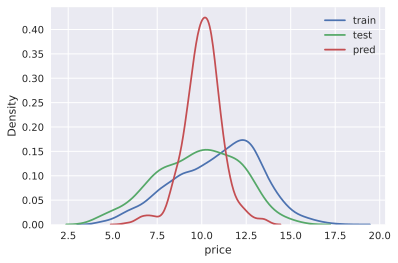

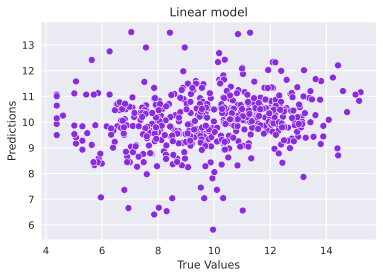

In [68]:
target_distr_linear(y_train, y_test, y_pred)  

In [69]:
def inverse_transform(feature):
    return np.expm1(feature)

calc_metrics(inverse_transform(y_test), inverse_transform(y_pred))

*** VAL **: 
MSE:   164843710945.39398
RMSE:  406009.4961271152
R2:    -0.08357088053520689
MAE:   140256.42758404763
MedAE: 30023.09616406941
------------------------------


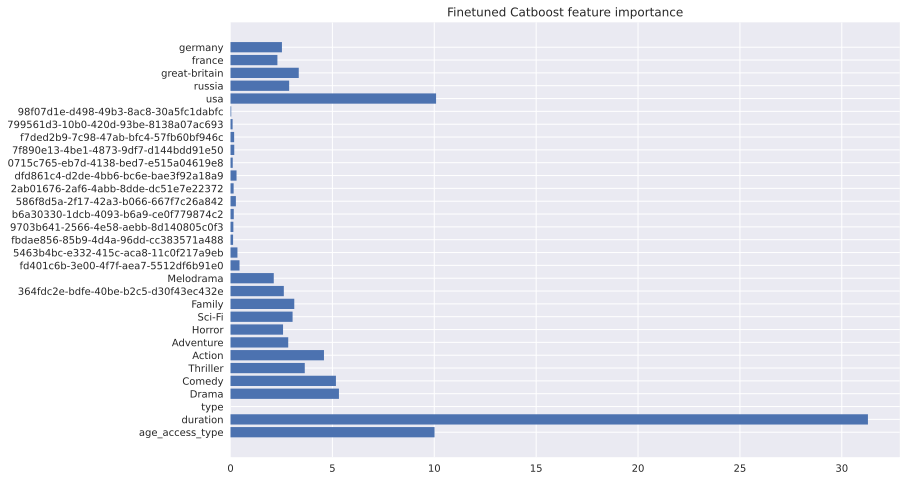

In [70]:
get_feature_imp(best_cat, train_dataset)

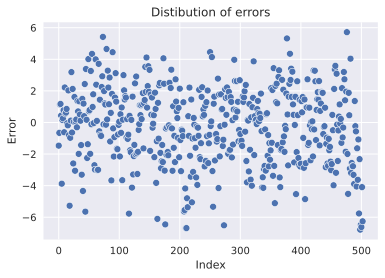

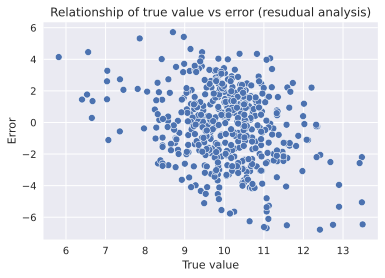

In [71]:
errors = y_test - y_pred
draw_res_analys(errors, y_pred)